In [3]:
from sklearn import svm,metrics
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math
import random
from sklearn.model_selection import train_test_split
from scipy.linalg import eigh

##'mnist.csv' has digits namely '3' and '8' only
mnist=pd.read_csv('mnist.csv')
xdata=mnist.iloc[:,2:].values
ydata=mnist.iloc[:,1].values
#xdata=np.array(mnist[mnist.columns[2:786]])
#ydata=np.array(mnist[mnist.columns[1:2]])
print(xdata.shape)
print(ydata.shape)

(11982, 784)
(11982,)


In [6]:
row, col = xdata.shape
# we convert each 784 entry rows into a row col 2D matrix of 28* 28 to visualize the image
a = np.zeros((int(math.pow(col, 0.5)), int(math.pow(col, 0.5))), np.int32)
r, c = a.shape

# randomly selecting a row for visualization
rand = random.randint(0, row)
img = xdata[rand]
test = ydata[rand]
#creating 2d image from pixel values
for i in range(r):
    for j in range(c):
        a[i][j] = xdata[rand][i * c + j]

#plt.imshow(a)
#plt.show()

Y = ydata
x_temp, x_test, y_temp, y_test = train_test_split(xdata, Y, test_size=0.2, random_state=50)
x_train, x_validation, y_train, y_validation = train_test_split(x_temp,y_temp,test_size=0.25,random_state=50)
print(x_train.shape)



(7188, 784)


reduced dimension shape= (7188, 256)
1000 256


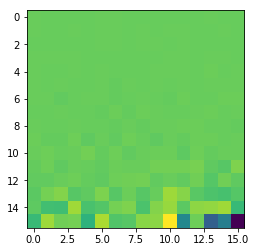

In [76]:
##applying pca to reduce the dimension of the images
def red_dim(X,new_dim=2):
    x=X.T
    m=x.shape[1]-1
    mean=np.mean(x,axis=1).reshape(-1,1)
    x=x-mean
    cov=np.cov(x.T)
    lam, V = eigh(cov,eigvals=(m - new_dim + 1, m))
    eigen_face = V.T @ x.T
    eigen_face.shape
    signature = (eigen_face @ x)
    return signature.T

x_train=red_dim(x_train,256)
print("reduced dimension shape=",x_train.shape)
plt.imshow(x_train[0].reshape(16,16))


mean=x_train.mean(axis=0)
std=x_train.std(axis=0)
x_train=(x_train-mean)/std
##converting 3 into -1 and 8 into 1
y_train = (y_train.reshape(-1,1) > 4) * 1 + (y_train.reshape(-1,1) < 4) * -1

x_test=x_train[1000:1500,:]
y_test=y_train[1000:1500,:]
x_train=x_train[:1000,:]
y_train=y_train[:1000,:]
m,n=x_train.shape
print(m,n)



In [83]:
def fx(x_train,alpha,y_train,xi,bias):
    return ((alpha*y_train*(x_train@xi.T)).sum(axis=0)+bias).reshape(-1,1)

c=1
tol=0.001
max_passes=20
alpha=np.zeros(m).reshape(-1,1)
bias=0
passes=0
while(passes<max_passes):
    num_changed_alphas=0
    for i in range(m):
        ssum=fx(x_train,alpha,y_train,x_train[[i]],bias)
        errori=ssum-y_train[i,0]
        if(((y_train[i,0]*errori < ((-1)*tol)) and (alpha[i,0]<c)) or ((y_train[i,0]*errori > tol) and (alpha[i,0]>0))):
            k=i
            while(k==i):
                k=random.randint(0,m-1)
            ssum=fx(x_train,alpha,y_train,x_train[[k]],bias)
            
            errork=ssum-y_train[k,0]
            oldalpha1=alpha[i,0]
            oldalpha2=alpha[k,0]
            if(y_train[i,0]!=y_train[k,0]):
                L=max(0,oldalpha2-oldalpha1)
                H=min(c,c+oldalpha2-oldalpha1)
            else:
                L=max(0,oldalpha1+oldalpha2-c)
                H=min(c,oldalpha1+oldalpha2)
            if(L==H):
                continue
            #n=2*np.inner(np.array(x_train[i]),np.array(x_train[k]))
            #n=n-np.inner(np.array(x_train[i]),np.array(x_train[i]))
            #n=n-np.inner(np.array(x_train[k]),np.array(x_train[k]))
            n = (2 * (x_train[i] @ x_train[k])) - (x_train[i] @ x_train[i]) - (x_train[k] @ x_train[k])
            print("n = {}".format(n))
            if(n>=0):
                continue
            temp=oldalpha2-(y_train[k,0]*(errori-errork)/n)
            if(temp>H):
                alpha[k]=H
            elif(temp>=L and temp<=H):
                alpha[k]=temp
            else:
                alpha[k]=L
            if(np.abs(alpha[k,0]-oldalpha2)<tol):
                continue
            alpha[i]=alpha[i,0]+(y_train[i,0]*y_train[k,0]*(alpha[k,0]-oldalpha2))
            b1=bias-errori-y_train[i,0]*(alpha[i,0]-oldalpha1)*(x_train[i]@x_train[i])
            -y_train[k,0]*(alpha[k,0]-oldalpha2)*(x_train[i]@x_train[k])
            b2=bias-errork-y_train[i,0]*(alpha[i,0]-oldalpha1)*(x_train[i]@x_train[k])
            -y_train[k,0]*(alpha[k]-oldalpha2)*(x_train[k]@x_train[k])
            if(alpha[i,0]>0 and alpha[i,0]<c):
                bias=b1
            elif(alpha[k,0]>0 and alpha[k,0]<c):
                bias=b2
            else:
                bias=(b1+b2)/2
            print("bias=",bias)
            num_changed_alphas=num_changed_alphas+1
            print("num_changed_alpha=",num_changed_alphas)
    if(num_changed_alphas==0):
        passes=passes+1
    else:
        passes=0


n = -670.691453151265
bias= [[-1.06624539]]
num_changed_alpha= 1
n = -566.3502716556102
bias= [[-0.98736947]]
num_changed_alpha= 2
n = -523.1588390075036
bias= [[1.22638213]]
num_changed_alpha= 3
n = -322.0065765659869
bias= [[1.05894621]]
num_changed_alpha= 4
n = -510.78242988273996
bias= [[1.03263601]]
num_changed_alpha= 5
n = -564.455148674785
bias= [[-1.50775323]]
num_changed_alpha= 6
n = -401.642163540753
bias= [[0.98692278]]
num_changed_alpha= 7
n = -703.9261548321945
bias= [[1.47050863]]
num_changed_alpha= 8
n = -628.3778967436297
bias= [[-0.23150461]]
num_changed_alpha= 9
n = -462.2523400939418
bias= [[1.43097211]]
num_changed_alpha= 10
n = -494.6120611449928
bias= [[0.94990247]]
num_changed_alpha= 11
n = -342.29042561976405
bias= [[1.1722225]]
num_changed_alpha= 12
n = -320.0540798997968
bias= [[1.14236588]]
num_changed_alpha= 13
n = -538.716927505299
bias= [[-1.51617936]]
num_changed_alpha= 14
n = -640.360387239175
bias= [[-0.42589294]]
num_changed_alpha= 15
n = -475.16165528

bias= [[0.18360436]]
num_changed_alpha= 119
n = -633.0826838054949
bias= [[1.10345383]]
num_changed_alpha= 120
n = -675.9725180417167
n = -338.3436596305731
bias= [[1.09143368]]
num_changed_alpha= 121
n = -559.2229875357914
bias= [[-1.14731982]]
num_changed_alpha= 122
n = -442.684173080551
n = -622.6487030894151
bias= [[3.43570974]]
num_changed_alpha= 123
n = -443.34193678139457
bias= [[-1.82816785]]
num_changed_alpha= 124
n = -425.22424480532015
bias= [[-1.24472471]]
num_changed_alpha= 125
n = -798.1887008628977
bias= [[-1.50216958]]
num_changed_alpha= 126
n = -309.66790323310624
n = -595.1734420294233
bias= [[1.66459362]]
num_changed_alpha= 127
n = -548.4592505753179
bias= [[-0.64790914]]
num_changed_alpha= 128
n = -576.6802340056668
bias= [[0.05502125]]
num_changed_alpha= 129
n = -644.9873228387022
n = -526.8452131084398
bias= [[1.10751696]]
num_changed_alpha= 130
n = -646.4471732499812
bias= [[0.08275551]]
num_changed_alpha= 131
n = -418.7194722452417
bias= [[0.77506555]]
num_chang

n = -438.35259339399227
bias= [[-0.38511447]]
num_changed_alpha= 226
n = -463.3202528790948
bias= [[-0.03336861]]
num_changed_alpha= 227
n = -668.7304430362952
n = -411.6763915622666
bias= [[-1.3144327]]
num_changed_alpha= 228
n = -312.66204381037653
bias= [[5.02315352]]
num_changed_alpha= 229
n = -621.1504499643011
n = -463.54362606937
n = -451.0722427077055
bias= [[2.04827266]]
num_changed_alpha= 230
n = -698.1457346965146
n = -727.6233530492846
n = -906.3902893696547
bias= [[0.66453494]]
num_changed_alpha= 231
n = -489.4393082262169
n = -665.3869246784865
bias= [[1.04580759]]
num_changed_alpha= 232
n = -376.19138527670395
bias= [[-2.23756754]]
num_changed_alpha= 233
n = -613.7225574419971
bias= [[0.71343875]]
num_changed_alpha= 234
n = -588.4204239281911
bias= [[7.39457025]]
num_changed_alpha= 235
n = -494.4087982252995
bias= [[1.87258649]]
num_changed_alpha= 236
n = -452.99630856611685
bias= [[2.19080964]]
num_changed_alpha= 237
n = -581.063967973253
bias= [[4.34264219]]
num_change

n = -420.05691237803626
bias= [[-2.815436]]
num_changed_alpha= 4
n = -439.813223389707
bias= [[4.87089675]]
num_changed_alpha= 5
n = -335.9366982701944
n = -560.2551727158223
bias= [[-0.30740345]]
num_changed_alpha= 6
n = -440.5640979560637
n = -593.7565783202422
bias= [[-1.93103889]]
num_changed_alpha= 7
n = -642.1712330985168
bias= [[0.81357033]]
num_changed_alpha= 8
n = -592.1586613034975
bias= [[-1.30566686]]
num_changed_alpha= 9
n = -516.1351734405719
bias= [[-0.49160894]]
num_changed_alpha= 10
n = -372.4988050634166
bias= [[0.82478573]]
num_changed_alpha= 11
n = -648.0584573083047
bias= [[2.22540688]]
num_changed_alpha= 12
n = -542.6740163960826
n = -638.1170265695771
bias= [[-8.61863663]]
num_changed_alpha= 13
n = -812.5036857150424
n = -454.4150252458282
bias= [[-4.85985483]]
num_changed_alpha= 14
n = -435.19334043390324
n = -441.9767895250586
bias= [[3.29101727]]
num_changed_alpha= 15
n = -545.481485415134
bias= [[-2.30714781]]
num_changed_alpha= 16
n = -439.16027276354055
bia

n = -845.5368918688214
bias= [[-4.52907512]]
num_changed_alpha= 115
n = -340.3394584948261
bias= [[2.27032064]]
num_changed_alpha= 116
n = -425.39337106624964
n = -480.8066536662801
n = -479.92818530347904
n = -492.6926306934297
bias= [[-0.85297831]]
num_changed_alpha= 117
n = -724.772552949972
bias= [[-7.62501004]]
num_changed_alpha= 118
n = -604.9807628158
bias= [[-13.22937424]]
num_changed_alpha= 119
n = -387.9722912551646
n = -382.3696612782602
n = -408.24146240146626
bias= [[-13.95630179]]
num_changed_alpha= 120
n = -410.9542836652866
bias= [[-5.38425907]]
num_changed_alpha= 121
n = -510.39988726446796
bias= [[-5.45853501]]
num_changed_alpha= 122
n = -516.7391572021194
bias= [[6.29303744]]
num_changed_alpha= 123
n = -495.4263992850938
n = -631.5396953722192
bias= [[1.17493596]]
num_changed_alpha= 124
n = -642.2774837617197
n = -468.47127848692384
bias= [[-11.65610733]]
num_changed_alpha= 125
n = -440.39129851112193
bias= [[-10.2773485]]
num_changed_alpha= 126
n = -419.484737839640

bias= [[-7.23029296]]
num_changed_alpha= 223
n = -487.04279928296125
bias= [[12.79068438]]
num_changed_alpha= 224
n = -484.9209346547708
n = -477.4179703950587
n = -432.21565926206307
bias= [[13.67535916]]
num_changed_alpha= 225
n = -549.0524465703468
bias= [[-3.16664805]]
num_changed_alpha= 226
n = -471.4961656979318
n = -682.7600518040897
bias= [[-23.01402478]]
num_changed_alpha= 227
n = -580.8368898486374
bias= [[-4.29054348]]
num_changed_alpha= 228
n = -380.74329585037617
n = -560.9912812812622
bias= [[-2.07316018]]
num_changed_alpha= 229
n = -397.28953494595476
bias= [[29.30075986]]
num_changed_alpha= 230
n = -450.7674341339348
bias= [[12.71685872]]
num_changed_alpha= 231
n = -603.98225764968
n = -319.9572871207328
bias= [[20.24242303]]
num_changed_alpha= 232
n = -603.2497800243871
bias= [[26.2822333]]
num_changed_alpha= 233
n = -702.8364291369944
bias= [[-29.65373587]]
num_changed_alpha= 234
n = -874.356173693018
bias= [[13.52502075]]
num_changed_alpha= 235
n = -445.4978308784081

n = -555.3177874564834
bias= [[-23.99930448]]
num_changed_alpha= 339
n = -618.9752819188573
n = -427.13857349554
n = -488.1439950689652
bias= [[-13.54734806]]
num_changed_alpha= 340
n = -410.5050643829497
bias= [[39.21357768]]
num_changed_alpha= 341
n = -754.4209582451615
bias= [[-80.14698161]]
num_changed_alpha= 342
n = -379.71886575092407
n = -784.6397573156878
bias= [[-32.97861686]]
num_changed_alpha= 343
n = -698.1488548130444
bias= [[-62.80855117]]
num_changed_alpha= 344
n = -262.01816861346765
bias= [[1.79668388]]
num_changed_alpha= 345
n = -598.3100166010515
n = -523.1943832831543
n = -519.7863227097552
bias= [[8.54345732]]
num_changed_alpha= 346
n = -445.5363911435751
bias= [[-0.82492362]]
num_changed_alpha= 347
n = -597.6646421634355
bias= [[-13.95680879]]
num_changed_alpha= 348
n = -392.8784032673335
bias= [[1.79300176]]
num_changed_alpha= 349
n = -472.5106041867731
n = -334.20277783383256
n = -445.1474722625152
n = -561.2742699439375
n = -652.7673574679055
n = -494.887807811

bias= [[12.65259366]]
num_changed_alpha= 37
n = -495.95128244627267
bias= [[-15.83450616]]
num_changed_alpha= 38
n = -688.0829359661248
bias= [[-124.74239774]]
num_changed_alpha= 39
n = -513.9016272976785
bias= [[30.37834237]]
num_changed_alpha= 40
n = -635.9490148620063
bias= [[36.64524175]]
num_changed_alpha= 41
n = -378.27856580977254
bias= [[39.82102842]]
num_changed_alpha= 42
n = -461.2658101118223
n = -451.39229049162805
n = -469.07510472997956
n = -420.99288170233706
n = -429.5761075072734
bias= [[99.98346529]]
num_changed_alpha= 43
n = -418.0329479314753
bias= [[-20.80703977]]
num_changed_alpha= 44
n = -539.062450177744
bias= [[50.15659585]]
num_changed_alpha= 45
n = -510.50959108396177
bias= [[-12.61334343]]
num_changed_alpha= 46
n = -400.28310522061497
bias= [[-30.69459715]]
num_changed_alpha= 47
n = -464.9610180805866
n = -520.4760468706993
bias= [[31.31557628]]
num_changed_alpha= 48
n = -587.7878328147233
bias= [[-88.61350803]]
num_changed_alpha= 49
n = -326.94619369598905


bias= [[-1.36438359]]
num_changed_alpha= 149
n = -492.71168223267955
bias= [[14.08308903]]
num_changed_alpha= 150
n = -683.5367873642268
n = -535.3021429818627
bias= [[1.68814374]]
num_changed_alpha= 151
n = -561.0663006814775
n = -397.6166434548567
n = -652.5325798984079
n = -503.85750764266015
bias= [[6.31552899]]
num_changed_alpha= 152
n = -524.4894152814895
bias= [[56.73171111]]
num_changed_alpha= 153
n = -601.633799635507
n = -658.5420712191051
bias= [[-52.34866877]]
num_changed_alpha= 154
n = -356.8176742904109
bias= [[-61.85457948]]
num_changed_alpha= 155
n = -564.4073513510983
n = -760.8182998511749
bias= [[6.35281532]]
num_changed_alpha= 156
n = -702.4114944094649
n = -409.21114128606894
bias= [[26.45918869]]
num_changed_alpha= 157
n = -482.44471198390033
bias= [[42.17976678]]
num_changed_alpha= 158
n = -406.3272837481105
n = -491.0271795445216
bias= [[16.47853436]]
num_changed_alpha= 159
n = -494.835751811807
n = -348.0737642376536
bias= [[77.35548251]]
num_changed_alpha= 160

bias= [[-13.55779394]]
num_changed_alpha= 257
n = -332.8214667648184
bias= [[-25.9968127]]
num_changed_alpha= 258
n = -298.74262737363387
bias= [[17.05442916]]
num_changed_alpha= 259
n = -512.1676113163378
bias= [[-43.74240743]]
num_changed_alpha= 260
n = -370.53344608862744
bias= [[-10.54731205]]
num_changed_alpha= 261
n = -343.06758741602505
bias= [[-2.45284118]]
num_changed_alpha= 262
n = -347.0396861809843
bias= [[74.92128646]]
num_changed_alpha= 263
n = -495.2902226654103
bias= [[58.33299052]]
num_changed_alpha= 264
n = -561.5047085798494
bias= [[-69.81842553]]
num_changed_alpha= 265
n = -414.8936421125235
bias= [[-13.46604881]]
num_changed_alpha= 266
n = -1141.3223706413246
bias= [[34.98757805]]
num_changed_alpha= 267
n = -430.23796952921504
n = -708.8791056774241
n = -403.91667943328355
bias= [[64.16511556]]
num_changed_alpha= 268
n = -849.2738220982305
bias= [[-35.7197291]]
num_changed_alpha= 269
n = -549.1126497121004
bias= [[-90.72608046]]
num_changed_alpha= 270
n = -481.5593

bias= [[43.9255986]]
num_changed_alpha= 373
n = -515.8429343007202
n = -389.853375541423
bias= [[73.73658196]]
num_changed_alpha= 374
n = -328.66234589879616
n = -540.1560248601481
bias= [[-32.68204644]]
num_changed_alpha= 375
n = -438.3753353415186
bias= [[-13.20089025]]
num_changed_alpha= 376
n = -556.5323156520769
bias= [[38.28607231]]
num_changed_alpha= 377
n = -517.6218538624802
bias= [[-150.65264104]]
num_changed_alpha= 378
n = -503.6700121521444
bias= [[24.84374912]]
num_changed_alpha= 379
n = -803.0983413951543
n = -310.977224227586
bias= [[34.95717716]]
num_changed_alpha= 380
n = -448.2291591442963
bias= [[-78.95030837]]
num_changed_alpha= 381
n = -656.2952968704947
bias= [[-174.55249562]]
num_changed_alpha= 382
n = -555.6475705390285
n = -386.78751448598547
n = -506.1551958297864
bias= [[8.04709827]]
num_changed_alpha= 383
n = -353.30090921314314
n = -564.244064418279
bias= [[-21.72941556]]
num_changed_alpha= 384
n = -930.9803089195517
bias= [[-43.96125338]]
num_changed_alpha

bias= [[-21.37578196]]
num_changed_alpha= 52
n = -816.4492896933059
n = -553.9476285434631
bias= [[-152.60867192]]
num_changed_alpha= 53
n = -374.59303078649396
bias= [[118.29055484]]
num_changed_alpha= 54
n = -843.729636474559
bias= [[23.3739741]]
num_changed_alpha= 55
n = -395.4449807053029
bias= [[67.36173485]]
num_changed_alpha= 56
n = -924.1075568756623
n = -676.0364594296702
bias= [[-136.53340633]]
num_changed_alpha= 57
n = -617.6954495498265
bias= [[332.71695527]]
num_changed_alpha= 58
n = -477.0344338960211
n = -374.16256641915277
bias= [[51.2383905]]
num_changed_alpha= 59
n = -477.0352411289433
n = -579.1389046442092
n = -684.5675869820856
bias= [[141.3200956]]
num_changed_alpha= 60
n = -822.0517000957861
bias= [[-86.30738334]]
num_changed_alpha= 61
n = -435.70978475678385
bias= [[-46.58499342]]
num_changed_alpha= 62
n = -418.3660660826923
bias= [[-56.3113091]]
num_changed_alpha= 63
n = -525.0681077863251
bias= [[103.19210889]]
num_changed_alpha= 64
n = -392.9360312347708
bias

bias= [[-54.51149925]]
num_changed_alpha= 168
n = -478.5247661359127
bias= [[306.82748736]]
num_changed_alpha= 169
n = -549.7347798488989
n = -424.06073194936573
bias= [[22.48347457]]
num_changed_alpha= 170
n = -533.2254006579037
n = -408.4076689959216
bias= [[38.90758355]]
num_changed_alpha= 171
n = -468.9369334701212
bias= [[114.95952459]]
num_changed_alpha= 172
n = -354.17607623532274
n = -492.1195122485336
bias= [[137.6517444]]
num_changed_alpha= 173
n = -487.8295604693658
bias= [[-19.28637261]]
num_changed_alpha= 174
n = -508.83753865565285
n = -522.0364669666533
n = -540.5436648954167
bias= [[34.90135034]]
num_changed_alpha= 175
n = -483.3080608572827
bias= [[-56.52380564]]
num_changed_alpha= 176
n = -519.7876816274955
bias= [[421.738842]]
num_changed_alpha= 177
n = -445.23115029067196
bias= [[219.46686185]]
num_changed_alpha= 178
n = -337.06382146656165
bias= [[161.55592396]]
num_changed_alpha= 179
n = -605.5650146781894
bias= [[256.20242355]]
num_changed_alpha= 180
n = -452.295

bias= [[-98.19775796]]
num_changed_alpha= 282
n = -683.0047553762674
bias= [[7.35328021]]
num_changed_alpha= 283
n = -519.6815542666698
n = -549.7012116556657
bias= [[-299.47552498]]
num_changed_alpha= 284
n = -470.2388854083255
bias= [[-61.32221944]]
num_changed_alpha= 285
n = -425.3355741941273
bias= [[108.4417378]]
num_changed_alpha= 286
n = -353.61223253108955
bias= [[120.27063325]]
num_changed_alpha= 287
n = -529.0531570718895
bias= [[-7.65337148]]
num_changed_alpha= 288
n = -398.21844748666877
bias= [[-9.8205908]]
num_changed_alpha= 289
n = -613.1942980862111
n = -930.907087848287
n = -361.0756369291616
bias= [[135.9048641]]
num_changed_alpha= 290
n = -862.959980712274
bias= [[-144.19198766]]
num_changed_alpha= 291
n = -622.8190319954122
n = -901.1932198447682
bias= [[235.48546307]]
num_changed_alpha= 292
n = -640.9873882331726
n = -629.1300313745164
bias= [[-375.18850637]]
num_changed_alpha= 293
n = -627.9046679398408
n = -299.1534344452409
n = -411.1565728076535
bias= [[-14.572

n = -454.76424080649105
n = -546.0399276712287
bias= [[-539.58573869]]
num_changed_alpha= 394
n = -305.4449527676429
n = -655.1043064451991
n = -444.04795110006705
bias= [[435.85113393]]
num_changed_alpha= 395
n = -899.8645740920268
n = -417.0817869805482
bias= [[121.72733253]]
num_changed_alpha= 396
n = -490.46818562741674
bias= [[-2.39698208]]
num_changed_alpha= 397
n = -379.08491778467067
bias= [[535.14296556]]
num_changed_alpha= 398
n = -444.1025611753379
bias= [[230.10794175]]
num_changed_alpha= 399
n = -555.9189920502187
n = -303.5263369830723
bias= [[-241.65747281]]
num_changed_alpha= 400
n = -534.5513064387827
bias= [[-394.70867241]]
num_changed_alpha= 401
n = -467.9996199082578
bias= [[230.27650701]]
num_changed_alpha= 402
n = -483.2503780422977
bias= [[-36.31491434]]
num_changed_alpha= 403
n = -737.824309747316
n = -722.6821375069031
n = -380.74319570093667
bias= [[152.54002499]]
num_changed_alpha= 404
n = -1020.4344635122111
bias= [[645.6206869]]
num_changed_alpha= 405
n = -

bias= [[204.73623512]]
num_changed_alpha= 41
n = -558.6647477354113
n = -714.5136340828846
bias= [[234.31415024]]
num_changed_alpha= 42
n = -382.62030306076076
bias= [[-175.08303368]]
num_changed_alpha= 43
n = -422.0607736652136
bias= [[-7.46640497]]
num_changed_alpha= 44
n = -455.0101917376752
bias= [[-228.98828816]]
num_changed_alpha= 45
n = -452.62015975375715
n = -520.7615438219524
n = -572.1485716228544
bias= [[-399.40868278]]
num_changed_alpha= 46
n = -621.8716839727424
bias= [[475.82813155]]
num_changed_alpha= 47
n = -499.50877853958144
bias= [[357.14525634]]
num_changed_alpha= 48
n = -659.4152741123023
bias= [[-84.23771133]]
num_changed_alpha= 49
n = -854.5798596296188
bias= [[315.49294202]]
num_changed_alpha= 50
n = -694.8051813671339
bias= [[-444.61991747]]
num_changed_alpha= 51
n = -307.7069817535571
n = -493.6698189396669
bias= [[559.08935621]]
num_changed_alpha= 52
n = -402.9533121541157
bias= [[-16.2226915]]
num_changed_alpha= 53
n = -345.6017053869905
n = -707.3271206741

n = -435.5290941612803
bias= [[53.04370275]]
num_changed_alpha= 155
n = -462.0456102594078
bias= [[299.9642681]]
num_changed_alpha= 156
n = -473.16081146163253
bias= [[102.17154268]]
num_changed_alpha= 157
n = -548.7639933006338
n = -400.36619347821886
n = -401.5122269635326
bias= [[323.44261663]]
num_changed_alpha= 158
n = -578.5442625557931
bias= [[605.32857373]]
num_changed_alpha= 159
n = -445.2474421760234
bias= [[-390.55220581]]
num_changed_alpha= 160
n = -425.6473779618715
bias= [[-146.90786912]]
num_changed_alpha= 161
n = -651.2040889980888
bias= [[-387.29184007]]
num_changed_alpha= 162
n = -577.7726802839456
bias= [[-242.06462923]]
num_changed_alpha= 163
n = -512.0456005558209
bias= [[41.70822795]]
num_changed_alpha= 164
n = -547.28831955397
bias= [[223.23030188]]
num_changed_alpha= 165
n = -434.90852891835675
bias= [[294.86644782]]
num_changed_alpha= 166
n = -712.8607648074674
bias= [[181.65101633]]
num_changed_alpha= 167
n = -433.84581981519074
bias= [[336.35223778]]
num_chan

bias= [[67.13466391]]
num_changed_alpha= 271
n = -513.3051558050678
bias= [[217.35801658]]
num_changed_alpha= 272
n = -638.5161391278912
n = -570.87117056745
bias= [[114.82016723]]
num_changed_alpha= 273
n = -472.68565300599806
bias= [[6.32020588]]
num_changed_alpha= 274
n = -611.4562014070766
bias= [[69.11337382]]
num_changed_alpha= 275
n = -425.7045659150423
bias= [[70.53099244]]
num_changed_alpha= 276
n = -518.8288883863663
bias= [[68.80278245]]
num_changed_alpha= 277
n = -610.1948287511962
n = -404.2346521496654
bias= [[132.00121732]]
num_changed_alpha= 278
n = -466.81129091125456
bias= [[-368.09139032]]
num_changed_alpha= 279
n = -318.182855670408
bias= [[-255.50165536]]
num_changed_alpha= 280
n = -595.754761727283
bias= [[65.93499674]]
num_changed_alpha= 281
n = -816.8028752080247
n = -638.1055067537817
bias= [[-295.45660721]]
num_changed_alpha= 282
n = -478.92209136303546
bias= [[-215.28029976]]
num_changed_alpha= 283
n = -455.567666560406
bias= [[-235.8915123]]
num_changed_alph

bias= [[109.69890181]]
num_changed_alpha= 385
n = -422.18265151705566
bias= [[-336.11533864]]
num_changed_alpha= 386
n = -378.43498742788347
bias= [[979.3879876]]
num_changed_alpha= 387
n = -631.8936580603947
bias= [[593.04594365]]
num_changed_alpha= 388
n = -590.2458926915672
n = -427.9201480353511
bias= [[369.13287963]]
num_changed_alpha= 389
n = -364.40903756504935
bias= [[156.18101407]]
num_changed_alpha= 390
n = -670.2945078702995
n = -499.82289526898603
n = -420.3502831230455
bias= [[-732.255012]]
num_changed_alpha= 391
n = -784.2479610464408
n = -310.62837370491496
bias= [[-4.03031709]]
num_changed_alpha= 392
n = -620.2086601269119
n = -599.0079826280487
bias= [[-824.91033591]]
num_changed_alpha= 393
n = -541.5283046330244
bias= [[-298.03893531]]
num_changed_alpha= 394
n = -409.8965913675114
bias= [[351.9572425]]
num_changed_alpha= 395
n = -334.543979760719
bias= [[139.2833234]]
num_changed_alpha= 396
n = -605.315283974124
bias= [[-7.31675205]]
num_changed_alpha= 397
n = -436.51

bias= [[-371.58287387]]
num_changed_alpha= 37
n = -487.04053942052724
bias= [[-258.08857645]]
num_changed_alpha= 38
n = -302.94013649082194
bias= [[213.40295238]]
num_changed_alpha= 39
n = -525.6872045356608
n = -585.8702812874262
n = -586.3109273001984
bias= [[238.18438011]]
num_changed_alpha= 40
n = -424.7897267768208
bias= [[632.79431234]]
num_changed_alpha= 41
n = -531.9962439627495
n = -450.72000433884216
bias= [[189.02170917]]
num_changed_alpha= 42
n = -397.2865115258393
n = -391.2740338217969
bias= [[-503.79007902]]
num_changed_alpha= 43
n = -468.5406283884784
n = -557.7974646174714
n = -687.548484264016
bias= [[319.89996559]]
num_changed_alpha= 44
n = -362.61983189073135
bias= [[-12.42424815]]
num_changed_alpha= 45
n = -500.12753963965616
bias= [[-212.25299271]]
num_changed_alpha= 46
n = -825.1854794908731
bias= [[-1153.77340834]]
num_changed_alpha= 47
n = -451.9596735485517
bias= [[853.15197549]]
num_changed_alpha= 48
n = -552.7071095366712
n = -421.32617963677535
bias= [[54.2

n = -517.817895196742
bias= [[-322.74988961]]
num_changed_alpha= 145
n = -351.73102283730054
bias= [[111.9916357]]
num_changed_alpha= 146
n = -424.1209861074443
bias= [[-374.06374814]]
num_changed_alpha= 147
n = -431.9200370245991
bias= [[-917.78654112]]
num_changed_alpha= 148
n = -427.65638924057356
bias= [[93.45914156]]
num_changed_alpha= 149
n = -512.0251975712808
bias= [[-102.38767448]]
num_changed_alpha= 150
n = -365.8659059499798
bias= [[503.31497858]]
num_changed_alpha= 151
n = -382.2651359269798
n = -394.3976629920669
n = -550.0373240394068
bias= [[-1665.30589333]]
num_changed_alpha= 152
n = -569.87590931736
n = -549.9219676063361
n = -515.3545302431139
n = -390.1390910988141
n = -643.7259844922988
bias= [[38.43169926]]
num_changed_alpha= 153
n = -340.8014101718251
n = -466.8190899835427
bias= [[697.79738991]]
num_changed_alpha= 154
n = -456.0348186472719
bias= [[545.46419936]]
num_changed_alpha= 155
n = -426.33138397434357
bias= [[-690.27235694]]
num_changed_alpha= 156
n = -84

bias= [[-194.04616604]]
num_changed_alpha= 253
n = -810.7648380985863
n = -405.43489431214414
n = -669.6807292664676
n = -511.75256947032
bias= [[87.62975723]]
num_changed_alpha= 254
n = -611.3089952481273
n = -488.54249270574053
bias= [[581.39166538]]
num_changed_alpha= 255
n = -397.79124326530405
bias= [[766.36702476]]
num_changed_alpha= 256
n = -845.5859913661941
bias= [[-540.73531502]]
num_changed_alpha= 257
n = -399.2728481768769
bias= [[-492.29806399]]
num_changed_alpha= 258
n = -402.81671547405733
bias= [[896.21681153]]
num_changed_alpha= 259
n = -386.4456253234506
n = -374.1587664075146
bias= [[191.45646111]]
num_changed_alpha= 260
n = -517.0185592024487
bias= [[-166.72858006]]
num_changed_alpha= 261
n = -575.185599902937
n = -519.6201871237497
bias= [[-545.35685758]]
num_changed_alpha= 262
n = -571.1816716166124
n = -392.076534682175
bias= [[-436.58933284]]
num_changed_alpha= 263
n = -602.265422800735
bias= [[-1545.07195326]]
num_changed_alpha= 264
n = -644.3745260338072
bias=

n = -473.7460087127495
n = -310.3099716183935
bias= [[2024.38716094]]
num_changed_alpha= 355
n = -332.20648958053033
bias= [[1098.29858523]]
num_changed_alpha= 356
n = -602.24027011815
n = -550.2932032473578
n = -466.5774126354819
bias= [[54.73367203]]
num_changed_alpha= 357
n = -431.2617387318799
bias= [[1083.85176622]]
num_changed_alpha= 358
n = -525.9488362142695
bias= [[50.14176409]]
num_changed_alpha= 359
n = -544.5014063527718
bias= [[-764.10537861]]
num_changed_alpha= 360
n = -694.1862015089002
n = -312.5106573902714
bias= [[395.7287833]]
num_changed_alpha= 361
n = -383.8776163323448
bias= [[621.59766821]]
num_changed_alpha= 362
n = -634.4640865564838
n = -791.8133967262131
bias= [[943.07701672]]
num_changed_alpha= 363
n = -633.6459634108244
bias= [[-138.4183152]]
num_changed_alpha= 364
n = -528.8102701317569
bias= [[-483.9591426]]
num_changed_alpha= 365
n = -666.3867255786852
bias= [[-579.31853355]]
num_changed_alpha= 366
n = -601.3977719967377
bias= [[-1123.80594632]]
num_chan

n = -319.6087623356525
bias= [[-1153.3448768]]
num_changed_alpha= 79
n = -479.48059669415494
n = -455.2381828645216
n = -390.8497345127115
bias= [[892.75238033]]
num_changed_alpha= 80
n = -403.429922915639
n = -344.1201653233595
n = -458.73770264296695
bias= [[-2661.35710217]]
num_changed_alpha= 81
n = -443.3544239247721
bias= [[1140.96292317]]
num_changed_alpha= 82
n = -562.1705520126344
bias= [[-2405.32918717]]
num_changed_alpha= 83
n = -579.9371162943578
bias= [[-1148.54455841]]
num_changed_alpha= 84
n = -438.25779415269085
bias= [[1016.50038953]]
num_changed_alpha= 85
n = -659.8868911658517
bias= [[-1636.65851729]]
num_changed_alpha= 86
n = -473.9828281998339
bias= [[-554.94358062]]
num_changed_alpha= 87
n = -463.2720251742494
n = -598.3240697566696
n = -549.1673855495151
n = -313.16951465805016
bias= [[-754.8524705]]
num_changed_alpha= 88
n = -762.7982603921726
n = -504.7487585048041
bias= [[-2506.84218242]]
num_changed_alpha= 89
n = -402.9815549855177
bias= [[1638.32647431]]
num_

bias= [[2463.30495787]]
num_changed_alpha= 185
n = -354.4225669532674
n = -432.68258461718494
n = -430.045362799119
bias= [[-1302.88097538]]
num_changed_alpha= 186
n = -654.0122606220634
bias= [[4085.35827013]]
num_changed_alpha= 187
n = -409.7097563824104
bias= [[-492.34558812]]
num_changed_alpha= 188
n = -681.3602766247388
bias= [[1372.82949408]]
num_changed_alpha= 189
n = -397.9621076799947
n = -528.184914621107
bias= [[-2948.36275154]]
num_changed_alpha= 190
n = -546.5654039916742
bias= [[-1519.03445715]]
num_changed_alpha= 191
n = -393.51571720203276
bias= [[2482.02140749]]
num_changed_alpha= 192
n = -766.8684512481076
n = -342.96263445037505
bias= [[2652.66742529]]
num_changed_alpha= 193
n = -406.8442835365812
bias= [[-19.90340999]]
num_changed_alpha= 194
n = -448.6211835726108
bias= [[649.56662563]]
num_changed_alpha= 195
n = -724.7914717826284
bias= [[341.59655533]]
num_changed_alpha= 196
n = -451.24415632661
bias= [[953.92016862]]
num_changed_alpha= 197
n = -577.7113489435643


bias= [[3476.59243644]]
num_changed_alpha= 302
n = -313.66939741951455
n = -320.5403360365174
n = -415.524828428851
bias= [[1839.93541856]]
num_changed_alpha= 303
n = -695.8775623984345
n = -423.2178507660636
bias= [[1987.57413697]]
num_changed_alpha= 304
n = -667.9950812822892
n = -412.79582657974686
bias= [[-1686.05554016]]
num_changed_alpha= 305
n = -949.1060654465005
n = -390.9175421338938
bias= [[-764.12309222]]
num_changed_alpha= 306
n = -649.1483205717859
bias= [[26.45202571]]
num_changed_alpha= 307
n = -380.7529991508844
bias= [[249.28212329]]
num_changed_alpha= 308
n = -417.4671555992983
bias= [[-3055.46830629]]
num_changed_alpha= 309
n = -527.4912065968153
n = -367.8335373471822
bias= [[289.89064735]]
num_changed_alpha= 310
n = -491.11852962192575
bias= [[1551.92591287]]
num_changed_alpha= 311
n = -542.2273907750312
bias= [[859.14715773]]
num_changed_alpha= 312
n = -339.5043487064787
bias= [[2998.86369494]]
num_changed_alpha= 313
n = -493.4027291236623
n = -469.96331071194436

n = -545.9844314812077
bias= [[-297.99956918]]
num_changed_alpha= 66
n = -439.0731646158091
bias= [[-4368.16722343]]
num_changed_alpha= 67
n = -443.03115367004
n = -601.933345422276
bias= [[-4179.00263437]]
num_changed_alpha= 68
n = -709.2785785336378
bias= [[-3570.17014513]]
num_changed_alpha= 69
n = -423.69338495256045
bias= [[2149.42789154]]
num_changed_alpha= 70
n = -392.39448154372724
n = -486.0206057855343
n = -644.4928075576464
bias= [[2864.31102931]]
num_changed_alpha= 71
n = -613.3547964890238
n = -403.90019865752635
bias= [[6875.62726714]]
num_changed_alpha= 72
n = -476.35335669162777
n = -414.50788816751964
bias= [[6647.45215858]]
num_changed_alpha= 73
n = -385.52142271326517
n = -338.7261568571298
n = -531.2877959815346
n = -814.7690013434747
n = -599.3543613239042
bias= [[-3019.66452117]]
num_changed_alpha= 74
n = -462.4334169198886
n = -610.8679578355534
bias= [[2980.53563264]]
num_changed_alpha= 75
n = -414.01607106360063
bias= [[2843.01718226]]
num_changed_alpha= 76
n =

bias= [[2377.38937151]]
num_changed_alpha= 178
n = -342.0765071597403
n = -742.1329624970065
bias= [[2059.38910161]]
num_changed_alpha= 179
n = -622.3119177955425
bias= [[-1982.63866912]]
num_changed_alpha= 180
n = -379.3452800834857
n = -358.8542683813844
n = -427.2735190193373
bias= [[2286.17961273]]
num_changed_alpha= 181
n = -397.7728497438611
n = -732.7487263065176
bias= [[-3155.79728989]]
num_changed_alpha= 182
n = -489.2898745816872
n = -472.45961968824
n = -724.5651865673133
n = -592.0071430353122
n = -557.6757376134411
n = -495.3456623284678
bias= [[5856.6382863]]
num_changed_alpha= 183
n = -506.27690101834037
bias= [[-6664.62850324]]
num_changed_alpha= 184
n = -640.3835530037021
n = -447.29676188608306
bias= [[1533.42510188]]
num_changed_alpha= 185
n = -546.8767743645001
n = -468.37014258196655
n = -584.0607838695519
bias= [[4434.07784839]]
num_changed_alpha= 186
n = -567.2715218642104
bias= [[-2335.79245566]]
num_changed_alpha= 187
n = -416.28860612147076
bias= [[2872.167622

bias= [[7405.71332451]]
num_changed_alpha= 281
n = -607.8528797402952
n = -557.9420166923634
bias= [[320.98868394]]
num_changed_alpha= 282
n = -529.7149955007455
bias= [[6699.59354514]]
num_changed_alpha= 283
n = -544.7659978406384
bias= [[-1683.19277093]]
num_changed_alpha= 284
n = -447.1274975844633
bias= [[2459.54951802]]
num_changed_alpha= 285
n = -431.88599858323255
bias= [[-620.00577213]]
num_changed_alpha= 286
n = -347.5573838842073
bias= [[8598.81575849]]
num_changed_alpha= 287
n = -376.06698198237245
bias= [[4455.32030157]]
num_changed_alpha= 288
n = -673.2197537646381
bias= [[-8855.21842775]]
num_changed_alpha= 289
n = -512.121232325567
bias= [[5882.05067965]]
num_changed_alpha= 290
n = -566.7746934770951
bias= [[6488.03152844]]
num_changed_alpha= 291
n = -487.526627630692
n = -434.2094039063147
bias= [[-3396.11038955]]
num_changed_alpha= 292
n = -654.7505044559803
n = -393.34682694850954
bias= [[-1441.47002861]]
num_changed_alpha= 293
n = -574.8893282586107
bias= [[-3048.196

bias= [[-1489.78175037]]
num_changed_alpha= 91
n = -495.05065378493623
bias= [[5599.76325637]]
num_changed_alpha= 92
n = -607.1698198341
bias= [[6078.20903101]]
num_changed_alpha= 93
n = -508.67901584590925
bias= [[8571.27541808]]
num_changed_alpha= 94
n = -510.84032208803427
bias= [[-11086.94746415]]
num_changed_alpha= 95
n = -338.17179598369853
bias= [[-500.66184595]]
num_changed_alpha= 96
n = -414.16257044973105
bias= [[-2751.5494582]]
num_changed_alpha= 97
n = -472.74339440576136
bias= [[5942.68161744]]
num_changed_alpha= 98
n = -636.6704977123763
n = -621.3298146784841
n = -443.40663829872267
n = -582.5968481982852
bias= [[-1924.77883757]]
num_changed_alpha= 99
n = -441.2166038463403
n = -620.5958638225821
bias= [[-8488.64000236]]
num_changed_alpha= 100
n = -457.6659779149003
n = -612.9047986514871
bias= [[-14354.96265607]]
num_changed_alpha= 101
n = -549.4062467591525
n = -609.0093378829386
bias= [[-3228.62948141]]
num_changed_alpha= 102
n = -374.9770186593506
bias= [[-3117.04079

bias= [[1079.07267074]]
num_changed_alpha= 193
n = -559.5037608898367
bias= [[-8656.42282263]]
num_changed_alpha= 194
n = -397.0705447914214
n = -558.9000590624337
bias= [[-2376.29306142]]
num_changed_alpha= 195
n = -487.89441874178806
n = -451.26578922699156
n = -546.5835341477296
bias= [[-277.69044454]]
num_changed_alpha= 196
n = -498.0236589638358
bias= [[7589.67111185]]
num_changed_alpha= 197
n = -480.28285631135464
bias= [[-1643.58422696]]
num_changed_alpha= 198
n = -492.41389788653703
n = -416.0411096335147
n = -578.8004222188393
bias= [[-3288.77020894]]
num_changed_alpha= 199
n = -428.60918169854733
n = -663.767899859939
bias= [[-2508.84947886]]
num_changed_alpha= 200
n = -518.843101207864
n = -417.1675134704818
n = -520.3331955702696
bias= [[-14779.40955231]]
num_changed_alpha= 201
n = -1083.5340271311497
bias= [[-5401.21114543]]
num_changed_alpha= 202
n = -442.6735962929449
bias= [[-430.56948521]]
num_changed_alpha= 203
n = -297.3387957897072
n = -423.17124971579403
bias= [[31

n = -564.5738334633975
n = -712.3857930930965
bias= [[-910.54891251]]
num_changed_alpha= 4
n = -441.6777593607039
bias= [[9669.42314497]]
num_changed_alpha= 5
n = -533.3790999881343
bias= [[1610.17964659]]
num_changed_alpha= 6
n = -363.4011922271703
bias= [[-4164.60117064]]
num_changed_alpha= 7
n = -315.05818861108395
n = -456.68709993736786
bias= [[-13910.36914817]]
num_changed_alpha= 8
n = -369.2641796403725
bias= [[19354.45197787]]
num_changed_alpha= 9
n = -407.4451788125858
bias= [[-1120.976395]]
num_changed_alpha= 10
n = -545.5689015268661
bias= [[1541.42348084]]
num_changed_alpha= 11
n = -362.87360312849853
bias= [[8455.76060633]]
num_changed_alpha= 12
n = -426.3680477904875
bias= [[-14803.07446873]]
num_changed_alpha= 13
n = -457.92841452769176
n = -508.67378716560216
n = -401.4014135930331
bias= [[3148.11608155]]
num_changed_alpha= 14
n = -386.3657065737325
bias= [[-5706.79950614]]
num_changed_alpha= 15
n = -420.89538826298997
n = -489.8901972305284
bias= [[-7380.34698135]]
num

n = -578.7930060373264
n = -332.042860352749
n = -554.9151879547574
n = -444.07757321496047
bias= [[-2093.0671296]]
num_changed_alpha= 117
n = -609.0064437738548
bias= [[-1851.78726839]]
num_changed_alpha= 118
n = -342.3720483315607
bias= [[9148.50274161]]
num_changed_alpha= 119
n = -428.76879829351003
n = -318.79012249986386
bias= [[2075.89882125]]
num_changed_alpha= 120
n = -522.0444028806597
n = -465.69072143879373
bias= [[10584.75868185]]
num_changed_alpha= 121
n = -594.1109199152623
n = -407.2813039695525
bias= [[-2700.66060844]]
num_changed_alpha= 122
n = -323.75814734160576
n = -576.5880396708693
bias= [[-16595.7591788]]
num_changed_alpha= 123
n = -501.98780818679313
bias= [[-21615.59199639]]
num_changed_alpha= 124
n = -520.5753715458934
n = -498.3214457432236
bias= [[-21737.57059889]]
num_changed_alpha= 125
n = -408.04330221332805
n = -494.3802793047164
n = -465.6508447494539
bias= [[14652.34286004]]
num_changed_alpha= 126
n = -352.01551735089663
bias= [[-4159.99904157]]
num_ch

n = -529.3980383757137
n = -370.1002233109986
n = -581.3210252811909
n = -393.72813996303137
n = -608.9819502166725
bias= [[11010.88276758]]
num_changed_alpha= 221
n = -311.3691468264584
n = -597.4489900791114
n = -634.2682765491061
bias= [[-15760.86519058]]
num_changed_alpha= 222
n = -489.52279073617683
n = -633.5596826069157
bias= [[9376.70300701]]
num_changed_alpha= 223
n = -464.8452208393868
bias= [[1048.29198929]]
num_changed_alpha= 224
n = -302.30514232866676
n = -478.7869492081987
bias= [[666.86888692]]
num_changed_alpha= 225
n = -532.3120525182652
bias= [[-12159.52537718]]
num_changed_alpha= 226
n = -266.81111578197397
n = -476.7029527109255
bias= [[2832.94573492]]
num_changed_alpha= 227
n = -333.52410950746787
n = -407.7071940086065
n = -423.26773222728104
n = -626.9190547262355
n = -290.8417665804744
bias= [[14767.20321095]]
num_changed_alpha= 228
n = -313.2855840748488
n = -282.0006836173294
bias= [[17516.89396964]]
num_changed_alpha= 229
n = -462.1207591241953
bias= [[-7635

bias= [[-15110.50325755]]
num_changed_alpha= 46
n = -674.5771941812271
n = -495.6258501557284
n = -636.9450768810889
bias= [[11430.19106701]]
num_changed_alpha= 47
n = -384.5519401951782
n = -766.6379131496201
bias= [[4260.37587294]]
num_changed_alpha= 48
n = -505.8852475457171
n = -516.37004580982
n = -460.3414089411183
bias= [[4283.80715012]]
num_changed_alpha= 49
n = -454.7366312099818
bias= [[11571.74926348]]
num_changed_alpha= 50
n = -392.094708265479
n = -532.4586789695965
bias= [[-4910.62359046]]
num_changed_alpha= 51
n = -530.0262165829251
bias= [[-10980.07724991]]
num_changed_alpha= 52
n = -619.2714340607998
bias= [[-12326.84465214]]
num_changed_alpha= 53
n = -389.033945966738
n = -408.64206158219866
n = -465.43542879351736
bias= [[-4963.87470419]]
num_changed_alpha= 54
n = -691.6997062250695
bias= [[-2115.96448785]]
num_changed_alpha= 55
n = -665.7866296011973
bias= [[-26429.70800923]]
num_changed_alpha= 56
n = -548.1332341288943
n = -561.5267511995032
bias= [[3314.70596439]]

n = -712.4694310147719
n = -388.52535490929114
bias= [[14417.33319867]]
num_changed_alpha= 154
n = -582.0804139058728
bias= [[6426.04573695]]
num_changed_alpha= 155
n = -563.6069496515261
bias= [[-13921.9356775]]
num_changed_alpha= 156
n = -557.8976398610155
bias= [[-1181.92252914]]
num_changed_alpha= 157
n = -683.9150737095034
n = -522.3370346385377
bias= [[-20497.30031007]]
num_changed_alpha= 158
n = -570.2055207440852
bias= [[-13406.71527054]]
num_changed_alpha= 159
n = -331.8024641679136
n = -563.457064226872
n = -535.5355522696741
n = -569.19327110324
n = -417.5189628936732
bias= [[1275.96645983]]
num_changed_alpha= 160
n = -639.2514635613959
bias= [[-7678.60766261]]
num_changed_alpha= 161
n = -431.3377925918712
n = -500.4235867599667
n = -446.5182322088911
bias= [[11561.071476]]
num_changed_alpha= 162
n = -821.6177217971976
bias= [[-459.98615466]]
num_changed_alpha= 163
n = -456.9637088267136
n = -542.8692984724315
bias= [[593.85602018]]
num_changed_alpha= 164
n = -420.4042023998

bias= [[-13127.75639223]]
num_changed_alpha= 257
n = -358.0816451124121
bias= [[-1125.89840026]]
num_changed_alpha= 258
n = -431.6590146982977
bias= [[1151.77358893]]
num_changed_alpha= 259
n = -460.90544136365327
n = -567.0592658156971
bias= [[-15603.5559306]]
num_changed_alpha= 260
n = -658.2780639978912
bias= [[-8110.02032575]]
num_changed_alpha= 261
n = -499.9928852025364
bias= [[-2113.68623629]]
num_changed_alpha= 262
n = -335.8372568543539
bias= [[4941.3716462]]
num_changed_alpha= 263
n = -500.87357449696293
bias= [[20713.28649399]]
num_changed_alpha= 264
n = -527.8188284095684
bias= [[15967.18906374]]
num_changed_alpha= 265
n = -441.3212720572021
n = -342.8828754192241
n = -274.5894497616971
bias= [[7318.69159184]]
num_changed_alpha= 266
n = -453.25263642775803
bias= [[-4934.28480206]]
num_changed_alpha= 267
n = -596.7397536732586
bias= [[-10373.74204985]]
num_changed_alpha= 268
n = -439.4527151843008
n = -316.6840766335712
n = -518.9286975304254
bias= [[-987.4937269]]
num_chang

bias= [[30008.38434225]]
num_changed_alpha= 63
n = -450.55334877387327
bias= [[18080.13646856]]
num_changed_alpha= 64
n = -444.736909130084
bias= [[-945.09894628]]
num_changed_alpha= 65
n = -439.2901651706586
bias= [[9522.5047195]]
num_changed_alpha= 66
n = -345.2482384257431
bias= [[8918.25656192]]
num_changed_alpha= 67
n = -443.74936817284856
bias= [[3504.84290474]]
num_changed_alpha= 68
n = -302.1310105067837
n = -679.223280560255
bias= [[24101.021466]]
num_changed_alpha= 69
n = -486.60783893119884
bias= [[-8013.67187577]]
num_changed_alpha= 70
n = -404.8092208944312
bias= [[16512.36180747]]
num_changed_alpha= 71
n = -536.2321486351107
n = -411.47344679884947
bias= [[-12874.98979905]]
num_changed_alpha= 72
n = -630.9846174458513
bias= [[-5354.53644386]]
num_changed_alpha= 73
n = -556.3014693130282
bias= [[-17406.47120125]]
num_changed_alpha= 74
n = -404.09757853406586
bias= [[2339.33705161]]
num_changed_alpha= 75
n = -859.5000078207863
bias= [[-23320.09253653]]
num_changed_alpha= 76

n = -579.9828158904099
bias= [[-8400.77339634]]
num_changed_alpha= 172
n = -485.62109338852605
n = -481.7994942337607
bias= [[1053.15472124]]
num_changed_alpha= 173
n = -541.6503464004326
bias= [[33069.29902455]]
num_changed_alpha= 174
n = -412.41139761266027
bias= [[5503.39620724]]
num_changed_alpha= 175
n = -457.6695021867845
bias= [[-11875.48044244]]
num_changed_alpha= 176
n = -789.1460224596608
n = -848.014573731333
bias= [[11178.20719092]]
num_changed_alpha= 177
n = -743.1057946858889
bias= [[-20460.66026695]]
num_changed_alpha= 178
n = -465.77887934097873
bias= [[-5044.50297373]]
num_changed_alpha= 179
n = -306.17977397994434
n = -444.66334559721855
bias= [[-692.81693368]]
num_changed_alpha= 180
n = -537.0051225979918
bias= [[-22796.26830529]]
num_changed_alpha= 181
n = -478.86307026261613
bias= [[2075.29793372]]
num_changed_alpha= 182
n = -397.6641495554934
n = -886.1752026888538
n = -639.6839128066829
n = -563.8474280545499
n = -511.84112842172703
bias= [[7410.99139521]]
num_ch

n = -545.6282383919224
n = -406.61308008694584
bias= [[11927.14941584]]
num_changed_alpha= 1
n = -295.69073313379073
bias= [[4015.69996479]]
num_changed_alpha= 2
n = -781.5648521275649
bias= [[2531.26569572]]
num_changed_alpha= 3
n = -428.00235607668594
bias= [[-4637.13639466]]
num_changed_alpha= 4
n = -531.8466283507232
n = -524.6491262947408
bias= [[1657.47809601]]
num_changed_alpha= 5
n = -472.9065202439558
bias= [[-5381.08423333]]
num_changed_alpha= 6
n = -432.97347993352275
n = -489.20139698362243
bias= [[23018.70072688]]
num_changed_alpha= 7
n = -451.8029971426762
n = -425.58562011098047
bias= [[14376.0644493]]
num_changed_alpha= 8
n = -520.4572944472651
bias= [[-8977.61678046]]
num_changed_alpha= 9
n = -813.996601377562
bias= [[15310.26344119]]
num_changed_alpha= 10
n = -558.0250808863278
bias= [[15138.53292525]]
num_changed_alpha= 11
n = -345.7719856508792
n = -481.1622763776392
n = -864.5537859015134
n = -531.7886990333077
n = -614.3969868774531
bias= [[-22420.55649592]]
num_c

bias= [[17779.42200736]]
num_changed_alpha= 100
n = -275.99383053843985
bias= [[-10367.75370349]]
num_changed_alpha= 101
n = -559.000952992049
bias= [[-16216.55840777]]
num_changed_alpha= 102
n = -655.8932618142145
bias= [[-18241.21422599]]
num_changed_alpha= 103
n = -666.0192824431201
n = -302.2943243349108
bias= [[17257.67935819]]
num_changed_alpha= 104
n = -405.8590337823791
n = -501.1312721801279
n = -719.792728488784
bias= [[-9446.00306048]]
num_changed_alpha= 105
n = -562.4399565518889
bias= [[17502.06393944]]
num_changed_alpha= 106
n = -502.19236303237994
bias= [[-25624.319965]]
num_changed_alpha= 107
n = -600.8015584614104
bias= [[8551.9265994]]
num_changed_alpha= 108
n = -739.2572527503271
bias= [[6098.836706]]
num_changed_alpha= 109
n = -675.686352812159
bias= [[-17241.78256261]]
num_changed_alpha= 110
n = -451.441343725569
bias= [[-35413.78250748]]
num_changed_alpha= 111
n = -484.4643124952633
n = -588.148056957942
bias= [[-5980.03224959]]
num_changed_alpha= 112
n = -416.009

bias= [[1170.18754904]]
num_changed_alpha= 203
n = -573.4183624941186
n = -648.6962502025665
bias= [[14931.45848279]]
num_changed_alpha= 204
n = -448.4772621285313
bias= [[14861.41551767]]
num_changed_alpha= 205
n = -346.63964123916065
bias= [[16836.57764022]]
num_changed_alpha= 206
n = -467.67500388517453
n = -372.6126650170454
bias= [[17218.28050479]]
num_changed_alpha= 207
n = -448.4576414991505
bias= [[-4796.3242973]]
num_changed_alpha= 208
n = -944.4278378974442
bias= [[-14451.08997298]]
num_changed_alpha= 209
n = -884.5847072995368
bias= [[-18970.80202598]]
num_changed_alpha= 210
n = -364.4928318925543
bias= [[14443.39482768]]
num_changed_alpha= 211
n = -550.318052199356
bias= [[-41580.58180317]]
num_changed_alpha= 212
n = -529.3288622890572
n = -664.5426315647369
bias= [[-29711.63655461]]
num_changed_alpha= 213
n = -535.1751462043476
n = -555.2810286099973
bias= [[6145.58367022]]
num_changed_alpha= 214
n = -491.22808525213765
n = -475.11447745831777
bias= [[16673.39235264]]
num_

bias= [[4223.29728786]]
num_changed_alpha= 20
n = -486.90645376996076
n = -458.54081696989954
bias= [[-11882.7209337]]
num_changed_alpha= 21
n = -493.48067465745373
bias= [[13459.97953553]]
num_changed_alpha= 22
n = -694.8051813671339
bias= [[-18851.28017085]]
num_changed_alpha= 23
n = -398.9127592039453
bias= [[-1020.5898849]]
num_changed_alpha= 24
n = -421.77211811039433
bias= [[-19092.65248481]]
num_changed_alpha= 25
n = -845.0923988814301
bias= [[-60338.50184975]]
num_changed_alpha= 26
n = -437.1538043333204
n = -391.91330371412414
bias= [[-1632.15510981]]
num_changed_alpha= 27
n = -428.55591574360335
bias= [[13795.50518741]]
num_changed_alpha= 28
n = -1017.6884566785153
bias= [[-23621.55172378]]
num_changed_alpha= 29
n = -615.2115141033879
n = -506.79813253503244
bias= [[11371.76819675]]
num_changed_alpha= 30
n = -549.5902559475649
bias= [[-19804.70299683]]
num_changed_alpha= 31
n = -499.6590761095822
bias= [[7160.68056473]]
num_changed_alpha= 32
n = -352.8121720999153
bias= [[297

n = -519.5895869740214
n = -952.3321408439257
n = -475.0773128171388
bias= [[5123.52852378]]
num_changed_alpha= 121
n = -672.5714511470123
n = -627.0184459216568
bias= [[5255.79471408]]
num_changed_alpha= 122
n = -612.5453194962372
bias= [[-24093.33527332]]
num_changed_alpha= 123
n = -763.1975325263041
bias= [[10683.86564407]]
num_changed_alpha= 124
n = -749.526861028861
bias= [[-6576.75703512]]
num_changed_alpha= 125
n = -539.7011225148053
n = -730.37845922362
bias= [[-12835.87684975]]
num_changed_alpha= 126
n = -717.0121371861892
bias= [[11532.66364784]]
num_changed_alpha= 127
n = -736.1958241709349
n = -417.7096810039667
bias= [[-13699.17086605]]
num_changed_alpha= 128
n = -414.4715226783745
bias= [[16636.80695696]]
num_changed_alpha= 129
n = -589.6742146374016
bias= [[5717.5945952]]
num_changed_alpha= 130
n = -523.5065354972457
bias= [[-5036.59273016]]
num_changed_alpha= 131
n = -638.5916027474264
bias= [[5912.24478895]]
num_changed_alpha= 132
n = -553.8899275969784
n = -711.272579

n = -674.2744281728828
n = -598.752039840314
bias= [[13207.44646832]]
num_changed_alpha= 222
n = -534.5902799932614
n = -525.8806880401659
n = -465.1004075444231
n = -472.53477102365133
n = -457.9417919286457
bias= [[4886.26716379]]
num_changed_alpha= 223
n = -313.99696321055615
bias= [[33161.68522144]]
num_changed_alpha= 224
n = -769.1872427104587
n = -614.5732214853721
bias= [[-6965.30315973]]
num_changed_alpha= 225
n = -663.7163101005141
bias= [[-11886.24487071]]
num_changed_alpha= 226
n = -514.3309850767151
bias= [[19604.22080254]]
num_changed_alpha= 227
n = -583.8831519570729
n = -538.840996665582
bias= [[23971.79811699]]
num_changed_alpha= 228
n = -394.39173584653946
n = -407.699292739116
bias= [[7861.28102925]]
num_changed_alpha= 229
n = -533.9748029567057
bias= [[6185.05206861]]
num_changed_alpha= 230
n = -441.8585658063804
bias= [[16309.39740623]]
num_changed_alpha= 231
n = -440.3311093179597
bias= [[31806.28056483]]
num_changed_alpha= 232
n = -414.87104147857104
bias= [[-599.

bias= [[-30899.85114253]]
num_changed_alpha= 60
n = -838.6539747891081
bias= [[-6866.39641305]]
num_changed_alpha= 61
n = -657.1853688666185
bias= [[-12097.17887798]]
num_changed_alpha= 62
n = -401.56174859302484
bias= [[32803.12275948]]
num_changed_alpha= 63
n = -604.1474690049705
n = -302.9114636534477
n = -608.7528771320068
n = -403.98019010213017
bias= [[35006.29325571]]
num_changed_alpha= 64
n = -437.2477087884563
bias= [[35959.12716581]]
num_changed_alpha= 65
n = -463.1564599153524
bias= [[-15538.82719436]]
num_changed_alpha= 66
n = -486.7683848345987
n = -377.363864605587
bias= [[-14964.89969451]]
num_changed_alpha= 67
n = -399.5191179147392
n = -458.74474639126515
bias= [[-12833.90223336]]
num_changed_alpha= 68
n = -393.6934540287911
bias= [[10311.26502533]]
num_changed_alpha= 69
n = -866.3254426710699
n = -409.07585667231467
bias= [[-18287.05082668]]
num_changed_alpha= 70
n = -731.0046120547978
n = -410.03923215573275
bias= [[20774.94596253]]
num_changed_alpha= 71
n = -695.507

n = -673.8278718831257
bias= [[-32068.14600634]]
num_changed_alpha= 154
n = -461.5438351631848
bias= [[-11328.22145455]]
num_changed_alpha= 155
n = -669.5098678819318
n = -433.2126472605803
bias= [[-5354.86485562]]
num_changed_alpha= 156
n = -407.61514848535325
n = -640.0544212358268
bias= [[-1813.87057799]]
num_changed_alpha= 157
n = -734.029246562376
n = -671.3640092401681
bias= [[7378.15711591]]
num_changed_alpha= 158
n = -299.37515022352864
bias= [[37051.82788741]]
num_changed_alpha= 159
n = -644.497516953341
n = -336.83249179974126
n = -467.56428454509
bias= [[-3417.68264492]]
num_changed_alpha= 160
n = -457.7005275119309
n = -485.7620271066319
n = -514.9124625483715
bias= [[-38011.29469012]]
num_changed_alpha= 161
n = -556.3927093267322
n = -475.58443698130816
n = -566.4844210254719
n = -496.3875586356568
bias= [[16647.65591236]]
num_changed_alpha= 162
n = -522.7786833043963
bias= [[10654.89585726]]
num_changed_alpha= 163
n = -366.5618134400029
bias= [[23173.99754872]]
num_change

bias= [[25673.2675795]]
num_changed_alpha= 14
n = -444.1493989447911
bias= [[-24110.76667026]]
num_changed_alpha= 15
n = -771.7737417624242
bias= [[4325.96489269]]
num_changed_alpha= 16
n = -674.4943510717121
n = -360.8639762531751
n = -494.63939827111386
bias= [[4877.58160939]]
num_changed_alpha= 17
n = -614.1747829791483
bias= [[-47739.41088275]]
num_changed_alpha= 18
n = -482.004374058909
n = -683.2774459112591
bias= [[-48394.72843273]]
num_changed_alpha= 19
n = -378.9631862312739
bias= [[-6140.92708048]]
num_changed_alpha= 20
n = -633.0814141353171
n = -499.75619742663184
bias= [[6687.47584167]]
num_changed_alpha= 21
n = -731.7485088160128
bias= [[84890.00037133]]
num_changed_alpha= 22
n = -637.2842745841483
bias= [[-6064.0643055]]
num_changed_alpha= 23
n = -475.17696775522995
bias= [[-21148.00957038]]
num_changed_alpha= 24
n = -381.67376013489627
n = -785.7190453996078
n = -493.33623149095536
bias= [[-58863.99517999]]
num_changed_alpha= 25
n = -661.0806341812532
bias= [[-46981.522

n = -673.809106631419
n = -377.98282727279235
bias= [[-5491.10580551]]
num_changed_alpha= 121
n = -524.8790932386854
n = -422.37621405907385
bias= [[4312.92854007]]
num_changed_alpha= 122
n = -503.74354123236566
bias= [[17515.48540147]]
num_changed_alpha= 123
n = -665.494950554457
n = -371.7073974939057
bias= [[58846.70973648]]
num_changed_alpha= 124
n = -389.079548946759
bias= [[-2997.20642499]]
num_changed_alpha= 125
n = -510.53415866745604
bias= [[-1142.04452845]]
num_changed_alpha= 126
n = -954.5972588905624
n = -327.6902490245701
bias= [[-18574.92010194]]
num_changed_alpha= 127
n = -621.9447548654081
n = -865.0497052396652
n = -575.4818834503699
n = -673.5035623631385
bias= [[24104.09163807]]
num_changed_alpha= 128
n = -545.7318005562956
bias= [[-34035.0376169]]
num_changed_alpha= 129
n = -737.0224306220097
n = -820.4142785456744
bias= [[-12487.23211126]]
num_changed_alpha= 130
n = -303.61279704120466
bias= [[28640.88761321]]
num_changed_alpha= 131
n = -368.4927829526523
bias= [[-

n = -582.2455267045264
n = -444.3488159822281
bias= [[-79521.62114668]]
num_changed_alpha= 219
n = -504.8421712610169
n = -618.9076361786731
bias= [[26156.18408969]]
num_changed_alpha= 220
n = -485.7572521256823
bias= [[34128.32783069]]
num_changed_alpha= 221
n = -399.01488945072657
n = -1001.7046211630125
n = -461.9764870667595
n = -545.2146447119047
bias= [[3627.05956577]]
num_changed_alpha= 222
n = -473.85547915959074
bias= [[-11678.91102462]]
num_changed_alpha= 223
n = -960.2362203896759
bias= [[-40937.29505991]]
num_changed_alpha= 224
n = -377.466068980154
bias= [[31225.97770339]]
num_changed_alpha= 225
n = -426.7803475406773
n = -542.7908750909061
bias= [[-25449.77023403]]
num_changed_alpha= 226
n = -481.4502981098269
bias= [[-19367.31519961]]
num_changed_alpha= 227
n = -492.25817820674257
n = -496.0659611115135
n = -492.0422115349279
bias= [[11515.52938817]]
num_changed_alpha= 228
n = -516.7284446041988
bias= [[28873.50780579]]
num_changed_alpha= 229
n = -608.8796629470085
bias=

n = -409.0443098892327
bias= [[57018.08064577]]
num_changed_alpha= 45
n = -441.5947019103421
bias= [[30482.55709957]]
num_changed_alpha= 46
n = -438.66957416433655
bias= [[19496.19537565]]
num_changed_alpha= 47
n = -520.5443012704086
bias= [[-17795.46414518]]
num_changed_alpha= 48
n = -428.7088639324416
bias= [[9599.79744238]]
num_changed_alpha= 49
n = -431.26481975947615
bias= [[12326.01934785]]
num_changed_alpha= 50
n = -370.1822960494575
n = -696.3193418797816
n = -490.3818775947076
bias= [[94482.18975387]]
num_changed_alpha= 51
n = -482.71928590042
n = -462.1434414454641
bias= [[-29940.04868129]]
num_changed_alpha= 52
n = -254.31665611211346
bias= [[32584.44930387]]
num_changed_alpha= 53
n = -556.6918333759188
bias= [[16796.99340868]]
num_changed_alpha= 54
n = -467.0511414685353
n = -429.7363394475181
bias= [[70287.90223054]]
num_changed_alpha= 55
n = -524.1867283280583
bias= [[-377.14984335]]
num_changed_alpha= 56
n = -401.10818262816724
bias= [[6559.74709873]]
num_changed_alpha= 

n = -536.7065502662313
n = -637.7820271190272
bias= [[-55124.92909062]]
num_changed_alpha= 146
n = -575.7320598021064
n = -498.7584330021381
bias= [[42923.12035254]]
num_changed_alpha= 147
n = -396.1574585394301
n = -478.93600572407377
bias= [[63805.27410115]]
num_changed_alpha= 148
n = -562.9954283962551
bias= [[-35123.89084607]]
num_changed_alpha= 149
n = -531.0681290176968
n = -453.3267893598679
bias= [[59263.8184181]]
num_changed_alpha= 150
n = -586.3694089768621
bias= [[-532.3610268]]
num_changed_alpha= 151
n = -792.0902345438744
n = -353.39152315400565
bias= [[8198.25776891]]
num_changed_alpha= 152
n = -478.8215046106175
n = -530.5577176003902
n = -440.93199224577313
n = -562.5585346238577
bias= [[23925.06537783]]
num_changed_alpha= 153
n = -379.07808459239965
bias= [[2046.7590277]]
num_changed_alpha= 154
n = -558.7458400871521
bias= [[-44950.31967168]]
num_changed_alpha= 155
n = -528.191973340441
n = -475.85923759002867
n = -494.36187458277436
n = -550.8959090577853
bias= [[-420

bias= [[-57725.35659454]]
num_changed_alpha= 9
n = -795.383997655545
bias= [[-105503.3859057]]
num_changed_alpha= 10
n = -631.9910559859652
bias= [[21599.28435813]]
num_changed_alpha= 11
n = -367.4126650619935
bias= [[-3591.49056907]]
num_changed_alpha= 12
n = -448.34737896501065
bias= [[-25586.89427251]]
num_changed_alpha= 13
n = -1062.2791577306741
bias= [[31954.4978118]]
num_changed_alpha= 14
n = -382.53742493310307
bias= [[48093.24232883]]
num_changed_alpha= 15
n = -400.169221945341
n = -640.8036195724214
bias= [[11283.81310997]]
num_changed_alpha= 16
n = -623.6045097585635
bias= [[-26141.53404214]]
num_changed_alpha= 17
n = -430.7363087523332
n = -603.5631835399462
n = -420.55277130290665
n = -437.71634332391625
bias= [[-18410.54709047]]
num_changed_alpha= 18
n = -699.9793437839465
n = -413.452483366017
n = -493.08489834340367
bias= [[-88945.07748821]]
num_changed_alpha= 19
n = -486.52908438196573
n = -665.9308873081524
n = -480.44707531719564
n = -419.80674563014963
bias= [[-3728

n = -657.1433812077039
bias= [[96131.76370146]]
num_changed_alpha= 117
n = -748.5429371574718
n = -384.95735951443555
n = -583.807981317253
n = -616.3500769893149
bias= [[-105848.73536959]]
num_changed_alpha= 118
n = -333.2191577739867
bias= [[-17865.32710373]]
num_changed_alpha= 119
n = -504.64748867971343
n = -434.10176942375847
bias= [[73436.07423408]]
num_changed_alpha= 120
n = -457.29124158685374
n = -559.4605624638568
n = -459.1320869847257
bias= [[19689.42652788]]
num_changed_alpha= 121
n = -561.3283851081085
bias= [[25262.70203274]]
num_changed_alpha= 122
n = -486.20074850630215
n = -455.78646176140205
bias= [[-30129.9737476]]
num_changed_alpha= 123
n = -491.42410110808294
bias= [[50404.52922343]]
num_changed_alpha= 124
n = -417.5723400909427
n = -430.9348931734454
bias= [[77146.60101198]]
num_changed_alpha= 125
n = -541.2918196997122
n = -521.8805161042416
n = -813.8392021735071
bias= [[-7197.95771309]]
num_changed_alpha= 126
n = -351.9387280212938
bias= [[546.02510233]]
num_c

bias= [[-53047.91459571]]
num_changed_alpha= 219
n = -415.56376229746036
n = -503.2956595610734
n = -771.6775047285552
bias= [[5692.55791836]]
num_changed_alpha= 220
n = -573.8756217595771
n = -573.7586653337319
bias= [[-72203.80506847]]
num_changed_alpha= 221
n = -533.3519230335348
bias= [[-38531.36773343]]
num_changed_alpha= 222
n = -621.9016754681888
n = -481.54950460934185
n = -392.17570153337334
bias= [[-15843.12983382]]
num_changed_alpha= 223
n = -511.98879861243256
n = -414.29227907097174
n = -446.5101570729079
bias= [[97518.13599607]]
num_changed_alpha= 224
n = -512.9889626779866
bias= [[-62347.97862734]]
num_changed_alpha= 225
n = -676.8700973239208
bias= [[-105827.20963707]]
num_changed_alpha= 226
n = -385.84282782664553
n = -486.4364442350202
n = -397.0096703589451
n = -315.5491119679077
bias= [[-26219.26738176]]
num_changed_alpha= 227
n = -636.2652820016517
n = -831.1090649442472
n = -455.8973617592152
n = -423.0037962064615
n = -379.60723795456084
bias= [[22039.95387416]]


bias= [[-7296.55443493]]
num_changed_alpha= 73
n = -334.6696748326667
bias= [[39961.66537483]]
num_changed_alpha= 74
n = -418.4048021981327
bias= [[36143.70039811]]
num_changed_alpha= 75
n = -460.9152897495301
bias= [[52136.4365047]]
num_changed_alpha= 76
n = -475.26391147283
n = -571.4379691685198
bias= [[-17542.0586164]]
num_changed_alpha= 77
n = -359.52091347607853
bias= [[69106.58753306]]
num_changed_alpha= 78
n = -372.84025993940776
n = -566.8273456845102
n = -700.9897812957058
bias= [[-16115.21806461]]
num_changed_alpha= 79
n = -740.3889052359108
n = -364.2797570333604
bias= [[-19382.71241819]]
num_changed_alpha= 80
n = -786.2156929555674
n = -405.37298691989633
bias= [[138695.78934135]]
num_changed_alpha= 81
n = -771.0431649163218
n = -592.8571657767745
n = -508.3674957899566
n = -342.48880779268177
bias= [[40299.55992055]]
num_changed_alpha= 82
n = -651.6732819377892
n = -406.71015636270647
bias= [[84590.83330477]]
num_changed_alpha= 83
n = -520.5401296011362
bias= [[-106715.84

bias= [[-64740.22760152]]
num_changed_alpha= 174
n = -510.36851982944626
n = -666.6877103953567
n = -456.5387129380025
n = -577.7250217845208
bias= [[-69812.06017692]]
num_changed_alpha= 175
n = -556.9737338919426
n = -395.07200294146594
n = -587.179243697334
n = -366.3482541678143
bias= [[-26617.31397932]]
num_changed_alpha= 176
n = -356.4719356499432
n = -648.9847600257066
bias= [[-77749.81085997]]
num_changed_alpha= 177
n = -754.029921806956
bias= [[-101428.45822753]]
num_changed_alpha= 178
n = -470.21667041611556
n = -1190.861746801903
bias= [[-43388.87319658]]
num_changed_alpha= 179
n = -506.34978432515504
bias= [[-78136.80900708]]
num_changed_alpha= 180
n = -433.68296220224636
bias= [[55779.16730373]]
num_changed_alpha= 181
n = -527.1340929024263
n = -499.9257362889616
n = -634.2471781788278
n = -438.0753095251054
bias= [[75970.52776511]]
num_changed_alpha= 182
n = -535.2934530891289
bias= [[-63139.13040931]]
num_changed_alpha= 183
n = -523.4732066943897
bias= [[-94189.18849002]]

n = -510.6863445534184
bias= [[-71110.48155083]]
num_changed_alpha= 28
n = -623.6292138334757
n = -681.2007699188629
bias= [[140527.50792966]]
num_changed_alpha= 29
n = -794.6606218421873
bias= [[-189245.78226052]]
num_changed_alpha= 30
n = -408.950112464207
bias= [[42812.95154104]]
num_changed_alpha= 31
n = -463.9034429217957
n = -399.3818563530249
n = -452.05899999386395
bias= [[-105321.31586281]]
num_changed_alpha= 32
n = -323.9328792144069
n = -545.5046785324198
bias= [[-114931.74062869]]
num_changed_alpha= 33
n = -427.37962232442845
bias= [[79739.89385972]]
num_changed_alpha= 34
n = -482.5101214533777
n = -389.56125960984934
bias= [[26837.03236387]]
num_changed_alpha= 35
n = -393.5816987984311
bias= [[11311.44586811]]
num_changed_alpha= 36
n = -480.4975134464577
bias= [[137082.59154705]]
num_changed_alpha= 37
n = -422.3362898905312
bias= [[72549.96189188]]
num_changed_alpha= 38
n = -349.0053055518616
bias= [[79681.93965092]]
num_changed_alpha= 39
n = -981.3098079831468
n = -454.25

n = -594.9916733057446
bias= [[-29306.47242111]]
num_changed_alpha= 123
n = -780.0653797726889
n = -584.7279169185653
n = -548.6645513386572
n = -543.5416768107244
bias= [[114018.50017579]]
num_changed_alpha= 124
n = -416.0065124071277
n = -445.91737281771896
bias= [[50932.59829707]]
num_changed_alpha= 125
n = -449.14621343744534
bias= [[153038.35761978]]
num_changed_alpha= 126
n = -431.8519733544503
bias= [[-6830.05405275]]
num_changed_alpha= 127
n = -675.21569488049
n = -574.6030797006599
bias= [[-146379.4130207]]
num_changed_alpha= 128
n = -485.54286461669767
bias= [[111750.36836821]]
num_changed_alpha= 129
n = -459.7746038744704
bias= [[20544.47612426]]
num_changed_alpha= 130
n = -552.2289245566665
n = -555.4800247650214
n = -406.7934935542618
bias= [[85106.41060813]]
num_changed_alpha= 131
n = -512.2597136389774
bias= [[118335.12755348]]
num_changed_alpha= 132
n = -416.44756821709706
bias= [[98011.11209914]]
num_changed_alpha= 133
n = -411.44998749773845
n = -400.00438718731596
bi

n = -470.9541236315887
bias= [[-68803.22075366]]
num_changed_alpha= 223
n = -775.3941194383202
n = -395.7054998000358
bias= [[136862.66727538]]
num_changed_alpha= 224
n = -575.7597227827667
bias= [[-93760.28145908]]
num_changed_alpha= 225
n = -335.3621850151551
bias= [[9198.41221542]]
num_changed_alpha= 226
n = -450.21330763559905
bias= [[79048.25065595]]
num_changed_alpha= 227
n = -483.8608247160451
bias= [[67687.39685664]]
num_changed_alpha= 228
n = -549.376614489679
bias= [[-33538.5138302]]
num_changed_alpha= 229
n = -657.4325144681347
bias= [[-71647.33138492]]
num_changed_alpha= 230
n = -518.951268079993
bias= [[100120.4951914]]
num_changed_alpha= 231
n = -646.2407584878251
n = -504.09201850891833
bias= [[-63080.40683837]]
num_changed_alpha= 232
n = -589.0913640440806
n = -769.7365874799816
n = -665.0975340179014
bias= [[-88946.28114245]]
num_changed_alpha= 233
n = -456.79100549945605
bias= [[121693.1516964]]
num_changed_alpha= 234
n = -313.7677470434862
bias= [[136328.58360744]]
n

n = -303.7102778552735
bias= [[31922.81899826]]
num_changed_alpha= 71
n = -632.3823636990694
bias= [[-237821.26136151]]
num_changed_alpha= 72
n = -511.37904512334836
bias= [[-60241.94685902]]
num_changed_alpha= 73
n = -669.0352596132826
bias= [[222912.06473934]]
num_changed_alpha= 74
n = -624.3127537343705
n = -410.80567203895896
bias= [[-114859.93477983]]
num_changed_alpha= 75
n = -424.9216118029006
bias= [[-146088.24562298]]
num_changed_alpha= 76
n = -1011.1746536845169
n = -725.3769303210314
bias= [[-66193.44429912]]
num_changed_alpha= 77
n = -652.344921837137
n = -822.7551825220421
bias= [[-50313.39903768]]
num_changed_alpha= 78
n = -611.9970705835776
bias= [[-22029.00543501]]
num_changed_alpha= 79
n = -333.5564275093659
bias= [[8263.56487743]]
num_changed_alpha= 80
n = -419.9263284563207
bias= [[-115932.75186095]]
num_changed_alpha= 81
n = -557.2114771506447
bias= [[16065.77567828]]
num_changed_alpha= 82
n = -346.36133512201707
n = -329.2286497152229
bias= [[139291.7873547]]
num_c

n = -438.1978171148005
bias= [[42081.75164003]]
num_changed_alpha= 176
n = -358.944798795133
bias= [[-44989.43763317]]
num_changed_alpha= 177
n = -563.8087180404681
n = -552.6875633935826
bias= [[-59460.37041329]]
num_changed_alpha= 178
n = -633.740245581983
n = -487.91777992049083
bias= [[-79323.65788691]]
num_changed_alpha= 179
n = -477.3038066773137
bias= [[-169367.22933194]]
num_changed_alpha= 180
n = -527.1990531015854
n = -422.12948147171096
n = -442.8103296767422
bias= [[195180.07689919]]
num_changed_alpha= 181
n = -623.2951139944735
n = -429.1674750144895
bias= [[-44694.57785625]]
num_changed_alpha= 182
n = -750.3880310708524
n = -506.70791818854514
n = -743.4297441412783
n = -388.31385969037535
bias= [[122860.25951982]]
num_changed_alpha= 183
n = -669.1277157146403
bias= [[-156002.78112436]]
num_changed_alpha= 184
n = -589.3879631193072
bias= [[-312072.70917628]]
num_changed_alpha= 185
n = -359.7487217077282
bias= [[70410.63978613]]
num_changed_alpha= 186
n = -486.943401235739

bias= [[217981.33877548]]
num_changed_alpha= 25
n = -455.1908664986245
bias= [[4916.8200878]]
num_changed_alpha= 26
n = -632.6564361113531
bias= [[-154810.75966032]]
num_changed_alpha= 27
n = -511.48561020090216
bias= [[280780.35030448]]
num_changed_alpha= 28
n = -407.09697453847957
bias= [[45589.07070331]]
num_changed_alpha= 29
n = -381.60466776556495
bias= [[57114.23623847]]
num_changed_alpha= 30
n = -361.5876244726896
bias= [[-113529.70996804]]
num_changed_alpha= 31
n = -519.9475350238575
n = -488.9348370228561
bias= [[91071.10043189]]
num_changed_alpha= 32
n = -856.763003194491
bias= [[-96810.41363464]]
num_changed_alpha= 33
n = -500.0173695686778
bias= [[-113890.79771919]]
num_changed_alpha= 34
n = -594.6235185239698
n = -602.1132097512148
n = -553.7603307188003
n = -840.4905885721204
bias= [[-83424.25367704]]
num_changed_alpha= 35
n = -558.5814811087043
bias= [[-25355.70984464]]
num_changed_alpha= 36
n = -1093.100169565425
bias= [[-116002.49598104]]
num_changed_alpha= 37
n = -453

bias= [[54273.52007044]]
num_changed_alpha= 123
n = -723.7908518047017
n = -628.5055846107629
bias= [[-149751.00244741]]
num_changed_alpha= 124
n = -559.2785563192867
bias= [[50369.7400816]]
num_changed_alpha= 125
n = -622.9106567140577
bias= [[-3042.08101602]]
num_changed_alpha= 126
n = -548.3232245810923
n = -557.8627438661483
bias= [[-139568.59145737]]
num_changed_alpha= 127
n = -340.6931926078207
n = -353.14676272482086
n = -464.6773180850519
bias= [[23837.71363976]]
num_changed_alpha= 128
n = -484.08890906518565
n = -382.1464515692234
bias= [[144942.11888804]]
num_changed_alpha= 129
n = -404.01952020529285
bias= [[135162.46424768]]
num_changed_alpha= 130
n = -626.6436868325554
n = -503.06057021162866
bias= [[-366187.63411002]]
num_changed_alpha= 131
n = -521.770775782675
n = -622.4434897295125
bias= [[-37147.46324568]]
num_changed_alpha= 132
n = -395.62924206761
bias= [[-1704.75099686]]
num_changed_alpha= 133
n = -731.3793478794366
bias= [[8155.6076693]]
num_changed_alpha= 134
n =

n = -331.0149684256159
bias= [[102426.18854701]]
num_changed_alpha= 227
n = -599.3484872999005
bias= [[-118600.34587868]]
num_changed_alpha= 228
n = -527.7496527360327
bias= [[-102096.353993]]
num_changed_alpha= 229
n = -670.6931114923138
bias= [[87890.81407255]]
num_changed_alpha= 230
n = -560.2496710870246
n = -623.8906716442864
bias= [[-57309.70525856]]
num_changed_alpha= 231
n = -590.6854744979072
bias= [[197435.56215327]]
num_changed_alpha= 232
n = -470.9468372801266
bias= [[-104041.95441188]]
num_changed_alpha= 233
n = -404.90526970057556
bias= [[5895.96052783]]
num_changed_alpha= 234
n = -503.7363337973542
bias= [[232585.87507842]]
num_changed_alpha= 235
n = -451.0548498008497
n = -739.4826016195238
bias= [[-94520.96722895]]
num_changed_alpha= 236
n = -539.841204877056
bias= [[299695.89400825]]
num_changed_alpha= 237
n = -521.7807448594851
bias= [[-380751.48516526]]
num_changed_alpha= 238
n = -477.9523458597753
bias= [[89530.1211844]]
num_changed_alpha= 239
n = -320.931192888122

bias= [[-24805.63139294]]
num_changed_alpha= 53
n = -375.6880540553462
bias= [[182063.44886529]]
num_changed_alpha= 54
n = -645.3936051043612
n = -399.61788564503775
n = -519.1747109576019
bias= [[-211424.16975642]]
num_changed_alpha= 55
n = -356.317681083602
bias= [[235636.46650624]]
num_changed_alpha= 56
n = -391.29586494756325
bias= [[-205252.07734157]]
num_changed_alpha= 57
n = -415.96380859003455
bias= [[-180875.78177531]]
num_changed_alpha= 58
n = -246.79559723983934
n = -322.11844797043864
bias= [[162557.5862744]]
num_changed_alpha= 59
n = -576.5997817123248
bias= [[240178.94113509]]
num_changed_alpha= 60
n = -439.78874016494444
n = -554.4986934538986
n = -681.4270281117283
bias= [[50016.61092928]]
num_changed_alpha= 61
n = -498.7325492948805
n = -438.08195863526066
n = -471.44125433008674
bias= [[162381.84475716]]
num_changed_alpha= 62
n = -575.1869889431457
n = -355.0649155871149
bias= [[-139736.10456972]]
num_changed_alpha= 63
n = -520.1070596015705
n = -471.1089810822401
bia

n = -504.8078401863209
bias= [[16124.97367943]]
num_changed_alpha= 151
n = -450.51309990657126
bias= [[251284.76893967]]
num_changed_alpha= 152
n = -425.4463365226486
bias= [[323998.45700945]]
num_changed_alpha= 153
n = -440.1029628809183
bias= [[30909.64340578]]
num_changed_alpha= 154
n = -533.6270053579407
bias= [[102687.67166054]]
num_changed_alpha= 155
n = -824.3829047018636
bias= [[-2453.21589867]]
num_changed_alpha= 156
n = -788.6120289651791
bias= [[-506503.18514425]]
num_changed_alpha= 157
n = -884.660757532664
n = -589.0576055059482
bias= [[-217585.4670794]]
num_changed_alpha= 158
n = -508.02223078880274
bias= [[67780.31641823]]
num_changed_alpha= 159
n = -518.3795463893644
n = -514.2891743353046
bias= [[138455.23712929]]
num_changed_alpha= 160
n = -432.30825138747275
bias= [[170816.07157731]]
num_changed_alpha= 161
n = -608.4367693010149
bias= [[-60227.5159568]]
num_changed_alpha= 162
n = -531.1987962035731
bias= [[-158732.72399803]]
num_changed_alpha= 163
n = -517.7754021979

bias= [[-48873.68315214]]
num_changed_alpha= 4
n = -842.9673709581531
bias= [[-561348.08148097]]
num_changed_alpha= 5
n = -767.3357867304377
n = -413.8177728211164
n = -366.24840656265997
n = -434.58186962171413
n = -500.95900520457815
n = -297.6085058027793
n = -412.9315705061664
bias= [[65955.21843526]]
num_changed_alpha= 6
n = -359.81874849894297
bias= [[8467.133588]]
num_changed_alpha= 7
n = -339.4963907688944
n = -494.93982484217634
n = -488.1815477277659
bias= [[-245311.7067581]]
num_changed_alpha= 8
n = -532.1535782367608
bias= [[127226.89872024]]
num_changed_alpha= 9
n = -437.0625227131553
bias= [[52368.61495533]]
num_changed_alpha= 10
n = -388.14703496594456
bias= [[68679.85511346]]
num_changed_alpha= 11
n = -545.9397254790715
bias= [[-138463.77100715]]
num_changed_alpha= 12
n = -508.43958171322174
n = -997.6450332804791
n = -455.7180022336303
bias= [[-82960.94927523]]
num_changed_alpha= 13
n = -484.6605334090408
n = -535.3658831971562
n = -617.7247677766952
n = -688.292530861

bias= [[-49743.11179716]]
num_changed_alpha= 109
n = -604.5302694038962
bias= [[-158600.26140102]]
num_changed_alpha= 110
n = -544.0696366588045
n = -416.4808829044567
bias= [[16112.94209391]]
num_changed_alpha= 111
n = -490.9991767360179
bias= [[126152.45687305]]
num_changed_alpha= 112
n = -486.3577322139222
bias= [[359734.622331]]
num_changed_alpha= 113
n = -551.3191242657821
bias= [[-14598.9107073]]
num_changed_alpha= 114
n = -421.5111727080024
bias= [[525.75918917]]
num_changed_alpha= 115
n = -344.9744579319062
n = -524.9240185578501
bias= [[-376827.45463797]]
num_changed_alpha= 116
n = -651.0840274614453
n = -458.77709551054585
n = -400.1938165202297
bias= [[229850.55228309]]
num_changed_alpha= 117
n = -656.6260882704923
bias= [[-17299.04449675]]
num_changed_alpha= 118
n = -743.464268805973
bias= [[133337.9882359]]
num_changed_alpha= 119
n = -659.6524932120399
n = -326.98186763883143
bias= [[-98297.30375105]]
num_changed_alpha= 120
n = -465.6311172766951
bias= [[13509.17217284]]
n

bias= [[1998.97517203]]
num_changed_alpha= 217
n = -333.62990929708207
n = -756.1012053700802
bias= [[-527032.40800526]]
num_changed_alpha= 218
n = -579.8558568666576
n = -472.0622233023844
n = -390.0403845769433
bias= [[390536.35478373]]
num_changed_alpha= 219
n = -532.7706389929391
bias= [[16872.29709513]]
num_changed_alpha= 220
n = -327.8247655984581
bias= [[43126.25367253]]
num_changed_alpha= 221
n = -615.7208992784234
bias= [[-108987.84625201]]
num_changed_alpha= 222
n = -370.91720467957
n = -361.9022445537379
n = -353.05429243572354
bias= [[-99210.35721962]]
num_changed_alpha= 223
n = -549.324007246352
bias= [[-37869.12943826]]
num_changed_alpha= 224
n = -557.7160595771625
bias= [[-258809.90340462]]
num_changed_alpha= 225
n = -405.77315389382443
bias= [[124852.98139176]]
num_changed_alpha= 226
n = -399.7852421348737
bias= [[365415.07596028]]
num_changed_alpha= 227
n = -382.6895131164181
n = -564.0675542670767
bias= [[37982.63983876]]
num_changed_alpha= 228
n = -445.5549798193626


bias= [[-26648.09314694]]
num_changed_alpha= 65
n = -543.5294961607653
bias= [[-162789.87435595]]
num_changed_alpha= 66
n = -590.6357798836937
bias= [[-177639.38381685]]
num_changed_alpha= 67
n = -567.2466281748907
bias= [[-58469.70264076]]
num_changed_alpha= 68
n = -398.12939441616606
n = -347.01226985875024
bias= [[259406.45516163]]
num_changed_alpha= 69
n = -397.60792396007605
bias= [[287453.88889915]]
num_changed_alpha= 70
n = -666.5307866731291
bias= [[171045.65323335]]
num_changed_alpha= 71
n = -355.41150165116085
n = -470.56345853446254
bias= [[23908.25422192]]
num_changed_alpha= 72
n = -423.64815339794063
bias= [[210422.65542498]]
num_changed_alpha= 73
n = -458.703719205376
n = -400.1714482645797
bias= [[288468.92853692]]
num_changed_alpha= 74
n = -352.77400931173236
n = -513.4162916841433
n = -297.59906241029773
bias= [[194143.09526811]]
num_changed_alpha= 75
n = -739.1848512112442
n = -498.5333463300984
bias= [[242662.00260419]]
num_changed_alpha= 76
n = -371.68929372014674
b

n = -590.2559819138586
n = -786.1346030632609
n = -318.57358581440917
n = -461.53912544380125
bias= [[323279.52504411]]
num_changed_alpha= 168
n = -376.1483713892116
bias= [[-42750.66910745]]
num_changed_alpha= 169
n = -563.1606952075668
bias= [[-55657.83683358]]
num_changed_alpha= 170
n = -711.7640851318954
bias= [[-73587.0251023]]
num_changed_alpha= 171
n = -457.96486390729103
bias= [[-292963.91054552]]
num_changed_alpha= 172
n = -734.1477009319591
n = -695.4190898948923
bias= [[350383.1882394]]
num_changed_alpha= 173
n = -553.8306002191379
n = -790.594779956818
n = -451.8407923620442
bias= [[-236565.0692036]]
num_changed_alpha= 174
n = -369.12117416906534
bias= [[154600.50421242]]
num_changed_alpha= 175
n = -787.9191147085189
bias= [[-117434.99968341]]
num_changed_alpha= 176
n = -556.1307434259046
n = -334.24099713207994
n = -377.79143949725346
bias= [[-68884.40727126]]
num_changed_alpha= 177
n = -822.4793507350228
bias= [[-173031.70396736]]
num_changed_alpha= 178
n = -493.700674527

bias= [[211948.64606869]]
num_changed_alpha= 28
n = -406.7203352705453
bias= [[123444.64070669]]
num_changed_alpha= 29
n = -575.1237273560264
bias= [[138139.24682482]]
num_changed_alpha= 30
n = -366.116895042056
bias= [[479688.69304608]]
num_changed_alpha= 31
n = -678.1330400853883
n = -751.7625971854644
bias= [[174806.45543037]]
num_changed_alpha= 32
n = -469.3222935467228
n = -611.591429460387
n = -389.6230750686233
n = -439.0877635052375
bias= [[-24755.76553922]]
num_changed_alpha= 33
n = -1110.1502721635866
n = -606.2100584335719
bias= [[134506.2664483]]
num_changed_alpha= 34
n = -529.4214223778789
n = -356.6339247064865
n = -889.9481531117812
bias= [[-153721.68121096]]
num_changed_alpha= 35
n = -709.9381002690418
bias= [[-311910.10715315]]
num_changed_alpha= 36
n = -677.6340562120514
bias= [[-302729.01502076]]
num_changed_alpha= 37
n = -419.61494468976457
bias= [[-233953.4536843]]
num_changed_alpha= 38
n = -405.9787628787021
n = -404.94961349688896
n = -316.32447600845677
bias= [[

n = -476.9834240020568
bias= [[504463.80502878]]
num_changed_alpha= 127
n = -665.9685331925516
bias= [[3865.21186494]]
num_changed_alpha= 128
n = -383.3988456031435
bias= [[176405.38112957]]
num_changed_alpha= 129
n = -439.1800568442376
bias= [[-672877.11940696]]
num_changed_alpha= 130
n = -499.79796140282986
n = -347.33117574555524
bias= [[30978.46307007]]
num_changed_alpha= 131
n = -320.81241941676427
bias= [[374880.95007322]]
num_changed_alpha= 132
n = -420.76045413416347
bias= [[1067609.81212124]]
num_changed_alpha= 133
n = -596.6122909731208
bias= [[24617.8413293]]
num_changed_alpha= 134
n = -472.8247244837783
bias= [[-227107.20846328]]
num_changed_alpha= 135
n = -423.5829727899682
bias= [[291322.1930258]]
num_changed_alpha= 136
n = -562.2346911865648
n = -525.8737320841087
bias= [[-31165.63132995]]
num_changed_alpha= 137
n = -500.1452890991486
bias= [[-190343.69733388]]
num_changed_alpha= 138
n = -329.82764913128017
n = -526.0224605652116
n = -496.85554990770663
n = -389.45752978

n = -480.983458737163
n = -596.3316290974706
bias= [[-600077.77180627]]
num_changed_alpha= 225
n = -688.4749524386316
n = -756.4314775978531
n = -780.761637522261
n = -434.18681536011604
bias= [[-24677.19940051]]
num_changed_alpha= 226
n = -470.9415790227076
bias= [[-401551.54544459]]
num_changed_alpha= 227
n = -476.54547363665336
bias= [[-237449.19062062]]
num_changed_alpha= 228
n = -507.46694328241216
n = -604.4335649876415
n = -465.3844994312452
bias= [[-224258.37800835]]
num_changed_alpha= 229
n = -396.2273560225232
n = -913.388851413757
bias= [[-1240362.26522098]]
num_changed_alpha= 230
n = -404.7050254702563
n = -708.086324596433
n = -498.0610217377981
n = -334.5781422077838
bias= [[698611.51848287]]
num_changed_alpha= 231
n = -338.5357658659256
bias= [[299251.80092744]]
num_changed_alpha= 232
n = -409.2239626266082
n = -566.7263326699524
bias= [[-196732.98940761]]
num_changed_alpha= 233
n = -484.775054417801
n = -496.0659769068742
n = -364.65697161314273
bias= [[-86803.44354676]

bias= [[311978.16489889]]
num_changed_alpha= 92
n = -674.5315407127001
bias= [[-844145.7390969]]
num_changed_alpha= 93
n = -420.6404995467405
n = -836.2360046488305
bias= [[-719825.79780209]]
num_changed_alpha= 94
n = -443.4940814104964
bias= [[-346019.89218334]]
num_changed_alpha= 95
n = -299.9043449917507
n = -953.1178373012594
bias= [[-131268.07638952]]
num_changed_alpha= 96
n = -590.269080616499
bias= [[-803083.55260701]]
num_changed_alpha= 97
n = -500.2133391941892
bias= [[-150152.19157026]]
num_changed_alpha= 98
n = -574.2530467514143
bias= [[-676907.75589279]]
num_changed_alpha= 99
n = -472.987964075065
bias= [[1059137.4692427]]
num_changed_alpha= 100
n = -510.00475948420967
n = -406.0067142421168
n = -345.4682801619625
n = -407.8502642642068
n = -547.2069542483587
bias= [[-859276.72778376]]
num_changed_alpha= 101
n = -407.1573643591031
bias= [[-333128.8298314]]
num_changed_alpha= 102
n = -397.2169054731478
bias= [[-658653.33277261]]
num_changed_alpha= 103
n = -443.8658453619479

n = -594.5176624888926
bias= [[411556.14591283]]
num_changed_alpha= 188
n = -685.3191947024989
bias= [[-511409.76807793]]
num_changed_alpha= 189
n = -613.543386889392
n = -507.32359429855353
n = -700.3221198040633
bias= [[-1204295.45851004]]
num_changed_alpha= 190
n = -534.7312288051463
bias= [[179826.18286181]]
num_changed_alpha= 191
n = -430.1702169771088
bias= [[185431.34890289]]
num_changed_alpha= 192
n = -415.8627191899253
bias= [[-1070021.0071515]]
num_changed_alpha= 193
n = -353.4861501304619
bias= [[278524.19694334]]
num_changed_alpha= 194
n = -991.9651342615703
n = -363.0281689996784
bias= [[91315.33365708]]
num_changed_alpha= 195
n = -463.3030348509746
bias= [[-695074.60060082]]
num_changed_alpha= 196
n = -391.2308597018895
n = -463.20904022509643
bias= [[75958.48892224]]
num_changed_alpha= 197
n = -807.5811819430377
bias= [[-1041576.1232237]]
num_changed_alpha= 198
n = -883.8405413639898
bias= [[-62642.70163219]]
num_changed_alpha= 199
n = -618.2750442915467
bias= [[302696.7

n = -418.8941234535909
bias= [[33550.8420681]]
num_changed_alpha= 41
n = -332.7092277443846
n = -836.9337758061879
bias= [[-1029351.95179872]]
num_changed_alpha= 42
n = -495.4186773618758
bias= [[-656859.33330559]]
num_changed_alpha= 43
n = -410.56788992438067
n = -583.5038043821802
bias= [[309499.46894123]]
num_changed_alpha= 44
n = -392.1365798472183
bias= [[414529.68380271]]
num_changed_alpha= 45
n = -395.7793980066101
bias= [[690784.85319551]]
num_changed_alpha= 46
n = -517.7236971195903
n = -381.12985020725637
bias= [[1028255.16572745]]
num_changed_alpha= 47
n = -676.4818784169429
bias= [[1640598.04985008]]
num_changed_alpha= 48
n = -666.5707616139362
n = -504.6503579645688
n = -402.27574557754735
n = -608.8074480291205
n = -694.4247279594006
bias= [[-161909.44193496]]
num_changed_alpha= 49
n = -548.7611655812193
bias= [[508062.93888615]]
num_changed_alpha= 50
n = -435.56247734627703
bias= [[84303.85797065]]
num_changed_alpha= 51
n = -872.6094644183836
n = -762.1502277033716
n = -

n = -606.0508863859371
n = -521.7913305898297
bias= [[-1283374.60410628]]
num_changed_alpha= 140
n = -583.8933809040681
n = -279.7482679766455
bias= [[648181.90718213]]
num_changed_alpha= 141
n = -649.7114848596539
bias= [[-583481.46745055]]
num_changed_alpha= 142
n = -594.6074324692909
bias= [[942498.29187544]]
num_changed_alpha= 143
n = -470.114285395857
n = -411.5149102747915
bias= [[2080037.22407511]]
num_changed_alpha= 144
n = -686.4341479549483
bias= [[-545348.05833734]]
num_changed_alpha= 145
n = -563.0516630337358
bias= [[191119.21477507]]
num_changed_alpha= 146
n = -748.3433531104627
bias= [[2110991.27116082]]
num_changed_alpha= 147
n = -857.1332843693247
n = -501.5106683529018
n = -448.00589258470995
n = -544.7823267371748
bias= [[333688.01144565]]
num_changed_alpha= 148
n = -483.8569375862206
bias= [[-293088.02278737]]
num_changed_alpha= 149
n = -527.4853765597151
bias= [[218538.64042719]]
num_changed_alpha= 150
n = -520.1258942467589
n = -618.7255292507531
bias= [[831830.51

n = -491.5516871092009
bias= [[165258.6641873]]
num_changed_alpha= 249
n = -490.2791891293257
n = -350.1863297149056
bias= [[-982261.67990591]]
num_changed_alpha= 250
n = -495.07662474561107
bias= [[-128654.78681228]]
num_changed_alpha= 251
n = -653.0997832671918
n = -525.3124967450037
bias= [[551818.37219937]]
num_changed_alpha= 252
n = -554.2319375300339
bias= [[262051.21184577]]
num_changed_alpha= 253
n = -512.6324243014275
bias= [[-561201.12764429]]
num_changed_alpha= 254
n = -631.9041264730886
bias= [[-957794.06679799]]
num_changed_alpha= 255
n = -570.8798366136341
n = -386.01637620074615
bias= [[952412.70058821]]
num_changed_alpha= 256
n = -473.1257790041564
bias= [[-1209183.05482577]]
num_changed_alpha= 257
n = -499.66133788670317
n = -611.7700651875598
bias= [[120044.29697901]]
num_changed_alpha= 258
n = -647.7561904502508
n = -659.0551034475145
n = -476.2794617249794
n = -666.996864115838
n = -561.092457348764
n = -453.89362846842107
bias= [[-164865.42370796]]
num_changed_alph

n = -457.37363418261066
n = -401.54021745487694
bias= [[728922.06515319]]
num_changed_alpha= 84
n = -788.7975944665304
bias= [[1469718.83856899]]
num_changed_alpha= 85
n = -662.0138720330244
n = -485.1525025832589
n = -379.3284508873219
bias= [[-906219.33836388]]
num_changed_alpha= 86
n = -636.236648327616
bias= [[113078.83602582]]
num_changed_alpha= 87
n = -399.3458702284862
n = -421.5030757009167
bias= [[1576885.71069384]]
num_changed_alpha= 88
n = -569.6045257631595
bias= [[-280183.95875505]]
num_changed_alpha= 89
n = -662.2132079865081
bias= [[250281.65994504]]
num_changed_alpha= 90
n = -379.91242284739167
n = -772.7966339647346
n = -635.831049392798
n = -373.8767290913016
n = -472.54174048995446
n = -519.6152410244804
bias= [[394487.58142803]]
num_changed_alpha= 91
n = -660.3214277341847
n = -390.8399225606461
n = -458.36750514990007
bias= [[-1310858.47541337]]
num_changed_alpha= 92
n = -608.4832596308877
bias= [[-1187219.58261077]]
num_changed_alpha= 93
n = -524.2890876633173
n =

n = -416.5955006410939
bias= [[234849.80479648]]
num_changed_alpha= 180
n = -525.6395352555332
n = -584.9987518722032
n = -662.5499603907152
bias= [[253914.99443538]]
num_changed_alpha= 181
n = -353.14705844816694
n = -552.6983488407252
bias= [[-43744.82106697]]
num_changed_alpha= 182
n = -620.1188978631728
n = -597.3596469906322
bias= [[-1073821.59920182]]
num_changed_alpha= 183
n = -540.5301237239175
bias= [[2074685.15536121]]
num_changed_alpha= 184
n = -483.7519601569039
bias= [[-2401333.18640587]]
num_changed_alpha= 185
n = -474.71074199664105
bias= [[-127380.93952076]]
num_changed_alpha= 186
n = -433.33395639005505
bias= [[2833232.50520943]]
num_changed_alpha= 187
n = -648.0713087541727
n = -502.7966416087601
bias= [[-1022140.13900479]]
num_changed_alpha= 188
n = -403.7913596556883
bias= [[3561809.81600762]]
num_changed_alpha= 189
n = -418.51199416977175
bias= [[-2393336.52577668]]
num_changed_alpha= 190
n = -480.1380682619515
bias= [[-2281036.79651466]]
num_changed_alpha= 191
n =

n = -401.3590044819762
bias= [[2035961.62279455]]
num_changed_alpha= 30
n = -354.17699039193224
bias= [[2065245.13901518]]
num_changed_alpha= 31
n = -574.5827017772654
bias= [[-2447249.01812808]]
num_changed_alpha= 32
n = -377.62765132480547
bias= [[3963367.79173213]]
num_changed_alpha= 33
n = -475.9763515721495
n = -439.2292752918439
bias= [[-1998627.66578594]]
num_changed_alpha= 34
n = -542.984060674759
bias= [[-283955.23756436]]
num_changed_alpha= 35
n = -381.228259557295
n = -489.972514595281
bias= [[1955336.92743429]]
num_changed_alpha= 36
n = -419.1236214873762
n = -409.06568964220924
bias= [[-2193588.31177945]]
num_changed_alpha= 37
n = -374.86038280760135
n = -556.4276681915308
bias= [[-3435768.8843235]]
num_changed_alpha= 38
n = -616.5071887423858
bias= [[-2973537.76119387]]
num_changed_alpha= 39
n = -433.47178331153873
bias= [[5419206.96543767]]
num_changed_alpha= 40
n = -482.24940495959345
n = -1012.8444064843407
bias= [[-5758561.61970109]]
num_changed_alpha= 41
n = -263.093

bias= [[4023879.22903887]]
num_changed_alpha= 127
n = -509.84430369120764
n = -338.83638818488134
bias= [[3905858.43658966]]
num_changed_alpha= 128
n = -369.70621988026767
bias= [[-3096190.0705463]]
num_changed_alpha= 129
n = -514.3595834258447
bias= [[2199887.48741057]]
num_changed_alpha= 130
n = -569.6649627326813
bias= [[-3365103.65053558]]
num_changed_alpha= 131
n = -618.7968176902343
n = -728.164639440188
n = -444.8932842245726
bias= [[-226551.92848743]]
num_changed_alpha= 132
n = -445.9842368490799
n = -451.84910457036835
bias= [[2579722.32298912]]
num_changed_alpha= 133
n = -530.6242052792071
bias= [[2084822.25930709]]
num_changed_alpha= 134
n = -398.44358053024035
bias= [[922207.16013585]]
num_changed_alpha= 135
n = -601.1983457732844
bias= [[5267446.7420506]]
num_changed_alpha= 136
n = -408.10407460960937
bias= [[-3008963.59558495]]
num_changed_alpha= 137
n = -514.2541641842215
n = -435.4236359057986
bias= [[-2535876.74971058]]
num_changed_alpha= 138
n = -522.1757551810229
n =

bias= [[1391818.28098454]]
num_changed_alpha= 229
n = -445.7022994851968
bias= [[1441794.42776596]]
num_changed_alpha= 230
n = -349.28634520307133
n = -687.9685517768927
n = -305.14805153918564
bias= [[3043911.43865862]]
num_changed_alpha= 231
n = -468.3011880234262
bias= [[-26391.53655455]]
num_changed_alpha= 232
n = -441.479059792705
bias= [[2012700.42453966]]
num_changed_alpha= 233
n = -323.37323147782126
bias= [[-342139.5542235]]
num_changed_alpha= 234
n = -399.93368856333376
bias= [[1151989.65203504]]
num_changed_alpha= 235
n = -826.2299807011757
bias= [[-3319465.01953813]]
num_changed_alpha= 236
n = -633.0416735593017
n = -504.0704210123282
bias= [[-7793268.61598641]]
num_changed_alpha= 237
n = -400.9433611622767
n = -475.51506213118853
bias= [[1519078.20215637]]
num_changed_alpha= 238
n = -558.7223598866652
n = -418.9713270387635
bias= [[-3325053.73966484]]
num_changed_alpha= 239
n = -512.947279274824
bias= [[-606267.8619436]]
num_changed_alpha= 240
n = -440.4618717828387
bias= 

bias= [[369451.91806801]]
num_changed_alpha= 83
n = -334.4216487346839
bias= [[2179376.61313358]]
num_changed_alpha= 84
n = -468.7862967906011
n = -578.9685917180327
n = -655.3517760639593
n = -568.7077638022727
n = -345.6402412607548
bias= [[3725407.83828715]]
num_changed_alpha= 85
n = -352.9232918244611
bias= [[1390571.65238471]]
num_changed_alpha= 86
n = -396.2451130343879
n = -655.8431149951346
bias= [[-4019427.97556217]]
num_changed_alpha= 87
n = -451.9807346789786
bias= [[3478095.08774523]]
num_changed_alpha= 88
n = -667.4262805617385
n = -453.2002372862793
bias= [[2462362.47889032]]
num_changed_alpha= 89
n = -434.3962232658977
bias= [[800386.36258359]]
num_changed_alpha= 90
n = -568.5999424285834
bias= [[-1620478.83487162]]
num_changed_alpha= 91
n = -550.4303594531931
bias= [[-3095074.14731212]]
num_changed_alpha= 92
n = -594.7280995229472
bias= [[1042651.10804877]]
num_changed_alpha= 93
n = -646.4704701491448
bias= [[3890471.85478384]]
num_changed_alpha= 94
n = -453.97896428967

n = -395.44894528006625
bias= [[3040889.19239023]]
num_changed_alpha= 190
n = -517.7555203340746
bias= [[-2571242.63847593]]
num_changed_alpha= 191
n = -360.38676976035754
n = -842.3251249577997
bias= [[-4465045.42064332]]
num_changed_alpha= 192
n = -438.5910804296904
bias= [[-3353586.45359675]]
num_changed_alpha= 193
n = -456.6220894493067
bias= [[2637539.32582737]]
num_changed_alpha= 194
n = -525.9892195755783
bias= [[1420940.85242214]]
num_changed_alpha= 195
n = -509.6273799563997
bias= [[-547581.90774048]]
num_changed_alpha= 196
n = -515.2631345949449
bias= [[-4127341.70519111]]
num_changed_alpha= 197
n = -470.3272175985454
n = -546.1082878831227
bias= [[-2261277.94086898]]
num_changed_alpha= 198
n = -373.1506683788581
n = -549.2863485836981
n = -437.1444168514163
n = -586.2475955832068
bias= [[-3709172.75161658]]
num_changed_alpha= 199
n = -498.6355655613946
n = -631.7094871385364
n = -466.516411238676
n = -393.86541454359025
bias= [[2242294.45520235]]
num_changed_alpha= 200
n = -

n = -618.666932133766
n = -406.09183300926696
n = -427.12182572033305
bias= [[-523440.03828142]]
num_changed_alpha= 11
n = -345.6402412607548
bias= [[3546533.5932187]]
num_changed_alpha= 12
n = -529.4357345221084
bias= [[-3982405.03911544]]
num_changed_alpha= 13
n = -510.27403221709676
bias= [[6033281.80482611]]
num_changed_alpha= 14
n = -476.9300041491344
n = -631.323549919522
bias= [[-1407722.94991355]]
num_changed_alpha= 15
n = -956.7350195079968
n = -326.56052621209153
bias= [[-317941.3695697]]
num_changed_alpha= 16
n = -349.1907070956556
bias= [[2347499.53645012]]
num_changed_alpha= 17
n = -573.1337413384465
bias= [[-2818656.61405286]]
num_changed_alpha= 18
n = -385.4717894815286
bias= [[2241664.45125522]]
num_changed_alpha= 19
n = -531.7446174696239
bias= [[-3232542.23388432]]
num_changed_alpha= 20
n = -372.39137267823435
bias= [[1516079.2716552]]
num_changed_alpha= 21
n = -587.5162339650262
bias= [[551164.96251675]]
num_changed_alpha= 22
n = -515.1379813360668
n = -483.707306803

bias= [[2428930.09589883]]
num_changed_alpha= 119
n = -564.5937157894151
bias= [[-2677201.56086496]]
num_changed_alpha= 120
n = -576.7506187027642
n = -518.0396899004043
bias= [[-4668774.89073898]]
num_changed_alpha= 121
n = -373.2941985381751
n = -521.7467051696597
bias= [[-2384653.04556]]
num_changed_alpha= 122
n = -595.8360602946884
bias= [[-208276.53959833]]
num_changed_alpha= 123
n = -494.50195664617866
bias= [[2255120.78286933]]
num_changed_alpha= 124
n = -650.1426384201283
bias= [[-3377166.41942202]]
num_changed_alpha= 125
n = -457.48585462794193
n = -651.304511615288
bias= [[-1015166.32635388]]
num_changed_alpha= 126
n = -706.2541341343643
bias= [[-1617332.06142574]]
num_changed_alpha= 127
n = -712.9296582719302
bias= [[47501.42953963]]
num_changed_alpha= 128
n = -532.961938477344
bias= [[2056409.93094164]]
num_changed_alpha= 129
n = -681.0258262618393
bias= [[-2281499.7871732]]
num_changed_alpha= 130
n = -291.9374864183384
bias= [[1026039.12873863]]
num_changed_alpha= 131
n = 

bias= [[1200324.83908069]]
num_changed_alpha= 221
n = -575.0977571832088
bias= [[-8579375.65413241]]
num_changed_alpha= 222
n = -313.1276576145293
bias= [[8252764.38191936]]
num_changed_alpha= 223
n = -685.4395073021749
bias= [[5646158.64196663]]
num_changed_alpha= 224
n = -645.1197247027964
n = -343.6340859254315
bias= [[4619656.4057212]]
num_changed_alpha= 225
n = -375.1726163176817
bias= [[-5583705.90984445]]
num_changed_alpha= 226
n = -593.0949617340148
bias= [[-4024770.18959564]]
num_changed_alpha= 227
n = -677.6728470332749
bias= [[-3258976.41895192]]
num_changed_alpha= 228
n = -598.3587774090186
bias= [[10597360.80366191]]
num_changed_alpha= 229
n = -987.1955563491949
bias= [[-9329996.89385084]]
num_changed_alpha= 230
n = -846.9574163666539
n = -480.865460443079
n = -346.53645969437673
bias= [[2109525.47484817]]
num_changed_alpha= 231
n = -376.1318102693633
n = -778.2826151902469
n = -551.5467365503631
bias= [[4135200.89188148]]
num_changed_alpha= 232
n = -384.0865244489785
bias

n = -763.767703640895
bias= [[-6234014.85554995]]
num_changed_alpha= 40
n = -447.5353131610842
n = -486.296224419165
bias= [[2410040.04628182]]
num_changed_alpha= 41
n = -478.8510720756692
n = -798.4136722593462
bias= [[-3342898.9405459]]
num_changed_alpha= 42
n = -494.626637657071
n = -728.4821228023538
bias= [[4658487.32694269]]
num_changed_alpha= 43
n = -601.1339951194336
bias= [[-15302112.28179668]]
num_changed_alpha= 44
n = -622.9827202076526
n = -499.1756923314854
bias= [[932806.36245284]]
num_changed_alpha= 45
n = -421.3728973348192
n = -365.0509848189763
bias= [[950764.99818402]]
num_changed_alpha= 46
n = -583.3406617807418
bias= [[-5018215.29788343]]
num_changed_alpha= 47
n = -747.6410642154688
bias= [[15604822.27892799]]
num_changed_alpha= 48
n = -612.6787632457654
bias= [[-311080.38539856]]
num_changed_alpha= 49
n = -407.1457879179466
bias= [[2408054.57699822]]
num_changed_alpha= 50
n = -463.3854865143742
bias= [[13168475.84042658]]
num_changed_alpha= 51
n = -600.98312955067

n = -703.3138440341177
bias= [[-5042943.88812626]]
num_changed_alpha= 143
n = -694.142568397203
n = -670.5332691412731
bias= [[1519637.2063505]]
num_changed_alpha= 144
n = -668.9786459102008
bias= [[-387008.5895572]]
num_changed_alpha= 145
n = -548.8186136608145
n = -792.058705285963
n = -464.1376939691985
n = -377.78756409701185
bias= [[-4795935.58118981]]
num_changed_alpha= 146
n = -414.32791582072
bias= [[-332309.56067855]]
num_changed_alpha= 147
n = -714.6570274136902
n = -398.9458397255854
bias= [[4376756.36153374]]
num_changed_alpha= 148
n = -571.4997082364835
bias= [[-1789082.6673752]]
num_changed_alpha= 149
n = -352.3213366028456
bias= [[-266705.73275493]]
num_changed_alpha= 150
n = -386.7223512271738
bias= [[-1695754.35443418]]
num_changed_alpha= 151
n = -459.61864754851774
n = -519.6722172549032
n = -349.86532981949995
bias= [[1430709.29156641]]
num_changed_alpha= 152
n = -481.33209103875254
bias= [[5239983.85250198]]
num_changed_alpha= 153
n = -407.0473753168292
bias= [[5109

bias= [[3174507.25454977]]
num_changed_alpha= 251
n = -552.4712755629344
n = -386.7358630906008
bias= [[1183900.26516715]]
num_changed_alpha= 252
n = -435.7534703723022
bias= [[-995554.93710829]]
num_changed_alpha= 253
n = -595.6735257210571
bias= [[2353062.23027495]]
num_changed_alpha= 254
n = -352.59722725818153
bias= [[-3585305.26931216]]
num_changed_alpha= 255
n = -414.62500102986826
bias= [[110219.59065981]]
num_changed_alpha= 256
n = -490.80768185970936
n = -562.7307066609613
bias= [[1321229.57672676]]
num_changed_alpha= 257
n = -447.0872153192639
bias= [[545737.90991756]]
num_changed_alpha= 258
n = -462.06490899796415
n = -529.7306683803299
n = -486.6335109521352
n = -796.0420132759273
bias= [[-7420512.57542623]]
num_changed_alpha= 259
n = -412.04697211264147
n = -714.5086805328121
bias= [[13407167.4342508]]
num_changed_alpha= 260
n = -998.1844958883795
n = -594.6684696482689
bias= [[-1381888.86276593]]
num_changed_alpha= 261
n = -435.7487939629326
bias= [[-461580.12347673]]
num

bias= [[-3144003.71205816]]
num_changed_alpha= 78
n = -593.787991071968
bias= [[9175105.57131653]]
num_changed_alpha= 79
n = -260.9931984256354
bias= [[32110088.65960726]]
num_changed_alpha= 80
n = -557.1664856538549
bias= [[12862017.26590574]]
num_changed_alpha= 81
n = -578.6367413954331
bias= [[13107769.44477742]]
num_changed_alpha= 82
n = -370.5613530534289
n = -579.7321151779306
n = -437.6390140787725
n = -484.5204568837311
n = -522.9718968331022
bias= [[2872093.27388224]]
num_changed_alpha= 83
n = -716.7388826840144
bias= [[14325564.24735743]]
num_changed_alpha= 84
n = -673.5882257668084
bias= [[-5242366.50974786]]
num_changed_alpha= 85
n = -633.0924812441297
n = -425.8861552993517
n = -539.0937755976657
n = -480.358568733738
bias= [[165838.56173969]]
num_changed_alpha= 86
n = -772.0638341937856
n = -884.3213839236229
bias= [[6902932.65869881]]
num_changed_alpha= 87
n = -410.1322394928867
bias= [[-5153549.47719264]]
num_changed_alpha= 88
n = -562.1111268215287
bias= [[-18152121.80

n = -364.38431845563355
bias= [[22708664.98237719]]
num_changed_alpha= 186
n = -542.7940859809512
bias= [[-6288136.54218961]]
num_changed_alpha= 187
n = -350.87917892128235
bias= [[49803694.17237365]]
num_changed_alpha= 188
n = -600.7515061653404
bias= [[-37542745.53657798]]
num_changed_alpha= 189
n = -649.6964481300572
n = -352.8628394833099
n = -346.66353513222396
bias= [[29890115.6026892]]
num_changed_alpha= 190
n = -455.2192328228866
bias= [[-1136563.40981097]]
num_changed_alpha= 191
n = -490.5121212028123
bias= [[23750927.41485884]]
num_changed_alpha= 192
n = -342.34932964634453
bias= [[19412648.18866272]]
num_changed_alpha= 193
n = -334.6425367120029
n = -406.81046100792196
bias= [[20341932.34676968]]
num_changed_alpha= 194
n = -772.5360921046074
bias= [[-40483614.43790106]]
num_changed_alpha= 195
n = -376.4622363200578
bias= [[40692102.69459587]]
num_changed_alpha= 196
n = -572.4819592762005
n = -321.5494107531714
bias= [[-7274760.40021861]]
num_changed_alpha= 197
n = -385.58046

bias= [[-38080741.0789116]]
num_changed_alpha= 7
n = -632.063081257328
bias= [[40386391.91061126]]
num_changed_alpha= 8
n = -494.25746622777274
n = -949.4233797997241
n = -540.466294636888
bias= [[-27126200.12714216]]
num_changed_alpha= 9
n = -353.49349756785523
bias= [[17141685.72430506]]
num_changed_alpha= 10
n = -445.921129591196
bias= [[-9704305.74114794]]
num_changed_alpha= 11
n = -448.032161716997
bias= [[40316710.31343248]]
num_changed_alpha= 12
n = -484.1153657192839
bias= [[9049456.24769097]]
num_changed_alpha= 13
n = -399.3625262747735
bias= [[-2200739.25093857]]
num_changed_alpha= 14
n = -371.8623178904692
bias= [[48944434.91159558]]
num_changed_alpha= 15
n = -357.4936511849944
bias= [[9344800.53663906]]
num_changed_alpha= 16
n = -512.2813284082774
bias= [[-59942763.7383086]]
num_changed_alpha= 17
n = -622.615551127669
bias= [[24011937.70072825]]
num_changed_alpha= 18
n = -400.7185785977216
bias= [[-4032951.16119892]]
num_changed_alpha= 19
n = -603.1528234112378
n = -959.298

bias= [[-19482250.07165635]]
num_changed_alpha= 111
n = -494.4007045562561
bias= [[12679336.19545983]]
num_changed_alpha= 112
n = -374.1158089474763
bias= [[-1295029.4424741]]
num_changed_alpha= 113
n = -537.3347712255837
bias= [[-23592093.77300422]]
num_changed_alpha= 114
n = -543.1662269607114
bias= [[-6371893.38950768]]
num_changed_alpha= 115
n = -678.092468762831
n = -495.83925363463004
n = -404.99690072021565
bias= [[-33681322.96061715]]
num_changed_alpha= 116
n = -536.7441122313953
n = -639.6998784823827
n = -442.5003580791704
bias= [[3685814.22583401]]
num_changed_alpha= 117
n = -708.9264066902335
bias= [[-37614550.99278621]]
num_changed_alpha= 118
n = -536.6730054449408
bias= [[-24398082.64580663]]
num_changed_alpha= 119
n = -352.2563184806378
n = -542.9856258642344
n = -753.2932761714446
bias= [[-21891518.3895046]]
num_changed_alpha= 120
n = -409.80065969619136
bias= [[7215736.67319001]]
num_changed_alpha= 121
n = -606.7218523773713
bias= [[-16564748.62533794]]
num_changed_alp

n = -554.8228119193567
bias= [[-5475515.35468601]]
num_changed_alpha= 210
n = -373.46437240760076
n = -548.4932588139511
n = -427.3294852662539
bias= [[22709665.79680194]]
num_changed_alpha= 211
n = -351.26599228724916
bias= [[32377110.65141344]]
num_changed_alpha= 212
n = -443.33194209048065
bias= [[13169450.33840328]]
num_changed_alpha= 213
n = -910.8234275550593
bias= [[-29363143.20528211]]
num_changed_alpha= 214
n = -716.8602653449476
bias= [[-3918514.3405194]]
num_changed_alpha= 215
n = -400.1760580424278
n = -532.6761011339624
n = -459.5700750746852
n = -564.741167956782
n = -537.2316733877528
bias= [[17188851.66802743]]
num_changed_alpha= 216
n = -802.275352557471
bias= [[-33335643.29523304]]
num_changed_alpha= 217
n = -320.0399016403842
bias= [[50492736.6878709]]
num_changed_alpha= 218
n = -625.2500768855396
n = -593.6704552653181
bias= [[546065.03074363]]
num_changed_alpha= 219
n = -508.55218133006076
bias= [[-37299628.58871394]]
num_changed_alpha= 220
n = -423.21031238188385


bias= [[98379648.56735086]]
num_changed_alpha= 28
n = -386.27179758212037
bias= [[4515474.54762588]]
num_changed_alpha= 29
n = -365.9579201522631
bias= [[12602139.38793487]]
num_changed_alpha= 30
n = -370.4566399234891
n = -514.8930285796021
n = -517.5235303202141
bias= [[-16269534.1897961]]
num_changed_alpha= 31
n = -455.77831979623295
bias= [[49085578.38036297]]
num_changed_alpha= 32
n = -350.5395051986233
n = -525.8745320602204
n = -736.2411511196949
bias= [[15678800.38706122]]
num_changed_alpha= 33
n = -379.0246662142975
bias= [[25547872.90562995]]
num_changed_alpha= 34
n = -473.29490297138057
bias= [[-21864508.06106903]]
num_changed_alpha= 35
n = -338.49797410053804
bias= [[17504487.58667003]]
num_changed_alpha= 36
n = -369.24164928821904
bias= [[38321446.11740771]]
num_changed_alpha= 37
n = -439.7323841142709
bias= [[2616828.55316235]]
num_changed_alpha= 38
n = -453.14541560771124
bias= [[-68089576.52610274]]
num_changed_alpha= 39
n = -465.1656138318796
n = -626.4340200347509
bia

bias= [[-46816465.36753061]]
num_changed_alpha= 141
n = -423.9336602794499
bias= [[-48899426.00412854]]
num_changed_alpha= 142
n = -612.3884734585691
n = -364.04653100091184
n = -548.3032390307724
bias= [[27836600.40055546]]
num_changed_alpha= 143
n = -465.1773818704875
bias= [[26961866.11464857]]
num_changed_alpha= 144
n = -448.49924955611954
n = -430.05200431039907
bias= [[1671187.47100964]]
num_changed_alpha= 145
n = -379.5975717154312
bias= [[-18281045.83367417]]
num_changed_alpha= 146
n = -288.3749171858176
bias= [[6363144.58346418]]
num_changed_alpha= 147
n = -572.2072537454819
bias= [[-29837084.25921939]]
num_changed_alpha= 148
n = -560.4573093557541
bias= [[72410511.86788607]]
num_changed_alpha= 149
n = -370.3715636361212
bias= [[31271086.60301386]]
num_changed_alpha= 150
n = -419.5106401322852
bias= [[-22282473.18047953]]
num_changed_alpha= 151
n = -446.7342980090578
n = -453.3013589885842
bias= [[1549958.50883851]]
num_changed_alpha= 152
n = -452.36510547691853
bias= [[156825

bias= [[73524107.1529746]]
num_changed_alpha= 241
n = -643.9440995735692
bias= [[23241876.09353489]]
num_changed_alpha= 242
n = -519.487723538341
n = -614.2616706398926
bias= [[9797354.28803748]]
num_changed_alpha= 243
n = -596.7863908239292
bias= [[654031.13135616]]
num_changed_alpha= 244
n = -451.84005029599837
n = -356.86714471201265
bias= [[-52481331.5913922]]
num_changed_alpha= 245
n = -541.3455864754055
bias= [[2.62453954e+08]]
num_changed_alpha= 246
n = -432.2410264524625
bias= [[-1226002.22483579]]
num_changed_alpha= 247
n = -552.0282101061437
n = -398.5016027017346
n = -401.71202232720793
bias= [[26697645.02528185]]
num_changed_alpha= 248
n = -456.9689097067818
n = -437.9933813116187
bias= [[-4140560.04710005]]
num_changed_alpha= 249
n = -368.95629363772264
bias= [[65730076.64375149]]
num_changed_alpha= 250
n = -512.7358844003745
bias= [[-64031889.17377112]]
num_changed_alpha= 251
n = -448.6366430083932
bias= [[-10945301.33748461]]
num_changed_alpha= 252
n = -403.1350818736102

n = -370.1873257549638
bias= [[2368244.2257871]]
num_changed_alpha= 63
n = -715.7262176467837
n = -499.9630568395688
bias= [[-26057073.0859096]]
num_changed_alpha= 64
n = -606.9252067758373
bias= [[1.26524674e+08]]
num_changed_alpha= 65
n = -466.55168947579756
n = -396.0571714719824
bias= [[-25303441.17774237]]
num_changed_alpha= 66
n = -774.9196498867689
bias= [[1.33110015e+08]]
num_changed_alpha= 67
n = -665.9019643232264
n = -689.9948692073897
n = -463.25797302887435
bias= [[1.23555557e+08]]
num_changed_alpha= 68
n = -573.640802002925
bias= [[-40975738.71918433]]
num_changed_alpha= 69
n = -537.8373604686718
bias= [[-4339850.05083921]]
num_changed_alpha= 70
n = -499.57927430097743
n = -860.0414806343197
n = -452.70204288879296
bias= [[-24892661.47901331]]
num_changed_alpha= 71
n = -830.8737937914595
n = -375.11451157363945
bias= [[-848502.50295974]]
num_changed_alpha= 72
n = -661.2353620421306
bias= [[-6640513.65868396]]
num_changed_alpha= 73
n = -439.3924410404254
n = -519.896370444

n = -660.9772630839288
bias= [[-1.80453046e+08]]
num_changed_alpha= 166
n = -474.72694926014344
n = -510.3460461912376
bias= [[1.22729256e+08]]
num_changed_alpha= 167
n = -378.7482918329596
bias= [[7151449.45037564]]
num_changed_alpha= 168
n = -337.9053244812243
bias= [[71130212.88729717]]
num_changed_alpha= 169
n = -425.79606794979566
bias= [[-73038603.33759612]]
num_changed_alpha= 170
n = -647.7254504590862
bias= [[37572322.16444841]]
num_changed_alpha= 171
n = -675.4780752675517
bias= [[87505129.15407066]]
num_changed_alpha= 172
n = -480.2533796940629
bias= [[-1.06155754e+08]]
num_changed_alpha= 173
n = -506.90093835335193
bias= [[-71844261.18223792]]
num_changed_alpha= 174
n = -406.4592717362118
n = -470.7181048090987
bias= [[83371822.71990407]]
num_changed_alpha= 175
n = -598.4701584188501
n = -455.07208768274324
bias= [[-80525884.1746186]]
num_changed_alpha= 176
n = -485.07909404480256
bias= [[-1.75529386e+08]]
num_changed_alpha= 177
n = -374.7274969376549
bias= [[1.47097751e+08]

bias= [[-1.1998326e+08]]
num_changed_alpha= 274
n = -523.136704168236
bias= [[-82154392.33581753]]
num_changed_alpha= 275
n = -388.5222048305284
n = -404.1067092028302
bias= [[-1.36873388e+08]]
num_changed_alpha= 276
n = -497.49334678817775
bias= [[-88742108.73602785]]
num_changed_alpha= 277
n = -402.6158696956478
bias= [[97464773.7166199]]
num_changed_alpha= 278
n = -492.77299494983663
n = -477.44612006450757
bias= [[-42559759.90847972]]
num_changed_alpha= 279
n = -628.7716292635366
bias= [[95037490.09166539]]
num_changed_alpha= 280
n = -602.5409816037647
bias= [[-1.79069002e+08]]
num_changed_alpha= 281
n = -283.64037172904654
bias= [[4391100.73219453]]
num_changed_alpha= 282
n = -339.9409425559296
n = -500.5098357822933
bias= [[80320708.88907737]]
num_changed_alpha= 283
n = -500.0955334975184
n = -399.62878468240467
n = -412.9844011111902
n = -415.33907698353863
bias= [[31631656.37404938]]
num_changed_alpha= 284
n = -315.42763949710405
n = -365.51383391751403
bias= [[-81447248.158165

n = -614.1901598112149
bias= [[3.86807282e+08]]
num_changed_alpha= 88
n = -459.50922440582144
n = -599.0820969413141
bias= [[-1.65346153e+08]]
num_changed_alpha= 89
n = -537.2311199825338
n = -449.78154991620966
bias= [[-1.3312469e+08]]
num_changed_alpha= 90
n = -503.6741592339938
bias= [[-1.16501172e+08]]
num_changed_alpha= 91
n = -721.5552996568877
bias= [[1.78764017e+08]]
num_changed_alpha= 92
n = -500.9976378477352
n = -457.42742149330627
n = -501.3071074645035
n = -357.93704748687014
n = -351.8184565307895
bias= [[-1.15890414e+08]]
num_changed_alpha= 93
n = -717.3485051892637
bias= [[-1.09678238e+08]]
num_changed_alpha= 94
n = -736.8581094562298
bias= [[3.24846722e+08]]
num_changed_alpha= 95
n = -411.79496790406347
bias= [[2.15038039e+08]]
num_changed_alpha= 96
n = -352.396953204199
bias= [[-45847262.78942987]]
num_changed_alpha= 97
n = -299.66945093744687
bias= [[-12298328.93280044]]
num_changed_alpha= 98
n = -499.32762428419403
bias= [[-1.74407379e+08]]
num_changed_alpha= 99
n =

n = -714.1821292871357
bias= [[3.57286825e+08]]
num_changed_alpha= 196
n = -746.3541661288018
bias= [[2.64530528e+08]]
num_changed_alpha= 197
n = -406.71902291792844
bias= [[4.08557973e+08]]
num_changed_alpha= 198
n = -365.6670248597931
n = -521.9076431351632
n = -771.4874980416769
n = -319.07587773335206
n = -491.5216737863933
bias= [[4.29081175e+08]]
num_changed_alpha= 199
n = -482.9027157361958
bias= [[2.29079434e+08]]
num_changed_alpha= 200
n = -574.9449215835677
bias= [[-2.91207072e+08]]
num_changed_alpha= 201
n = -323.26510496398805
bias= [[2.66342216e+08]]
num_changed_alpha= 202
n = -401.2206847067405
bias= [[-78976118.55733721]]
num_changed_alpha= 203
n = -763.4901836650799
bias= [[35794573.74242328]]
num_changed_alpha= 204
n = -343.572039708029
bias= [[62956742.83521073]]
num_changed_alpha= 205
n = -365.0626258489974
bias= [[1.9756622e+08]]
num_changed_alpha= 206
n = -382.2968787764164
bias= [[82767557.32601613]]
num_changed_alpha= 207
n = -334.1867757302605
bias= [[2.44827777

n = -490.4779961833954
n = -869.3422139510307
n = -742.3615562562594
bias= [[3.4226558e+08]]
num_changed_alpha= 31
n = -460.8841297449389
bias= [[-6.73860447e+08]]
num_changed_alpha= 32
n = -424.6193574407976
n = -455.56518031083573
n = -436.0281282770333
bias= [[1.72804947e+08]]
num_changed_alpha= 33
n = -429.68308240632257
n = -591.3612371306099
n = -791.4488706312684
bias= [[15394288.61215682]]
num_changed_alpha= 34
n = -474.2111829637697
bias= [[-5.19248865e+08]]
num_changed_alpha= 35
n = -392.05361813007676
n = -506.3799689104021
bias= [[3.27836475e+08]]
num_changed_alpha= 36
n = -626.1499456218239
n = -596.7199375432116
bias= [[-2.37611906e+08]]
num_changed_alpha= 37
n = -526.4793380568126
bias= [[3.26535032e+08]]
num_changed_alpha= 38
n = -576.8757217963483
n = -524.6341353631317
bias= [[-1.93925326e+08]]
num_changed_alpha= 39
n = -343.6891291324222
bias= [[7.02960757e+08]]
num_changed_alpha= 40
n = -529.3080736944871
bias= [[-1.9610101e+08]]
num_changed_alpha= 41
n = -586.43349

bias= [[-1.11552701e+08]]
num_changed_alpha= 133
n = -755.131583923446
bias= [[-6.8304164e+08]]
num_changed_alpha= 134
n = -548.9759632590178
n = -658.5953148831207
bias= [[1.08673451e+08]]
num_changed_alpha= 135
n = -447.2537647108802
n = -390.0115734419405
bias= [[9165323.62802054]]
num_changed_alpha= 136
n = -905.7219726960346
bias= [[-2.33635372e+08]]
num_changed_alpha= 137
n = -426.03288084945103
n = -416.51560820032614
n = -379.2573434087242
bias= [[4.75654214e+08]]
num_changed_alpha= 138
n = -511.23251273059003
bias= [[-6.18438802e+08]]
num_changed_alpha= 139
n = -620.3881350193668
bias= [[-3.02764154e+08]]
num_changed_alpha= 140
n = -346.35922942411287
bias= [[48046081.42948198]]
num_changed_alpha= 141
n = -501.86424308520293
bias= [[-55022144.38249333]]
num_changed_alpha= 142
n = -364.30745561782203
bias= [[-7714569.85044131]]
num_changed_alpha= 143
n = -383.4097377770822
n = -533.6063122676833
n = -375.310225692955
bias= [[-99041683.5215169]]
num_changed_alpha= 144
n = -410.8

n = -569.3532092775579
n = -414.3929227733776
bias= [[-1.28310553e+08]]
num_changed_alpha= 237
n = -629.3250935077866
bias= [[68088861.04890817]]
num_changed_alpha= 238
n = -561.5421242670241
bias= [[-2.02973974e+08]]
num_changed_alpha= 239
n = -584.7004216378664
bias= [[-1.69989804e+08]]
num_changed_alpha= 240
n = -495.8262864594284
bias= [[-2870111.13973629]]
num_changed_alpha= 241
n = -605.7583108865081
bias= [[4.34675347e+08]]
num_changed_alpha= 242
n = -391.07318186846885
bias= [[3.4448057e+08]]
num_changed_alpha= 243
n = -438.81157102186074
n = -486.5854804439169
bias= [[7.47495533e+08]]
num_changed_alpha= 244
n = -461.94939251101516
n = -379.64914806501787
n = -423.4450224337629
bias= [[1.62299336e+08]]
num_changed_alpha= 245
n = -673.4181950215612
bias= [[98538550.89820844]]
num_changed_alpha= 246
n = -369.32822444052874
bias= [[1.46131955e+08]]
num_changed_alpha= 1
n = -630.7007326279631
bias= [[5.29438712e+08]]
num_changed_alpha= 2
n = -689.7602600542051
bias= [[-37551487.965

bias= [[1.95789146e+08]]
num_changed_alpha= 96
n = -499.3639384863066
n = -327.1314554941723
n = -591.5009213393284
n = -329.00040900067927
bias= [[2.43206118e+08]]
num_changed_alpha= 97
n = -487.95033541585246
bias= [[60622232.23179748]]
num_changed_alpha= 98
n = -487.5356789391792
bias= [[3.32043204e+08]]
num_changed_alpha= 99
n = -321.05959523174954
bias= [[7.82320265e+08]]
num_changed_alpha= 100
n = -746.7319486965218
bias= [[-7.34552383e+08]]
num_changed_alpha= 101
n = -547.7707972522427
bias= [[-8.97560398e+08]]
num_changed_alpha= 102
n = -501.2879141939683
bias= [[-5.41067491e+08]]
num_changed_alpha= 103
n = -472.9133995925589
bias= [[3.25734401e+08]]
num_changed_alpha= 104
n = -661.5581796505147
n = -481.8512997209212
bias= [[3.56680748e+08]]
num_changed_alpha= 105
n = -857.8440657371116
n = -471.40576861566433
n = -522.9089662250492
bias= [[-6.02517021e+08]]
num_changed_alpha= 106
n = -773.680107037279
n = -358.66473936305874
bias= [[2.48539545e+08]]
num_changed_alpha= 107
n =

n = -438.99493845490633
bias= [[1174908.60474452]]
num_changed_alpha= 206
n = -671.8977864014737
bias= [[-3.81496137e+08]]
num_changed_alpha= 207
n = -431.33982909993495
n = -619.4267602546163
bias= [[-3.77509008e+08]]
num_changed_alpha= 208
n = -327.03731849567134
n = -674.4566347641787
n = -432.0066137638499
bias= [[5.62131378e+08]]
num_changed_alpha= 209
n = -416.67235742767457
bias= [[-6.55546292e+08]]
num_changed_alpha= 210
n = -820.4963377295055
n = -585.8198832772711
bias= [[-39655425.00620636]]
num_changed_alpha= 211
n = -792.8974465426721
bias= [[1.03264636e+08]]
num_changed_alpha= 212
n = -643.94508778105
bias= [[1.42494262e+08]]
num_changed_alpha= 213
n = -423.55118772164514
n = -624.6364689164282
bias= [[-1.2345676e+08]]
num_changed_alpha= 214
n = -404.71469175987875
bias= [[43206094.82310276]]
num_changed_alpha= 215
n = -696.2089857152528
bias= [[6.27859091e+08]]
num_changed_alpha= 216
n = -698.372596164211
n = -608.5073129768502
bias= [[-2.72066659e+08]]
num_changed_alpha

n = -727.1440522814058
n = -515.2300176118813
bias= [[-2.20147288e+09]]
num_changed_alpha= 41
n = -577.909005217549
bias= [[-9929941.84613726]]
num_changed_alpha= 42
n = -360.8815563490077
bias= [[2.5288923e+08]]
num_changed_alpha= 43
n = -525.8182170034478
n = -509.70522856214
n = -591.2145533270431
bias= [[92619349.57545805]]
num_changed_alpha= 44
n = -507.7465095162366
bias= [[4.24840403e+08]]
num_changed_alpha= 45
n = -366.4094856043668
bias= [[7.10765984e+08]]
num_changed_alpha= 46
n = -489.962246669573
n = -314.3858186569857
bias= [[3.23297116e+08]]
num_changed_alpha= 47
n = -539.9532499666129
bias= [[8337815.2962634]]
num_changed_alpha= 48
n = -598.8980056303187
n = -405.90763852291207
n = -546.6762574219933
bias= [[-1.02530992e+09]]
num_changed_alpha= 49
n = -630.8057914607866
n = -675.5589922904909
bias= [[-1.23640665e+09]]
num_changed_alpha= 50
n = -435.9559637311747
n = -517.927902459001
bias= [[-1.20035045e+09]]
num_changed_alpha= 51
n = -348.9981385991852
n = -412.61980230

n = -354.1023522087124
n = -299.32142543822994
bias= [[-9.42492722e+08]]
num_changed_alpha= 142
n = -403.01092456355775
bias= [[-2.57974294e+08]]
num_changed_alpha= 143
n = -568.0487660072441
bias= [[-6.19570141e+08]]
num_changed_alpha= 144
n = -525.7676968709638
n = -648.9291585300118
bias= [[-4.78625535e+08]]
num_changed_alpha= 145
n = -542.643902114813
bias= [[-1.11964677e+09]]
num_changed_alpha= 146
n = -413.64708576975386
bias= [[1.8931105e+09]]
num_changed_alpha= 147
n = -502.1445112198131
bias= [[2.64457955e+09]]
num_changed_alpha= 148
n = -745.9956834007965
bias= [[-6.10269802e+09]]
num_changed_alpha= 149
n = -559.907894227458
n = -405.30203527131323
n = -367.7943506547205
n = -526.7367446632604
bias= [[-22946.90161091]]
num_changed_alpha= 150
n = -480.8038379452233
bias= [[-2.10225767e+09]]
num_changed_alpha= 151
n = -455.29755978388715
n = -325.3473587483845
bias= [[3.77119451e+08]]
num_changed_alpha= 152
n = -369.87199507207276
n = -392.1063487021901
bias= [[-47072058.429699

bias= [[1.34878025e+09]]
num_changed_alpha= 244
n = -585.221345148773
bias= [[-1.51465274e+09]]
num_changed_alpha= 245
n = -438.301584901766
n = -659.5312154052302
bias= [[3726836.98149753]]
num_changed_alpha= 246
n = -423.7105284373523
bias= [[2.81384065e+09]]
num_changed_alpha= 247
n = -682.4776217493875
bias= [[-4.76618672e+08]]
num_changed_alpha= 248
n = -447.4942994779811
n = -409.4628997858978
bias= [[-2.64374361e+08]]
num_changed_alpha= 249
n = -363.6042996986189
bias= [[2.23472492e+09]]
num_changed_alpha= 250
n = -445.8355637836173
bias= [[3.33889066e+09]]
num_changed_alpha= 251
n = -547.2181712468093
bias= [[1.94836468e+09]]
num_changed_alpha= 252
n = -418.2106099032785
bias= [[-1.2218212e+09]]
num_changed_alpha= 253
n = -349.3326922511421
bias= [[1.25923947e+09]]
num_changed_alpha= 254
n = -684.5208199481392
bias= [[-3.23553836e+09]]
num_changed_alpha= 255
n = -469.66516990180503
bias= [[9.08154233e+08]]
num_changed_alpha= 256
n = -631.4404371982362
n = -585.4407408784848
n =

bias= [[-1.3957687e+09]]
num_changed_alpha= 95
n = -646.7889958072283
bias= [[-2.48911605e+09]]
num_changed_alpha= 96
n = -484.6722729902835
bias= [[1.90288558e+09]]
num_changed_alpha= 97
n = -638.8244774265913
bias= [[5.17693674e+09]]
num_changed_alpha= 98
n = -602.5036526377124
bias= [[2.52849309e+09]]
num_changed_alpha= 99
n = -366.66008527836556
bias= [[3.60093258e+08]]
num_changed_alpha= 100
n = -838.8313795898823
n = -746.6390314049611
n = -321.82398619172875
n = -505.881954943368
bias= [[-3.81543457e+09]]
num_changed_alpha= 101
n = -568.3928445461561
n = -457.30813688616524
bias= [[2.00206307e+09]]
num_changed_alpha= 102
n = -378.388751733937
n = -499.21173800083085
n = -433.71805977608284
bias= [[2.56702157e+09]]
num_changed_alpha= 103
n = -384.06666996248646
bias= [[-1.10967993e+09]]
num_changed_alpha= 104
n = -306.3868209531058
bias= [[2.35769129e+09]]
num_changed_alpha= 105
n = -505.7283488881771
bias= [[1.42205436e+09]]
num_changed_alpha= 106
n = -605.6323584336926
n = -699

n = -525.2561813363282
n = -411.1640113909712
bias= [[2.20625563e+09]]
num_changed_alpha= 202
n = -551.8072661030392
bias= [[-2.86197869e+09]]
num_changed_alpha= 203
n = -584.2399343916002
n = -473.82053475127043
bias= [[7.25944521e+08]]
num_changed_alpha= 204
n = -423.27566458416766
bias= [[1.14113156e+09]]
num_changed_alpha= 205
n = -587.1430815619937
bias= [[5.6080498e+09]]
num_changed_alpha= 206
n = -701.9960059608431
n = -340.4383718635439
bias= [[-1.66487569e+09]]
num_changed_alpha= 207
n = -494.6208065218094
bias= [[-1.29716023e+09]]
num_changed_alpha= 208
n = -525.5931526709436
bias= [[-4.46564268e+09]]
num_changed_alpha= 209
n = -366.54711395576726
n = -610.5192760835855
bias= [[4.86996294e+09]]
num_changed_alpha= 210
n = -592.0933605104092
bias= [[-3.23323878e+09]]
num_changed_alpha= 211
n = -349.84612249548434
bias= [[2.52145575e+09]]
num_changed_alpha= 212
n = -470.4375147883149
n = -588.2984536755424
bias= [[-3.74418679e+09]]
num_changed_alpha= 213
n = -281.3319114771175
n

bias= [[57427832.31781292]]
num_changed_alpha= 53
n = -483.41760603928213
bias= [[1.73446886e+09]]
num_changed_alpha= 54
n = -386.41153783232903
bias= [[-9.48289311e+08]]
num_changed_alpha= 55
n = -288.538174754795
bias= [[2.55963751e+09]]
num_changed_alpha= 56
n = -666.0963031793718
n = -490.1435494300051
bias= [[6.65398014e+09]]
num_changed_alpha= 57
n = -559.5844047831862
bias= [[5.52232794e+09]]
num_changed_alpha= 58
n = -439.9731463109769
n = -481.576945696128
bias= [[-3.56156724e+09]]
num_changed_alpha= 59
n = -506.2715600617397
n = -310.16459679816916
n = -510.8555645504408
bias= [[4.76778042e+09]]
num_changed_alpha= 60
n = -477.5743134493092
bias= [[-2.33952287e+09]]
num_changed_alpha= 61
n = -697.8164102442323
bias= [[-7.74081161e+09]]
num_changed_alpha= 62
n = -796.1235923239517
n = -745.1382124518034
n = -861.5993129831322
bias= [[-3.76037626e+09]]
num_changed_alpha= 63
n = -512.4503622800121
n = -368.4528198628006
n = -376.7152879840561
n = -650.5720139530973
bias= [[-5.179

n = -433.7153651290962
bias= [[4.09208473e+09]]
num_changed_alpha= 164
n = -515.2279534323038
bias= [[9.68767098e+08]]
num_changed_alpha= 165
n = -637.5230117844608
n = -575.1080870673461
bias= [[7.18536857e+09]]
num_changed_alpha= 166
n = -364.7798490375611
bias= [[5.60384135e+08]]
num_changed_alpha= 167
n = -479.7510804800636
bias= [[3.20592441e+09]]
num_changed_alpha= 168
n = -442.86448571960034
bias= [[5.9005363e+09]]
num_changed_alpha= 169
n = -512.457373060361
bias= [[-7.42528744e+09]]
num_changed_alpha= 170
n = -446.7399704437239
bias= [[5.67655854e+09]]
num_changed_alpha= 171
n = -431.8238292404907
bias= [[6.02167454e+09]]
num_changed_alpha= 172
n = -604.3843690648275
n = -521.2650857541674
bias= [[-6.63540361e+09]]
num_changed_alpha= 173
n = -445.4207684119715
bias= [[6.2718122e+09]]
num_changed_alpha= 174
n = -445.0031950936957
n = -579.0589566664701
n = -568.40347912454
bias= [[-1.05572632e+10]]
num_changed_alpha= 175
n = -487.49202747575987
bias= [[5.51861591e+09]]
num_chan

bias= [[3.43511351e+09]]
num_changed_alpha= 262
n = -627.7744201837655
n = -653.5318207318549
n = -527.132859497838
bias= [[2.22307482e+09]]
num_changed_alpha= 1
n = -440.0315770857473
n = -458.83016974963095
bias= [[3.06666767e+09]]
num_changed_alpha= 2
n = -709.6497245905389
bias= [[-6.86236658e+09]]
num_changed_alpha= 3
n = -560.7274151790735
bias= [[-1.12883066e+10]]
num_changed_alpha= 4
n = -555.9149689561589
bias= [[2.16752874e+09]]
num_changed_alpha= 5
n = -605.7560981486342
bias= [[-4.67888564e+09]]
num_changed_alpha= 6
n = -586.6571613135452
n = -516.136674885096
bias= [[-1.73973299e+09]]
num_changed_alpha= 7
n = -572.3179549831785
bias= [[-1.5113169e+09]]
num_changed_alpha= 8
n = -597.2765108530949
bias= [[-9.46459314e+09]]
num_changed_alpha= 9
n = -490.1828651330154
bias= [[1.06686809e+10]]
num_changed_alpha= 10
n = -546.5756146748643
bias= [[1.52246447e+10]]
num_changed_alpha= 11
n = -404.02915932577673
n = -296.65305811507335
n = -528.2565824941421
n = -581.2118654708735
n

n = -358.998900248449
bias= [[-7.66493203e+09]]
num_changed_alpha= 107
n = -588.4274128412369
n = -580.393685319925
bias= [[4.59282226e+09]]
num_changed_alpha= 108
n = -494.38832663682723
n = -601.5271095501555
bias= [[9.94036788e+09]]
num_changed_alpha= 109
n = -710.9640077305557
n = -392.3147572919838
bias= [[-5.94605575e+09]]
num_changed_alpha= 110
n = -379.9909866296516
bias= [[1.98717495e+09]]
num_changed_alpha= 111
n = -455.21137830014595
bias= [[-4.11211937e+08]]
num_changed_alpha= 112
n = -697.530641366755
bias= [[2.5148262e+09]]
num_changed_alpha= 113
n = -446.22963615474134
bias= [[-5.26778827e+09]]
num_changed_alpha= 114
n = -307.4768219287318
n = -750.760091705605
bias= [[-7.16202025e+09]]
num_changed_alpha= 115
n = -454.14216205299454
n = -428.35479440575864
n = -719.2557237564828
n = -622.0950965799335
bias= [[2.98334542e+09]]
num_changed_alpha= 116
n = -757.3690755384068
bias= [[-5.73508486e+09]]
num_changed_alpha= 117
n = -447.83573195869985
bias= [[-9.50764747e+08]]
nu

bias= [[8.76774134e+09]]
num_changed_alpha= 210
n = -610.6149317414868
n = -471.02478078433484
bias= [[-4.87739886e+09]]
num_changed_alpha= 211
n = -767.6344650838369
bias= [[-3.70979292e+09]]
num_changed_alpha= 212
n = -357.6872054754558
n = -714.7925594883127
n = -363.66743974513395
bias= [[2.60993274e+09]]
num_changed_alpha= 213
n = -624.5526303594112
n = -436.6874578291438
bias= [[1.14178833e+10]]
num_changed_alpha= 214
n = -409.58525358690355
bias= [[-4.47274129e+08]]
num_changed_alpha= 215
n = -287.13078137894786
bias= [[8.59464049e+09]]
num_changed_alpha= 216
n = -1310.6382119097775
n = -516.005590656077
bias= [[1.10413579e+10]]
num_changed_alpha= 217
n = -552.0135556681005
bias= [[-1.66329171e+08]]
num_changed_alpha= 218
n = -631.2633176314814
bias= [[-2.30374652e+09]]
num_changed_alpha= 219
n = -711.2756854645504
bias= [[-6.2057284e+08]]
num_changed_alpha= 220
n = -374.0496628448759
bias= [[4.57442538e+09]]
num_changed_alpha= 221
n = -622.6808487285748
bias= [[9.86958941e+09]]

bias= [[-5.4515107e+09]]
num_changed_alpha= 46
n = -1083.3213961665945
bias= [[-5.51256304e+09]]
num_changed_alpha= 47
n = -623.8782242937414
n = -622.5233560409224
bias= [[1.34997169e+10]]
num_changed_alpha= 48
n = -491.5407920737113
bias= [[4.02560311e+09]]
num_changed_alpha= 49
n = -367.79677986686727
bias= [[5.85731206e+09]]
num_changed_alpha= 50
n = -471.1618041456984
bias= [[-7.72271651e+08]]
num_changed_alpha= 51
n = -340.70162962662204
n = -646.4585012874502
bias= [[-9.25933664e+09]]
num_changed_alpha= 52
n = -647.7087006126893
bias= [[-1.14561827e+09]]
num_changed_alpha= 53
n = -461.54629895946397
n = -641.9085028284892
bias= [[1.57326898e+09]]
num_changed_alpha= 54
n = -505.6694600695208
n = -598.6797299391554
bias= [[-6.8754158e+09]]
num_changed_alpha= 55
n = -606.9014362911862
n = -757.062994694882
bias= [[-3.49059256e+09]]
num_changed_alpha= 56
n = -708.3763255126598
bias= [[1.05443603e+10]]
num_changed_alpha= 57
n = -471.5945408290253
bias= [[6.53795811e+09]]
num_changed_

bias= [[2.13351372e+09]]
num_changed_alpha= 149
n = -436.17848155647084
bias= [[8.79643552e+08]]
num_changed_alpha= 150
n = -541.7470637838251
bias= [[-8.08296581e+09]]
num_changed_alpha= 151
n = -451.04515412481146
bias= [[-1.87723933e+09]]
num_changed_alpha= 152
n = -601.2407268423211
bias= [[-1.53099411e+09]]
num_changed_alpha= 153
n = -461.8822515948276
n = -533.0754751734785
n = -459.26502087859933
n = -400.358977140157
bias= [[-2.83212417e+09]]
num_changed_alpha= 154
n = -481.1574829468349
n = -406.5483682746345
n = -540.5316794527525
bias= [[-7.87996219e+09]]
num_changed_alpha= 155
n = -593.4653420485122
n = -756.9368151249892
bias= [[-7.22411605e+09]]
num_changed_alpha= 156
n = -587.2590559039927
n = -457.6502965217495
bias= [[-8.38430749e+08]]
num_changed_alpha= 157
n = -465.30235489846626
n = -322.277993776937
n = -521.8982040565055
bias= [[-4.64947849e+09]]
num_changed_alpha= 158
n = -854.9428447864565
bias= [[-1.74482832e+10]]
num_changed_alpha= 159
n = -387.90499723451785


bias= [[6.83182497e+09]]
num_changed_alpha= 247
n = -355.2956995434072
bias= [[-1.63367635e+09]]
num_changed_alpha= 248
n = -337.8624264453557
n = -270.614798741395
bias= [[1.43073199e+10]]
num_changed_alpha= 249
n = -362.5719319735574
bias= [[1.04679372e+10]]
num_changed_alpha= 250
n = -482.2403093345446
bias= [[2.72373711e+09]]
num_changed_alpha= 251
n = -365.8707180311651
bias= [[3.94738215e+09]]
num_changed_alpha= 252
n = -406.3648080636546
bias= [[4.83893597e+09]]
num_changed_alpha= 253
n = -663.8770147737496
bias= [[-1.00810876e+08]]
num_changed_alpha= 254
n = -610.7712814029546
bias= [[-1.74470089e+10]]
num_changed_alpha= 255
n = -399.87785787224175
bias= [[-1.17498122e+09]]
num_changed_alpha= 256
n = -588.4921812012778
bias= [[-49800624.62864971]]
num_changed_alpha= 257
n = -444.0615131145783
bias= [[8.5210776e+09]]
num_changed_alpha= 258
n = -557.533336714654
bias= [[1.39298388e+10]]
num_changed_alpha= 259
n = -410.33602918708056
bias= [[-3.40420917e+09]]
num_changed_alpha= 26

n = -459.87017519687095
bias= [[-8.50399689e+08]]
num_changed_alpha= 75
n = -446.302907074838
n = -468.53004923943905
n = -518.8845898076025
bias= [[1.35001811e+10]]
num_changed_alpha= 76
n = -351.8776395817117
n = -624.8321643620231
bias= [[1.15846947e+10]]
num_changed_alpha= 77
n = -794.4370060473079
bias= [[-2.46282019e+09]]
num_changed_alpha= 78
n = -571.7760323790153
bias= [[2.30912828e+09]]
num_changed_alpha= 79
n = -607.678745114312
n = -604.0361354815839
n = -407.08023689682705
bias= [[4.8191746e+09]]
num_changed_alpha= 80
n = -594.8399730820124
n = -538.6866539951608
n = -510.59905322648274
bias= [[5.15038707e+09]]
num_changed_alpha= 81
n = -565.293565150166
bias= [[1.06297455e+10]]
num_changed_alpha= 82
n = -697.9821947154395
bias= [[1.7673218e+09]]
num_changed_alpha= 83
n = -538.2558023857696
n = -456.7910054994561
bias= [[1.13863885e+10]]
num_changed_alpha= 84
n = -382.1751307842148
n = -444.3233146045818
bias= [[9.0741474e+09]]
num_changed_alpha= 85
n = -404.29869408867194

bias= [[1.11321674e+10]]
num_changed_alpha= 180
n = -648.5304459575752
bias= [[-1.61630809e+10]]
num_changed_alpha= 181
n = -669.863548316921
bias= [[-1.03877148e+10]]
num_changed_alpha= 182
n = -318.15604620549084
bias= [[1.55213331e+10]]
num_changed_alpha= 183
n = -583.4348924584615
n = -503.18416995146214
bias= [[-4.08326157e+09]]
num_changed_alpha= 184
n = -604.3170212155962
bias= [[1.50959526e+10]]
num_changed_alpha= 185
n = -465.9661777669004
n = -410.6709347091039
n = -617.9074783484002
n = -342.2061816917982
n = -573.5199933208877
n = -484.2627128498543
n = -573.1296088541442
bias= [[-2.11700562e+08]]
num_changed_alpha= 186
n = -659.4065504522105
bias= [[-1.28073249e+10]]
num_changed_alpha= 187
n = -351.03058251417434
n = -333.1594003000924
bias= [[5.75023124e+09]]
num_changed_alpha= 188
n = -518.9614756327117
n = -472.4558302798134
bias= [[6.16596347e+09]]
num_changed_alpha= 189
n = -521.415924576196
bias= [[-9.00742522e+09]]
num_changed_alpha= 190
n = -467.73226751487755
bias

bias= [[8.35196988e+09]]
num_changed_alpha= 30
n = -305.1969096646528
n = -555.8853450304715
bias= [[-4.32241987e+08]]
num_changed_alpha= 31
n = -384.4117903821549
bias= [[7.72326385e+09]]
num_changed_alpha= 32
n = -711.3062556913669
bias= [[3.43644114e+09]]
num_changed_alpha= 33
n = -464.91025220355823
bias= [[1.06561547e+10]]
num_changed_alpha= 34
n = -389.88340906953783
bias= [[1.48957343e+10]]
num_changed_alpha= 35
n = -447.3152354934259
bias= [[1.59863772e+09]]
num_changed_alpha= 36
n = -392.3682226793864
bias= [[-4.95031438e+09]]
num_changed_alpha= 37
n = -669.956498237734
n = -463.6164040658747
bias= [[1.55054782e+10]]
num_changed_alpha= 38
n = -695.2270667155311
n = -409.0383840442651
bias= [[-1.49734071e+10]]
num_changed_alpha= 39
n = -326.91367833292554
bias= [[5.337121e+09]]
num_changed_alpha= 40
n = -570.5069694649885
bias= [[-2.83638787e+09]]
num_changed_alpha= 41
n = -459.027092426107
bias= [[1.07214297e+10]]
num_changed_alpha= 42
n = -466.2270602888903
bias= [[1.16716445

bias= [[1.20633777e+10]]
num_changed_alpha= 128
n = -482.29047024413876
bias= [[1.02849239e+10]]
num_changed_alpha= 129
n = -354.94789395568154
n = -572.7643616380822
bias= [[2.65484419e+09]]
num_changed_alpha= 130
n = -354.46355115595605
bias= [[-1.17045684e+10]]
num_changed_alpha= 131
n = -517.677582349362
bias= [[-1.69537063e+10]]
num_changed_alpha= 132
n = -306.80506333285916
n = -440.55383724709395
bias= [[-1.21972811e+08]]
num_changed_alpha= 133
n = -582.6426132962192
n = -501.9656890409012
n = -655.5510425554851
bias= [[-1.0807568e+10]]
num_changed_alpha= 134
n = -341.9508144755954
bias= [[1.08239572e+09]]
num_changed_alpha= 135
n = -530.5492261978527
n = -398.3777978707642
bias= [[6.30435898e+09]]
num_changed_alpha= 136
n = -610.2774593941166
bias= [[-2.10406798e+10]]
num_changed_alpha= 137
n = -388.74908842619624
bias= [[-3.2963505e+09]]
num_changed_alpha= 138
n = -491.2490779083695
bias= [[-4.98837654e+09]]
num_changed_alpha= 139
n = -687.9903955609632
bias= [[-1.65524835e+09

n = -408.24146240146626
bias= [[1.20274192e+09]]
num_changed_alpha= 233
n = -490.22142511340917
n = -399.43325913491805
n = -551.6311059095742
n = -772.7587004031998
bias= [[-1.92906378e+10]]
num_changed_alpha= 234
n = -322.9592022249377
bias= [[1.29111074e+10]]
num_changed_alpha= 235
n = -425.57908831825296
n = -560.7853380151005
n = -455.85398670286384
bias= [[5.99752831e+09]]
num_changed_alpha= 236
n = -402.21592512002326
bias= [[2.04701035e+10]]
num_changed_alpha= 237
n = -774.4745495913083
bias= [[-5.20334776e+09]]
num_changed_alpha= 238
n = -398.1728436646776
bias= [[2.59049507e+10]]
num_changed_alpha= 239
n = -775.9417683130972
n = -465.0454983221954
bias= [[60859186.37915039]]
num_changed_alpha= 240
n = -406.44295882659367
bias= [[-1.43757356e+10]]
num_changed_alpha= 241
n = -332.5347904176905
n = -568.7180163195162
bias= [[-7.33232362e+09]]
num_changed_alpha= 242
n = -357.51020074859764
n = -499.8878194491514
bias= [[-1.50554579e+10]]
num_changed_alpha= 243
n = -567.4471284422

bias= [[1.60001502e+10]]
num_changed_alpha= 90
n = -558.8933285261205
bias= [[-6.33253615e+09]]
num_changed_alpha= 91
n = -358.36228827351533
bias= [[1.37832884e+10]]
num_changed_alpha= 92
n = -455.32364816575495
bias= [[-9.93271007e+09]]
num_changed_alpha= 93
n = -749.3184145088343
bias= [[-5.28198969e+09]]
num_changed_alpha= 94
n = -490.42841234702973
bias= [[4.53219711e+08]]
num_changed_alpha= 95
n = -395.52498488863756
n = -373.88774138418046
bias= [[1.31655894e+10]]
num_changed_alpha= 96
n = -678.3853335588085
n = -377.0010290749492
bias= [[1.40995426e+10]]
num_changed_alpha= 97
n = -701.0282598224676
n = -580.4371349222404
bias= [[-1.33816184e+10]]
num_changed_alpha= 98
n = -688.7860747340496
bias= [[6.1263844e+09]]
num_changed_alpha= 99
n = -423.66341421156187
bias= [[-3.09748262e+09]]
num_changed_alpha= 100
n = -371.3821531685294
bias= [[-9.07775622e+09]]
num_changed_alpha= 101
n = -656.1729595312066
bias= [[-9.76064546e+09]]
num_changed_alpha= 102
n = -508.64840444454524
bias=

n = -486.70281162812284
bias= [[8.34455517e+09]]
num_changed_alpha= 188
n = -350.41442501916396
bias= [[2.14189062e+10]]
num_changed_alpha= 189
n = -443.3992525434236
bias= [[1.68526139e+10]]
num_changed_alpha= 190
n = -752.0598253599026
n = -528.5858651420657
bias= [[-8.68147196e+09]]
num_changed_alpha= 191
n = -550.8880197531116
bias= [[-1.24926315e+09]]
num_changed_alpha= 192
n = -654.4154215065398
n = -423.4517430196634
bias= [[9.93753749e+09]]
num_changed_alpha= 193
n = -394.6628113596669
bias= [[1.5862632e+10]]
num_changed_alpha= 194
n = -446.1962305667927
n = -392.9823344134343
bias= [[1.73648799e+10]]
num_changed_alpha= 195
n = -701.524823708701
n = -485.3911384386152
bias= [[1.65557516e+10]]
num_changed_alpha= 196
n = -384.30205076076965
n = -499.0688601101482
n = -521.6795522228222
n = -457.91112873818804
n = -541.5955287361326
bias= [[-8.46228825e+09]]
num_changed_alpha= 197
n = -740.9877730709977
bias= [[8.18867061e+09]]
num_changed_alpha= 198
n = -419.8646739698024
bias= [

bias= [[1.34153911e+10]]
num_changed_alpha= 41
n = -617.9212779520589
n = -665.8608045130729
bias= [[8.93935613e+09]]
num_changed_alpha= 42
n = -579.1904495510591
bias= [[8.87495295e+08]]
num_changed_alpha= 43
n = -412.014687114175
bias= [[-4.58559634e+09]]
num_changed_alpha= 44
n = -378.74445527024307
n = -492.66799853132284
n = -507.46597206188903
n = -430.5806408910356
bias= [[-4.85158241e+09]]
num_changed_alpha= 45
n = -661.4456128084857
n = -789.7534348684633
n = -1022.8203206835185
bias= [[-2.61583873e+10]]
num_changed_alpha= 46
n = -454.58211164142136
bias= [[-1.97380794e+10]]
num_changed_alpha= 47
n = -659.4419249449022
bias= [[1.61681668e+10]]
num_changed_alpha= 48
n = -433.6028984118069
bias= [[1.16502464e+10]]
num_changed_alpha= 49
n = -399.8156299137071
n = -643.6888724190428
bias= [[-3.89537535e+10]]
num_changed_alpha= 50
n = -559.5410318067005
bias= [[-1.01264704e+10]]
num_changed_alpha= 51
n = -446.2526514618262
bias= [[1.57770753e+09]]
num_changed_alpha= 52
n = -786.387

n = -650.4133306298214
bias= [[-5.41025065e+09]]
num_changed_alpha= 147
n = -427.08308274678575
bias= [[1.91881394e+10]]
num_changed_alpha= 148
n = -397.03682411179625
bias= [[1.97078967e+09]]
num_changed_alpha= 149
n = -626.7002570484091
bias= [[1.21155328e+10]]
num_changed_alpha= 150
n = -488.1504017867672
bias= [[2.62004291e+10]]
num_changed_alpha= 151
n = -510.9871332753212
n = -432.40966067887314
bias= [[-9.09049377e+09]]
num_changed_alpha= 152
n = -439.52329990495844
bias= [[1.36084162e+10]]
num_changed_alpha= 153
n = -383.7804029326969
bias= [[-2.06502541e+10]]
num_changed_alpha= 154
n = -425.38952591620784
bias= [[-1.33071819e+10]]
num_changed_alpha= 155
n = -809.3602851870911
n = -285.39094765687605
bias= [[2.59089171e+10]]
num_changed_alpha= 156
n = -474.61754337241996
bias= [[4.42589851e+09]]
num_changed_alpha= 157
n = -717.482110580779
bias= [[-1.1919711e+10]]
num_changed_alpha= 158
n = -640.369196695184
bias= [[5.93127225e+09]]
num_changed_alpha= 159
n = -571.1521620201377

n = -554.7438211664636
bias= [[-3.60269007e+10]]
num_changed_alpha= 2
n = -534.711276304101
n = -398.56280342884975
bias= [[-3.33147499e+08]]
num_changed_alpha= 3
n = -471.87851032133676
bias= [[-1.40371757e+09]]
num_changed_alpha= 4
n = -925.8052695051122
n = -356.94537440738804
bias= [[4.66305218e+09]]
num_changed_alpha= 5
n = -490.1324216682116
n = -505.308789883959
n = -717.454733012897
n = -420.00189133743754
bias= [[-8.01139914e+09]]
num_changed_alpha= 6
n = -320.0540798997968
n = -613.1615755069864
n = -425.96360381440957
bias= [[1.05457515e+10]]
num_changed_alpha= 7
n = -491.8947586453889
bias= [[4.83293813e+09]]
num_changed_alpha= 8
n = -776.9049543456593
bias= [[-4.31585539e+09]]
num_changed_alpha= 9
n = -434.40161855892325
bias= [[1.1525954e+10]]
num_changed_alpha= 10
n = -368.4329892834277
bias= [[1.22349766e+10]]
num_changed_alpha= 11
n = -511.05515218455395
bias= [[-1.24427421e+10]]
num_changed_alpha= 12
n = -853.8414476845585
bias= [[-1.95682189e+10]]
num_changed_alpha= 

n = -812.5231792026092
n = -657.2462521727962
bias= [[-1.84112263e+10]]
num_changed_alpha= 107
n = -360.2204955033444
bias= [[2.18660517e+10]]
num_changed_alpha= 108
n = -478.6485347129027
n = -508.8262867673941
n = -451.5221721532754
n = -539.8665696872797
bias= [[8.5438612e+09]]
num_changed_alpha= 109
n = -497.354400106411
bias= [[-2.72639177e+10]]
num_changed_alpha= 110
n = -598.7446673463958
bias= [[-1.13823991e+10]]
num_changed_alpha= 111
n = -399.3402767871656
bias= [[3.92164661e+10]]
num_changed_alpha= 112
n = -493.16905028058824
bias= [[-1.99377488e+10]]
num_changed_alpha= 113
n = -495.51394090888664
bias= [[2.85061605e+10]]
num_changed_alpha= 114
n = -782.0176999935322
bias= [[-2.43592983e+10]]
num_changed_alpha= 115
n = -539.8424373071407
bias= [[2.77978553e+10]]
num_changed_alpha= 116
n = -388.329569340843
bias= [[-1.43578399e+10]]
num_changed_alpha= 117
n = -668.2739821071739
bias= [[-1.14926636e+10]]
num_changed_alpha= 118
n = -356.64370078592776
n = -348.8967666011248
bia

bias= [[-1.20047694e+10]]
num_changed_alpha= 209
n = -420.52221605172207
bias= [[9.07727347e+09]]
num_changed_alpha= 210
n = -476.79674145212323
n = -598.5421691124556
bias= [[7.09883287e+09]]
num_changed_alpha= 211
n = -554.6903916510008
bias= [[1.3266315e+10]]
num_changed_alpha= 212
n = -375.1438292210423
bias= [[-1.35335193e+10]]
num_changed_alpha= 213
n = -339.00117391212416
n = -668.4874526181356
bias= [[-3.20586505e+10]]
num_changed_alpha= 214
n = -632.9525765904315
n = -318.62936331519694
bias= [[-2.49933548e+10]]
num_changed_alpha= 215
n = -395.7019857305371
n = -640.3174129359871
n = -465.8371679312903
n = -563.7396730382359
bias= [[3.75223586e+10]]
num_changed_alpha= 216
n = -387.7351760557676
n = -498.07176263066754
bias= [[-6.28770461e+10]]
num_changed_alpha= 217
n = -382.1086353828524
n = -366.8073060582301
bias= [[-1.5608101e+10]]
num_changed_alpha= 218
n = -387.71002992980596
bias= [[6.86264323e+09]]
num_changed_alpha= 219
n = -602.4979744091204
n = -319.25034622330793
n

bias= [[-2.98186475e+08]]
num_changed_alpha= 59
n = -466.8740897058408
n = -687.1395753600016
bias= [[-8.40278534e+10]]
num_changed_alpha= 60
n = -380.6469753516758
bias= [[1.14446039e+10]]
num_changed_alpha= 61
n = -519.128204792925
bias= [[6.58242523e+10]]
num_changed_alpha= 62
n = -380.970983174441
bias= [[-1.6453484e+10]]
num_changed_alpha= 63
n = -443.03115367004
n = -712.2170662749887
n = -300.03195572279503
bias= [[4.59534103e+10]]
num_changed_alpha= 64
n = -697.5104410829427
bias= [[-4.34403509e+10]]
num_changed_alpha= 65
n = -530.4432274112196
bias= [[-3.9112995e+10]]
num_changed_alpha= 66
n = -317.28624721430214
bias= [[3.62028831e+10]]
num_changed_alpha= 67
n = -903.3365023974775
n = -677.3648435569736
n = -712.5946550139498
bias= [[-1.78573064e+10]]
num_changed_alpha= 68
n = -700.8076333279618
n = -459.51731921432076
n = -374.3848518443606
bias= [[2.3190407e+10]]
num_changed_alpha= 69
n = -567.0322022102259
bias= [[4.65201779e+10]]
num_changed_alpha= 70
n = -456.19632575333

bias= [[2.1355572e+10]]
num_changed_alpha= 165
n = -335.87881100187184
n = -901.147538975861
n = -293.7261679167407
n = -675.0891900517992
bias= [[4.73915101e+09]]
num_changed_alpha= 166
n = -492.19386091662756
n = -343.19844902046725
bias= [[-1.96627997e+10]]
num_changed_alpha= 167
n = -535.8194780079989
bias= [[2.9175555e+09]]
num_changed_alpha= 168
n = -316.48443236356235
n = -504.58173294369897
bias= [[5.44093228e+09]]
num_changed_alpha= 169
n = -565.4561241914319
n = -459.9743376998962
bias= [[-4.80741409e+10]]
num_changed_alpha= 170
n = -445.79421687442635
bias= [[8.14918435e+10]]
num_changed_alpha= 171
n = -435.22580225882984
n = -433.34046103229866
bias= [[3.29551277e+10]]
num_changed_alpha= 172
n = -865.6204205254508
bias= [[-5.33576419e+10]]
num_changed_alpha= 173
n = -531.2880384978347
bias= [[-5.63148938e+10]]
num_changed_alpha= 174
n = -421.5906782370379
n = -498.98957718121426
n = -692.7804681238924
n = -594.4031715053354
bias= [[-6.38562889e+10]]
num_changed_alpha= 175
n

n = -481.1977535764507
n = -467.73243486440265
n = -469.69175564436784
n = -500.6781063024674
bias= [[6.24352493e+09]]
num_changed_alpha= 1
n = -462.4394354061063
bias= [[-2.54739816e+10]]
num_changed_alpha= 2
n = -472.3505042905509
bias= [[1.97830612e+10]]
num_changed_alpha= 3
n = -678.9461066977806
bias= [[-4.59345358e+10]]
num_changed_alpha= 4
n = -608.9952814535751
n = -380.91153457857416
bias= [[1.25462663e+10]]
num_changed_alpha= 5
n = -541.8539817270776
n = -412.0600144566862
bias= [[2.54730187e+10]]
num_changed_alpha= 6
n = -437.2782176018727
n = -614.020581212599
bias= [[2.24318225e+09]]
num_changed_alpha= 7
n = -413.50367947542463
bias= [[-7.8644467e+10]]
num_changed_alpha= 8
n = -506.10885411887733
n = -461.79786678061816
n = -432.339043102515
bias= [[1.12790718e+10]]
num_changed_alpha= 9
n = -494.126929602745
n = -506.73211757030424
bias= [[-7.55212294e+10]]
num_changed_alpha= 10
n = -346.7796877599317
n = -621.8743523741168
bias= [[-3.18566515e+10]]
num_changed_alpha= 11
n

bias= [[1.51623496e+10]]
num_changed_alpha= 109
n = -424.262557838392
bias= [[-1.50549231e+10]]
num_changed_alpha= 110
n = -503.24945673804393
n = -538.978785409957
bias= [[3.15515567e+10]]
num_changed_alpha= 111
n = -479.3421171352652
n = -585.1046444069564
n = -359.0642393320086
bias= [[-4.84426853e+09]]
num_changed_alpha= 112
n = -325.51344459375764
bias= [[6.31259238e+10]]
num_changed_alpha= 113
n = -576.590405536844
n = -369.8434319062398
bias= [[-4.11283876e+10]]
num_changed_alpha= 114
n = -322.3086481986188
n = -304.32007640487177
bias= [[9.16042403e+09]]
num_changed_alpha= 115
n = -623.9429677771438
bias= [[-1.06381046e+10]]
num_changed_alpha= 116
n = -434.0261011997372
n = -353.07585680686856
bias= [[-8.4769813e+10]]
num_changed_alpha= 117
n = -610.6583569921637
bias= [[1.52920601e+10]]
num_changed_alpha= 118
n = -525.9043877976435
bias= [[-2.63797597e+09]]
num_changed_alpha= 119
n = -561.1231107477233
n = -562.7952896314923
n = -650.5959917455641
bias= [[-5.3645919e+10]]
num_

bias= [[7.60115913e+09]]
num_changed_alpha= 211
n = -544.1313074784833
n = -460.5816379973984
bias= [[1.98956058e+10]]
num_changed_alpha= 212
n = -623.2042347319698
bias= [[6.99647079e+09]]
num_changed_alpha= 213
n = -481.571291481489
n = -519.324446888585
bias= [[-1.70979145e+10]]
num_changed_alpha= 214
n = -216.46776523796137
bias= [[1.33913174e+10]]
num_changed_alpha= 215
n = -568.101861402202
bias= [[-4.85623488e+10]]
num_changed_alpha= 216
n = -472.9029830273449
n = -638.6225398722496
n = -643.1487830108435
n = -455.4123437695813
n = -458.46119542861516
bias= [[1.6708848e+10]]
num_changed_alpha= 217
n = -396.86303076490987
bias= [[3.0333578e+10]]
num_changed_alpha= 218
n = -415.51333326167196
bias= [[5.71394183e+10]]
num_changed_alpha= 219
n = -464.7222273730671
bias= [[6.23199621e+10]]
num_changed_alpha= 220
n = -629.3321182075923
bias= [[4.97418185e+10]]
num_changed_alpha= 221
n = -559.4156627374875
n = -406.1569022903058
bias= [[7.10025727e+09]]
num_changed_alpha= 222
n = -520.

n = -728.0052095298638
n = -593.8016681143172
n = -658.4761495975639
n = -700.1478202298867
bias= [[-1.47528965e+11]]
num_changed_alpha= 47
n = -599.9235577706505
bias= [[2.58265934e+10]]
num_changed_alpha= 48
n = -351.4647243939547
bias= [[4.67657782e+09]]
num_changed_alpha= 49
n = -619.8854932013294
bias= [[1.35611712e+11]]
num_changed_alpha= 50
n = -603.9535242399113
bias= [[9.13664479e+10]]
num_changed_alpha= 51
n = -407.7461216467036
n = -478.7536573031872
n = -332.14811223908015
bias= [[4.36130262e+10]]
num_changed_alpha= 52
n = -418.989003503268
bias= [[1.33412938e+10]]
num_changed_alpha= 53
n = -433.69181080010287
bias= [[-1.15525123e+10]]
num_changed_alpha= 54
n = -650.7049518712604
bias= [[2.32195767e+10]]
num_changed_alpha= 55
n = -929.3710056516944
bias= [[-9.21822325e+10]]
num_changed_alpha= 56
n = -666.9226328433258
bias= [[1.8591399e+10]]
num_changed_alpha= 57
n = -408.7120505346825
bias= [[1.69167712e+10]]
num_changed_alpha= 58
n = -861.1091279401704
bias= [[-2.16680559

n = -507.1017352956734
bias= [[6.01651147e+10]]
num_changed_alpha= 154
n = -341.7992927019064
bias= [[1.01746376e+11]]
num_changed_alpha= 155
n = -438.93197915193184
bias= [[1.10169581e+11]]
num_changed_alpha= 156
n = -424.56145181757904
bias= [[-1.00437088e+11]]
num_changed_alpha= 157
n = -624.1144828698126
n = -646.3043747389247
bias= [[3.42436105e+10]]
num_changed_alpha= 158
n = -590.9297394948851
bias= [[-6.36043725e+10]]
num_changed_alpha= 159
n = -563.8951447492984
bias= [[5.35826834e+10]]
num_changed_alpha= 160
n = -340.43105406823116
bias= [[-1.09267847e+11]]
num_changed_alpha= 161
n = -376.2006518943362
n = -888.0901201163965
bias= [[8.01060137e+10]]
num_changed_alpha= 162
n = -532.317082347912
bias= [[-5.92395521e+10]]
num_changed_alpha= 163
n = -685.2991318999148
bias= [[-1.80396125e+11]]
num_changed_alpha= 164
n = -717.6311915531762
bias= [[-6.36409047e+10]]
num_changed_alpha= 165
n = -637.7344118823494
n = -450.16253160663115
bias= [[1.95778343e+10]]
num_changed_alpha= 166

n = -368.88401319921365
bias= [[9.01253474e+10]]
num_changed_alpha= 258
n = -512.3323244816412
n = -588.7781655709111
bias= [[-7.23731975e+10]]
num_changed_alpha= 259
n = -469.5587861456429
bias= [[3.47448566e+10]]
num_changed_alpha= 260
n = -379.4233665175759
n = -463.54046817192454
bias= [[-1.44188845e+10]]
num_changed_alpha= 261
n = -605.4711994004672
bias= [[-2.81946386e+11]]
num_changed_alpha= 262
n = -766.1208009575121
bias= [[6.33309086e+10]]
num_changed_alpha= 263
n = -502.8978514624007
bias= [[-6.62399061e+10]]
num_changed_alpha= 264
n = -760.973120756587
bias= [[-2.50369547e+10]]
num_changed_alpha= 265
n = -437.76048456301
n = -458.35765567122246
n = -446.93703563449066
bias= [[-6.73392256e+10]]
num_changed_alpha= 266
n = -339.703845175454
bias= [[9.8389299e+10]]
num_changed_alpha= 267
n = -384.30646606222297
n = -515.2540399045371
bias= [[-6.63433352e+10]]
num_changed_alpha= 268
n = -453.4992027737128
bias= [[6.41141921e+10]]
num_changed_alpha= 1
n = -569.8052673316123
n = -

n = -439.44388049873146
n = -687.9232226517918
bias= [[6.33879344e+10]]
num_changed_alpha= 85
n = -463.7420642264294
bias= [[3.14536187e+10]]
num_changed_alpha= 86
n = -456.52491035304587
n = -431.0588048446981
bias= [[-4.40290147e+10]]
num_changed_alpha= 87
n = -741.4436257609018
bias= [[1.32753315e+10]]
num_changed_alpha= 88
n = -538.4700691346997
bias= [[-6.51996297e+10]]
num_changed_alpha= 89
n = -636.8025385648644
bias= [[-1.94144777e+10]]
num_changed_alpha= 90
n = -539.3773544938936
bias= [[7.73530102e+10]]
num_changed_alpha= 91
n = -330.6862072433589
bias= [[-2.40441651e+09]]
num_changed_alpha= 92
n = -402.463275138486
bias= [[1.04763036e+11]]
num_changed_alpha= 93
n = -568.473110658568
n = -439.3968820940162
bias= [[-3.98142319e+10]]
num_changed_alpha= 94
n = -421.82136895046557
bias= [[7.63488167e+10]]
num_changed_alpha= 95
n = -446.0377479025277
bias= [[1.53840128e+10]]
num_changed_alpha= 96
n = -478.2245443781735
n = -709.6831037303201
bias= [[-7.54493873e+10]]
num_changed_a

bias= [[6.87248087e+10]]
num_changed_alpha= 186
n = -652.0533534825857
n = -596.7517527765067
n = -856.8922204666924
bias= [[-6.28434192e+09]]
num_changed_alpha= 187
n = -439.25850405414246
bias= [[3.6333683e+10]]
num_changed_alpha= 188
n = -747.7013478415204
n = -697.5886029883106
bias= [[-2.09125812e+10]]
num_changed_alpha= 189
n = -554.8540249580828
bias= [[9.83838032e+09]]
num_changed_alpha= 190
n = -580.9513873323843
n = -558.1984836628326
bias= [[8.21127215e+10]]
num_changed_alpha= 191
n = -620.0927814281646
n = -613.5732090233017
n = -543.7800491749929
bias= [[4.86228097e+10]]
num_changed_alpha= 192
n = -759.837187084958
bias= [[-2.83625299e+10]]
num_changed_alpha= 193
n = -425.2902289431644
bias= [[4.62091946e+10]]
num_changed_alpha= 194
n = -413.3328176959686
bias= [[2.55847438e+10]]
num_changed_alpha= 195
n = -453.98741021350617
bias= [[-1.36308328e+11]]
num_changed_alpha= 196
n = -542.1005679047282
n = -573.2294806356698
bias= [[-1.27301776e+11]]
num_changed_alpha= 197
n = -

n = -484.0174869098386
bias= [[3.59263776e+10]]
num_changed_alpha= 41
n = -585.8430136049074
bias= [[-2.95654123e+11]]
num_changed_alpha= 42
n = -484.8891175476586
n = -357.8556857066369
n = -531.3486842317044
bias= [[-1.33537477e+11]]
num_changed_alpha= 43
n = -564.4390873098284
bias= [[-7.9222334e+10]]
num_changed_alpha= 44
n = -336.4998157856634
bias= [[9.29928587e+08]]
num_changed_alpha= 45
n = -712.5663381628383
n = -906.3809036717806
bias= [[1.4093488e+09]]
num_changed_alpha= 46
n = -436.81209932157594
bias= [[6.62313405e+10]]
num_changed_alpha= 47
n = -331.392559391337
bias= [[-2.50901142e+09]]
num_changed_alpha= 48
n = -453.8065572163827
bias= [[1.08242024e+11]]
num_changed_alpha= 49
n = -456.1155924785959
bias= [[-5.53220575e+10]]
num_changed_alpha= 50
n = -585.1431574109068
bias= [[1.2682393e+11]]
num_changed_alpha= 51
n = -685.9461665366113
bias= [[1.02768609e+11]]
num_changed_alpha= 52
n = -543.4199851418127
bias= [[1.57226418e+10]]
num_changed_alpha= 53
n = -388.5212426318

n = -392.45749435981315
n = -380.6510230124625
n = -370.884543205638
bias= [[1.14333445e+10]]
num_changed_alpha= 152
n = -707.3024137091288
n = -873.011344276365
bias= [[-2.65885404e+11]]
num_changed_alpha= 153
n = -682.3060947631035
n = -395.7998537272495
n = -713.5162001719121
bias= [[-1.87965759e+10]]
num_changed_alpha= 154
n = -420.1357101560489
bias= [[2.84088607e+10]]
num_changed_alpha= 155
n = -517.2767346767644
n = -475.10523452789596
n = -491.05201194016183
bias= [[7.68957183e+10]]
num_changed_alpha= 156
n = -797.0512691971916
bias= [[-4.61861371e+10]]
num_changed_alpha= 157
n = -554.7285515435067
bias= [[-5.86887378e+10]]
num_changed_alpha= 158
n = -608.2866946785487
bias= [[-4.70872944e+10]]
num_changed_alpha= 159
n = -439.02939089567155
bias= [[6.87870979e+10]]
num_changed_alpha= 160
n = -417.21273429656094
bias= [[1.41613493e+11]]
num_changed_alpha= 161
n = -492.83852225316264
bias= [[-4.16392547e+10]]
num_changed_alpha= 162
n = -400.7468981559548
bias= [[1.03897405e+11]]


bias= [[1.79740675e+10]]
num_changed_alpha= 6
n = -545.088979839074
bias= [[-6.6824164e+10]]
num_changed_alpha= 7
n = -627.3889165136897
bias= [[-3.81320474e+10]]
num_changed_alpha= 8
n = -377.7928080533005
n = -353.71076341084006
n = -568.7127659100527
n = -425.61813553957404
n = -517.9341056411754
bias= [[-1.27614159e+11]]
num_changed_alpha= 9
n = -635.4577819088145
bias= [[1.6254183e+11]]
num_changed_alpha= 10
n = -583.5031708937267
bias= [[2.70114236e+10]]
num_changed_alpha= 11
n = -459.1179787524358
bias= [[8.88971405e+10]]
num_changed_alpha= 12
n = -299.0835489831127
n = -566.9616110864167
bias= [[1.73703652e+10]]
num_changed_alpha= 13
n = -553.523169629149
bias= [[-1.88704886e+11]]
num_changed_alpha= 14
n = -581.2185076953292
bias= [[7.1749507e+10]]
num_changed_alpha= 15
n = -1096.840035132202
bias= [[2.65567557e+10]]
num_changed_alpha= 16
n = -636.1565034590284
n = -581.3396484595706
bias= [[-1.53772766e+11]]
num_changed_alpha= 17
n = -622.2706853428417
bias= [[-2.01392675e+11]

bias= [[-1.79308523e+11]]
num_changed_alpha= 114
n = -417.479262776686
n = -519.9705173495366
n = -424.63358735181794
bias= [[2.35851969e+11]]
num_changed_alpha= 115
n = -720.2357298187892
bias= [[-1.8379361e+11]]
num_changed_alpha= 116
n = -608.6121055434278
bias= [[-9.59575912e+10]]
num_changed_alpha= 117
n = -300.6669159604109
bias= [[2.31091851e+11]]
num_changed_alpha= 118
n = -661.763311681936
bias= [[-1.80831986e+11]]
num_changed_alpha= 119
n = -489.09558634899213
n = -394.7277631646067
bias= [[1.09983629e+11]]
num_changed_alpha= 120
n = -526.3797319112039
n = -586.8880068075448
bias= [[-1.57840068e+11]]
num_changed_alpha= 121
n = -490.495051293232
bias= [[-3.96544506e+10]]
num_changed_alpha= 122
n = -431.05316452812826
n = -664.1345293917884
n = -598.5094139532775
bias= [[-1.63495848e+11]]
num_changed_alpha= 123
n = -532.9908461385423
bias= [[-2.25192105e+11]]
num_changed_alpha= 124
n = -351.3066013762175
n = -681.7077975134785
bias= [[-3.43893467e+10]]
num_changed_alpha= 125
n 

n = -440.71583232385564
n = -526.8559498328161
bias= [[-3.73014675e+11]]
num_changed_alpha= 212
n = -548.7542236139752
n = -338.32367057065596
bias= [[-1.12171302e+11]]
num_changed_alpha= 213
n = -481.57848743421346
n = -581.662598656676
bias= [[5.95373043e+10]]
num_changed_alpha= 214
n = -491.85812302002495
bias= [[1.76555757e+11]]
num_changed_alpha= 215
n = -556.7939661495178
n = -671.7976653159255
bias= [[1.51383886e+11]]
num_changed_alpha= 216
n = -388.4689049074827
bias= [[3.44438619e+10]]
num_changed_alpha= 217
n = -460.311527358661
n = -368.0719348735769
n = -635.6741606683471
n = -492.2642559266933
bias= [[-6.98225946e+10]]
num_changed_alpha= 218
n = -448.4014666021881
bias= [[6.23452271e+10]]
num_changed_alpha= 219
n = -432.84511645156977
n = -616.8848673220207
bias= [[8.94903295e+10]]
num_changed_alpha= 220
n = -528.4285180352467
bias= [[1.37411339e+11]]
num_changed_alpha= 221
n = -326.8253636802561
bias= [[5.80806956e+10]]
num_changed_alpha= 222
n = -458.78665028160333
bias=

n = -431.9484907639606
bias= [[5.20630214e+10]]
num_changed_alpha= 70
n = -370.55739689747753
n = -483.1558440709873
bias= [[-1.8958204e+11]]
num_changed_alpha= 71
n = -422.4903796529626
bias= [[2.6561055e+10]]
num_changed_alpha= 72
n = -607.9123089724939
bias= [[1.54491531e+11]]
num_changed_alpha= 73
n = -547.3297382042704
bias= [[2.51955676e+11]]
num_changed_alpha= 74
n = -501.15581415612724
bias= [[-7.9347054e+10]]
num_changed_alpha= 75
n = -451.87095988064146
bias= [[1.46309738e+11]]
num_changed_alpha= 76
n = -579.7085006527295
bias= [[-3.1920091e+10]]
num_changed_alpha= 77
n = -776.2297169003855
n = -749.1680788594927
bias= [[-3.16400265e+10]]
num_changed_alpha= 78
n = -820.7703274223308
n = -523.6464793106862
n = -502.52436762028583
bias= [[-1.83296237e+11]]
num_changed_alpha= 79
n = -581.65135544482
bias= [[-2.57767086e+11]]
num_changed_alpha= 80
n = -498.23301932455433
bias= [[3.29992198e+11]]
num_changed_alpha= 81
n = -495.5612640640604
bias= [[6.68222708e+10]]
num_changed_alp

bias= [[3.53135639e+11]]
num_changed_alpha= 169
n = -396.27801500352626
bias= [[3.84921157e+11]]
num_changed_alpha= 170
n = -422.6697563676905
n = -527.8235444532429
n = -545.2120986873059
n = -679.5187020550424
n = -527.2689242937936
n = -387.78633659623574
n = -473.63291124867374
n = -450.5563056348255
bias= [[-1.69278465e+11]]
num_changed_alpha= 171
n = -393.82707621966676
bias= [[-3.26110859e+10]]
num_changed_alpha= 172
n = -393.5156115349439
bias= [[2.34224989e+11]]
num_changed_alpha= 173
n = -517.3021282552675
n = -312.01382385899433
bias= [[1.77759205e+11]]
num_changed_alpha= 174
n = -432.0040913184598
bias= [[1.14424278e+11]]
num_changed_alpha= 175
n = -535.9946408933521
bias= [[2.86077548e+11]]
num_changed_alpha= 176
n = -333.4903760245006
bias= [[2.48436388e+11]]
num_changed_alpha= 177
n = -407.4189580203447
bias= [[-2.83036336e+11]]
num_changed_alpha= 178
n = -509.87661660938926
bias= [[-3.95464478e+10]]
num_changed_alpha= 179
n = -763.972773133434
bias= [[1.86562251e+10]]
n

bias= [[-4.09279805e+11]]
num_changed_alpha= 17
n = -640.8838551150847
bias= [[-2.22907068e+11]]
num_changed_alpha= 18
n = -422.52315686064253
bias= [[1.03028887e+11]]
num_changed_alpha= 19
n = -438.49895625732734
bias= [[4.07447779e+10]]
num_changed_alpha= 20
n = -461.2932160297099
bias= [[1.81156204e+11]]
num_changed_alpha= 21
n = -457.7053414238218
n = -355.8580557696621
bias= [[2.49532021e+11]]
num_changed_alpha= 22
n = -917.9978206748852
n = -429.149600795665
bias= [[-2.4985905e+11]]
num_changed_alpha= 23
n = -564.9373013693603
bias= [[2.8711802e+11]]
num_changed_alpha= 24
n = -439.1371333949228
bias= [[-1.806424e+10]]
num_changed_alpha= 25
n = -581.3488863448133
n = -331.6497933161688
bias= [[2.4139258e+10]]
num_changed_alpha= 26
n = -421.221204154646
bias= [[3.63473044e+11]]
num_changed_alpha= 27
n = -620.2356724557703
bias= [[-4.30881364e+11]]
num_changed_alpha= 28
n = -551.0092150772944
bias= [[3.45228101e+11]]
num_changed_alpha= 29
n = -623.6045893585838
bias= [[8.4548066e+10

n = -510.63721536489714
bias= [[7.79227873e+09]]
num_changed_alpha= 119
n = -410.4374948554689
n = -489.1121480505392
n = -421.14308720740166
bias= [[9.52712512e+10]]
num_changed_alpha= 120
n = -455.724055376311
bias= [[-5.68157617e+11]]
num_changed_alpha= 121
n = -380.87741857528323
n = -596.2533091192006
bias= [[-1.01118632e+11]]
num_changed_alpha= 122
n = -435.8741642078204
bias= [[2.94715267e+11]]
num_changed_alpha= 123
n = -579.6390977272655
bias= [[-3.87307595e+11]]
num_changed_alpha= 124
n = -318.83021974591065
bias= [[1.3849114e+11]]
num_changed_alpha= 125
n = -471.84239658051337
bias= [[2.3220885e+11]]
num_changed_alpha= 126
n = -574.9946425219681
bias= [[4.7911567e+11]]
num_changed_alpha= 127
n = -345.93261088798437
n = -498.419888040023
bias= [[-3.35171963e+11]]
num_changed_alpha= 128
n = -412.727827646143
bias= [[7.4755396e+11]]
num_changed_alpha= 129
n = -555.0049608653067
bias= [[3.37245062e+11]]
num_changed_alpha= 130
n = -493.4392175648951
n = -339.1856406801546
n = -44

bias= [[-7.17762429e+10]]
num_changed_alpha= 216
n = -620.0160293812839
n = -369.63158753893015
bias= [[3.5187975e+11]]
num_changed_alpha= 217
n = -577.4779975634832
bias= [[-3.59623511e+11]]
num_changed_alpha= 218
n = -429.01174642279847
bias= [[-2.92443797e+11]]
num_changed_alpha= 219
n = -529.0915563077431
n = -466.1790889391274
n = -535.3825289834206
bias= [[1.33637385e+11]]
num_changed_alpha= 220
n = -501.2106676394785
bias= [[5.50725723e+10]]
num_changed_alpha= 221
n = -554.318164573431
bias= [[-2.02181201e+11]]
num_changed_alpha= 222
n = -382.2988455492379
bias= [[5.35820209e+11]]
num_changed_alpha= 1
n = -638.4074299332107
n = -331.4581190700883
bias= [[3.70359484e+11]]
num_changed_alpha= 2
n = -483.0724638498266
n = -322.4432337980421
bias= [[4.66153726e+10]]
num_changed_alpha= 3
n = -696.0171716946903
n = -598.9769521605554
bias= [[-1.71785567e+11]]
num_changed_alpha= 4
n = -532.4426255125702
bias= [[5.77686984e+10]]
num_changed_alpha= 5
n = -482.5567081923178
bias= [[7.88954

n = -761.1073183406987
bias= [[2.24668941e+11]]
num_changed_alpha= 100
n = -386.1697328764463
bias= [[2.20401059e+10]]
num_changed_alpha= 101
n = -640.1236049255826
bias= [[1.5900559e+11]]
num_changed_alpha= 102
n = -551.5542724903017
bias= [[5.57625138e+11]]
num_changed_alpha= 103
n = -610.4036646825864
bias= [[2.94903725e+11]]
num_changed_alpha= 104
n = -347.5581576929276
bias= [[3.69470994e+11]]
num_changed_alpha= 105
n = -444.4664419505862
n = -879.7144417074703
bias= [[-3.87702193e+10]]
num_changed_alpha= 106
n = -688.1951841953587
bias= [[-2.84669707e+11]]
num_changed_alpha= 107
n = -461.98300087278346
n = -711.2756854645504
n = -406.7420783166786
n = -492.66009928014296
bias= [[1.08500481e+11]]
num_changed_alpha= 108
n = -367.9126089371427
bias= [[1.30059981e+11]]
num_changed_alpha= 109
n = -646.4467893440562
bias= [[-1.03033931e+11]]
num_changed_alpha= 110
n = -418.3660660826923
bias= [[-5.96142648e+10]]
num_changed_alpha= 111
n = -658.9978876923456
bias= [[1.23215354e+11]]
num

n = -568.0891026996858
n = -357.733928907419
bias= [[-5.21088827e+10]]
num_changed_alpha= 198
n = -452.97987351545237
bias= [[2.64967215e+11]]
num_changed_alpha= 199
n = -748.8207205033599
bias= [[-5.06162333e+11]]
num_changed_alpha= 200
n = -334.657900279876
bias= [[6.10816908e+11]]
num_changed_alpha= 201
n = -535.4206292016963
bias= [[-1.88927802e+11]]
num_changed_alpha= 202
n = -643.1487830108435
n = -411.8272097195563
n = -562.3077305961294
bias= [[-3.31004573e+10]]
num_changed_alpha= 203
n = -568.4690339242156
bias= [[-8.64158961e+10]]
num_changed_alpha= 204
n = -443.1175413703646
bias= [[-2.74359703e+11]]
num_changed_alpha= 205
n = -675.1452363887299
bias= [[1.27835406e+11]]
num_changed_alpha= 206
n = -661.0139814317552
bias= [[-2.33995465e+11]]
num_changed_alpha= 207
n = -423.04968190234104
bias= [[3.28037708e+11]]
num_changed_alpha= 208
n = -585.1383194857488
n = -340.37092092329283
bias= [[2.56255005e+11]]
num_changed_alpha= 209
n = -481.4502981098269
n = -708.662498032259
bia

n = -392.3213270566364
bias= [[-2.49949709e+11]]
num_changed_alpha= 51
n = -509.6031182322546
n = -442.0710300268753
bias= [[-1.72542383e+11]]
num_changed_alpha= 52
n = -404.40261346248803
bias= [[3.53849548e+11]]
num_changed_alpha= 53
n = -737.2861049149319
bias= [[-7.4047183e+10]]
num_changed_alpha= 54
n = -512.2019433037706
n = -495.3216657095483
bias= [[4.34477881e+11]]
num_changed_alpha= 55
n = -482.5408499421986
bias= [[4.96124202e+11]]
num_changed_alpha= 56
n = -545.3756291081704
bias= [[-8.52846403e+11]]
num_changed_alpha= 57
n = -407.4004354767054
bias= [[-1.93863048e+11]]
num_changed_alpha= 58
n = -460.0040189191146
bias= [[-1.06419256e+11]]
num_changed_alpha= 59
n = -640.3859896784832
bias= [[-2.45734094e+11]]
num_changed_alpha= 60
n = -677.0927979081177
bias= [[5.40553947e+11]]
num_changed_alpha= 61
n = -486.0288789774234
n = -387.12858256716834
bias= [[2.89633062e+11]]
num_changed_alpha= 62
n = -535.9561701741943
bias= [[2.54355379e+11]]
num_changed_alpha= 63
n = -500.1360

n = -774.447225218332
n = -371.4301592286207
n = -420.1841238004331
bias= [[1.79844412e+11]]
num_changed_alpha= 156
n = -432.37320936874596
bias= [[1.26100885e+11]]
num_changed_alpha= 157
n = -786.2102017198706
bias= [[-2.38829114e+11]]
num_changed_alpha= 158
n = -956.3432581282709
bias= [[-3.66723498e+11]]
num_changed_alpha= 159
n = -633.9342964874095
bias= [[-7.85976172e+11]]
num_changed_alpha= 160
n = -667.272480309085
bias= [[-7.73520777e+11]]
num_changed_alpha= 161
n = -437.22583672956
bias= [[1.92544776e+11]]
num_changed_alpha= 162
n = -384.27516803670824
bias= [[-8.7477877e+10]]
num_changed_alpha= 163
n = -635.6223133918824
n = -662.6757139770903
bias= [[-4.50538682e+11]]
num_changed_alpha= 164
n = -509.06918385074374
bias= [[4.26000976e+11]]
num_changed_alpha= 165
n = -598.7223468392581
bias= [[-6.95511935e+10]]
num_changed_alpha= 166
n = -588.661317285816
bias= [[-4.7685691e+11]]
num_changed_alpha= 167
n = -383.5689623372888
bias= [[6.39873136e+11]]
num_changed_alpha= 168
n = 

n = -419.7575352759591
bias= [[5.94009967e+11]]
num_changed_alpha= 14
n = -808.7765585232514
n = -716.8123370803423
n = -459.12022718496155
n = -643.1064095785945
n = -486.67491732055794
bias= [[-9.91533731e+11]]
num_changed_alpha= 15
n = -418.5769501918075
bias= [[7.51166443e+10]]
num_changed_alpha= 16
n = -370.7612629840047
bias= [[-8.46425677e+10]]
num_changed_alpha= 17
n = -534.6490074685676
bias= [[3.27625081e+11]]
num_changed_alpha= 18
n = -412.8916432216448
n = -405.87576374050957
bias= [[5.22092999e+11]]
num_changed_alpha= 19
n = -378.1783535166485
bias= [[-2.00065159e+11]]
num_changed_alpha= 20
n = -665.1795719256165
bias= [[-3.38711459e+11]]
num_changed_alpha= 21
n = -503.31396860009886
bias= [[-6.73987187e+11]]
num_changed_alpha= 22
n = -522.1591996228843
bias= [[-8.52737182e+10]]
num_changed_alpha= 23
n = -622.8421361781359
bias= [[-1.99785873e+11]]
num_changed_alpha= 24
n = -362.53256506708965
n = -580.038246198917
bias= [[4.02788503e+11]]
num_changed_alpha= 25
n = -415.95

bias= [[-5.08700168e+11]]
num_changed_alpha= 114
n = -316.48786455366655
bias= [[1.0705838e+11]]
num_changed_alpha= 115
n = -512.4692118158282
bias= [[-2.99081837e+11]]
num_changed_alpha= 116
n = -584.7027293061749
n = -374.14295583733076
n = -576.7684541359417
n = -417.3116578432873
bias= [[-3.81502979e+11]]
num_changed_alpha= 117
n = -535.9093681842634
bias= [[1.38240415e+11]]
num_changed_alpha= 118
n = -361.46931367101314
n = -603.5120274141937
bias= [[-8.24832164e+11]]
num_changed_alpha= 119
n = -636.6516785287042
n = -441.17917128639175
n = -906.8649679483661
n = -372.9029565790736
n = -393.80409773359565
n = -380.9367449562671
n = -673.3250558341241
bias= [[2.00834727e+11]]
num_changed_alpha= 120
n = -601.8148957809617
bias= [[5.82082829e+10]]
num_changed_alpha= 121
n = -452.5829489639964
n = -607.1220248819757
bias= [[-3.76657721e+11]]
num_changed_alpha= 122
n = -364.1662037177247
bias= [[2.01422916e+09]]
num_changed_alpha= 123
n = -332.3062243624194
bias= [[-6.86973994e+11]]
nu

bias= [[-2.54123797e+11]]
num_changed_alpha= 219
n = -608.2112393396164
n = -567.8858799731705
bias= [[-4.96702579e+11]]
num_changed_alpha= 220
n = -272.1959237349471
n = -1007.8016227152747
bias= [[2.59693848e+11]]
num_changed_alpha= 221
n = -551.0390535257562
n = -328.671162804482
bias= [[-3.90834934e+11]]
num_changed_alpha= 222
n = -452.9627796204071
bias= [[-3.02228533e+11]]
num_changed_alpha= 223
n = -353.0100629586411
bias= [[7.04442851e+10]]
num_changed_alpha= 224
n = -665.2824331092863
n = -444.1636308831083
bias= [[-4.51944303e+11]]
num_changed_alpha= 225
n = -426.60429815404666
bias= [[9.7982057e+10]]
num_changed_alpha= 226
n = -464.80008162571835
bias= [[5.37017642e+11]]
num_changed_alpha= 227
n = -547.2372309393286
n = -371.8716216642034
bias= [[-5.73242627e+11]]
num_changed_alpha= 228
n = -532.525498279555
bias= [[7.02796538e+11]]
num_changed_alpha= 229
n = -565.7832652791536
bias= [[2.771442e+11]]
num_changed_alpha= 230
n = -529.7306683803299
bias= [[-1.56720362e+11]]
num

bias= [[-1.25563507e+11]]
num_changed_alpha= 67
n = -434.21503093181207
bias= [[2.03306056e+11]]
num_changed_alpha= 68
n = -269.2366053232909
bias= [[-1.87481408e+11]]
num_changed_alpha= 69
n = -463.1115636046627
bias= [[-5.079322e+10]]
num_changed_alpha= 70
n = -371.201940359171
n = -829.4343761618462
bias= [[1.46257433e+11]]
num_changed_alpha= 71
n = -715.8333000951046
n = -537.3072606733704
bias= [[-3.41428379e+11]]
num_changed_alpha= 72
n = -459.0390586947955
bias= [[-1.00799131e+12]]
num_changed_alpha= 73
n = -423.7867590311238
n = -535.0886274119488
bias= [[4.2379323e+11]]
num_changed_alpha= 74
n = -504.8204243022796
bias= [[6.68753715e+11]]
num_changed_alpha= 75
n = -675.6472247104599
bias= [[-2.77873619e+12]]
num_changed_alpha= 76
n = -779.1568583945477
n = -528.8053788330695
n = -522.3217835943457
bias= [[5.71242827e+11]]
num_changed_alpha= 77
n = -372.3124945946548
n = -579.2866464295289
bias= [[-3.12314e+11]]
num_changed_alpha= 78
n = -450.7129537456045
bias= [[5.54745028e+1

bias= [[7.49107286e+09]]
num_changed_alpha= 168
n = -566.3291479692796
bias= [[2.86362643e+11]]
num_changed_alpha= 169
n = -515.8849480430284
bias= [[-9.50597943e+11]]
num_changed_alpha= 170
n = -519.3132086807718
n = -425.5038424048138
n = -398.85636005722574
bias= [[5.916184e+10]]
num_changed_alpha= 171
n = -539.8035797450473
bias= [[6.98819298e+11]]
num_changed_alpha= 172
n = -594.8236216325231
n = -432.12226929500446
n = -543.7139382950622
n = -627.3098487869336
bias= [[-1.58358368e+11]]
num_changed_alpha= 173
n = -570.8514417652431
bias= [[-4.82771027e+11]]
num_changed_alpha= 174
n = -588.2908341941081
n = -396.1853493746485
bias= [[1.77056862e+11]]
num_changed_alpha= 175
n = -455.8966833273249
bias= [[5.86836961e+11]]
num_changed_alpha= 176
n = -367.62510083263874
bias= [[7.53204965e+10]]
num_changed_alpha= 177
n = -574.8908113781004
bias= [[-1.36702925e+11]]
num_changed_alpha= 178
n = -969.0530047891316
bias= [[2.9692559e+11]]
num_changed_alpha= 179
n = -563.4108565804592
bias= 

n = -455.43391552326625
bias= [[1.46925979e+12]]
num_changed_alpha= 18
n = -424.7038599056284
bias= [[-4.95397977e+11]]
num_changed_alpha= 19
n = -492.5835743895436
n = -427.63669919466963
bias= [[-7.90873925e+11]]
num_changed_alpha= 20
n = -476.36370407371874
bias= [[-1.62063926e+10]]
num_changed_alpha= 21
n = -466.92656944112
bias= [[-6.00219748e+11]]
num_changed_alpha= 22
n = -430.7846181364471
bias= [[-1.23974294e+12]]
num_changed_alpha= 23
n = -456.08997024436604
n = -593.8020646259624
bias= [[1.57416707e+11]]
num_changed_alpha= 24
n = -443.99260559876706
n = -583.7468535080089
n = -318.5474200126796
bias= [[5.19299281e+11]]
num_changed_alpha= 25
n = -744.4297174437675
n = -513.5468152770427
n = -656.1953227054336
bias= [[8.4391753e+11]]
num_changed_alpha= 26
n = -510.68456503862035
bias= [[3.43120413e+11]]
num_changed_alpha= 27
n = -386.92612656149254
bias= [[1.34936539e+12]]
num_changed_alpha= 28
n = -921.7878555045322
n = -450.18659167937415
bias= [[-6.91765476e+11]]
num_change

n = -652.7445482374715
bias= [[-7.60630107e+11]]
num_changed_alpha= 124
n = -437.0911729714686
bias= [[1.90247337e+12]]
num_changed_alpha= 125
n = -380.0223405128851
bias= [[-5.79679763e+11]]
num_changed_alpha= 126
n = -377.49969654700845
n = -556.709719833047
n = -356.85898321342177
bias= [[-7.85322239e+11]]
num_changed_alpha= 127
n = -466.23400519559414
bias= [[-6.84323415e+11]]
num_changed_alpha= 128
n = -392.3460034038699
bias= [[-9.94957644e+11]]
num_changed_alpha= 129
n = -525.8939231719603
bias= [[-5.83651202e+10]]
num_changed_alpha= 130
n = -455.77876641877333
bias= [[-4.57324023e+11]]
num_changed_alpha= 131
n = -395.2795277429815
bias= [[4.65016389e+11]]
num_changed_alpha= 132
n = -352.3314462803066
n = -426.8731680710588
n = -529.9478066449452
bias= [[7.11711347e+11]]
num_changed_alpha= 133
n = -807.3824280984722
n = -702.8945659033758
bias= [[-3.51841499e+12]]
num_changed_alpha= 134
n = -609.7105155594419
bias= [[-6.53487575e+11]]
num_changed_alpha= 135
n = -494.579066770546

n = -447.42464807706085
bias= [[-1.26821351e+12]]
num_changed_alpha= 237
n = -326.3969265440312
bias= [[2.0722658e+11]]
num_changed_alpha= 238
n = -440.20456196871
bias= [[4.16251654e+11]]
num_changed_alpha= 239
n = -483.6281521240933
n = -394.7961931089509
bias= [[2.46248178e+11]]
num_changed_alpha= 240
n = -494.18875878762157
bias= [[-7.40904521e+11]]
num_changed_alpha= 241
n = -531.9765247642295
bias= [[2.85207025e+12]]
num_changed_alpha= 242
n = -479.6642832271924
n = -496.4886688254978
bias= [[8.66655988e+11]]
num_changed_alpha= 243
n = -498.34953300149925
bias= [[-5.62665263e+11]]
num_changed_alpha= 244
n = -528.50250768889
bias= [[9.28290275e+11]]
num_changed_alpha= 245
n = -427.2306452427698
bias= [[1.00728139e+11]]
num_changed_alpha= 246
n = -534.2486665974493
bias= [[4.50435127e+11]]
num_changed_alpha= 247
n = -563.5139038381867
bias= [[-1.64295886e+12]]
num_changed_alpha= 248
n = -454.30315201585563
bias= [[1.07066334e+11]]
num_changed_alpha= 249
n = -653.1043712285041
bias=

bias= [[-2.73075212e+11]]
num_changed_alpha= 83
n = -525.9430611346689
bias= [[-1.5860501e+12]]
num_changed_alpha= 84
n = -326.97596283450844
bias= [[-1.41138033e+12]]
num_changed_alpha= 85
n = -373.0070173936448
bias= [[-2.7091011e+12]]
num_changed_alpha= 86
n = -623.7376818461651
n = -477.08431233268686
n = -648.0219163680401
bias= [[-2.1782701e+12]]
num_changed_alpha= 87
n = -768.7339193317268
bias= [[-1.15336301e+13]]
num_changed_alpha= 88
n = -1253.9503089499253
bias= [[-1.15034402e+11]]
num_changed_alpha= 89
n = -561.1293927209623
n = -430.7646791009969
bias= [[-1.44374851e+12]]
num_changed_alpha= 90
n = -527.668837179651
bias= [[1.36307817e+12]]
num_changed_alpha= 91
n = -562.3386172997064
bias= [[-1.17621607e+12]]
num_changed_alpha= 92
n = -502.6178709347788
n = -568.0435682679357
bias= [[-2.05733788e+12]]
num_changed_alpha= 93
n = -361.7091663200373
n = -425.9264336373633
n = -494.4503081468115
bias= [[-2.35827737e+12]]
num_changed_alpha= 94
n = -417.72917383000447
bias= [[6.2

n = -504.68991103969734
n = -477.5197945673251
bias= [[-3.55827074e+12]]
num_changed_alpha= 196
n = -364.93502173490856
n = -454.8931410739861
bias= [[3.24076831e+12]]
num_changed_alpha= 197
n = -371.7612731015808
n = -586.1228774816179
bias= [[-7.42120776e+11]]
num_changed_alpha= 198
n = -531.7437462493394
bias= [[2.64242155e+12]]
num_changed_alpha= 199
n = -549.2948035496247
bias= [[-3.83623336e+12]]
num_changed_alpha= 200
n = -380.1638327824994
bias= [[-2.82369403e+12]]
num_changed_alpha= 201
n = -537.1963002664677
bias= [[-4.31180132e+12]]
num_changed_alpha= 202
n = -845.8057366814855
bias= [[-5.52697085e+11]]
num_changed_alpha= 203
n = -489.7977757345645
bias= [[-4.11489993e+11]]
num_changed_alpha= 204
n = -543.1572036978591
bias= [[-6.53268969e+11]]
num_changed_alpha= 205
n = -270.72521433841723
bias= [[-2.79508423e+11]]
num_changed_alpha= 206
n = -422.04448660987026
bias= [[-1.11334713e+12]]
num_changed_alpha= 207
n = -558.7874955548181
bias= [[1.02918221e+12]]
num_changed_alpha

n = -643.0760977021362
n = -646.494907712998
bias= [[-5.48971875e+12]]
num_changed_alpha= 15
n = -455.73957375834607
n = -406.483770520936
bias= [[1.40526728e+12]]
num_changed_alpha= 16
n = -426.7530705206535
bias= [[3.41427731e+12]]
num_changed_alpha= 17
n = -503.98669089419974
n = -301.8765612947155
bias= [[1.40891396e+12]]
num_changed_alpha= 18
n = -489.7667399655702
bias= [[-1.67267822e+11]]
num_changed_alpha= 19
n = -658.0206646749502
bias= [[2.62909761e+12]]
num_changed_alpha= 20
n = -325.99157587492584
bias= [[-1.28146352e+12]]
num_changed_alpha= 21
n = -457.90642493053645
bias= [[5.15308096e+11]]
num_changed_alpha= 22
n = -453.0803629546394
bias= [[4.7695714e+11]]
num_changed_alpha= 23
n = -463.03626216116663
bias= [[1.14694869e+12]]
num_changed_alpha= 24
n = -752.8173847367157
bias= [[-1.08908407e+13]]
num_changed_alpha= 25
n = -509.97021474826204
n = -615.2052832108927
bias= [[4.93478846e+12]]
num_changed_alpha= 26
n = -475.67253675745246
bias= [[-4.34590107e+11]]
num_changed

n = -522.233585887635
bias= [[4.93012518e+12]]
num_changed_alpha= 119
n = -503.9417768502674
bias= [[-7.43724203e+12]]
num_changed_alpha= 120
n = -498.9053050552572
bias= [[-1.46781362e+13]]
num_changed_alpha= 121
n = -533.3799652391249
n = -428.4771096383854
bias= [[-3.5483581e+12]]
num_changed_alpha= 122
n = -488.95297854674743
bias= [[-3.19644877e+11]]
num_changed_alpha= 123
n = -465.4473128758678
n = -383.2168889020842
n = -274.9509536929614
bias= [[-6.73215604e+12]]
num_changed_alpha= 124
n = -519.4450521649368
bias= [[3.09397402e+12]]
num_changed_alpha= 125
n = -695.1382011767033
bias= [[7.98152461e+12]]
num_changed_alpha= 126
n = -351.59984640936807
bias= [[-4.20547981e+12]]
num_changed_alpha= 127
n = -389.99933480412346
n = -323.90885619668796
bias= [[2.01105857e+12]]
num_changed_alpha= 128
n = -728.8989259455025
n = -531.8535745167096
bias= [[-4.07086777e+12]]
num_changed_alpha= 129
n = -551.3490960977547
n = -421.8705973039749
bias= [[6.804369e+12]]
num_changed_alpha= 130
n =

n = -563.0172382200478
n = -542.0096302176582
bias= [[-2.89112563e+12]]
num_changed_alpha= 228
n = -282.24208290545204
bias= [[-8.29194868e+12]]
num_changed_alpha= 229
n = -447.1626070088699
bias= [[7.84547832e+12]]
num_changed_alpha= 230
n = -451.8934839530134
n = -395.8703686222889
bias= [[-3.22408299e+12]]
num_changed_alpha= 231
n = -517.7546613982502
n = -357.2488505243091
bias= [[-1.97311602e+12]]
num_changed_alpha= 232
n = -486.00887438857444
bias= [[1.67947153e+12]]
num_changed_alpha= 233
n = -344.1050452367157
n = -456.545930056992
bias= [[1.20171872e+13]]
num_changed_alpha= 234
n = -395.12862812780764
bias= [[5.62162025e+12]]
num_changed_alpha= 235
n = -436.89498826001767
n = -602.7667964959011
bias= [[-4.63790661e+12]]
num_changed_alpha= 236
n = -549.5851187008471
n = -471.5196769331277
bias= [[2.37253748e+12]]
num_changed_alpha= 237
n = -525.2953937225241
bias= [[-1.34491184e+13]]
num_changed_alpha= 238
n = -680.4714106828753
bias= [[-1.03605804e+13]]
num_changed_alpha= 239


bias= [[7.80577195e+11]]
num_changed_alpha= 78
n = -693.4624801555245
bias= [[-2.19262555e+12]]
num_changed_alpha= 79
n = -667.1101823653744
bias= [[-2.12089752e+12]]
num_changed_alpha= 80
n = -553.9588157174162
n = -445.25244382448676
n = -629.8695722982904
n = -397.5218017330006
n = -531.0998204206795
bias= [[1.42215593e+13]]
num_changed_alpha= 81
n = -385.35954314758874
n = -598.7901184394555
n = -452.14961262712274
n = -612.6675313635594
bias= [[-4.56392815e+13]]
num_changed_alpha= 82
n = -435.806708924632
n = -517.3708947164699
n = -480.02189701941614
bias= [[7.35333285e+12]]
num_changed_alpha= 83
n = -628.350910539242
bias= [[-5.12402035e+12]]
num_changed_alpha= 84
n = -676.1465576694391
bias= [[-4.65194987e+12]]
num_changed_alpha= 85
n = -553.9461693993688
n = -434.5602666865733
bias= [[-1.70627496e+11]]
num_changed_alpha= 86
n = -437.8693724711299
bias= [[-7.26014755e+12]]
num_changed_alpha= 87
n = -372.12164852765386
bias= [[1.2395807e+12]]
num_changed_alpha= 88
n = -465.98468

n = -460.37728567253487
bias= [[-7.45438128e+12]]
num_changed_alpha= 179
n = -746.5222900712753
bias= [[1.96079634e+13]]
num_changed_alpha= 180
n = -509.2200737100526
n = -559.6390445320621
bias= [[4.51452031e+11]]
num_changed_alpha= 181
n = -381.1713132432481
bias= [[-2.32616442e+13]]
num_changed_alpha= 182
n = -495.9792912489473
bias= [[-2.08585009e+13]]
num_changed_alpha= 183
n = -562.2683077096016
n = -667.010261251068
n = -373.5542090442201
n = -741.5343646487213
bias= [[1.41229163e+13]]
num_changed_alpha= 184
n = -492.79751388228783
bias= [[-1.94422564e+13]]
num_changed_alpha= 185
n = -547.0600799519092
n = -520.7448369144981
n = -823.9870164892249
bias= [[1.59690309e+13]]
num_changed_alpha= 186
n = -380.24269597446573
bias= [[-7.70973255e+12]]
num_changed_alpha= 187
n = -398.70226532264
bias= [[-4.27917227e+12]]
num_changed_alpha= 188
n = -495.3431141941227
bias= [[-2.77332804e+13]]
num_changed_alpha= 189
n = -565.3653399404767
n = -600.7776570771312
bias= [[2.32795581e+13]]
num

n = -405.9283765559261
n = -526.5127657213009
bias= [[2.81173104e+13]]
num_changed_alpha= 15
n = -394.6374416858578
bias= [[6.10322563e+12]]
num_changed_alpha= 16
n = -530.0887216232572
bias= [[1.05308447e+13]]
num_changed_alpha= 17
n = -505.6055324999022
bias= [[4.02200739e+12]]
num_changed_alpha= 18
n = -659.0598160389691
bias= [[-1.06710282e+13]]
num_changed_alpha= 19
n = -566.5820324348842
bias= [[-5.31053194e+12]]
num_changed_alpha= 20
n = -326.4337719584029
bias= [[-8.76987545e+12]]
num_changed_alpha= 21
n = -462.60345429037426
bias= [[3.56065602e+13]]
num_changed_alpha= 22
n = -449.5279045994655
n = -507.59560049702037
bias= [[2.62524044e+13]]
num_changed_alpha= 23
n = -418.55087159798086
bias= [[-3.4279526e+12]]
num_changed_alpha= 24
n = -284.70579509220437
n = -553.8839099879348
n = -580.3140084140147
bias= [[-1.30814118e+13]]
num_changed_alpha= 25
n = -606.8577903347932
bias= [[9.88918725e+12]]
num_changed_alpha= 26
n = -425.60105895938136
bias= [[-3.02260956e+13]]
num_change

n = -483.03307953128297
bias= [[3.90444145e+13]]
num_changed_alpha= 119
n = -753.0689660438129
n = -501.36335193058653
bias= [[1.50320212e+13]]
num_changed_alpha= 120
n = -502.16542809391234
bias= [[5.28308575e+13]]
num_changed_alpha= 121
n = -728.0969490158765
bias= [[-1.5261266e+13]]
num_changed_alpha= 122
n = -412.6285630338883
n = -576.679228740489
n = -489.95424879444977
bias= [[-3.79659329e+12]]
num_changed_alpha= 123
n = -394.10115562795886
n = -419.03337241330325
bias= [[4.42059209e+13]]
num_changed_alpha= 124
n = -284.60265470479504
bias= [[-4.64370962e+13]]
num_changed_alpha= 125
n = -552.0206497199205
bias= [[-3.31986196e+13]]
num_changed_alpha= 126
n = -548.8098236336031
bias= [[-2.47073662e+12]]
num_changed_alpha= 127
n = -374.2943564678915
bias= [[-2.01560295e+13]]
num_changed_alpha= 128
n = -626.2043079876358
bias= [[-9.00694644e+12]]
num_changed_alpha= 129
n = -456.5648098323444
bias= [[1.16628785e+13]]
num_changed_alpha= 130
n = -728.8054919480614
bias= [[-1.65378912e+

bias= [[-1.69969824e+12]]
num_changed_alpha= 224
n = -629.6505822998089
n = -309.6586697606258
bias= [[-1.29306484e+12]]
num_changed_alpha= 225
n = -523.3499153198552
bias= [[1.92047215e+13]]
num_changed_alpha= 226
n = -601.3101598327328
bias= [[-6.11202862e+13]]
num_changed_alpha= 227
n = -737.977875593431
bias= [[-3.71128949e+13]]
num_changed_alpha= 228
n = -333.07025681660224
bias= [[-4.71151366e+13]]
num_changed_alpha= 229
n = -375.2722133126166
bias= [[-5.01013282e+13]]
num_changed_alpha= 230
n = -437.64483009408957
bias= [[-4.19068443e+13]]
num_changed_alpha= 231
n = -469.6766444632318
bias= [[2.31353228e+13]]
num_changed_alpha= 232
n = -423.2635236795593
bias= [[3.14647567e+13]]
num_changed_alpha= 233
n = -601.852025787466
n = -446.93703563449066
bias= [[1.97408448e+13]]
num_changed_alpha= 234
n = -563.7283846107524
bias= [[-1.25641428e+13]]
num_changed_alpha= 235
n = -431.53175490578724
bias= [[-2.77682004e+13]]
num_changed_alpha= 236
n = -389.0978808675925
bias= [[-2.58189625e

n = -536.6901146036531
n = -424.9211534662028
bias= [[8.0159524e+12]]
num_changed_alpha= 82
n = -570.8339587350749
bias= [[2.21426031e+13]]
num_changed_alpha= 83
n = -499.8308864137517
n = -671.341661833777
bias= [[7.50822905e+13]]
num_changed_alpha= 84
n = -411.12605347161906
bias= [[3.15103167e+13]]
num_changed_alpha= 85
n = -549.5731359469956
bias= [[1.35167495e+13]]
num_changed_alpha= 86
n = -461.86642682720077
bias= [[-8.29721203e+13]]
num_changed_alpha= 87
n = -775.65636537663
bias= [[-6.35464497e+13]]
num_changed_alpha= 88
n = -460.758667763533
bias= [[-8.46964818e+12]]
num_changed_alpha= 89
n = -544.640638320341
bias= [[-3.61939745e+12]]
num_changed_alpha= 90
n = -453.4880674254613
bias= [[-4.22058798e+13]]
num_changed_alpha= 91
n = -450.7570890896245
bias= [[3.06059883e+13]]
num_changed_alpha= 92
n = -524.2020329774167
bias= [[-7.07266706e+13]]
num_changed_alpha= 93
n = -438.6729611338845
bias= [[-1.04693345e+14]]
num_changed_alpha= 94
n = -468.4730541940337
bias= [[-5.0527686

n = -410.29708391570796
bias= [[-4.9277946e+13]]
num_changed_alpha= 187
n = -755.1732539539848
n = -664.1961705445212
bias= [[2.87844335e+12]]
num_changed_alpha= 188
n = -373.2278620614068
n = -438.18668666588826
bias= [[-6.58444562e+13]]
num_changed_alpha= 189
n = -524.1016165593825
n = -468.2265460320074
bias= [[9.01437123e+13]]
num_changed_alpha= 190
n = -553.653191094937
n = -797.4013246890713
bias= [[1.3522453e+14]]
num_changed_alpha= 191
n = -362.7734711479437
bias= [[5.7288289e+13]]
num_changed_alpha= 192
n = -486.7579885246722
bias= [[-7.91161392e+13]]
num_changed_alpha= 193
n = -334.446867411128
bias= [[2.77915191e+12]]
num_changed_alpha= 194
n = -345.25585236307126
bias= [[-5.63586734e+13]]
num_changed_alpha= 195
n = -726.5743473953437
bias= [[-1.93320293e+12]]
num_changed_alpha= 196
n = -491.5699708098807
bias= [[-6.89353766e+13]]
num_changed_alpha= 197
n = -326.3312989637941
bias= [[4.49309962e+13]]
num_changed_alpha= 198
n = -348.79943552652463
bias= [[7.42152886e+11]]
num

bias= [[3.7328898e+13]]
num_changed_alpha= 24
n = -625.5992072194874
bias= [[-3.56311951e+13]]
num_changed_alpha= 25
n = -651.5928197556514
bias= [[4.33089965e+13]]
num_changed_alpha= 26
n = -377.71749599897385
bias= [[-3.23337152e+13]]
num_changed_alpha= 27
n = -863.716224397073
bias= [[6.51441559e+13]]
num_changed_alpha= 28
n = -605.056866231349
bias= [[-2.9257809e+13]]
num_changed_alpha= 29
n = -369.91548262474555
bias= [[-4.73419151e+13]]
num_changed_alpha= 30
n = -404.6899623587767
bias= [[-3.66008428e+13]]
num_changed_alpha= 31
n = -775.0482679974164
n = -460.85540080004483
bias= [[9.76207532e+13]]
num_changed_alpha= 32
n = -475.9596816580603
n = -418.0461266183952
n = -564.7179037089187
bias= [[-8.636375e+13]]
num_changed_alpha= 33
n = -763.6603548327638
n = -873.8911591502251
n = -625.2703612082603
bias= [[-1.47857055e+11]]
num_changed_alpha= 34
n = -472.3666759780948
n = -311.0675490295333
bias= [[-1.60186374e+14]]
num_changed_alpha= 35
n = -471.9966755831631
bias= [[-5.725896

n = -771.2944718918045
bias= [[-1.27432025e+13]]
num_changed_alpha= 131
n = -506.9138676012692
n = -383.62374367233815
bias= [[-9.9400963e+13]]
num_changed_alpha= 132
n = -537.4367443049023
n = -1025.5920396337988
bias= [[1.82754299e+14]]
num_changed_alpha= 133
n = -426.1252621421478
n = -432.4675040100627
bias= [[-1.43309917e+13]]
num_changed_alpha= 134
n = -438.60004710469764
bias= [[-1.33144455e+14]]
num_changed_alpha= 135
n = -427.2123044527716
n = -1067.184305340429
bias= [[6.59283549e+12]]
num_changed_alpha= 136
n = -356.54790061656297
bias= [[-7.85024529e+13]]
num_changed_alpha= 137
n = -485.8805656782955
bias= [[-3.62042384e+13]]
num_changed_alpha= 138
n = -444.5034857293974
bias= [[2.81321613e+13]]
num_changed_alpha= 139
n = -597.9006179838711
bias= [[-9.87718884e+13]]
num_changed_alpha= 140
n = -718.2621551067385
n = -652.7283435140231
bias= [[8.92235926e+13]]
num_changed_alpha= 141
n = -437.3004569669317
n = -719.7834130663671
bias= [[1.17282063e+14]]
num_changed_alpha= 142


bias= [[-2.60849693e+13]]
num_changed_alpha= 227
n = -435.35161463118357
bias= [[4.00276616e+13]]
num_changed_alpha= 228
n = -933.9653766624476
bias= [[2.56371849e+14]]
num_changed_alpha= 229
n = -520.0218252422962
bias= [[5.38344754e+13]]
num_changed_alpha= 230
n = -419.5676261140138
bias= [[-6.74517765e+13]]
num_changed_alpha= 231
n = -626.6648815390676
n = -453.3327821074917
n = -790.2563951733948
bias= [[-2.44058328e+13]]
num_changed_alpha= 232
n = -428.01504606254605
bias= [[1.78661994e+14]]
num_changed_alpha= 233
n = -358.24847328159524
bias= [[-1.33276781e+14]]
num_changed_alpha= 234
n = -361.66852303578275
bias= [[-5.14210295e+13]]
num_changed_alpha= 235
n = -466.9949873017241
n = -633.4292104678688
bias= [[-1.45016907e+13]]
num_changed_alpha= 1
n = -518.3308591422451
bias= [[-1.51375212e+14]]
num_changed_alpha= 2
n = -547.7147034387215
bias= [[1.22414225e+14]]
num_changed_alpha= 3
n = -666.0818489426554
n = -437.6989497878558
bias= [[1.0238365e+14]]
num_changed_alpha= 4
n = -4

bias= [[1.4395348e+13]]
num_changed_alpha= 93
n = -582.2394830356344
n = -714.6644629059725
bias= [[-1.35867009e+14]]
num_changed_alpha= 94
n = -699.5427170132419
bias= [[1.29627439e+14]]
num_changed_alpha= 95
n = -557.458657339617
bias= [[-7.65474405e+13]]
num_changed_alpha= 96
n = -380.9571474446626
bias= [[-3.41735544e+13]]
num_changed_alpha= 97
n = -268.696185494722
bias= [[-1.42735815e+14]]
num_changed_alpha= 98
n = -532.0825851110907
n = -397.0293898138949
bias= [[-1.95794723e+14]]
num_changed_alpha= 99
n = -624.7198861213692
bias= [[7.08412992e+13]]
num_changed_alpha= 100
n = -525.3859828210134
n = -427.71992481353084
n = -354.6057737702031
bias= [[-4.48117646e+13]]
num_changed_alpha= 101
n = -371.01067836485464
bias= [[-2.20279301e+14]]
num_changed_alpha= 102
n = -606.7714037722991
bias= [[-9.22572382e+13]]
num_changed_alpha= 103
n = -296.4421689426942
bias= [[-1.88708436e+14]]
num_changed_alpha= 104
n = -483.7780192419308
n = -835.4256899388977
bias= [[3.34529481e+13]]
num_cha

n = -464.26547065427087
n = -431.36083921798445
bias= [[-8.01123668e+13]]
num_changed_alpha= 208
n = -517.7912361736209
bias= [[-2.02646036e+14]]
num_changed_alpha= 209
n = -592.7928676530759
n = -671.8476509730149
bias= [[7.2413587e+14]]
num_changed_alpha= 210
n = -489.6978785202786
n = -376.68528598402065
bias= [[-1.43458656e+14]]
num_changed_alpha= 211
n = -506.69209686854106
bias= [[-4.75339366e+13]]
num_changed_alpha= 212
n = -365.35778811049346
n = -484.79679638658797
bias= [[-4.04086375e+14]]
num_changed_alpha= 213
n = -463.72743380888846
bias= [[-2.78960221e+14]]
num_changed_alpha= 214
n = -788.7150854254207
bias= [[5.61417872e+14]]
num_changed_alpha= 215
n = -608.9372852548779
n = -430.36112433421545
bias= [[-2.65551786e+14]]
num_changed_alpha= 216
n = -424.1859808676859
bias= [[2.22375362e+13]]
num_changed_alpha= 217
n = -683.6962527648087
bias= [[-1.07376289e+14]]
num_changed_alpha= 218
n = -416.87093555627416
n = -468.7437651894262
n = -370.31805664162164
bias= [[6.512239e+

bias= [[1.02709514e+14]]
num_changed_alpha= 35
n = -593.8801463335438
bias= [[4.84869472e+13]]
num_changed_alpha= 36
n = -607.4718936610875
bias= [[4.43069827e+14]]
num_changed_alpha= 37
n = -478.35603263122255
bias= [[-3.23280821e+14]]
num_changed_alpha= 38
n = -623.5971399954814
n = -404.3363410323674
bias= [[3.04823212e+13]]
num_changed_alpha= 39
n = -543.6021710860166
bias= [[-1.58789835e+14]]
num_changed_alpha= 40
n = -421.3573086287598
bias= [[2.89454852e+14]]
num_changed_alpha= 41
n = -467.72059678802395
bias= [[-1.71292289e+14]]
num_changed_alpha= 42
n = -601.6001898031892
bias= [[1.85236154e+14]]
num_changed_alpha= 43
n = -563.8938765258129
bias= [[8.34558983e+13]]
num_changed_alpha= 44
n = -464.5018149378733
bias= [[2.0648226e+14]]
num_changed_alpha= 45
n = -432.8357278821947
bias= [[1.40274064e+14]]
num_changed_alpha= 46
n = -270.58031009730746
bias= [[-2.40380993e+14]]
num_changed_alpha= 47
n = -673.2012751597126
bias= [[2.59277933e+14]]
num_changed_alpha= 48
n = -484.72669

n = -807.2109589770056
bias= [[1.80550463e+14]]
num_changed_alpha= 135
n = -472.36278596252055
n = -371.5289321976463
bias= [[-6.95249061e+13]]
num_changed_alpha= 136
n = -537.0751792296569
bias= [[-5.51197802e+14]]
num_changed_alpha= 137
n = -630.5644021878898
n = -414.20367093361
bias= [[-1.32913435e+14]]
num_changed_alpha= 138
n = -414.748364558279
n = -569.756854070773
bias= [[4.46402829e+14]]
num_changed_alpha= 139
n = -648.3159069269873
bias= [[2.97179064e+14]]
num_changed_alpha= 140
n = -373.77882869173095
n = -441.8123870682994
n = -390.1394419097752
bias= [[-1.86259341e+14]]
num_changed_alpha= 141
n = -642.3784216930557
bias= [[3.10889993e+14]]
num_changed_alpha= 142
n = -413.167141048487
n = -374.3707615270049
bias= [[-1.11307302e+14]]
num_changed_alpha= 143
n = -439.24191382267475
bias= [[-1.73280965e+14]]
num_changed_alpha= 144
n = -614.440042561804
bias= [[2.40511958e+13]]
num_changed_alpha= 145
n = -567.5699112683996
bias= [[-1.05214668e+14]]
num_changed_alpha= 146
n = -5

n = -568.4796414396683
bias= [[2.26358429e+14]]
num_changed_alpha= 242
n = -440.3583882662282
bias= [[-1.82930833e+14]]
num_changed_alpha= 243
n = -685.4832211952119
bias= [[4.77361711e+14]]
num_changed_alpha= 244
n = -654.1425012622708
n = -649.6226476291333
bias= [[-2.0869806e+14]]
num_changed_alpha= 245
n = -331.02007385080424
n = -346.69223793721346
bias= [[-2.14450152e+14]]
num_changed_alpha= 246
n = -472.1954126497256
bias= [[9.54852164e+13]]
num_changed_alpha= 247
n = -828.0031879712092
bias= [[5.92412398e+13]]
num_changed_alpha= 248
n = -588.2276602265883
bias= [[-1.57500536e+14]]
num_changed_alpha= 249
n = -308.46396640205415
bias= [[-5.06239715e+14]]
num_changed_alpha= 250
n = -546.7837213699906
bias= [[1.44136532e+14]]
num_changed_alpha= 251
n = -709.7283226277311
bias= [[9.25068476e+14]]
num_changed_alpha= 252
n = -582.6738859896841
bias= [[-1.11680616e+14]]
num_changed_alpha= 253
n = -523.8034575781357
bias= [[7.07563462e+13]]
num_changed_alpha= 254
n = -575.478505168333
n

n = -539.7767284141671
bias= [[-1.93060516e+14]]
num_changed_alpha= 85
n = -436.9426305677364
n = -520.4237740711388
bias= [[3.60599178e+14]]
num_changed_alpha= 86
n = -340.7352544996824
bias= [[-5.86739353e+14]]
num_changed_alpha= 87
n = -649.1962300439297
bias= [[2.0727425e+14]]
num_changed_alpha= 88
n = -566.8181884743709
bias= [[-2.10821165e+14]]
num_changed_alpha= 89
n = -585.7577205200478
bias= [[6.93894912e+14]]
num_changed_alpha= 90
n = -464.19198720332327
n = -598.3404467376704
n = -481.830328041952
bias= [[4.04822835e+14]]
num_changed_alpha= 91
n = -431.3503885138428
bias= [[3.09852816e+14]]
num_changed_alpha= 92
n = -889.5691823989171
n = -544.9987012375007
bias= [[-3.77480443e+14]]
num_changed_alpha= 93
n = -599.2377784275888
bias= [[1.34760613e+14]]
num_changed_alpha= 94
n = -556.6057267366333
n = -409.33488278618165
bias= [[3.04937901e+14]]
num_changed_alpha= 95
n = -520.1070596015705
bias= [[-1.35074025e+12]]
num_changed_alpha= 96
n = -504.65053616322984
bias= [[-4.90130

n = -624.8833845103823
n = -659.616448924818
n = -460.85168026554913
bias= [[-8.29505724e+13]]
num_changed_alpha= 187
n = -432.44398651226345
bias= [[-6.47617767e+13]]
num_changed_alpha= 188
n = -720.4003248209926
bias= [[-1.21947813e+14]]
num_changed_alpha= 189
n = -430.9530558311272
bias= [[1.92223696e+14]]
num_changed_alpha= 190
n = -478.3249173439261
n = -424.8617391638286
bias= [[-4.05210527e+14]]
num_changed_alpha= 191
n = -529.0144196868736
n = -807.3922374556903
bias= [[-7.33049794e+13]]
num_changed_alpha= 192
n = -540.7305625367533
bias= [[-3.89223053e+14]]
num_changed_alpha= 193
n = -453.0517468084262
n = -566.3530095104909
bias= [[4.54873355e+14]]
num_changed_alpha= 194
n = -508.1076273972874
bias= [[-9.7994529e+12]]
num_changed_alpha= 195
n = -412.54500730821434
bias= [[-6.19638437e+14]]
num_changed_alpha= 196
n = -579.7055052018235
n = -481.80180149799673
bias= [[6.16350432e+14]]
num_changed_alpha= 197
n = -720.9288239687492
bias= [[-3.81411081e+14]]
num_changed_alpha= 198

bias= [[-9.70552897e+14]]
num_changed_alpha= 36
n = -399.89172765337366
n = -916.9802330804355
n = -379.1688924181133
bias= [[-2.0140153e+14]]
num_changed_alpha= 37
n = -491.64932632497494
n = -454.2882008392355
bias= [[2.87822127e+14]]
num_changed_alpha= 38
n = -660.5565736519577
n = -571.9574521104889
bias= [[1.91032481e+14]]
num_changed_alpha= 39
n = -316.2794478619143
bias= [[-4.77284151e+14]]
num_changed_alpha= 40
n = -491.5134342477752
bias= [[-7.00594195e+14]]
num_changed_alpha= 41
n = -672.7918736456179
n = -376.7603072486545
bias= [[3.25405735e+14]]
num_changed_alpha= 42
n = -833.6931769588459
bias= [[1.07403186e+15]]
num_changed_alpha= 43
n = -380.8074156319582
bias= [[1.2481066e+14]]
num_changed_alpha= 44
n = -892.2962535040228
bias= [[2.67052302e+13]]
num_changed_alpha= 45
n = -655.3844271822097
bias= [[-7.96868083e+14]]
num_changed_alpha= 46
n = -530.2134731080826
n = -545.2797831356061
bias= [[-3.70598349e+14]]
num_changed_alpha= 47
n = -526.8595074610716
bias= [[5.742489

bias= [[9.8916321e+13]]
num_changed_alpha= 143
n = -637.6198639389813
n = -440.5092827038036
bias= [[-4.10866395e+14]]
num_changed_alpha= 144
n = -479.9066038975177
n = -571.0953854927291
bias= [[-4.508373e+14]]
num_changed_alpha= 145
n = -502.24509776515015
n = -607.520068823675
n = -522.1046681906877
bias= [[-3.2334486e+14]]
num_changed_alpha= 146
n = -759.6467545469352
bias= [[5.64717162e+14]]
num_changed_alpha= 147
n = -508.59923233349355
bias= [[-5.17948832e+14]]
num_changed_alpha= 148
n = -464.78314399683256
bias= [[-8.59354814e+14]]
num_changed_alpha= 149
n = -662.7631221350023
n = -409.4798917857225
n = -500.63197118336893
bias= [[1.37071778e+14]]
num_changed_alpha= 150
n = -354.3346500280487
bias= [[-3.92306419e+14]]
num_changed_alpha= 151
n = -637.7948044834372
n = -1048.7560953741618
n = -735.2372865827625
bias= [[5.62911384e+14]]
num_changed_alpha= 152
n = -476.44890709301137
n = -497.47307362485833
bias= [[1.39136351e+14]]
num_changed_alpha= 153
n = -473.83512483400614
bia

n = -658.1806237064038
n = -379.25583964335675
bias= [[-1.42744076e+14]]
num_changed_alpha= 241
n = -451.27257798105654
bias= [[6.95108255e+14]]
num_changed_alpha= 242
n = -1438.5198040263313
bias= [[7.82786408e+14]]
num_changed_alpha= 243
n = -565.0662957795548
bias= [[-3.11682186e+14]]
num_changed_alpha= 244
n = -501.2628714058085
bias= [[-1.95672785e+14]]
num_changed_alpha= 245
n = -602.6746864058772
bias= [[6.26184729e+14]]
num_changed_alpha= 246
n = -584.3897191656729
bias= [[8.5049202e+14]]
num_changed_alpha= 247
n = -522.3008302971568
bias= [[5.84792497e+13]]
num_changed_alpha= 248
n = -343.04541353503055
n = -401.4757060887747
bias= [[3.37874098e+14]]
num_changed_alpha= 249
n = -388.59148020237444
bias= [[-6.47362246e+14]]
num_changed_alpha= 250
n = -365.44299000236265
bias= [[-9.68996591e+14]]
num_changed_alpha= 251
n = -378.9565222390381
bias= [[-7.44697434e+14]]
num_changed_alpha= 252
n = -574.2564325896456
bias= [[-4.07159389e+14]]
num_changed_alpha= 253
n = -425.4340979979

n = -446.3666486997075
n = -594.1902228066141
bias= [[-6.74983921e+14]]
num_changed_alpha= 94
n = -496.0609757430908
bias= [[1.64273659e+15]]
num_changed_alpha= 95
n = -479.4065812394971
bias= [[-8.75260902e+14]]
num_changed_alpha= 96
n = -536.4719834053117
bias= [[2.84986279e+14]]
num_changed_alpha= 97
n = -598.735980135876
bias= [[-5.76976429e+14]]
num_changed_alpha= 98
n = -438.61137255303527
bias= [[5.10910164e+14]]
num_changed_alpha= 99
n = -369.62600407028265
bias= [[-5.56788598e+14]]
num_changed_alpha= 100
n = -446.9154593419913
bias= [[-2.50295174e+14]]
num_changed_alpha= 101
n = -512.0633905575096
bias= [[-7.95153587e+14]]
num_changed_alpha= 102
n = -517.9732720229595
n = -445.828398527493
n = -589.0310633089414
n = -453.05951162111535
bias= [[-2.89359425e+14]]
num_changed_alpha= 103
n = -352.6031200155094
bias= [[-1.03758192e+15]]
num_changed_alpha= 104
n = -520.4278021889896
bias= [[5.10282929e+14]]
num_changed_alpha= 105
n = -590.4408174514795
bias= [[1.02635591e+15]]
num_c

bias= [[5.63389774e+14]]
num_changed_alpha= 193
n = -475.31542078032413
bias= [[5.17598045e+14]]
num_changed_alpha= 194
n = -465.8678271188476
bias= [[9.46522001e+14]]
num_changed_alpha= 195
n = -564.7870914622314
bias= [[1.76071935e+15]]
num_changed_alpha= 196
n = -313.0876444706043
bias= [[-1.79392063e+14]]
num_changed_alpha= 197
n = -546.632083962907
bias= [[9.86855529e+13]]
num_changed_alpha= 198
n = -584.4664015266462
n = -502.0042824300456
n = -712.3708864433171
n = -415.3977237001477
bias= [[-9.74803482e+12]]
num_changed_alpha= 199
n = -310.67778299460304
bias= [[-6.3931448e+14]]
num_changed_alpha= 200
n = -385.38243767635595
bias= [[-1.46552346e+15]]
num_changed_alpha= 201
n = -403.51839794835837
bias= [[-5.75055423e+14]]
num_changed_alpha= 202
n = -394.6160874648805
n = -698.7885551070716
bias= [[-7.86065169e+14]]
num_changed_alpha= 203
n = -472.68597535877626
n = -467.7810918515752
bias= [[-1.4157257e+15]]
num_changed_alpha= 204
n = -406.1702206787701
bias= [[-1.18427501e+15]

n = -695.7393310014346
bias= [[-4.17438653e+13]]
num_changed_alpha= 54
n = -404.17026215022736
bias= [[-1.55047175e+14]]
num_changed_alpha= 55
n = -450.10432902204934
n = -501.69897715959985
bias= [[-5.59756866e+14]]
num_changed_alpha= 56
n = -403.573590508714
bias= [[-1.71372708e+13]]
num_changed_alpha= 57
n = -744.754079516581
bias= [[-2.16833622e+14]]
num_changed_alpha= 58
n = -304.55578116190685
bias= [[-9.63940901e+14]]
num_changed_alpha= 59
n = -745.211286354498
bias= [[-4.871255e+14]]
num_changed_alpha= 60
n = -890.9612002492934
bias= [[-3.22621686e+14]]
num_changed_alpha= 61
n = -723.554012358227
bias= [[-9.8706092e+14]]
num_changed_alpha= 62
n = -509.1028386556603
bias= [[1.87711298e+14]]
num_changed_alpha= 63
n = -656.7847563591201
n = -617.619812897641
bias= [[8.57916749e+14]]
num_changed_alpha= 64
n = -486.1516171530722
n = -571.5977412558084
bias= [[1.18925091e+15]]
num_changed_alpha= 65
n = -407.370548952758
n = -383.58175700559735
bias= [[-5.01747305e+14]]
num_changed_al

n = -456.4561850106683
bias= [[-2.49383113e+14]]
num_changed_alpha= 165
n = -385.7921099886328
bias= [[-1.56566891e+15]]
num_changed_alpha= 166
n = -505.19402045715356
bias= [[8.47977884e+13]]
num_changed_alpha= 167
n = -427.44567896727926
n = -634.7727639327811
bias= [[1.18183259e+14]]
num_changed_alpha= 168
n = -391.1653112949936
bias= [[-1.28990798e+15]]
num_changed_alpha= 169
n = -1176.9603247932364
bias= [[2.19429731e+15]]
num_changed_alpha= 170
n = -702.8323855797751
bias= [[4.78504429e+14]]
num_changed_alpha= 171
n = -453.1641436440527
bias= [[4.82940176e+14]]
num_changed_alpha= 172
n = -470.75784517108616
n = -417.02491534738454
bias= [[-2.55302324e+14]]
num_changed_alpha= 173
n = -501.380135855928
bias= [[-9.48210298e+14]]
num_changed_alpha= 174
n = -470.2355374053326
n = -604.7099542015951
bias= [[6.62682553e+14]]
num_changed_alpha= 175
n = -937.4982796631709
n = -446.56166508344296
n = -433.3081391333733
n = -501.78909034516164
bias= [[-5.83322908e+14]]
num_changed_alpha= 17

bias= [[-1.27716445e+15]]
num_changed_alpha= 4
n = -540.5587531518846
bias= [[2.86604936e+14]]
num_changed_alpha= 5
n = -405.25313914104714
n = -427.13585021031963
n = -393.98347750563147
bias= [[-8.6301443e+14]]
num_changed_alpha= 6
n = -408.3748541348526
n = -493.23195085970036
bias= [[-9.82984219e+14]]
num_changed_alpha= 7
n = -409.75660948634237
bias= [[5.21419743e+14]]
num_changed_alpha= 8
n = -632.6026515585474
bias= [[4.36623053e+14]]
num_changed_alpha= 9
n = -412.883528961922
bias= [[6.07936233e+14]]
num_changed_alpha= 10
n = -804.7834664541126
bias= [[1.17823913e+15]]
num_changed_alpha= 11
n = -570.9517316597644
bias= [[-9.56662618e+14]]
num_changed_alpha= 12
n = -592.9969767090423
bias= [[-2.56533096e+14]]
num_changed_alpha= 13
n = -634.1247305457941
n = -276.35169913536924
bias= [[-4.07254327e+14]]
num_changed_alpha= 14
n = -438.8176197093967
bias= [[-8.92978913e+14]]
num_changed_alpha= 15
n = -398.01683696110615
bias= [[-9.48639009e+14]]
num_changed_alpha= 16
n = -512.60901

n = -641.8712731351548
bias= [[-1.88043536e+15]]
num_changed_alpha= 109
n = -521.1449967487827
bias= [[-4.45604286e+14]]
num_changed_alpha= 110
n = -364.902379218403
bias= [[-3.30038827e+13]]
num_changed_alpha= 111
n = -432.54910591312193
bias= [[8.98897259e+14]]
num_changed_alpha= 112
n = -563.2608625396408
bias= [[-6.18163849e+14]]
num_changed_alpha= 113
n = -334.3751462183213
n = -465.87844507985085
n = -400.7551997359937
n = -453.63488170752794
bias= [[2.14786558e+15]]
num_changed_alpha= 114
n = -447.1990077189464
n = -533.4972819417487
bias= [[-1.00098398e+15]]
num_changed_alpha= 115
n = -491.74632432442456
bias= [[-9.44366376e+14]]
num_changed_alpha= 116
n = -541.9382492109225
bias= [[1.26928737e+15]]
num_changed_alpha= 117
n = -480.1550878653722
bias= [[-2.24797268e+15]]
num_changed_alpha= 118
n = -482.8204314642296
bias= [[-2.008126e+14]]
num_changed_alpha= 119
n = -414.3872346166743
n = -813.1339783951867
n = -911.4132391986799
bias= [[-1.01197706e+15]]
num_changed_alpha= 120


bias= [[2.88769069e+15]]
num_changed_alpha= 211
n = -773.7281268538259
bias= [[5.8439114e+15]]
num_changed_alpha= 212
n = -409.8209269296197
bias= [[1.01728571e+15]]
num_changed_alpha= 213
n = -552.3149269706691
n = -405.5444155192244
bias= [[-9.50990896e+14]]
num_changed_alpha= 214
n = -463.8785407361472
n = -446.4295909347083
bias= [[2.8603073e+15]]
num_changed_alpha= 215
n = -503.3972468287353
bias= [[-3.04757028e+15]]
num_changed_alpha= 216
n = -600.1929399737999
bias= [[1.95266969e+15]]
num_changed_alpha= 217
n = -353.0412798954857
bias= [[-2.90509052e+15]]
num_changed_alpha= 218
n = -457.6650506798824
bias= [[-1.50548771e+15]]
num_changed_alpha= 219
n = -646.6795808248805
bias= [[2.49971222e+15]]
num_changed_alpha= 220
n = -555.0044820796454
bias= [[4.95358262e+15]]
num_changed_alpha= 221
n = -446.1557379982081
n = -428.4378043515758
bias= [[-4.04448354e+15]]
num_changed_alpha= 222
n = -457.05647750845776
bias= [[-9.45240973e+14]]
num_changed_alpha= 223
n = -452.6848944575362
bia

bias= [[-3.29140415e+14]]
num_changed_alpha= 24
n = -338.5788886551036
bias= [[1.7960707e+14]]
num_changed_alpha= 25
n = -670.6095074786653
bias= [[-2.28994745e+15]]
num_changed_alpha= 26
n = -358.0363382033369
bias= [[3.9118255e+13]]
num_changed_alpha= 27
n = -304.01345550270776
bias= [[-1.69255765e+15]]
num_changed_alpha= 28
n = -569.222903184724
bias= [[-2.17952191e+15]]
num_changed_alpha= 29
n = -441.4638756335196
bias= [[-3.32088656e+15]]
num_changed_alpha= 30
n = -523.4267145703315
bias= [[2.35825513e+15]]
num_changed_alpha= 31
n = -804.9785565781888
bias= [[2.0996658e+14]]
num_changed_alpha= 32
n = -450.3596749188657
bias= [[-1.26842093e+14]]
num_changed_alpha= 33
n = -495.5500441815092
n = -451.01322927835895
bias= [[2.82535727e+14]]
num_changed_alpha= 34
n = -612.1678513167977
bias= [[2.8662046e+15]]
num_changed_alpha= 35
n = -424.2007926021406
bias= [[-2.80673561e+15]]
num_changed_alpha= 36
n = -406.449176972522
n = -649.2707295811148
bias= [[-2.37438951e+14]]
num_changed_alp

bias= [[-2.73096025e+15]]
num_changed_alpha= 128
n = -314.2049563578429
bias= [[-4.33659764e+15]]
num_changed_alpha= 129
n = -440.15543493727824
bias= [[-8.90370981e+14]]
num_changed_alpha= 130
n = -500.2005760425494
n = -480.3442113140989
bias= [[-6.8973665e+14]]
num_changed_alpha= 131
n = -494.2004406718088
bias= [[3.13444082e+14]]
num_changed_alpha= 132
n = -431.38913210176554
bias= [[2.38298162e+14]]
num_changed_alpha= 133
n = -433.8131659188933
bias= [[5.67537402e+14]]
num_changed_alpha= 134
n = -559.6555391447614
bias= [[-2.16637896e+15]]
num_changed_alpha= 135
n = -434.15225547189215
bias= [[-2.21606286e+15]]
num_changed_alpha= 136
n = -497.6084496235601
bias= [[-2.01147129e+15]]
num_changed_alpha= 137
n = -524.9125299039614
bias= [[-4.37977011e+15]]
num_changed_alpha= 138
n = -757.0292465801348
bias= [[9.6062119e+14]]
num_changed_alpha= 139
n = -526.8501324103797
bias= [[2.34562436e+15]]
num_changed_alpha= 140
n = -434.5602666865733
bias= [[-2.17235096e+15]]
num_changed_alpha= 

n = -887.4562008159123
bias= [[1.90222087e+15]]
num_changed_alpha= 228
n = -399.1550582193122
bias= [[1.11030374e+15]]
num_changed_alpha= 229
n = -494.7383247376475
bias= [[-1.33968627e+15]]
num_changed_alpha= 230
n = -491.85050049265226
n = -360.55369891570865
n = -522.97731772671
bias= [[-2.40342517e+15]]
num_changed_alpha= 231
n = -374.81821330894013
bias= [[-2.82950721e+14]]
num_changed_alpha= 232
n = -758.4549492942326
n = -482.3360525862928
n = -359.32789112305466
bias= [[-1.39176873e+15]]
num_changed_alpha= 233
n = -508.877045776288
n = -508.717158144892
bias= [[-1.00469269e+15]]
num_changed_alpha= 234
n = -527.0599092574314
bias= [[-9.15361014e+14]]
num_changed_alpha= 235
n = -487.34916834835593
bias= [[2.25493785e+15]]
num_changed_alpha= 236
n = -316.334081836942
bias= [[-2.68458521e+15]]
num_changed_alpha= 237
n = -677.8387160002319
bias= [[-4.52511808e+15]]
num_changed_alpha= 238
n = -396.4301474388421
n = -486.25494610192635
n = -517.596163006818
n = -386.6134103554351
bias

bias= [[3.38634377e+14]]
num_changed_alpha= 65
n = -447.73087766510764
bias= [[-2.16110832e+15]]
num_changed_alpha= 66
n = -383.6665854829623
bias= [[-3.58987281e+15]]
num_changed_alpha= 67
n = -505.33034750094544
bias= [[-3.40433642e+15]]
num_changed_alpha= 68
n = -363.52645725274056
bias= [[-4.1043837e+15]]
num_changed_alpha= 69
n = -458.2327894048078
bias= [[-2.85444818e+15]]
num_changed_alpha= 70
n = -451.72581792086896
n = -505.23598514940113
bias= [[-1.81482348e+15]]
num_changed_alpha= 71
n = -485.1684926984241
bias= [[2.22987188e+14]]
num_changed_alpha= 72
n = -452.57591152288194
n = -521.7370296500668
bias= [[-6.48969251e+13]]
num_changed_alpha= 73
n = -337.50053561193414
bias= [[3.52047013e+14]]
num_changed_alpha= 74
n = -548.3655894329851
bias= [[-1.49428303e+15]]
num_changed_alpha= 75
n = -327.2414813957431
n = -442.080061852507
n = -632.5251103171477
bias= [[-1.61593915e+15]]
num_changed_alpha= 76
n = -543.9271122098154
n = -444.3351790634366
bias= [[-9.66497517e+14]]
num_c

n = -574.7747081234083
bias= [[-2.79530842e+15]]
num_changed_alpha= 166
n = -480.7815680022805
bias= [[-3.88386136e+15]]
num_changed_alpha= 167
n = -629.8700648797105
n = -846.743763851899
bias= [[1.19926791e+15]]
num_changed_alpha= 168
n = -468.13368142518084
bias= [[-4.87614674e+14]]
num_changed_alpha= 169
n = -468.12382607896086
n = -518.4759992009381
bias= [[-1.79241851e+15]]
num_changed_alpha= 170
n = -576.6319611362511
n = -619.297705049614
bias= [[1.45066011e+15]]
num_changed_alpha= 171
n = -429.4400821046809
bias= [[5.97060212e+13]]
num_changed_alpha= 172
n = -622.3646804368708
bias= [[-9.49534176e+14]]
num_changed_alpha= 173
n = -422.5602494915306
bias= [[1.18061404e+15]]
num_changed_alpha= 174
n = -912.1290119711773
bias= [[5.83876185e+15]]
num_changed_alpha= 175
n = -381.39646387913433
bias= [[1.24022855e+15]]
num_changed_alpha= 176
n = -349.86845343233597
n = -468.3760922865853
bias= [[1.16915377e+15]]
num_changed_alpha= 177
n = -605.66121973049
bias= [[4.14122359e+15]]
num

bias= [[-1.81808998e+15]]
num_changed_alpha= 12
n = -419.97529715917807
n = -504.8884468880614
bias= [[2.85608649e+15]]
num_changed_alpha= 13
n = -411.228803500494
n = -566.2314793202281
bias= [[-6.69827488e+14]]
num_changed_alpha= 14
n = -433.2417457293941
bias= [[-3.498203e+14]]
num_changed_alpha= 15
n = -327.3500999944028
bias= [[-2.24811349e+15]]
num_changed_alpha= 16
n = -564.2128832279775
n = -387.50398070111396
bias= [[3.02451682e+14]]
num_changed_alpha= 17
n = -538.9428277895588
bias= [[7.56490282e+14]]
num_changed_alpha= 18
n = -535.3649275276939
n = -779.0881606847959
bias= [[-1.73223722e+15]]
num_changed_alpha= 19
n = -479.7011961507749
bias= [[-2.50264102e+15]]
num_changed_alpha= 20
n = -420.31693632312516
n = -391.9980366037245
n = -462.34417993671525
bias= [[1.01016405e+15]]
num_changed_alpha= 21
n = -474.2471819888673
bias= [[-1.42534816e+15]]
num_changed_alpha= 22
n = -386.2892078120977
bias= [[2.38228728e+15]]
num_changed_alpha= 23
n = -400.0398665430681
bias= [[-8.193

n = -414.11802894396584
bias= [[2.11327296e+15]]
num_changed_alpha= 123
n = -375.65975935631025
bias= [[-1.56389253e+15]]
num_changed_alpha= 124
n = -595.4682069580915
bias= [[2.41610881e+15]]
num_changed_alpha= 125
n = -818.3301933287696
n = -565.7905306133694
bias= [[1.94383968e+15]]
num_changed_alpha= 126
n = -524.9882464241064
bias= [[-1.81204178e+15]]
num_changed_alpha= 127
n = -455.46328085002153
n = -618.3475017859628
n = -369.9411474807996
bias= [[-3.25696924e+15]]
num_changed_alpha= 128
n = -891.8275605384133
bias= [[3.50361831e+15]]
num_changed_alpha= 129
n = -340.20893953740256
bias= [[-1.79852167e+15]]
num_changed_alpha= 130
n = -427.19351363099224
bias= [[-3.42877424e+15]]
num_changed_alpha= 131
n = -940.9573656401981
bias= [[5.6945132e+14]]
num_changed_alpha= 132
n = -586.7424831215897
n = -621.0412794334176
bias= [[4.76181373e+14]]
num_changed_alpha= 133
n = -365.3996027557956
bias= [[-5.11191077e+15]]
num_changed_alpha= 134
n = -445.5352446402047
bias= [[-3.07647241e+15

bias= [[-5.60291181e+14]]
num_changed_alpha= 224
n = -666.805954104104
bias= [[-9.75867479e+14]]
num_changed_alpha= 225
n = -376.1646452243003
n = -418.53087888713867
bias= [[-3.27357169e+15]]
num_changed_alpha= 226
n = -595.6752601818062
n = -403.302395928079
n = -543.7509113816586
n = -298.65279020674967
bias= [[-4.69671756e+15]]
num_changed_alpha= 227
n = -609.0318246192478
bias= [[-1.73055764e+15]]
num_changed_alpha= 228
n = -309.6550699352755
n = -518.4721945908911
bias= [[7.98143467e+14]]
num_changed_alpha= 229
n = -511.35762815070274
bias= [[-2.17673829e+15]]
num_changed_alpha= 230
n = -503.59315543233794
bias= [[-2.17544563e+14]]
num_changed_alpha= 231
n = -490.14499451616246
bias= [[-2.00311633e+15]]
num_changed_alpha= 232
n = -710.6326600581722
bias= [[2.11575391e+15]]
num_changed_alpha= 233
n = -432.3663048546284
bias= [[2.85116708e+15]]
num_changed_alpha= 234
n = -544.0706853146071
n = -465.0481191567199
n = -485.27912730419206
bias= [[-3.79774852e+14]]
num_changed_alpha= 2

n = -490.730075769874
n = -323.0588877032319
n = -499.06020193480026
bias= [[6.96936525e+15]]
num_changed_alpha= 76
n = -677.1045005885267
n = -579.960078317175
n = -347.72899010844174
n = -478.22320935557195
bias= [[-3.49062089e+14]]
num_changed_alpha= 77
n = -516.2179510215801
n = -536.7073700714914
bias= [[-1.85789821e+15]]
num_changed_alpha= 78
n = -392.2492358702365
n = -414.0396759363914
bias= [[7.96344476e+13]]
num_changed_alpha= 79
n = -438.05906907434957
n = -406.21991077895154
bias= [[-5.96873866e+15]]
num_changed_alpha= 80
n = -512.5568013766253
bias= [[8.49826431e+15]]
num_changed_alpha= 81
n = -593.8463534989501
n = -618.1685424923182
bias= [[2.83226798e+14]]
num_changed_alpha= 82
n = -795.7135552693384
n = -414.84218724693835
bias= [[3.92794099e+15]]
num_changed_alpha= 83
n = -482.6612306934569
bias= [[-7.0913752e+15]]
num_changed_alpha= 84
n = -509.94421317354613
bias= [[-5.7882886e+14]]
num_changed_alpha= 85
n = -497.94039467072264
n = -525.3976002345554
bias= [[5.96912

bias= [[-5.7517247e+15]]
num_changed_alpha= 172
n = -536.3620198963769
bias= [[6.03932949e+15]]
num_changed_alpha= 173
n = -587.3077328118421
bias= [[-6.24029736e+14]]
num_changed_alpha= 174
n = -426.4846459759248
bias= [[-2.95683039e+15]]
num_changed_alpha= 175
n = -455.2879682646462
bias= [[-4.13110872e+15]]
num_changed_alpha= 176
n = -540.2982144761676
bias= [[-1.44781022e+15]]
num_changed_alpha= 177
n = -392.4123701365393
bias= [[-3.0895136e+15]]
num_changed_alpha= 178
n = -526.8675648580245
n = -974.493307151557
bias= [[8.17330651e+15]]
num_changed_alpha= 179
n = -562.4126097881482
bias= [[6.81515803e+15]]
num_changed_alpha= 180
n = -525.4596270414497
bias= [[-1.71000057e+15]]
num_changed_alpha= 181
n = -619.6091134107171
bias= [[3.28864445e+15]]
num_changed_alpha= 182
n = -494.216858162472
n = -471.6846796434901
bias= [[-1.54260568e+15]]
num_changed_alpha= 183
n = -369.86653880693643
bias= [[-5.38792739e+15]]
num_changed_alpha= 184
n = -522.6471363866053
bias= [[-1.80607131e+14]]

bias= [[-2.75960429e+15]]
num_changed_alpha= 41
n = -484.7676482892761
bias= [[-8.78771123e+15]]
num_changed_alpha= 42
n = -389.89131904844385
bias= [[-4.91572883e+15]]
num_changed_alpha= 43
n = -530.4094988563833
bias= [[3.59523173e+15]]
num_changed_alpha= 44
n = -393.4815584459934
n = -333.3751900665415
bias= [[-2.09772878e+15]]
num_changed_alpha= 45
n = -746.1151963714306
bias= [[1.4349037e+15]]
num_changed_alpha= 46
n = -438.17626835563726
bias= [[3.87671629e+15]]
num_changed_alpha= 47
n = -558.7229956245314
bias= [[-4.21797642e+15]]
num_changed_alpha= 48
n = -528.6401824893401
n = -554.9966404265386
n = -339.864544965311
bias= [[-5.89713126e+15]]
num_changed_alpha= 49
n = -484.662267697796
bias= [[2.29353715e+15]]
num_changed_alpha= 50
n = -370.8723584124505
bias= [[-1.43103583e+15]]
num_changed_alpha= 51
n = -432.73572831932034
bias= [[-6.10455199e+15]]
num_changed_alpha= 52
n = -641.9119761702693
n = -377.80984796121584
bias= [[-1.77382034e+13]]
num_changed_alpha= 53
n = -367.51

bias= [[6.45555396e+15]]
num_changed_alpha= 150
n = -331.24091829882866
bias= [[-9.13834585e+15]]
num_changed_alpha= 151
n = -538.5176740465893
bias= [[-1.54275523e+16]]
num_changed_alpha= 152
n = -438.32899552671506
bias= [[-9.46531273e+15]]
num_changed_alpha= 153
n = -572.9162403458878
bias= [[-8.822479e+14]]
num_changed_alpha= 154
n = -468.949559964547
n = -365.39493393695096
bias= [[-4.34339599e+15]]
num_changed_alpha= 155
n = -565.438711221555
bias= [[6.512896e+15]]
num_changed_alpha= 156
n = -321.78668589032503
bias= [[-5.97839249e+15]]
num_changed_alpha= 157
n = -649.4537431132821
n = -517.2086483478395
bias= [[-1.1732398e+16]]
num_changed_alpha= 158
n = -390.95836333581775
n = -480.5954373426699
bias= [[7.24041519e+15]]
num_changed_alpha= 159
n = -552.2580015519026
bias= [[-9.23912501e+15]]
num_changed_alpha= 160
n = -516.7998264169742
n = -569.3883225264755
bias= [[-3.43960969e+14]]
num_changed_alpha= 161
n = -432.9846111068888
n = -424.4017010055496
n = -352.1223630229962
bia

bias= [[-8.39665578e+15]]
num_changed_alpha= 252
n = -547.6510047989561
bias= [[3.15315133e+15]]
num_changed_alpha= 253
n = -462.26992922789543
n = -401.1932452972247
n = -649.4706912958201
bias= [[-2.39888716e+15]]
num_changed_alpha= 254
n = -456.7613060960868
n = -477.2702629458297
n = -412.7814500345399
bias= [[-2.03506921e+16]]
num_changed_alpha= 255
n = -462.4269202187447
bias= [[-5.83763598e+15]]
num_changed_alpha= 256
n = -439.93893339164333
n = -528.4457411445865
n = -536.5531232980662
bias= [[-2.35343952e+15]]
num_changed_alpha= 257
n = -428.8370913089477
bias= [[-8.08655646e+15]]
num_changed_alpha= 258
n = -742.1211305682851
n = -597.7474857702989
n = -854.0997681397541
n = -343.08454794458567
n = -550.579938186991
bias= [[6.35651359e+15]]
num_changed_alpha= 259
n = -458.49582978193456
bias= [[-1.0763243e+16]]
num_changed_alpha= 260
n = -544.8352577980927
bias= [[8.40372312e+15]]
num_changed_alpha= 261
n = -479.77697114871944
bias= [[-7.8287244e+14]]
num_changed_alpha= 262
n 

bias= [[1.95091877e+15]]
num_changed_alpha= 95
n = -410.9106125524007
bias= [[-4.33344185e+15]]
num_changed_alpha= 96
n = -486.95483782730264
bias= [[-9.34722782e+15]]
num_changed_alpha= 97
n = -636.1743807371915
bias= [[1.71750239e+16]]
num_changed_alpha= 98
n = -586.2162048961852
bias= [[-1.57256498e+16]]
num_changed_alpha= 99
n = -362.6913840285224
n = -299.3280546737358
bias= [[-1.03762557e+15]]
num_changed_alpha= 100
n = -361.6943055509025
bias= [[-1.19209172e+16]]
num_changed_alpha= 101
n = -410.1688719123015
n = -508.65598174734015
bias= [[-7.52615911e+15]]
num_changed_alpha= 102
n = -447.0224708676302
bias= [[-1.30644466e+16]]
num_changed_alpha= 103
n = -482.49062506987826
n = -540.8788464090364
n = -538.5787596958874
bias= [[-1.3905484e+16]]
num_changed_alpha= 104
n = -426.76824688119666
bias= [[4.22374935e+15]]
num_changed_alpha= 105
n = -575.0370869381733
bias= [[1.02572874e+16]]
num_changed_alpha= 106
n = -492.10963224271205
bias= [[1.26515775e+16]]
num_changed_alpha= 107
n

n = -457.13123934406394
bias= [[9.66102085e+15]]
num_changed_alpha= 192
n = -383.84606715398013
n = -393.69921182428453
bias= [[-6.86857859e+15]]
num_changed_alpha= 193
n = -569.6273232999806
bias= [[2.45173504e+16]]
num_changed_alpha= 194
n = -478.19501629598847
n = -721.9516858335834
n = -524.1625183469737
n = -606.2498483866405
n = -405.6995377468435
bias= [[-4.32929854e+15]]
num_changed_alpha= 195
n = -332.7034416124651
bias= [[-6.93457781e+15]]
num_changed_alpha= 196
n = -500.3384117594933
bias= [[-7.61138354e+15]]
num_changed_alpha= 197
n = -784.0628119918241
bias= [[2.33634264e+16]]
num_changed_alpha= 198
n = -759.1689859691996
bias= [[1.70550706e+16]]
num_changed_alpha= 199
n = -431.38866659607186
bias= [[-4.4884849e+15]]
num_changed_alpha= 200
n = -609.6372357738463
bias= [[-9.63615545e+15]]
num_changed_alpha= 201
n = -588.2654009286313
bias= [[-9.50432193e+15]]
num_changed_alpha= 202
n = -442.04068802486165
bias= [[-3.6810329e+15]]
num_changed_alpha= 203
n = -343.019470383256

n = -528.3394269867505
n = -500.74852140705207
bias= [[-1.5232102e+16]]
num_changed_alpha= 27
n = -467.5977334224108
bias= [[3.2133744e+15]]
num_changed_alpha= 28
n = -434.3282160797386
n = -690.1908785345461
bias= [[-1.45404465e+15]]
num_changed_alpha= 29
n = -554.2662724686206
n = -462.05257291199104
bias= [[-2.88770527e+15]]
num_changed_alpha= 30
n = -437.882552947897
bias= [[-4.5501091e+15]]
num_changed_alpha= 31
n = -599.1195844069155
bias= [[-3.26300806e+15]]
num_changed_alpha= 32
n = -434.24931205651757
bias= [[-1.30095028e+16]]
num_changed_alpha= 33
n = -503.8235418717311
n = -337.0096454105786
bias= [[-7.82553842e+15]]
num_changed_alpha= 34
n = -649.3554248269317
bias= [[-1.14556803e+16]]
num_changed_alpha= 35
n = -384.4487523480742
bias= [[-1.71404918e+16]]
num_changed_alpha= 36
n = -534.7378550497879
bias= [[6.88953035e+15]]
num_changed_alpha= 37
n = -656.7110709746265
n = -347.84697922201474
bias= [[1.02425543e+16]]
num_changed_alpha= 38
n = -606.7642382440104
n = -633.8306

n = -644.0717043206281
bias= [[1.65653877e+15]]
num_changed_alpha= 129
n = -483.4688272074303
bias= [[-1.19206008e+16]]
num_changed_alpha= 130
n = -732.2999608458083
bias= [[2.93586848e+15]]
num_changed_alpha= 131
n = -447.3347741592532
bias= [[-1.07869128e+16]]
num_changed_alpha= 132
n = -617.7726523464314
n = -579.2981861398091
n = -304.83162388414144
bias= [[-1.12120016e+16]]
num_changed_alpha= 133
n = -389.6886881769517
n = -761.6410731326987
n = -744.332079274078
n = -471.08203023689043
bias= [[1.19394406e+16]]
num_changed_alpha= 134
n = -464.99104367605764
bias= [[-2.45220238e+14]]
num_changed_alpha= 135
n = -347.1729137738073
bias= [[1.32273843e+16]]
num_changed_alpha= 136
n = -485.4975689840943
bias= [[-8.02604127e+15]]
num_changed_alpha= 137
n = -518.6816517129166
bias= [[3.87289869e+15]]
num_changed_alpha= 138
n = -541.2373512425072
n = -787.1228473736317
n = -350.38122757918075
bias= [[-9.82032622e+15]]
num_changed_alpha= 139
n = -788.5404887051251
n = -746.4688075502165
bia

n = -354.22336200434177
bias= [[-6.90405253e+14]]
num_changed_alpha= 228
n = -364.07050260899484
bias= [[1.86526514e+15]]
num_changed_alpha= 229
n = -376.56891964765055
bias= [[-8.6514945e+15]]
num_changed_alpha= 230
n = -503.3139686000988
bias= [[1.67853724e+16]]
num_changed_alpha= 231
n = -452.68624383496723
bias= [[-3.8029609e+15]]
num_changed_alpha= 232
n = -663.4311305753716
n = -583.1689769685527
n = -408.5537196455728
bias= [[1.9193712e+15]]
num_changed_alpha= 233
n = -399.8532721064486
bias= [[-4.66940702e+15]]
num_changed_alpha= 234
n = -437.0167326599486
bias= [[-4.21112184e+15]]
num_changed_alpha= 235
n = -668.3626379754965
bias= [[-1.61812064e+14]]
num_changed_alpha= 236
n = -321.62342032907526
bias= [[1.04735643e+15]]
num_changed_alpha= 237
n = -438.2928031441626
bias= [[2.92855405e+15]]
num_changed_alpha= 238
n = -770.121580523275
n = -630.9283452886941
bias= [[1.66460378e+16]]
num_changed_alpha= 239
n = -446.3093056499597
n = -491.3067189027432
n = -488.7547327607735
bia

n = -376.40454987647524
n = -378.5207933530885
bias= [[-1.7498092e+16]]
num_changed_alpha= 79
n = -658.4082749395634
bias= [[8.72298499e+15]]
num_changed_alpha= 80
n = -311.19267198177363
bias= [[-4.5496857e+15]]
num_changed_alpha= 81
n = -487.0438611311249
n = -485.1514379570207
bias= [[-4.84834985e+15]]
num_changed_alpha= 82
n = -413.1727558368357
bias= [[2.43681585e+14]]
num_changed_alpha= 83
n = -458.8559858692473
bias= [[-2.853097e+15]]
num_changed_alpha= 84
n = -440.62758474390625
bias= [[9.4549612e+15]]
num_changed_alpha= 85
n = -548.4417633714908
bias= [[1.12869297e+14]]
num_changed_alpha= 86
n = -443.4440313001803
bias= [[-1.15079095e+16]]
num_changed_alpha= 87
n = -474.89846730856164
bias= [[-9.03798998e+15]]
num_changed_alpha= 88
n = -549.3421298393872
bias= [[-1.10672051e+16]]
num_changed_alpha= 89
n = -435.01713793863314
n = -515.3359244271101
n = -636.8107833652638
bias= [[6.56470208e+15]]
num_changed_alpha= 90
n = -280.6074531445264
n = -812.224852017732
n = -497.3586164

bias= [[-6.80850638e+15]]
num_changed_alpha= 185
n = -376.89697896807377
n = -339.66397933446956
bias= [[3.25639061e+15]]
num_changed_alpha= 186
n = -429.87943786953144
bias= [[9.01590637e+15]]
num_changed_alpha= 187
n = -447.3257090849452
n = -450.52994496518374
bias= [[-1.71349213e+15]]
num_changed_alpha= 188
n = -629.4551874106015
n = -574.4069647108327
n = -493.52609234655336
bias= [[-2.0455658e+14]]
num_changed_alpha= 189
n = -740.3372912750892
n = -360.01564279458887
bias= [[-3.91703054e+15]]
num_changed_alpha= 190
n = -447.8730778432389
n = -547.2898061537212
n = -392.98474601250564
bias= [[-6.5824934e+15]]
num_changed_alpha= 191
n = -415.14203499749715
n = -460.70772608900796
bias= [[4.13467146e+15]]
num_changed_alpha= 192
n = -463.4709951862339
n = -500.3916730420566
n = -437.9432184748763
bias= [[-4.02795695e+15]]
num_changed_alpha= 193
n = -323.39142168925173
bias= [[-5.55213226e+15]]
num_changed_alpha= 194
n = -912.570947195788
bias= [[9.11159086e+15]]
num_changed_alpha= 19

n = -424.6403891945642
n = -756.7793976383432
bias= [[1.93312144e+16]]
num_changed_alpha= 27
n = -332.4521501419588
n = -453.6974628983697
n = -590.8207183885586
bias= [[-8.43169125e+15]]
num_changed_alpha= 28
n = -420.9746284743476
bias= [[-6.25030886e+14]]
num_changed_alpha= 29
n = -667.9337299080743
bias= [[-7.89507927e+14]]
num_changed_alpha= 30
n = -628.7331614409643
n = -755.0602384027337
bias= [[1.12494677e+16]]
num_changed_alpha= 31
n = -504.2646374874575
bias= [[1.12500008e+16]]
num_changed_alpha= 32
n = -625.0020104738819
n = -402.3695776519097
bias= [[5.14671143e+15]]
num_changed_alpha= 33
n = -965.031390301381
bias= [[-4.63086055e+15]]
num_changed_alpha= 34
n = -469.0065209679241
bias= [[-2.54289698e+15]]
num_changed_alpha= 35
n = -552.3442826495501
bias= [[-3.8505512e+15]]
num_changed_alpha= 36
n = -611.1795585051158
n = -457.1047508564535
n = -368.92871048159384
bias= [[2.70689682e+15]]
num_changed_alpha= 37
n = -406.6474232969456
bias= [[1.36375415e+16]]
num_changed_alph

bias= [[-5.00426969e+15]]
num_changed_alpha= 131
n = -637.4943697959023
bias= [[3.73402096e+16]]
num_changed_alpha= 132
n = -452.5840286198223
n = -413.6937364975149
bias= [[-2.05521e+15]]
num_changed_alpha= 133
n = -666.5922664669934
bias= [[2.29980845e+15]]
num_changed_alpha= 134
n = -554.4935326494056
n = -504.0321692813965
n = -411.84992652971846
bias= [[1.70358567e+15]]
num_changed_alpha= 135
n = -339.10811098122144
n = -578.6882131630166
bias= [[2.12160632e+16]]
num_changed_alpha= 136
n = -422.98471926573154
n = -431.72554885646616
bias= [[3.94712441e+16]]
num_changed_alpha= 137
n = -361.51938814785217
bias= [[2.28940784e+15]]
num_changed_alpha= 138
n = -608.7254916263264
n = -410.59241014512946
bias= [[7.16056566e+15]]
num_changed_alpha= 139
n = -849.0225811105121
n = -440.7441197290578
bias= [[-2.36716025e+15]]
num_changed_alpha= 140
n = -572.9491735110616
bias= [[2.95173595e+16]]
num_changed_alpha= 141
n = -428.22618986481376
n = -445.559610173221
n = -343.3016798261106
n = -3

n = -604.8690809224207
bias= [[3.46374735e+15]]
num_changed_alpha= 225
n = -434.3524412984347
bias= [[-1.22878551e+16]]
num_changed_alpha= 226
n = -719.6334142895848
bias= [[-9.16747118e+15]]
num_changed_alpha= 227
n = -1003.924616346294
bias= [[1.50452392e+16]]
num_changed_alpha= 228
n = -385.86958982693756
bias= [[-7.68531123e+15]]
num_changed_alpha= 229
n = -277.219289660798
bias= [[3.46574347e+15]]
num_changed_alpha= 230
n = -480.4194837508784
bias= [[2.77022119e+16]]
num_changed_alpha= 231
n = -563.6783529219935
n = -435.52793072780094
n = -543.1731264579373
n = -601.2252415077321
bias= [[-4.12473622e+15]]
num_changed_alpha= 232
n = -412.6851327779883
bias= [[-4.70034594e+16]]
num_changed_alpha= 233
n = -471.66795506382203
bias= [[3.34294687e+16]]
num_changed_alpha= 234
n = -463.3838822777985
bias= [[2.81939907e+16]]
num_changed_alpha= 235
n = -750.4426181935597
bias= [[-1.56485656e+16]]
num_changed_alpha= 236
n = -599.6285911518908
n = -468.1920162939948
n = -538.3385628589838
bi

n = -532.2195883083974
n = -418.0876895824656
n = -425.8061987821874
bias= [[-1.63508431e+16]]
num_changed_alpha= 82
n = -424.26912269162307
bias= [[1.16549921e+15]]
num_changed_alpha= 83
n = -402.60658837944595
bias= [[-1.29931656e+16]]
num_changed_alpha= 84
n = -955.6367132168228
n = -485.1775463782353
bias= [[1.87241963e+16]]
num_changed_alpha= 85
n = -421.8226421816157
bias= [[-2.35107967e+16]]
num_changed_alpha= 86
n = -380.3883042737588
bias= [[1.24481428e+16]]
num_changed_alpha= 87
n = -400.5073220309417
n = -419.23853090232564
bias= [[-1.51520597e+16]]
num_changed_alpha= 88
n = -282.3635525998302
bias= [[-6.93249543e+15]]
num_changed_alpha= 89
n = -553.6345939475419
n = -338.92730340638514
bias= [[-1.25874749e+16]]
num_changed_alpha= 90
n = -506.3082411949959
bias= [[-7.68562618e+15]]
num_changed_alpha= 91
n = -451.2551754472988
n = -583.1914887496498
bias= [[-1.34799639e+16]]
num_changed_alpha= 92
n = -443.94925602913895
n = -453.7418306302554
bias= [[-4.93729714e+15]]
num_cha

n = -672.7132978591596
n = -514.3785968895403
n = -452.5212331542753
n = -426.36946742651935
bias= [[3.31175433e+16]]
num_changed_alpha= 191
n = -571.5664633498704
n = -560.8409101704768
bias= [[7.72377467e+15]]
num_changed_alpha= 192
n = -407.6710193610509
bias= [[-2.2947563e+16]]
num_changed_alpha= 193
n = -594.3167095278673
bias= [[1.65682917e+16]]
num_changed_alpha= 194
n = -591.6765006069548
bias= [[5.06164474e+15]]
num_changed_alpha= 195
n = -702.9240974153507
bias= [[1.39592065e+16]]
num_changed_alpha= 196
n = -524.0153935220787
bias= [[-1.50214401e+16]]
num_changed_alpha= 197
n = -510.4388124189155
bias= [[-2.61923405e+16]]
num_changed_alpha= 198
n = -460.9445892460523
n = -626.1050550931511
n = -504.5793959122609
bias= [[-1.86235365e+16]]
num_changed_alpha= 199
n = -492.2620619943107
bias= [[-7.65738074e+15]]
num_changed_alpha= 200
n = -405.88505923961924
bias= [[-1.80572162e+16]]
num_changed_alpha= 201
n = -939.0780990682476
bias= [[4.77478244e+16]]
num_changed_alpha= 202
n =

n = -536.0208296797879
n = -350.85796659129016
n = -828.6132359951765
n = -481.54448034229745
bias= [[-6.71018887e+15]]
num_changed_alpha= 35
n = -396.31981364851987
n = -520.1990721246971
bias= [[2.55048089e+16]]
num_changed_alpha= 36
n = -910.5541007214914
bias= [[2.95771436e+15]]
num_changed_alpha= 37
n = -339.15071376519364
bias= [[-2.58435152e+16]]
num_changed_alpha= 38
n = -539.213708836913
bias= [[3.38544182e+15]]
num_changed_alpha= 39
n = -458.17997236105026
n = -443.36549164087506
bias= [[3.85448869e+15]]
num_changed_alpha= 40
n = -546.9483443886911
n = -445.10572696473344
bias= [[-1.41047989e+16]]
num_changed_alpha= 41
n = -452.5100466886705
bias= [[-1.03913124e+16]]
num_changed_alpha= 42
n = -828.8217790983683
bias= [[3.58064789e+16]]
num_changed_alpha= 43
n = -829.3381206378242
n = -434.08081906366925
bias= [[1.45777891e+16]]
num_changed_alpha= 44
n = -431.544705138552
bias= [[-2.70654168e+16]]
num_changed_alpha= 45
n = -317.75834154160736
bias= [[-1.75363492e+16]]
num_chan

n = -562.4899686836952
n = -495.9166947517259
n = -491.67890151161663
n = -531.3441236117851
n = -275.9021459250482
n = -493.5988787673508
bias= [[-6.94454385e+16]]
num_changed_alpha= 146
n = -821.3165508492956
bias= [[-1.22499529e+16]]
num_changed_alpha= 147
n = -428.11192437332943
bias= [[2.72428573e+16]]
num_changed_alpha= 148
n = -783.0202689191217
bias= [[-3.56273411e+16]]
num_changed_alpha= 149
n = -558.2004969396781
bias= [[-4.45239435e+16]]
num_changed_alpha= 150
n = -447.1363188297444
n = -441.4825646017018
n = -267.5931758025338
bias= [[-1.53825796e+16]]
num_changed_alpha= 151
n = -373.2780383533069
bias= [[-9.81412651e+13]]
num_changed_alpha= 152
n = -543.7983156320461
bias= [[-9.56013987e+15]]
num_changed_alpha= 153
n = -430.9646185546197
bias= [[-2.0032651e+16]]
num_changed_alpha= 154
n = -395.3215238304191
bias= [[-4.67398669e+16]]
num_changed_alpha= 155
n = -647.1549207248231
n = -393.3108672846167
n = -602.4657727137493
bias= [[1.08322932e+16]]
num_changed_alpha= 156
n 

n = -405.2586758387017
bias= [[3.41671165e+16]]
num_changed_alpha= 246
n = -436.0118883859118
bias= [[-9.11224047e+15]]
num_changed_alpha= 247
n = -488.71295965391926
bias= [[-3.7470655e+16]]
num_changed_alpha= 248
n = -747.8678918707714
bias= [[1.73466539e+16]]
num_changed_alpha= 249
n = -438.2392705770474
n = -448.4454048020523
n = -492.12322352917516
bias= [[6.44503805e+16]]
num_changed_alpha= 250
n = -632.1826030417335
bias= [[5.46361136e+16]]
num_changed_alpha= 251
n = -452.46218788503404
n = -526.7035394425047
n = -640.4518286163238
n = -570.323861880173
bias= [[-6.95315227e+16]]
num_changed_alpha= 252
n = -323.3613989561564
bias= [[-1.03966028e+17]]
num_changed_alpha= 253
n = -602.249855444199
bias= [[2.32475916e+16]]
num_changed_alpha= 254
n = -519.193421691636
bias= [[4.35548458e+16]]
num_changed_alpha= 255
n = -407.93007432598847
n = -649.1614960536187
n = -619.0148229764515
n = -690.5967997146536
bias= [[-8.17485035e+16]]
num_changed_alpha= 256
n = -437.5411260879614
bias= [

bias= [[1.01836148e+17]]
num_changed_alpha= 89
n = -387.9776494277713
bias= [[-6.51598746e+15]]
num_changed_alpha= 90
n = -391.04226111755224
bias= [[2.48270361e+17]]
num_changed_alpha= 91
n = -607.3792010953813
bias= [[5.32133233e+16]]
num_changed_alpha= 92
n = -456.90118227624765
bias= [[3.51442486e+16]]
num_changed_alpha= 93
n = -353.103483555435
n = -537.6391938516151
bias= [[-4.86982211e+16]]
num_changed_alpha= 94
n = -494.34203251943825
bias= [[1.89228114e+16]]
num_changed_alpha= 95
n = -409.31412300371153
bias= [[1.14973464e+17]]
num_changed_alpha= 96
n = -402.2658579081933
bias= [[-7.13136554e+16]]
num_changed_alpha= 97
n = -503.56713346777553
n = -438.7965522372316
n = -438.9116006296397
n = -518.1197560838423
n = -747.3771975211292
bias= [[5.6075361e+16]]
num_changed_alpha= 98
n = -707.252452016186
bias= [[5.39963347e+16]]
num_changed_alpha= 99
n = -517.9300520837135
n = -490.60925950184696
n = -423.27607614609695
bias= [[3.78988126e+16]]
num_changed_alpha= 100
n = -406.28557

n = -532.301899344278
n = -752.2326980191508
n = -394.4109452364317
bias= [[-9.72845596e+16]]
num_changed_alpha= 185
n = -472.4833550983993
n = -644.0835894866947
bias= [[2.54167862e+16]]
num_changed_alpha= 186
n = -304.60679251731904
bias= [[-1.12078358e+17]]
num_changed_alpha= 187
n = -626.8111071984754
bias= [[-9.89270698e+16]]
num_changed_alpha= 188
n = -526.4139090894046
bias= [[-2.85069545e+16]]
num_changed_alpha= 189
n = -526.506916055308
bias= [[-1.15766891e+17]]
num_changed_alpha= 190
n = -398.26612489323344
bias= [[-5.45990495e+16]]
num_changed_alpha= 191
n = -586.6594518658832
n = -578.8765788689831
bias= [[8.23077342e+16]]
num_changed_alpha= 192
n = -480.7521765995936
bias= [[5.44299986e+16]]
num_changed_alpha= 193
n = -494.24629217495294
n = -539.7406749337712
n = -646.621502085065
n = -464.14310808849507
bias= [[1.62863987e+17]]
num_changed_alpha= 194
n = -387.0024909263452
n = -477.1263370526018
bias= [[-9.36202584e+16]]
num_changed_alpha= 195
n = -371.91868528574076
bia

bias= [[4.279597e+16]]
num_changed_alpha= 48
n = -429.7027337411704
bias= [[-1.15379066e+17]]
num_changed_alpha= 49
n = -689.4000263754813
n = -555.6428964702843
n = -407.43396668493233
n = -647.7212706539716
bias= [[7.21566275e+16]]
num_changed_alpha= 50
n = -533.8986062224354
bias= [[1.15906151e+17]]
num_changed_alpha= 51
n = -676.4426736292648
bias= [[4.11000519e+16]]
num_changed_alpha= 52
n = -373.22731712104815
bias= [[-6.95680058e+16]]
num_changed_alpha= 53
n = -665.2246750297771
bias= [[2.88916033e+16]]
num_changed_alpha= 54
n = -549.1699301904832
bias= [[4.86582057e+15]]
num_changed_alpha= 55
n = -464.2849385007734
bias= [[-1.73105222e+16]]
num_changed_alpha= 56
n = -426.6865889630083
bias= [[-8.49187282e+16]]
num_changed_alpha= 57
n = -654.2291099386084
n = -444.3350219862996
n = -390.53090068638755
bias= [[-3.9644003e+16]]
num_changed_alpha= 58
n = -521.0690063427983
bias= [[-2.27200386e+16]]
num_changed_alpha= 59
n = -519.2771464341469
n = -482.3742287789799
bias= [[-4.08096

n = -546.627260781343
bias= [[1.82898774e+17]]
num_changed_alpha= 157
n = -430.97690801908254
bias= [[-2.07652856e+16]]
num_changed_alpha= 158
n = -519.7421765310559
n = -786.2042950259034
bias= [[5.97285684e+16]]
num_changed_alpha= 159
n = -603.055575017268
bias= [[-4.793177e+16]]
num_changed_alpha= 160
n = -490.8027158796135
bias= [[-1.25865064e+16]]
num_changed_alpha= 161
n = -900.4437938793747
bias= [[-9.57168654e+16]]
num_changed_alpha= 162
n = -506.4192740629185
n = -564.5900917817222
bias= [[-6.81066415e+16]]
num_changed_alpha= 163
n = -452.7795894733422
n = -645.4495966843617
bias= [[1.4180844e+16]]
num_changed_alpha= 164
n = -594.5784324028504
bias= [[6.7304165e+16]]
num_changed_alpha= 165
n = -396.223456565768
bias= [[-1.31358652e+15]]
num_changed_alpha= 166
n = -500.2652856619086
bias= [[-3.93929537e+16]]
num_changed_alpha= 167
n = -365.6368281058502
bias= [[-1.66079242e+17]]
num_changed_alpha= 168
n = -458.2070274962393
n = -477.3343474695771
n = -632.7349928418661
bias= [[

bias= [[3.05909463e+16]]
num_changed_alpha= 265
n = -348.03884758029653
bias= [[-9.90682122e+16]]
num_changed_alpha= 266
n = -534.9759522166511
n = -368.0435034810466
bias= [[1.64353057e+17]]
num_changed_alpha= 267
n = -395.0221089080776
bias= [[5.34494939e+16]]
num_changed_alpha= 268
n = -527.4789704928836
bias= [[7.58669295e+16]]
num_changed_alpha= 269
n = -595.8295443752407
n = -304.036737916201
bias= [[-1.52210946e+17]]
num_changed_alpha= 270
n = -540.1459858720348
bias= [[1.1896802e+17]]
num_changed_alpha= 1
n = -485.69009110494653
n = -324.97408888990253
bias= [[1.34039379e+17]]
num_changed_alpha= 2
n = -397.7985781791932
n = -421.5075240731779
bias= [[6.77040545e+15]]
num_changed_alpha= 3
n = -546.300873604555
bias= [[7.76934062e+16]]
num_changed_alpha= 4
n = -790.2729086859025
bias= [[-1.30491553e+17]]
num_changed_alpha= 5
n = -566.5553016695463
bias= [[1.01064372e+17]]
num_changed_alpha= 6
n = -519.1025641566657
bias= [[1.0032728e+17]]
num_changed_alpha= 7
n = -487.19871597291

bias= [[-1.04228355e+17]]
num_changed_alpha= 101
n = -659.269876404963
n = -773.8944680754199
bias= [[2.90513207e+17]]
num_changed_alpha= 102
n = -596.46577553981
bias= [[-1.5399138e+17]]
num_changed_alpha= 103
n = -735.6995509312818
bias= [[5.95063226e+16]]
num_changed_alpha= 104
n = -423.6690958790965
bias= [[1.40895304e+17]]
num_changed_alpha= 105
n = -453.0524387499903
bias= [[1.74738122e+17]]
num_changed_alpha= 106
n = -629.475952023706
bias= [[-1.26151801e+17]]
num_changed_alpha= 107
n = -688.1480707484437
n = -470.7472876487785
n = -599.4081887144292
bias= [[1.08132926e+17]]
num_changed_alpha= 108
n = -766.7132401519589
bias= [[4.42179096e+17]]
num_changed_alpha= 109
n = -523.1474341626902
bias= [[-1.0466125e+17]]
num_changed_alpha= 110
n = -543.1564457909897
n = -330.7037810985586
bias= [[-5.63742437e+16]]
num_changed_alpha= 111
n = -435.1756464670844
bias= [[-3.05939362e+17]]
num_changed_alpha= 112
n = -454.75661822897695
bias= [[1.83135903e+17]]
num_changed_alpha= 113
n = -58

n = -464.06830217945844
bias= [[-3.56974791e+16]]
num_changed_alpha= 216
n = -508.3950115338002
bias= [[-1.20366655e+17]]
num_changed_alpha= 217
n = -720.1980065755744
bias= [[-5.33659092e+16]]
num_changed_alpha= 218
n = -556.0146112684236
bias= [[-1.5945243e+17]]
num_changed_alpha= 219
n = -520.336271215662
bias= [[-1.80731916e+17]]
num_changed_alpha= 220
n = -375.47794012624377
n = -494.6851949835743
n = -578.8993983906146
n = -398.04794688013095
n = -626.441641604913
n = -508.66567437489397
bias= [[5.17796541e+16]]
num_changed_alpha= 221
n = -362.5285392442322
n = -565.1666349481175
n = -367.00152189911887
bias= [[1.10631057e+17]]
num_changed_alpha= 222
n = -683.2234927257771
n = -695.5077646302645
bias= [[2.91757933e+16]]
num_changed_alpha= 223
n = -583.4386069856384
bias= [[-2.23751222e+16]]
num_changed_alpha= 224
n = -500.22158127528485
n = -413.5507170450369
bias= [[1.93106263e+16]]
num_changed_alpha= 225
n = -409.7821626139016
bias= [[-4.20000512e+16]]
num_changed_alpha= 226
n 

bias= [[-6.72231687e+16]]
num_changed_alpha= 50
n = -482.39971254637055
bias= [[4.81952811e+17]]
num_changed_alpha= 51
n = -463.5662462523243
bias= [[-2.88614329e+17]]
num_changed_alpha= 52
n = -563.0497004427111
n = -420.03875854879135
bias= [[-3.36781119e+17]]
num_changed_alpha= 53
n = -469.5697782686242
bias= [[-6.93172966e+16]]
num_changed_alpha= 54
n = -588.8625179705565
bias= [[3.61000982e+17]]
num_changed_alpha= 55
n = -448.03279558277796
n = -775.3196657607308
n = -627.1975058169501
n = -328.27948200915563
bias= [[-2.10461037e+17]]
num_changed_alpha= 56
n = -373.28492882741875
n = -462.152846487357
n = -479.8510910846403
n = -435.9750070294356
bias= [[3.20721325e+17]]
num_changed_alpha= 57
n = -482.369164835336
n = -605.6881337832114
bias= [[4.48414076e+17]]
num_changed_alpha= 58
n = -591.0356561770691
bias= [[-1.59962032e+17]]
num_changed_alpha= 59
n = -405.39705550807855
bias= [[-1.13904907e+17]]
num_changed_alpha= 60
n = -492.20321711917836
bias= [[-4.16628809e+17]]
num_chan

n = -521.1618876565906
n = -445.1774736473434
bias= [[3.81779174e+16]]
num_changed_alpha= 149
n = -468.8142210532124
bias= [[-5.94116704e+17]]
num_changed_alpha= 150
n = -453.0078185513703
n = -315.7739455367384
bias= [[-8.4969424e+17]]
num_changed_alpha= 151
n = -365.7670639017706
n = -633.5827417762689
bias= [[3.11489422e+17]]
num_changed_alpha= 152
n = -384.91562272172325
n = -363.83694306221537
bias= [[2.03340185e+17]]
num_changed_alpha= 153
n = -521.4039777436486
bias= [[3.45561268e+17]]
num_changed_alpha= 154
n = -594.2016359882891
bias= [[5.2590696e+17]]
num_changed_alpha= 155
n = -631.20020697689
bias= [[-6.17305016e+17]]
num_changed_alpha= 156
n = -414.82101420203594
bias= [[-2.33501811e+17]]
num_changed_alpha= 157
n = -776.5027312403083
n = -834.5848455098578
bias= [[1.44947427e+17]]
num_changed_alpha= 158
n = -746.2105522496731
bias= [[3.86945888e+17]]
num_changed_alpha= 159
n = -460.9461748116516
bias= [[-2.48180557e+17]]
num_changed_alpha= 160
n = -418.0354614107154
n = -4

n = -528.6505276415671
bias= [[-3.00308501e+16]]
num_changed_alpha= 253
n = -341.0020148195496
n = -448.28151751939834
bias= [[5.19050238e+16]]
num_changed_alpha= 254
n = -403.2367155225245
n = -594.7493785453726
bias= [[-1.00274624e+17]]
num_changed_alpha= 1
n = -401.9867640857145
bias= [[-3.17291481e+17]]
num_changed_alpha= 2
n = -382.3195610325557
bias= [[2.14357483e+17]]
num_changed_alpha= 3
n = -627.2083227958265
n = -375.4686443875271
n = -531.4617272518794
n = -725.2955483014151
bias= [[-3.53930736e+17]]
num_changed_alpha= 4
n = -696.5677801418943
bias= [[-3.42131854e+17]]
num_changed_alpha= 5
n = -628.7670517873646
bias= [[-4.08953609e+17]]
num_changed_alpha= 6
n = -536.6814805189946
bias= [[2.6338285e+17]]
num_changed_alpha= 7
n = -512.2475898209193
bias= [[3.53761174e+17]]
num_changed_alpha= 8
n = -424.3927710756654
bias= [[-8.88428597e+17]]
num_changed_alpha= 9
n = -334.9083651357229
n = -472.28954105505824
n = -514.060834314308
bias= [[-1.49694364e+17]]
num_changed_alpha= 1

bias= [[-4.49434786e+17]]
num_changed_alpha= 105
n = -389.37559083263216
bias= [[-8.35345144e+17]]
num_changed_alpha= 106
n = -463.1354773327155
bias= [[-2.81034286e+16]]
num_changed_alpha= 107
n = -522.4194592360734
bias= [[-4.56059812e+17]]
num_changed_alpha= 108
n = -349.55277988304
n = -510.84099412150675
bias= [[1.9812322e+18]]
num_changed_alpha= 109
n = -326.87991366661527
bias= [[-1.07360881e+18]]
num_changed_alpha= 110
n = -660.9327312564129
bias= [[9.21019378e+17]]
num_changed_alpha= 111
n = -426.8221401774116
bias= [[1.00288433e+17]]
num_changed_alpha= 112
n = -705.6669158458826
bias= [[-4.72441165e+17]]
num_changed_alpha= 113
n = -586.4131131486653
n = -558.1396475584636
bias= [[-1.02498157e+18]]
num_changed_alpha= 114
n = -549.6459946231108
bias= [[6.05039022e+17]]
num_changed_alpha= 115
n = -636.7699293352414
n = -601.9069724468179
n = -376.91412445351966
bias= [[-9.0734279e+17]]
num_changed_alpha= 116
n = -499.2554115867606
bias= [[1.79738107e+18]]
num_changed_alpha= 117


bias= [[-1.14450491e+18]]
num_changed_alpha= 205
n = -468.61783400565014
n = -301.51567164928724
bias= [[-9.00251344e+17]]
num_changed_alpha= 206
n = -541.9275647462068
n = -551.5778274675934
n = -562.8745478223324
bias= [[2.50529772e+17]]
num_changed_alpha= 207
n = -634.7406910219054
bias= [[6.16886573e+17]]
num_changed_alpha= 208
n = -413.0988473983988
bias= [[8.64174208e+17]]
num_changed_alpha= 209
n = -578.4291636816052
n = -768.2565118690105
bias= [[3.72564277e+17]]
num_changed_alpha= 210
n = -501.05226741477304
bias= [[-1.13783013e+18]]
num_changed_alpha= 211
n = -476.80939317996797
n = -703.4390498999281
bias= [[-1.28085943e+18]]
num_changed_alpha= 212
n = -610.0413257227278
n = -709.253503962567
n = -486.5764523339309
bias= [[1.82896971e+17]]
num_changed_alpha= 213
n = -912.0019707096685
bias= [[1.10695617e+18]]
num_changed_alpha= 214
n = -373.29747216915666
bias= [[1.34279181e+17]]
num_changed_alpha= 215
n = -365.02771699033167
bias= [[-1.28580362e+17]]
num_changed_alpha= 216


bias= [[-7.76951478e+17]]
num_changed_alpha= 50
n = -480.15467050947467
bias= [[2.84396637e+18]]
num_changed_alpha= 51
n = -570.6767545686081
bias= [[1.05007624e+18]]
num_changed_alpha= 52
n = -373.20101220232425
bias= [[-3.16971867e+17]]
num_changed_alpha= 53
n = -434.04052857753544
bias= [[-7.43768216e+15]]
num_changed_alpha= 54
n = -462.7072922958274
bias= [[1.75839753e+16]]
num_changed_alpha= 55
n = -414.50553201082215
n = -552.2443296900333
n = -796.4642614968247
bias= [[1.41952451e+17]]
num_changed_alpha= 56
n = -519.4577284724407
n = -345.41254472532285
bias= [[-2.01767171e+18]]
num_changed_alpha= 57
n = -697.2044782502243
bias= [[-1.12474373e+18]]
num_changed_alpha= 58
n = -399.8026034474424
bias= [[5.03705301e+17]]
num_changed_alpha= 59
n = -667.9877556351755
bias= [[3.64748968e+17]]
num_changed_alpha= 60
n = -511.3133294397274
bias= [[2.26635513e+17]]
num_changed_alpha= 61
n = -495.9063076437085
bias= [[4.04082487e+17]]
num_changed_alpha= 62
n = -598.145439643484
n = -563.785

n = -445.6113926210442
n = -821.3863310744947
bias= [[-7.57688068e+17]]
num_changed_alpha= 155
n = -304.7646801970748
n = -382.4405674687441
bias= [[1.32761225e+17]]
num_changed_alpha= 156
n = -493.50290232869315
bias= [[3.64709478e+17]]
num_changed_alpha= 157
n = -746.9339602506495
bias= [[-1.67377663e+18]]
num_changed_alpha= 158
n = -640.1663234430275
bias= [[-1.75398772e+18]]
num_changed_alpha= 159
n = -480.2133883414414
bias= [[-1.24132735e+18]]
num_changed_alpha= 160
n = -542.643902114813
bias= [[-8.62262743e+16]]
num_changed_alpha= 161
n = -643.4964194395388
bias= [[1.07994468e+17]]
num_changed_alpha= 162
n = -558.3416702691773
bias= [[-5.66349248e+17]]
num_changed_alpha= 163
n = -511.6790788473738
bias= [[4.06524828e+17]]
num_changed_alpha= 164
n = -360.8998353585969
bias= [[-4.36876899e+17]]
num_changed_alpha= 165
n = -690.4321917945178
bias= [[-3.18333588e+17]]
num_changed_alpha= 166
n = -488.29139473044165
n = -363.80487289717627
bias= [[1.46693644e+17]]
num_changed_alpha= 16

n = -357.5470036682158
n = -589.5154358988259
n = -581.8802700131687
n = -607.3078861708468
bias= [[9.60543694e+16]]
num_changed_alpha= 257
n = -332.09086119340213
bias= [[-1.29611574e+18]]
num_changed_alpha= 258
n = -469.47506141391693
bias= [[1.08892745e+18]]
num_changed_alpha= 259
n = -527.7437201123657
bias= [[2.54507807e+17]]
num_changed_alpha= 260
n = -361.24932795491003
bias= [[-1.06656191e+18]]
num_changed_alpha= 261
n = -449.2786144955237
n = -390.8658520544193
bias= [[-1.28448891e+18]]
num_changed_alpha= 262
n = -358.1651830582945
n = -445.4078202082226
bias= [[9.19450859e+17]]
num_changed_alpha= 263
n = -526.5928643125535
bias= [[1.6886639e+18]]
num_changed_alpha= 264
n = -539.3914922512454
bias= [[1.12359916e+18]]
num_changed_alpha= 265
n = -567.7668499940121
bias= [[2.53587909e+17]]
num_changed_alpha= 1
n = -320.0084068844096
n = -480.4113671975591
bias= [[6.62623719e+16]]
num_changed_alpha= 2
n = -452.23002093598467
bias= [[-1.01935391e+18]]
num_changed_alpha= 3
n = -408.

bias= [[-8.10802629e+17]]
num_changed_alpha= 91
n = -534.9537975102337
bias= [[-9.86377292e+17]]
num_changed_alpha= 92
n = -443.4440313001803
n = -563.3498225722814
n = -567.3016214963715
bias= [[7.69838906e+18]]
num_changed_alpha= 93
n = -412.48726704075546
bias= [[8.42929408e+15]]
num_changed_alpha= 94
n = -334.5056023923315
bias= [[-1.83268146e+18]]
num_changed_alpha= 95
n = -476.04646445570074
bias= [[7.19527471e+18]]
num_changed_alpha= 96
n = -466.60553953075316
n = -317.02557470006013
n = -427.7023910288782
n = -540.2365043677618
bias= [[1.80015681e+18]]
num_changed_alpha= 97
n = -571.3223402521977
bias= [[-6.83986319e+17]]
num_changed_alpha= 98
n = -552.9355014515419
bias= [[-1.2384313e+18]]
num_changed_alpha= 99
n = -510.5806322376724
bias= [[2.0317149e+19]]
num_changed_alpha= 100
n = -449.7642333798911
n = -348.80846001490397
bias= [[-3.01954418e+17]]
num_changed_alpha= 101
n = -630.8276105531888
n = -531.1530455341488
bias= [[-1.49488034e+17]]
num_changed_alpha= 102
n = -560.

bias= [[3.20405725e+18]]
num_changed_alpha= 187
n = -609.4246541521582
bias= [[3.79367377e+17]]
num_changed_alpha= 188
n = -482.24556467763637
bias= [[-1.38312511e+18]]
num_changed_alpha= 189
n = -620.3200205139556
n = -309.6910162179514
bias= [[4.82672617e+17]]
num_changed_alpha= 190
n = -296.8620457620425
bias= [[-5.51041729e+17]]
num_changed_alpha= 191
n = -546.6626138827
n = -662.928814508053
n = -480.4045858551855
bias= [[-1.94072019e+18]]
num_changed_alpha= 192
n = -394.3976629920669
bias= [[1.24130559e+18]]
num_changed_alpha= 193
n = -601.5739922172777
n = -319.7373348660357
n = -485.92948110797875
bias= [[-8.98727714e+17]]
num_changed_alpha= 194
n = -603.6182559721658
bias= [[-1.73692184e+17]]
num_changed_alpha= 195
n = -613.636946900805
n = -765.7064451447279
bias= [[-7.52575781e+17]]
num_changed_alpha= 196
n = -582.6045828214765
bias= [[-2.99652876e+18]]
num_changed_alpha= 197
n = -316.64683244058534
bias= [[-1.24780707e+18]]
num_changed_alpha= 198
n = -530.1063100158631
bias

n = -436.1962720390628
n = -424.4719487224025
bias= [[1.94336785e+18]]
num_changed_alpha= 41
n = -252.30123181859508
n = -526.2898919652287
bias= [[2.48403197e+18]]
num_changed_alpha= 42
n = -422.60859257570576
bias= [[-2.85762818e+18]]
num_changed_alpha= 43
n = -737.864089497545
n = -409.41470827649266
n = -368.0178320143573
n = -358.0985678042723
bias= [[2.46187343e+19]]
num_changed_alpha= 44
n = -567.3287367302612
n = -395.1285948240795
bias= [[4.11836537e+18]]
num_changed_alpha= 45
n = -432.4906691546195
bias= [[-5.27221538e+18]]
num_changed_alpha= 46
n = -728.0955308323868
n = -779.1079335912248
bias= [[6.06409589e+18]]
num_changed_alpha= 47
n = -524.7395126836791
bias= [[5.44073946e+18]]
num_changed_alpha= 48
n = -735.670712926213
n = -608.12456703243
n = -520.9367658929306
bias= [[-5.54317017e+18]]
num_changed_alpha= 49
n = -366.9087935917582
bias= [[7.01225265e+18]]
num_changed_alpha= 50
n = -662.1868604154698
bias= [[-1.81760505e+17]]
num_changed_alpha= 51
n = -586.77396258437

n = -421.7840864675687
bias= [[-3.54432723e+18]]
num_changed_alpha= 147
n = -488.68848219157167
bias= [[-1.64827789e+18]]
num_changed_alpha= 148
n = -357.41238282205506
bias= [[-3.17894594e+18]]
num_changed_alpha= 149
n = -461.6057976611079
bias= [[2.74579745e+18]]
num_changed_alpha= 150
n = -457.27719150154167
n = -529.9438544286286
bias= [[4.89716798e+18]]
num_changed_alpha= 151
n = -363.1757381496925
bias= [[9.13286405e+17]]
num_changed_alpha= 152
n = -435.03427398279115
bias= [[-4.03452872e+18]]
num_changed_alpha= 153
n = -393.662774246047
n = -619.5576718596919
n = -537.5100786227781
bias= [[-8.47224043e+17]]
num_changed_alpha= 154
n = -462.4025315852907
bias= [[4.19219997e+18]]
num_changed_alpha= 155
n = -879.6981304565154
bias= [[-4.53438815e+18]]
num_changed_alpha= 156
n = -446.27381144101804
bias= [[-2.66367328e+18]]
num_changed_alpha= 157
n = -372.6950394058897
bias= [[4.01886939e+18]]
num_changed_alpha= 158
n = -392.7684364495246
bias= [[3.98999693e+18]]
num_changed_alpha= 1

n = -470.3829884209772
n = -531.9935387927994
bias= [[3.43398346e+18]]
num_changed_alpha= 249
n = -675.1275496581732
n = -626.7033557329612
bias= [[5.06013951e+17]]
num_changed_alpha= 250
n = -533.3474086872204
n = -442.1288706573754
n = -428.61129480845113
n = -616.6921207993721
n = -602.586164086547
n = -395.8334761377884
bias= [[-3.65001178e+18]]
num_changed_alpha= 251
n = -729.8199747402377
bias= [[-2.75455129e+18]]
num_changed_alpha= 252
n = -493.04941737180815
n = -482.0874168225174
bias= [[-1.60519841e+18]]
num_changed_alpha= 253
n = -459.58306684986024
n = -487.78968969818345
n = -725.8055317342562
n = -451.60984589906036
n = -544.348715835226
n = -446.00534923942706
n = -558.3896774802002
bias= [[-8.00059704e+18]]
num_changed_alpha= 254
n = -529.4597591137497
n = -433.0340550899931
bias= [[-3.64716739e+18]]
num_changed_alpha= 255
n = -495.92706298125756
bias= [[2.12876897e+18]]
num_changed_alpha= 256
n = -628.4918453236432
n = -421.64476651970995
n = -372.8723490770964
n = -50

bias= [[4.78241295e+18]]
num_changed_alpha= 93
n = -570.055563203246
bias= [[-3.93445063e+18]]
num_changed_alpha= 94
n = -576.9827927121496
n = -332.0829129075691
n = -554.8871064291087
bias= [[8.08127724e+18]]
num_changed_alpha= 95
n = -592.7820604988094
bias= [[4.28544523e+18]]
num_changed_alpha= 96
n = -654.3623108200056
n = -750.0400031821212
n = -495.7036062080973
bias= [[-9.9099487e+17]]
num_changed_alpha= 97
n = -432.07461330438144
bias= [[-8.58640567e+18]]
num_changed_alpha= 98
n = -423.5513193715037
n = -537.0194655674773
bias= [[-8.22305333e+17]]
num_changed_alpha= 99
n = -498.9531246173402
bias= [[2.89494838e+18]]
num_changed_alpha= 100
n = -396.4697694315622
n = -284.55409068175857
n = -469.5286562724741
bias= [[1.61894277e+17]]
num_changed_alpha= 101
n = -365.9582736421035
bias= [[-8.78518938e+18]]
num_changed_alpha= 102
n = -566.5703054899776
n = -694.5990733890847
n = -472.3625865302396
bias= [[-2.24708448e+18]]
num_changed_alpha= 103
n = -497.81915248775084
n = -508.213

n = -553.5673066307093
bias= [[1.43460392e+19]]
num_changed_alpha= 205
n = -707.1465455558969
bias= [[-7.29501472e+18]]
num_changed_alpha= 206
n = -439.6865761576312
n = -439.5839261824323
bias= [[2.43369036e+18]]
num_changed_alpha= 207
n = -401.75403682786515
n = -316.09461632801384
bias= [[-4.17949554e+18]]
num_changed_alpha= 208
n = -445.0729137950092
bias= [[1.39787276e+19]]
num_changed_alpha= 209
n = -835.112680450727
bias= [[9.0314518e+18]]
num_changed_alpha= 210
n = -578.9666981152029
n = -480.95507264799295
bias= [[8.74055054e+18]]
num_changed_alpha= 211
n = -369.30795707838274
n = -300.5926084661883
bias= [[9.10218573e+18]]
num_changed_alpha= 212
n = -599.8418476211154
bias= [[-2.17277939e+19]]
num_changed_alpha= 213
n = -533.3880782939777
bias= [[1.54383784e+18]]
num_changed_alpha= 214
n = -435.39692506666245
bias= [[-1.44746859e+19]]
num_changed_alpha= 215
n = -543.7949274189526
bias= [[7.73527321e+18]]
num_changed_alpha= 216
n = -574.960693332773
bias= [[2.06362204e+19]]
nu

n = -506.45730184874776
bias= [[-7.02026919e+17]]
num_changed_alpha= 60
n = -668.7740418286149
bias= [[-6.08510732e+18]]
num_changed_alpha= 61
n = -718.7433840736879
bias= [[-8.38413411e+18]]
num_changed_alpha= 62
n = -463.11248861970773
bias= [[1.1162364e+19]]
num_changed_alpha= 63
n = -478.10630172033564
n = -367.28239406956874
bias= [[5.51899556e+17]]
num_changed_alpha= 64
n = -409.98832484886424
n = -565.4267400578277
bias= [[-2.27285574e+18]]
num_changed_alpha= 65
n = -321.0326874949203
bias= [[-1.15506398e+19]]
num_changed_alpha= 66
n = -464.17487121739936
n = -360.2418543401658
n = -510.01911789052525
bias= [[6.67141654e+18]]
num_changed_alpha= 67
n = -342.9677305334832
n = -414.1670415138319
bias= [[-1.5340502e+19]]
num_changed_alpha= 68
n = -419.9218356618226
bias= [[-1.06117263e+19]]
num_changed_alpha= 69
n = -316.12490514289516
bias= [[4.94501485e+17]]
num_changed_alpha= 70
n = -777.2841540703942
n = -299.5777615303375
n = -468.51706903784816
bias= [[5.62723943e+18]]
num_cha

n = -309.65403537291456
bias= [[4.29780407e+17]]
num_changed_alpha= 166
n = -307.36431403939315
bias= [[3.76803199e+18]]
num_changed_alpha= 167
n = -607.6168667645115
bias= [[1.79533791e+19]]
num_changed_alpha= 168
n = -722.2310037018951
bias= [[2.44497639e+19]]
num_changed_alpha= 169
n = -373.1777643623542
bias= [[1.96865325e+19]]
num_changed_alpha= 170
n = -558.4478805666456
n = -432.768566403948
bias= [[-6.01091784e+18]]
num_changed_alpha= 171
n = -406.96502269257917
n = -478.81936879227
bias= [[8.21511604e+17]]
num_changed_alpha= 172
n = -440.79117060881254
n = -636.5162531200301
bias= [[-5.75812535e+18]]
num_changed_alpha= 173
n = -799.2118873028503
bias= [[2.87907797e+18]]
num_changed_alpha= 174
n = -538.1363723599188
bias= [[-4.05759941e+18]]
num_changed_alpha= 175
n = -390.96078440498593
bias= [[-3.43796198e+18]]
num_changed_alpha= 176
n = -639.5890649701147
n = -417.91530562760374
bias= [[-5.35528713e+18]]
num_changed_alpha= 177
n = -506.32626806208873
bias= [[7.77669034e+18]]

bias= [[3.12196122e+17]]
num_changed_alpha= 264
n = -586.2903780466802
bias= [[7.74471048e+18]]
num_changed_alpha= 265
n = -457.94382662305725
bias= [[-1.04128168e+19]]
num_changed_alpha= 266
n = -585.6552870373068
bias= [[-5.61786624e+18]]
num_changed_alpha= 267
n = -451.48226713546137
bias= [[3.61588859e+17]]
num_changed_alpha= 268
n = -514.6830796674334
bias= [[-1.63371676e+18]]
num_changed_alpha= 269
n = -680.1423918053767
bias= [[2.10585973e+19]]
num_changed_alpha= 270
n = -727.8078469623905
bias= [[3.19199436e+19]]
num_changed_alpha= 271
n = -478.8000589045515
n = -396.6615686436616
bias= [[-2.60141604e+18]]
num_changed_alpha= 272
n = -502.3567484708959
n = -251.42526694443652
bias= [[-8.32378388e+17]]
num_changed_alpha= 273
n = -327.94308212800786
bias= [[-7.89806297e+18]]
num_changed_alpha= 274
n = -526.8478458010072
bias= [[9.20191861e+18]]
num_changed_alpha= 275
n = -332.1720062027861
bias= [[-1.08289217e+18]]
num_changed_alpha= 276
n = -393.10412976110626
bias= [[-1.5165526e

bias= [[2.44118349e+19]]
num_changed_alpha= 98
n = -535.2144058025624
n = -332.14383503061885
n = -431.8671004926051
bias= [[4.8834986e+19]]
num_changed_alpha= 99
n = -382.7745930095541
bias= [[-4.12813103e+18]]
num_changed_alpha= 100
n = -584.3283996745105
bias= [[-3.77622524e+19]]
num_changed_alpha= 101
n = -780.1155060215499
n = -485.9846751314639
n = -664.3783969277844
n = -404.5254223319614
n = -469.7974286073672
n = -485.43019791391487
n = -508.3441675273856
n = -444.79954188293846
n = -423.85710696910166
n = -405.60779250219707
bias= [[8.55275049e+18]]
num_changed_alpha= 102
n = -386.7667642347285
bias= [[4.10069933e+19]]
num_changed_alpha= 103
n = -341.93693165397093
n = -724.7032571848135
bias= [[-2.22846683e+19]]
num_changed_alpha= 104
n = -400.35463706316125
bias= [[1.68248027e+19]]
num_changed_alpha= 105
n = -493.0494576276968
n = -703.0027609727562
bias= [[4.23208897e+19]]
num_changed_alpha= 106
n = -348.78616667695894
bias= [[-2.9544877e+19]]
num_changed_alpha= 107
n = -8

bias= [[1.69532283e+19]]
num_changed_alpha= 205
n = -523.2455633480621
n = -380.33282544150995
bias= [[-1.38460671e+19]]
num_changed_alpha= 206
n = -757.0999644590403
n = -534.4908577044029
bias= [[1.70908858e+19]]
num_changed_alpha= 207
n = -504.6670182664958
n = -570.1563893039472
bias= [[-4.54415343e+19]]
num_changed_alpha= 208
n = -443.71029363446974
bias= [[4.87723501e+19]]
num_changed_alpha= 209
n = -312.65588962354394
n = -465.32302203004076
bias= [[4.94994265e+19]]
num_changed_alpha= 210
n = -516.3885954103639
n = -445.54502340874853
bias= [[-2.59868747e+19]]
num_changed_alpha= 211
n = -627.5383344324607
n = -751.1540662736047
bias= [[-7.09856127e+19]]
num_changed_alpha= 212
n = -552.8310821441838
n = -445.40567853604244
bias= [[-6.88898775e+19]]
num_changed_alpha= 213
n = -523.2090053265092
bias= [[6.74698956e+18]]
num_changed_alpha= 214
n = -631.8936580603947
n = -441.31565549140095
bias= [[1.80653894e+19]]
num_changed_alpha= 215
n = -476.21082657291765
n = -507.2581279973518

bias= [[7.37031496e+19]]
num_changed_alpha= 47
n = -519.5123745274934
n = -547.5146432579199
bias= [[-1.81236822e+20]]
num_changed_alpha= 48
n = -455.5078312092095
bias= [[3.05464766e+19]]
num_changed_alpha= 49
n = -664.8305813506663
bias= [[-2.46849316e+19]]
num_changed_alpha= 50
n = -435.9559637311747
bias= [[6.8893275e+19]]
num_changed_alpha= 51
n = -474.85645021977433
bias= [[-1.30544327e+19]]
num_changed_alpha= 52
n = -451.07441901455877
bias= [[-1.64137494e+19]]
num_changed_alpha= 53
n = -508.59409906364453
bias= [[-8.1643713e+18]]
num_changed_alpha= 54
n = -712.1465716947625
bias= [[-1.84722444e+20]]
num_changed_alpha= 55
n = -571.759844333419
bias= [[-3.11321939e+19]]
num_changed_alpha= 56
n = -517.0086057106423
n = -478.6831100579274
bias= [[-1.39218738e+20]]
num_changed_alpha= 57
n = -474.86128852534426
n = -552.8287450878042
n = -547.6700678511401
bias= [[5.49451015e+19]]
num_changed_alpha= 58
n = -569.9503395734382
bias= [[-1.63437077e+20]]
num_changed_alpha= 59
n = -776.74

bias= [[1.42908637e+20]]
num_changed_alpha= 153
n = -602.080990082426
bias= [[-1.83068124e+20]]
num_changed_alpha= 154
n = -530.7202123553466
bias= [[4.07145072e+19]]
num_changed_alpha= 155
n = -441.49837976110297
n = -484.93490164205457
bias= [[-4.10877357e+19]]
num_changed_alpha= 156
n = -408.5480991867304
n = -319.02640332474164
n = -343.47653592573374
bias= [[-7.94401233e+19]]
num_changed_alpha= 157
n = -750.3914180528241
bias= [[1.28577352e+20]]
num_changed_alpha= 158
n = -461.2311437030668
bias= [[3.32051787e+19]]
num_changed_alpha= 159
n = -647.3935313933196
bias= [[3.56055602e+18]]
num_changed_alpha= 160
n = -590.5987065190561
bias= [[1.77419104e+19]]
num_changed_alpha= 161
n = -345.0571794676933
bias= [[-1.80333726e+18]]
num_changed_alpha= 162
n = -395.9003928645221
bias= [[1.2765621e+20]]
num_changed_alpha= 163
n = -567.5394238445195
bias= [[-1.41129405e+20]]
num_changed_alpha= 164
n = -432.8851053984243
n = -407.4133242958985
bias= [[2.05417997e+20]]
num_changed_alpha= 165
n

n = -537.4894436633265
n = -414.90653597719165
bias= [[-1.31411985e+20]]
num_changed_alpha= 1
n = -676.820825716386
bias= [[-2.49539309e+20]]
num_changed_alpha= 2
n = -586.1540975679098
bias= [[-1.80765079e+20]]
num_changed_alpha= 3
n = -645.1386398413345
bias= [[1.34148519e+20]]
num_changed_alpha= 4
n = -543.1143792582668
bias= [[-3.66449697e+19]]
num_changed_alpha= 5
n = -519.1669054215715
bias= [[-2.36486835e+20]]
num_changed_alpha= 6
n = -471.12184991439244
bias= [[-2.08608036e+20]]
num_changed_alpha= 7
n = -462.14575181461424
n = -346.1132857741562
bias= [[1.1509709e+20]]
num_changed_alpha= 8
n = -342.29042561976405
bias= [[-2.42659942e+19]]
num_changed_alpha= 9
n = -367.0291338134315
n = -586.9594374910239
bias= [[-9.75738804e+18]]
num_changed_alpha= 10
n = -353.34955302081846
bias= [[8.9536989e+18]]
num_changed_alpha= 11
n = -496.34433509463634
n = -392.0431812514474
bias= [[-1.79596712e+17]]
num_changed_alpha= 12
n = -531.5173598573316
bias= [[-2.5959158e+19]]
num_changed_alpha

bias= [[4.85579289e+19]]
num_changed_alpha= 117
n = -539.5282122749777
bias= [[1.5630388e+20]]
num_changed_alpha= 118
n = -642.6741694650099
n = -506.006306487911
n = -423.35462293873945
bias= [[-2.98951566e+19]]
num_changed_alpha= 119
n = -915.4345839894355
bias= [[1.0691958e+20]]
num_changed_alpha= 120
n = -614.5649507186147
bias= [[-1.16998077e+20]]
num_changed_alpha= 121
n = -441.1737714546647
n = -530.9328194773136
n = -507.01276171588165
n = -564.2184429582821
bias= [[-1.3079591e+20]]
num_changed_alpha= 122
n = -346.2474270218122
bias= [[2.0350791e+19]]
num_changed_alpha= 123
n = -477.78911197075706
bias= [[1.63079824e+20]]
num_changed_alpha= 124
n = -660.274056274053
bias= [[-2.46859636e+20]]
num_changed_alpha= 125
n = -462.1806239985448
bias= [[2.83223683e+20]]
num_changed_alpha= 126
n = -438.2536561445247
bias= [[-4.04290379e+19]]
num_changed_alpha= 127
n = -693.3974077189933
bias= [[-9.72227073e+19]]
num_changed_alpha= 128
n = -568.0143743587479
bias= [[1.61821632e+20]]
num_c

n = -509.34743547786366
bias= [[-2.07546832e+19]]
num_changed_alpha= 225
n = -499.8891805434973
bias= [[2.82193372e+20]]
num_changed_alpha= 226
n = -409.2970410282788
n = -487.88190145060025
n = -409.51362272265226
bias= [[-7.09555511e+19]]
num_changed_alpha= 227
n = -414.5746996766113
bias= [[2.80477302e+20]]
num_changed_alpha= 228
n = -420.07246759847385
bias= [[-1.17617261e+20]]
num_changed_alpha= 229
n = -823.663129011708
bias= [[1.96150778e+19]]
num_changed_alpha= 230
n = -523.4397825629073
bias= [[-1.17296126e+20]]
num_changed_alpha= 231
n = -326.7802624897428
bias= [[-3.20511909e+19]]
num_changed_alpha= 232
n = -594.0612759320406
bias= [[4.71451493e+20]]
num_changed_alpha= 233
n = -566.6055268266024
n = -349.43562400736107
n = -692.2922079130245
n = -560.2762875624709
n = -529.7278080237377
bias= [[2.04233828e+20]]
num_changed_alpha= 234
n = -814.4091057309598
bias= [[-6.10058178e+19]]
num_changed_alpha= 235
n = -651.2140039646275
bias= [[9.78369541e+19]]
num_changed_alpha= 236


bias= [[3.16071244e+20]]
num_changed_alpha= 57
n = -761.2387373954177
n = -448.4994866876631
bias= [[-1.89780168e+20]]
num_changed_alpha= 58
n = -827.2952115228666
n = -703.6939234062979
bias= [[-2.81293908e+20]]
num_changed_alpha= 59
n = -604.4146688371283
bias= [[-1.1981844e+20]]
num_changed_alpha= 60
n = -391.15306520997467
bias= [[6.15286204e+17]]
num_changed_alpha= 61
n = -564.3270983131297
bias= [[5.95573942e+19]]
num_changed_alpha= 62
n = -857.1058822726251
bias= [[-1.98012623e+20]]
num_changed_alpha= 63
n = -806.1874944539542
n = -556.7190234101972
bias= [[-4.21647953e+20]]
num_changed_alpha= 64
n = -386.25640544341667
bias= [[9.04857148e+19]]
num_changed_alpha= 65
n = -471.71484219193303
bias= [[-2.61278819e+20]]
num_changed_alpha= 66
n = -448.6384594694326
bias= [[-8.29736264e+19]]
num_changed_alpha= 67
n = -364.0765158564564
n = -532.8311803977066
bias= [[-1.87487226e+20]]
num_changed_alpha= 68
n = -420.41047729726495
bias= [[2.72321119e+19]]
num_changed_alpha= 69
n = -329.0

n = -505.9828824843437
bias= [[6.9960173e+19]]
num_changed_alpha= 161
n = -568.2907780068385
n = -711.9665470069175
bias= [[3.99162702e+20]]
num_changed_alpha= 162
n = -659.3796949329995
bias= [[6.64317907e+19]]
num_changed_alpha= 163
n = -426.28320981020204
bias= [[4.5857586e+20]]
num_changed_alpha= 164
n = -513.7984466330525
bias= [[-6.81705705e+20]]
num_changed_alpha= 165
n = -375.9493020082756
n = -671.1658680106366
bias= [[4.65589959e+20]]
num_changed_alpha= 166
n = -355.62775549311624
bias= [[3.15972804e+20]]
num_changed_alpha= 167
n = -496.29199630229186
bias= [[-7.30577712e+18]]
num_changed_alpha= 168
n = -429.78473806002194
bias= [[-1.60672723e+18]]
num_changed_alpha= 169
n = -503.99257801414876
bias= [[-8.82425309e+19]]
num_changed_alpha= 170
n = -415.48434652216133
n = -385.14314940279013
bias= [[9.53645578e+19]]
num_changed_alpha= 171
n = -515.0558558435007
bias= [[-9.83843764e+19]]
num_changed_alpha= 172
n = -368.06022750878844
n = -509.9887192467955
bias= [[-7.92954747e+1

bias= [[3.12456752e+20]]
num_changed_alpha= 11
n = -380.1937035733597
n = -430.00050419642304
bias= [[-3.12022589e+20]]
num_changed_alpha= 12
n = -364.40224351687664
bias= [[1.50852544e+20]]
num_changed_alpha= 13
n = -872.6531099501736
n = -294.01823645758304
bias= [[-6.2426876e+19]]
num_changed_alpha= 14
n = -846.816665154234
bias= [[3.33630454e+20]]
num_changed_alpha= 15
n = -719.7171171059945
bias= [[5.49345749e+19]]
num_changed_alpha= 16
n = -479.9783811176868
bias= [[9.61081336e+19]]
num_changed_alpha= 17
n = -973.1807610933988
n = -336.36414489636877
bias= [[6.01307358e+20]]
num_changed_alpha= 18
n = -374.69101628996435
bias= [[6.05326185e+19]]
num_changed_alpha= 19
n = -510.7381908473815
bias= [[1.57421707e+20]]
num_changed_alpha= 20
n = -491.8262300141323
bias= [[1.46965502e+20]]
num_changed_alpha= 21
n = -574.7733181039087
n = -308.12672876862746
bias= [[-1.68710919e+20]]
num_changed_alpha= 22
n = -733.3370875391611
bias= [[-4.38106257e+20]]
num_changed_alpha= 23
n = -463.0117

n = -531.4098519944571
bias= [[-5.945853e+20]]
num_changed_alpha= 119
n = -428.5101254178845
bias= [[1.18564928e+20]]
num_changed_alpha= 120
n = -448.16496107854323
bias= [[7.95059268e+19]]
num_changed_alpha= 121
n = -584.4029891436774
n = -595.0669841591523
n = -390.8280445741133
bias= [[3.61047287e+20]]
num_changed_alpha= 122
n = -447.095087949865
bias= [[2.66335755e+20]]
num_changed_alpha= 123
n = -508.6513976632648
n = -580.303779081929
bias= [[-4.21727128e+20]]
num_changed_alpha= 124
n = -484.8218940668765
bias= [[-2.92049202e+20]]
num_changed_alpha= 125
n = -766.2994194631056
bias= [[-1.22894073e+21]]
num_changed_alpha= 126
n = -290.2705634269222
n = -516.0323140994251
n = -411.5920449034601
n = -625.3552541600311
bias= [[-6.23495886e+19]]
num_changed_alpha= 127
n = -617.933995897694
bias= [[6.39484492e+20]]
num_changed_alpha= 128
n = -470.42020468196444
n = -576.6720922633506
n = -471.56213997897885
bias= [[-2.52296841e+20]]
num_changed_alpha= 129
n = -344.00892520519835
n = -31

n = -423.3913528228653
n = -433.3239576358951
bias= [[5.88152432e+20]]
num_changed_alpha= 219
n = -394.1187076391032
bias= [[-4.71079886e+20]]
num_changed_alpha= 220
n = -405.70529057991865
bias= [[1.25039954e+20]]
num_changed_alpha= 221
n = -462.8643353283836
bias= [[9.74927915e+20]]
num_changed_alpha= 222
n = -660.3466746178867
n = -361.1581810610513
n = -737.3505123287425
bias= [[3.57243811e+20]]
num_changed_alpha= 223
n = -601.4095435307561
bias= [[4.3574494e+20]]
num_changed_alpha= 224
n = -478.2366321987605
n = -418.9713270387635
bias= [[-4.80436522e+20]]
num_changed_alpha= 225
n = -702.7688325393935
n = -514.6595358947584
bias= [[-3.16594934e+20]]
num_changed_alpha= 226
n = -436.5420676989179
n = -390.2842619303181
bias= [[-2.09314822e+20]]
num_changed_alpha= 227
n = -529.812806424048
bias= [[5.73831121e+20]]
num_changed_alpha= 228
n = -660.0417541686666
bias= [[-4.08906276e+20]]
num_changed_alpha= 229
n = -541.3704432043899
n = -627.5471967088945
n = -515.8070029706982
bias= [[

n = -507.8711253288433
bias= [[-1.68067702e+20]]
num_changed_alpha= 79
n = -474.6785586002983
bias= [[-2.09685542e+19]]
num_changed_alpha= 80
n = -521.7125451734512
bias= [[-2.48321076e+20]]
num_changed_alpha= 81
n = -473.62391445897555
bias= [[-3.73274959e+20]]
num_changed_alpha= 82
n = -438.97638578355367
n = -296.06847334528754
n = -454.8045541884031
bias= [[-5.05990021e+20]]
num_changed_alpha= 83
n = -476.14860488348575
bias= [[1.05731141e+21]]
num_changed_alpha= 84
n = -443.99226561472085
bias= [[8.91375691e+20]]
num_changed_alpha= 85
n = -401.26091379192894
n = -504.2741965223938
n = -531.903201168202
bias= [[3.43341432e+20]]
num_changed_alpha= 86
n = -633.0639811252302
n = -450.08798429148976
n = -396.9961447866425
bias= [[3.09023477e+20]]
num_changed_alpha= 87
n = -490.430236803779
n = -353.6405928169086
bias= [[-3.32958176e+19]]
num_changed_alpha= 88
n = -685.2290640578626
n = -795.7307334651423
bias= [[-4.28560184e+19]]
num_changed_alpha= 89
n = -356.2737144508636
bias= [[2.9

n = -439.1152057080969
bias= [[-5.08067268e+20]]
num_changed_alpha= 180
n = -435.8352527059752
bias= [[-4.93846875e+20]]
num_changed_alpha= 181
n = -621.4826237082295
n = -416.30585968927466
bias= [[4.94491781e+20]]
num_changed_alpha= 182
n = -568.888629756731
bias= [[-8.89625889e+20]]
num_changed_alpha= 183
n = -544.3489196159973
bias= [[4.17516684e+20]]
num_changed_alpha= 184
n = -584.1678258845493
bias= [[-1.41332634e+20]]
num_changed_alpha= 185
n = -385.9633217900384
bias= [[3.8127937e+20]]
num_changed_alpha= 186
n = -834.2669415961584
n = -274.3055640311377
bias= [[1.10224337e+21]]
num_changed_alpha= 187
n = -431.487266757211
bias= [[1.40204114e+20]]
num_changed_alpha= 188
n = -466.369501070602
bias= [[-1.89048409e+20]]
num_changed_alpha= 189
n = -668.9054445139329
n = -457.1411689428919
bias= [[1.06192066e+21]]
num_changed_alpha= 190
n = -695.2483366543092
n = -626.1066072521421
bias= [[5.79577691e+20]]
num_changed_alpha= 191
n = -350.64950376647823
bias= [[6.38625731e+20]]
num_c

bias= [[-2.73834445e+20]]
num_changed_alpha= 37
n = -667.9435120409894
n = -383.2440749471064
bias= [[-3.90845977e+20]]
num_changed_alpha= 38
n = -746.7493500315952
bias= [[2.58009449e+20]]
num_changed_alpha= 39
n = -660.5708172263622
n = -411.14016089831824
bias= [[3.60126082e+20]]
num_changed_alpha= 40
n = -561.707940744109
bias= [[1.83158845e+20]]
num_changed_alpha= 41
n = -599.8092245431797
bias= [[-3.0154684e+20]]
num_changed_alpha= 42
n = -403.3672879247847
bias= [[1.05874762e+21]]
num_changed_alpha= 43
n = -373.279312886158
n = -478.0179763743429
bias= [[5.24867917e+20]]
num_changed_alpha= 44
n = -378.59059637129724
n = -577.6811214566239
bias= [[-3.25081051e+20]]
num_changed_alpha= 45
n = -702.389170625471
bias= [[6.70395862e+18]]
num_changed_alpha= 46
n = -475.2912730896169
bias= [[6.77864348e+20]]
num_changed_alpha= 47
n = -379.28430883895976
bias= [[-8.06083072e+20]]
num_changed_alpha= 48
n = -354.6734932901683
n = -817.0771492765607
bias= [[-1.79691835e+21]]
num_changed_alp

n = -585.6514725694976
n = -456.49359511111174
bias= [[5.86059916e+20]]
num_changed_alpha= 141
n = -441.7850337779307
n = -357.1324509334528
bias= [[1.62486619e+21]]
num_changed_alpha= 142
n = -564.0334591005025
n = -602.125724206143
bias= [[-5.82980052e+20]]
num_changed_alpha= 143
n = -535.0576753951519
n = -566.3128982922444
bias= [[-2.81412607e+20]]
num_changed_alpha= 144
n = -643.1446692751334
bias= [[-1.04766125e+21]]
num_changed_alpha= 145
n = -565.9694375654849
bias= [[-3.86045442e+20]]
num_changed_alpha= 146
n = -411.6921726392435
bias= [[5.62253465e+20]]
num_changed_alpha= 147
n = -266.77291795505374
bias= [[-1.18643379e+19]]
num_changed_alpha= 148
n = -394.6835928078674
n = -669.7134802374374
n = -679.3872758604266
n = -371.9827121971525
bias= [[8.44048023e+20]]
num_changed_alpha= 149
n = -553.7542485305482
bias= [[5.04904987e+20]]
num_changed_alpha= 150
n = -597.8132096008628
bias= [[4.69112043e+20]]
num_changed_alpha= 151
n = -515.5609311834841
bias= [[2.22071877e+20]]
num_

bias= [[1.90075014e+20]]
num_changed_alpha= 246
n = -560.9171657290024
n = -567.5729852878562
n = -391.46851537513675
bias= [[-1.40203464e+21]]
num_changed_alpha= 247
n = -387.99278530264127
bias= [[-1.08040285e+21]]
num_changed_alpha= 248
n = -375.7935007063537
bias= [[-3.1560649e+20]]
num_changed_alpha= 249
n = -445.3521399374579
bias= [[4.61856961e+20]]
num_changed_alpha= 250
n = -439.5876368379031
bias= [[7.90548112e+20]]
num_changed_alpha= 251
n = -503.1457579486803
bias= [[1.7058439e+21]]
num_changed_alpha= 1
n = -587.7307595629013
bias= [[8.21665549e+20]]
num_changed_alpha= 2
n = -603.9659663173584
n = -371.4793819083601
bias= [[1.36096068e+21]]
num_changed_alpha= 3
n = -524.1000541057576
n = -737.6935130593547
bias= [[-1.3834337e+21]]
num_changed_alpha= 4
n = -695.1348036689575
n = -696.3323762367279
n = -341.384327533213
n = -373.29737930406077
n = -306.0688719092395
n = -598.2093098763767
bias= [[1.94278654e+21]]
num_changed_alpha= 5
n = -469.5050869111625
bias= [[-9.44469921

n = -442.91265901772215
bias= [[8.19530272e+20]]
num_changed_alpha= 88
n = -457.9025020611636
bias= [[2.82186239e+20]]
num_changed_alpha= 89
n = -657.9907009746182
n = -581.3305484708737
bias= [[-3.71155808e+20]]
num_changed_alpha= 90
n = -411.3058037082694
n = -489.69806272775463
n = -429.90507368782085
bias= [[-1.23146824e+21]]
num_changed_alpha= 91
n = -426.08490803679825
bias= [[-3.24411959e+21]]
num_changed_alpha= 92
n = -541.6963280071034
bias= [[-1.7676296e+21]]
num_changed_alpha= 93
n = -460.2576215553231
n = -569.5451476709462
bias= [[-1.92915711e+21]]
num_changed_alpha= 94
n = -593.4817088206762
bias= [[-3.77717268e+20]]
num_changed_alpha= 95
n = -508.48315736453395
bias= [[-2.90656519e+20]]
num_changed_alpha= 96
n = -636.034498112324
bias= [[-1.94984897e+21]]
num_changed_alpha= 97
n = -374.1182579542693
bias= [[8.38122251e+20]]
num_changed_alpha= 98
n = -392.6979923906056
bias= [[1.93459625e+21]]
num_changed_alpha= 99
n = -511.62324955847885
bias= [[1.55901289e+21]]
num_chan

n = -833.3658059574295
bias= [[-1.46376045e+21]]
num_changed_alpha= 196
n = -486.5229153911183
bias= [[-3.72468815e+20]]
num_changed_alpha= 197
n = -532.8264354947098
n = -716.5448599758514
n = -441.5291404754246
bias= [[1.3854517e+21]]
num_changed_alpha= 198
n = -613.6542805365996
bias= [[-2.1678619e+21]]
num_changed_alpha= 199
n = -480.431134712889
n = -819.8613524922937
bias= [[1.5302774e+21]]
num_changed_alpha= 200
n = -391.9470187367374
n = -347.74822301722094
bias= [[2.05253881e+21]]
num_changed_alpha= 201
n = -578.6135933973048
bias= [[-4.42960598e+20]]
num_changed_alpha= 202
n = -391.2728477980044
n = -513.7958174634958
bias= [[-1.06353863e+21]]
num_changed_alpha= 203
n = -464.21690688833974
bias= [[3.27902429e+20]]
num_changed_alpha= 204
n = -438.046025743325
bias= [[1.59931862e+21]]
num_changed_alpha= 205
n = -444.03489112340986
n = -445.6468248667293
bias= [[-4.22186619e+20]]
num_changed_alpha= 206
n = -393.14693706701166
n = -382.3952709767184
n = -348.47915965402876
bias= 

n = -528.1980220009245
bias= [[-1.40762743e+21]]
num_changed_alpha= 69
n = -358.8072992928923
n = -334.21804454432936
bias= [[-1.01418832e+21]]
num_changed_alpha= 70
n = -626.8893385388141
bias= [[-3.06202101e+21]]
num_changed_alpha= 71
n = -802.0206971261471
bias= [[1.33953932e+20]]
num_changed_alpha= 72
n = -556.8651732893715
bias= [[-9.53484666e+19]]
num_changed_alpha= 73
n = -631.1841320943681
n = -339.77481855912197
bias= [[-2.54983836e+20]]
num_changed_alpha= 74
n = -564.7577826647251
n = -472.4729910905543
n = -599.6664223966117
n = -569.3131235055
bias= [[4.27155643e+19]]
num_changed_alpha= 75
n = -431.1491649612034
n = -489.84387051526437
bias= [[-7.59314281e+20]]
num_changed_alpha= 76
n = -453.47350435820533
bias= [[4.17227161e+20]]
num_changed_alpha= 77
n = -502.7230611589261
bias= [[7.07661486e+20]]
num_changed_alpha= 78
n = -786.0133168393206
bias= [[-3.13912278e+21]]
num_changed_alpha= 79
n = -523.020389888322
n = -430.8290577498466
n = -566.693042609927
n = -600.02019015

bias= [[3.48489522e+21]]
num_changed_alpha= 170
n = -433.07468242247046
bias= [[6.85549033e+20]]
num_changed_alpha= 171
n = -516.0976192507152
bias= [[-7.14495376e+20]]
num_changed_alpha= 172
n = -626.9849335812046
n = -685.50699607204
bias= [[3.40316246e+21]]
num_changed_alpha= 173
n = -555.654593243542
bias= [[1.47114638e+21]]
num_changed_alpha= 174
n = -788.9571103400043
bias= [[9.06355874e+20]]
num_changed_alpha= 175
n = -618.8218695912991
n = -405.18260954499897
bias= [[1.87197928e+21]]
num_changed_alpha= 176
n = -567.3381653167446
bias= [[-5.62839538e+21]]
num_changed_alpha= 177
n = -646.2249671852487
bias= [[7.53679412e+20]]
num_changed_alpha= 178
n = -721.326642692494
bias= [[-4.62189607e+21]]
num_changed_alpha= 179
n = -397.4585748423945
bias= [[-2.77160272e+19]]
num_changed_alpha= 180
n = -506.4271736587883
bias= [[1.46182471e+21]]
num_changed_alpha= 181
n = -349.19646008677216
bias= [[7.29123803e+20]]
num_changed_alpha= 182
n = -294.4623986583375
bias= [[1.89211031e+21]]
num

n = -565.9818899795498
n = -993.2240676957226
bias= [[8.146401e+19]]
num_changed_alpha= 30
n = -575.3842877809794
bias= [[3.02318881e+21]]
num_changed_alpha= 31
n = -755.3156590987851
n = -500.1366804675407
bias= [[-5.0818581e+19]]
num_changed_alpha= 32
n = -345.2482384257431
n = -622.884799515685
n = -568.6077149278478
bias= [[1.6704651e+21]]
num_changed_alpha= 33
n = -396.5127850662327
bias= [[3.44867495e+21]]
num_changed_alpha= 34
n = -662.9718118324995
n = -588.6883227423525
bias= [[1.13908883e+21]]
num_changed_alpha= 35
n = -497.6824698346245
bias= [[-1.96462318e+21]]
num_changed_alpha= 36
n = -414.8481845856056
n = -387.0294738941108
bias= [[2.26131614e+21]]
num_changed_alpha= 37
n = -396.8912817573385
bias= [[3.3275065e+21]]
num_changed_alpha= 38
n = -580.1996310164047
n = -416.6040798008329
bias= [[-2.61132203e+21]]
num_changed_alpha= 39
n = -494.9460085370873
bias= [[-5.77083492e+20]]
num_changed_alpha= 40
n = -443.79373564260186
n = -979.8364039265334
bias= [[-1.49133046e+21]

n = -369.6306413970226
n = -425.01304788308664
bias= [[-7.35263083e+20]]
num_changed_alpha= 134
n = -470.35867513197246
bias= [[-1.38508184e+21]]
num_changed_alpha= 135
n = -512.3339089978854
bias= [[-1.06381323e+21]]
num_changed_alpha= 136
n = -514.6278011707432
n = -422.95836473659574
n = -474.2466612984296
bias= [[3.5177054e+21]]
num_changed_alpha= 137
n = -529.2638915696796
n = -488.12956356477866
bias= [[1.2290194e+21]]
num_changed_alpha= 138
n = -421.12987244192675
n = -612.8362476663349
bias= [[7.40858311e+20]]
num_changed_alpha= 139
n = -411.2754413721238
bias= [[6.98179055e+21]]
num_changed_alpha= 140
n = -531.4439023821974
n = -559.3558992124574
bias= [[3.92458688e+21]]
num_changed_alpha= 141
n = -667.1897633849919
bias= [[-2.2219658e+21]]
num_changed_alpha= 142
n = -362.355890809254
n = -587.6068418186967
n = -434.50999325144824
bias= [[-2.64125546e+21]]
num_changed_alpha= 143
n = -625.7264055160351
n = -646.6385500870773
bias= [[-4.48732624e+21]]
num_changed_alpha= 144
n = 

bias= [[-4.09665155e+21]]
num_changed_alpha= 231
n = -678.058754130539
bias= [[-7.90443794e+21]]
num_changed_alpha= 232
n = -446.6850198562314
n = -566.9015760217757
n = -713.0341821327005
n = -864.3452547978678
n = -355.03483209560693
n = -347.9546862644436
bias= [[3.22207591e+21]]
num_changed_alpha= 233
n = -556.8889433343569
n = -371.667216561621
bias= [[2.85196282e+21]]
num_changed_alpha= 234
n = -476.31922191590286
bias= [[-1.78112972e+21]]
num_changed_alpha= 235
n = -369.99613356242867
bias= [[-1.33214872e+21]]
num_changed_alpha= 236
n = -639.5068684374712
n = -505.4473300465065
bias= [[-1.23763622e+20]]
num_changed_alpha= 237
n = -423.45263703659117
n = -521.908361310379
bias= [[4.70025294e+21]]
num_changed_alpha= 238
n = -599.1992265812319
bias= [[2.18457287e+21]]
num_changed_alpha= 239
n = -506.3316335000916
n = -486.3640876273313
bias= [[-2.61108992e+21]]
num_changed_alpha= 240
n = -477.0040307334808
bias= [[2.17735202e+21]]
num_changed_alpha= 241
n = -500.13188903355103
bias

bias= [[-1.15901093e+21]]
num_changed_alpha= 86
n = -306.5938808434882
n = -492.9759077265862
bias= [[-1.70692181e+21]]
num_changed_alpha= 87
n = -454.8161447945531
bias= [[-1.31596441e+21]]
num_changed_alpha= 88
n = -593.8189953998217
bias= [[1.01516104e+21]]
num_changed_alpha= 89
n = -399.2729199067575
n = -593.5653229178715
n = -678.7131680201068
n = -630.5300993593182
bias= [[2.54841395e+21]]
num_changed_alpha= 90
n = -472.9954855539721
bias= [[5.35009016e+19]]
num_changed_alpha= 91
n = -480.23051395897465
bias= [[-1.70502823e+21]]
num_changed_alpha= 92
n = -701.3019635386809
bias= [[-7.53228175e+21]]
num_changed_alpha= 93
n = -411.30919709968543
n = -398.48134873504375
n = -332.042860352749
bias= [[1.45180295e+21]]
num_changed_alpha= 94
n = -682.3035101248828
bias= [[-3.65826816e+21]]
num_changed_alpha= 95
n = -575.0838474755656
n = -550.6280626618584
n = -350.74724593675154
bias= [[2.06836639e+20]]
num_changed_alpha= 96
n = -754.4209060431565
n = -525.242614866238
n = -578.257193

n = -434.43134556372377
bias= [[2.89743297e+21]]
num_changed_alpha= 188
n = -456.7558879980236
n = -531.0582644956586
bias= [[-5.75885082e+20]]
num_changed_alpha= 189
n = -462.21068369854464
n = -536.2572720674254
n = -486.33828347556437
n = -379.75373793196616
n = -553.1444799309455
bias= [[-6.42438209e+20]]
num_changed_alpha= 190
n = -364.14434150728056
n = -492.8938115843299
bias= [[-3.95396335e+21]]
num_changed_alpha= 191
n = -466.34852494167615
bias= [[-2.6732194e+21]]
num_changed_alpha= 192
n = -632.4041614351293
n = -368.39551955560535
bias= [[1.63228668e+21]]
num_changed_alpha= 193
n = -641.6744363279147
n = -402.56224094820993
bias= [[2.48062555e+21]]
num_changed_alpha= 194
n = -366.38696970665194
bias= [[1.66056313e+21]]
num_changed_alpha= 195
n = -467.7297217597953
bias= [[-9.83264314e+20]]
num_changed_alpha= 196
n = -717.2129205839923
n = -692.0776500594332
bias= [[-5.80554988e+20]]
num_changed_alpha= 197
n = -432.54104334528654
bias= [[4.8026219e+21]]
num_changed_alpha= 19

bias= [[-2.01690471e+21]]
num_changed_alpha= 41
n = -370.463560328883
bias= [[1.10056547e+21]]
num_changed_alpha= 42
n = -473.95301296754667
n = -406.8002731360359
bias= [[2.8837714e+21]]
num_changed_alpha= 43
n = -456.99104722466126
bias= [[2.72040981e+21]]
num_changed_alpha= 44
n = -725.9507692772036
n = -516.9029007377767
n = -438.0041834253774
n = -593.6609905229141
bias= [[-2.17896212e+21]]
num_changed_alpha= 45
n = -302.38355216856314
n = -436.45966890636123
n = -331.14665787746833
n = -438.7078408371133
n = -484.039883520295
n = -349.62503459915257
n = -762.3159475148727
bias= [[-4.30633988e+21]]
num_changed_alpha= 46
n = -431.0710456910416
bias= [[-8.46432901e+20]]
num_changed_alpha= 47
n = -515.0808362389023
bias= [[4.96030831e+21]]
num_changed_alpha= 48
n = -405.2579376989696
bias= [[-5.34587901e+20]]
num_changed_alpha= 49
n = -624.0311706674927
bias= [[-6.22433241e+21]]
num_changed_alpha= 50
n = -539.3772510293359
n = -612.6963325194109
n = -412.5323004943925
n = -386.791635

bias= [[2.69955855e+21]]
num_changed_alpha= 138
n = -469.454879937644
n = -400.49203571640487
bias= [[-3.32772009e+21]]
num_changed_alpha= 139
n = -541.2996452651339
n = -543.9544085349145
bias= [[1.91391502e+21]]
num_changed_alpha= 140
n = -597.1297024988817
n = -1028.1914971225847
n = -625.0091495502621
n = -444.0920323077882
bias= [[4.39933139e+19]]
num_changed_alpha= 141
n = -412.4953519467939
n = -458.9716906686183
bias= [[1.40999975e+21]]
num_changed_alpha= 142
n = -732.6842462842799
n = -396.69048592104224
n = -503.5746864763356
bias= [[-1.52466302e+21]]
num_changed_alpha= 143
n = -489.3287758596304
bias= [[2.73589342e+21]]
num_changed_alpha= 144
n = -509.9378485445424
n = -428.5479732674642
bias= [[6.1088002e+21]]
num_changed_alpha= 145
n = -715.4605246716451
n = -479.24680247779565
n = -423.8272339851852
bias= [[1.33175199e+21]]
num_changed_alpha= 146
n = -448.2805702188121
bias= [[3.96039581e+21]]
num_changed_alpha= 147
n = -493.9151946699896
n = -510.45163315118737
n = -586.

n = -514.665276484204
bias= [[4.30602776e+20]]
num_changed_alpha= 244
n = -396.28153924023815
n = -481.7432953355999
bias= [[5.39673019e+21]]
num_changed_alpha= 245
n = -395.16308007794134
bias= [[7.41597047e+21]]
num_changed_alpha= 1
n = -491.1073662068604
bias= [[2.68771415e+21]]
num_changed_alpha= 2
n = -396.809736149677
n = -634.3659341186467
n = -683.4825596471691
n = -526.4100421352882
n = -481.7251353856458
bias= [[8.88841583e+21]]
num_changed_alpha= 3
n = -548.7820509138509
bias= [[1.70097314e+21]]
num_changed_alpha= 4
n = -356.274306104922
bias= [[-1.378694e+21]]
num_changed_alpha= 5
n = -490.6712257196091
n = -692.7392461519071
bias= [[1.64550747e+21]]
num_changed_alpha= 6
n = -427.53161256592006
bias= [[-6.73379605e+20]]
num_changed_alpha= 7
n = -410.292869830801
bias= [[-9.26372852e+20]]
num_changed_alpha= 8
n = -368.18690167358096
bias= [[8.8129754e+19]]
num_changed_alpha= 9
n = -464.79165961249765
bias= [[9.80291079e+21]]
num_changed_alpha= 10
n = -462.29603046918805
n = 

n = -480.8141480393324
bias= [[6.55680036e+20]]
num_changed_alpha= 95
n = -397.76566411449414
n = -477.39116345560706
n = -444.90116055237667
bias= [[-2.68504251e+21]]
num_changed_alpha= 96
n = -670.0053332486489
bias= [[2.54931335e+21]]
num_changed_alpha= 97
n = -540.3406978008958
bias= [[-1.43178998e+22]]
num_changed_alpha= 98
n = -243.42996032161184
bias= [[1.13796663e+21]]
num_changed_alpha= 99
n = -492.22914361802
bias= [[-5.19627388e+21]]
num_changed_alpha= 100
n = -525.8100764442818
bias= [[8.29388006e+21]]
num_changed_alpha= 101
n = -973.0049105364699
bias= [[-2.44725439e+21]]
num_changed_alpha= 102
n = -681.5975538911584
n = -560.6383605439469
bias= [[-2.18037428e+21]]
num_changed_alpha= 103
n = -246.5880847848654
bias= [[4.12881799e+21]]
num_changed_alpha= 104
n = -360.8694854269691
n = -526.014092086408
n = -685.8061718707447
bias= [[3.13994922e+21]]
num_changed_alpha= 105
n = -691.1018243962585
bias= [[4.14677404e+21]]
num_changed_alpha= 106
n = -589.5999662103774
bias= [[-

bias= [[1.02287291e+20]]
num_changed_alpha= 193
n = -448.87971944185546
bias= [[5.03460375e+21]]
num_changed_alpha= 194
n = -537.6527560681261
bias= [[2.00589425e+21]]
num_changed_alpha= 195
n = -739.415063003257
n = -403.2519861231059
bias= [[-6.1397851e+21]]
num_changed_alpha= 196
n = -469.89293223297136
bias= [[-7.94556026e+21]]
num_changed_alpha= 197
n = -358.86327407362745
bias= [[1.01508501e+22]]
num_changed_alpha= 198
n = -653.1501165033678
n = -498.34586527669165
n = -508.68157487788955
n = -481.6650213017426
n = -740.1430252051096
bias= [[-6.59062232e+21]]
num_changed_alpha= 199
n = -484.3956585330035
bias= [[4.03990339e+21]]
num_changed_alpha= 200
n = -455.4529039859973
n = -578.7416467784616
n = -302.136558561643
bias= [[4.48463734e+21]]
num_changed_alpha= 201
n = -663.5326918308235
n = -626.270156394597
bias= [[-9.03899446e+21]]
num_changed_alpha= 202
n = -583.5398442145203
bias= [[4.00640757e+21]]
num_changed_alpha= 203
n = -384.4775978982515
bias= [[7.00212614e+21]]
num_c

bias= [[-4.21723875e+20]]
num_changed_alpha= 51
n = -295.5621434153636
bias= [[4.65039243e+20]]
num_changed_alpha= 52
n = -468.8590840748598
bias= [[1.30338915e+22]]
num_changed_alpha= 53
n = -489.67110676464796
n = -557.0845153949084
bias= [[-2.01345059e+22]]
num_changed_alpha= 54
n = -544.9548043889591
bias= [[8.3765224e+20]]
num_changed_alpha= 55
n = -492.2034449622846
n = -442.24389676599594
bias= [[6.346244e+21]]
num_changed_alpha= 56
n = -704.1304380714453
bias= [[-1.12404109e+22]]
num_changed_alpha= 57
n = -567.7823403957948
n = -556.1927441054466
bias= [[5.70364389e+21]]
num_changed_alpha= 58
n = -623.971003101261
bias= [[-1.0410279e+22]]
num_changed_alpha= 59
n = -546.958985081892
bias= [[4.77493176e+21]]
num_changed_alpha= 60
n = -618.7409548153797
bias= [[-9.42086004e+21]]
num_changed_alpha= 61
n = -468.1333450742027
n = -421.65287116895405
bias= [[-7.73926687e+20]]
num_changed_alpha= 62
n = -511.3133294397274
n = -466.9238740126988
bias= [[1.18219993e+21]]
num_changed_alpha

bias= [[6.67407798e+21]]
num_changed_alpha= 153
n = -476.968698588031
n = -345.05592984715224
n = -398.0169725058627
bias= [[2.57514237e+20]]
num_changed_alpha= 154
n = -464.4636151516597
bias= [[1.10603976e+22]]
num_changed_alpha= 155
n = -436.41517891330136
bias= [[-4.29098347e+21]]
num_changed_alpha= 156
n = -671.9125327946713
bias= [[-4.69872655e+21]]
num_changed_alpha= 157
n = -893.3696493501443
n = -559.5621484099325
bias= [[-1.0732492e+21]]
num_changed_alpha= 158
n = -1093.2719716797444
n = -901.0754666946141
n = -451.1071310177532
n = -564.7055587801003
bias= [[2.45643832e+21]]
num_changed_alpha= 159
n = -361.8347007525333
bias= [[3.35581545e+21]]
num_changed_alpha= 160
n = -937.0434043389723
n = -504.40816914367616
bias= [[-3.34172215e+21]]
num_changed_alpha= 161
n = -332.3201335208855
n = -484.1056995793306
bias= [[-1.23645518e+21]]
num_changed_alpha= 162
n = -576.6907897118508
n = -858.214302704216
bias= [[-6.44307866e+21]]
num_changed_alpha= 163
n = -435.479701630652
bias= 

n = -360.9301138488225
bias= [[2.94314931e+21]]
num_changed_alpha= 6
n = -689.0202326183789
bias= [[-8.17599327e+21]]
num_changed_alpha= 7
n = -404.7963215814331
bias= [[1.01463449e+21]]
num_changed_alpha= 8
n = -572.2072995683109
n = -327.82393101821026
n = -500.6862630619437
bias= [[-7.9463093e+21]]
num_changed_alpha= 9
n = -453.46859653283013
n = -524.973172438285
bias= [[5.71390797e+21]]
num_changed_alpha= 10
n = -460.9553060155035
bias= [[1.2612206e+22]]
num_changed_alpha= 11
n = -498.33852840959344
bias= [[1.32107786e+22]]
num_changed_alpha= 12
n = -423.3983038944781
bias= [[-7.46604688e+21]]
num_changed_alpha= 13
n = -509.4016368535814
bias= [[-2.27022927e+22]]
num_changed_alpha= 14
n = -494.6716800176931
bias= [[-1.62407586e+22]]
num_changed_alpha= 15
n = -938.3688797399417
n = -685.7039672323999
bias= [[6.84976361e+21]]
num_changed_alpha= 16
n = -388.99861917609036
n = -538.3588948261048
n = -394.2186966284703
n = -529.5276485625284
bias= [[-2.20963443e+21]]
num_changed_alpha=

bias= [[-5.04601637e+21]]
num_changed_alpha= 103
n = -603.9619318354561
bias= [[7.27394778e+21]]
num_changed_alpha= 104
n = -341.4506662219744
n = -534.7117116954687
bias= [[1.98969322e+22]]
num_changed_alpha= 105
n = -645.0485394445768
bias= [[-1.82376002e+22]]
num_changed_alpha= 106
n = -532.9044013364286
n = -370.843543506986
bias= [[1.21963868e+21]]
num_changed_alpha= 107
n = -325.28631439152434
bias= [[1.89657828e+22]]
num_changed_alpha= 108
n = -726.4362750799438
n = -718.5841912592302
n = -362.3575231615587
bias= [[4.82522593e+20]]
num_changed_alpha= 109
n = -616.1406863947212
bias= [[-4.6981999e+21]]
num_changed_alpha= 110
n = -233.58420777325574
bias= [[2.87919667e+21]]
num_changed_alpha= 111
n = -711.261328943864
bias= [[-9.57390374e+21]]
num_changed_alpha= 112
n = -417.21657890911126
bias= [[-1.09100268e+21]]
num_changed_alpha= 113
n = -487.3900247269354
n = -376.83521387940937
bias= [[2.67964524e+21]]
num_changed_alpha= 114
n = -532.1043802684426
n = -466.2898315386621
bias

bias= [[2.53237107e+22]]
num_changed_alpha= 206
n = -659.6945260137988
bias= [[4.23599614e+22]]
num_changed_alpha= 207
n = -599.8658207313131
n = -527.5721421735462
n = -456.6726138346801
n = -435.3536478463933
bias= [[2.96920125e+22]]
num_changed_alpha= 208
n = -378.042527727454
bias= [[-4.63465957e+21]]
num_changed_alpha= 209
n = -384.3388813087902
n = -450.0105632592214
n = -362.89788871777796
bias= [[-1.22943095e+22]]
num_changed_alpha= 210
n = -600.9724003506724
bias= [[-1.21371575e+21]]
num_changed_alpha= 211
n = -460.9066692210166
bias= [[4.67806785e+22]]
num_changed_alpha= 212
n = -342.89362060304285
n = -626.118727462624
bias= [[-1.80021136e+22]]
num_changed_alpha= 213
n = -387.7059322668497
bias= [[1.57475313e+22]]
num_changed_alpha= 214
n = -671.0110909940803
n = -518.3796950207065
n = -527.4415066252545
n = -713.0341821327005
n = -519.278115026224
n = -763.6864630083977
bias= [[-8.49399693e+21]]
num_changed_alpha= 215
n = -590.355985438025
bias= [[-7.47078688e+21]]
num_chan

bias= [[2.26949292e+22]]
num_changed_alpha= 74
n = -299.73369617960094
bias= [[-1.03143785e+22]]
num_changed_alpha= 75
n = -670.4548624705903
bias= [[-4.88837466e+21]]
num_changed_alpha= 76
n = -476.9220466230234
n = -471.7307170042781
n = -362.4455208158729
n = -578.0667195220576
bias= [[6.30733385e+21]]
num_changed_alpha= 77
n = -372.86730760426974
bias= [[3.5315286e+22]]
num_changed_alpha= 78
n = -494.94973427221856
bias= [[5.04266173e+21]]
num_changed_alpha= 79
n = -507.4060182298963
bias= [[-1.42684684e+22]]
num_changed_alpha= 80
n = -336.2182313306895
bias= [[-4.96194935e+21]]
num_changed_alpha= 81
n = -586.7845434420633
bias= [[-1.32901602e+22]]
num_changed_alpha= 82
n = -478.41083567161405
n = -671.2156985295837
bias= [[-3.09553348e+22]]
num_changed_alpha= 83
n = -633.2899379737585
bias= [[-1.79974307e+21]]
num_changed_alpha= 84
n = -592.091458890216
bias= [[-3.0871836e+22]]
num_changed_alpha= 85
n = -510.730619970441
bias= [[1.4476732e+22]]
num_changed_alpha= 86
n = -834.93204

bias= [[2.02770289e+22]]
num_changed_alpha= 175
n = -532.8820600831914
n = -713.1530479174376
bias= [[6.37213249e+21]]
num_changed_alpha= 176
n = -465.2951193026554
bias= [[6.34611073e+19]]
num_changed_alpha= 177
n = -393.3425385709264
n = -808.3340533683645
n = -331.33719066941387
bias= [[6.00882225e+21]]
num_changed_alpha= 178
n = -556.9677202682209
bias= [[4.04109182e+21]]
num_changed_alpha= 179
n = -506.88928013620523
bias= [[1.60560791e+22]]
num_changed_alpha= 180
n = -535.036901170678
n = -468.3069825044547
bias= [[7.91070851e+21]]
num_changed_alpha= 181
n = -678.9159341309546
n = -536.7472820620197
n = -489.76363768271
n = -463.0116152906395
n = -388.1161795221333
bias= [[-2.06333362e+22]]
num_changed_alpha= 182
n = -401.15975643856206
n = -316.99926129640716
n = -589.0210109594406
n = -391.27748245845805
bias= [[-2.21419848e+22]]
num_changed_alpha= 183
n = -470.61220393690326
n = -748.3630553758683
n = -592.1146575901491
bias= [[-2.77580199e+21]]
num_changed_alpha= 184
n = -386

bias= [[-1.47042857e+22]]
num_changed_alpha= 36
n = -515.6968332792912
bias= [[-3.48449064e+22]]
num_changed_alpha= 37
n = -663.4105993894063
bias= [[3.44341852e+22]]
num_changed_alpha= 38
n = -383.1161069270098
n = -371.65330302207417
bias= [[4.63850337e+21]]
num_changed_alpha= 39
n = -612.4991613904258
n = -567.7384562926657
bias= [[6.96274712e+21]]
num_changed_alpha= 40
n = -414.28515480446157
bias= [[2.78049824e+22]]
num_changed_alpha= 41
n = -599.9315952308272
bias= [[-2.22074917e+21]]
num_changed_alpha= 42
n = -477.70735353366183
bias= [[2.52416724e+22]]
num_changed_alpha= 43
n = -617.061912954058
bias= [[-3.0332146e+22]]
num_changed_alpha= 44
n = -629.2553437345082
bias= [[1.2006048e+22]]
num_changed_alpha= 45
n = -487.0002826997759
bias= [[3.23362627e+22]]
num_changed_alpha= 46
n = -392.14989278327994
bias= [[-4.56822207e+22]]
num_changed_alpha= 47
n = -467.8182250820181
bias= [[1.57277233e+22]]
num_changed_alpha= 48
n = -591.7952646036906
n = -676.531066141752
bias= [[1.546583

n = -496.09087996260405
n = -447.50540122811395
bias= [[-1.12928008e+23]]
num_changed_alpha= 139
n = -545.1448258276553
bias= [[-5.20141448e+22]]
num_changed_alpha= 140
n = -513.7309729501062
n = -537.2608896031911
n = -512.1928968258073
bias= [[1.43262145e+22]]
num_changed_alpha= 141
n = -460.34388588778205
bias= [[3.29663163e+22]]
num_changed_alpha= 142
n = -329.76198446298156
n = -687.8449400443369
n = -396.41151018043604
bias= [[-7.12456263e+22]]
num_changed_alpha= 143
n = -521.6284960107087
bias= [[3.56827461e+22]]
num_changed_alpha= 144
n = -510.2065550131332
bias= [[7.83745912e+22]]
num_changed_alpha= 145
n = -465.8132400442389
bias= [[3.64078067e+22]]
num_changed_alpha= 146
n = -912.1034721783402
bias= [[2.92530506e+22]]
num_changed_alpha= 147
n = -492.0575747231419
bias= [[1.35393492e+22]]
num_changed_alpha= 148
n = -402.2984101096789
n = -436.3026843832654
bias= [[3.38665569e+22]]
num_changed_alpha= 149
n = -571.2494636642208
bias= [[-1.84688401e+22]]
num_changed_alpha= 150
n

n = -382.1604733303168
bias= [[2.08990564e+22]]
num_changed_alpha= 237
n = -580.0001309249578
bias= [[4.85806266e+22]]
num_changed_alpha= 238
n = -598.6597604628735
bias= [[5.01714054e+22]]
num_changed_alpha= 239
n = -567.3637501133812
n = -417.1599588100986
bias= [[4.51162989e+22]]
num_changed_alpha= 240
n = -472.5132797035474
bias= [[-4.32398576e+22]]
num_changed_alpha= 1
n = -583.8423088894754
bias= [[-9.13804268e+21]]
num_changed_alpha= 2
n = -493.8458514026437
bias= [[7.01600556e+22]]
num_changed_alpha= 3
n = -475.4211438927763
bias= [[3.72467688e+22]]
num_changed_alpha= 4
n = -347.8351827700644
n = -494.94125296348136
bias= [[-9.00623245e+21]]
num_changed_alpha= 5
n = -599.3393171338804
bias= [[-5.01171437e+22]]
num_changed_alpha= 6
n = -411.63096443250333
bias= [[-7.52037787e+22]]
num_changed_alpha= 7
n = -400.9539089085881
bias= [[1.08373089e+23]]
num_changed_alpha= 8
n = -465.7982662571324
bias= [[5.31427049e+22]]
num_changed_alpha= 9
n = -307.376355792219
bias= [[-1.35487016e

bias= [[8.37062517e+22]]
num_changed_alpha= 90
n = -590.618401042308
n = -809.1448086384368
bias= [[-4.13715301e+22]]
num_changed_alpha= 91
n = -481.0948316885725
bias= [[7.30187203e+22]]
num_changed_alpha= 92
n = -597.9417968166357
n = -557.677423581381
bias= [[1.47114431e+23]]
num_changed_alpha= 93
n = -528.6493709662157
n = -515.3006537525753
n = -406.47205117546866
n = -483.61752363406885
bias= [[1.74938472e+22]]
num_changed_alpha= 94
n = -638.2486827572787
bias= [[-4.67218395e+22]]
num_changed_alpha= 95
n = -431.76793673717884
bias= [[-3.8555015e+22]]
num_changed_alpha= 96
n = -325.44482628007387
bias= [[8.24285416e+22]]
num_changed_alpha= 97
n = -622.3330056019577
n = -457.7094077171912
n = -510.21713460831995
n = -365.4085859076457
bias= [[6.62815634e+22]]
num_changed_alpha= 98
n = -491.4219849846702
n = -286.13551719504625
bias= [[4.83217051e+22]]
num_changed_alpha= 99
n = -355.4846742531375
bias= [[3.68729148e+22]]
num_changed_alpha= 100
n = -489.5847194043103
bias= [[4.949885

bias= [[2.91632144e+22]]
num_changed_alpha= 183
n = -487.2168591182898
bias= [[-1.76243853e+23]]
num_changed_alpha= 184
n = -426.3445717875517
n = -377.63531793821164
bias= [[-1.16694713e+23]]
num_changed_alpha= 185
n = -285.1969620981728
n = -519.5032349222556
bias= [[2.00460836e+23]]
num_changed_alpha= 186
n = -432.1375256190622
bias= [[1.79339382e+23]]
num_changed_alpha= 1
n = -597.0402168763331
n = -599.1931051939168
bias= [[-2.52888062e+23]]
num_changed_alpha= 2
n = -398.5194919561596
bias= [[1.45360286e+23]]
num_changed_alpha= 3
n = -613.0446566136804
n = -445.02017077078335
n = -733.4784827194853
n = -546.0951374606861
bias= [[-1.46248629e+22]]
num_changed_alpha= 4
n = -519.7237893674816
n = -727.5158556095834
bias= [[2.12818122e+22]]
num_changed_alpha= 5
n = -415.7540452553381
bias= [[8.0117183e+22]]
num_changed_alpha= 6
n = -452.46867090020373
n = -369.6427875093877
bias= [[8.70930861e+22]]
num_changed_alpha= 7
n = -500.1988930282067
bias= [[-6.14705948e+22]]
num_changed_alpha

n = -498.41467252568464
n = -518.1337950451069
n = -372.2322049066927
bias= [[-9.80061764e+22]]
num_changed_alpha= 100
n = -515.8845101134955
bias= [[-6.13273001e+22]]
num_changed_alpha= 101
n = -647.0061954013771
bias= [[-1.85106267e+23]]
num_changed_alpha= 102
n = -346.29346814605964
bias= [[1.02129221e+23]]
num_changed_alpha= 103
n = -710.6977458356362
n = -723.7908518047017
bias= [[9.70697376e+22]]
num_changed_alpha= 104
n = -648.132523832016
bias= [[2.63087884e+22]]
num_changed_alpha= 105
n = -439.223080084594
n = -899.7896648012982
bias= [[-9.6415275e+22]]
num_changed_alpha= 106
n = -662.704803046842
bias= [[1.52904297e+22]]
num_changed_alpha= 107
n = -484.3671903976925
bias= [[4.96271631e+22]]
num_changed_alpha= 108
n = -668.2325140171456
n = -361.96266818208824
n = -387.26618147889104
n = -528.3502721942762
bias= [[-1.77443594e+23]]
num_changed_alpha= 109
n = -498.4080580507631
bias= [[8.27221082e+22]]
num_changed_alpha= 110
n = -646.8650866208995
bias= [[-1.86033608e+23]]
num_

bias= [[1.62590377e+23]]
num_changed_alpha= 197
n = -611.3277092219465
bias= [[1.47012743e+23]]
num_changed_alpha= 198
n = -439.02414494844606
n = -391.74381221089465
n = -405.1761839602782
bias= [[2.70348406e+23]]
num_changed_alpha= 199
n = -435.37776881395587
n = -379.5378059323664
bias= [[2.70890154e+23]]
num_changed_alpha= 200
n = -686.1680761274141
n = -546.4634492802131
bias= [[-2.95380661e+23]]
num_changed_alpha= 201
n = -564.4390382275126
n = -360.86913829989714
bias= [[-9.41714516e+22]]
num_changed_alpha= 202
n = -296.8462946037042
bias= [[5.92298208e+22]]
num_changed_alpha= 203
n = -441.61920399751324
n = -609.3175199282676
bias= [[-1.84951007e+23]]
num_changed_alpha= 204
n = -349.94475340841547
bias= [[-6.756765e+22]]
num_changed_alpha= 205
n = -632.0640213491398
bias= [[8.93145747e+22]]
num_changed_alpha= 206
n = -462.17996512195504
bias= [[-1.73669974e+23]]
num_changed_alpha= 207
n = -399.33477902259744
bias= [[1.65691305e+23]]
num_changed_alpha= 208
n = -532.7161455177109

bias= [[2.58328861e+23]]
num_changed_alpha= 76
n = -419.85437762110587
bias= [[6.15495005e+23]]
num_changed_alpha= 77
n = -643.4037959635556
n = -486.87505456859697
bias= [[3.85437858e+23]]
num_changed_alpha= 78
n = -540.1798897179333
bias= [[-6.6088511e+23]]
num_changed_alpha= 79
n = -357.39428984146525
bias= [[5.74851692e+22]]
num_changed_alpha= 80
n = -490.430236803779
bias= [[-1.68877544e+23]]
num_changed_alpha= 81
n = -284.6217772115803
n = -403.1042712947418
n = -612.8840936613595
bias= [[1.13898337e+23]]
num_changed_alpha= 82
n = -555.639983836928
bias= [[-8.71420132e+22]]
num_changed_alpha= 83
n = -362.884576940456
bias= [[1.55257306e+23]]
num_changed_alpha= 84
n = -468.3127822889967
n = -443.25577741732843
bias= [[-9.63110362e+22]]
num_changed_alpha= 85
n = -395.61292232151095
n = -424.0865251836896
n = -574.7456181268566
bias= [[1.75638442e+23]]
num_changed_alpha= 86
n = -443.835141080753
n = -397.3548400227595
bias= [[3.89367152e+23]]
num_changed_alpha= 87
n = -333.839587769

bias= [[-1.53047546e+23]]
num_changed_alpha= 176
n = -599.255365342344
n = -749.8851309377675
bias= [[-1.10794039e+23]]
num_changed_alpha= 177
n = -828.5196738885979
bias= [[-2.20624047e+23]]
num_changed_alpha= 178
n = -430.83460670275156
bias= [[1.75688221e+23]]
num_changed_alpha= 179
n = -437.7994534098986
bias= [[2.70160341e+23]]
num_changed_alpha= 180
n = -357.3596846320445
n = -595.5831800272372
n = -452.1683466304446
bias= [[-1.18382357e+23]]
num_changed_alpha= 181
n = -581.7107458852993
n = -391.4286066402577
bias= [[-2.02158756e+23]]
num_changed_alpha= 182
n = -409.21412090967476
bias= [[-1.30956975e+22]]
num_changed_alpha= 183
n = -438.9461978664988
n = -523.6463534885725
n = -451.3965493286184
bias= [[4.56828339e+23]]
num_changed_alpha= 184
n = -454.70300809321486
n = -622.0670335435957
n = -563.8917133784308
bias= [[-7.59615761e+22]]
num_changed_alpha= 185
n = -627.3127363079827
n = -434.8542429578016
bias= [[-1.16553589e+23]]
num_changed_alpha= 186
n = -650.5355424209258
n 

bias= [[4.20329288e+23]]
num_changed_alpha= 31
n = -443.3623102154712
n = -595.8109670879962
bias= [[7.7354075e+23]]
num_changed_alpha= 32
n = -352.8121720999153
n = -320.6273154918591
bias= [[5.59771743e+23]]
num_changed_alpha= 33
n = -415.3886055910106
n = -506.34276245701517
bias= [[-2.98047644e+23]]
num_changed_alpha= 34
n = -526.8771962329909
n = -611.2978975555277
bias= [[1.22591772e+24]]
num_changed_alpha= 35
n = -473.6482983913363
bias= [[-4.3461306e+23]]
num_changed_alpha= 36
n = -529.3080736944871
n = -494.6563517505093
bias= [[-6.37373259e+23]]
num_changed_alpha= 37
n = -549.3936962974552
bias= [[-1.30553148e+24]]
num_changed_alpha= 38
n = -718.5332723422856
n = -528.4872066024652
bias= [[7.06397002e+23]]
num_changed_alpha= 39
n = -861.2790127070236
n = -385.71914635623307
bias= [[-3.47835464e+23]]
num_changed_alpha= 40
n = -858.8882231565788
bias= [[-5.61358202e+23]]
num_changed_alpha= 41
n = -319.7967409950219
bias= [[-4.32222975e+23]]
num_changed_alpha= 42
n = -476.958493

bias= [[1.293915e+23]]
num_changed_alpha= 129
n = -1296.339965400474
bias= [[-2.11524508e+23]]
num_changed_alpha= 130
n = -471.69591460433423
bias= [[7.10071773e+23]]
num_changed_alpha= 131
n = -389.60867610576355
bias= [[4.25755432e+22]]
num_changed_alpha= 132
n = -428.9104275027686
bias= [[7.11952156e+23]]
num_changed_alpha= 133
n = -516.5192732918325
bias= [[-1.53098937e+22]]
num_changed_alpha= 134
n = -428.0521698788707
n = -452.23034126641585
n = -566.348898623111
bias= [[-8.84257877e+23]]
num_changed_alpha= 135
n = -409.4297256136953
n = -463.38460600346116
n = -569.6839061656406
bias= [[1.3621564e+23]]
num_changed_alpha= 136
n = -447.236529777878
bias= [[8.3693611e+23]]
num_changed_alpha= 137
n = -571.1161673586851
bias= [[-3.58603953e+23]]
num_changed_alpha= 138
n = -603.6531026290029
n = -542.6864119076696
n = -510.0421042245124
n = -336.7329957673329
bias= [[7.5430814e+23]]
num_changed_alpha= 139
n = -442.0428468465434
n = -383.17251278372805
n = -520.5514134303894
bias= [[-3

bias= [[1.09014209e+24]]
num_changed_alpha= 21
n = -318.98156056564767
bias= [[2.35356082e+23]]
num_changed_alpha= 22
n = -415.35134091654277
bias= [[1.16762802e+24]]
num_changed_alpha= 23
n = -787.541913885774
n = -520.1177583869912
n = -559.3893247263304
n = -484.4230830631136
n = -539.0780580276369
n = -601.7526629922081
bias= [[-5.28604733e+23]]
num_changed_alpha= 24
n = -664.1630529368914
bias= [[-1.00895666e+24]]
num_changed_alpha= 25
n = -500.60563978220085
bias= [[-1.13262343e+23]]
num_changed_alpha= 26
n = -817.118901320413
n = -664.6563253216998
bias= [[1.58129544e+24]]
num_changed_alpha= 27
n = -513.8101067520224
n = -537.9530964090911
n = -462.8552275055482
n = -427.4548059421563
n = -547.4324957407996
bias= [[-2.65724059e+24]]
num_changed_alpha= 28
n = -451.6906549618532
bias= [[5.84352177e+23]]
num_changed_alpha= 29
n = -421.9388649410648
bias= [[1.64242414e+24]]
num_changed_alpha= 30
n = -357.2656022461007
bias= [[3.2715018e+23]]
num_changed_alpha= 31
n = -520.2291875297

bias= [[-2.02413972e+24]]
num_changed_alpha= 122
n = -608.6121449026625
n = -614.8279017107302
n = -315.81662068940705
n = -577.0485707282371
n = -397.71065906055225
bias= [[9.60087682e+23]]
num_changed_alpha= 123
n = -833.2644671303543
n = -630.2630784522071
n = -708.90706208702
n = -697.985495307397
n = -560.7471682272043
bias= [[1.12777224e+23]]
num_changed_alpha= 124
n = -434.8482459073797
bias= [[-3.48891607e+24]]
num_changed_alpha= 125
n = -487.4217782515723
bias= [[1.26904531e+24]]
num_changed_alpha= 126
n = -504.97306179060206
bias= [[6.34343096e+23]]
num_changed_alpha= 127
n = -561.8263797405291
n = -585.6219123025528
bias= [[-3.98349276e+23]]
num_changed_alpha= 128
n = -364.1561294997632
bias= [[7.50929369e+22]]
num_changed_alpha= 129
n = -662.9350090001668
bias= [[9.16560625e+23]]
num_changed_alpha= 130
n = -697.528034572365
n = -524.1351603688689
bias= [[-8.54166981e+23]]
num_changed_alpha= 131
n = -555.758732632531
bias= [[4.75939555e+23]]
num_changed_alpha= 132
n = -577.1

n = -766.034451113162
bias= [[1.38885829e+24]]
num_changed_alpha= 3
n = -448.71458682272043
n = -541.4779540639662
n = -374.33131153626766
n = -338.7997371207773
n = -951.3309739995857
bias= [[4.27129918e+23]]
num_changed_alpha= 4
n = -433.61905210082807
bias= [[5.46508153e+23]]
num_changed_alpha= 5
n = -424.64020296559227
n = -376.9458410710689
bias= [[-3.32398659e+24]]
num_changed_alpha= 6
n = -417.96285244608134
n = -847.8795794236978
bias= [[-2.65129284e+24]]
num_changed_alpha= 7
n = -514.2076562935192
bias= [[1.14949241e+24]]
num_changed_alpha= 8
n = -553.5512565052995
n = -525.291503696103
bias= [[1.84686669e+23]]
num_changed_alpha= 9
n = -523.6099150386318
n = -364.80832721973127
n = -414.3432922721837
n = -602.8686557530755
n = -582.9378648386768
bias= [[6.97077487e+23]]
num_changed_alpha= 10
n = -376.41030872983583
bias= [[-2.3035012e+24]]
num_changed_alpha= 11
n = -591.2942937675241
n = -627.8086577842007
bias= [[-1.73199858e+24]]
num_changed_alpha= 12
n = -540.9775469390918


bias= [[4.34745242e+23]]
num_changed_alpha= 96
n = -478.3513809027491
n = -433.8441830450404
bias= [[-1.17581494e+23]]
num_changed_alpha= 97
n = -399.45868994205796
bias= [[-2.22957098e+23]]
num_changed_alpha= 98
n = -371.64765782640154
bias= [[2.84671837e+23]]
num_changed_alpha= 99
n = -614.6697757629762
bias= [[-7.62783609e+23]]
num_changed_alpha= 100
n = -364.9279393236253
bias= [[3.22892926e+23]]
num_changed_alpha= 101
n = -428.0730403609572
bias= [[-5.7253189e+23]]
num_changed_alpha= 102
n = -550.063730377485
bias= [[-6.74671964e+23]]
num_changed_alpha= 103
n = -427.0070514996261
n = -345.4585274861619
bias= [[9.47697886e+23]]
num_changed_alpha= 104
n = -477.9940189402998
bias= [[4.93065554e+23]]
num_changed_alpha= 105
n = -469.6416800743599
n = -509.09109972530564
bias= [[1.96905054e+23]]
num_changed_alpha= 106
n = -349.86532981949995
n = -645.2817200576193
n = -491.89719239732017
bias= [[5.35294061e+23]]
num_changed_alpha= 107
n = -534.7976761583028
n = -530.6730542218086
bias= 

bias= [[-9.37210013e+23]]
num_changed_alpha= 202
n = -484.6775446925839
n = -558.1366743489102
n = -563.93543952264
bias= [[-2.32428992e+23]]
num_changed_alpha= 203
n = -472.19941598775944
n = -558.8176332342823
bias= [[-2.32216244e+24]]
num_changed_alpha= 204
n = -627.9142848212695
n = -528.2355121015977
n = -576.6248605364383
n = -569.0446676304982
n = -293.29829596045596
bias= [[3.65607858e+24]]
num_changed_alpha= 205
n = -600.8443955452128
bias= [[8.45419404e+23]]
num_changed_alpha= 206
n = -578.6904208457617
bias= [[3.18050991e+24]]
num_changed_alpha= 207
n = -652.9546577545163
bias= [[-1.28622432e+24]]
num_changed_alpha= 208
n = -373.33187032782337
n = -418.12020662342684
n = -770.6218744090022
n = -510.901846981407
n = -552.774175696812
n = -487.45309296970026
bias= [[-1.75990149e+24]]
num_changed_alpha= 209
n = -348.2930463622316
n = -358.74876449451074
n = -456.294905418494
n = -447.05768444710577
n = -378.0040811796447
n = -612.2018442866133
bias= [[-2.95661434e+24]]
num_chan

n = -350.1388447579722
bias= [[1.10239168e+24]]
num_changed_alpha= 84
n = -457.62099961963395
bias= [[-1.17334832e+24]]
num_changed_alpha= 85
n = -338.85292460575
bias= [[4.88719007e+23]]
num_changed_alpha= 86
n = -677.7275319803873
bias= [[-1.71730854e+24]]
num_changed_alpha= 87
n = -727.2698556691306
n = -483.16383972167955
bias= [[-1.08395027e+24]]
num_changed_alpha= 88
n = -447.0424144121549
n = -332.07263600806965
bias= [[1.78874915e+24]]
num_changed_alpha= 89
n = -424.70149478660016
n = -634.4418134076473
n = -546.9672766413183
n = -683.2348115394951
bias= [[-2.2983919e+23]]
num_changed_alpha= 90
n = -632.3525331443477
n = -422.1657590632284
bias= [[-1.87153009e+24]]
num_changed_alpha= 91
n = -385.53297642867403
n = -533.5751293729071
bias= [[-1.79714942e+24]]
num_changed_alpha= 92
n = -656.2617012550163
n = -514.4224896411235
bias= [[-1.80667722e+24]]
num_changed_alpha= 93
n = -449.6995010352522
n = -526.0583223182883
n = -627.6683783124432
n = -669.5544415037692
bias= [[-3.0444

bias= [[-8.24662681e+23]]
num_changed_alpha= 174
n = -471.27583918600993
bias= [[-9.92849992e+23]]
num_changed_alpha= 175
n = -584.5781826829108
n = -498.34272935240233
n = -363.2598262283085
n = -534.1680948027315
bias= [[5.20475592e+23]]
num_changed_alpha= 176
n = -626.4843938148769
bias= [[-1.70631624e+24]]
num_changed_alpha= 177
n = -721.2797603823245
bias= [[-1.4963995e+24]]
num_changed_alpha= 178
n = -655.7421175196648
bias= [[-2.49507077e+24]]
num_changed_alpha= 179
n = -429.31917467277225
bias= [[2.84752344e+24]]
num_changed_alpha= 180
n = -632.1623025584955
bias= [[-9.37639592e+23]]
num_changed_alpha= 181
n = -464.56188759641014
n = -740.6448390022481
n = -349.46124003306
bias= [[-3.12824201e+24]]
num_changed_alpha= 182
n = -400.5346494788252
bias= [[3.32016179e+23]]
num_changed_alpha= 183
n = -874.8615220024221
bias= [[-1.63661515e+24]]
num_changed_alpha= 184
n = -701.1401864750062
bias= [[2.09380344e+24]]
num_changed_alpha= 185
n = -387.65360161923263
bias= [[4.67201776e+23]

n = -750.825289381268
n = -399.02502853237536
bias= [[3.12122712e+24]]
num_changed_alpha= 46
n = -393.2572499152882
bias= [[2.34970145e+24]]
num_changed_alpha= 47
n = -395.53479177885663
bias= [[-5.20080503e+23]]
num_changed_alpha= 48
n = -363.22645415910074
bias= [[-2.47193762e+24]]
num_changed_alpha= 49
n = -460.5134898543648
n = -761.4439735342735
bias= [[-3.41514338e+24]]
num_changed_alpha= 50
n = -638.8737029760463
n = -519.2042070491593
n = -878.1263402480387
n = -461.9492555888772
bias= [[-3.50247837e+24]]
num_changed_alpha= 51
n = -336.3085703954989
n = -582.2631821827763
n = -387.5518492267479
n = -586.8947352915784
n = -453.68429542247264
bias= [[8.93185325e+23]]
num_changed_alpha= 52
n = -664.32343297814
n = -667.909478661134
bias= [[-3.74663939e+24]]
num_changed_alpha= 53
n = -563.8278696245467
n = -379.7242933110067
n = -407.0638946625854
bias= [[3.08220778e+24]]
num_changed_alpha= 54
n = -476.1480309398458
bias= [[1.58516806e+23]]
num_changed_alpha= 55
n = -449.7677304041

bias= [[1.02730048e+24]]
num_changed_alpha= 137
n = -515.5868349091995
n = -555.7609682720874
bias= [[-2.09960463e+24]]
num_changed_alpha= 138
n = -662.8502456108404
bias= [[7.7864345e+23]]
num_changed_alpha= 139
n = -652.3235267972775
n = -404.2139777730975
bias= [[1.4036853e+24]]
num_changed_alpha= 140
n = -503.4878369060866
bias= [[-1.91583986e+24]]
num_changed_alpha= 141
n = -505.63667988327524
bias= [[5.22905229e+23]]
num_changed_alpha= 142
n = -367.83639641627275
n = -600.6054446675774
bias= [[5.53564463e+24]]
num_changed_alpha= 143
n = -792.2318599212795
bias= [[-1.06139657e+24]]
num_changed_alpha= 144
n = -480.44210509529603
bias= [[-7.81475732e+23]]
num_changed_alpha= 145
n = -491.9862591974295
n = -779.0147630761179
n = -512.7796567777607
bias= [[-7.06702157e+23]]
num_changed_alpha= 146
n = -511.9434140370255
n = -758.5295187228287
n = -387.8886166353125
bias= [[6.44766678e+24]]
num_changed_alpha= 147
n = -404.1219612935271
bias= [[-8.7087211e+21]]
num_changed_alpha= 148
n = 

bias= [[-8.16543874e+23]]
num_changed_alpha= 18
n = -466.45307288823744
n = -402.02392250358594
n = -330.5345381180508
n = -388.8404611549207
n = -523.6778290190389
n = -648.9980061421434
bias= [[-1.27642305e+24]]
num_changed_alpha= 19
n = -652.3626807062828
n = -463.818092941014
bias= [[-7.44498325e+24]]
num_changed_alpha= 20
n = -658.5435496945327
n = -885.2891867622736
bias= [[6.58926016e+24]]
num_changed_alpha= 21
n = -606.2935642743433
bias= [[7.9921907e+24]]
num_changed_alpha= 22
n = -421.31811765866684
n = -777.7412984467253
bias= [[-4.07275628e+24]]
num_changed_alpha= 23
n = -483.2543359898483
n = -438.52838490779874
bias= [[9.1409239e+24]]
num_changed_alpha= 24
n = -454.90751375802415
bias= [[2.12942944e+24]]
num_changed_alpha= 25
n = -599.5117465988906
n = -722.9178466309629
bias= [[1.18812515e+23]]
num_changed_alpha= 26
n = -631.4036959723969
bias= [[2.1859607e+24]]
num_changed_alpha= 27
n = -433.020202472607
n = -525.2720194918052
n = -502.7639571150599
n = -413.22458932003

n = -703.7450998004565
n = -469.10675327004697
bias= [[5.35663672e+24]]
num_changed_alpha= 116
n = -490.30449416045263
n = -449.1973768569063
n = -467.4020027854773
bias= [[-2.56594965e+25]]
num_changed_alpha= 117
n = -710.226950978936
n = -593.4068931918075
bias= [[4.22701883e+24]]
num_changed_alpha= 118
n = -595.3587590547855
bias= [[4.47309977e+24]]
num_changed_alpha= 119
n = -535.4786687626472
bias= [[1.36012708e+24]]
num_changed_alpha= 120
n = -523.4507403252369
n = -505.2985715225296
bias= [[-3.33889491e+24]]
num_changed_alpha= 121
n = -476.7655214288392
n = -438.1000481260552
bias= [[7.84883165e+24]]
num_changed_alpha= 122
n = -837.3856415084517
bias= [[-3.77131991e+24]]
num_changed_alpha= 123
n = -335.48225278969704
n = -638.901267791417
bias= [[-1.03388064e+25]]
num_changed_alpha= 124
n = -498.3449931374248
bias= [[-3.89362538e+24]]
num_changed_alpha= 125
n = -399.01990318695766
n = -408.0294712053136
bias= [[1.02740377e+25]]
num_changed_alpha= 126
n = -578.9146889698673
bias=

n = -402.4784066376057
bias= [[-2.4312851e+25]]
num_changed_alpha= 5
n = -497.59209786812886
n = -417.79692067301085
n = -499.0820543288179
n = -465.11940754543565
n = -419.6506939769698
n = -354.034514730463
n = -485.1905721944879
n = -675.3111208904144
bias= [[3.56144376e+23]]
num_changed_alpha= 6
n = -554.5376369874012
bias= [[-1.29657642e+25]]
num_changed_alpha= 7
n = -448.481076970985
bias= [[-2.91873779e+24]]
num_changed_alpha= 8
n = -614.0982496910051
n = -610.5925995641799
bias= [[9.86860336e+24]]
num_changed_alpha= 9
n = -455.48221628525187
bias= [[-1.3492575e+25]]
num_changed_alpha= 10
n = -385.8250838382771
n = -300.21144384410223
n = -489.8996299851941
n = -640.8475784524717
bias= [[8.01060869e+23]]
num_changed_alpha= 11
n = -482.3912274034011
n = -509.7598093734357
n = -435.4100318057276
bias= [[-3.47391375e+24]]
num_changed_alpha= 12
n = -273.76340338269944
n = -547.6489618161736
n = -422.6909244306201
bias= [[-1.07851088e+25]]
num_changed_alpha= 13
n = -324.1714785784004

n = -459.97853698945585
bias= [[5.71511516e+24]]
num_changed_alpha= 100
n = -464.2220747076898
bias= [[-8.13831286e+24]]
num_changed_alpha= 101
n = -615.6663651972931
n = -312.8921946495386
bias= [[-1.1032508e+24]]
num_changed_alpha= 102
n = -399.8274127612671
n = -476.284774008359
bias= [[1.37265194e+24]]
num_changed_alpha= 103
n = -777.9043715565655
n = -472.0225716075019
n = -447.57766546186605
bias= [[2.01921782e+22]]
num_changed_alpha= 104
n = -482.69069592922443
bias= [[4.90952174e+24]]
num_changed_alpha= 105
n = -450.55241962804183
bias= [[-1.03537328e+25]]
num_changed_alpha= 106
n = -407.31714743335135
n = -404.4079203050969
bias= [[6.83917756e+24]]
num_changed_alpha= 107
n = -393.7430055664346
bias= [[-5.28232398e+23]]
num_changed_alpha= 108
n = -380.04109588591496
bias= [[6.31591234e+24]]
num_changed_alpha= 109
n = -448.4007570419684
n = -607.3145059901933
bias= [[-7.35369094e+24]]
num_changed_alpha= 110
n = -748.4059074725058
n = -783.8968313216387
bias= [[1.64573144e+25]]
n

n = -548.7764666612396
n = -497.78134266629957
n = -893.498609593031
bias= [[-1.69722016e+23]]
num_changed_alpha= 203
n = -434.32308327402603
bias= [[-2.13230057e+24]]
num_changed_alpha= 204
n = -497.9693822778393
n = -446.43351196719607
n = -377.5080167644053
n = -545.0880803642957
n = -488.9968649317394
bias= [[2.02688463e+25]]
num_changed_alpha= 205
n = -619.246049770157
n = -671.7044566755544
bias= [[2.62303645e+24]]
num_changed_alpha= 206
n = -612.5023854740814
bias= [[7.03356517e+24]]
num_changed_alpha= 207
n = -415.54773733007187
n = -664.1295541379784
n = -663.1584314961227
bias= [[7.24330705e+24]]
num_changed_alpha= 208
n = -462.8799127518487
bias= [[-4.3311039e+24]]
num_changed_alpha= 209
n = -583.4993023084506
bias= [[-5.41428808e+23]]
num_changed_alpha= 210
n = -462.18011359346724
n = -421.6534553922926
bias= [[-1.09752211e+25]]
num_changed_alpha= 211
n = -590.9437844694637
n = -445.9231902157485
bias= [[-3.93938986e+24]]
num_changed_alpha= 212
n = -441.0942731944831
bias= 

bias= [[1.32175565e+25]]
num_changed_alpha= 77
n = -861.6893368877982
n = -616.9967104631312
n = -359.3290335361501
n = -396.10662090017206
n = -617.7247677766952
n = -566.7888238944616
n = -580.8240020811863
n = -331.3386891411106
n = -630.2386823524172
n = -453.9259800976781
bias= [[-2.37848466e+25]]
num_changed_alpha= 78
n = -558.3845044781438
n = -459.367747980472
bias= [[-1.01235854e+25]]
num_changed_alpha= 79
n = -474.04502710245623
n = -425.0925995481691
bias= [[5.7194741e+23]]
num_changed_alpha= 80
n = -508.66761014179116
bias= [[-5.67937929e+24]]
num_changed_alpha= 81
n = -541.6981799229495
n = -769.8399963770117
bias= [[1.87318972e+25]]
num_changed_alpha= 82
n = -521.467837564718
bias= [[-7.84807591e+24]]
num_changed_alpha= 83
n = -816.8457587117728
bias= [[1.87903116e+24]]
num_changed_alpha= 84
n = -369.98033413167616
n = -504.68651994633944
bias= [[1.04379925e+25]]
num_changed_alpha= 85
n = -555.5734801664502
bias= [[-1.72624738e+25]]
num_changed_alpha= 86
n = -620.60228369

bias= [[1.67762793e+24]]
num_changed_alpha= 175
n = -478.6716567848214
n = -817.5822020999292
bias= [[-3.65360223e+25]]
num_changed_alpha= 176
n = -484.73096879716184
n = -367.00389752850646
bias= [[1.66656754e+25]]
num_changed_alpha= 177
n = -685.4099522989841
bias= [[-1.32247026e+25]]
num_changed_alpha= 178
n = -954.6996778542023
bias= [[-2.55480173e+25]]
num_changed_alpha= 179
n = -406.76105551052103
n = -441.17873645549764
bias= [[-9.28980253e+24]]
num_changed_alpha= 180
n = -488.3072615359391
n = -513.7776394463606
bias= [[1.75630598e+25]]
num_changed_alpha= 181
n = -540.1743524761583
n = -661.558245024635
bias= [[7.3605508e+23]]
num_changed_alpha= 182
n = -298.69462724882374
n = -679.1812173953422
bias= [[7.72374998e+24]]
num_changed_alpha= 183
n = -383.1489422904235
n = -610.5673144809546
n = -302.43976726637857
n = -443.656480914995
bias= [[-3.76386503e+24]]
num_changed_alpha= 184
n = -643.6523054426982
bias= [[1.82399339e+25]]
num_changed_alpha= 185
n = -490.5293715910109
bias

n = -505.51170416719737
n = -435.4300970521896
bias= [[-1.84527589e+25]]
num_changed_alpha= 45
n = -529.6692952234538
bias= [[-1.42886493e+25]]
num_changed_alpha= 46
n = -437.29212848125235
n = -485.34194441159246
bias= [[-5.55953382e+24]]
num_changed_alpha= 47
n = -413.9534952686623
n = -378.4573788567768
n = -360.8567733637153
n = -521.8975511534359
n = -401.2792244847751
bias= [[1.0850075e+24]]
num_changed_alpha= 48
n = -541.8374698281793
n = -493.67342322230127
bias= [[5.72471046e+24]]
num_changed_alpha= 49
n = -443.4947837695287
bias= [[3.20421772e+25]]
num_changed_alpha= 50
n = -491.79175706736197
bias= [[-3.61990739e+25]]
num_changed_alpha= 51
n = -550.8276326647214
bias= [[2.46603184e+25]]
num_changed_alpha= 52
n = -465.11513128221685
n = -760.775576639611
n = -375.57042413530763
n = -606.4377985886752
n = -376.0903224482809
n = -577.5513324023152
bias= [[-3.66329394e+25]]
num_changed_alpha= 53
n = -309.57908411284643
bias= [[2.25642216e+25]]
num_changed_alpha= 54
n = -587.1471

bias= [[6.24139212e+24]]
num_changed_alpha= 141
n = -653.2135450880373
n = -635.036232606496
bias= [[-3.41438159e+23]]
num_changed_alpha= 142
n = -665.74635111493
bias= [[-2.38905081e+25]]
num_changed_alpha= 143
n = -476.82669586380416
bias= [[1.99122044e+24]]
num_changed_alpha= 144
n = -702.6996389570911
bias= [[-5.55412503e+24]]
num_changed_alpha= 145
n = -641.5342666952395
bias= [[2.2170364e+25]]
num_changed_alpha= 146
n = -518.3881865523409
bias= [[1.6004421e+25]]
num_changed_alpha= 147
n = -578.6452326429073
n = -430.83885331500466
bias= [[4.10956429e+24]]
num_changed_alpha= 148
n = -437.7653071688038
bias= [[-3.78815444e+25]]
num_changed_alpha= 149
n = -381.68093926650494
n = -988.3255853366147
bias= [[-3.48969121e+25]]
num_changed_alpha= 150
n = -451.66005419776855
bias= [[2.24093796e+25]]
num_changed_alpha= 151
n = -402.5275815892112
bias= [[-8.25251346e+25]]
num_changed_alpha= 152
n = -811.374608366521
bias= [[-1.68818378e+25]]
num_changed_alpha= 153
n = -499.2861593403411
bia

n = -530.4885716574736
bias= [[-3.37677613e+25]]
num_changed_alpha= 254
n = -537.1117991358147
n = -347.69739518106627
bias= [[1.25914821e+25]]
num_changed_alpha= 255
n = -365.25775589936325
bias= [[-1.07348979e+26]]
num_changed_alpha= 1
n = -428.95298031759575
n = -500.983882873239
n = -663.2072731062078
bias= [[4.30496634e+25]]
num_changed_alpha= 2
n = -566.9623970809641
bias= [[2.19433066e+25]]
num_changed_alpha= 3
n = -522.7840562689332
bias= [[5.24913653e+25]]
num_changed_alpha= 4
n = -649.6116333265911
bias= [[7.32244355e+24]]
num_changed_alpha= 5
n = -486.9850383606546
bias= [[1.21489126e+26]]
num_changed_alpha= 6
n = -438.54409848063426
bias= [[-1.6147966e+26]]
num_changed_alpha= 7
n = -509.23838688417334
bias= [[-1.51551668e+26]]
num_changed_alpha= 8
n = -706.2349286656085
bias= [[-3.09132637e+25]]
num_changed_alpha= 9
n = -477.97129828902337
n = -472.7712203642932
bias= [[7.25849511e+25]]
num_changed_alpha= 10
n = -544.6430603656461
n = -407.5754381041162
bias= [[2.79088771e+

bias= [[7.11041381e+25]]
num_changed_alpha= 105
n = -446.08245090319406
bias= [[-2.07242402e+26]]
num_changed_alpha= 106
n = -510.817894119667
bias= [[-5.31884527e+25]]
num_changed_alpha= 107
n = -496.9988315949687
n = -613.0693515517544
bias= [[1.17214081e+26]]
num_changed_alpha= 108
n = -442.2845263094014
n = -458.32555133982214
bias= [[-1.08080832e+26]]
num_changed_alpha= 109
n = -425.14675838651715
bias= [[-1.58018646e+25]]
num_changed_alpha= 110
n = -457.6526270398698
bias= [[1.66176475e+26]]
num_changed_alpha= 111
n = -441.4868126053698
n = -417.7723484135289
bias= [[-1.47069798e+26]]
num_changed_alpha= 112
n = -404.3979558120425
bias= [[5.09573205e+25]]
num_changed_alpha= 113
n = -621.1920232880938
bias= [[-8.07737105e+23]]
num_changed_alpha= 114
n = -639.1027448862709
bias= [[6.72182093e+25]]
num_changed_alpha= 115
n = -340.24079643692016
bias= [[-1.44868821e+26]]
num_changed_alpha= 116
n = -567.8861479079252
bias= [[1.20367314e+26]]
num_changed_alpha= 117
n = -444.572125507726

bias= [[-1.27470818e+25]]
num_changed_alpha= 212
n = -378.74544058402546
bias= [[-3.72769014e+25]]
num_changed_alpha= 213
n = -222.36798103272628
bias= [[-7.16373063e+25]]
num_changed_alpha= 214
n = -505.4261090980032
bias= [[-3.06807216e+25]]
num_changed_alpha= 215
n = -424.28139838408026
n = -513.1982954535506
bias= [[-1.34599104e+26]]
num_changed_alpha= 216
n = -670.0066160306519
n = -492.07707171471196
n = -395.4231788094537
bias= [[-6.21452536e+24]]
num_changed_alpha= 217
n = -362.9441195752054
bias= [[8.89007561e+23]]
num_changed_alpha= 218
n = -522.6425542958168
bias= [[5.26625215e+25]]
num_changed_alpha= 219
n = -426.48729136717793
bias= [[6.42928246e+25]]
num_changed_alpha= 220
n = -683.9438170615035
bias= [[-7.25839134e+25]]
num_changed_alpha= 221
n = -388.80540750925695
bias= [[-1.41479466e+26]]
num_changed_alpha= 222
n = -621.2877613053855
bias= [[5.92574948e+25]]
num_changed_alpha= 223
n = -374.352538111569
bias= [[3.4295476e+25]]
num_changed_alpha= 224
n = -478.8188656920

bias= [[9.55070483e+25]]
num_changed_alpha= 41
n = -427.02559253310176
bias= [[1.73827918e+26]]
num_changed_alpha= 42
n = -512.8694776809831
bias= [[-6.47649884e+25]]
num_changed_alpha= 43
n = -395.0947847162058
bias= [[-1.94783417e+26]]
num_changed_alpha= 44
n = -472.0986480659088
n = -409.1511887041093
n = -482.731683034776
bias= [[4.49540799e+24]]
num_changed_alpha= 45
n = -383.35262234707704
n = -779.7760774731701
n = -604.1507126533161
n = -766.4083041908352
n = -431.7472459368757
n = -409.8994106193641
bias= [[1.04385242e+26]]
num_changed_alpha= 46
n = -383.0857845377848
bias= [[-1.0443322e+26]]
num_changed_alpha= 47
n = -612.5144574519912
bias= [[-3.25235735e+26]]
num_changed_alpha= 48
n = -626.270156394597
n = -688.0667316364636
n = -497.6229688912325
bias= [[1.99203221e+26]]
num_changed_alpha= 49
n = -451.077656086386
bias= [[-3.11479051e+25]]
num_changed_alpha= 50
n = -629.766934154185
bias= [[-1.99005608e+26]]
num_changed_alpha= 51
n = -493.6912001139093
bias= [[1.79618524e+

bias= [[-1.4660364e+26]]
num_changed_alpha= 138
n = -347.58803427345623
n = -775.3329285420634
n = -372.7094228361648
bias= [[-4.60159857e+25]]
num_changed_alpha= 139
n = -458.83327293147255
bias= [[-1.43998539e+26]]
num_changed_alpha= 140
n = -637.9331369354451
n = -654.9309160331043
bias= [[1.25233624e+26]]
num_changed_alpha= 141
n = -341.7592687003478
bias= [[-1.50040245e+26]]
num_changed_alpha= 142
n = -617.5600425569746
n = -460.6249802112916
bias= [[-9.41568375e+25]]
num_changed_alpha= 143
n = -477.6812525650532
bias= [[1.8289416e+26]]
num_changed_alpha= 144
n = -533.6127270150879
bias= [[-2.60403738e+26]]
num_changed_alpha= 145
n = -608.3460779885393
bias= [[1.0813194e+25]]
num_changed_alpha= 146
n = -504.3639953621554
n = -578.4387637499307
n = -383.13572634589605
bias= [[-6.98234827e+25]]
num_changed_alpha= 147
n = -652.681908261748
bias= [[7.13584415e+25]]
num_changed_alpha= 148
n = -548.7883821756219
bias= [[2.21849075e+26]]
num_changed_alpha= 149
n = -727.6301967847113
bias

n = -503.3043721100849
bias= [[5.06536169e+25]]
num_changed_alpha= 235
n = -815.9546488624355
n = -478.73708648394785
bias= [[6.67328667e+25]]
num_changed_alpha= 236
n = -719.0636222812865
bias= [[-7.20138867e+26]]
num_changed_alpha= 237
n = -642.1435849135896
bias= [[1.99949983e+26]]
num_changed_alpha= 238
n = -624.1959052941932
n = -525.7986378622445
bias= [[-2.43761012e+26]]
num_changed_alpha= 239
n = -413.1974277851728
bias= [[-4.99783132e+25]]
num_changed_alpha= 240
n = -348.44532149104725
bias= [[-5.55201322e+26]]
num_changed_alpha= 241
n = -640.9843813143284
n = -358.77391598608
n = -897.0354125862808
bias= [[1.04515365e+27]]
num_changed_alpha= 242
n = -615.3418312771523
n = -391.6797567354903
bias= [[1.48693608e+26]]
num_changed_alpha= 243
n = -385.4988774498339
bias= [[4.38968618e+25]]
num_changed_alpha= 244
n = -452.83203524082796
n = -368.5564526042862
bias= [[-9.89687902e+25]]
num_changed_alpha= 245
n = -518.862152254414
bias= [[-2.01291607e+26]]
num_changed_alpha= 246
n = 

bias= [[3.31352689e+25]]
num_changed_alpha= 88
n = -410.9581143347137
bias= [[-4.82594818e+25]]
num_changed_alpha= 89
n = -417.69056728423436
bias= [[4.44687891e+25]]
num_changed_alpha= 90
n = -552.5461988381977
n = -578.1625441968399
bias= [[-1.16849683e+26]]
num_changed_alpha= 91
n = -598.659004855298
bias= [[-2.24828989e+26]]
num_changed_alpha= 92
n = -533.6331325758905
n = -278.8289077342618
bias= [[-2.93007219e+25]]
num_changed_alpha= 93
n = -596.9512699229628
bias= [[2.96808609e+26]]
num_changed_alpha= 94
n = -556.9958067989188
bias= [[1.29237682e+26]]
num_changed_alpha= 95
n = -451.8461347402424
bias= [[1.32798926e+25]]
num_changed_alpha= 96
n = -474.17984591988335
bias= [[2.56345405e+26]]
num_changed_alpha= 97
n = -750.760091705605
bias= [[4.71965793e+26]]
num_changed_alpha= 98
n = -494.58065340503924
bias= [[2.98416579e+26]]
num_changed_alpha= 99
n = -658.3571497356172
n = -684.3884539541646
n = -499.5562388800494
n = -438.85124347912006
bias= [[4.75469223e+25]]
num_changed_al

bias= [[4.89714882e+25]]
num_changed_alpha= 195
n = -316.8954083328233
bias= [[-4.38419468e+26]]
num_changed_alpha= 196
n = -295.29463319605736
bias= [[-6.03000442e+26]]
num_changed_alpha= 197
n = -437.7185917518863
n = -599.940460602385
bias= [[4.35028269e+26]]
num_changed_alpha= 198
n = -566.5232494962942
n = -936.326111488208
bias= [[1.52719854e+26]]
num_changed_alpha= 199
n = -506.47705731312226
bias= [[2.8774755e+26]]
num_changed_alpha= 200
n = -283.55068060559046
bias= [[-1.65441669e+26]]
num_changed_alpha= 201
n = -327.58864538859206
n = -502.94659508670827
n = -529.1010948908795
n = -356.7178036927668
bias= [[-7.69424122e+26]]
num_changed_alpha= 202
n = -596.7068066476742
bias= [[-2.94878602e+25]]
num_changed_alpha= 203
n = -407.90942361570654
bias= [[1.55975998e+25]]
num_changed_alpha= 204
n = -471.2293150057705
bias= [[-3.32137024e+26]]
num_changed_alpha= 205
n = -420.45168681646993
bias= [[-4.80805305e+26]]
num_changed_alpha= 206
n = -669.147012295711
n = -589.2242422860049


bias= [[-5.36490628e+26]]
num_changed_alpha= 52
n = -534.1937658476959
n = -707.757675573651
bias= [[1.90090217e+26]]
num_changed_alpha= 53
n = -433.9154854716314
n = -455.20967758629456
bias= [[-1.97607854e+26]]
num_changed_alpha= 54
n = -543.4622181398422
n = -534.5129593712522
n = -654.3148760440399
n = -465.93330627492224
bias= [[7.14407669e+26]]
num_changed_alpha= 55
n = -851.3107273425337
n = -343.4830916474299
n = -549.603029116683
bias= [[-1.31550862e+26]]
num_changed_alpha= 56
n = -366.2820739471082
n = -1078.7565370965744
bias= [[-2.07091901e+26]]
num_changed_alpha= 57
n = -402.54973684440296
bias= [[-5.27556129e+26]]
num_changed_alpha= 58
n = -540.4981477025387
bias= [[-2.81234811e+26]]
num_changed_alpha= 59
n = -573.3395641113885
bias= [[9.04528053e+25]]
num_changed_alpha= 60
n = -486.9513367482736
n = -721.2670778960248
n = -472.2177773529219
bias= [[-7.62960024e+26]]
num_changed_alpha= 61
n = -481.42157529548786
bias= [[2.60065469e+26]]
num_changed_alpha= 62
n = -449.2485

n = -435.71392390280823
bias= [[-1.22341481e+27]]
num_changed_alpha= 155
n = -348.25711608894665
bias= [[3.59209888e+26]]
num_changed_alpha= 156
n = -576.4763665173743
n = -755.4845763633732
n = -766.4587483270361
bias= [[-6.54243115e+26]]
num_changed_alpha= 157
n = -283.91690201083304
n = -611.9143121034517
bias= [[-8.56795984e+24]]
num_changed_alpha= 158
n = -415.4634187522206
bias= [[4.75735952e+26]]
num_changed_alpha= 159
n = -520.51992513111
bias= [[6.37047487e+26]]
num_changed_alpha= 160
n = -683.4549337174341
bias= [[7.88664373e+26]]
num_changed_alpha= 161
n = -564.7502580510983
bias= [[-6.9309993e+26]]
num_changed_alpha= 162
n = -492.85362831068426
n = -820.952642023148
bias= [[3.25506107e+26]]
num_changed_alpha= 163
n = -300.3014299531661
n = -574.2607270324082
bias= [[-2.61583858e+26]]
num_changed_alpha= 164
n = -425.5287694610369
bias= [[-2.61411959e+26]]
num_changed_alpha= 165
n = -667.8367840308357
bias= [[-6.25806638e+26]]
num_changed_alpha= 166
n = -362.5325424649726
bia

bias= [[1.19127196e+27]]
num_changed_alpha= 46
n = -673.848316627179
n = -486.57364591569507
n = -373.5277845087291
bias= [[-2.45495389e+24]]
num_changed_alpha= 47
n = -363.8870902719969
n = -554.2189855523317
bias= [[-5.52007691e+26]]
num_changed_alpha= 48
n = -463.7505443899293
n = -386.61962511662847
n = -389.4923479434766
n = -385.7842061578518
bias= [[-5.95358789e+26]]
num_changed_alpha= 49
n = -672.7862200572329
n = -302.86418638185296
n = -618.8595724900915
bias= [[-6.86151828e+26]]
num_changed_alpha= 50
n = -357.052386620254
n = -426.26092918339316
bias= [[-4.02881443e+26]]
num_changed_alpha= 51
n = -334.8329809072343
n = -448.1691974802021
bias= [[3.19683525e+26]]
num_changed_alpha= 52
n = -794.9207305784792
bias= [[1.33602954e+27]]
num_changed_alpha= 53
n = -465.2171315841482
n = -414.7254680384642
bias= [[-3.80994057e+26]]
num_changed_alpha= 54
n = -640.8283423199446
bias= [[-7.57156198e+26]]
num_changed_alpha= 55
n = -540.9066246404659
bias= [[1.08308366e+27]]
num_changed_a

bias= [[-6.40307054e+26]]
num_changed_alpha= 152
n = -366.08964544085416
n = -707.2961817680142
n = -482.25973572476846
n = -391.4307288818517
bias= [[-1.32182511e+27]]
num_changed_alpha= 153
n = -510.7290963124735
bias= [[-6.17768874e+26]]
num_changed_alpha= 154
n = -579.5425735382275
n = -634.1717951458952
bias= [[1.57721492e+27]]
num_changed_alpha= 155
n = -519.525682443597
n = -560.3771837209729
n = -420.0343638388795
n = -442.46973313606526
n = -753.6813136767269
n = -604.1811605419167
bias= [[-3.14570127e+26]]
num_changed_alpha= 156
n = -762.7051181335885
bias= [[-4.40355261e+26]]
num_changed_alpha= 157
n = -509.06395546042546
bias= [[-4.98473812e+26]]
num_changed_alpha= 158
n = -465.3476903337702
bias= [[-1.63026176e+27]]
num_changed_alpha= 159
n = -573.6024045027499
n = -400.55308509306127
bias= [[-7.33368471e+26]]
num_changed_alpha= 160
n = -643.1968588424375
bias= [[-9.42326795e+26]]
num_changed_alpha= 161
n = -381.888332993801
n = -734.6715870046269
n = -450.1191274960776
bi

bias= [[-1.28413328e+27]]
num_changed_alpha= 44
n = -544.8085407541034
n = -386.015458615112
n = -839.2172615961929
n = -419.18789339305886
bias= [[-9.15927404e+23]]
num_changed_alpha= 45
n = -693.9546670419292
n = -586.6448494794479
bias= [[-1.77141808e+27]]
num_changed_alpha= 46
n = -537.2269832934153
bias= [[1.66641116e+27]]
num_changed_alpha= 47
n = -552.0297139948282
bias= [[-1.57964311e+27]]
num_changed_alpha= 48
n = -694.477402459358
n = -327.11284545000865
n = -432.968918504108
n = -446.39921429713786
n = -411.2113367535736
n = -514.2668689389836
bias= [[-1.76734529e+27]]
num_changed_alpha= 49
n = -419.32447093513895
bias= [[-1.75648223e+27]]
num_changed_alpha= 50
n = -488.30746980732863
n = -496.9956760165593
n = -576.1204245199804
n = -389.81762915335867
bias= [[-2.83226291e+26]]
num_changed_alpha= 51
n = -466.34836130107465
bias= [[-8.31401211e+26]]
num_changed_alpha= 52
n = -347.51525224553416
bias= [[-5.06643833e+25]]
num_changed_alpha= 53
n = -618.6458588539153
bias= [[-2

n = -391.1705986806877
bias= [[-1.03596157e+26]]
num_changed_alpha= 141
n = -505.8008912768919
n = -597.650328819835
bias= [[1.28526225e+27]]
num_changed_alpha= 142
n = -755.5299385023595
n = -305.6760744921696
bias= [[-1.01361383e+27]]
num_changed_alpha= 143
n = -450.0612858261742
n = -499.33840953491006
bias= [[7.33926969e+26]]
num_changed_alpha= 144
n = -520.4785112713809
n = -740.9891620160915
n = -418.3801991275621
n = -433.3328070427231
n = -581.3045295003515
bias= [[6.37272257e+26]]
num_changed_alpha= 145
n = -372.31378130055674
bias= [[-6.09700689e+26]]
num_changed_alpha= 146
n = -686.9004280498334
bias= [[2.77531132e+27]]
num_changed_alpha= 147
n = -491.5254563128055
bias= [[-9.41250585e+26]]
num_changed_alpha= 148
n = -410.7588373603163
bias= [[-1.34016658e+27]]
num_changed_alpha= 149
n = -602.8613468932053
bias= [[1.06675284e+27]]
num_changed_alpha= 150
n = -597.6083537073469
n = -447.7863775568352
n = -327.0401004722925
bias= [[-5.99432022e+26]]
num_changed_alpha= 151
n = -

bias= [[1.77583394e+27]]
num_changed_alpha= 15
n = -875.1371338063567
bias= [[7.6377992e+26]]
num_changed_alpha= 16
n = -367.88629343862175
bias= [[-8.99514509e+26]]
num_changed_alpha= 17
n = -367.18874245909467
bias= [[-1.49971394e+27]]
num_changed_alpha= 18
n = -563.5601731374941
bias= [[2.4446808e+27]]
num_changed_alpha= 19
n = -477.26341804205464
bias= [[-1.60632094e+27]]
num_changed_alpha= 20
n = -528.866610599788
bias= [[3.61098368e+26]]
num_changed_alpha= 21
n = -656.8866598170496
bias= [[7.77295979e+26]]
num_changed_alpha= 22
n = -864.7293725323042
n = -648.0446472130051
bias= [[4.61577091e+27]]
num_changed_alpha= 23
n = -699.8592491505817
n = -614.7640389754814
bias= [[-1.72876079e+27]]
num_changed_alpha= 24
n = -397.7348652986067
n = -422.73887541995316
n = -479.281811243585
n = -398.0430501915068
n = -731.679962679543
bias= [[1.89143839e+27]]
num_changed_alpha= 25
n = -340.5619492437377
n = -688.6370915545945
bias= [[-9.72216255e+26]]
num_changed_alpha= 26
n = -665.281700721

bias= [[1.22949401e+27]]
num_changed_alpha= 121
n = -577.413962136729
bias= [[3.78034811e+27]]
num_changed_alpha= 122
n = -482.2949522210084
n = -571.5247505393897
n = -406.32830208564917
n = -340.24502280248146
bias= [[-1.88567172e+27]]
num_changed_alpha= 123
n = -502.4949119113736
n = -640.6130228681836
n = -574.3193770574226
bias= [[1.575746e+27]]
num_changed_alpha= 124
n = -476.0757449487687
n = -560.0287332320701
bias= [[2.2323423e+27]]
num_changed_alpha= 125
n = -422.8376970241725
n = -444.6371794212398
bias= [[-2.60577671e+27]]
num_changed_alpha= 126
n = -441.0726754431115
bias= [[-8.32049918e+26]]
num_changed_alpha= 127
n = -418.7465825055915
bias= [[-1.65035502e+27]]
num_changed_alpha= 128
n = -521.0910205154833
n = -399.5006390834094
bias= [[1.30519993e+26]]
num_changed_alpha= 129
n = -569.6493148498612
n = -376.9945413299826
bias= [[2.27389286e+27]]
num_changed_alpha= 130
n = -552.3645054489908
n = -322.2341315354242
bias= [[-7.41146099e+26]]
num_changed_alpha= 131
n = -351.

n = -553.1491239992497
bias= [[5.80190946e+27]]
num_changed_alpha= 217
n = -365.09289368080965
bias= [[-1.99740854e+27]]
num_changed_alpha= 218
n = -303.2230085480823
bias= [[-3.96549237e+27]]
num_changed_alpha= 219
n = -436.62129386986055
bias= [[4.48445414e+27]]
num_changed_alpha= 220
n = -510.4193202128889
bias= [[3.4011641e+27]]
num_changed_alpha= 221
n = -638.6970474151415
bias= [[1.02767537e+27]]
num_changed_alpha= 222
n = -378.4539066323208
n = -792.8538947375271
n = -485.67943377136356
bias= [[-3.4405388e+27]]
num_changed_alpha= 223
n = -530.6134406310108
n = -389.82579215555234
bias= [[-5.37492656e+26]]
num_changed_alpha= 224
n = -381.291819295031
n = -498.2894301462945
n = -306.7536083735167
bias= [[-1.42958408e+27]]
num_changed_alpha= 225
n = -463.16300595065206
bias= [[-4.33668556e+27]]
num_changed_alpha= 226
n = -434.88180449901284
n = -774.7447237057745
bias= [[5.87768234e+27]]
num_changed_alpha= 227
n = -635.2866051681278
n = -368.2065935096637
n = -449.5579645565165
bia

bias= [[2.80310457e+27]]
num_changed_alpha= 81
n = -514.7387917297027
bias= [[3.91888068e+27]]
num_changed_alpha= 82
n = -479.7859515091243
n = -368.8997094262459
bias= [[-2.57194131e+27]]
num_changed_alpha= 83
n = -484.18020315737806
bias= [[4.99656563e+26]]
num_changed_alpha= 84
n = -715.4227640710743
bias= [[1.74753088e+27]]
num_changed_alpha= 85
n = -511.5183809692049
n = -466.15923550456597
n = -524.452809493725
n = -454.1858152467816
bias= [[-3.52230278e+26]]
num_changed_alpha= 86
n = -492.1576635006031
bias= [[1.04443292e+27]]
num_changed_alpha= 87
n = -642.0859831316454
bias= [[5.14969509e+27]]
num_changed_alpha= 88
n = -446.1488290479593
n = -688.8740871537957
n = -702.707297043861
n = -514.6830796674334
n = -319.52510756025276
bias= [[-3.38060709e+26]]
num_changed_alpha= 89
n = -532.2011270100259
n = -698.3203570143862
bias= [[1.23968841e+27]]
num_changed_alpha= 90
n = -483.37196591755037
n = -636.4912359679523
bias= [[5.64623561e+27]]
num_changed_alpha= 91
n = -353.003402364

n = -284.70579509220437
n = -368.89552249562354
n = -414.59373133782117
bias= [[-3.87068892e+27]]
num_changed_alpha= 176
n = -473.0649149569806
bias= [[-1.69323866e+27]]
num_changed_alpha= 177
n = -635.7188802055941
bias= [[-1.15887507e+26]]
num_changed_alpha= 178
n = -195.59071008367582
bias= [[-5.96159169e+27]]
num_changed_alpha= 179
n = -706.7685633336159
n = -490.6594157627972
bias= [[-1.26100763e+27]]
num_changed_alpha= 180
n = -356.51432399511566
n = -588.595519023377
bias= [[3.06034662e+27]]
num_changed_alpha= 181
n = -396.9766460606936
bias= [[-4.60376491e+26]]
num_changed_alpha= 182
n = -661.4112202734041
n = -470.9155104036749
n = -476.44797438497034
n = -597.4718408423109
n = -590.3809626268644
bias= [[6.06904595e+26]]
num_changed_alpha= 183
n = -405.7854953076351
n = -507.48693120530857
bias= [[-4.03048381e+26]]
num_changed_alpha= 184
n = -353.9100458072803
n = -381.55271622014493
bias= [[1.56122042e+27]]
num_changed_alpha= 185
n = -526.6143382211696
bias= [[-3.03422247e+27

n = -590.3631567736276
n = -393.7022096549274
n = -534.3331761513193
bias= [[-3.02185483e+27]]
num_changed_alpha= 57
n = -413.1375509838648
n = -463.6244246909654
bias= [[3.02325705e+27]]
num_changed_alpha= 58
n = -635.5787032179713
n = -350.3705094338235
n = -413.33173257667875
bias= [[-1.82053012e+27]]
num_changed_alpha= 59
n = -577.1455298846845
n = -454.16193557328234
bias= [[-5.96580637e+27]]
num_changed_alpha= 60
n = -425.0446324160765
n = -541.2632657336451
n = -643.4309546912457
bias= [[3.24895991e+27]]
num_changed_alpha= 61
n = -422.33645703261027
bias= [[5.00565319e+27]]
num_changed_alpha= 62
n = -339.7092588680576
n = -360.02636944629376
bias= [[-4.90089284e+27]]
num_changed_alpha= 63
n = -672.4682629991789
bias= [[-2.99433899e+25]]
num_changed_alpha= 64
n = -408.8923731407015
bias= [[-8.42087517e+26]]
num_changed_alpha= 65
n = -604.7421118856666
bias= [[5.71470884e+27]]
num_changed_alpha= 66
n = -454.25332789841826
n = -379.1229375678146
bias= [[1.80377424e+27]]
num_changed

n = -570.7830256866462
bias= [[-4.31971875e+27]]
num_changed_alpha= 156
n = -383.2654058239076
n = -516.5582415986919
bias= [[-3.36570095e+26]]
num_changed_alpha= 157
n = -455.4499354433182
n = -515.741079489613
bias= [[-5.24340858e+27]]
num_changed_alpha= 158
n = -859.328141917606
bias= [[1.15490398e+28]]
num_changed_alpha= 159
n = -508.7302856737903
n = -406.9060213627335
bias= [[-6.06136609e+27]]
num_changed_alpha= 160
n = -287.7642317978474
bias= [[-4.95263351e+27]]
num_changed_alpha= 161
n = -574.8511783374163
bias= [[-2.02238863e+27]]
num_changed_alpha= 162
n = -396.04795091963865
n = -389.4891416396978
n = -439.559291183301
n = -666.5469795071749
bias= [[1.07556482e+28]]
num_changed_alpha= 163
n = -407.4426319319288
bias= [[1.16733419e+27]]
num_changed_alpha= 164
n = -585.4946342418593
n = -566.9116632338554
n = -717.8353695322808
bias= [[8.88990748e+27]]
num_changed_alpha= 165
n = -510.2839508420775
n = -556.0220887603862
n = -454.6678230723536
n = -585.4161187514792
bias= [[2.

n = -587.4179245869868
n = -361.80041021386603
bias= [[3.50402194e+27]]
num_changed_alpha= 44
n = -502.36861139440373
bias= [[8.34440298e+26]]
num_changed_alpha= 45
n = -576.5929375815431
bias= [[-1.18073823e+27]]
num_changed_alpha= 46
n = -429.1305467766897
bias= [[-4.81914949e+27]]
num_changed_alpha= 47
n = -565.2378850548625
n = -352.20929818864613
bias= [[2.22139295e+27]]
num_changed_alpha= 48
n = -534.7991766062214
n = -389.5664962129432
bias= [[-7.9109602e+27]]
num_changed_alpha= 49
n = -475.6266822539394
bias= [[-7.6113764e+27]]
num_changed_alpha= 50
n = -688.8912741631427
n = -501.60637021056414
bias= [[3.53355786e+27]]
num_changed_alpha= 51
n = -493.64002843703383
bias= [[-9.63458276e+27]]
num_changed_alpha= 52
n = -579.0666651066351
bias= [[5.67507999e+27]]
num_changed_alpha= 53
n = -465.48519611879914
bias= [[1.60965229e+27]]
num_changed_alpha= 54
n = -526.5847289542431
bias= [[-1.13997417e+26]]
num_changed_alpha= 55
n = -625.0924293411161
bias= [[-1.00418101e+28]]
num_chang

n = -516.8186131970355
bias= [[-7.18944693e+27]]
num_changed_alpha= 145
n = -618.0304497654773
n = -505.8316226704204
bias= [[-5.6689931e+27]]
num_changed_alpha= 146
n = -449.73211515981603
n = -440.32612788223287
n = -354.86005435427217
bias= [[-5.94978877e+27]]
num_changed_alpha= 147
n = -460.4019899889646
bias= [[-5.61505663e+27]]
num_changed_alpha= 148
n = -378.8121911972606
bias= [[-3.45785635e+27]]
num_changed_alpha= 149
n = -415.659386946526
bias= [[3.9060985e+27]]
num_changed_alpha= 150
n = -787.2685897323048
bias= [[6.89323523e+27]]
num_changed_alpha= 151
n = -610.5998472829062
n = -580.0005288075604
n = -421.5812789932862
bias= [[-5.44381537e+27]]
num_changed_alpha= 152
n = -540.4522855750395
n = -692.2447679274965
bias= [[-2.33047985e+27]]
num_changed_alpha= 153
n = -316.3554511445691
bias= [[-5.03050585e+27]]
num_changed_alpha= 154
n = -562.9954283962551
n = -353.71523261661184
n = -540.4893523960361
bias= [[6.21394546e+27]]
num_changed_alpha= 155
n = -622.3731283887189
bia

n = -420.7662178559658
n = -728.0275629305632
n = -465.05621791009224
bias= [[-7.82916504e+27]]
num_changed_alpha= 12
n = -424.23348478042243
n = -521.6508702929951
bias= [[-1.11685504e+27]]
num_changed_alpha= 13
n = -480.3168816107443
n = -627.5833048758618
bias= [[4.14225404e+27]]
num_changed_alpha= 14
n = -364.3076599952359
bias= [[-1.73867622e+28]]
num_changed_alpha= 15
n = -414.05371113085624
bias= [[-9.9671249e+27]]
num_changed_alpha= 16
n = -1093.6360151882234
n = -535.4783864926245
n = -552.9009210876736
bias= [[-1.63206351e+28]]
num_changed_alpha= 17
n = -349.55277988304
bias= [[1.11281861e+28]]
num_changed_alpha= 18
n = -448.7506311059428
n = -448.8001876981926
bias= [[-1.28557588e+28]]
num_changed_alpha= 19
n = -636.9349238788736
bias= [[3.82575407e+27]]
num_changed_alpha= 20
n = -662.0956369033412
n = -504.7833788986155
bias= [[1.21275543e+28]]
num_changed_alpha= 21
n = -389.67458702991826
bias= [[-5.47823996e+27]]
num_changed_alpha= 22
n = -416.83494962759124
n = -711.1317

bias= [[1.07643727e+28]]
num_changed_alpha= 115
n = -845.0992123387813
bias= [[-1.17937839e+27]]
num_changed_alpha= 116
n = -442.48541412861846
bias= [[-9.57015945e+27]]
num_changed_alpha= 117
n = -355.6721175015345
bias= [[-8.08714297e+27]]
num_changed_alpha= 118
n = -388.26765825365806
n = -386.7223512271738
bias= [[2.90781629e+27]]
num_changed_alpha= 119
n = -351.9946177201303
n = -381.83737258032977
n = -723.8647798286245
n = -583.0755319054755
bias= [[1.68106478e+28]]
num_changed_alpha= 120
n = -292.84345685177874
n = -1000.6895794360165
n = -488.2967646705586
bias= [[-9.73877007e+26]]
num_changed_alpha= 121
n = -532.7482973359532
bias= [[7.06292909e+27]]
num_changed_alpha= 122
n = -472.98222145658804
bias= [[-1.36802125e+28]]
num_changed_alpha= 123
n = -597.4554572617417
n = -836.2789462506815
n = -506.77846217123613
bias= [[-4.77311352e+27]]
num_changed_alpha= 124
n = -701.3672052689619
bias= [[5.52629819e+27]]
num_changed_alpha= 125
n = -457.23556216159704
bias= [[-5.85683032e+

n = -486.0244230610871
bias= [[-4.52630783e+27]]
num_changed_alpha= 209
n = -302.53074629111455
n = -520.6796612093449
n = -495.1822457245074
bias= [[3.30899827e+27]]
num_changed_alpha= 210
n = -393.571479526309
bias= [[-7.93383286e+27]]
num_changed_alpha= 1
n = -467.69681966858275
n = -581.2544662402863
bias= [[1.83223191e+28]]
num_changed_alpha= 2
n = -480.27049764622006
bias= [[-1.83278156e+28]]
num_changed_alpha= 3
n = -694.3916418793249
bias= [[-7.67082171e+27]]
num_changed_alpha= 4
n = -534.229591813785
n = -500.77857411268747
bias= [[2.49572548e+28]]
num_changed_alpha= 5
n = -301.0267587504368
n = -362.21235766324276
n = -527.8415423328379
bias= [[-7.21028586e+27]]
num_changed_alpha= 6
n = -498.321530115895
n = -541.9673458767985
n = -543.5752032820703
bias= [[-2.26788836e+28]]
num_changed_alpha= 7
n = -333.4696900764436
n = -408.25584684582896
n = -442.96343920909885
n = -533.3790663060352
bias= [[5.50896612e+27]]
num_changed_alpha= 8
n = -475.0278701704186
n = -533.80205270607

n = -579.3969322855783
n = -549.1467907818178
n = -612.1759632966241
bias= [[-1.24411303e+28]]
num_changed_alpha= 94
n = -575.6083423953926
bias= [[-5.65788949e+26]]
num_changed_alpha= 95
n = -433.0492744040638
bias= [[-9.58005014e+27]]
num_changed_alpha= 96
n = -382.75758481871503
bias= [[-1.07567391e+28]]
num_changed_alpha= 97
n = -503.98141886359554
n = -570.0096771883257
bias= [[1.1809158e+27]]
num_changed_alpha= 98
n = -753.2273927062965
bias= [[1.55372491e+28]]
num_changed_alpha= 99
n = -415.6108635332869
n = -493.65620211850853
n = -607.2989400952866
n = -474.37276435804114
n = -501.72214869710973
n = -386.48058654481304
bias= [[-7.66533046e+27]]
num_changed_alpha= 100
n = -406.1831945965008
n = -604.5302694038962
bias= [[1.19273355e+28]]
num_changed_alpha= 101
n = -367.7272653559549
bias= [[-3.06547382e+27]]
num_changed_alpha= 102
n = -367.22703661624473
bias= [[-1.49776756e+28]]
num_changed_alpha= 103
n = -603.4022180509025
bias= [[1.55737045e+28]]
num_changed_alpha= 104
n = -

n = -416.46557734083353
n = -433.0915072454544
bias= [[-2.3055684e+28]]
num_changed_alpha= 187
n = -667.629540655641
bias= [[3.34262128e+28]]
num_changed_alpha= 188
n = -556.6749819373256
bias= [[6.53290755e+27]]
num_changed_alpha= 189
n = -425.0477107500355
bias= [[-7.34547179e+27]]
num_changed_alpha= 190
n = -517.2633911265846
n = -408.94766654120417
bias= [[-7.66650261e+27]]
num_changed_alpha= 191
n = -438.55093834908087
bias= [[-7.83024533e+27]]
num_changed_alpha= 192
n = -670.4594857619677
bias= [[-5.64578929e+27]]
num_changed_alpha= 193
n = -540.1074760628286
bias= [[-4.35289286e+27]]
num_changed_alpha= 194
n = -505.0450146261536
n = -516.2265097647685
bias= [[1.07210792e+28]]
num_changed_alpha= 195
n = -554.3412006348627
bias= [[3.05562691e+28]]
num_changed_alpha= 196
n = -479.72137169415
bias= [[-1.34798274e+27]]
num_changed_alpha= 197
n = -513.816817593605
bias= [[-1.2847266e+28]]
num_changed_alpha= 198
n = -661.3313811656473
bias= [[3.93932857e+27]]
num_changed_alpha= 199
n =

n = -462.69928281773923
bias= [[-3.37515407e+28]]
num_changed_alpha= 68
n = -475.48651142603114
bias= [[9.75388087e+27]]
num_changed_alpha= 69
n = -681.3153256500092
bias= [[6.49625653e+28]]
num_changed_alpha= 70
n = -460.6640386595738
n = -762.3447307653355
bias= [[4.39977432e+28]]
num_changed_alpha= 71
n = -472.4597589322209
bias= [[-1.68157124e+28]]
num_changed_alpha= 72
n = -421.24253188088994
n = -543.0605816969825
bias= [[1.58625793e+28]]
num_changed_alpha= 73
n = -414.3114084935821
n = -518.7436567266756
n = -542.8880772098538
n = -462.76579339112016
bias= [[6.65697115e+27]]
num_changed_alpha= 74
n = -507.82256388150097
n = -470.14408180323176
bias= [[-1.54727934e+28]]
num_changed_alpha= 75
n = -574.1653512969718
bias= [[-2.00704962e+28]]
num_changed_alpha= 76
n = -595.9664706943693
n = -624.9963580333301
bias= [[1.99790242e+28]]
num_changed_alpha= 77
n = -523.1236986877772
bias= [[-1.38041744e+28]]
num_changed_alpha= 78
n = -486.8918214296227
n = -367.96172239514834
bias= [[1.3

bias= [[1.66187146e+28]]
num_changed_alpha= 165
n = -286.93724079392973
n = -418.3572902833165
bias= [[-1.92342609e+28]]
num_changed_alpha= 166
n = -478.863107080025
bias= [[-2.26624362e+28]]
num_changed_alpha= 167
n = -637.7662190368862
n = -530.5709130714783
n = -776.2002145852081
bias= [[-9.1877149e+27]]
num_changed_alpha= 168
n = -383.93126804870235
bias= [[1.62473057e+28]]
num_changed_alpha= 169
n = -481.7371526631205
bias= [[-4.30022777e+28]]
num_changed_alpha= 170
n = -281.079362759181
n = -430.62692514629094
n = -694.2182322854735
bias= [[-3.05863303e+28]]
num_changed_alpha= 171
n = -432.06897081505804
n = -592.9782956161758
bias= [[5.83582438e+27]]
num_changed_alpha= 172
n = -544.9113589116575
n = -775.7058130214836
n = -679.3069297279142
bias= [[-4.45395136e+28]]
num_changed_alpha= 173
n = -599.6735812352423
n = -375.8594660814554
bias= [[-1.07681962e+28]]
num_changed_alpha= 174
n = -590.6362291155438
bias= [[3.84405587e+27]]
num_changed_alpha= 175
n = -505.2072436020759
n = 

n = -588.5865372582304
bias= [[1.06773363e+28]]
num_changed_alpha= 35
n = -607.6477798326669
n = -592.9581438527304
n = -499.5920687628653
n = -715.025429339596
bias= [[-3.44312686e+27]]
num_changed_alpha= 36
n = -481.14180188252095
n = -817.6049249239843
n = -337.2340588403209
bias= [[3.87837092e+27]]
num_changed_alpha= 37
n = -412.63693373766
n = -497.7953794606442
n = -540.902504099601
n = -373.45837021822524
bias= [[4.35788493e+27]]
num_changed_alpha= 38
n = -619.4056058063172
bias= [[3.95207649e+28]]
num_changed_alpha= 39
n = -700.9041076894306
bias= [[-1.75408445e+28]]
num_changed_alpha= 40
n = -429.29224220203866
bias= [[1.75653298e+28]]
num_changed_alpha= 41
n = -737.3138044813902
bias= [[3.63136324e+28]]
num_changed_alpha= 42
n = -618.5190159262772
bias= [[-1.20776173e+28]]
num_changed_alpha= 43
n = -661.0308431100483
n = -714.9252776346946
n = -394.64291946647904
n = -461.9545832364136
bias= [[-4.28029719e+28]]
num_changed_alpha= 44
n = -585.8565549552368
n = -386.87729691058

n = -495.40163194541424
n = -505.3852250866952
bias= [[5.16192946e+28]]
num_changed_alpha= 137
n = -419.8362134957173
n = -426.73164007639093
n = -562.1507201853937
bias= [[1.73925325e+28]]
num_changed_alpha= 138
n = -417.94821932856263
bias= [[-5.65430044e+27]]
num_changed_alpha= 139
n = -857.5970172574218
bias= [[7.38643533e+28]]
num_changed_alpha= 140
n = -646.4769930818684
bias= [[9.04016843e+26]]
num_changed_alpha= 141
n = -495.2108415311467
bias= [[-9.79997231e+27]]
num_changed_alpha= 142
n = -373.9686059395493
bias= [[1.90732154e+28]]
num_changed_alpha= 143
n = -497.5910651930094
bias= [[-2.16095382e+28]]
num_changed_alpha= 144
n = -455.1359652539154
n = -666.6754892708093
bias= [[-1.91634187e+27]]
num_changed_alpha= 145
n = -461.6164870449022
bias= [[2.90018769e+28]]
num_changed_alpha= 146
n = -628.4876443470014
bias= [[2.36224009e+27]]
num_changed_alpha= 147
n = -490.8716761054158
bias= [[7.04474416e+27]]
num_changed_alpha= 148
n = -720.6551104656603
bias= [[3.61708396e+28]]
n

bias= [[5.48820009e+28]]
num_changed_alpha= 4
n = -495.8031111745903
n = -574.3558842850113
n = -676.3186891905159
n = -381.9690946396388
n = -483.84479454485756
bias= [[2.64133382e+27]]
num_changed_alpha= 5
n = -739.6590344279086
bias= [[3.2770077e+28]]
num_changed_alpha= 6
n = -499.74205157980145
n = -307.79448131026953
bias= [[4.89676588e+28]]
num_changed_alpha= 7
n = -354.3156076920071
bias= [[1.92620024e+28]]
num_changed_alpha= 8
n = -788.2751540155753
bias= [[-7.74742507e+28]]
num_changed_alpha= 9
n = -545.1286414536904
bias= [[5.83107826e+28]]
num_changed_alpha= 10
n = -599.0612452144276
bias= [[8.04875065e+28]]
num_changed_alpha= 11
n = -392.9419322579703
n = -448.28968417674383
n = -379.6654200976816
bias= [[-7.25494292e+28]]
num_changed_alpha= 12
n = -381.9042258060463
n = -425.91482585378253
bias= [[-6.30957323e+28]]
num_changed_alpha= 13
n = -544.6366024041514
bias= [[-3.03538408e+27]]
num_changed_alpha= 14
n = -498.6687739305145
bias= [[7.66377396e+28]]
num_changed_alpha= 

n = -534.6050783759578
bias= [[-1.26166006e+29]]
num_changed_alpha= 99
n = -406.5787321207316
n = -322.3898954788902
bias= [[-1.17609641e+29]]
num_changed_alpha= 100
n = -522.351740309854
n = -431.40305368562485
bias= [[4.4855998e+28]]
num_changed_alpha= 101
n = -418.5385700777599
bias= [[6.22786986e+28]]
num_changed_alpha= 102
n = -755.7535637737399
bias= [[-5.72464406e+27]]
num_changed_alpha= 103
n = -591.4034026620882
n = -684.649122051981
bias= [[1.35122469e+28]]
num_changed_alpha= 104
n = -716.1978075756078
bias= [[6.3414486e+28]]
num_changed_alpha= 105
n = -605.2420615601493
bias= [[3.42632572e+28]]
num_changed_alpha= 106
n = -546.8778822682488
bias= [[6.68442963e+28]]
num_changed_alpha= 107
n = -602.9455161863672
bias= [[-5.5006448e+28]]
num_changed_alpha= 108
n = -371.3543907578178
bias= [[-9.02254089e+28]]
num_changed_alpha= 109
n = -452.03516659409524
n = -796.4203905813836
n = -467.4738231839315
n = -395.416118275195
n = -409.6156534830368
bias= [[4.07675884e+27]]
num_change

n = -533.8545566522974
bias= [[-6.51090035e+28]]
num_changed_alpha= 198
n = -468.49106666414883
bias= [[-9.89403995e+28]]
num_changed_alpha= 199
n = -529.6074209181841
bias= [[-1.79092841e+29]]
num_changed_alpha= 200
n = -732.8013688472604
bias= [[2.07445579e+27]]
num_changed_alpha= 201
n = -400.857551402558
bias= [[-5.80274893e+28]]
num_changed_alpha= 202
n = -665.619029775351
bias= [[7.05913447e+28]]
num_changed_alpha= 203
n = -429.72270623527277
n = -705.2605230058703
bias= [[1.7297617e+28]]
num_changed_alpha= 204
n = -588.3863565936479
bias= [[1.01452759e+29]]
num_changed_alpha= 205
n = -793.6502105385617
n = -516.6819503743787
bias= [[9.76715043e+28]]
num_changed_alpha= 206
n = -591.0746012345951
n = -496.1147405565083
n = -275.64913797075644
bias= [[-2.8477834e+28]]
num_changed_alpha= 207
n = -391.4133765256065
bias= [[-4.40877712e+28]]
num_changed_alpha= 208
n = -471.1147427169229
bias= [[6.12298602e+28]]
num_changed_alpha= 209
n = -562.872177720323
bias= [[-1.29679298e+29]]
num

n = -420.70265672566484
bias= [[-4.62399125e+28]]
num_changed_alpha= 84
n = -401.3491592113529
bias= [[-5.77045165e+28]]
num_changed_alpha= 85
n = -895.0062381124875
bias= [[9.12268708e+28]]
num_changed_alpha= 86
n = -388.9095571612844
n = -379.83628962014507
bias= [[-1.77076116e+29]]
num_changed_alpha= 87
n = -692.687862159147
bias= [[-3.00866362e+28]]
num_changed_alpha= 88
n = -415.63756870750245
bias= [[-1.82903188e+29]]
num_changed_alpha= 89
n = -657.4717894924968
n = -372.7153184431163
bias= [[1.49706895e+29]]
num_changed_alpha= 90
n = -686.9270709180921
bias= [[3.05674329e+28]]
num_changed_alpha= 91
n = -481.5181578657923
n = -442.49817469285574
bias= [[-8.14551756e+28]]
num_changed_alpha= 92
n = -542.6357511761053
n = -650.2416461219166
n = -575.5061798121174
n = -679.8785396375099
n = -479.3070134284179
n = -536.1447570606354
bias= [[1.02228153e+29]]
num_changed_alpha= 93
n = -496.6583017831531
bias= [[1.77344521e+29]]
num_changed_alpha= 94
n = -862.1689103671597
n = -476.81346

bias= [[-1.20183732e+29]]
num_changed_alpha= 177
n = -623.9697158346839
bias= [[2.84132166e+29]]
num_changed_alpha= 178
n = -502.8140136031486
n = -497.2564921534861
bias= [[-3.46996037e+28]]
num_changed_alpha= 179
n = -562.288517431526
bias= [[-4.05706556e+27]]
num_changed_alpha= 180
n = -642.0042727625103
bias= [[8.21060308e+27]]
num_changed_alpha= 181
n = -488.9955382998911
bias= [[-1.17508999e+29]]
num_changed_alpha= 182
n = -460.0238940765794
n = -466.5939894329348
bias= [[-6.10568181e+28]]
num_changed_alpha= 183
n = -955.9375926051903
n = -641.3918968859648
bias= [[4.90968773e+28]]
num_changed_alpha= 184
n = -496.6415165423722
bias= [[3.93699736e+28]]
num_changed_alpha= 185
n = -649.8041460135638
n = -532.079303338986
n = -385.3004839457784
bias= [[7.94259919e+28]]
num_changed_alpha= 186
n = -451.65672763164866
bias= [[-1.37027603e+29]]
num_changed_alpha= 187
n = -441.9228420868368
n = -991.2244321659834
bias= [[-9.97174433e+28]]
num_changed_alpha= 188
n = -603.4040569067934
bias

bias= [[2.05655269e+28]]
num_changed_alpha= 51
n = -571.01615226442
bias= [[3.85025312e+28]]
num_changed_alpha= 52
n = -562.7053171554248
bias= [[8.317904e+28]]
num_changed_alpha= 53
n = -404.5189173440715
n = -881.7554384192983
bias= [[-1.25296469e+29]]
num_changed_alpha= 54
n = -492.27309204658826
bias= [[1.13805584e+29]]
num_changed_alpha= 55
n = -469.05389003466576
bias= [[2.1809851e+29]]
num_changed_alpha= 56
n = -406.41340088553665
n = -387.5518492267479
n = -706.8938994396731
bias= [[-4.19189743e+28]]
num_changed_alpha= 57
n = -440.79858310188877
bias= [[1.16537156e+29]]
num_changed_alpha= 58
n = -657.0355202559317
bias= [[-2.89202518e+28]]
num_changed_alpha= 59
n = -719.7030941185742
n = -331.45297353204296
bias= [[1.36307898e+29]]
num_changed_alpha= 60
n = -332.74649479022435
n = -434.54490358624093
bias= [[-2.7661612e+29]]
num_changed_alpha= 61
n = -436.7134315692631
n = -280.5909789462643
bias= [[-1.86676543e+29]]
num_changed_alpha= 62
n = -535.2004184897667
n = -453.0229192

n = -621.4482585617023
n = -574.3205588620506
bias= [[-9.84558045e+28]]
num_changed_alpha= 147
n = -596.7618669710438
n = -441.20457846538727
n = -793.9450507995768
bias= [[1.85142141e+29]]
num_changed_alpha= 148
n = -604.9700142510585
n = -566.7888238944616
bias= [[-3.0985934e+28]]
num_changed_alpha= 149
n = -419.5010708902803
bias= [[2.53114643e+29]]
num_changed_alpha= 150
n = -508.1579387906346
n = -385.7510580314844
bias= [[-2.62601818e+29]]
num_changed_alpha= 151
n = -495.1131039165103
n = -575.5295797689598
bias= [[-2.40604245e+29]]
num_changed_alpha= 152
n = -449.06748460305937
bias= [[-3.29972111e+28]]
num_changed_alpha= 153
n = -376.64950101227396
bias= [[-2.45418588e+29]]
num_changed_alpha= 154
n = -405.32888851639314
bias= [[-7.7709907e+28]]
num_changed_alpha= 155
n = -371.45682338974177
n = -531.7177291493322
bias= [[2.76585916e+29]]
num_changed_alpha= 156
n = -363.6199026055923
n = -513.2559441250264
bias= [[-1.69946636e+29]]
num_changed_alpha= 157
n = -396.7967976111562
n

n = -299.4293893969468
n = -500.1871701088688
bias= [[1.06291979e+29]]
num_changed_alpha= 243
n = -391.21399728471897
bias= [[-1.4224064e+29]]
num_changed_alpha= 244
n = -558.3790612752148
bias= [[2.35458058e+29]]
num_changed_alpha= 245
n = -572.3572171533763
bias= [[3.11084519e+29]]
num_changed_alpha= 246
n = -335.47248486253375
bias= [[-1.7042925e+29]]
num_changed_alpha= 247
n = -723.5477219726567
n = -614.6246321398194
n = -629.2276405198919
bias= [[1.52335413e+29]]
num_changed_alpha= 1
n = -403.7903658048963
n = -451.0131446795872
n = -485.8326626383678
n = -462.1932339670225
bias= [[2.17867081e+29]]
num_changed_alpha= 2
n = -348.09822135132936
n = -921.2703521605756
bias= [[3.74129632e+29]]
num_changed_alpha= 3
n = -413.30889016811
bias= [[-3.19466863e+29]]
num_changed_alpha= 4
n = -320.4595398656127
bias= [[7.88312655e+28]]
num_changed_alpha= 5
n = -672.4414954647025
bias= [[3.01236076e+28]]
num_changed_alpha= 6
n = -667.8605252217653
n = -377.776434067737
n = -508.2535803987523


bias= [[4.15317359e+29]]
num_changed_alpha= 94
n = -313.5618922993877
n = -552.2852176176365
bias= [[-1.29654771e+29]]
num_changed_alpha= 95
n = -492.79281979046294
n = -375.28940053933366
bias= [[-3.7821617e+29]]
num_changed_alpha= 96
n = -370.7884713730126
bias= [[-1.8944218e+29]]
num_changed_alpha= 97
n = -863.0643006642982
n = -530.8479260354094
bias= [[2.81974793e+29]]
num_changed_alpha= 98
n = -358.91435703756554
bias= [[-3.32660756e+29]]
num_changed_alpha= 99
n = -706.0308982461147
bias= [[-1.3434711e+29]]
num_changed_alpha= 100
n = -404.3272437019332
bias= [[5.31383467e+29]]
num_changed_alpha= 101
n = -501.19145222288273
bias= [[1.84011386e+29]]
num_changed_alpha= 102
n = -535.572250814533
bias= [[3.15232016e+29]]
num_changed_alpha= 103
n = -350.65819874598054
bias= [[-4.26887857e+29]]
num_changed_alpha= 104
n = -581.624350314502
bias= [[1.27348268e+29]]
num_changed_alpha= 105
n = -590.9035052661278
bias= [[-4.42038655e+29]]
num_changed_alpha= 106
n = -461.85225998635076
n = -4

bias= [[4.73015335e+29]]
num_changed_alpha= 193
n = -439.41204079647014
bias= [[2.4247347e+29]]
num_changed_alpha= 194
n = -523.0028991949509
bias= [[-3.68684246e+29]]
num_changed_alpha= 195
n = -808.7318749094727
bias= [[7.41348465e+28]]
num_changed_alpha= 196
n = -589.4151467815575
bias= [[-1.28870458e+30]]
num_changed_alpha= 197
n = -427.95063661262515
bias= [[-2.40509646e+29]]
num_changed_alpha= 198
n = -570.2009072897035
bias= [[-2.18908158e+29]]
num_changed_alpha= 199
n = -537.7534955367197
bias= [[6.08026884e+29]]
num_changed_alpha= 200
n = -742.2431132739363
n = -587.6791911560763
n = -476.93266799165656
bias= [[2.84773036e+29]]
num_changed_alpha= 201
n = -341.4775252799211
bias= [[-8.67001883e+29]]
num_changed_alpha= 202
n = -473.8541517879667
n = -942.0165934798304
bias= [[4.60761762e+29]]
num_changed_alpha= 203
n = -518.1905677483
n = -452.8493053126308
bias= [[1.52863138e+28]]
num_changed_alpha= 204
n = -316.78666029312205
n = -302.7469147110625
bias= [[-1.40172856e+29]]
nu

bias= [[6.03190395e+29]]
num_changed_alpha= 59
n = -338.24351475345213
bias= [[-1.12784309e+30]]
num_changed_alpha= 60
n = -328.79819264093885
n = -395.8272619111711
bias= [[2.48768299e+29]]
num_changed_alpha= 61
n = -465.2474176477301
n = -501.2161570256272
n = -701.6986477677852
n = -297.0344425048198
bias= [[-6.94432343e+29]]
num_changed_alpha= 62
n = -413.4021370240905
n = -504.9891861913539
n = -573.2708512415097
n = -393.5262391700053
bias= [[5.65289066e+29]]
num_changed_alpha= 63
n = -785.9959342946313
bias= [[-8.25498989e+29]]
num_changed_alpha= 64
n = -360.8608974530054
bias= [[-1.56573079e+30]]
num_changed_alpha= 65
n = -399.8536743276095
n = -388.6732098847349
bias= [[-5.04460719e+29]]
num_changed_alpha= 66
n = -381.18128740442774
bias= [[-7.88216763e+29]]
num_changed_alpha= 67
n = -564.4592609061478
bias= [[-1.8676718e+30]]
num_changed_alpha= 68
n = -547.4696888009044
bias= [[9.64749151e+29]]
num_changed_alpha= 69
n = -521.6039003079608
bias= [[1.45294508e+30]]
num_changed_

bias= [[-9.61360056e+29]]
num_changed_alpha= 152
n = -542.3563270048022
n = -597.7062982559057
bias= [[-1.55040951e+30]]
num_changed_alpha= 153
n = -473.1495007464124
bias= [[-1.01758565e+30]]
num_changed_alpha= 154
n = -500.3058485275306
bias= [[4.97968256e+29]]
num_changed_alpha= 155
n = -403.405579069155
n = -300.9713189617204
n = -478.9684113600184
bias= [[5.66917577e+29]]
num_changed_alpha= 156
n = -514.2816555321933
n = -453.47533589760553
n = -403.5601550572097
bias= [[-1.52374442e+30]]
num_changed_alpha= 157
n = -552.208635036125
bias= [[5.22564183e+28]]
num_changed_alpha= 158
n = -409.91051214663645
bias= [[1.87384514e+29]]
num_changed_alpha= 159
n = -555.8394831562761
bias= [[4.50172872e+29]]
num_changed_alpha= 160
n = -405.87284065890094
bias= [[-7.52340838e+29]]
num_changed_alpha= 161
n = -468.31127774349005
bias= [[8.57024324e+29]]
num_changed_alpha= 162
n = -334.24099713207994
bias= [[-1.93344381e+30]]
num_changed_alpha= 163
n = -556.0838942149935
n = -452.99599140472094


bias= [[1.64800834e+30]]
num_changed_alpha= 30
n = -927.4871357136424
bias= [[-6.534733e+29]]
num_changed_alpha= 31
n = -650.1603979129741
n = -631.1588848972049
bias= [[-9.85428796e+29]]
num_changed_alpha= 32
n = -522.6515593412896
n = -504.4917163596513
n = -409.8227440819004
n = -481.69718552575466
bias= [[1.19436931e+30]]
num_changed_alpha= 33
n = -445.4312651926215
bias= [[-1.18458735e+30]]
num_changed_alpha= 34
n = -409.6868696452166
bias= [[-9.55418347e+29]]
num_changed_alpha= 35
n = -673.7268458123534
n = -510.3011238575747
n = -327.5654427000745
bias= [[-2.67154952e+30]]
num_changed_alpha= 36
n = -589.4663541287753
bias= [[-1.4171515e+30]]
num_changed_alpha= 37
n = -293.2454630407705
n = -497.6179251020079
bias= [[-1.53747953e+30]]
num_changed_alpha= 38
n = -425.72860509448094
bias= [[-1.77555558e+30]]
num_changed_alpha= 39
n = -744.5423938460413
n = -577.4967972228594
bias= [[1.88101179e+30]]
num_changed_alpha= 40
n = -524.1679347599587
n = -503.90014670928156
n = -611.820849

bias= [[8.20749894e+29]]
num_changed_alpha= 122
n = -562.4335908353239
n = -332.5518643551659
bias= [[-1.52438441e+30]]
num_changed_alpha= 123
n = -624.3969078112035
n = -470.48378376561504
n = -581.1727789533586
bias= [[2.2760825e+30]]
num_changed_alpha= 124
n = -444.83886435833284
n = -308.54102988738265
n = -593.1116010564353
bias= [[-1.4506245e+30]]
num_changed_alpha= 125
n = -627.3962260512391
n = -370.54611794602465
bias= [[-5.91848692e+29]]
num_changed_alpha= 126
n = -556.2865352218523
bias= [[-4.00997952e+29]]
num_changed_alpha= 127
n = -526.4973575205422
n = -923.7110509303141
bias= [[2.88902182e+30]]
num_changed_alpha= 128
n = -481.82407803086494
n = -247.30587076082602
n = -565.3792082889336
bias= [[-5.6175868e+30]]
num_changed_alpha= 129
n = -796.7825559848334
bias= [[1.80783246e+30]]
num_changed_alpha= 130
n = -371.4562865492537
n = -549.9884954877464
bias= [[9.56252417e+29]]
num_changed_alpha= 131
n = -407.0816699134325
bias= [[-1.90024267e+30]]
num_changed_alpha= 132
n =

n = -467.21577049641405
n = -1104.7543562905882
bias= [[3.0233075e+30]]
num_changed_alpha= 218
n = -550.1008301105109
bias= [[-1.3564676e+30]]
num_changed_alpha= 219
n = -456.186264570561
bias= [[3.4370958e+28]]
num_changed_alpha= 220
n = -419.5676261140138
bias= [[-1.13886395e+30]]
num_changed_alpha= 221
n = -876.5606460603944
n = -562.8674587231285
n = -409.0693301338772
n = -324.4487097097235
bias= [[-5.63286519e+29]]
num_changed_alpha= 222
n = -557.1854102211587
bias= [[1.2786969e+29]]
num_changed_alpha= 223
n = -738.0153503708802
bias= [[-3.71151081e+30]]
num_changed_alpha= 224
n = -346.69911825316905
bias= [[-2.42798299e+30]]
num_changed_alpha= 225
n = -552.3837794843328
n = -625.7346421751929
bias= [[6.40948895e+29]]
num_changed_alpha= 1
n = -352.93850886043367
n = -815.1814328118371
bias= [[2.05591892e+30]]
num_changed_alpha= 2
n = -538.3049227712804
bias= [[2.53270126e+30]]
num_changed_alpha= 3
n = -534.0002735954839
bias= [[-2.64263956e+29]]
num_changed_alpha= 4
n = -330.2779

n = -359.1939176659497
n = -478.0519726102995
n = -391.4706972321021
bias= [[-3.10881533e+30]]
num_changed_alpha= 86
n = -554.2358682125896
bias= [[-4.51855224e+29]]
num_changed_alpha= 87
n = -555.6356764040733
n = -814.4857083892457
n = -361.26664539920637
n = -475.0638655413653
bias= [[-2.75518451e+29]]
num_changed_alpha= 88
n = -568.5555945762828
n = -734.7182515886963
bias= [[1.49427454e+30]]
num_changed_alpha= 89
n = -374.606051795688
n = -505.88469249262323
n = -599.4380758841334
bias= [[-6.60090656e+29]]
num_changed_alpha= 90
n = -541.1899287836666
bias= [[-3.70524879e+29]]
num_changed_alpha= 91
n = -530.1217691432041
bias= [[-1.58772924e+30]]
num_changed_alpha= 92
n = -458.74961721287036
n = -362.9466895139991
n = -576.4318842917917
bias= [[-3.58404571e+29]]
num_changed_alpha= 93
n = -520.0893808059992
bias= [[-1.25085713e+30]]
num_changed_alpha= 94
n = -520.8252642979106
bias= [[1.44220244e+30]]
num_changed_alpha= 95
n = -589.7538720522303
n = -716.8221895086928
n = -719.82921

bias= [[-1.24077576e+30]]
num_changed_alpha= 179
n = -356.5825234990157
bias= [[-1.05415948e+30]]
num_changed_alpha= 180
n = -652.1137663483564
bias= [[9.74643117e+29]]
num_changed_alpha= 181
n = -421.0757180605534
bias= [[-5.03261505e+30]]
num_changed_alpha= 182
n = -420.9657530367293
n = -485.857625006931
n = -445.8239101679843
bias= [[-3.98770729e+30]]
num_changed_alpha= 183
n = -405.4527507797234
bias= [[-5.28220902e+30]]
num_changed_alpha= 184
n = -673.5473024023535
n = -670.165078369447
n = -380.0409680265733
bias= [[-1.92728132e+30]]
num_changed_alpha= 185
n = -409.81873483575635
bias= [[-1.07654909e+30]]
num_changed_alpha= 186
n = -466.35585435816563
bias= [[1.64757439e+30]]
num_changed_alpha= 187
n = -418.4182121129687
bias= [[9.27897334e+30]]
num_changed_alpha= 188
n = -522.8773545861104
bias= [[-1.12661998e+30]]
num_changed_alpha= 189
n = -316.33647441301855
bias= [[5.45205786e+29]]
num_changed_alpha= 190
n = -347.6542576889471
bias= [[5.07396778e+29]]
num_changed_alpha= 191

n = -650.7473944896954
n = -699.8262944214789
bias= [[-6.96827819e+30]]
num_changed_alpha= 69
n = -635.76525534105
bias= [[1.05636421e+31]]
num_changed_alpha= 70
n = -722.7479589486045
bias= [[-2.92883145e+29]]
num_changed_alpha= 71
n = -343.27473133378805
bias= [[-4.6176142e+30]]
num_changed_alpha= 72
n = -444.8288285856587
bias= [[-2.65878187e+30]]
num_changed_alpha= 73
n = -561.7893205159068
bias= [[-7.58859337e+29]]
num_changed_alpha= 74
n = -449.9366316621864
bias= [[5.25405397e+30]]
num_changed_alpha= 75
n = -466.15968165159586
bias= [[-4.47013455e+30]]
num_changed_alpha= 76
n = -674.779733292896
bias= [[8.68459781e+30]]
num_changed_alpha= 77
n = -543.8346575028426
n = -314.57296476245415
bias= [[-3.93313776e+30]]
num_changed_alpha= 78
n = -581.0085812005921
bias= [[6.49746151e+30]]
num_changed_alpha= 79
n = -471.317934398469
n = -478.755908268483
bias= [[-6.0271718e+30]]
num_changed_alpha= 80
n = -468.74837834040613
bias= [[4.95274148e+30]]
num_changed_alpha= 81
n = -564.7148714

bias= [[1.16757253e+30]]
num_changed_alpha= 167
n = -839.7124968815169
bias= [[5.73808767e+30]]
num_changed_alpha= 168
n = -280.02398946923245
n = -753.3799924531365
bias= [[1.12156896e+31]]
num_changed_alpha= 169
n = -571.343362742482
n = -409.8091536970845
n = -473.4028306323514
n = -381.12686170709503
n = -635.1479283391501
bias= [[-6.91657431e+30]]
num_changed_alpha= 170
n = -409.6553048630566
bias= [[5.20129933e+30]]
num_changed_alpha= 171
n = -468.470406452061
bias= [[-2.35842733e+28]]
num_changed_alpha= 172
n = -348.98716982253006
n = -439.16027276354055
n = -434.48472042865626
bias= [[-6.2573218e+30]]
num_changed_alpha= 173
n = -394.4156835441795
bias= [[-4.61978415e+30]]
num_changed_alpha= 174
n = -795.7882935436863
bias= [[2.15086061e+30]]
num_changed_alpha= 175
n = -707.0778087874485
bias= [[3.571568e+30]]
num_changed_alpha= 176
n = -293.5965009425528
bias= [[3.31775617e+29]]
num_changed_alpha= 177
n = -592.3134827734822
n = -439.5512107486583
n = -437.35208326208584
bias= [

n = -555.8139663185385
n = -500.3835625322406
n = -352.26328530812873
bias= [[-1.10091064e+31]]
num_changed_alpha= 57
n = -398.9400978072068
bias= [[-1.53990744e+31]]
num_changed_alpha= 58
n = -298.7357231315923
n = -380.3883042737588
bias= [[2.80324218e+30]]
num_changed_alpha= 59
n = -355.32945930980054
bias= [[-6.2987042e+30]]
num_changed_alpha= 60
n = -443.68022846709744
n = -683.1268903212823
bias= [[2.79848903e+30]]
num_changed_alpha= 61
n = -553.4279941120842
bias= [[6.86940577e+30]]
num_changed_alpha= 62
n = -493.29683656550486
bias= [[1.90478418e+30]]
num_changed_alpha= 63
n = -458.3788963619685
bias= [[4.97853224e+30]]
num_changed_alpha= 64
n = -671.4781658604539
n = -694.0561538899273
bias= [[6.63096234e+30]]
num_changed_alpha= 65
n = -470.564454861689
n = -702.5478005326927
bias= [[5.67519448e+30]]
num_changed_alpha= 66
n = -435.2009668861228
bias= [[2.87010059e+30]]
num_changed_alpha= 67
n = -592.720136971055
n = -499.8419031409984
bias= [[4.95116385e+30]]
num_changed_alpha

n = -429.5457671442856
n = -689.4673660325053
bias= [[-5.59461344e+30]]
num_changed_alpha= 152
n = -361.89425034910937
bias= [[-4.12198317e+30]]
num_changed_alpha= 153
n = -424.73750841600724
n = -357.15246357524995
bias= [[-9.00904008e+30]]
num_changed_alpha= 154
n = -739.9895344459405
n = -354.45659158343557
n = -478.4679076785396
n = -468.1708601195354
n = -666.5576575356446
n = -866.1072855225411
bias= [[-1.3910795e+30]]
num_changed_alpha= 155
n = -440.77491709549884
n = -347.12975360018083
bias= [[-5.81606232e+30]]
num_changed_alpha= 156
n = -496.06526428867323
bias= [[-9.15828213e+30]]
num_changed_alpha= 157
n = -545.118573376724
bias= [[4.76818215e+30]]
num_changed_alpha= 158
n = -573.2671922587734
bias= [[7.94437179e+30]]
num_changed_alpha= 159
n = -810.0016656906776
n = -615.7000270220449
n = -518.5433478919456
bias= [[3.53583559e+29]]
num_changed_alpha= 160
n = -374.3472382795387
n = -534.6168258190407
bias= [[-1.06810867e+31]]
num_changed_alpha= 161
n = -712.8432063604545
bi

bias= [[2.68005045e+30]]
num_changed_alpha= 42
n = -387.00496745104226
bias= [[-1.27177142e+31]]
num_changed_alpha= 43
n = -560.057407418614
bias= [[-3.84772028e+30]]
num_changed_alpha= 44
n = -498.99152513011995
bias= [[4.16357398e+30]]
num_changed_alpha= 45
n = -353.49228763865347
n = -543.9306089422826
bias= [[6.56367893e+30]]
num_changed_alpha= 46
n = -604.1791085450693
bias= [[6.7349405e+30]]
num_changed_alpha= 47
n = -461.26241132536745
n = -378.0516619225121
n = -423.9285032720594
n = -762.1502277033716
n = -310.35525873991605
bias= [[-1.50902976e+31]]
num_changed_alpha= 48
n = -539.880362068147
n = -391.6632352215978
n = -690.6114805191395
n = -513.1195763527628
n = -680.7511063270559
bias= [[3.339747e+30]]
num_changed_alpha= 49
n = -840.1429986351626
n = -514.6037101715049
bias= [[-1.10761297e+31]]
num_changed_alpha= 50
n = -453.93398698554273
bias= [[-1.99579956e+30]]
num_changed_alpha= 51
n = -655.0831296053494
n = -555.1510926466397
bias= [[3.25037677e+31]]
num_changed_alph

bias= [[-1.48577663e+31]]
num_changed_alpha= 140
n = -978.1897099690108
bias= [[2.43149259e+30]]
num_changed_alpha= 141
n = -566.0074865662765
n = -278.39491542982375
bias= [[-1.34526009e+31]]
num_changed_alpha= 142
n = -477.40766092056924
bias= [[2.94603635e+30]]
num_changed_alpha= 143
n = -341.61296583503884
n = -481.2192072570737
bias= [[9.26539842e+30]]
num_changed_alpha= 144
n = -334.83838888885145
n = -720.6387045890367
bias= [[-1.6327109e+31]]
num_changed_alpha= 145
n = -631.724987002641
n = -459.843513827387
bias= [[-4.31241266e+30]]
num_changed_alpha= 146
n = -569.7606956656264
bias= [[-3.34567451e+30]]
num_changed_alpha= 147
n = -504.82102559966506
bias= [[-1.68311772e+31]]
num_changed_alpha= 148
n = -509.16382707005596
bias= [[7.07723491e+30]]
num_changed_alpha= 149
n = -353.55825134015674
bias= [[-1.34493357e+31]]
num_changed_alpha= 150
n = -628.6228112044596
bias= [[8.27094466e+30]]
num_changed_alpha= 151
n = -563.3527295592135
n = -547.434600849062
n = -348.9407052883978


n = -332.2187021736944
n = -458.81414686049993
bias= [[2.26929337e+31]]
num_changed_alpha= 40
n = -372.34564011866405
n = -400.6496602705088
bias= [[-7.16615455e+30]]
num_changed_alpha= 41
n = -461.3143089701172
bias= [[9.53503642e+30]]
num_changed_alpha= 42
n = -379.1269093526583
bias= [[-9.84901731e+30]]
num_changed_alpha= 43
n = -383.61779062630154
bias= [[-8.46838525e+29]]
num_changed_alpha= 44
n = -782.1935826447766
n = -355.96155662160925
n = -458.9307654414874
bias= [[-1.20775514e+31]]
num_changed_alpha= 45
n = -422.42184711506536
bias= [[-1.12087852e+31]]
num_changed_alpha= 46
n = -332.89089573295524
bias= [[-1.22441543e+31]]
num_changed_alpha= 47
n = -397.60523522926763
n = -563.0036966019703
n = -521.9828170177665
n = -408.6522721291814
bias= [[-1.68349746e+31]]
num_changed_alpha= 48
n = -486.09696886852646
bias= [[1.68231274e+30]]
num_changed_alpha= 49
n = -315.31085356226515
bias= [[6.61316491e+30]]
num_changed_alpha= 50
n = -304.9040514779459
n = -508.9851272723131
n = -34

n = -469.6345604017622
bias= [[2.16769854e+31]]
num_changed_alpha= 141
n = -499.48940628219424
n = -431.8300280074889
n = -394.70745174573153
bias= [[-5.96305111e+30]]
num_changed_alpha= 142
n = -685.449174865936
bias= [[3.10346648e+31]]
num_changed_alpha= 143
n = -638.3644322648188
n = -570.9157425431583
bias= [[-1.4896638e+31]]
num_changed_alpha= 144
n = -546.4824684392938
n = -617.6032862462345
n = -349.5224246314448
n = -352.4992664531403
n = -438.44403523760974
n = -706.5306378510876
n = -725.4137929849535
n = -973.0195584379543
bias= [[2.83653023e+31]]
num_changed_alpha= 145
n = -482.02241670354954
n = -446.435619061937
bias= [[3.2264645e+31]]
num_changed_alpha= 146
n = -335.0388052179984
bias= [[-7.51479865e+30]]
num_changed_alpha= 147
n = -558.4519705901783
bias= [[-2.14310178e+30]]
num_changed_alpha= 148
n = -509.492116862832
bias= [[9.87015991e+30]]
num_changed_alpha= 149
n = -391.61360184784616
n = -367.1022479118999
bias= [[-1.41759579e+31]]
num_changed_alpha= 150
n = -485.

n = -375.01087986114044
bias= [[-3.66452161e+31]]
num_changed_alpha= 17
n = -660.8840523508627
n = -364.7578945274687
bias= [[-5.9689083e+30]]
num_changed_alpha= 18
n = -477.1376984491274
bias= [[1.12105169e+31]]
num_changed_alpha= 19
n = -535.0988987271521
n = -415.6850175051053
n = -453.25373154381305
n = -562.9071395852036
bias= [[-1.92008066e+31]]
num_changed_alpha= 20
n = -727.7228498814062
n = -562.2216457606371
n = -518.2055863970577
bias= [[3.17807053e+31]]
num_changed_alpha= 21
n = -631.4367008072213
bias= [[1.58510516e+31]]
num_changed_alpha= 22
n = -486.11077724385825
bias= [[-1.57654809e+30]]
num_changed_alpha= 23
n = -670.48740923537
bias= [[8.04577448e+31]]
num_changed_alpha= 24
n = -774.9680278328536
bias= [[-2.40012631e+31]]
num_changed_alpha= 25
n = -512.9057651622646
n = -597.7565347003281
bias= [[-3.15154104e+31]]
num_changed_alpha= 26
n = -425.01119097541766
bias= [[1.43827156e+30]]
num_changed_alpha= 27
n = -425.153273674142
n = -502.85301464990545
bias= [[3.747934

bias= [[-2.30416281e+31]]
num_changed_alpha= 121
n = -351.9096128325598
n = -586.356794349603
n = -647.1106663931687
n = -486.3730364020599
n = -368.8084560494551
bias= [[-2.90661277e+31]]
num_changed_alpha= 122
n = -485.26403986966085
n = -426.91872381257144
n = -512.90885074711
bias= [[5.09783923e+30]]
num_changed_alpha= 123
n = -657.3727004875452
n = -415.8816948077532
n = -587.056100847723
bias= [[8.56135708e+30]]
num_changed_alpha= 124
n = -743.4101119999218
n = -1024.1962539961753
bias= [[4.86613002e+31]]
num_changed_alpha= 125
n = -1056.6034456106986
n = -381.7128479335725
n = -543.2169811252502
n = -523.2624058370247
n = -458.33563987113524
bias= [[4.9705139e+30]]
num_changed_alpha= 126
n = -526.1177069856512
bias= [[-2.37636911e+31]]
num_changed_alpha= 127
n = -438.8631044274085
n = -524.7912417315695
n = -641.2489959546672
n = -660.0851836880577
bias= [[2.23013424e+31]]
num_changed_alpha= 128
n = -408.41902382625824
n = -550.2601551857409
n = -675.9777484362372
n = -631.11528

bias= [[3.0313805e+31]]
num_changed_alpha= 5
n = -534.2412063020355
n = -488.9316329923333
n = -420.3157156673987
bias= [[-2.12733408e+31]]
num_changed_alpha= 6
n = -465.3669887866168
bias= [[4.04317871e+31]]
num_changed_alpha= 7
n = -397.2585368228221
n = -487.39979362402175
n = -359.6679146809229
bias= [[-7.72659562e+31]]
num_changed_alpha= 8
n = -420.8141652788215
n = -641.479862481174
n = -336.34949228491024
bias= [[2.28045815e+30]]
num_changed_alpha= 9
n = -278.5167067305995
n = -530.2684582310092
n = -464.61873888624154
bias= [[1.07851834e+31]]
num_changed_alpha= 10
n = -461.41611158512353
bias= [[-4.37695378e+29]]
num_changed_alpha= 11
n = -589.1585399043598
n = -553.5427421188049
n = -821.7226668570397
bias= [[2.87151522e+31]]
num_changed_alpha= 12
n = -376.74791567005883
bias= [[5.41842553e+31]]
num_changed_alpha= 13
n = -676.2905004323794
bias= [[1.80756069e+31]]
num_changed_alpha= 14
n = -476.66230186822327
n = -420.02439730926363
bias= [[-2.11287271e+31]]
num_changed_alpha=

n = -495.3203903805327
n = -745.2650079672815
n = -447.16284237455125
n = -499.1011165277918
n = -402.06047615661356
n = -583.5041188721179
n = -311.51626151115795
n = -401.8873263583555
bias= [[-6.69024185e+30]]
num_changed_alpha= 98
n = -464.3538914465279
bias= [[-4.70294747e+31]]
num_changed_alpha= 99
n = -433.3582786061652
n = -595.3490704354666
n = -380.7587283817569
bias= [[-8.78873472e+30]]
num_changed_alpha= 100
n = -798.3711710907678
bias= [[-1.03716542e+32]]
num_changed_alpha= 101
n = -448.50544068393094
n = -416.9367113856127
bias= [[3.41760563e+29]]
num_changed_alpha= 102
n = -505.59910654653106
bias= [[1.59434224e+31]]
num_changed_alpha= 103
n = -693.1100189569268
n = -616.3859746737446
bias= [[4.51441307e+31]]
num_changed_alpha= 104
n = -372.38081593771676
bias= [[1.92241921e+30]]
num_changed_alpha= 105
n = -486.40261578145083
n = -564.9870881745248
bias= [[3.68247271e+31]]
num_changed_alpha= 106
n = -417.3283485354007
n = -512.7298807125378
n = -581.9637004710071
bias= [

bias= [[8.81349298e+30]]
num_changed_alpha= 192
n = -677.235670439856
bias= [[8.93326141e+28]]
num_changed_alpha= 1
n = -702.1604521781244
n = -542.1850775871144
n = -450.2831185761163
bias= [[1.37705349e+31]]
num_changed_alpha= 2
n = -449.4622156290387
n = -315.55013630454687
n = -495.7916024259233
bias= [[5.98700004e+31]]
num_changed_alpha= 3
n = -516.4275771180687
n = -325.20917406735975
bias= [[-2.81567133e+31]]
num_changed_alpha= 4
n = -594.6997961033887
n = -441.0724021814068
n = -533.5287533427611
n = -531.3902996437317
bias= [[3.33646593e+31]]
num_changed_alpha= 5
n = -266.9976122543728
n = -607.8014203460152
n = -353.7906840504177
n = -502.72607804944107
bias= [[-2.71592134e+30]]
num_changed_alpha= 6
n = -590.5331311625141
bias= [[-6.95756862e+30]]
num_changed_alpha= 7
n = -413.07299370482076
bias= [[-3.29599328e+31]]
num_changed_alpha= 8
n = -495.74931291458427
bias= [[1.58336633e+31]]
num_changed_alpha= 9
n = -695.508677734525
n = -498.6562156293975
n = -541.432299090978
bia

bias= [[-1.7483796e+31]]
num_changed_alpha= 90
n = -363.8385618219537
bias= [[1.68109007e+31]]
num_changed_alpha= 91
n = -737.9220703213949
bias= [[-1.66916789e+31]]
num_changed_alpha= 92
n = -659.6425610361682
bias= [[4.01289252e+31]]
num_changed_alpha= 93
n = -334.6463149466821
bias= [[1.16227539e+31]]
num_changed_alpha= 94
n = -424.484603699554
n = -612.9281602412984
n = -314.35816335993
n = -331.9880684403905
bias= [[1.50842264e+31]]
num_changed_alpha= 95
n = -371.8461562892428
n = -409.46674930841766
n = -419.9258318282854
n = -479.04431935015214
bias= [[6.76276196e+31]]
num_changed_alpha= 96
n = -649.8187169859699
bias= [[8.7922019e+31]]
num_changed_alpha= 97
n = -561.4564941956402
bias= [[-9.56393632e+31]]
num_changed_alpha= 98
n = -556.5891496840206
bias= [[-1.25612573e+32]]
num_changed_alpha= 99
n = -689.2670537285292
n = -429.78473806002194
bias= [[-1.8158351e+31]]
num_changed_alpha= 100
n = -618.005595618273
bias= [[-3.46006296e+31]]
num_changed_alpha= 101
n = -356.724675016

bias= [[-8.68575166e+31]]
num_changed_alpha= 178
n = -490.17628041358444
bias= [[2.18269005e+31]]
num_changed_alpha= 179
n = -348.23704927691614
n = -311.7506006228691
bias= [[-1.0974977e+32]]
num_changed_alpha= 180
n = -466.11814786174443
n = -627.2767635849111
bias= [[6.47257721e+31]]
num_changed_alpha= 181
n = -411.46775424559723
bias= [[-1.11174396e+30]]
num_changed_alpha= 182
n = -348.42140405245686
bias= [[-5.17634866e+31]]
num_changed_alpha= 183
n = -432.3128593259285
bias= [[-1.31719348e+31]]
num_changed_alpha= 184
n = -395.0813423840576
bias= [[-6.0445914e+31]]
num_changed_alpha= 185
n = -785.3119480506377
n = -336.2677653436035
bias= [[-9.8764415e+30]]
num_changed_alpha= 186
n = -584.8160474864092
bias= [[-9.27360609e+31]]
num_changed_alpha= 187
n = -426.6947957348917
bias= [[-6.37555058e+31]]
num_changed_alpha= 188
n = -350.7289562638929
n = -504.427009194413
bias= [[-8.75226328e+31]]
num_changed_alpha= 1
n = -655.0032337285284
bias= [[5.25417181e+31]]
num_changed_alpha= 2
n

bias= [[-9.55479871e+30]]
num_changed_alpha= 82
n = -328.1052793016071
n = -534.7394737209045
n = -646.6419305047705
n = -680.8019890812399
bias= [[-1.30496866e+32]]
num_changed_alpha= 83
n = -347.5581576929276
bias= [[-8.61383407e+31]]
num_changed_alpha= 84
n = -470.60614682317475
bias= [[-7.44146666e+31]]
num_changed_alpha= 85
n = -499.3103407313046
n = -533.5355603452844
n = -363.87297968065457
bias= [[3.31412437e+31]]
num_changed_alpha= 86
n = -459.55754708274196
n = -533.905491242732
bias= [[1.14421974e+32]]
num_changed_alpha= 87
n = -456.3137307776735
bias= [[4.65484422e+31]]
num_changed_alpha= 88
n = -454.71095047421517
bias= [[6.50229312e+31]]
num_changed_alpha= 89
n = -439.4399493053006
n = -325.1212865342926
n = -770.7905741256282
n = -800.3515966837554
bias= [[2.73105268e+32]]
num_changed_alpha= 90
n = -553.2666721667852
n = -741.7137654928118
bias= [[1.90593899e+32]]
num_changed_alpha= 91
n = -740.8956322127534
n = -470.38909099915315
bias= [[-1.84365569e+32]]
num_changed_a

bias= [[-1.47901059e+32]]
num_changed_alpha= 174
n = -698.7488119658797
bias= [[-2.70773086e+32]]
num_changed_alpha= 175
n = -447.8211761216774
n = -367.535852651328
bias= [[-2.56005869e+31]]
num_changed_alpha= 176
n = -363.7399068584896
bias= [[-1.28778513e+32]]
num_changed_alpha= 177
n = -429.16618089562087
bias= [[1.05478834e+32]]
num_changed_alpha= 178
n = -321.8265871608592
bias= [[-4.9999929e+31]]
num_changed_alpha= 179
n = -303.041840445866
bias= [[-5.93969278e+31]]
num_changed_alpha= 180
n = -442.9603817711261
bias= [[-2.36039688e+32]]
num_changed_alpha= 181
n = -661.8245590585273
n = -762.3024651259457
n = -223.89290944402057
bias= [[-2.84790883e+32]]
num_changed_alpha= 182
n = -439.07826204199364
n = -590.436881528479
bias= [[1.96508335e+31]]
num_changed_alpha= 183
n = -841.4759542426327
bias= [[1.40624917e+32]]
num_changed_alpha= 184
n = -582.7287604992365
bias= [[2.85092292e+32]]
num_changed_alpha= 185
n = -508.30265648134053
n = -473.2747978335848
n = -644.9777067295838
n 

n = -579.9323428439021
bias= [[-2.1555295e+31]]
num_changed_alpha= 74
n = -427.2846343503383
n = -484.97556741838025
n = -597.2179725010972
bias= [[-2.43690307e+31]]
num_changed_alpha= 75
n = -317.02557470006013
bias= [[-3.21575811e+31]]
num_changed_alpha= 76
n = -492.07742628798894
bias= [[-3.32147472e+32]]
num_changed_alpha= 77
n = -781.7302986181421
n = -321.32692914162703
bias= [[-1.6183551e+32]]
num_changed_alpha= 78
n = -407.02241114152946
bias= [[4.74130929e+31]]
num_changed_alpha= 79
n = -330.50552405866097
n = -732.9440040762731
bias= [[9.13141921e+31]]
num_changed_alpha= 80
n = -606.537607573812
n = -344.34757487518704
bias= [[-4.64451611e+31]]
num_changed_alpha= 81
n = -371.4654588746671
n = -500.6938826654376
n = -366.91682080960675
bias= [[-7.15646992e+31]]
num_changed_alpha= 82
n = -369.0375084022447
n = -424.91045925125076
bias= [[5.62096921e+31]]
num_changed_alpha= 83
n = -546.0628297753175
bias= [[-7.09635261e+30]]
num_changed_alpha= 84
n = -441.49047247965564
bias= [[

bias= [[-3.08105022e+31]]
num_changed_alpha= 170
n = -724.4178639635484
bias= [[4.4157839e+32]]
num_changed_alpha= 171
n = -474.76592857317405
n = -371.42080103034164
bias= [[1.04757819e+29]]
num_changed_alpha= 172
n = -366.99248264297796
n = -508.0188154786757
n = -491.12950821664015
n = -491.1456513161951
bias= [[-2.74484671e+32]]
num_changed_alpha= 173
n = -540.3854413659539
bias= [[-3.007306e+32]]
num_changed_alpha= 174
n = -439.37599592444303
bias= [[4.13262909e+32]]
num_changed_alpha= 175
n = -597.9233419904044
n = -655.7220944439712
n = -491.45627926732584
bias= [[-2.08634114e+31]]
num_changed_alpha= 176
n = -596.9713494467045
bias= [[1.66491287e+32]]
num_changed_alpha= 177
n = -656.8313661535291
bias= [[8.7900602e+31]]
num_changed_alpha= 178
n = -563.5736425872173
bias= [[4.26529488e+32]]
num_changed_alpha= 179
n = -705.2674448924647
bias= [[-7.40328367e+31]]
num_changed_alpha= 180
n = -433.9721622385482
n = -378.40971955977113
bias= [[-1.0397002e+32]]
num_changed_alpha= 181
n 

bias= [[1.69354756e+32]]
num_changed_alpha= 55
n = -404.7967192821586
n = -719.3722113212202
bias= [[-3.41793463e+31]]
num_changed_alpha= 56
n = -611.2972480780908
bias= [[3.05689694e+32]]
num_changed_alpha= 57
n = -854.7747374887641
n = -403.5774055568121
n = -362.1833626916659
n = -494.7805357344994
bias= [[1.45624442e+31]]
num_changed_alpha= 58
n = -332.96829253876115
n = -436.24710028544644
n = -743.7858717590949
n = -497.2064784592094
bias= [[-5.9408156e+32]]
num_changed_alpha= 59
n = -814.3124423018348
n = -331.9970294699069
n = -558.710675821721
bias= [[2.95372327e+32]]
num_changed_alpha= 60
n = -435.3360492435593
n = -547.0904889778631
bias= [[3.22696485e+32]]
num_changed_alpha= 61
n = -466.4989858669318
n = -461.72981076787596
bias= [[2.53577627e+32]]
num_changed_alpha= 62
n = -515.3673109805544
bias= [[2.03477826e+32]]
num_changed_alpha= 63
n = -506.74353334377145
bias= [[5.53299738e+32]]
num_changed_alpha= 64
n = -660.8338209675867
bias= [[-2.39157056e+31]]
num_changed_alpha

n = -519.0425649014644
n = -510.7249007145382
bias= [[-2.23277957e+32]]
num_changed_alpha= 152
n = -472.67024185326267
bias= [[-3.14825885e+32]]
num_changed_alpha= 153
n = -588.4225076234868
bias= [[3.03742367e+32]]
num_changed_alpha= 154
n = -685.4875446071551
bias= [[3.79917429e+32]]
num_changed_alpha= 155
n = -591.7936831233957
bias= [[1.56311212e+32]]
num_changed_alpha= 156
n = -380.41088877197427
bias= [[1.2530708e+32]]
num_changed_alpha= 157
n = -570.2425095948806
bias= [[4.43200467e+32]]
num_changed_alpha= 158
n = -370.58072839958163
n = -389.4327456178641
n = -585.1399109670961
n = -375.996732038245
bias= [[-1.16490295e+32]]
num_changed_alpha= 159
n = -289.67608565498654
n = -620.9432161585468
bias= [[1.73544183e+30]]
num_changed_alpha= 160
n = -389.9483428085467
bias= [[2.37742017e+32]]
num_changed_alpha= 161
n = -499.1543337648169
bias= [[9.57904222e+31]]
num_changed_alpha= 162
n = -490.78569469496404
bias= [[-5.12645927e+32]]
num_changed_alpha= 163
n = -340.9465491292932
bia

bias= [[-7.26892732e+32]]
num_changed_alpha= 48
n = -496.4598001942009
n = -609.929140924414
n = -643.6673395688949
n = -422.16645526099364
bias= [[-1.5115185e+32]]
num_changed_alpha= 49
n = -553.2014551494051
bias= [[-4.11010778e+29]]
num_changed_alpha= 50
n = -358.4645287023416
bias= [[-1.61396369e+31]]
num_changed_alpha= 51
n = -364.2198620041693
bias= [[-9.96092811e+31]]
num_changed_alpha= 52
n = -596.7546966023091
bias= [[4.2875577e+32]]
num_changed_alpha= 53
n = -316.5957203641377
bias= [[-2.43523991e+32]]
num_changed_alpha= 54
n = -332.25366935475665
bias= [[-3.14736916e+32]]
num_changed_alpha= 55
n = -418.5818117840772
bias= [[-1.61160334e+32]]
num_changed_alpha= 56
n = -503.3152453158662
n = -625.6118322788752
n = -761.683208380719
bias= [[-3.93271713e+32]]
num_changed_alpha= 57
n = -414.1563476420419
n = -354.5781774855046
bias= [[3.71994607e+32]]
num_changed_alpha= 58
n = -330.3118347865617
n = -355.46316623660823
bias= [[-4.32427565e+32]]
num_changed_alpha= 59
n = -361.2475

bias= [[-1.06821636e+32]]
num_changed_alpha= 145
n = -557.6387273326476
n = -753.3727421307598
bias= [[-1.4863064e+31]]
num_changed_alpha= 146
n = -674.8548094134759
n = -509.56169053780275
bias= [[1.04754777e+31]]
num_changed_alpha= 147
n = -834.5713758478158
bias= [[6.25141682e+32]]
num_changed_alpha= 148
n = -442.29208162074224
n = -702.8088324534386
bias= [[2.06349634e+32]]
num_changed_alpha= 149
n = -382.8890380127568
bias= [[-3.84526008e+32]]
num_changed_alpha= 150
n = -344.1129211200912
bias= [[-5.34836931e+32]]
num_changed_alpha= 151
n = -521.6573673010765
bias= [[-4.70743104e+32]]
num_changed_alpha= 152
n = -606.4227716425112
n = -608.7253754509661
bias= [[1.12900883e+33]]
num_changed_alpha= 153
n = -544.713006018253
bias= [[-1.9112244e+32]]
num_changed_alpha= 154
n = -450.7268167579383
bias= [[-3.1657216e+32]]
num_changed_alpha= 155
n = -468.36855156487866
n = -369.3486618083639
bias= [[-1.82742768e+32]]
num_changed_alpha= 156
n = -332.79151547389176
n = -343.65506879154765
n

bias= [[1.324681e+32]]
num_changed_alpha= 21
n = -378.42748868617343
bias= [[4.77235829e+30]]
num_changed_alpha= 22
n = -509.053500253254
n = -561.9646102092407
bias= [[-7.77860759e+32]]
num_changed_alpha= 23
n = -603.4196303956413
n = -746.6362299290399
bias= [[8.40490511e+32]]
num_changed_alpha= 24
n = -478.0077734414168
n = -520.261769305414
n = -544.7659978406384
n = -441.986670449698
n = -706.3747591609037
bias= [[9.47973429e+32]]
num_changed_alpha= 25
n = -767.1427666034294
n = -536.0819346941103
n = -1063.5319834899792
bias= [[3.820471e+32]]
num_changed_alpha= 26
n = -389.7984749517212
bias= [[1.05719416e+32]]
num_changed_alpha= 27
n = -774.6749536968628
bias= [[-1.37596674e+33]]
num_changed_alpha= 28
n = -607.2965198294036
bias= [[3.95129392e+32]]
num_changed_alpha= 29
n = -487.5037425230011
n = -416.00852279946895
bias= [[-6.92636512e+32]]
num_changed_alpha= 30
n = -719.4061622278846
bias= [[1.4592462e+33]]
num_changed_alpha= 31
n = -799.6677070755514
bias= [[-1.79907667e+33]]

n = -1085.2792449394133
bias= [[4.66599828e+32]]
num_changed_alpha= 111
n = -353.58092056036196
bias= [[-2.56449476e+32]]
num_changed_alpha= 112
n = -425.5389298249535
bias= [[-4.52732664e+31]]
num_changed_alpha= 113
n = -616.3528962641619
bias= [[-2.68299162e+32]]
num_changed_alpha= 114
n = -508.37928904368
n = -682.8930386310084
n = -595.2660099702439
bias= [[-3.11935177e+32]]
num_changed_alpha= 115
n = -580.6395640003448
n = -329.00149882024573
n = -407.11542088430986
bias= [[-1.50474507e+32]]
num_changed_alpha= 116
n = -771.6992597008735
n = -696.8421195616231
bias= [[5.55837786e+32]]
num_changed_alpha= 117
n = -689.8349148203395
bias= [[4.41721758e+32]]
num_changed_alpha= 118
n = -490.2249063847171
bias= [[-1.1024996e+33]]
num_changed_alpha= 119
n = -492.9535504826157
n = -521.2583586791803
bias= [[4.17939579e+32]]
num_changed_alpha= 120
n = -626.5323848002885
n = -392.1631269965993
n = -584.3430655498868
n = -373.89354354009527
bias= [[-6.78894773e+32]]
num_changed_alpha= 121
n =

bias= [[4.93987363e+32]]
num_changed_alpha= 11
n = -655.7231215815644
n = -418.6151971782212
n = -374.635323539124
bias= [[-7.85965297e+32]]
num_changed_alpha= 12
n = -677.7416727881134
n = -539.2102372040057
n = -568.9308257153396
bias= [[-1.2798041e+33]]
num_changed_alpha= 13
n = -682.5872038382144
n = -545.9754715169172
n = -568.0133213197648
n = -383.4942306394745
bias= [[-1.31006135e+33]]
num_changed_alpha= 14
n = -454.6333265046535
bias= [[6.1976678e+32]]
num_changed_alpha= 15
n = -393.03253437176005
bias= [[-7.58782668e+32]]
num_changed_alpha= 16
n = -500.7151091789463
bias= [[1.40537644e+33]]
num_changed_alpha= 17
n = -563.31066171265
n = -406.0365926426043
n = -741.7863765736939
bias= [[1.39391885e+33]]
num_changed_alpha= 18
n = -428.19086900046796
n = -389.6136666500051
n = -420.9925400738363
bias= [[8.39769143e+31]]
num_changed_alpha= 19
n = -565.5935042169704
bias= [[7.33884429e+32]]
num_changed_alpha= 20
n = -285.20864828157255
bias= [[-1.0532107e+33]]
num_changed_alpha= 2

bias= [[-1.69454177e+33]]
num_changed_alpha= 99
n = -386.6646714542217
bias= [[-5.91949909e+32]]
num_changed_alpha= 100
n = -362.2299719145685
n = -397.02135097374867
n = -386.71301692415227
bias= [[6.56398792e+32]]
num_changed_alpha= 101
n = -491.49632950686816
bias= [[1.35781972e+32]]
num_changed_alpha= 102
n = -484.99116096194666
bias= [[-3.51638058e+33]]
num_changed_alpha= 103
n = -367.99973300501904
bias= [[-2.71982336e+33]]
num_changed_alpha= 104
n = -621.5267380546242
n = -559.7123551773718
n = -621.0507789074261
bias= [[1.82541466e+33]]
num_changed_alpha= 105
n = -396.31872940156313
bias= [[-3.12610573e+33]]
num_changed_alpha= 106
n = -478.37110067390154
n = -402.49063426604334
n = -458.7903377193744
n = -589.0341020644205
bias= [[-1.35340967e+32]]
num_changed_alpha= 107
n = -390.48973496909167
bias= [[-2.45219827e+33]]
num_changed_alpha= 108
n = -401.08770938147194
n = -562.7128487227455
n = -369.1900360867137
n = -868.8539230981504
bias= [[2.43065881e+33]]
num_changed_alpha= 

n = -504.2726686365966
n = -423.0396796370436
bias= [[-7.27985684e+32]]
num_changed_alpha= 16
n = -382.48507369682176
n = -568.5772785044687
n = -364.29339461992737
bias= [[9.82626266e+32]]
num_changed_alpha= 17
n = -487.2105875551217
bias= [[1.82592549e+32]]
num_changed_alpha= 18
n = -598.86564718407
bias= [[-8.99496965e+32]]
num_changed_alpha= 19
n = -513.9888922105985
n = -720.4366768649386
n = -394.7742591112425
bias= [[-3.72908972e+32]]
num_changed_alpha= 20
n = -580.6131727588768
n = -361.6854247763134
n = -397.6682379723677
bias= [[-4.22229671e+32]]
num_changed_alpha= 21
n = -475.3045923546437
n = -875.9574939847298
bias= [[1.00777347e+33]]
num_changed_alpha= 22
n = -994.0602545712741
bias= [[-2.27269291e+33]]
num_changed_alpha= 23
n = -837.430871008098
n = -409.20299041207994
n = -417.4456797963412
n = -502.85883239524867
n = -571.9042620260648
bias= [[2.95541717e+33]]
num_changed_alpha= 24
n = -605.2894124118786
bias= [[-1.63023648e+33]]
num_changed_alpha= 25
n = -476.99218021

n = -602.70726304849
bias= [[-1.73953468e+33]]
num_changed_alpha= 102
n = -446.3452889507637
n = -719.3305395229579
bias= [[-3.76582788e+33]]
num_changed_alpha= 103
n = -595.6637288748157
bias= [[6.37962091e+32]]
num_changed_alpha= 104
n = -520.7865038827797
bias= [[5.30827442e+33]]
num_changed_alpha= 105
n = -549.6968813471224
n = -502.99893595930996
bias= [[-5.45929617e+32]]
num_changed_alpha= 106
n = -489.52708896067844
bias= [[-1.44810301e+33]]
num_changed_alpha= 107
n = -504.12797897871917
bias= [[-9.97185671e+32]]
num_changed_alpha= 108
n = -430.586038029092
n = -407.15443095637124
n = -417.0517536348335
bias= [[-1.65258614e+33]]
num_changed_alpha= 109
n = -337.6871872329999
bias= [[-3.14189094e+33]]
num_changed_alpha= 110
n = -493.9645162146561
bias= [[-6.39591741e+32]]
num_changed_alpha= 111
n = -317.3396293062842
bias= [[-2.02153974e+33]]
num_changed_alpha= 112
n = -464.68140573463245
bias= [[9.62391784e+32]]
num_changed_alpha= 113
n = -726.8040188200132
n = -586.0608198028036

bias= [[-1.86461905e+33]]
num_changed_alpha= 10
n = -672.7163050271106
bias= [[1.27471214e+33]]
num_changed_alpha= 11
n = -465.49885617623136
bias= [[4.04301841e+33]]
num_changed_alpha= 12
n = -360.15088017513426
bias= [[1.56078595e+33]]
num_changed_alpha= 13
n = -816.5472316072196
bias= [[1.64779763e+33]]
num_changed_alpha= 14
n = -521.3782732082445
n = -524.5762114373236
bias= [[-1.4542191e+33]]
num_changed_alpha= 15
n = -804.6046221255378
n = -484.24701025915454
n = -482.9440372205051
bias= [[-6.03405058e+33]]
num_changed_alpha= 16
n = -436.4181069494309
bias= [[1.84282889e+33]]
num_changed_alpha= 17
n = -662.15370134578
bias= [[-4.32800456e+33]]
num_changed_alpha= 18
n = -614.5899977826367
bias= [[-2.27779721e+33]]
num_changed_alpha= 19
n = -512.8040689672112
bias= [[-5.50521267e+33]]
num_changed_alpha= 20
n = -461.9832937783512
bias= [[1.8538226e+33]]
num_changed_alpha= 21
n = -463.31394035473346
bias= [[5.06435556e+32]]
num_changed_alpha= 22
n = -512.9279901618288
n = -487.951357

bias= [[5.78294979e+33]]
num_changed_alpha= 116
n = -465.30235489846626
bias= [[-1.54033684e+33]]
num_changed_alpha= 117
n = -609.9418809565933
bias= [[6.93871574e+32]]
num_changed_alpha= 118
n = -582.6497516081822
bias= [[1.12209434e+32]]
num_changed_alpha= 119
n = -604.7305871897831
n = -476.7655214288392
n = -358.31666649945623
bias= [[-1.06110284e+33]]
num_changed_alpha= 120
n = -358.35029556019015
n = -443.4682628138913
n = -434.18094857447863
bias= [[-5.62154976e+32]]
num_changed_alpha= 121
n = -452.2852005047977
bias= [[5.77234077e+33]]
num_changed_alpha= 122
n = -573.1757768783017
bias= [[2.5685005e+32]]
num_changed_alpha= 123
n = -549.3764225596743
bias= [[-7.24469202e+33]]
num_changed_alpha= 124
n = -485.34564536040443
bias= [[4.1402528e+33]]
num_changed_alpha= 125
n = -460.29138935624826
n = -483.9508955277879
n = -581.3030065769908
n = -364.4452775340992
bias= [[-2.89866488e+33]]
num_changed_alpha= 126
n = -585.2269313576674
bias= [[-6.11654558e+32]]
num_changed_alpha= 127


bias= [[4.73827544e+33]]
num_changed_alpha= 8
n = -371.95743491112876
n = -563.9823531761156
n = -455.02465261642305
n = -440.54862911640294
n = -446.3314662125907
n = -380.92129870771964
bias= [[4.16372491e+33]]
num_changed_alpha= 9
n = -450.36842816615547
n = -732.2370650276345
n = -459.92690519784526
bias= [[4.41318365e+33]]
num_changed_alpha= 10
n = -407.4447035595589
n = -497.8275670049096
n = -519.3911277760357
bias= [[7.98446159e+32]]
num_changed_alpha= 11
n = -976.4682582446228
n = -568.718613258493
n = -291.466748972793
bias= [[-1.5660767e+33]]
num_changed_alpha= 12
n = -533.7095572370775
n = -564.4864944038186
n = -383.5788742138824
bias= [[-5.90582264e+33]]
num_changed_alpha= 13
n = -420.0702158544392
bias= [[-9.52338871e+32]]
num_changed_alpha= 14
n = -653.0278888597584
n = -496.52818593668474
bias= [[4.30750966e+33]]
num_changed_alpha= 15
n = -310.57950579894015
bias= [[-5.35962711e+32]]
num_changed_alpha= 16
n = -615.2756057885692
bias= [[2.09192887e+33]]
num_changed_alph

bias= [[-7.32834753e+33]]
num_changed_alpha= 106
n = -546.6801492284683
bias= [[-1.0124044e+34]]
num_changed_alpha= 107
n = -448.27129950442736
bias= [[-7.77714507e+33]]
num_changed_alpha= 108
n = -429.90228844021897
n = -393.93297695643366
bias= [[-7.31466978e+32]]
num_changed_alpha= 109
n = -528.9438325186488
n = -431.57231435854044
bias= [[-1.40614198e+33]]
num_changed_alpha= 110
n = -360.22920898826067
bias= [[2.74733485e+33]]
num_changed_alpha= 111
n = -825.490475086559
n = -504.3063624760594
bias= [[2.05488777e+33]]
num_changed_alpha= 112
n = -942.1184584521127
bias= [[-1.36008479e+33]]
num_changed_alpha= 113
n = -636.7603276442404
n = -407.3347301089649
bias= [[-7.60568597e+32]]
num_changed_alpha= 114
n = -612.6002288761553
bias= [[8.08182898e+33]]
num_changed_alpha= 115
n = -456.89530990181095
bias= [[-5.04080172e+32]]
num_changed_alpha= 116
n = -641.8783060737367
n = -533.8761092855171
bias= [[1.6948474e+32]]
num_changed_alpha= 117
n = -541.5283046330244
n = -469.223744442808


n = -490.74003947018804
bias= [[4.58755759e+33]]
num_changed_alpha= 8
n = -479.8303151544501
bias= [[-7.30024758e+33]]
num_changed_alpha= 9
n = -354.13251003047856
n = -590.1503271873789
bias= [[5.86325015e+33]]
num_changed_alpha= 10
n = -467.41452561398256
bias= [[5.07739534e+33]]
num_changed_alpha= 11
n = -460.9783540543784
n = -662.1601187912343
bias= [[2.86324317e+33]]
num_changed_alpha= 12
n = -362.5912183854764
bias= [[9.30905739e+33]]
num_changed_alpha= 13
n = -460.66072387764234
n = -346.2589134599214
n = -445.9301731704501
bias= [[-9.09205752e+33]]
num_changed_alpha= 14
n = -474.729186134031
n = -651.1512858223675
n = -481.19400228315
bias= [[-1.66369175e+34]]
num_changed_alpha= 15
n = -459.2335763965628
n = -352.9300985112857
n = -714.7521414865662
n = -649.9073630259098
n = -391.95217372961474
bias= [[3.95913869e+33]]
num_changed_alpha= 16
n = -545.0867897694187
bias= [[-2.53793147e+33]]
num_changed_alpha= 17
n = -564.1906953655783
bias= [[-1.32287643e+34]]
num_changed_alpha

n = -406.33046740903
bias= [[-2.92530428e+33]]
num_changed_alpha= 105
n = -539.0909158735858
bias= [[-4.84516966e+33]]
num_changed_alpha= 106
n = -563.6464613087533
n = -619.5704379460883
bias= [[2.05836766e+34]]
num_changed_alpha= 107
n = -641.7164294032972
n = -323.5277706545495
bias= [[-1.96119627e+33]]
num_changed_alpha= 108
n = -483.25112340036526
bias= [[4.25785813e+33]]
num_changed_alpha= 109
n = -332.78361518239547
bias= [[-4.77519667e+33]]
num_changed_alpha= 110
n = -445.35322248827396
bias= [[-9.02557429e+33]]
num_changed_alpha= 111
n = -538.7910469032203
bias= [[8.59167108e+33]]
num_changed_alpha= 112
n = -402.17475473010944
bias= [[-1.4132934e+33]]
num_changed_alpha= 113
n = -338.9336306046023
bias= [[-1.11426911e+34]]
num_changed_alpha= 114
n = -560.4899062825187
n = -372.1390132872702
bias= [[-6.56678415e+32]]
num_changed_alpha= 115
n = -406.9587581138549
n = -592.1959882224007
n = -418.22400257865553
bias= [[-7.68018972e+33]]
num_changed_alpha= 116
n = -671.5675429922858

bias= [[2.93150799e+33]]
num_changed_alpha= 199
n = -484.9533829732335
n = -387.957375903223
n = -321.5247680701051
bias= [[-1.49866911e+34]]
num_changed_alpha= 200
n = -465.3844994312452
bias= [[1.3962777e+33]]
num_changed_alpha= 201
n = -494.9630234389644
bias= [[6.49920643e+33]]
num_changed_alpha= 202
n = -618.7411967033597
bias= [[6.77579878e+33]]
num_changed_alpha= 203
n = -294.27029654100573
n = -498.7280430316513
n = -723.6452427579611
n = -502.52343558668474
n = -379.51777577668327
n = -573.064188875996
bias= [[-8.91920333e+33]]
num_changed_alpha= 204
n = -643.9391806172125
n = -566.690478014375
n = -343.3691018723956
bias= [[-4.89438851e+33]]
num_changed_alpha= 1
n = -690.2640998966403
n = -705.6563639136086
n = -521.6711986615778
n = -623.4604287449715
n = -467.6015197786477
n = -496.4152514975158
bias= [[2.07147291e+34]]
num_changed_alpha= 2
n = -363.9153432736122
n = -446.0615376151911
n = -609.4539631396227
n = -308.691681129745
bias= [[1.44723093e+33]]
num_changed_alpha= 

bias= [[-1.48253641e+34]]
num_changed_alpha= 89
n = -791.3630465107452
n = -666.8306804454543
n = -557.0514622812846
bias= [[2.5735037e+34]]
num_changed_alpha= 90
n = -445.5856482675735
bias= [[-4.46866915e+34]]
num_changed_alpha= 91
n = -503.24973486631825
n = -573.1589549634175
bias= [[4.87287708e+33]]
num_changed_alpha= 92
n = -554.8629516791684
n = -428.41856306425626
bias= [[7.53146583e+33]]
num_changed_alpha= 93
n = -406.6029721821368
bias= [[-2.56675427e+34]]
num_changed_alpha= 94
n = -540.1197626314644
n = -507.5836985717642
bias= [[-1.88143188e+34]]
num_changed_alpha= 95
n = -606.424686391942
bias= [[-3.64157243e+33]]
num_changed_alpha= 96
n = -561.5795668814782
bias= [[2.17089475e+34]]
num_changed_alpha= 97
n = -552.0691342101134
n = -569.1871984912959
bias= [[8.14964802e+33]]
num_changed_alpha= 98
n = -487.33730072478176
bias= [[2.11895517e+34]]
num_changed_alpha= 99
n = -619.3606116650554
bias= [[4.41074905e+33]]
num_changed_alpha= 100
n = -625.9988701491171
bias= [[7.75324

n = -424.21806559432184
bias= [[4.62999634e+33]]
num_changed_alpha= 182
n = -392.6489793693148
bias= [[-2.70073998e+34]]
num_changed_alpha= 183
n = -407.02261954314486
bias= [[5.75157523e+32]]
num_changed_alpha= 184
n = -347.4583034503754
n = -837.2137754481042
bias= [[1.87885985e+34]]
num_changed_alpha= 185
n = -458.8997031213188
bias= [[5.46693818e+33]]
num_changed_alpha= 186
n = -512.3222566439243
n = -435.79052436064563
bias= [[-9.60187746e+33]]
num_changed_alpha= 187
n = -300.4402774267302
n = -381.20315900314324
bias= [[-1.15283852e+34]]
num_changed_alpha= 188
n = -521.4816260919571
bias= [[-1.78978704e+34]]
num_changed_alpha= 189
n = -496.39513348521353
n = -412.1546584542989
n = -436.7348821888117
bias= [[5.59272826e+33]]
num_changed_alpha= 190
n = -659.6823998989171
n = -603.5589379366238
bias= [[-1.69942767e+34]]
num_changed_alpha= 191
n = -580.3834638971441
n = -479.4153692513023
bias= [[9.1412062e+33]]
num_changed_alpha= 192
n = -508.3618221079968
bias= [[3.16040636e+34]]
n

n = -595.0759799488625
bias= [[-2.44641546e+34]]
num_changed_alpha= 76
n = -430.9467719371533
bias= [[-2.54153049e+34]]
num_changed_alpha= 77
n = -647.7212706539716
n = -574.943288453409
bias= [[2.63243727e+34]]
num_changed_alpha= 78
n = -453.00446702145774
n = -675.7390027838096
bias= [[8.80007683e+33]]
num_changed_alpha= 79
n = -759.7142867932405
n = -305.37876317218354
bias= [[-2.93515455e+34]]
num_changed_alpha= 80
n = -698.4084950840252
n = -402.06915383882426
n = -495.97426144485775
n = -660.2109894099294
bias= [[7.92553691e+33]]
num_changed_alpha= 81
n = -469.93965208750126
bias= [[-6.51146158e+33]]
num_changed_alpha= 82
n = -623.9781512867082
bias= [[-4.93103613e+34]]
num_changed_alpha= 83
n = -739.0078454745245
n = -565.3712984216551
n = -428.37927719249245
bias= [[7.31913127e+31]]
num_changed_alpha= 84
n = -312.71999123505464
n = -721.9197205171406
n = -355.1479797595639
bias= [[-1.75933512e+34]]
num_changed_alpha= 85
n = -496.4390962986555
n = -568.5501096351343
bias= [[5.03

n = -488.19191051851453
bias= [[-5.38592699e+34]]
num_changed_alpha= 171
n = -320.34882174480623
bias= [[-3.54619059e+34]]
num_changed_alpha= 172
n = -553.853965401772
n = -392.85692598960173
bias= [[-1.19506754e+34]]
num_changed_alpha= 173
n = -507.1717489169028
bias= [[-1.34669933e+34]]
num_changed_alpha= 174
n = -574.820351254874
n = -572.7302354016487
bias= [[1.99686964e+34]]
num_changed_alpha= 175
n = -633.457687890026
bias= [[3.62696424e+34]]
num_changed_alpha= 176
n = -443.46514118845465
bias= [[-1.3805526e+34]]
num_changed_alpha= 177
n = -487.42957725877955
bias= [[-4.56691443e+33]]
num_changed_alpha= 178
n = -442.40726012877815
bias= [[-4.6315617e+34]]
num_changed_alpha= 179
n = -389.32349794190986
bias= [[2.28347603e+34]]
num_changed_alpha= 180
n = -515.7757942545568
n = -559.0247248545488
n = -345.62199603070434
n = -524.3356964399404
n = -585.6429375247412
n = -343.3875396649348
n = -561.6456136912018
n = -415.2186946953912
bias= [[1.94851296e+33]]
num_changed_alpha= 181
n 

bias= [[-1.61335612e+34]]
num_changed_alpha= 56
n = -449.57603020586606
n = -519.248866322949
n = -464.50575951265444
n = -489.8315815851621
bias= [[-5.09159881e+33]]
num_changed_alpha= 57
n = -457.369044994497
n = -389.99844390503984
bias= [[2.40827549e+34]]
num_changed_alpha= 58
n = -489.62296405890675
bias= [[-3.60334914e+34]]
num_changed_alpha= 59
n = -534.6541213626278
bias= [[4.48363722e+34]]
num_changed_alpha= 60
n = -432.58488058035346
bias= [[-3.0095555e+34]]
num_changed_alpha= 61
n = -558.9249527098477
n = -400.2796031671493
bias= [[-1.70527761e+34]]
num_changed_alpha= 62
n = -456.85560158249586
bias= [[3.63199372e+34]]
num_changed_alpha= 63
n = -626.0853297335145
bias= [[-4.5944756e+34]]
num_changed_alpha= 64
n = -488.66135670091853
n = -609.5572086177274
bias= [[-5.13357544e+34]]
num_changed_alpha= 65
n = -638.6016464481336
n = -409.67047717324795
n = -454.1987309859445
n = -384.2082487340758
n = -593.6871952335507
n = -522.9145471345612
bias= [[7.06075228e+34]]
num_changed

bias= [[-1.95898685e+34]]
num_changed_alpha= 151
n = -410.3282521457162
n = -473.1267298988325
bias= [[-9.8764256e+33]]
num_changed_alpha= 152
n = -524.692754866257
bias= [[-4.70107164e+34]]
num_changed_alpha= 153
n = -470.9089395014884
n = -287.1039443951885
bias= [[-4.84409723e+34]]
num_changed_alpha= 154
n = -443.47253380045356
bias= [[-7.1090836e+34]]
num_changed_alpha= 155
n = -470.0422974355522
n = -438.4447922977698
bias= [[-8.76156014e+34]]
num_changed_alpha= 156
n = -578.6904208457617
bias= [[-9.59506054e+34]]
num_changed_alpha= 157
n = -282.72164473400323
bias= [[-1.12120029e+35]]
num_changed_alpha= 158
n = -404.3535292279037
bias= [[-4.4456373e+34]]
num_changed_alpha= 159
n = -404.604438377791
bias= [[1.38536538e+34]]
num_changed_alpha= 160
n = -496.82427151055765
bias= [[1.86934596e+34]]
num_changed_alpha= 161
n = -389.3627416639704
bias= [[-1.07355008e+35]]
num_changed_alpha= 162
n = -538.896428970104
bias= [[3.65551133e+34]]
num_changed_alpha= 163
n = -651.5519099747208
b

n = -587.7598333097251
bias= [[-5.1794241e+34]]
num_changed_alpha= 49
n = -541.5919189158612
bias= [[-3.19492606e+34]]
num_changed_alpha= 50
n = -361.1682173492169
bias= [[-5.68179832e+34]]
num_changed_alpha= 51
n = -545.3186943606743
n = -504.9900173897551
n = -529.0038718268755
n = -314.80404237528614
bias= [[-7.13196058e+33]]
num_changed_alpha= 52
n = -593.8177831430658
n = -547.8419845846644
bias= [[-1.75704097e+34]]
num_changed_alpha= 53
n = -475.38702777939113
n = -458.14919539318385
n = -362.9893136876223
n = -455.4606083924392
n = -356.8847051715976
bias= [[1.73366192e+34]]
num_changed_alpha= 54
n = -522.860667398713
bias= [[6.56728369e+33]]
num_changed_alpha= 55
n = -459.0091527352103
n = -733.6677683422008
bias= [[4.65869764e+34]]
num_changed_alpha= 56
n = -461.5592835590429
n = -455.5867902092674
n = -344.12440164441426
bias= [[6.85653121e+34]]
num_changed_alpha= 57
n = -340.70887375150477
bias= [[-3.45158669e+34]]
num_changed_alpha= 58
n = -323.4826506714501
n = -718.321297

bias= [[1.26191407e+35]]
num_changed_alpha= 133
n = -568.1244479786303
n = -378.45160207229674
bias= [[-5.94365809e+34]]
num_changed_alpha= 134
n = -438.70661390088384
bias= [[-7.13628858e+34]]
num_changed_alpha= 135
n = -740.6967404527661
n = -464.7039977848363
n = -429.1674750144895
bias= [[-1.79551344e+34]]
num_changed_alpha= 136
n = -437.26358263019983
n = -482.55409906689545
n = -528.5179117599992
bias= [[-3.27287799e+33]]
num_changed_alpha= 137
n = -536.6722705020312
n = -498.2611178579845
bias= [[1.21589724e+35]]
num_changed_alpha= 138
n = -379.930586434829
n = -692.7880475153138
n = -298.2624446166367
n = -581.2678290908691
n = -552.5883260816527
bias= [[-8.11806696e+34]]
num_changed_alpha= 139
n = -564.956309962463
bias= [[-1.55725837e+35]]
num_changed_alpha= 140
n = -461.56195524235795
bias= [[-9.11773733e+34]]
num_changed_alpha= 141
n = -782.0549393135468
bias= [[8.26555707e+33]]
num_changed_alpha= 142
n = -383.1739165680397
bias= [[-4.47481103e+34]]
num_changed_alpha= 143
n

bias= [[1.63587984e+35]]
num_changed_alpha= 36
n = -662.9843684297482
n = -608.7977340106522
n = -477.32762695612587
n = -476.267110558395
bias= [[-1.28282396e+35]]
num_changed_alpha= 37
n = -543.4622181398422
n = -483.8525557854491
n = -584.2344914009778
bias= [[2.33124325e+34]]
num_changed_alpha= 38
n = -785.5163677102855
n = -507.1030788107697
n = -630.264247627859
bias= [[-7.69799738e+34]]
num_changed_alpha= 39
n = -297.1101500011732
bias= [[-1.73356923e+35]]
num_changed_alpha= 40
n = -379.25116149600706
n = -409.7664551698592
n = -505.31540721010106
n = -298.07505837890136
n = -556.7994204980351
bias= [[-7.86766071e+34]]
num_changed_alpha= 41
n = -355.4101149206263
n = -434.27051616604905
n = -449.6626147135304
bias= [[-1.46328661e+34]]
num_changed_alpha= 42
n = -470.9082618899991
bias= [[-2.3587784e+35]]
num_changed_alpha= 43
n = -778.9647290159791
bias= [[-8.44426179e+34]]
num_changed_alpha= 44
n = -418.3284983345871
n = -520.1396369437944
bias= [[-5.4240592e+34]]
num_changed_al

n = -596.6502859355164
bias= [[-1.43716509e+35]]
num_changed_alpha= 131
n = -332.4966689783453
bias= [[-1.75257731e+35]]
num_changed_alpha= 132
n = -703.863539621872
n = -767.3112263713098
n = -560.9056190004217
bias= [[-3.68429222e+35]]
num_changed_alpha= 133
n = -655.84715668951
bias= [[1.61781868e+35]]
num_changed_alpha= 134
n = -560.3880382646694
bias= [[4.14198541e+33]]
num_changed_alpha= 135
n = -412.2867962827299
n = -673.6626812405548
n = -498.6981217394967
n = -529.3290804194917
n = -541.9916711817011
bias= [[7.05214249e+34]]
num_changed_alpha= 136
n = -301.3930938012635
bias= [[-1.17217023e+35]]
num_changed_alpha= 137
n = -444.4159381356116
n = -312.09639546446397
bias= [[-6.58911247e+33]]
num_changed_alpha= 138
n = -590.0033407107901
n = -533.2023392332208
n = -437.023488132357
bias= [[-7.8816245e+34]]
num_changed_alpha= 139
n = -627.3297310880865
n = -339.4290994301949
n = -475.26429399818176
n = -649.2055297897434
bias= [[-1.85488841e+35]]
num_changed_alpha= 140
n = -471.4

n = -360.6455543109656
n = -448.5908960811105
bias= [[-3.04243069e+34]]
num_changed_alpha= 35
n = -729.5288430140722
bias= [[-2.28594348e+34]]
num_changed_alpha= 36
n = -325.88836147031805
n = -522.2571397816562
n = -401.34295292787505
n = -476.80580778710356
bias= [[-9.3494352e+34]]
num_changed_alpha= 37
n = -503.1774278855791
bias= [[9.46169492e+34]]
num_changed_alpha= 38
n = -468.06906531075447
bias= [[2.10424057e+34]]
num_changed_alpha= 39
n = -294.1724265481239
bias= [[-4.09880119e+34]]
num_changed_alpha= 40
n = -340.6931926078207
bias= [[3.88987172e+33]]
num_changed_alpha= 41
n = -452.9041829337714
n = -624.1229751337643
bias= [[-4.48953438e+34]]
num_changed_alpha= 42
n = -484.96111981971944
bias= [[1.41546089e+35]]
num_changed_alpha= 43
n = -451.53779226043207
n = -368.4257337521763
bias= [[1.74247977e+34]]
num_changed_alpha= 44
n = -532.072256200144
n = -572.8297520084718
bias= [[9.1869277e+32]]
num_changed_alpha= 45
n = -814.2221630440395
bias= [[2.2293537e+35]]
num_changed_al

bias= [[-7.42809496e+34]]
num_changed_alpha= 128
n = -470.3828054878353
n = -395.3274964446873
n = -540.2646728283285
n = -488.2073924611129
bias= [[8.02586922e+34]]
num_changed_alpha= 129
n = -503.2649031798421
n = -578.4146182146279
n = -507.45164704342875
n = -423.348278114898
n = -595.5940109711164
bias= [[6.60699254e+34]]
num_changed_alpha= 130
n = -313.11336099186974
n = -1022.92486388377
bias= [[2.11550709e+35]]
num_changed_alpha= 131
n = -489.18435141985725
bias= [[2.47914931e+35]]
num_changed_alpha= 132
n = -367.4886082377677
bias= [[-5.55637549e+34]]
num_changed_alpha= 133
n = -364.4846328857668
bias= [[-2.64979902e+35]]
num_changed_alpha= 134
n = -431.59473192217433
n = -517.4681156065201
n = -721.0538847891578
bias= [[-1.58592012e+35]]
num_changed_alpha= 135
n = -612.1040352011217
bias= [[2.04590034e+35]]
num_changed_alpha= 136
n = -584.3034687327533
bias= [[1.89648e+35]]
num_changed_alpha= 137
n = -551.318197312258
bias= [[2.70489484e+35]]
num_changed_alpha= 138
n = -978.6

bias= [[-1.727781e+35]]
num_changed_alpha= 31
n = -310.95517677810193
n = -376.0903224482809
bias= [[3.35233319e+34]]
num_changed_alpha= 32
n = -731.4978614762617
n = -572.3195270931942
n = -513.4971811382871
bias= [[-1.6039276e+35]]
num_changed_alpha= 33
n = -392.56786638840435
n = -302.23752381591703
bias= [[3.12671068e+34]]
num_changed_alpha= 34
n = -314.31738327091523
bias= [[-1.49664118e+35]]
num_changed_alpha= 35
n = -387.0126634260839
n = -758.6461079009981
bias= [[-3.40807424e+34]]
num_changed_alpha= 36
n = -1063.5756617817642
n = -401.65921178540395
n = -452.06863082444215
bias= [[-5.78970969e+34]]
num_changed_alpha= 37
n = -430.3090316826044
bias= [[-3.45403918e+34]]
num_changed_alpha= 38
n = -496.45417872373457
bias= [[8.56739523e+34]]
num_changed_alpha= 39
n = -608.548089838649
n = -551.4161331540294
n = -616.1894316890681
bias= [[6.19134502e+34]]
num_changed_alpha= 40
n = -605.7588905022881
bias= [[7.32911085e+34]]
num_changed_alpha= 41
n = -461.3079104502992
bias= [[-1.08

n = -528.9988970485515
bias= [[-3.2522042e+35]]
num_changed_alpha= 131
n = -648.8781031457256
n = -342.6969454216403
bias= [[-1.35300314e+35]]
num_changed_alpha= 132
n = -517.5527417262483
n = -600.0670092861501
n = -519.3306122555535
bias= [[4.17597668e+34]]
num_changed_alpha= 133
n = -401.76607427162054
n = -408.76935731605886
bias= [[-5.86058426e+34]]
num_changed_alpha= 134
n = -533.0418186137044
n = -695.1816166663912
bias= [[3.18410402e+34]]
num_changed_alpha= 135
n = -466.6865765825728
bias= [[-1.8105952e+34]]
num_changed_alpha= 136
n = -539.7781882850371
n = -500.68626306194375
n = -428.546992563195
bias= [[1.35591455e+35]]
num_changed_alpha= 137
n = -475.83594472709603
bias= [[-1.23880874e+35]]
num_changed_alpha= 138
n = -434.2846204678248
bias= [[5.99595882e+34]]
num_changed_alpha= 139
n = -854.6238893410087
n = -511.4005859628104
n = -711.9459698716778
n = -422.4484519288288
bias= [[-3.78069573e+35]]
num_changed_alpha= 140
n = -595.2875749198276
n = -1004.210368386862
bias= [

n = -958.311170414557
bias= [[-1.58976418e+35]]
num_changed_alpha= 10
n = -410.72046329952343
bias= [[-2.55592606e+35]]
num_changed_alpha= 11
n = -536.8083560739826
bias= [[8.90460257e+34]]
num_changed_alpha= 12
n = -357.00603804881354
n = -304.31186166584405
bias= [[1.29459439e+35]]
num_changed_alpha= 13
n = -386.13540081089076
bias= [[-2.8623686e+35]]
num_changed_alpha= 14
n = -453.50895645053674
bias= [[6.58894574e+34]]
num_changed_alpha= 15
n = -725.6717760576512
bias= [[1.27802439e+35]]
num_changed_alpha= 16
n = -754.7108364707256
n = -436.007453275272
n = -623.4278804246392
bias= [[-3.70434211e+34]]
num_changed_alpha= 17
n = -357.06690771347803
bias= [[2.9179877e+35]]
num_changed_alpha= 18
n = -477.6356476954332
n = -484.80946649615333
n = -432.46308090083164
bias= [[-3.65511002e+35]]
num_changed_alpha= 19
n = -572.955045198931
bias= [[1.28900303e+35]]
num_changed_alpha= 20
n = -488.1299812857337
bias= [[-5.39732345e+35]]
num_changed_alpha= 21
n = -571.1201622792836
bias= [[-7.98

n = -399.60324733452853
bias= [[-1.42966993e+35]]
num_changed_alpha= 106
n = -551.5380879966613
bias= [[-1.84019191e+35]]
num_changed_alpha= 107
n = -435.9066837011502
n = -392.1365798472183
bias= [[-1.6057096e+35]]
num_changed_alpha= 108
n = -368.4007288283801
bias= [[2.01728935e+35]]
num_changed_alpha= 109
n = -414.89954605091833
bias= [[-5.63276456e+35]]
num_changed_alpha= 110
n = -576.3060781545553
bias= [[2.59058897e+35]]
num_changed_alpha= 111
n = -546.9954462723935
n = -526.3438616312493
n = -615.8735651498323
n = -519.3403192832668
n = -488.2999213578245
n = -743.7098862771625
bias= [[-2.98686281e+35]]
num_changed_alpha= 112
n = -521.042415116585
bias= [[-2.5317818e+35]]
num_changed_alpha= 113
n = -501.96561084944767
n = -559.487725622111
n = -387.3364686945181
bias= [[1.54986234e+35]]
num_changed_alpha= 114
n = -567.3561858011182
bias= [[2.80353155e+35]]
num_changed_alpha= 115
n = -383.44670690719533
bias= [[-4.42091396e+35]]
num_changed_alpha= 116
n = -314.2691627469933
n = -

n = -380.39072023725674
bias= [[-3.7591796e+35]]
num_changed_alpha= 197
n = -430.6955124250608
bias= [[-1.12511099e+36]]
num_changed_alpha= 198
n = -572.5295426946245
bias= [[4.18681402e+35]]
num_changed_alpha= 199
n = -830.7750084381186
n = -876.343325323681
bias= [[7.88271722e+35]]
num_changed_alpha= 200
n = -361.1647114930766
n = -622.6401951250582
n = -487.3851329901863
bias= [[-2.0508321e+35]]
num_changed_alpha= 201
n = -475.36973038222766
n = -396.4532153426815
bias= [[-1.63952679e+35]]
num_changed_alpha= 1
n = -563.9849043112539
bias= [[2.03233302e+34]]
num_changed_alpha= 2
n = -369.55458718545805
n = -790.5790715818173
n = -647.1572126708638
n = -457.48514784648575
bias= [[-3.70209239e+35]]
num_changed_alpha= 3
n = -418.3071793359013
bias= [[-2.03454832e+35]]
num_changed_alpha= 4
n = -420.3532235631134
bias= [[3.9817439e+35]]
num_changed_alpha= 5
n = -451.87688172289955
n = -595.0543915628189
bias= [[1.21123098e+35]]
num_changed_alpha= 6
n = -493.23195085970036
bias= [[-2.88513

bias= [[-2.61916841e+35]]
num_changed_alpha= 92
n = -470.5671951581095
n = -418.27533759632956
bias= [[-4.79834742e+35]]
num_changed_alpha= 93
n = -557.5241460355805
n = -645.0485085640753
n = -613.7547535478315
bias= [[1.56087891e+36]]
num_changed_alpha= 94
n = -489.47658681490907
bias= [[-9.02774839e+35]]
num_changed_alpha= 95
n = -362.9220429635118
bias= [[-1.29783804e+36]]
num_changed_alpha= 96
n = -483.9538265808829
n = -548.5510367830792
bias= [[-1.36689712e+34]]
num_changed_alpha= 97
n = -397.20642251709916
bias= [[-3.7128677e+34]]
num_changed_alpha= 98
n = -436.05204657827807
bias= [[-9.36665783e+35]]
num_changed_alpha= 99
n = -622.1460347206812
bias= [[1.08547969e+36]]
num_changed_alpha= 100
n = -454.21155810785007
n = -567.7366247156746
bias= [[2.17857677e+35]]
num_changed_alpha= 101
n = -371.5402594490524
n = -472.8989411614773
bias= [[2.86832934e+35]]
num_changed_alpha= 102
n = -416.61316244833324
bias= [[-2.11779649e+35]]
num_changed_alpha= 103
n = -961.6640887440544
bias=

bias= [[-4.73587494e+34]]
num_changed_alpha= 192
n = -454.79391357814814
n = -461.09448572556767
bias= [[-7.14004203e+35]]
num_changed_alpha= 193
n = -499.4066166851595
n = -401.8915184685123
bias= [[-3.95326862e+35]]
num_changed_alpha= 194
n = -519.3133210737554
bias= [[-6.12795786e+35]]
num_changed_alpha= 195
n = -609.9118017697159
n = -422.3921269415252
n = -532.8986363370799
bias= [[-4.2259922e+35]]
num_changed_alpha= 196
n = -456.0451894432993
bias= [[-1.11056748e+36]]
num_changed_alpha= 197
n = -683.9823094194057
n = -348.7283393895178
bias= [[-5.76619194e+35]]
num_changed_alpha= 198
n = -493.4945229288579
n = -528.1072642448853
n = -495.59917258337487
bias= [[3.99152467e+35]]
num_changed_alpha= 199
n = -437.871502696868
bias= [[1.42944877e+35]]
num_changed_alpha= 200
n = -462.72135235148585
n = -605.5104168740157
bias= [[-1.1397468e+35]]
num_changed_alpha= 201
n = -552.8867583901995
bias= [[4.01205823e+34]]
num_changed_alpha= 202
n = -336.806676501831
n = -330.5793488912185
n = 

bias= [[4.29893039e+35]]
num_changed_alpha= 89
n = -299.4791731858422
bias= [[-1.10120804e+36]]
num_changed_alpha= 90
n = -802.1491029293403
bias= [[-5.12327309e+35]]
num_changed_alpha= 91
n = -533.3306319501619
n = -526.2511533623613
n = -316.2899852674782
bias= [[-2.24969003e+36]]
num_changed_alpha= 92
n = -494.86194164049573
n = -622.324806274421
bias= [[-1.16592583e+36]]
num_changed_alpha= 93
n = -390.95500463834026
bias= [[-5.19411083e+35]]
num_changed_alpha= 94
n = -651.219735013964
bias= [[1.35988928e+36]]
num_changed_alpha= 95
n = -725.540539764403
n = -475.0204877170374
n = -448.88499161893924
bias= [[7.16206895e+34]]
num_changed_alpha= 96
n = -612.526526396917
bias= [[-6.66950663e+35]]
num_changed_alpha= 97
n = -550.2230970052008
bias= [[9.96322976e+34]]
num_changed_alpha= 98
n = -611.4686850587275
n = -434.5622491416425
n = -451.4191357050321
bias= [[-1.35080599e+36]]
num_changed_alpha= 99
n = -436.4197322851444
n = -544.4305712990988
bias= [[2.20939256e+36]]
num_changed_alp

n = -571.1272352526709
bias= [[-1.43609782e+35]]
num_changed_alpha= 187
n = -539.0225953980496
n = -373.77671002268073
bias= [[3.03627966e+34]]
num_changed_alpha= 188
n = -653.7490778909917
bias= [[-5.92060264e+35]]
num_changed_alpha= 189
n = -485.60978844964916
bias= [[-1.72401375e+36]]
num_changed_alpha= 190
n = -592.4372217943668
n = -595.9419723632552
n = -487.418877720787
n = -451.05902953449015
bias= [[3.49334847e+36]]
num_changed_alpha= 191
n = -454.0218681733472
n = -488.48829299265833
bias= [[2.86794179e+35]]
num_changed_alpha= 192
n = -678.8101116399748
bias= [[7.19609641e+35]]
num_changed_alpha= 193
n = -364.65256267784736
bias= [[-7.61654071e+35]]
num_changed_alpha= 194
n = -460.0940604110002
bias= [[-1.34896961e+36]]
num_changed_alpha= 195
n = -337.3913937019913
n = -583.1722637319647
n = -435.7348064235475
n = -522.7366507234367
n = -556.6033001640523
n = -274.6365063009546
bias= [[-7.67176139e+35]]
num_changed_alpha= 196
n = -452.4865632453542
n = -396.9854619563746
bias

n = -552.0160615530327
n = -346.30164088575646
bias= [[-5.44685291e+36]]
num_changed_alpha= 73
n = -691.5907910864249
bias= [[1.84933912e+36]]
num_changed_alpha= 74
n = -534.6233283228676
n = -459.35221236012706
bias= [[-3.1586101e+35]]
num_changed_alpha= 75
n = -535.1277975443314
bias= [[-5.66385526e+35]]
num_changed_alpha= 76
n = -444.2063283946661
n = -649.7763939042245
n = -877.3562415516315
n = -404.4994376285449
n = -574.154069323421
n = -542.7910329368929
n = -459.1028116192127
n = -435.98727170256666
bias= [[4.95201071e+36]]
num_changed_alpha= 77
n = -369.6264974462189
bias= [[-4.30939349e+35]]
num_changed_alpha= 78
n = -655.1725625129118
bias= [[-2.38216904e+36]]
num_changed_alpha= 79
n = -706.0835076001557
bias= [[-1.21181835e+36]]
num_changed_alpha= 80
n = -528.5392139725249
bias= [[-2.94178747e+36]]
num_changed_alpha= 81
n = -426.03343602266
bias= [[-2.18010534e+36]]
num_changed_alpha= 82
n = -823.7754851159293
n = -693.9518229545452
n = -504.60198948986124
bias= [[-1.00809

bias= [[-1.3393117e+36]]
num_changed_alpha= 161
n = -307.0071241459374
bias= [[5.96461481e+35]]
num_changed_alpha= 162
n = -392.3940713213302
bias= [[3.86826607e+35]]
num_changed_alpha= 163
n = -542.2889875702203
n = -499.7246676002607
bias= [[3.01071103e+35]]
num_changed_alpha= 164
n = -419.3949066670946
n = -294.6649945639831
bias= [[-3.60775734e+36]]
num_changed_alpha= 165
n = -432.61354316657514
n = -360.48635836942617
bias= [[-4.61576181e+36]]
num_changed_alpha= 166
n = -245.89686686188298
bias= [[1.21050805e+35]]
num_changed_alpha= 167
n = -513.130419897754
bias= [[-1.49629089e+36]]
num_changed_alpha= 168
n = -538.9358445676872
bias= [[4.77471736e+36]]
num_changed_alpha= 169
n = -464.3233312577957
n = -420.37205710837816
bias= [[1.91174055e+36]]
num_changed_alpha= 170
n = -444.7398243702754
n = -539.9600586183193
bias= [[-1.35400731e+36]]
num_changed_alpha= 171
n = -621.5445625339571
n = -601.5558912380371
bias= [[1.02992851e+36]]
num_changed_alpha= 172
n = -414.68838513312744
n 

bias= [[-2.79046336e+36]]
num_changed_alpha= 73
n = -404.46401342421996
n = -568.4909729485869
bias= [[-8.79351646e+35]]
num_changed_alpha= 74
n = -777.6718178926893
n = -321.7189794697381
n = -562.8222036046868
n = -587.058995697605
n = -489.99666894205365
n = -598.145439643484
bias= [[-2.54226466e+35]]
num_changed_alpha= 75
n = -355.71608942504724
n = -773.4866403602804
bias= [[4.14246052e+36]]
num_changed_alpha= 76
n = -321.09250758583096
bias= [[-3.64558139e+36]]
num_changed_alpha= 77
n = -494.3967274716129
bias= [[-1.59926157e+36]]
num_changed_alpha= 78
n = -496.9304418622784
n = -456.6902292689947
n = -802.9536854239856
n = -490.0439887451976
n = -548.2388131192216
bias= [[2.88705556e+36]]
num_changed_alpha= 79
n = -644.3562621749523
bias= [[-7.61286076e+33]]
num_changed_alpha= 80
n = -462.89759732531576
n = -398.1838910099068
bias= [[4.8598962e+36]]
num_changed_alpha= 81
n = -338.57918770318236
n = -509.54265179514846
n = -703.6433805440198
n = -583.7427073002159
bias= [[-1.6274

bias= [[-3.861695e+36]]
num_changed_alpha= 160
n = -462.7765379010964
n = -703.089075312232
n = -797.0125370237732
n = -418.28592918096945
bias= [[-1.00667167e+36]]
num_changed_alpha= 161
n = -516.982515196113
n = -486.8704547148395
bias= [[2.82743835e+36]]
num_changed_alpha= 162
n = -814.183908499729
n = -321.288587774933
n = -428.2812113643803
n = -614.7366240753137
bias= [[7.03217575e+36]]
num_changed_alpha= 163
n = -496.29945351715946
n = -707.3390161124348
bias= [[-3.75349658e+36]]
num_changed_alpha= 164
n = -690.8446572608943
bias= [[-2.95324597e+36]]
num_changed_alpha= 165
n = -497.73579612860334
bias= [[-3.14595598e+36]]
num_changed_alpha= 166
n = -445.9258667981551
n = -586.4192080407621
bias= [[5.60013399e+36]]
num_changed_alpha= 167
n = -511.30749704230936
bias= [[7.72601151e+35]]
num_changed_alpha= 168
n = -810.5900922270762
n = -435.47437620437245
n = -554.0416689363394
bias= [[4.93494982e+36]]
num_changed_alpha= 169
n = -682.7899824840682
n = -586.9674294094473
n = -403.1

bias= [[-1.77477339e+36]]
num_changed_alpha= 75
n = -615.2075185101339
bias= [[5.77306524e+36]]
num_changed_alpha= 76
n = -470.7753701373771
bias= [[-2.77579277e+36]]
num_changed_alpha= 77
n = -558.1548042701456
bias= [[3.53301722e+36]]
num_changed_alpha= 78
n = -343.0052397810879
bias= [[-2.02951662e+36]]
num_changed_alpha= 79
n = -452.5127068209131
bias= [[-4.52684318e+36]]
num_changed_alpha= 80
n = -601.9407044119209
n = -306.26736810061067
n = -606.0973699966086
bias= [[3.31178956e+36]]
num_changed_alpha= 81
n = -592.828403000731
n = -316.69447082756267
bias= [[-3.8577952e+36]]
num_changed_alpha= 82
n = -514.6132568667618
bias= [[6.58451157e+36]]
num_changed_alpha= 83
n = -500.20164971325505
n = -468.54071929830224
bias= [[-5.8942206e+36]]
num_changed_alpha= 84
n = -616.1494240024479
n = -515.2571910068411
bias= [[4.06512239e+36]]
num_changed_alpha= 85
n = -582.4893544756249
n = -526.9315311005209
n = -574.2453470589415
n = -349.04685428688435
n = -449.90415913455263
bias= [[1.6942

n = -427.83210753715946
bias= [[1.69300862e+35]]
num_changed_alpha= 164
n = -569.1342408989851
bias= [[-4.66314684e+36]]
num_changed_alpha= 165
n = -544.7764285483859
bias= [[-9.85865865e+36]]
num_changed_alpha= 166
n = -643.8185819211283
bias= [[1.56874222e+35]]
num_changed_alpha= 167
n = -393.557221724408
bias= [[-3.31375159e+36]]
num_changed_alpha= 168
n = -477.3856120431676
n = -384.5720313099033
bias= [[-8.19239146e+35]]
num_changed_alpha= 169
n = -474.3201789449148
bias= [[-1.75207253e+36]]
num_changed_alpha= 170
n = -532.7685534450342
n = -592.1446672106485
bias= [[-6.04410716e+35]]
num_changed_alpha= 171
n = -523.3536265426435
bias= [[-6.98411691e+36]]
num_changed_alpha= 172
n = -429.5890277187758
bias= [[-2.75321004e+35]]
num_changed_alpha= 173
n = -535.8224454004464
bias= [[5.8342261e+35]]
num_changed_alpha= 174
n = -801.9924596717378
n = -471.08310812599666
bias= [[1.5101051e+35]]
num_changed_alpha= 175
n = -408.7487748725099
bias= [[2.68047961e+36]]
num_changed_alpha= 176
n

bias= [[-4.12613094e+36]]
num_changed_alpha= 81
n = -687.8114984329334
bias= [[8.32337625e+36]]
num_changed_alpha= 82
n = -397.31766577880984
bias= [[-1.21494736e+37]]
num_changed_alpha= 83
n = -511.3307379522382
bias= [[1.05501933e+36]]
num_changed_alpha= 84
n = -426.04009557697725
bias= [[-3.34614347e+36]]
num_changed_alpha= 85
n = -578.2059474499031
bias= [[3.76047525e+36]]
num_changed_alpha= 86
n = -511.675565470583
bias= [[-3.36475393e+36]]
num_changed_alpha= 87
n = -519.6029435805732
n = -437.3460376109868
bias= [[-1.40788993e+37]]
num_changed_alpha= 88
n = -534.2553522108453
bias= [[-8.04963029e+35]]
num_changed_alpha= 89
n = -580.5583232092765
n = -672.24232782354
bias= [[-4.97135324e+36]]
num_changed_alpha= 90
n = -705.4014627020492
n = -480.29161344482446
n = -587.1760242814022
bias= [[-6.59060063e+35]]
num_changed_alpha= 91
n = -629.4425923855554
n = -585.5164467355547
bias= [[1.00946829e+37]]
num_changed_alpha= 92
n = -502.18430765238526
n = -565.4188873142635
bias= [[-1.83

n = -389.39759046737584
bias= [[1.23821195e+37]]
num_changed_alpha= 175
n = -517.302491432977
bias= [[1.0519826e+37]]
num_changed_alpha= 176
n = -689.11868077185
n = -570.6062559556235
bias= [[2.81641884e+36]]
num_changed_alpha= 177
n = -515.7339672548579
bias= [[-2.38470803e+37]]
num_changed_alpha= 178
n = -423.53938399253974
n = -422.9421850437851
bias= [[4.37157358e+36]]
num_changed_alpha= 179
n = -597.2553767310735
bias= [[-9.05627107e+36]]
num_changed_alpha= 180
n = -452.8890840939658
n = -366.91540132609146
bias= [[-1.29559726e+37]]
num_changed_alpha= 181
n = -498.3498496331819
n = -728.4730469316589
n = -500.2225024162624
n = -424.2312071458374
n = -491.4771158586979
n = -334.57018336540307
n = -860.7526703257558
bias= [[6.14818611e+36]]
num_changed_alpha= 182
n = -644.9312854299574
n = -451.4196526486598
bias= [[-1.1058909e+37]]
num_changed_alpha= 183
n = -378.78419592732416
n = -401.15103682263424
n = -476.77099808408036
n = -366.24840656265997
bias= [[5.61379883e+36]]
num_cha

bias= [[2.97444695e+36]]
num_changed_alpha= 68
n = -572.9020143453321
n = -478.5428557177388
n = -530.2678022231069
n = -404.66534932691854
bias= [[-1.19007406e+37]]
num_changed_alpha= 69
n = -564.5416183035559
n = -360.27257155674454
bias= [[-4.94692527e+36]]
num_changed_alpha= 70
n = -296.2790586484285
bias= [[4.64296031e+36]]
num_changed_alpha= 71
n = -596.8720484084879
n = -565.4793133658699
bias= [[1.49329398e+37]]
num_changed_alpha= 72
n = -601.2973595017203
n = -479.311803961629
n = -632.1541513431522
n = -503.1438414394978
n = -706.0718244127395
bias= [[-8.90522208e+36]]
num_changed_alpha= 73
n = -358.11629856852636
bias= [[-8.63579999e+36]]
num_changed_alpha= 74
n = -627.288506608162
bias= [[1.58814493e+37]]
num_changed_alpha= 75
n = -318.6051905758162
bias= [[-7.63892559e+36]]
num_changed_alpha= 76
n = -847.7029572100388
bias= [[1.47894727e+37]]
num_changed_alpha= 77
n = -538.1350383992892
bias= [[-1.99011048e+37]]
num_changed_alpha= 78
n = -540.8465904564146
n = -527.5161723

n = -430.05670059462636
n = -592.088556569628
n = -531.3042441541859
bias= [[3.95467739e+36]]
num_changed_alpha= 159
n = -461.8867844366587
n = -389.9378212038645
bias= [[1.24536326e+37]]
num_changed_alpha= 160
n = -1103.9243997345857
bias= [[1.98994487e+36]]
num_changed_alpha= 161
n = -485.6653690211351
bias= [[-4.22608788e+37]]
num_changed_alpha= 162
n = -406.66467444339446
bias= [[-7.14422255e+36]]
num_changed_alpha= 163
n = -610.7597333890443
bias= [[-1.68972177e+37]]
num_changed_alpha= 164
n = -737.2629438814248
bias= [[2.28822444e+36]]
num_changed_alpha= 165
n = -410.284808499781
n = -690.9062904929409
n = -744.118430575538
bias= [[-1.02148019e+37]]
num_changed_alpha= 166
n = -602.7667964959012
bias= [[6.30936077e+36]]
num_changed_alpha= 167
n = -859.206723220233
n = -352.25717284442203
bias= [[1.41760339e+37]]
num_changed_alpha= 168
n = -465.78202759729174
n = -449.5699830364888
n = -473.13605420421607
n = -412.6188101674873
n = -444.52219395770885
n = -464.56537170200613
bias= 

n = -651.2345911029184
bias= [[-4.52484651e+37]]
num_changed_alpha= 44
n = -670.1720185175722
bias= [[-2.75444858e+36]]
num_changed_alpha= 45
n = -669.8491442245652
n = -425.12127945400596
n = -926.8298651884434
n = -704.128619638853
bias= [[-4.73794402e+37]]
num_changed_alpha= 46
n = -593.4645195010187
n = -687.3170598779583
bias= [[1.07365533e+37]]
num_changed_alpha= 47
n = -497.9819338169206
n = -386.4856729632097
bias= [[-2.59137373e+37]]
num_changed_alpha= 48
n = -381.58635553058565
n = -844.1891649238389
bias= [[-2.33259199e+37]]
num_changed_alpha= 49
n = -492.5579663706779
bias= [[2.21697334e+37]]
num_changed_alpha= 50
n = -440.1901631309139
bias= [[9.14734736e+36]]
num_changed_alpha= 51
n = -442.0837069192574
bias= [[-8.82310149e+36]]
num_changed_alpha= 52
n = -531.1519513981782
bias= [[-7.47671229e+37]]
num_changed_alpha= 53
n = -461.79424304282395
bias= [[1.7228308e+37]]
num_changed_alpha= 54
n = -758.7040576039614
n = -378.9224575529055
bias= [[5.95818839e+35]]
num_changed_a

n = -373.2662937434286
bias= [[2.67382184e+37]]
num_changed_alpha= 139
n = -451.0908537679553
n = -534.8020603697979
n = -529.3211184437363
bias= [[5.96056122e+37]]
num_changed_alpha= 140
n = -483.96066267716475
bias= [[-5.39836971e+36]]
num_changed_alpha= 141
n = -728.6441779554766
bias= [[-3.62072939e+37]]
num_changed_alpha= 142
n = -436.30109246183383
bias= [[2.61717761e+37]]
num_changed_alpha= 143
n = -777.8706695286838
n = -708.4053957132146
n = -470.3323465218546
bias= [[-2.54014169e+37]]
num_changed_alpha= 144
n = -372.34567083239176
bias= [[3.30692684e+37]]
num_changed_alpha= 145
n = -484.4905388442566
n = -430.8051886628515
bias= [[5.16576748e+36]]
num_changed_alpha= 146
n = -710.8536167255462
n = -462.25783101749573
bias= [[-5.81353535e+37]]
num_changed_alpha= 147
n = -552.4707174476721
n = -447.57404333336416
bias= [[1.503177e+37]]
num_changed_alpha= 148
n = -558.2732186650433
bias= [[1.8583183e+37]]
num_changed_alpha= 149
n = -489.13169557980655
n = -635.7681765991347
n = -

bias= [[2.23742283e+37]]
num_changed_alpha= 235
n = -402.7732964423403
bias= [[1.03230808e+37]]
num_changed_alpha= 236
n = -338.24696211313994
n = -407.30513831291205
bias= [[-6.367166e+37]]
num_changed_alpha= 237
n = -960.7936887061587
n = -501.88489439782063
bias= [[-2.01505924e+36]]
num_changed_alpha= 238
n = -408.10190127050635
n = -574.3375400279211
bias= [[7.34912505e+37]]
num_changed_alpha= 239
n = -548.2914714626025
bias= [[2.84732098e+37]]
num_changed_alpha= 240
n = -472.20172149641223
bias= [[1.3587688e+36]]
num_changed_alpha= 241
n = -486.4854219911561
n = -525.9358857031564
bias= [[-5.53694679e+37]]
num_changed_alpha= 242
n = -444.57027948405107
bias= [[1.17327432e+37]]
num_changed_alpha= 1
n = -432.3780303662986
n = -409.0753452229543
bias= [[-1.83832841e+37]]
num_changed_alpha= 2
n = -487.0796548676109
n = -429.1087150809957
bias= [[-1.97672652e+37]]
num_changed_alpha= 3
n = -898.9241114353537
bias= [[-3.92889695e+36]]
num_changed_alpha= 4
n = -364.10642852965645
n = -500

n = -460.55263741340957
bias= [[2.63645329e+37]]
num_changed_alpha= 92
n = -809.6906037869978
n = -458.00631115071906
n = -462.40617009613936
n = -738.2680179690524
bias= [[3.08647149e+37]]
num_changed_alpha= 93
n = -823.639641032694
bias= [[-3.09521395e+37]]
num_changed_alpha= 94
n = -337.1510253306384
bias= [[-2.75732348e+37]]
num_changed_alpha= 95
n = -579.5818405655727
bias= [[2.09168965e+37]]
num_changed_alpha= 96
n = -614.7620112412576
n = -370.80554716058555
n = -594.4310102776745
n = -642.4800415593127
bias= [[3.7774636e+37]]
num_changed_alpha= 97
n = -842.0650938340951
bias= [[-6.54121386e+37]]
num_changed_alpha= 98
n = -436.8394831145024
n = -317.6254869218518
n = -572.4421598445376
bias= [[-1.91890053e+37]]
num_changed_alpha= 99
n = -664.5491098152206
n = -720.204255086626
bias= [[-5.07120556e+37]]
num_changed_alpha= 100
n = -534.8691360126226
bias= [[-2.62088816e+36]]
num_changed_alpha= 101
n = -348.95732639343333
n = -466.4381685784893
bias= [[5.25543965e+36]]
num_changed_

n = -425.03306208168635
bias= [[2.42345597e+37]]
num_changed_alpha= 194
n = -494.07192859695624
n = -483.1545448742519
bias= [[4.39071597e+36]]
num_changed_alpha= 195
n = -420.20360106091266
bias= [[8.37417589e+37]]
num_changed_alpha= 196
n = -557.713622592646
n = -1123.5649620022873
n = -474.0466342155876
bias= [[8.92296699e+35]]
num_changed_alpha= 197
n = -365.9275350582467
n = -365.83520407107005
n = -355.7848619967733
bias= [[5.31495995e+37]]
num_changed_alpha= 198
n = -934.488508989263
n = -433.18340700744653
n = -659.2470501965381
bias= [[-2.07371333e+37]]
num_changed_alpha= 199
n = -560.9644654057147
bias= [[-1.05697057e+37]]
num_changed_alpha= 200
n = -541.7615706291864
n = -592.3127388904086
bias= [[-5.42697067e+37]]
num_changed_alpha= 201
n = -490.83468892723056
n = -593.4135456481545
bias= [[-1.2310382e+38]]
num_changed_alpha= 202
n = -450.0469315605409
n = -441.353767035137
bias= [[-2.10807316e+37]]
num_changed_alpha= 203
n = -463.5124589938855
n = -305.7221864783062
bias= 

bias= [[2.17164614e+37]]
num_changed_alpha= 66
n = -485.2124818443575
bias= [[-8.15270398e+37]]
num_changed_alpha= 67
n = -310.85750611173404
n = -410.154240399367
bias= [[7.73322921e+37]]
num_changed_alpha= 68
n = -589.803412463365
bias= [[-6.00481373e+37]]
num_changed_alpha= 69
n = -380.74955932790425
n = -335.4193018845508
n = -667.7954840917586
n = -615.272777804267
n = -783.5262689786005
n = -388.1021528667485
bias= [[-8.05471957e+37]]
num_changed_alpha= 70
n = -608.1444452301214
bias= [[-9.88642284e+37]]
num_changed_alpha= 71
n = -637.2535342936785
bias= [[2.99591801e+37]]
num_changed_alpha= 72
n = -289.40034656760884
bias= [[4.34338051e+37]]
num_changed_alpha= 73
n = -599.0534149951679
n = -895.0756328708367
bias= [[-3.35846772e+37]]
num_changed_alpha= 74
n = -349.201168104661
bias= [[-3.16407253e+37]]
num_changed_alpha= 75
n = -646.1290297998769
bias= [[-2.22952229e+38]]
num_changed_alpha= 76
n = -422.5156281195168
n = -611.3331730386436
bias= [[1.97246173e+37]]
num_changed_alp

n = -425.0010000383126
bias= [[1.21995379e+38]]
num_changed_alpha= 165
n = -597.4375374035772
n = -403.12446853280267
n = -450.05613230392134
bias= [[-4.16340237e+37]]
num_changed_alpha= 166
n = -368.05509241671314
n = -914.8082861158014
bias= [[-7.41594592e+37]]
num_changed_alpha= 167
n = -526.4100383197466
bias= [[-2.0537514e+37]]
num_changed_alpha= 168
n = -399.3606559496313
n = -489.1327368869827
n = -349.2953932456436
n = -402.38596870862744
bias= [[-1.36117074e+37]]
num_changed_alpha= 169
n = -698.7885551070716
bias= [[1.06632521e+37]]
num_changed_alpha= 170
n = -476.09368756224615
n = -420.5605172396922
n = -363.82609519953
n = -736.4331439828068
n = -508.27019657165795
n = -532.3573396264477
bias= [[-3.73045117e+37]]
num_changed_alpha= 171
n = -449.59272941756194
bias= [[4.68851895e+37]]
num_changed_alpha= 172
n = -431.46702869061755
bias= [[-1.85623223e+38]]
num_changed_alpha= 173
n = -361.9058546009955
bias= [[2.15200774e+37]]
num_changed_alpha= 174
n = -604.4814373547957
n =

n = -358.26788041740843
bias= [[2.07251044e+37]]
num_changed_alpha= 45
n = -467.95892860501647
n = -364.41698419252964
bias= [[-9.84238686e+37]]
num_changed_alpha= 46
n = -347.4008327825679
n = -326.4793627746703
bias= [[-1.05589355e+38]]
num_changed_alpha= 47
n = -598.598362459415
bias= [[7.01803311e+37]]
num_changed_alpha= 48
n = -576.2976472044159
n = -459.4258921177245
n = -774.5541194765945
bias= [[-4.19342555e+38]]
num_changed_alpha= 49
n = -1083.4368148977505
n = -533.1146607682058
bias= [[9.54457576e+36]]
num_changed_alpha= 50
n = -647.8462007319669
bias= [[1.19096578e+38]]
num_changed_alpha= 51
n = -349.37571433784103
n = -409.50276228737357
bias= [[-6.09714526e+36]]
num_changed_alpha= 52
n = -753.0391998723978
n = -537.1170163341116
bias= [[1.69217657e+38]]
num_changed_alpha= 53
n = -773.7644266810682
bias= [[-9.06366521e+37]]
num_changed_alpha= 54
n = -387.9420480994597
bias= [[-3.16730784e+36]]
num_changed_alpha= 55
n = -546.1253819877422
bias= [[-1.25763547e+37]]
num_chang

n = -528.9364171237594
bias= [[2.38022111e+38]]
num_changed_alpha= 153
n = -386.00767193347536
n = -618.5596635426583
bias= [[-5.21531061e+37]]
num_changed_alpha= 154
n = -614.914193339599
n = -332.75555977330043
n = -1005.789961587406
bias= [[4.10954505e+38]]
num_changed_alpha= 155
n = -531.840067058595
n = -365.475401250824
n = -455.41197604081583
n = -503.6389706664008
n = -491.02078711928294
bias= [[5.41135876e+37]]
num_changed_alpha= 156
n = -548.0445640735109
bias= [[1.71217521e+38]]
num_changed_alpha= 157
n = -322.49146490689213
bias= [[-6.94196522e+36]]
num_changed_alpha= 158
n = -474.51380665772024
bias= [[-1.51145656e+38]]
num_changed_alpha= 159
n = -384.0912981269526
n = -594.1678559727721
n = -352.53386522513193
n = -420.41012499203816
bias= [[6.23588769e+37]]
num_changed_alpha= 160
n = -844.4546732040313
n = -513.2977756338387
n = -382.1602600666333
bias= [[5.9239343e+36]]
num_changed_alpha= 161
n = -799.0266986186693
bias= [[-1.55768068e+38]]
num_changed_alpha= 162
n = -7

n = -719.916740673176
n = -536.7109216165404
n = -490.9038160264811
bias= [[8.06315479e+37]]
num_changed_alpha= 5
n = -664.8692920123823
bias= [[7.31025512e+38]]
num_changed_alpha= 6
n = -563.1442923563217
n = -534.229591813785
n = -288.18643295899034
bias= [[-1.6262305e+38]]
num_changed_alpha= 7
n = -330.3480815807361
bias= [[-1.29955689e+38]]
num_changed_alpha= 8
n = -379.84137130213986
bias= [[-5.92743854e+38]]
num_changed_alpha= 9
n = -676.8476467659759
bias= [[2.09340497e+38]]
num_changed_alpha= 10
n = -417.7396199849829
n = -415.46027631092136
bias= [[-2.87284457e+37]]
num_changed_alpha= 11
n = -284.3807443109895
bias= [[-1.39028691e+38]]
num_changed_alpha= 12
n = -383.70625165836833
n = -592.6551051836415
bias= [[-8.7500387e+37]]
num_changed_alpha= 13
n = -458.4423528452369
n = -376.643849618295
bias= [[9.24044797e+37]]
num_changed_alpha= 14
n = -366.9282269145271
bias= [[-5.23778751e+37]]
num_changed_alpha= 15
n = -525.0489909457715
bias= [[2.12220905e+38]]
num_changed_alpha= 1

bias= [[-2.03490935e+38]]
num_changed_alpha= 109
n = -373.2941985381751
bias= [[-2.98210721e+37]]
num_changed_alpha= 110
n = -557.051239338429
n = -488.3765232059783
bias= [[8.36475804e+37]]
num_changed_alpha= 111
n = -592.7722680169306
bias= [[-3.46324601e+38]]
num_changed_alpha= 112
n = -766.4945439846182
bias= [[5.38616774e+37]]
num_changed_alpha= 113
n = -352.4841461568442
bias= [[-6.57218399e+38]]
num_changed_alpha= 114
n = -371.37067394941323
n = -647.9437526918473
bias= [[2.66616635e+38]]
num_changed_alpha= 115
n = -837.6346885237238
bias= [[2.65516999e+38]]
num_changed_alpha= 116
n = -477.095950299551
bias= [[-1.50481524e+38]]
num_changed_alpha= 117
n = -451.4540345947971
bias= [[-1.07755205e+38]]
num_changed_alpha= 118
n = -511.4932863824642
bias= [[4.17717627e+36]]
num_changed_alpha= 119
n = -369.0341940995795
n = -334.84390711195095
n = -428.1402309157533
n = -551.9318550515507
bias= [[4.87423337e+38]]
num_changed_alpha= 120
n = -475.38957521085473
n = -566.7375858038192
n =

n = -606.2477068341569
bias= [[-2.47665593e+38]]
num_changed_alpha= 204
n = -853.0297451143108
bias= [[-1.45179645e+38]]
num_changed_alpha= 205
n = -516.0449374430412
n = -687.8140444214515
bias= [[1.15926364e+38]]
num_changed_alpha= 206
n = -525.6421176712581
bias= [[6.80712266e+38]]
num_changed_alpha= 207
n = -476.6049376036361
n = -402.03716836531726
n = -287.7642317978474
bias= [[-3.71881214e+38]]
num_changed_alpha= 208
n = -446.878758001248
bias= [[2.98420874e+38]]
num_changed_alpha= 209
n = -602.3566946868777
bias= [[-4.53798588e+38]]
num_changed_alpha= 210
n = -339.0836413556633
bias= [[1.99292721e+38]]
num_changed_alpha= 211
n = -574.6270643568698
n = -722.022451747243
n = -505.6942089511808
n = -519.3291774560174
n = -348.7085111180901
n = -478.89025441548995
bias= [[-3.15511468e+38]]
num_changed_alpha= 212
n = -973.1807610933987
bias= [[-4.4689026e+38]]
num_changed_alpha= 213
n = -527.9275218977984
n = -423.6617993133858
bias= [[3.28252705e+38]]
num_changed_alpha= 214
n = -36

bias= [[2.70717173e+37]]
num_changed_alpha= 59
n = -501.30680071745815
bias= [[2.79122805e+38]]
num_changed_alpha= 60
n = -382.3563393253337
bias= [[-6.72533579e+38]]
num_changed_alpha= 61
n = -559.4609323195823
n = -620.8747128415816
bias= [[4.21660978e+38]]
num_changed_alpha= 62
n = -435.9141469549322
bias= [[-4.07020262e+38]]
num_changed_alpha= 63
n = -628.3810942996993
bias= [[-7.84269673e+38]]
num_changed_alpha= 64
n = -421.0577705127294
bias= [[-1.03768823e+39]]
num_changed_alpha= 65
n = -379.54869418708773
bias= [[4.90970302e+38]]
num_changed_alpha= 66
n = -480.9135067418879
bias= [[-5.69073437e+38]]
num_changed_alpha= 67
n = -842.1273209843027
bias= [[-1.15461805e+39]]
num_changed_alpha= 68
n = -334.9314665414919
bias= [[5.77408848e+36]]
num_changed_alpha= 69
n = -463.3755081594392
n = -367.7067281387068
bias= [[-5.03618453e+38]]
num_changed_alpha= 70
n = -537.8373604686718
bias= [[4.72065985e+38]]
num_changed_alpha= 71
n = -220.4011713191987
n = -637.746395177385
n = -453.5264

bias= [[9.84215134e+38]]
num_changed_alpha= 161
n = -727.0505973680454
bias= [[3.2756196e+38]]
num_changed_alpha= 162
n = -780.1363610459002
bias= [[1.85049429e+39]]
num_changed_alpha= 163
n = -549.7896170034994
bias= [[-1.28626482e+37]]
num_changed_alpha= 164
n = -465.8825966211617
n = -444.509000350885
bias= [[4.26962525e+38]]
num_changed_alpha= 165
n = -360.2709736482614
bias= [[-2.81745324e+38]]
num_changed_alpha= 166
n = -411.8134506747502
bias= [[-6.1161759e+38]]
num_changed_alpha= 167
n = -326.68247689210455
bias= [[-3.96097057e+38]]
num_changed_alpha= 168
n = -387.364035004368
bias= [[8.07607583e+38]]
num_changed_alpha= 169
n = -650.4717419677779
bias= [[-1.80566486e+38]]
num_changed_alpha= 170
n = -326.4141330239315
bias= [[-5.75955644e+38]]
num_changed_alpha= 171
n = -580.7502388794932
bias= [[1.41473045e+39]]
num_changed_alpha= 172
n = -802.3514475908133
n = -403.59948318685014
bias= [[-5.89768394e+38]]
num_changed_alpha= 173
n = -454.1162813084004
n = -521.3035710661051
n =

bias= [[-1.19512904e+39]]
num_changed_alpha= 17
n = -494.204465951461
bias= [[-1.55479034e+39]]
num_changed_alpha= 18
n = -561.2715396424915
n = -433.9860417079117
bias= [[-1.36930087e+39]]
num_changed_alpha= 19
n = -540.0615807380905
bias= [[-1.1871127e+39]]
num_changed_alpha= 20
n = -505.53842345373073
bias= [[4.51434139e+37]]
num_changed_alpha= 21
n = -554.0893711411309
bias= [[2.11499351e+38]]
num_changed_alpha= 22
n = -420.032920701212
bias= [[1.31535003e+39]]
num_changed_alpha= 23
n = -888.1056256093793
bias= [[1.63960247e+39]]
num_changed_alpha= 24
n = -532.0133410013138
n = -473.4740784236358
bias= [[1.72281825e+38]]
num_changed_alpha= 25
n = -375.2435623121628
n = -475.1598360471028
n = -524.5184247479344
bias= [[1.42087826e+38]]
num_changed_alpha= 26
n = -737.322395638851
n = -627.654660473159
bias= [[9.65824801e+38]]
num_changed_alpha= 27
n = -580.3530254318955
bias= [[-3.63422258e+39]]
num_changed_alpha= 28
n = -538.2495874449662
bias= [[5.38870731e+38]]
num_changed_alpha= 

n = -444.850803185117
bias= [[1.62497009e+38]]
num_changed_alpha= 119
n = -503.8623118335555
bias= [[1.87921725e+39]]
num_changed_alpha= 120
n = -697.6628375765915
bias= [[1.92149424e+39]]
num_changed_alpha= 121
n = -363.95979899255343
n = -687.3640426109607
n = -369.8570773351844
bias= [[-1.27362231e+39]]
num_changed_alpha= 122
n = -395.0417946442691
bias= [[-4.49052616e+38]]
num_changed_alpha= 123
n = -404.44534482586613
bias= [[-6.82995757e+38]]
num_changed_alpha= 124
n = -440.09146610835336
bias= [[-1.07550631e+38]]
num_changed_alpha= 125
n = -644.6821162130111
bias= [[8.36741141e+37]]
num_changed_alpha= 126
n = -402.8047007701835
bias= [[1.78732182e+39]]
num_changed_alpha= 127
n = -397.84246011003495
n = -438.4115626096641
n = -350.602163700432
n = -622.3786517863607
n = -521.828041420421
n = -292.2822688090703
n = -698.3310324274466
n = -438.2536561445247
bias= [[5.62834607e+37]]
num_changed_alpha= 128
n = -828.8762057453279
n = -367.08234579970724
bias= [[-6.44083567e+38]]
num_c

n = -309.3310355310138
bias= [[-1.74562433e+39]]
num_changed_alpha= 225
n = -404.77481514630233
n = -454.85375104687785
bias= [[-1.45014595e+39]]
num_changed_alpha= 1
n = -449.8781898698246
bias= [[-9.26567012e+38]]
num_changed_alpha= 2
n = -615.1706699301035
bias= [[-2.5687492e+38]]
num_changed_alpha= 3
n = -625.5222950270936
bias= [[1.31680206e+39]]
num_changed_alpha= 4
n = -657.9349721570718
n = -406.945109326966
bias= [[-3.22795999e+39]]
num_changed_alpha= 5
n = -400.03115606569907
n = -465.36339500378244
bias= [[-2.71138672e+37]]
num_changed_alpha= 6
n = -355.9861775037626
bias= [[-4.186748e+38]]
num_changed_alpha= 7
n = -521.1831015324548
bias= [[-1.09794236e+39]]
num_changed_alpha= 8
n = -556.0088506940676
bias= [[1.38609355e+39]]
num_changed_alpha= 9
n = -529.8329748735637
bias= [[1.02785717e+38]]
num_changed_alpha= 10
n = -655.5467371000275
bias= [[-7.9151747e+38]]
num_changed_alpha= 11
n = -962.7145092323474
bias= [[3.72136287e+38]]
num_changed_alpha= 12
n = -514.238178214417

bias= [[-6.51989631e+38]]
num_changed_alpha= 98
n = -480.0360640981319
bias= [[2.79890789e+39]]
num_changed_alpha= 99
n = -582.9469757546079
n = -413.3233677049772
n = -379.99783066678367
bias= [[-2.16988676e+39]]
num_changed_alpha= 100
n = -439.35282191713185
bias= [[-1.13431379e+39]]
num_changed_alpha= 101
n = -339.6704704451349
bias= [[5.36186871e+38]]
num_changed_alpha= 102
n = -379.67671948030045
n = -322.86153431040236
n = -493.2777190737416
bias= [[2.35791568e+38]]
num_changed_alpha= 103
n = -588.3802767087004
bias= [[1.81168016e+39]]
num_changed_alpha= 104
n = -570.5627393975141
n = -490.97564812356154
bias= [[-1.04391491e+39]]
num_changed_alpha= 105
n = -493.9765405846108
bias= [[2.31116492e+39]]
num_changed_alpha= 106
n = -473.38460414297725
bias= [[-6.73685496e+38]]
num_changed_alpha= 107
n = -527.3442899264013
bias= [[2.26806225e+39]]
num_changed_alpha= 108
n = -408.08869283838305
bias= [[2.86816312e+38]]
num_changed_alpha= 109
n = -610.165175279355
bias= [[-2.13774271e+38]

n = -578.0851101532307
n = -563.6354140714393
bias= [[-9.47715787e+38]]
num_changed_alpha= 201
n = -578.0168979236134
bias= [[3.25796745e+39]]
num_changed_alpha= 202
n = -694.8491947288035
n = -554.2079394578591
bias= [[-1.06399049e+39]]
num_changed_alpha= 203
n = -604.546878686758
n = -431.3604844917945
n = -322.84308222869856
n = -771.2990635337912
n = -427.9776881825885
bias= [[1.33227699e+39]]
num_changed_alpha= 204
n = -290.1717651807739
bias= [[-1.81284438e+39]]
num_changed_alpha= 205
n = -492.0297509458105
bias= [[-2.91629405e+38]]
num_changed_alpha= 206
n = -371.7408855507812
bias= [[5.8254828e+38]]
num_changed_alpha= 207
n = -421.1369898097191
n = -424.5493003517743
n = -443.9252443910449
bias= [[5.54853054e+38]]
num_changed_alpha= 208
n = -336.96674544511404
bias= [[-2.29829886e+39]]
num_changed_alpha= 209
n = -427.9201480353511
bias= [[-6.10609119e+38]]
num_changed_alpha= 210
n = -469.3718894721612
bias= [[5.6150198e+37]]
num_changed_alpha= 211
n = -465.1004075444231
bias= [

bias= [[2.67817578e+39]]
num_changed_alpha= 50
n = -357.05300044186856
bias= [[-2.62078145e+39]]
num_changed_alpha= 51
n = -363.19918405931435
n = -766.0608316761081
bias= [[4.72455261e+39]]
num_changed_alpha= 52
n = -794.349196436704
bias= [[8.07432134e+39]]
num_changed_alpha= 53
n = -424.051927249805
bias= [[1.18375117e+39]]
num_changed_alpha= 54
n = -606.1938686103696
n = -465.09875363740326
n = -621.8038115400881
bias= [[2.55332434e+39]]
num_changed_alpha= 55
n = -589.7436503266807
bias= [[-2.80125164e+39]]
num_changed_alpha= 56
n = -455.87013254211627
n = -756.2313458477109
n = -712.1839498919762
bias= [[4.55860145e+39]]
num_changed_alpha= 57
n = -681.9775429918791
n = -584.0283439521565
bias= [[-1.8631449e+39]]
num_changed_alpha= 58
n = -462.12298038711003
n = -394.3925809392016
n = -541.1080231543076
n = -450.6215110126718
n = -514.6473203547973
n = -497.6322511002643
n = -542.3433787545107
bias= [[-3.7576696e+39]]
num_changed_alpha= 59
n = -431.9112449451379
bias= [[2.88462598e

n = -565.9328482967389
bias= [[-2.48314888e+39]]
num_changed_alpha= 145
n = -529.7323528413469
n = -871.8823181656206
n = -343.85437810072807
bias= [[3.64403208e+38]]
num_changed_alpha= 146
n = -698.7771805425783
n = -532.9682988418458
bias= [[1.12119249e+39]]
num_changed_alpha= 147
n = -411.15695324175147
n = -315.92552928648377
n = -444.8777502848109
bias= [[-1.17130197e+39]]
num_changed_alpha= 148
n = -359.95228681717236
bias= [[-1.11983461e+39]]
num_changed_alpha= 149
n = -487.1248390723757
bias= [[6.74981864e+37]]
num_changed_alpha= 150
n = -523.854721058201
bias= [[-1.58969911e+39]]
num_changed_alpha= 151
n = -486.9402978558426
n = -704.0389545343313
bias= [[-6.15739858e+38]]
num_changed_alpha= 152
n = -565.4260308543539
n = -555.6534313334812
bias= [[4.84729837e+39]]
num_changed_alpha= 153
n = -749.1598440101327
n = -716.040109140447
bias= [[-3.02383189e+39]]
num_changed_alpha= 154
n = -762.9147655019394
n = -658.8967634451894
n = -327.80197470440254
n = -481.1538553840442
bias=

n = -500.20682112851625
n = -440.1647048981024
n = -454.1989904705783
bias= [[2.56087956e+38]]
num_changed_alpha= 35
n = -637.5503594673165
n = -925.9295157756801
n = -559.2416950839331
bias= [[-6.14398509e+38]]
num_changed_alpha= 36
n = -384.1006336003452
n = -403.7356154731426
bias= [[5.1430292e+39]]
num_changed_alpha= 37
n = -578.6348835482694
bias= [[8.09356739e+38]]
num_changed_alpha= 38
n = -538.4735935203099
n = -673.4169633018896
n = -477.90697539750056
n = -423.6596270543239
bias= [[-1.54887081e+37]]
num_changed_alpha= 39
n = -581.493878622988
n = -492.27051263513056
n = -620.5850237991215
bias= [[-2.13989051e+39]]
num_changed_alpha= 40
n = -393.29044939614226
bias= [[-8.37224635e+39]]
num_changed_alpha= 41
n = -478.1163609154899
n = -349.24453768752363
bias= [[6.24364833e+38]]
num_changed_alpha= 42
n = -314.96922248141357
n = -719.2987154498798
bias= [[8.84369866e+37]]
num_changed_alpha= 43
n = -949.2234847456682
bias= [[1.50508386e+39]]
num_changed_alpha= 44
n = -500.4022313

n = -424.27756514898385
bias= [[2.32305371e+39]]
num_changed_alpha= 139
n = -381.6112995395779
n = -696.5160303449431
bias= [[-1.45726987e+39]]
num_changed_alpha= 140
n = -382.5323169684824
n = -520.1795978946731
bias= [[2.8525074e+39]]
num_changed_alpha= 141
n = -552.4595307143716
bias= [[-5.54154453e+38]]
num_changed_alpha= 142
n = -354.7634162283299
bias= [[-4.99599773e+38]]
num_changed_alpha= 143
n = -582.2864077341981
bias= [[-4.28769626e+39]]
num_changed_alpha= 144
n = -495.98885547175047
n = -488.87601601333097
bias= [[-3.74549251e+38]]
num_changed_alpha= 145
n = -369.08997292015454
bias= [[-1.64515518e+39]]
num_changed_alpha= 146
n = -399.9336885633338
bias= [[-2.58058869e+39]]
num_changed_alpha= 147
n = -427.52636771110383
bias= [[-2.01188645e+39]]
num_changed_alpha= 148
n = -417.27948424444367
bias= [[-1.52307505e+39]]
num_changed_alpha= 149
n = -395.2963725277648
bias= [[-1.82621909e+39]]
num_changed_alpha= 150
n = -689.0374845039679
n = -624.8581538578994
bias= [[2.18800342

n = -333.3712961878307
bias= [[2.95259452e+38]]
num_changed_alpha= 9
n = -471.06693310958593
bias= [[-1.16076731e+39]]
num_changed_alpha= 10
n = -957.2876833289067
bias= [[3.46005992e+39]]
num_changed_alpha= 11
n = -499.47022895073206
n = -686.0459211334044
bias= [[2.05682798e+39]]
num_changed_alpha= 12
n = -996.544195368549
bias= [[4.50134429e+39]]
num_changed_alpha= 13
n = -399.4206865853258
bias= [[-7.64749746e+38]]
num_changed_alpha= 14
n = -414.4768037095912
n = -498.13022908392054
bias= [[2.73916313e+39]]
num_changed_alpha= 15
n = -698.7018698306252
bias= [[-3.57244848e+39]]
num_changed_alpha= 16
n = -293.2454630407705
bias= [[-1.95093806e+39]]
num_changed_alpha= 17
n = -339.6127441843046
bias= [[1.23148934e+39]]
num_changed_alpha= 18
n = -506.3257244493606
bias= [[-2.55620557e+39]]
num_changed_alpha= 19
n = -447.4506942302006
bias= [[-8.81575324e+38]]
num_changed_alpha= 20
n = -580.0929251688669
bias= [[-1.81313724e+39]]
num_changed_alpha= 21
n = -487.66971423277846
n = -453.948

n = -657.1691621671763
n = -517.6305887015562
n = -569.8183153718934
bias= [[1.38633407e+39]]
num_changed_alpha= 108
n = -608.5540833915759
bias= [[2.65810039e+39]]
num_changed_alpha= 109
n = -600.317103729423
n = -554.4453592174581
n = -593.4546573782532
bias= [[-8.27425951e+38]]
num_changed_alpha= 110
n = -361.05721464280134
n = -572.5581450168465
bias= [[2.77940119e+39]]
num_changed_alpha= 111
n = -438.1879050712795
n = -405.3076942108707
n = -344.73208828209897
bias= [[-1.6751886e+40]]
num_changed_alpha= 112
n = -362.1882105954387
bias= [[-1.62462011e+39]]
num_changed_alpha= 113
n = -455.64343079682834
bias= [[1.63735464e+39]]
num_changed_alpha= 114
n = -308.1620339607074
n = -486.8042203395885
bias= [[1.27753403e+40]]
num_changed_alpha= 115
n = -433.78435382780026
n = -513.2909040265428
n = -402.5293462542661
bias= [[4.06527075e+39]]
num_changed_alpha= 116
n = -428.29445930659904
n = -614.2726880444139
bias= [[-4.83648063e+39]]
num_changed_alpha= 117
n = -434.15225547189215
n = -4

n = -955.8280265728081
n = -492.8734182438275
n = -512.7932054439777
bias= [[-5.29160146e+39]]
num_changed_alpha= 214
n = -398.53357328931554
n = -417.4909989578174
n = -360.0975723888188
bias= [[-4.68513319e+39]]
num_changed_alpha= 215
n = -356.8711561723508
n = -573.2572028753248
n = -482.1386255859138
bias= [[-1.17057523e+40]]
num_changed_alpha= 216
n = -396.8632096252867
bias= [[2.06512417e+39]]
num_changed_alpha= 217
n = -363.9091052192282
n = -617.76039606467
bias= [[2.31880285e+39]]
num_changed_alpha= 218
n = -397.24851398630005
bias= [[-2.15790847e+39]]
num_changed_alpha= 219
n = -461.31088526776506
n = -688.0396571597545
bias= [[-2.91687845e+39]]
num_changed_alpha= 220
n = -627.3549045130135
bias= [[1.15531821e+39]]
num_changed_alpha= 221
n = -475.15306408357367
n = -683.3838601922189
bias= [[-6.5666101e+38]]
num_changed_alpha= 222
n = -566.7240561596733
bias= [[-4.08997911e+39]]
num_changed_alpha= 223
n = -344.7735636134098
n = -703.863539621872
n = -461.1536122256306
n = -69

bias= [[-6.56177651e+39]]
num_changed_alpha= 57
n = -629.1774962812881
bias= [[1.20417996e+39]]
num_changed_alpha= 58
n = -414.23383265415805
bias= [[5.80564277e+39]]
num_changed_alpha= 59
n = -465.80631689224776
bias= [[3.16082424e+39]]
num_changed_alpha= 60
n = -370.6686175695769
bias= [[1.3052867e+39]]
num_changed_alpha= 61
n = -421.97891510474017
n = -520.4785132890833
bias= [[-7.13950296e+39]]
num_changed_alpha= 62
n = -467.04255980489756
bias= [[-5.21301986e+39]]
num_changed_alpha= 63
n = -513.8916728822528
bias= [[1.70756247e+39]]
num_changed_alpha= 64
n = -421.9977136901041
n = -654.2430315703925
n = -443.2528018986426
n = -343.1318152077081
bias= [[7.67110654e+39]]
num_changed_alpha= 65
n = -679.3833073623803
bias= [[5.65817383e+39]]
num_changed_alpha= 66
n = -508.5004708827895
bias= [[-4.27531565e+39]]
num_changed_alpha= 67
n = -398.02010968402624
bias= [[3.17159863e+39]]
num_changed_alpha= 68
n = -641.1253103028229
n = -522.3299704781361
bias= [[5.40241086e+38]]
num_changed_

n = -688.5958223710984
n = -367.3194108745386
n = -417.152019909529
bias= [[7.66877233e+39]]
num_changed_alpha= 154
n = -346.36909015086644
bias= [[-3.84210632e+40]]
num_changed_alpha= 155
n = -331.691708927013
n = -464.80273029819
bias= [[2.94765667e+39]]
num_changed_alpha= 156
n = -439.7222020386969
bias= [[8.164858e+39]]
num_changed_alpha= 157
n = -624.117338874364
bias= [[1.30694439e+40]]
num_changed_alpha= 158
n = -470.61942098024986
bias= [[-1.5783758e+40]]
num_changed_alpha= 159
n = -587.0252755513634
n = -484.19038145558636
n = -566.488091064973
bias= [[4.5973248e+39]]
num_changed_alpha= 160
n = -465.12518021470044
bias= [[2.84599684e+40]]
num_changed_alpha= 161
n = -360.87208158403337
n = -378.0294483223845
n = -465.7649478358568
bias= [[-2.04363141e+40]]
num_changed_alpha= 162
n = -461.9610016679087
n = -420.96959836333366
n = -413.1106062390091
bias= [[2.33340448e+39]]
num_changed_alpha= 163
n = -429.97581829802107
n = -788.7472002633671
bias= [[-1.38944596e+40]]
num_changed

n = -445.404038767682
bias= [[-6.98753063e+39]]
num_changed_alpha= 10
n = -467.38444900809907
n = -486.2080654777162
bias= [[-1.78526243e+39]]
num_changed_alpha= 11
n = -448.59102354136047
bias= [[2.38469453e+40]]
num_changed_alpha= 12
n = -431.9458874926255
n = -552.3998906768129
bias= [[-1.40649517e+40]]
num_changed_alpha= 13
n = -526.924589862445
bias= [[4.31325566e+40]]
num_changed_alpha= 14
n = -396.91157177928267
bias= [[3.67230586e+39]]
num_changed_alpha= 15
n = -616.7488643078666
bias= [[1.96784414e+40]]
num_changed_alpha= 16
n = -425.1211688570386
n = -596.4946732835713
bias= [[5.49889007e+40]]
num_changed_alpha= 17
n = -321.3025311040592
bias= [[2.13154748e+40]]
num_changed_alpha= 18
n = -576.2840913204041
bias= [[4.63583715e+40]]
num_changed_alpha= 19
n = -420.9010825489667
bias= [[5.16223765e+40]]
num_changed_alpha= 20
n = -355.0581125819088
bias= [[1.65851939e+39]]
num_changed_alpha= 21
n = -437.50016494693557
bias= [[-2.09847351e+40]]
num_changed_alpha= 22
n = -591.745522

n = -571.1590493756761
bias= [[-1.27491957e+40]]
num_changed_alpha= 112
n = -389.056138870307
n = -686.5485600585461
bias= [[-1.43203551e+40]]
num_changed_alpha= 113
n = -385.5557221654907
n = -473.36543561993403
n = -412.1990215055521
bias= [[-4.14224976e+40]]
num_changed_alpha= 114
n = -533.0375809880604
n = -607.7221443584598
bias= [[-4.53458764e+40]]
num_changed_alpha= 115
n = -400.5695680245793
n = -456.881911099377
bias= [[-3.83245465e+39]]
num_changed_alpha= 116
n = -435.0726117541913
bias= [[-4.65296749e+39]]
num_changed_alpha= 117
n = -515.3493291878804
bias= [[1.36381695e+39]]
num_changed_alpha= 118
n = -674.3306497439519
bias= [[3.55813625e+40]]
num_changed_alpha= 119
n = -847.325400371102
bias= [[-5.45253172e+40]]
num_changed_alpha= 120
n = -500.59662142149523
bias= [[3.60954097e+39]]
num_changed_alpha= 121
n = -341.51744942725327
n = -466.28473607157065
bias= [[2.52241808e+40]]
num_changed_alpha= 122
n = -471.6076529378506
bias= [[-6.3414588e+40]]
num_changed_alpha= 123
n 

bias= [[4.68137469e+40]]
num_changed_alpha= 214
n = -406.6208025470553
bias= [[2.39604554e+40]]
num_changed_alpha= 215
n = -509.3162356745024
n = -374.35204997733365
n = -440.37093334763813
bias= [[3.83758878e+40]]
num_changed_alpha= 216
n = -386.77491614186386
n = -439.5219580926871
bias= [[-1.6073164e+41]]
num_changed_alpha= 217
n = -390.9848143760023
n = -358.6562736845654
bias= [[6.87414093e+39]]
num_changed_alpha= 218
n = -387.3621208312858
bias= [[9.79986668e+39]]
num_changed_alpha= 219
n = -468.2592056161672
bias= [[4.35075109e+40]]
num_changed_alpha= 220
n = -423.32424643474906
n = -714.1024177289664
bias= [[5.95054621e+40]]
num_changed_alpha= 221
n = -526.84938334
n = -489.3663894060601
bias= [[-3.25427039e+40]]
num_changed_alpha= 222
n = -305.83448578350215
n = -579.8939939355079
bias= [[3.30898636e+40]]
num_changed_alpha= 223
n = -434.86780127734966
bias= [[1.20815591e+41]]
num_changed_alpha= 224
n = -389.0875480737792
n = -463.23600880293816
n = -464.5426774670535
n = -515.

num_changed_alpha= 78
n = -572.5868799940722
bias= [[1.1590586e+39]]
num_changed_alpha= 79
n = -764.026650888936
n = -591.2725700822635
bias= [[-4.95494366e+40]]
num_changed_alpha= 80
n = -397.9390919107434
n = -617.8065931742416
bias= [[-1.49912024e+40]]
num_changed_alpha= 81
n = -412.8480139637211
n = -506.58453696202173
bias= [[-1.03397316e+40]]
num_changed_alpha= 82
n = -367.925806134596
bias= [[-2.82046345e+40]]
num_changed_alpha= 83
n = -380.4024780670343
n = -728.8134082881995
n = -365.4246255321113
n = -534.3140526145023
n = -576.8796961381804
bias= [[1.84782494e+40]]
num_changed_alpha= 84
n = -678.2419533904354
n = -358.78681980183876
bias= [[1.87937093e+40]]
num_changed_alpha= 85
n = -440.09253453333054
bias= [[8.02888723e+39]]
num_changed_alpha= 86
n = -385.14989593375014
n = -410.6708642472703
bias= [[-3.45268665e+40]]
num_changed_alpha= 87
n = -413.7048517512603
n = -442.9845004483351
n = -671.8125976819979
bias= [[5.48596426e+40]]
num_changed_alpha= 88
n = -510.0843163932

bias= [[-5.1511832e+39]]
num_changed_alpha= 176
n = -623.5778815444373
n = -382.7428083498081
bias= [[1.12073293e+41]]
num_changed_alpha= 177
n = -452.20038927559494
n = -350.93642372131893
n = -903.4518643086194
bias= [[6.00816132e+40]]
num_changed_alpha= 178
n = -711.8921923668544
n = -552.2742701827625
n = -331.71915149683514
bias= [[7.49862421e+40]]
num_changed_alpha= 179
n = -460.2705756776915
n = -499.58247627690275
bias= [[-1.14899581e+41]]
num_changed_alpha= 180
n = -376.9717169461129
n = -317.15881856106637
bias= [[5.56508126e+40]]
num_changed_alpha= 181
n = -524.6385386961043
bias= [[-1.13059146e+41]]
num_changed_alpha= 182
n = -420.5850107005457
bias= [[-3.62699919e+40]]
num_changed_alpha= 183
n = -569.1522453039436
bias= [[3.69805097e+39]]
num_changed_alpha= 184
n = -686.5627110510513
bias= [[-3.46796428e+40]]
num_changed_alpha= 185
n = -403.3295142261576
bias= [[1.16487455e+41]]
num_changed_alpha= 186
n = -426.5217031595837
bias= [[-1.24528809e+41]]
num_changed_alpha= 187


bias= [[-6.82661009e+40]]
num_changed_alpha= 42
n = -436.0165195609932
bias= [[-3.93261872e+40]]
num_changed_alpha= 43
n = -470.7095035097778
bias= [[8.31916467e+40]]
num_changed_alpha= 44
n = -610.165175279355
bias= [[-1.85408032e+41]]
num_changed_alpha= 45
n = -486.0991508857412
n = -408.2164390217274
bias= [[-3.36549377e+40]]
num_changed_alpha= 46
n = -542.454584310085
n = -610.8961048777967
n = -345.77068292763965
bias= [[1.37877728e+41]]
num_changed_alpha= 47
n = -421.5801126059115
n = -463.1185245294595
bias= [[1.01688422e+41]]
num_changed_alpha= 48
n = -514.9394494845415
bias= [[5.16684762e+40]]
num_changed_alpha= 49
n = -473.7563497234843
n = -606.8172165219852
bias= [[-1.91721373e+41]]
num_changed_alpha= 50
n = -596.675914236699
bias= [[8.63861324e+40]]
num_changed_alpha= 51
n = -530.1173827543155
n = -309.0367377121744
bias= [[-5.06257792e+40]]
num_changed_alpha= 52
n = -388.50819590816326
n = -489.7515556625451
n = -534.2105827480666
bias= [[7.5299472e+40]]
num_changed_alpha

bias= [[1.38760775e+39]]
num_changed_alpha= 136
n = -462.3038565373653
n = -746.362180780796
bias= [[-2.95430852e+40]]
num_changed_alpha= 137
n = -770.1672859142041
n = -566.763921243962
n = -604.4355700527894
n = -702.7851267795129
bias= [[1.4221708e+41]]
num_changed_alpha= 138
n = -390.1709566109582
bias= [[1.23625136e+41]]
num_changed_alpha= 139
n = -425.39061934037557
bias= [[1.72782257e+41]]
num_changed_alpha= 140
n = -359.59975572377607
bias= [[6.16745523e+40]]
num_changed_alpha= 141
n = -622.9904615391697
bias= [[6.79952961e+40]]
num_changed_alpha= 142
n = -387.9358098643261
bias= [[-7.85229184e+40]]
num_changed_alpha= 143
n = -604.8427726659277
n = -292.6458713644548
bias= [[5.03078813e+40]]
num_changed_alpha= 144
n = -509.178254876202
n = -479.4926049898412
n = -526.4710545911341
bias= [[1.41495237e+41]]
num_changed_alpha= 145
n = -833.6010698749491
bias= [[-3.60006464e+41]]
num_changed_alpha= 146
n = -509.73398136407616
bias= [[8.78423422e+40]]
num_changed_alpha= 147
n = -574

n = -675.3638272328353
bias= [[1.30451554e+41]]
num_changed_alpha= 33
n = -842.4739799939082
bias= [[-1.13798153e+41]]
num_changed_alpha= 34
n = -433.0466982375475
bias= [[2.95405786e+40]]
num_changed_alpha= 35
n = -386.7268609579478
bias= [[9.41597099e+40]]
num_changed_alpha= 36
n = -481.9629463722342
n = -653.5182967333374
bias= [[3.7634393e+40]]
num_changed_alpha= 37
n = -418.83634962285055
bias= [[7.51959821e+40]]
num_changed_alpha= 38
n = -464.6335567575583
bias= [[-1.84869036e+41]]
num_changed_alpha= 39
n = -375.44218616548187
bias= [[7.82396681e+40]]
num_changed_alpha= 40
n = -524.4660801765198
n = -494.6697555644844
bias= [[-1.35466031e+41]]
num_changed_alpha= 41
n = -439.6283022850274
bias= [[1.37941874e+41]]
num_changed_alpha= 42
n = -480.7338607300967
bias= [[-6.5138154e+40]]
num_changed_alpha= 43
n = -462.48484366011326
bias= [[-1.06320992e+40]]
num_changed_alpha= 44
n = -656.7194732579078
bias= [[9.33781401e+40]]
num_changed_alpha= 45
n = -270.72521433841723
bias= [[5.4303

bias= [[2.51183641e+39]]
num_changed_alpha= 128
n = -869.720483665458
bias= [[8.57118641e+40]]
num_changed_alpha= 129
n = -544.3939023889659
n = -541.137906963818
bias= [[-3.79377741e+40]]
num_changed_alpha= 130
n = -779.6870912850598
bias= [[-2.38923389e+41]]
num_changed_alpha= 131
n = -631.5225582308009
n = -499.4026161386275
n = -462.0471824068715
n = -497.645222361263
bias= [[-1.22050127e+41]]
num_changed_alpha= 132
n = -378.3678216109703
bias= [[3.61275733e+40]]
num_changed_alpha= 133
n = -334.28421727979
bias= [[4.86389721e+40]]
num_changed_alpha= 134
n = -653.303998784442
n = -688.9470582496491
n = -678.307396379018
n = -382.19326548952625
bias= [[-2.13797027e+40]]
num_changed_alpha= 135
n = -437.46159089351295
bias= [[9.07207955e+40]]
num_changed_alpha= 136
n = -441.3133376777574
bias= [[5.85555859e+40]]
num_changed_alpha= 137
n = -462.13694455310457
n = -476.46766425439495
n = -523.0170136516664
bias= [[9.61395431e+40]]
num_changed_alpha= 138
n = -516.4118515561036
bias= [[-2.

bias= [[-2.13800928e+41]]
num_changed_alpha= 15
n = -417.28555471450153
bias= [[3.79716372e+41]]
num_changed_alpha= 16
n = -412.0727880542167
bias= [[2.9628566e+41]]
num_changed_alpha= 17
n = -441.92012355530727
bias= [[-2.16296707e+41]]
num_changed_alpha= 18
n = -736.6772166810338
bias= [[-4.85401394e+41]]
num_changed_alpha= 19
n = -305.6988887583627
bias= [[2.81116548e+41]]
num_changed_alpha= 20
n = -403.8428431777861
n = -495.9408868231542
n = -851.6513286767846
bias= [[-2.04745973e+41]]
num_changed_alpha= 21
n = -571.5462176127677
n = -495.2252804236925
n = -575.1060109500277
bias= [[9.83805602e+39]]
num_changed_alpha= 22
n = -351.2282731838285
bias= [[3.09241573e+41]]
num_changed_alpha= 23
n = -402.2019614484227
bias= [[-1.35468644e+41]]
num_changed_alpha= 24
n = -550.5612401136284
bias= [[-2.75252471e+41]]
num_changed_alpha= 25
n = -1201.2638057355275
bias= [[-2.68263958e+41]]
num_changed_alpha= 26
n = -415.9066591748598
bias= [[2.6694407e+41]]
num_changed_alpha= 27
n = -647.2899

bias= [[1.37227298e+40]]
num_changed_alpha= 112
n = -364.7326772732521
bias= [[3.31912612e+41]]
num_changed_alpha= 113
n = -550.4702377664366
bias= [[8.71671419e+40]]
num_changed_alpha= 114
n = -664.534951883893
n = -574.5246292206414
bias= [[7.18587838e+38]]
num_changed_alpha= 115
n = -619.0293717877814
bias= [[1.78358034e+41]]
num_changed_alpha= 116
n = -414.11987791420347
n = -471.56213997897885
bias= [[-6.89536883e+40]]
num_changed_alpha= 117
n = -667.4916962019429
bias= [[-1.03454608e+41]]
num_changed_alpha= 118
n = -702.36649982439
bias= [[2.51904361e+41]]
num_changed_alpha= 119
n = -386.64964058018177
n = -806.7640711417403
bias= [[-8.5286105e+40]]
num_changed_alpha= 120
n = -399.08856516742844
n = -575.6801150012477
n = -535.1419183854546
bias= [[1.9816093e+41]]
num_changed_alpha= 121
n = -509.28158783446236
bias= [[3.10484891e+41]]
num_changed_alpha= 122
n = -552.9710424363486
n = -377.6088087657941
n = -446.96511280740884
bias= [[6.6559509e+40]]
num_changed_alpha= 123
n = -59

bias= [[-9.73254342e+41]]
num_changed_alpha= 210
n = -512.4466176688159
n = -597.8902345561314
n = -418.0844813643534
bias= [[1.72352057e+41]]
num_changed_alpha= 211
n = -419.7955216148745
bias= [[-2.37768557e+41]]
num_changed_alpha= 212
n = -398.72815014364943
n = -587.7297777925926
bias= [[1.05399958e+41]]
num_changed_alpha= 213
n = -282.4518757103542
bias= [[4.33967757e+41]]
num_changed_alpha= 214
n = -406.4531197051979
n = -440.04745580314386
n = -533.5059205801024
bias= [[1.51012932e+41]]
num_changed_alpha= 215
n = -485.83334644604713
bias= [[1.63938205e+41]]
num_changed_alpha= 1
n = -517.3795668233566
n = -430.38988751881215
bias= [[8.61216823e+40]]
num_changed_alpha= 2
n = -637.9698194513534
bias= [[-6.8465576e+41]]
num_changed_alpha= 3
n = -556.6106557634369
bias= [[1.88562256e+40]]
num_changed_alpha= 4
n = -409.97062063856805
n = -446.7473310997091
bias= [[-8.77666405e+39]]
num_changed_alpha= 5
n = -387.3675105068605
bias= [[2.9102928e+41]]
num_changed_alpha= 6
n = -524.961514

n = -553.5351285865931
bias= [[1.94555271e+41]]
num_changed_alpha= 90
n = -721.0344286120068
n = -437.97272071922197
bias= [[8.91498546e+40]]
num_changed_alpha= 91
n = -434.2678821966897
bias= [[-6.92470896e+40]]
num_changed_alpha= 92
n = -525.4090088099994
n = -573.8007735397242
bias= [[3.63052304e+41]]
num_changed_alpha= 93
n = -387.708274418471
n = -865.0497052396652
bias= [[-3.07900944e+40]]
num_changed_alpha= 94
n = -391.74013802161477
bias= [[4.30364256e+40]]
num_changed_alpha= 95
n = -639.3577298420398
bias= [[-5.37880181e+41]]
num_changed_alpha= 96
n = -504.1740167140713
bias= [[3.86975e+40]]
num_changed_alpha= 97
n = -807.9586278557229
n = -438.8915592610317
n = -522.5318541210486
bias= [[1.49759202e+40]]
num_changed_alpha= 98
n = -456.2419669060478
bias= [[2.91261165e+41]]
num_changed_alpha= 99
n = -686.7764306780184
bias= [[-1.97064045e+41]]
num_changed_alpha= 100
n = -604.4120572388172
bias= [[3.44290508e+41]]
num_changed_alpha= 101
n = -345.7453047464011
bias= [[4.5179067e

n = -562.1353584833544
bias= [[2.57399191e+41]]
num_changed_alpha= 181
n = -409.3114618307792
bias= [[3.56869098e+41]]
num_changed_alpha= 182
n = -479.7752017092508
n = -540.7648193446207
n = -720.3707930791571
bias= [[-7.37605062e+41]]
num_changed_alpha= 183
n = -304.4985216778283
n = -497.34224266002053
n = -440.45729719697476
bias= [[9.11444711e+39]]
num_changed_alpha= 184
n = -568.788319160886
n = -335.6351219545502
n = -594.5250411005943
bias= [[-4.34467876e+40]]
num_changed_alpha= 185
n = -466.5064315870228
bias= [[5.20100113e+40]]
num_changed_alpha= 186
n = -1135.9251024026921
n = -601.065062084675
bias= [[-3.06073337e+41]]
num_changed_alpha= 187
n = -594.33438427832
n = -398.57330938689984
bias= [[-4.12980643e+41]]
num_changed_alpha= 188
n = -417.0415116652507
bias= [[-2.02162141e+41]]
num_changed_alpha= 189
n = -502.43024068636873
bias= [[2.14341733e+41]]
num_changed_alpha= 190
n = -354.7364816273705
n = -347.96707916387686
n = -998.6391349689692
bias= [[-2.8950182e+41]]
num_c

n = -569.2269025686112
bias= [[2.47873403e+41]]
num_changed_alpha= 94
n = -594.2034464581764
n = -486.00098528651534
bias= [[9.99605387e+40]]
num_changed_alpha= 95
n = -516.8869604109594
bias= [[2.64142759e+41]]
num_changed_alpha= 96
n = -631.8847873868069
n = -456.6429491133628
n = -433.32467748003535
n = -688.3847234649859
bias= [[-5.62513337e+40]]
num_changed_alpha= 97
n = -373.69967244981154
n = -315.67580896051913
bias= [[1.95375105e+41]]
num_changed_alpha= 98
n = -437.9655521605616
bias= [[5.30673549e+41]]
num_changed_alpha= 99
n = -518.8139942551709
bias= [[-2.35375833e+41]]
num_changed_alpha= 100
n = -386.7292218240275
n = -463.82622281495696
bias= [[3.74781953e+40]]
num_changed_alpha= 101
n = -775.5080700193533
bias= [[-2.31266146e+41]]
num_changed_alpha= 102
n = -595.981652095889
n = -451.62097074141525
bias= [[3.05799161e+41]]
num_changed_alpha= 103
n = -652.319231160048
n = -429.62904191132145
bias= [[-7.85749909e+40]]
num_changed_alpha= 104
n = -495.0544322484018
bias= [[-

n = -332.6010748217729
bias= [[5.6961587e+41]]
num_changed_alpha= 186
n = -384.2426823358088
n = -472.7808396964738
n = -568.2769330924021
n = -459.5828306018043
n = -515.3604117663314
n = -390.15711943675103
bias= [[-3.91124773e+41]]
num_changed_alpha= 187
n = -495.46676685927696
n = -360.0109493576098
bias= [[6.80411228e+41]]
num_changed_alpha= 188
n = -530.7057046540658
n = -703.4153954577154
bias= [[-4.12512667e+41]]
num_changed_alpha= 189
n = -630.8672122897518
n = -563.4133804441533
bias= [[-7.4387578e+41]]
num_changed_alpha= 190
n = -714.0363849503005
n = -339.3786059359111
n = -358.4077030312196
n = -350.53947108685315
n = -453.7402631502033
n = -430.3770271737395
bias= [[4.16979394e+41]]
num_changed_alpha= 191
n = -477.6866190680988
bias= [[-6.24164902e+41]]
num_changed_alpha= 192
n = -342.5625596933269
bias= [[4.95477608e+40]]
num_changed_alpha= 193
n = -450.58207946893117
n = -947.8427821077089
bias= [[-1.10246032e+42]]
num_changed_alpha= 194
n = -317.2284799336164
bias= [[4

bias= [[-1.44439458e+41]]
num_changed_alpha= 82
n = -346.6802707169908
n = -637.8820453663207
n = -445.7353343278882
n = -325.6370366363145
n = -471.198749255758
n = -596.0600941541596
n = -791.979080207642
bias= [[6.63572424e+41]]
num_changed_alpha= 83
n = -853.3608190216618
n = -547.8143130298295
n = -571.0617993899436
n = -569.3593033044654
n = -453.72476557071855
n = -694.0785355649805
bias= [[-1.20681536e+42]]
num_changed_alpha= 84
n = -867.9895736961934
bias= [[-4.07606833e+41]]
num_changed_alpha= 85
n = -429.0415128543991
bias= [[-2.29847004e+41]]
num_changed_alpha= 86
n = -624.661544878205
bias= [[2.54583687e+41]]
num_changed_alpha= 87
n = -376.9308326042258
bias= [[6.51855372e+41]]
num_changed_alpha= 88
n = -618.8131711050302
n = -553.1407319899463
bias= [[-5.31953035e+40]]
num_changed_alpha= 89
n = -558.3838348163091
bias= [[-3.4865318e+41]]
num_changed_alpha= 90
n = -448.2003671617442
n = -427.89795118204603
n = -511.1423752689978
bias= [[-7.94396091e+41]]
num_changed_alpha=

n = -431.489133415452
n = -739.6814392007384
n = -514.1588002907968
bias= [[-6.66851375e+41]]
num_changed_alpha= 181
n = -467.9756322256044
bias= [[5.20126081e+41]]
num_changed_alpha= 182
n = -375.9189193905357
n = -439.8155041875335
n = -654.7975357216015
bias= [[-1.35887282e+42]]
num_changed_alpha= 183
n = -343.07612226212177
n = -509.3975856238543
bias= [[-9.7857875e+41]]
num_changed_alpha= 184
n = -366.68948763929905
bias= [[7.52468539e+41]]
num_changed_alpha= 185
n = -260.9938774753218
n = -395.7894921307132
bias= [[-3.64051466e+41]]
num_changed_alpha= 186
n = -354.0604299780778
n = -612.7535716677085
n = -506.88526891393724
bias= [[-2.4095931e+41]]
num_changed_alpha= 187
n = -633.5807095273341
bias= [[5.06966402e+41]]
num_changed_alpha= 188
n = -362.2441052934536
n = -669.5996897037667
n = -546.7530266295313
bias= [[-6.02535379e+41]]
num_changed_alpha= 189
n = -616.8982074966852
n = -523.3052279012632
n = -557.3961442954521
n = -342.15335493332134
n = -449.42954794162733
bias= [[

n = -574.4695952896393
n = -413.7519412424425
bias= [[-1.31584642e+42]]
num_changed_alpha= 65
n = -589.7318603796798
n = -455.33726518267946
bias= [[9.90897612e+41]]
num_changed_alpha= 66
n = -434.22830611835263
bias= [[-1.0712331e+41]]
num_changed_alpha= 67
n = -471.40014147510175
bias= [[3.61870032e+41]]
num_changed_alpha= 68
n = -324.30864867388425
bias= [[-5.62469532e+41]]
num_changed_alpha= 69
n = -401.86436875905747
n = -367.83730206783866
n = -707.7516045306091
bias= [[-3.37623947e+41]]
num_changed_alpha= 70
n = -679.6014167958192
n = -462.0462569197779
bias= [[-8.12355931e+41]]
num_changed_alpha= 71
n = -469.2593582722061
n = -798.8102947432749
bias= [[-5.866244e+41]]
num_changed_alpha= 72
n = -627.7196756632972
bias= [[-1.15395734e+41]]
num_changed_alpha= 73
n = -438.875437324323
bias= [[2.61764974e+41]]
num_changed_alpha= 74
n = -586.1079032175293
bias= [[-1.88866441e+42]]
num_changed_alpha= 75
n = -425.1311376129613
bias= [[1.86978555e+42]]
num_changed_alpha= 76
n = -401.162

n = -407.71289514055456
bias= [[3.33756171e+41]]
num_changed_alpha= 156
n = -740.092416592813
n = -627.2617574902788
n = -960.4590762003415
n = -385.0656015032316
n = -691.5375457570337
bias= [[-1.60123451e+42]]
num_changed_alpha= 157
n = -324.1384523867357
bias= [[1.93919174e+42]]
num_changed_alpha= 158
n = -534.5513064387827
n = -462.1856622098708
bias= [[-1.76948581e+41]]
num_changed_alpha= 159
n = -676.0047603493657
n = -752.1636447894368
n = -431.00398157221986
n = -452.5861743804712
bias= [[8.47379769e+41]]
num_changed_alpha= 160
n = -401.3905038405469
n = -388.7011880955846
bias= [[5.49212264e+41]]
num_changed_alpha= 161
n = -372.14830473283916
bias= [[1.31250157e+42]]
num_changed_alpha= 162
n = -472.171302422378
bias= [[-4.16816707e+42]]
num_changed_alpha= 163
n = -663.4451012363568
bias= [[1.24647345e+41]]
num_changed_alpha= 164
n = -488.8542136948397
n = -432.4664229296237
n = -640.506473382172
bias= [[-3.54071554e+41]]
num_changed_alpha= 165
n = -348.47915965402876
bias= [[3

bias= [[-1.75783987e+42]]
num_changed_alpha= 73
n = -511.8736628518485
bias= [[-3.52645065e+41]]
num_changed_alpha= 74
n = -517.0875270352617
n = -457.4502720446795
bias= [[2.09224557e+42]]
num_changed_alpha= 75
n = -366.49702547484134
bias= [[-6.16500864e+41]]
num_changed_alpha= 76
n = -346.37330959721436
n = -648.8080981412356
bias= [[1.66665059e+41]]
num_changed_alpha= 77
n = -553.5312042494568
n = -503.7852319171975
bias= [[-1.96234776e+42]]
num_changed_alpha= 78
n = -485.70540563712626
n = -499.28739371159304
n = -456.9661808009737
bias= [[-3.52146471e+42]]
num_changed_alpha= 79
n = -312.43560920060236
n = -518.2329090264252
bias= [[-3.83114854e+42]]
num_changed_alpha= 80
n = -495.4825037915335
n = -674.0486200622278
bias= [[-5.60637617e+41]]
num_changed_alpha= 81
n = -567.9456279832916
n = -557.8084818870793
n = -534.5873642876484
bias= [[-3.886902e+42]]
num_changed_alpha= 82
n = -404.06025243189896
n = -449.6375992885328
bias= [[2.12759376e+42]]
num_changed_alpha= 83
n = -707.30

n = -474.05213089408323
n = -545.4054657524639
bias= [[4.95436308e+42]]
num_changed_alpha= 167
n = -575.1046031873406
n = -364.1340875187652
n = -825.4832625202025
bias= [[-2.5207867e+42]]
num_changed_alpha= 168
n = -626.7883120171168
n = -327.65404465562955
n = -402.57533137624057
n = -430.1477502613169
bias= [[3.03263733e+42]]
num_changed_alpha= 169
n = -429.2417907952162
n = -516.641262163891
bias= [[-2.60507218e+42]]
num_changed_alpha= 170
n = -565.2355858227688
n = -539.9485878077089
bias= [[-5.07630954e+42]]
num_changed_alpha= 171
n = -492.67146354400813
n = -457.95833701986544
n = -374.55193715116104
bias= [[3.89028407e+42]]
num_changed_alpha= 172
n = -708.9311957911884
n = -459.9945497434902
n = -537.7629624845848
n = -453.13260158047103
n = -423.2854062788056
n = -538.0198428023707
n = -406.7192288653766
bias= [[1.92694912e+42]]
num_changed_alpha= 173
n = -490.5300917879105
bias= [[1.19542813e+42]]
num_changed_alpha= 174
n = -476.68869806776814
bias= [[3.67227901e+42]]
num_cha

bias= [[5.99943701e+42]]
num_changed_alpha= 73
n = -297.2116908507311
bias= [[4.06423679e+42]]
num_changed_alpha= 74
n = -395.4355345321839
n = -399.6818086734492
bias= [[-2.58185386e+42]]
num_changed_alpha= 75
n = -449.30322969567345
n = -597.6873077649332
n = -410.6992254596229
bias= [[1.01551346e+42]]
num_changed_alpha= 76
n = -795.0769436407263
bias= [[2.09032304e+42]]
num_changed_alpha= 77
n = -575.7072166804438
bias= [[-3.97017076e+42]]
num_changed_alpha= 78
n = -381.8406363840992
n = -384.3438343655111
bias= [[-1.55801828e+42]]
num_changed_alpha= 79
n = -533.6893742151133
bias= [[-1.72507959e+42]]
num_changed_alpha= 80
n = -490.8224137965236
bias= [[9.44835226e+41]]
num_changed_alpha= 81
n = -384.06666996248646
bias= [[-3.34670382e+42]]
num_changed_alpha= 82
n = -446.5584238034279
n = -488.5805181455927
bias= [[1.44578626e+42]]
num_changed_alpha= 83
n = -437.3956913429201
bias= [[-5.7828443e+42]]
num_changed_alpha= 84
n = -427.700203892893
bias= [[4.08088743e+42]]
num_changed_al

n = -562.0136972211503
bias= [[1.36941386e+42]]
num_changed_alpha= 169
n = -309.533037957411
bias= [[4.4373483e+42]]
num_changed_alpha= 170
n = -985.958174362998
n = -489.9027894929783
bias= [[4.67575101e+42]]
num_changed_alpha= 171
n = -404.4457156760933
bias= [[3.87877257e+42]]
num_changed_alpha= 172
n = -624.7236085344526
n = -315.355015212267
n = -413.2906264193423
bias= [[-4.24863791e+42]]
num_changed_alpha= 173
n = -444.13220161681613
bias= [[4.4133475e+42]]
num_changed_alpha= 174
n = -578.9084826205358
n = -376.35717873691476
bias= [[8.15974823e+42]]
num_changed_alpha= 175
n = -399.66511474583103
n = -491.41979836096704
n = -345.4125441225483
bias= [[1.58588842e+42]]
num_changed_alpha= 176
n = -315.7192175984392
n = -513.4178883970841
bias= [[-1.2809842e+42]]
num_changed_alpha= 177
n = -463.77784675777036
bias= [[-4.00275645e+41]]
num_changed_alpha= 178
n = -387.05105187495224
n = -347.0345509002244
bias= [[-2.12165783e+42]]
num_changed_alpha= 179
n = -488.54563967505845
n = -33

bias= [[7.65103088e+41]]
num_changed_alpha= 41
n = -491.4260996638852
n = -542.9237078301124
n = -397.1555205269119
bias= [[3.68918427e+42]]
num_changed_alpha= 42
n = -367.48867276811677
bias= [[7.64940903e+42]]
num_changed_alpha= 43
n = -397.0922548296612
bias= [[-6.40915735e+42]]
num_changed_alpha= 44
n = -373.3181661213538
n = -614.4182226796999
n = -363.9203170718097
n = -517.6518388547594
bias= [[-3.68734514e+42]]
num_changed_alpha= 45
n = -366.3942003350767
bias= [[2.30862287e+41]]
num_changed_alpha= 46
n = -630.8109642362239
bias= [[-1.4554952e+42]]
num_changed_alpha= 47
n = -518.6879656541419
n = -488.2132649585515
bias= [[5.59799342e+42]]
num_changed_alpha= 48
n = -595.9916976379834
bias= [[-2.68847357e+42]]
num_changed_alpha= 49
n = -367.5495023329205
bias= [[4.95386197e+42]]
num_changed_alpha= 50
n = -439.4603456969161
n = -485.83334644604713
n = -359.39089034188214
bias= [[1.91538547e+42]]
num_changed_alpha= 51
n = -372.7455965848667
n = -875.9345149670128
bias= [[-2.378755

bias= [[4.34967186e+42]]
num_changed_alpha= 137
n = -642.1481447960562
bias= [[1.50705e+42]]
num_changed_alpha= 138
n = -495.16950970461085
n = -608.1635914490453
bias= [[-1.62799014e+42]]
num_changed_alpha= 139
n = -675.4464778541346
bias= [[8.87102926e+42]]
num_changed_alpha= 140
n = -632.3903348999677
bias= [[3.14858575e+42]]
num_changed_alpha= 141
n = -780.784471403095
bias= [[1.46563364e+42]]
num_changed_alpha= 142
n = -877.6887767888272
n = -692.2997151073889
n = -406.4174807625611
bias= [[1.53664005e+41]]
num_changed_alpha= 143
n = -534.142414682911
bias= [[-1.29653431e+43]]
num_changed_alpha= 144
n = -483.7824366594415
bias= [[5.40621623e+42]]
num_changed_alpha= 145
n = -440.7079613626268
n = -647.5149118190516
n = -335.2611406725274
bias= [[2.80006101e+42]]
num_changed_alpha= 146
n = -918.0596628179683
n = -940.3446507223948
bias= [[-5.22286016e+42]]
num_changed_alpha= 147
n = -427.1628383060404
bias= [[1.34725724e+43]]
num_changed_alpha= 148
n = -828.8381822432276
n = -533.80

n = -675.198301904402
bias= [[2.61833296e+41]]
num_changed_alpha= 33
n = -625.0886478348757
n = -470.93294057171124
bias= [[7.85427742e+42]]
num_changed_alpha= 34
n = -681.7503161777042
n = -471.9623853148157
n = -616.9562763897925
n = -460.61944488377856
n = -1052.6107174213398
bias= [[-1.46549053e+43]]
num_changed_alpha= 35
n = -387.0607897868662
n = -690.5251532517691
bias= [[7.50712671e+42]]
num_changed_alpha= 36
n = -576.6419836117911
bias= [[4.79574709e+42]]
num_changed_alpha= 37
n = -587.5434872936013
bias= [[1.29863171e+43]]
num_changed_alpha= 38
n = -455.45538482108213
n = -763.1090000356832
bias= [[-4.13835352e+42]]
num_changed_alpha= 39
n = -716.3777694987125
bias= [[2.6439463e+42]]
num_changed_alpha= 40
n = -466.8444175798696
bias= [[4.35746796e+42]]
num_changed_alpha= 41
n = -557.3532537049196
n = -608.284961531335
n = -615.4699579323509
n = -640.7992464900399
bias= [[4.51516698e+41]]
num_changed_alpha= 42
n = -501.66532066593794
n = -414.12377422168856
n = -400.8920405852

n = -475.1063798520587
n = -593.3186263060486
n = -613.580408597499
bias= [[-1.22108065e+43]]
num_changed_alpha= 121
n = -448.5760963523819
n = -410.8903372038005
bias= [[8.02901856e+42]]
num_changed_alpha= 122
n = -506.87505889671195
n = -606.7678986833647
n = -469.1902663806053
n = -458.6793846200117
bias= [[-5.53874955e+42]]
num_changed_alpha= 123
n = -591.3983358197936
n = -371.2133709425545
n = -524.4498638202181
n = -436.3501612144973
bias= [[3.28202737e+41]]
num_changed_alpha= 124
n = -487.7276151922619
n = -870.7292711242341
bias= [[-2.59156578e+43]]
num_changed_alpha= 125
n = -732.5166658192173
n = -548.8799116060816
n = -390.0964361098051
n = -498.04370006672946
n = -527.8600611768736
n = -580.6297194735953
bias= [[-2.08509841e+43]]
num_changed_alpha= 126
n = -377.43334776518867
bias= [[6.1399626e+42]]
num_changed_alpha= 127
n = -507.3575660642098
n = -686.3096932851622
n = -792.3400141682287
bias= [[4.24932386e+42]]
num_changed_alpha= 128
n = -433.3688086565513
n = -377.8928

bias= [[-3.08353758e+43]]
num_changed_alpha= 19
n = -761.6682881649947
n = -437.42939144450423
bias= [[1.45270317e+43]]
num_changed_alpha= 20
n = -639.2520001036725
bias= [[-2.32429555e+43]]
num_changed_alpha= 21
n = -459.77360279647326
n = -627.2903332209477
n = -460.32571353963533
bias= [[-3.69523698e+42]]
num_changed_alpha= 22
n = -331.7060812607102
bias= [[1.63021623e+43]]
num_changed_alpha= 23
n = -637.3085660382474
n = -1047.506551433018
n = -797.7568211625214
n = -392.9855352037564
bias= [[9.20389209e+42]]
num_changed_alpha= 24
n = -298.8193414429901
bias= [[9.95821204e+42]]
num_changed_alpha= 25
n = -375.14123684922237
bias= [[-1.18896479e+42]]
num_changed_alpha= 26
n = -581.8513251192855
bias= [[-2.43166309e+43]]
num_changed_alpha= 27
n = -396.7147518381203
n = -563.3562107261861
n = -527.758164995019
n = -434.35112961576783
bias= [[2.25074755e+43]]
num_changed_alpha= 28
n = -400.45313135698234
n = -491.70963529992446
n = -666.7801546322719
bias= [[1.91358238e+43]]
num_changed

bias= [[-4.88244204e+42]]
num_changed_alpha= 117
n = -488.9824219379439
bias= [[-1.95600747e+43]]
num_changed_alpha= 118
n = -381.85360373001765
bias= [[1.18868444e+43]]
num_changed_alpha= 119
n = -540.0682714669485
n = -460.9596705404614
n = -464.50193461589515
bias= [[-5.95867132e+42]]
num_changed_alpha= 120
n = -717.6856337846154
n = -527.8233817513883
n = -587.6794797158913
bias= [[8.98163078e+42]]
num_changed_alpha= 121
n = -584.095243941543
n = -640.0681446149454
n = -461.134629003984
n = -705.9795223060908
n = -392.83480669150595
bias= [[2.62660483e+43]]
num_changed_alpha= 122
n = -507.2959685490491
n = -667.2805291577918
n = -491.1214838348982
bias= [[9.78068205e+42]]
num_changed_alpha= 123
n = -439.1455857697109
bias= [[3.26221077e+40]]
num_changed_alpha= 124
n = -413.7004520459941
n = -549.5929435062219
bias= [[2.60403438e+41]]
num_changed_alpha= 125
n = -584.0014942365647
bias= [[-3.40935751e+42]]
num_changed_alpha= 126
n = -385.9752254301604
bias= [[3.06061678e+42]]
num_cha

n = -548.3856922008773
n = -447.25127246310683
n = -330.48003411436434
n = -390.83543410095706
bias= [[1.21794451e+43]]
num_changed_alpha= 5
n = -540.8759573008267
bias= [[2.42320845e+43]]
num_changed_alpha= 6
n = -324.97002098539355
n = -485.94985747824876
bias= [[1.21995276e+43]]
num_changed_alpha= 7
n = -527.6876057048839
bias= [[-4.13843765e+42]]
num_changed_alpha= 8
n = -605.4870662089259
n = -675.9295042515748
bias= [[5.38277829e+42]]
num_changed_alpha= 9
n = -759.5627335548155
bias= [[-3.42637333e+43]]
num_changed_alpha= 10
n = -564.1663596161158
n = -558.4164043497965
n = -578.6975999221022
bias= [[-6.45829251e+42]]
num_changed_alpha= 11
n = -580.612529892789
n = -414.4574963724244
bias= [[1.47017971e+43]]
num_changed_alpha= 12
n = -584.1482592991814
bias= [[-2.03261214e+42]]
num_changed_alpha= 13
n = -338.33716773570916
n = -490.1832906665025
bias= [[-2.98705713e+43]]
num_changed_alpha= 14
n = -572.3234776014892
bias= [[-2.10009805e+43]]
num_changed_alpha= 15
n = -436.17658981

bias= [[-4.54115568e+42]]
num_changed_alpha= 106
n = -515.0481586167465
bias= [[-1.26140292e+43]]
num_changed_alpha= 107
n = -490.1721031220943
bias= [[-1.25503919e+43]]
num_changed_alpha= 108
n = -500.6976011707312
bias= [[-4.94346091e+42]]
num_changed_alpha= 109
n = -556.8718349564169
bias= [[4.59460873e+42]]
num_changed_alpha= 110
n = -874.6414611013573
bias= [[-3.03291119e+43]]
num_changed_alpha= 111
n = -471.39140167999665
n = -462.52682330481
n = -463.37192029839025
bias= [[1.33658601e+43]]
num_changed_alpha= 112
n = -622.9159961536565
n = -630.0649261242411
bias= [[3.46829885e+43]]
num_changed_alpha= 113
n = -532.9702266346465
bias= [[-1.62208145e+43]]
num_changed_alpha= 114
n = -556.5650070161219
bias= [[-2.17059646e+43]]
num_changed_alpha= 115
n = -560.1457367610501
bias= [[-3.1175107e+43]]
num_changed_alpha= 116
n = -692.424909393415
n = -480.1620517475759
n = -395.84806446006553
n = -414.24208885447695
bias= [[4.922088e+43]]
num_changed_alpha= 117
n = -438.3067317971769
n = 

n = -359.56566289634026
n = -472.06395512250776
bias= [[4.38799112e+42]]
num_changed_alpha= 208
n = -344.88744670809325
n = -649.9372386636883
n = -610.6343425211242
bias= [[-1.71442952e+43]]
num_changed_alpha= 209
n = -448.4252014208188
n = -409.8335635811858
n = -365.7917898806571
n = -471.13428577288187
bias= [[1.53714157e+43]]
num_changed_alpha= 210
n = -672.9420329253505
bias= [[-1.27633823e+43]]
num_changed_alpha= 211
n = -534.332446732917
n = -485.4563585817788
bias= [[-1.57102476e+43]]
num_changed_alpha= 212
n = -839.1025807844118
bias= [[1.16913758e+43]]
num_changed_alpha= 213
n = -381.8002198035383
bias= [[4.21737629e+41]]
num_changed_alpha= 214
n = -525.5448478635658
bias= [[2.67557782e+43]]
num_changed_alpha= 215
n = -616.756182016793
n = -412.2209314021926
n = -653.7681314080927
bias= [[-5.97940586e+43]]
num_changed_alpha= 216
n = -540.9153730322273
bias= [[5.09733716e+40]]
num_changed_alpha= 217
n = -768.8188984034782
bias= [[-3.00026533e+43]]
num_changed_alpha= 218
n = -

n = -613.7991729892622
bias= [[-1.45323463e+42]]
num_changed_alpha= 69
n = -410.08427791487946
bias= [[5.72672519e+43]]
num_changed_alpha= 70
n = -414.39613476320505
bias= [[-3.5278517e+42]]
num_changed_alpha= 71
n = -371.7742697049141
n = -415.05413708124877
bias= [[-9.50559817e+43]]
num_changed_alpha= 72
n = -530.9546794455069
n = -432.4099989829824
bias= [[9.2645069e+43]]
num_changed_alpha= 73
n = -675.9683855865399
n = -527.7365296699006
n = -720.2787505465767
n = -571.6493653627058
bias= [[-9.0983872e+43]]
num_changed_alpha= 74
n = -490.6861276476368
bias= [[1.60797126e+43]]
num_changed_alpha= 75
n = -613.317094958244
bias= [[-2.29255061e+43]]
num_changed_alpha= 76
n = -449.6957289081111
bias= [[4.09318515e+42]]
num_changed_alpha= 77
n = -496.17916744052775
bias= [[-1.85045809e+42]]
num_changed_alpha= 78
n = -598.266037049208
n = -428.93215876494764
bias= [[1.72328093e+42]]
num_changed_alpha= 79
n = -406.3553054113057
n = -280.5755644629181
bias= [[2.06992206e+43]]
num_changed_alp

n = -438.6559123354952
n = -597.8299954656657
bias= [[-4.66778967e+43]]
num_changed_alpha= 170
n = -307.6318531516012
bias= [[3.05421665e+43]]
num_changed_alpha= 171
n = -820.7745778413062
bias= [[-1.71040986e+44]]
num_changed_alpha= 172
n = -387.3310859476441
bias= [[1.44860505e+44]]
num_changed_alpha= 173
n = -492.02553376765115
n = -355.1198185891035
bias= [[-2.50070943e+43]]
num_changed_alpha= 174
n = -308.9400764776017
n = -425.65721631580686
n = -459.5699783756012
n = -790.3548071149871
bias= [[-1.97663025e+44]]
num_changed_alpha= 175
n = -710.5949758981556
n = -642.5444137367094
bias= [[-5.14897819e+43]]
num_changed_alpha= 176
n = -483.1777363847783
bias= [[-1.65239036e+43]]
num_changed_alpha= 177
n = -551.2006106748292
bias= [[2.49179212e+43]]
num_changed_alpha= 178
n = -365.39257762718046
n = -504.9853492942679
bias= [[7.17410106e+43]]
num_changed_alpha= 179
n = -581.1708072287101
n = -403.35554059535013
bias= [[1.05660607e+44]]
num_changed_alpha= 180
n = -376.54375323622486
n

n = -425.8850336928716
n = -373.8748297168639
n = -499.1789511262492
bias= [[1.22156458e+43]]
num_changed_alpha= 52
n = -318.1779453546611
bias= [[5.43685699e+43]]
num_changed_alpha= 53
n = -555.4268627099929
n = -456.9184723557481
bias= [[-6.944459e+43]]
num_changed_alpha= 54
n = -381.1542788734533
bias= [[2.88498918e+43]]
num_changed_alpha= 55
n = -593.9936682521964
n = -483.12909682223255
n = -698.6160153176776
bias= [[-8.98700062e+43]]
num_changed_alpha= 56
n = -641.887719309884
n = -417.85262398803513
n = -366.68730029563017
n = -487.4736929219675
bias= [[-4.08518377e+43]]
num_changed_alpha= 57
n = -729.4278269665396
bias= [[-6.82107837e+44]]
num_changed_alpha= 58
n = -410.03468388147024
n = -343.77495594272597
bias= [[-8.7394177e+43]]
num_changed_alpha= 59
n = -444.7738676382887
bias= [[-3.51970458e+43]]
num_changed_alpha= 60
n = -439.6185122799599
n = -465.4404767784053
bias= [[5.85535016e+43]]
num_changed_alpha= 61
n = -552.2365005068207
bias= [[-4.08898402e+43]]
num_changed_al

n = -482.21741604302184
bias= [[-1.92254344e+44]]
num_changed_alpha= 152
n = -655.1635583785367
n = -439.5611073174098
bias= [[4.70532224e+43]]
num_changed_alpha= 153
n = -362.1715991766906
bias= [[9.7213382e+43]]
num_changed_alpha= 154
n = -679.7669908078262
bias= [[-1.24517128e+43]]
num_changed_alpha= 155
n = -482.5174872375948
bias= [[-3.00202284e+43]]
num_changed_alpha= 156
n = -536.251412687253
n = -532.1999248317878
bias= [[-1.09260543e+44]]
num_changed_alpha= 157
n = -379.0706350708866
bias= [[-8.58399508e+43]]
num_changed_alpha= 158
n = -322.0053834430114
n = -867.5864474314048
n = -451.0232563158228
n = -300.92052930074396
n = -455.08378948230813
bias= [[6.02432792e+43]]
num_changed_alpha= 159
n = -427.4345950317404
bias= [[-1.72435119e+43]]
num_changed_alpha= 160
n = -463.9703989422544
bias= [[8.90316075e+43]]
num_changed_alpha= 161
n = -439.5066129051339
bias= [[-8.44500249e+43]]
num_changed_alpha= 162
n = -507.5321149301868
bias= [[9.77104077e+43]]
num_changed_alpha= 163
n 

n = -452.0108734994676
bias= [[6.3368254e+43]]
num_changed_alpha= 37
n = -511.90577302685
bias= [[4.22455525e+43]]
num_changed_alpha= 38
n = -567.3390577169747
n = -499.35946212584804
n = -512.0331787157373
bias= [[-3.94387008e+42]]
num_changed_alpha= 39
n = -668.1097722891816
bias= [[-1.32217583e+44]]
num_changed_alpha= 40
n = -501.71946684491115
n = -407.0258285097419
bias= [[-2.5762424e+43]]
num_changed_alpha= 41
n = -371.16471478379515
bias= [[-9.76934379e+42]]
num_changed_alpha= 42
n = -492.35939403039606
bias= [[7.8275009e+43]]
num_changed_alpha= 43
n = -523.8663654636207
n = -686.857476484095
bias= [[3.91268912e+40]]
num_changed_alpha= 44
n = -318.7676551972834
bias= [[9.99943202e+43]]
num_changed_alpha= 45
n = -594.6911855673693
bias= [[-2.72829989e+43]]
num_changed_alpha= 46
n = -300.93630556213475
bias= [[6.31068247e+43]]
num_changed_alpha= 47
n = -274.0333672152732
bias= [[-1.00625444e+43]]
num_changed_alpha= 48
n = -764.1530589230131
n = -479.78744123539843
bias= [[-6.12302

bias= [[-1.26553733e+44]]
num_changed_alpha= 139
n = -551.350929980077
bias= [[-3.7002453e+43]]
num_changed_alpha= 140
n = -371.5925941599753
bias= [[4.77553032e+43]]
num_changed_alpha= 141
n = -371.0062284424283
bias= [[-4.54177419e+43]]
num_changed_alpha= 142
n = -293.25329303831614
n = -690.4933973129843
n = -535.0397137020487
n = -364.6630873550307
bias= [[1.73321887e+44]]
num_changed_alpha= 143
n = -745.67749813337
bias= [[6.75151861e+42]]
num_changed_alpha= 144
n = -461.518829324292
n = -502.86181535964977
bias= [[2.82486157e+44]]
num_changed_alpha= 145
n = -451.1206864107106
n = -626.6772803392398
bias= [[-3.10669275e+43]]
num_changed_alpha= 146
n = -544.2150261740318
bias= [[4.75534849e+43]]
num_changed_alpha= 147
n = -345.9201525007812
n = -599.4561136701502
n = -564.9629499294126
bias= [[1.53365684e+44]]
num_changed_alpha= 148
n = -556.5470266950258
n = -466.7924341871128
bias= [[-1.07026097e+44]]
num_changed_alpha= 149
n = -328.10234613577006
bias= [[-1.75220656e+44]]
num_ch

n = -401.28544687925853
bias= [[-1.88592071e+44]]
num_changed_alpha= 244
n = -487.1930471573444
n = -549.7678909206525
bias= [[1.73962504e+44]]
num_changed_alpha= 245
n = -429.9580845518316
n = -384.9587294972889
bias= [[-9.12145209e+43]]
num_changed_alpha= 246
n = -574.976200641494
bias= [[-2.87185718e+43]]
num_changed_alpha= 247
n = -550.9985678134644
bias= [[1.59315653e+44]]
num_changed_alpha= 248
n = -568.8725011888268
bias= [[2.19193384e+44]]
num_changed_alpha= 249
n = -430.34604447182073
bias= [[-1.84158838e+44]]
num_changed_alpha= 1
n = -402.92871592553854
bias= [[-1.83320596e+44]]
num_changed_alpha= 2
n = -699.2955760625892
bias= [[-1.1188391e+44]]
num_changed_alpha= 3
n = -573.4893152819077
bias= [[2.08361603e+44]]
num_changed_alpha= 4
n = -262.36151244905295
bias= [[-2.24795758e+44]]
num_changed_alpha= 5
n = -328.65082665515945
bias= [[-4.89364509e+44]]
num_changed_alpha= 6
n = -653.3392293097831
bias= [[2.91221911e+43]]
num_changed_alpha= 7
n = -591.2501197370751
bias= [[2.7

n = -478.9360023829417
bias= [[2.23295787e+44]]
num_changed_alpha= 110
n = -533.7988601893907
n = -430.26897062371916
n = -377.5881893137482
bias= [[-1.08834394e+44]]
num_changed_alpha= 111
n = -556.8782120862768
n = -428.17958533437627
bias= [[-4.63185114e+44]]
num_changed_alpha= 112
n = -482.3042640612624
bias= [[2.52103314e+43]]
num_changed_alpha= 113
n = -480.8340798837053
n = -656.3025803469955
bias= [[-1.18297565e+44]]
num_changed_alpha= 114
n = -1033.596014945096
bias= [[-4.04509887e+43]]
num_changed_alpha= 115
n = -541.735681392169
bias= [[-1.09833853e+44]]
num_changed_alpha= 116
n = -429.19440881654765
n = -555.0438148111857
bias= [[2.85953669e+44]]
num_changed_alpha= 117
n = -458.98314539901924
n = -624.121401127406
n = -314.0441751722152
n = -275.73298621781095
n = -815.3556839243314
bias= [[4.47214182e+44]]
num_changed_alpha= 118
n = -475.84669065401914
n = -498.58359351485933
bias= [[-5.36806358e+43]]
num_changed_alpha= 119
n = -396.84705652647114
bias= [[-6.32009175e+43]]

n = -387.665810291855
bias= [[-4.66812254e+44]]
num_changed_alpha= 207
n = -440.5396284014239
n = -488.85822923772525
bias= [[-3.60341879e+44]]
num_changed_alpha= 208
n = -764.0685174547239
bias= [[9.74719607e+43]]
num_changed_alpha= 209
n = -570.6174976485657
bias= [[-3.69389464e+44]]
num_changed_alpha= 210
n = -496.6820075485648
bias= [[1.91261408e+44]]
num_changed_alpha= 211
n = -587.5429438941193
bias= [[1.17016564e+43]]
num_changed_alpha= 212
n = -359.4026203100399
bias= [[4.24674292e+44]]
num_changed_alpha= 213
n = -563.8902603610125
bias= [[-1.42698165e+44]]
num_changed_alpha= 214
n = -497.1819102415441
bias= [[-4.66816098e+44]]
num_changed_alpha= 215
n = -451.3520240007082
n = -778.0952195216115
bias= [[1.43638527e+44]]
num_changed_alpha= 216
n = -556.7387400412763
bias= [[6.55881778e+44]]
num_changed_alpha= 217
n = -677.5649189044505
bias= [[2.57982655e+44]]
num_changed_alpha= 218
n = -524.0584796536149
n = -490.9533789506347
bias= [[-1.45521003e+44]]
num_changed_alpha= 219
n 

n = -729.0566358285809
bias= [[-6.91258183e+43]]
num_changed_alpha= 68
n = -702.4413601327558
bias= [[3.21923856e+44]]
num_changed_alpha= 69
n = -484.5205920062385
n = -745.0333841685876
bias= [[-4.91594684e+44]]
num_changed_alpha= 70
n = -507.5600290471581
bias= [[-8.5754057e+43]]
num_changed_alpha= 71
n = -628.9832272890362
bias= [[-1.28623255e+44]]
num_changed_alpha= 72
n = -434.375727343951
bias= [[-1.09942509e+44]]
num_changed_alpha= 73
n = -599.4707202990289
bias= [[9.09201048e+43]]
num_changed_alpha= 74
n = -459.54652237211735
bias= [[7.37852473e+43]]
num_changed_alpha= 75
n = -511.45037506698094
bias= [[-4.82690388e+44]]
num_changed_alpha= 76
n = -500.83555211277564
bias= [[-6.05780251e+44]]
num_changed_alpha= 77
n = -680.3277408423676
bias= [[5.82918071e+44]]
num_changed_alpha= 78
n = -454.4400271589774
bias= [[2.17409027e+44]]
num_changed_alpha= 79
n = -400.1047656016973
n = -421.8650804277612
n = -1012.2699274226252
bias= [[-3.29704005e+44]]
num_changed_alpha= 80
n = -522.37

n = -689.592275095028
bias= [[-5.27162256e+44]]
num_changed_alpha= 166
n = -491.48218082070974
bias= [[7.64302825e+44]]
num_changed_alpha= 167
n = -657.2128302011126
n = -350.9809776533225
n = -571.7653275173066
bias= [[-4.87630252e+44]]
num_changed_alpha= 168
n = -347.87317478248883
bias= [[-1.43708067e+45]]
num_changed_alpha= 169
n = -671.7788303484558
bias= [[8.78424594e+44]]
num_changed_alpha= 170
n = -500.742774257647
n = -392.1670419349491
bias= [[-6.39408009e+44]]
num_changed_alpha= 171
n = -486.11077724385825
n = -558.810394560031
bias= [[5.52802737e+44]]
num_changed_alpha= 172
n = -561.4613656680565
bias= [[-4.57294012e+44]]
num_changed_alpha= 173
n = -328.6143059949934
bias= [[-7.00436417e+44]]
num_changed_alpha= 174
n = -335.5072276355952
bias= [[-4.85297108e+44]]
num_changed_alpha= 175
n = -478.13236008971677
bias= [[-6.93964103e+44]]
num_changed_alpha= 176
n = -392.82298802897674
bias= [[-2.30917162e+44]]
num_changed_alpha= 177
n = -408.5855862176026
bias= [[8.39502855e+44

bias= [[-6.35677136e+44]]
num_changed_alpha= 53
n = -517.272430475196
bias= [[-9.38561324e+44]]
num_changed_alpha= 54
n = -448.6350808703032
bias= [[7.13175231e+44]]
num_changed_alpha= 55
n = -672.6636082047745
bias= [[-2.60229597e+45]]
num_changed_alpha= 56
n = -437.7195524304187
n = -467.1934084185798
bias= [[-4.9957304e+44]]
num_changed_alpha= 57
n = -567.3210928664341
bias= [[4.47143174e+44]]
num_changed_alpha= 58
n = -540.2200322656627
n = -452.64131445671455
bias= [[1.01877111e+45]]
num_changed_alpha= 59
n = -543.1358389122096
n = -458.19423633062115
bias= [[-3.29216019e+44]]
num_changed_alpha= 60
n = -598.9246774632427
bias= [[-8.42369302e+44]]
num_changed_alpha= 61
n = -608.0922787217002
bias= [[1.75097514e+45]]
num_changed_alpha= 62
n = -455.04843967225486
bias= [[6.85083587e+44]]
num_changed_alpha= 63
n = -338.7026344566102
bias= [[2.759216e+43]]
num_changed_alpha= 64
n = -473.98043013729625
bias= [[7.88343788e+44]]
num_changed_alpha= 65
n = -405.04146827030434
bias= [[2.9974

bias= [[1.83259286e+45]]
num_changed_alpha= 151
n = -806.6773998578808
bias= [[-7.5834094e+44]]
num_changed_alpha= 152
n = -404.7339429679423
bias= [[-1.45126064e+45]]
num_changed_alpha= 153
n = -467.6284047648362
bias= [[2.27017134e+45]]
num_changed_alpha= 154
n = -427.25118362870853
n = -346.11287443254224
bias= [[-8.99620393e+44]]
num_changed_alpha= 155
n = -623.645046654246
bias= [[4.28353124e+45]]
num_changed_alpha= 156
n = -532.1214866462619
bias= [[-7.40974307e+44]]
num_changed_alpha= 157
n = -472.4752847542801
n = -647.77587596207
n = -607.6290308404593
bias= [[1.71883181e+45]]
num_changed_alpha= 158
n = -1041.2596481313717
bias= [[1.41902594e+45]]
num_changed_alpha= 159
n = -304.54148052207125
n = -691.2575064355054
bias= [[-8.64778852e+44]]
num_changed_alpha= 160
n = -813.9871179727866
n = -487.26716748202796
bias= [[-1.23809265e+45]]
num_changed_alpha= 161
n = -515.1004449904045
n = -375.6216548332792
bias= [[3.94138079e+44]]
num_changed_alpha= 162
n = -373.1822482164159
n =

n = -495.8152619094965
n = -437.9484155807222
bias= [[1.00154831e+45]]
num_changed_alpha= 41
n = -303.713818449486
n = -539.8100777196382
bias= [[1.68746681e+45]]
num_changed_alpha= 42
n = -578.2214043832753
bias= [[2.04918025e+45]]
num_changed_alpha= 43
n = -633.3250141270275
n = -515.6048963408352
bias= [[2.49737534e+44]]
num_changed_alpha= 44
n = -512.8163589670874
n = -298.0082908429103
n = -816.1851577484258
bias= [[6.81062796e+44]]
num_changed_alpha= 45
n = -587.1297870465613
n = -419.3028399288091
bias= [[-2.39729539e+44]]
num_changed_alpha= 46
n = -418.5700213560018
bias= [[-7.53531318e+44]]
num_changed_alpha= 47
n = -598.4560140792457
n = -510.2746276234029
bias= [[-3.31298977e+45]]
num_changed_alpha= 48
n = -395.83605852174077
n = -401.77075899578597
n = -594.4727103183194
n = -511.4366251984687
bias= [[-2.16123672e+45]]
num_changed_alpha= 49
n = -469.2541301750638
n = -395.46670569552964
n = -506.48706429244015
n = -414.484979976637
bias= [[-4.71402307e+45]]
num_changed_alph

bias= [[2.44146632e+45]]
num_changed_alpha= 138
n = -499.009272932641
bias= [[-8.84415329e+44]]
num_changed_alpha= 139
n = -319.62743858789025
bias= [[-3.52046962e+45]]
num_changed_alpha= 140
n = -748.4212537998585
bias= [[-4.84990693e+45]]
num_changed_alpha= 141
n = -431.48850631481486
bias= [[3.35913649e+44]]
num_changed_alpha= 142
n = -532.561839204262
bias= [[-6.28147416e+45]]
num_changed_alpha= 143
n = -718.6166938507595
bias= [[-4.4224186e+43]]
num_changed_alpha= 144
n = -375.332011428079
bias= [[-3.44152066e+45]]
num_changed_alpha= 145
n = -358.8788177646601
bias= [[-3.2841766e+45]]
num_changed_alpha= 146
n = -348.4800667579791
bias= [[-3.29657591e+45]]
num_changed_alpha= 147
n = -529.6357518793986
n = -680.8194986101462
n = -409.815969323748
bias= [[-2.89994833e+44]]
num_changed_alpha= 148
n = -415.73857485389703
n = -956.532063836004
n = -490.44766270251654
n = -712.5619890339916
bias= [[2.88514795e+45]]
num_changed_alpha= 149
n = -412.6657508184652
bias= [[2.13882369e+45]]
nu

bias= [[-2.99190198e+45]]
num_changed_alpha= 24
n = -490.287011912589
bias= [[-4.13812371e+45]]
num_changed_alpha= 25
n = -465.87334914534887
n = -444.1146984259565
bias= [[4.27095951e+45]]
num_changed_alpha= 26
n = -623.0224359785034
bias= [[7.39770789e+45]]
num_changed_alpha= 27
n = -373.92662107315914
n = -804.8558841919328
bias= [[6.87028659e+45]]
num_changed_alpha= 28
n = -414.8015054161864
n = -607.3055815797252
bias= [[1.12622248e+45]]
num_changed_alpha= 29
n = -440.9081378493004
bias= [[3.93774388e+45]]
num_changed_alpha= 30
n = -417.6103183234951
n = -430.8219154776357
bias= [[3.93545975e+45]]
num_changed_alpha= 31
n = -408.6143849446578
bias= [[1.23664084e+45]]
num_changed_alpha= 32
n = -492.8684243765265
n = -386.854926059382
bias= [[-9.73837845e+43]]
num_changed_alpha= 33
n = -382.14823655030784
bias= [[7.19083792e+44]]
num_changed_alpha= 34
n = -470.1282549156037
bias= [[3.87325291e+45]]
num_changed_alpha= 35
n = -765.3462530457591
n = -384.42906974888285
bias= [[-3.366817

n = -677.0598880256208
n = -306.9577015141413
bias= [[-1.83373713e+45]]
num_changed_alpha= 120
n = -466.2830438952559
bias= [[-3.42634208e+45]]
num_changed_alpha= 121
n = -599.6516754687827
bias= [[5.85675581e+45]]
num_changed_alpha= 122
n = -614.7130247128223
n = -492.05397308847313
bias= [[6.37130517e+45]]
num_changed_alpha= 123
n = -438.5418507194771
bias= [[1.98308466e+45]]
num_changed_alpha= 124
n = -293.6164658022865
n = -460.92444602523017
bias= [[1.21627986e+45]]
num_changed_alpha= 125
n = -602.044749128241
bias= [[7.58361004e+45]]
num_changed_alpha= 126
n = -523.2511650218423
bias= [[4.07739888e+45]]
num_changed_alpha= 127
n = -645.8949060847356
bias= [[-4.17114735e+44]]
num_changed_alpha= 128
n = -939.4998401133042
n = -593.8332643019985
n = -476.7870243889912
bias= [[-3.20328513e+45]]
num_changed_alpha= 129
n = -461.8523805442179
bias= [[3.98646672e+45]]
num_changed_alpha= 130
n = -601.159484349691
n = -561.9790082194895
n = -544.0408769040309
n = -499.6750341961427
bias= [[

n = -616.360777325513
n = -465.72488707694095
bias= [[4.18313067e+45]]
num_changed_alpha= 14
n = -626.4183552586512
bias= [[7.78534949e+45]]
num_changed_alpha= 15
n = -483.84019421911677
bias= [[1.0818928e+46]]
num_changed_alpha= 16
n = -294.9415479051323
bias= [[-1.12220614e+45]]
num_changed_alpha= 17
n = -427.5518586070424
n = -436.6069184364103
n = -386.36894402583073
bias= [[-1.84817092e+45]]
num_changed_alpha= 18
n = -349.31500105033194
bias= [[-6.88352941e+45]]
num_changed_alpha= 19
n = -608.8237936764707
n = -510.7326094578218
bias= [[1.24467041e+46]]
num_changed_alpha= 20
n = -478.3196933496174
n = -540.3232781361553
n = -310.22927315052414
bias= [[-5.10162191e+45]]
num_changed_alpha= 21
n = -682.0078065967574
n = -600.9926911209255
bias= [[1.33362334e+44]]
num_changed_alpha= 22
n = -444.66132962153756
bias= [[-1.47525185e+45]]
num_changed_alpha= 23
n = -361.38935274244477
n = -518.1726805158303
bias= [[-9.17355408e+44]]
num_changed_alpha= 24
n = -552.6005715044461
n = -717.012

bias= [[-7.39973643e+45]]
num_changed_alpha= 109
n = -319.2703890420305
bias= [[-3.29278047e+45]]
num_changed_alpha= 110
n = -507.8878840158929
bias= [[-6.73896388e+45]]
num_changed_alpha= 111
n = -568.9311852735416
bias= [[1.6772996e+45]]
num_changed_alpha= 112
n = -776.9200395965447
bias= [[-6.10041278e+45]]
num_changed_alpha= 113
n = -426.84311408845997
n = -446.4492771101819
n = -498.8205419040788
n = -900.5051794797729
n = -626.1709188919897
n = -559.2577351004428
n = -552.2289245566665
n = -352.07903262205457
bias= [[1.94538081e+45]]
num_changed_alpha= 114
n = -625.9864413277855
bias= [[1.18104053e+46]]
num_changed_alpha= 115
n = -432.47602171287156
n = -548.9699297607715
n = -609.3993148183733
n = -387.6386528530717
n = -418.12392376748954
bias= [[-1.20035528e+45]]
num_changed_alpha= 116
n = -484.2650889763361
bias= [[6.61933981e+45]]
num_changed_alpha= 117
n = -484.0455559305544
bias= [[2.23354739e+45]]
num_changed_alpha= 118
n = -291.8694765895285
n = -464.9398192191599
bias= 

n = -294.36637180786045
bias= [[-2.95429174e+45]]
num_changed_alpha= 207
n = -459.3633511713811
n = -408.35671414835963
bias= [[-1.46113246e+45]]
num_changed_alpha= 208
n = -460.75296344332276
bias= [[1.34080895e+46]]
num_changed_alpha= 209
n = -425.91024907760374
n = -369.6829884922164
n = -634.954458961051
n = -379.98174594420664
n = -515.6790250159522
bias= [[-1.0709762e+46]]
num_changed_alpha= 210
n = -420.99288170233706
bias= [[-1.11598368e+46]]
num_changed_alpha= 211
n = -552.0015876312311
n = -739.7974660726725
n = -692.4615725119813
bias= [[-1.51654458e+46]]
num_changed_alpha= 1
n = -566.1924223711229
n = -715.0603809147945
bias= [[9.06913579e+45]]
num_changed_alpha= 2
n = -583.6210708792689
n = -455.5662519447958
n = -330.5667654966078
bias= [[-3.59687504e+45]]
num_changed_alpha= 3
n = -571.0668180349286
bias= [[-8.92449462e+45]]
num_changed_alpha= 4
n = -516.1385911049464
bias= [[2.15869385e+45]]
num_changed_alpha= 5
n = -500.0866293097249
bias= [[4.00415771e+45]]
num_changed

n = -418.88722559661744
bias= [[-1.96791789e+46]]
num_changed_alpha= 99
n = -445.75978716049195
bias= [[1.49802586e+46]]
num_changed_alpha= 100
n = -403.79775065825396
bias= [[-1.03062862e+46]]
num_changed_alpha= 101
n = -596.7065209595442
bias= [[3.8183393e+45]]
num_changed_alpha= 102
n = -543.5360092359792
n = -503.51071644013075
bias= [[-1.12223288e+46]]
num_changed_alpha= 103
n = -452.4635616018437
bias= [[-1.46065296e+46]]
num_changed_alpha= 104
n = -497.2453100461664
n = -671.9655478503552
bias= [[7.0607627e+45]]
num_changed_alpha= 105
n = -451.0494258792701
bias= [[1.2417917e+45]]
num_changed_alpha= 106
n = -450.49628334124577
n = -553.6121424968243
bias= [[-3.40356486e+45]]
num_changed_alpha= 107
n = -343.39552654358783
n = -387.43957535533565
n = -406.36956722445143
bias= [[-8.67926456e+45]]
num_changed_alpha= 108
n = -457.8388416590194
bias= [[1.10486132e+45]]
num_changed_alpha= 109
n = -469.03936995288905
n = -486.8465542428409
bias= [[9.7192767e+45]]
num_changed_alpha= 110


bias= [[-4.36618186e+45]]
num_changed_alpha= 196
n = -485.7535843997411
bias= [[-1.73955502e+46]]
num_changed_alpha= 197
n = -444.1323167220528
n = -430.10516353356934
bias= [[-4.05365373e+45]]
num_changed_alpha= 198
n = -449.89151326156514
bias= [[9.33015864e+45]]
num_changed_alpha= 199
n = -388.3529842525382
n = -386.13882054166106
n = -393.67378274794544
bias= [[-7.95711519e+45]]
num_changed_alpha= 200
n = -579.4663522543995
n = -677.3674427753828
n = -449.1435414076693
bias= [[-6.57585592e+44]]
num_changed_alpha= 201
n = -519.3092704456546
n = -401.25390653777254
bias= [[7.17920209e+45]]
num_changed_alpha= 202
n = -459.6165662950989
bias= [[1.65970134e+46]]
num_changed_alpha= 203
n = -557.8362287295092
n = -545.690230837549
n = -311.27784610295
bias= [[-1.30526002e+46]]
num_changed_alpha= 204
n = -645.1330659424617
n = -441.76207204039054
bias= [[-8.51544769e+45]]
num_changed_alpha= 205
n = -565.9213130032446
bias= [[-1.73095889e+45]]
num_changed_alpha= 206
n = -373.95687995123
n =

n = -767.7194596064122
n = -461.2763433028275
bias= [[1.99072552e+46]]
num_changed_alpha= 79
n = -361.4495206930344
n = -663.4465938378187
n = -524.9976483019959
bias= [[5.31643883e+45]]
num_changed_alpha= 80
n = -476.0776210653566
bias= [[-9.91014661e+45]]
num_changed_alpha= 81
n = -429.25581153170725
bias= [[2.06709505e+44]]
num_changed_alpha= 82
n = -703.4211952836083
n = -597.4651462433499
n = -453.92096858175216
n = -583.2418992341406
bias= [[-7.56032521e+45]]
num_changed_alpha= 83
n = -609.7440343007399
bias= [[8.69650481e+45]]
num_changed_alpha= 84
n = -659.9648634956523
bias= [[-5.53059006e+45]]
num_changed_alpha= 85
n = -530.914052044256
bias= [[-1.25726544e+46]]
num_changed_alpha= 86
n = -527.6600494885863
bias= [[3.18089356e+46]]
num_changed_alpha= 87
n = -532.0709402249831
n = -463.7160429976176
bias= [[5.87529467e+45]]
num_changed_alpha= 88
n = -444.78086339775575
n = -560.1351076987258
n = -654.5259080552574
bias= [[5.36072446e+45]]
num_changed_alpha= 89
n = -734.41936321

bias= [[-1.08075865e+46]]
num_changed_alpha= 174
n = -423.21468051079023
bias= [[-7.67230963e+45]]
num_changed_alpha= 175
n = -354.03179268056823
bias= [[-1.98397117e+46]]
num_changed_alpha= 176
n = -529.0077314735499
n = -428.59712986860893
bias= [[1.38181622e+46]]
num_changed_alpha= 177
n = -498.135485333479
bias= [[-1.21866982e+46]]
num_changed_alpha= 178
n = -329.7667471202474
n = -692.2024770632488
bias= [[1.37157439e+45]]
num_changed_alpha= 179
n = -483.66467208525694
n = -356.3980604959923
n = -618.3113780346474
bias= [[-3.81674267e+46]]
num_changed_alpha= 180
n = -323.22384106051607
bias= [[1.19836324e+46]]
num_changed_alpha= 181
n = -442.62951475334455
n = -529.0561873910921
bias= [[-1.30787865e+45]]
num_changed_alpha= 182
n = -559.856742308657
bias= [[2.30947086e+46]]
num_changed_alpha= 183
n = -476.47115018163186
n = -552.8927425210479
n = -468.8515927977695
bias= [[-1.09733768e+46]]
num_changed_alpha= 184
n = -482.2891989039746
bias= [[1.25902023e+46]]
num_changed_alpha= 18

n = -285.05731114610967
bias= [[-2.83261664e+45]]
num_changed_alpha= 72
n = -426.66012636975586
bias= [[-4.53497904e+45]]
num_changed_alpha= 73
n = -826.1306822462715
n = -519.602133159706
bias= [[2.70588453e+46]]
num_changed_alpha= 74
n = -576.0641915657695
bias= [[1.98217364e+46]]
num_changed_alpha= 75
n = -551.9064519605618
n = -486.91249925170735
bias= [[4.69806097e+45]]
num_changed_alpha= 76
n = -496.3170887974542
n = -858.4710331643448
bias= [[2.09428358e+46]]
num_changed_alpha= 77
n = -396.88138608699745
n = -451.1745220381115
n = -580.3442347129333
n = -587.1526336762926
bias= [[-8.42942801e+45]]
num_changed_alpha= 78
n = -553.9240314560408
bias= [[-1.27356338e+46]]
num_changed_alpha= 79
n = -680.7404038947598
bias= [[-4.74300477e+45]]
num_changed_alpha= 80
n = -448.56826678819056
bias= [[-1.13968755e+46]]
num_changed_alpha= 81
n = -605.3446316453036
bias= [[1.71587457e+46]]
num_changed_alpha= 82
n = -750.8218793491545
bias= [[6.50493102e+45]]
num_changed_alpha= 83
n = -555.440

n = -449.4642030526465
n = -404.4673030300147
bias= [[-3.37395432e+46]]
num_changed_alpha= 168
n = -430.1621288417539
bias= [[-6.76999611e+45]]
num_changed_alpha= 169
n = -419.3896905196306
bias= [[1.38361003e+46]]
num_changed_alpha= 170
n = -535.0723917688077
bias= [[2.35785203e+45]]
num_changed_alpha= 171
n = -374.06688202630414
bias= [[8.02379782e+45]]
num_changed_alpha= 172
n = -482.3985318416606
n = -431.1288818634371
n = -596.1927992181595
bias= [[-6.81846144e+45]]
num_changed_alpha= 173
n = -698.4549477227004
bias= [[2.1870811e+46]]
num_changed_alpha= 174
n = -533.4022854153453
n = -542.3779973202076
bias= [[5.36518952e+45]]
num_changed_alpha= 175
n = -371.3424979802868
bias= [[-2.98862435e+45]]
num_changed_alpha= 176
n = -356.0098857668948
bias= [[-3.13930062e+46]]
num_changed_alpha= 177
n = -438.8642147998581
n = -566.1840043181589
n = -762.3952999583973
bias= [[-1.35265123e+46]]
num_changed_alpha= 178
n = -568.2674652890042
n = -257.2819123367732
bias= [[-2.27326479e+46]]
num

n = -435.5922532968643
n = -422.6840666718007
bias= [[1.88808272e+46]]
num_changed_alpha= 47
n = -586.9314911185504
bias= [[-1.64132646e+45]]
num_changed_alpha= 48
n = -567.3572340073025
bias= [[-9.62663511e+45]]
num_changed_alpha= 49
n = -912.8068367361662
bias= [[1.83092749e+46]]
num_changed_alpha= 50
n = -401.57703888577487
n = -728.3969526087712
bias= [[-3.35931245e+46]]
num_changed_alpha= 51
n = -406.6883914072544
n = -509.28715624362127
bias= [[-1.57717819e+46]]
num_changed_alpha= 52
n = -447.89950011755656
n = -465.80631689224776
bias= [[-4.41854074e+46]]
num_changed_alpha= 53
n = -423.076575399414
n = -480.7665846803262
bias= [[1.7606323e+44]]
num_changed_alpha= 54
n = -422.72106945423104
n = -348.8433812594236
bias= [[-2.77980078e+46]]
num_changed_alpha= 55
n = -509.7377932420362
bias= [[-5.81523454e+45]]
num_changed_alpha= 56
n = -379.9643467604173
n = -420.02439730926363
bias= [[-2.2592546e+46]]
num_changed_alpha= 57
n = -327.6918642897541
n = -405.40149426334705
bias= [[-3.

bias= [[-1.32505849e+46]]
num_changed_alpha= 145
n = -813.4029933655878
bias= [[4.92057006e+46]]
num_changed_alpha= 146
n = -438.07082740171023
bias= [[1.45270508e+46]]
num_changed_alpha= 147
n = -535.7748939356793
n = -447.8126620083767
n = -510.9195066138835
bias= [[-1.44033029e+46]]
num_changed_alpha= 148
n = -562.5059582804461
n = -353.341888785478
n = -788.8861969699635
n = -375.42911055012974
n = -404.2602432690737
bias= [[-1.28469042e+46]]
num_changed_alpha= 149
n = -418.164134730604
n = -578.8114042646248
n = -588.9544438898386
bias= [[-3.51432044e+46]]
num_changed_alpha= 150
n = -729.0825419335018
n = -558.5406423334834
bias= [[-4.20427907e+46]]
num_changed_alpha= 151
n = -652.2164926042519
n = -427.0625307733607
n = -460.5191351852085
bias= [[5.81432371e+45]]
num_changed_alpha= 152
n = -455.99979747384384
bias= [[-3.95046131e+45]]
num_changed_alpha= 153
n = -464.17914051948486
bias= [[1.57111652e+45]]
num_changed_alpha= 154
n = -384.5570379806991
bias= [[-1.95959715e+46]]
num

n = -640.9520987427093
bias= [[-5.29322126e+46]]
num_changed_alpha= 18
n = -432.5095186215582
bias= [[2.54913535e+46]]
num_changed_alpha= 19
n = -529.5878721215968
n = -624.7863753271273
bias= [[-1.87199774e+46]]
num_changed_alpha= 20
n = -446.48293961920893
n = -526.5488450319922
n = -505.96230636371996
bias= [[-3.24370538e+45]]
num_changed_alpha= 21
n = -573.2774610050748
bias= [[-1.86340174e+46]]
num_changed_alpha= 22
n = -443.0702557785835
n = -370.96571469871566
bias= [[-4.95507678e+46]]
num_changed_alpha= 23
n = -788.6735960755985
bias= [[-1.43717724e+47]]
num_changed_alpha= 24
n = -561.8469903850755
bias= [[6.71163346e+46]]
num_changed_alpha= 25
n = -459.5874837798551
bias= [[-4.6055766e+46]]
num_changed_alpha= 26
n = -438.802820718275
bias= [[-5.88390984e+45]]
num_changed_alpha= 27
n = -337.47791274743514
bias= [[-3.74196031e+46]]
num_changed_alpha= 28
n = -462.7610088116835
bias= [[4.17173288e+46]]
num_changed_alpha= 29
n = -395.60087323800883
n = -598.6803593374635
n = -428.3

n = -474.56369883572654
n = -479.15504183223237
bias= [[-3.40682861e+45]]
num_changed_alpha= 100
n = -630.3638432216808
n = -533.0295352165487
bias= [[7.50491545e+46]]
num_changed_alpha= 101
n = -376.8566588404123
n = -333.6241090212714
n = -504.949096246105
bias= [[2.34799538e+46]]
num_changed_alpha= 102
n = -365.18464481315027
bias= [[2.66133867e+46]]
num_changed_alpha= 103
n = -486.25059478741514
n = -633.6364395964358
bias= [[1.45199899e+46]]
num_changed_alpha= 104
n = -667.3066985162675
bias= [[-5.14910445e+46]]
num_changed_alpha= 105
n = -528.634432510351
n = -405.94945444939276
bias= [[-1.17367847e+47]]
num_changed_alpha= 106
n = -411.9275974245619
n = -360.02149658403755
bias= [[-2.40708878e+46]]
num_changed_alpha= 107
n = -470.6123203089932
bias= [[-7.44958725e+46]]
num_changed_alpha= 108
n = -380.2937982255039
n = -342.68613215966343
n = -437.7169038258852
n = -446.9514780144106
bias= [[7.96007384e+46]]
num_changed_alpha= 109
n = -362.57987783170614
n = -415.81054535630244
bi

bias= [[-3.01602081e+46]]
num_changed_alpha= 3
n = -526.8815276553448
n = -306.525175590878
bias= [[5.44706393e+45]]
num_changed_alpha= 4
n = -479.0116324906716
bias= [[7.6711858e+46]]
num_changed_alpha= 5
n = -309.4021086220621
bias= [[-3.03671453e+46]]
num_changed_alpha= 6
n = -642.1788469593519
n = -644.57046671701
bias= [[-1.07262501e+46]]
num_changed_alpha= 7
n = -484.818362081908
bias= [[4.13135334e+46]]
num_changed_alpha= 8
n = -584.7620943423099
bias= [[3.119713e+46]]
num_changed_alpha= 9
n = -799.9640483109697
bias= [[1.16217469e+44]]
num_changed_alpha= 10
n = -428.8801334102082
n = -411.14031480675453
n = -361.0655775495518
n = -584.701484110824
bias= [[-2.33765885e+45]]
num_changed_alpha= 11
n = -500.8517196183232
bias= [[-3.63262727e+46]]
num_changed_alpha= 12
n = -366.0618386232394
bias= [[-8.14866272e+46]]
num_changed_alpha= 13
n = -499.2173108343761
bias= [[7.93146578e+46]]
num_changed_alpha= 14
n = -438.03060538944453
n = -502.28867487605373
bias= [[7.54034296e+46]]
num

bias= [[-8.29986814e+46]]
num_changed_alpha= 103
n = -510.7435438931351
n = -741.0802374802327
n = -362.33114761105276
bias= [[-8.96914638e+45]]
num_changed_alpha= 104
n = -419.9171873187233
n = -430.54367310877205
bias= [[-7.64906528e+46]]
num_changed_alpha= 105
n = -701.3909620601473
bias= [[1.28777396e+47]]
num_changed_alpha= 106
n = -409.41494544437376
bias= [[-1.0342193e+47]]
num_changed_alpha= 107
n = -621.151374911956
n = -467.8439215835209
n = -368.0295484124914
bias= [[-4.80136663e+46]]
num_changed_alpha= 108
n = -538.1947592781645
bias= [[-3.07504371e+46]]
num_changed_alpha= 109
n = -369.73114016000216
n = -649.8005122885196
bias= [[8.97383202e+45]]
num_changed_alpha= 110
n = -595.921206046198
bias= [[-9.11315097e+46]]
num_changed_alpha= 111
n = -430.6209877623306
n = -509.8143063594488
n = -405.24323540177954
n = -442.0543875451341
n = -445.21592840746405
n = -365.39493393695096
bias= [[-4.24293975e+46]]
num_changed_alpha= 112
n = -540.7570761809741
bias= [[-1.51860176e+47]]

n = -352.3953843245743
bias= [[-8.47477962e+45]]
num_changed_alpha= 192
n = -411.4473510111933
bias= [[-6.57254039e+45]]
num_changed_alpha= 193
n = -412.299287766278
bias= [[4.27996671e+46]]
num_changed_alpha= 194
n = -424.522871424227
bias= [[6.41184777e+46]]
num_changed_alpha= 195
n = -440.38573341967003
bias= [[2.97549403e+46]]
num_changed_alpha= 196
n = -712.7777172041842
n = -435.84966689602487
n = -391.97330871951635
bias= [[-5.50836702e+46]]
num_changed_alpha= 197
n = -408.6358610104868
bias= [[-5.00435689e+46]]
num_changed_alpha= 198
n = -813.1242260269339
bias= [[5.69456855e+46]]
num_changed_alpha= 199
n = -528.864403496987
bias= [[7.84250534e+46]]
num_changed_alpha= 200
n = -471.69255852854224
n = -385.19160175998894
bias= [[-1.05244425e+46]]
num_changed_alpha= 201
n = -366.7457023594169
n = -469.51105252870343
n = -615.4719726463826
bias= [[6.37892845e+46]]
num_changed_alpha= 202
n = -387.70781788475415
n = -581.3223974891271
bias= [[4.04634595e+46]]
num_changed_alpha= 203
n

bias= [[1.5269057e+47]]
num_changed_alpha= 65
n = -423.72280612462237
n = -500.220653046164
n = -508.8265833012891
n = -321.81103226802065
n = -445.7383755320194
n = -438.60095194782787
n = -571.4131294483742
n = -589.7483211018825
bias= [[-2.25549576e+47]]
num_changed_alpha= 66
n = -387.64932466049726
bias= [[-4.80816997e+46]]
num_changed_alpha= 67
n = -410.593655580515
n = -646.9769702876299
n = -503.74101362175657
bias= [[1.23030499e+47]]
num_changed_alpha= 68
n = -591.0746012345951
n = -461.5205853962463
n = -748.7283392244894
bias= [[-3.05994482e+46]]
num_changed_alpha= 69
n = -517.0863891505933
n = -602.8950103623816
n = -608.2518172539917
bias= [[-3.5817688e+46]]
num_changed_alpha= 70
n = -534.3758960775829
n = -750.9358631197762
n = -539.2673072187359
bias= [[3.43895823e+46]]
num_changed_alpha= 71
n = -485.6422102042453
n = -591.3214955222786
bias= [[-1.0572336e+47]]
num_changed_alpha= 72
n = -419.62603326451847
bias= [[-3.24069199e+45]]
num_changed_alpha= 73
n = -469.335420461

n = -619.3873816127833
bias= [[-8.22060074e+44]]
num_changed_alpha= 155
n = -604.6404122820459
n = -719.3153395146019
n = -724.9444181752872
bias= [[-5.09770873e+46]]
num_changed_alpha= 156
n = -375.35137637180435
n = -419.958944638448
n = -438.3619299436459
n = -428.2497311938041
bias= [[-5.82030423e+46]]
num_changed_alpha= 157
n = -726.4131385747521
bias= [[6.70882462e+46]]
num_changed_alpha= 158
n = -544.2754763544403
bias= [[-7.32574755e+46]]
num_changed_alpha= 159
n = -527.3645277747422
bias= [[6.67629706e+46]]
num_changed_alpha= 160
n = -365.2242578934049
bias= [[-1.06099615e+47]]
num_changed_alpha= 161
n = -640.2134524346664
bias= [[-9.28262702e+45]]
num_changed_alpha= 162
n = -615.3334694811657
bias= [[9.31687369e+46]]
num_changed_alpha= 163
n = -501.05573444506683
n = -561.3011996893216
bias= [[1.01532503e+46]]
num_changed_alpha= 164
n = -328.2621176334435
n = -508.05577804161305
n = -416.7479948323179
bias= [[4.83936044e+46]]
num_changed_alpha= 165
n = -628.3466135336917
n = 

n = -414.7254680384642
n = -526.0667188201537
bias= [[2.3379919e+46]]
num_changed_alpha= 54
n = -680.2841483414279
bias= [[-1.23487931e+47]]
num_changed_alpha= 55
n = -639.0958320804034
bias= [[-3.10608245e+46]]
num_changed_alpha= 56
n = -451.2555890485609
n = -617.9457817996615
bias= [[-5.71393365e+46]]
num_changed_alpha= 57
n = -426.0787575932886
n = -497.94508814856727
n = -380.87003817587697
n = -516.9060795779176
n = -295.30921291795505
bias= [[-4.71903938e+46]]
num_changed_alpha= 58
n = -384.11389620675743
n = -427.6449920299192
n = -524.6726511402501
bias= [[-2.50402184e+47]]
num_changed_alpha= 59
n = -714.6946115002712
bias= [[1.61286791e+47]]
num_changed_alpha= 60
n = -523.8472723082925
bias= [[2.64187035e+47]]
num_changed_alpha= 61
n = -709.1504930793552
n = -526.7952451318621
bias= [[-2.08926403e+47]]
num_changed_alpha= 62
n = -411.68146796004316
n = -465.97064278963376
bias= [[-1.51090165e+47]]
num_changed_alpha= 63
n = -678.6678400994285
n = -344.2700734920687
bias= [[-2.6

bias= [[1.35583432e+47]]
num_changed_alpha= 138
n = -352.856837844384
n = -633.8130911986441
bias= [[8.97779025e+46]]
num_changed_alpha= 139
n = -366.3959860151658
bias= [[-2.02927269e+47]]
num_changed_alpha= 140
n = -324.44160132759237
bias= [[-1.1322427e+47]]
num_changed_alpha= 141
n = -581.5612534673401
n = -434.96517450566466
bias= [[-5.85797856e+46]]
num_changed_alpha= 142
n = -548.7022482822945
bias= [[8.32093053e+46]]
num_changed_alpha= 143
n = -490.51452611530425
bias= [[-1.1214662e+47]]
num_changed_alpha= 144
n = -453.63957662626854
bias= [[4.02521277e+46]]
num_changed_alpha= 145
n = -513.9132817514829
n = -387.9130474460434
bias= [[-1.85188175e+47]]
num_changed_alpha= 146
n = -659.01330347865
bias= [[-3.46285605e+46]]
num_changed_alpha= 147
n = -479.50992216196113
n = -551.304420841419
n = -671.8461153351539
n = -476.6918487516315
n = -776.6474870805957
n = -628.3328628543006
n = -597.9804260935193
n = -498.67288297962324
bias= [[-1.44991199e+47]]
num_changed_alpha= 148
n = -

bias= [[-2.94293233e+47]]
num_changed_alpha= 52
n = -403.5151787886349
n = -545.6734105278242
n = -645.1470697056652
n = -472.45358592710716
bias= [[5.82248471e+46]]
num_changed_alpha= 53
n = -739.7632829761715
n = -453.45772259318545
n = -493.5419948749312
n = -460.71291327854414
bias= [[2.21791102e+47]]
num_changed_alpha= 54
n = -584.4945952303942
bias= [[-3.40150578e+47]]
num_changed_alpha= 55
n = -603.0384711323593
n = -581.461960409508
n = -709.0814550242197
n = -500.3667905268115
bias= [[2.40784786e+47]]
num_changed_alpha= 56
n = -527.8390696782918
n = -445.64807979474324
bias= [[-1.56031617e+47]]
num_changed_alpha= 57
n = -695.9755016134176
n = -501.3071074645035
bias= [[5.45369984e+46]]
num_changed_alpha= 58
n = -367.0670712864341
bias= [[-1.3261222e+47]]
num_changed_alpha= 59
n = -430.8957087218364
n = -414.39613476320505
n = -406.9785008965239
bias= [[-1.40546665e+47]]
num_changed_alpha= 60
n = -733.2858390144465
bias= [[-3.0915501e+46]]
num_changed_alpha= 61
n = -406.6329673

n = -439.43859115283766
n = -438.31153921296004
bias= [[7.24256028e+46]]
num_changed_alpha= 151
n = -551.9170999758555
n = -440.86411057589703
n = -440.10657936419227
bias= [[-2.43169273e+47]]
num_changed_alpha= 152
n = -460.4019899889646
n = -488.6208843244417
bias= [[3.44980406e+47]]
num_changed_alpha= 153
n = -537.1171869244266
bias= [[-9.03741099e+46]]
num_changed_alpha= 154
n = -435.33438830884575
n = -339.91146707204064
bias= [[-1.48409104e+47]]
num_changed_alpha= 155
n = -578.3203126991435
bias= [[7.9164556e+45]]
num_changed_alpha= 156
n = -525.7443526994606
n = -539.9258362940626
n = -583.0616231047691
bias= [[-5.03291981e+47]]
num_changed_alpha= 157
n = -526.6001347861186
bias= [[-2.71013614e+47]]
num_changed_alpha= 158
n = -395.8466706020939
n = -489.1251746389855
bias= [[3.40122608e+47]]
num_changed_alpha= 159
n = -551.6240411641209
bias= [[1.95986608e+47]]
num_changed_alpha= 160
n = -480.82808322380004
n = -517.2226970724341
n = -520.4211379079854
bias= [[6.01708787e+46]]
n

bias= [[-2.97956148e+47]]
num_changed_alpha= 32
n = -386.2249118808017
n = -406.70483528982686
n = -542.2377294654406
n = -384.7304147213167
bias= [[-3.19790231e+47]]
num_changed_alpha= 33
n = -416.746395657387
bias= [[-2.48690288e+47]]
num_changed_alpha= 34
n = -367.76099353119105
bias= [[-3.87976856e+47]]
num_changed_alpha= 35
n = -402.5670288362898
bias= [[4.95106891e+47]]
num_changed_alpha= 36
n = -742.6867994542811
n = -557.0610338535238
bias= [[-1.65359749e+47]]
num_changed_alpha= 37
n = -749.6575106182183
bias= [[-6.91514798e+47]]
num_changed_alpha= 38
n = -439.0763915633314
bias= [[1.53602191e+47]]
num_changed_alpha= 39
n = -528.2771061821661
n = -462.5297086775764
bias= [[-3.14156418e+47]]
num_changed_alpha= 40
n = -402.492136225589
bias= [[3.74233037e+47]]
num_changed_alpha= 41
n = -488.1736115515064
n = -396.01530423933485
n = -471.7979083733126
bias= [[8.7638945e+46]]
num_changed_alpha= 42
n = -359.3377194241749
bias= [[-3.81551995e+47]]
num_changed_alpha= 43
n = -543.57655

n = -390.459237773002
bias= [[4.49635951e+46]]
num_changed_alpha= 125
n = -465.1945053762112
n = -428.704806910216
n = -614.1601732919231
n = -496.19953815445393
n = -507.45164704342875
n = -515.5684596381043
n = -566.6789555947989
n = -662.4452041813605
bias= [[-2.99120898e+47]]
num_changed_alpha= 126
n = -600.1650952613304
bias= [[4.09134407e+47]]
num_changed_alpha= 127
n = -419.40332771108876
bias= [[-2.56583473e+47]]
num_changed_alpha= 128
n = -357.3893965800162
bias= [[-2.27866944e+47]]
num_changed_alpha= 129
n = -429.52660141137756
n = -423.0846612116534
bias= [[-3.31933662e+47]]
num_changed_alpha= 130
n = -380.678951654457
bias= [[-2.95039575e+47]]
num_changed_alpha= 131
n = -609.9483109738189
bias= [[4.50304461e+47]]
num_changed_alpha= 132
n = -514.9809381251147
n = -519.8540992585241
bias= [[1.08524351e+47]]
num_changed_alpha= 133
n = -438.8206839129243
bias= [[1.84593536e+47]]
num_changed_alpha= 134
n = -738.5289243712891
bias= [[-5.4185198e+47]]
num_changed_alpha= 135
n = -5

n = -506.9577615342708
bias= [[6.12948501e+46]]
num_changed_alpha= 32
n = -370.1659964118632
n = -420.61050448846015
n = -477.58738638326804
n = -540.2892346436886
bias= [[-2.90868731e+46]]
num_changed_alpha= 33
n = -549.3942767737669
bias= [[-7.57490068e+46]]
num_changed_alpha= 34
n = -587.1023815783242
bias= [[-3.89934805e+47]]
num_changed_alpha= 35
n = -401.90281064794783
bias= [[-1.10826313e+47]]
num_changed_alpha= 36
n = -372.0755406224543
n = -470.57221901872776
bias= [[-3.28609868e+47]]
num_changed_alpha= 37
n = -551.439643924273
n = -440.3696678283583
bias= [[-1.10148355e+48]]
num_changed_alpha= 38
n = -412.3827048262823
n = -702.0936694482684
bias= [[-5.36267003e+46]]
num_changed_alpha= 39
n = -452.5567938010241
bias= [[5.81122778e+47]]
num_changed_alpha= 40
n = -529.2241791514743
n = -479.98424673538705
bias= [[-2.58083458e+47]]
num_changed_alpha= 41
n = -431.899269726606
n = -263.80047543158196
bias= [[-1.66770076e+47]]
num_changed_alpha= 42
n = -598.3948228669589
n = -754.9

bias= [[-2.49516089e+47]]
num_changed_alpha= 127
n = -493.9156706274705
n = -537.8300493783395
n = -427.84053805447206
bias= [[-2.61354813e+47]]
num_changed_alpha= 128
n = -453.2446784764022
bias= [[-1.42244621e+47]]
num_changed_alpha= 129
n = -336.6474503475608
bias= [[-2.05388149e+47]]
num_changed_alpha= 130
n = -419.91446836942316
n = -403.86127697311997
n = -512.254001482466
bias= [[1.10190196e+47]]
num_changed_alpha= 131
n = -426.6885293204267
n = -395.51938580242586
n = -412.0982316868174
n = -449.1575754691911
bias= [[-4.23308676e+47]]
num_changed_alpha= 132
n = -274.24863963135704
bias= [[1.29104587e+47]]
num_changed_alpha= 133
n = -656.8608722183212
bias= [[-3.41391525e+47]]
num_changed_alpha= 134
n = -510.0209357904793
bias= [[-2.71328329e+46]]
num_changed_alpha= 135
n = -661.9355247916025
bias= [[-4.14098942e+47]]
num_changed_alpha= 136
n = -397.79124326530405
bias= [[2.80104897e+47]]
num_changed_alpha= 137
n = -458.987361324343
n = -438.2529970793002
bias= [[-2.10885072e+47

bias= [[2.46870539e+47]]
num_changed_alpha= 13
n = -397.97088104863144
n = -501.4804762177212
bias= [[-2.01225116e+47]]
num_changed_alpha= 14
n = -318.0704664228949
bias= [[-1.02806965e+48]]
num_changed_alpha= 15
n = -483.27268635914226
n = -457.14631723017607
bias= [[8.67976654e+47]]
num_changed_alpha= 16
n = -433.6196237067725
bias= [[-1.15776198e+48]]
num_changed_alpha= 17
n = -412.2310355468196
bias= [[-2.82039248e+47]]
num_changed_alpha= 18
n = -399.8210000510175
n = -594.2841206978724
n = -362.8526747896541
bias= [[4.73585662e+47]]
num_changed_alpha= 19
n = -322.550254345569
bias= [[9.85443417e+46]]
num_changed_alpha= 20
n = -578.6080514276962
n = -585.4803460770563
bias= [[9.20230191e+47]]
num_changed_alpha= 21
n = -648.9101287019049
n = -570.9517316597644
n = -362.537802951211
bias= [[-5.60317088e+46]]
num_changed_alpha= 22
n = -540.9143810461466
bias= [[-1.69549514e+47]]
num_changed_alpha= 23
n = -376.1179003417186
bias= [[-7.20101506e+47]]
num_changed_alpha= 24
n = -301.63018

bias= [[-1.16762644e+48]]
num_changed_alpha= 105
n = -419.76768486583865
n = -610.1759353011909
bias= [[1.86956672e+47]]
num_changed_alpha= 106
n = -334.75973064251434
bias= [[-3.09809379e+47]]
num_changed_alpha= 107
n = -540.612045399608
n = -378.112234339334
bias= [[-2.10004026e+47]]
num_changed_alpha= 108
n = -629.0929023620096
n = -498.72571401712366
bias= [[-2.71390459e+47]]
num_changed_alpha= 109
n = -289.14211857992325
bias= [[-2.20848426e+47]]
num_changed_alpha= 110
n = -420.450408420304
bias= [[7.79566227e+47]]
num_changed_alpha= 111
n = -466.20436624200585
n = -479.7853134889401
bias= [[-1.79084376e+48]]
num_changed_alpha= 112
n = -568.3404094775254
n = -791.3878558205746
n = -748.1275831202162
bias= [[6.88804936e+47]]
num_changed_alpha= 113
n = -510.0815132098343
n = -417.65021673990486
bias= [[-5.16099508e+47]]
num_changed_alpha= 114
n = -324.56017165277154
bias= [[7.7521542e+47]]
num_changed_alpha= 115
n = -325.2749994389519
bias= [[-8.43612453e+43]]
num_changed_alpha= 116

n = -752.2936805032733
bias= [[-1.13281893e+48]]
num_changed_alpha= 195
n = -722.9440004796681
n = -448.9605756876724
n = -473.2079396166532
bias= [[1.52249375e+48]]
num_changed_alpha= 196
n = -341.5123720831482
bias= [[-3.72924017e+47]]
num_changed_alpha= 197
n = -406.81529896806353
bias= [[1.21229286e+48]]
num_changed_alpha= 198
n = -517.217947519902
bias= [[4.58433176e+47]]
num_changed_alpha= 199
n = -511.97183691333277
bias= [[7.57884127e+47]]
num_changed_alpha= 200
n = -524.0277173024015
bias= [[3.46582745e+47]]
num_changed_alpha= 201
n = -950.4167814127327
n = -465.36133991256975
n = -548.4951892583033
n = -395.24928610325514
n = -619.1558078152963
n = -650.8399087416819
n = -684.4094316343673
bias= [[3.72091227e+47]]
num_changed_alpha= 202
n = -727.4027262027719
bias= [[3.05157622e+47]]
num_changed_alpha= 203
n = -555.7014656785129
bias= [[-1.0003433e+48]]
num_changed_alpha= 204
n = -493.941164281095
bias= [[-1.51773283e+47]]
num_changed_alpha= 205
n = -290.9820367162139
n = -45

n = -645.2049889694458
bias= [[-2.10942251e+48]]
num_changed_alpha= 89
n = -409.3135074356034
n = -377.0843266635052
bias= [[7.64012429e+47]]
num_changed_alpha= 90
n = -398.0749480499142
n = -588.9536093601877
n = -536.3695963673142
n = -552.4343622072158
n = -857.7680445031124
n = -347.907294685398
n = -530.8005289072951
bias= [[-2.17365422e+48]]
num_changed_alpha= 91
n = -752.0470355161026
bias= [[7.84755009e+47]]
num_changed_alpha= 92
n = -554.166588993374
bias= [[9.48263509e+47]]
num_changed_alpha= 93
n = -602.5811232512085
n = -485.02500487326586
n = -613.0419937683347
bias= [[8.32704902e+47]]
num_changed_alpha= 94
n = -439.4420143651696
n = -875.3339802448877
n = -493.6935073441722
bias= [[5.68043033e+47]]
num_changed_alpha= 95
n = -513.6406077590171
n = -650.5992106461526
bias= [[-2.85751548e+47]]
num_changed_alpha= 96
n = -322.07119934453357
bias= [[4.19774165e+47]]
num_changed_alpha= 97
n = -404.73747619666767
bias= [[5.98338156e+46]]
num_changed_alpha= 98
n = -489.18033571710

n = -436.1991366856374
n = -950.8659186424629
n = -543.9969819364653
bias= [[-8.39888839e+47]]
num_changed_alpha= 180
n = -382.85730807654943
bias= [[3.20399297e+47]]
num_changed_alpha= 181
n = -379.285878228393
n = -340.64119663933116
n = -475.84669065401914
bias= [[1.53857023e+48]]
num_changed_alpha= 182
n = -385.407327150131
bias= [[-2.04603706e+47]]
num_changed_alpha= 183
n = -426.2912237926463
bias= [[7.04702144e+47]]
num_changed_alpha= 184
n = -357.3046707212136
n = -345.96069208572686
n = -623.1317701311418
n = -533.6040464348735
bias= [[1.42433577e+47]]
num_changed_alpha= 185
n = -443.2683091428544
bias= [[-2.57208706e+47]]
num_changed_alpha= 186
n = -311.4458916911898
bias= [[-2.14383247e+48]]
num_changed_alpha= 187
n = -362.14642481825865
bias= [[-6.86247403e+47]]
num_changed_alpha= 188
n = -357.2488505243091
bias= [[1.00261082e+47]]
num_changed_alpha= 189
n = -425.051394059995
n = -474.50426122067944
bias= [[-2.99573006e+48]]
num_changed_alpha= 190
n = -437.9773845079034
n =

n = -484.2709572254877
n = -402.864191289613
bias= [[-1.77661619e+48]]
num_changed_alpha= 70
n = -609.3175199282676
bias= [[2.02335362e+48]]
num_changed_alpha= 71
n = -667.8937555990453
bias= [[-6.55392536e+47]]
num_changed_alpha= 72
n = -506.4462499694475
n = -275.2869173424686
bias= [[-9.93247766e+47]]
num_changed_alpha= 73
n = -296.4956676078499
n = -458.9880906188385
bias= [[3.25635549e+48]]
num_changed_alpha= 74
n = -684.5228349775812
n = -599.4561136701502
bias= [[-1.75474499e+48]]
num_changed_alpha= 75
n = -429.63521418376564
bias= [[9.86313704e+47]]
num_changed_alpha= 76
n = -540.1267295469171
bias= [[-1.43422949e+48]]
num_changed_alpha= 77
n = -523.6358401053028
bias= [[-1.09849228e+48]]
num_changed_alpha= 78
n = -384.1806806796255
bias= [[-3.37449148e+48]]
num_changed_alpha= 79
n = -546.6813513747014
bias= [[9.33754625e+47]]
num_changed_alpha= 80
n = -445.8296157732042
bias= [[-2.14637106e+48]]
num_changed_alpha= 81
n = -382.4114689063094
bias= [[-1.92859041e+48]]
num_changed

bias= [[1.25439683e+48]]
num_changed_alpha= 166
n = -453.8248763607352
bias= [[-3.93245528e+48]]
num_changed_alpha= 167
n = -478.24823188755977
n = -772.1674806634013
n = -524.7746048243873
bias= [[-9.17758189e+47]]
num_changed_alpha= 168
n = -230.13405537850022
bias= [[-1.32955806e+48]]
num_changed_alpha= 169
n = -590.1885801280273
bias= [[-1.91726241e+48]]
num_changed_alpha= 170
n = -417.37948035427166
n = -438.29810743145384
bias= [[-3.29921776e+47]]
num_changed_alpha= 171
n = -390.7168669084932
n = -370.399085540799
bias= [[-3.67400331e+48]]
num_changed_alpha= 172
n = -435.7987289724034
n = -458.46502888026725
bias= [[-2.19371511e+47]]
num_changed_alpha= 173
n = -377.1339363737459
bias= [[-3.28979545e+48]]
num_changed_alpha= 174
n = -528.1056884084576
bias= [[-1.35221694e+48]]
num_changed_alpha= 175
n = -451.0109326675391
n = -517.7929826759059
n = -511.7121135956555
n = -637.019401569563
n = -572.6882030598313
bias= [[2.34202056e+48]]
num_changed_alpha= 176
n = -326.2089722987187


n = -457.4445588729408
bias= [[3.45743984e+48]]
num_changed_alpha= 59
n = -457.5363208320299
n = -582.9904480904004
bias= [[3.83952819e+48]]
num_changed_alpha= 60
n = -699.0664757050406
bias= [[3.1631225e+48]]
num_changed_alpha= 61
n = -475.33810044611835
n = -622.4970861385402
bias= [[-2.28658329e+48]]
num_changed_alpha= 62
n = -279.73466949133194
n = -445.78902251511613
bias= [[6.15335485e+47]]
num_changed_alpha= 63
n = -527.7591046618228
bias= [[1.52575961e+48]]
num_changed_alpha= 64
n = -365.283007642323
n = -658.223139356676
bias= [[-7.47995354e+47]]
num_changed_alpha= 65
n = -570.7900937675961
n = -570.8540305092878
bias= [[-1.5719638e+48]]
num_changed_alpha= 66
n = -646.5768439500271
n = -359.1647361165982
bias= [[-2.21205056e+48]]
num_changed_alpha= 67
n = -460.5177454317437
n = -536.0790029771189
bias= [[-1.22834599e+48]]
num_changed_alpha= 68
n = -631.8506493407443
bias= [[-4.09286608e+48]]
num_changed_alpha= 69
n = -529.575300767789
bias= [[1.97584834e+48]]
num_changed_alpha

bias= [[4.71653626e+47]]
num_changed_alpha= 149
n = -482.95507707402203
bias= [[1.02873265e+47]]
num_changed_alpha= 150
n = -589.653988713831
bias= [[-2.49048488e+48]]
num_changed_alpha= 151
n = -666.247582924331
bias= [[4.21636786e+48]]
num_changed_alpha= 152
n = -365.606384613916
bias= [[-1.48895634e+48]]
num_changed_alpha= 153
n = -428.7953181875732
bias= [[-4.6310142e+48]]
num_changed_alpha= 154
n = -493.2887870554564
n = -482.0568354797516
bias= [[-1.930124e+48]]
num_changed_alpha= 155
n = -444.6557276894279
n = -508.40651289366383
bias= [[1.62595221e+48]]
num_changed_alpha= 156
n = -378.7246061732607
n = -391.22130423494997
n = -469.0524245896178
bias= [[-2.38899795e+48]]
num_changed_alpha= 157
n = -346.2951207558451
n = -519.7825560010635
bias= [[2.5704988e+48]]
num_changed_alpha= 158
n = -467.23100947977196
n = -386.8809069445451
n = -461.69229368242605
n = -623.1618964258716
bias= [[-1.49236073e+48]]
num_changed_alpha= 159
n = -536.7537874306811
n = -475.6130776382136
bias= [[

bias= [[-5.63970391e+48]]
num_changed_alpha= 54
n = -418.8146292318587
bias= [[-1.40352868e+48]]
num_changed_alpha= 55
n = -434.16770145384896
bias= [[-4.77545877e+47]]
num_changed_alpha= 56
n = -496.54375220090765
bias= [[8.44679791e+47]]
num_changed_alpha= 57
n = -389.71065157484907
bias= [[1.42809678e+48]]
num_changed_alpha= 58
n = -491.61324888819
bias= [[5.97379159e+48]]
num_changed_alpha= 59
n = -500.31602249518005
n = -590.7800824898401
bias= [[2.07915086e+48]]
num_changed_alpha= 60
n = -732.7317853835281
bias= [[-1.96350731e+48]]
num_changed_alpha= 61
n = -366.25176090609364
n = -360.38842503479606
bias= [[2.97521494e+47]]
num_changed_alpha= 62
n = -461.6054422984856
bias= [[1.4583623e+48]]
num_changed_alpha= 63
n = -548.8732410191101
bias= [[-3.9547361e+48]]
num_changed_alpha= 64
n = -396.7275365829296
bias= [[-2.81119915e+48]]
num_changed_alpha= 65
n = -517.5556918567106
n = -302.23428422176653
bias= [[2.17250298e+48]]
num_changed_alpha= 66
n = -531.146302927159
bias= [[-3.25

n = -806.4605117638869
bias= [[2.57965827e+48]]
num_changed_alpha= 147
n = -392.44398017809266
bias= [[-2.69089936e+47]]
num_changed_alpha= 148
n = -416.5678907455196
bias= [[2.15404766e+48]]
num_changed_alpha= 149
n = -450.4927477842951
n = -494.9542285380405
n = -525.9012431399702
bias= [[8.88736529e+46]]
num_changed_alpha= 150
n = -394.7634742948592
bias= [[-4.7173748e+48]]
num_changed_alpha= 151
n = -537.3372118011871
n = -442.97383839971656
n = -396.7765096126982
n = -415.10379605119806
bias= [[-3.04305822e+48]]
num_changed_alpha= 152
n = -364.3861650835087
bias= [[-1.87755179e+48]]
num_changed_alpha= 153
n = -634.8743611929956
bias= [[-4.97273721e+48]]
num_changed_alpha= 154
n = -640.1713663230014
bias= [[-3.70981167e+48]]
num_changed_alpha= 155
n = -599.6735812352423
bias= [[2.7282822e+48]]
num_changed_alpha= 156
n = -453.13488075935976
n = -379.4043536915008
bias= [[-5.81710378e+48]]
num_changed_alpha= 157
n = -614.2420187696141
bias= [[2.02867532e+48]]
num_changed_alpha= 158
n

n = -374.5706515286454
bias= [[-1.98598356e+48]]
num_changed_alpha= 51
n = -555.1005745276642
n = -354.54216882867036
bias= [[-4.82965797e+48]]
num_changed_alpha= 52
n = -364.3535074924108
bias= [[-5.74948e+48]]
num_changed_alpha= 53
n = -415.5986362141164
bias= [[-1.25198056e+48]]
num_changed_alpha= 54
n = -738.5938510528886
bias= [[-1.55331497e+48]]
num_changed_alpha= 55
n = -474.2485579537523
bias= [[-4.46553065e+47]]
num_changed_alpha= 56
n = -381.39628662342324
bias= [[4.59434973e+48]]
num_changed_alpha= 57
n = -600.6636890363221
n = -628.2063559113096
bias= [[2.81995581e+48]]
num_changed_alpha= 58
n = -382.42674048282004
bias= [[2.06659569e+48]]
num_changed_alpha= 59
n = -886.1408747800759
bias= [[-3.47312721e+48]]
num_changed_alpha= 60
n = -334.15766640669983
n = -479.9675793738226
bias= [[2.27118239e+47]]
num_changed_alpha= 61
n = -754.1194925794646
bias= [[-1.4763338e+47]]
num_changed_alpha= 62
n = -486.0594991524181
n = -544.2427847401603
bias= [[4.11718627e+48]]
num_changed_

n = -570.8514417652431
n = -841.8339674160907
n = -583.8344939065901
n = -449.02405332345376
n = -448.3713353159337
bias= [[5.01742729e+48]]
num_changed_alpha= 145
n = -800.1513185515101
bias= [[3.78643697e+48]]
num_changed_alpha= 146
n = -344.9538156679745
bias= [[-7.12615819e+48]]
num_changed_alpha= 147
n = -514.06001943787
bias= [[6.99890939e+48]]
num_changed_alpha= 148
n = -471.13428577288187
n = -409.82071995276056
bias= [[7.35344671e+48]]
num_changed_alpha= 149
n = -471.6915887284811
bias= [[1.95023926e+47]]
num_changed_alpha= 150
n = -531.7613031833338
n = -442.54789053882985
bias= [[-5.08572949e+48]]
num_changed_alpha= 151
n = -457.9628612931092
n = -395.33385185627384
n = -433.86474419674477
n = -796.4347346410057
bias= [[1.61487417e+49]]
num_changed_alpha= 152
n = -580.0929251688669
n = -437.1603425592167
bias= [[-6.93807827e+48]]
num_changed_alpha= 153
n = -485.09074875364513
n = -426.345711476109
n = -564.7681681411718
bias= [[-1.67356167e+49]]
num_changed_alpha= 154
n = -6

bias= [[1.13815134e+49]]
num_changed_alpha= 37
n = -570.2629277091021
n = -651.513749433877
n = -461.0394181217282
n = -420.75701444237353
n = -533.8986062224354
bias= [[1.32981528e+49]]
num_changed_alpha= 38
n = -436.2705615168071
n = -633.763335660974
bias= [[2.02702307e+49]]
num_changed_alpha= 39
n = -579.980617600758
bias= [[8.26710731e+47]]
num_changed_alpha= 40
n = -380.9258361538509
n = -850.0759524839877
bias= [[8.45130765e+48]]
num_changed_alpha= 41
n = -424.66747624362813
bias= [[-4.72521142e+48]]
num_changed_alpha= 42
n = -563.7673285659157
bias= [[-3.48590528e+48]]
num_changed_alpha= 43
n = -826.9305327251308
n = -525.3803019936292
bias= [[3.38372267e+48]]
num_changed_alpha= 44
n = -371.29275700104336
n = -409.5047888726922
n = -802.5274611638076
bias= [[7.65953427e+48]]
num_changed_alpha= 45
n = -317.3748027529431
bias= [[-8.07996582e+48]]
num_changed_alpha= 46
n = -489.7357733660873
n = -341.94506502437855
n = -469.55878614564284
n = -695.2270667155311
n = -534.8050794699

n = -381.82089819475664
bias= [[-1.26940934e+49]]
num_changed_alpha= 125
n = -819.3334226880106
bias= [[7.07304768e+48]]
num_changed_alpha= 126
n = -936.9660948212614
n = -516.4808042294458
bias= [[4.3005601e+48]]
num_changed_alpha= 127
n = -415.3766503541073
bias= [[-2.13259458e+48]]
num_changed_alpha= 128
n = -735.7280703426986
bias= [[1.17028924e+49]]
num_changed_alpha= 129
n = -476.47083899654217
n = -449.05086447936094
n = -707.5965765493902
n = -664.3108693529189
bias= [[-5.93615707e+48]]
num_changed_alpha= 130
n = -679.9534490481391
bias= [[-1.42326754e+49]]
num_changed_alpha= 131
n = -646.8618924947801
n = -667.2200166145551
n = -593.5312408484278
n = -799.9093151338966
n = -580.1706282740381
n = -534.6394861289887
n = -423.0470852026008
n = -759.6077290432568
bias= [[6.54548098e+48]]
num_changed_alpha= 132
n = -432.77145168119625
bias= [[-6.91002146e+48]]
num_changed_alpha= 133
n = -609.1618654588001
n = -447.72512877682857
n = -383.1229399504971
n = -641.7692301763984
n = -58

n = -330.67118679805554
bias= [[-5.85279928e+48]]
num_changed_alpha= 31
n = -649.16099616898
bias= [[-8.97814202e+48]]
num_changed_alpha= 32
n = -381.14032036458923
bias= [[-1.54776689e+49]]
num_changed_alpha= 33
n = -724.4541585674604
bias= [[-3.21961976e+48]]
num_changed_alpha= 34
n = -339.42484559841523
bias= [[-2.22100646e+48]]
num_changed_alpha= 35
n = -483.54182715849464
bias= [[-1.58536325e+49]]
num_changed_alpha= 36
n = -462.54351553863614
bias= [[-2.68983254e+49]]
num_changed_alpha= 37
n = -623.8456653870794
n = -513.4024239806057
bias= [[1.84383431e+49]]
num_changed_alpha= 38
n = -637.2529189342089
n = -388.04518449956606
bias= [[-1.44642472e+49]]
num_changed_alpha= 39
n = -688.0106609515358
bias= [[-9.03676317e+48]]
num_changed_alpha= 40
n = -523.1819369265274
n = -753.2273927062965
bias= [[2.99438386e+49]]
num_changed_alpha= 41
n = -624.529375798691
bias= [[-1.50938449e+49]]
num_changed_alpha= 42
n = -432.56867232219133
n = -656.9030091159857
bias= [[-8.01312335e+48]]
num_c

n = -373.1447927519844
bias= [[-1.87187046e+49]]
num_changed_alpha= 129
n = -467.99841559935373
n = -859.9728186990235
n = -456.73473218416956
bias= [[-9.54408882e+48]]
num_changed_alpha= 130
n = -540.617508957082
n = -593.7022009293236
n = -599.9742415813351
bias= [[9.22574866e+48]]
num_changed_alpha= 131
n = -657.5338581238354
n = -548.4909469593892
n = -382.78412793590815
n = -494.1031036468904
n = -340.4571339014782
bias= [[-1.15899486e+49]]
num_changed_alpha= 132
n = -634.7463835161379
bias= [[-2.1029581e+49]]
num_changed_alpha= 133
n = -466.38237191370484
n = -536.2180518470251
bias= [[2.7358546e+49]]
num_changed_alpha= 134
n = -663.0225784952428
bias= [[1.38458971e+48]]
num_changed_alpha= 135
n = -302.222611758042
bias= [[-1.25093678e+49]]
num_changed_alpha= 136
n = -466.4353235696525
bias= [[-1.76076662e+48]]
num_changed_alpha= 137
n = -627.4077160595167
n = -493.499784338508
n = -634.0483014765737
n = -734.9471505703256
n = -456.68799216194907
bias= [[-1.45279368e+49]]
num_cha

n = -476.0992491917982
n = -533.3509875824817
n = -406.34615253160524
bias= [[-2.18498829e+49]]
num_changed_alpha= 22
n = -437.54418009370517
bias= [[1.59472033e+49]]
num_changed_alpha= 23
n = -388.91381826874004
n = -410.35473473594607
bias= [[-9.71506634e+48]]
num_changed_alpha= 24
n = -576.7524745396721
bias= [[-7.39123082e+48]]
num_changed_alpha= 25
n = -590.418948446865
bias= [[8.52544557e+47]]
num_changed_alpha= 26
n = -588.086709942005
bias= [[-3.04136487e+49]]
num_changed_alpha= 27
n = -692.2394930360462
n = -496.8268363727344
bias= [[-1.0769498e+49]]
num_changed_alpha= 28
n = -265.4968615110348
n = -393.29097629878487
bias= [[-1.01460813e+48]]
num_changed_alpha= 29
n = -409.46542651312757
bias= [[5.28245674e+48]]
num_changed_alpha= 30
n = -440.60240857424844
bias= [[-2.07689234e+49]]
num_changed_alpha= 31
n = -716.0703081883382
bias= [[-3.94338767e+49]]
num_changed_alpha= 32
n = -458.26225035974517
bias= [[1.62241099e+47]]
num_changed_alpha= 33
n = -412.3827048262823
bias= [[9

n = -488.7178870173337
n = -584.5615275488361
n = -666.0711685366014
n = -466.36737781357306
bias= [[-1.19714833e+49]]
num_changed_alpha= 121
n = -552.4210442304436
bias= [[3.0663282e+49]]
num_changed_alpha= 122
n = -561.0154549861006
bias= [[1.4028984e+49]]
num_changed_alpha= 123
n = -404.1339184480861
bias= [[-2.41917885e+49]]
num_changed_alpha= 124
n = -381.78481094460454
bias= [[-2.33008434e+49]]
num_changed_alpha= 125
n = -400.99897078368105
n = -709.6943121066884
bias= [[1.73270755e+49]]
num_changed_alpha= 126
n = -790.3176589714483
n = -451.95705794444245
bias= [[2.68131363e+49]]
num_changed_alpha= 127
n = -480.3479543159682
bias= [[-2.1083647e+49]]
num_changed_alpha= 128
n = -359.2275528227177
bias= [[-2.09946347e+49]]
num_changed_alpha= 129
n = -509.66093028233047
bias= [[-3.49390296e+48]]
num_changed_alpha= 130
n = -510.7897434110549
bias= [[-2.26394795e+49]]
num_changed_alpha= 131
n = -467.3634019234075
bias= [[6.35680424e+48]]
num_changed_alpha= 132
n = -392.32012107944814


n = -381.6705404889494
n = -330.3484782825474
n = -322.0225916849044
n = -744.1511565596692
n = -677.5879173194032
n = -637.0608195700335
bias= [[-9.23994453e+48]]
num_changed_alpha= 7
n = -402.49061408493213
bias= [[-1.81708221e+49]]
num_changed_alpha= 8
n = -594.1811975308824
n = -632.5936331563317
bias= [[5.28711639e+48]]
num_changed_alpha= 9
n = -397.46636898287375
n = -594.5953620858711
bias= [[-4.0702869e+48]]
num_changed_alpha= 10
n = -455.37523160008254
bias= [[8.66890225e+48]]
num_changed_alpha= 11
n = -435.7076485146402
bias= [[-9.12972993e+48]]
num_changed_alpha= 12
n = -412.0186689918006
n = -574.7821739512752
bias= [[2.25119786e+49]]
num_changed_alpha= 13
n = -789.1825977557799
n = -228.11383510031462
bias= [[-1.42109372e+49]]
num_changed_alpha= 14
n = -386.12474427860144
bias= [[-1.4453398e+49]]
num_changed_alpha= 15
n = -532.6549113936283
n = -413.684174474624
n = -498.3198800805415
bias= [[1.65646528e+49]]
num_changed_alpha= 16
n = -648.7884401769338
bias= [[-4.35414763

n = -480.176168210157
bias= [[2.48827721e+49]]
num_changed_alpha= 111
n = -405.57011617590075
n = -599.2931405906651
n = -462.85673029065606
n = -454.1275744323185
bias= [[-3.49054851e+49]]
num_changed_alpha= 112
n = -634.8580888066474
bias= [[6.06828711e+48]]
num_changed_alpha= 113
n = -615.855560501808
bias= [[-6.57418105e+48]]
num_changed_alpha= 114
n = -386.27653813998097
n = -416.76734051705284
bias= [[4.42615144e+48]]
num_changed_alpha= 115
n = -358.6097558119442
bias= [[-2.1887936e+49]]
num_changed_alpha= 116
n = -675.120012492391
n = -345.2144059697911
n = -838.2950621807037
bias= [[7.73423971e+48]]
num_changed_alpha= 117
n = -446.878758001248
bias= [[2.54342188e+49]]
num_changed_alpha= 118
n = -520.7399031229508
n = -350.69565902755255
bias= [[-2.90318704e+48]]
num_changed_alpha= 119
n = -784.621878326031
n = -407.21985538902163
bias= [[-3.48551953e+49]]
num_changed_alpha= 120
n = -698.3607614691598
bias= [[3.99832413e+49]]
num_changed_alpha= 121
n = -515.2279534323038
n = -70

bias= [[-7.45549295e+48]]
num_changed_alpha= 7
n = -623.0929396087457
n = -405.72887721202
bias= [[-3.74543778e+49]]
num_changed_alpha= 8
n = -477.74581252626183
n = -430.31874566152356
n = -446.4003004722724
bias= [[-1.69144012e+48]]
num_changed_alpha= 9
n = -524.4840518855333
bias= [[3.05582593e+49]]
num_changed_alpha= 10
n = -850.8764418375408
n = -512.8226661820164
bias= [[-3.72406655e+49]]
num_changed_alpha= 11
n = -467.35314234873243
bias= [[3.42411837e+49]]
num_changed_alpha= 12
n = -400.7522947911803
n = -606.0147417295534
bias= [[4.96211235e+49]]
num_changed_alpha= 13
n = -460.56246973650804
bias= [[3.01442473e+49]]
num_changed_alpha= 14
n = -408.1318363363592
n = -476.53593644345375
bias= [[-1.88219498e+49]]
num_changed_alpha= 15
n = -416.5453133963541
n = -445.094157625443
bias= [[-5.4865235e+48]]
num_changed_alpha= 16
n = -569.9903062358812
bias= [[4.90694113e+48]]
num_changed_alpha= 17
n = -325.2739102364573
n = -405.54362964707866
n = -602.4496601529313
bias= [[5.05196372

n = -338.4878243243521
bias= [[-1.97396103e+49]]
num_changed_alpha= 101
n = -451.09995299764023
bias= [[-6.55445105e+49]]
num_changed_alpha= 102
n = -487.0043241908302
bias= [[-5.50417236e+48]]
num_changed_alpha= 103
n = -533.1611895801789
bias= [[-1.19363726e+49]]
num_changed_alpha= 104
n = -635.1787342187482
bias= [[-3.42020614e+49]]
num_changed_alpha= 105
n = -378.8759654000262
bias= [[-3.72323971e+49]]
num_changed_alpha= 106
n = -343.4371013465181
n = -407.7262233331044
n = -569.4685995073585
bias= [[2.46356905e+49]]
num_changed_alpha= 107
n = -431.50633890521806
n = -357.59756327897503
bias= [[-7.94130917e+49]]
num_changed_alpha= 108
n = -812.2354002732778
bias= [[1.92804653e+49]]
num_changed_alpha= 109
n = -693.5624448092992
bias= [[-4.92277405e+49]]
num_changed_alpha= 110
n = -397.4802604192662
n = -611.3599273603099
n = -532.4209616979085
bias= [[9.42777908e+48]]
num_changed_alpha= 111
n = -407.8011485002811
bias= [[-2.75171512e+49]]
num_changed_alpha= 112
n = -807.680067032641

n = -473.2221578763167
bias= [[-8.49096384e+49]]
num_changed_alpha= 9
n = -422.41143048451363
bias= [[4.07347647e+48]]
num_changed_alpha= 10
n = -508.6513976632648
bias= [[6.62535767e+49]]
num_changed_alpha= 11
n = -300.84100028763186
n = -424.8455488866553
n = -501.7200713180287
bias= [[-3.15980151e+49]]
num_changed_alpha= 12
n = -519.4736926718457
bias= [[7.91487325e+49]]
num_changed_alpha= 13
n = -477.7622995136578
bias= [[-2.97689031e+49]]
num_changed_alpha= 14
n = -651.1108661864336
n = -526.9942858938607
bias= [[1.21075363e+49]]
num_changed_alpha= 15
n = -442.25629337185296
bias= [[4.50274419e+49]]
num_changed_alpha= 16
n = -458.4428590737977
bias= [[3.71403913e+49]]
num_changed_alpha= 17
n = -425.5817570702289
bias= [[-4.72799205e+49]]
num_changed_alpha= 18
n = -550.1982580577007
bias= [[-4.83194927e+49]]
num_changed_alpha= 19
n = -476.25400069977627
bias= [[5.99566199e+49]]
num_changed_alpha= 20
n = -418.76760431555806
n = -476.07885543841076
n = -635.4577954614007
bias= [[3.07

n = -447.00784827941834
n = -358.6097558119442
bias= [[-6.01732263e+49]]
num_changed_alpha= 103
n = -444.1416766726714
bias= [[-6.88179989e+49]]
num_changed_alpha= 104
n = -383.84706789423757
n = -746.422162510109
bias= [[6.11627759e+49]]
num_changed_alpha= 105
n = -612.092656630242
bias= [[1.35402413e+50]]
num_changed_alpha= 106
n = -494.1919456579933
n = -693.3240269722999
n = -444.8009465245036
n = -561.1494430662037
bias= [[-9.19853866e+49]]
num_changed_alpha= 107
n = -407.21985538902163
n = -584.3924990258264
bias= [[6.46220026e+49]]
num_changed_alpha= 108
n = -357.7709255467337
n = -401.2630191181843
bias= [[8.83878828e+48]]
num_changed_alpha= 109
n = -528.2774009370563
n = -358.1491655049816
bias= [[-1.23203717e+50]]
num_changed_alpha= 110
n = -533.9761986376582
n = -605.3153946314391
bias= [[-3.91650741e+49]]
num_changed_alpha= 111
n = -704.6590072652652
n = -842.5740920878627
bias= [[-1.43000588e+49]]
num_changed_alpha= 112
n = -716.4642446280311
n = -636.6653323749597
n = -49

n = -521.9321036191759
n = -380.8923645550211
n = -377.817754423282
n = -529.0690684692719
n = -419.8623298735511
bias= [[-1.86453862e+50]]
num_changed_alpha= 20
n = -453.0006082628863
bias= [[5.07458255e+49]]
num_changed_alpha= 21
n = -469.1294461526471
n = -609.2859641734151
n = -368.0127276689743
bias= [[5.98967954e+49]]
num_changed_alpha= 22
n = -709.5633757832509
n = -474.46815613540326
n = -379.41000119474865
bias= [[-8.5548908e+49]]
num_changed_alpha= 23
n = -372.23553041929733
n = -310.7560331506952
bias= [[4.88829776e+49]]
num_changed_alpha= 24
n = -457.7048193053173
bias= [[-8.90015207e+49]]
num_changed_alpha= 25
n = -513.7700483750756
n = -769.0032937936488
bias= [[-7.21593627e+49]]
num_changed_alpha= 26
n = -471.2721042655323
bias= [[-7.93058071e+49]]
num_changed_alpha= 27
n = -301.0185957175176
n = -360.3533139278053
bias= [[-3.00270001e+49]]
num_changed_alpha= 28
n = -440.69760426162077
bias= [[-1.76435728e+49]]
num_changed_alpha= 29
n = -316.3820684484127
n = -519.399936

n = -433.17806304449385
bias= [[-3.13949311e+49]]
num_changed_alpha= 109
n = -465.78818236644713
bias= [[-9.96978613e+49]]
num_changed_alpha= 110
n = -345.78621811255323
bias= [[-1.00345982e+49]]
num_changed_alpha= 111
n = -462.49181566239554
n = -591.6146868540222
bias= [[-1.08056223e+50]]
num_changed_alpha= 112
n = -488.58512960711266
n = -575.2113165615981
n = -452.2215108419806
n = -571.7254200308415
n = -494.15694120038
bias= [[-3.86626404e+49]]
num_changed_alpha= 113
n = -399.35136190484764
n = -327.08377986692267
n = -295.22763073709507
n = -409.5354856431115
bias= [[1.02874808e+50]]
num_changed_alpha= 114
n = -990.3777656109262
bias= [[2.95537697e+50]]
num_changed_alpha= 115
n = -701.109346435916
n = -411.3489395629032
n = -764.7352374092461
n = -547.6155805010733
n = -394.41661951488754
n = -484.0482947192665
bias= [[-4.03272856e+49]]
num_changed_alpha= 116
n = -518.1267746928545
bias= [[-4.82273726e+49]]
num_changed_alpha= 117
n = -688.4903403924584
bias= [[-5.85562736e+49]]


n = -743.0203557660695
bias= [[-1.38990516e+50]]
num_changed_alpha= 30
n = -350.63438632094346
n = -709.9520655934924
n = -444.4454818329707
bias= [[5.8072408e+49]]
num_changed_alpha= 31
n = -383.3252668517024
n = -326.23868028565903
bias= [[-1.74810421e+50]]
num_changed_alpha= 32
n = -564.7577826647251
bias= [[2.18459371e+50]]
num_changed_alpha= 33
n = -414.8812800823967
bias= [[-5.22170323e+49]]
num_changed_alpha= 34
n = -381.67260165382544
bias= [[-1.92614226e+50]]
num_changed_alpha= 35
n = -514.9570059532257
bias= [[1.17187123e+50]]
num_changed_alpha= 36
n = -678.960055627691
n = -395.8502586657976
n = -391.75100485115047
bias= [[-1.22944253e+50]]
num_changed_alpha= 37
n = -408.73500762119977
bias= [[-4.04620038e+49]]
num_changed_alpha= 38
n = -730.3020696107149
n = -383.27532266944854
n = -570.6767545686081
n = -609.1905392186604
bias= [[2.24463744e+49]]
num_changed_alpha= 39
n = -371.1788626718043
bias= [[-1.91612251e+49]]
num_changed_alpha= 40
n = -942.4520373172425
bias= [[8.37

bias= [[1.39861256e+50]]
num_changed_alpha= 127
n = -409.0120190046622
n = -565.4469550298348
n = -414.3042311156355
n = -537.8683775083384
n = -500.8277198722749
bias= [[-8.62349253e+49]]
num_changed_alpha= 128
n = -535.1996789061238
bias= [[-2.23929378e+50]]
num_changed_alpha= 129
n = -495.7782434923941
n = -367.11508615204787
n = -780.1122184762443
n = -431.3353050949707
bias= [[-1.92917968e+50]]
num_changed_alpha= 130
n = -554.4517496922238
bias= [[2.7137417e+50]]
num_changed_alpha= 131
n = -520.8543699608197
bias= [[-3.48237187e+50]]
num_changed_alpha= 132
n = -328.62309473013465
n = -304.26921183683845
n = -350.2364867680454
bias= [[-1.87314891e+50]]
num_changed_alpha= 133
n = -415.68479220394863
n = -620.5650603974766
n = -608.229320931357
n = -414.00709980199247
bias= [[8.47801174e+49]]
num_changed_alpha= 134
n = -583.8969434956538
bias= [[-6.25091682e+49]]
num_changed_alpha= 135
n = -510.70081311823265
n = -664.9790362406445
n = -498.75746437382554
bias= [[-9.07019735e+48]]
nu

bias= [[2.2773145e+50]]
num_changed_alpha= 16
n = -345.24786485921186
n = -445.8234251806173
n = -572.5962355756865
n = -657.7727012903754
n = -768.7106039402817
bias= [[-1.40231258e+50]]
num_changed_alpha= 17
n = -486.70506188038985
n = -546.7651848717451
n = -388.13862535163395
n = -805.3765851170701
n = -564.5263730190713
n = -766.4730350343066
bias= [[-1.72490165e+50]]
num_changed_alpha= 18
n = -345.0354501594545
bias= [[-9.686046e+49]]
num_changed_alpha= 19
n = -420.5329829203936
bias= [[-2.05251256e+50]]
num_changed_alpha= 20
n = -478.72072268084696
n = -538.0024849563825
n = -424.2189968347045
n = -972.3630267368842
n = -295.48541693736934
bias= [[-4.34560952e+49]]
num_changed_alpha= 21
n = -591.4571803140573
bias= [[4.13925627e+50]]
num_changed_alpha= 22
n = -618.2101019717759
n = -378.43664088574167
bias= [[-1.59672651e+50]]
num_changed_alpha= 23
n = -571.0113225629866
n = -442.4213314294624
n = -791.2349419476272
n = -710.7725013027462
bias= [[3.85000133e+50]]
num_changed_alp

n = -407.83426386020443
n = -459.4014505542807
bias= [[-9.60192968e+50]]
num_changed_alpha= 107
n = -372.57092842287386
n = -456.9591141492653
n = -597.3640001096932
bias= [[8.85587629e+49]]
num_changed_alpha= 108
n = -414.28862750804217
bias= [[2.21870595e+50]]
num_changed_alpha= 109
n = -561.6008705248755
n = -448.72675544519996
bias= [[-9.06844672e+49]]
num_changed_alpha= 110
n = -675.2990943521347
n = -338.273820704376
bias= [[-2.94785527e+50]]
num_changed_alpha= 111
n = -492.63055996124245
n = -407.4258122822237
n = -459.83038559749315
bias= [[-5.56469086e+50]]
num_changed_alpha= 112
n = -537.7908543482276
n = -371.28974030910103
n = -489.54622365616535
n = -473.37829678035695
n = -446.2511550998459
n = -482.9619537002159
bias= [[1.89093549e+50]]
num_changed_alpha= 113
n = -714.8553984720637
bias= [[-2.59975116e+50]]
num_changed_alpha= 114
n = -842.025736831094
bias= [[1.19525869e+50]]
num_changed_alpha= 115
n = -576.0641915657695
bias= [[5.72792346e+50]]
num_changed_alpha= 116
n 

n = -872.0173722380666
n = -436.9323739911241
bias= [[4.02661569e+50]]
num_changed_alpha= 32
n = -438.44537314890795
bias= [[3.02806192e+50]]
num_changed_alpha= 33
n = -483.07752743285965
bias= [[-4.03150266e+50]]
num_changed_alpha= 34
n = -478.77671863338594
bias= [[-6.63556064e+50]]
num_changed_alpha= 35
n = -437.11088349469713
bias= [[-5.23759091e+50]]
num_changed_alpha= 36
n = -786.4246316442941
bias= [[6.56719026e+50]]
num_changed_alpha= 37
n = -403.4482720600399
n = -337.8134484661437
bias= [[2.32437745e+50]]
num_changed_alpha= 38
n = -493.75317464566865
bias= [[-5.77217629e+50]]
num_changed_alpha= 39
n = -275.4063847211272
n = -376.9432628336218
bias= [[2.80367381e+50]]
num_changed_alpha= 40
n = -479.28288759504915
bias= [[-8.02451339e+50]]
num_changed_alpha= 41
n = -444.82359925322464
n = -379.37843215546985
n = -538.3130924201882
n = -390.6592168825336
n = -572.3163099910738
n = -458.9307654414874
n = -415.9468898361878
bias= [[-4.55702502e+50]]
num_changed_alpha= 42
n = -367.

bias= [[-5.49016892e+50]]
num_changed_alpha= 126
n = -496.63353242551347
n = -506.02818424906076
n = -449.82230604199555
bias= [[-4.24676154e+48]]
num_changed_alpha= 127
n = -794.2908948228034
n = -260.72347473800806
n = -520.3331955702696
bias= [[1.01744911e+51]]
num_changed_alpha= 128
n = -801.202537541192
bias= [[8.42182598e+50]]
num_changed_alpha= 129
n = -525.8665951472452
bias= [[-6.00571624e+50]]
num_changed_alpha= 130
n = -471.18050970369933
bias= [[1.99814568e+50]]
num_changed_alpha= 131
n = -417.3615176126919
bias= [[3.83769192e+49]]
num_changed_alpha= 132
n = -540.3529082860495
bias= [[-1.39111207e+51]]
num_changed_alpha= 133
n = -387.0879429764549
bias= [[2.15865415e+50]]
num_changed_alpha= 134
n = -439.3296456230506
n = -535.1777971825283
bias= [[-2.00823349e+50]]
num_changed_alpha= 135
n = -579.3884558996716
n = -397.23425715091923
bias= [[3.25762126e+50]]
num_changed_alpha= 136
n = -750.749750561258
bias= [[-5.27578426e+50]]
num_changed_alpha= 137
n = -607.2175586776781


bias= [[-8.73180856e+50]]
num_changed_alpha= 33
n = -601.3294613334401
bias= [[9.20456708e+50]]
num_changed_alpha= 34
n = -561.4064023332519
n = -564.8043340173008
n = -387.0914942079211
bias= [[3.36071974e+50]]
num_changed_alpha= 35
n = -598.3837479066715
bias= [[2.78776634e+50]]
num_changed_alpha= 36
n = -340.1407656418419
bias= [[7.99322366e+49]]
num_changed_alpha= 37
n = -526.8755121976158
bias= [[-1.09806652e+51]]
num_changed_alpha= 38
n = -703.4541453185204
n = -534.0202215513762
n = -1049.5550222287034
bias= [[8.5667748e+49]]
num_changed_alpha= 39
n = -690.686976707334
bias= [[6.15409631e+50]]
num_changed_alpha= 40
n = -481.302172150543
n = -451.0978715539733
bias= [[-1.34099822e+51]]
num_changed_alpha= 41
n = -243.34220471220243
bias= [[-2.50632943e+50]]
num_changed_alpha= 42
n = -626.5794499996639
bias= [[1.11249238e+51]]
num_changed_alpha= 43
n = -502.09761979100057
bias= [[-1.41291207e+50]]
num_changed_alpha= 44
n = -554.3899269711405
bias= [[4.80835326e+50]]
num_changed_alp

n = -481.7329607892085
bias= [[8.72640882e+48]]
num_changed_alpha= 130
n = -451.66217255096245
bias= [[-1.92927034e+50]]
num_changed_alpha= 131
n = -786.1345318443955
bias= [[-1.69503249e+50]]
num_changed_alpha= 132
n = -362.850147506363
n = -500.3936463905995
n = -398.4380931490895
n = -488.1965292779595
n = -537.1303091053273
n = -400.87676360789214
n = -300.5484472163993
bias= [[-1.23619421e+51]]
num_changed_alpha= 133
n = -537.0924141251919
n = -323.8376921386292
n = -351.6445174105685
n = -744.0705306021922
n = -541.3803549779376
n = -753.9099589756589
n = -463.3349310221628
bias= [[-9.09271452e+49]]
num_changed_alpha= 134
n = -471.6482906021014
n = -421.0918410753355
bias= [[2.48097819e+50]]
num_changed_alpha= 135
n = -592.0986319724145
bias= [[-9.53664659e+50]]
num_changed_alpha= 136
n = -441.39639841096016
bias= [[3.04141075e+50]]
num_changed_alpha= 137
n = -422.372012758637
bias= [[2.39373936e+50]]
num_changed_alpha= 138
n = -293.1106354696143
n = -582.8575786684369
n = -547.4

bias= [[1.20602163e+51]]
num_changed_alpha= 25
n = -674.5952877470793
bias= [[5.57108926e+49]]
num_changed_alpha= 26
n = -474.67466911435383
n = -728.63523603355
bias= [[1.32265698e+51]]
num_changed_alpha= 27
n = -553.4457946821473
bias= [[7.76842487e+50]]
num_changed_alpha= 28
n = -836.806643681123
bias= [[1.18606456e+50]]
num_changed_alpha= 29
n = -378.62303583419265
bias= [[1.57074547e+50]]
num_changed_alpha= 30
n = -682.7415608034536
n = -587.4524991310182
n = -559.7643007077688
bias= [[-4.7228217e+50]]
num_changed_alpha= 31
n = -622.7250203327641
bias= [[-8.45164923e+49]]
num_changed_alpha= 32
n = -454.96303380686857
bias= [[-8.86740425e+50]]
num_changed_alpha= 33
n = -440.04300639563616
bias= [[-9.24934724e+50]]
num_changed_alpha= 34
n = -418.7237647640154
n = -334.7437245538877
bias= [[-7.13675621e+50]]
num_changed_alpha= 35
n = -324.7479819162975
n = -359.0801847767125
n = -504.15180091192843
bias= [[-6.96555135e+50]]
num_changed_alpha= 36
n = -594.3610502430997
n = -465.442790

bias= [[-5.38641164e+50]]
num_changed_alpha= 118
n = -463.74228274341965
n = -519.0108855879539
n = -505.7650629495274
n = -544.7697368468233
n = -319.69016162773664
bias= [[-1.33210501e+51]]
num_changed_alpha= 119
n = -458.5390631831263
bias= [[1.2568144e+51]]
num_changed_alpha= 120
n = -1026.419006122776
bias= [[1.41602311e+51]]
num_changed_alpha= 121
n = -512.084891527476
bias= [[1.2304626e+51]]
num_changed_alpha= 122
n = -521.2603869851583
bias= [[-5.75171958e+51]]
num_changed_alpha= 123
n = -383.76925779486544
bias= [[2.88448328e+50]]
num_changed_alpha= 124
n = -361.1204673918112
bias= [[3.08725079e+50]]
num_changed_alpha= 125
n = -301.7231472475801
n = -325.37291825409943
bias= [[-3.27275384e+50]]
num_changed_alpha= 126
n = -595.2096260046678
bias= [[-1.56133604e+51]]
num_changed_alpha= 127
n = -411.668186552248
n = -518.5297413400508
bias= [[-6.28624715e+51]]
num_changed_alpha= 128
n = -573.6059438191601
n = -596.3828533933741
n = -562.9071395852036
n = -403.653226286254
n = -53

n = -451.5593520119929
n = -526.7441716442227
n = -524.0105513929719
n = -318.6447566246364
n = -399.896285805328
n = -511.16361923331556
n = -468.7487313167695
bias= [[-2.33544101e+51]]
num_changed_alpha= 24
n = -560.195301538386
bias= [[-7.79048902e+50]]
num_changed_alpha= 25
n = -347.57283592994185
bias= [[-5.68619609e+50]]
num_changed_alpha= 26
n = -352.2487690740039
bias= [[-1.85393108e+51]]
num_changed_alpha= 27
n = -311.56495118432844
n = -539.4471657680084
bias= [[1.87299639e+51]]
num_changed_alpha= 28
n = -359.4918181576301
n = -546.4966774830224
n = -386.2608996220939
bias= [[9.10488777e+50]]
num_changed_alpha= 29
n = -472.6079442134425
bias= [[-1.44590554e+51]]
num_changed_alpha= 30
n = -517.1675277555086
n = -728.8794742311486
bias= [[-6.48232968e+50]]
num_changed_alpha= 31
n = -558.1782607154722
n = -568.6204839413191
bias= [[-4.23483514e+50]]
num_changed_alpha= 32
n = -398.79421825843883
bias= [[-3.56620528e+51]]
num_changed_alpha= 33
n = -726.785366345131
n = -624.103764

n = -530.8587647763587
n = -410.46874616930586
bias= [[-3.19166542e+51]]
num_changed_alpha= 117
n = -1013.7607399068687
bias= [[2.26999555e+51]]
num_changed_alpha= 118
n = -464.42430835855043
n = -824.0202995968034
n = -529.9043124194993
n = -378.4623391566332
bias= [[1.48572912e+51]]
num_changed_alpha= 119
n = -414.4350515390558
n = -632.362356534472
bias= [[1.05461986e+50]]
num_changed_alpha= 120
n = -308.6424820476158
n = -521.5944364509116
n = -344.8161973789961
bias= [[-1.29027804e+51]]
num_changed_alpha= 121
n = -434.7734171287387
n = -572.844072624711
bias= [[-2.24333624e+50]]
num_changed_alpha= 122
n = -606.7402360523274
n = -416.3777519809889
bias= [[-3.10642956e+51]]
num_changed_alpha= 123
n = -380.5553335928613
n = -533.317063688982
n = -304.5164839743386
bias= [[-2.69507527e+51]]
num_changed_alpha= 124
n = -931.4595036717304
bias= [[3.82356597e+51]]
num_changed_alpha= 125
n = -602.3983858362185
n = -752.823574461969
bias= [[-3.69303596e+51]]
num_changed_alpha= 126
n = -406.

bias= [[-1.73762918e+51]]
num_changed_alpha= 25
n = -358.24494662518964
bias= [[-4.97377369e+50]]
num_changed_alpha= 26
n = -541.3808241807618
n = -689.5468509177122
n = -422.1209003755298
bias= [[-1.68297914e+51]]
num_changed_alpha= 27
n = -363.8506770063726
bias= [[-1.13024458e+51]]
num_changed_alpha= 28
n = -478.48031504576284
bias= [[-5.50860272e+51]]
num_changed_alpha= 29
n = -571.6517167922409
n = -819.9562298364989
n = -414.68166573237556
bias= [[-4.12868718e+51]]
num_changed_alpha= 30
n = -472.4164707312457
bias= [[-1.92902933e+51]]
num_changed_alpha= 31
n = -528.1241054834765
n = -465.0137298057104
bias= [[-4.65662408e+51]]
num_changed_alpha= 32
n = -664.610944135052
n = -683.0973448490836
n = -521.8694065335432
bias= [[-9.33573153e+50]]
num_changed_alpha= 33
n = -422.92221061534786
bias= [[2.47904268e+51]]
num_changed_alpha= 34
n = -651.1054603891682
bias= [[4.15685135e+51]]
num_changed_alpha= 35
n = -754.621704662788
n = -531.0620909835415
n = -486.4339041534255
bias= [[2.15

n = -917.620197916427
n = -371.90368242714067
bias= [[1.57068048e+51]]
num_changed_alpha= 124
n = -655.066640383512
bias= [[1.1249468e+51]]
num_changed_alpha= 125
n = -371.7338635043792
n = -372.75545359809934
n = -507.45164704342875
n = -320.69027597605043
n = -641.7628376678969
bias= [[3.95719521e+51]]
num_changed_alpha= 126
n = -607.8705112164964
n = -739.4920222642158
n = -467.61881648265324
bias= [[3.84840887e+51]]
num_changed_alpha= 127
n = -525.4982891733634
n = -361.7115859562027
bias= [[4.00570912e+50]]
num_changed_alpha= 128
n = -893.8340527036764
bias= [[3.31934716e+51]]
num_changed_alpha= 129
n = -495.76560884062053
bias= [[2.95931522e+51]]
num_changed_alpha= 130
n = -622.6040683469367
bias= [[-9.71763141e+51]]
num_changed_alpha= 131
n = -333.13264337286887
bias= [[-4.38096071e+48]]
num_changed_alpha= 132
n = -410.98870517477485
bias= [[3.40124617e+50]]
num_changed_alpha= 133
n = -486.2726452249009
n = -423.95889465845556
bias= [[-1.18511501e+51]]
num_changed_alpha= 134
n =

n = -742.2605660840293
n = -451.0429960438082
n = -410.46417377658634
n = -370.59133587341057
bias= [[1.07783858e+50]]
num_changed_alpha= 22
n = -392.2003015539259
n = -425.71230494518784
n = -471.7774200787005
bias= [[-1.36480168e+52]]
num_changed_alpha= 23
n = -591.8643518410357
n = -698.1553699068745
bias= [[8.06124563e+50]]
num_changed_alpha= 24
n = -744.6663685579176
bias= [[-9.81844588e+50]]
num_changed_alpha= 25
n = -469.30083614319585
n = -917.1669616607642
n = -327.26076173091474
n = -417.98871065602816
bias= [[-3.7097407e+51]]
num_changed_alpha= 26
n = -557.847495585125
bias= [[3.37991635e+51]]
num_changed_alpha= 27
n = -608.2215182122505
bias= [[-1.56197623e+51]]
num_changed_alpha= 28
n = -350.6209503616234
n = -344.7463065162051
n = -414.4084395127859
bias= [[2.58501296e+50]]
num_changed_alpha= 29
n = -400.5624568717906
n = -601.1957335292564
n = -535.8635382068449
n = -556.1267472412173
n = -429.87943786953144
bias= [[2.81235168e+50]]
num_changed_alpha= 30
n = -687.9594863

bias= [[-3.20574256e+51]]
num_changed_alpha= 117
n = -664.6435604473313
n = -562.626887486637
n = -467.2948398122323
bias= [[-1.24536163e+52]]
num_changed_alpha= 118
n = -659.7665020883486
n = -597.5623837954063
bias= [[7.20877933e+51]]
num_changed_alpha= 119
n = -716.2310545554271
bias= [[-5.84203454e+51]]
num_changed_alpha= 120
n = -417.4449311101796
bias= [[-2.92942308e+51]]
num_changed_alpha= 121
n = -739.5088528163456
n = -466.872288242691
n = -433.74157335806746
bias= [[1.92965278e+51]]
num_changed_alpha= 122
n = -561.6366932203837
bias= [[-3.78647993e+51]]
num_changed_alpha= 123
n = -617.3173075452144
n = -532.7714395633808
bias= [[-2.91905758e+51]]
num_changed_alpha= 124
n = -379.33196957151904
n = -459.3698998619672
bias= [[2.619347e+51]]
num_changed_alpha= 125
n = -366.5073593866644
bias= [[-2.23163795e+51]]
num_changed_alpha= 126
n = -436.12156299926465
bias= [[-3.99422903e+51]]
num_changed_alpha= 127
n = -313.91335944001753
n = -495.2654520561889
bias= [[-5.40029386e+51]]
n

bias= [[2.43660843e+51]]
num_changed_alpha= 12
n = -492.9120738135794
n = -324.39422439536986
bias= [[-2.16637994e+51]]
num_changed_alpha= 13
n = -499.9687087292018
n = -466.95396524363224
n = -480.1659587507481
bias= [[7.50062469e+51]]
num_changed_alpha= 14
n = -358.5408369894227
n = -608.7078051848757
n = -427.4871454157602
bias= [[6.19470212e+51]]
num_changed_alpha= 15
n = -701.2531958973732
n = -893.8592018706934
n = -349.85269614573974
n = -444.72565876887626
bias= [[-2.94442392e+51]]
num_changed_alpha= 16
n = -823.7524737771188
bias= [[1.41733278e+52]]
num_changed_alpha= 17
n = -656.368237009319
n = -852.7135321349081
n = -408.3808162780652
bias= [[-4.56861687e+51]]
num_changed_alpha= 18
n = -311.0675490295333
bias= [[-8.17533435e+51]]
num_changed_alpha= 19
n = -433.31538524198703
bias= [[2.31627655e+50]]
num_changed_alpha= 20
n = -354.47998887238384
bias= [[-3.09168258e+51]]
num_changed_alpha= 21
n = -440.98626451347263
n = -576.4370947491043
n = -480.8712683045466
bias= [[-8.55

n = -526.658783703976
n = -414.05445488735745
bias= [[-1.54899308e+51]]
num_changed_alpha= 107
n = -627.9736582605665
n = -691.5190666467887
bias= [[3.31848645e+51]]
num_changed_alpha= 108
n = -284.5892348708418
bias= [[-5.44873275e+51]]
num_changed_alpha= 109
n = -486.1253546692311
bias= [[-1.17736524e+52]]
num_changed_alpha= 110
n = -700.3104514743412
n = -343.01496663710896
bias= [[-8.80625787e+51]]
num_changed_alpha= 111
n = -445.90437209407867
bias= [[-4.48246317e+51]]
num_changed_alpha= 112
n = -576.9097235130116
n = -453.8736938895056
bias= [[-1.68569848e+52]]
num_changed_alpha= 113
n = -810.3220283280195
bias= [[3.87219009e+51]]
num_changed_alpha= 114
n = -474.5227868714291
bias= [[-1.32165108e+51]]
num_changed_alpha= 115
n = -520.8373701967691
n = -431.59056243380263
bias= [[-1.00752734e+52]]
num_changed_alpha= 116
n = -665.7997121227812
bias= [[-7.17261088e+51]]
num_changed_alpha= 117
n = -466.7294814410383
bias= [[-1.38147317e+52]]
num_changed_alpha= 118
n = -401.12927937259

n = -475.2216856197017
n = -365.25775589936325
bias= [[-3.86769565e+51]]
num_changed_alpha= 3
n = -567.8636365255729
bias= [[1.50932447e+51]]
num_changed_alpha= 4
n = -351.09757425927427
n = -654.70531569943
n = -643.264475662638
n = -623.7466476934007
bias= [[-5.08407022e+51]]
num_changed_alpha= 5
n = -736.49421534704
n = -500.8617192187928
bias= [[1.84319367e+52]]
num_changed_alpha= 6
n = -428.9099120618255
n = -406.2564858974082
bias= [[-4.1875267e+51]]
num_changed_alpha= 7
n = -449.80141858930375
bias= [[-2.76024694e+51]]
num_changed_alpha= 8
n = -451.62057611827174
bias= [[-6.58888503e+51]]
num_changed_alpha= 9
n = -507.73836184878223
bias= [[-3.4049701e+51]]
num_changed_alpha= 10
n = -565.7741176169553
bias= [[-1.23839055e+52]]
num_changed_alpha= 11
n = -592.6551051836415
n = -468.7400374249338
bias= [[-2.31141749e+51]]
num_changed_alpha= 12
n = -391.81385997309576
n = -522.8399248235436
n = -576.1751650099498
n = -520.9120131549741
bias= [[2.2258832e+52]]
num_changed_alpha= 13
n

n = -286.6720324891768
bias= [[-2.05046956e+52]]
num_changed_alpha= 94
n = -488.34891003913566
n = -538.5500521221234
bias= [[2.53683101e+52]]
num_changed_alpha= 95
n = -553.853965401772
n = -664.103891905211
bias= [[-1.28710481e+52]]
num_changed_alpha= 96
n = -352.00247277735883
n = -904.9001318385766
n = -594.3323918732606
n = -318.5826810068155
n = -419.9232354928478
n = -422.7453894665217
bias= [[5.40387949e+51]]
num_changed_alpha= 97
n = -631.9423564735564
n = -593.5631352062312
bias= [[3.69682632e+52]]
num_changed_alpha= 98
n = -413.906394292109
n = -423.23034476648
n = -675.0200088278737
n = -605.7890586141726
bias= [[1.16491905e+52]]
num_changed_alpha= 99
n = -582.4689476583528
bias= [[-1.98456561e+52]]
num_changed_alpha= 100
n = -519.4460414624562
bias= [[-2.53672153e+51]]
num_changed_alpha= 101
n = -632.598592713252
bias= [[-5.30739656e+51]]
num_changed_alpha= 102
n = -439.0004370587959
bias= [[-1.33943478e+52]]
num_changed_alpha= 103
n = -450.06197168844847
bias= [[-1.834992

n = -274.0606489063278
bias= [[-2.97744323e+51]]
num_changed_alpha= 190
n = -399.0041858468329
bias= [[-1.89652667e+52]]
num_changed_alpha= 191
n = -365.36078783929025
n = -618.8150188401336
n = -415.6828551308191
n = -457.00313425803574
bias= [[-6.02980734e+51]]
num_changed_alpha= 1
n = -317.93725277157466
bias= [[-1.87060104e+52]]
num_changed_alpha= 2
n = -459.8624584524598
bias= [[6.44541554e+51]]
num_changed_alpha= 3
n = -372.7655616433872
bias= [[-9.91574802e+51]]
num_changed_alpha= 4
n = -513.2696854424127
bias= [[6.70872821e+51]]
num_changed_alpha= 5
n = -530.7208927320278
n = -508.157133772462
bias= [[2.28342315e+52]]
num_changed_alpha= 6
n = -314.8274024231248
n = -408.1018649222308
bias= [[7.27050626e+51]]
num_changed_alpha= 7
n = -526.1151635435925
bias= [[-1.98897187e+52]]
num_changed_alpha= 8
n = -334.97392650286724
n = -426.3680477904875
bias= [[1.68886579e+52]]
num_changed_alpha= 9
n = -525.5183817341747
n = -459.121962730206
bias= [[7.66331269e+50]]
num_changed_alpha= 1

n = -417.8683686320141
n = -505.97725077325697
n = -383.6979850755111
n = -393.86510939757034
bias= [[-1.66146181e+51]]
num_changed_alpha= 100
n = -551.2984594860687
bias= [[1.2092491e+52]]
num_changed_alpha= 101
n = -409.27574183566264
n = -433.7098306059308
bias= [[-1.20517272e+52]]
num_changed_alpha= 102
n = -519.5891768257505
bias= [[2.05522481e+52]]
num_changed_alpha= 103
n = -419.5022736183646
bias= [[-7.18371579e+49]]
num_changed_alpha= 104
n = -368.8867261140951
bias= [[-6.14682567e+51]]
num_changed_alpha= 105
n = -623.5170510554019
bias= [[1.10110029e+52]]
num_changed_alpha= 106
n = -480.6309082604458
n = -707.6029233252632
bias= [[4.05856177e+51]]
num_changed_alpha= 107
n = -664.1174899317409
n = -426.2255214851089
bias= [[2.20425734e+52]]
num_changed_alpha= 108
n = -351.3610518415765
bias= [[1.55394446e+52]]
num_changed_alpha= 109
n = -743.0062096919421
bias= [[3.39023909e+52]]
num_changed_alpha= 110
n = -828.6110977371791
n = -462.1362851752268
n = -397.9165225583032
bias= 

bias= [[-2.28666499e+52]]
num_changed_alpha= 193
n = -697.8058570380186
n = -714.8274868325716
bias= [[1.22258382e+52]]
num_changed_alpha= 194
n = -439.5716253671411
n = -672.3319442123665
bias= [[-3.26765397e+52]]
num_changed_alpha= 195
n = -426.43860172943766
n = -407.6973602997478
n = -567.0638427565422
bias= [[-2.03711983e+52]]
num_changed_alpha= 196
n = -365.69807134591775
bias= [[3.33262021e+52]]
num_changed_alpha= 197
n = -582.6309163022917
n = -471.8773618240221
n = -420.14661573179285
bias= [[-8.94465903e+51]]
num_changed_alpha= 198
n = -280.6293939110709
n = -460.95361931482364
n = -422.6664021838465
bias= [[-7.90863193e+51]]
num_changed_alpha= 199
n = -546.8147952091996
n = -581.0827718526585
bias= [[1.45880113e+52]]
num_changed_alpha= 200
n = -547.2454533271778
bias= [[-2.1313683e+51]]
num_changed_alpha= 201
n = -611.685524532689
n = -309.26906495589685
n = -334.319254835685
bias= [[-8.87042263e+51]]
num_changed_alpha= 202
n = -596.2308260582798
bias= [[2.39529356e+52]]
num

bias= [[-4.47894532e+52]]
num_changed_alpha= 91
n = -454.8637263035667
n = -452.5067102628913
bias= [[-3.15324272e+52]]
num_changed_alpha= 92
n = -455.65636412460765
bias= [[-3.45315698e+52]]
num_changed_alpha= 93
n = -611.9361677959779
bias= [[-5.30440504e+52]]
num_changed_alpha= 94
n = -415.22331454074356
bias= [[-8.35123665e+52]]
num_changed_alpha= 95
n = -661.4629325007581
bias= [[5.4570593e+51]]
num_changed_alpha= 96
n = -341.60851205333387
n = -522.5925306455888
n = -546.3189681659559
n = -287.2036554139292
bias= [[-6.90491996e+52]]
num_changed_alpha= 97
n = -494.9905596859215
bias= [[9.71739874e+52]]
num_changed_alpha= 98
n = -483.30657780309053
n = -384.27835107246017
bias= [[9.20211501e+50]]
num_changed_alpha= 99
n = -618.3583270758513
n = -634.3583391236971
bias= [[5.01026169e+52]]
num_changed_alpha= 100
n = -508.03280127571014
bias= [[-1.03779165e+52]]
num_changed_alpha= 101
n = -600.613522226584
bias= [[-1.35081785e+51]]
num_changed_alpha= 102
n = -451.6612558955036
n = -78

n = -679.4004223860514
bias= [[-2.0268981e+52]]
num_changed_alpha= 192
n = -700.9975755780495
bias= [[-1.09213865e+53]]
num_changed_alpha= 193
n = -395.7627436444762
bias= [[-6.01523924e+52]]
num_changed_alpha= 194
n = -459.59988715198284
bias= [[-7.30403818e+52]]
num_changed_alpha= 195
n = -499.5761933326231
n = -513.2301479085447
n = -384.81406057209085
n = -518.5246941672283
n = -580.338805806577
n = -597.0341193085251
n = -494.1867454765797
bias= [[-8.344566e+52]]
num_changed_alpha= 196
n = -737.8086449919824
n = -394.7738102250179
n = -476.4390365038274
bias= [[6.67245351e+52]]
num_changed_alpha= 197
n = -549.164773024162
bias= [[6.40596583e+51]]
num_changed_alpha= 198
n = -596.9081960350532
n = -542.3537913576647
bias= [[-4.20922492e+52]]
num_changed_alpha= 199
n = -331.1606047951923
bias= [[-5.62849663e+52]]
num_changed_alpha= 200
n = -644.6412038180106
n = -604.3675784159262
bias= [[3.36660828e+52]]
num_changed_alpha= 201
n = -527.6839784457181
bias= [[-2.05685906e+52]]
num_cha

n = -263.85269460690097
bias= [[-6.7192467e+52]]
num_changed_alpha= 76
n = -718.1647038266792
n = -518.3620415190102
n = -652.8133986939097
bias= [[-1.97057767e+52]]
num_changed_alpha= 77
n = -375.46648527032124
bias= [[-6.65007671e+52]]
num_changed_alpha= 78
n = -479.8858338988871
n = -507.10571784125705
bias= [[-1.03543782e+53]]
num_changed_alpha= 79
n = -404.1303485162838
n = -621.396197851616
bias= [[1.17483428e+51]]
num_changed_alpha= 80
n = -408.1522028579904
bias= [[-7.86103183e+52]]
num_changed_alpha= 81
n = -571.7668480860617
bias= [[9.68029187e+52]]
num_changed_alpha= 82
n = -402.56127272456627
bias= [[-4.54161466e+52]]
num_changed_alpha= 83
n = -371.8244889266575
bias= [[1.302015e+53]]
num_changed_alpha= 84
n = -858.0588326286681
n = -623.6786399439311
n = -579.6490028647428
n = -466.33323941444615
n = -378.57918387197344
bias= [[-2.68389948e+52]]
num_changed_alpha= 85
n = -623.7066747662186
n = -429.2612777790325
n = -407.9250802498907
bias= [[-7.439186e+52]]
num_changed_al

n = -349.21356313060346
n = -418.94543431524295
n = -530.6471296108346
n = -666.7079194460773
n = -327.1705624099512
n = -682.7165429308852
n = -675.3141450892904
n = -420.00582384232655
bias= [[-2.85727596e+51]]
num_changed_alpha= 173
n = -691.5157224130455
bias= [[2.20123932e+53]]
num_changed_alpha= 174
n = -363.4000607061946
n = -575.3152223285822
bias= [[-3.10935926e+52]]
num_changed_alpha= 175
n = -428.06303558961076
n = -471.2402445753062
bias= [[7.79470508e+52]]
num_changed_alpha= 176
n = -626.8374372508433
bias= [[2.95089586e+52]]
num_changed_alpha= 177
n = -910.1231252278686
bias= [[-9.0509303e+52]]
num_changed_alpha= 178
n = -832.6583679272896
n = -491.2572552252445
bias= [[-8.62908179e+52]]
num_changed_alpha= 179
n = -774.2241582615092
bias= [[8.67486835e+52]]
num_changed_alpha= 180
n = -720.7154181366809
n = -618.9245609547288
n = -590.6428079233184
bias= [[-9.97886427e+52]]
num_changed_alpha= 181
n = -501.4905759369095
bias= [[-5.97525079e+52]]
num_changed_alpha= 182
n = -

n = -421.28990458127146
n = -447.29172107891907
bias= [[-3.31697504e+50]]
num_changed_alpha= 72
n = -628.1542991801672
bias= [[2.33505209e+52]]
num_changed_alpha= 73
n = -537.4549109106481
n = -633.1264719277906
n = -428.88028284359956
n = -395.2978434822829
n = -391.13514945309475
bias= [[-1.69506395e+53]]
num_changed_alpha= 74
n = -376.1507305057239
n = -624.4028107812493
n = -319.42318765495736
bias= [[-1.53589261e+52]]
num_changed_alpha= 75
n = -496.69881090565906
n = -620.6251528868515
n = -271.9034539369983
n = -744.8135239254914
bias= [[-8.71897595e+51]]
num_changed_alpha= 76
n = -431.9036039250253
bias= [[-1.43643429e+53]]
num_changed_alpha= 77
n = -582.1528931590963
bias= [[7.26089215e+52]]
num_changed_alpha= 78
n = -395.49042110582695
n = -447.3577164385987
bias= [[-1.26124077e+53]]
num_changed_alpha= 79
n = -762.0218051102975
n = -682.1153316632566
bias= [[-1.95860238e+53]]
num_changed_alpha= 80
n = -487.362429570823
n = -509.66948737513803
bias= [[-1.78036739e+53]]
num_chan

n = -939.7720832879038
n = -467.86861035379434
bias= [[8.02631527e+52]]
num_changed_alpha= 162
n = -478.60959254796
bias= [[1.89631439e+53]]
num_changed_alpha= 163
n = -491.0867811984524
n = -511.61139926849717
bias= [[-3.53692688e+51]]
num_changed_alpha= 164
n = -396.68639144839744
bias= [[3.13550049e+52]]
num_changed_alpha= 165
n = -466.23889898560685
n = -423.2689162075113
bias= [[-5.17845601e+52]]
num_changed_alpha= 166
n = -689.1563294487014
n = -641.7308083189532
n = -438.9251331313975
bias= [[1.95974664e+52]]
num_changed_alpha= 167
n = -560.6557831599811
n = -783.8536298587189
bias= [[-4.65207732e+52]]
num_changed_alpha= 168
n = -522.9248795238336
bias= [[-1.34550004e+53]]
num_changed_alpha= 169
n = -362.69027751476165
bias= [[4.47803964e+52]]
num_changed_alpha= 170
n = -398.38608024884616
bias= [[7.35160914e+52]]
num_changed_alpha= 171
n = -550.8369564895008
bias= [[-5.51953361e+52]]
num_changed_alpha= 172
n = -649.4123419811862
bias= [[1.28347259e+53]]
num_changed_alpha= 173
n

n = -490.12066486968837
bias= [[1.21741603e+53]]
num_changed_alpha= 70
n = -474.3638770666146
n = -431.56320456051174
n = -538.4616001213365
bias= [[4.71042251e+53]]
num_changed_alpha= 71
n = -378.235978618412
n = -523.2285726884045
n = -551.6445696031932
n = -477.950542845636
bias= [[-1.40896975e+53]]
num_changed_alpha= 72
n = -678.1742610120182
n = -564.2779139986488
bias= [[1.42720031e+53]]
num_changed_alpha= 73
n = -498.92984993872875
bias= [[-3.4390449e+53]]
num_changed_alpha= 74
n = -672.5958316393592
n = -506.3702282953792
bias= [[4.36819532e+52]]
num_changed_alpha= 75
n = -605.7680244021321
bias= [[-2.25725051e+53]]
num_changed_alpha= 76
n = -630.895598183026
n = -579.917770851299
bias= [[-1.9877531e+53]]
num_changed_alpha= 77
n = -609.0895740234641
n = -544.008004747476
bias= [[3.39675173e+52]]
num_changed_alpha= 78
n = -450.0588455300586
bias= [[2.07241009e+53]]
num_changed_alpha= 79
n = -519.1685539850512
n = -305.09448742979123
bias= [[-1.15664188e+53]]
num_changed_alpha= 8

n = -496.9246824941641
n = -319.02297984790573
n = -316.2177961628102
n = -470.7704366094299
n = -394.11619691186684
n = -464.0628681004847
n = -391.0572037087843
n = -529.6627625771908
n = -311.50246805387474
bias= [[-4.16567513e+53]]
num_changed_alpha= 158
n = -562.2118681129698
n = -473.500652732684
n = -728.5645898215696
bias= [[1.84284825e+53]]
num_changed_alpha= 159
n = -410.5949789733029
n = -551.5161136665131
bias= [[-5.9360508e+52]]
num_changed_alpha= 160
n = -543.6677794480177
bias= [[-3.15452277e+53]]
num_changed_alpha= 161
n = -473.93451295686594
n = -394.08869012912305
bias= [[-2.07365434e+53]]
num_changed_alpha= 162
n = -466.84171687309737
n = -797.5618870129263
bias= [[8.76883372e+52]]
num_changed_alpha= 163
n = -660.0422177332582
n = -359.7565017649323
bias= [[-1.43456144e+53]]
num_changed_alpha= 164
n = -452.1151727951366
n = -436.4344868344407
bias= [[-3.88941645e+53]]
num_changed_alpha= 165
n = -419.5047418436547
n = -576.7692117914356
n = -475.4168021398568
bias= [[

n = -526.9998302418282
bias= [[2.60230545e+53]]
num_changed_alpha= 38
n = -604.2279587078065
bias= [[9.16429842e+51]]
num_changed_alpha= 39
n = -414.66596743564634
bias= [[1.88849134e+53]]
num_changed_alpha= 40
n = -533.3355266450159
n = -346.5648646800556
bias= [[-3.47903548e+53]]
num_changed_alpha= 41
n = -479.9414105745637
n = -460.8203730982932
n = -530.8107073364799
n = -770.2195500317149
n = -750.4470747671895
n = -461.9545832364136
bias= [[-1.63066515e+53]]
num_changed_alpha= 42
n = -517.8952775242828
bias= [[-1.6056054e+53]]
num_changed_alpha= 43
n = -525.236259957715
bias= [[9.59445444e+52]]
num_changed_alpha= 44
n = -452.7111914277734
n = -399.0041858468329
n = -376.1541025046976
bias= [[-1.75927797e+53]]
num_changed_alpha= 45
n = -374.7771987951305
bias= [[1.08544416e+53]]
num_changed_alpha= 46
n = -517.1248014020473
n = -585.7833906408895
n = -510.00278155983335
n = -365.3282419509035
bias= [[1.23036064e+53]]
num_changed_alpha= 47
n = -460.49202040637465
n = -641.1253103028

n = -481.9771627734957
n = -430.28800665701567
bias= [[3.46066406e+51]]
num_changed_alpha= 127
n = -361.86803935625903
bias= [[-2.20565143e+53]]
num_changed_alpha= 128
n = -896.8480395016098
n = -409.23838833121727
n = -420.33360685057085
n = -549.4783583897408
n = -463.5931040771278
n = -678.3987188498376
bias= [[3.7753738e+53]]
num_changed_alpha= 129
n = -655.7803245972364
bias= [[2.75034343e+52]]
num_changed_alpha= 130
n = -437.63683641732507
bias= [[-8.5787957e+52]]
num_changed_alpha= 131
n = -440.41597769751866
n = -491.8083806621288
n = -503.5681945751392
bias= [[4.13065449e+52]]
num_changed_alpha= 132
n = -453.0402622557999
n = -300.50332819234427
bias= [[-5.23275887e+52]]
num_changed_alpha= 133
n = -372.0111266709158
n = -520.2037480964736
n = -701.8647196174536
n = -419.15167069096196
bias= [[-2.16230809e+53]]
num_changed_alpha= 134
n = -588.1690959527016
bias= [[2.52244749e+53]]
num_changed_alpha= 135
n = -436.94022386706706
bias= [[3.38588351e+53]]
num_changed_alpha= 136
n =

bias= [[1.81046935e+52]]
num_changed_alpha= 40
n = -444.8762023062052
n = -756.4303119995878
n = -664.3144684827269
bias= [[4.13632667e+53]]
num_changed_alpha= 41
n = -711.5567881686047
n = -562.3166898944773
bias= [[-2.24994898e+53]]
num_changed_alpha= 42
n = -710.1163820134232
bias= [[-7.03975098e+52]]
num_changed_alpha= 43
n = -514.8947961784121
bias= [[-2.61220449e+53]]
num_changed_alpha= 44
n = -382.33689984638306
bias= [[-2.06075261e+53]]
num_changed_alpha= 45
n = -517.8292245396638
n = -439.80465146343755
n = -513.0092321764795
bias= [[-4.12188855e+53]]
num_changed_alpha= 46
n = -556.7823532426521
bias= [[-1.75784643e+53]]
num_changed_alpha= 47
n = -359.18706976758847
bias= [[3.7650582e+53]]
num_changed_alpha= 48
n = -475.36809384792195
n = -428.2092479800532
n = -352.77751335115363
bias= [[-2.81592865e+53]]
num_changed_alpha= 49
n = -471.1089810822401
n = -383.24459350629695
bias= [[-6.0777704e+53]]
num_changed_alpha= 50
n = -643.4035828133948
bias= [[-2.32968776e+53]]
num_chan

n = -544.9905009489987
bias= [[-1.4274667e+54]]
num_changed_alpha= 134
n = -526.6510391293825
n = -368.1779059648895
bias= [[-4.42934457e+53]]
num_changed_alpha= 135
n = -369.4099167260431
bias= [[3.38153866e+53]]
num_changed_alpha= 136
n = -741.0969108050839
bias= [[1.07143477e+53]]
num_changed_alpha= 137
n = -536.9244395614742
n = -356.52427993913545
n = -471.7488832138746
n = -508.0940056340593
bias= [[5.97620062e+53]]
num_changed_alpha= 138
n = -672.9509790575871
bias= [[-5.90914833e+53]]
num_changed_alpha= 139
n = -575.6587402741609
bias= [[2.99560462e+53]]
num_changed_alpha= 140
n = -802.8152607516921
n = -686.9607222342696
n = -591.1485184977328
bias= [[-2.44667653e+53]]
num_changed_alpha= 141
n = -385.67830343089076
bias= [[-7.22169386e+52]]
num_changed_alpha= 142
n = -440.6323349675522
bias= [[-2.56281256e+53]]
num_changed_alpha= 143
n = -883.9794090239868
n = -621.3534447016978
n = -376.46341746268297
bias= [[1.56866052e+53]]
num_changed_alpha= 144
n = -495.88328487002985
bia

n = -897.6491211941222
n = -525.9978402323892
bias= [[1.10865152e+53]]
num_changed_alpha= 16
n = -427.37133367351646
n = -490.9426072732032
bias= [[-1.00237638e+54]]
num_changed_alpha= 17
n = -366.0653968571959
bias= [[-5.54844654e+53]]
num_changed_alpha= 18
n = -567.8094094877918
n = -762.5154279796608
n = -499.3526625338286
bias= [[4.81088521e+53]]
num_changed_alpha= 19
n = -719.0279581856998
n = -569.5440089152701
bias= [[1.28311256e+53]]
num_changed_alpha= 20
n = -810.3545169428824
bias= [[-9.64833141e+52]]
num_changed_alpha= 21
n = -351.4759244628788
bias= [[3.04257717e+53]]
num_changed_alpha= 22
n = -718.471422286754
bias= [[-2.31363669e+53]]
num_changed_alpha= 23
n = -769.9305485155254
bias= [[6.80553565e+53]]
num_changed_alpha= 24
n = -628.2037107101903
n = -292.118829039012
bias= [[1.0237182e+53]]
num_changed_alpha= 25
n = -660.5034705669785
n = -421.233361875758
bias= [[2.50637557e+53]]
num_changed_alpha= 26
n = -363.6321149771013
n = -477.98313704329314
n = -577.265819841192

bias= [[4.97040121e+53]]
num_changed_alpha= 110
n = -429.0412451606851
bias= [[-5.80927563e+53]]
num_changed_alpha= 111
n = -557.8471371736251
bias= [[5.71776265e+51]]
num_changed_alpha= 112
n = -529.9360471818752
bias= [[6.93188488e+53]]
num_changed_alpha= 113
n = -397.5421848439423
n = -561.0241325007001
bias= [[-5.74633517e+52]]
num_changed_alpha= 114
n = -318.07371457280124
n = -583.8445261158456
bias= [[-5.3594784e+53]]
num_changed_alpha= 115
n = -413.4303452110097
bias= [[1.33370405e+53]]
num_changed_alpha= 116
n = -466.73225635508095
bias= [[-1.12616999e+53]]
num_changed_alpha= 117
n = -442.27600918835714
bias= [[6.37132861e+53]]
num_changed_alpha= 118
n = -505.794724355125
bias= [[-1.34702854e+54]]
num_changed_alpha= 119
n = -385.56176860771404
bias= [[2.17483429e+54]]
num_changed_alpha= 120
n = -847.365344802251
bias= [[-2.70793788e+53]]
num_changed_alpha= 121
n = -521.1754575610435
bias= [[6.0473645e+52]]
num_changed_alpha= 122
n = -417.62930036967236
bias= [[5.30854068e+53]]

n = -716.288534005237
bias= [[-4.15304173e+53]]
num_changed_alpha= 210
n = -348.9627128119435
n = -489.995066002953
n = -423.11258288564045
bias= [[8.27803995e+52]]
num_changed_alpha= 211
n = -538.0989051113714
n = -481.2038602488044
bias= [[3.05832243e+53]]
num_changed_alpha= 212
n = -688.7556555370377
bias= [[-9.64518994e+51]]
num_changed_alpha= 213
n = -531.5670454508354
bias= [[6.63989896e+52]]
num_changed_alpha= 214
n = -400.86695655955964
bias= [[2.43126437e+53]]
num_changed_alpha= 215
n = -544.1996942681359
bias= [[-5.07346174e+53]]
num_changed_alpha= 216
n = -743.7981411974326
bias= [[-7.13412634e+53]]
num_changed_alpha= 217
n = -589.4692075277317
n = -467.91177817007156
bias= [[1.12589585e+54]]
num_changed_alpha= 218
n = -678.8439630736141
n = -454.40151969619524
bias= [[4.30509015e+53]]
num_changed_alpha= 219
n = -731.1694064753981
bias= [[-2.26353226e+53]]
num_changed_alpha= 220
n = -468.0536398983948
bias= [[8.4194982e+53]]
num_changed_alpha= 221
n = -436.0894922340543
bias

bias= [[-2.74125875e+53]]
num_changed_alpha= 72
n = -353.66890093987405
bias= [[8.6976113e+53]]
num_changed_alpha= 73
n = -241.74592324164533
bias= [[1.08169739e+52]]
num_changed_alpha= 74
n = -378.6087195321526
n = -517.1805075014673
bias= [[-5.49786065e+53]]
num_changed_alpha= 75
n = -452.99599140472094
bias= [[3.03223216e+53]]
num_changed_alpha= 76
n = -422.9732001879328
bias= [[-4.47452741e+53]]
num_changed_alpha= 77
n = -545.4808034217649
n = -576.0994643373951
bias= [[2.61081231e+53]]
num_changed_alpha= 78
n = -656.1050512972402
n = -444.59925549323884
bias= [[3.89565861e+52]]
num_changed_alpha= 79
n = -593.3277084441299
n = -570.8180202500956
n = -459.973460531976
bias= [[1.44031863e+53]]
num_changed_alpha= 80
n = -772.486621716605
bias= [[-2.75235076e+53]]
num_changed_alpha= 81
n = -616.9607265766376
bias= [[-6.55598111e+53]]
num_changed_alpha= 82
n = -419.1174180783163
bias= [[-2.39455465e+53]]
num_changed_alpha= 83
n = -612.224633860727
bias= [[-2.25606377e+53]]
num_changed_a

bias= [[4.97951721e+53]]
num_changed_alpha= 173
n = -805.1826443742466
bias= [[-1.32484919e+54]]
num_changed_alpha= 174
n = -518.8489152068564
bias= [[9.27084722e+53]]
num_changed_alpha= 175
n = -514.8215030972913
bias= [[7.17601122e+53]]
num_changed_alpha= 176
n = -508.6618756956067
bias= [[2.22510352e+53]]
num_changed_alpha= 177
n = -358.26894990438893
n = -600.0026974871496
bias= [[8.83055675e+53]]
num_changed_alpha= 178
n = -435.03215777806093
bias= [[-5.03195207e+53]]
num_changed_alpha= 179
n = -585.4891743074452
n = -634.2248288243906
bias= [[-4.93528312e+54]]
num_changed_alpha= 180
n = -509.34172414852515
n = -576.5979246791189
bias= [[2.98222757e+53]]
num_changed_alpha= 181
n = -653.194878627103
bias= [[-1.55972264e+54]]
num_changed_alpha= 182
n = -359.0537279674015
bias= [[7.32915671e+53]]
num_changed_alpha= 183
n = -867.3865135944638
bias= [[-1.59815725e+54]]
num_changed_alpha= 184
n = -609.7580237219067
n = -459.97186136745535
n = -407.04324271369666
bias= [[3.95207983e+53]]

bias= [[7.8318196e+53]]
num_changed_alpha= 8
n = -380.0879311898897
n = -396.0591140356637
bias= [[3.23625693e+53]]
num_changed_alpha= 9
n = -442.1938621711171
bias= [[2.05083054e+54]]
num_changed_alpha= 10
n = -586.506542399875
bias= [[-1.69818784e+53]]
num_changed_alpha= 11
n = -456.34612655969954
bias= [[-5.3389392e+53]]
num_changed_alpha= 12
n = -325.0070455679256
n = -499.53948132822086
bias= [[1.10482398e+54]]
num_changed_alpha= 13
n = -365.89472276173166
bias= [[-2.38558412e+54]]
num_changed_alpha= 14
n = -383.81739160703455
bias= [[-1.3587181e+52]]
num_changed_alpha= 15
n = -1149.9200186657226
bias= [[1.66100219e+52]]
num_changed_alpha= 16
n = -602.8981707536761
n = -661.3418902964831
bias= [[1.91408127e+53]]
num_changed_alpha= 17
n = -546.2516648329878
bias= [[-3.25564215e+54]]
num_changed_alpha= 18
n = -259.2827842823266
bias= [[-1.7343243e+53]]
num_changed_alpha= 19
n = -572.5390742361533
bias= [[1.66432917e+53]]
num_changed_alpha= 20
n = -514.9292532811432
bias= [[2.5618485

n = -565.6554600026132
bias= [[2.88193012e+53]]
num_changed_alpha= 111
n = -541.1734181706757
bias= [[1.68955817e+54]]
num_changed_alpha= 112
n = -497.76770943340307
bias= [[3.33132243e+53]]
num_changed_alpha= 113
n = -341.59343186976207
bias= [[-4.60647085e+53]]
num_changed_alpha= 114
n = -715.8386896687218
bias= [[-1.18006387e+54]]
num_changed_alpha= 115
n = -479.6411891506274
bias= [[2.01602554e+54]]
num_changed_alpha= 116
n = -482.69447739836096
bias= [[1.27331697e+54]]
num_changed_alpha= 117
n = -437.60629655075
bias= [[5.26595571e+53]]
num_changed_alpha= 118
n = -378.2943585514927
bias= [[2.06712345e+54]]
num_changed_alpha= 119
n = -340.632319143834
bias= [[8.38753358e+53]]
num_changed_alpha= 120
n = -542.5972907337422
bias= [[-6.88038915e+53]]
num_changed_alpha= 121
n = -546.2181530098856
n = -606.9072423187021
bias= [[-4.17785468e+54]]
num_changed_alpha= 122
n = -408.63687569826203
bias= [[4.75495589e+53]]
num_changed_alpha= 123
n = -508.6488173474791
n = -643.8965068872947
bia

bias= [[-2.82912954e+54]]
num_changed_alpha= 215
n = -448.38735000871156
bias= [[3.37112105e+54]]
num_changed_alpha= 216
n = -373.8260408488869
bias= [[1.71057726e+54]]
num_changed_alpha= 217
n = -599.3731687522269
n = -737.774038292783
bias= [[5.02225077e+53]]
num_changed_alpha= 218
n = -334.61434867690764
n = -550.4577816103176
n = -824.7396687152511
bias= [[-7.54751175e+53]]
num_changed_alpha= 219
n = -369.3160463181624
n = -455.9710354963554
bias= [[2.81548611e+54]]
num_changed_alpha= 220
n = -543.7147737447742
n = -863.7153843120365
bias= [[-1.18545827e+54]]
num_changed_alpha= 221
n = -424.83368646378165
bias= [[5.93862966e+54]]
num_changed_alpha= 222
n = -614.5973100336583
bias= [[1.3406571e+54]]
num_changed_alpha= 223
n = -546.8572580035225
bias= [[4.52619162e+54]]
num_changed_alpha= 224
n = -387.2504408491002
bias= [[2.57848735e+54]]
num_changed_alpha= 225
n = -438.71108565502976
bias= [[3.69760033e+54]]
num_changed_alpha= 226
n = -633.853119756623
bias= [[-1.85588139e+54]]
num

bias= [[-4.1704983e+53]]
num_changed_alpha= 77
n = -836.0318285767817
n = -418.3674153875332
bias= [[-3.11961754e+54]]
num_changed_alpha= 78
n = -578.4499778781626
bias= [[-9.71500234e+53]]
num_changed_alpha= 79
n = -444.8475915905521
n = -478.1367310939337
bias= [[-4.02458434e+54]]
num_changed_alpha= 80
n = -498.6872536715724
n = -1015.3315051902521
n = -506.8143081666917
n = -478.1117338239501
n = -554.2417051703369
bias= [[1.24997833e+54]]
num_changed_alpha= 81
n = -457.31375234502343
bias= [[-3.09484792e+54]]
num_changed_alpha= 82
n = -327.29025833247283
n = -455.32364816575495
bias= [[-4.22847704e+54]]
num_changed_alpha= 83
n = -675.1319243554116
n = -407.42787553582264
n = -679.7367840049535
n = -393.72435309463344
bias= [[3.09122243e+54]]
num_changed_alpha= 84
n = -476.7778182881517
n = -478.0302433116586
bias= [[2.38910924e+54]]
num_changed_alpha= 85
n = -421.858666935771
bias= [[-5.11859769e+54]]
num_changed_alpha= 86
n = -447.7503930673562
bias= [[-1.65905108e+54]]
num_change

n = -631.3974198843923
bias= [[2.59640004e+54]]
num_changed_alpha= 171
n = -554.3571956837791
bias= [[-4.35088951e+54]]
num_changed_alpha= 172
n = -467.646183467409
bias= [[-5.76410533e+54]]
num_changed_alpha= 173
n = -416.55770100743143
bias= [[4.94610571e+54]]
num_changed_alpha= 174
n = -402.4751425772523
bias= [[1.58890312e+54]]
num_changed_alpha= 175
n = -613.7520944951381
n = -295.08299193034406
bias= [[3.27655244e+54]]
num_changed_alpha= 176
n = -1021.154280089922
bias= [[-5.46630477e+54]]
num_changed_alpha= 177
n = -511.17654976061306
bias= [[1.44122128e+54]]
num_changed_alpha= 178
n = -341.5896598849393
n = -331.17352669053446
bias= [[1.18033682e+54]]
num_changed_alpha= 179
n = -389.57895122132834
n = -349.22416235782475
bias= [[9.37591701e+54]]
num_changed_alpha= 180
n = -517.7660995227887
n = -339.95669589696706
n = -925.5882439820582
n = -531.8089719590484
bias= [[-6.96484507e+53]]
num_changed_alpha= 181
n = -383.45421362982796
bias= [[7.89375517e+52]]
num_changed_alpha= 182

num_changed_alpha= 51
n = -609.3803625997049
bias= [[-4.87293467e+54]]
num_changed_alpha= 52
n = -586.1159080987123
n = -869.3410925978615
bias= [[8.14522255e+53]]
num_changed_alpha= 53
n = -511.45037506698094
bias= [[8.82164449e+54]]
num_changed_alpha= 54
n = -422.7087989630046
n = -296.10951581897444
n = -399.8536743276095
n = -515.7537488574118
bias= [[2.35213602e+53]]
num_changed_alpha= 55
n = -445.7566230718813
bias= [[-3.21710032e+54]]
num_changed_alpha= 56
n = -520.0887628338625
n = -609.8506585591746
bias= [[-5.93822008e+54]]
num_changed_alpha= 57
n = -369.5823860620663
n = -446.4479107441098
bias= [[2.61145414e+54]]
num_changed_alpha= 58
n = -361.2876041471063
bias= [[1.85180636e+53]]
num_changed_alpha= 59
n = -435.4000800310877
bias= [[1.8599783e+54]]
num_changed_alpha= 60
n = -884.0547050977552
n = -385.38746701308867
n = -445.3380692151308
bias= [[8.91866017e+53]]
num_changed_alpha= 61
n = -560.1238291700299
bias= [[2.82994558e+54]]
num_changed_alpha= 62
n = -417.5513617438

n = -406.8876117277114
n = -681.9514976921125
n = -343.65506879154765
bias= [[7.85063129e+54]]
num_changed_alpha= 149
n = -433.86474419674477
bias= [[3.24207988e+54]]
num_changed_alpha= 150
n = -419.0815347880504
bias= [[-8.54132917e+53]]
num_changed_alpha= 151
n = -461.47662818671836
bias= [[2.72423171e+54]]
num_changed_alpha= 152
n = -579.6478675094888
bias= [[-2.30858833e+55]]
num_changed_alpha= 153
n = -737.9823948025348
bias= [[-1.57956841e+55]]
num_changed_alpha= 154
n = -469.6249797434368
bias= [[8.78503231e+54]]
num_changed_alpha= 155
n = -460.04151361690145
bias= [[-1.53739095e+55]]
num_changed_alpha= 156
n = -681.5155149888128
n = -361.0427299776429
bias= [[1.36913528e+55]]
num_changed_alpha= 157
n = -409.3920101073066
bias= [[1.10783766e+55]]
num_changed_alpha= 158
n = -471.017999951544
bias= [[-2.18302161e+54]]
num_changed_alpha= 159
n = -312.00238155581167
n = -388.43261384531644
bias= [[9.21097696e+54]]
num_changed_alpha= 160
n = -638.1069878979386
n = -472.4833550983993


bias= [[-9.48945194e+54]]
num_changed_alpha= 35
n = -339.02300480329404
bias= [[1.13084486e+55]]
num_changed_alpha= 36
n = -480.3823117226376
bias= [[-1.12610313e+55]]
num_changed_alpha= 37
n = -645.9979037968237
n = -663.6480159666821
bias= [[-6.9049776e+54]]
num_changed_alpha= 38
n = -570.1350954501513
bias= [[-2.03590565e+55]]
num_changed_alpha= 39
n = -514.6029787489379
bias= [[1.2678482e+54]]
num_changed_alpha= 40
n = -439.4874692476567
n = -549.2679167271133
bias= [[-2.66479393e+55]]
num_changed_alpha= 41
n = -714.2905424171995
n = -656.0793516097159
bias= [[-3.51345566e+54]]
num_changed_alpha= 42
n = -442.64661165712323
n = -395.6652226276591
n = -530.3081418034942
n = -551.3359656899943
n = -538.1630794025066
bias= [[-6.11229687e+54]]
num_changed_alpha= 43
n = -845.6069136874012
n = -789.2055285810355
bias= [[1.23700357e+55]]
num_changed_alpha= 44
n = -427.70646244301884
bias= [[-1.35721268e+55]]
num_changed_alpha= 45
n = -670.5486138887932
n = -518.4688280019298
n = -359.99151

n = -500.3920545167824
bias= [[5.0308134e+54]]
num_changed_alpha= 137
n = -816.386737239283
n = -485.67181806919024
n = -795.6100270485641
n = -561.0174748224083
bias= [[-1.40661358e+53]]
num_changed_alpha= 138
n = -447.8414761199713
bias= [[-5.30617243e+54]]
num_changed_alpha= 139
n = -337.48140542479325
bias= [[1.26517472e+55]]
num_changed_alpha= 140
n = -489.8175696398049
bias= [[-1.16291337e+55]]
num_changed_alpha= 141
n = -492.29357925393134
bias= [[-2.48604557e+55]]
num_changed_alpha= 142
n = -388.1994352097745
n = -609.727281237929
n = -610.1564636136065
n = -446.73962028218705
bias= [[1.35587588e+53]]
num_changed_alpha= 143
n = -611.0682645406876
bias= [[-1.10402107e+55]]
num_changed_alpha= 144
n = -451.4573893757251
n = -358.5408369894227
n = -453.7842186275973
bias= [[-1.88598655e+54]]
num_changed_alpha= 145
n = -623.3258305871595
bias= [[-1.07149248e+54]]
num_changed_alpha= 146
n = -450.66243635222924
n = -491.56634247450324
n = -581.8015210988165
bias= [[2.11723234e+55]]
nu

n = -487.1323889259522
bias= [[1.6168482e+55]]
num_changed_alpha= 26
n = -458.6548400270739
bias= [[-1.04779653e+55]]
num_changed_alpha= 27
n = -366.41304310103817
n = -558.930173937986
n = -736.9297293151178
bias= [[-2.4655962e+54]]
num_changed_alpha= 28
n = -322.1852561012007
bias= [[1.18836952e+55]]
num_changed_alpha= 29
n = -595.9265973445658
bias= [[4.21432965e+54]]
num_changed_alpha= 30
n = -458.279203137446
bias= [[1.07156381e+55]]
num_changed_alpha= 31
n = -433.8131659188933
bias= [[-7.97455808e+54]]
num_changed_alpha= 32
n = -662.7907154478887
n = -511.93812684546054
bias= [[6.39557068e+54]]
num_changed_alpha= 33
n = -466.7881593328967
bias= [[-3.31378509e+54]]
num_changed_alpha= 34
n = -706.7612603446378
n = -417.53007355011323
bias= [[1.7645582e+54]]
num_changed_alpha= 35
n = -447.48001382005265
bias= [[-5.41384319e+54]]
num_changed_alpha= 36
n = -531.9901602702511
n = -488.2524618591648
bias= [[-2.1240919e+55]]
num_changed_alpha= 37
n = -415.55989689868227
n = -475.34864241

bias= [[-3.75182053e+55]]
num_changed_alpha= 122
n = -454.6136194926408
n = -1193.3181039258563
bias= [[-1.17736137e+55]]
num_changed_alpha= 123
n = -669.6931556701754
bias= [[-1.29688341e+55]]
num_changed_alpha= 124
n = -550.7617062979486
bias= [[1.70825632e+53]]
num_changed_alpha= 125
n = -381.3177914983755
bias= [[-9.07660648e+53]]
num_changed_alpha= 126
n = -348.70016941540825
bias= [[8.86320276e+54]]
num_changed_alpha= 127
n = -422.57284305585796
bias= [[-5.54288071e+54]]
num_changed_alpha= 128
n = -601.0990461193264
n = -411.25602538731266
n = -625.4681129764999
bias= [[1.46146883e+55]]
num_changed_alpha= 129
n = -615.216229081345
n = -595.9975445442474
bias= [[-2.65127812e+55]]
num_changed_alpha= 130
n = -606.5435463110412
bias= [[-1.2060916e+55]]
num_changed_alpha= 131
n = -835.6133108406859
bias= [[2.18633636e+55]]
num_changed_alpha= 132
n = -422.4756732987428
n = -395.10038922323173
n = -395.07200294146594
bias= [[1.3428073e+55]]
num_changed_alpha= 133
n = -559.4958988021837


bias= [[2.30944295e+55]]
num_changed_alpha= 31
n = -334.2062370103938
bias= [[3.94853934e+55]]
num_changed_alpha= 32
n = -648.5219570381307
n = -716.6032140124487
bias= [[2.45666621e+54]]
num_changed_alpha= 33
n = -610.966473183398
bias= [[1.76000462e+55]]
num_changed_alpha= 34
n = -418.09730295067357
bias= [[1.39882136e+55]]
num_changed_alpha= 35
n = -675.5772764943903
n = -439.9023616412874
bias= [[6.38691153e+54]]
num_changed_alpha= 36
n = -635.720015920997
bias= [[1.08556712e+55]]
num_changed_alpha= 37
n = -677.0286174624991
n = -412.8071543662777
bias= [[6.72053974e+54]]
num_changed_alpha= 38
n = -375.9895267870254
bias= [[1.94432215e+55]]
num_changed_alpha= 39
n = -483.4303848398694
bias= [[-2.42569051e+55]]
num_changed_alpha= 40
n = -337.4681778230381
bias= [[7.36723563e+54]]
num_changed_alpha= 41
n = -508.30007936440126
n = -524.7592352840998
bias= [[1.34873859e+55]]
num_changed_alpha= 42
n = -492.83895735616414
bias= [[2.44219894e+55]]
num_changed_alpha= 43
n = -397.5694221056

bias= [[2.46227877e+55]]
num_changed_alpha= 130
n = -638.1020854451663
n = -525.0133590000839
bias= [[1.42544781e+55]]
num_changed_alpha= 131
n = -380.9761612358626
bias= [[-1.14162287e+55]]
num_changed_alpha= 132
n = -361.5441796603079
bias= [[3.63481002e+55]]
num_changed_alpha= 133
n = -432.49301606612465
bias= [[8.31591535e+53]]
num_changed_alpha= 134
n = -441.9562532840037
bias= [[-6.15826917e+54]]
num_changed_alpha= 135
n = -503.96993625506025
n = -591.1759861825943
bias= [[-5.50060333e+54]]
num_changed_alpha= 136
n = -510.9611802243252
n = -437.94297471163276
n = -343.06758741602505
bias= [[1.90595016e+55]]
num_changed_alpha= 137
n = -827.2042781928276
n = -479.7728385859748
bias= [[-1.57436248e+55]]
num_changed_alpha= 138
n = -860.8249479421195
n = -647.5952128119557
bias= [[-4.92770609e+55]]
num_changed_alpha= 139
n = -623.3381325406899
bias= [[-7.42598276e+55]]
num_changed_alpha= 140
n = -404.7595948167453
n = -446.16048309387
n = -561.0234332912543
n = -700.3829176946001
bias

n = -414.61136709041864
n = -528.5792058471504
bias= [[-1.92902179e+55]]
num_changed_alpha= 3
n = -471.35925024373046
bias= [[7.21794676e+54]]
num_changed_alpha= 4
n = -488.19307281004376
n = -431.6960058030777
bias= [[3.61646042e+55]]
num_changed_alpha= 5
n = -455.35100087063097
n = -363.61145008051676
bias= [[9.98938854e+54]]
num_changed_alpha= 6
n = -443.3100990169891
bias= [[-2.9919265e+55]]
num_changed_alpha= 7
n = -554.5211468286135
bias= [[1.24889574e+55]]
num_changed_alpha= 8
n = -448.43856259746514
bias= [[-7.11059772e+54]]
num_changed_alpha= 9
n = -383.63741216010726
bias= [[1.52714202e+55]]
num_changed_alpha= 10
n = -496.48839090226096
n = -421.1758162282271
n = -394.6156096906842
bias= [[3.54638798e+55]]
num_changed_alpha= 11
n = -583.8386881893075
bias= [[-7.77911426e+53]]
num_changed_alpha= 12
n = -952.3044980222809
bias= [[-5.35619264e+55]]
num_changed_alpha= 13
n = -409.08051785405235
n = -595.362494028147
n = -522.83651580477
bias= [[-2.19808809e+54]]
num_changed_alpha

n = -412.7532445927979
bias= [[-5.35053204e+54]]
num_changed_alpha= 95
n = -1128.3482788109068
n = -683.0222039636847
n = -474.89031487178534
n = -444.52644734591973
bias= [[-5.97625722e+55]]
num_changed_alpha= 96
n = -446.52071635264986
n = -331.5569614471363
n = -305.34726544943237
bias= [[2.63015682e+55]]
num_changed_alpha= 97
n = -567.5686781534387
bias= [[-5.88169927e+55]]
num_changed_alpha= 98
n = -329.30079058095373
bias= [[6.87638707e+55]]
num_changed_alpha= 99
n = -443.99535096509373
bias= [[-2.76996862e+55]]
num_changed_alpha= 100
n = -570.3065972662368
bias= [[-8.36736308e+54]]
num_changed_alpha= 101
n = -314.0172501729994
bias= [[1.63837365e+55]]
num_changed_alpha= 102
n = -471.5196769331277
n = -644.3496455494251
bias= [[-4.30581707e+55]]
num_changed_alpha= 103
n = -424.9786650625932
bias= [[3.74808939e+55]]
num_changed_alpha= 104
n = -466.7109181723936
bias= [[-2.65114458e+55]]
num_changed_alpha= 105
n = -645.9276786901675
bias= [[4.73841656e+55]]
num_changed_alpha= 106
n

bias= [[3.76182936e+55]]
num_changed_alpha= 186
n = -381.4158051060506
n = -704.6006211316142
n = -568.2769330924021
bias= [[-4.01009543e+55]]
num_changed_alpha= 187
n = -763.908353826755
n = -345.33813186067744
n = -670.525194432866
bias= [[-1.47238915e+54]]
num_changed_alpha= 188
n = -611.8364084597227
bias= [[-6.20590604e+55]]
num_changed_alpha= 189
n = -521.989985970354
n = -465.8260207976042
bias= [[7.32054055e+55]]
num_changed_alpha= 190
n = -510.7875360138096
bias= [[3.77373552e+55]]
num_changed_alpha= 191
n = -590.3087122035739
bias= [[-7.73745267e+55]]
num_changed_alpha= 192
n = -455.0430388502658
bias= [[-3.01691255e+55]]
num_changed_alpha= 193
n = -428.40052464083516
bias= [[-5.86715744e+55]]
num_changed_alpha= 194
n = -348.04573693853234
bias= [[-4.06424092e+54]]
num_changed_alpha= 195
n = -428.94231819515073
n = -647.8914538511904
bias= [[-5.70765582e+55]]
num_changed_alpha= 196
n = -976.4682582446228
bias= [[1.79680814e+53]]
num_changed_alpha= 197
n = -469.89887238557804


bias= [[-1.02495399e+56]]
num_changed_alpha= 76
n = -557.1749396778232
n = -890.3986598508569
n = -632.6589600864464
bias= [[-1.07401734e+56]]
num_changed_alpha= 77
n = -629.3877557476005
bias= [[8.31111792e+55]]
num_changed_alpha= 78
n = -366.12729326012334
bias= [[1.26344909e+56]]
num_changed_alpha= 79
n = -495.4592458438716
bias= [[2.44295111e+55]]
num_changed_alpha= 80
n = -539.3760392190195
n = -515.8778392592592
bias= [[1.15953164e+56]]
num_changed_alpha= 81
n = -607.3792010953813
bias= [[-1.01018404e+56]]
num_changed_alpha= 82
n = -502.7319856102683
bias= [[4.85452314e+54]]
num_changed_alpha= 83
n = -540.588714858494
n = -533.4304670127183
bias= [[-1.79384151e+55]]
num_changed_alpha= 84
n = -403.8743694108789
bias= [[1.23310705e+56]]
num_changed_alpha= 85
n = -535.3281662820369
bias= [[-2.74889658e+55]]
num_changed_alpha= 86
n = -423.98936678244905
n = -486.6968766304183
n = -572.40341962612
bias= [[-7.83425672e+55]]
num_changed_alpha= 87
n = -492.9354022879729
bias= [[-9.681805

n = -520.336271215662
bias= [[1.63969087e+56]]
num_changed_alpha= 173
n = -407.29409964071084
bias= [[1.92639981e+55]]
num_changed_alpha= 174
n = -407.066635756873
bias= [[-5.48529933e+54]]
num_changed_alpha= 175
n = -541.6526242389224
bias= [[2.10921915e+55]]
num_changed_alpha= 176
n = -419.9463143852682
bias= [[-1.99325786e+55]]
num_changed_alpha= 177
n = -378.4724032341786
bias= [[5.59971533e+55]]
num_changed_alpha= 178
n = -333.32520119605823
bias= [[6.70599675e+55]]
num_changed_alpha= 179
n = -987.7887274920427
bias= [[-1.19374853e+56]]
num_changed_alpha= 180
n = -448.007585971159
n = -341.51327049869434
bias= [[5.7424793e+55]]
num_changed_alpha= 181
n = -412.5303516549044
bias= [[-1.15073467e+55]]
num_changed_alpha= 182
n = -624.6583064791677
n = -436.2185493646774
n = -540.6305273514358
bias= [[1.04245172e+56]]
num_changed_alpha= 183
n = -517.6617141438805
bias= [[-5.77876747e+55]]
num_changed_alpha= 184
n = -478.56656555274253
n = -560.7092293678835
n = -551.1803251334769
n = -

bias= [[-2.02826193e+56]]
num_changed_alpha= 45
n = -915.4345839894355
bias= [[2.48744736e+55]]
num_changed_alpha= 46
n = -523.4099959519684
bias= [[3.2940859e+55]]
num_changed_alpha= 47
n = -352.16043998107483
n = -392.45685605659116
bias= [[-8.72216903e+55]]
num_changed_alpha= 48
n = -537.6961864234552
bias= [[6.54567251e+55]]
num_changed_alpha= 49
n = -586.7739625843785
bias= [[-2.10234687e+56]]
num_changed_alpha= 50
n = -451.6750640631664
bias= [[1.33543348e+56]]
num_changed_alpha= 51
n = -291.79464054395186
bias= [[1.51483523e+56]]
num_changed_alpha= 52
n = -477.5743134493092
n = -563.3512852829476
n = -838.0069017180634
bias= [[-1.05252323e+56]]
num_changed_alpha= 53
n = -390.7686273234383
n = -512.0412161774493
n = -413.04201240286324
n = -459.16859934062154
n = -611.2654335684338
bias= [[-1.14932103e+56]]
num_changed_alpha= 54
n = -559.9498381162845
bias= [[-1.10493175e+56]]
num_changed_alpha= 55
n = -517.4380738424901
n = -876.3107975131295
bias= [[1.5154897e+56]]
num_changed_

n = -572.5833050876147
bias= [[2.07119353e+55]]
num_changed_alpha= 139
n = -556.2812726772788
bias= [[-1.05068337e+56]]
num_changed_alpha= 140
n = -418.5264129516896
bias= [[5.84699444e+55]]
num_changed_alpha= 141
n = -365.5021910066396
n = -441.71281435017534
n = -439.39056078766566
n = -568.4508566738793
bias= [[-4.88793385e+55]]
num_changed_alpha= 142
n = -472.69787826783363
n = -531.7812703223143
bias= [[-8.07125031e+55]]
num_changed_alpha= 143
n = -482.83935156654417
bias= [[-7.25048843e+55]]
num_changed_alpha= 144
n = -587.494843648419
n = -419.9741376908566
n = -795.1866095837299
bias= [[2.83243609e+55]]
num_changed_alpha= 145
n = -612.3441246854856
n = -422.0441600142508
bias= [[2.07499642e+54]]
num_changed_alpha= 146
n = -383.0267858932346
bias= [[2.49471245e+54]]
num_changed_alpha= 147
n = -295.35232544681423
bias= [[8.47940672e+55]]
num_changed_alpha= 148
n = -478.5235177141471
bias= [[-1.89125416e+56]]
num_changed_alpha= 149
n = -568.981917891618
n = -473.7871139635912
n = 

bias= [[-4.67680751e+55]]
num_changed_alpha= 24
n = -613.8134023596474
bias= [[-9.82488535e+55]]
num_changed_alpha= 25
n = -416.17820923563374
bias= [[1.40830226e+55]]
num_changed_alpha= 26
n = -444.72451720929377
bias= [[1.88826597e+55]]
num_changed_alpha= 27
n = -455.66204867578296
n = -644.0057765009954
n = -764.8944440658054
bias= [[-7.80710173e+55]]
num_changed_alpha= 28
n = -358.26071205387734
bias= [[5.8361864e+55]]
num_changed_alpha= 29
n = -591.0166877057816
bias= [[-1.8398557e+56]]
num_changed_alpha= 30
n = -420.7263697539362
bias= [[1.19668654e+55]]
num_changed_alpha= 31
n = -526.2898919652287
n = -836.661847022688
n = -592.8443088487817
bias= [[-1.21983562e+56]]
num_changed_alpha= 32
n = -535.7388786148389
bias= [[1.09773409e+56]]
num_changed_alpha= 33
n = -545.6155683917168
bias= [[-1.30724883e+55]]
num_changed_alpha= 34
n = -449.6375992885328
bias= [[1.0497665e+56]]
num_changed_alpha= 35
n = -470.6085335045398
n = -356.9493799078882
bias= [[-6.30597691e+54]]
num_changed_a

n = -437.0447322924304
n = -588.2067894055629
n = -390.72722758568096
bias= [[2.9677275e+56]]
num_changed_alpha= 121
n = -513.1068244738574
n = -796.3430195481428
bias= [[-8.76210122e+55]]
num_changed_alpha= 122
n = -550.9325092056013
bias= [[-1.10464484e+56]]
num_changed_alpha= 123
n = -451.69788106395873
bias= [[7.29259037e+55]]
num_changed_alpha= 124
n = -832.2558377064006
n = -503.8575076426602
n = -536.0056890652386
n = -378.21275863440803
bias= [[2.5825939e+55]]
num_changed_alpha= 125
n = -654.902034693064
n = -331.1946693081776
n = -746.6890383487012
n = -465.7287680110268
n = -680.6049471348672
bias= [[1.18399312e+56]]
num_changed_alpha= 126
n = -398.58291669642574
bias= [[1.29359436e+56]]
num_changed_alpha= 127
n = -506.9844796310282
bias= [[2.96472099e+55]]
num_changed_alpha= 128
n = -519.4204578739973
n = -612.3471745151979
bias= [[2.38171089e+56]]
num_changed_alpha= 129
n = -663.9544209237683
bias= [[-1.29976903e+56]]
num_changed_alpha= 130
n = -567.7083597021356
bias= [[-6

n = -401.4870758306885
bias= [[2.07151406e+56]]
num_changed_alpha= 5
n = -335.4441405455459
n = -381.1210054259337
n = -401.32963096364244
n = -440.28760874397256
bias= [[-5.27983258e+55]]
num_changed_alpha= 6
n = -487.3786181692111
bias= [[1.67668073e+55]]
num_changed_alpha= 7
n = -396.6793339763922
n = -590.6080077711206
n = -509.0486606599164
n = -419.4004710168863
n = -627.1201337279731
n = -531.8760224946333
n = -780.1533329530275
bias= [[4.98099865e+55]]
num_changed_alpha= 8
n = -714.9563732520951
bias= [[-2.56800861e+56]]
num_changed_alpha= 9
n = -475.1787359213764
n = -390.2727846329925
bias= [[1.01078981e+56]]
num_changed_alpha= 10
n = -346.3479158965171
bias= [[1.03489366e+56]]
num_changed_alpha= 11
n = -372.2748132406325
n = -440.4285345922191
bias= [[9.24671986e+55]]
num_changed_alpha= 12
n = -523.9068417604416
n = -452.07338924549515
bias= [[5.38944305e+55]]
num_changed_alpha= 13
n = -345.7995178240941
n = -415.3568886146089
n = -555.8433845661125
bias= [[-2.28197709e+56]]

n = -768.4725824782722
n = -371.5960314192243
n = -577.1663876482678
n = -533.1521887814827
bias= [[-1.16877107e+56]]
num_changed_alpha= 99
n = -386.35210352433836
bias= [[2.74992261e+56]]
num_changed_alpha= 100
n = -542.1107153027623
bias= [[-5.37653506e+56]]
num_changed_alpha= 101
n = -544.5861262515064
n = -405.2604183780286
n = -534.0227371288615
bias= [[5.19128469e+55]]
num_changed_alpha= 102
n = -427.71673746039045
n = -486.98139385720447
n = -558.4958916708357
n = -408.88130168270794
n = -480.05851422765795
n = -693.9614448987588
bias= [[-3.24787482e+56]]
num_changed_alpha= 103
n = -377.02165108979534
n = -371.63794269143955
n = -422.8945427816978
n = -595.159279088095
n = -357.9033220722961
n = -717.8116072094275
n = -636.6653323749597
bias= [[2.91216989e+56]]
num_changed_alpha= 104
n = -515.9415859235792
bias= [[-2.0692913e+55]]
num_changed_alpha= 105
n = -468.2436700156795
n = -691.4198399741344
bias= [[-3.33457612e+56]]
num_changed_alpha= 106
n = -438.8051649241191
bias= [[1

bias= [[2.13393471e+56]]
num_changed_alpha= 185
n = -588.5493750479633
n = -647.685083836193
n = -305.16218523093306
n = -393.0815497940531
bias= [[-1.46630206e+56]]
num_changed_alpha= 186
n = -579.4796343829435
n = -556.9831550604878
bias= [[-1.23897541e+56]]
num_changed_alpha= 187
n = -672.916049638523
bias= [[-5.340436e+56]]
num_changed_alpha= 188
n = -554.0001496542859
bias= [[-7.63290762e+56]]
num_changed_alpha= 189
n = -341.04056499641365
n = -338.3789296119394
bias= [[2.73600968e+56]]
num_changed_alpha= 190
n = -501.8221513141713
bias= [[1.48310054e+56]]
num_changed_alpha= 191
n = -504.9375772874412
n = -494.8388338951195
n = -359.5831056029264
bias= [[2.14544646e+56]]
num_changed_alpha= 192
n = -473.6790600801003
bias= [[-3.44000338e+56]]
num_changed_alpha= 193
n = -508.20641556484384
n = -535.4039097507459
bias= [[6.4604944e+55]]
num_changed_alpha= 1
n = -341.6127777843387
bias= [[4.92948132e+56]]
num_changed_alpha= 2
n = -487.4241504791959
bias= [[1.28285229e+56]]
num_changed

bias= [[2.41239491e+55]]
num_changed_alpha= 83
n = -699.360859989566
n = -619.9386646831277
n = -354.8625781325827
n = -827.930082739462
bias= [[-1.55873743e+56]]
num_changed_alpha= 84
n = -536.0023636937362
n = -375.2589308242339
bias= [[3.51082204e+54]]
num_changed_alpha= 85
n = -292.530214051827
bias= [[3.42785163e+56]]
num_changed_alpha= 86
n = -569.1404034611967
bias= [[4.1023126e+56]]
num_changed_alpha= 87
n = -668.6281408607633
n = -585.5527283255917
bias= [[-1.774433e+56]]
num_changed_alpha= 88
n = -689.4973498416124
bias= [[4.01732562e+56]]
num_changed_alpha= 89
n = -573.8936566662958
n = -602.0425005948756
n = -981.9678502713466
bias= [[-1.07995245e+57]]
num_changed_alpha= 90
n = -567.0526446709721
n = -487.83766222854274
bias= [[1.85318601e+56]]
num_changed_alpha= 91
n = -838.8611072720159
bias= [[-5.48414599e+56]]
num_changed_alpha= 92
n = -410.894552613559
n = -553.7782699513712
bias= [[-3.64699531e+56]]
num_changed_alpha= 93
n = -460.8404262791073
bias= [[-2.12217042e+56]

bias= [[1.94883464e+56]]
num_changed_alpha= 180
n = -526.1151635435925
bias= [[6.41483969e+56]]
num_changed_alpha= 181
n = -310.22927315052414
n = -596.5739372470041
bias= [[1.12586385e+56]]
num_changed_alpha= 182
n = -322.28265836272703
bias= [[4.41895433e+56]]
num_changed_alpha= 183
n = -494.9042788417461
bias= [[1.22267869e+56]]
num_changed_alpha= 184
n = -780.2184510169443
bias= [[6.21578514e+56]]
num_changed_alpha= 185
n = -754.5716373119199
n = -430.84414828987553
bias= [[1.35456891e+56]]
num_changed_alpha= 186
n = -455.73688509968036
n = -571.5810116243345
n = -427.8663847981273
n = -732.8622257498512
n = -803.640857868086
n = -541.3365864630337
n = -450.58063997022964
bias= [[-4.49064298e+56]]
num_changed_alpha= 187
n = -399.8532721064486
bias= [[6.97077413e+55]]
num_changed_alpha= 188
n = -380.5210747718668
bias= [[1.96523495e+56]]
num_changed_alpha= 189
n = -444.2155975662845
bias= [[4.04903099e+55]]
num_changed_alpha= 190
n = -387.9034569768046
bias= [[4.04677732e+55]]
num_c

n = -803.6635032419128
bias= [[-1.58706901e+56]]
num_changed_alpha= 67
n = -551.2646906711796
n = -498.2139845609837
bias= [[-4.50888618e+56]]
num_changed_alpha= 68
n = -417.77903131861694
bias= [[-1.19854119e+56]]
num_changed_alpha= 69
n = -732.9664987225499
bias= [[-5.55342814e+56]]
num_changed_alpha= 70
n = -552.2200421716568
bias= [[-7.98384975e+56]]
num_changed_alpha= 71
n = -788.7975944665304
bias= [[4.65419497e+56]]
num_changed_alpha= 72
n = -569.1200708351286
bias= [[-4.79613678e+56]]
num_changed_alpha= 73
n = -625.7969776853367
n = -535.4783434301672
bias= [[-8.61945026e+56]]
num_changed_alpha= 74
n = -507.386869074587
n = -764.1466860596558
n = -473.31909083763503
n = -419.3275316303983
bias= [[3.68058703e+56]]
num_changed_alpha= 75
n = -597.8710121174795
n = -608.6780970065362
bias= [[9.91617029e+56]]
num_changed_alpha= 76
n = -478.11477306993936
bias= [[8.11864895e+56]]
num_changed_alpha= 77
n = -512.0108411259598
bias= [[2.36392228e+56]]
num_changed_alpha= 78
n = -437.3203

bias= [[6.18669344e+56]]
num_changed_alpha= 167
n = -465.4769475721929
bias= [[3.92394219e+56]]
num_changed_alpha= 168
n = -529.4007995413593
n = -663.6517707913029
bias= [[-5.27970784e+55]]
num_changed_alpha= 169
n = -557.0118654281274
bias= [[-2.17619786e+56]]
num_changed_alpha= 170
n = -404.28949131128456
bias= [[5.7962346e+56]]
num_changed_alpha= 171
n = -424.24576481939766
bias= [[7.17016299e+56]]
num_changed_alpha= 172
n = -356.3404146562057
bias= [[5.0878216e+56]]
num_changed_alpha= 173
n = -430.8695637005569
bias= [[2.25680811e+55]]
num_changed_alpha= 174
n = -595.2172805789077
bias= [[9.23261656e+55]]
num_changed_alpha= 175
n = -485.0881267306711
n = -512.2803809604086
bias= [[6.62621105e+56]]
num_changed_alpha= 176
n = -371.5544423090416
bias= [[2.43838734e+56]]
num_changed_alpha= 177
n = -790.3695128408792
n = -539.9037893969295
bias= [[2.89356274e+55]]
num_changed_alpha= 178
n = -613.8200617941957
bias= [[-1.47557993e+56]]
num_changed_alpha= 179
n = -533.5349320109015
n = -

n = -479.75278958664137
bias= [[-9.14442574e+55]]
num_changed_alpha= 53
n = -689.0252829119531
bias= [[5.11491835e+56]]
num_changed_alpha= 54
n = -570.5743066045117
n = -275.4570186816669
bias= [[5.80750882e+56]]
num_changed_alpha= 55
n = -532.2619941559715
n = -400.67880231038373
bias= [[4.79869877e+56]]
num_changed_alpha= 56
n = -318.476446934297
n = -415.78495585462946
bias= [[1.2420192e+56]]
num_changed_alpha= 57
n = -633.8557420487
n = -297.1101500011732
bias= [[7.71550266e+56]]
num_changed_alpha= 58
n = -471.4575084052256
bias= [[-1.1005538e+56]]
num_changed_alpha= 59
n = -513.3658579507247
bias= [[2.33253418e+56]]
num_changed_alpha= 60
n = -385.875232811538
bias= [[3.28523446e+56]]
num_changed_alpha= 61
n = -477.7460044173399
n = -423.0881856714767
n = -402.63558587140665
bias= [[-3.75529349e+56]]
num_changed_alpha= 62
n = -378.5931917091625
n = -658.1187612765825
bias= [[2.98098913e+56]]
num_changed_alpha= 63
n = -633.9053744939615
bias= [[5.38284537e+55]]
num_changed_alpha= 64

bias= [[6.70800665e+56]]
num_changed_alpha= 151
n = -495.7193647835329
n = -485.36457527899563
bias= [[5.46417258e+56]]
num_changed_alpha= 152
n = -637.4053420224607
bias= [[-3.01583662e+56]]
num_changed_alpha= 153
n = -489.8474716218251
n = -333.12439228302196
bias= [[1.02039343e+57]]
num_changed_alpha= 154
n = -395.21977457158954
bias= [[2.28045634e+56]]
num_changed_alpha= 155
n = -770.6255585349131
n = -479.8499076586181
bias= [[-7.33823423e+56]]
num_changed_alpha= 156
n = -1063.8592680524343
n = -524.4791956453099
bias= [[1.09211758e+56]]
num_changed_alpha= 157
n = -397.58748860126
n = -589.3749804303181
bias= [[-4.94683937e+56]]
num_changed_alpha= 158
n = -485.42421520360926
bias= [[-9.05025595e+56]]
num_changed_alpha= 159
n = -500.0259035379272
n = -480.49081138088513
n = -859.4826034483103
bias= [[4.77930304e+56]]
num_changed_alpha= 160
n = -539.9899951835076
bias= [[1.0549173e+57]]
num_changed_alpha= 161
n = -864.9394285958366
bias= [[1.71132206e+56]]
num_changed_alpha= 162
n =

bias= [[-9.24166064e+56]]
num_changed_alpha= 29
n = -374.34613755835767
n = -298.2832655301526
bias= [[7.3517506e+56]]
num_changed_alpha= 30
n = -814.2467068086881
n = -418.38081409419726
n = -687.0348772408335
bias= [[-7.2363367e+56]]
num_changed_alpha= 31
n = -411.31212683843205
bias= [[7.84324955e+56]]
num_changed_alpha= 32
n = -716.3452721255188
n = -520.3122441528416
n = -287.9752301271088
n = -545.4811838796638
bias= [[5.70180246e+56]]
num_changed_alpha= 33
n = -484.72611712920275
n = -867.7522938214797
bias= [[-1.62621802e+56]]
num_changed_alpha= 34
n = -401.35793830537403
n = -491.5134342477752
n = -414.67361365276975
n = -532.9286384122955
bias= [[9.88065936e+56]]
num_changed_alpha= 35
n = -414.7892178582759
n = -482.56712804409904
n = -536.1891539990079
bias= [[1.37098045e+56]]
num_changed_alpha= 36
n = -337.20600872466395
n = -489.10485641112325
bias= [[4.72143031e+56]]
num_changed_alpha= 37
n = -371.43597099497947
n = -807.3579620615388
n = -498.5690328488548
bias= [[-3.081

n = -392.9963048041802
n = -451.5909407949915
n = -592.9119990084919
n = -611.1600806199997
bias= [[-3.40359082e+56]]
num_changed_alpha= 117
n = -287.4355686421656
bias= [[9.05365671e+56]]
num_changed_alpha= 118
n = -488.771628334923
bias= [[1.14553589e+57]]
num_changed_alpha= 119
n = -706.9611003647534
bias= [[-2.05220116e+57]]
num_changed_alpha= 120
n = -599.0432265265085
bias= [[1.36744785e+56]]
num_changed_alpha= 121
n = -867.5624826726719
bias= [[-8.64049423e+56]]
num_changed_alpha= 122
n = -921.611874999689
bias= [[-8.07806177e+56]]
num_changed_alpha= 123
n = -484.64166786103175
n = -528.6401824893401
bias= [[-6.61212726e+56]]
num_changed_alpha= 124
n = -381.1623514343311
n = -604.7738938275371
n = -495.96513450277183
n = -525.6622770173034
bias= [[-1.82301262e+57]]
num_changed_alpha= 125
n = -549.8026528199978
bias= [[-2.46543612e+56]]
num_changed_alpha= 126
n = -539.6587793847134
n = -357.22772882050924
n = -444.14929202995256
bias= [[1.14110837e+56]]
num_changed_alpha= 127
n =

n = -467.1058481421508
bias= [[-4.34646349e+55]]
num_changed_alpha= 15
n = -490.1400451253682
bias= [[-6.90634844e+56]]
num_changed_alpha= 16
n = -376.43045280996034
n = -550.8073562363701
n = -472.19158542536616
bias= [[-8.78170782e+56]]
num_changed_alpha= 17
n = -412.8048008845763
bias= [[7.22750292e+56]]
num_changed_alpha= 18
n = -774.4687555192095
n = -436.1414408659435
n = -465.25874711613363
bias= [[7.53449413e+56]]
num_changed_alpha= 19
n = -404.4932756144891
bias= [[-6.85411609e+56]]
num_changed_alpha= 20
n = -475.29996285206295
n = -461.5494124803322
n = -333.36888432007504
bias= [[-6.08000227e+56]]
num_changed_alpha= 21
n = -451.2210578549999
n = -340.394478890434
bias= [[1.1350434e+57]]
num_changed_alpha= 22
n = -403.5949858826481
n = -463.41553068420194
bias= [[-2.0246452e+56]]
num_changed_alpha= 23
n = -483.1331499682674
n = -380.25043047723557
n = -478.68094169719166
n = -708.7394099077046
n = -495.6138241286621
n = -513.7459038961365
n = -376.3646976934191
bias= [[2.2695

n = -385.3355386457344
bias= [[-3.73508778e+56]]
num_changed_alpha= 105
n = -624.4566366293986
bias= [[7.94645549e+56]]
num_changed_alpha= 106
n = -767.4071237215378
bias= [[-9.43354069e+56]]
num_changed_alpha= 107
n = -616.5492457700366
bias= [[-8.57186718e+56]]
num_changed_alpha= 108
n = -440.34813335736146
n = -333.7006581824375
bias= [[5.38108657e+56]]
num_changed_alpha= 109
n = -432.35937274064804
bias= [[8.32677665e+56]]
num_changed_alpha= 110
n = -552.9885815827204
bias= [[1.06015415e+57]]
num_changed_alpha= 111
n = -522.3817836621615
n = -560.9378411914334
bias= [[-4.01879336e+56]]
num_changed_alpha= 112
n = -344.6249269441606
n = -481.0397660822175
n = -547.7619881182186
bias= [[-5.82421139e+56]]
num_changed_alpha= 113
n = -568.3363752411776
bias= [[-1.3556404e+57]]
num_changed_alpha= 114
n = -425.8180640737179
bias= [[-8.58926183e+56]]
num_changed_alpha= 115
n = -440.2116454136848
bias= [[-2.01199564e+57]]
num_changed_alpha= 116
n = -765.6279764875903
n = -422.73263243804706


n = -560.042218486181
n = -484.7935908395091
bias= [[-2.42030239e+56]]
num_changed_alpha= 197
n = -464.4159696211519
n = -261.41345706853735
bias= [[8.11049486e+56]]
num_changed_alpha= 198
n = -460.073588951323
n = -408.1262729329424
bias= [[6.19710199e+56]]
num_changed_alpha= 199
n = -485.14582529214925
n = -597.2468033934113
n = -609.5998165283526
n = -376.54339066339014
bias= [[7.44557908e+56]]
num_changed_alpha= 1
n = -632.9774709302817
bias= [[6.22765475e+56]]
num_changed_alpha= 2
n = -237.5366272005168
n = -518.321468803996
bias= [[1.08234323e+57]]
num_changed_alpha= 3
n = -426.37512594788734
bias= [[-4.51332547e+55]]
num_changed_alpha= 4
n = -510.1562195141883
bias= [[-2.88344748e+56]]
num_changed_alpha= 5
n = -738.6116870329106
bias= [[-2.75881427e+57]]
num_changed_alpha= 6
n = -704.9676893101864
n = -602.9549625881812
n = -555.6299262250693
n = -709.8854923965357
n = -373.60897869807036
bias= [[1.8616365e+56]]
num_changed_alpha= 7
n = -419.2015576246312
n = -428.9452154511831


n = -559.190485916873
bias= [[-2.23124351e+57]]
num_changed_alpha= 96
n = -618.6073590229032
n = -343.84730128011836
n = -499.9520660946682
n = -464.0046419176014
n = -432.960646627538
n = -751.2854936489969
n = -685.5198475661149
n = -634.5276335999852
n = -413.78403855244443
n = -533.95342635191
n = -409.3049468923284
n = -647.6768157363002
bias= [[-1.49126816e+57]]
num_changed_alpha= 97
n = -409.65805475058346
bias= [[7.5368984e+56]]
num_changed_alpha= 98
n = -554.6323418252535
bias= [[-6.57735916e+56]]
num_changed_alpha= 99
n = -686.495888379071
bias= [[2.92909703e+56]]
num_changed_alpha= 100
n = -506.3422324230337
bias= [[1.4637954e+57]]
num_changed_alpha= 101
n = -627.9775780720354
n = -649.6964481300572
bias= [[-4.87353393e+56]]
num_changed_alpha= 102
n = -612.3251010318658
n = -447.5603211267952
n = -732.6834053588257
n = -437.85420555118185
n = -465.4434714583813
n = -652.1077361549579
bias= [[4.78821781e+56]]
num_changed_alpha= 103
n = -431.4136332304659
n = -452.005993659041

n = -565.7384747061371
bias= [[-7.13990536e+56]]
num_changed_alpha= 191
n = -486.7039665198808
bias= [[-1.31339649e+57]]
num_changed_alpha= 192
n = -838.6143771013092
n = -554.2143064908847
bias= [[-8.58016298e+56]]
num_changed_alpha= 193
n = -434.90431569282356
bias= [[1.23211518e+57]]
num_changed_alpha= 194
n = -436.47077562501516
n = -352.076554429394
bias= [[-1.87314658e+56]]
num_changed_alpha= 195
n = -425.32269331273426
bias= [[-1.18775231e+56]]
num_changed_alpha= 196
n = -349.1825846196741
bias= [[9.18056819e+56]]
num_changed_alpha= 197
n = -403.9429874731572
n = -654.898534882063
bias= [[4.88498064e+56]]
num_changed_alpha= 1
n = -457.99954778536437
bias= [[-1.04248368e+57]]
num_changed_alpha= 2
n = -417.3864298336275
bias= [[-9.03528553e+56]]
num_changed_alpha= 3
n = -580.1661731717339
bias= [[-2.46902635e+57]]
num_changed_alpha= 4
n = -676.5103424079382
n = -616.020180658928
n = -776.3921813000572
n = -463.49529781122703
n = -496.7553215511363
n = -415.61925145022667
n = -483.

n = -486.71157001172736
bias= [[-2.04965935e+57]]
num_changed_alpha= 90
n = -621.1374948173011
n = -439.1339161012923
n = -525.6930094745854
bias= [[-1.10721596e+57]]
num_changed_alpha= 91
n = -635.789581191991
n = -463.836908557165
bias= [[-1.84981356e+57]]
num_changed_alpha= 92
n = -582.046909475253
n = -501.59353080237577
bias= [[-1.82754997e+57]]
num_changed_alpha= 93
n = -306.8931203936419
bias= [[3.41793187e+56]]
num_changed_alpha= 94
n = -442.1011388080558
bias= [[2.91371072e+57]]
num_changed_alpha= 95
n = -452.6961006882092
n = -718.4662482271378
bias= [[-2.31956556e+57]]
num_changed_alpha= 96
n = -577.1617492458286
n = -466.25331129684065
n = -328.47042074759395
n = -656.6817256601713
bias= [[-1.38008758e+57]]
num_changed_alpha= 97
n = -375.35640653508517
bias= [[5.53881559e+56]]
num_changed_alpha= 98
n = -479.37596187137825
bias= [[-2.52503644e+56]]
num_changed_alpha= 99
n = -460.7639496024881
n = -522.1541023921261
bias= [[2.52272246e+57]]
num_changed_alpha= 100
n = -703.093

n = -637.0116777948292
bias= [[2.56164108e+56]]
num_changed_alpha= 188
n = -824.7790980893989
n = -490.95644631990984
bias= [[3.14935716e+56]]
num_changed_alpha= 189
n = -742.4744547522212
n = -468.5987802890491
n = -547.2285948769953
n = -355.67884476185475
n = -418.56961460511997
n = -399.160123190558
n = -512.8135554368404
bias= [[-1.10447912e+56]]
num_changed_alpha= 190
n = -410.62682168332594
n = -808.9386194408881
n = -901.5127968028202
bias= [[-7.78243061e+56]]
num_changed_alpha= 191
n = -469.6022799792773
bias= [[1.96123618e+57]]
num_changed_alpha= 192
n = -686.3646060399576
n = -705.586698455925
bias= [[-1.47657881e+57]]
num_changed_alpha= 193
n = -650.6809683055085
n = -476.82971907725016
n = -589.1927486989374
n = -478.01927881016104
bias= [[1.94642499e+57]]
num_changed_alpha= 194
n = -553.833608413481
bias= [[1.87475558e+57]]
num_changed_alpha= 195
n = -343.6968545429661
bias= [[-6.47330239e+56]]
num_changed_alpha= 196
n = -736.900206648663
n = -429.91461062034114
n = -612.

n = -615.9728259656331
bias= [[-1.55423391e+57]]
num_changed_alpha= 77
n = -424.8104743045599
n = -408.88536975090875
bias= [[-1.07966736e+57]]
num_changed_alpha= 78
n = -793.1993997806941
n = -552.5541312552592
bias= [[-1.26294313e+57]]
num_changed_alpha= 79
n = -357.1940440545708
n = -401.25390653777254
n = -946.462240542655
bias= [[-5.49435458e+56]]
num_changed_alpha= 80
n = -569.6907972251305
bias= [[2.83582863e+55]]
num_changed_alpha= 81
n = -628.2255547626739
bias= [[2.18776437e+57]]
num_changed_alpha= 82
n = -307.810852428271
n = -612.6466673079086
bias= [[-7.29747568e+56]]
num_changed_alpha= 83
n = -533.9150162963364
n = -615.8947588536986
bias= [[-3.62544028e+57]]
num_changed_alpha= 84
n = -595.2079111455876
n = -611.4921888243096
n = -337.2273928193494
bias= [[-1.71834617e+57]]
num_changed_alpha= 85
n = -573.8075442253723
n = -561.1191170773689
bias= [[-2.10178486e+57]]
num_changed_alpha= 86
n = -471.8221584328538
n = -667.0674624476767
bias= [[-1.00033981e+57]]
num_changed_a

n = -482.72518542943544
n = -287.7642317978474
n = -481.1614190712891
bias= [[-6.78389364e+56]]
num_changed_alpha= 171
n = -479.6834226892151
n = -375.9449169942963
n = -724.9607476555742
bias= [[-1.59066507e+57]]
num_changed_alpha= 172
n = -632.7137252124451
n = -531.3858755399888
bias= [[7.56768475e+56]]
num_changed_alpha= 173
n = -564.2280333966006
n = -531.5070933331124
n = -595.9064871166464
bias= [[2.28787052e+57]]
num_changed_alpha= 174
n = -403.71868096478784
n = -620.3554868787951
n = -513.5394613866947
n = -405.9906975673399
bias= [[1.94712712e+57]]
num_changed_alpha= 175
n = -414.6734568044937
n = -647.4795085761843
n = -320.06547778382037
n = -828.3521205569419
n = -435.22881106716727
n = -628.1732404503151
n = -689.2442560675241
n = -421.50922129657454
bias= [[-1.97601494e+56]]
num_changed_alpha= 176
n = -402.7765119774448
bias= [[-5.54921678e+55]]
num_changed_alpha= 177
n = -409.31984233685296
n = -547.2792679404251
n = -506.02818424906076
n = -440.3545818359181
n = -580.

n = -630.7707301259485
bias= [[-2.74732716e+57]]
num_changed_alpha= 77
n = -706.4764251812483
bias= [[-3.15334441e+56]]
num_changed_alpha= 78
n = -591.5307378266981
bias= [[-1.29988177e+57]]
num_changed_alpha= 79
n = -359.30115629672673
n = -446.9002652944271
n = -439.61334786490113
bias= [[2.32995412e+57]]
num_changed_alpha= 80
n = -455.5286945164492
n = -385.88138987670754
bias= [[1.46771118e+57]]
num_changed_alpha= 81
n = -507.7655244741518
bias= [[-1.30010129e+57]]
num_changed_alpha= 82
n = -537.3814574131137
n = -453.1906302859419
bias= [[-1.85929852e+57]]
num_changed_alpha= 83
n = -452.80368182490366
n = -606.0379473284922
bias= [[-2.68410922e+57]]
num_changed_alpha= 84
n = -389.1002245136831
bias= [[-6.75440802e+56]]
num_changed_alpha= 85
n = -481.9428893958973
bias= [[2.8638383e+57]]
num_changed_alpha= 86
n = -505.808903776673
n = -712.6835547292735
bias= [[-1.9288647e+57]]
num_changed_alpha= 87
n = -489.81059415010645
bias= [[6.96025078e+56]]
num_changed_alpha= 88
n = -516.650

bias= [[5.70677416e+56]]
num_changed_alpha= 168
n = -956.6126245996478
n = -628.4702988920144
bias= [[1.23704784e+57]]
num_changed_alpha= 169
n = -549.8173068357207
n = -393.3064930106817
bias= [[-1.26222473e+57]]
num_changed_alpha= 170
n = -408.78829868072864
n = -373.57115419349066
bias= [[-3.70965885e+56]]
num_changed_alpha= 171
n = -446.9210707270521
bias= [[2.81294957e+57]]
num_changed_alpha= 172
n = -355.8793603135423
n = -367.1938015533424
bias= [[3.73207663e+57]]
num_changed_alpha= 173
n = -448.6312248040511
n = -332.7169032032209
bias= [[-1.76968649e+57]]
num_changed_alpha= 174
n = -501.6411777770353
n = -680.0437071240875
bias= [[-3.23659789e+57]]
num_changed_alpha= 175
n = -520.7486453321876
n = -492.97589445048527
n = -504.98394421794177
bias= [[7.47281768e+56]]
num_changed_alpha= 176
n = -724.7817781643153
n = -430.54924125112825
n = -683.9403406666104
bias= [[-1.46090832e+56]]
num_changed_alpha= 177
n = -552.0521412041235
n = -535.8750355009747
bias= [[3.89648595e+56]]
nu

bias= [[2.80785273e+57]]
num_changed_alpha= 60
n = -750.2781881074205
n = -484.2313505781133
n = -425.6563838064182
n = -420.1273824294675
bias= [[-7.68302167e+56]]
num_changed_alpha= 61
n = -695.3071330284508
n = -726.7224901310501
bias= [[2.86511296e+56]]
num_changed_alpha= 62
n = -491.44456492965026
n = -488.2381245202123
bias= [[1.21203929e+57]]
num_changed_alpha= 63
n = -423.9699158116599
bias= [[-2.0057273e+57]]
num_changed_alpha= 64
n = -483.1797213282574
n = -605.426863536864
bias= [[-7.05565557e+56]]
num_changed_alpha= 65
n = -380.71945404938106
n = -533.3508417964231
n = -415.45672170410654
bias= [[9.81063413e+56]]
num_changed_alpha= 66
n = -700.6279732301472
n = -590.3995807632602
bias= [[3.89049674e+57]]
num_changed_alpha= 67
n = -502.7554197283099
n = -453.2490445645187
n = -807.2288811446983
bias= [[-1.45696784e+57]]
num_changed_alpha= 68
n = -568.1438165450862
n = -488.17337538695045
n = -491.00068050586015
n = -543.2524430519942
bias= [[-1.02961067e+56]]
num_changed_alp

bias= [[-3.03504845e+57]]
num_changed_alpha= 150
n = -692.8220383795399
n = -402.14988251977206
n = -438.84477504392646
n = -514.8031379389828
bias= [[-3.34640317e+57]]
num_changed_alpha= 151
n = -490.6594157627972
n = -441.67679666256174
bias= [[-1.66098254e+57]]
num_changed_alpha= 152
n = -317.59891999265284
bias= [[2.61494643e+57]]
num_changed_alpha= 153
n = -402.7492128979861
bias= [[-2.07037663e+56]]
num_changed_alpha= 154
n = -377.89289566089724
n = -383.0035067200281
bias= [[-1.22851578e+57]]
num_changed_alpha= 155
n = -398.48578097792165
bias= [[3.83130768e+57]]
num_changed_alpha= 156
n = -535.7815869488035
bias= [[-3.5759389e+57]]
num_changed_alpha= 157
n = -439.5056822096187
bias= [[6.6089943e+56]]
num_changed_alpha= 158
n = -410.18366754631194
bias= [[1.66589382e+57]]
num_changed_alpha= 159
n = -734.8767294798902
bias= [[-2.21795679e+57]]
num_changed_alpha= 160
n = -535.8806632561666
n = -728.687876580102
bias= [[-3.32107084e+57]]
num_changed_alpha= 161
n = -474.581138903954

bias= [[-5.65169712e+56]]
num_changed_alpha= 62
n = -645.2457488306659
bias= [[-2.48066371e+57]]
num_changed_alpha= 63
n = -583.4156060168168
bias= [[-6.17025355e+57]]
num_changed_alpha= 64
n = -536.7691918484365
bias= [[5.05276973e+56]]
num_changed_alpha= 65
n = -544.5770510271523
bias= [[-1.09362539e+57]]
num_changed_alpha= 66
n = -385.54338882700796
bias= [[-2.64862716e+54]]
num_changed_alpha= 67
n = -434.44908222432974
n = -361.82651241844474
bias= [[-3.74674969e+56]]
num_changed_alpha= 68
n = -787.3069427539644
bias= [[1.13280383e+57]]
num_changed_alpha= 69
n = -311.9336162825361
n = -456.0977182219692
bias= [[6.98663615e+56]]
num_changed_alpha= 70
n = -576.8796961381804
bias= [[1.07317686e+57]]
num_changed_alpha= 71
n = -342.412940369372
bias= [[-8.75717449e+56]]
num_changed_alpha= 72
n = -666.1978720017723
n = -527.2037115731798
n = -527.6536721674486
bias= [[-4.54854534e+57]]
num_changed_alpha= 73
n = -482.9684301482443
bias= [[1.51000678e+57]]
num_changed_alpha= 74
n = -342.65

bias= [[-4.66894629e+57]]
num_changed_alpha= 152
n = -359.5349431192558
n = -439.2807978096072
n = -393.28375157037823
n = -453.8912143616861
bias= [[5.75577324e+57]]
num_changed_alpha= 153
n = -473.1141729819105
n = -409.2631988325143
bias= [[-2.71042626e+57]]
num_changed_alpha= 154
n = -595.9775269217436
n = -326.3047330588705
bias= [[5.16381902e+57]]
num_changed_alpha= 155
n = -380.5411539873378
bias= [[5.3605675e+57]]
num_changed_alpha= 156
n = -389.290844318984
bias= [[2.10558287e+57]]
num_changed_alpha= 157
n = -498.09103924753913
n = -835.9756638251949
n = -593.9570085051816
n = -594.5033947511511
bias= [[4.14499257e+57]]
num_changed_alpha= 158
n = -673.3830355284442
n = -764.7942058818846
bias= [[1.20891691e+57]]
num_changed_alpha= 159
n = -609.5141183172572
n = -848.1611269502689
n = -451.4919642332013
bias= [[-1.91292523e+57]]
num_changed_alpha= 160
n = -564.366585290885
bias= [[-1.85653316e+56]]
num_changed_alpha= 161
n = -501.9703160806209
n = -338.2904505469686
bias= [[3.5

n = -344.9079726561165
bias= [[-1.92208557e+57]]
num_changed_alpha= 49
n = -534.6160403414538
bias= [[-4.92254018e+57]]
num_changed_alpha= 50
n = -445.4672766118444
bias= [[3.10752112e+57]]
num_changed_alpha= 51
n = -487.3442042123003
bias= [[7.40739043e+57]]
num_changed_alpha= 52
n = -391.40759094354735
n = -390.5864052204181
bias= [[-2.60652858e+57]]
num_changed_alpha= 53
n = -384.7006919862048
n = -555.2479527813213
n = -354.3306183912473
n = -531.839992462367
n = -550.2558889910642
bias= [[-3.70384538e+57]]
num_changed_alpha= 54
n = -412.09611270437574
bias= [[-3.21137466e+57]]
num_changed_alpha= 55
n = -572.2965371697276
n = -566.1370556471053
n = -687.6616715002805
n = -475.6047936951845
bias= [[3.53004777e+57]]
num_changed_alpha= 56
n = -540.0861790774826
bias= [[-3.24542744e+57]]
num_changed_alpha= 57
n = -623.3830546773653
bias= [[-6.29434498e+57]]
num_changed_alpha= 58
n = -509.19188573886095
n = -486.49742343625627
bias= [[1.73250516e+57]]
num_changed_alpha= 59
n = -502.2510

n = -405.39229547445643
bias= [[5.45674452e+57]]
num_changed_alpha= 145
n = -466.49180357363787
bias= [[-4.45519069e+57]]
num_changed_alpha= 146
n = -419.53680395273375
n = -592.9412288068659
n = -518.5192356650828
bias= [[1.85539557e+57]]
num_changed_alpha= 147
n = -354.4772325871026
bias= [[-5.9500864e+56]]
num_changed_alpha= 148
n = -420.2831845686852
bias= [[3.75908923e+57]]
num_changed_alpha= 149
n = -373.83717874844825
bias= [[5.54918335e+57]]
num_changed_alpha= 150
n = -399.6361561412158
n = -449.7429334925469
n = -395.7585984816218
bias= [[5.10314911e+57]]
num_changed_alpha= 151
n = -468.940197452163
n = -614.1553531602997
n = -413.9959423518974
n = -435.9908052370639
bias= [[5.60928775e+57]]
num_changed_alpha= 152
n = -374.29918939883817
n = -442.9855162563423
bias= [[-2.61555155e+57]]
num_changed_alpha= 153
n = -466.2522514042244
n = -389.874013567563
bias= [[3.71913466e+57]]
num_changed_alpha= 154
n = -513.4777629034852
n = -448.9965609917657
bias= [[-3.17673742e+56]]
num_ch

bias= [[-1.05721058e+58]]
num_changed_alpha= 43
n = -577.909005217549
n = -438.3105609268386
n = -529.0440961687298
n = -464.9664143696453
n = -592.958375793145
n = -957.1605229397934
n = -337.88964275169747
bias= [[3.45965172e+57]]
num_changed_alpha= 44
n = -495.43312596327877
bias= [[3.32109625e+57]]
num_changed_alpha= 45
n = -719.2987154498798
n = -326.31988846141843
n = -389.7949247154414
n = -368.49141642987297
bias= [[2.30434647e+57]]
num_changed_alpha= 46
n = -547.1738323941202
n = -425.97295156358416
bias= [[2.09986317e+57]]
num_changed_alpha= 47
n = -441.92654945568887
bias= [[-1.7423078e+56]]
num_changed_alpha= 48
n = -426.95867213926635
bias= [[5.03030582e+57]]
num_changed_alpha= 49
n = -348.0067838427872
bias= [[-2.41197359e+57]]
num_changed_alpha= 50
n = -696.2330183994973
n = -598.4597083634949
bias= [[2.92288476e+57]]
num_changed_alpha= 51
n = -669.1455179515751
n = -486.40652818354704
bias= [[1.84698502e+57]]
num_changed_alpha= 52
n = -497.4163292281382
bias= [[6.145499

bias= [[5.13368879e+57]]
num_changed_alpha= 142
n = -602.2695250517063
n = -434.9795563048889
n = -746.6234059217879
n = -826.625592185879
n = -371.9737938974419
n = -492.6322529022368
bias= [[4.25387473e+57]]
num_changed_alpha= 143
n = -499.84919490928377
n = -523.8431721201882
bias= [[-3.18710005e+57]]
num_changed_alpha= 144
n = -554.487965145512
bias= [[-1.0154561e+58]]
num_changed_alpha= 145
n = -523.9347662191738
bias= [[1.21476086e+57]]
num_changed_alpha= 146
n = -1029.036989474313
bias= [[-1.99266457e+57]]
num_changed_alpha= 147
n = -640.9712769864618
bias= [[-7.31848141e+57]]
num_changed_alpha= 148
n = -341.33000234477913
bias= [[7.68207186e+57]]
num_changed_alpha= 149
n = -724.1755949684073
bias= [[-1.07943555e+58]]
num_changed_alpha= 150
n = -366.7052865246293
n = -398.082015658954
bias= [[6.31041135e+57]]
num_changed_alpha= 151
n = -605.2891015924725
n = -488.14658598831227
n = -462.8431674609228
n = -518.0675450886882
n = -507.41880926097554
bias= [[-3.80083448e+57]]
num_ch

n = -438.71652218530505
n = -454.7875973227774
bias= [[-5.17840036e+57]]
num_changed_alpha= 38
n = -469.1603786043948
bias= [[8.21224176e+57]]
num_changed_alpha= 39
n = -407.3635993764557
bias= [[6.36300355e+57]]
num_changed_alpha= 40
n = -576.3334597270133
n = -594.8294734537901
bias= [[1.52282879e+57]]
num_changed_alpha= 41
n = -381.3309322418321
bias= [[1.29670352e+58]]
num_changed_alpha= 42
n = -519.9692300101095
n = -462.5063090043673
n = -608.5499427160946
bias= [[5.86077371e+57]]
num_changed_alpha= 43
n = -632.938043661504
n = -543.870784069517
n = -446.6741787493438
n = -387.61113235611487
bias= [[-4.6527539e+57]]
num_changed_alpha= 44
n = -516.9417407650457
bias= [[-2.43445834e+57]]
num_changed_alpha= 45
n = -343.0057753684307
n = -411.7146001314395
bias= [[-6.98248308e+57]]
num_changed_alpha= 46
n = -459.87438925542637
n = -450.20867051609247
bias= [[8.04638643e+56]]
num_changed_alpha= 47
n = -406.92482565584453
bias= [[-5.11944536e+57]]
num_changed_alpha= 48
n = -368.1636217

n = -649.1144707655101
n = -441.57952769959974
bias= [[4.23738844e+57]]
num_changed_alpha= 129
n = -537.3270875402329
bias= [[1.61532587e+57]]
num_changed_alpha= 130
n = -848.9923686210404
bias= [[-2.61599452e+58]]
num_changed_alpha= 131
n = -425.1312965048553
n = -450.1371759632559
bias= [[8.38394174e+57]]
num_changed_alpha= 132
n = -729.6780187097352
n = -440.2878489454472
bias= [[1.75380496e+57]]
num_changed_alpha= 133
n = -533.5912458267544
n = -757.1401972265884
bias= [[1.39045753e+58]]
num_changed_alpha= 134
n = -394.7769644805943
n = -784.2677671828244
n = -467.08084328100296
bias= [[4.76900375e+57]]
num_changed_alpha= 135
n = -355.7658050746983
n = -698.5352945327128
bias= [[-3.42940381e+57]]
num_changed_alpha= 136
n = -388.57925956093504
bias= [[5.33293371e+56]]
num_changed_alpha= 137
n = -337.6166019743605
bias= [[3.85058834e+57]]
num_changed_alpha= 138
n = -723.2313048398922
n = -551.8652776249347
n = -611.9600119291601
n = -723.559303051828
n = -596.6329958596804
n = -656.1

bias= [[7.64332022e+57]]
num_changed_alpha= 37
n = -599.3543289567136
bias= [[3.91530538e+57]]
num_changed_alpha= 38
n = -572.21276045233
n = -328.11126015932416
bias= [[-1.85774414e+58]]
num_changed_alpha= 39
n = -638.2303708237085
n = -397.92254473487037
n = -520.8263587700668
bias= [[8.26321327e+57]]
num_changed_alpha= 40
n = -339.20777014279156
bias= [[2.01462636e+58]]
num_changed_alpha= 41
n = -588.9672162707567
n = -242.81459886028193
n = -385.805672421554
bias= [[1.27834737e+58]]
num_changed_alpha= 42
n = -578.7455676493541
bias= [[-4.14129231e+57]]
num_changed_alpha= 43
n = -459.71731447710545
bias= [[-2.03010593e+58]]
num_changed_alpha= 44
n = -504.254971108142
n = -597.0895734756998
n = -824.4138903864497
n = -526.9065665551622
n = -568.4192930515403
n = -572.4917805604591
n = -310.48496942203724
n = -421.4388785599386
n = -507.0481471227951
n = -465.6215976870021
n = -528.2594514050431
n = -441.9366323217314
n = -438.0154134253796
bias= [[6.92682107e+57]]
num_changed_alpha= 

n = -790.3269125832107
bias= [[-1.90063735e+58]]
num_changed_alpha= 124
n = -588.7629325234944
n = -453.98707807408476
bias= [[-2.83337136e+57]]
num_changed_alpha= 125
n = -369.7266879883519
n = -392.7149005413005
n = -300.6017132409504
bias= [[1.82181383e+58]]
num_changed_alpha= 126
n = -690.4011144822744
n = -529.916847207416
bias= [[-2.80385374e+58]]
num_changed_alpha= 127
n = -669.4224769321427
bias= [[2.40366067e+58]]
num_changed_alpha= 128
n = -461.1852083630082
bias= [[2.4533056e+58]]
num_changed_alpha= 129
n = -667.0867186051048
bias= [[-2.7354436e+58]]
num_changed_alpha= 130
n = -426.7218488184898
bias= [[1.45289249e+58]]
num_changed_alpha= 131
n = -534.5195800201452
bias= [[-5.68828736e+57]]
num_changed_alpha= 132
n = -446.3093056499597
bias= [[1.08416201e+58]]
num_changed_alpha= 133
n = -646.0653522115879
n = -664.9177411997649
n = -352.83011373905515
n = -866.5592679609141
n = -534.7851235286844
n = -315.2454863826136
n = -484.45478921038284
bias= [[-6.21295496e+57]]
num_ch

bias= [[-4.81752175e+57]]
num_changed_alpha= 17
n = -487.0560658802706
bias= [[1.89319805e+58]]
num_changed_alpha= 18
n = -674.0040546344626
bias= [[1.44187436e+57]]
num_changed_alpha= 19
n = -550.8769315265286
n = -495.5678998280843
n = -406.0753925027913
bias= [[1.88321466e+58]]
num_changed_alpha= 20
n = -886.6269964153518
bias= [[-2.43552225e+58]]
num_changed_alpha= 21
n = -611.2859510860706
n = -483.5460051541109
bias= [[9.67399462e+57]]
num_changed_alpha= 22
n = -491.810173929922
bias= [[-1.11266407e+58]]
num_changed_alpha= 23
n = -408.42061954998746
n = -446.0371776238892
n = -692.2642089333431
bias= [[-2.14989413e+58]]
num_changed_alpha= 24
n = -598.8785747609097
n = -676.3891430582951
bias= [[1.5465719e+58]]
num_changed_alpha= 25
n = -453.69791117127517
n = -712.2455376997439
n = -475.4722535495349
bias= [[3.1374398e+57]]
num_changed_alpha= 26
n = -551.3734195565736
bias= [[1.48589271e+58]]
num_changed_alpha= 27
n = -623.3703848336299
bias= [[1.51493784e+58]]
num_changed_alpha=

bias= [[6.06352955e+57]]
num_changed_alpha= 107
n = -767.8387417780253
bias= [[1.582172e+57]]
num_changed_alpha= 108
n = -355.6721175015345
bias= [[1.12721055e+58]]
num_changed_alpha= 109
n = -570.3749100792388
n = -340.63618688502515
n = -559.2177406910271
n = -634.8318252167678
n = -297.48545131995854
n = -736.3285524851597
n = -697.891209872339
bias= [[1.31495841e+58]]
num_changed_alpha= 110
n = -350.0106264190698
bias= [[1.65987201e+58]]
num_changed_alpha= 111
n = -396.678666476627
bias= [[-1.93293559e+57]]
num_changed_alpha= 112
n = -555.1168859861156
n = -412.35735881425023
bias= [[-7.01859712e+56]]
num_changed_alpha= 113
n = -498.68289226888976
bias= [[1.13194894e+58]]
num_changed_alpha= 114
n = -460.96581867419155
n = -311.0002421091027
n = -656.8145366422423
n = -381.7770151654596
bias= [[-1.36045662e+58]]
num_changed_alpha= 115
n = -485.2619557179916
bias= [[-6.26716678e+57]]
num_changed_alpha= 116
n = -555.0049608653067
n = -552.0457553549974
n = -375.3968196158612
n = -434.

n = -550.2617718350511
n = -360.14755832068386
n = -397.05161857398656
bias= [[8.53769085e+57]]
num_changed_alpha= 199
n = -473.3568910119669
bias= [[-1.58045499e+58]]
num_changed_alpha= 200
n = -445.25136930152917
n = -301.30335941203083
bias= [[7.48063704e+57]]
num_changed_alpha= 201
n = -624.2679968772286
bias= [[3.94412896e+57]]
num_changed_alpha= 202
n = -716.8805661412512
bias= [[2.25502258e+57]]
num_changed_alpha= 203
n = -461.26929031722915
bias= [[-1.54272752e+58]]
num_changed_alpha= 204
n = -622.2093903857981
bias= [[-4.67179574e+57]]
num_changed_alpha= 205
n = -377.62652033698834
n = -913.388851413757
bias= [[-1.00881437e+58]]
num_changed_alpha= 206
n = -549.3497395547575
bias= [[-5.53585107e+57]]
num_changed_alpha= 207
n = -397.15538927549
bias= [[-4.83584128e+57]]
num_changed_alpha= 208
n = -800.8423980256946
bias= [[5.43452231e+57]]
num_changed_alpha= 209
n = -360.7934062905937
bias= [[1.79829e+58]]
num_changed_alpha= 210
n = -325.33024965834653
n = -431.57911467014367
n 

bias= [[1.46909541e+58]]
num_changed_alpha= 82
n = -653.8196189282378
n = -449.5678411102797
bias= [[-1.04734918e+58]]
num_changed_alpha= 83
n = -539.5831457426019
n = -484.1523280624489
bias= [[-3.7161849e+57]]
num_changed_alpha= 84
n = -633.6562362322363
bias= [[-1.55735246e+58]]
num_changed_alpha= 85
n = -502.3754006433041
bias= [[2.88758475e+57]]
num_changed_alpha= 86
n = -516.2399956969246
bias= [[-8.02605913e+57]]
num_changed_alpha= 87
n = -330.2381423461788
n = -652.3233591142816
bias= [[3.39394975e+58]]
num_changed_alpha= 88
n = -636.1239451980128
bias= [[8.60649125e+57]]
num_changed_alpha= 89
n = -557.0408423060915
n = -400.36323593175
bias= [[2.09422336e+58]]
num_changed_alpha= 90
n = -635.4287566960589
bias= [[-2.11666048e+58]]
num_changed_alpha= 91
n = -567.4521951050372
n = -485.41100369405854
bias= [[-3.29227844e+58]]
num_changed_alpha= 92
n = -532.5548081494801
n = -822.9162110057782
bias= [[3.33824186e+58]]
num_changed_alpha= 93
n = -362.86411964121316
n = -760.86065966

bias= [[2.95994744e+58]]
num_changed_alpha= 167
n = -678.6160797751155
bias= [[-1.33541854e+58]]
num_changed_alpha= 168
n = -494.96361716755996
bias= [[1.30104733e+58]]
num_changed_alpha= 169
n = -460.588581287745
n = -522.1033521288404
n = -561.6325421465242
bias= [[-3.35806552e+57]]
num_changed_alpha= 170
n = -366.36176120144216
n = -547.0922345594215
bias= [[-1.83366785e+58]]
num_changed_alpha= 171
n = -494.947542260775
bias= [[2.83873073e+58]]
num_changed_alpha= 172
n = -323.288305927117
bias= [[-3.14462327e+57]]
num_changed_alpha= 173
n = -604.7898529068509
n = -569.2209592249153
n = -506.17237282169197
bias= [[-2.40629155e+58]]
num_changed_alpha= 174
n = -316.91582227183807
bias= [[-5.93183745e+57]]
num_changed_alpha= 175
n = -744.464643102343
bias= [[-1.71302625e+58]]
num_changed_alpha= 176
n = -460.8668457837548
n = -491.9415081068876
n = -390.2273872101115
bias= [[3.92997798e+58]]
num_changed_alpha= 177
n = -453.33535208988513
bias= [[-2.14481544e+57]]
num_changed_alpha= 178
n

n = -586.424523921486
n = -466.60166727215784
bias= [[7.51498128e+56]]
num_changed_alpha= 70
n = -783.6639068206142
n = -552.152720572995
n = -409.0876051330079
bias= [[-2.02751764e+58]]
num_changed_alpha= 71
n = -456.0014483067274
bias= [[-1.33567012e+58]]
num_changed_alpha= 72
n = -571.859410048124
bias= [[2.95255303e+58]]
num_changed_alpha= 73
n = -427.0187550291388
bias= [[-1.79427588e+58]]
num_changed_alpha= 74
n = -367.8222412396176
n = -281.72206357901297
n = -576.9096586753658
n = -593.4310513680009
n = -624.0500273259595
bias= [[-1.50839531e+58]]
num_changed_alpha= 75
n = -604.0706575198615
n = -486.22524215384067
bias= [[3.44014165e+58]]
num_changed_alpha= 76
n = -543.2554093819566
n = -415.09705675017403
bias= [[-8.41855612e+57]]
num_changed_alpha= 77
n = -362.4326679791204
bias= [[-1.36968666e+57]]
num_changed_alpha= 78
n = -626.4364638973284
bias= [[-1.60381541e+58]]
num_changed_alpha= 79
n = -468.01031057190903
bias= [[1.53780163e+58]]
num_changed_alpha= 80
n = -392.57520

n = -306.6925277373198
bias= [[2.85331823e+58]]
num_changed_alpha= 162
n = -624.4491844217453
n = -399.3171360116212
n = -335.65727463675057
bias= [[1.04203542e+58]]
num_changed_alpha= 163
n = -729.9649342019135
n = -390.3542816819193
bias= [[4.83235836e+58]]
num_changed_alpha= 164
n = -868.9001778305833
n = -421.96571028875337
n = -389.19040148176
n = -352.322040849671
bias= [[2.53917972e+58]]
num_changed_alpha= 165
n = -604.361399752222
n = -366.87135724907273
n = -507.59979805016025
bias= [[1.45272344e+58]]
num_changed_alpha= 166
n = -372.2606737396691
n = -800.3279168278268
bias= [[-3.2333032e+58]]
num_changed_alpha= 167
n = -595.5571491460403
n = -390.19605067307214
n = -591.8698524572408
bias= [[-1.1437732e+57]]
num_changed_alpha= 168
n = -452.36205588343387
n = -864.0908242171288
n = -446.3924564841609
n = -560.879245418844
bias= [[-4.08902262e+58]]
num_changed_alpha= 169
n = -341.72326860262615
n = -549.8502382165333
bias= [[-4.17989859e+58]]
num_changed_alpha= 170
n = -471.305

n = -534.198242585263
n = -616.5527605846441
n = -441.9429089452701
bias= [[3.0363869e+58]]
num_changed_alpha= 52
n = -418.5906552071518
bias= [[1.72859164e+56]]
num_changed_alpha= 53
n = -332.0839290316535
bias= [[1.21847474e+58]]
num_changed_alpha= 54
n = -495.3470285557205
bias= [[-8.4139319e+57]]
num_changed_alpha= 55
n = -695.1157922305324
n = -514.394282476726
n = -470.32821950532775
n = -456.6436951510155
bias= [[3.99562426e+58]]
num_changed_alpha= 56
n = -365.24760375622054
bias= [[5.62625112e+57]]
num_changed_alpha= 57
n = -618.2733579950652
n = -496.7483844012262
bias= [[-1.41730978e+58]]
num_changed_alpha= 58
n = -486.8336998790387
bias= [[-2.48902206e+57]]
num_changed_alpha= 59
n = -461.4554569711419
n = -625.4087986244419
bias= [[-1.97564879e+58]]
num_changed_alpha= 60
n = -534.789582684294
n = -686.3978522663585
n = -883.4800165587391
n = -390.70746038745034
bias= [[4.61111472e+58]]
num_changed_alpha= 61
n = -560.8937812150991
n = -380.2190636592264
n = -458.7871558973975

n = -458.08883800806143
n = -948.1138458272915
bias= [[-2.96772734e+58]]
num_changed_alpha= 144
n = -378.21095699195007
bias= [[4.13672927e+58]]
num_changed_alpha= 145
n = -416.4384866000244
bias= [[3.25471243e+58]]
num_changed_alpha= 146
n = -474.2417476485433
n = -397.43194488113926
bias= [[5.57476122e+58]]
num_changed_alpha= 147
n = -819.6146376430519
bias= [[-3.7272405e+58]]
num_changed_alpha= 148
n = -530.4482723011647
n = -445.6482881693463
n = -447.5055730184658
n = -642.9917412733314
n = -345.08110203042145
n = -391.3173344314821
n = -750.5741848618147
bias= [[1.1478026e+58]]
num_changed_alpha= 149
n = -439.2373320048432
bias= [[5.9761887e+58]]
num_changed_alpha= 150
n = -329.7032606200495
bias= [[1.82354209e+58]]
num_changed_alpha= 151
n = -420.4093319844459
n = -373.3611323117121
bias= [[-6.76000748e+57]]
num_changed_alpha= 152
n = -793.7322705452734
bias= [[-7.62317333e+56]]
num_changed_alpha= 153
n = -310.94211384185456
n = -737.9976712148277
bias= [[-2.84890306e+57]]
num_c

n = -582.1757798045116
n = -491.82070049545433
bias= [[-7.41070548e+58]]
num_changed_alpha= 33
n = -603.2061707030438
bias= [[5.99258575e+58]]
num_changed_alpha= 34
n = -594.33253523966
bias= [[-7.7999682e+58]]
num_changed_alpha= 35
n = -405.4206933813301
bias= [[4.41999378e+58]]
num_changed_alpha= 36
n = -420.6841018210263
bias= [[1.14997039e+58]]
num_changed_alpha= 37
n = -707.5825832275609
bias= [[-9.09905443e+58]]
num_changed_alpha= 38
n = -602.9229456986063
bias= [[-4.86533977e+57]]
num_changed_alpha= 39
n = -323.6458832626995
bias= [[-1.35775536e+58]]
num_changed_alpha= 40
n = -519.7772106206846
n = -593.1116010564353
bias= [[8.02031165e+58]]
num_changed_alpha= 41
n = -555.2698240140041
n = -356.63334172747454
n = -521.929354058636
n = -497.78668467764385
n = -944.3404349204258
bias= [[-1.12810201e+58]]
num_changed_alpha= 42
n = -845.0851725785803
n = -351.3050992541738
n = -437.29251297484217
n = -399.09193971695044
bias= [[1.54202911e+58]]
num_changed_alpha= 43
n = -862.4302701

n = -518.8713655530275
n = -874.4800697406816
bias= [[-3.14568553e+58]]
num_changed_alpha= 120
n = -757.170671065469
n = -423.4662489607375
n = -536.5963783728998
n = -546.4823243914964
bias= [[8.22209703e+58]]
num_changed_alpha= 121
n = -342.58372929989963
bias= [[5.66971891e+58]]
num_changed_alpha= 122
n = -830.086574475109
n = -548.2464952483962
bias= [[-4.08734844e+58]]
num_changed_alpha= 123
n = -677.3384298925444
bias= [[2.5860433e+58]]
num_changed_alpha= 124
n = -522.2177248992439
bias= [[-3.61238606e+58]]
num_changed_alpha= 125
n = -415.8943885905966
bias= [[3.34614165e+58]]
num_changed_alpha= 126
n = -438.5593915542477
bias= [[4.63074939e+58]]
num_changed_alpha= 127
n = -629.4120248823151
bias= [[-2.8748567e+57]]
num_changed_alpha= 128
n = -588.1675347306856
bias= [[9.75942902e+57]]
num_changed_alpha= 129
n = -454.4385126893044
bias= [[5.44163531e+58]]
num_changed_alpha= 130
n = -918.1367715245896
n = -452.4731637222715
bias= [[1.76239285e+58]]
num_changed_alpha= 131
n = -409.

bias= [[4.40892501e+58]]
num_changed_alpha= 14
n = -661.9776761685677
bias= [[-3.34794134e+58]]
num_changed_alpha= 15
n = -547.4192005323857
bias= [[8.79188353e+58]]
num_changed_alpha= 16
n = -508.2222147375294
bias= [[-3.27429701e+58]]
num_changed_alpha= 17
n = -448.83712747738207
n = -447.1999569295207
bias= [[9.73438459e+57]]
num_changed_alpha= 18
n = -513.7804390125173
bias= [[8.02724944e+58]]
num_changed_alpha= 19
n = -632.2850543748061
bias= [[-1.72959827e+57]]
num_changed_alpha= 20
n = -645.563369140981
n = -433.01635906509813
bias= [[4.88471498e+58]]
num_changed_alpha= 21
n = -840.3295635233354
bias= [[-6.67396182e+58]]
num_changed_alpha= 22
n = -414.7803537809166
n = -455.72682477007294
bias= [[1.29208e+59]]
num_changed_alpha= 23
n = -867.830287801083
bias= [[-5.34547424e+58]]
num_changed_alpha= 24
n = -749.6400850234941
n = -563.4277814893392
bias= [[-1.02844897e+57]]
num_changed_alpha= 25
n = -688.4019398447749
n = -620.9265957904372
bias= [[-3.76833088e+58]]
num_changed_alp

n = -519.7860037196633
bias= [[9.03037443e+58]]
num_changed_alpha= 110
n = -379.9143755570121
bias= [[-2.21246673e+58]]
num_changed_alpha= 111
n = -560.9413788875141
n = -438.0289917642632
bias= [[-4.39480975e+58]]
num_changed_alpha= 112
n = -370.2372773848116
bias= [[-2.4065989e+58]]
num_changed_alpha= 113
n = -510.17414770227657
bias= [[1.86597656e+58]]
num_changed_alpha= 114
n = -526.4148495430308
n = -696.6941758754951
bias= [[5.63209036e+57]]
num_changed_alpha= 115
n = -355.4792022358739
bias= [[5.24156533e+58]]
num_changed_alpha= 116
n = -736.4645338172434
n = -479.9066038975177
bias= [[1.02711235e+59]]
num_changed_alpha= 117
n = -614.574233902998
bias= [[7.38774094e+58]]
num_changed_alpha= 118
n = -577.4939162746832
bias= [[-8.41266745e+58]]
num_changed_alpha= 119
n = -673.6584641960966
bias= [[-7.986115e+58]]
num_changed_alpha= 120
n = -745.9475157854793
n = -473.82053475127043
bias= [[7.39567071e+58]]
num_changed_alpha= 121
n = -755.091031574194
n = -400.9050457463407
bias= [[

n = -527.0009607423326
n = -525.08624241353
n = -353.3371057892231
bias= [[7.65342108e+58]]
num_changed_alpha= 200
n = -347.40731390415044
bias= [[9.56618505e+58]]
num_changed_alpha= 201
n = -392.1923652586444
n = -416.9778029379813
bias= [[-8.15689246e+58]]
num_changed_alpha= 202
n = -549.8360707670673
bias= [[-1.83648734e+58]]
num_changed_alpha= 203
n = -344.0981589184596
bias= [[-1.50167794e+58]]
num_changed_alpha= 204
n = -376.22745951362094
n = -884.9355683748599
bias= [[1.68825799e+58]]
num_changed_alpha= 205
n = -566.3140259283301
bias= [[1.35127394e+58]]
num_changed_alpha= 206
n = -523.4589726602755
n = -549.3902498183361
bias= [[-2.20600788e+58]]
num_changed_alpha= 207
n = -404.0975109907206
bias= [[7.87944949e+58]]
num_changed_alpha= 208
n = -401.25487400865825
bias= [[2.38514351e+58]]
num_changed_alpha= 209
n = -554.0669455222514
n = -547.1612696736281
bias= [[4.37516478e+57]]
num_changed_alpha= 210
n = -587.5073868046305
bias= [[4.34765781e+58]]
num_changed_alpha= 1
n = -63

bias= [[2.19992732e+59]]
num_changed_alpha= 90
n = -390.5543624529137
bias= [[1.32373194e+59]]
num_changed_alpha= 91
n = -438.58494150359843
n = -471.79549120590207
n = -869.1017232403951
bias= [[-9.59436476e+57]]
num_changed_alpha= 92
n = -544.6856193369
bias= [[4.20049066e+59]]
num_changed_alpha= 93
n = -486.5148225449668
n = -327.9160042358037
n = -551.7714008331329
bias= [[-7.77436048e+58]]
num_changed_alpha= 94
n = -619.8445247616145
bias= [[-5.79731908e+58]]
num_changed_alpha= 95
n = -367.9016433929505
bias= [[-1.35086191e+59]]
num_changed_alpha= 96
n = -341.4652558874943
bias= [[2.59626757e+57]]
num_changed_alpha= 97
n = -745.7612800560144
n = -641.1599609746577
n = -486.3365705749066
bias= [[2.30016499e+58]]
num_changed_alpha= 98
n = -454.83615476820415
n = -533.6445407647909
bias= [[-1.00187064e+59]]
num_changed_alpha= 99
n = -654.8903858091942
bias= [[-1.96415124e+59]]
num_changed_alpha= 100
n = -444.0768943889427
n = -436.182779391984
n = -534.4046734953798
n = -625.94019959

bias= [[2.14797356e+57]]
num_changed_alpha= 181
n = -388.99530555322747
bias= [[-1.2042179e+59]]
num_changed_alpha= 182
n = -525.951436014943
bias= [[1.05203463e+59]]
num_changed_alpha= 183
n = -348.4144190323727
n = -519.2240186192557
n = -505.5410591717225
n = -646.3986511588179
n = -491.12950821664015
n = -420.93426674407607
n = -353.75849097587263
n = -446.3567547478701
n = -655.7222484638185
bias= [[-6.12034216e+57]]
num_changed_alpha= 184
n = -700.247079117269
bias= [[-9.2478628e+58]]
num_changed_alpha= 185
n = -630.895598183026
bias= [[-7.89754612e+58]]
num_changed_alpha= 186
n = -446.654075844668
bias= [[5.87551243e+58]]
num_changed_alpha= 187
n = -797.4184006388938
bias= [[1.67176251e+59]]
num_changed_alpha= 188
n = -612.840736667792
n = -534.6112828809065
bias= [[-1.78593097e+58]]
num_changed_alpha= 189
n = -593.7022009293236
bias= [[1.70099729e+58]]
num_changed_alpha= 190
n = -424.4111281492105
bias= [[8.22076887e+58]]
num_changed_alpha= 191
n = -608.436882280879
n = -430.48

n = -474.6640891652086
bias= [[-6.22225727e+58]]
num_changed_alpha= 60
n = -362.75972961194316
n = -345.4354737863026
n = -460.7216122756562
bias= [[3.34748665e+59]]
num_changed_alpha= 61
n = -520.1453731887076
bias= [[1.48796379e+59]]
num_changed_alpha= 62
n = -540.171450276723
bias= [[2.20657244e+59]]
num_changed_alpha= 63
n = -493.07434777013077
n = -320.80602805191734
n = -564.4977163676308
n = -319.49864952251824
bias= [[2.74921018e+56]]
num_changed_alpha= 64
n = -411.68101252155327
n = -652.439808332023
bias= [[-1.13937805e+59]]
num_changed_alpha= 65
n = -465.16451389304285
n = -329.4571880232976
bias= [[1.00139248e+59]]
num_changed_alpha= 66
n = -493.3760790232946
bias= [[-1.92633566e+58]]
num_changed_alpha= 67
n = -742.4681756725229
n = -559.4190952129647
n = -531.3255246895718
n = -803.2636800566963
bias= [[-3.09049945e+59]]
num_changed_alpha= 68
n = -578.9496553183282
n = -647.2163316538952
bias= [[4.04130478e+59]]
num_changed_alpha= 69
n = -627.638131066713
bias= [[-7.766830

bias= [[-4.0243385e+59]]
num_changed_alpha= 163
n = -409.1949611905371
bias= [[-3.40698779e+59]]
num_changed_alpha= 164
n = -413.7175227942347
n = -462.9068464529158
bias= [[2.10747153e+59]]
num_changed_alpha= 165
n = -380.50291807635347
n = -506.5810276208304
bias= [[-2.05816286e+57]]
num_changed_alpha= 166
n = -422.9935453135398
bias= [[-5.25202305e+58]]
num_changed_alpha= 167
n = -421.70387881347335
bias= [[1.83710964e+59]]
num_changed_alpha= 168
n = -478.83348995415827
n = -828.9288132376041
bias= [[3.59643034e+59]]
num_changed_alpha= 169
n = -450.23871211803214
bias= [[-1.81180304e+59]]
num_changed_alpha= 170
n = -478.0539336634705
bias= [[-6.15410649e+59]]
num_changed_alpha= 171
n = -615.3438826864705
n = -541.2176878408142
n = -389.0048106263962
bias= [[-1.41683309e+59]]
num_changed_alpha= 172
n = -444.84312655973247
n = -417.54773367297855
bias= [[-1.13154054e+59]]
num_changed_alpha= 173
n = -603.5525048853457
bias= [[-5.55570893e+58]]
num_changed_alpha= 174
n = -408.5317113426

bias= [[3.36284285e+59]]
num_changed_alpha= 51
n = -552.2325085279211
bias= [[8.45143987e+58]]
num_changed_alpha= 52
n = -381.8300569530155
n = -354.75728005979704
bias= [[-3.5665504e+59]]
num_changed_alpha= 53
n = -563.1828036089288
bias= [[2.7638681e+58]]
num_changed_alpha= 54
n = -469.03679932772457
bias= [[-1.22364073e+59]]
num_changed_alpha= 55
n = -843.1489172569952
bias= [[-9.90305909e+58]]
num_changed_alpha= 56
n = -406.61396062853066
bias= [[6.79070254e+58]]
num_changed_alpha= 57
n = -371.4564071526419
bias= [[-3.16474328e+59]]
num_changed_alpha= 58
n = -543.291570068176
bias= [[-2.25152129e+59]]
num_changed_alpha= 59
n = -316.09461632801384
bias= [[-1.33014807e+58]]
num_changed_alpha= 60
n = -592.3285237104546
n = -408.4224911670833
bias= [[-4.20859479e+59]]
num_changed_alpha= 61
n = -469.0807212115034
bias= [[3.14732325e+59]]
num_changed_alpha= 62
n = -561.6089250816824
bias= [[-3.74907394e+59]]
num_changed_alpha= 63
n = -512.6125190884204
bias= [[5.43166259e+59]]
num_change

n = -336.8832828704601
bias= [[3.38005731e+59]]
num_changed_alpha= 159
n = -697.8606913605278
n = -555.8926856969507
n = -632.0510089652424
n = -436.9065603137508
n = -570.8694451404338
bias= [[5.76824726e+59]]
num_changed_alpha= 160
n = -628.2074891417224
n = -338.5785255583991
bias= [[3.70263677e+59]]
num_changed_alpha= 161
n = -526.4863567266474
bias= [[-4.17729066e+58]]
num_changed_alpha= 162
n = -463.60988351460605
bias= [[-5.08159261e+59]]
num_changed_alpha= 163
n = -725.9241205754536
n = -599.6981460924999
bias= [[-9.15992057e+59]]
num_changed_alpha= 164
n = -457.6638078413091
bias= [[-4.71147864e+59]]
num_changed_alpha= 165
n = -660.1539589667641
bias= [[-3.76113677e+59]]
num_changed_alpha= 166
n = -461.3305538477967
bias= [[-2.93286104e+59]]
num_changed_alpha= 167
n = -431.1628614194278
bias= [[-5.34843676e+59]]
num_changed_alpha= 168
n = -463.844682384619
n = -903.2408491278777
bias= [[4.63286243e+59]]
num_changed_alpha= 169
n = -456.931278857484
n = -399.0225616063693
bias= 

n = -688.5956479423853
bias= [[-9.58492458e+59]]
num_changed_alpha= 38
n = -632.6434386519012
n = -408.8321553074482
n = -771.5834942062854
n = -532.1432422695835
bias= [[-9.70484195e+59]]
num_changed_alpha= 39
n = -454.37791200638776
n = -524.0746106865463
bias= [[-4.36749436e+59]]
num_changed_alpha= 40
n = -480.8654979596335
bias= [[1.13883577e+60]]
num_changed_alpha= 41
n = -728.4981142967875
bias= [[-4.48137133e+59]]
num_changed_alpha= 42
n = -444.7932639960085
bias= [[-3.09920325e+59]]
num_changed_alpha= 43
n = -453.5126023468018
n = -599.3577579321048
bias= [[1.51729157e+60]]
num_changed_alpha= 44
n = -389.9903196344693
n = -709.2785785336378
bias= [[4.77654511e+59]]
num_changed_alpha= 45
n = -493.60029165403614
bias= [[-1.70564457e+59]]
num_changed_alpha= 46
n = -369.54883867283013
n = -483.7159124295698
bias= [[-3.22207226e+59]]
num_changed_alpha= 47
n = -487.40515890300827
n = -246.3177002888575
bias= [[-9.55163295e+59]]
num_changed_alpha= 48
n = -457.0885902065055
bias= [[5.9

bias= [[-9.94253326e+59]]
num_changed_alpha= 136
n = -650.6865471350009
bias= [[1.55452401e+60]]
num_changed_alpha= 137
n = -950.67326951781
bias= [[7.36801856e+59]]
num_changed_alpha= 138
n = -540.5608556464643
bias= [[-4.45177409e+59]]
num_changed_alpha= 139
n = -435.45774701510464
bias= [[-5.07847619e+59]]
num_changed_alpha= 140
n = -656.3047363343401
bias= [[2.07751581e+59]]
num_changed_alpha= 141
n = -466.8299087841213
bias= [[1.21989852e+59]]
num_changed_alpha= 142
n = -1077.045743671377
bias= [[1.22611893e+60]]
num_changed_alpha= 143
n = -788.3044656340935
bias= [[-5.21973859e+59]]
num_changed_alpha= 144
n = -554.7987312091273
bias= [[1.27879586e+60]]
num_changed_alpha= 145
n = -529.1419737717868
bias= [[6.95929342e+59]]
num_changed_alpha= 146
n = -524.322641200609
bias= [[-7.11639002e+58]]
num_changed_alpha= 147
n = -513.3869743544908
bias= [[2.38269302e+59]]
num_changed_alpha= 148
n = -385.1841918302831
n = -586.4697049517094
n = -296.7412654650466
bias= [[-2.12111957e+59]]
nu

n = -730.6824030406005
n = -517.3125921917738
n = -311.34061948908993
n = -361.017015715621
n = -742.5175329540937
n = -581.0936802351034
n = -317.0032315630944
bias= [[-1.28513258e+60]]
num_changed_alpha= 25
n = -726.602478070834
n = -517.8979503522268
bias= [[-2.23224925e+59]]
num_changed_alpha= 26
n = -336.9206323915969
n = -414.23803625348023
bias= [[-4.25421036e+59]]
num_changed_alpha= 27
n = -507.6237119214255
bias= [[1.25039797e+60]]
num_changed_alpha= 28
n = -1004.5825816180695
bias= [[-6.60004985e+59]]
num_changed_alpha= 29
n = -564.8043340173008
n = -373.279312886158
bias= [[-1.23247834e+60]]
num_changed_alpha= 30
n = -696.8816395618644
bias= [[-1.03120594e+60]]
num_changed_alpha= 31
n = -712.86745362685
bias= [[1.06040538e+59]]
num_changed_alpha= 32
n = -408.7893881338259
n = -536.6525625404258
n = -565.5202724067543
bias= [[1.32545586e+60]]
num_changed_alpha= 33
n = -387.4435252886336
bias= [[6.68091542e+59]]
num_changed_alpha= 34
n = -346.3408621704408
n = -450.15492797863

bias= [[-2.95097934e+59]]
num_changed_alpha= 121
n = -494.0898023377234
bias= [[-1.85185068e+60]]
num_changed_alpha= 122
n = -417.30402204497597
n = -596.6726347889594
bias= [[1.98437544e+60]]
num_changed_alpha= 123
n = -457.06964727362276
n = -448.5093622942732
n = -559.3813097756657
bias= [[-1.26361072e+60]]
num_changed_alpha= 124
n = -464.7093933324494
bias= [[-5.0978536e+59]]
num_changed_alpha= 125
n = -322.75268640992005
bias= [[-1.48845719e+60]]
num_changed_alpha= 126
n = -380.26925054392814
bias= [[-8.11249783e+59]]
num_changed_alpha= 127
n = -500.76082488275443
bias= [[1.82348046e+60]]
num_changed_alpha= 128
n = -553.1055171064132
bias= [[1.18657261e+59]]
num_changed_alpha= 129
n = -484.00876818505117
n = -348.59241608198505
n = -615.7997523889976
bias= [[3.20524994e+59]]
num_changed_alpha= 130
n = -537.993916781694
bias= [[-1.14457395e+60]]
num_changed_alpha= 131
n = -473.9032109781895
bias= [[6.12350225e+59]]
num_changed_alpha= 132
n = -477.41646942223423
bias= [[1.57465379e+

bias= [[-9.94660603e+59]]
num_changed_alpha= 14
n = -415.338052674656
n = -395.718246706018
bias= [[6.54615477e+59]]
num_changed_alpha= 15
n = -824.5412160224176
bias= [[1.24706942e+60]]
num_changed_alpha= 16
n = -385.71033339846934
n = -392.4993987661529
n = -558.1296739063331
bias= [[-1.00093935e+60]]
num_changed_alpha= 17
n = -523.4555244650699
n = -737.322395638851
bias= [[4.30744073e+60]]
num_changed_alpha= 18
n = -312.5880693260035
bias= [[-8.87463584e+59]]
num_changed_alpha= 19
n = -502.4097193469198
n = -554.9279271014885
n = -400.5812237677528
n = -565.776899731445
n = -467.3413475109483
n = -431.4916799728467
n = -999.7251243183747
bias= [[3.5212682e+60]]
num_changed_alpha= 20
n = -532.6885792060875
n = -500.0276151618757
bias= [[-1.72317433e+60]]
num_changed_alpha= 21
n = -710.0869223264565
bias= [[4.93117525e+60]]
num_changed_alpha= 22
n = -499.4093053816083
n = -455.3779635529398
n = -392.04077112211195
bias= [[2.42619722e+60]]
num_changed_alpha= 23
n = -380.61492831939455

bias= [[1.84320847e+60]]
num_changed_alpha= 114
n = -721.099837679106
n = -217.51209652914577
bias= [[-1.14964241e+60]]
num_changed_alpha= 115
n = -410.8950531006324
bias= [[-7.53792378e+59]]
num_changed_alpha= 116
n = -424.9850529848504
bias= [[-7.74950721e+59]]
num_changed_alpha= 117
n = -487.8051813366385
bias= [[-1.24352692e+60]]
num_changed_alpha= 118
n = -484.5204568837311
n = -509.7880958066726
n = -707.8592640408094
n = -376.3398540028886
n = -536.0056890652386
n = -487.4085655822058
bias= [[2.6555374e+60]]
num_changed_alpha= 119
n = -679.816950214375
bias= [[-1.8395378e+60]]
num_changed_alpha= 120
n = -472.00642939044775
n = -643.8357215352046
n = -525.8428729212909
bias= [[-3.20097568e+60]]
num_changed_alpha= 121
n = -654.4130162633501
n = -450.5889672462343
n = -445.11956845796544
bias= [[-9.46155574e+59]]
num_changed_alpha= 122
n = -711.3020175231175
n = -388.7253234812811
bias= [[-9.6823224e+59]]
num_changed_alpha= 123
n = -493.3852554673122
n = -450.8003047541091
bias= [[

n = -432.417313915778
bias= [[2.48992986e+60]]
num_changed_alpha= 12
n = -944.2820015667894
bias= [[3.47394406e+60]]
num_changed_alpha= 13
n = -345.6590925596464
bias= [[6.41395166e+59]]
num_changed_alpha= 14
n = -288.9346913847105
n = -596.2421709682183
n = -397.9238184334871
n = -715.1091273718391
n = -356.92372397471286
bias= [[-2.6878382e+60]]
num_changed_alpha= 15
n = -710.1783334032234
bias= [[-2.95626694e+60]]
num_changed_alpha= 16
n = -414.73903984442046
n = -391.0774984226732
n = -376.8489686558496
n = -531.4142384582817
bias= [[-2.69078708e+60]]
num_changed_alpha= 17
n = -452.5280380272759
n = -853.9608517766115
bias= [[2.51526887e+60]]
num_changed_alpha= 18
n = -664.169707156562
bias= [[-2.34603898e+60]]
num_changed_alpha= 19
n = -706.6338593278555
bias= [[1.8041416e+60]]
num_changed_alpha= 20
n = -411.87554443394197
bias= [[-3.02260228e+60]]
num_changed_alpha= 21
n = -434.58306409686935
bias= [[-2.43767003e+60]]
num_changed_alpha= 22
n = -334.4573244310667
n = -955.58706254

bias= [[-3.23903529e+60]]
num_changed_alpha= 111
n = -435.80040307078826
n = -433.91604885995105
bias= [[9.63197334e+59]]
num_changed_alpha= 112
n = -435.0134223896034
bias= [[-2.47654899e+60]]
num_changed_alpha= 113
n = -383.4367939247087
bias= [[1.39136787e+60]]
num_changed_alpha= 114
n = -391.0292722792403
bias= [[2.62417149e+60]]
num_changed_alpha= 115
n = -567.9183737323395
n = -603.8214796608694
bias= [[8.86977319e+59]]
num_changed_alpha= 116
n = -731.8696931975312
n = -630.4030053977658
bias= [[-2.61467538e+60]]
num_changed_alpha= 117
n = -356.1747429649605
bias= [[-1.00808715e+60]]
num_changed_alpha= 118
n = -472.5218343239518
n = -540.7473764681904
n = -334.37376874545134
bias= [[-3.91232964e+60]]
num_changed_alpha= 119
n = -962.2585028167514
bias= [[9.94985751e+59]]
num_changed_alpha= 120
n = -695.0982986752078
bias= [[1.48890147e+59]]
num_changed_alpha= 121
n = -441.1331658059566
bias= [[1.44707265e+59]]
num_changed_alpha= 122
n = -370.4807470201812
n = -514.242528558656
n =

bias= [[2.40417611e+60]]
num_changed_alpha= 206
n = -679.6794688684648
n = -439.7369972544283
n = -529.8619159309198
n = -481.597676589917
n = -598.7497695878449
bias= [[7.41664842e+60]]
num_changed_alpha= 207
n = -870.3854239733026
bias= [[7.54790358e+60]]
num_changed_alpha= 208
n = -326.4948456349439
bias= [[3.57852812e+59]]
num_changed_alpha= 209
n = -409.11958689377457
n = -335.7295977750831
bias= [[-6.97773003e+59]]
num_changed_alpha= 210
n = -416.9872192309053
bias= [[-3.02627969e+60]]
num_changed_alpha= 211
n = -508.95795672845156
bias= [[-6.9942391e+59]]
num_changed_alpha= 212
n = -376.41030872983583
n = -599.646242812414
n = -428.6935917373009
bias= [[1.20023186e+60]]
num_changed_alpha= 213
n = -370.9937345008379
n = -613.151069187089
bias= [[-7.53965807e+59]]
num_changed_alpha= 214
n = -324.71965357798473
bias= [[4.66463232e+59]]
num_changed_alpha= 1
n = -489.5155892112465
bias= [[4.18544421e+60]]
num_changed_alpha= 2
n = -709.4703329364575
n = -358.05902359821584
bias= [[-1.

bias= [[-2.51011516e+60]]
num_changed_alpha= 92
n = -509.7289147752102
n = -363.4998011617147
bias= [[-4.75058228e+59]]
num_changed_alpha= 93
n = -634.2851498263499
bias= [[6.28657529e+60]]
num_changed_alpha= 94
n = -559.3575029428978
bias= [[1.71488911e+60]]
num_changed_alpha= 95
n = -396.15547452732574
bias= [[1.15345488e+60]]
num_changed_alpha= 96
n = -445.57506172158133
bias= [[-8.49155381e+59]]
num_changed_alpha= 97
n = -625.1485710629385
bias= [[2.3326232e+60]]
num_changed_alpha= 98
n = -771.3922587785352
bias= [[-4.0230262e+59]]
num_changed_alpha= 99
n = -321.7107952134219
n = -555.856186738264
bias= [[8.82207616e+60]]
num_changed_alpha= 100
n = -372.0958452945406
bias= [[-8.86335396e+59]]
num_changed_alpha= 101
n = -587.7803185591267
bias= [[-1.16637632e+60]]
num_changed_alpha= 102
n = -388.75007577636745
bias= [[-8.44140162e+59]]
num_changed_alpha= 103
n = -544.930347649025
n = -609.7496338704158
n = -301.1875366606637
n = -370.251929985689
n = -416.82078660636734
bias= [[-2.3

bias= [[6.52975056e+60]]
num_changed_alpha= 190
n = -571.8360345019222
bias= [[-4.98150053e+60]]
num_changed_alpha= 191
n = -455.38348775002976
bias= [[-2.26893592e+59]]
num_changed_alpha= 192
n = -482.9036203799838
bias= [[4.82546799e+60]]
num_changed_alpha= 193
n = -499.3713342471404
n = -418.541906666071
n = -631.819175430094
n = -479.8717287064559
n = -593.0250349304973
bias= [[3.13306278e+60]]
num_changed_alpha= 194
n = -395.89022492838683
n = -482.9784931467733
n = -466.10026967476745
bias= [[5.09334501e+60]]
num_changed_alpha= 195
n = -877.8073160434176
n = -542.6181710144411
n = -546.339606553118
n = -391.41727844701563
n = -432.63005455667167
bias= [[2.77045157e+60]]
num_changed_alpha= 196
n = -517.7722518036612
bias= [[3.03051737e+60]]
num_changed_alpha= 197
n = -408.62192413595244
bias= [[5.81508843e+60]]
num_changed_alpha= 198
n = -585.892321125318
bias= [[-6.56857069e+59]]
num_changed_alpha= 199
n = -320.8707885921394
n = -464.08750435179707
bias= [[-3.93884449e+60]]
num_c

bias= [[-4.95324903e+60]]
num_changed_alpha= 81
n = -407.842863063807
bias= [[-3.8283036e+60]]
num_changed_alpha= 82
n = -495.41150677576024
n = -548.951041793415
n = -520.3080613905954
n = -506.0123041453986
n = -391.52560644649236
bias= [[3.34131307e+60]]
num_changed_alpha= 83
n = -444.0768943889427
n = -552.4446839057111
n = -373.3846112184974
bias= [[-2.59657219e+60]]
num_changed_alpha= 84
n = -426.4751091029902
n = -394.28159338180524
bias= [[-8.6006287e+59]]
num_changed_alpha= 85
n = -382.56593962364104
n = -427.1165417315418
n = -495.82805127606525
bias= [[3.66962759e+60]]
num_changed_alpha= 86
n = -808.0852133857093
bias= [[1.0038089e+61]]
num_changed_alpha= 87
n = -641.195151034268
bias= [[1.09979448e+60]]
num_changed_alpha= 88
n = -671.0456133932273
bias= [[-7.28972296e+60]]
num_changed_alpha= 89
n = -614.4151170035473
bias= [[5.0887229e+60]]
num_changed_alpha= 90
n = -510.7536724746859
n = -765.1710505960862
n = -649.8484972144379
bias= [[1.20298798e+60]]
num_changed_alpha= 

n = -529.7454633031017
bias= [[7.14130347e+59]]
num_changed_alpha= 174
n = -589.7308788047872
bias= [[-3.07690473e+59]]
num_changed_alpha= 175
n = -426.43589312894625
bias= [[6.39150957e+59]]
num_changed_alpha= 176
n = -532.8938745704772
bias= [[1.09525958e+61]]
num_changed_alpha= 177
n = -565.486461894669
n = -602.8657558918394
bias= [[-8.91792842e+60]]
num_changed_alpha= 178
n = -583.7798037269581
bias= [[2.87377568e+60]]
num_changed_alpha= 179
n = -522.223533033778
n = -335.5157908135715
bias= [[-3.42566713e+60]]
num_changed_alpha= 180
n = -529.5752165881471
bias= [[1.13693754e+61]]
num_changed_alpha= 181
n = -345.42528687716236
n = -512.8461569047117
n = -330.07040497399487
n = -493.8740176363723
n = -475.165595381514
n = -730.1343493104024
bias= [[4.75549685e+60]]
num_changed_alpha= 182
n = -440.06721764343877
bias= [[3.24236623e+60]]
num_changed_alpha= 183
n = -631.3159776908981
n = -735.5435111337765
n = -362.00405898551634
n = -414.4122582016236
bias= [[7.35420401e+60]]
num_cha

n = -700.489789752769
n = -950.865918642463
bias= [[2.66389671e+60]]
num_changed_alpha= 77
n = -603.5525048853457
bias= [[-2.85948562e+60]]
num_changed_alpha= 78
n = -541.5472380276593
bias= [[1.80444329e+59]]
num_changed_alpha= 79
n = -563.3808086431761
bias= [[-4.92427539e+59]]
num_changed_alpha= 80
n = -510.00475948420967
n = -304.7192907430599
bias= [[-5.37204238e+60]]
num_changed_alpha= 81
n = -361.56238880727034
bias= [[6.78702753e+60]]
num_changed_alpha= 82
n = -664.7599087222885
n = -467.97168943291524
n = -480.98116948983716
n = -325.6541711244
bias= [[-8.38223349e+60]]
num_changed_alpha= 83
n = -409.30189379829073
bias= [[-6.49223535e+59]]
num_changed_alpha= 84
n = -624.7227599436653
bias= [[9.86085849e+60]]
num_changed_alpha= 85
n = -502.6333491045938
bias= [[7.3886901e+60]]
num_changed_alpha= 86
n = -468.04575444029155
bias= [[-5.81649108e+60]]
num_changed_alpha= 87
n = -527.287625119887
n = -741.3652893914964
n = -534.0445508002028
n = -495.29667745159185
bias= [[1.3436794

bias= [[9.57571044e+60]]
num_changed_alpha= 177
n = -495.4705904835115
bias= [[-2.59416714e+60]]
num_changed_alpha= 178
n = -847.8334844006256
bias= [[-1.45833288e+60]]
num_changed_alpha= 179
n = -497.6854406914555
bias= [[-1.39202147e+60]]
num_changed_alpha= 180
n = -454.89709016137147
bias= [[1.08259977e+61]]
num_changed_alpha= 181
n = -648.7098026248082
n = -643.2775029849626
n = -704.8862279944384
bias= [[-6.3420511e+60]]
num_changed_alpha= 182
n = -596.0233489384167
bias= [[-7.30354809e+60]]
num_changed_alpha= 183
n = -581.7654437652322
bias= [[3.88323184e+60]]
num_changed_alpha= 184
n = -555.3083591296479
n = -421.1428648887312
bias= [[-3.92387603e+60]]
num_changed_alpha= 185
n = -653.8416168176982
n = -712.6727369277294
bias= [[2.4701304e+60]]
num_changed_alpha= 186
n = -426.11770535305754
bias= [[2.91018315e+60]]
num_changed_alpha= 187
n = -525.3331096368618
n = -924.53302430869
n = -365.36970494882456
n = -406.68951469016974
n = -336.2031254474878
n = -458.64180449239467
bias=

bias= [[2.28794002e+60]]
num_changed_alpha= 79
n = -476.3298179798798
n = -646.9316822344642
bias= [[6.47775365e+60]]
num_changed_alpha= 80
n = -706.0308982461147
n = -632.6264046019921
n = -563.284817653106
bias= [[-5.4514916e+60]]
num_changed_alpha= 81
n = -425.5248092623337
bias= [[-5.11009019e+59]]
num_changed_alpha= 82
n = -497.39590181763765
n = -302.76592088888333
bias= [[7.81896747e+60]]
num_changed_alpha= 83
n = -546.9804346450728
bias= [[1.6816394e+61]]
num_changed_alpha= 84
n = -557.489900920487
n = -499.82819008242063
n = -575.2436749506369
n = -413.27388631926
bias= [[-9.3912115e+60]]
num_changed_alpha= 85
n = -567.7401306305085
bias= [[8.86842729e+59]]
num_changed_alpha= 86
n = -323.90630728352215
bias= [[-1.28755701e+61]]
num_changed_alpha= 87
n = -742.1038940709084
bias= [[1.36200312e+61]]
num_changed_alpha= 88
n = -717.078911611831
bias= [[1.99386969e+61]]
num_changed_alpha= 89
n = -659.4830873744393
n = -723.8404107560713
n = -413.947920197739
n = -464.55406810717307


bias= [[7.64513814e+60]]
num_changed_alpha= 179
n = -477.37153219048116
n = -319.02640332474164
bias= [[-3.33037526e+60]]
num_changed_alpha= 180
n = -584.4226760228888
n = -436.9305638093657
bias= [[6.00797855e+60]]
num_changed_alpha= 181
n = -563.4115449208855
bias= [[1.45414707e+61]]
num_changed_alpha= 182
n = -613.2985906930111
bias= [[7.45805302e+60]]
num_changed_alpha= 183
n = -434.5870068634771
bias= [[-7.1679413e+60]]
num_changed_alpha= 184
n = -301.04322247095706
bias= [[-1.89882192e+60]]
num_changed_alpha= 185
n = -596.8279941805074
bias= [[7.43511138e+59]]
num_changed_alpha= 186
n = -540.8551561552833
bias= [[-1.2095442e+59]]
num_changed_alpha= 187
n = -517.5100156748375
bias= [[2.60262433e+61]]
num_changed_alpha= 188
n = -526.9700010035594
n = -696.095284145945
n = -577.3002222601522
n = -461.6257962029126
bias= [[2.70574777e+60]]
num_changed_alpha= 189
n = -653.4586525791808
bias= [[1.05003804e+61]]
num_changed_alpha= 190
n = -566.364319167103
n = -504.9947773133726
bias= [

n = -415.6409035492614
n = -459.0128683908559
n = -450.6380891795035
n = -318.71496588309316
n = -403.0861350448446
n = -464.77272490903806
bias= [[-5.10682665e+60]]
num_changed_alpha= 70
n = -423.20401417642574
n = -335.8918617372643
n = -338.16218791487006
bias= [[-1.15935717e+61]]
num_changed_alpha= 71
n = -531.4562691544083
bias= [[1.93224694e+61]]
num_changed_alpha= 72
n = -422.599850942502
n = -581.5781356700329
bias= [[-2.54073481e+59]]
num_changed_alpha= 73
n = -422.0435073202145
bias= [[1.25342727e+61]]
num_changed_alpha= 74
n = -515.2708684601232
bias= [[-5.26463738e+60]]
num_changed_alpha= 75
n = -713.1259291530846
n = -241.82767429939952
bias= [[-1.25809738e+61]]
num_changed_alpha= 76
n = -452.35342242752813
bias= [[1.89129678e+60]]
num_changed_alpha= 77
n = -574.6250921703978
n = -648.3422774453645
bias= [[-4.0189126e+60]]
num_changed_alpha= 78
n = -642.4291046372124
n = -506.7507557260374
bias= [[-7.08355721e+60]]
num_changed_alpha= 79
n = -620.0647017665269
n = -362.0383

n = -526.542251851582
bias= [[-5.01872105e+60]]
num_changed_alpha= 170
n = -379.2100425875833
bias= [[-1.28787938e+61]]
num_changed_alpha= 171
n = -501.4394807864246
bias= [[1.40968056e+61]]
num_changed_alpha= 172
n = -386.87047989641303
bias= [[-1.02437621e+61]]
num_changed_alpha= 173
n = -927.5392722586506
n = -498.68321263386144
bias= [[-1.78933433e+61]]
num_changed_alpha= 174
n = -496.44361670061556
bias= [[-1.53269705e+60]]
num_changed_alpha= 175
n = -429.41161656438305
bias= [[1.7680356e+61]]
num_changed_alpha= 176
n = -441.77420553329307
n = -672.8213742157618
bias= [[-1.60249368e+60]]
num_changed_alpha= 177
n = -419.5047418436547
bias= [[-3.70044023e+60]]
num_changed_alpha= 178
n = -406.36144990922384
bias= [[-2.25814611e+58]]
num_changed_alpha= 179
n = -393.90927653158747
bias= [[-7.73172696e+60]]
num_changed_alpha= 180
n = -399.8466744486692
bias= [[3.54277416e+59]]
num_changed_alpha= 181
n = -356.94561134529437
n = -466.47789870522945
n = -612.6076747689003
bias= [[2.4444162

bias= [[2.69635616e+61]]
num_changed_alpha= 45
n = -425.76997151208457
bias= [[1.57179026e+61]]
num_changed_alpha= 46
n = -427.6311696705045
bias= [[1.31669305e+61]]
num_changed_alpha= 47
n = -750.3340421174665
n = -511.1368984158752
n = -345.2039702654524
bias= [[-3.08768485e+61]]
num_changed_alpha= 48
n = -314.7646999711458
bias= [[3.40725425e+60]]
num_changed_alpha= 49
n = -527.6951930279043
n = -480.32941417330017
bias= [[-1.17531183e+61]]
num_changed_alpha= 50
n = -368.3828263835244
bias= [[-1.12207776e+61]]
num_changed_alpha= 51
n = -632.6275562096987
bias= [[4.73463735e+61]]
num_changed_alpha= 52
n = -301.6956590904911
bias= [[-1.15907433e+61]]
num_changed_alpha= 53
n = -467.12411893272133
bias= [[-1.43768271e+61]]
num_changed_alpha= 54
n = -317.7956442662844
bias= [[-2.26212036e+61]]
num_changed_alpha= 55
n = -373.01500065068745
bias= [[-3.59186505e+61]]
num_changed_alpha= 56
n = -435.6357679858992
n = -641.1400572519101
bias= [[5.21177895e+61]]
num_changed_alpha= 57
n = -448.5

bias= [[-5.80839442e+60]]
num_changed_alpha= 147
n = -287.67188574657354
bias= [[-8.61778633e+60]]
num_changed_alpha= 148
n = -722.8436897560966
bias= [[8.85235484e+61]]
num_changed_alpha= 149
n = -495.83552008031285
n = -536.1523810137301
n = -394.1884918042853
bias= [[-2.88286898e+61]]
num_changed_alpha= 150
n = -528.5685555212735
bias= [[2.1289969e+60]]
num_changed_alpha= 151
n = -435.8483464611012
bias= [[3.38634046e+61]]
num_changed_alpha= 152
n = -396.17468003220466
bias= [[-1.44351663e+61]]
num_changed_alpha= 153
n = -376.1483713892116
n = -735.7280703426986
bias= [[4.4517387e+61]]
num_changed_alpha= 154
n = -513.8602232014399
n = -576.6860724601187
n = -405.5710456399504
n = -611.7850457141267
n = -931.653929200214
n = -465.78818236644713
bias= [[-2.07633065e+61]]
num_changed_alpha= 155
n = -391.8236473194969
n = -453.294195125452
bias= [[-8.47402292e+60]]
num_changed_alpha= 156
n = -434.4467213998065
n = -334.07409571898484
n = -446.91096986259595
bias= [[-5.38807551e+61]]
num

bias= [[-6.153235e+60]]
num_changed_alpha= 20
n = -417.94056904694486
bias= [[-1.65094754e+61]]
num_changed_alpha= 21
n = -523.0333220745903
n = -555.0247234936601
n = -605.8298430021246
n = -469.64297816542796
bias= [[2.21130544e+61]]
num_changed_alpha= 22
n = -383.7736700291152
bias= [[-2.9689263e+61]]
num_changed_alpha= 23
n = -547.748205888565
bias= [[8.56955198e+61]]
num_changed_alpha= 24
n = -523.9317433405986
n = -394.0414687783142
bias= [[1.65421905e+61]]
num_changed_alpha= 25
n = -466.38310825022063
n = -398.9111289599424
bias= [[1.50155164e+61]]
num_changed_alpha= 26
n = -415.0920243348738
n = -630.9433224714624
bias= [[-5.1714308e+61]]
num_changed_alpha= 27
n = -527.0795059843352
bias= [[5.24451539e+61]]
num_changed_alpha= 28
n = -561.8046421760273
bias= [[9.04965049e+61]]
num_changed_alpha= 29
n = -710.7845513589325
bias= [[1.37438505e+61]]
num_changed_alpha= 30
n = -291.7639929363936
bias= [[-3.42332104e+61]]
num_changed_alpha= 31
n = -620.9185630962564
n = -642.6131624784

n = -671.248155391138
bias= [[2.50185345e+61]]
num_changed_alpha= 117
n = -483.5270443813559
n = -326.9709985772432
n = -314.363569008887
n = -388.88525937976726
bias= [[-3.6149909e+61]]
num_changed_alpha= 118
n = -502.1302508747744
n = -418.4189461333383
bias= [[8.15933161e+61]]
num_changed_alpha= 119
n = -490.13032937220413
bias= [[7.03432668e+61]]
num_changed_alpha= 120
n = -568.1547630010549
bias= [[2.32977678e+60]]
num_changed_alpha= 121
n = -549.3258414526439
bias= [[-2.64527544e+61]]
num_changed_alpha= 122
n = -400.5555456128527
bias= [[-1.72966883e+61]]
num_changed_alpha= 123
n = -427.1399133018223
bias= [[4.83920482e+61]]
num_changed_alpha= 124
n = -429.5900898311429
bias= [[1.76218476e+62]]
num_changed_alpha= 125
n = -452.02082231284066
bias= [[1.78414653e+61]]
num_changed_alpha= 126
n = -466.62747160125264
n = -471.7336975012889
n = -400.0751312553191
n = -449.5937670733746
n = -446.71874142186243
n = -633.2464699876093
bias= [[-1.05357912e+62]]
num_changed_alpha= 127
n = -3

n = -414.0910659815397
bias= [[-5.34621063e+61]]
num_changed_alpha= 215
n = -820.2339541336449
n = -491.2182822449952
bias= [[-3.49463775e+61]]
num_changed_alpha= 216
n = -519.7027360510472
bias= [[2.12065293e+61]]
num_changed_alpha= 217
n = -576.6015309735612
n = -290.3805880964795
n = -643.9391806172125
n = -498.27735122618435
n = -500.74901716826713
bias= [[2.60168144e+61]]
num_changed_alpha= 1
n = -529.170141071345
n = -714.3317708271941
bias= [[-7.24294268e+60]]
num_changed_alpha= 2
n = -637.0515577496869
bias= [[-2.18850067e+61]]
num_changed_alpha= 3
n = -435.52666160518413
bias= [[3.18615803e+61]]
num_changed_alpha= 4
n = -512.2804348010892
bias= [[1.80738554e+61]]
num_changed_alpha= 5
n = -399.32600640328315
bias= [[-5.25400781e+61]]
num_changed_alpha= 6
n = -469.22274030467236
n = -351.379203877724
bias= [[-5.8874818e+61]]
num_changed_alpha= 7
n = -677.208414022717
n = -637.6506836458086
n = -461.8499598499593
bias= [[6.77202022e+61]]
num_changed_alpha= 8
n = -439.710394345449

n = -433.9020254394147
n = -389.0297577536331
n = -519.399936197425
bias= [[7.71596553e+61]]
num_changed_alpha= 95
n = -657.9777390836846
bias= [[-2.76858888e+61]]
num_changed_alpha= 96
n = -579.1376503269234
bias= [[3.89264343e+61]]
num_changed_alpha= 97
n = -590.7303249637378
n = -440.65328750640094
bias= [[1.11291436e+61]]
num_changed_alpha= 98
n = -635.5974158411734
bias= [[4.99711399e+61]]
num_changed_alpha= 99
n = -767.0210014413974
n = -506.05872998280984
n = -677.845411678984
bias= [[-4.26633339e+61]]
num_changed_alpha= 100
n = -426.77150632851215
n = -468.30665657348294
bias= [[1.77152138e+61]]
num_changed_alpha= 101
n = -597.8632531112577
bias= [[-4.76904176e+60]]
num_changed_alpha= 102
n = -489.4287754356514
bias= [[-6.193971e+61]]
num_changed_alpha= 103
n = -458.47663536089783
n = -482.24522162873666
n = -524.4712990285586
bias= [[-1.63267978e+61]]
num_changed_alpha= 104
n = -347.1120504193018
bias= [[-3.17970275e+60]]
num_changed_alpha= 105
n = -548.521394991013
n = -411.7

bias= [[2.24319888e+62]]
num_changed_alpha= 196
n = -670.4982920316047
bias= [[1.01554407e+62]]
num_changed_alpha= 197
n = -406.69597398676103
bias= [[7.75921739e+61]]
num_changed_alpha= 198
n = -449.3346249251139
bias= [[3.37191881e+61]]
num_changed_alpha= 199
n = -507.3268294441219
bias= [[-7.40265561e+61]]
num_changed_alpha= 200
n = -502.4487261675408
n = -445.9541106209327
bias= [[6.31456247e+61]]
num_changed_alpha= 201
n = -485.5811357327148
bias= [[-2.10534799e+62]]
num_changed_alpha= 202
n = -527.1381010232818
bias= [[-1.13842142e+62]]
num_changed_alpha= 203
n = -684.1657552531403
bias= [[-7.96194958e+61]]
num_changed_alpha= 204
n = -543.23934217784
bias= [[-1.68896615e+62]]
num_changed_alpha= 205
n = -528.2171554366842
bias= [[6.87997382e+60]]
num_changed_alpha= 206
n = -407.7960524367829
n = -695.7726778474293
bias= [[1.02019643e+62]]
num_changed_alpha= 207
n = -571.3210379646442
bias= [[-1.47911188e+62]]
num_changed_alpha= 208
n = -448.30061158554884
bias= [[1.38129653e+62]]


n = -456.79098417857983
bias= [[-6.3541728e+61]]
num_changed_alpha= 77
n = -514.5023581754292
bias= [[7.17836634e+61]]
num_changed_alpha= 78
n = -419.3437477490693
n = -629.8803576882436
bias= [[2.30054995e+62]]
num_changed_alpha= 79
n = -571.9700975953901
n = -435.8130715184361
n = -608.5877255583453
bias= [[-1.51770417e+62]]
num_changed_alpha= 80
n = -511.61901124789404
bias= [[2.20005754e+62]]
num_changed_alpha= 81
n = -623.8543318385307
bias= [[-2.16886171e+62]]
num_changed_alpha= 82
n = -464.44442013743617
bias= [[2.44483097e+62]]
num_changed_alpha= 83
n = -480.417406630315
bias= [[4.83085389e+62]]
num_changed_alpha= 84
n = -337.0877275679942
bias= [[-2.06376962e+62]]
num_changed_alpha= 85
n = -469.5815930926993
bias= [[1.18187322e+62]]
num_changed_alpha= 86
n = -512.3598634210589
n = -460.7323266246601
n = -928.9116402203686
bias= [[-4.33591063e+61]]
num_changed_alpha= 87
n = -371.1261339431974
bias= [[-6.08116932e+59]]
num_changed_alpha= 88
n = -319.38341624545967
bias= [[3.3522

bias= [[1.06334841e+61]]
num_changed_alpha= 178
n = -327.9825302377126
bias= [[3.30748201e+62]]
num_changed_alpha= 179
n = -437.2534221814567
n = -637.5635927020536
bias= [[1.31081404e+62]]
num_changed_alpha= 180
n = -469.8789474425487
bias= [[2.59380389e+62]]
num_changed_alpha= 181
n = -427.6251092574058
bias= [[2.19064468e+62]]
num_changed_alpha= 182
n = -396.09807792323124
bias= [[1.49873818e+62]]
num_changed_alpha= 183
n = -696.9845735278668
bias= [[2.69863879e+62]]
num_changed_alpha= 184
n = -403.33658423090895
bias= [[7.54379037e+60]]
num_changed_alpha= 185
n = -651.3584546968447
n = -459.45937136923465
n = -464.1349578355222
n = -658.4353229545995
n = -521.5848232423745
n = -609.8156628344384
bias= [[-1.73348483e+62]]
num_changed_alpha= 186
n = -390.6998949390245
bias= [[7.18137592e+61]]
num_changed_alpha= 187
n = -597.9087510418085
n = -362.0910278938904
n = -482.61501691697913
n = -382.48473892107546
bias= [[2.6601004e+62]]
num_changed_alpha= 188
n = -378.2747594837553
n = -34

n = -559.9217037343103
n = -477.2557688736962
bias= [[3.09219508e+61]]
num_changed_alpha= 34
n = -488.1244484437186
n = -492.4622139469287
bias= [[2.65552595e+62]]
num_changed_alpha= 35
n = -528.2675700360072
bias= [[-2.35138743e+62]]
num_changed_alpha= 36
n = -860.8826514120118
bias= [[-2.43293906e+62]]
num_changed_alpha= 37
n = -505.76178739111515
bias= [[-9.11986334e+60]]
num_changed_alpha= 38
n = -535.2819766421032
bias= [[6.26649231e+62]]
num_changed_alpha= 39
n = -455.4060747726985
bias= [[2.13500224e+62]]
num_changed_alpha= 40
n = -500.58834022975964
bias= [[3.42491734e+62]]
num_changed_alpha= 41
n = -380.0839481442656
bias= [[1.45079782e+62]]
num_changed_alpha= 42
n = -600.6178741023998
bias= [[-2.63705845e+62]]
num_changed_alpha= 43
n = -584.4052239186084
bias= [[1.8418692e+62]]
num_changed_alpha= 44
n = -444.22829805264917
n = -500.1335217806717
n = -545.1303592504858
bias= [[2.47747743e+62]]
num_changed_alpha= 45
n = -675.7445783691887
bias= [[-1.26816771e+62]]
num_changed_a

bias= [[-1.28895513e+62]]
num_changed_alpha= 138
n = -664.8102713384936
bias= [[6.55174916e+62]]
num_changed_alpha= 139
n = -385.81683458779275
bias= [[6.82413115e+62]]
num_changed_alpha= 140
n = -571.9496798088157
bias= [[5.89598648e+62]]
num_changed_alpha= 141
n = -367.8161207475192
bias= [[9.56949965e+61]]
num_changed_alpha= 142
n = -689.4171010403678
bias= [[-7.79409143e+62]]
num_changed_alpha= 143
n = -410.50192603624146
bias= [[-1.88897132e+62]]
num_changed_alpha= 144
n = -353.146258423435
n = -443.8633974281447
bias= [[4.66106937e+62]]
num_changed_alpha= 145
n = -955.3629157112789
bias= [[-3.04046944e+62]]
num_changed_alpha= 146
n = -577.784433255736
bias= [[4.62229296e+62]]
num_changed_alpha= 147
n = -541.7380118862457
n = -620.1873351769425
n = -546.69476731787
n = -571.2494636642208
n = -557.5827179280035
n = -424.75325410370476
bias= [[4.16774043e+61]]
num_changed_alpha= 148
n = -369.672461906217
bias= [[-1.22406005e+62]]
num_changed_alpha= 149
n = -451.3651604128905
n = -29

bias= [[-4.66019109e+62]]
num_changed_alpha= 241
n = -346.47682818397465
n = -371.6565614766986
bias= [[-3.92640857e+62]]
num_changed_alpha= 242
n = -586.7510161127364
n = -587.8247435891376
n = -393.4612188997487
bias= [[1.32935831e+62]]
num_changed_alpha= 1
n = -410.1340088180415
bias= [[1.27796406e+62]]
num_changed_alpha= 2
n = -407.8697195534414
bias= [[2.77952972e+62]]
num_changed_alpha= 3
n = -554.8812221136156
n = -335.07884258808366
bias= [[5.32444608e+62]]
num_changed_alpha= 4
n = -514.2817682164366
n = -320.8762798193179
bias= [[7.12822048e+61]]
num_changed_alpha= 5
n = -860.6990015599008
n = -912.7808255978114
bias= [[-3.78904474e+62]]
num_changed_alpha= 6
n = -364.20825464001746
bias= [[-2.92807599e+62]]
num_changed_alpha= 7
n = -388.77484683571225
bias= [[1.96321995e+62]]
num_changed_alpha= 8
n = -377.8095298362932
bias= [[-9.18986563e+60]]
num_changed_alpha= 9
n = -674.5979741660758
bias= [[8.42607544e+62]]
num_changed_alpha= 10
n = -364.27525666583347
n = -523.8529785453

bias= [[-6.56025319e+62]]
num_changed_alpha= 94
n = -530.5749890591285
bias= [[1.47725391e+62]]
num_changed_alpha= 95
n = -591.5770217421388
bias= [[-4.81324268e+62]]
num_changed_alpha= 96
n = -527.741438818233
n = -594.2486967367378
n = -460.58633335454954
bias= [[-6.67934418e+62]]
num_changed_alpha= 97
n = -420.42338752496016
bias= [[3.24193986e+62]]
num_changed_alpha= 98
n = -633.1473743960694
n = -548.2208001050874
bias= [[-2.47397084e+62]]
num_changed_alpha= 99
n = -535.8443582545419
n = -378.5644788663525
n = -558.9856839222044
bias= [[7.20326725e+62]]
num_changed_alpha= 100
n = -435.7296028879224
bias= [[3.63559753e+62]]
num_changed_alpha= 101
n = -415.44425984375425
n = -490.5040222405792
n = -454.30434149400867
n = -737.8955333540807
bias= [[-7.99838579e+62]]
num_changed_alpha= 102
n = -510.4005020128578
bias= [[9.51945114e+62]]
num_changed_alpha= 103
n = -454.43213735089466
n = -540.5600500572925
bias= [[-2.85832503e+62]]
num_changed_alpha= 104
n = -464.222424116713
bias= [[1

n = -389.70694853195965
n = -758.1889472250073
bias= [[5.95859591e+62]]
num_changed_alpha= 205
n = -368.77776456097195
n = -367.9627417171059
bias= [[4.18700487e+62]]
num_changed_alpha= 206
n = -344.4038382467197
n = -448.2718760471506
bias= [[-5.24603757e+62]]
num_changed_alpha= 207
n = -426.835218452705
bias= [[3.37737937e+62]]
num_changed_alpha= 208
n = -517.1528779687535
bias= [[-1.24860225e+62]]
num_changed_alpha= 209
n = -425.6791890432773
n = -411.00032294438694
n = -477.0935836719489
n = -352.0219941000311
bias= [[1.29809045e+62]]
num_changed_alpha= 210
n = -554.1287693217838
n = -418.20535661192
bias= [[1.11983516e+62]]
num_changed_alpha= 211
n = -529.9882001601372
bias= [[9.90426554e+62]]
num_changed_alpha= 212
n = -732.8488780255013
n = -578.230473892984
bias= [[-1.74350424e+63]]
num_changed_alpha= 213
n = -530.3373426287538
bias= [[1.77348507e+63]]
num_changed_alpha= 214
n = -406.89548178609755
n = -609.3825427649738
n = -860.7526703257557
bias= [[6.3482927e+62]]
num_change

n = -389.6644372525801
bias= [[1.76598059e+63]]
num_changed_alpha= 76
n = -466.86881427703753
n = -517.9617676930554
n = -661.1037032154507
n = -517.7640903962814
n = -302.93717684905914
bias= [[1.47555384e+63]]
num_changed_alpha= 77
n = -603.9487695337971
bias= [[-6.31424599e+62]]
num_changed_alpha= 78
n = -394.4795951154459
bias= [[6.49250849e+61]]
num_changed_alpha= 79
n = -576.7263713718912
bias= [[2.79316693e+62]]
num_changed_alpha= 80
n = -470.40390971454354
bias= [[1.32534445e+63]]
num_changed_alpha= 81
n = -447.47785941206564
n = -479.75455307055086
n = -586.2557228974445
n = -692.6796737988682
bias= [[-1.71990996e+63]]
num_changed_alpha= 82
n = -423.4088146202861
bias= [[-3.87456769e+62]]
num_changed_alpha= 83
n = -283.4910713897774
bias= [[-1.40240723e+62]]
num_changed_alpha= 84
n = -502.4375341629897
bias= [[1.25067865e+63]]
num_changed_alpha= 85
n = -415.5703403220683
bias= [[-6.11317813e+62]]
num_changed_alpha= 86
n = -502.5182528495533
n = -417.73187745802306
bias= [[-1.3

n = -383.704697707009
n = -722.6215362153164
bias= [[1.73914173e+63]]
num_changed_alpha= 173
n = -867.4554226695162
n = -470.2025751670269
bias= [[1.26430882e+63]]
num_changed_alpha= 174
n = -758.0205513647066
bias= [[6.56605899e+60]]
num_changed_alpha= 175
n = -488.50248178409936
bias= [[1.01928995e+63]]
num_changed_alpha= 176
n = -464.7830968945119
n = -757.0999644590403
bias= [[5.18276903e+61]]
num_changed_alpha= 177
n = -468.98534723047584
n = -700.1213863333221
bias= [[6.67100559e+62]]
num_changed_alpha= 178
n = -904.3469274901965
n = -415.44938354173075
bias= [[5.17053885e+62]]
num_changed_alpha= 179
n = -492.4952214473882
bias= [[7.88699745e+62]]
num_changed_alpha= 180
n = -451.74869912849186
n = -589.4400370335495
bias= [[1.45608227e+63]]
num_changed_alpha= 181
n = -530.0082595205608
n = -420.02675783316863
n = -383.57496913708576
n = -399.5858136934886
bias= [[-9.20608461e+62]]
num_changed_alpha= 182
n = -362.6647340239852
bias= [[3.32654421e+62]]
num_changed_alpha= 183
n = -4

n = -620.2961435696795
n = -547.9995004412216
n = -459.7990065305079
n = -598.7922434025612
n = -633.1857274044726
n = -584.3394708156172
bias= [[5.71136242e+62]]
num_changed_alpha= 49
n = -459.7047198927605
n = -509.19057446239856
bias= [[-3.51576181e+62]]
num_changed_alpha= 50
n = -521.9653969596153
bias= [[-1.07389095e+63]]
num_changed_alpha= 51
n = -792.0415899110094
bias= [[-7.68752881e+62]]
num_changed_alpha= 52
n = -428.39749017189297
bias= [[1.29850272e+62]]
num_changed_alpha= 53
n = -455.1157995686605
n = -421.3609705459476
bias= [[6.71807714e+62]]
num_changed_alpha= 54
n = -471.6589848755166
n = -515.5067030619689
bias= [[-9.0225614e+61]]
num_changed_alpha= 55
n = -370.9611867507873
bias= [[1.71010983e+62]]
num_changed_alpha= 56
n = -710.7573382760654
n = -331.5899837346217
bias= [[8.55354332e+62]]
num_changed_alpha= 57
n = -500.1115770853519
n = -558.2049387027978
n = -516.8492421983079
n = -495.651050741359
bias= [[1.50304717e+62]]
num_changed_alpha= 58
n = -387.58005719238

n = -625.7619514149327
bias= [[-2.97761251e+62]]
num_changed_alpha= 142
n = -480.68081350275213
n = -757.3115554687419
n = -586.1988242929453
bias= [[4.62925812e+62]]
num_changed_alpha= 143
n = -472.4734911076954
n = -379.0515889042534
bias= [[-8.95970303e+62]]
num_changed_alpha= 144
n = -425.8147921855467
bias= [[-2.88268804e+63]]
num_changed_alpha= 145
n = -519.08800561219
bias= [[5.13144181e+62]]
num_changed_alpha= 146
n = -681.3316870886848
bias= [[-2.2859624e+63]]
num_changed_alpha= 147
n = -489.5082149053203
bias= [[2.68402042e+63]]
num_changed_alpha= 148
n = -369.10619133336104
bias= [[4.45050242e+62]]
num_changed_alpha= 149
n = -616.5388568484613
n = -513.9382183261503
bias= [[5.94903991e+62]]
num_changed_alpha= 150
n = -369.59207218138147
bias= [[1.40194312e+62]]
num_changed_alpha= 151
n = -537.1712778546997
bias= [[2.12509959e+62]]
num_changed_alpha= 152
n = -799.3053206447876
bias= [[4.73579974e+63]]
num_changed_alpha= 153
n = -522.6029862358182
bias= [[-2.88493739e+63]]
num

n = -720.1541152021748
n = -433.70329185335584
n = -393.4294315374216
bias= [[1.20558045e+63]]
num_changed_alpha= 24
n = -477.1252518337521
n = -399.5911222048124
bias= [[1.50938767e+63]]
num_changed_alpha= 25
n = -619.788203551321
n = -366.7457023594169
n = -497.13176566492234
n = -604.3565381506315
n = -363.1096770964107
n = -450.4883390799878
bias= [[2.18321607e+63]]
num_changed_alpha= 26
n = -367.7816043679938
n = -400.0755268232425
bias= [[-7.51961258e+62]]
num_changed_alpha= 27
n = -744.8804482291188
n = -446.4397326095593
bias= [[1.78613761e+63]]
num_changed_alpha= 28
n = -500.1399962989585
n = -348.7085111180901
n = -527.5106275435184
n = -781.0698561543586
n = -560.0338443334715
bias= [[-4.3524863e+63]]
num_changed_alpha= 29
n = -444.44203692519886
n = -374.70540772109337
bias= [[2.58051709e+63]]
num_changed_alpha= 30
n = -354.9604506249692
n = -532.3156451632941
n = -330.3524309318701
bias= [[5.00919772e+62]]
num_changed_alpha= 31
n = -705.3074443835851
bias= [[4.33868822e+63

n = -814.1921476608136
bias= [[3.70558719e+62]]
num_changed_alpha= 128
n = -511.9241660120876
n = -567.0638427565423
bias= [[3.80794529e+63]]
num_changed_alpha= 129
n = -370.86085876234415
n = -410.6573162565836
n = -503.06167833449234
bias= [[2.86281122e+63]]
num_changed_alpha= 130
n = -534.0839961542808
n = -387.8922223580128
bias= [[2.50894277e+63]]
num_changed_alpha= 131
n = -690.7270497849782
bias= [[1.42557999e+62]]
num_changed_alpha= 132
n = -498.9463760429543
n = -915.8760601856369
bias= [[-4.6191277e+62]]
num_changed_alpha= 133
n = -454.9047055347609
bias= [[5.14752405e+62]]
num_changed_alpha= 134
n = -397.57161970101413
n = -439.65743593642185
bias= [[6.24540038e+63]]
num_changed_alpha= 135
n = -423.98069190842705
bias= [[1.50213886e+63]]
num_changed_alpha= 136
n = -813.7654860394102
bias= [[-5.98945325e+63]]
num_changed_alpha= 137
n = -716.7714435818989
bias= [[7.2110657e+63]]
num_changed_alpha= 138
n = -760.6627481719499
n = -571.3497287345035
n = -418.9818630551357
n = -40

bias= [[6.79909815e+63]]
num_changed_alpha= 227
n = -483.1560937708881
n = -455.05556409782895
bias= [[-2.00878253e+63]]
num_changed_alpha= 228
n = -464.13376440973315
bias= [[1.3398127e+63]]
num_changed_alpha= 229
n = -392.0966384173995
bias= [[8.14585324e+62]]
num_changed_alpha= 230
n = -432.2015525368456
n = -613.2367791306796
n = -663.9932893209118
bias= [[-1.41818608e+63]]
num_changed_alpha= 231
n = -413.14116704760363
bias= [[-2.31997443e+63]]
num_changed_alpha= 232
n = -432.3132254616046
bias= [[5.00304391e+63]]
num_changed_alpha= 233
n = -564.711379272138
bias= [[-2.03893973e+63]]
num_changed_alpha= 234
n = -498.1151512597378
bias= [[-4.63273151e+63]]
num_changed_alpha= 235
n = -335.31976703795215
n = -623.8537623206965
n = -316.08597302662054
n = -435.5652680229605
n = -365.23469755961105
bias= [[1.88423765e+63]]
num_changed_alpha= 236
n = -416.7230264448832
n = -492.8087858899131
bias= [[-4.97709496e+63]]
num_changed_alpha= 237
n = -394.72949208668314
n = -396.71454542205754


n = -376.78083631562043
n = -637.901872127349
bias= [[-5.88274158e+62]]
num_changed_alpha= 85
n = -501.5971155724502
bias= [[-3.81431036e+63]]
num_changed_alpha= 86
n = -532.51097121241
n = -501.9614520227833
n = -845.3788404702087
bias= [[1.0649588e+63]]
num_changed_alpha= 87
n = -340.9681863504047
n = -408.3517935127069
n = -329.9723532723975
bias= [[-7.0064607e+62]]
num_changed_alpha= 88
n = -453.57916815167266
n = -541.2149401356936
n = -327.81123261283324
n = -484.9675632222975
bias= [[1.41483113e+63]]
num_changed_alpha= 89
n = -628.3513551109411
bias= [[-7.9689384e+63]]
num_changed_alpha= 90
n = -443.7422772152338
bias= [[-6.40529582e+63]]
num_changed_alpha= 91
n = -772.9170698076448
n = -768.45527924304
n = -639.642412517147
bias= [[-6.19775881e+63]]
num_changed_alpha= 92
n = -540.7262670146747
n = -534.5154085185168
bias= [[-1.09535407e+63]]
num_changed_alpha= 93
n = -790.3252582517562
bias= [[-1.08770265e+64]]
num_changed_alpha= 94
n = -513.359599868626
n = -466.05502970918707

bias= [[-1.410424e+63]]
num_changed_alpha= 171
n = -379.86903954897855
bias= [[2.66859476e+63]]
num_changed_alpha= 172
n = -595.2216290961657
bias= [[6.0258626e+63]]
num_changed_alpha= 173
n = -709.7744013271558
n = -557.2085388773507
n = -419.15167069096196
n = -409.82931121239915
n = -323.3070422487862
bias= [[2.67981453e+63]]
num_changed_alpha= 174
n = -440.02451306963985
n = -613.7267533986371
bias= [[5.10275863e+63]]
num_changed_alpha= 175
n = -487.68690962951064
bias= [[1.26526858e+63]]
num_changed_alpha= 176
n = -282.9455219943466
bias= [[1.5803736e+64]]
num_changed_alpha= 177
n = -321.3135386932321
n = -508.49690513990925
n = -433.26184105616085
n = -595.5986689684803
bias= [[-7.56918342e+63]]
num_changed_alpha= 178
n = -286.9780114688549
n = -832.5719998501694
bias= [[3.63627631e+63]]
num_changed_alpha= 179
n = -377.4315441730885
n = -802.5767688082683
n = -710.9282166402227
bias= [[-7.67400247e+63]]
num_changed_alpha= 180
n = -443.81234165822474
bias= [[4.96173837e+63]]
num_c

bias= [[3.56940527e+62]]
num_changed_alpha= 53
n = -339.51172065202576
bias= [[1.31065419e+64]]
num_changed_alpha= 54
n = -428.9936573585014
bias= [[7.4570727e+63]]
num_changed_alpha= 55
n = -443.27955888455455
n = -514.7926025675474
n = -595.4154299528589
n = -402.4434292920739
bias= [[-6.10277441e+62]]
num_changed_alpha= 56
n = -378.561400175518
bias= [[-3.43160321e+63]]
num_changed_alpha= 57
n = -572.5200971871293
bias= [[-1.01468203e+63]]
num_changed_alpha= 58
n = -402.5645166093697
bias= [[1.16791451e+64]]
num_changed_alpha= 59
n = -614.38929004631
bias= [[-1.17061998e+63]]
num_changed_alpha= 60
n = -634.2293069811637
bias= [[1.22097588e+64]]
num_changed_alpha= 61
n = -415.1032033602948
bias= [[3.92093484e+63]]
num_changed_alpha= 62
n = -277.6610384959779
bias= [[4.43165631e+63]]
num_changed_alpha= 63
n = -494.0502361642526
n = -376.6510909549428
bias= [[1.99566755e+63]]
num_changed_alpha= 64
n = -594.1202129581347
bias= [[-5.17440851e+62]]
num_changed_alpha= 65
n = -570.906496975

bias= [[-7.1872509e+63]]
num_changed_alpha= 154
n = -516.2808544829878
bias= [[-1.06422037e+64]]
num_changed_alpha= 155
n = -535.6613153460735
bias= [[-6.41961587e+63]]
num_changed_alpha= 156
n = -559.9217037343103
bias= [[6.98883544e+63]]
num_changed_alpha= 157
n = -917.9326036432617
bias= [[-5.82954021e+63]]
num_changed_alpha= 158
n = -538.6106376510014
bias= [[1.28955378e+64]]
num_changed_alpha= 159
n = -660.6774048451211
bias= [[-2.67259071e+63]]
num_changed_alpha= 160
n = -445.2491472981857
bias= [[2.85515049e+63]]
num_changed_alpha= 161
n = -596.0944793736085
bias= [[-1.25845216e+64]]
num_changed_alpha= 162
n = -724.0781755056544
bias= [[-1.35929837e+64]]
num_changed_alpha= 163
n = -431.79351754944327
n = -617.3904739990734
n = -466.85208690602144
bias= [[-3.43584891e+63]]
num_changed_alpha= 164
n = -710.6412020038938
n = -418.3315875249996
bias= [[-6.06552252e+63]]
num_changed_alpha= 165
n = -443.0408830620846
bias= [[3.75451853e+63]]
num_changed_alpha= 166
n = -593.314033396407

bias= [[-1.3511007e+64]]
num_changed_alpha= 22
n = -694.272445285603
n = -464.5426774670535
n = -458.0687733382393
bias= [[4.19881987e+63]]
num_changed_alpha= 23
n = -376.0809254138775
n = -371.25481980260173
n = -543.920307835907
bias= [[-1.00009514e+64]]
num_changed_alpha= 24
n = -895.0448529259047
n = -278.4272854444679
bias= [[1.4663642e+64]]
num_changed_alpha= 25
n = -665.0072125893264
bias= [[-1.43982255e+64]]
num_changed_alpha= 26
n = -461.1421231945459
bias= [[9.96766388e+63]]
num_changed_alpha= 27
n = -461.8369628669102
n = -409.00967861135194
n = -599.7149873217356
n = -837.0365313631373
n = -469.81607880862623
bias= [[-7.05635035e+63]]
num_changed_alpha= 28
n = -444.7798844778861
bias= [[-4.04325883e+63]]
num_changed_alpha= 29
n = -615.9055567840558
n = -465.22991209138456
n = -372.9261296825654
bias= [[7.44138549e+63]]
num_changed_alpha= 30
n = -455.027964608849
n = -310.14290223941646
n = -517.1675277555086
n = -580.4559221042408
bias= [[2.039426e+64]]
num_changed_alpha= 3

bias= [[-2.88480341e+64]]
num_changed_alpha= 111
n = -494.9743474297213
bias= [[3.52332378e+64]]
num_changed_alpha= 112
n = -531.9648505346552
n = -669.9250006347313
bias= [[1.22728532e+64]]
num_changed_alpha= 113
n = -434.8784632349047
n = -349.19042209710324
bias= [[3.53685958e+63]]
num_changed_alpha= 114
n = -697.1480359369664
bias= [[-2.66788873e+64]]
num_changed_alpha= 115
n = -801.0522883247291
n = -375.64901934251395
bias= [[-9.61220301e+63]]
num_changed_alpha= 116
n = -415.4000084992425
n = -737.3303645905094
bias= [[1.10945401e+64]]
num_changed_alpha= 117
n = -479.35496185201066
n = -406.8909293969472
bias= [[1.16773949e+64]]
num_changed_alpha= 118
n = -519.3697240750714
bias= [[2.27079878e+64]]
num_changed_alpha= 119
n = -772.7644619100245
n = -448.1694760121229
bias= [[-6.4446222e+63]]
num_changed_alpha= 120
n = -562.79018537786
bias= [[-6.08349608e+63]]
num_changed_alpha= 121
n = -549.2920116109715
n = -452.7177066519942
n = -407.49134070570443
n = -728.8610786076993
n = -1

n = -605.5198646055456
n = -327.711537953167
bias= [[2.65970008e+64]]
num_changed_alpha= 16
n = -769.9862058210506
n = -422.38753698392634
n = -288.00641663129375
n = -645.0954196571487
n = -430.6760712333514
bias= [[-6.49180497e+63]]
num_changed_alpha= 17
n = -589.1562175938739
bias= [[-1.10107353e+62]]
num_changed_alpha= 18
n = -363.2913654633903
bias= [[1.64377731e+64]]
num_changed_alpha= 19
n = -395.5084405494932
bias= [[-1.27268839e+64]]
num_changed_alpha= 20
n = -265.25515606304305
bias= [[3.3746575e+64]]
num_changed_alpha= 21
n = -1019.2540500859478
bias= [[-1.01077196e+64]]
num_changed_alpha= 22
n = -368.081326763374
bias= [[-1.47571704e+64]]
num_changed_alpha= 23
n = -725.168523654776
bias= [[-4.45389201e+64]]
num_changed_alpha= 24
n = -320.75812971595866
bias= [[3.17060892e+64]]
num_changed_alpha= 25
n = -453.700302980278
n = -462.705664817962
n = -412.64568405404975
bias= [[-1.30277901e+64]]
num_changed_alpha= 26
n = -398.8860170970953
bias= [[1.1498249e+64]]
num_changed_alp

n = -421.12987244192675
bias= [[-1.17802827e+64]]
num_changed_alpha= 119
n = -444.35531446225536
n = -505.30316143395675
n = -590.8573973576518
bias= [[-1.46104885e+64]]
num_changed_alpha= 120
n = -648.9913270085651
n = -374.9785320179778
bias= [[1.97077575e+64]]
num_changed_alpha= 121
n = -462.51504787888894
bias= [[1.41872757e+64]]
num_changed_alpha= 122
n = -306.2930322996548
bias= [[1.70768839e+64]]
num_changed_alpha= 123
n = -741.9223919759627
n = -809.5734054278558
n = -824.5556266642103
n = -691.638989016039
n = -381.97815364194054
bias= [[-1.13030286e+64]]
num_changed_alpha= 124
n = -529.2933904064537
n = -456.80515246781056
n = -340.00441125842417
bias= [[1.5755534e+64]]
num_changed_alpha= 125
n = -289.52642410221074
n = -488.07495004801297
n = -561.6049836346633
n = -668.3549958897472
n = -476.89313613225795
n = -478.63373777234193
bias= [[-2.45121446e+64]]
num_changed_alpha= 126
n = -583.6518931192503
n = -541.1040203406519
bias= [[7.77856575e+63]]
num_changed_alpha= 127
n =

n = -294.01073178035114
n = -603.3219176553341
n = -511.9805048530537
n = -477.93414835852025
n = -349.288972961648
n = -452.8853011272205
n = -430.1490832330525
n = -359.52466892329846
bias= [[-4.7449644e+63]]
num_changed_alpha= 4
n = -425.05691671866975
bias= [[-3.90907162e+64]]
num_changed_alpha= 5
n = -509.99651788110515
bias= [[1.5575756e+64]]
num_changed_alpha= 6
n = -576.7956706880411
bias= [[-4.32653877e+63]]
num_changed_alpha= 7
n = -606.1426020211027
n = -695.1049397256932
bias= [[-1.36448492e+64]]
num_changed_alpha= 8
n = -287.00482410572135
n = -509.8794136940843
n = -571.3101733989465
bias= [[8.55608544e+63]]
num_changed_alpha= 9
n = -852.4784001406308
bias= [[2.38047136e+63]]
num_changed_alpha= 10
n = -568.6848998746636
bias= [[-7.64039918e+63]]
num_changed_alpha= 11
n = -524.0792945417224
bias= [[-2.68167235e+64]]
num_changed_alpha= 12
n = -534.8750320337638
n = -684.5922003220905
n = -480.4839318249545
bias= [[-1.50931278e+64]]
num_changed_alpha= 13
n = -444.56468705592

n = -515.2257643273095
n = -448.62059821361663
n = -336.46347259658035
n = -491.63609940207635
bias= [[4.0622607e+64]]
num_changed_alpha= 96
n = -349.96745323805425
n = -600.673666768476
n = -468.4740681236823
n = -343.8986255619711
n = -471.10192334613237
bias= [[-1.80493966e+64]]
num_changed_alpha= 97
n = -658.3330256513807
n = -652.3866123815545
n = -480.1707821580675
n = -349.1478235889496
bias= [[2.28460683e+64]]
num_changed_alpha= 98
n = -410.23022764623215
bias= [[3.95722926e+64]]
num_changed_alpha= 99
n = -280.8613969886709
bias= [[2.59543107e+63]]
num_changed_alpha= 100
n = -406.0732737396029
n = -569.2023194353278
bias= [[-4.15889005e+64]]
num_changed_alpha= 101
n = -498.52937556606395
n = -603.7095250151891
n = -500.02777970897654
n = -364.8691883078298
bias= [[3.82344739e+64]]
num_changed_alpha= 102
n = -988.7950177870107
bias= [[-3.08550984e+64]]
num_changed_alpha= 103
n = -457.38050123441093
bias= [[9.30629768e+63]]
num_changed_alpha= 104
n = -463.1678862408851
n = -633.3

n = -352.311955952715
n = -676.6083316369237
bias= [[-6.04978515e+64]]
num_changed_alpha= 1
n = -428.7757291904797
bias= [[1.86501055e+64]]
num_changed_alpha= 2
n = -593.9764754380599
bias= [[3.72068322e+64]]
num_changed_alpha= 3
n = -573.9935395552238
n = -380.7680257608199
n = -439.6026998419918
bias= [[-4.14257893e+64]]
num_changed_alpha= 4
n = -365.24134590213123
n = -335.4441405455459
n = -407.22922835185506
n = -492.79026471402915
bias= [[-2.362045e+64]]
num_changed_alpha= 5
n = -491.34494937466366
bias= [[-3.38543567e+64]]
num_changed_alpha= 6
n = -642.4741214445262
bias= [[1.87972817e+64]]
num_changed_alpha= 7
n = -622.7562293013351
n = -440.0010690439648
n = -519.2731995451516
bias= [[-3.9193482e+64]]
num_changed_alpha= 8
n = -625.5855747928003
n = -428.98045899424835
bias= [[-4.19076184e+64]]
num_changed_alpha= 9
n = -598.1399346288617
n = -698.856822032488
bias= [[-3.06779403e+64]]
num_changed_alpha= 10
n = -735.2825487455934
n = -525.3929227654237
n = -973.1807610933988
bia

n = -575.3289049644
bias= [[-7.82809307e+64]]
num_changed_alpha= 95
n = -508.1172296538733
n = -613.9987034029301
bias= [[2.71223066e+64]]
num_changed_alpha= 96
n = -579.2427875431854
n = -628.6259034796808
bias= [[3.73342747e+64]]
num_changed_alpha= 97
n = -460.77027436431115
bias= [[-4.53591615e+64]]
num_changed_alpha= 98
n = -434.21356246351735
n = -391.2609008513545
n = -749.7536253230995
n = -432.60797168003614
n = -355.2774023295688
bias= [[-1.51789233e+64]]
num_changed_alpha= 99
n = -551.9180974204571
n = -738.6495408991608
bias= [[-5.47831347e+64]]
num_changed_alpha= 100
n = -512.6451384032604
n = -341.9593877913694
bias= [[4.76529248e+64]]
num_changed_alpha= 101
n = -443.55831453380006
bias= [[1.5139286e+64]]
num_changed_alpha= 102
n = -622.2019984047398
n = -811.4891851441396
bias= [[-1.6567653e+63]]
num_changed_alpha= 103
n = -418.9267266053654
bias= [[6.57911008e+64]]
num_changed_alpha= 104
n = -442.8234580426192
bias= [[-7.78279799e+64]]
num_changed_alpha= 105
n = -493.163

n = -379.09539342754925
n = -410.0009485936063
bias= [[-9.90001985e+63]]
num_changed_alpha= 188
n = -553.1959599932023
bias= [[3.12358588e+64]]
num_changed_alpha= 189
n = -626.6831008345507
n = -501.1288019834774
n = -691.2042036951879
bias= [[6.24976622e+64]]
num_changed_alpha= 190
n = -519.0446645282054
bias= [[6.97759309e+63]]
num_changed_alpha= 191
n = -575.0298096814265
n = -427.19262720001035
bias= [[-3.79178245e+64]]
num_changed_alpha= 192
n = -430.71030650464184
bias= [[-4.20659127e+64]]
num_changed_alpha= 193
n = -475.45345265288034
bias= [[-9.75457341e+64]]
num_changed_alpha= 194
n = -413.438998319849
n = -531.7377797593074
n = -399.36138820091736
bias= [[-5.47886864e+64]]
num_changed_alpha= 195
n = -345.02131131234637
n = -314.09046176728816
n = -505.07753861318486
bias= [[1.39807082e+65]]
num_changed_alpha= 196
n = -634.42296757545
n = -577.7211823643058
bias= [[7.29331756e+64]]
num_changed_alpha= 197
n = -543.9254590053807
n = -495.1339494864226
n = -423.75521408852626
n =

bias= [[-7.42011118e+64]]
num_changed_alpha= 74
n = -633.760605213517
bias= [[1.1868339e+64]]
num_changed_alpha= 75
n = -529.5631134118969
bias= [[-2.44087537e+64]]
num_changed_alpha= 76
n = -509.5039422392678
bias= [[5.1312599e+63]]
num_changed_alpha= 77
n = -580.7265490953548
n = -324.99892700468416
n = -860.714090346455
bias= [[2.78628891e+64]]
num_changed_alpha= 78
n = -452.9977361563255
n = -389.0226581858087
bias= [[7.26719042e+64]]
num_changed_alpha= 79
n = -433.6116298177893
bias= [[5.55219041e+64]]
num_changed_alpha= 80
n = -685.843331937821
bias= [[-2.21899119e+65]]
num_changed_alpha= 81
n = -461.333855196275
bias= [[-4.77985634e+64]]
num_changed_alpha= 82
n = -491.39915890124314
bias= [[-4.09897643e+64]]
num_changed_alpha= 83
n = -480.02470026572354
bias= [[2.45738699e+64]]
num_changed_alpha= 84
n = -552.8851536262728
bias= [[-6.22907441e+64]]
num_changed_alpha= 85
n = -626.2307008691557
bias= [[3.93805958e+64]]
num_changed_alpha= 86
n = -846.643999137816
n = -302.6483916358

bias= [[-1.08561094e+65]]
num_changed_alpha= 173
n = -354.94789395568154
bias= [[5.59390755e+63]]
num_changed_alpha= 174
n = -277.9360871792513
bias= [[-2.32490715e+63]]
num_changed_alpha= 175
n = -544.6757651490162
n = -562.5188840984965
n = -557.3701627828291
bias= [[1.87016416e+65]]
num_changed_alpha= 176
n = -590.7166270810978
bias= [[-4.79041094e+64]]
num_changed_alpha= 177
n = -361.51255226782416
n = -810.4620798451319
n = -678.2109558370533
n = -420.55227236744133
bias= [[4.87128293e+64]]
num_changed_alpha= 178
n = -532.6576852636792
bias= [[8.51977811e+64]]
num_changed_alpha= 179
n = -888.262267470987
n = -591.3602195029054
bias= [[-1.17462736e+65]]
num_changed_alpha= 180
n = -471.9239414938046
n = -436.25125147638954
bias= [[-8.74913358e+63]]
num_changed_alpha= 181
n = -512.9659896000536
n = -472.0005793539857
n = -363.6989691176012
bias= [[7.01224476e+64]]
num_changed_alpha= 182
n = -436.9911617392686
bias= [[-6.61712884e+64]]
num_changed_alpha= 183
n = -559.6149473526691
n =

n = -401.8353239836633
n = -428.155667457378
n = -558.0033928912098
n = -479.71314776310123
bias= [[1.2941413e+65]]
num_changed_alpha= 71
n = -544.1564902787165
bias= [[-9.53313928e+64]]
num_changed_alpha= 72
n = -635.0840529444594
n = -608.7911913529831
n = -561.2661236954974
bias= [[1.67858054e+65]]
num_changed_alpha= 73
n = -360.21383797426597
n = -492.3471669386255
bias= [[-4.5906482e+64]]
num_changed_alpha= 74
n = -419.88449441569566
bias= [[-2.64839446e+63]]
num_changed_alpha= 75
n = -379.45510660011917
bias= [[2.90636557e+63]]
num_changed_alpha= 76
n = -454.1022466882963
n = -445.4143308165943
n = -283.6961430522873
n = -575.0810437925966
bias= [[-1.29017603e+65]]
num_changed_alpha= 77
n = -416.5242060603289
bias= [[-6.39547559e+64]]
num_changed_alpha= 78
n = -336.5033813120931
bias= [[4.78696593e+64]]
num_changed_alpha= 79
n = -481.54763823346775
n = -398.97568081561235
n = -441.3509460232925
bias= [[6.04405822e+64]]
num_changed_alpha= 80
n = -391.43568417192955
n = -644.465004

n = -813.9933552272739
bias= [[-2.59052294e+64]]
num_changed_alpha= 160
n = -486.9712525262816
n = -484.48165448365467
bias= [[-1.31673667e+65]]
num_changed_alpha= 161
n = -435.877982803725
n = -646.8096040622855
n = -533.047883069524
bias= [[4.32931283e+64]]
num_changed_alpha= 162
n = -361.53486643658715
n = -637.7967281360238
bias= [[-1.20235911e+64]]
num_changed_alpha= 163
n = -436.37231901715427
n = -364.555006497651
n = -557.9258004428891
n = -810.9157829797607
bias= [[-1.19770446e+65]]
num_changed_alpha= 164
n = -527.2058819527703
bias= [[2.1479028e+65]]
num_changed_alpha= 165
n = -424.9385616674363
bias= [[1.62799581e+65]]
num_changed_alpha= 166
n = -451.8717313023765
n = -611.3742758318732
bias= [[-2.04721456e+65]]
num_changed_alpha= 167
n = -384.60991994524613
n = -420.22477456904073
bias= [[1.97146023e+65]]
num_changed_alpha= 168
n = -584.2348289980472
n = -541.017727240792
n = -487.61521879171266
bias= [[-1.50542166e+65]]
num_changed_alpha= 169
n = -417.64678328530294
n = -4

n = -476.099619491
bias= [[3.10866809e+65]]
num_changed_alpha= 69
n = -379.4658386047203
bias= [[-3.49774389e+65]]
num_changed_alpha= 70
n = -327.8139405578993
n = -559.4795624609526
n = -572.9894403133369
bias= [[6.80519466e+64]]
num_changed_alpha= 71
n = -572.8770112096058
n = -781.6925010272686
bias= [[-1.53428152e+65]]
num_changed_alpha= 72
n = -462.60562114418957
bias= [[-2.25740655e+64]]
num_changed_alpha= 73
n = -457.226104384761
n = -695.6436613590272
bias= [[2.21425349e+65]]
num_changed_alpha= 74
n = -561.9033310001802
n = -414.36779631706054
bias= [[-5.05330465e+64]]
num_changed_alpha= 75
n = -432.08291163025626
n = -376.65804328141775
bias= [[-2.77823136e+65]]
num_changed_alpha= 76
n = -490.17280228471225
bias= [[1.1799641e+65]]
num_changed_alpha= 77
n = -474.527897148825
bias= [[9.10799128e+64]]
num_changed_alpha= 78
n = -789.8840105106055
bias= [[-1.76249175e+65]]
num_changed_alpha= 79
n = -328.34904250980804
n = -556.2292190862993
n = -545.8364113183966
n = -557.396144295

bias= [[-3.84093595e+65]]
num_changed_alpha= 162
n = -525.2910023801911
n = -450.81121538562036
n = -336.47737091891963
n = -368.5916896816572
n = -746.3266901090333
n = -675.0776012993108
bias= [[3.94636121e+64]]
num_changed_alpha= 163
n = -751.083426253304
bias= [[-5.64012242e+65]]
num_changed_alpha= 164
n = -559.5473153018668
n = -619.1085126757871
bias= [[2.18969659e+65]]
num_changed_alpha= 165
n = -475.026055869864
bias= [[3.07564806e+65]]
num_changed_alpha= 166
n = -388.3321140587434
bias= [[-1.01804798e+64]]
num_changed_alpha= 167
n = -585.6287402252988
bias= [[-1.8086853e+65]]
num_changed_alpha= 168
n = -456.45427368906377
n = -487.19000648459814
bias= [[-2.42077668e+65]]
num_changed_alpha= 169
n = -525.2042586610057
n = -418.8871574270959
n = -398.7268922050392
bias= [[-1.23497379e+65]]
num_changed_alpha= 170
n = -549.6454441319115
n = -627.3418949337342
n = -562.6899861903152
bias= [[-6.62102207e+64]]
num_changed_alpha= 171
n = -423.73077884651946
n = -427.13233664713346
bias

n = -489.8858961251183
n = -695.8761237840002
n = -589.3117415058196
bias= [[-2.00160401e+64]]
num_changed_alpha= 74
n = -417.21703108056334
n = -465.0561135057592
bias= [[2.50485565e+64]]
num_changed_alpha= 75
n = -723.4577886543875
bias= [[2.35246797e+65]]
num_changed_alpha= 76
n = -607.6788683192474
n = -310.96897556972147
n = -294.0811960809641
bias= [[-9.60675722e+64]]
num_changed_alpha= 77
n = -860.8920822516936
n = -453.4999076707049
n = -493.1911675551097
bias= [[-1.23008955e+65]]
num_changed_alpha= 78
n = -465.4553980590946
n = -580.4408640135367
bias= [[1.19375973e+64]]
num_changed_alpha= 79
n = -653.9514675886315
n = -453.51912635279103
bias= [[-3.68992828e+65]]
num_changed_alpha= 80
n = -504.90351832110883
bias= [[-7.08998319e+64]]
num_changed_alpha= 81
n = -390.5210115102949
bias= [[2.77323641e+65]]
num_changed_alpha= 82
n = -373.7756946531531
bias= [[1.77603409e+65]]
num_changed_alpha= 83
n = -605.8329339446428
n = -674.726643489843
n = -574.9011050675549
bias= [[-1.14095

n = -599.8862567351088
bias= [[-2.39571991e+65]]
num_changed_alpha= 163
n = -443.481320927944
bias= [[1.40483919e+65]]
num_changed_alpha= 164
n = -430.37506181292497
bias= [[-2.50650861e+65]]
num_changed_alpha= 165
n = -455.22184080163083
n = -382.2499484374864
bias= [[2.19395098e+64]]
num_changed_alpha= 166
n = -436.35215685068874
n = -401.3816932505287
n = -411.5379061945768
n = -406.7982212736398
n = -967.4931303887922
bias= [[-9.87990489e+64]]
num_changed_alpha= 167
n = -333.62373373378426
n = -528.6725907733926
n = -533.996974708894
bias= [[1.6376223e+65]]
num_changed_alpha= 168
n = -481.09950027048603
bias= [[-1.74683537e+65]]
num_changed_alpha= 169
n = -523.3984342454448
n = -586.3458447138435
bias= [[-3.63884445e+65]]
num_changed_alpha= 170
n = -556.0807931002826
n = -587.8103480494343
n = -326.46597566975015
bias= [[8.28749001e+64]]
num_changed_alpha= 171
n = -508.9761241444965
n = -507.78240972361175
n = -478.0901473888468
bias= [[4.60001499e+65]]
num_changed_alpha= 172
n = -

bias= [[-1.07046267e+65]]
num_changed_alpha= 83
n = -360.6914316325161
bias= [[1.2056336e+64]]
num_changed_alpha= 84
n = -513.3813903877128
bias= [[-1.08837946e+65]]
num_changed_alpha= 85
n = -498.43664641168345
bias= [[1.08084754e+64]]
num_changed_alpha= 86
n = -629.7732435765332
n = -581.5077446554747
bias= [[-5.54035903e+65]]
num_changed_alpha= 87
n = -429.5556481580735
n = -639.1279875963164
n = -251.67426723170362
n = -566.210592625126
n = -485.15487760042083
n = -434.91190873622156
n = -479.8401906851233
bias= [[-4.59569225e+63]]
num_changed_alpha= 88
n = -395.59347165763313
bias= [[2.94411589e+65]]
num_changed_alpha= 89
n = -446.66366101233984
n = -342.82109484654984
n = -490.23424880797364
bias= [[-4.02382355e+65]]
num_changed_alpha= 90
n = -725.3573303558121
n = -433.16087148423827
bias= [[-4.17627511e+64]]
num_changed_alpha= 91
n = -523.6357433164897
bias= [[-1.17557265e+65]]
num_changed_alpha= 92
n = -772.1262777410718
bias= [[-2.773737e+65]]
num_changed_alpha= 93
n = -450.4

bias= [[6.0044869e+65]]
num_changed_alpha= 181
n = -398.77384851128977
bias= [[4.11354511e+65]]
num_changed_alpha= 182
n = -783.6538048704613
bias= [[1.35551104e+65]]
num_changed_alpha= 183
n = -334.58619432211157
bias= [[1.4423719e+65]]
num_changed_alpha= 184
n = -449.2380607927115
n = -631.3625095472759
n = -389.9125191457271
bias= [[-2.00688011e+65]]
num_changed_alpha= 185
n = -330.4474312962244
bias= [[2.24129037e+65]]
num_changed_alpha= 186
n = -437.36184668566943
n = -730.2292486559052
bias= [[-3.40355733e+65]]
num_changed_alpha= 187
n = -589.5345320331717
n = -362.7947126518437
bias= [[-6.77318917e+65]]
num_changed_alpha= 188
n = -423.79711488132875
n = -400.0751312553191
bias= [[-2.03759428e+65]]
num_changed_alpha= 189
n = -455.44993544331817
bias= [[3.5581807e+64]]
num_changed_alpha= 190
n = -531.9935387927994
n = -614.1262138397263
n = -584.5823254917849
n = -539.0048739601218
n = -544.5072337224826
bias= [[4.02414077e+65]]
num_changed_alpha= 191
n = -421.5743395376718
n = -5

n = -588.3750380121041
bias= [[3.82391457e+65]]
num_changed_alpha= 66
n = -737.7460679773001
bias= [[3.92228604e+65]]
num_changed_alpha= 67
n = -476.61205225029727
n = -415.7517950018052
bias= [[2.60379096e+65]]
num_changed_alpha= 68
n = -440.3907441878718
bias= [[-2.00792031e+65]]
num_changed_alpha= 69
n = -443.9401837044492
n = -331.1043057451201
bias= [[3.32622267e+64]]
num_changed_alpha= 70
n = -501.8503139752668
bias= [[2.91408689e+65]]
num_changed_alpha= 71
n = -422.49103020363157
n = -601.2195760795055
bias= [[1.00008351e+65]]
num_changed_alpha= 72
n = -416.64984925514085
bias= [[-1.3403701e+65]]
num_changed_alpha= 73
n = -563.534989415563
bias= [[-2.42876209e+65]]
num_changed_alpha= 74
n = -427.1788609506607
bias= [[9.96761151e+64]]
num_changed_alpha= 75
n = -546.2134911290157
n = -608.9370654405238
n = -516.2142245700261
bias= [[9.12158981e+63]]
num_changed_alpha= 76
n = -572.2284637150564
bias= [[2.37413148e+65]]
num_changed_alpha= 77
n = -492.2278308221265
bias= [[2.74817797

bias= [[-7.99672146e+64]]
num_changed_alpha= 166
n = -717.9110642252351
n = -533.2372198838104
bias= [[-2.02453878e+65]]
num_changed_alpha= 167
n = -423.5355368035897
bias= [[-1.32320764e+65]]
num_changed_alpha= 168
n = -401.8068329537924
bias= [[1.19044148e+65]]
num_changed_alpha= 169
n = -475.36947223392775
bias= [[7.00623924e+65]]
num_changed_alpha= 170
n = -317.4170571699616
bias= [[-2.55798901e+65]]
num_changed_alpha= 171
n = -256.5315458887656
n = -401.4782941881249
bias= [[-3.49912192e+65]]
num_changed_alpha= 172
n = -939.9797555366197
n = -658.3525732280939
bias= [[3.3053344e+65]]
num_changed_alpha= 173
n = -285.0909569843244
bias= [[1.46270925e+65]]
num_changed_alpha= 174
n = -513.4777629034852
bias= [[-2.57736167e+65]]
num_changed_alpha= 175
n = -833.296597616602
bias= [[-1.10184663e+65]]
num_changed_alpha= 176
n = -411.36093940682764
n = -686.8260209829259
bias= [[3.25985507e+65]]
num_changed_alpha= 177
n = -575.030435349035
bias= [[6.26305913e+65]]
num_changed_alpha= 178
n 

n = -304.8702609590638
bias= [[-7.6010115e+65]]
num_changed_alpha= 39
n = -607.7990324439612
n = -345.69228093391234
bias= [[2.18625475e+65]]
num_changed_alpha= 40
n = -342.03643783128007
n = -616.5751609871133
bias= [[-2.01297101e+65]]
num_changed_alpha= 41
n = -648.4480643523214
bias= [[2.98717477e+65]]
num_changed_alpha= 42
n = -384.4045171938983
n = -504.0647671135625
n = -321.65951716578763
bias= [[-3.22030445e+65]]
num_changed_alpha= 43
n = -456.832328210434
bias= [[-4.19082087e+64]]
num_changed_alpha= 44
n = -467.7107169895901
bias= [[1.1755386e+66]]
num_changed_alpha= 45
n = -351.60957470469896
bias= [[-8.59535145e+65]]
num_changed_alpha= 46
n = -419.863361638834
n = -556.7389058615958
bias= [[2.16372366e+65]]
num_changed_alpha= 47
n = -425.4155541409938
n = -461.57514364288517
bias= [[-7.81375586e+64]]
num_changed_alpha= 48
n = -643.8287167669375
bias= [[-4.82122461e+65]]
num_changed_alpha= 49
n = -374.17865268305127
n = -476.38700487983306
bias= [[9.07546525e+65]]
num_changed

bias= [[2.98983739e+65]]
num_changed_alpha= 143
n = -414.4689165445775
bias= [[-2.5640858e+65]]
num_changed_alpha= 144
n = -405.69834894415163
bias= [[-9.98869318e+65]]
num_changed_alpha= 145
n = -643.378627351191
bias= [[7.50884825e+65]]
num_changed_alpha= 146
n = -540.0914435443656
bias= [[1.12677056e+66]]
num_changed_alpha= 147
n = -300.9344246667612
n = -620.2868406617247
n = -522.20796863082
bias= [[-2.1989162e+64]]
num_changed_alpha= 148
n = -500.9432943914313
n = -279.04970576237156
bias= [[-8.95236265e+65]]
num_changed_alpha= 149
n = -546.4168694444113
n = -456.88800629028066
bias= [[-9.26438455e+65]]
num_changed_alpha= 150
n = -844.1710894608163
bias= [[1.02455621e+66]]
num_changed_alpha= 151
n = -505.37309497893426
bias= [[-1.36833907e+66]]
num_changed_alpha= 152
n = -503.3861746429592
bias= [[-9.11499755e+65]]
num_changed_alpha= 153
n = -523.9562777757924
bias= [[-5.88261754e+64]]
num_changed_alpha= 154
n = -476.7892591837121
bias= [[1.35526482e+66]]
num_changed_alpha= 155
n

bias= [[-4.16968351e+65]]
num_changed_alpha= 244
n = -443.534495364481
bias= [[-6.26326106e+65]]
num_changed_alpha= 245
n = -643.0026476847073
n = -706.0164303893991
bias= [[2.42574653e+66]]
num_changed_alpha= 246
n = -628.5667168555362
bias= [[5.54029867e+64]]
num_changed_alpha= 247
n = -582.3360530675757
bias= [[1.98782198e+65]]
num_changed_alpha= 248
n = -497.1919649134926
bias= [[-1.59817388e+64]]
num_changed_alpha= 249
n = -714.9652840533493
bias= [[2.40919924e+65]]
num_changed_alpha= 250
n = -399.45640425073765
bias= [[4.24513315e+65]]
num_changed_alpha= 251
n = -482.32926084244855
bias= [[-1.66178636e+66]]
num_changed_alpha= 252
n = -512.7635140486885
bias= [[5.08659772e+65]]
num_changed_alpha= 253
n = -359.79528346604695
n = -541.0128341271729
n = -483.6597951446325
n = -441.1736049000729
bias= [[5.78466098e+64]]
num_changed_alpha= 254
n = -403.1875594033549
n = -494.205771079338
bias= [[1.21536158e+66]]
num_changed_alpha= 255
n = -407.91380305737323
n = -545.8591807402677
n = 

n = -559.7593763092135
bias= [[4.07389677e+65]]
num_changed_alpha= 84
n = -615.5504922344019
bias= [[6.64858938e+64]]
num_changed_alpha= 85
n = -726.2124522597237
n = -453.6188860890014
bias= [[-3.25122328e+62]]
num_changed_alpha= 86
n = -506.52190282211836
bias= [[1.48624382e+66]]
num_changed_alpha= 87
n = -540.8457130075287
bias= [[2.17018272e+65]]
num_changed_alpha= 88
n = -401.86436875905747
n = -518.3933524337315
n = -671.0026398958485
bias= [[1.95359595e+66]]
num_changed_alpha= 89
n = -460.75854676034555
bias= [[3.23798588e+65]]
num_changed_alpha= 90
n = -514.2647500276963
bias= [[-8.69123595e+64]]
num_changed_alpha= 91
n = -690.9454300459637
n = -506.873592407283
bias= [[6.36614305e+65]]
num_changed_alpha= 92
n = -597.2360190942335
bias= [[1.62454564e+66]]
num_changed_alpha= 93
n = -519.5557616494586
bias= [[-1.18279261e+66]]
num_changed_alpha= 94
n = -846.4869025033474
bias= [[-4.66457335e+65]]
num_changed_alpha= 95
n = -771.3109674472382
n = -262.7014555844282
bias= [[-1.06037

n = -332.1499641120643
n = -540.854563454272
bias= [[9.02939549e+65]]
num_changed_alpha= 185
n = -584.3290658099819
bias= [[4.67991837e+65]]
num_changed_alpha= 186
n = -599.1400868718368
n = -482.1783066858874
bias= [[3.90499677e+65]]
num_changed_alpha= 187
n = -525.1494157670802
bias= [[-1.77226656e+66]]
num_changed_alpha= 188
n = -670.476248664909
bias= [[1.13886341e+66]]
num_changed_alpha= 189
n = -500.73926423085493
bias= [[1.97608206e+66]]
num_changed_alpha= 190
n = -483.2891844711963
bias= [[-8.17745579e+65]]
num_changed_alpha= 191
n = -541.3691719908945
bias= [[-9.76602893e+64]]
num_changed_alpha= 192
n = -498.23187961546375
n = -316.58631845944245
bias= [[-1.0856501e+66]]
num_changed_alpha= 193
n = -420.4222613932552
n = -496.1787376235262
bias= [[-8.07904103e+64]]
num_changed_alpha= 194
n = -589.6051341569564
bias= [[3.55510445e+65]]
num_changed_alpha= 195
n = -375.11051959454414
bias= [[-9.68249913e+65]]
num_changed_alpha= 196
n = -743.2195007394671
n = -737.4213662790637
bia

bias= [[-6.91717627e+65]]
num_changed_alpha= 52
n = -425.00269100899135
bias= [[-2.07110382e+66]]
num_changed_alpha= 53
n = -365.82030135156594
n = -263.95940951518367
n = -306.597578669904
n = -446.70262589414006
bias= [[2.78022317e+66]]
num_changed_alpha= 54
n = -475.2119147051736
n = -444.7891043275288
n = -366.9986194102921
bias= [[9.9653257e+65]]
num_changed_alpha= 55
n = -369.07971704859386
bias= [[1.68426612e+66]]
num_changed_alpha= 56
n = -585.8661166360985
n = -542.0612290472495
n = -651.9895403296373
n = -666.9516448020627
bias= [[5.60009892e+66]]
num_changed_alpha= 57
n = -494.0913540753885
n = -399.75413300218247
n = -512.6461518991375
n = -595.4739724887588
n = -419.990683726658
bias= [[1.26551038e+65]]
num_changed_alpha= 58
n = -355.2589556615162
n = -332.57318740199514
n = -664.6359916242193
bias= [[9.00437731e+65]]
num_changed_alpha= 59
n = -581.65135544482
n = -357.4647326481497
bias= [[-1.0968434e+66]]
num_changed_alpha= 60
n = -451.1659291411539
n = -397.183652186150

bias= [[1.80524095e+66]]
num_changed_alpha= 150
n = -464.02839534331684
bias= [[-1.98421956e+66]]
num_changed_alpha= 151
n = -509.97367192348486
bias= [[-7.57430343e+65]]
num_changed_alpha= 152
n = -713.125976474597
n = -619.297705049614
n = -519.8287815736219
bias= [[2.88032072e+66]]
num_changed_alpha= 153
n = -802.2258609556636
bias= [[4.16176635e+66]]
num_changed_alpha= 154
n = -612.1657147156045
n = -516.4629583251173
n = -403.5287038435438
bias= [[-4.22104481e+66]]
num_changed_alpha= 155
n = -395.79602177552874
bias= [[-1.13557713e+66]]
num_changed_alpha= 156
n = -434.7259473423836
n = -512.9152022715666
bias= [[4.57978582e+66]]
num_changed_alpha= 157
n = -371.67253688637777
n = -352.55226802899114
n = -620.1819977005136
n = -486.8692269799079
bias= [[-1.5720928e+66]]
num_changed_alpha= 158
n = -596.5067648123033
bias= [[-1.51377433e+66]]
num_changed_alpha= 159
n = -873.5629186020324
bias= [[7.15692788e+66]]
num_changed_alpha= 160
n = -499.7375522937358
n = -499.7044578671198
bias

bias= [[7.6516389e+65]]
num_changed_alpha= 26
n = -597.0836101367902
bias= [[1.72891789e+65]]
num_changed_alpha= 27
n = -423.0895729295473
n = -616.2389829348156
bias= [[-6.28625684e+65]]
num_changed_alpha= 28
n = -704.7899092269643
n = -453.23808784142415
n = -342.62258614423797
bias= [[-2.59653496e+65]]
num_changed_alpha= 29
n = -655.6200197166193
bias= [[3.46478664e+66]]
num_changed_alpha= 30
n = -399.5380118226566
n = -435.88877543595345
bias= [[-5.09057595e+65]]
num_changed_alpha= 31
n = -789.5150322348297
n = -470.6541499380534
n = -354.4288436860327
bias= [[1.66645755e+66]]
num_changed_alpha= 32
n = -472.3037373581458
n = -507.1594312910465
n = -356.03603479274557
bias= [[-1.3860262e+65]]
num_changed_alpha= 33
n = -367.9189882902587
n = -430.8483534361767
bias= [[8.48803539e+65]]
num_changed_alpha= 34
n = -345.0354501594545
n = -463.22048348049395
bias= [[1.68572918e+66]]
num_changed_alpha= 35
n = -432.4399888061375
n = -653.108715276907
bias= [[-2.95458655e+65]]
num_changed_alp

n = -486.59843866616734
n = -540.4370779374451
n = -523.0757438801064
bias= [[2.3243139e+66]]
num_changed_alpha= 124
n = -509.107989320954
n = -522.1734300930023
bias= [[-1.75707558e+66]]
num_changed_alpha= 125
n = -544.5560979809013
bias= [[4.83676119e+66]]
num_changed_alpha= 126
n = -484.914715450412
bias= [[3.96785357e+66]]
num_changed_alpha= 127
n = -397.7405145192746
bias= [[-6.85382967e+66]]
num_changed_alpha= 128
n = -538.7025737113149
n = -517.2641960212771
n = -421.0022948993718
bias= [[-6.34988205e+66]]
num_changed_alpha= 129
n = -492.19386091662756
n = -479.9755280926003
n = -501.85292716167896
n = -411.8100830387316
bias= [[-2.74228887e+66]]
num_changed_alpha= 130
n = -386.93101706670996
bias= [[-4.75540409e+66]]
num_changed_alpha= 131
n = -749.7521770564499
bias= [[4.44254408e+66]]
num_changed_alpha= 132
n = -561.7220780574571
bias= [[-2.68291542e+66]]
num_changed_alpha= 133
n = -503.99257801414876
bias= [[4.66923442e+65]]
num_changed_alpha= 134
n = -405.24308206552263
bia

n = -334.28784775186375
n = -458.76617721103895
bias= [[-8.97356263e+66]]
num_changed_alpha= 18
n = -378.84114362162416
bias= [[4.68670728e+65]]
num_changed_alpha= 19
n = -464.5202563607359
bias= [[-3.45387294e+66]]
num_changed_alpha= 20
n = -571.3316736411334
n = -632.1315826289463
n = -376.30025507195126
bias= [[3.80230319e+65]]
num_changed_alpha= 21
n = -434.5907358025497
bias= [[8.57506848e+65]]
num_changed_alpha= 22
n = -610.1779417191735
bias= [[9.62675702e+66]]
num_changed_alpha= 23
n = -783.280035149144
n = -652.7706982398175
n = -368.57423938123316
bias= [[4.25107162e+66]]
num_changed_alpha= 24
n = -331.9490902742847
bias= [[-3.58334984e+66]]
num_changed_alpha= 25
n = -601.8609816899517
bias= [[3.1705442e+66]]
num_changed_alpha= 26
n = -262.81850499688846
bias= [[-3.52873348e+66]]
num_changed_alpha= 27
n = -567.0177397381746
bias= [[-9.83564671e+65]]
num_changed_alpha= 28
n = -499.77647912493984
bias= [[-1.4359871e+66]]
num_changed_alpha= 29
n = -1129.9771104258232
bias= [[4.0

bias= [[-1.41829743e+66]]
num_changed_alpha= 117
n = -369.55686063081566
bias= [[1.44622476e+66]]
num_changed_alpha= 118
n = -467.50080993765494
n = -428.8462737825682
bias= [[4.4973908e+65]]
num_changed_alpha= 119
n = -579.4288959750899
bias= [[2.2616951e+66]]
num_changed_alpha= 120
n = -381.2169853764233
bias= [[-1.95843296e+66]]
num_changed_alpha= 121
n = -608.3912083916282
n = -396.7007295316459
bias= [[-4.84499803e+66]]
num_changed_alpha= 122
n = -770.5896964642191
bias= [[4.06794724e+66]]
num_changed_alpha= 123
n = -426.0728889387461
n = -504.81549037619095
bias= [[3.23122854e+66]]
num_changed_alpha= 124
n = -443.9615051091912
bias= [[3.07544344e+66]]
num_changed_alpha= 125
n = -482.83415369512693
bias= [[2.83208649e+66]]
num_changed_alpha= 126
n = -495.80116320009637
bias= [[-9.71314852e+65]]
num_changed_alpha= 127
n = -346.7456459839775
n = -460.5995253335257
bias= [[-3.48558308e+66]]
num_changed_alpha= 128
n = -460.67727448725964
n = -666.2198652299843
n = -626.627056126885
bi

n = -800.6959035389405
bias= [[4.86486035e+66]]
num_changed_alpha= 224
n = -459.4116131382715
bias= [[-6.48876875e+64]]
num_changed_alpha= 225
n = -611.4986076635454
bias= [[2.74987495e+66]]
num_changed_alpha= 226
n = -462.98947878661414
bias= [[-9.71840476e+66]]
num_changed_alpha= 227
n = -507.60658194321815
bias= [[-2.08837464e+66]]
num_changed_alpha= 228
n = -508.27057521132315
n = -664.3637988815701
n = -591.4361592167984
bias= [[7.35082916e+66]]
num_changed_alpha= 229
n = -617.7788877784528
bias= [[2.09771228e+66]]
num_changed_alpha= 230
n = -527.7873319236617
n = -422.25562451302034
n = -372.22001784308674
n = -436.7069717740638
bias= [[-3.24756683e+66]]
num_changed_alpha= 231
n = -662.2572227737645
bias= [[7.3350824e+66]]
num_changed_alpha= 232
n = -470.76564100304313
n = -385.43643080048923
bias= [[-7.92510112e+66]]
num_changed_alpha= 233
n = -518.3709739115945
n = -1334.6028363206278
bias= [[-1.46909692e+65]]
num_changed_alpha= 234
n = -434.11554465020083
n = -452.895511598912

bias= [[1.88552442e+66]]
num_changed_alpha= 85
n = -399.19477146124285
bias= [[-8.77591416e+66]]
num_changed_alpha= 86
n = -525.9239797355615
bias= [[5.59581631e+66]]
num_changed_alpha= 87
n = -404.06044315366205
bias= [[-5.91867225e+66]]
num_changed_alpha= 88
n = -477.4771044401352
bias= [[3.80755211e+66]]
num_changed_alpha= 89
n = -458.4618901045961
bias= [[-1.11161694e+66]]
num_changed_alpha= 90
n = -535.9538564329205
bias= [[9.64324971e+66]]
num_changed_alpha= 91
n = -412.1634860559044
n = -509.78777561520303
n = -593.8323079064666
n = -778.5930634386278
bias= [[9.39476616e+66]]
num_changed_alpha= 92
n = -831.7596678991445
bias= [[-3.03448414e+66]]
num_changed_alpha= 93
n = -406.20288568090234
n = -432.11882637136864
n = -665.2629426185009
n = -527.1032446025433
bias= [[-9.99658756e+66]]
num_changed_alpha= 94
n = -576.0759428220156
bias= [[4.52118241e+66]]
num_changed_alpha= 95
n = -573.5337808275308
n = -588.8708496309371
bias= [[-3.28413435e+66]]
num_changed_alpha= 96
n = -562.41

bias= [[-1.53461564e+67]]
num_changed_alpha= 182
n = -518.104186535724
bias= [[-9.88530479e+65]]
num_changed_alpha= 183
n = -437.0702340404415
bias= [[-2.07137888e+66]]
num_changed_alpha= 184
n = -342.80793971251387
bias= [[1.20021048e+67]]
num_changed_alpha= 185
n = -587.6300277518983
bias= [[-1.38346646e+67]]
num_changed_alpha= 186
n = -440.79797339211586
bias= [[2.9870092e+66]]
num_changed_alpha= 187
n = -622.9221655167302
bias= [[-6.34347798e+66]]
num_changed_alpha= 188
n = -456.99352975170166
bias= [[5.39047675e+66]]
num_changed_alpha= 189
n = -522.724000037077
bias= [[1.97373641e+67]]
num_changed_alpha= 190
n = -449.2541599500491
bias= [[-1.98600239e+66]]
num_changed_alpha= 191
n = -555.56118993463
bias= [[1.68493715e+67]]
num_changed_alpha= 192
n = -521.5880662007326
bias= [[-6.19727071e+65]]
num_changed_alpha= 193
n = -394.3705268493032
bias= [[-1.39651211e+66]]
num_changed_alpha= 194
n = -418.3650113597015
bias= [[1.42821165e+67]]
num_changed_alpha= 195
n = -503.950041706805
b

bias= [[-1.96841594e+66]]
num_changed_alpha= 49
n = -492.8734182438275
bias= [[-4.52410277e+66]]
num_changed_alpha= 50
n = -938.4310418878715
n = -401.2423220435194
bias= [[7.07889427e+66]]
num_changed_alpha= 51
n = -362.06373484274593
bias= [[-5.11837921e+66]]
num_changed_alpha= 52
n = -394.9589087622619
bias= [[-7.53937885e+66]]
num_changed_alpha= 53
n = -578.6140347503278
bias= [[5.56347065e+66]]
num_changed_alpha= 54
n = -390.6402850676973
bias= [[1.1790331e+67]]
num_changed_alpha= 55
n = -419.53276270433025
bias= [[-1.65371292e+67]]
num_changed_alpha= 56
n = -399.2990758071248
n = -422.60749687610684
bias= [[5.89684577e+66]]
num_changed_alpha= 57
n = -502.1829983996292
bias= [[1.59175784e+67]]
num_changed_alpha= 58
n = -785.9254934009427
bias= [[-5.92400054e+66]]
num_changed_alpha= 59
n = -311.2006822406887
bias= [[1.32169847e+66]]
num_changed_alpha= 60
n = -552.6452083504926
bias= [[1.53698425e+67]]
num_changed_alpha= 61
n = -350.8066924486534
bias= [[-9.85075541e+66]]
num_change

n = -507.85119749281995
n = -496.8872840547948
n = -924.0109843214973
bias= [[-4.88336765e+67]]
num_changed_alpha= 152
n = -317.55791567336735
bias= [[3.88508797e+66]]
num_changed_alpha= 153
n = -565.3279030038244
bias= [[-2.78043586e+66]]
num_changed_alpha= 154
n = -474.67932536162255
n = -670.6540908717741
bias= [[-1.39137938e+67]]
num_changed_alpha= 155
n = -424.03733232616895
n = -504.6351285208607
bias= [[7.13486904e+66]]
num_changed_alpha= 156
n = -470.9459426916536
bias= [[-1.44017359e+67]]
num_changed_alpha= 157
n = -473.1747862011067
bias= [[1.57612066e+66]]
num_changed_alpha= 158
n = -694.8840344800335
bias= [[-1.13486479e+67]]
num_changed_alpha= 159
n = -459.5280161251822
n = -371.2036214328035
n = -458.8640566452413
n = -1013.8090618900577
n = -277.927536227728
n = -344.592578351306
bias= [[-9.61260209e+66]]
num_changed_alpha= 160
n = -559.4364932857628
bias= [[-2.97517441e+67]]
num_changed_alpha= 161
n = -454.2565516321132
bias= [[2.90090746e+66]]
num_changed_alpha= 162
n 

n = -528.4733256934509
n = -321.4005536005849
bias= [[2.96942159e+67]]
num_changed_alpha= 2
n = -513.0481560714428
n = -444.24286575424355
bias= [[-1.07183606e+67]]
num_changed_alpha= 3
n = -486.38057660368463
bias= [[-1.24581363e+67]]
num_changed_alpha= 4
n = -467.31291353592803
n = -391.21563548041877
bias= [[-2.36455191e+67]]
num_changed_alpha= 5
n = -374.5153947707754
bias= [[-6.71040168e+66]]
num_changed_alpha= 6
n = -369.98106725290756
n = -331.27792939095525
bias= [[2.09165862e+67]]
num_changed_alpha= 7
n = -492.5722235296279
bias= [[-5.48416779e+66]]
num_changed_alpha= 8
n = -563.2432375239956
bias= [[-1.48856411e+67]]
num_changed_alpha= 9
n = -453.8769808551862
bias= [[7.14338692e+66]]
num_changed_alpha= 10
n = -519.623087994917
n = -489.42877543565135
bias= [[3.74052188e+67]]
num_changed_alpha= 11
n = -633.5719247407321
n = -448.99674520258407
bias= [[-1.88912023e+67]]
num_changed_alpha= 12
n = -732.2810425395083
n = -811.0887218527989
bias= [[-2.94461767e+67]]
num_changed_al

n = -298.61652956439434
n = -584.577600350425
bias= [[-5.97187226e+67]]
num_changed_alpha= 102
n = -529.9392751520479
bias= [[4.9506414e+67]]
num_changed_alpha= 103
n = -618.7249186979138
n = -637.9163032113368
bias= [[-1.28825794e+67]]
num_changed_alpha= 104
n = -429.94714060018487
bias= [[5.18250389e+67]]
num_changed_alpha= 105
n = -360.7532623831342
n = -553.8142934198465
bias= [[1.742408e+67]]
num_changed_alpha= 106
n = -395.25375961321504
bias= [[-5.25745483e+66]]
num_changed_alpha= 107
n = -521.686514117503
bias= [[-1.36684838e+67]]
num_changed_alpha= 108
n = -469.1984126503875
bias= [[3.82374613e+67]]
num_changed_alpha= 109
n = -645.00863255842
bias= [[-4.6025591e+67]]
num_changed_alpha= 110
n = -618.0754453913348
bias= [[1.09083939e+67]]
num_changed_alpha= 111
n = -516.3058682909924
bias= [[-1.82499446e+67]]
num_changed_alpha= 112
n = -374.8654078110204
bias= [[8.76632465e+66]]
num_changed_alpha= 113
n = -515.9952948309857
bias= [[-2.4150323e+66]]
num_changed_alpha= 114
n = -51

bias= [[-1.0529236e+67]]
num_changed_alpha= 210
n = -514.896826317427
n = -439.20047674343164
n = -483.844623692242
bias= [[-2.37083454e+66]]
num_changed_alpha= 211
n = -552.3836750820385
n = -515.4401952794507
bias= [[1.28158466e+68]]
num_changed_alpha= 212
n = -312.16002478559403
n = -625.7791882183187
bias= [[-5.66227153e+67]]
num_changed_alpha= 213
n = -450.0830523717277
n = -516.1039374885008
bias= [[-3.81544369e+67]]
num_changed_alpha= 214
n = -421.6497740880987
n = -466.7642596051696
n = -417.51351441720783
n = -419.71258048044535
bias= [[1.82742629e+67]]
num_changed_alpha= 215
n = -518.6532291437095
bias= [[3.21479607e+67]]
num_changed_alpha= 216
n = -389.7647456757616
bias= [[1.61164755e+67]]
num_changed_alpha= 217
n = -444.9444162910108
n = -328.9713849040737
bias= [[6.37618818e+67]]
num_changed_alpha= 218
n = -566.2570804093777
n = -503.59315543233794
n = -480.5643849369287
bias= [[-3.97982488e+67]]
num_changed_alpha= 219
n = -349.99788966570975
bias= [[1.65081177e+67]]
num_

bias= [[6.00053673e+67]]
num_changed_alpha= 67
n = -510.156818283415
bias= [[-1.50430189e+68]]
num_changed_alpha= 68
n = -365.3857493610453
bias= [[5.84125735e+66]]
num_changed_alpha= 69
n = -409.31595684578406
bias= [[5.24447727e+67]]
num_changed_alpha= 70
n = -593.1435087257579
bias= [[-1.82202862e+67]]
num_changed_alpha= 71
n = -767.7793956338403
bias= [[8.5167783e+67]]
num_changed_alpha= 72
n = -621.1622548853996
bias= [[-1.98708552e+68]]
num_changed_alpha= 73
n = -676.5770309335782
bias= [[-1.01535753e+68]]
num_changed_alpha= 74
n = -392.1150461309903
bias= [[1.79029341e+67]]
num_changed_alpha= 75
n = -553.4368721169951
bias= [[-1.80166665e+67]]
num_changed_alpha= 76
n = -394.7674030987432
bias= [[-8.10559485e+67]]
num_changed_alpha= 77
n = -578.379063867788
n = -664.8557380289604
bias= [[7.60946099e+67]]
num_changed_alpha= 78
n = -737.5871868290036
bias= [[4.95457042e+66]]
num_changed_alpha= 79
n = -417.26882172857694
bias= [[4.09699681e+67]]
num_changed_alpha= 80
n = -302.280931

n = -448.28738446622106
bias= [[-3.70032002e+67]]
num_changed_alpha= 165
n = -399.24278550678355
bias= [[5.0825126e+67]]
num_changed_alpha= 166
n = -499.99008402169363
bias= [[1.989165e+68]]
num_changed_alpha= 167
n = -389.4823790781626
bias= [[1.15367195e+68]]
num_changed_alpha= 168
n = -676.7512395336962
bias= [[-8.25472005e+67]]
num_changed_alpha= 169
n = -384.12988176546503
n = -397.04043356776344
n = -335.3692555994648
n = -540.9501711885395
n = -446.19542720709796
bias= [[1.39880833e+68]]
num_changed_alpha= 170
n = -654.1630631840542
bias= [[-1.80269829e+68]]
num_changed_alpha= 171
n = -796.3080165262579
bias= [[-1.03158651e+68]]
num_changed_alpha= 172
n = -464.5693200236419
bias= [[-8.85842139e+67]]
num_changed_alpha= 173
n = -457.85992449535684
bias= [[7.68313936e+67]]
num_changed_alpha= 174
n = -613.2783837884662
bias= [[1.28868143e+68]]
num_changed_alpha= 175
n = -564.3235012210689
bias= [[5.96455945e+67]]
num_changed_alpha= 176
n = -713.7295909921389
n = -818.0529847810446
b

bias= [[-2.38187892e+68]]
num_changed_alpha= 29
n = -591.906622282011
bias= [[-2.64385074e+68]]
num_changed_alpha= 30
n = -680.9695812453242
bias= [[-3.7089569e+68]]
num_changed_alpha= 31
n = -407.7941430964911
n = -368.081326763374
n = -505.85160694115103
bias= [[-1.81430078e+68]]
num_changed_alpha= 32
n = -635.71261709963
bias= [[-1.59322949e+67]]
num_changed_alpha= 33
n = -363.03589162712905
bias= [[2.3905818e+67]]
num_changed_alpha= 34
n = -416.74958656942226
n = -382.5043974410139
bias= [[1.20274449e+68]]
num_changed_alpha= 35
n = -361.7019391073685
bias= [[1.17816983e+68]]
num_changed_alpha= 36
n = -583.3406617807418
bias= [[-2.54075158e+68]]
num_changed_alpha= 37
n = -434.2945597011755
n = -398.0198879742302
n = -742.7789933193021
n = -329.54137787732526
bias= [[3.48446734e+66]]
num_changed_alpha= 38
n = -606.5148069989721
n = -385.4453213181643
n = -447.36953944559855
bias= [[7.08576735e+67]]
num_changed_alpha= 39
n = -604.2998509008337
bias= [[3.80283787e+68]]
num_changed_alph

n = -425.4474975789247
n = -761.5664409956273
bias= [[-8.13694208e+68]]
num_changed_alpha= 123
n = -465.1705552446132
bias= [[-2.7988689e+68]]
num_changed_alpha= 124
n = -469.810920322706
n = -465.3204174598334
n = -386.9368352596269
n = -541.0941264370999
bias= [[3.19592648e+68]]
num_changed_alpha= 125
n = -467.07206132988654
n = -374.82960387057244
n = -371.71296455173365
n = -375.53830221687844
n = -402.90569127565163
bias= [[-5.15514735e+67]]
num_changed_alpha= 126
n = -825.490475086559
n = -576.3801399166957
n = -343.1754866730285
bias= [[1.66867073e+68]]
num_changed_alpha= 127
n = -417.45550239600453
bias= [[3.16237693e+68]]
num_changed_alpha= 128
n = -590.6926621886884
n = -418.43607539933623
bias= [[-1.25258778e+68]]
num_changed_alpha= 129
n = -636.4577712082773
bias= [[-2.32467716e+68]]
num_changed_alpha= 130
n = -444.72037063058104
n = -617.562489692066
bias= [[-2.59807051e+67]]
num_changed_alpha= 131
n = -438.5588707024881
bias= [[4.15834773e+68]]
num_changed_alpha= 132
n = 

n = -676.8155013150079
n = -864.1232166906872
bias= [[-7.40504494e+68]]
num_changed_alpha= 223
n = -647.9000382958244
bias= [[1.24315846e+68]]
num_changed_alpha= 224
n = -339.3264889869705
bias= [[7.80887847e+67]]
num_changed_alpha= 225
n = -732.9555179383095
bias= [[-5.72506336e+67]]
num_changed_alpha= 226
n = -424.71025370609135
n = -695.7357165296412
bias= [[-1.63532795e+68]]
num_changed_alpha= 227
n = -343.6550499518926
bias= [[6.64884488e+67]]
num_changed_alpha= 228
n = -446.81420907734906
n = -545.1155886900891
bias= [[1.03994667e+68]]
num_changed_alpha= 229
n = -542.1612225944162
n = -427.0980702832105
bias= [[-6.62582467e+67]]
num_changed_alpha= 230
n = -718.6371332078609
bias= [[-3.05279653e+68]]
num_changed_alpha= 1
n = -386.75218403366955
n = -634.8085691502041
bias= [[-2.51705032e+68]]
num_changed_alpha= 2
n = -723.5345063529701
n = -403.2114677465288
n = -773.0513033549717
n = -509.10277301851977
bias= [[-1.39853372e+68]]
num_changed_alpha= 3
n = -693.4492927933993
bias= [

n = -374.0417999874627
bias= [[3.26881684e+67]]
num_changed_alpha= 98
n = -474.38092803527286
bias= [[5.65797917e+68]]
num_changed_alpha= 99
n = -514.328628981801
n = -489.9624630823297
bias= [[-2.95544619e+68]]
num_changed_alpha= 100
n = -663.7660373598831
bias= [[3.12696379e+68]]
num_changed_alpha= 101
n = -364.0703746611881
n = -410.35452747530087
bias= [[6.16793154e+67]]
num_changed_alpha= 102
n = -521.2580205902908
bias= [[3.62422829e+68]]
num_changed_alpha= 103
n = -332.36980444620076
bias= [[-2.51757605e+68]]
num_changed_alpha= 104
n = -324.27969218628095
bias= [[-1.19284608e+68]]
num_changed_alpha= 105
n = -628.0470402755869
bias= [[-4.855473e+68]]
num_changed_alpha= 106
n = -434.0455791990736
bias= [[1.01393428e+68]]
num_changed_alpha= 107
n = -462.85908897933103
bias= [[2.98462494e+68]]
num_changed_alpha= 108
n = -482.6337864074742
n = -496.9748633552525
bias= [[3.22125834e+68]]
num_changed_alpha= 109
n = -413.9876267939983
bias= [[5.89596521e+67]]
num_changed_alpha= 110
n = 

n = -598.2682108501026
bias= [[-2.95204657e+68]]
num_changed_alpha= 199
n = -374.49014631146144
n = -703.3634965580645
bias= [[-2.30056023e+68]]
num_changed_alpha= 200
n = -576.2963275146899
n = -519.9266908416433
bias= [[3.5236499e+68]]
num_changed_alpha= 201
n = -734.8871885630161
n = -406.1065764511384
n = -660.5900347913523
n = -528.7943794736159
bias= [[1.41878094e+68]]
num_changed_alpha= 202
n = -392.92100770128866
n = -502.3325294980034
bias= [[-3.94214691e+68]]
num_changed_alpha= 203
n = -459.03847820140004
n = -435.5733782096404
n = -461.55954840822545
bias= [[3.40047772e+68]]
num_changed_alpha= 204
n = -548.9320610028501
bias= [[-1.65460967e+68]]
num_changed_alpha= 205
n = -449.4125951114487
bias= [[7.45963776e+68]]
num_changed_alpha= 206
n = -574.6708625281416
n = -463.7944419934337
bias= [[-3.26090558e+68]]
num_changed_alpha= 207
n = -414.09264426234904
bias= [[-1.18542139e+68]]
num_changed_alpha= 208
n = -540.743545201921
n = -469.0629336548256
bias= [[7.59108461e+67]]
num

bias= [[4.81434081e+68]]
num_changed_alpha= 68
n = -616.0075337078426
n = -614.5515138875725
bias= [[-6.34727678e+68]]
num_changed_alpha= 69
n = -435.8538702439123
n = -281.7492881700311
n = -631.4175365191701
n = -455.32364816575495
bias= [[-1.99644176e+68]]
num_changed_alpha= 70
n = -356.40608416752
n = -461.1865889973739
bias= [[2.68702168e+68]]
num_changed_alpha= 71
n = -580.1746065912894
bias= [[-2.82906652e+67]]
num_changed_alpha= 72
n = -357.7976082545615
bias= [[5.50410932e+68]]
num_changed_alpha= 73
n = -462.4820595661387
n = -488.3380447693811
bias= [[6.34910012e+68]]
num_changed_alpha= 74
n = -520.9950940931824
n = -602.0884276758275
bias= [[-1.30794176e+68]]
num_changed_alpha= 75
n = -510.5837842896612
n = -453.9079868782583
bias= [[3.60592363e+68]]
num_changed_alpha= 76
n = -543.4242406316049
bias= [[-1.35074545e+68]]
num_changed_alpha= 77
n = -526.8328346695874
bias= [[2.19590427e+68]]
num_changed_alpha= 78
n = -707.299928664058
bias= [[-3.92161898e+66]]
num_changed_alpha

bias= [[9.86171102e+66]]
num_changed_alpha= 165
n = -525.9803297065889
bias= [[-2.39279679e+68]]
num_changed_alpha= 166
n = -281.8889176924835
n = -400.20558880304463
bias= [[9.98165729e+68]]
num_changed_alpha= 167
n = -389.17051275015837
bias= [[1.54274982e+69]]
num_changed_alpha= 168
n = -321.5456647998007
n = -448.83537579651073
bias= [[-5.2078558e+68]]
num_changed_alpha= 169
n = -524.2131409395012
bias= [[1.08288542e+68]]
num_changed_alpha= 170
n = -275.6682288251939
bias= [[9.07491885e+68]]
num_changed_alpha= 171
n = -799.1716780305696
n = -663.4710642018151
bias= [[3.04142209e+68]]
num_changed_alpha= 172
n = -464.7548402852203
n = -545.4288216526855
bias= [[-3.85394213e+68]]
num_changed_alpha= 173
n = -704.1637232247083
n = -401.87302095789903
bias= [[9.14881632e+68]]
num_changed_alpha= 174
n = -264.98703124491
bias= [[1.62519457e+69]]
num_changed_alpha= 175
n = -317.20542075031733
n = -376.63457842997343
n = -594.7269774645952
bias= [[-4.14258632e+67]]
num_changed_alpha= 176
n =

bias= [[-8.95077521e+68]]
num_changed_alpha= 40
n = -483.2032322652906
bias= [[9.85326448e+68]]
num_changed_alpha= 41
n = -532.0891022645994
bias= [[-1.12451026e+69]]
num_changed_alpha= 42
n = -530.7261212695411
bias= [[6.91854487e+68]]
num_changed_alpha= 43
n = -578.8292947821267
n = -532.8043243729877
n = -310.42160850265486
bias= [[5.80602132e+68]]
num_changed_alpha= 44
n = -391.01177388147613
bias= [[1.07487422e+69]]
num_changed_alpha= 45
n = -424.9171080672524
bias= [[3.72490209e+67]]
num_changed_alpha= 46
n = -365.69326567547296
bias= [[-3.99986073e+67]]
num_changed_alpha= 47
n = -520.4199472533941
n = -638.9571168669573
bias= [[3.08057347e+68]]
num_changed_alpha= 48
n = -554.0427274230622
n = -763.3260465748419
n = -471.81805808797117
n = -659.773992764717
n = -359.7636281167746
bias= [[2.15096272e+69]]
num_changed_alpha= 49
n = -561.2120987647469
n = -534.4218295870689
n = -334.80062358631596
n = -768.9738166783623
n = -426.421499120768
n = -420.03875854879135
bias= [[1.2389595

n = -475.2673725452057
bias= [[-2.61565814e+68]]
num_changed_alpha= 133
n = -781.025135069716
bias= [[-3.7875967e+68]]
num_changed_alpha= 134
n = -548.7373210807634
n = -585.1476859603026
bias= [[2.56379872e+68]]
num_changed_alpha= 135
n = -406.3134589957042
bias= [[1.66193501e+69]]
num_changed_alpha= 136
n = -431.1548641150497
n = -443.20614040400454
bias= [[-3.39636308e+67]]
num_changed_alpha= 137
n = -503.25468823800134
bias= [[-9.97797293e+68]]
num_changed_alpha= 138
n = -389.9078078921655
bias= [[1.40513519e+69]]
num_changed_alpha= 139
n = -536.3621429836268
n = -331.25567344399525
n = -345.15685695718594
bias= [[-1.76219862e+69]]
num_changed_alpha= 140
n = -562.2345610876102
n = -411.00174640407016
n = -383.8617322642954
n = -459.6655708731213
n = -269.80039144851327
bias= [[7.05982786e+68]]
num_changed_alpha= 141
n = -331.81148384547464
n = -681.1778484828496
bias= [[-1.13559609e+69]]
num_changed_alpha= 142
n = -418.6001708074257
n = -302.1750996828646
n = -505.69114333829316
n 

bias= [[1.09448954e+69]]
num_changed_alpha= 22
n = -353.6872483140023
n = -556.7138183831712
bias= [[1.27657117e+68]]
num_changed_alpha= 23
n = -397.461473902945
bias= [[3.24298435e+68]]
num_changed_alpha= 24
n = -872.970652939106
bias= [[-3.75951507e+68]]
num_changed_alpha= 25
n = -467.5170674389988
bias= [[6.04584845e+68]]
num_changed_alpha= 26
n = -640.4515150726927
n = -503.49275852422886
n = -552.2638004380933
bias= [[-1.74273798e+67]]
num_changed_alpha= 27
n = -406.93837157776306
n = -391.42823926555184
n = -422.7622565859422
bias= [[1.52484205e+69]]
num_changed_alpha= 28
n = -569.6908286313102
bias= [[7.59680808e+68]]
num_changed_alpha= 29
n = -843.9048123838314
n = -353.93788804623176
n = -503.9491112090377
bias= [[3.99377987e+68]]
num_changed_alpha= 30
n = -487.5192349722108
n = -456.6149135146544
bias= [[9.13023128e+68]]
num_changed_alpha= 31
n = -449.9422796312547
n = -544.3638593759581
n = -532.6914779810938
n = -401.777495096469
n = -347.6947339851631
bias= [[7.07546501e+6

n = -369.3956746201568
n = -882.0829975787707
bias= [[-7.44320987e+68]]
num_changed_alpha= 117
n = -974.8062902998379
n = -572.7533585454521
bias= [[1.36273821e+69]]
num_changed_alpha= 118
n = -590.1227625165399
bias= [[1.66531418e+69]]
num_changed_alpha= 119
n = -394.9657945918399
bias= [[-2.63610403e+68]]
num_changed_alpha= 120
n = -499.83669744311953
n = -570.1410252148285
bias= [[2.97504783e+69]]
num_changed_alpha= 121
n = -471.22667915797257
bias= [[1.16646444e+69]]
num_changed_alpha= 122
n = -655.3662475487408
bias= [[-3.99160302e+68]]
num_changed_alpha= 123
n = -605.5941339287939
bias= [[-1.30678637e+69]]
num_changed_alpha= 124
n = -512.742741330856
n = -317.712264611764
n = -408.652528404667
bias= [[6.96159598e+68]]
num_changed_alpha= 125
n = -640.6200012851567
bias= [[1.5387295e+69]]
num_changed_alpha= 126
n = -474.30473782885093
bias= [[-3.65433905e+68]]
num_changed_alpha= 127
n = -520.9117759027866
bias= [[2.72931208e+69]]
num_changed_alpha= 128
n = -418.6715237606343
bias= 

bias= [[9.58349588e+68]]
num_changed_alpha= 219
n = -514.0962801784007
bias= [[-2.17062118e+69]]
num_changed_alpha= 220
n = -854.3413455292532
n = -794.295890843065
n = -427.2454783134981
n = -649.9425343132366
bias= [[-2.71881055e+68]]
num_changed_alpha= 221
n = -576.1652749398384
n = -405.95058161437896
bias= [[1.51438753e+69]]
num_changed_alpha= 222
n = -512.4983030564453
bias= [[1.25473869e+69]]
num_changed_alpha= 223
n = -526.0889167843229
n = -559.8740776770717
n = -470.28360071327336
bias= [[1.26309236e+69]]
num_changed_alpha= 1
n = -365.1033249841404
bias= [[3.6148901e+69]]
num_changed_alpha= 2
n = -579.9799896191894
n = -574.6723437353759
n = -439.98364005824953
n = -607.6730931548806
bias= [[-4.44407554e+68]]
num_changed_alpha= 3
n = -477.6103175554864
n = -355.340206797579
bias= [[-2.92617112e+69]]
num_changed_alpha= 4
n = -556.9403940593413
n = -586.2894486723196
bias= [[-1.30739592e+69]]
num_changed_alpha= 5
n = -358.00276695403556
bias= [[3.35971723e+69]]
num_changed_alph

n = -438.082414930978
n = -460.9631425663755
bias= [[-5.90661936e+68]]
num_changed_alpha= 97
n = -578.491235565272
bias= [[1.26229247e+69]]
num_changed_alpha= 98
n = -524.9015532353043
bias= [[1.339149e+69]]
num_changed_alpha= 99
n = -685.4346819968905
n = -498.45112499659086
n = -391.2647354992223
bias= [[3.9464164e+68]]
num_changed_alpha= 100
n = -454.10668241591793
bias= [[-1.63146274e+69]]
num_changed_alpha= 101
n = -432.235902447497
bias= [[4.87967605e+68]]
num_changed_alpha= 102
n = -442.23678734198995
bias= [[-3.45277733e+68]]
num_changed_alpha= 103
n = -365.3600519879958
bias= [[-1.51669366e+69]]
num_changed_alpha= 104
n = -383.6002835378274
bias= [[1.21448388e+68]]
num_changed_alpha= 105
n = -404.84747535560814
n = -439.51934807515653
n = -499.25348440371397
bias= [[2.00455473e+69]]
num_changed_alpha= 106
n = -376.4618651356293
n = -627.9736582605665
n = -619.4606701013957
bias= [[-1.4521823e+69]]
num_changed_alpha= 107
n = -523.0530416180582
n = -404.30956916138047
bias= [[-7

n = -617.2567968527947
n = -473.50727269616937
bias= [[1.34459679e+69]]
num_changed_alpha= 197
n = -611.2398483552663
bias= [[2.10036658e+69]]
num_changed_alpha= 198
n = -823.0080417687361
bias= [[1.95407486e+68]]
num_changed_alpha= 199
n = -647.969172464196
n = -508.3637654144278
n = -640.4478930640419
n = -508.1481742617407
n = -683.8342211436677
n = -431.65018368703636
bias= [[3.13712697e+69]]
num_changed_alpha= 200
n = -457.60504984971317
bias= [[-1.47881512e+69]]
num_changed_alpha= 201
n = -379.63793630828695
bias= [[5.56675728e+68]]
num_changed_alpha= 202
n = -372.0308417287281
bias= [[1.63478678e+69]]
num_changed_alpha= 203
n = -411.8449700107264
bias= [[2.03987886e+69]]
num_changed_alpha= 204
n = -455.87136521807815
n = -1048.6747253241435
bias= [[-6.94396986e+69]]
num_changed_alpha= 205
n = -314.3199492383126
bias= [[1.91688086e+69]]
num_changed_alpha= 206
n = -611.6486626262455
n = -422.89437701983496
bias= [[-4.24584391e+69]]
num_changed_alpha= 207
n = -422.2090468051793
n =

bias= [[-6.51770367e+66]]
num_changed_alpha= 82
n = -777.7084812328139
bias= [[-3.56098651e+69]]
num_changed_alpha= 83
n = -382.5032775498907
bias= [[1.94140936e+69]]
num_changed_alpha= 84
n = -401.6065967262782
bias= [[7.58291364e+68]]
num_changed_alpha= 85
n = -521.4772417217995
bias= [[-1.59779789e+69]]
num_changed_alpha= 86
n = -426.85023172235145
n = -539.229529622133
n = -374.268207066636
bias= [[4.2098288e+68]]
num_changed_alpha= 87
n = -690.4769672514362
n = -626.5326583960309
bias= [[6.70604486e+68]]
num_changed_alpha= 88
n = -733.9774540950477
n = -496.0565322887929
bias= [[6.37912243e+68]]
num_changed_alpha= 89
n = -475.67150629421735
n = -550.7415512228714
bias= [[6.65418407e+67]]
num_changed_alpha= 90
n = -490.7398621022444
n = -532.5208250907126
bias= [[5.22680866e+68]]
num_changed_alpha= 91
n = -533.7529240181098
bias= [[3.36557759e+69]]
num_changed_alpha= 92
n = -529.4800020062027
n = -542.0474491872167
bias= [[-3.49408478e+68]]
num_changed_alpha= 93
n = -770.5561196495

n = -443.6428765355107
bias= [[5.03104256e+69]]
num_changed_alpha= 176
n = -593.341962068931
bias= [[-2.6658908e+69]]
num_changed_alpha= 177
n = -592.7479591053398
n = -613.1053512357507
bias= [[-2.51759199e+69]]
num_changed_alpha= 178
n = -386.2160480307085
bias= [[5.88703546e+68]]
num_changed_alpha= 179
n = -578.4391848611189
bias= [[-2.25880712e+69]]
num_changed_alpha= 180
n = -683.3506867266501
bias= [[-9.98784491e+68]]
num_changed_alpha= 181
n = -532.8264354947098
bias= [[9.65802751e+68]]
num_changed_alpha= 182
n = -557.2616557159929
n = -577.5893767817367
bias= [[-6.4485917e+69]]
num_changed_alpha= 183
n = -515.1767173382416
bias= [[-2.91844806e+69]]
num_changed_alpha= 184
n = -623.0677210422928
bias= [[1.51089e+69]]
num_changed_alpha= 185
n = -402.81095047989334
bias= [[6.05324549e+69]]
num_changed_alpha= 186
n = -407.23048835066476
n = -440.05296392967136
n = -713.3824337694589
n = -711.7462019078719
n = -550.229355415702
bias= [[-1.00367478e+68]]
num_changed_alpha= 187
n = -54

bias= [[5.85053679e+69]]
num_changed_alpha= 68
n = -419.08153478805036
n = -626.6577297209769
n = -386.87047989641303
n = -525.6613142997447
bias= [[-1.27994715e+69]]
num_changed_alpha= 69
n = -327.3921900655306
n = -372.9297990954923
bias= [[-3.38904762e+68]]
num_changed_alpha= 70
n = -534.8722617376955
n = -475.7840375958036
bias= [[-9.43531874e+68]]
num_changed_alpha= 71
n = -616.3411487126282
bias= [[-1.74735246e+69]]
num_changed_alpha= 72
n = -537.122782590864
n = -425.1917208201886
bias= [[5.62541982e+68]]
num_changed_alpha= 73
n = -626.9519722823399
bias= [[3.98658066e+69]]
num_changed_alpha= 74
n = -397.8441337169387
n = -619.7909012001588
bias= [[-8.43042842e+68]]
num_changed_alpha= 75
n = -478.3170430634273
n = -359.41124342163357
n = -748.6759559086397
n = -459.05889771489797
bias= [[-2.17783157e+69]]
num_changed_alpha= 76
n = -508.8282876333013
bias= [[-2.07136623e+69]]
num_changed_alpha= 77
n = -412.2235931532632
n = -381.33356172104266
bias= [[5.30252929e+69]]
num_changed

bias= [[6.32322101e+69]]
num_changed_alpha= 159
n = -456.26961091970014
bias= [[5.05726582e+69]]
num_changed_alpha= 160
n = -417.0508298468843
n = -620.4857608104794
bias= [[-4.64184757e+69]]
num_changed_alpha= 161
n = -327.0010301741104
bias= [[1.74596591e+69]]
num_changed_alpha= 162
n = -397.2044288474861
n = -463.9494070881009
bias= [[-5.81879946e+69]]
num_changed_alpha= 163
n = -676.1282739378355
bias= [[2.19739309e+69]]
num_changed_alpha= 164
n = -424.5898501393582
bias= [[6.54977043e+69]]
num_changed_alpha= 165
n = -464.61104925163835
n = -425.5415339094334
n = -607.5997616646098
n = -273.39052150820436
bias= [[7.12511822e+69]]
num_changed_alpha= 166
n = -322.98604982521107
n = -502.4041162424282
bias= [[1.75208838e+69]]
num_changed_alpha= 167
n = -474.7260558971438
n = -670.6931114923138
n = -667.8917494127907
bias= [[-1.38135675e+69]]
num_changed_alpha= 168
n = -545.2625336043
bias= [[1.21378997e+69]]
num_changed_alpha= 169
n = -382.90675809023054
n = -495.4186773618758
bias= [

n = -597.1316969079114
bias= [[3.49606716e+69]]
num_changed_alpha= 57
n = -533.9347182461584
n = -489.6724101479109
n = -508.2974966421741
bias= [[-1.33589127e+70]]
num_changed_alpha= 58
n = -558.5335423979418
n = -930.8243187194632
bias= [[1.89903242e+69]]
num_changed_alpha= 59
n = -493.84237363828703
n = -663.9532916376995
n = -457.15808793343126
n = -590.6945052687993
bias= [[1.60502162e+69]]
num_changed_alpha= 60
n = -452.64131445671455
bias= [[-8.05329373e+69]]
num_changed_alpha= 61
n = -588.8390288678911
n = -516.4098890243536
n = -578.1252293139129
n = -601.7497441547634
n = -514.0219131065943
bias= [[-8.35843718e+69]]
num_changed_alpha= 62
n = -413.020783681391
n = -464.85588917550297
n = -542.1964592861227
n = -583.4760163608505
n = -527.9002648123753
bias= [[7.79100289e+69]]
num_changed_alpha= 63
n = -443.776452177685
n = -544.926365800642
bias= [[1.69791421e+70]]
num_changed_alpha= 64
n = -678.2261031135841
n = -300.8154986439185
n = -526.2756706696739
n = -675.5727745883953

n = -458.2781629393505
bias= [[2.61532655e+69]]
num_changed_alpha= 143
n = -511.3785379307315
bias= [[1.16230708e+69]]
num_changed_alpha= 144
n = -377.88793712831705
bias= [[1.12462394e+70]]
num_changed_alpha= 145
n = -376.0726377147121
n = -613.177081129533
bias= [[-1.2536596e+69]]
num_changed_alpha= 146
n = -521.5020706245232
bias= [[1.20013351e+69]]
num_changed_alpha= 147
n = -553.240079091711
bias= [[-4.220854e+69]]
num_changed_alpha= 148
n = -365.56103799491717
bias= [[5.68068114e+69]]
num_changed_alpha= 149
n = -364.186957628952
bias= [[5.14403237e+69]]
num_changed_alpha= 150
n = -491.87912079337644
bias= [[8.26922201e+67]]
num_changed_alpha= 151
n = -821.2772308327869
bias= [[-1.0954219e+70]]
num_changed_alpha= 152
n = -459.90986270012377
n = -381.6079372556529
n = -388.1003511436448
bias= [[-7.07513712e+68]]
num_changed_alpha= 153
n = -487.7877785664846
bias= [[6.27081444e+69]]
num_changed_alpha= 154
n = -481.60795209090594
bias= [[6.82654023e+69]]
num_changed_alpha= 155
n = -4

n = -631.9592018152324
n = -532.5572161625718
n = -330.9067839133386
n = -379.5981184166336
n = -664.0767801485429
bias= [[1.26918187e+70]]
num_changed_alpha= 49
n = -507.4160735017228
n = -404.5513323091544
n = -475.65883586963037
bias= [[-9.72806271e+67]]
num_changed_alpha= 50
n = -472.10011945171993
n = -394.2744282510689
bias= [[7.6906012e+68]]
num_changed_alpha= 51
n = -516.4577922127316
bias= [[1.34531328e+70]]
num_changed_alpha= 52
n = -674.8468348383545
bias= [[1.13725075e+70]]
num_changed_alpha= 53
n = -615.744316401096
n = -582.9793466597906
bias= [[1.74470039e+70]]
num_changed_alpha= 54
n = -386.71301692415227
bias= [[-5.27921419e+69]]
num_changed_alpha= 55
n = -441.60559976479124
n = -561.8572011976539
bias= [[1.44716468e+70]]
num_changed_alpha= 56
n = -518.3858340017841
bias= [[1.11183999e+70]]
num_changed_alpha= 57
n = -406.70518634099585
bias= [[3.67129531e+69]]
num_changed_alpha= 58
n = -342.18791625632025
n = -354.8100367716655
bias= [[1.14550433e+69]]
num_changed_alph

bias= [[-2.86894995e+69]]
num_changed_alpha= 142
n = -377.7058300491286
bias= [[6.41145847e+69]]
num_changed_alpha= 143
n = -690.4537590554573
bias= [[9.47852618e+69]]
num_changed_alpha= 144
n = -504.40816914367616
n = -620.4256554361029
bias= [[5.7230942e+69]]
num_changed_alpha= 145
n = -882.0184104174314
n = -312.72217895262645
bias= [[1.52464159e+70]]
num_changed_alpha= 146
n = -536.3722425834778
n = -456.871220081394
n = -367.053168954149
bias= [[3.37627548e+69]]
num_changed_alpha= 147
n = -878.3075292537995
bias= [[-2.49383405e+70]]
num_changed_alpha= 148
n = -479.72040496327264
n = -522.9787261225978
n = -678.7003571664279
n = -363.6181922023038
bias= [[1.40642904e+69]]
num_changed_alpha= 149
n = -631.8083901483217
bias= [[6.43049841e+69]]
num_changed_alpha= 150
n = -429.2394297076357
n = -480.2653437004715
n = -388.8450624324625
n = -432.0863974444584
n = -622.2568288667678
bias= [[-2.06146904e+70]]
num_changed_alpha= 151
n = -469.3975444343444
n = -411.9514431218809
bias= [[1.0

bias= [[-7.45216817e+69]]
num_changed_alpha= 25
n = -322.63220211625105
n = -490.4641566646762
bias= [[-3.28133314e+66]]
num_changed_alpha= 26
n = -705.6030223852501
bias= [[-1.15632728e+70]]
num_changed_alpha= 27
n = -548.9073304817504
n = -381.37095005477954
n = -513.4036593730247
bias= [[2.84057054e+70]]
num_changed_alpha= 28
n = -431.07305413471244
n = -876.8089431651088
bias= [[-2.05930756e+70]]
num_changed_alpha= 29
n = -609.2646471858639
n = -486.7997995638894
bias= [[1.82940326e+70]]
num_changed_alpha= 30
n = -422.7150278111321
n = -724.3685245716991
n = -592.8443088487817
bias= [[-1.39865531e+70]]
num_changed_alpha= 31
n = -427.17296895820164
bias= [[-3.94313253e+69]]
num_changed_alpha= 32
n = -740.1909878395214
n = -389.46371019121443
n = -321.84630779361873
n = -620.0530388980616
bias= [[7.13242857e+69]]
num_changed_alpha= 33
n = -494.6337952331193
bias= [[-2.30107301e+69]]
num_changed_alpha= 34
n = -437.9035149723685
n = -617.9175222884478
bias= [[-6.03034434e+69]]
num_chan

n = -441.4894656298113
bias= [[-9.39788233e+69]]
num_changed_alpha= 121
n = -306.8893460487641
bias= [[3.73263662e+70]]
num_changed_alpha= 122
n = -542.1485081030971
n = -521.2588339098019
bias= [[-1.4087863e+70]]
num_changed_alpha= 123
n = -396.79218323816553
bias= [[-5.72522946e+69]]
num_changed_alpha= 124
n = -392.85814985897855
n = -575.0790462465603
n = -404.03420437684304
n = -623.6871324266149
n = -812.645639182009
bias= [[-2.85720022e+70]]
num_changed_alpha= 125
n = -700.2858903449539
bias= [[-2.91354495e+70]]
num_changed_alpha= 126
n = -775.8945015823199
bias= [[-2.52930823e+70]]
num_changed_alpha= 127
n = -951.2608489036776
n = -603.257049556255
n = -469.679571489293
n = -1053.0497685460641
n = -628.8700749836643
n = -689.1175307326669
bias= [[-3.23455195e+70]]
num_changed_alpha= 128
n = -418.76704691308225
bias= [[-1.45806088e+70]]
num_changed_alpha= 129
n = -484.31808546974815
bias= [[1.37928991e+70]]
num_changed_alpha= 130
n = -418.954440306303
bias= [[2.10511601e+70]]
num

n = -458.75102944970195
n = -710.7110238881078
n = -616.0942668076922
bias= [[-2.23908447e+70]]
num_changed_alpha= 28
n = -477.1314400919546
bias= [[-4.31604037e+69]]
num_changed_alpha= 29
n = -707.2739274794322
n = -376.6606622364588
bias= [[6.29936145e+70]]
num_changed_alpha= 30
n = -610.9828725397508
n = -529.0830552741886
n = -464.14203547702186
bias= [[-9.0724193e+69]]
num_changed_alpha= 31
n = -489.71303478064726
bias= [[-5.03704896e+70]]
num_changed_alpha= 32
n = -575.9047722646433
n = -798.1412530924582
bias= [[8.97639936e+69]]
num_changed_alpha= 33
n = -602.3004119869099
n = -425.4344538786303
n = -650.4795181246468
bias= [[3.58867153e+70]]
num_changed_alpha= 34
n = -443.3553369334206
bias= [[1.62258729e+69]]
num_changed_alpha= 35
n = -487.55212179925127
n = -859.493418520733
n = -593.2737061286394
n = -509.2848977824958
bias= [[-4.02129614e+70]]
num_changed_alpha= 36
n = -586.7182035901889
bias= [[4.12950405e+69]]
num_changed_alpha= 37
n = -487.85681848205826
bias= [[-3.55426

n = -507.9885203671236
bias= [[1.52814711e+70]]
num_changed_alpha= 122
n = -408.84797792662914
bias= [[-1.4414622e+70]]
num_changed_alpha= 123
n = -545.3814374703727
n = -314.20416761433546
bias= [[3.25475846e+70]]
num_changed_alpha= 124
n = -856.2852805601368
bias= [[-8.21122402e+70]]
num_changed_alpha= 125
n = -513.356278760501
n = -560.2007503791555
bias= [[-7.82041029e+70]]
num_changed_alpha= 126
n = -572.9967176007005
n = -421.1134086808127
n = -623.9223402930575
bias= [[2.69846753e+70]]
num_changed_alpha= 127
n = -301.1862576146703
n = -658.6006865086279
n = -598.1122684745689
n = -283.830937166063
bias= [[1.0330792e+70]]
num_changed_alpha= 128
n = -446.7789073637578
bias= [[1.80373481e+69]]
num_changed_alpha= 129
n = -497.6612454282599
bias= [[2.96371289e+70]]
num_changed_alpha= 130
n = -538.4036960901483
bias= [[-1.7160639e+70]]
num_changed_alpha= 131
n = -526.2229763815792
bias= [[-3.71110114e+68]]
num_changed_alpha= 132
n = -486.0853798557799
bias= [[1.70839145e+70]]
num_chan

n = -609.5569583521145
n = -460.17053275380545
bias= [[-2.38387016e+70]]
num_changed_alpha= 35
n = -443.0861199614609
bias= [[4.38871154e+70]]
num_changed_alpha= 36
n = -428.34418975566325
n = -402.5021201333949
bias= [[-7.13260763e+70]]
num_changed_alpha= 37
n = -622.8311029696799
n = -866.58734229801
n = -803.8285639075511
n = -388.2045090114583
bias= [[-9.88711847e+70]]
num_changed_alpha= 38
n = -548.3277925403399
n = -429.1297191172242
n = -511.5202923364607
n = -839.2808260061654
bias= [[4.47352392e+70]]
num_changed_alpha= 39
n = -409.1547890371365
bias= [[2.53130085e+69]]
num_changed_alpha= 40
n = -485.6224315176782
bias= [[7.12347585e+70]]
num_changed_alpha= 41
n = -436.5368680458055
bias= [[-7.13971233e+70]]
num_changed_alpha= 42
n = -488.92501965410713
bias= [[2.47594939e+70]]
num_changed_alpha= 43
n = -581.2658303190312
bias= [[-2.32962413e+70]]
num_changed_alpha= 44
n = -394.787360428755
n = -520.859458643798
n = -358.56995948415613
bias= [[-5.03550537e+70]]
num_changed_alph

n = -697.5680308928943
n = -723.5764232686904
n = -519.5942388479426
n = -434.2667557561363
n = -566.9145319783628
bias= [[-8.39186856e+70]]
num_changed_alpha= 130
n = -497.0212552313428
n = -461.83730588604595
bias= [[3.96339238e+70]]
num_changed_alpha= 131
n = -583.7470099162631
n = -421.8230922069955
bias= [[-5.73242238e+70]]
num_changed_alpha= 132
n = -721.9740792109686
n = -793.4798700698424
n = -615.0914506687387
n = -569.1095040872207
bias= [[2.28090553e+70]]
num_changed_alpha= 133
n = -431.919016597872
n = -614.3667876788398
bias= [[-4.70811914e+69]]
num_changed_alpha= 134
n = -413.0625897568703
n = -727.82401842893
bias= [[-9.60141372e+70]]
num_changed_alpha= 135
n = -349.17794731575043
n = -504.5110508995779
bias= [[1.44090998e+70]]
num_changed_alpha= 136
n = -316.42368798439225
bias= [[1.96439274e+70]]
num_changed_alpha= 137
n = -380.86921871372977
n = -570.7092947036381
n = -742.7278102927465
bias= [[3.72439707e+70]]
num_changed_alpha= 138
n = -531.1325631147881
bias= [[-5.

n = -505.67101384566297
bias= [[-8.26789134e+70]]
num_changed_alpha= 31
n = -428.57134073133784
bias= [[7.84917921e+70]]
num_changed_alpha= 32
n = -481.85146945505613
n = -536.9094843656113
n = -312.46237398917845
bias= [[-6.56532961e+70]]
num_changed_alpha= 33
n = -478.3954338650437
n = -432.7921994938728
bias= [[-3.58372048e+69]]
num_changed_alpha= 34
n = -430.2987862115206
bias= [[7.25407929e+70]]
num_changed_alpha= 35
n = -393.892476763636
bias= [[-3.21503414e+70]]
num_changed_alpha= 36
n = -554.245981266856
n = -359.3409909887904
bias= [[2.68270476e+70]]
num_changed_alpha= 37
n = -524.4422621007618
n = -411.46075504070706
n = -438.1233828912508
bias= [[-5.38740154e+70]]
num_changed_alpha= 38
n = -735.9730616582062
bias= [[-4.60260433e+70]]
num_changed_alpha= 39
n = -399.2696328454042
n = -544.3939023889659
bias= [[8.24664375e+70]]
num_changed_alpha= 40
n = -407.5765242737296
n = -573.1201746184602
n = -410.2982473334282
n = -445.63033617882246
bias= [[1.43386204e+70]]
num_changed_

bias= [[-1.39639683e+71]]
num_changed_alpha= 122
n = -642.9569692884778
n = -421.1134086808127
n = -301.21436145934234
bias= [[1.23282738e+71]]
num_changed_alpha= 123
n = -380.6867986890146
bias= [[4.32258777e+69]]
num_changed_alpha= 124
n = -631.1973821144286
n = -612.5302810653042
bias= [[-1.07339459e+71]]
num_changed_alpha= 125
n = -499.25161054591877
n = -375.5295697171667
n = -523.9429183172759
n = -446.80387968368547
bias= [[-9.54435922e+69]]
num_changed_alpha= 126
n = -559.8764736133448
n = -856.0562130337621
bias= [[9.88765192e+69]]
num_changed_alpha= 127
n = -569.7057829294183
n = -445.3334755755326
bias= [[-3.44631418e+70]]
num_changed_alpha= 128
n = -906.4647255319826
bias= [[-9.67272823e+70]]
num_changed_alpha= 129
n = -836.6411369370562
n = -578.3902821652741
bias= [[8.37947578e+68]]
num_changed_alpha= 130
n = -399.86318408459516
bias= [[4.97439738e+70]]
num_changed_alpha= 131
n = -334.78378063851324
n = -656.6155341200891
n = -394.08957848681194
n = -732.2384367353832
bia

bias= [[-2.57256202e+70]]
num_changed_alpha= 28
n = -444.61660043819217
n = -280.80872017529276
n = -546.0665366500428
bias= [[9.11200205e+70]]
num_changed_alpha= 29
n = -704.791809382755
n = -380.2500421406859
bias= [[-5.66571566e+70]]
num_changed_alpha= 30
n = -463.21917756672156
bias= [[1.01915077e+71]]
num_changed_alpha= 31
n = -709.6962857950252
n = -355.807940945103
n = -493.4722498558403
bias= [[-3.50473803e+70]]
num_changed_alpha= 32
n = -361.2429513423302
bias= [[-7.54544353e+70]]
num_changed_alpha= 33
n = -705.8476672455477
n = -684.7121598965854
bias= [[3.21847604e+69]]
num_changed_alpha= 34
n = -562.0995452271334
bias= [[5.68495627e+70]]
num_changed_alpha= 35
n = -387.0914942079211
bias= [[-9.29997702e+70]]
num_changed_alpha= 36
n = -483.6708547094321
n = -522.8850667802233
n = -539.45043117401
bias= [[-5.81178788e+70]]
num_changed_alpha= 37
n = -570.0629047986768
bias= [[-1.7908825e+70]]
num_changed_alpha= 38
n = -448.32854063338647
bias= [[-1.81185717e+70]]
num_changed_al

n = -524.9880770701149
n = -611.9241269635424
n = -408.9401152224151
bias= [[-3.24840762e+70]]
num_changed_alpha= 120
n = -515.986610532319
n = -388.14656458888305
n = -484.6505823566427
n = -417.96006389447706
bias= [[-6.41585389e+70]]
num_changed_alpha= 121
n = -394.24586057851093
bias= [[4.17890116e+70]]
num_changed_alpha= 122
n = -533.925700354238
n = -518.1669547414241
bias= [[-1.54520299e+71]]
num_changed_alpha= 123
n = -552.3788334052228
n = -567.8020377881676
n = -465.4714263466401
bias= [[1.1016268e+71]]
num_changed_alpha= 124
n = -456.9551420362835
n = -464.9616903428193
bias= [[-9.0237211e+69]]
num_changed_alpha= 125
n = -621.7125045372779
n = -495.9473288397277
n = -455.0629835558948
bias= [[-8.85537516e+70]]
num_changed_alpha= 126
n = -592.9687862815688
n = -676.6481257774326
bias= [[-5.64366726e+70]]
num_changed_alpha= 127
n = -901.0962513741943
bias= [[-1.61876303e+71]]
num_changed_alpha= 128
n = -607.6084921441046
bias= [[-2.10755728e+71]]
num_changed_alpha= 129
n = -47

bias= [[9.99089924e+70]]
num_changed_alpha= 18
n = -295.38962250455495
n = -508.8017164176087
n = -459.1349294720014
bias= [[2.51143166e+71]]
num_changed_alpha= 19
n = -388.6205070584772
n = -448.9510185673331
bias= [[-1.43339772e+71]]
num_changed_alpha= 20
n = -636.5842418208497
n = -628.0010410761604
n = -556.7516828754834
n = -395.7509016747366
n = -598.945413897936
bias= [[-1.59323088e+71]]
num_changed_alpha= 21
n = -394.78090856346273
n = -377.283994426154
bias= [[3.2338421e+70]]
num_changed_alpha= 22
n = -524.8386142904187
n = -288.63130565075636
bias= [[1.7841591e+71]]
num_changed_alpha= 23
n = -552.0167698736288
bias= [[1.83055041e+71]]
num_changed_alpha= 24
n = -611.0524727423302
bias= [[-2.86446865e+70]]
num_changed_alpha= 25
n = -676.4195796239412
bias= [[-1.30599074e+70]]
num_changed_alpha= 26
n = -323.93050339110044
bias= [[1.09956602e+70]]
num_changed_alpha= 27
n = -318.2831613369968
bias= [[9.47263122e+69]]
num_changed_alpha= 28
n = -384.3415274542716
n = -365.0117455973

n = -390.700527105384
bias= [[-1.03828446e+71]]
num_changed_alpha= 106
n = -395.3215238304191
n = -498.6618596679418
bias= [[1.33698702e+71]]
num_changed_alpha= 107
n = -366.3560477040641
bias= [[1.39782529e+71]]
num_changed_alpha= 108
n = -489.32139477341036
bias= [[3.85966702e+70]]
num_changed_alpha= 109
n = -997.619797667641
n = -477.05703811293733
n = -483.8714478837528
bias= [[4.4447218e+70]]
num_changed_alpha= 110
n = -995.4435733936159
bias= [[-7.92328941e+70]]
num_changed_alpha= 111
n = -479.8211975129445
bias= [[-2.08507746e+70]]
num_changed_alpha= 112
n = -476.1623996341479
bias= [[1.03643414e+71]]
num_changed_alpha= 113
n = -615.0424475819888
n = -632.8682025538734
bias= [[-5.69183924e+70]]
num_changed_alpha= 114
n = -690.7490035684375
bias= [[2.13536706e+71]]
num_changed_alpha= 115
n = -521.8039804346029
bias= [[4.12023853e+70]]
num_changed_alpha= 116
n = -516.4888433350015
bias= [[9.54515695e+70]]
num_changed_alpha= 117
n = -607.9557610459937
bias= [[2.23831651e+70]]
num_c

n = -586.046989087716
n = -649.2763036902069
bias= [[1.54606019e+71]]
num_changed_alpha= 1
n = -370.0647712837593
bias= [[1.16354521e+71]]
num_changed_alpha= 2
n = -583.698836656783
n = -549.8661240167543
bias= [[-4.17846164e+70]]
num_changed_alpha= 3
n = -615.9383194565503
n = -475.34811103163383
bias= [[-1.68836154e+71]]
num_changed_alpha= 4
n = -285.55573796596923
bias= [[1.19592178e+71]]
num_changed_alpha= 5
n = -462.2177370821155
n = -557.6743492551485
n = -526.3996743106527
bias= [[1.69914754e+71]]
num_changed_alpha= 6
n = -697.8600417472957
n = -512.361164601519
n = -503.36779622265556
n = -497.91685273934775
bias= [[-1.84977471e+71]]
num_changed_alpha= 7
n = -456.63957273360074
bias= [[5.40244245e+71]]
num_changed_alpha= 8
n = -359.98159527326345
bias= [[-1.63388319e+71]]
num_changed_alpha= 9
n = -610.9325145906378
n = -462.1075267376601
n = -775.7061993498278
n = -762.4851114706056
n = -327.8363582444735
n = -563.8211197612917
bias= [[-4.66350598e+71]]
num_changed_alpha= 10
n 

bias= [[2.37259951e+71]]
num_changed_alpha= 92
n = -400.56460899893915
n = -420.7232033320525
n = -447.9748591756937
bias= [[-8.20204087e+70]]
num_changed_alpha= 93
n = -1028.8120365253135
bias= [[-6.20989209e+70]]
num_changed_alpha= 94
n = -486.5507791022711
bias= [[-1.91721711e+71]]
num_changed_alpha= 95
n = -392.6951881497714
bias= [[7.54379724e+70]]
num_changed_alpha= 96
n = -510.87961074830093
n = -991.3297850499406
bias= [[-1.91145592e+71]]
num_changed_alpha= 97
n = -503.6755144084914
n = -517.3955766987341
n = -491.6411916445475
n = -344.00892520519835
bias= [[2.03335285e+71]]
num_changed_alpha= 98
n = -512.7911839832011
n = -308.38327496153613
bias= [[2.23984191e+71]]
num_changed_alpha= 99
n = -711.221711252219
bias= [[1.28140215e+71]]
num_changed_alpha= 100
n = -779.2565610725744
n = -350.6153056574054
bias= [[1.83981474e+71]]
num_changed_alpha= 101
n = -817.5815850813597
bias= [[2.30768281e+71]]
num_changed_alpha= 102
n = -469.11158272422347
bias= [[2.35024137e+71]]
num_chang

bias= [[1.9659366e+70]]
num_changed_alpha= 187
n = -518.2513222131543
bias= [[-5.47244568e+70]]
num_changed_alpha= 188
n = -448.9420553718686
n = -480.80799755807436
n = -571.0208665973931
n = -345.55746430098236
n = -620.2601925128942
bias= [[-1.29259162e+71]]
num_changed_alpha= 189
n = -490.8886152647494
n = -462.61890174626234
bias= [[3.64591412e+71]]
num_changed_alpha= 190
n = -571.2773257412023
n = -306.72236310736184
n = -458.7203321859005
bias= [[-2.94114039e+71]]
num_changed_alpha= 191
n = -357.21306457128543
n = -506.33849331796534
n = -445.6739178190164
n = -586.7038072939592
n = -506.4148295607678
bias= [[2.81206539e+71]]
num_changed_alpha= 192
n = -599.3208288409114
n = -507.82724225824484
bias= [[-1.14328064e+71]]
num_changed_alpha= 193
n = -506.8516376436548
n = -542.1930434370868
n = -325.378697996465
bias= [[2.24932177e+71]]
num_changed_alpha= 1
n = -636.2660594969375
bias= [[4.20079328e+71]]
num_changed_alpha= 2
n = -576.8493889912551
n = -515.4856933172059
bias= [[9.2

n = -614.541845413716
bias= [[-1.94081165e+71]]
num_changed_alpha= 93
n = -526.5570413300072
bias= [[2.63140312e+71]]
num_changed_alpha= 94
n = -585.2390390467089
n = -474.3663856599826
bias= [[6.64850373e+69]]
num_changed_alpha= 95
n = -597.4651462433499
n = -270.01632155841736
bias= [[1.12196774e+70]]
num_changed_alpha= 96
n = -475.3551355978304
bias= [[1.49459399e+71]]
num_changed_alpha= 97
n = -915.1491166289684
bias= [[1.95894035e+71]]
num_changed_alpha= 98
n = -612.2765881921318
n = -469.0718419250933
bias= [[-2.09871173e+69]]
num_changed_alpha= 99
n = -419.8111072276923
bias= [[3.8104386e+70]]
num_changed_alpha= 100
n = -495.00571519864934
bias= [[5.8035934e+70]]
num_changed_alpha= 101
n = -554.6815035883974
bias= [[-2.83153101e+71]]
num_changed_alpha= 102
n = -263.0011401353121
n = -661.1056268066186
bias= [[-2.05775026e+71]]
num_changed_alpha= 103
n = -395.194760423636
bias= [[2.02385037e+71]]
num_changed_alpha= 104
n = -526.5080321793805
bias= [[-2.59114614e+70]]
num_changed_

bias= [[-2.68157682e+71]]
num_changed_alpha= 192
n = -740.3726773104947
bias= [[-5.24646281e+71]]
num_changed_alpha= 193
n = -636.6906971123644
bias= [[5.88794773e+71]]
num_changed_alpha= 194
n = -369.9160161888801
bias= [[3.8870996e+71]]
num_changed_alpha= 195
n = -463.7420642264294
n = -681.482803501786
bias= [[-1.08412579e+71]]
num_changed_alpha= 196
n = -501.66844287614686
n = -387.799340815122
bias= [[-6.71614163e+70]]
num_changed_alpha= 197
n = -464.5849736487553
n = -357.23786686765214
n = -384.3499519250963
bias= [[1.2891182e+71]]
num_changed_alpha= 198
n = -424.3282078912007
bias= [[1.10040817e+72]]
num_changed_alpha= 199
n = -294.81307596893197
bias= [[1.5101575e+71]]
num_changed_alpha= 200
n = -321.86116428554004
n = -487.3788620414797
bias= [[2.73823324e+71]]
num_changed_alpha= 201
n = -406.45998906875855
bias= [[6.41223395e+71]]
num_changed_alpha= 202
n = -684.2520714985912
bias= [[5.32002909e+71]]
num_changed_alpha= 203
n = -1012.4683249497252
n = -622.0083425598045
bias=

bias= [[8.90103374e+71]]
num_changed_alpha= 42
n = -353.1214850699546
bias= [[1.31248836e+71]]
num_changed_alpha= 43
n = -620.2741708266277
bias= [[-1.43813016e+71]]
num_changed_alpha= 44
n = -518.778108396106
bias= [[1.35287062e+71]]
num_changed_alpha= 45
n = -347.54501889103267
bias= [[-2.67179663e+71]]
num_changed_alpha= 46
n = -911.1439837905996
n = -561.5019253074038
bias= [[7.73739256e+71]]
num_changed_alpha= 47
n = -493.97419408594453
n = -564.5307380446138
n = -284.8670432929523
bias= [[3.51255702e+71]]
num_changed_alpha= 48
n = -506.12887752301003
n = -358.2268239221273
bias= [[-2.23312465e+71]]
num_changed_alpha= 49
n = -497.16309101620527
n = -373.2757774643002
n = -375.9551952888602
n = -810.4455984340714
bias= [[3.17039275e+71]]
num_changed_alpha= 50
n = -766.1498978214954
n = -465.50831495170627
bias= [[2.9514874e+71]]
num_changed_alpha= 51
n = -479.8727341901671
bias= [[2.7836765e+71]]
num_changed_alpha= 52
n = -706.0835076001557
bias= [[4.85289649e+71]]
num_changed_alph

bias= [[7.15906726e+71]]
num_changed_alpha= 140
n = -431.6288619465975
bias= [[6.7603259e+71]]
num_changed_alpha= 141
n = -393.1871471498045
bias= [[-3.86835698e+71]]
num_changed_alpha= 142
n = -456.1570840552321
n = -495.7277013359863
n = -538.9084132488099
bias= [[3.81903157e+71]]
num_changed_alpha= 143
n = -578.7859504266892
bias= [[-1.72525407e+72]]
num_changed_alpha= 144
n = -479.2407849724806
n = -818.7188928839759
n = -579.3726135547324
bias= [[-3.80011968e+71]]
num_changed_alpha= 145
n = -596.3927752927409
n = -370.3849060328887
n = -485.3639251555922
n = -399.2444867210738
bias= [[8.99412551e+71]]
num_changed_alpha= 146
n = -807.2486117930835
bias= [[-9.76886696e+71]]
num_changed_alpha= 147
n = -499.49385275839313
n = -407.43967972245713
bias= [[7.27682105e+71]]
num_changed_alpha= 148
n = -361.75567963477715
bias= [[4.69985825e+71]]
num_changed_alpha= 149
n = -584.5098943083581
bias= [[4.48446173e+71]]
num_changed_alpha= 150
n = -606.6400721303569
n = -542.2333613047153
bias= 

bias= [[-4.7020204e+71]]
num_changed_alpha= 22
n = -421.1844759443453
bias= [[6.8639968e+71]]
num_changed_alpha= 23
n = -597.7350978315352
n = -484.2446170866343
bias= [[-6.49392973e+71]]
num_changed_alpha= 24
n = -266.3064682174989
n = -617.6367041283099
bias= [[8.64153003e+70]]
num_changed_alpha= 25
n = -608.1221043901023
bias= [[-2.67878525e+71]]
num_changed_alpha= 26
n = -607.1336037510807
n = -403.94368786249714
n = -565.9763686567973
bias= [[-1.6295438e+72]]
num_changed_alpha= 27
n = -495.5213727354311
bias= [[-4.77850896e+71]]
num_changed_alpha= 28
n = -395.77401167776605
n = -551.5144144644373
bias= [[6.94879669e+71]]
num_changed_alpha= 29
n = -449.2741974807459
bias= [[2.16712186e+72]]
num_changed_alpha= 30
n = -658.0410905994491
n = -386.90952641237055
bias= [[1.78139435e+71]]
num_changed_alpha= 31
n = -476.6733719184715
n = -627.2903332209477
n = -508.53684276523563
bias= [[-6.25711032e+70]]
num_changed_alpha= 32
n = -437.1538043333204
bias= [[-3.78467559e+71]]
num_changed_a

bias= [[-3.48047626e+71]]
num_changed_alpha= 113
n = -395.9803095020647
n = -578.6882131630166
bias= [[-1.16241978e+72]]
num_changed_alpha= 114
n = -363.96392082194984
bias= [[2.20044096e+71]]
num_changed_alpha= 115
n = -465.8419882383215
bias= [[9.6197748e+71]]
num_changed_alpha= 116
n = -514.3172514677841
bias= [[-1.13843512e+72]]
num_changed_alpha= 117
n = -527.6640386226813
bias= [[-9.27233742e+71]]
num_changed_alpha= 118
n = -290.33472463272255
n = -688.4320560181964
bias= [[1.26666093e+72]]
num_changed_alpha= 119
n = -392.28917665018514
bias= [[-1.89011908e+71]]
num_changed_alpha= 120
n = -418.9431187869958
bias= [[2.65314333e+72]]
num_changed_alpha= 121
n = -635.1787342187482
n = -415.0488723647252
n = -667.817720265251
n = -448.4546621651348
bias= [[-8.70104479e+71]]
num_changed_alpha= 122
n = -467.42028139263147
n = -352.0287878950213
n = -594.6322426883515
bias= [[1.7886762e+71]]
num_changed_alpha= 123
n = -500.62426462980585
n = -715.6943815944899
n = -521.4315327764351
bias

n = -529.975814939244
bias= [[9.47934257e+71]]
num_changed_alpha= 216
n = -466.4190719109174
bias= [[9.87126339e+71]]
num_changed_alpha= 217
n = -618.9366879431122
n = -714.7033225940793
n = -605.1023454673145
bias= [[-1.25410751e+72]]
num_changed_alpha= 218
n = -443.2067265946535
bias= [[5.76249093e+72]]
num_changed_alpha= 219
n = -399.6356433249305
n = -451.8697495924872
n = -528.059903110372
n = -981.0693347433531
bias= [[-3.15126052e+72]]
num_changed_alpha= 220
n = -402.64075237659137
n = -365.3302581116127
bias= [[-4.46214831e+71]]
num_changed_alpha= 221
n = -508.34888458163744
n = -392.836123003004
bias= [[-1.01979124e+72]]
num_changed_alpha= 222
n = -355.154751974256
bias= [[2.17506613e+72]]
num_changed_alpha= 223
n = -387.88493077764167
bias= [[1.04391763e+72]]
num_changed_alpha= 224
n = -462.5082201836848
n = -657.3683042303212
bias= [[3.74850473e+71]]
num_changed_alpha= 225
n = -493.3506907580608
n = -579.1534239622296
n = -867.1577234490942
bias= [[1.08522179e+72]]
num_chang

n = -573.6561136042501
n = -828.2212194621691
bias= [[5.76719905e+72]]
num_changed_alpha= 91
n = -337.84247501515324
n = -591.5307378266981
n = -392.55322200990304
n = -333.30783613895596
n = -381.2320879987704
n = -817.4799801114386
n = -467.6608575694299
bias= [[1.01905707e+72]]
num_changed_alpha= 92
n = -496.113686201196
n = -560.0659520400797
bias= [[-3.01257925e+71]]
num_changed_alpha= 93
n = -381.9887342453291
bias= [[9.58784393e+71]]
num_changed_alpha= 94
n = -345.5242636034955
n = -464.14261538563636
bias= [[2.32890718e+72]]
num_changed_alpha= 95
n = -593.241387717875
bias= [[1.03306162e+72]]
num_changed_alpha= 96
n = -505.1288096964927
bias= [[-7.79153521e+71]]
num_changed_alpha= 97
n = -764.2139396382082
n = -531.2190109993606
n = -315.6172405915454
bias= [[-6.72259813e+71]]
num_changed_alpha= 98
n = -418.88846611763313
n = -548.7469470319886
bias= [[-1.11066923e+72]]
num_changed_alpha= 99
n = -574.4257298644283
bias= [[1.26516476e+72]]
num_changed_alpha= 100
n = -650.9839429

bias= [[8.53952011e+70]]
num_changed_alpha= 196
n = -596.1750778360893
bias= [[2.46418477e+72]]
num_changed_alpha= 197
n = -466.9579140575887
n = -353.9406735342611
n = -465.1219584607171
bias= [[2.42217972e+72]]
num_changed_alpha= 198
n = -360.4078800851444
n = -613.1458441038484
bias= [[-1.59279128e+72]]
num_changed_alpha= 199
n = -563.1420786770686
bias= [[-3.37936644e+72]]
num_changed_alpha= 200
n = -453.4438101265861
n = -513.6553023351621
n = -513.6357489690042
bias= [[4.86047749e+71]]
num_changed_alpha= 201
n = -513.5414544980036
n = -467.74060776690806
n = -553.0686525196709
bias= [[-4.47780066e+71]]
num_changed_alpha= 202
n = -474.63305176318005
bias= [[2.01913462e+72]]
num_changed_alpha= 203
n = -565.8460839565901
n = -364.07224288379604
n = -604.4186623472385
n = -498.5578427658771
n = -475.068328664801
n = -660.1299358581189
bias= [[-2.10812776e+72]]
num_changed_alpha= 204
n = -510.70525537288324
n = -408.506187273507
bias= [[4.96850766e+72]]
num_changed_alpha= 205
n = -532

n = -589.0334343733361
bias= [[-3.28037205e+72]]
num_changed_alpha= 49
n = -523.809206635366
bias= [[-1.12304285e+72]]
num_changed_alpha= 50
n = -543.9981194556419
bias= [[4.27099873e+71]]
num_changed_alpha= 51
n = -344.52019376286023
n = -397.3666979482886
bias= [[-1.11401836e+72]]
num_changed_alpha= 52
n = -678.7860670710861
bias= [[3.86737588e+72]]
num_changed_alpha= 53
n = -333.2116824894074
bias= [[-1.91835095e+72]]
num_changed_alpha= 54
n = -680.7691465312632
n = -896.8716900392845
n = -618.5366576401539
n = -407.3746151561368
n = -640.9236806252194
n = -545.7232468133153
bias= [[5.77952919e+72]]
num_changed_alpha= 55
n = -343.4076002268615
n = -552.9759724310791
bias= [[2.15700854e+72]]
num_changed_alpha= 56
n = -422.30033735274844
bias= [[-2.84557453e+72]]
num_changed_alpha= 57
n = -436.9925634822913
bias= [[5.72423642e+71]]
num_changed_alpha= 58
n = -365.43856754376316
n = -536.6475504366128
n = -553.605912202745
n = -379.52854813573424
bias= [[1.14099458e+73]]
num_changed_alp

bias= [[-4.52654722e+71]]
num_changed_alpha= 146
n = -460.61944488377856
n = -362.64530402323203
bias= [[6.88689297e+71]]
num_changed_alpha= 147
n = -466.78175662750806
n = -463.9254873779374
bias= [[-2.97819508e+72]]
num_changed_alpha= 148
n = -661.1001063981238
n = -328.15418480383886
bias= [[-9.58422961e+70]]
num_changed_alpha= 149
n = -384.5268724160744
bias= [[-1.62366346e+72]]
num_changed_alpha= 150
n = -424.42023596431807
n = -469.6020087291475
bias= [[4.81238135e+72]]
num_changed_alpha= 151
n = -452.710344735872
n = -938.3688797399418
bias= [[4.3525025e+72]]
num_changed_alpha= 152
n = -617.4366645404847
bias= [[1.44778877e+72]]
num_changed_alpha= 153
n = -393.66646043590316
n = -557.0178499506592
bias= [[2.0116487e+72]]
num_changed_alpha= 154
n = -570.3506838558297
bias= [[9.97071449e+72]]
num_changed_alpha= 155
n = -400.3099872595069
bias= [[-4.61312461e+72]]
num_changed_alpha= 156
n = -440.687288701708
n = -670.3784899697318
bias= [[9.71635952e+72]]
num_changed_alpha= 157
n =

bias= [[-1.14987411e+72]]
num_changed_alpha= 244
n = -319.66815960248164
bias= [[-6.12554958e+72]]
num_changed_alpha= 245
n = -534.8362956484978
bias= [[8.34287949e+72]]
num_changed_alpha= 246
n = -411.20278875332895
n = -578.3460527888653
bias= [[3.34816885e+72]]
num_changed_alpha= 247
n = -575.6602593323896
bias= [[1.17470784e+72]]
num_changed_alpha= 248
n = -474.25807386484485
n = -499.29191400605026
bias= [[1.20062092e+72]]
num_changed_alpha= 249
n = -601.9816338098364
n = -503.54647006825076
bias= [[6.86366484e+72]]
num_changed_alpha= 250
n = -372.750699978972
n = -361.84373731042575
n = -389.32476291925525
bias= [[-2.46196271e+71]]
num_changed_alpha= 251
n = -300.77553219060434
n = -504.4344455420709
bias= [[8.43024809e+71]]
num_changed_alpha= 252
n = -478.729952699772
n = -527.5039381696428
bias= [[-5.32594412e+72]]
num_changed_alpha= 1
n = -355.2955859686279
n = -366.21601244365763
bias= [[-3.00072668e+72]]
num_changed_alpha= 2
n = -322.17186004926737
bias= [[1.42240764e+72]]
n

n = -607.0157290993388
bias= [[-3.495349e+72]]
num_changed_alpha= 94
n = -331.799400749846
n = -558.5242914167452
bias= [[9.74183802e+72]]
num_changed_alpha= 95
n = -721.1905552121555
bias= [[1.4754493e+73]]
num_changed_alpha= 96
n = -527.1500186685948
bias= [[2.99479827e+72]]
num_changed_alpha= 97
n = -541.4201810480736
n = -539.9797063751549
n = -665.5449714868889
n = -491.03967508138305
bias= [[-5.75211822e+72]]
num_changed_alpha= 98
n = -576.5118622011726
bias= [[1.41021089e+73]]
num_changed_alpha= 99
n = -474.00771528857865
bias= [[-1.05130022e+72]]
num_changed_alpha= 100
n = -370.0129013951705
bias= [[-1.48293837e+73]]
num_changed_alpha= 101
n = -351.24627785168843
bias= [[1.1870272e+72]]
num_changed_alpha= 102
n = -562.139884317548
n = -676.2239189671936
bias= [[-6.25016257e+72]]
num_changed_alpha= 103
n = -447.28772368464985
n = -428.98186033750454
bias= [[-1.01052885e+73]]
num_changed_alpha= 104
n = -476.4520257071334
n = -269.0237527363552
bias= [[-9.56666158e+72]]
num_change

bias= [[1.69429634e+73]]
num_changed_alpha= 199
n = -619.7578176713184
bias= [[2.02374534e+73]]
num_changed_alpha= 200
n = -836.4285003790255
bias= [[-1.98614124e+73]]
num_changed_alpha= 201
n = -697.6464668990201
bias= [[4.75421639e+72]]
num_changed_alpha= 202
n = -436.84761565736994
n = -530.4557081850858
n = -664.4821275719044
bias= [[4.1364585e+73]]
num_changed_alpha= 203
n = -411.3984866560078
n = -419.5153662019113
bias= [[-2.31768242e+73]]
num_changed_alpha= 204
n = -490.0267812007858
n = -336.82828051363674
n = -646.4145036215862
bias= [[-3.93854156e+73]]
num_changed_alpha= 205
n = -854.9435332907868
n = -302.10441924747175
n = -279.1388541215194
bias= [[1.10705573e+72]]
num_changed_alpha= 206
n = -428.97881726563446
n = -427.23882977056707
n = -530.461179922172
n = -450.66618569462275
n = -473.58081276068685
n = -342.15335493332134
bias= [[-2.3898023e+73]]
num_changed_alpha= 207
n = -608.0862860356531
bias= [[-1.78231118e+73]]
num_changed_alpha= 208
n = -527.6270285288635
bias

bias= [[1.19160358e+72]]
num_changed_alpha= 56
n = -652.3165528549714
n = -645.2440116485226
bias= [[-7.73010437e+71]]
num_changed_alpha= 57
n = -819.6714553333076
n = -449.21201432628243
bias= [[8.97858428e+72]]
num_changed_alpha= 58
n = -411.55067661512413
bias= [[1.42384066e+73]]
num_changed_alpha= 59
n = -424.42829767163835
bias= [[-2.37759738e+72]]
num_changed_alpha= 60
n = -370.06905427041374
bias= [[1.41544264e+73]]
num_changed_alpha= 61
n = -463.78360296159536
bias= [[1.42034382e+73]]
num_changed_alpha= 62
n = -395.64904744573533
n = -793.4182846394815
bias= [[7.40381202e+72]]
num_changed_alpha= 63
n = -377.05761316847867
n = -494.5546440589907
n = -528.5792058471504
bias= [[1.93239435e+73]]
num_changed_alpha= 64
n = -496.64999569561036
bias= [[5.90306388e+72]]
num_changed_alpha= 65
n = -421.1683441116963
n = -494.316366211027
bias= [[2.54662386e+73]]
num_changed_alpha= 66
n = -731.3168971848936
bias= [[-2.49198647e+73]]
num_changed_alpha= 67
n = -386.2868572821678
bias= [[-2.3

bias= [[-1.79869349e+73]]
num_changed_alpha= 161
n = -438.2226694506229
bias= [[-2.24891069e+73]]
num_changed_alpha= 162
n = -523.4645780491952
bias= [[-7.34382863e+72]]
num_changed_alpha= 163
n = -665.9093076543438
n = -450.4802071487458
bias= [[-2.27614078e+72]]
num_changed_alpha= 164
n = -539.7747386459
n = -272.7438299167163
bias= [[3.72718229e+72]]
num_changed_alpha= 165
n = -665.7410734215396
bias= [[-1.38582011e+73]]
num_changed_alpha= 166
n = -402.84384318440004
bias= [[1.00315302e+73]]
num_changed_alpha= 167
n = -451.98709689672484
n = -309.03277199153456
bias= [[-9.33093117e+72]]
num_changed_alpha= 168
n = -666.357445207419
bias= [[-9.49691807e+72]]
num_changed_alpha= 169
n = -784.1935847555729
bias= [[1.06371472e+73]]
num_changed_alpha= 170
n = -798.6701186950788
bias= [[5.41536187e+72]]
num_changed_alpha= 171
n = -657.9596245590778
n = -546.6626138827
bias= [[-7.25113843e+72]]
num_changed_alpha= 172
n = -436.02396602299063
bias= [[2.90319746e+72]]
num_changed_alpha= 173
n =

bias= [[-2.56735653e+73]]
num_changed_alpha= 32
n = -420.11831404538026
bias= [[-4.65701239e+73]]
num_changed_alpha= 33
n = -973.0049105364699
bias= [[6.76892711e+72]]
num_changed_alpha= 34
n = -718.132058955172
bias= [[-1.07565131e+73]]
num_changed_alpha= 35
n = -435.479701630652
n = -594.8392697124042
bias= [[2.49412991e+73]]
num_changed_alpha= 36
n = -566.2860875127452
n = -501.0683574022441
bias= [[-1.6768911e+73]]
num_changed_alpha= 37
n = -517.9127179783138
bias= [[2.57407982e+73]]
num_changed_alpha= 38
n = -479.7245028666328
bias= [[2.12589574e+73]]
num_changed_alpha= 39
n = -514.5802240730274
n = -622.5684211724614
n = -446.6741787493438
bias= [[-1.23964499e+73]]
num_changed_alpha= 40
n = -399.8026034474424
n = -479.1826678034929
n = -533.3272973468053
n = -379.5350934060924
n = -469.5028106014874
n = -607.6023941702952
bias= [[5.06443345e+73]]
num_changed_alpha= 41
n = -454.8678551752737
n = -470.3128626016147
bias= [[5.11406506e+73]]
num_changed_alpha= 42
n = -470.58313490202

n = -585.9630368384244
n = -467.3223592097577
bias= [[-3.95889712e+73]]
num_changed_alpha= 126
n = -728.7045050579154
n = -436.4883479460904
n = -362.90077731744924
bias= [[-4.79869383e+73]]
num_changed_alpha= 127
n = -622.3646804368708
n = -747.1263749181256
n = -349.41264040748524
n = -436.19634197647065
bias= [[3.32737066e+73]]
num_changed_alpha= 128
n = -729.7911413118364
n = -508.9141716421097
n = -436.0365429408531
bias= [[-5.509806e+72]]
num_changed_alpha= 129
n = -438.42379940484466
bias= [[3.84186462e+73]]
num_changed_alpha= 130
n = -331.4201332066681
n = -554.665409441038
n = -863.7220294634136
bias= [[-1.44410778e+73]]
num_changed_alpha= 131
n = -865.9239404171955
n = -552.8483313867284
bias= [[-3.97155915e+73]]
num_changed_alpha= 132
n = -431.7119352405684
n = -426.3496116896721
bias= [[-2.20455688e+73]]
num_changed_alpha= 133
n = -563.4266565999219
n = -509.0272577710332
n = -436.5398444890836
bias= [[1.62892518e+72]]
num_changed_alpha= 134
n = -387.86298698537223
n = -448

bias= [[8.09506875e+73]]
num_changed_alpha= 33
n = -520.5567834547948
bias= [[-1.92267115e+73]]
num_changed_alpha= 34
n = -466.6450299897888
n = -288.1910497089343
bias= [[-5.60295293e+73]]
num_changed_alpha= 35
n = -412.2430198206247
n = -501.7593814875237
n = -518.2513154821252
bias= [[-3.57152456e+73]]
num_changed_alpha= 36
n = -650.25740924642
n = -825.1062685489649
n = -330.9898639526695
bias= [[-1.27174931e+73]]
num_changed_alpha= 37
n = -400.36696874218705
bias= [[4.51756259e+73]]
num_changed_alpha= 38
n = -294.54495560075725
bias= [[-5.19647281e+73]]
num_changed_alpha= 39
n = -551.3358367661933
n = -921.1553524044393
bias= [[1.7807021e+74]]
num_changed_alpha= 40
n = -426.11357364997787
n = -458.1944715254434
bias= [[-6.09794182e+73]]
num_changed_alpha= 41
n = -562.5059582804461
n = -473.0256509359782
n = -331.613290700614
bias= [[-4.32251422e+73]]
num_changed_alpha= 42
n = -455.3887985195864
n = -516.1920401158919
bias= [[-5.33606231e+73]]
num_changed_alpha= 43
n = -530.3632767

bias= [[-1.31746979e+74]]
num_changed_alpha= 134
n = -497.8653416734715
bias= [[7.4676479e+73]]
num_changed_alpha= 135
n = -445.37386989462163
bias= [[-2.69667737e+73]]
num_changed_alpha= 136
n = -401.8255184519768
n = -690.27724548004
n = -273.4706466863713
n = -354.9910505939275
bias= [[-4.26324092e+73]]
num_changed_alpha= 137
n = -445.5656671701483
bias= [[-2.44756331e+73]]
num_changed_alpha= 138
n = -430.6795378526282
bias= [[3.95893394e+73]]
num_changed_alpha= 139
n = -624.4186767426218
n = -432.9822448627475
n = -382.1640655011927
bias= [[-3.06353837e+73]]
num_changed_alpha= 140
n = -346.07041349524525
n = -437.61281273966335
n = -498.7224241049586
n = -664.1519765768326
bias= [[1.08581399e+73]]
num_changed_alpha= 141
n = -597.9657122384108
bias= [[-6.39727992e+73]]
num_changed_alpha= 142
n = -743.8879952185766
bias= [[2.19762842e+72]]
num_changed_alpha= 143
n = -376.4764501768094
n = -538.7346976494314
n = -641.4745011535576
n = -770.5750329332498
bias= [[-2.42427756e+73]]
num_c

n = -345.9106434946093
bias= [[-3.75308581e+73]]
num_changed_alpha= 19
n = -482.0162779205226
bias= [[5.87365363e+73]]
num_changed_alpha= 20
n = -481.5676132231942
bias= [[-2.66050217e+73]]
num_changed_alpha= 21
n = -671.2512797455865
n = -414.421547144921
n = -424.6887047815544
bias= [[5.42540025e+73]]
num_changed_alpha= 22
n = -842.3201702090813
n = -405.78727803866286
bias= [[-8.45714503e+73]]
num_changed_alpha= 23
n = -508.64608304134936
n = -429.8557210389289
n = -536.0819346941103
bias= [[-1.18338326e+73]]
num_changed_alpha= 24
n = -455.72001186091876
bias= [[2.98205497e+73]]
num_changed_alpha= 25
n = -271.64965924328453
n = -489.52708896067844
bias= [[-9.59540078e+72]]
num_changed_alpha= 26
n = -479.22868352619423
n = -847.9073726641232
n = -505.8065906285798
bias= [[6.11124516e+73]]
num_changed_alpha= 27
n = -557.1653278639715
bias= [[6.00369125e+73]]
num_changed_alpha= 28
n = -456.6149135146544
bias= [[-3.23104721e+73]]
num_changed_alpha= 29
n = -365.6817231724402
bias= [[-3.3

n = -506.9952437194115
bias= [[-9.89008941e+73]]
num_changed_alpha= 115
n = -523.1888034465295
bias= [[-6.39407625e+73]]
num_changed_alpha= 116
n = -319.8630901596119
bias= [[-3.29942521e+73]]
num_changed_alpha= 117
n = -419.85618300295437
n = -361.89010192487706
bias= [[-4.88371125e+73]]
num_changed_alpha= 118
n = -451.1206864107106
bias= [[-8.04424464e+73]]
num_changed_alpha= 119
n = -368.45996816449536
bias= [[-1.43877319e+73]]
num_changed_alpha= 120
n = -597.5912514054359
bias= [[3.49882878e+73]]
num_changed_alpha= 121
n = -421.64247617803125
n = -474.082429631929
bias= [[-1.02678709e+74]]
num_changed_alpha= 122
n = -493.3597589185643
bias= [[-1.6991978e+72]]
num_changed_alpha= 123
n = -476.3051334168048
bias= [[-1.66611877e+73]]
num_changed_alpha= 124
n = -611.0020649634114
bias= [[-1.22248154e+74]]
num_changed_alpha= 125
n = -415.6051223065083
n = -520.0331395115132
bias= [[1.55109568e+74]]
num_changed_alpha= 126
n = -541.6633168068786
bias= [[-1.69582278e+73]]
num_changed_alpha=

n = -740.2211422161172
n = -499.19196720989646
bias= [[2.69039761e+73]]
num_changed_alpha= 19
n = -658.4045675054581
bias= [[7.70034376e+73]]
num_changed_alpha= 20
n = -528.2342542664619
n = -364.4846328857668
bias= [[2.07761985e+73]]
num_changed_alpha= 21
n = -518.8933185453374
bias= [[4.64983855e+73]]
num_changed_alpha= 22
n = -424.43312392278557
bias= [[-1.07637011e+74]]
num_changed_alpha= 23
n = -638.9234693472114
n = -648.5277618730428
bias= [[5.70909821e+73]]
num_changed_alpha= 24
n = -405.74131310546676
bias= [[8.49281627e+73]]
num_changed_alpha= 25
n = -551.5542724903017
n = -451.6856118383962
n = -532.9908461385423
n = -385.5961134250822
n = -607.6288914305148
bias= [[4.18611299e+73]]
num_changed_alpha= 26
n = -498.2831130002435
n = -442.40428590363626
bias= [[-8.09384504e+73]]
num_changed_alpha= 27
n = -360.2065541446253
n = -488.61307711849236
bias= [[-8.12358767e+73]]
num_changed_alpha= 28
n = -414.9757281324594
bias= [[6.92109308e+73]]
num_changed_alpha= 29
n = -522.078091

bias= [[-1.2888827e+74]]
num_changed_alpha= 116
n = -521.6892521283714
n = -449.0821757921305
n = -564.7966726095758
n = -537.9231309487777
n = -433.4944300578552
n = -589.9602561448419
bias= [[1.35809844e+74]]
num_changed_alpha= 117
n = -473.0298680583096
bias= [[-1.13648517e+74]]
num_changed_alpha= 118
n = -766.1462820223776
bias= [[1.3917106e+74]]
num_changed_alpha= 119
n = -369.17896832510667
bias= [[3.68045458e+73]]
num_changed_alpha= 120
n = -584.3944922346132
bias= [[-3.10652847e+73]]
num_changed_alpha= 121
n = -437.69669662811003
bias= [[-2.19012269e+74]]
num_changed_alpha= 122
n = -767.930815682343
bias= [[1.03857661e+74]]
num_changed_alpha= 123
n = -665.590333725002
n = -827.3824794422619
bias= [[5.0710745e+73]]
num_changed_alpha= 124
n = -601.2558997793049
n = -559.3558992124574
bias= [[-1.27013722e+74]]
num_changed_alpha= 125
n = -445.7347236655271
bias= [[2.39450436e+74]]
num_changed_alpha= 126
n = -384.79056838460156
bias= [[-1.67055384e+74]]
num_changed_alpha= 127
n = -6

n = -568.6133002096699
bias= [[2.54324601e+74]]
num_changed_alpha= 4
n = -540.4092433418497
n = -377.0392473669133
n = -576.0556222732414
n = -474.9320167624818
bias= [[-7.06969926e+72]]
num_changed_alpha= 5
n = -944.0738728020852
n = -624.7440641713567
bias= [[-4.10867534e+73]]
num_changed_alpha= 6
n = -428.9054230773547
n = -408.8017903376789
bias= [[-1.52020776e+74]]
num_changed_alpha= 7
n = -464.90699335870477
bias= [[1.91925878e+74]]
num_changed_alpha= 8
n = -536.9758787773826
n = -574.0576135020713
bias= [[-2.37643835e+73]]
num_changed_alpha= 9
n = -437.38361133494715
bias= [[1.81938357e+74]]
num_changed_alpha= 10
n = -484.7936870169474
bias= [[3.99227321e+71]]
num_changed_alpha= 11
n = -559.7516853530724
n = -496.17927778235554
n = -531.6351409630344
n = -502.6025865324091
bias= [[6.24040282e+73]]
num_changed_alpha= 12
n = -521.5359500178914
bias= [[9.67359597e+73]]
num_changed_alpha= 13
n = -574.0297188340068
bias= [[1.21435307e+74]]
num_changed_alpha= 14
n = -502.8950373985066

bias= [[-2.245015e+74]]
num_changed_alpha= 105
n = -791.1870885532364
n = -873.0778278938872
bias= [[-2.87332326e+73]]
num_changed_alpha= 106
n = -470.5266220252644
bias= [[-2.78673278e+74]]
num_changed_alpha= 107
n = -512.6016185258403
bias= [[-9.16136413e+73]]
num_changed_alpha= 108
n = -406.5182728114331
n = -489.6038140544415
bias= [[4.16839995e+73]]
num_changed_alpha= 109
n = -399.60324733452853
bias= [[-1.01756758e+74]]
num_changed_alpha= 110
n = -414.44001641263696
n = -594.5698800830321
n = -578.7394576506289
bias= [[5.20872916e+73]]
num_changed_alpha= 111
n = -496.67828592625676
n = -756.4579870852958
bias= [[1.05616694e+74]]
num_changed_alpha= 112
n = -513.590706036894
bias= [[3.01782694e+73]]
num_changed_alpha= 113
n = -446.2404784105674
n = -507.37128277274377
n = -414.89332046923425
bias= [[8.67908747e+73]]
num_changed_alpha= 114
n = -376.38554880192805
bias= [[1.74675579e+74]]
num_changed_alpha= 115
n = -534.5783629731557
n = -814.0699698207188
n = -369.80680342172604
n =

bias= [[6.16627086e+73]]
num_changed_alpha= 199
n = -511.2310168829425
bias= [[4.43050357e+74]]
num_changed_alpha= 200
n = -257.73912087884435
bias= [[6.04814468e+73]]
num_changed_alpha= 201
n = -430.09313146990496
bias= [[1.43598123e+74]]
num_changed_alpha= 202
n = -394.4190524729386
n = -379.67671948030045
n = -631.5927320680752
bias= [[5.07728989e+73]]
num_changed_alpha= 203
n = -322.24779109734874
n = -484.6099252983025
n = -436.05063759123277
n = -499.4063604646275
n = -625.3821415817016
n = -436.2102551066439
bias= [[7.07501686e+73]]
num_changed_alpha= 1
n = -407.90330866692045
n = -764.0598815965503
n = -705.6609212948944
bias= [[2.77290101e+74]]
num_changed_alpha= 2
n = -558.1375284788933
n = -846.5006030879972
bias= [[-1.53124109e+74]]
num_changed_alpha= 3
n = -590.9811507795816
bias= [[8.83311524e+72]]
num_changed_alpha= 4
n = -698.6236325791125
n = -487.48248438786254
n = -387.61443548398984
bias= [[6.29788752e+73]]
num_changed_alpha= 5
n = -519.559178431815
bias= [[6.106447

n = -344.7305222038933
bias= [[9.09443673e+73]]
num_changed_alpha= 96
n = -481.0559070063698
bias= [[2.25243303e+74]]
num_changed_alpha= 97
n = -380.6893169866195
bias= [[-1.60253356e+74]]
num_changed_alpha= 98
n = -420.028942770403
bias= [[-2.41534175e+74]]
num_changed_alpha= 99
n = -559.033650929967
n = -463.1776584155806
bias= [[-1.4069145e+74]]
num_changed_alpha= 100
n = -661.5427976025132
bias= [[2.67748576e+74]]
num_changed_alpha= 101
n = -534.7958204968899
bias= [[-3.18107793e+73]]
num_changed_alpha= 102
n = -453.9398496809763
n = -449.7488545749768
n = -526.2153351572116
bias= [[3.87545969e+74]]
num_changed_alpha= 103
n = -517.8553022740025
n = -675.3255628365688
bias= [[3.51200049e+73]]
num_changed_alpha= 104
n = -764.1818493751758
n = -372.6907045374925
bias= [[3.03088776e+73]]
num_changed_alpha= 105
n = -317.60540284915396
bias= [[-4.16513989e+74]]
num_changed_alpha= 106
n = -425.4996633626432
n = -489.1190011783756
bias= [[1.65381933e+74]]
num_changed_alpha= 107
n = -568.78

bias= [[1.14262178e+75]]
num_changed_alpha= 189
n = -612.8653444536865
n = -422.33643317921667
n = -409.98009110034764
n = -504.8137474163321
n = -402.5824890276185
bias= [[-4.97397656e+74]]
num_changed_alpha= 190
n = -331.93878887288054
bias= [[9.35479638e+74]]
num_changed_alpha= 191
n = -445.8155096792394
bias= [[-1.94905764e+74]]
num_changed_alpha= 192
n = -360.82244526736554
bias= [[-1.06185093e+74]]
num_changed_alpha= 193
n = -550.9554631642636
n = -325.0503032458535
bias= [[-1.23091828e+73]]
num_changed_alpha= 1
n = -676.2867461763128
n = -592.6426330882907
bias= [[-6.10804913e+74]]
num_changed_alpha= 2
n = -339.5561862927958
n = -391.81383208613545
n = -418.64417117675225
bias= [[4.41594182e+74]]
num_changed_alpha= 3
n = -519.2792832732334
bias= [[1.81840091e+74]]
num_changed_alpha= 4
n = -375.6198484913464
n = -536.9497354307125
n = -572.7264932636187
bias= [[6.40298662e+74]]
num_changed_alpha= 5
n = -429.19238778329367
n = -655.4866267071943
bias= [[-2.04279501e+74]]
num_chang

bias= [[4.1146518e+74]]
num_changed_alpha= 94
n = -451.9097374273851
bias= [[-5.49478178e+74]]
num_changed_alpha= 95
n = -483.3458447231575
bias= [[1.09253924e+75]]
num_changed_alpha= 96
n = -544.2462803681149
bias= [[5.22341932e+74]]
num_changed_alpha= 97
n = -317.86505853396534
bias= [[9.09222173e+74]]
num_changed_alpha= 98
n = -415.4686875654141
bias= [[-1.20016436e+75]]
num_changed_alpha= 99
n = -497.40555985936305
bias= [[-9.13054548e+74]]
num_changed_alpha= 100
n = -617.7125355603487
bias= [[4.70701693e+74]]
num_changed_alpha= 101
n = -531.1005677357318
n = -395.07241558729925
bias= [[-9.59255498e+74]]
num_changed_alpha= 102
n = -693.8393507032213
n = -489.3702362112216
bias= [[1.47876621e+75]]
num_changed_alpha= 103
n = -391.27012210178447
n = -443.8420106652909
n = -520.3436989123879
bias= [[-1.2515843e+74]]
num_changed_alpha= 104
n = -480.7640574744951
n = -449.9022029256263
bias= [[-7.43937806e+74]]
num_changed_alpha= 105
n = -622.1733062190609
n = -485.0995840304399
bias= [[

n = -413.9814067956528
bias= [[8.0909957e+74]]
num_changed_alpha= 8
n = -463.40989930659924
bias= [[2.43826767e+74]]
num_changed_alpha= 9
n = -530.5701922472634
bias= [[2.16360319e+75]]
num_changed_alpha= 10
n = -579.2449110028406
n = -920.8857516367464
n = -675.7452521025446
bias= [[1.10157332e+74]]
num_changed_alpha= 11
n = -416.32505262508886
n = -667.620811804268
n = -564.1008216440629
bias= [[9.28324587e+73]]
num_changed_alpha= 12
n = -592.2907366189733
n = -478.25428141179253
n = -644.6804114217226
bias= [[2.45305334e+74]]
num_changed_alpha= 13
n = -664.1907800192246
n = -512.741133318014
n = -426.90413352345223
n = -398.33097749272747
bias= [[-9.77912356e+74]]
num_changed_alpha= 14
n = -536.0447166745216
bias= [[1.65625392e+75]]
num_changed_alpha= 15
n = -471.3606047820483
bias= [[1.54790209e+75]]
num_changed_alpha= 16
n = -416.78341495242057
n = -741.178421318717
bias= [[-4.40588304e+74]]
num_changed_alpha= 17
n = -601.8961504225999
bias= [[-6.61177705e+74]]
num_changed_alpha= 

n = -421.4437131350823
bias= [[1.34229488e+75]]
num_changed_alpha= 108
n = -501.86579475626286
bias= [[-1.16423883e+75]]
num_changed_alpha= 109
n = -548.3113168735838
bias= [[7.11552967e+74]]
num_changed_alpha= 110
n = -379.09783567984283
bias= [[1.43182397e+74]]
num_changed_alpha= 111
n = -804.6964988246164
bias= [[-1.34073648e+75]]
num_changed_alpha= 112
n = -460.27344544084883
n = -593.4897409338854
bias= [[7.54742886e+74]]
num_changed_alpha= 113
n = -646.4123972233284
n = -784.3537087942165
n = -397.0608681206296
bias= [[-4.46016577e+74]]
num_changed_alpha= 114
n = -442.2984478793362
bias= [[-1.74532843e+75]]
num_changed_alpha= 115
n = -650.3437723880993
bias= [[3.72997462e+75]]
num_changed_alpha= 116
n = -485.2177018559273
bias= [[9.33945287e+74]]
num_changed_alpha= 117
n = -523.6635026298048
bias= [[-3.360422e+75]]
num_changed_alpha= 118
n = -417.55775734299
bias= [[2.18938664e+75]]
num_changed_alpha= 119
n = -570.9240169604185
bias= [[-2.16817162e+75]]
num_changed_alpha= 120
n =

n = -558.448432122982
n = -450.1816423927289
bias= [[6.00489913e+74]]
num_changed_alpha= 206
n = -482.7249747220761
bias= [[2.61938642e+74]]
num_changed_alpha= 207
n = -490.7481917958354
bias= [[2.09315893e+75]]
num_changed_alpha= 208
n = -369.46285212149473
bias= [[-2.09789593e+75]]
num_changed_alpha= 209
n = -442.9864066344189
bias= [[-1.17617006e+75]]
num_changed_alpha= 210
n = -646.8138705458168
n = -498.60929700334617
n = -391.8742893989148
bias= [[1.51063791e+74]]
num_changed_alpha= 1
n = -669.3943210700506
n = -347.45022629138566
bias= [[2.29934853e+74]]
num_changed_alpha= 2
n = -592.9241784793844
n = -625.6300507011197
n = -821.2456434933621
bias= [[7.92157942e+74]]
num_changed_alpha= 3
n = -489.0811947497948
n = -391.8854278584612
bias= [[-2.00174e+75]]
num_changed_alpha= 4
n = -568.5858419924166
n = -704.8826490773557
n = -437.953465086695
n = -544.3027714225852
bias= [[6.85188361e+74]]
num_changed_alpha= 5
n = -681.0560437481466
bias= [[-1.79651982e+75]]
num_changed_alpha= 6

n = -399.2802400996611
n = -721.1696000210433
bias= [[2.070277e+75]]
num_changed_alpha= 86
n = -325.6336270720179
bias= [[-1.32209744e+75]]
num_changed_alpha= 87
n = -555.6000081377974
n = -360.3339853968541
bias= [[-4.89151639e+75]]
num_changed_alpha= 88
n = -464.7969988505408
bias= [[6.00985239e+75]]
num_changed_alpha= 89
n = -307.9345599308801
bias= [[-1.02951311e+75]]
num_changed_alpha= 90
n = -402.4667850653494
bias= [[-2.73490796e+75]]
num_changed_alpha= 91
n = -489.5151292769661
bias= [[5.52953706e+75]]
num_changed_alpha= 92
n = -349.6166464189563
bias= [[-5.97244148e+75]]
num_changed_alpha= 93
n = -430.34038281897506
n = -516.0268173816814
bias= [[3.66388596e+75]]
num_changed_alpha= 94
n = -644.2030168290346
bias= [[1.79179202e+75]]
num_changed_alpha= 95
n = -346.36414280347964
n = -564.6018349906687
n = -268.42241072819087
n = -449.42277483523685
bias= [[4.55486064e+75]]
num_changed_alpha= 96
n = -373.36890654672595
n = -528.4474586644544
n = -815.2566283340424
n = -449.410839

bias= [[-9.66072721e+74]]
num_changed_alpha= 184
n = -542.0879921344373
bias= [[6.73930861e+75]]
num_changed_alpha= 185
n = -695.0008082730101
n = -1070.1284993539834
n = -525.3807432637807
bias= [[4.69607824e+75]]
num_changed_alpha= 186
n = -506.4629026249451
bias= [[-6.00537803e+75]]
num_changed_alpha= 187
n = -500.4223832080636
bias= [[1.72189938e+74]]
num_changed_alpha= 188
n = -496.5753914477216
n = -760.4765397638517
n = -400.3138374660448
bias= [[1.52042104e+75]]
num_changed_alpha= 189
n = -679.6868304135986
bias= [[-4.83155754e+75]]
num_changed_alpha= 190
n = -411.17850364492926
n = -675.6151717207201
n = -567.0435415662567
bias= [[-1.21169173e+75]]
num_changed_alpha= 191
n = -377.2391255744848
n = -471.5858960775551
n = -400.41496014731194
n = -436.91901963137093
bias= [[6.84931876e+75]]
num_changed_alpha= 192
n = -342.63185420084005
bias= [[-4.25006631e+75]]
num_changed_alpha= 193
n = -364.8434848085432
bias= [[-2.81156791e+75]]
num_changed_alpha= 194
n = -484.58658266936925


n = -613.8134023596474
n = -589.7318603796798
n = -382.3935058136354
n = -439.84862141302756
n = -727.0725878717838
n = -602.0990857729164
bias= [[-5.11693541e+74]]
num_changed_alpha= 77
n = -502.1560743789107
bias= [[-3.87242028e+75]]
num_changed_alpha= 78
n = -501.6904406089344
bias= [[9.7613444e+75]]
num_changed_alpha= 79
n = -560.5416189980218
n = -407.2983932738888
n = -702.7013379711257
n = -582.6395833245022
n = -771.3109674472382
bias= [[3.66619838e+75]]
num_changed_alpha= 80
n = -600.5706033204198
n = -552.240263339796
bias= [[4.815328e+75]]
num_changed_alpha= 81
n = -550.1983704647955
n = -534.82285775382
bias= [[7.07683633e+75]]
num_changed_alpha= 82
n = -638.7168456702616
bias= [[-1.39115801e+75]]
num_changed_alpha= 83
n = -604.6581575889904
n = -400.2263566672825
n = -717.63563177127
bias= [[3.86601453e+75]]
num_changed_alpha= 84
n = -486.0991508857412
bias= [[6.05142163e+75]]
num_changed_alpha= 85
n = -507.4575607982237
n = -461.2885247236035
n = -455.6550164225896
n = -3

n = -527.9675403225717
bias= [[-1.39809482e+74]]
num_changed_alpha= 168
n = -679.2002755775516
bias= [[1.00785173e+75]]
num_changed_alpha= 169
n = -535.0446610362478
bias= [[-1.56956202e+75]]
num_changed_alpha= 170
n = -510.0494712619809
n = -422.2749435456234
bias= [[-1.07556697e+75]]
num_changed_alpha= 171
n = -399.3612763508396
bias= [[-4.29822754e+75]]
num_changed_alpha= 172
n = -558.5482630566065
bias= [[-2.68039631e+75]]
num_changed_alpha= 173
n = -626.9099327848285
bias= [[6.607371e+74]]
num_changed_alpha= 174
n = -444.60944471841174
n = -776.7892261756174
n = -520.4248747784013
bias= [[-7.61177615e+75]]
num_changed_alpha= 175
n = -383.7664097210779
bias= [[-7.16389455e+75]]
num_changed_alpha= 176
n = -652.5890592631642
n = -466.9347704540003
n = -610.4985569284147
bias= [[-2.44958301e+75]]
num_changed_alpha= 177
n = -439.4639212493958
bias= [[-2.03537672e+75]]
num_changed_alpha= 178
n = -316.8032061981666
n = -589.8276116514312
n = -491.2772960737842
bias= [[-9.38017421e+75]]
n

n = -603.5240323071238
n = -451.6894186244498
n = -440.6292094823978
n = -503.1773478681728
bias= [[-1.4370232e+75]]
num_changed_alpha= 72
n = -382.29522977367674
n = -572.8719392153732
bias= [[9.60014321e+75]]
num_changed_alpha= 73
n = -662.3772773388104
bias= [[3.75884813e+75]]
num_changed_alpha= 74
n = -367.31594957208495
n = -618.2103833024062
bias= [[2.18184027e+76]]
num_changed_alpha= 75
n = -494.61021752024976
bias= [[-8.31336686e+75]]
num_changed_alpha= 76
n = -634.2733154346671
bias= [[-3.9183383e+75]]
num_changed_alpha= 77
n = -459.05722914705495
bias= [[-2.98772872e+75]]
num_changed_alpha= 78
n = -367.0129106117797
n = -493.25339433636634
bias= [[9.55268232e+75]]
num_changed_alpha= 79
n = -683.029172132856
bias= [[1.85456053e+76]]
num_changed_alpha= 80
n = -509.9923445494863
n = -552.0565317911937
bias= [[-9.2698909e+75]]
num_changed_alpha= 81
n = -566.4915825214335
bias= [[1.13347257e+76]]
num_changed_alpha= 82
n = -644.529793635274
bias= [[5.30365486e+75]]
num_changed_alph

bias= [[-1.01900524e+76]]
num_changed_alpha= 174
n = -512.032700272963
bias= [[-2.77329877e+75]]
num_changed_alpha= 175
n = -412.9234245148178
n = -613.0895512446067
bias= [[-2.45822225e+75]]
num_changed_alpha= 176
n = -657.3877280552778
n = -363.6120997451261
bias= [[-1.30912945e+76]]
num_changed_alpha= 177
n = -814.367648692652
n = -643.5423917819513
bias= [[5.43506689e+75]]
num_changed_alpha= 178
n = -439.9949824552289
n = -478.60340250602667
n = -610.9961773315431
n = -409.09327879221104
n = -429.94834162980413
n = -465.62236775113877
n = -659.8039472910092
n = -429.69760838842427
bias= [[1.30764619e+76]]
num_changed_alpha= 179
n = -524.0321493021668
bias= [[-1.11517317e+76]]
num_changed_alpha= 180
n = -463.03079733253594
n = -432.579774625375
bias= [[-4.51639915e+74]]
num_changed_alpha= 181
n = -884.9355683748599
n = -400.1292594530876
bias= [[8.6168583e+75]]
num_changed_alpha= 182
n = -489.92771676275845
n = -435.41242493261694
bias= [[1.74824134e+75]]
num_changed_alpha= 183
n = 

n = -330.2981526467041
bias= [[-1.04288118e+76]]
num_changed_alpha= 83
n = -503.1773478681728
bias= [[-4.35970893e+75]]
num_changed_alpha= 84
n = -698.6599520906377
bias= [[8.01070974e+75]]
num_changed_alpha= 85
n = -594.2097174648784
bias= [[4.25591762e+75]]
num_changed_alpha= 86
n = -772.9553853163596
n = -584.726745545559
bias= [[1.88979091e+76]]
num_changed_alpha= 87
n = -655.3890886199215
bias= [[4.86663714e+75]]
num_changed_alpha= 88
n = -339.2468062166288
n = -351.45254116580327
n = -476.8841193709329
n = -374.5061934311012
bias= [[2.20750556e+76]]
num_changed_alpha= 89
n = -496.75485307764205
n = -525.1901539234879
n = -583.4875592149092
n = -367.24464826712006
n = -679.7402058841931
bias= [[-6.5585208e+75]]
num_changed_alpha= 90
n = -541.9950297449694
bias= [[-3.88558369e+75]]
num_changed_alpha= 91
n = -529.0391489153351
n = -565.2458109682648
bias= [[-1.01860201e+76]]
num_changed_alpha= 92
n = -453.6906785964335
n = -517.7313941712439
n = -674.7731323246181
bias= [[8.9537415e

n = -475.65740982644616
n = -465.4424001388345
bias= [[2.33930829e+75]]
num_changed_alpha= 175
n = -355.2956995434072
n = -366.67821679660415
bias= [[-5.00891719e+75]]
num_changed_alpha= 176
n = -406.5969989842537
bias= [[-3.42424965e+75]]
num_changed_alpha= 177
n = -375.3930664852187
n = -302.2812433845429
bias= [[-1.07006883e+76]]
num_changed_alpha= 178
n = -434.07893397655937
bias= [[-1.05166514e+75]]
num_changed_alpha= 179
n = -544.1564902787164
n = -471.92024891193535
bias= [[2.3901666e+75]]
num_changed_alpha= 180
n = -758.5015879453101
n = -644.2748596235032
n = -510.33507967400897
bias= [[5.60377777e+75]]
num_changed_alpha= 181
n = -447.5852003028248
bias= [[-7.50787866e+75]]
num_changed_alpha= 182
n = -462.255820111736
n = -356.6380807772533
n = -694.8132963658018
bias= [[3.5175681e+75]]
num_changed_alpha= 183
n = -733.4615339208358
bias= [[-4.47944148e+75]]
num_changed_alpha= 184
n = -305.83448578350215
n = -534.257633548066
bias= [[-9.36695938e+75]]
num_changed_alpha= 185
n =

n = -479.06959264563625
n = -657.1355166239891
n = -353.9893729568689
bias= [[1.54771595e+75]]
num_changed_alpha= 69
n = -362.4675263145517
n = -611.0575078324833
n = -733.1522927072606
bias= [[1.10406368e+76]]
num_changed_alpha= 70
n = -574.7526699115394
n = -840.3925325907376
n = -681.2240345899862
n = -331.560266075594
n = -862.3223627857982
bias= [[-1.030909e+75]]
num_changed_alpha= 71
n = -424.87989719417226
n = -520.246625183011
bias= [[-3.30793581e+75]]
num_changed_alpha= 72
n = -466.624645696966
n = -423.9154715601915
bias= [[-2.51395678e+75]]
num_changed_alpha= 73
n = -533.0773541395946
n = -533.6884533726338
bias= [[-5.43795145e+75]]
num_changed_alpha= 74
n = -489.48405392855636
n = -672.0947051808316
n = -568.0483136319623
bias= [[1.24223149e+76]]
num_changed_alpha= 75
n = -497.9052089874708
n = -444.0774790244674
n = -837.6805503934056
n = -614.1323233043545
n = -501.89913273101416
bias= [[-2.546475e+75]]
num_changed_alpha= 76
n = -338.07848373520363
bias= [[-1.43039833e+76

n = -500.8990707585009
n = -398.5244600605047
bias= [[1.61348155e+75]]
num_changed_alpha= 168
n = -408.42432148079115
bias= [[2.27674932e+76]]
num_changed_alpha= 169
n = -387.8383049183481
n = -370.77960143816824
bias= [[-1.14850999e+76]]
num_changed_alpha= 170
n = -498.1027244667442
bias= [[1.15452363e+76]]
num_changed_alpha= 171
n = -450.61992341238613
bias= [[2.32508097e+75]]
num_changed_alpha= 172
n = -314.3171545775313
n = -415.2282278401395
bias= [[-9.28810543e+75]]
num_changed_alpha= 173
n = -281.12655551870364
n = -662.485175198376
n = -379.22455431971537
n = -423.8773922428571
n = -501.2879141939683
bias= [[1.7728977e+76]]
num_changed_alpha= 174
n = -486.7232191033222
n = -532.5546512275766
n = -497.9758024753237
bias= [[-1.44437919e+76]]
num_changed_alpha= 175
n = -545.3226670078216
bias= [[2.92100573e+76]]
num_changed_alpha= 176
n = -412.7614554632503
bias= [[1.60219641e+76]]
num_changed_alpha= 177
n = -453.8978076635125
bias= [[-9.93515524e+75]]
num_changed_alpha= 178
n = -

n = -712.6762752981901
n = -390.1436464060122
n = -646.2080512802871
bias= [[-9.99356184e+75]]
num_changed_alpha= 72
n = -337.5130781231728
n = -256.6974750967336
bias= [[-7.06426989e+75]]
num_changed_alpha= 73
n = -584.7730275816707
n = -578.9136295455239
bias= [[-1.21564869e+76]]
num_changed_alpha= 74
n = -411.1717147742713
n = -495.97884866541403
n = -364.4187345240499
n = -612.281742209376
n = -426.7096389005329
n = -534.7984025192624
bias= [[2.63957823e+76]]
num_changed_alpha= 75
n = -581.4502679613042
n = -633.1306035854404
n = -494.00525652300854
n = -485.2269621632829
bias= [[8.25170274e+74]]
num_changed_alpha= 76
n = -851.3186362588237
n = -641.9896719925647
n = -710.7063384651643
bias= [[3.3318175e+76]]
num_changed_alpha= 77
n = -456.92499287051595
bias= [[1.49553364e+76]]
num_changed_alpha= 78
n = -478.9648251272534
n = -525.3339367953774
n = -393.50361760631716
n = -535.4620959464094
n = -448.09606345944627
n = -771.3175134887708
n = -505.09703207577866
bias= [[3.16923872e+

n = -319.5457189337283
n = -607.9522963698216
n = -527.3892721804424
bias= [[-2.74686129e+76]]
num_changed_alpha= 157
n = -416.4836894752842
bias= [[-2.04885467e+76]]
num_changed_alpha= 158
n = -549.7983213189161
n = -840.1967034547908
bias= [[3.74824254e+76]]
num_changed_alpha= 159
n = -439.75951488083945
bias= [[2.56642748e+76]]
num_changed_alpha= 160
n = -542.2676600500776
bias= [[2.3896245e+76]]
num_changed_alpha= 161
n = -479.036153558313
bias= [[-1.16536914e+76]]
num_changed_alpha= 162
n = -850.3887271294416
n = -334.25939443532894
bias= [[-3.64129749e+76]]
num_changed_alpha= 163
n = -363.92435778786637
n = -454.56181122885835
bias= [[2.20638354e+76]]
num_changed_alpha= 164
n = -592.928742889319
bias= [[-2.89136194e+76]]
num_changed_alpha= 165
n = -450.5255921793888
bias= [[-5.08722592e+75]]
num_changed_alpha= 166
n = -479.6918357430283
n = -719.1026474071091
n = -756.6267174768977
n = -377.72537417799293
bias= [[-2.05706937e+76]]
num_changed_alpha= 167
n = -654.2917329706789
n =

n = -512.8212202794093
n = -455.384243356655
n = -568.9299574020354
bias= [[-3.33140121e+76]]
num_changed_alpha= 68
n = -835.4256899388977
bias= [[3.37393566e+76]]
num_changed_alpha= 69
n = -429.62007075530096
n = -459.46633281709137
bias= [[3.68964154e+75]]
num_changed_alpha= 70
n = -744.8717823307002
bias= [[3.66489092e+76]]
num_changed_alpha= 71
n = -566.2826906759212
bias= [[3.83114738e+76]]
num_changed_alpha= 72
n = -381.96194350640735
n = -482.62894234625037
n = -534.1735365044515
n = -557.051239338429
n = -848.2549579475442
n = -701.2836289031783
n = -492.8082087213684
n = -566.3995699195209
n = -663.46012845566
bias= [[6.98897988e+76]]
num_changed_alpha= 73
n = -528.5761243813695
n = -466.21211885365346
n = -381.159583556833
n = -798.643373284129
bias= [[-4.71453866e+75]]
num_changed_alpha= 74
n = -487.366905137368
n = -369.5561333666451
n = -654.5774290637116
n = -379.1653748978522
bias= [[-3.49260584e+76]]
num_changed_alpha= 75
n = -705.6167851595578
bias= [[1.03129925e+77]]


n = -590.1502951330901
n = -775.1868281696013
n = -473.4372867342085
bias= [[2.23367865e+76]]
num_changed_alpha= 167
n = -658.6350390829349
bias= [[-1.47641648e+76]]
num_changed_alpha= 168
n = -401.3905038405469
n = -459.79196717480096
n = -284.0201434294668
n = -507.4832620842706
bias= [[5.68410131e+76]]
num_changed_alpha= 169
n = -688.2967844042973
n = -477.6820459304465
n = -506.38457024160994
bias= [[-1.48239958e+76]]
num_changed_alpha= 170
n = -756.919812202477
n = -311.23010647009113
bias= [[-4.69950696e+76]]
num_changed_alpha= 171
n = -439.57066081419873
bias= [[-3.35821123e+76]]
num_changed_alpha= 172
n = -343.593583089153
bias= [[-2.49006156e+75]]
num_changed_alpha= 173
n = -513.2407495480561
n = -722.3326931041267
n = -554.9554660903972
bias= [[-3.34077421e+76]]
num_changed_alpha= 174
n = -444.78660465052315
bias= [[-3.56015867e+76]]
num_changed_alpha= 175
n = -512.1416906539275
bias= [[1.57486072e+77]]
num_changed_alpha= 176
n = -519.2238574044368
bias= [[-7.12528478e+76]]
n

n = -435.65992474240966
bias= [[6.75537126e+76]]
num_changed_alpha= 69
n = -605.3957202276549
n = -565.5693685075564
bias= [[-3.92949064e+76]]
num_changed_alpha= 70
n = -632.786653317509
bias= [[1.12034591e+77]]
num_changed_alpha= 71
n = -749.1130798144402
n = -415.44550242837937
n = -666.2198652299842
n = -526.2209924741396
n = -590.5494893457309
n = -353.62711188662286
bias= [[-1.48011904e+77]]
num_changed_alpha= 72
n = -607.1919732883782
bias= [[1.33245895e+77]]
num_changed_alpha= 73
n = -497.3044182526688
bias= [[7.35929331e+76]]
num_changed_alpha= 74
n = -705.3586213009598
bias= [[6.88935885e+76]]
num_changed_alpha= 75
n = -498.9062534178839
bias= [[3.04976904e+76]]
num_changed_alpha= 76
n = -662.987848829674
n = -632.8837244728843
n = -285.63398413356776
n = -446.7421731583481
bias= [[2.28916762e+75]]
num_changed_alpha= 77
n = -531.5016859904425
bias= [[4.6827994e+76]]
num_changed_alpha= 78
n = -472.6339979831407
bias= [[-7.12222297e+76]]
num_changed_alpha= 79
n = -419.8834968725

bias= [[1.13330842e+77]]
num_changed_alpha= 171
n = -405.6851213960566
n = -430.2963490483171
n = -348.2112683631217
bias= [[-1.73686935e+76]]
num_changed_alpha= 172
n = -486.8902633009358
bias= [[2.83997589e+76]]
num_changed_alpha= 173
n = -414.271627608617
n = -491.592150259226
n = -532.4958561154529
bias= [[-2.46266132e+76]]
num_changed_alpha= 174
n = -488.05213582193676
bias= [[1.64751184e+77]]
num_changed_alpha= 175
n = -594.6414037450238
bias= [[1.96891053e+77]]
num_changed_alpha= 176
n = -468.710765197515
bias= [[-6.86253599e+76]]
num_changed_alpha= 177
n = -445.3964580974856
n = -350.1863297149056
bias= [[1.30717251e+77]]
num_changed_alpha= 178
n = -625.7469738199444
bias= [[-1.21204587e+77]]
num_changed_alpha= 179
n = -516.6083815786732
n = -537.6124487686639
bias= [[5.00787558e+76]]
num_changed_alpha= 180
n = -556.193112621464
bias= [[2.34780941e+76]]
num_changed_alpha= 181
n = -389.04457381298903
bias= [[6.96602558e+76]]
num_changed_alpha= 182
n = -421.97880681950767
bias= [

n = -307.7570358114407
bias= [[-1.12421834e+77]]
num_changed_alpha= 76
n = -608.0140208505452
n = -529.1068938361348
bias= [[-1.12884443e+77]]
num_changed_alpha= 77
n = -657.8609402565381
bias= [[-1.61311474e+77]]
num_changed_alpha= 78
n = -663.6703423871313
n = -621.9342886007676
n = -367.72247670363504
bias= [[1.00565888e+77]]
num_changed_alpha= 79
n = -392.91194232646615
bias= [[2.40240073e+77]]
num_changed_alpha= 80
n = -420.4932316844231
bias= [[1.03694719e+77]]
num_changed_alpha= 81
n = -829.4428891643844
n = -554.2940759808241
n = -507.1684690907461
bias= [[1.82824552e+76]]
num_changed_alpha= 82
n = -585.4591455684581
n = -367.7786457785064
bias= [[-7.14590231e+76]]
num_changed_alpha= 83
n = -503.3680149940375
bias= [[1.63464159e+77]]
num_changed_alpha= 84
n = -367.30553390988865
bias= [[-2.9433791e+76]]
num_changed_alpha= 85
n = -471.0677452082963
n = -456.5565770940799
n = -600.980336313679
bias= [[-1.54211627e+77]]
num_changed_alpha= 86
n = -327.8317176057357
n = -756.5481974

bias= [[-6.46878014e+76]]
num_changed_alpha= 173
n = -713.7944393480203
bias= [[-2.99367949e+75]]
num_changed_alpha= 174
n = -405.824309706486
bias= [[-3.44321473e+76]]
num_changed_alpha= 175
n = -362.7100713620101
bias= [[8.93484582e+76]]
num_changed_alpha= 176
n = -474.9015038832728
n = -491.8420356885241
n = -332.3990182476956
bias= [[-6.04413136e+76]]
num_changed_alpha= 177
n = -581.7322925407681
n = -428.5394995748626
bias= [[1.12327553e+77]]
num_changed_alpha= 178
n = -312.04104448111093
bias= [[5.07865904e+75]]
num_changed_alpha= 179
n = -555.6014232960254
n = -362.4040000350402
bias= [[9.98618999e+76]]
num_changed_alpha= 180
n = -500.04174029613705
n = -502.89480062952356
bias= [[1.20218841e+77]]
num_changed_alpha= 181
n = -625.5013689676077
bias= [[-6.44242178e+76]]
num_changed_alpha= 182
n = -396.6131998295799
bias= [[-2.76779117e+76]]
num_changed_alpha= 183
n = -643.7260383933523
bias= [[-1.76802616e+77]]
num_changed_alpha= 184
n = -598.3564432392812
bias= [[3.38036164e+75]]

n = -365.169680305852
bias= [[1.06761891e+77]]
num_changed_alpha= 83
n = -469.13004637371813
n = -407.03344623984844
n = -448.4455875564689
bias= [[8.67982781e+76]]
num_changed_alpha= 84
n = -470.5315956417195
bias= [[2.57285093e+76]]
num_changed_alpha= 85
n = -339.8624560677099
bias= [[1.87583757e+77]]
num_changed_alpha= 86
n = -555.7497143997751
bias= [[1.20842137e+77]]
num_changed_alpha= 87
n = -842.7524432349189
bias= [[-2.63610335e+77]]
num_changed_alpha= 88
n = -445.06963955810465
n = -831.0084846479174
bias= [[5.3128576e+75]]
num_changed_alpha= 89
n = -619.9787194021424
bias= [[-1.16661246e+76]]
num_changed_alpha= 90
n = -620.6461067571774
bias= [[-1.90403043e+77]]
num_changed_alpha= 91
n = -555.6714578818846
n = -532.3832242615529
bias= [[-7.20629425e+76]]
num_changed_alpha= 92
n = -613.8446213846364
n = -380.05780178293077
n = -440.0963080947
bias= [[-3.52928575e+76]]
num_changed_alpha= 93
n = -760.2772410468756
n = -438.2652193285163
n = -466.11731654778146
n = -675.903731853

bias= [[-1.2036506e+77]]
num_changed_alpha= 181
n = -936.8195932674087
bias= [[5.74319589e+76]]
num_changed_alpha= 182
n = -458.6036894225991
n = -337.0964531914168
bias= [[1.78850966e+77]]
num_changed_alpha= 183
n = -814.8991787407748
bias= [[-5.11922968e+77]]
num_changed_alpha= 184
n = -485.75226354490667
n = -515.4379165501634
bias= [[-7.37707888e+76]]
num_changed_alpha= 185
n = -419.8383610593838
n = -372.7231921643531
n = -678.0358214818439
n = -898.7408743831428
bias= [[1.33080262e+77]]
num_changed_alpha= 186
n = -408.48593832126255
bias= [[2.18678502e+76]]
num_changed_alpha= 187
n = -465.54027510368854
bias= [[2.20477854e+77]]
num_changed_alpha= 188
n = -420.1177945687067
n = -384.8373805755418
bias= [[-1.908259e+76]]
num_changed_alpha= 189
n = -529.3424288622394
n = -784.2479610464408
bias= [[-5.98142328e+76]]
num_changed_alpha= 190
n = -320.8965496211894
bias= [[2.1382014e+77]]
num_changed_alpha= 191
n = -415.3656434381778
n = -587.0194706584961
n = -610.7203690746089
bias= [[

n = -447.2822183231664
bias= [[-8.99239901e+75]]
num_changed_alpha= 53
n = -487.42912330790125
bias= [[8.6415298e+76]]
num_changed_alpha= 54
n = -267.0988521075926
n = -485.49122031133084
bias= [[-2.14961566e+76]]
num_changed_alpha= 55
n = -780.1919848501806
bias= [[-8.55779194e+76]]
num_changed_alpha= 56
n = -543.239560139933
n = -364.3956192224618
bias= [[-1.31682377e+77]]
num_changed_alpha= 57
n = -691.1207059805154
bias= [[3.37206922e+77]]
num_changed_alpha= 58
n = -408.81911691363746
bias= [[-9.3018467e+76]]
num_changed_alpha= 59
n = -512.6125190884204
n = -531.2964168296144
n = -564.2296130925379
bias= [[1.70148572e+77]]
num_changed_alpha= 60
n = -674.784115158073
n = -432.59313636042435
bias= [[-2.17515724e+77]]
num_changed_alpha= 61
n = -529.218703832785
bias= [[2.0186457e+77]]
num_changed_alpha= 62
n = -486.95483782730264
bias= [[1.20055718e+77]]
num_changed_alpha= 63
n = -558.0843428920996
n = -715.9932465828884
n = -416.12707756999237
bias= [[2.49749346e+77]]
num_changed_alp

n = -653.6659064225894
bias= [[1.78617936e+77]]
num_changed_alpha= 151
n = -483.94096058079174
n = -458.08171868518457
n = -425.7590051164217
bias= [[-8.63384015e+76]]
num_changed_alpha= 152
n = -399.0225616063693
bias= [[4.39381252e+77]]
num_changed_alpha= 153
n = -840.520763259171
n = -508.06282135649064
n = -636.8517631811573
n = -404.1574273975046
bias= [[1.95706061e+77]]
num_changed_alpha= 154
n = -557.8076709895995
bias= [[-1.50881652e+76]]
num_changed_alpha= 155
n = -490.39793248070987
bias= [[7.22794889e+76]]
num_changed_alpha= 156
n = -316.416776105899
bias= [[1.33789979e+77]]
num_changed_alpha= 157
n = -389.1726336011687
bias= [[3.38126601e+77]]
num_changed_alpha= 158
n = -540.2892346436886
n = -287.86344997137684
n = -576.2842721994972
bias= [[9.55437781e+76]]
num_changed_alpha= 159
n = -595.9324793082526
bias= [[6.42647962e+76]]
num_changed_alpha= 160
n = -428.11489025461276
bias= [[-1.58883731e+77]]
num_changed_alpha= 161
n = -479.91889080711627
bias= [[-6.00277915e+77]]
n

bias= [[-7.15417057e+76]]
num_changed_alpha= 38
n = -364.608042838674
n = -525.6345181565789
n = -504.7598510899738
bias= [[-1.30707809e+77]]
num_changed_alpha= 39
n = -1182.3927851184696
bias= [[4.55650885e+76]]
num_changed_alpha= 40
n = -749.1680788594927
bias= [[-1.36515535e+76]]
num_changed_alpha= 41
n = -700.8081273386376
bias= [[2.76878269e+76]]
num_changed_alpha= 42
n = -347.73601468622513
bias= [[-1.48075692e+77]]
num_changed_alpha= 43
n = -482.571517332263
bias= [[-1.42084886e+77]]
num_changed_alpha= 44
n = -339.46822713570594
bias= [[-3.85990829e+77]]
num_changed_alpha= 45
n = -467.8824782035214
bias= [[6.86521238e+77]]
num_changed_alpha= 46
n = -448.3243932204425
n = -328.3968683780686
n = -356.59685661923845
bias= [[-1.7724793e+77]]
num_changed_alpha= 47
n = -646.3536039536446
bias= [[-1.15972998e+77]]
num_changed_alpha= 48
n = -445.5238557686642
bias= [[2.4065307e+77]]
num_changed_alpha= 49
n = -379.30921237523376
bias= [[2.21549132e+77]]
num_changed_alpha= 50
n = -614.154

bias= [[2.23626842e+77]]
num_changed_alpha= 141
n = -838.1949439442235
n = -515.3594787725382
n = -425.62725791594886
n = -647.0028554528487
bias= [[-1.96278637e+77]]
num_changed_alpha= 142
n = -752.4751855133454
n = -905.7219726960346
bias= [[2.69849439e+77]]
num_changed_alpha= 143
n = -473.1461364790398
bias= [[-3.00743609e+77]]
num_changed_alpha= 144
n = -401.51750209703346
bias= [[-1.7404339e+77]]
num_changed_alpha= 145
n = -643.235058988919
bias= [[1.32807987e+77]]
num_changed_alpha= 146
n = -549.032628037756
bias= [[1.01540806e+78]]
num_changed_alpha= 147
n = -541.3619541359553
bias= [[-4.63376393e+77]]
num_changed_alpha= 148
n = -478.9707380135765
bias= [[4.03033961e+76]]
num_changed_alpha= 149
n = -663.468768479057
bias= [[-2.71401073e+77]]
num_changed_alpha= 150
n = -367.51892224090807
bias= [[3.73866226e+76]]
num_changed_alpha= 151
n = -441.95991455259366
n = -524.7202312428436
bias= [[-4.51481635e+77]]
num_changed_alpha= 152
n = -544.5151176904669
bias= [[-8.02246741e+77]]
n

n = -539.2925432698815
bias= [[-2.30934016e+77]]
num_changed_alpha= 240
n = -499.3232249962289
bias= [[4.19620978e+77]]
num_changed_alpha= 241
n = -473.9718233628912
n = -481.2164756593904
bias= [[-1.98172198e+76]]
num_changed_alpha= 1
n = -530.2136623311947
bias= [[-8.19225369e+76]]
num_changed_alpha= 2
n = -414.21907003135806
bias= [[-2.2269013e+77]]
num_changed_alpha= 3
n = -521.429015943515
n = -405.71415895560733
n = -376.35152692823397
bias= [[-2.68044241e+76]]
num_changed_alpha= 4
n = -432.16520919574
bias= [[-3.3489719e+76]]
num_changed_alpha= 5
n = -629.9557068125132
bias= [[-4.46514242e+77]]
num_changed_alpha= 6
n = -365.03860435758713
n = -481.68362475845913
n = -510.2675539172061
n = -456.4138528884809
bias= [[-1.02001028e+77]]
num_changed_alpha= 7
n = -341.5402853550868
bias= [[-4.32871222e+77]]
num_changed_alpha= 8
n = -422.91841282331444
n = -580.0767980644591
n = -340.7192826733143
bias= [[6.33501683e+77]]
num_changed_alpha= 9
n = -451.2248862577987
n = -693.60126203763

n = -544.5860575786996
n = -351.3784996043164
n = -600.238306821604
n = -654.351236401511
bias= [[9.43163342e+77]]
num_changed_alpha= 102
n = -417.109334019104
n = -404.5462671321647
bias= [[-2.24616131e+77]]
num_changed_alpha= 103
n = -484.64177697493244
n = -427.0482295686375
n = -417.688062256615
n = -357.3054880553517
bias= [[1.39987118e+78]]
num_changed_alpha= 104
n = -569.058992206138
n = -491.4802686334333
bias= [[-6.38143411e+77]]
num_changed_alpha= 105
n = -561.6965381245841
bias= [[1.1125623e+78]]
num_changed_alpha= 106
n = -542.7814694334503
bias= [[-3.887649e+77]]
num_changed_alpha= 107
n = -579.7442635093034
n = -373.33187032782337
bias= [[9.98428943e+77]]
num_changed_alpha= 108
n = -430.25363687223194
n = -437.80107037503205
n = -533.2025415006324
n = -531.9305279497607
bias= [[4.54509044e+77]]
num_changed_alpha= 109
n = -575.1008457806948
bias= [[1.67482011e+77]]
num_changed_alpha= 110
n = -595.329964505541
n = -451.5985909598312
n = -506.9019991600086
n = -481.031987158

bias= [[-9.30888444e+77]]
num_changed_alpha= 194
n = -596.8822561915057
n = -510.66242584122995
n = -371.45317901586264
bias= [[-5.74072767e+77]]
num_changed_alpha= 195
n = -648.7743824970893
bias= [[6.49637583e+77]]
num_changed_alpha= 196
n = -818.5121201855311
bias= [[-1.45799011e+78]]
num_changed_alpha= 197
n = -390.37481122234715
n = -818.4829172592097
bias= [[3.68119839e+77]]
num_changed_alpha= 198
n = -449.2929345854536
bias= [[5.35808348e+77]]
num_changed_alpha= 199
n = -428.34078025936867
bias= [[-1.26959517e+78]]
num_changed_alpha= 200
n = -445.4997827694544
bias= [[-9.23843475e+77]]
num_changed_alpha= 201
n = -658.6835300600645
bias= [[7.98082108e+77]]
num_changed_alpha= 202
n = -573.2174372636854
bias= [[-1.81815363e+78]]
num_changed_alpha= 203
n = -425.12703123965076
bias= [[-1.91893112e+77]]
num_changed_alpha= 204
n = -638.8363765494644
bias= [[-1.29274064e+78]]
num_changed_alpha= 205
n = -565.6380750563906
n = -489.71303478064726
bias= [[3.07979849e+78]]
num_changed_alpha

n = -456.75681525918026
bias= [[-5.40871994e+76]]
num_changed_alpha= 75
n = -423.4559150591191
n = -460.9201652315454
n = -754.3077505798294
bias= [[-2.98976411e+77]]
num_changed_alpha= 76
n = -538.3364428804398
n = -546.5546209927537
bias= [[-1.07294551e+78]]
num_changed_alpha= 77
n = -466.131824242687
bias= [[1.55010998e+77]]
num_changed_alpha= 78
n = -386.1877330106638
n = -636.1396642727478
bias= [[1.67122889e+78]]
num_changed_alpha= 79
n = -489.46218261174664
bias= [[-2.73447936e+78]]
num_changed_alpha= 80
n = -462.7776611430358
bias= [[4.59143681e+77]]
num_changed_alpha= 81
n = -606.7456469509161
n = -285.9804402424005
bias= [[8.53405365e+77]]
num_changed_alpha= 82
n = -466.008922862727
bias= [[-1.07929327e+77]]
num_changed_alpha= 83
n = -533.5731925944801
n = -319.0766907807355
bias= [[6.91063162e+77]]
num_changed_alpha= 84
n = -550.1543122136675
n = -418.45498418151453
bias= [[1.27438938e+78]]
num_changed_alpha= 85
n = -500.2196728011946
bias= [[1.33136419e+78]]
num_changed_alp

bias= [[-8.97457114e+77]]
num_changed_alpha= 178
n = -446.76679710097676
bias= [[1.80890122e+78]]
num_changed_alpha= 179
n = -472.3688112761253
bias= [[-5.02786336e+77]]
num_changed_alpha= 180
n = -416.00390091481074
n = -493.7797566771945
bias= [[-1.31403619e+77]]
num_changed_alpha= 181
n = -491.89475864538895
n = -384.0438552863078
n = -406.26581255138694
n = -755.7624576405817
bias= [[4.49628516e+77]]
num_changed_alpha= 182
n = -392.9874329957213
bias= [[9.42881549e+77]]
num_changed_alpha= 183
n = -410.095511052435
n = -398.1108003783345
bias= [[5.03473072e+78]]
num_changed_alpha= 184
n = -411.4804800318845
bias= [[6.00208524e+77]]
num_changed_alpha= 185
n = -499.16028658145456
bias= [[9.36324634e+77]]
num_changed_alpha= 186
n = -852.7531474436074
n = -473.7541079766419
bias= [[-1.0539181e+78]]
num_changed_alpha= 187
n = -517.3182623990456
bias= [[4.7768261e+78]]
num_changed_alpha= 188
n = -560.1881586859479
bias= [[-1.02609158e+78]]
num_changed_alpha= 189
n = -527.9081447543211
bia

n = -702.6626721332135
bias= [[-1.29403614e+78]]
num_changed_alpha= 42
n = -518.9527991404941
bias= [[-7.66972642e+76]]
num_changed_alpha= 43
n = -396.84495449996825
n = -381.3309322418321
bias= [[2.82246372e+78]]
num_changed_alpha= 44
n = -324.74488796474486
n = -508.8001767650899
bias= [[-1.94284212e+78]]
num_changed_alpha= 45
n = -526.3518401375969
bias= [[2.66931633e+78]]
num_changed_alpha= 46
n = -463.07157222922
bias= [[-4.909201e+78]]
num_changed_alpha= 47
n = -731.0729544371543
n = -359.7114762834443
bias= [[3.45155034e+78]]
num_changed_alpha= 48
n = -792.3614257399691
bias= [[5.92380486e+77]]
num_changed_alpha= 49
n = -538.1022344217918
bias= [[1.72656663e+78]]
num_changed_alpha= 50
n = -633.5067117963977
bias= [[-1.90470967e+78]]
num_changed_alpha= 51
n = -404.78558452709444
bias= [[-5.97665723e+77]]
num_changed_alpha= 52
n = -417.3254771111528
n = -630.786037122512
bias= [[-1.89515047e+77]]
num_changed_alpha= 53
n = -356.5216971812724
n = -398.7691967876041
bias= [[-8.750653

n = -963.5652772890621
bias= [[-4.00344979e+77]]
num_changed_alpha= 146
n = -516.102967304236
bias= [[1.59427123e+78]]
num_changed_alpha= 147
n = -375.69482839703585
bias= [[-1.61684312e+78]]
num_changed_alpha= 148
n = -540.002632771477
bias= [[2.95229567e+78]]
num_changed_alpha= 149
n = -458.3369476529683
bias= [[3.67680449e+78]]
num_changed_alpha= 150
n = -495.99454970575596
bias= [[1.39791694e+78]]
num_changed_alpha= 151
n = -584.8685353670652
n = -552.9521042078056
bias= [[1.40015937e+78]]
num_changed_alpha= 152
n = -314.9719456801085
bias= [[-1.57807053e+77]]
num_changed_alpha= 153
n = -596.8460976204808
n = -518.4759992009381
n = -539.7924374033023
bias= [[4.95925562e+78]]
num_changed_alpha= 154
n = -438.6172314687607
bias= [[2.06208375e+78]]
num_changed_alpha= 155
n = -599.622518590096
bias= [[9.00719521e+77]]
num_changed_alpha= 156
n = -329.8573365817587
n = -678.5354739275043
bias= [[1.25993118e+78]]
num_changed_alpha= 157
n = -503.7842655688254
bias= [[3.552154e+78]]
num_chan

n = -469.12404768430804
n = -565.5080451522965
bias= [[3.12152264e+78]]
num_changed_alpha= 9
n = -726.4890265336506
bias= [[7.09319424e+78]]
num_changed_alpha= 10
n = -752.8538717856118
bias= [[-2.23633087e+78]]
num_changed_alpha= 11
n = -353.8193475637786
n = -600.5901643285745
n = -481.97036610455297
bias= [[-2.62925955e+78]]
num_changed_alpha= 12
n = -444.78085389881176
bias= [[1.57428439e+77]]
num_changed_alpha= 13
n = -465.6883320994077
bias= [[4.23159906e+78]]
num_changed_alpha= 14
n = -420.0555114565907
bias= [[7.91893358e+77]]
num_changed_alpha= 15
n = -488.99402818749235
bias= [[-1.24220619e+78]]
num_changed_alpha= 16
n = -579.1815184726248
bias= [[-2.67322565e+78]]
num_changed_alpha= 17
n = -481.476359755243
bias= [[1.7309578e+78]]
num_changed_alpha= 18
n = -452.3568765644975
bias= [[4.80953103e+78]]
num_changed_alpha= 19
n = -500.6487026993458
bias= [[-3.58253082e+78]]
num_changed_alpha= 20
n = -500.3822466045201
n = -435.71330401005986
bias= [[7.2350365e+78]]
num_changed_al

n = -501.33705348354704
n = -773.0730642690369
bias= [[-1.17950107e+79]]
num_changed_alpha= 113
n = -800.3431972805552
bias= [[-4.84133495e+78]]
num_changed_alpha= 114
n = -511.19089693886315
n = -417.63632228530093
bias= [[3.6923581e+78]]
num_changed_alpha= 115
n = -545.8760608875936
bias= [[8.61172296e+78]]
num_changed_alpha= 116
n = -446.31039126263744
n = -475.6196500413112
n = -401.17249937514
bias= [[4.91489082e+77]]
num_changed_alpha= 117
n = -413.08555859904516
n = -824.9741062683764
bias= [[2.83408584e+78]]
num_changed_alpha= 118
n = -486.7398437342993
bias= [[2.34525159e+79]]
num_changed_alpha= 119
n = -540.8026062053427
bias= [[-3.04827661e+78]]
num_changed_alpha= 120
n = -469.55612773687506
bias= [[-3.06932247e+77]]
num_changed_alpha= 121
n = -389.7259259095761
n = -591.2666956882878
n = -626.8691650331896
bias= [[-7.27483632e+78]]
num_changed_alpha= 122
n = -444.116078727336
n = -419.4976812521739
bias= [[6.15148731e+78]]
num_changed_alpha= 123
n = -449.1585708832161
n = -

bias= [[-1.17648436e+79]]
num_changed_alpha= 211
n = -416.33793634987427
bias= [[8.09175873e+78]]
num_changed_alpha= 212
n = -569.5743551414278
bias= [[1.01653912e+79]]
num_changed_alpha= 213
n = -529.1409970489563
n = -622.6150191004781
n = -393.67378274794544
bias= [[5.96433532e+77]]
num_changed_alpha= 214
n = -482.44733729367874
n = -589.0504651884282
n = -420.93902130356935
n = -563.5728207596126
bias= [[-1.49401368e+78]]
num_changed_alpha= 215
n = -362.884576940456
n = -717.4695869165851
bias= [[1.08788051e+79]]
num_changed_alpha= 216
n = -463.77080531496415
n = -525.2294926540364
n = -496.59862051580944
bias= [[-3.27480195e+78]]
num_changed_alpha= 217
n = -387.50398070111396
bias= [[2.2705346e+77]]
num_changed_alpha= 218
n = -408.77003908023823
bias= [[1.86095701e+78]]
num_changed_alpha= 219
n = -466.11814786174443
n = -568.9398827267348
n = -836.923420204568
bias= [[-7.11252465e+78]]
num_changed_alpha= 220
n = -520.298206204575
bias= [[4.11634822e+78]]
num_changed_alpha= 221
n =

n = -387.0260944938834
n = -701.5936655238474
n = -733.5941706660424
bias= [[-2.3568189e+78]]
num_changed_alpha= 84
n = -399.2344391872707
n = -629.1424955362374
n = -532.0200168078029
n = -736.2724925584107
bias= [[-8.67341304e+78]]
num_changed_alpha= 85
n = -467.58388269734337
n = -457.7600821006238
n = -393.9784204381539
bias= [[1.20412978e+79]]
num_changed_alpha= 86
n = -310.0656091667838
bias= [[1.81646629e+78]]
num_changed_alpha= 87
n = -369.43549033149276
bias= [[2.16482373e+79]]
num_changed_alpha= 88
n = -486.69696600391114
n = -452.74563695656303
bias= [[1.02141628e+79]]
num_changed_alpha= 89
n = -335.60619136747545
bias= [[8.67452448e+78]]
num_changed_alpha= 90
n = -409.4933375674135
bias= [[2.84682242e+77]]
num_changed_alpha= 91
n = -539.2323785206053
bias= [[1.7905e+79]]
num_changed_alpha= 92
n = -490.9247880669176
n = -683.1965961289603
bias= [[-1.17808096e+79]]
num_changed_alpha= 93
n = -539.8424373071407
bias= [[1.71825779e+79]]
num_changed_alpha= 94
n = -480.75015498913

bias= [[3.20149873e+79]]
num_changed_alpha= 182
n = -452.519472350956
bias= [[-6.93005366e+78]]
num_changed_alpha= 183
n = -383.40804353494735
bias= [[7.42206629e+78]]
num_changed_alpha= 184
n = -547.0439255187523
n = -843.5445151735959
n = -464.08082381441466
n = -434.8312946150104
bias= [[2.65300682e+79]]
num_changed_alpha= 185
n = -406.3317197309778
n = -639.8641834833269
bias= [[1.80256317e+79]]
num_changed_alpha= 186
n = -513.8138544121302
bias= [[-3.17127068e+79]]
num_changed_alpha= 187
n = -623.5721741848552
bias= [[-1.21440388e+79]]
num_changed_alpha= 188
n = -661.0742542589866
bias= [[1.12676742e+79]]
num_changed_alpha= 189
n = -373.12959940030646
n = -632.8968472045697
n = -399.86806825106135
bias= [[6.96470644e+78]]
num_changed_alpha= 190
n = -391.07329547344415
bias= [[-8.70790786e+78]]
num_changed_alpha= 191
n = -630.377449053195
bias= [[2.73809557e+79]]
num_changed_alpha= 192
n = -445.4119463850242
bias= [[2.09695732e+79]]
num_changed_alpha= 193
n = -356.1789955049687
bia

bias= [[4.6972258e+79]]
num_changed_alpha= 59
n = -753.8319840249753
n = -481.50133242389785
bias= [[-1.25392611e+79]]
num_changed_alpha= 60
n = -370.92354898212244
bias= [[1.32369946e+79]]
num_changed_alpha= 61
n = -381.74567856165595
bias= [[-1.75033131e+79]]
num_changed_alpha= 62
n = -482.8738545574351
bias= [[2.94118039e+79]]
num_changed_alpha= 63
n = -610.5322939791554
n = -646.7372656347367
bias= [[-2.16532608e+79]]
num_changed_alpha= 64
n = -458.2850699738208
bias= [[-7.29461916e+78]]
num_changed_alpha= 65
n = -383.089037130297
bias= [[1.36992507e+78]]
num_changed_alpha= 66
n = -485.8847661249964
n = -498.86220386988873
n = -658.4075201546812
n = -417.18685587696666
n = -366.1740742572697
bias= [[-7.93445018e+78]]
num_changed_alpha= 67
n = -465.50869507147553
n = -474.41109627370827
n = -428.77572919047964
bias= [[8.56525302e+78]]
num_changed_alpha= 68
n = -455.6622382381423
bias= [[4.17853361e+78]]
num_changed_alpha= 69
n = -424.5153369495659
bias= [[2.9594005e+79]]
num_changed

n = -652.468613842826
bias= [[-4.71874217e+79]]
num_changed_alpha= 162
n = -433.20915198815123
bias= [[2.7898128e+79]]
num_changed_alpha= 163
n = -478.59404996712374
bias= [[-5.57129718e+79]]
num_changed_alpha= 164
n = -555.4381341294553
n = -670.5332691412731
n = -531.0067146942173
n = -589.6060681172123
n = -537.8206875556834
bias= [[3.79522457e+79]]
num_changed_alpha= 165
n = -632.9315064823979
n = -531.3957594217281
n = -520.0228403578099
n = -501.9889274053155
bias= [[7.81753206e+78]]
num_changed_alpha= 166
n = -410.29469058271934
bias= [[3.81791681e+79]]
num_changed_alpha= 167
n = -385.121060679676
n = -529.6502013730271
bias= [[-7.80623007e+78]]
num_changed_alpha= 168
n = -682.484239690596
bias= [[1.95402295e+79]]
num_changed_alpha= 169
n = -788.888779841672
bias= [[2.71303462e+79]]
num_changed_alpha= 170
n = -534.9772322862682
n = -415.6778028307368
n = -494.2968153566025
n = -597.4378073319622
bias= [[-2.78554069e+79]]
num_changed_alpha= 171
n = -291.66537518536825
bias= [[1.5

n = -424.2401961563422
bias= [[4.8911885e+79]]
num_changed_alpha= 39
n = -302.9298357990398
bias= [[3.46239449e+78]]
num_changed_alpha= 40
n = -516.9312250613095
bias= [[-6.49508078e+78]]
num_changed_alpha= 41
n = -647.5426030437281
n = -557.0845153949084
bias= [[-5.04848894e+79]]
num_changed_alpha= 42
n = -386.56087893575284
bias= [[1.83663789e+79]]
num_changed_alpha= 43
n = -389.942951072004
bias= [[2.30206749e+79]]
num_changed_alpha= 44
n = -897.003461639244
n = -468.402760539668
bias= [[-5.34656903e+77]]
num_changed_alpha= 45
n = -393.29097629878487
bias= [[2.44121684e+79]]
num_changed_alpha= 46
n = -366.2490529605476
bias= [[2.7733796e+79]]
num_changed_alpha= 47
n = -605.2350914499704
n = -598.962616344192
bias= [[4.38112343e+77]]
num_changed_alpha= 48
n = -851.5809326602239
bias= [[-1.32367766e+79]]
num_changed_alpha= 49
n = -786.3587554815256
bias= [[-2.98471909e+79]]
num_changed_alpha= 50
n = -557.1047093398706
n = -323.74035169708054
bias= [[1.29088309e+79]]
num_changed_alpha=

bias= [[2.48942193e+78]]
num_changed_alpha= 137
n = -372.683346470253
bias= [[3.96293503e+78]]
num_changed_alpha= 138
n = -908.0767787501693
n = -401.58328051823713
bias= [[9.13134254e+78]]
num_changed_alpha= 139
n = -454.2977257773049
bias= [[2.00054569e+79]]
num_changed_alpha= 140
n = -431.01512362841845
bias= [[-6.15270178e+79]]
num_changed_alpha= 141
n = -407.784001396167
bias= [[2.36809787e+79]]
num_changed_alpha= 142
n = -590.515313216169
n = -629.8691665937206
bias= [[-1.03141461e+79]]
num_changed_alpha= 143
n = -385.6394622020532
bias= [[3.48890486e+79]]
num_changed_alpha= 144
n = -442.92754904297306
bias= [[2.23979546e+79]]
num_changed_alpha= 145
n = -438.3846545878773
bias= [[2.31842705e+79]]
num_changed_alpha= 146
n = -463.34348288217114
bias= [[-3.56481627e+79]]
num_changed_alpha= 147
n = -400.26654924469534
bias= [[8.5236921e+78]]
num_changed_alpha= 148
n = -592.0659776843431
n = -539.9934550993082
bias= [[-6.63466668e+78]]
num_changed_alpha= 149
n = -622.3731283887189
bia

bias= [[-2.42461058e+79]]
num_changed_alpha= 18
n = -560.3711437759681
n = -617.9032055866996
n = -384.35356838577854
n = -410.5605158645957
bias= [[-9.10604442e+78]]
num_changed_alpha= 19
n = -483.97489043179587
bias= [[3.47115091e+79]]
num_changed_alpha= 20
n = -446.3169421088785
bias= [[6.0878475e+78]]
num_changed_alpha= 21
n = -471.7154304608674
n = -402.8863846937941
bias= [[4.0491432e+79]]
num_changed_alpha= 22
n = -531.1906985811145
n = -417.9703500136309
bias= [[1.47010006e+78]]
num_changed_alpha= 23
n = -792.6210305443278
bias= [[1.27397489e+80]]
num_changed_alpha= 24
n = -489.4664461022876
n = -483.644118082064
n = -542.6587291674526
n = -300.31141813588715
n = -486.7693844478217
n = -583.8949487481256
bias= [[2.9880637e+79]]
num_changed_alpha= 25
n = -491.87005381879055
n = -384.79588508718257
bias= [[1.94981789e+79]]
num_changed_alpha= 26
n = -429.03382904895926
bias= [[-2.17567757e+79]]
num_changed_alpha= 27
n = -347.8145975898203
bias= [[2.21045736e+79]]
num_changed_alpha

n = -564.5463966042413
n = -567.843585689143
bias= [[1.17861597e+79]]
num_changed_alpha= 108
n = -411.42211025178807
bias= [[1.00117944e+79]]
num_changed_alpha= 109
n = -659.0696381703098
bias= [[-8.14918204e+79]]
num_changed_alpha= 110
n = -566.2571322686383
bias= [[5.93403191e+79]]
num_changed_alpha= 111
n = -705.2421488601179
bias= [[-4.65257451e+79]]
num_changed_alpha= 112
n = -483.324851012937
n = -610.5416979922776
bias= [[1.01987654e+80]]
num_changed_alpha= 113
n = -615.7179471672437
n = -521.0301293509839
bias= [[-3.74608828e+79]]
num_changed_alpha= 114
n = -485.85731352657456
bias= [[-1.12069889e+77]]
num_changed_alpha= 115
n = -728.8435476313788
n = -318.39942244944626
bias= [[5.53908117e+79]]
num_changed_alpha= 116
n = -440.0321654803207
bias= [[-3.40214567e+79]]
num_changed_alpha= 117
n = -552.0758426702628
n = -445.1203617159051
n = -283.91850882996766
bias= [[-3.80843618e+79]]
num_changed_alpha= 118
n = -736.5428519861382
n = -431.0166668162885
n = -573.1741186908755
bias

n = -422.98387767443427
n = -556.6978704228171
bias= [[-1.19796838e+79]]
num_changed_alpha= 4
n = -672.4926521123696
bias= [[-1.87472374e+79]]
num_changed_alpha= 5
n = -467.96576585066873
n = -577.6328637434975
bias= [[4.18142501e+79]]
num_changed_alpha= 6
n = -407.7050664425136
n = -450.46580208359876
bias= [[1.13688217e+80]]
num_changed_alpha= 7
n = -421.0327902009792
n = -528.646471713474
n = -390.7113420969141
bias= [[-1.79319513e+79]]
num_changed_alpha= 8
n = -430.198247276319
bias= [[2.78580979e+79]]
num_changed_alpha= 9
n = -388.2866511669672
bias= [[7.31013695e+78]]
num_changed_alpha= 10
n = -564.2669341768261
bias= [[-3.43152549e+79]]
num_changed_alpha= 11
n = -461.1807329899031
n = -423.7828167319543
bias= [[-1.15461358e+80]]
num_changed_alpha= 12
n = -749.8010135346143
n = -667.784307940775
n = -505.6761606083261
n = -559.1540604859659
bias= [[-1.02895406e+79]]
num_changed_alpha= 13
n = -665.0072125893264
n = -337.7875943454239
n = -493.3297419543338
bias= [[-2.78633342e+79]

n = -343.0963311232997
n = -538.4942296913209
bias= [[2.22256247e+79]]
num_changed_alpha= 105
n = -304.65736016651397
bias= [[4.7591618e+79]]
num_changed_alpha= 106
n = -411.18789743957745
bias= [[9.87048977e+78]]
num_changed_alpha= 107
n = -771.7422138808295
n = -514.3507705006734
n = -550.997168262217
bias= [[-5.271651e+79]]
num_changed_alpha= 108
n = -354.8931729268014
bias= [[-1.86627604e+79]]
num_changed_alpha= 109
n = -391.7667665212915
bias= [[4.34064153e+78]]
num_changed_alpha= 110
n = -555.8434978506036
n = -560.4717322604753
n = -758.6520335000334
bias= [[3.21444659e+79]]
num_changed_alpha= 111
n = -555.5683611523007
bias= [[-6.9867585e+79]]
num_changed_alpha= 112
n = -718.7380867109816
n = -471.59090876583616
bias= [[3.66113408e+76]]
num_changed_alpha= 113
n = -608.6251154380042
n = -825.5710441010638
bias= [[-6.74086997e+79]]
num_changed_alpha= 114
n = -599.4250599320981
bias= [[-5.01522658e+79]]
num_changed_alpha= 115
n = -859.8572360671852
bias= [[-2.8716054e+79]]
num_cha

n = -516.0255395633637
bias= [[7.14596837e+79]]
num_changed_alpha= 201
n = -587.8507619998916
n = -440.6471328122358
n = -509.46259503313803
bias= [[2.60576501e+79]]
num_changed_alpha= 202
n = -468.3881695662355
bias= [[1.13823919e+80]]
num_changed_alpha= 203
n = -623.9878316157134
bias= [[2.20225073e+79]]
num_changed_alpha= 204
n = -517.5772058529415
n = -503.1279807530401
n = -669.1751002064718
bias= [[7.35336658e+79]]
num_changed_alpha= 205
n = -864.3025901718082
bias= [[9.11030821e+79]]
num_changed_alpha= 206
n = -497.0638770667747
n = -678.0351644314742
bias= [[3.56151778e+79]]
num_changed_alpha= 207
n = -506.71028319363404
bias= [[2.56024311e+78]]
num_changed_alpha= 208
n = -325.5200920989282
bias= [[7.39562789e+79]]
num_changed_alpha= 209
n = -862.7626206916543
bias= [[-6.83299065e+79]]
num_changed_alpha= 210
n = -294.4083016145121
n = -626.113890346763
bias= [[-9.16863276e+79]]
num_changed_alpha= 211
n = -380.58832592889064
n = -545.6831792685791
bias= [[-5.0893027e+79]]
num_ch

n = -732.7502331343214
n = -357.67826017795255
bias= [[-1.24336352e+80]]
num_changed_alpha= 58
n = -426.62508124379207
n = -347.65729656459285
n = -819.0198585898646
bias= [[-2.18593216e+79]]
num_changed_alpha= 59
n = -732.2384101917312
n = -391.2049198169095
bias= [[8.05871031e+79]]
num_changed_alpha= 60
n = -577.3492903018023
bias= [[-5.61577142e+79]]
num_changed_alpha= 61
n = -434.76734942698
n = -580.1954242995057
bias= [[1.58525552e+79]]
num_changed_alpha= 62
n = -473.7585817913745
bias= [[-1.30508679e+80]]
num_changed_alpha= 63
n = -372.99826274497775
n = -354.77989772194155
n = -477.59305970156834
n = -591.2156086057105
n = -419.8336364004082
bias= [[1.37362924e+80]]
num_changed_alpha= 64
n = -425.28120187855967
n = -694.9346982812273
bias= [[-1.12322e+80]]
num_changed_alpha= 65
n = -365.56537789841536
bias= [[-3.7243896e+79]]
num_changed_alpha= 66
n = -1025.4974137283214
bias= [[5.20058261e+78]]
num_changed_alpha= 67
n = -366.31743605252166
bias= [[1.45796675e+79]]
num_changed_

n = -526.6778544813915
bias= [[-9.74577517e+79]]
num_changed_alpha= 153
n = -593.0037299042298
n = -620.7314305123045
bias= [[-4.37804407e+78]]
num_changed_alpha= 154
n = -621.520065452012
bias= [[2.43077022e+80]]
num_changed_alpha= 155
n = -389.65451658460313
n = -451.5189046261639
bias= [[-1.22911666e+79]]
num_changed_alpha= 156
n = -523.8515031545678
n = -498.95847753532706
bias= [[-1.74827103e+80]]
num_changed_alpha= 157
n = -536.6121972513679
bias= [[-4.17032649e+79]]
num_changed_alpha= 158
n = -641.2039340036591
n = -646.739617182551
n = -429.04814093669836
bias= [[-5.28606143e+79]]
num_changed_alpha= 159
n = -677.8012802509735
bias= [[2.41800621e+80]]
num_changed_alpha= 160
n = -619.3668549617889
bias= [[-3.00604539e+79]]
num_changed_alpha= 161
n = -657.062402697567
n = -610.2146196740704
bias= [[-1.28935282e+80]]
num_changed_alpha= 162
n = -494.2269456342365
bias= [[7.56671745e+79]]
num_changed_alpha= 163
n = -594.7920128972505
bias= [[-2.99550187e+80]]
num_changed_alpha= 164
n

n = -401.36649528980274
bias= [[5.11606463e+79]]
num_changed_alpha= 21
n = -388.42264608731847
bias= [[-1.91960904e+79]]
num_changed_alpha= 22
n = -485.29575930422067
bias= [[4.61201169e+80]]
num_changed_alpha= 23
n = -673.447994820624
n = -418.31219193878667
bias= [[2.81407074e+79]]
num_changed_alpha= 24
n = -431.39853734191246
bias= [[1.13949827e+80]]
num_changed_alpha= 25
n = -375.5597075531058
bias= [[1.22850081e+80]]
num_changed_alpha= 26
n = -376.9810586924242
n = -393.11077037823475
bias= [[-8.9065232e+79]]
num_changed_alpha= 27
n = -480.8378283137682
bias= [[1.08742379e+80]]
num_changed_alpha= 28
n = -747.7467858930397
bias= [[2.71411896e+80]]
num_changed_alpha= 29
n = -347.83809960973394
bias= [[8.66566944e+79]]
num_changed_alpha= 30
n = -506.0345045800517
bias= [[1.96939156e+79]]
num_changed_alpha= 31
n = -746.3541661288018
bias= [[2.12277033e+79]]
num_changed_alpha= 32
n = -526.725073179248
bias= [[9.73427674e+78]]
num_changed_alpha= 33
n = -400.4319510237266
n = -637.270353

n = -568.717621181323
bias= [[1.05744619e+80]]
num_changed_alpha= 126
n = -348.17455051170873
n = -467.4462179589774
n = -810.1890909473586
n = -702.2379643890882
n = -385.08679825765773
bias= [[-9.02856967e+78]]
num_changed_alpha= 127
n = -503.30982166429595
bias= [[2.20870387e+79]]
num_changed_alpha= 128
n = -490.2847235475431
bias= [[4.43975742e+80]]
num_changed_alpha= 129
n = -678.4349443300023
n = -391.9806968968513
bias= [[-1.31095676e+80]]
num_changed_alpha= 130
n = -372.5930397579843
bias= [[8.49202634e+79]]
num_changed_alpha= 131
n = -474.1569050292379
bias= [[9.67672988e+79]]
num_changed_alpha= 132
n = -471.600885117762
bias= [[-1.99367928e+80]]
num_changed_alpha= 133
n = -503.34090621827045
bias= [[-2.01306394e+80]]
num_changed_alpha= 134
n = -535.1787824486198
bias= [[6.46334145e+79]]
num_changed_alpha= 135
n = -542.2330928636343
bias= [[-2.01382399e+80]]
num_changed_alpha= 136
n = -603.3209564104358
bias= [[-9.15144406e+79]]
num_changed_alpha= 137
n = -486.7280453199655
n 

n = -483.4449082827506
n = -514.2334574926421
n = -457.3392947214482
bias= [[2.1137525e+80]]
num_changed_alpha= 221
n = -570.3769550763054
bias= [[-1.68567461e+80]]
num_changed_alpha= 222
n = -689.3327216485238
n = -457.69708977013033
n = -565.358521732299
n = -766.0363110057475
bias= [[2.27613215e+79]]
num_changed_alpha= 223
n = -623.8537623206965
bias= [[-1.87264286e+80]]
num_changed_alpha= 224
n = -469.03627546577053
bias= [[1.78349756e+79]]
num_changed_alpha= 225
n = -289.14986216185633
bias= [[-1.52555686e+80]]
num_changed_alpha= 226
n = -686.2151780918088
bias= [[-1.51038667e+80]]
num_changed_alpha= 227
n = -508.9554774065567
bias= [[-9.34547191e+79]]
num_changed_alpha= 228
n = -518.1168733017837
bias= [[-2.01899263e+80]]
num_changed_alpha= 229
n = -462.9510769440694
bias= [[2.50970521e+79]]
num_changed_alpha= 230
n = -466.4819107208909
n = -394.04135490928303
n = -397.98115140868543
n = -357.19754714337364
bias= [[2.05293268e+80]]
num_changed_alpha= 231
n = -390.41279343637996
b

n = -557.549252521028
bias= [[-1.97256983e+80]]
num_changed_alpha= 91
n = -411.99971902673536
n = -443.5420395875192
bias= [[-9.1312998e+79]]
num_changed_alpha= 92
n = -745.5172348939409
bias= [[8.10588809e+80]]
num_changed_alpha= 93
n = -466.7707560317208
bias= [[1.80818923e+79]]
num_changed_alpha= 94
n = -413.789964419474
bias= [[-6.92149243e+79]]
num_changed_alpha= 95
n = -741.3550401739612
bias= [[2.33868312e+81]]
num_changed_alpha= 96
n = -388.298835948025
n = -563.3138605333726
bias= [[1.5464618e+80]]
num_changed_alpha= 97
n = -424.0367765016469
bias= [[2.10126749e+80]]
num_changed_alpha= 98
n = -526.1329862149496
bias= [[2.23236956e+80]]
num_changed_alpha= 99
n = -473.15802794496074
bias= [[6.68649075e+79]]
num_changed_alpha= 100
n = -861.5559098829336
n = -255.2600624689225
bias= [[3.95051996e+80]]
num_changed_alpha= 101
n = -481.9102802776188
bias= [[1.03568421e+80]]
num_changed_alpha= 102
n = -431.6280611998152
bias= [[6.30783146e+79]]
num_changed_alpha= 103
n = -481.84398904

bias= [[-7.18729142e+79]]
num_changed_alpha= 197
n = -478.3411304023233
bias= [[3.96063182e+80]]
num_changed_alpha= 198
n = -460.14258918810856
n = -294.0475657932035
bias= [[-1.94191738e+80]]
num_changed_alpha= 199
n = -394.5159755753832
bias= [[7.85297362e+80]]
num_changed_alpha= 200
n = -396.5280029734321
bias= [[-2.20609037e+80]]
num_changed_alpha= 201
n = -612.8601857752352
bias= [[1.56859875e+80]]
num_changed_alpha= 202
n = -469.5705818029745
bias= [[8.53265871e+80]]
num_changed_alpha= 203
n = -694.1463258146728
bias= [[1.21692197e+80]]
num_changed_alpha= 204
n = -602.882343732198
bias= [[-6.58435285e+79]]
num_changed_alpha= 205
n = -339.22582161782987
bias= [[-5.55820216e+80]]
num_changed_alpha= 206
n = -794.9207305784793
bias= [[9.7655221e+80]]
num_changed_alpha= 207
n = -659.43018578482
bias= [[8.21042361e+79]]
num_changed_alpha= 208
n = -544.8496602243928
bias= [[-7.73129401e+80]]
num_changed_alpha= 209
n = -535.3505188648533
n = -434.64620880588416
bias= [[1.11017553e+81]]
n

bias= [[-3.71231907e+79]]
num_changed_alpha= 39
n = -522.9711539490773
n = -474.3881574834037
n = -819.81407299223
n = -727.176310665248
bias= [[-6.43543227e+80]]
num_changed_alpha= 40
n = -416.1012681965522
n = -516.9841229588724
bias= [[1.83090996e+80]]
num_changed_alpha= 41
n = -287.79788978209206
n = -720.9002756064175
n = -510.7322734929301
bias= [[-1.52414671e+80]]
num_changed_alpha= 42
n = -546.2204975411081
n = -490.86055779858265
bias= [[-1.37410464e+80]]
num_changed_alpha= 43
n = -445.84896382469867
bias= [[8.06717385e+79]]
num_changed_alpha= 44
n = -522.6932663973569
bias= [[2.58034362e+80]]
num_changed_alpha= 45
n = -327.13452259431983
n = -512.4396970046873
n = -759.4423206229504
bias= [[-3.52927363e+80]]
num_changed_alpha= 46
n = -417.0465103509175
n = -410.522276223974
n = -487.57479477329355
n = -423.1250560263758
bias= [[4.38491808e+80]]
num_changed_alpha= 47
n = -487.26240887213174
n = -451.78999371697466
bias= [[-3.84805475e+80]]
num_changed_alpha= 48
n = -382.768842

bias= [[3.37998233e+80]]
num_changed_alpha= 149
n = -542.786610441502
bias= [[1.08348481e+81]]
num_changed_alpha= 150
n = -533.9932360340665
bias= [[-4.16666853e+80]]
num_changed_alpha= 151
n = -432.7379196387045
n = -549.6108427781357
bias= [[9.12339241e+79]]
num_changed_alpha= 152
n = -485.03164609382134
bias= [[1.21569335e+81]]
num_changed_alpha= 153
n = -453.26709660944584
bias= [[-7.06163399e+80]]
num_changed_alpha= 154
n = -471.0831518727191
n = -617.6600245701478
bias= [[-2.19550501e+80]]
num_changed_alpha= 155
n = -543.5507039813355
bias= [[9.09168215e+79]]
num_changed_alpha= 156
n = -737.0735294463905
n = -599.2351286038072
bias= [[2.64313532e+79]]
num_changed_alpha= 157
n = -408.86948584715606
n = -659.347698346762
n = -663.8387987177559
bias= [[3.2793711e+80]]
num_changed_alpha= 158
n = -602.3250167995282
n = -524.1801713132411
n = -446.6649448605194
n = -462.6390672203619
bias= [[-4.44674152e+80]]
num_changed_alpha= 159
n = -471.6678320415633
bias= [[-2.90920335e+80]]
num_c

n = -589.718612014222
bias= [[2.01379196e+80]]
num_changed_alpha= 245
n = -699.9300299368555
bias= [[3.15583338e+80]]
num_changed_alpha= 246
n = -386.7066873610827
bias= [[-5.52021432e+80]]
num_changed_alpha= 247
n = -549.7397662781433
n = -637.9163032113368
n = -516.1304135501913
n = -547.5339551548262
n = -335.9336830787188
n = -460.0887070236864
n = -539.1284300086315
bias= [[-3.71820103e+79]]
num_changed_alpha= 248
n = -596.2181338515951
n = -393.12352053684094
n = -432.753090799598
bias= [[-5.67601365e+80]]
num_changed_alpha= 1
n = -385.38273083487115
bias= [[-1.80970185e+80]]
num_changed_alpha= 2
n = -410.5499832750719
n = -539.9322448406434
bias= [[1.63832085e+81]]
num_changed_alpha= 3
n = -565.3605870419291
bias= [[-6.66838246e+80]]
num_changed_alpha= 4
n = -470.8477433928538
n = -408.7045900707976
bias= [[-5.55173082e+80]]
num_changed_alpha= 5
n = -554.338079243095
bias= [[-3.76916409e+80]]
num_changed_alpha= 6
n = -757.6814736984641
bias= [[1.95015329e+81]]
num_changed_alpha=

bias= [[-2.88760861e+80]]
num_changed_alpha= 97
n = -651.5326369031438
n = -783.1489679041833
bias= [[-4.24034438e+80]]
num_changed_alpha= 98
n = -634.5818158956251
bias= [[1.37517683e+81]]
num_changed_alpha= 99
n = -501.5986516294712
n = -743.1775169911306
bias= [[-8.55347886e+80]]
num_changed_alpha= 100
n = -599.09425373033
n = -500.1299953673787
n = -504.55684489383316
n = -432.37483787574706
bias= [[-8.45892414e+80]]
num_changed_alpha= 101
n = -656.6410668608526
n = -608.9555842298819
n = -616.6827012297571
bias= [[2.67120004e+80]]
num_changed_alpha= 102
n = -538.0451392814768
bias= [[-9.82722282e+80]]
num_changed_alpha= 103
n = -643.3046063473848
n = -348.9190033096904
n = -522.3451722767386
bias= [[8.19412378e+80]]
num_changed_alpha= 104
n = -611.0115573112694
bias= [[-4.04436918e+80]]
num_changed_alpha= 105
n = -387.47498489600645
bias= [[-3.73996094e+80]]
num_changed_alpha= 106
n = -445.8896739754606
n = -461.0395007507135
n = -662.815589997414
bias= [[1.62937811e+81]]
num_chan

n = -500.0461257736263
bias= [[-1.35395691e+81]]
num_changed_alpha= 202
n = -484.22658228015
bias= [[-1.29971667e+81]]
num_changed_alpha= 203
n = -530.3927906824905
bias= [[3.59136004e+79]]
num_changed_alpha= 204
n = -495.6780140561475
n = -552.2421498929796
n = -864.0908242171288
bias= [[-6.02103147e+80]]
num_changed_alpha= 205
n = -489.52675861975683
n = -415.45438448315144
n = -458.59627864970116
bias= [[4.86988632e+80]]
num_changed_alpha= 206
n = -438.5332840949789
bias= [[2.26530708e+81]]
num_changed_alpha= 207
n = -458.71548536083674
bias= [[1.08679495e+81]]
num_changed_alpha= 208
n = -380.399820965048
n = -487.98093654718195
n = -498.43197766161154
bias= [[1.08154761e+81]]
num_changed_alpha= 209
n = -558.0923470696844
n = -541.2785500789746
bias= [[2.31050539e+80]]
num_changed_alpha= 210
n = -572.7302354016487
bias= [[-5.58569436e+80]]
num_changed_alpha= 211
n = -734.0049225057489
n = -349.9473308764132
bias= [[-1.71442404e+81]]
num_changed_alpha= 212
n = -670.6450001821534
n = 

bias= [[1.74119984e+81]]
num_changed_alpha= 57
n = -461.6548203472676
n = -503.88157564605456
n = -431.86836646892533
bias= [[-7.54739891e+80]]
num_changed_alpha= 58
n = -708.1053079557848
bias= [[-4.88440098e+80]]
num_changed_alpha= 59
n = -379.37843215546985
bias= [[9.58441677e+80]]
num_changed_alpha= 60
n = -396.5406570971375
bias= [[-4.25147365e+80]]
num_changed_alpha= 61
n = -510.85102793818277
bias= [[-2.88122915e+81]]
num_changed_alpha= 62
n = -486.5988895330874
bias= [[-1.10408085e+81]]
num_changed_alpha= 63
n = -489.8014637048641
n = -411.77675663811993
n = -660.6115715957685
bias= [[-1.37355283e+81]]
num_changed_alpha= 64
n = -477.60709874569966
bias= [[-1.27347219e+81]]
num_changed_alpha= 65
n = -782.8014217662233
bias= [[2.94816244e+81]]
num_changed_alpha= 66
n = -389.8810811627488
bias= [[-7.71066115e+79]]
num_changed_alpha= 67
n = -539.32772519541
n = -528.6982134958696
bias= [[1.12083124e+81]]
num_changed_alpha= 68
n = -486.7953216839571
n = -586.2611453971722
n = -386.7

bias= [[-5.16434532e+80]]
num_changed_alpha= 157
n = -513.5569047407917
bias= [[-8.29912956e+80]]
num_changed_alpha= 158
n = -957.1083653776125
bias= [[1.61717469e+81]]
num_changed_alpha= 159
n = -732.4744294023992
n = -419.3712022233527
bias= [[-2.70430558e+81]]
num_changed_alpha= 160
n = -406.76197117064874
bias= [[-4.68637021e+81]]
num_changed_alpha= 161
n = -574.996115689851
bias= [[2.00254448e+81]]
num_changed_alpha= 162
n = -397.8302223996893
n = -383.5835759673448
bias= [[-1.71509505e+81]]
num_changed_alpha= 163
n = -542.7933831682545
n = -572.3605842406843
bias= [[3.26783401e+81]]
num_changed_alpha= 164
n = -423.71857769692696
bias= [[-2.09190442e+81]]
num_changed_alpha= 165
n = -620.2317518177356
n = -388.8401852774572
bias= [[-2.6143622e+80]]
num_changed_alpha= 166
n = -697.7458651025629
bias= [[5.11907618e+81]]
num_changed_alpha= 167
n = -390.67114831550896
n = -385.6239454202591
n = -487.76551973926996
n = -408.869463566467
bias= [[-1.92391493e+80]]
num_changed_alpha= 168
n

bias= [[-1.12619515e+81]]
num_changed_alpha= 20
n = -398.9136382957532
bias= [[1.29167143e+81]]
num_changed_alpha= 21
n = -549.9363187626516
n = -440.58983316841443
n = -344.6676393841398
bias= [[-2.24918086e+80]]
num_changed_alpha= 22
n = -414.28002185483155
bias= [[-1.42177534e+81]]
num_changed_alpha= 23
n = -455.04173773026207
bias= [[3.32382573e+81]]
num_changed_alpha= 24
n = -338.86396394444694
n = -419.39922696556437
bias= [[4.50899488e+81]]
num_changed_alpha= 25
n = -678.5994442646854
bias= [[4.54829472e+81]]
num_changed_alpha= 26
n = -553.2056236247945
bias= [[-3.08706287e+81]]
num_changed_alpha= 27
n = -483.53894830699085
n = -521.6732868751949
bias= [[-8.61598581e+80]]
num_changed_alpha= 28
n = -412.8314821513404
bias= [[-1.08979512e+81]]
num_changed_alpha= 29
n = -415.0971923189113
n = -438.8591423009626
bias= [[6.07046847e+81]]
num_changed_alpha= 30
n = -532.6519522301223
n = -600.244631212628
bias= [[6.76238948e+81]]
num_changed_alpha= 31
n = -472.7055128960359
bias= [[-1.

n = -391.9806968968513
n = -298.35765490367976
bias= [[-1.77783255e+81]]
num_changed_alpha= 121
n = -572.8408448708838
n = -530.9346434405034
bias= [[3.31932015e+80]]
num_changed_alpha= 122
n = -340.0112970880224
n = -514.0935947255819
n = -394.82106450093767
bias= [[-1.20544434e+79]]
num_changed_alpha= 123
n = -479.0583645459586
n = -377.3443411412521
n = -595.1306970309985
n = -491.12969908649677
bias= [[2.25727992e+81]]
num_changed_alpha= 124
n = -446.95519217222875
n = -463.9254873779374
n = -458.9074702820995
bias= [[-1.89330569e+81]]
num_changed_alpha= 125
n = -422.8856495689415
bias= [[-1.75507524e+81]]
num_changed_alpha= 126
n = -536.602401202859
n = -406.6904742889807
bias= [[-1.61860513e+81]]
num_changed_alpha= 127
n = -696.3087418163377
bias= [[4.15938317e+81]]
num_changed_alpha= 128
n = -703.0213421596217
bias= [[3.90444809e+80]]
num_changed_alpha= 129
n = -588.175705554605
bias= [[5.36399659e+81]]
num_changed_alpha= 130
n = -590.5613253637626
n = -476.0726403890971
n = -37

n = -741.7250467939976
bias= [[8.334089e+81]]
num_changed_alpha= 5
n = -511.0196204711563
n = -442.11636636238006
n = -594.9987374260195
n = -433.1431148335831
n = -338.3473829611414
bias= [[-2.52012978e+81]]
num_changed_alpha= 6
n = -577.6177993473332
n = -333.9633803041268
n = -419.9106245697232
n = -711.1753790970592
bias= [[-1.89976409e+81]]
num_changed_alpha= 7
n = -526.0537017787515
n = -516.5391875245846
bias= [[4.59104441e+81]]
num_changed_alpha= 8
n = -808.0831671614274
n = -490.81133896274315
bias= [[1.66332361e+81]]
num_changed_alpha= 9
n = -550.5413998025624
bias= [[-1.08429686e+81]]
num_changed_alpha= 10
n = -476.17916230326887
n = -621.279199536481
bias= [[4.92159731e+81]]
num_changed_alpha= 11
n = -628.4551761392067
bias= [[5.31036794e+81]]
num_changed_alpha= 12
n = -508.27646807077156
bias= [[-1.8514616e+81]]
num_changed_alpha= 13
n = -348.7517196962626
bias= [[1.12660036e+81]]
num_changed_alpha= 14
n = -286.92479911184546
n = -525.4434070458927
bias= [[5.21869654e+80]]

bias= [[-6.81043231e+81]]
num_changed_alpha= 103
n = -372.32093312398445
n = -574.3252948092409
bias= [[-1.82479271e+81]]
num_changed_alpha= 104
n = -515.3729666727024
bias= [[2.28470658e+81]]
num_changed_alpha= 105
n = -692.4235393216863
n = -366.86787997190845
n = -339.5213911178438
bias= [[-4.18934969e+80]]
num_changed_alpha= 106
n = -388.27593642344954
n = -719.0004691922386
bias= [[5.81630758e+81]]
num_changed_alpha= 107
n = -446.5970178336892
n = -537.2511749371458
bias= [[-1.37039463e+81]]
num_changed_alpha= 108
n = -744.236812373861
bias= [[1.46344849e+81]]
num_changed_alpha= 109
n = -736.140268799867
bias= [[-2.01961197e+81]]
num_changed_alpha= 110
n = -648.0116756437671
n = -845.0508988103297
n = -554.4033659762392
bias= [[-1.24943766e+81]]
num_changed_alpha= 111
n = -573.0592004451782
bias= [[1.02005408e+82]]
num_changed_alpha= 112
n = -320.58469044023536
bias= [[4.11192899e+81]]
num_changed_alpha= 113
n = -414.2442296209705
n = -336.03782431553907
bias= [[1.54774643e+81]]
n

n = -419.0930453627807
bias= [[3.60440404e+81]]
num_changed_alpha= 198
n = -419.3517123835913
bias= [[1.25489203e+82]]
num_changed_alpha= 199
n = -563.5378202030658
bias= [[1.57547169e+82]]
num_changed_alpha= 200
n = -579.8107154398833
n = -759.4796384312348
n = -687.7970383706743
bias= [[-6.22383041e+81]]
num_changed_alpha= 201
n = -559.3719397052159
bias= [[-1.49463648e+82]]
num_changed_alpha= 202
n = -387.44451340603825
n = -436.81100399192644
n = -368.457587051245
bias= [[-1.09194028e+82]]
num_changed_alpha= 203
n = -615.2854634978507
n = -501.33639488258916
bias= [[-3.74216758e+81]]
num_changed_alpha= 204
n = -518.482147688332
bias= [[-1.84739848e+81]]
num_changed_alpha= 205
n = -660.794298552426
bias= [[2.22585149e+81]]
num_changed_alpha= 206
n = -547.6508913624644
bias= [[-3.02522364e+81]]
num_changed_alpha= 207
n = -297.089521077463
n = -714.3408085730425
n = -729.3691111669834
bias= [[-2.04625633e+81]]
num_changed_alpha= 208
n = -534.8248030601978
bias= [[5.17946985e+81]]
num_

bias= [[1.53473197e+82]]
num_changed_alpha= 65
n = -550.6333478778256
n = -635.3829148348098
bias= [[-3.71746757e+81]]
num_changed_alpha= 66
n = -479.74131394689414
bias= [[-1.71921991e+81]]
num_changed_alpha= 67
n = -617.6981810388471
bias= [[1.48049718e+82]]
num_changed_alpha= 68
n = -647.4749127468853
n = -538.2878791425228
n = -384.43993925433307
n = -464.9760757407372
bias= [[1.4178359e+82]]
num_changed_alpha= 69
n = -449.330066206306
n = -602.8172490461311
bias= [[-1.27265294e+82]]
num_changed_alpha= 70
n = -756.7123742333365
n = -423.50352687506677
bias= [[1.06512954e+82]]
num_changed_alpha= 71
n = -538.6005409872694
bias= [[-8.24879566e+81]]
num_changed_alpha= 72
n = -468.7541155633386
bias= [[-4.32134639e+81]]
num_changed_alpha= 73
n = -502.8822836424017
bias= [[3.51235369e+80]]
num_changed_alpha= 74
n = -516.7016819204647
n = -530.4316508107274
n = -434.21721382995304
bias= [[-3.25822781e+81]]
num_changed_alpha= 75
n = -378.790595147655
n = -605.5742395513234
n = -401.5770388

n = -725.5738430639354
n = -502.2664667121105
bias= [[-9.69217171e+81]]
num_changed_alpha= 159
n = -514.9349590753857
n = -554.5568702043096
bias= [[4.26188709e+81]]
num_changed_alpha= 160
n = -413.1817484812659
bias= [[1.76448486e+82]]
num_changed_alpha= 161
n = -522.3618781078742
n = -516.8673375218036
n = -581.078960378458
n = -439.5883443750506
n = -472.681901709484
bias= [[-8.81912693e+81]]
num_changed_alpha= 162
n = -446.39027049382287
bias= [[9.60981978e+81]]
num_changed_alpha= 163
n = -539.1619250519287
bias= [[1.27291585e+82]]
num_changed_alpha= 164
n = -475.92935497625444
bias= [[1.58011147e+82]]
num_changed_alpha= 165
n = -630.0254180441705
bias= [[-9.29087855e+80]]
num_changed_alpha= 166
n = -342.76958509896525
bias= [[-6.08317636e+81]]
num_changed_alpha= 167
n = -408.2267152450306
bias= [[1.73556561e+81]]
num_changed_alpha= 168
n = -508.1802335430616
n = -558.0743905609329
n = -374.000951249197
n = -468.52969777478967
bias= [[-2.34607302e+81]]
num_changed_alpha= 169
n = -4

n = -505.736218721672
n = -794.0830450819826
n = -375.483679804445
bias= [[1.16643561e+82]]
num_changed_alpha= 32
n = -503.4797836905991
bias= [[-1.1243088e+82]]
num_changed_alpha= 33
n = -394.0312607195587
n = -396.80679289730347
bias= [[-1.67156947e+82]]
num_changed_alpha= 34
n = -738.5235570376303
bias= [[-2.0478711e+82]]
num_changed_alpha= 35
n = -1035.0407642527985
bias= [[3.43561066e+82]]
num_changed_alpha= 36
n = -765.4199087923014
n = -468.4831068374302
n = -557.6403378092932
bias= [[7.27158619e+81]]
num_changed_alpha= 37
n = -559.0343494210729
n = -607.2380932631947
bias= [[-1.68275857e+81]]
num_changed_alpha= 38
n = -687.2734156411984
n = -420.8954319101757
bias= [[-2.93958911e+80]]
num_changed_alpha= 39
n = -701.7791681415965
n = -636.8571479298437
n = -410.6864295258514
bias= [[-6.14671411e+81]]
num_changed_alpha= 40
n = -495.2929273189398
n = -474.9637523228066
n = -656.2153391777899
bias= [[1.3043253e+82]]
num_changed_alpha= 41
n = -527.6954498687276
bias= [[-1.93037982e+

n = -519.3435691809515
n = -352.9673214853094
bias= [[-1.55859465e+82]]
num_changed_alpha= 129
n = -514.1538136833981
n = -569.9238534644408
bias= [[1.39993701e+82]]
num_changed_alpha= 130
n = -500.63197118336893
bias= [[3.57327723e+81]]
num_changed_alpha= 131
n = -485.9579399752442
n = -490.2935008138431
bias= [[3.62749702e+81]]
num_changed_alpha= 132
n = -563.8724870690505
bias= [[2.03191336e+82]]
num_changed_alpha= 133
n = -436.9313239517008
bias= [[-9.7802812e+81]]
num_changed_alpha= 134
n = -894.6079618250099
bias= [[1.07733634e+82]]
num_changed_alpha= 135
n = -534.3927271376455
n = -445.8933849988188
n = -523.1088542381576
n = -367.4492568039709
bias= [[-1.40410235e+82]]
num_changed_alpha= 136
n = -702.0718046245938
n = -604.0777363535017
bias= [[1.32093204e+82]]
num_changed_alpha= 137
n = -463.45080419265867
n = -440.28631707620514
bias= [[-1.38610717e+82]]
num_changed_alpha= 138
n = -609.3796430174149
bias= [[4.00440262e+81]]
num_changed_alpha= 139
n = -502.18494460165175
n = -

bias= [[9.73874428e+81]]
num_changed_alpha= 12
n = -536.0841475592792
bias= [[5.26012211e+82]]
num_changed_alpha= 13
n = -458.5491929975867
n = -647.6259078513244
bias= [[1.19273663e+82]]
num_changed_alpha= 14
n = -473.14947759473534
n = -468.75329800238796
bias= [[1.03843592e+82]]
num_changed_alpha= 15
n = -451.93630422322235
bias= [[3.74919393e+81]]
num_changed_alpha= 16
n = -372.2107693820524
bias= [[-7.52014419e+81]]
num_changed_alpha= 17
n = -593.5950126172313
bias= [[2.76686399e+82]]
num_changed_alpha= 18
n = -571.1605117418909
n = -701.7629651674888
n = -528.5974318931687
n = -386.40313045359136
bias= [[1.40952277e+82]]
num_changed_alpha= 19
n = -521.1851378018532
bias= [[-1.502214e+82]]
num_changed_alpha= 20
n = -398.7523803617029
bias= [[-1.05425906e+82]]
num_changed_alpha= 21
n = -614.9278673915471
bias= [[3.89460489e+82]]
num_changed_alpha= 22
n = -413.9383156606296
n = -463.2740000283041
n = -500.1356949441255
n = -455.4068024811612
n = -447.57486817612687
bias= [[-3.566915

bias= [[-1.67931969e+82]]
num_changed_alpha= 107
n = -356.2880982139918
bias= [[-2.32763755e+82]]
num_changed_alpha= 108
n = -402.944874945346
bias= [[-1.96120648e+82]]
num_changed_alpha= 109
n = -534.8342187214563
n = -340.92990516100747
bias= [[-3.35958912e+82]]
num_changed_alpha= 110
n = -475.1634650036575
bias= [[-9.6457782e+80]]
num_changed_alpha= 111
n = -531.1841455880525
n = -491.42340630519686
n = -622.1099839736275
bias= [[7.46604183e+82]]
num_changed_alpha= 112
n = -400.38955751399897
bias= [[-3.58772743e+82]]
num_changed_alpha= 113
n = -573.0739627693729
bias= [[-1.97901604e+81]]
num_changed_alpha= 114
n = -479.11768507723764
bias= [[-1.62602762e+82]]
num_changed_alpha= 115
n = -448.67496717733695
bias= [[-1.66848859e+82]]
num_changed_alpha= 116
n = -491.86635809522375
n = -685.7039672323999
n = -408.4348940672751
bias= [[-4.7200636e+82]]
num_changed_alpha= 117
n = -459.0960092524324
n = -406.4981274380767
n = -398.2928994554959
bias= [[-2.60777905e+82]]
num_changed_alpha= 

bias= [[-7.18641068e+82]]
num_changed_alpha= 200
n = -506.45235845177206
bias= [[1.48958301e+82]]
num_changed_alpha= 201
n = -638.16636269551
n = -713.6555639606063
n = -709.5146286024494
bias= [[1.63156081e+82]]
num_changed_alpha= 202
n = -452.28094364389926
bias= [[1.5155796e+81]]
num_changed_alpha= 203
n = -588.963025484292
bias= [[-6.57007948e+81]]
num_changed_alpha= 204
n = -276.4823118933518
n = -494.3549734048272
n = -521.7944156959509
n = -701.4262592573932
bias= [[4.04691058e+82]]
num_changed_alpha= 205
n = -596.8448064576478
n = -550.5351306555606
bias= [[-1.2662705e+82]]
num_changed_alpha= 1
n = -387.12556577923823
n = -401.58032431907634
bias= [[9.31088369e+81]]
num_changed_alpha= 2
n = -874.133513493322
n = -553.1944430509078
n = -366.36285877461
bias= [[3.00593343e+82]]
num_changed_alpha= 3
n = -381.915844338695
n = -307.66892250600336
n = -571.9677440681342
bias= [[4.56296845e+82]]
num_changed_alpha= 4
n = -615.923734262009
bias= [[-2.12530375e+82]]
num_changed_alpha= 5


bias= [[2.1802214e+82]]
num_changed_alpha= 84
n = -468.91622807271614
bias= [[5.83156971e+82]]
num_changed_alpha= 85
n = -439.7457347816198
n = -585.2282465972056
bias= [[-3.65603275e+82]]
num_changed_alpha= 86
n = -427.1881089822532
n = -617.2019002908745
n = -482.9279388265242
bias= [[-3.58984647e+82]]
num_changed_alpha= 87
n = -413.1203440601006
bias= [[-1.60016552e+82]]
num_changed_alpha= 88
n = -478.1064932424683
bias= [[-4.46282203e+82]]
num_changed_alpha= 89
n = -585.2983798476735
n = -683.6584046456314
n = -390.7401562707255
bias= [[-3.55182477e+82]]
num_changed_alpha= 90
n = -352.3723819674859
bias= [[-2.42937712e+82]]
num_changed_alpha= 91
n = -509.8869001466187
n = -274.39667230984315
bias= [[-1.52609042e+82]]
num_changed_alpha= 92
n = -524.622822061234
bias= [[9.21182575e+82]]
num_changed_alpha= 93
n = -439.5644534691108
n = -737.3309171149533
n = -601.4854626827994
bias= [[-4.14175624e+82]]
num_changed_alpha= 94
n = -448.4984529751242
bias= [[-5.73294076e+82]]
num_changed_

bias= [[-2.46206541e+82]]
num_changed_alpha= 174
n = -625.8592195803114
bias= [[-1.47484409e+82]]
num_changed_alpha= 175
n = -431.36508020035166
bias= [[-1.1787479e+82]]
num_changed_alpha= 176
n = -398.7109886291636
n = -545.0589375685136
bias= [[9.03976223e+81]]
num_changed_alpha= 177
n = -734.6765720990851
bias= [[3.40052694e+82]]
num_changed_alpha= 178
n = -649.2661947311972
bias= [[-2.10757825e+82]]
num_changed_alpha= 179
n = -604.5455060534846
bias= [[2.30702933e+82]]
num_changed_alpha= 180
n = -539.8573999110827
n = -486.86552745510556
n = -500.9461580436558
bias= [[-3.46583112e+82]]
num_changed_alpha= 181
n = -514.4957088092723
n = -541.122287556441
n = -553.9160347509867
n = -406.4105716458904
n = -656.1265530417514
bias= [[4.14304481e+82]]
num_changed_alpha= 182
n = -517.2910703002074
bias= [[-3.67123762e+82]]
num_changed_alpha= 183
n = -298.247708489561
n = -510.3714821170371
bias= [[1.49792836e+83]]
num_changed_alpha= 184
n = -368.0733107840886
n = -667.6965888323148
n = -41

n = -482.79479363956625
n = -578.1413957386546
n = -320.32480659462476
bias= [[-9.45418753e+82]]
num_changed_alpha= 81
n = -317.2749003831709
bias= [[-6.47276636e+82]]
num_changed_alpha= 82
n = -412.9817954725253
n = -438.9517914935585
bias= [[3.4141512e+82]]
num_changed_alpha= 83
n = -512.7087199999469
bias= [[1.98209456e+82]]
num_changed_alpha= 84
n = -518.9762903870146
n = -440.14095737422815
n = -282.9475020591539
bias= [[-5.80375954e+82]]
num_changed_alpha= 85
n = -549.1833163144506
n = -632.7407166321968
n = -541.3808241807618
bias= [[-2.12444239e+82]]
num_changed_alpha= 86
n = -422.9250005562261
bias= [[4.59074886e+82]]
num_changed_alpha= 87
n = -466.78413201659305
n = -359.2795827232076
n = -300.9304631905894
bias= [[-8.73517757e+82]]
num_changed_alpha= 88
n = -418.52675475521164
n = -721.8798716846477
bias= [[1.41967383e+83]]
num_changed_alpha= 89
n = -421.17180085705246
n = -615.8752992448365
bias= [[-5.5376776e+82]]
num_changed_alpha= 90
n = -653.2468064787204
bias= [[1.7749

n = -544.2764294939493
n = -800.5411223597172
n = -572.1383169493196
bias= [[-5.52008204e+81]]
num_changed_alpha= 177
n = -525.3815712126607
n = -503.4868060228223
bias= [[-1.74481924e+82]]
num_changed_alpha= 178
n = -478.99060623718236
n = -575.2114759605249
bias= [[-9.98479175e+81]]
num_changed_alpha= 179
n = -682.6260302284782
n = -507.1232722677943
n = -372.91956133225835
n = -397.73510177533666
bias= [[-2.59390425e+82]]
num_changed_alpha= 180
n = -401.84886439897053
n = -522.5115562199162
n = -383.5788742138824
bias= [[-1.2822682e+83]]
num_changed_alpha= 181
n = -618.8721601482846
n = -587.9935163753646
n = -808.0852133857093
bias= [[3.82882108e+82]]
num_changed_alpha= 182
n = -387.2080120793988
n = -332.51343897647354
n = -489.3648522948068
n = -538.7494291467556
n = -294.1401886300192
bias= [[-6.88050749e+82]]
num_changed_alpha= 183
n = -365.2192814665596
bias= [[-1.55185751e+82]]
num_changed_alpha= 184
n = -711.6222757433771
bias= [[1.46825545e+83]]
num_changed_alpha= 185
n = -

n = -752.0210129859174
n = -419.34525490493655
bias= [[1.46408792e+83]]
num_changed_alpha= 72
n = -453.0733995262871
n = -618.9877407952265
n = -699.9470392518937
n = -622.618067038117
bias= [[9.57639051e+82]]
num_changed_alpha= 73
n = -401.645408776099
n = -484.0382726506739
bias= [[1.21396318e+83]]
num_changed_alpha= 74
n = -567.2324161883915
bias= [[1.68316085e+83]]
num_changed_alpha= 75
n = -657.0676626060585
n = -577.2236496417306
bias= [[-7.44588429e+82]]
num_changed_alpha= 76
n = -419.08153478805036
bias= [[-1.93047522e+82]]
num_changed_alpha= 77
n = -373.4341092673201
bias= [[9.01161196e+82]]
num_changed_alpha= 78
n = -528.3521529401833
n = -796.1016645173307
bias= [[1.06855707e+83]]
num_changed_alpha= 79
n = -401.1337734380022
n = -523.568352399664
n = -404.06044315366205
bias= [[-1.69123144e+83]]
num_changed_alpha= 80
n = -506.44474788246
n = -640.8098369544778
n = -241.99937477817426
bias= [[-2.40801602e+82]]
num_changed_alpha= 81
n = -520.5576668478949
bias= [[2.14186088e+8

bias= [[-1.00405729e+83]]
num_changed_alpha= 165
n = -466.0862740504215
n = -853.7631765683288
bias= [[1.66034683e+83]]
num_changed_alpha= 166
n = -438.8752589178456
n = -498.8379676815356
bias= [[-2.037821e+83]]
num_changed_alpha= 167
n = -670.1450929777584
bias= [[8.17370515e+82]]
num_changed_alpha= 168
n = -427.12523478684136
bias= [[-1.25778309e+82]]
num_changed_alpha= 169
n = -724.9951674736834
n = -416.58817125998235
bias= [[-2.94061407e+83]]
num_changed_alpha= 170
n = -346.7630420685565
bias= [[1.77480702e+82]]
num_changed_alpha= 171
n = -690.7631775739995
bias= [[1.21098291e+83]]
num_changed_alpha= 172
n = -419.55060038231727
n = -438.0204691938517
bias= [[-3.09702221e+82]]
num_changed_alpha= 173
n = -496.6241695245884
bias= [[-2.32895847e+82]]
num_changed_alpha= 174
n = -466.9678303916233
n = -562.5762878179265
bias= [[1.15339344e+83]]
num_changed_alpha= 175
n = -389.46371019121443
bias= [[-1.28472398e+83]]
num_changed_alpha= 176
n = -461.0488762919779
bias= [[2.24917786e+82]]

bias= [[-1.45673694e+83]]
num_changed_alpha= 44
n = -503.96874821074425
bias= [[3.67119314e+82]]
num_changed_alpha= 45
n = -468.9878511255665
bias= [[-6.31596161e+82]]
num_changed_alpha= 46
n = -463.5637250065544
n = -454.6859015180708
n = -577.5207505969179
n = -845.7868691231964
bias= [[-1.09397769e+83]]
num_changed_alpha= 47
n = -339.3697021276545
n = -399.07312664274025
n = -377.57194602856333
n = -553.9681925287376
n = -644.2423181842302
n = -591.6983618242427
bias= [[1.07490834e+83]]
num_changed_alpha= 48
n = -925.8649036116908
n = -454.41433266255194
n = -322.7232218686469
bias= [[8.24202713e+82]]
num_changed_alpha= 49
n = -559.7735123765021
bias= [[6.18945557e+80]]
num_changed_alpha= 50
n = -511.46229216448467
bias= [[-8.86182917e+82]]
num_changed_alpha= 51
n = -595.8760762073364
n = -539.975759553664
n = -618.5163038644562
bias= [[-1.03240314e+83]]
num_changed_alpha= 52
n = -383.56244539760246
n = -354.02085172030684
n = -600.1675881047227
bias= [[3.42928491e+83]]
num_changed_

n = -355.92480708631433
n = -388.2617833635003
bias= [[1.83123457e+83]]
num_changed_alpha= 142
n = -301.2043362108951
bias= [[-1.97420334e+83]]
num_changed_alpha= 143
n = -692.62196760037
n = -434.0092579983624
n = -375.176915782972
bias= [[8.49486249e+82]]
num_changed_alpha= 144
n = -604.352173274111
n = -343.1877817048496
bias= [[-2.92770432e+83]]
num_changed_alpha= 145
n = -321.72576632061157
bias= [[1.13646704e+83]]
num_changed_alpha= 146
n = -305.371633228195
n = -545.8286496098078
n = -422.614308143535
bias= [[-4.54964671e+82]]
num_changed_alpha= 147
n = -505.8534227298451
n = -689.1214551963258
bias= [[4.45021362e+83]]
num_changed_alpha= 148
n = -385.66777683648286
bias= [[-2.75645583e+83]]
num_changed_alpha= 149
n = -386.6820019944588
bias= [[-2.13907744e+83]]
num_changed_alpha= 150
n = -476.5821124120559
bias= [[-6.65873849e+82]]
num_changed_alpha= 151
n = -506.5298471735306
bias= [[1.24091226e+83]]
num_changed_alpha= 152
n = -489.00417327486053
bias= [[1.0935873e+83]]
num_cha

bias= [[1.82448947e+82]]
num_changed_alpha= 31
n = -342.23356258212925
n = -752.2953512796623
bias= [[1.50934463e+83]]
num_changed_alpha= 32
n = -425.707274337677
bias= [[-1.89917645e+83]]
num_changed_alpha= 33
n = -383.38201069682736
bias= [[1.93871831e+82]]
num_changed_alpha= 34
n = -819.0614069220496
n = -315.70303550798457
n = -564.190281378829
n = -678.960055627691
bias= [[-2.38051099e+83]]
num_changed_alpha= 35
n = -543.6843701704355
n = -450.8825035793499
n = -573.258855147945
bias= [[-1.0463444e+83]]
num_changed_alpha= 36
n = -460.0512415944506
n = -614.1601732919232
bias= [[-2.91085936e+83]]
num_changed_alpha= 37
n = -568.5524301535578
bias= [[-1.26346961e+83]]
num_changed_alpha= 38
n = -232.22999049043574
n = -653.3677353322321
n = -454.881972217449
bias= [[-3.44160473e+83]]
num_changed_alpha= 39
n = -392.9631315126162
bias= [[-2.04934529e+83]]
num_changed_alpha= 40
n = -679.336080953915
bias= [[2.25575219e+83]]
num_changed_alpha= 41
n = -393.44559138937063
bias= [[2.88184362

n = -717.6262461021423
n = -511.13656687170214
bias= [[-4.87239328e+82]]
num_changed_alpha= 128
n = -581.128106303087
n = -461.95479845073726
n = -339.5774401062177
n = -588.7606105313776
bias= [[-2.60489926e+83]]
num_changed_alpha= 129
n = -574.2144086050354
n = -369.21264127173527
bias= [[3.17300794e+82]]
num_changed_alpha= 130
n = -676.5183504368625
bias= [[7.02353717e+83]]
num_changed_alpha= 131
n = -705.8685411754357
n = -415.2663641889586
n = -422.6064277315514
n = -411.65750990418667
bias= [[-3.0750666e+83]]
num_changed_alpha= 132
n = -538.5780569011318
bias= [[2.49641778e+83]]
num_changed_alpha= 133
n = -417.38170562679716
n = -502.9929531688249
bias= [[-3.81247685e+83]]
num_changed_alpha= 134
n = -441.40379154176094
bias= [[5.34539307e+82]]
num_changed_alpha= 135
n = -619.637424987748
bias= [[4.45418441e+83]]
num_changed_alpha= 136
n = -515.4232089444307
bias= [[7.48715271e+82]]
num_changed_alpha= 137
n = -589.9576924555196
n = -377.88975702511124
n = -449.3147679122082
n = -6

n = -444.1780732413821
bias= [[2.62324997e+83]]
num_changed_alpha= 18
n = -512.859259949095
n = -778.834971800778
bias= [[2.21575857e+83]]
num_changed_alpha= 19
n = -419.7378954019277
bias= [[1.84654909e+81]]
num_changed_alpha= 20
n = -555.6812031306811
n = -361.1018634402112
bias= [[-3.3105838e+83]]
num_changed_alpha= 21
n = -470.081438898443
n = -479.88913587578065
bias= [[6.71167853e+82]]
num_changed_alpha= 22
n = -450.62524437434894
bias= [[3.46307601e+82]]
num_changed_alpha= 23
n = -854.3092717614498
bias= [[2.90717312e+83]]
num_changed_alpha= 24
n = -582.6581013179333
bias= [[4.6739802e+83]]
num_changed_alpha= 25
n = -449.7195786887677
n = -417.9614299387034
n = -429.3486763385556
bias= [[-3.09618451e+83]]
num_changed_alpha= 26
n = -447.54460595517156
n = -448.87995659367664
n = -679.3967810964195
n = -391.25454479994926
n = -753.2254548402885
n = -797.7568211625214
n = -435.5949136569576
bias= [[4.92753487e+83]]
num_changed_alpha= 27
n = -401.86021207348756
bias= [[-2.42088418e+

n = -591.0594201681836
bias= [[4.98898466e+83]]
num_changed_alpha= 110
n = -585.7185937610564
n = -518.9372188831345
bias= [[-2.35737761e+83]]
num_changed_alpha= 111
n = -486.5679029370298
bias= [[4.58517712e+83]]
num_changed_alpha= 112
n = -356.643555010216
bias= [[-6.26618964e+83]]
num_changed_alpha= 113
n = -617.655311301494
bias= [[6.42815824e+83]]
num_changed_alpha= 114
n = -511.2020031928622
bias= [[2.08512324e+83]]
num_changed_alpha= 115
n = -402.96809666301374
bias= [[-2.42756827e+83]]
num_changed_alpha= 116
n = -818.3983083222538
n = -709.9160785474987
bias= [[-1.03467592e+83]]
num_changed_alpha= 117
n = -612.075958608353
n = -465.39285672588875
bias= [[6.31344897e+82]]
num_changed_alpha= 118
n = -470.1304013305623
bias= [[5.35084766e+83]]
num_changed_alpha= 119
n = -558.9315794809389
bias= [[-3.07339666e+83]]
num_changed_alpha= 120
n = -559.4616011401098
n = -523.6150526372071
n = -361.0756454142712
n = -566.9385023243914
bias= [[4.2212246e+83]]
num_changed_alpha= 121
n = -41

bias= [[-3.96415889e+83]]
num_changed_alpha= 205
n = -555.1789028928256
n = -871.7676235028081
n = -529.5643674479364
n = -300.76945047423874
bias= [[-2.10494602e+83]]
num_changed_alpha= 206
n = -477.7448781133049
bias= [[1.27669871e+83]]
num_changed_alpha= 207
n = -395.0813423840576
bias= [[-3.29948681e+83]]
num_changed_alpha= 208
n = -469.7303869512516
bias= [[-5.00042124e+83]]
num_changed_alpha= 209
n = -336.00497693114676
bias= [[2.0691073e+83]]
num_changed_alpha= 210
n = -403.3209917778539
bias= [[3.27364133e+83]]
num_changed_alpha= 211
n = -505.6355819315382
bias= [[-1.18903398e+83]]
num_changed_alpha= 212
n = -556.1017898131996
bias= [[-3.50350502e+83]]
num_changed_alpha= 213
n = -526.2863565729023
n = -366.29146781158965
bias= [[-2.69964395e+83]]
num_changed_alpha= 1
n = -458.29193235434275
n = -535.724693354991
n = -673.2718088804515
n = -563.9756507439134
bias= [[-1.35719187e+82]]
num_changed_alpha= 2
n = -522.9778696204173
bias= [[6.19498873e+82]]
num_changed_alpha= 3
n = -5

n = -547.94885975934
n = -520.0019732556816
bias= [[-2.61058845e+83]]
num_changed_alpha= 91
n = -705.0325145456484
bias= [[3.89481907e+83]]
num_changed_alpha= 92
n = -444.07757321496047
bias= [[1.6770171e+83]]
num_changed_alpha= 93
n = -400.62634257892756
bias= [[-1.99798266e+83]]
num_changed_alpha= 94
n = -305.10811580506083
n = -552.0152279437139
bias= [[6.00517645e+83]]
num_changed_alpha= 95
n = -616.5012170212669
bias= [[4.5774243e+83]]
num_changed_alpha= 96
n = -588.4090335567619
n = -555.9732047825668
n = -355.4710643360837
n = -367.6790467030615
bias= [[-8.17323967e+82]]
num_changed_alpha= 97
n = -479.8403986835224
bias= [[-3.2891646e+83]]
num_changed_alpha= 98
n = -428.09879489067197
bias= [[-3.82668109e+83]]
num_changed_alpha= 99
n = -606.5519126035321
bias= [[6.9420349e+83]]
num_changed_alpha= 100
n = -349.58670140194636
n = -695.4601428166891
n = -634.357773614943
n = -534.684323398973
n = -422.4229160725079
n = -411.91350505577515
n = -681.5037395371969
n = -646.79541414338

bias= [[-3.86798898e+83]]
num_changed_alpha= 181
n = -675.2801499236131
bias= [[7.24990517e+83]]
num_changed_alpha= 182
n = -608.1066613997297
bias= [[6.78844315e+83]]
num_changed_alpha= 183
n = -380.6584373010268
bias= [[-6.34782453e+83]]
num_changed_alpha= 184
n = -523.6494195235352
n = -500.4531471843708
bias= [[-3.34815674e+83]]
num_changed_alpha= 185
n = -616.3457618895098
n = -444.00453368478964
bias= [[6.92548855e+83]]
num_changed_alpha= 186
n = -639.7929857155168
bias= [[4.65493762e+83]]
num_changed_alpha= 187
n = -570.9841129146033
bias= [[2.25716664e+83]]
num_changed_alpha= 188
n = -391.73942674365685
bias= [[-1.03848494e+84]]
num_changed_alpha= 189
n = -522.2020182694968
bias= [[-2.82738996e+83]]
num_changed_alpha= 190
n = -547.7559764295381
bias= [[6.47025721e+83]]
num_changed_alpha= 191
n = -469.301436013463
n = -596.9602878268668
bias= [[8.33277087e+83]]
num_changed_alpha= 192
n = -398.36021174333473
n = -454.9468477901745
bias= [[3.28647516e+83]]
num_changed_alpha= 193
n

bias= [[-6.1124842e+83]]
num_changed_alpha= 58
n = -425.72799816565663
bias= [[1.45981362e+84]]
num_changed_alpha= 59
n = -350.7564597434503
n = -390.2956050628052
bias= [[-7.17148684e+82]]
num_changed_alpha= 60
n = -516.415494664276
bias= [[1.4053603e+84]]
num_changed_alpha= 61
n = -453.3015592773428
n = -476.1330693650516
n = -480.0894408180055
n = -382.2286439238177
bias= [[-9.85098161e+83]]
num_changed_alpha= 62
n = -512.558209941159
bias= [[1.8530486e+83]]
num_changed_alpha= 63
n = -340.20534763956334
bias= [[-1.95018523e+83]]
num_changed_alpha= 64
n = -484.63716292651475
n = -571.1383553455214
bias= [[1.02800567e+84]]
num_changed_alpha= 65
n = -392.38294372569544
bias= [[8.06891438e+83]]
num_changed_alpha= 66
n = -416.27756241669795
bias= [[2.15054322e+83]]
num_changed_alpha= 67
n = -452.23970690249695
n = -550.589099720178
bias= [[-1.17702702e+83]]
num_changed_alpha= 68
n = -489.9851697386674
bias= [[-5.79304218e+83]]
num_changed_alpha= 69
n = -658.9686063495235
bias= [[6.126952

bias= [[-6.13039683e+82]]
num_changed_alpha= 151
n = -358.5734679579949
bias= [[-5.5995344e+83]]
num_changed_alpha= 152
n = -556.6526129625399
n = -710.0471403066803
n = -373.13845646960675
bias= [[-1.76357434e+84]]
num_changed_alpha= 153
n = -669.307043245227
bias= [[9.08877187e+83]]
num_changed_alpha= 154
n = -405.7241643846852
bias= [[8.19701939e+83]]
num_changed_alpha= 155
n = -360.6349408842097
bias= [[-1.15640642e+84]]
num_changed_alpha= 156
n = -508.13962009386535
n = -527.4414342820564
n = -486.81832614642286
n = -612.0895394292836
bias= [[-4.12919423e+83]]
num_changed_alpha= 157
n = -652.9138739766828
n = -537.748040359842
n = -497.4628269939684
bias= [[-5.48663179e+83]]
num_changed_alpha= 158
n = -492.66025415471626
n = -471.1811534145752
bias= [[-1.40915317e+84]]
num_changed_alpha= 159
n = -515.2377246491951
n = -673.8805990318251
n = -931.461590754258
n = -635.4203792388123
n = -417.2821104973235
n = -550.8549141794399
bias= [[-1.94756399e+83]]
num_changed_alpha= 160
n = -5

bias= [[-8.27703327e+83]]
num_changed_alpha= 40
n = -517.34931520612
bias= [[-5.2390024e+83]]
num_changed_alpha= 41
n = -445.404038767682
n = -309.3548266619067
n = -555.4383173868091
bias= [[7.0855187e+83]]
num_changed_alpha= 42
n = -344.36341565210205
bias= [[-2.45865677e+83]]
num_changed_alpha= 43
n = -768.5269147209447
n = -474.6698616255558
bias= [[7.40081099e+83]]
num_changed_alpha= 44
n = -370.50089938789426
bias= [[-1.37447725e+84]]
num_changed_alpha= 45
n = -652.99253295577
n = -441.47399231957115
bias= [[-1.59504568e+84]]
num_changed_alpha= 46
n = -512.7217049965639
bias= [[6.34260688e+83]]
num_changed_alpha= 47
n = -491.70963529992446
n = -424.6741972615632
bias= [[-1.10301037e+84]]
num_changed_alpha= 48
n = -650.4108997252667
bias= [[-3.11838439e+83]]
num_changed_alpha= 49
n = -718.023620747776
bias= [[-5.91273131e+82]]
num_changed_alpha= 50
n = -782.12848281854
bias= [[-3.95611172e+83]]
num_changed_alpha= 51
n = -790.7707787602462
bias= [[5.37043018e+82]]
num_changed_alpha

n = -675.2797215540866
n = -413.2105898041142
n = -809.5086028134922
n = -361.6107682380392
bias= [[1.68569476e+84]]
num_changed_alpha= 136
n = -347.0270071497572
bias= [[-9.88112358e+83]]
num_changed_alpha= 137
n = -317.73560954608774
n = -547.8590317936787
n = -580.8823304415852
n = -417.65878217596355
n = -407.92477057655935
n = -360.39707136786365
bias= [[-9.75403616e+83]]
num_changed_alpha= 138
n = -621.4442185832836
bias= [[7.37278194e+83]]
num_changed_alpha= 139
n = -606.8173179739088
n = -595.9124113734454
bias= [[-1.9398971e+83]]
num_changed_alpha= 140
n = -524.295530108767
bias= [[1.96431417e+84]]
num_changed_alpha= 141
n = -531.1963196459618
bias= [[-7.04909198e+83]]
num_changed_alpha= 142
n = -523.3595119526198
n = -480.29592737502753
bias= [[-1.23297138e+83]]
num_changed_alpha= 143
n = -459.7596196155166
n = -908.6014282227928
bias= [[-1.35645089e+84]]
num_changed_alpha= 144
n = -575.5128610580612
n = -373.8006550062027
bias= [[-6.35068728e+83]]
num_changed_alpha= 145
n = 

n = -524.6380949723317
bias= [[-2.05289485e+84]]
num_changed_alpha= 1
n = -426.460264872559
bias= [[-1.79610814e+84]]
num_changed_alpha= 2
n = -489.61326139384374
bias= [[-8.78227366e+82]]
num_changed_alpha= 3
n = -648.5742961932152
n = -405.5298455579575
bias= [[1.57996391e+84]]
num_changed_alpha= 4
n = -693.3952507125065
n = -401.17280772295084
n = -453.5557254195369
n = -433.3561518981487
bias= [[5.04363919e+83]]
num_changed_alpha= 5
n = -479.72912180800495
n = -672.8984092776445
bias= [[1.93580459e+84]]
num_changed_alpha= 6
n = -459.5462649898607
n = -671.763116235823
n = -390.86248556420037
n = -469.3807592155237
bias= [[-1.2899419e+84]]
num_changed_alpha= 7
n = -668.8232821096376
n = -361.58183770661765
n = -470.00992281370475
bias= [[3.59369629e+84]]
num_changed_alpha= 8
n = -605.8863230590267
bias= [[3.99835824e+83]]
num_changed_alpha= 9
n = -480.7674365117118
bias= [[-1.17285525e+84]]
num_changed_alpha= 10
n = -314.4328399308823
bias= [[-1.3451417e+84]]
num_changed_alpha= 11
n

bias= [[-2.82088218e+83]]
num_changed_alpha= 94
n = -473.0543265593681
bias= [[3.8749168e+83]]
num_changed_alpha= 95
n = -608.3351307901124
n = -417.109334019104
n = -532.1043802684426
n = -582.307902013189
n = -434.8827967440473
n = -385.121060679676
n = -344.1358420997756
bias= [[-1.39087442e+84]]
num_changed_alpha= 96
n = -497.71749661986615
n = -570.1663109587587
bias= [[7.5235726e+83]]
num_changed_alpha= 97
n = -479.6049485653426
n = -650.7147259173742
n = -413.55706110575835
bias= [[1.00102354e+84]]
num_changed_alpha= 98
n = -572.0457598906255
bias= [[1.40545582e+84]]
num_changed_alpha= 99
n = -435.1795535237903
bias= [[-1.802013e+84]]
num_changed_alpha= 100
n = -575.0856724205532
bias= [[-1.07124689e+84]]
num_changed_alpha= 101
n = -631.116492776601
bias= [[2.22280577e+84]]
num_changed_alpha= 102
n = -558.0797931731934
n = -306.12794993414116
n = -559.0759443230752
n = -576.2782418098598
bias= [[1.49367333e+84]]
num_changed_alpha= 103
n = -471.6597901033224
n = -463.916700439576

n = -473.04998219246943
bias= [[1.34110463e+84]]
num_changed_alpha= 188
n = -589.8310735604506
bias= [[1.79812542e+83]]
num_changed_alpha= 189
n = -525.6886917482524
n = -408.51484549422105
bias= [[1.51243583e+83]]
num_changed_alpha= 190
n = -380.05145116359813
n = -765.1680294200469
n = -1298.2863100366997
n = -397.7667320810461
n = -553.9325833492594
bias= [[1.05010123e+84]]
num_changed_alpha= 191
n = -519.591502402881
n = -311.9559493427371
n = -440.26560721221495
bias= [[1.70360355e+84]]
num_changed_alpha= 192
n = -550.7481596090324
n = -405.7060749908961
n = -312.7280661423298
bias= [[-8.68902096e+83]]
num_changed_alpha= 193
n = -473.13130427453314
bias= [[-5.65064989e+83]]
num_changed_alpha= 194
n = -614.2785837690021
n = -650.9580367665031
bias= [[-4.08064912e+83]]
num_changed_alpha= 195
n = -484.64405135395265
n = -692.1181532179755
n = -518.7238948555481
bias= [[1.77087187e+84]]
num_changed_alpha= 196
n = -487.8223530575614
bias= [[7.96111056e+82]]
num_changed_alpha= 197
n = -

n = -432.95712184283633
n = -409.1856211546696
bias= [[-1.08902997e+84]]
num_changed_alpha= 86
n = -554.1807153687347
n = -333.2497644404847
bias= [[-7.16336553e+83]]
num_changed_alpha= 87
n = -531.339317126959
n = -443.80021961454236
bias= [[1.40380297e+84]]
num_changed_alpha= 88
n = -554.1238403779103
bias= [[-1.61266025e+84]]
num_changed_alpha= 89
n = -485.5235080032891
n = -417.08437488201673
bias= [[-2.04607499e+84]]
num_changed_alpha= 90
n = -404.99901358772956
n = -350.9740057749508
bias= [[-1.27554623e+84]]
num_changed_alpha= 91
n = -638.0291515804846
n = -479.8634082782668
bias= [[6.08011971e+83]]
num_changed_alpha= 92
n = -502.8471398305028
n = -571.9681368284334
bias= [[1.60373522e+84]]
num_changed_alpha= 93
n = -566.1863328865384
n = -793.1958755124242
n = -662.2452542522383
n = -336.4926143096983
n = -521.2664084466526
n = -414.404546402196
bias= [[-1.85009179e+83]]
num_changed_alpha= 94
n = -420.3431272994827
bias= [[-7.43392195e+83]]
num_changed_alpha= 95
n = -304.200014

bias= [[-2.88777377e+84]]
num_changed_alpha= 179
n = -391.07117208962586
n = -625.7449340279711
n = -442.57076869256207
n = -439.36170542198295
bias= [[1.61023775e+84]]
num_changed_alpha= 180
n = -357.5001151714463
n = -366.05131215636453
bias= [[-1.16058503e+83]]
num_changed_alpha= 181
n = -449.91291711653247
bias= [[-1.04064827e+84]]
num_changed_alpha= 182
n = -459.3069185735071
n = -409.1109276136414
n = -726.776878729687
n = -281.85971028361666
bias= [[3.04286112e+83]]
num_changed_alpha= 183
n = -430.3647080350281
bias= [[1.49162932e+84]]
num_changed_alpha= 184
n = -446.4861240523521
bias= [[9.77359077e+83]]
num_changed_alpha= 185
n = -689.6583954673742
n = -506.8520686691679
bias= [[3.85265335e+83]]
num_changed_alpha= 186
n = -487.97770513118365
n = -592.3859385192629
n = -350.36099026367344
bias= [[2.76039985e+83]]
num_changed_alpha= 187
n = -426.48990101745574
bias= [[-1.94103731e+83]]
num_changed_alpha= 188
n = -480.75894555715604
bias= [[-1.32484708e+84]]
num_changed_alpha= 18

n = -365.3649355605871
bias= [[-5.10823576e+83]]
num_changed_alpha= 52
n = -624.877061287769
bias= [[6.37760329e+83]]
num_changed_alpha= 53
n = -557.1324767026961
bias= [[-3.33170173e+83]]
num_changed_alpha= 54
n = -520.0595604883304
n = -425.6542682867252
n = -626.642211074769
n = -395.5987141024128
bias= [[2.14212351e+83]]
num_changed_alpha= 55
n = -759.877675629416
bias= [[4.87528192e+83]]
num_changed_alpha= 56
n = -737.6825390141585
bias= [[2.81118046e+84]]
num_changed_alpha= 57
n = -430.87852923344735
bias= [[-6.79866283e+83]]
num_changed_alpha= 58
n = -494.3925222775006
n = -422.02227195428964
bias= [[-3.87786227e+83]]
num_changed_alpha= 59
n = -438.36038256311303
bias= [[-4.77867369e+83]]
num_changed_alpha= 60
n = -643.5024845255127
bias= [[3.39876095e+83]]
num_changed_alpha= 61
n = -847.1476159256872
bias= [[1.97779978e+84]]
num_changed_alpha= 62
n = -586.4702309340774
n = -575.8334695753174
bias= [[3.98548302e+83]]
num_changed_alpha= 63
n = -438.20271714740386
n = -507.3798859

n = -909.3058157583066
bias= [[2.53805482e+83]]
num_changed_alpha= 155
n = -395.7998537272495
n = -591.7107571417545
bias= [[8.47547619e+83]]
num_changed_alpha= 156
n = -568.1217648165289
bias= [[2.18965885e+84]]
num_changed_alpha= 157
n = -660.1542602065635
bias= [[1.05113302e+84]]
num_changed_alpha= 158
n = -442.76740802175067
bias= [[-2.34123695e+83]]
num_changed_alpha= 159
n = -579.1008809983416
bias= [[-2.26379975e+83]]
num_changed_alpha= 160
n = -570.9157425431583
n = -694.456028400331
n = -594.4599982987611
bias= [[3.91011182e+83]]
num_changed_alpha= 161
n = -378.9528663499215
bias= [[-1.47800399e+84]]
num_changed_alpha= 162
n = -468.965900908634
n = -664.3784464192735
n = -483.8714478837528
n = -887.8591800697366
bias= [[3.56332803e+84]]
num_changed_alpha= 163
n = -532.9821693614398
bias= [[-6.71982529e+83]]
num_changed_alpha= 164
n = -462.6286959638858
bias= [[-4.8749874e+83]]
num_changed_alpha= 165
n = -468.2187346619921
n = -347.3654261551909
n = -646.7855686508403
bias= [[3

n = -400.12135032094267
bias= [[3.76008219e+83]]
num_changed_alpha= 252
n = -320.14238996443396
n = -476.41250820304435
bias= [[-3.57741223e+83]]
num_changed_alpha= 253
n = -736.8581094562298
bias= [[4.78256744e+84]]
num_changed_alpha= 254
n = -471.5043441428476
n = -646.8312288957702
bias= [[-3.74147296e+83]]
num_changed_alpha= 255
n = -470.23532276950584
n = -509.82299954000473
n = -761.2963363018698
bias= [[2.71030912e+83]]
num_changed_alpha= 1
n = -375.49531151149847
bias= [[2.83819522e+83]]
num_changed_alpha= 2
n = -536.5755467043715
bias= [[1.31357507e+84]]
num_changed_alpha= 3
n = -387.0108748296435
n = -449.05129500981775
bias= [[1.59390257e+83]]
num_changed_alpha= 4
n = -499.6134883111001
bias= [[1.41296053e+84]]
num_changed_alpha= 5
n = -436.1669136929072
bias= [[1.01259972e+84]]
num_changed_alpha= 6
n = -402.4101468653789
bias= [[1.11704117e+84]]
num_changed_alpha= 7
n = -624.1033521089737
bias= [[-1.03012095e+84]]
num_changed_alpha= 8
n = -620.9037271083166
n = -497.6231240

n = -422.88326285692307
bias= [[8.49053612e+83]]
num_changed_alpha= 104
n = -604.9719811638791
bias= [[-1.79857102e+84]]
num_changed_alpha= 105
n = -510.0690789350972
n = -453.565000775878
n = -438.62488773073505
bias= [[1.33426211e+84]]
num_changed_alpha= 106
n = -471.9175990413683
n = -380.25856842156225
bias= [[2.99960746e+83]]
num_changed_alpha= 107
n = -711.261328943864
bias= [[-2.55506631e+84]]
num_changed_alpha= 108
n = -443.4322442083638
n = -549.704983822158
n = -446.7778742524673
bias= [[1.13092623e+84]]
num_changed_alpha= 109
n = -655.6726350718955
bias= [[-2.80052302e+84]]
num_changed_alpha= 110
n = -623.6710856708871
bias= [[-9.23409877e+83]]
num_changed_alpha= 111
n = -849.7027761483272
n = -708.2121805267343
bias= [[-1.99372551e+84]]
num_changed_alpha= 112
n = -647.1716424415616
bias= [[-1.24941167e+85]]
num_changed_alpha= 113
n = -481.7283686134445
n = -359.09299022539346
bias= [[-1.54495196e+84]]
num_changed_alpha= 114
n = -610.353878406329
bias= [[5.21107706e+83]]
num

n = -417.4837213922034
bias= [[3.81253239e+84]]
num_changed_alpha= 199
n = -494.4975541571203
n = -429.6580450970565
n = -935.3092639425307
bias= [[-5.18738593e+84]]
num_changed_alpha= 200
n = -490.4108959418645
n = -274.98946861396854
n = -452.56155304038145
bias= [[1.75265998e+84]]
num_changed_alpha= 201
n = -629.8803576882436
bias= [[4.56228166e+84]]
num_changed_alpha= 202
n = -581.1539433607004
bias= [[-1.96601327e+84]]
num_changed_alpha= 203
n = -428.4990531444569
bias= [[7.23661594e+84]]
num_changed_alpha= 204
n = -378.00713310205686
bias= [[2.73385526e+84]]
num_changed_alpha= 205
n = -379.6668432732353
bias= [[-6.81644894e+84]]
num_changed_alpha= 206
n = -613.2065703882379
n = -449.53644889996633
n = -435.05729194505864
n = -378.0408968752687
bias= [[1.77539372e+84]]
num_changed_alpha= 207
n = -444.4156068083344
bias= [[-1.86305727e+84]]
num_changed_alpha= 208
n = -399.02219732919536
bias= [[4.66705137e+84]]
num_changed_alpha= 209
n = -467.60946930833273
bias= [[-3.86340909e+84]

n = -318.9695360390743
bias= [[-3.21984499e+84]]
num_changed_alpha= 60
n = -473.2836409931356
n = -419.7693139923464
n = -417.00355131695875
n = -440.07801077922903
bias= [[-1.30598459e+84]]
num_changed_alpha= 61
n = -767.0857165206039
n = -415.2102590626025
bias= [[2.20131097e+84]]
num_changed_alpha= 62
n = -293.2497585453508
bias= [[4.48120279e+84]]
num_changed_alpha= 63
n = -399.8682933821643
n = -470.57242678027416
n = -493.157797020473
n = -565.5290804567402
bias= [[2.715426e+84]]
num_changed_alpha= 64
n = -479.5373591881962
bias= [[-4.3492349e+82]]
num_changed_alpha= 65
n = -344.63122549987753
bias= [[1.72795211e+84]]
num_changed_alpha= 66
n = -398.9399877193995
bias= [[-1.74758124e+84]]
num_changed_alpha= 67
n = -493.85177644766844
bias= [[-6.40715766e+83]]
num_changed_alpha= 68
n = -609.621190936813
bias= [[3.59567684e+84]]
num_changed_alpha= 69
n = -463.7245959015139
n = -514.3500487049424
bias= [[-2.75097222e+84]]
num_changed_alpha= 70
n = -596.1202324692161
bias= [[3.3254144

n = -679.2743430917737
bias= [[-9.99829947e+83]]
num_changed_alpha= 159
n = -558.2317646435366
bias= [[3.47057767e+84]]
num_changed_alpha= 160
n = -604.5377240361056
bias= [[2.16982006e+84]]
num_changed_alpha= 161
n = -376.2351637820451
n = -507.9136002791917
n = -355.1802782743524
bias= [[1.60360707e+84]]
num_changed_alpha= 162
n = -306.37639286816534
n = -574.7218852282408
n = -433.61106241070775
bias= [[-4.77547544e+84]]
num_changed_alpha= 163
n = -520.8448960976374
bias= [[-4.73884626e+84]]
num_changed_alpha= 164
n = -617.5055924079471
bias= [[-1.34794254e+85]]
num_changed_alpha= 165
n = -621.9060415924341
bias= [[1.76838459e+84]]
num_changed_alpha= 166
n = -474.02749254749955
n = -653.4803865855497
n = -345.58013283462026
n = -568.5485272759856
n = -588.0684773054697
bias= [[-6.4798248e+84]]
num_changed_alpha= 167
n = -366.97587314013634
n = -394.45781329883346
bias= [[5.66495245e+84]]
num_changed_alpha= 168
n = -433.57898341357674
n = -917.2349332155771
bias= [[-3.65821175e+84]]


bias= [[-7.02785754e+84]]
num_changed_alpha= 26
n = -593.555022367891
bias= [[-6.0480435e+84]]
num_changed_alpha= 27
n = -461.51110506898743
bias= [[8.59930973e+84]]
num_changed_alpha= 28
n = -525.111289371661
bias= [[1.014835e+85]]
num_changed_alpha= 29
n = -345.34098587820927
bias= [[1.59350442e+85]]
num_changed_alpha= 30
n = -556.7382139017841
bias= [[7.50127861e+84]]
num_changed_alpha= 31
n = -857.5387091259917
n = -490.2406456710862
n = -593.4900932097835
bias= [[6.80010793e+84]]
num_changed_alpha= 32
n = -447.9664442857698
bias= [[1.09438898e+85]]
num_changed_alpha= 33
n = -452.4089272067825
n = -357.105190536097
bias= [[1.3085577e+84]]
num_changed_alpha= 34
n = -424.1292619416821
n = -395.2500522424856
bias= [[5.40394971e+84]]
num_changed_alpha= 35
n = -583.3676635045011
bias= [[-1.98146638e+84]]
num_changed_alpha= 36
n = -592.3500532044434
n = -486.0570878996798
bias= [[1.81578418e+84]]
num_changed_alpha= 37
n = -516.5221351185382
n = -291.8034298369082
n = -487.50330604419247


bias= [[1.25900245e+84]]
num_changed_alpha= 124
n = -553.2755714554354
bias= [[5.62958494e+83]]
num_changed_alpha= 125
n = -578.7133705367967
n = -515.1193082895558
bias= [[-1.67511496e+84]]
num_changed_alpha= 126
n = -417.3412048864735
n = -645.199668228555
n = -570.9824538629535
bias= [[4.07473622e+84]]
num_changed_alpha= 127
n = -463.2096518856349
bias= [[1.2746577e+84]]
num_changed_alpha= 128
n = -525.4700246086841
n = -575.2065509579809
bias= [[-1.47485227e+84]]
num_changed_alpha= 129
n = -612.6462146065028
bias= [[5.07379646e+84]]
num_changed_alpha= 130
n = -372.1918875886917
bias= [[-5.81313302e+84]]
num_changed_alpha= 131
n = -347.6589001927031
n = -430.9952642556575
bias= [[-1.67771833e+84]]
num_changed_alpha= 132
n = -516.7831814422196
bias= [[-2.03751028e+85]]
num_changed_alpha= 133
n = -438.58773054837434
bias= [[4.92213006e+84]]
num_changed_alpha= 134
n = -512.0665260195956
n = -490.31366703199717
bias= [[2.29105119e+85]]
num_changed_alpha= 135
n = -530.4161967482767
bias=

n = -438.2212139853316
bias= [[1.61622639e+84]]
num_changed_alpha= 225
n = -401.8971572392205
bias= [[9.7530424e+84]]
num_changed_alpha= 226
n = -521.9588251763397
bias= [[6.43856772e+84]]
num_changed_alpha= 1
n = -455.6110564738557
n = -365.28510202760975
n = -532.8251108989588
n = -483.35223292041223
bias= [[-1.37952297e+85]]
num_changed_alpha= 2
n = -240.96144201755024
n = -658.5429697526208
n = -672.9615629548866
bias= [[7.11222427e+84]]
num_changed_alpha= 3
n = -643.3014534815771
bias= [[5.57657895e+83]]
num_changed_alpha= 4
n = -439.8692728265778
bias= [[-1.14064738e+85]]
num_changed_alpha= 5
n = -487.35034830267
n = -552.5534453240801
bias= [[-1.52971587e+84]]
num_changed_alpha= 6
n = -298.1429682770223
bias= [[-4.33424822e+84]]
num_changed_alpha= 7
n = -430.74491092157257
n = -598.0972637969861
bias= [[1.23443307e+84]]
num_changed_alpha= 8
n = -583.2101960624971
n = -430.7028360619684
n = -389.02323132943184
n = -544.889180939784
n = -775.5080700193532
bias= [[-6.99755626e+84]]

bias= [[-2.43608944e+85]]
num_changed_alpha= 92
n = -487.50855946632123
bias= [[-3.53171117e+84]]
num_changed_alpha= 93
n = -445.6341401265476
bias= [[-2.61617565e+84]]
num_changed_alpha= 94
n = -437.85174836555007
bias= [[-2.75772308e+85]]
num_changed_alpha= 95
n = -446.8863213875239
bias= [[-2.90829534e+84]]
num_changed_alpha= 96
n = -336.30451277193913
bias= [[3.60778357e+84]]
num_changed_alpha= 97
n = -701.3078101156639
n = -468.4881827052045
n = -402.98772883312483
bias= [[-2.12800045e+85]]
num_changed_alpha= 98
n = -443.4426268351516
n = -691.2742396145761
bias= [[-5.18823302e+85]]
num_changed_alpha= 99
n = -562.9428753936695
bias= [[4.11986485e+84]]
num_changed_alpha= 100
n = -517.8511437597293
bias= [[3.14474816e+84]]
num_changed_alpha= 101
n = -397.24139956930026
bias= [[-4.97592037e+85]]
num_changed_alpha= 102
n = -344.2580756421111
bias= [[9.7777212e+84]]
num_changed_alpha= 103
n = -333.04564516874177
n = -451.4733195733338
n = -671.7360408262674
n = -389.8981497122869
bias=

bias= [[1.61744575e+84]]
num_changed_alpha= 204
n = -473.9651556484897
bias= [[1.29232915e+84]]
num_changed_alpha= 205
n = -708.0185215492904
bias= [[1.94226251e+85]]
num_changed_alpha= 206
n = -465.4177274989181
bias= [[2.28306177e+85]]
num_changed_alpha= 207
n = -524.3401286496899
bias= [[-1.86430759e+85]]
num_changed_alpha= 208
n = -370.1037506636234
n = -633.0140185498012
n = -378.11580108916286
n = -388.77632287702676
bias= [[2.04659191e+85]]
num_changed_alpha= 209
n = -853.7307188147777
bias= [[8.09937745e+85]]
num_changed_alpha= 210
n = -420.53576689161855
bias= [[-7.24582989e+84]]
num_changed_alpha= 211
n = -382.7488697278195
n = -584.9294651482757
bias= [[-1.6762043e+85]]
num_changed_alpha= 212
n = -375.0748859923059
bias= [[1.78993851e+85]]
num_changed_alpha= 213
n = -615.0624709450559
n = -429.99098824014334
bias= [[1.66198266e+83]]
num_changed_alpha= 214
n = -583.9514004623995
n = -283.57299914256237
n = -495.16514655239615
bias= [[-2.87733182e+85]]
num_changed_alpha= 215
n

n = -653.0303501326647
bias= [[2.21270246e+85]]
num_changed_alpha= 73
n = -445.84176303176775
bias= [[-1.343495e+84]]
num_changed_alpha= 74
n = -843.3085180101151
bias= [[-3.96998867e+85]]
num_changed_alpha= 75
n = -547.7776348026482
n = -499.90071168458564
n = -524.7919277108442
n = -746.3826667751887
bias= [[2.24315844e+85]]
num_changed_alpha= 76
n = -374.1406246747821
bias= [[8.45837695e+84]]
num_changed_alpha= 77
n = -594.1168466099022
bias= [[2.02456525e+84]]
num_changed_alpha= 78
n = -781.4747805489015
bias= [[1.01529775e+85]]
num_changed_alpha= 79
n = -422.93201827873804
bias= [[-1.56481773e+85]]
num_changed_alpha= 80
n = -748.6389734727841
n = -506.7875409511013
bias= [[-3.32004458e+85]]
num_changed_alpha= 81
n = -436.91942469464834
n = -444.8638507375863
bias= [[3.78993053e+85]]
num_changed_alpha= 82
n = -703.5152748757234
n = -660.9752039290848
bias= [[-4.75915299e+84]]
num_changed_alpha= 83
n = -396.75530137439904
n = -508.65598174734015
bias= [[-1.41926195e+85]]
num_changed

n = -893.5428767013714
n = -783.7493612495448
bias= [[1.70029935e+85]]
num_changed_alpha= 172
n = -549.2878842867112
n = -785.9620187400292
n = -424.70556988153055
bias= [[1.9223737e+85]]
num_changed_alpha= 173
n = -305.8820684568799
n = -302.3812319184858
n = -459.1044998829241
n = -456.86430850281033
n = -618.8567795213742
bias= [[1.74314728e+85]]
num_changed_alpha= 174
n = -318.30648540773257
n = -362.1069325252033
n = -468.49688584598437
bias= [[7.27596628e+84]]
num_changed_alpha= 175
n = -742.9498846395444
n = -364.86407021736454
bias= [[9.88024625e+84]]
num_changed_alpha= 176
n = -421.059050304637
n = -330.3759199745308
bias= [[2.75605129e+85]]
num_changed_alpha= 177
n = -436.99787751952374
n = -324.1673855987645
bias= [[-6.82050237e+85]]
num_changed_alpha= 178
n = -777.6998028343647
bias= [[5.93968987e+85]]
num_changed_alpha= 179
n = -776.3551426754385
n = -576.6990127504885
n = -550.9714253303633
n = -410.2091336198462
n = -319.1748533492738
n = -741.7058644806051
bias= [[-6.24

bias= [[1.95563079e+85]]
num_changed_alpha= 34
n = -734.2726138421058
n = -376.3046782291176
n = -378.03386043925786
bias= [[2.98944447e+85]]
num_changed_alpha= 35
n = -572.2457386830073
bias= [[-3.78084582e+85]]
num_changed_alpha= 36
n = -477.58679301991697
n = -660.8977178221734
bias= [[4.42036469e+85]]
num_changed_alpha= 37
n = -453.3015715782648
bias= [[-3.74165076e+85]]
num_changed_alpha= 38
n = -1041.6046672927432
n = -393.63506082230987
bias= [[-2.5150437e+85]]
num_changed_alpha= 39
n = -398.7056740958892
n = -517.4669163481275
n = -313.9691426925306
bias= [[1.61470454e+84]]
num_changed_alpha= 40
n = -479.07084122810534
bias= [[-2.41924752e+84]]
num_changed_alpha= 41
n = -323.50867719403516
n = -419.0114776841615
n = -520.0394640681548
n = -395.31406769947364
bias= [[-8.23680598e+85]]
num_changed_alpha= 42
n = -646.5680025099418
bias= [[-7.53566925e+85]]
num_changed_alpha= 43
n = -382.87337331559775
n = -453.94213033481765
n = -563.8430812921299
bias= [[2.78719276e+85]]
num_chan

bias= [[-1.13956018e+86]]
num_changed_alpha= 131
n = -488.98217833556316
n = -535.9685604787301
n = -396.72468652250086
n = -701.8499441149277
n = -402.5442339424716
bias= [[-1.04181698e+84]]
num_changed_alpha= 132
n = -549.1867650942854
n = -754.2987080083554
bias= [[-3.36325168e+85]]
num_changed_alpha= 133
n = -605.3869131712128
n = -503.91988813173936
n = -450.1210343658574
bias= [[-5.27977627e+85]]
num_changed_alpha= 134
n = -454.5866330698318
bias= [[6.67487512e+85]]
num_changed_alpha= 135
n = -467.79997842706405
n = -468.21192431196476
bias= [[7.93417897e+84]]
num_changed_alpha= 136
n = -450.5147453585124
bias= [[4.63661016e+84]]
num_changed_alpha= 137
n = -467.49835464305477
n = -529.795276046603
bias= [[-9.89394558e+85]]
num_changed_alpha= 138
n = -432.70789758310127
bias= [[4.06492407e+85]]
num_changed_alpha= 139
n = -468.32328177796086
bias= [[4.67939834e+85]]
num_changed_alpha= 140
n = -562.9056864117658
n = -593.4674585026567
n = -436.4050790096088
n = -488.1013360401198
bi

n = -372.68181567750383
bias= [[3.44047219e+85]]
num_changed_alpha= 18
n = -419.7822679505661
bias= [[6.60999482e+85]]
num_changed_alpha= 19
n = -515.4561580572548
n = -499.98885179465657
n = -355.40899758419266
bias= [[1.56439747e+86]]
num_changed_alpha= 20
n = -723.4577886543875
n = -570.8540305092878
n = -352.30094320877384
n = -386.3424476611206
n = -566.8985965382983
n = -538.4610500329147
bias= [[7.553409e+84]]
num_changed_alpha= 21
n = -447.1833611268158
bias= [[5.20929765e+85]]
num_changed_alpha= 22
n = -332.12376920347026
bias= [[1.05946674e+86]]
num_changed_alpha= 23
n = -427.31254963079255
bias= [[1.05482726e+86]]
num_changed_alpha= 24
n = -451.1874785991082
bias= [[9.43655105e+85]]
num_changed_alpha= 25
n = -1075.757497145351
n = -444.5966415333279
bias= [[4.48112919e+85]]
num_changed_alpha= 26
n = -933.7377958266309
bias= [[-1.69708463e+85]]
num_changed_alpha= 27
n = -855.9758274922324
n = -419.6741366296891
n = -890.4862129507171
bias= [[-2.41040269e+84]]
num_changed_alph

n = -345.8857915535513
n = -484.52691333591014
bias= [[-1.48508495e+86]]
num_changed_alpha= 120
n = -510.039431832303
bias= [[1.58491234e+86]]
num_changed_alpha= 121
n = -390.4039998388255
n = -373.2602333976172
bias= [[1.76194902e+85]]
num_changed_alpha= 122
n = -764.1135683868881
n = -704.2475642656455
bias= [[-1.49635495e+85]]
num_changed_alpha= 123
n = -478.01022352126313
n = -491.0167752064113
bias= [[5.33381966e+85]]
num_changed_alpha= 124
n = -434.51535868232236
bias= [[1.32343757e+86]]
num_changed_alpha= 125
n = -440.85080296463514
bias= [[1.22984965e+86]]
num_changed_alpha= 126
n = -443.70683985638004
bias= [[1.56693374e+86]]
num_changed_alpha= 127
n = -602.8222938858396
bias= [[5.60070581e+85]]
num_changed_alpha= 128
n = -551.4566807275678
n = -411.48362500054884
bias= [[9.86133301e+85]]
num_changed_alpha= 129
n = -507.3575660642098
bias= [[-9.54871321e+85]]
num_changed_alpha= 130
n = -505.0529095653694
n = -418.2263467298744
n = -442.4411811522398
n = -542.2728326357826
bias

bias= [[5.59279257e+85]]
num_changed_alpha= 220
n = -275.4619755085061
bias= [[6.02775146e+85]]
num_changed_alpha= 221
n = -481.60793980449193
n = -294.9618029503347
bias= [[6.15247074e+85]]
num_changed_alpha= 222
n = -360.82331420116816
bias= [[1.92461812e+86]]
num_changed_alpha= 223
n = -716.1656972054091
n = -334.28615951778795
bias= [[8.09799645e+85]]
num_changed_alpha= 224
n = -391.73156702391003
bias= [[8.39512971e+85]]
num_changed_alpha= 225
n = -383.62980046475906
n = -696.9658848527635
bias= [[1.00569142e+85]]
num_changed_alpha= 1
n = -421.38959552674635
bias= [[1.06576695e+86]]
num_changed_alpha= 2
n = -523.9388544142723
bias= [[-1.71462719e+86]]
num_changed_alpha= 3
n = -599.5138743635524
n = -379.85171675542506
n = -559.7426018875781
n = -627.3850612495833
bias= [[1.84699207e+86]]
num_changed_alpha= 4
n = -366.797821344988
bias= [[1.27928798e+86]]
num_changed_alpha= 5
n = -538.9039903628279
bias= [[-1.16815993e+86]]
num_changed_alpha= 6
n = -446.28167510078396
bias= [[-1.07

bias= [[-1.42796402e+86]]
num_changed_alpha= 98
n = -618.2487949734968
bias= [[-2.54481535e+86]]
num_changed_alpha= 99
n = -479.79621245532644
bias= [[2.76200704e+85]]
num_changed_alpha= 100
n = -411.42858608247315
bias= [[-1.20916698e+84]]
num_changed_alpha= 101
n = -442.56433207126156
bias= [[8.53598882e+85]]
num_changed_alpha= 102
n = -616.3500769893149
bias= [[-2.06331619e+86]]
num_changed_alpha= 103
n = -322.3158116867713
n = -435.18850212854875
bias= [[9.81278115e+85]]
num_changed_alpha= 104
n = -460.9897315102518
bias= [[9.50732379e+85]]
num_changed_alpha= 105
n = -446.73717899384764
bias= [[-8.80816598e+85]]
num_changed_alpha= 106
n = -460.7879481486592
n = -472.7534951394332
bias= [[5.64724665e+85]]
num_changed_alpha= 107
n = -309.07556552820597
n = -460.4847977677915
n = -915.6520635659215
n = -352.68517680267746
n = -418.8736881279958
bias= [[-1.0192279e+86]]
num_changed_alpha= 108
n = -512.9518696786208
bias= [[-2.20596988e+86]]
num_changed_alpha= 109
n = -632.8882132420049

n = -488.2029156762951
bias= [[2.78461645e+86]]
num_changed_alpha= 195
n = -647.4070481385686
n = -518.0326565607088
n = -591.4361592167984
n = -506.1899171713678
n = -713.203579666953
bias= [[6.38135548e+85]]
num_changed_alpha= 196
n = -589.7562611623617
bias= [[-7.06466798e+85]]
num_changed_alpha= 197
n = -694.3305154073721
n = -552.8605915041322
n = -537.2997701906182
bias= [[3.41235139e+86]]
num_changed_alpha= 198
n = -551.8262449566289
bias= [[-1.88438934e+86]]
num_changed_alpha= 199
n = -350.9257004559643
bias= [[1.46789277e+86]]
num_changed_alpha= 200
n = -810.1558665368256
n = -877.5138234326243
bias= [[-1.70917334e+86]]
num_changed_alpha= 201
n = -376.1892018706636
bias= [[2.58709589e+85]]
num_changed_alpha= 202
n = -660.8059460585799
n = -482.32689904017525
bias= [[-3.64592566e+86]]
num_changed_alpha= 203
n = -438.93060577410915
bias= [[-1.5958498e+86]]
num_changed_alpha= 204
n = -385.0382951575277
n = -434.70399283754546
n = -555.794313297637
bias= [[-4.50177518e+85]]
num_ch

n = -484.6073699042081
bias= [[8.53252118e+85]]
num_changed_alpha= 83
n = -402.56127272456627
bias= [[1.92766803e+86]]
num_changed_alpha= 84
n = -536.9760458105961
bias= [[-1.37209849e+86]]
num_changed_alpha= 85
n = -471.4141811544709
bias= [[-8.70338758e+85]]
num_changed_alpha= 86
n = -496.79849719452193
bias= [[-7.92989091e+85]]
num_changed_alpha= 87
n = -470.9678211827452
bias= [[-7.41960933e+85]]
num_changed_alpha= 88
n = -644.0868458608302
bias= [[-2.68838016e+86]]
num_changed_alpha= 89
n = -510.7828722285485
bias= [[-4.92730124e+86]]
num_changed_alpha= 90
n = -603.2773431122189
n = -519.5123333995568
n = -567.9504773222129
bias= [[3.90532956e+86]]
num_changed_alpha= 91
n = -578.3972519418638
n = -747.4783915939336
bias= [[5.75740057e+85]]
num_changed_alpha= 92
n = -367.16981902644477
bias= [[3.13969195e+85]]
num_changed_alpha= 93
n = -419.25463220489223
bias= [[-1.45313335e+85]]
num_changed_alpha= 94
n = -637.048176904697
n = -690.151409817164
n = -378.9690489410167
bias= [[1.263

bias= [[1.69157528e+86]]
num_changed_alpha= 180
n = -662.8172184746652
n = -539.7491766301999
bias= [[8.72897821e+85]]
num_changed_alpha= 181
n = -683.9528301592189
n = -533.047883069524
bias= [[-2.53610753e+84]]
num_changed_alpha= 182
n = -441.78730412894765
n = -842.2800581309166
bias= [[2.21679743e+86]]
num_changed_alpha= 183
n = -413.3586749473784
n = -904.9863098876496
bias= [[1.57919862e+86]]
num_changed_alpha= 184
n = -517.137057505056
n = -318.4627968984147
bias= [[8.09918976e+85]]
num_changed_alpha= 185
n = -443.0880575723528
n = -462.58545294599446
bias= [[-1.75264989e+86]]
num_changed_alpha= 186
n = -460.12442373025294
n = -603.2010195999391
bias= [[-3.87344132e+86]]
num_changed_alpha= 187
n = -714.2064367416825
n = -360.63863924595586
n = -544.485097690067
bias= [[-3.34824511e+85]]
num_changed_alpha= 188
n = -440.46357324706605
n = -299.69990747660495
bias= [[3.02839313e+86]]
num_changed_alpha= 189
n = -537.9258610731399
n = -633.282447825771
bias= [[1.35799138e+86]]
num_ch

n = -372.6450279927688
n = -355.3916374215861
bias= [[-3.80867826e+86]]
num_changed_alpha= 68
n = -768.792755328574
bias= [[2.81556058e+86]]
num_changed_alpha= 69
n = -762.8151736444415
bias= [[-3.31094908e+85]]
num_changed_alpha= 70
n = -540.9274097991239
bias= [[2.66806506e+86]]
num_changed_alpha= 71
n = -726.7144111742821
bias= [[6.60276836e+85]]
num_changed_alpha= 72
n = -570.0542273791185
n = -664.8056684815836
n = -556.1998147925734
n = -433.11467146235475
bias= [[-7.99555751e+85]]
num_changed_alpha= 73
n = -433.6221421803158
bias= [[-2.86528908e+86]]
num_changed_alpha= 74
n = -735.2338972829775
bias= [[-2.64118617e+86]]
num_changed_alpha= 75
n = -434.74914536806233
n = -465.2249914897923
bias= [[2.39325562e+85]]
num_changed_alpha= 76
n = -679.6237630125671
n = -566.9248526735394
n = -580.0134728528717
n = -600.3391662505002
bias= [[5.2276657e+86]]
num_changed_alpha= 77
n = -437.02764567354126
bias= [[-3.61371696e+86]]
num_changed_alpha= 78
n = -361.4002697549547
n = -390.6809069

bias= [[3.55709464e+85]]
num_changed_alpha= 165
n = -584.5716982139913
n = -517.1548641918993
bias= [[1.00209548e+86]]
num_changed_alpha= 166
n = -399.2215292985495
bias= [[-3.83179478e+85]]
num_changed_alpha= 167
n = -726.0369766918609
n = -536.8559992871023
bias= [[-2.38900764e+86]]
num_changed_alpha= 168
n = -363.6635307852431
n = -778.6793145342773
n = -566.7315709658467
n = -531.6372045796429
n = -722.8831606541471
bias= [[-6.02828958e+85]]
num_changed_alpha= 169
n = -281.2965068302649
n = -485.27745481062135
n = -376.0806843296156
n = -521.1510960329997
n = -407.90439994504214
n = -801.6637780326196
n = -480.05830596010696
n = -516.690616495848
n = -947.4968026710695
n = -655.5049902805313
bias= [[-4.60569915e+86]]
num_changed_alpha= 170
n = -548.5010154067438
bias= [[-9.15622347e+85]]
num_changed_alpha= 171
n = -601.2431585727766
n = -337.8822348461052
n = -493.27857882506925
bias= [[-5.28640644e+86]]
num_changed_alpha= 172
n = -493.07379637420075
n = -624.3093759327486
bias= [[

bias= [[1.84024802e+86]]
num_changed_alpha= 38
n = -589.7703788258075
n = -520.0119016281195
bias= [[6.03167944e+85]]
num_changed_alpha= 39
n = -564.2272109871624
bias= [[-5.71457802e+86]]
num_changed_alpha= 40
n = -507.5740159043237
n = -473.163313229327
n = -593.4821084609125
n = -552.2746359213888
bias= [[-7.66405251e+86]]
num_changed_alpha= 41
n = -739.1404786552562
n = -435.48796606344536
bias= [[-1.59397084e+86]]
num_changed_alpha= 42
n = -820.0789977315569
bias= [[-6.57789475e+86]]
num_changed_alpha= 43
n = -438.32281716776055
n = -421.11061724666456
n = -413.9922128285408
bias= [[4.50283415e+86]]
num_changed_alpha= 44
n = -670.0739253751464
n = -467.56014827136505
n = -356.6962393603128
bias= [[3.71135267e+86]]
num_changed_alpha= 45
n = -349.6946900415104
n = -576.1391279299494
bias= [[1.16188596e+86]]
num_changed_alpha= 46
n = -351.57004316174687
bias= [[2.2023191e+86]]
num_changed_alpha= 47
n = -705.2084141199842
bias= [[-2.52566886e+86]]
num_changed_alpha= 48
n = -441.769024

n = -388.7715781034959
n = -386.90364328354565
bias= [[-3.18927741e+86]]
num_changed_alpha= 134
n = -413.2318484039837
n = -423.5846813188186
bias= [[3.13250351e+86]]
num_changed_alpha= 135
n = -668.3505170688867
n = -537.545004570703
n = -583.4076806250946
bias= [[-8.3504712e+86]]
num_changed_alpha= 136
n = -815.1288273964094
bias= [[-3.75894663e+86]]
num_changed_alpha= 137
n = -382.07712514530704
bias= [[6.63620801e+86]]
num_changed_alpha= 138
n = -463.04693107847976
n = -526.0338099212318
n = -322.8396291683205
bias= [[2.43921645e+86]]
num_changed_alpha= 139
n = -549.2283035714396
bias= [[8.45557521e+85]]
num_changed_alpha= 140
n = -718.5071733296719
bias= [[-8.48251817e+84]]
num_changed_alpha= 141
n = -601.0870882782963
n = -617.2203989117031
bias= [[-1.28262085e+87]]
num_changed_alpha= 142
n = -293.4776958285911
bias= [[2.4155991e+86]]
num_changed_alpha= 143
n = -856.370302743217
bias= [[-1.16754574e+87]]
num_changed_alpha= 144
n = -406.06657668554874
n = -350.57034803268346
n = -

bias= [[-1.86055888e+86]]
num_changed_alpha= 14
n = -317.03177958848755
bias= [[3.83660173e+86]]
num_changed_alpha= 15
n = -796.3693010630823
n = -467.96199143208594
bias= [[-1.16073269e+86]]
num_changed_alpha= 16
n = -477.7413534404029
n = -409.24834949764795
bias= [[4.77985055e+86]]
num_changed_alpha= 17
n = -435.4100318057276
n = -460.99214977942574
bias= [[4.58776914e+85]]
num_changed_alpha= 18
n = -394.12199231802094
n = -560.5913127166735
bias= [[-4.79720826e+86]]
num_changed_alpha= 19
n = -417.4995091665207
bias= [[6.94759116e+86]]
num_changed_alpha= 20
n = -618.2647038819556
bias= [[-2.72379642e+86]]
num_changed_alpha= 21
n = -464.87420364741524
bias= [[7.67720215e+86]]
num_changed_alpha= 22
n = -613.1500202395788
bias= [[-7.99266136e+86]]
num_changed_alpha= 23
n = -398.92870433813005
bias= [[5.21665166e+86]]
num_changed_alpha= 24
n = -370.242468988117
bias= [[6.5224969e+86]]
num_changed_alpha= 25
n = -359.4832796780057
bias= [[6.82790888e+86]]
num_changed_alpha= 26
n = -613.47

bias= [[4.69018315e+85]]
num_changed_alpha= 109
n = -478.8646885245141
bias= [[5.7930408e+86]]
num_changed_alpha= 110
n = -302.1683206580224
bias= [[5.23521397e+86]]
num_changed_alpha= 111
n = -560.9378411914334
n = -407.3156542687948
n = -964.0426849766664
bias= [[-8.60783701e+86]]
num_changed_alpha= 112
n = -468.3025341488402
n = -396.03133668070996
n = -490.832724778978
bias= [[-1.34823158e+87]]
num_changed_alpha= 113
n = -616.973514127766
bias= [[4.05261431e+86]]
num_changed_alpha= 114
n = -450.3867493297844
n = -441.47372651200385
n = -689.4890702522063
bias= [[-7.9025117e+86]]
num_changed_alpha= 115
n = -652.7772621552855
n = -441.5079559880784
bias= [[1.81050475e+86]]
num_changed_alpha= 116
n = -397.9139607519438
bias= [[4.24658287e+86]]
num_changed_alpha= 117
n = -715.2503300020661
bias= [[5.01720043e+86]]
num_changed_alpha= 118
n = -716.4482660524561
n = -526.3054043544652
n = -635.7828561617882
n = -764.674736580914
bias= [[-7.74457335e+86]]
num_changed_alpha= 119
n = -443.19

n = -602.9265373047899
bias= [[-6.43443578e+86]]
num_changed_alpha= 201
n = -629.0059980036744
bias= [[3.09146262e+86]]
num_changed_alpha= 202
n = -330.12727644781467
bias= [[-1.26359447e+86]]
num_changed_alpha= 203
n = -602.5826792133298
bias= [[2.20041433e+86]]
num_changed_alpha= 1
n = -541.3942680424088
n = -517.135551366747
bias= [[1.29944198e+86]]
num_changed_alpha= 2
n = -526.5983654839425
n = -582.962642591557
n = -324.78776821962913
bias= [[7.90459159e+86]]
num_changed_alpha= 3
n = -333.17689991026623
n = -405.5060558416568
bias= [[-7.35372477e+86]]
num_changed_alpha= 4
n = -678.9531404672946
n = -322.7709109915355
bias= [[-1.74669638e+86]]
num_changed_alpha= 5
n = -418.02371171731875
bias= [[-3.49170185e+86]]
num_changed_alpha= 6
n = -424.3936245653132
bias= [[8.33910093e+86]]
num_changed_alpha= 7
n = -518.2254016189199
bias= [[1.20334828e+87]]
num_changed_alpha= 8
n = -513.1774656453879
bias= [[-6.78442874e+86]]
num_changed_alpha= 9
n = -409.4417220757931
bias= [[1.26825012e+

n = -395.9480457357263
n = -392.6894809827875
bias= [[8.72579575e+86]]
num_changed_alpha= 101
n = -578.9950043577685
bias= [[5.89836853e+85]]
num_changed_alpha= 102
n = -603.4444295157937
n = -454.5147455891182
n = -585.6430845637603
n = -673.67737957698
bias= [[3.53150534e+85]]
num_changed_alpha= 103
n = -573.8492342800446
bias= [[-4.98868055e+86]]
num_changed_alpha= 104
n = -403.24601584998425
bias= [[1.11066644e+87]]
num_changed_alpha= 105
n = -468.38973539023584
bias= [[-6.25871216e+86]]
num_changed_alpha= 106
n = -858.5789485613693
n = -470.8945965686343
bias= [[1.20572514e+87]]
num_changed_alpha= 107
n = -594.9035122937538
bias= [[7.10231272e+86]]
num_changed_alpha= 108
n = -388.70024784564737
bias= [[9.56875993e+86]]
num_changed_alpha= 109
n = -513.4941873363133
n = -418.7166122436853
n = -330.25455918081553
bias= [[4.16802294e+86]]
num_changed_alpha= 110
n = -443.4891809949519
bias= [[3.53406762e+86]]
num_changed_alpha= 111
n = -347.53913585118016
bias= [[1.00277645e+87]]
num_c

n = -449.86736520975194
bias= [[-2.70701694e+86]]
num_changed_alpha= 198
n = -614.5465311089711
n = -513.2771006506928
n = -389.29221376803434
bias= [[8.45527584e+86]]
num_changed_alpha= 199
n = -435.95072198872117
bias= [[-1.20739194e+86]]
num_changed_alpha= 200
n = -468.53004923943905
n = -372.9630975053376
n = -454.2310721636669
n = -601.5406629874076
n = -393.6912151427534
bias= [[-5.59657867e+86]]
num_changed_alpha= 201
n = -459.24765146825854
bias= [[1.06787916e+87]]
num_changed_alpha= 202
n = -626.3724818551907
bias= [[-2.13507677e+87]]
num_changed_alpha= 203
n = -635.768869115036
n = -612.3186928627166
bias= [[2.27942471e+87]]
num_changed_alpha= 204
n = -411.00032294438694
bias= [[-1.31839203e+86]]
num_changed_alpha= 205
n = -583.133637921514
bias= [[-8.68155589e+86]]
num_changed_alpha= 206
n = -454.3657412232549
n = -390.54010973561594
n = -580.4719774041803
bias= [[-6.80963271e+86]]
num_changed_alpha= 207
n = -745.6381498802441
n = -496.3764387121771
bias= [[-2.04950138e+87]]

bias= [[-8.64698066e+86]]
num_changed_alpha= 72
n = -514.3109911258841
bias= [[-1.09606914e+87]]
num_changed_alpha= 73
n = -713.2053372729486
bias= [[1.40387141e+87]]
num_changed_alpha= 74
n = -583.328004231335
bias= [[1.10781896e+87]]
num_changed_alpha= 75
n = -347.74291593192333
n = -461.5984849275752
n = -318.10286381079527
bias= [[-6.00847619e+86]]
num_changed_alpha= 76
n = -441.3537105268608
n = -564.2141964333641
bias= [[-6.5820313e+86]]
num_changed_alpha= 77
n = -579.9896802926871
n = -706.791338029356
n = -329.8504257300775
n = -415.9800403932531
bias= [[8.45010087e+86]]
num_changed_alpha= 78
n = -529.6900696071928
n = -400.2733136199456
bias= [[-1.49006043e+86]]
num_changed_alpha= 79
n = -492.9354022879729
bias= [[-1.17485232e+87]]
num_changed_alpha= 80
n = -424.55415150147104
bias= [[-7.78203423e+85]]
num_changed_alpha= 81
n = -596.5883533402252
bias= [[3.40625469e+84]]
num_changed_alpha= 82
n = -560.7155746557128
n = -604.5900089769891
n = -574.2048442882534
bias= [[4.244593

n = -591.2023925725034
n = -559.572548841642
bias= [[-1.46231593e+86]]
num_changed_alpha= 163
n = -820.9228421376397
n = -476.10518777378115
n = -699.5552699703297
bias= [[3.49554468e+86]]
num_changed_alpha= 164
n = -506.3232995685253
bias= [[-4.1049151e+86]]
num_changed_alpha= 165
n = -591.0298094850132
bias= [[-2.31814919e+87]]
num_changed_alpha= 166
n = -573.7831844857817
n = -495.5093160614062
n = -405.3850882335778
n = -374.0324183307222
bias= [[3.99451119e+86]]
num_changed_alpha= 167
n = -499.969141302043
bias= [[-1.43513142e+87]]
num_changed_alpha= 168
n = -423.8257252854962
bias= [[1.24896687e+87]]
num_changed_alpha= 169
n = -378.27968569168297
n = -734.3829546934853
bias= [[-3.01189545e+87]]
num_changed_alpha= 170
n = -533.1529447922057
n = -613.1639328990151
bias= [[-7.07649909e+86]]
num_changed_alpha= 171
n = -544.5935096420809
n = -813.6597804087817
bias= [[-1.95845606e+87]]
num_changed_alpha= 172
n = -350.9365058139464
bias= [[-1.17658859e+86]]
num_changed_alpha= 173
n = -

n = -507.643550119819
bias= [[-2.81413976e+87]]
num_changed_alpha= 58
n = -705.6670808866204
n = -438.33362185953786
bias= [[4.35387187e+86]]
num_changed_alpha= 59
n = -572.5430447952785
bias= [[-1.00571281e+87]]
num_changed_alpha= 60
n = -628.1601679469018
n = -594.7731944551756
n = -653.4325434696776
n = -378.41327992424976
bias= [[1.60406724e+87]]
num_changed_alpha= 61
n = -351.312077562162
bias= [[-2.93738648e+86]]
num_changed_alpha= 62
n = -321.47323702429355
n = -571.7424591705646
bias= [[-2.5893905e+87]]
num_changed_alpha= 63
n = -622.8655340272499
n = -373.09701182241747
n = -379.88055961288603
n = -498.7301445867531
n = -532.7480077545712
n = -635.3347402898966
bias= [[-5.80795104e+86]]
num_changed_alpha= 64
n = -547.0125846263008
bias= [[-4.23162146e+87]]
num_changed_alpha= 65
n = -341.3553707050894
bias= [[1.22950123e+86]]
num_changed_alpha= 66
n = -624.0573572457031
n = -481.74730469621215
n = -376.30025507195126
bias= [[-1.97288409e+86]]
num_changed_alpha= 67
n = -404.7458

bias= [[7.67369555e+86]]
num_changed_alpha= 156
n = -408.8158454149725
bias= [[3.11186446e+87]]
num_changed_alpha= 157
n = -474.11967159187463
n = -436.9289914765686
n = -779.0675919684205
n = -599.3484872999005
bias= [[-2.50437906e+87]]
num_changed_alpha= 158
n = -531.4483549461663
bias= [[-7.77496147e+85]]
num_changed_alpha= 159
n = -568.3714787125145
bias= [[-2.33443195e+87]]
num_changed_alpha= 160
n = -536.5154289268523
bias= [[1.70277561e+87]]
num_changed_alpha= 161
n = -370.5320073044131
n = -442.30975217565845
n = -439.92056770743443
bias= [[1.59697089e+87]]
num_changed_alpha= 162
n = -874.0200541813181
bias= [[1.59129337e+87]]
num_changed_alpha= 163
n = -304.22633453442074
bias= [[2.4211323e+87]]
num_changed_alpha= 164
n = -465.6294941039029
n = -362.4597034366552
n = -539.1913692615597
n = -557.8134341551918
bias= [[-2.26607178e+87]]
num_changed_alpha= 165
n = -296.0404851553177
bias= [[1.14762395e+87]]
num_changed_alpha= 166
n = -586.4017792843338
bias= [[1.752444e+87]]
num_c

n = -568.0861560131283
n = -379.9977764153194
bias= [[3.178902e+87]]
num_changed_alpha= 36
n = -635.6132089981295
n = -317.8933840019409
bias= [[1.05400539e+87]]
num_changed_alpha= 37
n = -570.7218915187805
bias= [[1.598591e+87]]
num_changed_alpha= 38
n = -559.6931488650121
bias= [[4.53437132e+86]]
num_changed_alpha= 39
n = -331.9536721188796
n = -371.2938055784385
bias= [[-2.80681947e+86]]
num_changed_alpha= 40
n = -608.6896429418919
n = -376.90719972196297
n = -389.2772394706792
n = -410.284808499781
n = -470.13434242723326
n = -458.12767876247756
bias= [[1.46363651e+87]]
num_changed_alpha= 41
n = -660.1241612447743
bias= [[3.9762653e+87]]
num_changed_alpha= 42
n = -760.989021106552
n = -663.4121712727688
bias= [[7.45043944e+86]]
num_changed_alpha= 43
n = -450.19257200537396
bias= [[-6.18546801e+86]]
num_changed_alpha= 44
n = -458.4355698098568
bias= [[1.57065584e+87]]
num_changed_alpha= 45
n = -366.6086505921417
n = -736.1666640451106
n = -566.7220170566504
n = -384.24801720519145
n

bias= [[3.8178252e+87]]
num_changed_alpha= 130
n = -438.19950215902145
n = -659.9395381739521
bias= [[2.12268185e+86]]
num_changed_alpha= 131
n = -690.9722620003821
n = -461.41865018630637
bias= [[-4.34846556e+87]]
num_changed_alpha= 132
n = -556.6202505991253
bias= [[4.61044179e+87]]
num_changed_alpha= 133
n = -576.0684042693683
n = -428.58915042014434
n = -397.5977758488959
bias= [[3.85194268e+85]]
num_changed_alpha= 134
n = -547.2958196068372
n = -685.5745295353021
bias= [[6.1653428e+86]]
num_changed_alpha= 135
n = -496.00673842496616
bias= [[2.84563654e+87]]
num_changed_alpha= 136
n = -454.3065085287106
n = -769.9015206903734
n = -342.6857023889337
bias= [[1.82225243e+87]]
num_changed_alpha= 137
n = -498.380466331513
bias= [[8.93318219e+86]]
num_changed_alpha= 138
n = -447.832689651878
bias= [[-6.24130312e+87]]
num_changed_alpha= 139
n = -527.6465531568408
bias= [[2.46033921e+87]]
num_changed_alpha= 140
n = -511.48219015187567
n = -442.3068663049471
bias= [[3.49340891e+87]]
num_cha

n = -465.52369052867397
n = -612.3285726935735
n = -379.0006425601413
n = -469.34375185306465
bias= [[5.29872295e+85]]
num_changed_alpha= 31
n = -460.80531071079065
bias= [[6.57271996e+86]]
num_changed_alpha= 32
n = -366.01604470882125
bias= [[-2.23198425e+87]]
num_changed_alpha= 33
n = -447.4919616372773
bias= [[9.10567872e+86]]
num_changed_alpha= 34
n = -352.17129419446167
bias= [[-2.1525504e+87]]
num_changed_alpha= 35
n = -784.0298361746941
bias= [[-1.95259607e+87]]
num_changed_alpha= 36
n = -693.3717837489239
n = -569.4423022183394
bias= [[1.42711825e+87]]
num_changed_alpha= 37
n = -547.2927511970956
bias= [[-9.99198837e+86]]
num_changed_alpha= 38
n = -525.3727028019571
n = -629.1190707754205
bias= [[9.45175309e+86]]
num_changed_alpha= 39
n = -493.07651136311017
bias= [[-3.32526579e+87]]
num_changed_alpha= 40
n = -591.3593081630244
n = -476.0674374867972
bias= [[-1.56345861e+87]]
num_changed_alpha= 41
n = -470.12133132172045
bias= [[-1.099024e+87]]
num_changed_alpha= 42
n = -454.46

n = -614.3038417980318
bias= [[4.34845455e+86]]
num_changed_alpha= 134
n = -352.376221599383
bias= [[2.30844308e+86]]
num_changed_alpha= 135
n = -640.4712893897341
n = -414.0364793965475
bias= [[2.0506501e+87]]
num_changed_alpha= 136
n = -462.4130262412732
bias= [[4.06109501e+87]]
num_changed_alpha= 137
n = -464.4636151516597
bias= [[1.23631363e+87]]
num_changed_alpha= 138
n = -433.3898926404248
bias= [[7.71069102e+86]]
num_changed_alpha= 139
n = -588.9438516269845
bias= [[-6.71196113e+87]]
num_changed_alpha= 140
n = -853.8391090076024
n = -509.927504444743
n = -445.27792237385825
n = -431.5291312703404
bias= [[-1.32803855e+87]]
num_changed_alpha= 141
n = -512.879263295297
n = -488.3140136728299
n = -582.1627101885763
n = -452.7910914243519
bias= [[-8.63733535e+86]]
num_changed_alpha= 142
n = -463.38460600346116
bias= [[3.80574728e+86]]
num_changed_alpha= 143
n = -568.8018167213324
bias= [[-2.79714944e+88]]
num_changed_alpha= 144
n = -619.724270650847
n = -464.8050288869932
bias= [[6.1

bias= [[-7.4440187e+86]]
num_changed_alpha= 15
n = -782.6372249503883
bias= [[1.95559312e+87]]
num_changed_alpha= 16
n = -482.35950203698724
bias= [[7.53924599e+87]]
num_changed_alpha= 17
n = -478.9635070516586
n = -448.8148095873656
bias= [[3.6903065e+86]]
num_changed_alpha= 18
n = -519.9478301049548
bias= [[1.33142001e+87]]
num_changed_alpha= 19
n = -528.9820839497291
bias= [[1.86929545e+87]]
num_changed_alpha= 20
n = -631.8180271660655
bias= [[-5.88925464e+87]]
num_changed_alpha= 21
n = -553.8068347430013
bias= [[9.04918728e+86]]
num_changed_alpha= 22
n = -621.7139174567603
bias= [[5.38658188e+87]]
num_changed_alpha= 23
n = -509.9577652563595
bias= [[-3.13451774e+87]]
num_changed_alpha= 24
n = -364.35161762879284
n = -359.0227424436413
bias= [[7.06558598e+87]]
num_changed_alpha= 25
n = -425.87280569103456
bias= [[5.74780828e+84]]
num_changed_alpha= 26
n = -550.6326241441905
bias= [[-3.88048067e+87]]
num_changed_alpha= 27
n = -505.3692983156712
n = -518.2055863970577
bias= [[-6.71922

bias= [[-6.33126947e+86]]
num_changed_alpha= 114
n = -484.809301257308
n = -608.2452976498357
bias= [[-1.04412259e+88]]
num_changed_alpha= 115
n = -529.61490767841
bias= [[1.11407999e+88]]
num_changed_alpha= 116
n = -820.8849336206392
bias= [[-8.30989824e+87]]
num_changed_alpha= 117
n = -615.7137234290158
bias= [[6.27246445e+87]]
num_changed_alpha= 118
n = -511.7403732001059
bias= [[5.91301132e+87]]
num_changed_alpha= 119
n = -396.57868127425667
n = -387.5575838092742
n = -477.0323200108621
n = -791.4324237589631
n = -620.0198347449517
bias= [[1.10982033e+88]]
num_changed_alpha= 120
n = -477.49130640674963
bias= [[-4.15910227e+87]]
num_changed_alpha= 121
n = -517.5403618917655
n = -873.6710123001026
bias= [[-5.0351148e+87]]
num_changed_alpha= 122
n = -609.5141183172572
n = -638.7784771067074
bias= [[4.74581329e+87]]
num_changed_alpha= 123
n = -447.00318913193286
bias= [[5.68592929e+87]]
num_changed_alpha= 124
n = -593.0764996067282
n = -647.7020949902018
n = -501.89091390414796
n = -72

n = -606.7444915600468
bias= [[-1.88587671e+88]]
num_changed_alpha= 10
n = -595.3442313791204
n = -454.1872732670623
n = -500.96303468448633
n = -464.5168914097933
bias= [[8.38611891e+87]]
num_changed_alpha= 11
n = -615.1738001343625
n = -511.1153324196207
n = -302.64455480065266
n = -387.2256863811166
bias= [[-8.36822355e+87]]
num_changed_alpha= 12
n = -389.6171799022404
n = -640.0751425947174
bias= [[5.83549122e+87]]
num_changed_alpha= 13
n = -496.5291606585797
n = -519.0919292376352
bias= [[-3.30597248e+87]]
num_changed_alpha= 14
n = -390.5806677251086
n = -407.921259524922
bias= [[6.24838016e+87]]
num_changed_alpha= 15
n = -708.8814156928587
n = -432.4021170898116
bias= [[6.10112777e+87]]
num_changed_alpha= 16
n = -394.7742591112425
bias= [[-3.36909024e+87]]
num_changed_alpha= 17
n = -365.55506222846145
bias= [[-1.47371959e+88]]
num_changed_alpha= 18
n = -774.0939795783762
bias= [[-2.06316553e+88]]
num_changed_alpha= 19
n = -538.2104908894464
n = -678.9670177338751
n = -688.2382426

bias= [[-1.76592679e+88]]
num_changed_alpha= 102
n = -432.4603325084203
bias= [[4.69583818e+87]]
num_changed_alpha= 103
n = -755.5012028252729
bias= [[9.34203093e+87]]
num_changed_alpha= 104
n = -388.6439301261863
bias= [[1.41557138e+87]]
num_changed_alpha= 105
n = -601.4095610982433
n = -635.6366999380541
bias= [[-1.51723224e+88]]
num_changed_alpha= 106
n = -380.00778935589597
n = -380.6317232158784
n = -535.245325087033
n = -485.17221918578946
bias= [[3.25794543e+87]]
num_changed_alpha= 107
n = -413.62312409766014
bias= [[1.29210142e+88]]
num_changed_alpha= 108
n = -423.1378731809642
bias= [[-2.92877026e+87]]
num_changed_alpha= 109
n = -465.512123458265
n = -743.9525718800461
bias= [[-3.88502477e+88]]
num_changed_alpha= 110
n = -556.8889433343569
bias= [[1.0305628e+88]]
num_changed_alpha= 111
n = -491.27555498606904
bias= [[6.46352973e+87]]
num_changed_alpha= 112
n = -424.5241503351814
bias= [[-1.87553168e+88]]
num_changed_alpha= 113
n = -437.8921889347804
n = -451.31453963684055
n =

n = -332.7197773825143
bias= [[2.75323085e+87]]
num_changed_alpha= 198
n = -518.1380337736167
bias= [[-9.47080873e+87]]
num_changed_alpha= 199
n = -593.5147093229644
n = -561.0702928569108
bias= [[1.22921509e+88]]
num_changed_alpha= 200
n = -440.2034802209228
bias= [[-7.4393347e+87]]
num_changed_alpha= 201
n = -334.3070674959417
bias= [[1.1073793e+88]]
num_changed_alpha= 1
n = -815.0610844617756
bias= [[-2.27837134e+88]]
num_changed_alpha= 2
n = -371.2012971926599
bias= [[7.9103889e+87]]
num_changed_alpha= 3
n = -366.222194858968
bias= [[-8.91837776e+87]]
num_changed_alpha= 4
n = -607.8878943225528
n = -332.28100364164567
n = -543.9570546690392
bias= [[-2.05933645e+88]]
num_changed_alpha= 5
n = -858.5544609553644
n = -383.85684971927196
n = -328.90656233575214
n = -620.6770580470223
bias= [[1.66833941e+88]]
num_changed_alpha= 6
n = -413.31948935562156
bias= [[-6.13190395e+87]]
num_changed_alpha= 7
n = -588.8262537952492
bias= [[-8.93674288e+87]]
num_changed_alpha= 8
n = -534.9473825083

n = -449.22086962887715
bias= [[-1.26952309e+88]]
num_changed_alpha= 93
n = -606.7817087121214
n = -429.00875842050846
bias= [[-2.11443648e+88]]
num_changed_alpha= 94
n = -420.12053544436435
bias= [[5.18550606e+88]]
num_changed_alpha= 95
n = -579.7382324038655
n = -576.3402387296366
n = -265.6253888689068
bias= [[5.25890566e+88]]
num_changed_alpha= 96
n = -547.4381598436989
n = -653.0697000550817
bias= [[-9.07618189e+88]]
num_changed_alpha= 97
n = -573.7123604133417
n = -649.3757858684769
n = -321.163576289012
n = -590.7267895222029
bias= [[1.80317273e+88]]
num_changed_alpha= 98
n = -344.37315380268853
n = -658.9886697040704
bias= [[-6.88071679e+88]]
num_changed_alpha= 99
n = -590.269080616499
bias= [[-3.95411698e+88]]
num_changed_alpha= 100
n = -331.51568772098847
n = -662.788058962216
n = -782.5805223282348
n = -640.8729925121479
n = -658.9728236624865
bias= [[-2.16423842e+88]]
num_changed_alpha= 101
n = -550.2747349692115
n = -473.80019523161366
n = -512.2440604261229
n = -462.33103

bias= [[-7.2256119e+87]]
num_changed_alpha= 180
n = -531.0671549950018
n = -544.1340618089514
n = -577.9022308705642
bias= [[3.67489556e+88]]
num_changed_alpha= 181
n = -364.8949599126473
bias= [[-1.79224905e+88]]
num_changed_alpha= 182
n = -408.8653884573735
bias= [[5.05548977e+88]]
num_changed_alpha= 183
n = -708.1866574939219
n = -341.3923427850714
n = -371.80142543369436
n = -353.1594686504827
bias= [[-1.81937444e+88]]
num_changed_alpha= 184
n = -541.6533900282056
bias= [[-2.22739569e+88]]
num_changed_alpha= 185
n = -466.9331241775802
bias= [[-8.83491776e+87]]
num_changed_alpha= 186
n = -453.7790042361787
n = -454.92779389434963
n = -304.5164839743386
bias= [[-1.16443169e+87]]
num_changed_alpha= 187
n = -321.9758427117396
bias= [[4.31618998e+88]]
num_changed_alpha= 188
n = -760.8554454512646
n = -517.2788477031386
bias= [[3.25297594e+88]]
num_changed_alpha= 189
n = -816.486785091349
bias= [[-1.80438794e+88]]
num_changed_alpha= 190
n = -439.5460441454859
bias= [[2.08201138e+88]]
num

n = -546.4009108241224
n = -499.4803919506021
n = -504.9684389395497
n = -708.6391661373464
n = -471.86382232668336
n = -452.4660291687891
n = -386.9371883599682
n = -490.12066486968837
bias= [[-5.45162192e+88]]
num_changed_alpha= 67
n = -429.4789052557637
bias= [[-3.21000686e+88]]
num_changed_alpha= 68
n = -464.54622083658285
bias= [[7.92611983e+87]]
num_changed_alpha= 69
n = -497.18906966098336
bias= [[-2.08242669e+88]]
num_changed_alpha= 70
n = -906.1436669172346
bias= [[-1.27934553e+89]]
num_changed_alpha= 71
n = -606.4148687885776
bias= [[4.3976256e+88]]
num_changed_alpha= 72
n = -486.20074850630215
n = -575.1294766791661
n = -632.384478623178
n = -576.1721875869835
n = -450.4497681573878
n = -615.2352328204734
n = -393.2084384707774
n = -688.6661326057006
bias= [[-6.48699869e+88]]
num_changed_alpha= 73
n = -633.2734367868148
n = -424.1590076495761
bias= [[3.0680141e+88]]
num_changed_alpha= 74
n = -357.0335430747373
bias= [[3.4872847e+88]]
num_changed_alpha= 75
n = -246.1924417387

n = -575.9418058398848
bias= [[-6.91177403e+88]]
num_changed_alpha= 159
n = -557.6643372379269
bias= [[-5.17289689e+88]]
num_changed_alpha= 160
n = -544.8047967828547
n = -408.68730917924296
bias= [[-3.09094015e+88]]
num_changed_alpha= 161
n = -312.79771732168143
n = -418.6157766252269
n = -320.7842435331553
bias= [[3.38783144e+88]]
num_changed_alpha= 162
n = -450.72521351917237
bias= [[-1.08125889e+88]]
num_changed_alpha= 163
n = -397.2044288474861
bias= [[8.39555598e+87]]
num_changed_alpha= 164
n = -619.1820870518764
bias= [[1.14543803e+88]]
num_changed_alpha= 165
n = -631.7269174301284
n = -560.7229557355038
bias= [[-8.21000008e+88]]
num_changed_alpha= 166
n = -514.8634442223138
n = -829.0556739376905
n = -656.5434762924064
bias= [[-2.86264831e+87]]
num_changed_alpha= 167
n = -325.01651809712774
n = -545.8206900789264
n = -403.15411184675037
bias= [[1.00668806e+88]]
num_changed_alpha= 168
n = -630.8685782234194
bias= [[3.77120001e+88]]
num_changed_alpha= 169
n = -563.9100318131664
n

bias= [[5.02664655e+88]]
num_changed_alpha= 48
n = -408.85313221514076
bias= [[1.40377089e+88]]
num_changed_alpha= 49
n = -438.3973159250221
n = -462.65421111191654
bias= [[7.66948679e+88]]
num_changed_alpha= 50
n = -558.2049387027978
bias= [[4.41856589e+87]]
num_changed_alpha= 51
n = -524.1703037594843
n = -403.76552681411835
n = -376.3500661031683
bias= [[1.93548319e+88]]
num_changed_alpha= 52
n = -326.98189204606115
bias= [[-3.61209921e+88]]
num_changed_alpha= 53
n = -391.0041242050014
bias= [[-8.76805924e+88]]
num_changed_alpha= 54
n = -404.3636357853668
bias= [[4.57637662e+88]]
num_changed_alpha= 55
n = -614.3626101707258
bias= [[-4.32828082e+88]]
num_changed_alpha= 56
n = -429.7155545447034
n = -413.40494821232875
bias= [[6.58978211e+87]]
num_changed_alpha= 57
n = -293.73885035069026
bias= [[2.42515708e+88]]
num_changed_alpha= 58
n = -612.0255226078474
n = -346.80947972048494
bias= [[2.98942486e+88]]
num_changed_alpha= 59
n = -396.5958809961925
bias= [[-3.09750542e+86]]
num_chang

n = -400.746184066112
bias= [[-1.40170782e+89]]
num_changed_alpha= 147
n = -430.9490721821488
n = -723.7549235060394
bias= [[-1.26505855e+89]]
num_changed_alpha= 148
n = -358.7858903588914
n = -332.28963449455046
bias= [[2.41614314e+89]]
num_changed_alpha= 149
n = -506.2356209809146
bias= [[1.08763597e+89]]
num_changed_alpha= 150
n = -766.5442096051727
n = -526.3315201331935
n = -476.5670867505994
bias= [[-1.01885275e+89]]
num_changed_alpha= 151
n = -950.1462347290549
n = -713.8518166530794
n = -538.3375798572083
n = -734.029246562376
bias= [[-1.26857707e+89]]
num_changed_alpha= 152
n = -461.979215035343
bias= [[3.48312385e+89]]
num_changed_alpha= 153
n = -498.3088785689089
n = -517.4531182539092
n = -905.3866984252259
bias= [[-2.77616192e+89]]
num_changed_alpha= 154
n = -648.7205473589466
bias= [[1.97229306e+89]]
num_changed_alpha= 155
n = -433.2057345265833
n = -673.8716067434814
bias= [[-1.75707493e+89]]
num_changed_alpha= 156
n = -420.67822013200436
bias= [[1.14228067e+89]]
num_cha

bias= [[3.10223483e+89]]
num_changed_alpha= 30
n = -419.80622213476727
n = -626.6527647618441
n = -849.4116257515955
bias= [[-6.7786872e+88]]
num_changed_alpha= 31
n = -748.6483933196157
bias= [[-2.86717733e+89]]
num_changed_alpha= 32
n = -649.7301927923595
n = -368.7011608604512
n = -666.1130786038607
n = -937.4163202400659
bias= [[-3.24537997e+88]]
num_changed_alpha= 33
n = -427.71040187029405
bias= [[4.29792565e+88]]
num_changed_alpha= 34
n = -583.2480234044835
n = -450.3622387278328
bias= [[6.39282992e+88]]
num_changed_alpha= 35
n = -504.4360835045263
n = -405.24143538218874
bias= [[2.42895442e+89]]
num_changed_alpha= 36
n = -494.0657377424118
bias= [[8.08862428e+88]]
num_changed_alpha= 37
n = -361.82342418775016
bias= [[1.90166903e+89]]
num_changed_alpha= 38
n = -381.74366603891644
bias= [[2.08766423e+89]]
num_changed_alpha= 39
n = -363.18262269204115
bias= [[-2.4787337e+89]]
num_changed_alpha= 40
n = -556.6397478845863
bias= [[-6.50009413e+89]]
num_changed_alpha= 41
n = -607.1110

bias= [[3.05166051e+89]]
num_changed_alpha= 121
n = -379.6943431922722
bias= [[-4.63661544e+88]]
num_changed_alpha= 122
n = -669.5085395223502
n = -696.039211642863
bias= [[1.07083722e+89]]
num_changed_alpha= 123
n = -493.8148169822001
bias= [[-2.81029919e+89]]
num_changed_alpha= 124
n = -528.8382097869575
n = -375.332011428079
n = -414.2103851829928
bias= [[2.9086735e+89]]
num_changed_alpha= 125
n = -761.9462916978164
bias= [[-9.88754774e+88]]
num_changed_alpha= 126
n = -459.2016489108455
bias= [[-5.10222502e+89]]
num_changed_alpha= 127
n = -390.21330096941693
n = -593.3103985325461
n = -490.2370478330504
bias= [[4.49049929e+88]]
num_changed_alpha= 128
n = -468.18385916442065
bias= [[-1.01235346e+89]]
num_changed_alpha= 129
n = -525.2777944075992
bias= [[-5.73497156e+89]]
num_changed_alpha= 130
n = -506.62027809911706
bias= [[1.89737187e+89]]
num_changed_alpha= 131
n = -638.1390499557947
bias= [[-9.54148987e+89]]
num_changed_alpha= 132
n = -586.0080595462293
n = -432.1087903887773
bia

bias= [[-1.56688021e+89]]
num_changed_alpha= 25
n = -394.1617973806297
bias= [[1.71118365e+89]]
num_changed_alpha= 26
n = -788.9571103400042
bias= [[2.07751161e+89]]
num_changed_alpha= 27
n = -697.8278156163337
n = -487.17253288105167
n = -528.273131538087
n = -380.666602458258
bias= [[3.55071545e+89]]
num_changed_alpha= 28
n = -348.3842339712727
n = -811.8224757204543
n = -484.15151499446927
bias= [[-2.36609214e+89]]
num_changed_alpha= 29
n = -456.591919940613
n = -816.5257191190874
bias= [[-2.67168918e+88]]
num_changed_alpha= 30
n = -393.1747958912532
bias= [[4.50768067e+89]]
num_changed_alpha= 31
n = -294.3599941393525
bias= [[1.22776223e+89]]
num_changed_alpha= 32
n = -533.9394409409372
bias= [[-1.77833049e+89]]
num_changed_alpha= 33
n = -639.6003460306546
n = -405.2327631931098
bias= [[-1.17697609e+89]]
num_changed_alpha= 34
n = -433.78930073565516
bias= [[6.22586287e+89]]
num_changed_alpha= 35
n = -444.5057147825263
bias= [[-1.44896208e+89]]
num_changed_alpha= 36
n = -467.5892116

n = -497.2708462117114
bias= [[3.24827147e+89]]
num_changed_alpha= 120
n = -900.7520557912501
bias= [[-5.54693594e+89]]
num_changed_alpha= 121
n = -542.013052519071
bias= [[1.33773211e+89]]
num_changed_alpha= 122
n = -514.8215030972913
n = -381.7801612897278
bias= [[2.98512903e+89]]
num_changed_alpha= 123
n = -590.9364708577865
n = -687.248313307662
n = -596.8381962737326
bias= [[1.20218084e+89]]
num_changed_alpha= 124
n = -654.6400194023909
bias= [[4.41482958e+88]]
num_changed_alpha= 125
n = -572.9525925331947
bias= [[-4.55319474e+89]]
num_changed_alpha= 126
n = -466.9273912928636
n = -526.6047326916852
n = -406.86725483570604
n = -516.9610264707259
bias= [[-8.81982868e+88]]
num_changed_alpha= 127
n = -412.6670283741322
n = -1059.9087953909152
bias= [[-4.75927651e+89]]
num_changed_alpha= 128
n = -535.0798424032243
n = -536.3082820681343
bias= [[-5.94548021e+88]]
num_changed_alpha= 129
n = -548.8466421696918
n = -403.0666183006151
bias= [[6.10687294e+88]]
num_changed_alpha= 130
n = -50

n = -842.15581213987
n = -499.9090335236982
n = -471.04552082350244
bias= [[2.49376748e+89]]
num_changed_alpha= 26
n = -423.44624638256255
bias= [[-5.3594585e+89]]
num_changed_alpha= 27
n = -584.9743202897884
n = -477.4782321581831
bias= [[3.41822316e+89]]
num_changed_alpha= 28
n = -574.8384667490919
bias= [[1.17144318e+89]]
num_changed_alpha= 29
n = -523.2088527681171
n = -551.2489497402405
bias= [[-1.49297027e+89]]
num_changed_alpha= 30
n = -789.0701481863598
bias= [[-2.42707156e+88]]
num_changed_alpha= 31
n = -362.89788871777796
n = -1030.3632749043197
bias= [[-5.1366272e+89]]
num_changed_alpha= 32
n = -434.00356486228145
n = -354.01428251875154
bias= [[1.58378855e+89]]
num_changed_alpha= 33
n = -716.4916511474271
bias= [[-4.53727232e+89]]
num_changed_alpha= 34
n = -956.8839346968623
bias= [[-4.3728953e+89]]
num_changed_alpha= 35
n = -804.7443449404407
n = -514.9819709551094
bias= [[-4.60355266e+89]]
num_changed_alpha= 36
n = -390.04080067530265
n = -444.66352574175664
n = -403.7417

n = -486.96788747423074
n = -756.3454428800991
n = -464.6845704907212
bias= [[6.86587591e+87]]
num_changed_alpha= 123
n = -646.4321567480924
n = -384.0946249949725
bias= [[3.15364789e+89]]
num_changed_alpha= 124
n = -498.1041152767808
bias= [[3.92888213e+89]]
num_changed_alpha= 125
n = -866.6200606250669
bias= [[-5.44638132e+89]]
num_changed_alpha= 126
n = -527.7019446749582
n = -440.44816592060977
bias= [[1.73399647e+89]]
num_changed_alpha= 127
n = -653.9669807031134
n = -420.6938375574815
bias= [[3.73347504e+89]]
num_changed_alpha= 128
n = -902.4915491132822
bias= [[-7.60242097e+89]]
num_changed_alpha= 129
n = -411.358277363228
n = -354.46227685282264
bias= [[1.85471909e+89]]
num_changed_alpha= 130
n = -434.982261185903
n = -528.3108446059293
bias= [[-5.83689313e+89]]
num_changed_alpha= 131
n = -1097.071152601784
bias= [[-2.69869909e+89]]
num_changed_alpha= 132
n = -489.2022798768651
n = -467.87125878342124
n = -485.9838072212853
bias= [[3.42844673e+89]]
num_changed_alpha= 133
n = -4

n = -327.95216373021583
bias= [[3.71527408e+89]]
num_changed_alpha= 19
n = -494.78827693887274
bias= [[-1.46487352e+89]]
num_changed_alpha= 20
n = -541.9441350784562
n = -540.6356444887659
bias= [[-3.18135933e+88]]
num_changed_alpha= 21
n = -810.3545169428824
n = -798.9327912823551
n = -449.65430901300067
n = -1073.5711189265583
bias= [[7.11762779e+88]]
num_changed_alpha= 22
n = -404.1578841325007
bias= [[-2.72543844e+89]]
num_changed_alpha= 23
n = -535.8016525591472
bias= [[2.0788696e+89]]
num_changed_alpha= 24
n = -470.5389759687223
bias= [[3.98643197e+89]]
num_changed_alpha= 25
n = -375.483679804445
bias= [[-2.39381287e+89]]
num_changed_alpha= 26
n = -587.1316264080693
bias= [[-5.55043212e+89]]
num_changed_alpha= 27
n = -877.2600499089051
bias= [[-7.82440088e+89]]
num_changed_alpha= 28
n = -557.7231043914155
bias= [[-2.47421903e+89]]
num_changed_alpha= 29
n = -552.0367624981503
n = -385.8811251560237
n = -478.0418588467377
n = -609.403242805606
bias= [[-3.24242875e+89]]
num_changed_

n = -392.06138084994507
bias= [[1.01116874e+89]]
num_changed_alpha= 115
n = -517.7283674347356
bias= [[2.76051008e+89]]
num_changed_alpha= 116
n = -419.8933003581663
bias= [[-2.0126149e+89]]
num_changed_alpha= 117
n = -433.5325394565554
bias= [[1.77046844e+89]]
num_changed_alpha= 118
n = -413.8631134658975
bias= [[-6.6106018e+88]]
num_changed_alpha= 119
n = -777.2694709369864
n = -813.7289715410361
bias= [[2.4031114e+88]]
num_changed_alpha= 120
n = -349.27906606085065
n = -618.460480687392
bias= [[7.93653089e+88]]
num_changed_alpha= 121
n = -601.5750740174874
bias= [[4.19978292e+89]]
num_changed_alpha= 122
n = -387.3510020503411
n = -653.2062409365125
bias= [[4.568157e+89]]
num_changed_alpha= 123
n = -686.7399640397421
n = -723.341213109073
bias= [[-3.36681246e+89]]
num_changed_alpha= 124
n = -560.2065718594498
bias= [[3.04577215e+89]]
num_changed_alpha= 125
n = -385.740127630169
n = -370.64047582621487
n = -662.7303465348039
n = -715.9089069862924
n = -564.2268345473135
bias= [[-5.772

bias= [[3.69453655e+88]]
num_changed_alpha= 1
n = -584.7233930049014
bias= [[-8.84247023e+89]]
num_changed_alpha= 2
n = -362.0749325710696
n = -742.12625609016
n = -560.4956299708281
n = -459.0090246551422
bias= [[-2.84176232e+89]]
num_changed_alpha= 3
n = -358.07821043417465
n = -372.5706855744253
bias= [[-1.57095754e+89]]
num_changed_alpha= 4
n = -450.917397671127
bias= [[-1.38930069e+89]]
num_changed_alpha= 5
n = -458.1161571687364
bias= [[3.08644682e+89]]
num_changed_alpha= 6
n = -566.7240561596733
bias= [[-4.25162141e+89]]
num_changed_alpha= 7
n = -380.95120847236745
n = -461.73766221979383
bias= [[-7.6272051e+89]]
num_changed_alpha= 8
n = -901.7153797352942
bias= [[-1.53688829e+90]]
num_changed_alpha= 9
n = -551.578091417743
bias= [[-5.10489944e+89]]
num_changed_alpha= 10
n = -390.08356709748546
bias= [[1.08419787e+90]]
num_changed_alpha= 11
n = -486.71544065437695
bias= [[-3.98758502e+89]]
num_changed_alpha= 12
n = -488.7420995888811
n = -585.0315098513817
n = -312.8223331308069

bias= [[6.63632508e+89]]
num_changed_alpha= 103
n = -419.25474536024853
n = -516.692214887539
bias= [[5.35519961e+89]]
num_changed_alpha= 104
n = -822.2059410059423
bias= [[-3.91539336e+89]]
num_changed_alpha= 105
n = -452.7669529229196
n = -562.3959981726857
bias= [[-9.25184487e+89]]
num_changed_alpha= 106
n = -562.04953728839
bias= [[-6.22584749e+90]]
num_changed_alpha= 107
n = -675.0533504581083
bias= [[7.33345062e+89]]
num_changed_alpha= 108
n = -655.791626808787
bias= [[-1.56476236e+89]]
num_changed_alpha= 109
n = -679.4517575621867
n = -411.54443830659943
bias= [[-4.43630313e+89]]
num_changed_alpha= 110
n = -605.7205129759277
bias= [[3.07854467e+89]]
num_changed_alpha= 111
n = -582.3672259031962
n = -421.0215166658411
bias= [[-3.84264321e+89]]
num_changed_alpha= 112
n = -355.6437155764387
bias= [[-1.01148384e+90]]
num_changed_alpha= 113
n = -642.0161998528525
bias= [[-1.17801791e+89]]
num_changed_alpha= 114
n = -801.1540716840245
n = -595.3249283671817
n = -491.1074969479244
bias

bias= [[7.37150275e+89]]
num_changed_alpha= 203
n = -593.610403589618
n = -441.86998745109395
bias= [[1.57513064e+90]]
num_changed_alpha= 204
n = -813.1343354679194
bias= [[7.41346825e+89]]
num_changed_alpha= 205
n = -341.2756071224306
bias= [[-6.98805252e+89]]
num_changed_alpha= 206
n = -530.8209677685517
bias= [[-1.0735933e+90]]
num_changed_alpha= 207
n = -363.33086073959123
bias= [[-1.73327106e+90]]
num_changed_alpha= 208
n = -639.5545157120398
bias= [[-7.67804758e+89]]
num_changed_alpha= 209
n = -349.4380953590897
n = -510.43887559220525
n = -568.0066283152886
bias= [[2.41099615e+90]]
num_changed_alpha= 210
n = -357.13503231628783
n = -601.3329158432819
bias= [[5.28871093e+89]]
num_changed_alpha= 211
n = -409.78197818179194
n = -459.30902936688256
bias= [[-2.71002295e+90]]
num_changed_alpha= 212
n = -538.7538969640491
n = -360.2968082331961
bias= [[-6.86853538e+89]]
num_changed_alpha= 213
n = -379.4658386047203
bias= [[2.09944331e+90]]
num_changed_alpha= 214
n = -380.26526648725263

n = -649.7416064387548
n = -306.4762431015321
bias= [[-1.3212143e+90]]
num_changed_alpha= 84
n = -547.9624727656012
bias= [[1.91508476e+90]]
num_changed_alpha= 85
n = -485.6338039073092
bias= [[3.40892652e+89]]
num_changed_alpha= 86
n = -522.8015194666978
bias= [[6.47728471e+89]]
num_changed_alpha= 87
n = -487.5470175189297
bias= [[3.64641618e+89]]
num_changed_alpha= 88
n = -435.5229267649906
bias= [[9.20904679e+89]]
num_changed_alpha= 89
n = -285.26127969049884
bias= [[-1.11536909e+90]]
num_changed_alpha= 90
n = -533.1523833795438
bias= [[1.77756283e+90]]
num_changed_alpha= 91
n = -419.7312752033701
n = -317.36396344184755
n = -424.66086741659035
n = -550.5955207331933
bias= [[-7.81812984e+89]]
num_changed_alpha= 92
n = -1076.0991607554959
n = -429.6674554622421
bias= [[-1.99042315e+90]]
num_changed_alpha= 93
n = -529.8789053388538
bias= [[-1.54579785e+90]]
num_changed_alpha= 94
n = -272.5465852285888
bias= [[-1.68503722e+90]]
num_changed_alpha= 95
n = -433.65882889860006
bias= [[-2.5

bias= [[4.49966514e+90]]
num_changed_alpha= 182
n = -431.84110023040733
bias= [[-6.34052046e+90]]
num_changed_alpha= 183
n = -505.6464119458419
bias= [[-3.50861933e+90]]
num_changed_alpha= 184
n = -551.5101230983328
n = -770.4876613348097
bias= [[-1.82335453e+90]]
num_changed_alpha= 185
n = -445.9717620965235
n = -418.71983708592893
n = -553.8847697119993
n = -573.8367167169617
bias= [[2.21879802e+90]]
num_changed_alpha= 186
n = -359.3641649959627
n = -466.47308900024524
n = -502.3193499162593
bias= [[-6.5450073e+90]]
num_changed_alpha= 187
n = -460.5445742343276
n = -436.4344868344407
bias= [[-1.41537495e+91]]
num_changed_alpha= 188
n = -554.5531047320356
bias= [[4.81174416e+90]]
num_changed_alpha= 189
n = -447.9596425279146
bias= [[2.6246955e+90]]
num_changed_alpha= 190
n = -655.5845399645257
bias= [[-2.24213828e+90]]
num_changed_alpha= 191
n = -571.7570923117778
bias= [[-9.00961109e+90]]
num_changed_alpha= 192
n = -538.446050281788
n = -308.43304838752096
bias= [[1.17904971e+90]]
nu

bias= [[5.34972524e+90]]
num_changed_alpha= 50
n = -508.29050019868004
n = -262.6737884031103
n = -366.1002819083119
bias= [[-5.29624369e+90]]
num_changed_alpha= 51
n = -397.84577592894004
n = -347.9579014336018
bias= [[-4.84143571e+90]]
num_changed_alpha= 52
n = -538.5716435252866
bias= [[-8.64461055e+90]]
num_changed_alpha= 53
n = -629.1240634883578
n = -376.3570598193574
n = -480.22730967847986
n = -631.6616691748707
n = -592.44965382532
n = -538.5336750523038
bias= [[7.69608938e+90]]
num_changed_alpha= 54
n = -371.4161174282584
bias= [[1.26049412e+90]]
num_changed_alpha= 55
n = -431.42411041716446
n = -545.9407565326196
bias= [[-1.38444536e+90]]
num_changed_alpha= 56
n = -775.7061993498278
n = -657.8436621073395
bias= [[3.87951952e+90]]
num_changed_alpha= 57
n = -572.5664663119387
bias= [[5.85025615e+90]]
num_changed_alpha= 58
n = -320.88872106773226
bias= [[1.6816386e+90]]
num_changed_alpha= 59
n = -446.11065730513735
n = -383.23316055055204
bias= [[-5.04468905e+90]]
num_changed_a

n = -501.72688343219846
n = -518.9058882143864
bias= [[-1.06828955e+91]]
num_changed_alpha= 150
n = -432.4556847828535
bias= [[-8.44066035e+90]]
num_changed_alpha= 151
n = -398.6803461638651
n = -808.4567952386078
n = -465.8707541076123
n = -823.4789364079408
n = -589.436398697396
bias= [[6.79902524e+90]]
num_changed_alpha= 152
n = -508.8015124890372
bias= [[-1.08738299e+91]]
num_changed_alpha= 153
n = -436.20849482936677
bias= [[-1.10042805e+91]]
num_changed_alpha= 154
n = -337.0470210751836
n = -469.16891728795497
bias= [[9.20814189e+90]]
num_changed_alpha= 155
n = -406.1022486278357
bias= [[-9.90768478e+90]]
num_changed_alpha= 156
n = -768.8842919131255
bias= [[7.80205671e+90]]
num_changed_alpha= 157
n = -555.2408303068589
bias= [[-8.19755985e+90]]
num_changed_alpha= 158
n = -597.2554164482426
bias= [[-8.93538985e+90]]
num_changed_alpha= 159
n = -488.9866292286072
bias= [[-1.37818468e+90]]
num_changed_alpha= 160
n = -420.7841921302344
n = -431.20621078843567
bias= [[-1.81915618e+91]

n = -460.90742697982546
bias= [[-1.80540534e+91]]
num_changed_alpha= 40
n = -521.9812245577644
n = -405.61355939736615
bias= [[-3.85407254e+90]]
num_changed_alpha= 41
n = -344.508765133367
bias= [[-3.36503191e+90]]
num_changed_alpha= 42
n = -627.925172330314
n = -484.31309836530687
bias= [[3.79888046e+90]]
num_changed_alpha= 43
n = -442.39455377648284
bias= [[1.77187325e+90]]
num_changed_alpha= 44
n = -693.3585647900985
bias= [[1.69079606e+91]]
num_changed_alpha= 45
n = -391.5500622067825
bias= [[1.62634184e+90]]
num_changed_alpha= 46
n = -452.7608543344759
n = -484.48455610047546
bias= [[-6.7101944e+90]]
num_changed_alpha= 47
n = -542.752604549737
bias= [[1.1265978e+91]]
num_changed_alpha= 48
n = -544.8075499699012
bias= [[-1.21161359e+91]]
num_changed_alpha= 49
n = -306.06727171756165
bias= [[-9.16406054e+90]]
num_changed_alpha= 50
n = -654.2658410289534
n = -435.01010669375455
bias= [[-8.8070979e+90]]
num_changed_alpha= 51
n = -471.5754413383971
n = -647.9173808210531
n = -494.65974

n = -412.37997440354746
n = -468.45634764594536
bias= [[-9.25464179e+89]]
num_changed_alpha= 138
n = -734.7911640620641
n = -543.8602167878959
bias= [[8.03029533e+90]]
num_changed_alpha= 139
n = -764.5497900706176
bias= [[2.4448074e+91]]
num_changed_alpha= 140
n = -525.893372746546
bias= [[5.4566782e+90]]
num_changed_alpha= 141
n = -539.6605180932752
bias= [[1.6349066e+91]]
num_changed_alpha= 142
n = -421.051223294318
n = -425.15844742666246
n = -548.761764518102
bias= [[1.84821162e+91]]
num_changed_alpha= 143
n = -335.04133031895583
bias= [[-1.62427266e+90]]
num_changed_alpha= 144
n = -322.0124794406219
n = -482.9218725017408
bias= [[-2.6232349e+91]]
num_changed_alpha= 145
n = -610.1241038008064
bias= [[-2.83495448e+91]]
num_changed_alpha= 146
n = -509.2917341344372
bias= [[1.58819625e+91]]
num_changed_alpha= 147
n = -416.68051336617225
n = -409.91261842712515
n = -387.74902630408207
bias= [[-3.12717414e+91]]
num_changed_alpha= 148
n = -578.6076659849591
n = -718.9165326351283
bias= [

n = -355.7585703413098
n = -360.15974132995393
bias= [[6.95759227e+90]]
num_changed_alpha= 50
n = -564.9452789358339
bias= [[-9.50256724e+90]]
num_changed_alpha= 51
n = -536.9659395558983
n = -386.62638128777354
bias= [[3.49493976e+88]]
num_changed_alpha= 52
n = -374.76387307833545
bias= [[1.14446962e+91]]
num_changed_alpha= 53
n = -539.9391572451482
bias= [[-1.774848e+91]]
num_changed_alpha= 54
n = -594.4521157382829
bias= [[-3.60712357e+91]]
num_changed_alpha= 55
n = -524.4014446515735
n = -634.2360387843014
bias= [[-2.96741768e+91]]
num_changed_alpha= 56
n = -390.8432342524088
bias= [[-4.45903535e+90]]
num_changed_alpha= 57
n = -423.7528066931138
bias= [[2.20322366e+90]]
num_changed_alpha= 58
n = -529.2389068164537
bias= [[-4.61422062e+90]]
num_changed_alpha= 59
n = -277.16644625602174
bias= [[-1.89379307e+91]]
num_changed_alpha= 60
n = -487.2299462382441
bias= [[7.7467559e+90]]
num_changed_alpha= 61
n = -714.6810855158874
bias= [[1.58849757e+91]]
num_changed_alpha= 62
n = -419.9883

n = -330.7174207013269
n = -366.3928746467892
bias= [[-3.93241413e+91]]
num_changed_alpha= 144
n = -382.8890380127568
bias= [[-2.51012122e+91]]
num_changed_alpha= 145
n = -540.1815765961449
bias= [[-1.14954939e+91]]
num_changed_alpha= 146
n = -522.7385482644255
bias= [[-2.7750817e+90]]
num_changed_alpha= 147
n = -449.72311256286866
bias= [[2.82766684e+91]]
num_changed_alpha= 148
n = -350.8800353863992
n = -355.00255621641713
n = -498.82094067411845
bias= [[1.32899826e+90]]
num_changed_alpha= 149
n = -1028.3078099589402
n = -404.36158165339674
bias= [[-6.50784291e+90]]
num_changed_alpha= 150
n = -552.241013414186
bias= [[-4.00711804e+91]]
num_changed_alpha= 151
n = -583.7588117995829
bias= [[4.90731732e+91]]
num_changed_alpha= 152
n = -453.49736539272203
n = -494.96451246232255
bias= [[-2.67436996e+91]]
num_changed_alpha= 153
n = -639.6623564514266
n = -361.3143352259318
n = -825.222535962362
bias= [[-1.88998665e+91]]
num_changed_alpha= 154
n = -435.2635523309458
bias= [[-2.2333206e+91]

bias= [[2.20508819e+91]]
num_changed_alpha= 34
n = -543.460850711941
n = -515.0387849172213
n = -474.9447655963879
bias= [[-2.16785296e+91]]
num_changed_alpha= 35
n = -838.9466714976948
n = -321.5583666356342
bias= [[-3.5326556e+91]]
num_changed_alpha= 36
n = -581.4510418995127
n = -441.82936623498813
bias= [[1.2406878e+91]]
num_changed_alpha= 37
n = -610.4325643273896
bias= [[1.88299819e+91]]
num_changed_alpha= 38
n = -448.32883043026936
n = -574.5531385184954
n = -498.28426884881617
n = -636.8474516544911
n = -460.2996117925763
bias= [[5.60662626e+91]]
num_changed_alpha= 39
n = -345.17424948865994
n = -364.17308582397266
n = -363.5834527597344
n = -459.11823013190826
n = -581.5872935021794
n = -374.93169702114346
bias= [[1.87753303e+91]]
num_changed_alpha= 40
n = -649.5894174180576
n = -400.14500264497786
n = -553.9557559713835
bias= [[-1.55091634e+91]]
num_changed_alpha= 41
n = -510.5022389271189
bias= [[-3.71759982e+91]]
num_changed_alpha= 42
n = -385.508269898094
bias= [[-4.106562

n = -600.7365061764733
n = -367.84513401248773
n = -540.1793322990305
n = -406.63945558637533
bias= [[3.77589989e+90]]
num_changed_alpha= 126
n = -553.6518373450165
n = -585.1958421093805
n = -363.5408283610691
bias= [[-1.23291859e+91]]
num_changed_alpha= 127
n = -769.0340881101997
bias= [[-3.17999616e+91]]
num_changed_alpha= 128
n = -460.12063947892295
bias= [[4.31942661e+91]]
num_changed_alpha= 129
n = -595.7836903789887
n = -638.6398002986523
bias= [[5.70636289e+91]]
num_changed_alpha= 130
n = -332.1128151204068
bias= [[-5.73116692e+91]]
num_changed_alpha= 131
n = -502.92395815827956
n = -518.8160724781261
n = -628.3276456403484
n = -378.29018517842286
bias= [[-3.71070137e+91]]
num_changed_alpha= 132
n = -515.4794769958966
n = -513.4259583677035
n = -495.3308035448778
n = -513.4511354126375
n = -534.2478360776216
n = -481.0829531163771
bias= [[1.01882108e+91]]
num_changed_alpha= 133
n = -544.3776054094742
bias= [[-3.57798002e+91]]
num_changed_alpha= 134
n = -550.2206852403446
bias= 

bias= [[1.20164574e+90]]
num_changed_alpha= 27
n = -457.09739290419725
n = -904.7805353920357
n = -538.8733288085866
n = -570.4719525434509
bias= [[-2.49059217e+91]]
num_changed_alpha= 28
n = -455.6770171521903
bias= [[3.77028541e+91]]
num_changed_alpha= 29
n = -777.8366572497417
n = -421.52366546167514
bias= [[-8.12139969e+91]]
num_changed_alpha= 30
n = -375.930491113
bias= [[2.99253221e+91]]
num_changed_alpha= 31
n = -628.2674456706822
bias= [[-3.23130009e+91]]
num_changed_alpha= 32
n = -1579.6027044277985
bias= [[6.08738828e+91]]
num_changed_alpha= 33
n = -578.6059414765638
bias= [[-5.14202158e+90]]
num_changed_alpha= 34
n = -718.023620747776
n = -698.2905777906722
n = -490.17233074402134
bias= [[-4.45333779e+91]]
num_changed_alpha= 35
n = -631.862984640625
n = -598.6420733019722
bias= [[9.59175298e+89]]
num_changed_alpha= 36
n = -571.6020279342079
bias= [[-3.78531139e+91]]
num_changed_alpha= 37
n = -573.1212795737913
n = -457.1647845719325
bias= [[7.71302727e+90]]
num_changed_alpha

bias= [[5.74668973e+91]]
num_changed_alpha= 130
n = -499.35114058710883
n = -384.7886026732055
n = -446.14622175655416
n = -302.96461560170644
bias= [[-2.13634998e+91]]
num_changed_alpha= 131
n = -438.76986053706673
n = -621.1433943229068
bias= [[1.03744046e+91]]
num_changed_alpha= 132
n = -443.3434553146842
bias= [[3.80535978e+91]]
num_changed_alpha= 133
n = -587.8164222433759
n = -619.7420382710488
n = -696.1314879831632
n = -442.90070280742657
bias= [[-3.79169628e+91]]
num_changed_alpha= 134
n = -401.19685526154615
n = -454.50039843377215
bias= [[-1.6194505e+91]]
num_changed_alpha= 135
n = -603.8054140560132
bias= [[1.07864366e+91]]
num_changed_alpha= 136
n = -824.4942456879551
n = -459.8889612699147
bias= [[-2.27060108e+91]]
num_changed_alpha= 137
n = -362.9935749261184
bias= [[-7.66003052e+91]]
num_changed_alpha= 138
n = -344.3491374048514
bias= [[-5.13284173e+90]]
num_changed_alpha= 139
n = -348.61080931415495
bias= [[-3.31726713e+91]]
num_changed_alpha= 140
n = -482.554099066895

bias= [[4.04725959e+89]]
num_changed_alpha= 28
n = -476.2377144751865
bias= [[-5.41294407e+91]]
num_changed_alpha= 29
n = -622.218293428426
bias= [[3.37511268e+91]]
num_changed_alpha= 30
n = -491.1385171324062
bias= [[1.32155694e+91]]
num_changed_alpha= 31
n = -678.9222844676665
bias= [[2.1441104e+91]]
num_changed_alpha= 32
n = -506.408796524527
bias= [[3.13247882e+91]]
num_changed_alpha= 33
n = -416.2828030530792
bias= [[1.69960523e+91]]
num_changed_alpha= 34
n = -367.48430445787346
n = -569.5873070420635
n = -498.86592929221956
bias= [[4.87051921e+90]]
num_changed_alpha= 35
n = -402.0201170583368
bias= [[-2.73293903e+91]]
num_changed_alpha= 36
n = -446.9952548149314
bias= [[3.4711488e+91]]
num_changed_alpha= 37
n = -738.904591231987
bias= [[-1.99979534e+90]]
num_changed_alpha= 38
n = -427.0444180663686
bias= [[-4.65131675e+91]]
num_changed_alpha= 39
n = -341.5454452086251
bias= [[1.86624614e+91]]
num_changed_alpha= 40
n = -613.4488266495076
bias= [[-1.00891211e+92]]
num_changed_alpha

n = -729.0859498144636
bias= [[1.11536188e+92]]
num_changed_alpha= 131
n = -644.6507626300032
n = -380.96015954856045
bias= [[-2.99323753e+91]]
num_changed_alpha= 132
n = -427.7384103565637
n = -543.9774156605095
bias= [[4.65967061e+91]]
num_changed_alpha= 133
n = -374.58239611047105
bias= [[-3.80028035e+91]]
num_changed_alpha= 134
n = -582.1858821428328
n = -518.4503298296409
bias= [[-4.26985384e+90]]
num_changed_alpha= 135
n = -751.1429161580877
n = -529.9415545872685
n = -319.51299317469955
bias= [[8.50767433e+89]]
num_changed_alpha= 136
n = -510.6954211393303
n = -473.83512483400614
bias= [[-1.35663251e+91]]
num_changed_alpha= 137
n = -311.93564980840046
bias= [[-2.5915673e+90]]
num_changed_alpha= 138
n = -593.1493190764522
bias= [[1.99321296e+91]]
num_changed_alpha= 139
n = -520.316856438455
n = -570.6950480628377
n = -447.2513036326544
bias= [[-8.03164468e+91]]
num_changed_alpha= 140
n = -441.5282256277802
n = -644.497516953341
n = -486.7556319847647
n = -486.56152600737323
n = -

bias= [[1.36888694e+91]]
num_changed_alpha= 20
n = -585.4803460770563
bias= [[1.27801711e+92]]
num_changed_alpha= 21
n = -409.00335114667746
bias= [[8.55030374e+91]]
num_changed_alpha= 22
n = -372.0286628671351
bias= [[-5.26407713e+91]]
num_changed_alpha= 23
n = -458.89937663535136
n = -690.3997986023127
n = -768.0422151700463
n = -352.43149536151844
n = -440.41061654483053
bias= [[-3.45215739e+91]]
num_changed_alpha= 24
n = -431.45286658106477
n = -380.65967725516896
bias= [[4.92726186e+91]]
num_changed_alpha= 25
n = -583.687125955079
n = -509.12639510177337
n = -481.81783546180634
n = -553.5419377693058
n = -794.3566714272696
bias= [[2.24440773e+92]]
num_changed_alpha= 26
n = -758.4406271182179
bias= [[1.97259424e+91]]
num_changed_alpha= 27
n = -425.73741247490364
bias= [[-9.56165521e+90]]
num_changed_alpha= 28
n = -882.694567873508
bias= [[1.07781459e+92]]
num_changed_alpha= 29
n = -419.01935094709904
bias= [[-6.41723714e+91]]
num_changed_alpha= 30
n = -688.7777920295144
bias= [[-9.

n = -552.7405020628519
bias= [[-1.58043089e+92]]
num_changed_alpha= 115
n = -821.0084121052168
n = -426.5289896500959
n = -842.4931375032148
n = -524.7747565401272
n = -345.15610740817624
n = -540.3431860430569
n = -733.5445680655296
bias= [[5.64658849e+91]]
num_changed_alpha= 116
n = -438.5817155465278
n = -406.7934935542618
n = -802.4368029820193
bias= [[6.51126131e+91]]
num_changed_alpha= 117
n = -395.0294312210194
n = -560.3029791826527
n = -539.7506852687022
n = -391.36349068061264
bias= [[-2.4346616e+92]]
num_changed_alpha= 118
n = -624.5274971431609
n = -560.158789246568
n = -474.15599328898935
bias= [[1.29144055e+92]]
num_changed_alpha= 119
n = -454.74627311666086
bias= [[3.60313838e+91]]
num_changed_alpha= 120
n = -583.6047357033813
bias= [[-2.24951426e+92]]
num_changed_alpha= 121
n = -723.4353159422178
n = -350.32931147207466
bias= [[8.96906377e+91]]
num_changed_alpha= 122
n = -459.37235096890305
n = -428.4170332236535
bias= [[2.86313716e+91]]
num_changed_alpha= 123
n = -621.

n = -501.87416838072033
n = -450.6880094307782
bias= [[-5.13786315e+90]]
num_changed_alpha= 1
n = -565.6022332141627
n = -429.6982785909451
n = -463.57191788944897
bias= [[1.39977426e+92]]
num_changed_alpha= 2
n = -385.8765708552389
n = -330.3209345878057
n = -718.2419213010295
bias= [[5.12946778e+92]]
num_changed_alpha= 3
n = -605.8128241949692
n = -762.1609181611959
n = -516.1380646617472
bias= [[1.29639508e+92]]
num_changed_alpha= 4
n = -369.08962657197947
bias= [[-9.98127163e+91]]
num_changed_alpha= 5
n = -586.4030464731925
bias= [[1.47677943e+92]]
num_changed_alpha= 6
n = -813.8355901714335
bias= [[3.03185964e+92]]
num_changed_alpha= 7
n = -435.15532747993666
n = -460.44973261709356
bias= [[-1.43287641e+92]]
num_changed_alpha= 8
n = -426.71687631730975
n = -460.0251753292078
n = -438.7426243312993
bias= [[-5.05860706e+91]]
num_changed_alpha= 9
n = -589.0599713466631
bias= [[-1.69282519e+92]]
num_changed_alpha= 10
n = -768.9520034428737
bias= [[2.1677279e+92]]
num_changed_alpha= 11

n = -306.2875841742113
n = -917.5560769787085
n = -432.4585361572167
n = -480.26788098760557
bias= [[4.54754258e+91]]
num_changed_alpha= 96
n = -406.34237370064193
bias= [[-5.92063771e+91]]
num_changed_alpha= 97
n = -328.4643447657991
n = -749.7212343565398
n = -553.0499674584066
bias= [[-5.54266409e+92]]
num_changed_alpha= 98
n = -615.7251425123743
n = -444.8734749957624
n = -480.46832214262497
n = -460.50533720895396
bias= [[2.52366462e+92]]
num_changed_alpha= 99
n = -574.3050219305833
bias= [[-1.81531278e+92]]
num_changed_alpha= 100
n = -474.26742519718664
n = -599.4203514430752
n = -481.68087784466456
bias= [[7.01936959e+91]]
num_changed_alpha= 101
n = -532.4468308580495
bias= [[-3.33298455e+92]]
num_changed_alpha= 102
n = -598.0227751409818
n = -351.0962046430262
n = -584.3951440773986
n = -616.0611957734557
bias= [[-1.30300581e+92]]
num_changed_alpha= 103
n = -748.3820108516131
bias= [[1.07874535e+92]]
num_changed_alpha= 104
n = -437.977904379085
n = -670.1571920443084
bias= [[4.

n = -455.03599728722725
bias= [[2.46306893e+92]]
num_changed_alpha= 190
n = -405.887939313983
n = -359.1242482594578
bias= [[-4.44659694e+92]]
num_changed_alpha= 191
n = -585.0431064765063
n = -462.67330139182866
bias= [[-2.45610376e+92]]
num_changed_alpha= 192
n = -505.6833268593066
bias= [[2.09223747e+92]]
num_changed_alpha= 193
n = -382.4208168316359
n = -275.53023727046
n = -721.9415474643458
bias= [[4.67676747e+91]]
num_changed_alpha= 194
n = -595.4740644788692
bias= [[1.59461282e+92]]
num_changed_alpha= 195
n = -557.0071815986058
bias= [[3.37978568e+92]]
num_changed_alpha= 196
n = -313.9969632105561
n = -557.7206352828825
n = -587.7307595629013
bias= [[-3.6088944e+92]]
num_changed_alpha= 1
n = -677.6691768838824
bias= [[2.99171995e+91]]
num_changed_alpha= 2
n = -466.7758272847567
bias= [[-1.05714792e+92]]
num_changed_alpha= 3
n = -379.63745658793226
bias= [[-1.37757244e+92]]
num_changed_alpha= 4
n = -774.6238259760814
n = -574.5743286220496
bias= [[2.41252593e+91]]
num_changed_al

n = -550.9918945319283
bias= [[3.58588678e+92]]
num_changed_alpha= 90
n = -590.3473551896063
n = -665.3612417020024
bias= [[-2.19681577e+92]]
num_changed_alpha= 91
n = -358.93171324756645
n = -465.4553980590946
bias= [[-9.05296869e+91]]
num_changed_alpha= 92
n = -451.9334103979355
bias= [[-2.22017991e+92]]
num_changed_alpha= 93
n = -525.6779798752949
bias= [[-5.39339493e+92]]
num_changed_alpha= 94
n = -661.5601306961211
n = -668.9124527904784
bias= [[1.49158841e+92]]
num_changed_alpha= 95
n = -665.6122372166216
bias= [[-8.7307083e+92]]
num_changed_alpha= 96
n = -441.1737714546647
bias= [[6.07811943e+91]]
num_changed_alpha= 97
n = -390.13181437494785
n = -574.0613044514016
bias= [[3.84482262e+92]]
num_changed_alpha= 98
n = -516.6255114354183
bias= [[2.25856392e+92]]
num_changed_alpha= 99
n = -366.80176195140274
n = -718.4869870935361
bias= [[2.49355159e+92]]
num_changed_alpha= 100
n = -456.12177504381197
n = -523.0812206630865
bias= [[-2.87584238e+92]]
num_changed_alpha= 101
n = -526.61

n = -635.7616841670667
n = -745.106308480824
bias= [[1.73401913e+92]]
num_changed_alpha= 184
n = -448.0897745875494
bias= [[-2.06506772e+92]]
num_changed_alpha= 185
n = -443.18758205668036
n = -375.54908298236427
n = -635.4937034614904
bias= [[-2.55177729e+92]]
num_changed_alpha= 186
n = -400.7152182265213
bias= [[-4.44057242e+92]]
num_changed_alpha= 187
n = -408.7115956147179
n = -954.1154675681116
bias= [[3.80406301e+92]]
num_changed_alpha= 188
n = -567.2272136645691
bias= [[8.30989572e+92]]
num_changed_alpha= 189
n = -532.3346039158853
bias= [[-7.27499657e+92]]
num_changed_alpha= 190
n = -587.853659994118
bias= [[2.84693401e+92]]
num_changed_alpha= 191
n = -431.84352939015184
bias= [[-6.62122042e+92]]
num_changed_alpha= 192
n = -445.8804262642645
bias= [[1.60444876e+92]]
num_changed_alpha= 193
n = -895.6731127971759
n = -358.9879777133905
n = -422.8812494171948
n = -497.8605465925584
n = -493.91677411734673
bias= [[2.26838866e+92]]
num_changed_alpha= 194
n = -458.98876093120373
n = 

n = -453.74618038824195
n = -653.7891773916367
n = -655.8159163028332
n = -322.2011885870994
bias= [[-5.61846923e+92]]
num_changed_alpha= 69
n = -630.8276105531888
bias= [[1.48793756e+92]]
num_changed_alpha= 70
n = -482.9453731987076
bias= [[-5.44181403e+92]]
num_changed_alpha= 71
n = -464.23642654990056
n = -786.5076763347372
n = -358.2746665879192
n = -617.9066195626081
n = -463.92636326258776
bias= [[6.40865917e+91]]
num_changed_alpha= 72
n = -512.1618685623768
n = -461.93561957509064
bias= [[-9.44250591e+92]]
num_changed_alpha= 73
n = -376.4858137955167
n = -702.0103887486175
bias= [[-2.35685005e+92]]
num_changed_alpha= 74
n = -457.1434506126027
n = -418.3394807953509
n = -744.9212620657356
bias= [[2.60055722e+92]]
num_changed_alpha= 75
n = -627.4092956592456
bias= [[-3.87138232e+91]]
num_changed_alpha= 76
n = -464.1084508372801
n = -693.7487852845505
n = -574.9122044695243
n = -743.2689999002241
n = -531.8787369589335
bias= [[7.72359333e+92]]
num_changed_alpha= 77
n = -384.6903340

n = -378.8127644606419
bias= [[2.71324009e+92]]
num_changed_alpha= 162
n = -504.5110508995779
bias= [[-6.46714013e+92]]
num_changed_alpha= 163
n = -372.4350544058158
n = -354.7305483412374
n = -766.8829020397076
bias= [[2.06103807e+92]]
num_changed_alpha= 164
n = -421.3215929952082
bias= [[-4.99010797e+91]]
num_changed_alpha= 165
n = -339.57352592203165
n = -305.3027157270967
bias= [[-3.90696391e+92]]
num_changed_alpha= 166
n = -539.8304636676645
n = -408.3561760010229
n = -488.9019384544232
bias= [[2.37529389e+92]]
num_changed_alpha= 167
n = -343.6531437247395
bias= [[-3.82137708e+92]]
num_changed_alpha= 168
n = -550.8071732394675
bias= [[1.3404041e+92]]
num_changed_alpha= 169
n = -601.4710039317984
n = -406.7240448081109
bias= [[-7.15615105e+91]]
num_changed_alpha= 170
n = -367.90834656535094
n = -535.481472544603
bias= [[5.56324874e+92]]
num_changed_alpha= 171
n = -578.7821952505913
bias= [[-1.54483016e+92]]
num_changed_alpha= 172
n = -485.7046309350664
bias= [[-2.20363835e+92]]
num

n = -430.0953321222057
n = -299.6065280509062
bias= [[5.94058878e+92]]
num_changed_alpha= 47
n = -435.5098880164202
n = -554.4889704119511
bias= [[5.97019494e+91]]
num_changed_alpha= 48
n = -510.2097971119522
bias= [[6.1133614e+91]]
num_changed_alpha= 49
n = -434.2486863857211
n = -798.9962297762039
bias= [[4.75249342e+92]]
num_changed_alpha= 50
n = -730.0786034346785
bias= [[-1.337243e+93]]
num_changed_alpha= 51
n = -514.3189849434461
bias= [[-6.91586756e+92]]
num_changed_alpha= 52
n = -401.55158996505907
bias= [[-6.85796434e+92]]
num_changed_alpha= 53
n = -426.2159686020088
bias= [[1.04912824e+93]]
num_changed_alpha= 54
n = -662.4387273428795
bias= [[4.33735914e+92]]
num_changed_alpha= 55
n = -455.09073538048176
bias= [[7.23740128e+92]]
num_changed_alpha= 56
n = -382.28133468893907
n = -745.9539450941647
bias= [[1.85101274e+92]]
num_changed_alpha= 57
n = -678.2584532430016
bias= [[-5.61278363e+92]]
num_changed_alpha= 58
n = -325.8296347771818
n = -731.6928491841113
n = -447.300272937

bias= [[-6.54124489e+92]]
num_changed_alpha= 145
n = -450.06841856268625
bias= [[-2.1319498e+93]]
num_changed_alpha= 146
n = -462.646118881152
n = -504.1690940428885
n = -391.62913130127015
n = -339.0259219290896
bias= [[-2.00505497e+93]]
num_changed_alpha= 147
n = -408.6251689714984
bias= [[-4.25201471e+92]]
num_changed_alpha= 148
n = -583.0568882176062
bias= [[-8.88445075e+92]]
num_changed_alpha= 149
n = -513.622999994793
n = -489.54622365616535
n = -344.78023722472756
bias= [[-1.49304882e+92]]
num_changed_alpha= 150
n = -715.5638644412106
n = -353.26898755441357
bias= [[-2.31463629e+93]]
num_changed_alpha= 151
n = -568.9656163826085
n = -545.0308467461655
bias= [[-4.97060657e+92]]
num_changed_alpha= 152
n = -680.7154126900225
bias= [[-1.31466395e+93]]
num_changed_alpha= 153
n = -624.9705951581511
n = -582.8987169354732
n = -343.572039708029
bias= [[-9.61093802e+92]]
num_changed_alpha= 154
n = -596.0619039794396
n = -626.3644159141382
n = -337.32933445258146
n = -591.8360264562865
n 

n = -531.2560319855717
n = -339.76684947628155
n = -1579.6027044277985
n = -475.6520727530425
bias= [[7.27392282e+92]]
num_changed_alpha= 35
n = -495.68460208933755
n = -369.3362194646937
bias= [[-1.35604186e+93]]
num_changed_alpha= 36
n = -562.9890471023925
n = -440.0555767690181
bias= [[2.74537675e+92]]
num_changed_alpha= 37
n = -494.23832102580127
bias= [[2.55368595e+93]]
num_changed_alpha= 38
n = -367.76099353119105
bias= [[-1.81831011e+93]]
num_changed_alpha= 39
n = -363.4876640130958
n = -532.4256132334144
bias= [[9.84855114e+92]]
num_changed_alpha= 40
n = -573.6245195806014
n = -446.6752834160035
bias= [[-7.11238669e+92]]
num_changed_alpha= 41
n = -396.9931254745734
n = -451.6612558955036
n = -872.7057899280125
bias= [[8.53539043e+92]]
num_changed_alpha= 42
n = -403.2920586832406
bias= [[-2.48928577e+92]]
num_changed_alpha= 43
n = -672.6749455508132
bias= [[1.46135132e+93]]
num_changed_alpha= 44
n = -600.6843165430216
bias= [[3.12504027e+92]]
num_changed_alpha= 45
n = -428.39749

n = -603.8472777281002
n = -513.1494226887958
n = -375.98367935632643
n = -919.0987413789546
bias= [[-6.43054895e+93]]
num_changed_alpha= 127
n = -497.6069263098706
n = -691.6384474363356
n = -605.4010450404777
bias= [[1.58115e+92]]
num_changed_alpha= 128
n = -364.4176166981298
bias= [[-1.70038934e+93]]
num_changed_alpha= 129
n = -453.35660438363897
n = -371.2067741213102
n = -494.21483167312556
n = -465.8422361456653
n = -619.1460857331458
n = -534.2578405409429
n = -731.7092350261644
bias= [[9.90671347e+92]]
num_changed_alpha= 130
n = -308.4757918484861
n = -452.5602777074904
n = -483.16766204365223
n = -530.7975570083478
n = -406.0612236213208
n = -511.3036035779768
bias= [[1.78077218e+93]]
num_changed_alpha= 131
n = -546.2182223540535
bias= [[1.73135243e+93]]
num_changed_alpha= 132
n = -468.13368142518084
n = -513.1307202453763
bias= [[1.08917825e+93]]
num_changed_alpha= 133
n = -514.4543183494881
n = -341.2486017047918
bias= [[-1.22689397e+93]]
num_changed_alpha= 134
n = -510.4398

n = -334.60431372339997
n = -487.7339911310209
n = -638.3730575428862
bias= [[-3.79327644e+93]]
num_changed_alpha= 14
n = -508.336939731756
n = -483.3780763487107
n = -480.46846367941544
n = -502.1552434974522
n = -429.39187451386005
bias= [[1.31053045e+93]]
num_changed_alpha= 15
n = -515.39735442966
bias= [[2.73826629e+93]]
num_changed_alpha= 16
n = -529.7011774488003
bias= [[4.50765275e+93]]
num_changed_alpha= 17
n = -447.5201177829041
bias= [[6.75016978e+92]]
num_changed_alpha= 18
n = -501.9647455291061
bias= [[-2.94932463e+93]]
num_changed_alpha= 19
n = -513.2312698174949
n = -614.9801891014101
n = -311.5501071804506
bias= [[-3.39558062e+93]]
num_changed_alpha= 20
n = -499.7124544127355
bias= [[9.29398521e+92]]
num_changed_alpha= 21
n = -403.28043841264287
bias= [[2.04491387e+93]]
num_changed_alpha= 22
n = -617.0012401703932
bias= [[-2.16343531e+93]]
num_changed_alpha= 23
n = -456.1735116515591
bias= [[-4.85348596e+92]]
num_changed_alpha= 24
n = -709.4927480720039
bias= [[1.0325970

n = -543.5760244390179
n = -349.3564322524646
bias= [[-7.43546059e+92]]
num_changed_alpha= 105
n = -414.5211764164758
n = -832.388934049419
n = -451.0621642383933
n = -468.8672931496494
n = -677.0598880256208
bias= [[-4.56191219e+92]]
num_changed_alpha= 106
n = -414.3919145064779
bias= [[-3.79007947e+92]]
num_changed_alpha= 107
n = -405.834916679378
bias= [[-1.80996781e+93]]
num_changed_alpha= 108
n = -650.6893086896764
n = -551.8990931549083
bias= [[1.93484836e+93]]
num_changed_alpha= 109
n = -456.06744956961506
n = -603.1764456326973
bias= [[-6.13895434e+92]]
num_changed_alpha= 110
n = -451.88191182224034
bias= [[1.54223272e+93]]
num_changed_alpha= 111
n = -486.20586417797836
n = -578.3042912824374
bias= [[1.83561344e+93]]
num_changed_alpha= 112
n = -526.7078532694884
n = -541.1536998150367
bias= [[-2.31940876e+93]]
num_changed_alpha= 113
n = -329.7472313282316
bias= [[-3.21299618e+93]]
num_changed_alpha= 114
n = -856.9404889391249
n = -442.7205523589514
bias= [[7.73297218e+91]]
num_

bias= [[9.80664323e+92]]
num_changed_alpha= 7
n = -626.6086226726284
n = -538.8682112382191
bias= [[3.19801275e+93]]
num_changed_alpha= 8
n = -623.0929396087457
n = -352.59453680801636
n = -441.0950904127777
bias= [[-6.77354758e+92]]
num_changed_alpha= 9
n = -452.59686679234505
n = -466.2302295569476
bias= [[-1.17833689e+93]]
num_changed_alpha= 10
n = -492.04827011314984
n = -415.338052674656
bias= [[-5.58389539e+92]]
num_changed_alpha= 11
n = -497.0040689938843
n = -427.92177599149153
bias= [[-8.08608567e+92]]
num_changed_alpha= 12
n = -490.84766183558236
bias= [[-1.5449665e+93]]
num_changed_alpha= 13
n = -514.0205455337593
bias= [[5.88947887e+93]]
num_changed_alpha= 14
n = -398.615369489733
bias= [[2.33109389e+92]]
num_changed_alpha= 15
n = -829.34709172862
bias= [[7.07143133e+92]]
num_changed_alpha= 16
n = -533.5179999457829
n = -546.0083003817398
bias= [[-1.41287138e+93]]
num_changed_alpha= 17
n = -571.8999699130145
bias= [[-1.59571431e+93]]
num_changed_alpha= 18
n = -524.071232864

bias= [[-2.93053874e+93]]
num_changed_alpha= 106
n = -343.2511706132281
bias= [[-9.90690307e+92]]
num_changed_alpha= 107
n = -668.9485853017691
bias= [[-5.03085979e+93]]
num_changed_alpha= 108
n = -508.3225620098285
bias= [[4.68221566e+93]]
num_changed_alpha= 109
n = -397.62151835797243
bias= [[-3.37696286e+93]]
num_changed_alpha= 110
n = -499.2082440541401
n = -315.562652023715
bias= [[-3.44537747e+93]]
num_changed_alpha= 111
n = -721.9316197805189
n = -505.9624317699819
n = -516.239807591452
n = -424.0350004391509
n = -685.8361986402812
n = -484.8030207210768
bias= [[4.25371924e+93]]
num_changed_alpha= 112
n = -430.76093732932736
bias= [[-1.12733648e+94]]
num_changed_alpha= 113
n = -549.4532410634368
n = -475.30829241294134
n = -522.5859578499925
bias= [[-3.54300261e+93]]
num_changed_alpha= 114
n = -382.19897698002444
bias= [[-5.75104293e+93]]
num_changed_alpha= 115
n = -670.8355812987875
n = -529.8972233266466
bias= [[6.4692563e+93]]
num_changed_alpha= 116
n = -356.85187309633477
n 

n = -561.4111815085033
bias= [[9.47657332e+92]]
num_changed_alpha= 198
n = -543.9643914290828
bias= [[-7.83226943e+93]]
num_changed_alpha= 199
n = -685.212988116694
n = -371.25073522302137
n = -494.96102383178516
bias= [[4.75292353e+93]]
num_changed_alpha= 200
n = -602.204695870744
n = -349.97729467926297
bias= [[-4.54116233e+93]]
num_changed_alpha= 201
n = -607.189639826295
n = -344.3004184692046
bias= [[4.26280287e+92]]
num_changed_alpha= 202
n = -380.48612415480864
bias= [[5.77792235e+93]]
num_changed_alpha= 203
n = -595.2361896036839
bias= [[-4.87249653e+93]]
num_changed_alpha= 204
n = -736.5855196936961
n = -560.3803618659499
bias= [[-4.54433497e+93]]
num_changed_alpha= 205
n = -636.8962067148871
bias= [[-5.61373183e+93]]
num_changed_alpha= 206
n = -718.0310017275751
bias= [[2.25984797e+92]]
num_changed_alpha= 207
n = -264.85756590378935
bias= [[-1.55462974e+93]]
num_changed_alpha= 208
n = -373.6165204444017
bias= [[-6.74015534e+93]]
num_changed_alpha= 209
n = -639.4324222377415
n

bias= [[-1.10761342e+93]]
num_changed_alpha= 88
n = -508.10042579724984
bias= [[2.70522258e+93]]
num_changed_alpha= 89
n = -367.96172239514834
bias= [[6.28087554e+93]]
num_changed_alpha= 90
n = -360.6677348845009
bias= [[-4.76589788e+93]]
num_changed_alpha= 91
n = -361.5731118000635
bias= [[-5.88086699e+93]]
num_changed_alpha= 92
n = -663.0577102432513
bias= [[2.39590956e+92]]
num_changed_alpha= 93
n = -495.144403489115
n = -556.3232970778748
n = -564.7148714890443
n = -359.960208673155
bias= [[-1.51515298e+93]]
num_changed_alpha= 94
n = -303.50307700689996
bias= [[6.08369457e+92]]
num_changed_alpha= 95
n = -435.9498009692639
bias= [[-1.1829627e+94]]
num_changed_alpha= 96
n = -664.6169154023155
bias= [[2.90706534e+93]]
num_changed_alpha= 97
n = -436.59375085375024
bias= [[-4.44596667e+93]]
num_changed_alpha= 98
n = -449.1164264452258
bias= [[-1.96529467e+94]]
num_changed_alpha= 99
n = -583.8818710815008
bias= [[2.57773909e+93]]
num_changed_alpha= 100
n = -573.0720109858977
n = -620.056

n = -410.24339846834357
bias= [[2.87795979e+93]]
num_changed_alpha= 185
n = -419.13349099521656
n = -495.9880000525142
n = -379.54771943702167
n = -609.92866865717
n = -572.1436229983677
bias= [[4.27416078e+93]]
num_changed_alpha= 186
n = -438.16093685267435
bias= [[1.65379735e+93]]
num_changed_alpha= 187
n = -324.2148162371951
n = -544.8373413016517
bias= [[1.49905809e+92]]
num_changed_alpha= 188
n = -430.6662714756271
bias= [[7.92658989e+93]]
num_changed_alpha= 189
n = -648.8407118916869
bias= [[1.11273727e+94]]
num_changed_alpha= 190
n = -570.0556144460699
bias= [[4.54705932e+93]]
num_changed_alpha= 191
n = -592.948413772266
n = -429.98809633332706
n = -568.7460287754514
bias= [[-2.7074346e+94]]
num_changed_alpha= 192
n = -304.6011048247901
bias= [[6.73597114e+91]]
num_changed_alpha= 193
n = -547.0768696079967
bias= [[-3.50451382e+92]]
num_changed_alpha= 194
n = -712.1999976222086
n = -329.5274210648397
bias= [[-7.90976244e+93]]
num_changed_alpha= 195
n = -846.3755990403112
n = -691

bias= [[-2.07745626e+93]]
num_changed_alpha= 60
n = -540.2055766707584
bias= [[-2.17781423e+94]]
num_changed_alpha= 61
n = -606.3853993498631
bias= [[9.11142025e+93]]
num_changed_alpha= 62
n = -336.5418422633119
n = -544.9387058161155
n = -435.0170915098356
n = -771.5889892524169
bias= [[-2.95951381e+94]]
num_changed_alpha= 63
n = -542.27859448772
n = -392.0068585103625
n = -617.1460378672616
bias= [[-2.26903678e+94]]
num_changed_alpha= 64
n = -588.4582321433039
n = -399.69920188416336
n = -675.6966302934742
n = -662.0544991631489
bias= [[-2.80755979e+94]]
num_changed_alpha= 65
n = -506.6524773142378
bias= [[-6.96574471e+93]]
num_changed_alpha= 66
n = -491.44456492965026
bias= [[-3.85030421e+93]]
num_changed_alpha= 67
n = -547.8732011615126
bias= [[-4.62111291e+93]]
num_changed_alpha= 68
n = -452.99630856611685
n = -433.1997545702685
bias= [[-1.76011954e+94]]
num_changed_alpha= 69
n = -536.7695015052732
bias= [[9.23499359e+93]]
num_changed_alpha= 70
n = -550.8090817919707
n = -568.2450

n = -516.7592587618251
n = -666.34286422784
bias= [[-1.12821994e+94]]
num_changed_alpha= 155
n = -726.9545738866118
bias= [[-3.31150839e+93]]
num_changed_alpha= 156
n = -675.9683855865399
n = -427.1360041634502
n = -426.27521120967987
n = -511.2209464665096
n = -318.37036408668575
bias= [[2.02836098e+93]]
num_changed_alpha= 157
n = -644.4288907536029
bias= [[-1.34753959e+94]]
num_changed_alpha= 158
n = -541.0131522308595
n = -753.3704772414687
bias= [[7.98651316e+93]]
num_changed_alpha= 159
n = -536.0023636937362
bias= [[7.04827203e+93]]
num_changed_alpha= 160
n = -840.5071515147215
n = -402.0954264491122
n = -413.94207974263395
n = -540.6673912104708
n = -444.97026801821534
bias= [[-1.05262668e+94]]
num_changed_alpha= 161
n = -511.6291866958589
n = -399.01479177306675
n = -490.1900997203132
bias= [[1.99528685e+94]]
num_changed_alpha= 162
n = -808.6447380157389
bias= [[2.05118473e+94]]
num_changed_alpha= 163
n = -548.6566421432435
bias= [[-1.3390001e+94]]
num_changed_alpha= 164
n = -30

n = -990.7303240380662
bias= [[1.52287621e+94]]
num_changed_alpha= 47
n = -395.65289804998656
bias= [[-9.33053271e+93]]
num_changed_alpha= 48
n = -742.9821889527711
bias= [[-1.24975348e+95]]
num_changed_alpha= 49
n = -441.1526500532136
n = -381.4934134989607
bias= [[-7.44591549e+93]]
num_changed_alpha= 50
n = -486.02835960893964
n = -651.2258020633046
n = -500.0807251257666
n = -387.6142707347322
bias= [[-2.34713104e+94]]
num_changed_alpha= 51
n = -574.1518995809311
bias= [[6.07657761e+93]]
num_changed_alpha= 52
n = -396.9603753046646
n = -552.0310941676746
n = -589.8515548204086
bias= [[-4.18331217e+94]]
num_changed_alpha= 53
n = -511.9196566438867
bias= [[-2.04918773e+94]]
num_changed_alpha= 54
n = -502.453879029831
bias= [[-2.91590184e+94]]
num_changed_alpha= 55
n = -462.51618367556216
bias= [[-3.07911341e+93]]
num_changed_alpha= 56
n = -601.0148174844242
n = -345.4892244017491
n = -661.9841862000067
n = -389.88947870805504
bias= [[3.06708009e+93]]
num_changed_alpha= 57
n = -573.080

bias= [[-2.58519669e+93]]
num_changed_alpha= 143
n = -412.09509280039975
bias= [[2.20110669e+94]]
num_changed_alpha= 144
n = -356.642456168197
bias= [[-1.09811399e+94]]
num_changed_alpha= 145
n = -453.7525189081181
n = -541.8444212643542
n = -515.121952758536
bias= [[7.84054339e+93]]
num_changed_alpha= 146
n = -436.5516443325467
bias= [[-1.34897863e+94]]
num_changed_alpha= 147
n = -492.9685497317512
n = -406.4350456076802
bias= [[-5.06726586e+92]]
num_changed_alpha= 148
n = -365.5566062439633
bias= [[-2.53456203e+94]]
num_changed_alpha= 149
n = -582.920710781882
bias= [[3.74643092e+94]]
num_changed_alpha= 150
n = -461.0204612100854
n = -354.1712904705297
bias= [[-7.00612087e+93]]
num_changed_alpha= 151
n = -446.9217893776256
bias= [[-1.83032319e+93]]
num_changed_alpha= 152
n = -397.17786517161255
bias= [[-1.83790405e+94]]
num_changed_alpha= 153
n = -460.1944802291815
n = -472.68597535877626
bias= [[2.22138926e+94]]
num_changed_alpha= 154
n = -431.9196016304959
n = -479.8916266546986
n 

bias= [[2.61251369e+94]]
num_changed_alpha= 11
n = -485.57669481914746
n = -653.8989247039931
bias= [[2.16051754e+94]]
num_changed_alpha= 12
n = -353.1826690635927
bias= [[4.93252047e+94]]
num_changed_alpha= 13
n = -590.9709331025463
bias= [[-8.91699515e+93]]
num_changed_alpha= 14
n = -588.5126146756652
n = -503.93605974330376
bias= [[9.53411215e+93]]
num_changed_alpha= 15
n = -486.6217148902272
bias= [[4.41260881e+94]]
num_changed_alpha= 16
n = -906.4437136268012
n = -513.5668942244341
bias= [[-5.48596229e+93]]
num_changed_alpha= 17
n = -484.83401774188513
bias= [[-2.71877645e+94]]
num_changed_alpha= 18
n = -497.5382227741066
bias= [[3.06750707e+93]]
num_changed_alpha= 19
n = -534.7209206873697
n = -603.4215872162908
n = -373.7895777235699
n = -447.4004084771583
n = -597.9089853797468
bias= [[-6.08128816e+94]]
num_changed_alpha= 20
n = -413.79581514651954
bias= [[-1.91394253e+94]]
num_changed_alpha= 21
n = -565.8718054173966
n = -379.44000239539247
bias= [[-4.85943438e+94]]
num_change

n = -765.8285201104513
n = -448.421527191981
n = -367.78645987649355
bias= [[1.79890773e+93]]
num_changed_alpha= 110
n = -451.7321142106561
n = -436.8019959563084
bias= [[1.55878798e+94]]
num_changed_alpha= 111
n = -318.09323549550925
bias= [[-1.22070022e+94]]
num_changed_alpha= 112
n = -700.6120224325047
n = -620.2081512937463
n = -510.83506350825377
n = -303.7052064922485
bias= [[1.95010381e+93]]
num_changed_alpha= 113
n = -390.99023717100357
n = -519.1058570794457
n = -602.3858668553864
n = -966.246185238745
n = -451.72529826717965
bias= [[1.71675834e+94]]
num_changed_alpha= 114
n = -566.6421810356231
n = -375.58920295640485
n = -460.38899538976466
n = -654.1012158094024
n = -625.5967649108604
bias= [[3.13396222e+94]]
num_changed_alpha= 115
n = -495.9690801479629
n = -470.69711242677056
bias= [[1.49992735e+92]]
num_changed_alpha= 116
n = -845.1784734276116
bias= [[-2.0450252e+95]]
num_changed_alpha= 117
n = -499.10781384652216
bias= [[1.27750014e+94]]
num_changed_alpha= 118
n = -812

bias= [[-7.19102118e+93]]
num_changed_alpha= 206
n = -386.64046287352573
bias= [[3.79221085e+94]]
num_changed_alpha= 207
n = -329.7740493095467
n = -353.3878138698914
bias= [[1.13031942e+94]]
num_changed_alpha= 208
n = -334.33201094127134
bias= [[-3.84038433e+92]]
num_changed_alpha= 209
n = -408.47596957275596
bias= [[1.50205206e+94]]
num_changed_alpha= 210
n = -558.8747506842533
n = -615.0931709761653
bias= [[3.53431574e+94]]
num_changed_alpha= 211
n = -557.9420166923634
bias= [[1.68608873e+94]]
num_changed_alpha= 212
n = -481.516751196334
bias= [[-1.21422706e+94]]
num_changed_alpha= 213
n = -548.7089631314973
n = -436.7582560690097
n = -524.1017973888096
bias= [[-5.35271539e+93]]
num_changed_alpha= 214
n = -325.2478306503232
n = -721.2698889886262
n = -389.04938388169415
n = -459.29897148658654
bias= [[-5.95448109e+93]]
num_changed_alpha= 215
n = -459.0056423315481
bias= [[8.03469079e+93]]
num_changed_alpha= 216
n = -480.5369351846277
n = -429.0978747093544
bias= [[-3.39979856e+93]]


n = -690.8533980243473
n = -753.8787705919462
n = -337.1331267062435
n = -534.3455066693512
n = -328.2019286898262
bias= [[-4.25058333e+94]]
num_changed_alpha= 85
n = -484.5597954096374
bias= [[3.2533915e+94]]
num_changed_alpha= 86
n = -387.1184829809371
n = -365.0538661784522
bias= [[1.70702077e+94]]
num_changed_alpha= 87
n = -353.01299812199255
bias= [[-3.59380587e+94]]
num_changed_alpha= 88
n = -590.3708499586428
bias= [[3.19418818e+94]]
num_changed_alpha= 89
n = -517.2589042223522
n = -477.23274245207244
n = -816.2646605631891
n = -870.3453777642253
bias= [[-1.32644275e+94]]
num_changed_alpha= 90
n = -438.1698182260503
bias= [[6.08427689e+94]]
num_changed_alpha= 91
n = -549.9711852111682
bias= [[-4.51598577e+93]]
num_changed_alpha= 92
n = -461.180479084029
bias= [[-4.67769411e+93]]
num_changed_alpha= 93
n = -400.868675613469
n = -325.2270727162628
n = -553.728105814193
bias= [[-2.84366892e+94]]
num_changed_alpha= 94
n = -441.6721636369872
bias= [[2.76708317e+94]]
num_changed_alpha=

n = -624.2627566555601
n = -411.8772763528618
n = -498.03044865058433
bias= [[-4.96795415e+94]]
num_changed_alpha= 179
n = -456.9163633399158
bias= [[7.74681627e+94]]
num_changed_alpha= 180
n = -325.30443691378247
bias= [[2.8571904e+94]]
num_changed_alpha= 181
n = -523.7028178005559
n = -360.45787817911855
bias= [[-4.58460784e+94]]
num_changed_alpha= 182
n = -635.9968647024067
bias= [[6.20911314e+94]]
num_changed_alpha= 183
n = -424.77964638195067
n = -433.1827754097334
bias= [[-5.77258415e+93]]
num_changed_alpha= 184
n = -657.4741253225458
bias= [[3.44251736e+94]]
num_changed_alpha= 185
n = -516.1555397362256
bias= [[-9.94159223e+93]]
num_changed_alpha= 186
n = -442.42498985329416
n = -437.6174138434497
bias= [[1.04984798e+94]]
num_changed_alpha= 187
n = -482.0796338544523
bias= [[-7.29899821e+94]]
num_changed_alpha= 188
n = -301.54680912328587
bias= [[7.36072696e+94]]
num_changed_alpha= 189
n = -441.2445864850404
bias= [[6.53349775e+94]]
num_changed_alpha= 190
n = -411.8981819622936


n = -418.19094277751606
bias= [[3.94482429e+93]]
num_changed_alpha= 37
n = -480.90763978448445
bias= [[2.37875311e+94]]
num_changed_alpha= 38
n = -637.5379133807721
bias= [[-3.81909098e+94]]
num_changed_alpha= 39
n = -714.2653341687329
n = -490.1202372511938
bias= [[8.85220208e+93]]
num_changed_alpha= 40
n = -286.3270978246228
n = -326.65541050838397
bias= [[-1.6882649e+94]]
num_changed_alpha= 41
n = -637.9508831553189
bias= [[-1.18975967e+95]]
num_changed_alpha= 42
n = -452.7111914277734
bias= [[4.18064066e+94]]
num_changed_alpha= 43
n = -345.24710169586797
bias= [[4.67670089e+94]]
num_changed_alpha= 44
n = -514.4090574904942
bias= [[2.76268846e+94]]
num_changed_alpha= 45
n = -506.3847633187762
n = -614.3296230631688
n = -440.27299463450595
bias= [[-7.85363981e+94]]
num_changed_alpha= 46
n = -481.6328555689508
n = -355.72324481428706
n = -735.2189003794635
bias= [[-1.01097997e+95]]
num_changed_alpha= 47
n = -508.7902791967358
n = -846.3752397195587
bias= [[-2.02791241e+94]]
num_change

n = -330.21661843520167
bias= [[6.28422689e+94]]
num_changed_alpha= 137
n = -413.73748719549496
bias= [[-3.13689349e+94]]
num_changed_alpha= 138
n = -507.3283030685439
bias= [[6.95987875e+94]]
num_changed_alpha= 139
n = -654.3023635373736
bias= [[-9.16695091e+95]]
num_changed_alpha= 140
n = -677.8101451664752
bias= [[1.15384638e+95]]
num_changed_alpha= 141
n = -488.4026742125575
bias= [[-1.32960352e+95]]
num_changed_alpha= 142
n = -445.6256716059927
bias= [[-4.22267095e+94]]
num_changed_alpha= 143
n = -804.7324909688143
bias= [[-6.23130327e+94]]
num_changed_alpha= 144
n = -638.3348380297348
bias= [[-1.44962141e+94]]
num_changed_alpha= 145
n = -527.7614952521614
bias= [[1.18616924e+95]]
num_changed_alpha= 146
n = -534.2969760991461
n = -362.61949294529234
bias= [[3.64964208e+93]]
num_changed_alpha= 147
n = -471.71999404718565
bias= [[-1.47682282e+95]]
num_changed_alpha= 148
n = -412.79509994054035
bias= [[-2.43663839e+94]]
num_changed_alpha= 149
n = -443.96607563525197
bias= [[-4.234664

bias= [[2.02243604e+95]]
num_changed_alpha= 238
n = -388.4387712942129
n = -365.0279025935006
n = -500.3964672341139
n = -406.6460646297471
n = -377.60349162087545
n = -321.2133942369369
bias= [[5.86988142e+94]]
num_changed_alpha= 239
n = -470.1332457167024
n = -458.3695586721612
bias= [[-1.62528511e+95]]
num_changed_alpha= 1
n = -415.29731088606144
bias= [[2.28608707e+94]]
num_changed_alpha= 2
n = -670.8359980085397
bias= [[6.56253397e+93]]
num_changed_alpha= 3
n = -341.59336198546214
bias= [[-6.82622655e+94]]
num_changed_alpha= 4
n = -579.1500781977094
bias= [[-7.83648346e+94]]
num_changed_alpha= 5
n = -358.26344849216184
bias= [[-7.41717853e+94]]
num_changed_alpha= 6
n = -428.0656349944548
bias= [[-4.06121066e+94]]
num_changed_alpha= 7
n = -610.6403760605936
bias= [[1.40869073e+95]]
num_changed_alpha= 8
n = -616.2199249469086
n = -461.2015515648973
bias= [[7.01680849e+94]]
num_changed_alpha= 9
n = -321.0776906833831
bias= [[-4.12463589e+94]]
num_changed_alpha= 10
n = -644.8843477882

n = -554.92022322153
n = -388.0472786532775
bias= [[6.94007279e+94]]
num_changed_alpha= 102
n = -522.1852823518353
n = -620.1491481840849
n = -574.4976927242074
bias= [[-8.62917696e+94]]
num_changed_alpha= 103
n = -365.3600519879958
bias= [[-3.73594901e+94]]
num_changed_alpha= 104
n = -596.4763654230064
bias= [[7.48166333e+93]]
num_changed_alpha= 105
n = -427.0804281064013
bias= [[-6.10515067e+95]]
num_changed_alpha= 106
n = -840.0457808166616
n = -448.02064411504887
bias= [[1.78337242e+95]]
num_changed_alpha= 107
n = -621.4624836902099
bias= [[1.31621226e+95]]
num_changed_alpha= 108
n = -396.4862355385301
n = -536.240995087257
n = -590.269080616499
bias= [[2.06339246e+95]]
num_changed_alpha= 109
n = -360.46673057995696
bias= [[8.72095116e+93]]
num_changed_alpha= 110
n = -391.1836558175886
bias= [[5.33036405e+94]]
num_changed_alpha= 111
n = -438.1243220907472
n = -507.7210181659385
bias= [[3.74284162e+94]]
num_changed_alpha= 112
n = -887.5909383813128
bias= [[2.53346529e+94]]
num_chang

n = -379.0525552564411
n = -391.5124842420493
n = -538.2395186630804
bias= [[3.50595771e+94]]
num_changed_alpha= 203
n = -412.5824902694324
n = -433.183000791808
n = -652.5288466420593
n = -496.50018292961573
bias= [[-3.15146936e+95]]
num_changed_alpha= 204
n = -508.6022525713326
bias= [[4.88006035e+95]]
num_changed_alpha= 205
n = -741.2870618048819
bias= [[-1.44880145e+95]]
num_changed_alpha= 206
n = -344.8797612308488
n = -492.1174416591344
bias= [[-4.43965725e+95]]
num_changed_alpha= 207
n = -594.9679242739279
n = -523.5600018510272
bias= [[-1.21394804e+95]]
num_changed_alpha= 208
n = -342.54590854846185
bias= [[3.91715928e+94]]
num_changed_alpha= 209
n = -643.2610106380646
bias= [[5.29047751e+94]]
num_changed_alpha= 210
n = -496.7206775245433
bias= [[-4.59618758e+94]]
num_changed_alpha= 211
n = -575.135610355987
bias= [[5.23471833e+95]]
num_changed_alpha= 212
n = -381.9572997549276
bias= [[8.07831324e+94]]
num_changed_alpha= 213
n = -314.74967451776695
bias= [[2.09580874e+95]]
num_

n = -475.13722154290576
bias= [[2.15971803e+95]]
num_changed_alpha= 62
n = -717.32818687073
bias= [[-9.12745686e+94]]
num_changed_alpha= 63
n = -534.8260469417243
n = -653.9397894632666
bias= [[-4.40044714e+95]]
num_changed_alpha= 64
n = -662.0797189861019
bias= [[-1.13447067e+96]]
num_changed_alpha= 65
n = -491.68671888595964
bias= [[-2.26461898e+95]]
num_changed_alpha= 66
n = -358.5464222938376
bias= [[2.4338522e+95]]
num_changed_alpha= 67
n = -371.78705555189754
n = -390.5692557668011
n = -292.0238012933363
n = -432.71931218867337
n = -617.3964553115475
n = -312.72217895262645
bias= [[-2.10661447e+95]]
num_changed_alpha= 68
n = -503.19079602347085
bias= [[-1.18378565e+95]]
num_changed_alpha= 69
n = -571.0397448944764
bias= [[-2.98943193e+95]]
num_changed_alpha= 70
n = -678.05111225323
bias= [[2.13263272e+95]]
num_changed_alpha= 71
n = -316.92379955404465
n = -356.06266978285277
n = -521.6902120377918
bias= [[-5.97182282e+94]]
num_changed_alpha= 72
n = -462.1083288698781
n = -520.566

bias= [[-3.9502473e+95]]
num_changed_alpha= 164
n = -573.0992448247771
bias= [[-5.97931851e+95]]
num_changed_alpha= 165
n = -803.1880233212601
bias= [[-3.23299589e+95]]
num_changed_alpha= 166
n = -444.53417479636767
bias= [[6.88157366e+95]]
num_changed_alpha= 167
n = -651.9496401807562
n = -491.92872747802596
bias= [[-4.4184412e+95]]
num_changed_alpha= 168
n = -545.0685506873199
n = -374.26508543208763
n = -453.6809374538632
n = -566.6212041127619
bias= [[2.5750107e+94]]
num_changed_alpha= 169
n = -633.9809090657218
bias= [[-1.72694058e+96]]
num_changed_alpha= 170
n = -373.2794984387037
n = -690.8606116602838
n = -634.1764929534224
n = -651.604849363049
bias= [[-5.43683357e+94]]
num_changed_alpha= 171
n = -376.91358700105786
bias= [[8.86093746e+95]]
num_changed_alpha= 172
n = -378.3449591362903
bias= [[-1.85796104e+96]]
num_changed_alpha= 173
n = -714.9549968778775
n = -519.7728542780874
bias= [[-9.51774531e+94]]
num_changed_alpha= 174
n = -601.909559386647
n = -398.4712871796705
bias=

bias= [[-7.64046353e+95]]
num_changed_alpha= 28
n = -394.879782583837
n = -571.3034588327837
bias= [[-1.06112409e+96]]
num_changed_alpha= 29
n = -463.1499417657062
bias= [[2.23742984e+95]]
num_changed_alpha= 30
n = -693.723388616693
bias= [[-3.21464728e+95]]
num_changed_alpha= 31
n = -374.464318205788
bias= [[1.3127511e+94]]
num_changed_alpha= 32
n = -535.0246625685689
bias= [[-5.30722701e+95]]
num_changed_alpha= 33
n = -414.67361365276975
bias= [[-3.19388299e+95]]
num_changed_alpha= 34
n = -1025.7904393421343
bias= [[-7.5693206e+95]]
num_changed_alpha= 35
n = -449.5104756260391
bias= [[5.43536813e+95]]
num_changed_alpha= 36
n = -637.4629510916038
bias= [[5.902921e+95]]
num_changed_alpha= 37
n = -806.547507770073
bias= [[3.10276259e+95]]
num_changed_alpha= 38
n = -372.24522841606574
bias= [[1.11174741e+96]]
num_changed_alpha= 39
n = -506.63876878006204
n = -568.3037586101502
bias= [[-2.44965468e+95]]
num_changed_alpha= 40
n = -607.0325095489864
bias= [[5.97213887e+95]]
num_changed_alph

bias= [[-8.86746093e+95]]
num_changed_alpha= 125
n = -386.2367364022293
bias= [[4.90753893e+95]]
num_changed_alpha= 126
n = -461.9440725652835
n = -778.7798386234642
bias= [[1.98620632e+95]]
num_changed_alpha= 127
n = -405.3977998987964
bias= [[-6.68279765e+95]]
num_changed_alpha= 128
n = -335.48950660500793
n = -660.5470912945249
n = -718.2332846144042
bias= [[-6.48042511e+96]]
num_changed_alpha= 129
n = -334.83321564615846
bias= [[1.85647953e+96]]
num_changed_alpha= 130
n = -311.78376530252046
bias= [[1.69776401e+96]]
num_changed_alpha= 131
n = -403.1372984353572
bias= [[1.23525089e+96]]
num_changed_alpha= 132
n = -600.6964813803879
n = -437.78608673316063
bias= [[1.15605784e+96]]
num_changed_alpha= 133
n = -422.90882181725726
bias= [[4.83846937e+94]]
num_changed_alpha= 134
n = -359.4569512296357
bias= [[3.89609686e+95]]
num_changed_alpha= 135
n = -471.8496911335602
bias= [[8.28100613e+95]]
num_changed_alpha= 136
n = -337.0043611520075
bias= [[1.11459391e+96]]
num_changed_alpha= 137


bias= [[-6.76082313e+95]]
num_changed_alpha= 220
n = -857.7494514108274
n = -641.6937921280843
bias= [[-1.66645985e+96]]
num_changed_alpha= 221
n = -679.0377982589625
bias= [[-7.64099785e+95]]
num_changed_alpha= 222
n = -525.9618156582817
bias= [[2.35517357e+96]]
num_changed_alpha= 223
n = -383.67891263121453
bias= [[1.72746622e+96]]
num_changed_alpha= 224
n = -657.7405255164708
bias= [[-5.86044744e+96]]
num_changed_alpha= 225
n = -526.0537718825308
bias= [[4.06135719e+95]]
num_changed_alpha= 226
n = -482.94648439036916
n = -542.3299782289541
n = -431.92890144005423
bias= [[1.65695879e+96]]
num_changed_alpha= 227
n = -731.2913993333051
n = -460.50133666055217
n = -665.3256706869447
bias= [[-3.04473544e+96]]
num_changed_alpha= 228
n = -611.2679732567206
bias= [[7.88365858e+95]]
num_changed_alpha= 229
n = -342.1207599962872
n = -541.6276038975709
bias= [[-1.10229758e+96]]
num_changed_alpha= 230
n = -433.6601272408262
n = -497.53503771790804
n = -346.2435368759701
n = -342.149714768789
bi

n = -554.2419999997895
n = -567.3824201793024
n = -401.3401703969012
bias= [[9.35385275e+95]]
num_changed_alpha= 83
n = -449.8581766387717
bias= [[-1.99708975e+96]]
num_changed_alpha= 84
n = -500.61449606976225
bias= [[-2.62591092e+96]]
num_changed_alpha= 85
n = -407.047738232035
n = -480.03089627978886
bias= [[2.75421214e+96]]
num_changed_alpha= 86
n = -374.2738351443388
bias= [[3.09745733e+96]]
num_changed_alpha= 87
n = -492.45552759628254
bias= [[-2.52343692e+96]]
num_changed_alpha= 88
n = -440.2181215545007
bias= [[-3.66872367e+96]]
num_changed_alpha= 89
n = -331.3527707823233
bias= [[2.61677665e+96]]
num_changed_alpha= 90
n = -488.8525356910051
n = -274.24863963135704
bias= [[-4.12408484e+95]]
num_changed_alpha= 91
n = -421.935069014341
n = -571.4480062502134
n = -348.57265444550023
bias= [[-1.7996083e+96]]
num_changed_alpha= 92
n = -495.08083711062557
bias= [[6.54430151e+95]]
num_changed_alpha= 93
n = -622.7346669954933
n = -589.3230404860743
bias= [[-2.83464445e+96]]
num_changed

n = -511.778970430482
n = -501.74056213961
bias= [[3.91180556e+96]]
num_changed_alpha= 176
n = -442.8134460860067
n = -323.6055770286142
bias= [[4.05146989e+96]]
num_changed_alpha= 177
n = -298.4499300235167
bias= [[6.01884446e+96]]
num_changed_alpha= 178
n = -600.1364513661924
bias= [[5.49786749e+95]]
num_changed_alpha= 179
n = -378.5938400534951
bias= [[-3.58355376e+96]]
num_changed_alpha= 180
n = -384.2974683144098
bias= [[-2.23908948e+96]]
num_changed_alpha= 181
n = -331.5589151681112
n = -660.156837625859
bias= [[-1.33775147e+96]]
num_changed_alpha= 182
n = -608.647739214248
bias= [[2.03483117e+96]]
num_changed_alpha= 183
n = -587.9055145562935
bias= [[-9.14329322e+96]]
num_changed_alpha= 184
n = -372.91077423336725
n = -700.5937705131876
bias= [[3.35309388e+96]]
num_changed_alpha= 185
n = -732.7079534124039
bias= [[2.35433281e+95]]
num_changed_alpha= 186
n = -358.5986946882243
bias= [[2.51918232e+96]]
num_changed_alpha= 187
n = -681.880766065627
bias= [[-8.3641821e+95]]
num_chang

n = -463.5964108252974
bias= [[3.88857486e+96]]
num_changed_alpha= 66
n = -453.42351713486835
n = -429.8230168719593
n = -381.40823444627085
bias= [[1.6481391e+96]]
num_changed_alpha= 67
n = -513.1942501172263
n = -374.3548495356139
bias= [[-1.17595264e+96]]
num_changed_alpha= 68
n = -296.4368081943153
bias= [[9.81364725e+96]]
num_changed_alpha= 69
n = -367.52599299642065
bias= [[-3.33043286e+95]]
num_changed_alpha= 70
n = -467.72700573699444
bias= [[-9.64633076e+95]]
num_changed_alpha= 71
n = -338.28471929603666
bias= [[5.51426886e+96]]
num_changed_alpha= 72
n = -554.9402736701347
bias= [[8.10320706e+96]]
num_changed_alpha= 73
n = -573.2825210981218
bias= [[-1.85027944e+96]]
num_changed_alpha= 74
n = -320.1872187365818
n = -455.38910822865563
bias= [[2.96268558e+96]]
num_changed_alpha= 75
n = -547.2045208478471
n = -387.4190426722774
n = -514.4261533787178
n = -655.2844156199233
bias= [[-1.29936196e+97]]
num_changed_alpha= 76
n = -536.7883040278771
n = -498.4198364719274
bias= [[-7.92

bias= [[4.8924246e+96]]
num_changed_alpha= 159
n = -378.8793709523886
bias= [[2.05375453e+96]]
num_changed_alpha= 160
n = -387.01320068328283
bias= [[7.44549266e+96]]
num_changed_alpha= 161
n = -552.945565997694
bias= [[2.78776874e+95]]
num_changed_alpha= 162
n = -445.1057677830271
bias= [[6.52510141e+95]]
num_changed_alpha= 163
n = -449.3234889937883
bias= [[4.04207961e+96]]
num_changed_alpha= 164
n = -484.8295319395275
n = -318.47656645144207
bias= [[2.68073421e+96]]
num_changed_alpha= 165
n = -881.6881079127057
n = -455.3242240070806
bias= [[5.77583264e+96]]
num_changed_alpha= 166
n = -817.1599580208888
bias= [[-1.04098271e+97]]
num_changed_alpha= 167
n = -405.8975400732397
bias= [[5.16697481e+96]]
num_changed_alpha= 168
n = -311.3744224943871
n = -477.632647518516
n = -438.523535682046
bias= [[3.36613618e+96]]
num_changed_alpha= 169
n = -421.05037662065746
n = -681.324806962823
n = -718.3431764448205
n = -509.31249324539044
n = -415.651881777628
bias= [[3.62200329e+96]]
num_changed

n = -265.2301063668374
n = -531.7489675208814
n = -462.73083640947607
bias= [[-5.84917212e+96]]
num_changed_alpha= 14
n = -519.817072206615
n = -417.34861546515407
bias= [[8.54807655e+96]]
num_changed_alpha= 15
n = -352.1459539414618
n = -497.52095598433505
bias= [[1.83953401e+96]]
num_changed_alpha= 16
n = -549.1256712664623
bias= [[9.64861109e+96]]
num_changed_alpha= 17
n = -585.8019625330655
bias= [[2.34139789e+96]]
num_changed_alpha= 18
n = -431.3162587561152
bias= [[-2.88519813e+96]]
num_changed_alpha= 19
n = -448.92504416562525
bias= [[-1.38176899e+97]]
num_changed_alpha= 20
n = -498.1604188514224
n = -354.00130616863083
bias= [[1.16785434e+97]]
num_changed_alpha= 21
n = -436.1293613808093
bias= [[-9.26142737e+96]]
num_changed_alpha= 22
n = -461.67264962684015
bias= [[-1.55512816e+97]]
num_changed_alpha= 23
n = -365.75853680228624
n = -407.5931229684216
bias= [[-1.89870556e+96]]
num_changed_alpha= 24
n = -420.8913898898637
n = -608.1540306880146
bias= [[-1.22382335e+97]]
num_chan

n = -331.3883335963343
n = -448.0679947623719
bias= [[3.29028636e+96]]
num_changed_alpha= 111
n = -369.5974942423022
bias= [[6.59305372e+96]]
num_changed_alpha= 112
n = -487.191641801773
bias= [[-2.56748606e+96]]
num_changed_alpha= 113
n = -591.801268371522
bias= [[-3.56434154e+95]]
num_changed_alpha= 114
n = -646.5320404149271
n = -552.8113681096163
bias= [[1.11804687e+97]]
num_changed_alpha= 115
n = -380.5478160976929
bias= [[4.98808115e+96]]
num_changed_alpha= 116
n = -485.32609134960654
n = -510.67217298003084
n = -476.6584116095837
n = -653.7054597525022
n = -582.3529764734874
bias= [[4.495318e+96]]
num_changed_alpha= 117
n = -541.4766061257887
bias= [[-4.8741494e+96]]
num_changed_alpha= 118
n = -450.3922111006731
bias= [[-9.29515309e+96]]
num_changed_alpha= 119
n = -800.5276153944284
bias= [[5.86768454e+96]]
num_changed_alpha= 120
n = -770.8492775984255
n = -434.2352786733386
bias= [[6.64397474e+96]]
num_changed_alpha= 121
n = -404.077040514846
bias= [[6.92190823e+96]]
num_change

n = -581.9339436923003
bias= [[5.85395317e+96]]
num_changed_alpha= 218
n = -448.13825269106354
n = -554.5596041943431
n = -375.1117594015234
n = -329.6744744766823
bias= [[8.74891012e+96]]
num_changed_alpha= 219
n = -460.7676081911425
n = -671.369378603177
n = -447.3272255285003
bias= [[-4.38975565e+96]]
num_changed_alpha= 220
n = -395.5143750151394
bias= [[-1.03661571e+97]]
num_changed_alpha= 221
n = -392.8745184229358
bias= [[6.45008365e+96]]
num_changed_alpha= 222
n = -423.6929197075349
bias= [[-1.73610433e+97]]
num_changed_alpha= 223
n = -535.9498969680577
bias= [[1.59664785e+96]]
num_changed_alpha= 224
n = -463.2177349792298
bias= [[-8.76490787e+96]]
num_changed_alpha= 225
n = -499.38899492624734
n = -748.7375515342219
bias= [[2.1995497e+96]]
num_changed_alpha= 226
n = -484.8297407192209
bias= [[-3.50827512e+96]]
num_changed_alpha= 227
n = -297.55344249711925
n = -366.0207800530548
bias= [[4.3180079e+96]]
num_changed_alpha= 1
n = -605.2549469685873
n = -835.7284866028776
bias= [[-

n = -511.17941481942563
n = -300.0698065131803
bias= [[-1.16563674e+97]]
num_changed_alpha= 84
n = -490.2870119125889
bias= [[9.68459005e+96]]
num_changed_alpha= 85
n = -315.0379107353784
bias= [[-1.07534926e+96]]
num_changed_alpha= 86
n = -423.1605748659654
n = -533.2161397814825
n = -741.3885086589003
bias= [[-4.79428579e+96]]
num_changed_alpha= 87
n = -648.2782606343173
n = -805.7961292627715
bias= [[-7.3244329e+95]]
num_changed_alpha= 88
n = -265.91750048347774
bias= [[8.78131783e+96]]
num_changed_alpha= 89
n = -655.9817732830995
bias= [[-9.43347479e+96]]
num_changed_alpha= 90
n = -349.20029860191624
bias= [[1.26169717e+97]]
num_changed_alpha= 91
n = -432.64833971013
n = -501.1052579298818
bias= [[-4.2239358e+96]]
num_changed_alpha= 92
n = -659.6477664713794
n = -474.0699631433624
bias= [[2.09191633e+96]]
num_changed_alpha= 93
n = -423.5481699905113
n = -590.5389036603617
n = -541.0188851423695
n = -607.7056054048992
bias= [[-2.10828663e+97]]
num_changed_alpha= 94
n = -433.18231607

bias= [[4.82369166e+96]]
num_changed_alpha= 180
n = -579.927245083639
bias= [[-2.89411688e+97]]
num_changed_alpha= 181
n = -463.2689366981309
bias= [[-1.37759822e+97]]
num_changed_alpha= 182
n = -559.8948581740735
n = -366.2273934064815
bias= [[1.05510583e+97]]
num_changed_alpha= 183
n = -563.7773758250788
bias= [[-1.63809804e+96]]
num_changed_alpha= 184
n = -647.2189492526418
bias= [[1.50058035e+97]]
num_changed_alpha= 185
n = -897.1446712933391
bias= [[-9.03868749e+96]]
num_changed_alpha= 186
n = -324.5289256738579
bias= [[-6.028751e+96]]
num_changed_alpha= 187
n = -582.1821626825565
bias= [[-2.9182595e+97]]
num_changed_alpha= 188
n = -330.8636547922232
bias= [[1.64345708e+97]]
num_changed_alpha= 189
n = -405.0481295600847
bias= [[7.82135482e+96]]
num_changed_alpha= 190
n = -745.9529643726185
bias= [[-1.47650674e+97]]
num_changed_alpha= 191
n = -392.6434237518868
n = -430.96168633386117
n = -725.2834980126903
bias= [[-5.04458402e+96]]
num_changed_alpha= 192
n = -557.7297946585301
bia

n = -512.8552646763783
bias= [[-1.24907483e+97]]
num_changed_alpha= 68
n = -529.3148732840604
n = -285.2538655114891
bias= [[7.39065045e+96]]
num_changed_alpha= 69
n = -503.133394878092
n = -460.6825586746745
n = -600.8428372358296
n = -711.0579321140522
bias= [[-9.28489831e+96]]
num_changed_alpha= 70
n = -395.0375872528691
bias= [[-9.08432082e+96]]
num_changed_alpha= 71
n = -763.8430184353274
bias= [[-9.07407895e+96]]
num_changed_alpha= 72
n = -748.7357696369313
bias= [[3.1693472e+97]]
num_changed_alpha= 73
n = -605.0557821493693
n = -438.890322484832
n = -604.9060746193295
bias= [[1.0639016e+96]]
num_changed_alpha= 74
n = -430.4843497405546
n = -463.86219761609726
n = -419.1747792211572
bias= [[2.05274968e+96]]
num_changed_alpha= 75
n = -825.01277623063
n = -816.669229642401
bias= [[-1.25284301e+97]]
num_changed_alpha= 76
n = -924.5168925017658
bias= [[-3.30747922e+97]]
num_changed_alpha= 77
n = -678.2584532430016
bias= [[1.60648241e+97]]
num_changed_alpha= 78
n = -562.5439992977185


bias= [[1.45096461e+95]]
num_changed_alpha= 170
n = -423.76031724173185
n = -420.4632565776332
bias= [[1.48577981e+97]]
num_changed_alpha= 171
n = -371.3222793800021
n = -436.70727191590026
bias= [[5.60166903e+96]]
num_changed_alpha= 172
n = -338.4947038812293
bias= [[9.57085927e+96]]
num_changed_alpha= 173
n = -701.4132359892569
n = -393.28375157037823
bias= [[2.5700239e+97]]
num_changed_alpha= 174
n = -429.456723285828
bias= [[1.92839548e+97]]
num_changed_alpha= 175
n = -399.9805282054476
n = -734.3296596272967
n = -273.64966455485575
bias= [[4.03005739e+97]]
num_changed_alpha= 176
n = -693.3629282512447
n = -534.1941001919256
bias= [[-1.03599875e+97]]
num_changed_alpha= 177
n = -460.25341584600744
n = -608.3157951785827
bias= [[-6.92208655e+97]]
num_changed_alpha= 178
n = -724.1650913994445
bias= [[-4.06702273e+95]]
num_changed_alpha= 179
n = -670.200135350112
bias= [[-2.72189626e+97]]
num_changed_alpha= 180
n = -522.4748332517053
n = -406.27796169265383
bias= [[2.40916068e+97]]
num

bias= [[2.16471037e+97]]
num_changed_alpha= 37
n = -375.7858607508671
bias= [[-1.57185556e+97]]
num_changed_alpha= 38
n = -435.78509752466607
bias= [[3.18722188e+97]]
num_changed_alpha= 39
n = -399.89172765337366
n = -444.7226961954432
bias= [[-2.82696492e+97]]
num_changed_alpha= 40
n = -689.4792062387742
n = -790.5488432626039
n = -437.37338185218914
bias= [[2.3015429e+97]]
num_changed_alpha= 41
n = -355.44824651567154
n = -440.2997321453987
n = -704.9042372722762
n = -386.89305569356407
bias= [[4.46840161e+97]]
num_changed_alpha= 42
n = -552.5829981618949
bias= [[-1.7037275e+96]]
num_changed_alpha= 43
n = -634.1252305864886
n = -292.9231975248871
bias= [[3.61687894e+97]]
num_changed_alpha= 44
n = -400.27049840610346
n = -429.01584449829573
bias= [[-3.25905481e+97]]
num_changed_alpha= 45
n = -478.1334374438302
bias= [[-1.60127434e+96]]
num_changed_alpha= 46
n = -510.13436696921474
n = -562.3978410350383
bias= [[-2.23294336e+97]]
num_changed_alpha= 47
n = -389.6678439061925
n = -496.16

n = -477.9313996945284
bias= [[3.09691962e+97]]
num_changed_alpha= 132
n = -371.7718500161741
n = -450.2592504292557
bias= [[5.23017618e+96]]
num_changed_alpha= 133
n = -710.9449450231514
bias= [[-6.38289478e+97]]
num_changed_alpha= 134
n = -447.45100202062423
bias= [[4.44217567e+97]]
num_changed_alpha= 135
n = -605.049524533473
bias= [[-5.01471854e+97]]
num_changed_alpha= 136
n = -479.20611091927253
bias= [[1.82726577e+96]]
num_changed_alpha= 137
n = -723.6064868968684
bias= [[-1.29099361e+97]]
num_changed_alpha= 138
n = -632.4658920350723
n = -518.7909202810079
n = -599.8092245431797
n = -612.7029380122246
bias= [[-1.43707606e+98]]
num_changed_alpha= 139
n = -605.8792390296626
n = -406.2912313127393
bias= [[2.69531616e+97]]
num_changed_alpha= 140
n = -674.0954698928042
bias= [[-5.29542938e+97]]
num_changed_alpha= 141
n = -535.4361791280915
n = -504.87971094357994
n = -424.71363896549997
n = -529.8083073733321
n = -480.2058436317537
bias= [[-1.03810481e+97]]
num_changed_alpha= 142
n =

bias= [[3.16047398e+97]]
num_changed_alpha= 6
n = -296.21691001941616
bias= [[9.93094003e+96]]
num_changed_alpha= 7
n = -371.38111741403617
n = -331.51993166086453
n = -448.032161716997
bias= [[7.56869559e+97]]
num_changed_alpha= 8
n = -493.7789199505527
bias= [[3.75103415e+97]]
num_changed_alpha= 9
n = -293.3464929847091
n = -408.25584684582896
bias= [[-6.55295667e+95]]
num_changed_alpha= 10
n = -507.58519563984237
n = -754.9031477142781
bias= [[-3.4169018e+97]]
num_changed_alpha= 11
n = -496.3221322289062
bias= [[-8.53352748e+96]]
num_changed_alpha= 12
n = -807.705580993647
n = -374.85967577222743
n = -403.8639499497265
bias= [[7.31674486e+97]]
num_changed_alpha= 13
n = -531.7271960358897
bias= [[-4.62496453e+97]]
num_changed_alpha= 14
n = -700.0943488446762
n = -458.18951246106565
n = -633.7455905238544
bias= [[-6.87258597e+97]]
num_changed_alpha= 15
n = -656.162041145278
bias= [[-1.39048834e+98]]
num_changed_alpha= 16
n = -513.2789277143486
n = -455.95282330404444
n = -414.79381890

bias= [[4.47092551e+97]]
num_changed_alpha= 106
n = -500.4757680253417
n = -694.6582873711072
bias= [[-6.50251002e+96]]
num_changed_alpha= 107
n = -678.6797294976432
bias= [[-5.21754203e+97]]
num_changed_alpha= 108
n = -557.655666843702
n = -537.354265302665
bias= [[-3.4521399e+97]]
num_changed_alpha= 109
n = -517.0348611114362
bias= [[6.71224594e+96]]
num_changed_alpha= 110
n = -545.661417996597
n = -633.5432316009804
bias= [[1.78111104e+97]]
num_changed_alpha= 111
n = -477.1751654452703
n = -331.8671350195792
bias= [[-5.89707506e+97]]
num_changed_alpha= 112
n = -423.7189106245244
n = -589.1105701346572
bias= [[-1.53719797e+97]]
num_changed_alpha= 113
n = -524.7323949250364
bias= [[7.37884961e+97]]
num_changed_alpha= 114
n = -619.68127954354
n = -496.71014169841334
n = -633.3455223972535
bias= [[4.23371245e+97]]
num_changed_alpha= 115
n = -452.1661301055434
bias= [[2.87503353e+97]]
num_changed_alpha= 116
n = -469.48911769621856
bias= [[2.51248639e+97]]
num_changed_alpha= 117
n = -456.

n = -459.8363796098231
n = -475.32829660822557
bias= [[-2.52839313e+97]]
num_changed_alpha= 2
n = -432.3241583900733
bias= [[-1.06205363e+97]]
num_changed_alpha= 3
n = -626.2001266477541
bias= [[1.00601727e+97]]
num_changed_alpha= 4
n = -590.0612458116829
n = -553.7316429353855
bias= [[-2.35643365e+97]]
num_changed_alpha= 5
n = -431.3839238824345
bias= [[-4.03632394e+97]]
num_changed_alpha= 6
n = -468.5395618851434
bias= [[-9.51742069e+96]]
num_changed_alpha= 7
n = -391.9618197958007
bias= [[1.58273544e+97]]
num_changed_alpha= 8
n = -491.2305993686731
n = -617.2375196260921
n = -659.2121426337701
bias= [[4.03897377e+97]]
num_changed_alpha= 9
n = -392.6956330818866
bias= [[-2.34373419e+97]]
num_changed_alpha= 10
n = -414.29357813715
bias= [[-5.7857717e+96]]
num_changed_alpha= 11
n = -657.2737434746145
bias= [[6.36259285e+96]]
num_changed_alpha= 12
n = -488.84743328080157
bias= [[-1.03388979e+97]]
num_changed_alpha= 13
n = -386.8098877035113
bias= [[-8.30790219e+96]]
num_changed_alpha= 1

bias= [[-3.80401769e+96]]
num_changed_alpha= 107
n = -492.9367135349928
bias= [[4.20276374e+97]]
num_changed_alpha= 108
n = -472.82435536862715
n = -704.308629415497
bias= [[3.50270155e+97]]
num_changed_alpha= 109
n = -642.6955255712128
n = -503.412261797562
bias= [[-1.36754273e+98]]
num_changed_alpha= 110
n = -584.2903494658317
bias= [[1.49960218e+97]]
num_changed_alpha= 111
n = -284.9009011225542
bias= [[-1.1798998e+97]]
num_changed_alpha= 112
n = -706.066345734301
bias= [[7.29825867e+96]]
num_changed_alpha= 113
n = -861.7683831650011
n = -620.3220162468772
bias= [[6.09440051e+96]]
num_changed_alpha= 114
n = -595.8977411634473
n = -429.7281641992069
bias= [[-2.23372886e+97]]
num_changed_alpha= 115
n = -715.38063341014
bias= [[-4.65618011e+96]]
num_changed_alpha= 116
n = -424.47436266591706
bias= [[-3.08510656e+97]]
num_changed_alpha= 117
n = -730.2271099413056
bias= [[-1.58106894e+97]]
num_changed_alpha= 118
n = -594.2795835200832
n = -415.2279210914206
bias= [[-2.51741738e+97]]
num_

bias= [[-1.60755969e+97]]
num_changed_alpha= 213
n = -507.78437338860476
n = -547.6910013628891
n = -538.1889689145011
n = -1165.4310946231963
bias= [[3.6858088e+97]]
num_changed_alpha= 214
n = -462.20367844880127
bias= [[2.70717304e+97]]
num_changed_alpha= 215
n = -487.8578689115502
n = -457.6936984647786
n = -560.0961625201926
n = -581.1714151325014
bias= [[2.10333782e+97]]
num_changed_alpha= 216
n = -563.1918210041307
bias= [[-1.50311362e+97]]
num_changed_alpha= 217
n = -377.9802301661954
bias= [[-2.47892645e+97]]
num_changed_alpha= 218
n = -444.2910969078913
bias= [[-7.39977132e+96]]
num_changed_alpha= 219
n = -588.0653859559577
bias= [[-2.96104368e+97]]
num_changed_alpha= 220
n = -599.0663695744947
bias= [[-2.47539258e+97]]
num_changed_alpha= 221
n = -660.8613600256512
bias= [[1.39417949e+97]]
num_changed_alpha= 222
n = -538.129194593923
n = -361.4073070762033
bias= [[-3.43503762e+97]]
num_changed_alpha= 223
n = -305.8756757040793
bias= [[-8.86072832e+96]]
num_changed_alpha= 224
n

n = -643.8357215352046
bias= [[-6.01824394e+97]]
num_changed_alpha= 63
n = -579.4171472447125
bias= [[3.62339207e+97]]
num_changed_alpha= 64
n = -505.45193902394664
bias= [[-9.57244191e+96]]
num_changed_alpha= 65
n = -369.74210382572045
bias= [[3.29930948e+97]]
num_changed_alpha= 66
n = -411.73664553746005
n = -462.6028902357258
bias= [[2.3886961e+97]]
num_changed_alpha= 67
n = -667.1348125937657
bias= [[9.66469027e+96]]
num_changed_alpha= 68
n = -407.36614212087136
bias= [[1.98043889e+97]]
num_changed_alpha= 69
n = -427.20457439507663
bias= [[-8.08554589e+97]]
num_changed_alpha= 70
n = -456.96252344270715
bias= [[-6.08932427e+97]]
num_changed_alpha= 71
n = -593.6767674331439
n = -337.0426131455921
n = -410.03468388147024
bias= [[-3.74906522e+97]]
num_changed_alpha= 72
n = -480.4382329644575
bias= [[4.84850196e+97]]
num_changed_alpha= 73
n = -444.35662936123856
bias= [[-3.22251427e+97]]
num_changed_alpha= 74
n = -845.4441953518979
n = -555.8602081571969
bias= [[-1.18238725e+96]]
num_ch

bias= [[1.14371135e+97]]
num_changed_alpha= 167
n = -415.1534721414758
bias= [[9.95950256e+97]]
num_changed_alpha= 168
n = -774.2208686192153
bias= [[-6.72873365e+96]]
num_changed_alpha= 169
n = -551.273734230018
n = -425.4636838032561
n = -800.6305377491014
n = -576.4063174241223
n = -576.9052542901522
bias= [[-9.67082686e+97]]
num_changed_alpha= 170
n = -361.5424779209453
bias= [[2.75591369e+97]]
num_changed_alpha= 171
n = -503.3225031669041
bias= [[1.89812154e+97]]
num_changed_alpha= 172
n = -603.1528228686991
bias= [[-9.14029846e+96]]
num_changed_alpha= 173
n = -699.1178153033254
bias= [[-1.45304199e+98]]
num_changed_alpha= 174
n = -380.15417326877946
n = -420.59436092598264
n = -509.575304555364
n = -578.2888944740437
bias= [[-1.43060537e+98]]
num_changed_alpha= 175
n = -430.9741159005596
n = -453.39146410498563
bias= [[-4.39167367e+97]]
num_changed_alpha= 176
n = -480.7816120906948
n = -426.29959383014443
n = -458.4586382557228
n = -663.5223803153824
n = -311.89621086463956
bias=

n = -813.1246107931056
bias= [[-2.04199221e+98]]
num_changed_alpha= 36
n = -547.0873630785148
bias= [[-1.37734314e+98]]
num_changed_alpha= 37
n = -481.6268780807544
n = -444.5435441689742
n = -492.92992403055547
bias= [[1.66909435e+98]]
num_changed_alpha= 38
n = -493.38732091120414
n = -625.9712380625056
n = -559.1184312632479
n = -657.3210470439467
bias= [[4.4470556e+97]]
num_changed_alpha= 39
n = -666.8699944268643
bias= [[-2.62590263e+97]]
num_changed_alpha= 40
n = -513.6042683022279
bias= [[-5.24169669e+97]]
num_changed_alpha= 41
n = -448.0574562225062
bias= [[1.10332083e+98]]
num_changed_alpha= 42
n = -813.1278055583332
bias= [[-8.11907584e+97]]
num_changed_alpha= 43
n = -558.4100682140314
n = -884.1480852330019
n = -619.3454891869208
bias= [[-9.41864266e+97]]
num_changed_alpha= 44
n = -481.3882323028645
bias= [[-1.7535604e+98]]
num_changed_alpha= 45
n = -674.8266721126407
n = -364.3661529925123
bias= [[9.23581907e+97]]
num_changed_alpha= 46
n = -514.2432571711433
bias= [[2.692247

n = -673.3342555933102
n = -509.1491523064264
bias= [[-1.3598273e+98]]
num_changed_alpha= 135
n = -530.188620466383
bias= [[1.42163844e+98]]
num_changed_alpha= 136
n = -479.88204636644537
n = -606.8396594581261
bias= [[-9.04636111e+97]]
num_changed_alpha= 137
n = -593.0571178763339
bias= [[-1.32413525e+98]]
num_changed_alpha= 138
n = -646.5328150646715
bias= [[-1.95112052e+98]]
num_changed_alpha= 139
n = -735.0181335216546
bias= [[-5.92718252e+96]]
num_changed_alpha= 140
n = -695.3582886124968
bias= [[1.14982285e+98]]
num_changed_alpha= 141
n = -582.8491770918056
bias= [[-4.57100248e+97]]
num_changed_alpha= 142
n = -476.44890709301137
n = -471.7614485997829
n = -447.2495294025391
n = -316.5782099004098
bias= [[-1.67257623e+98]]
num_changed_alpha= 143
n = -539.5315214350668
n = -480.01371099421397
n = -408.8612172814836
n = -600.4761817652791
n = -619.6554900873659
bias= [[9.52648396e+97]]
num_changed_alpha= 144
n = -428.61476653337127
bias= [[-1.10616478e+98]]
num_changed_alpha= 145
n 

n = -396.68827285031136
bias= [[-2.29611981e+98]]
num_changed_alpha= 12
n = -469.454879937644
bias= [[-3.26049814e+97]]
num_changed_alpha= 13
n = -626.5230077742577
n = -492.8195039801783
n = -286.75557609281174
bias= [[-1.16083374e+98]]
num_changed_alpha= 14
n = -550.7085730522738
bias= [[2.1364717e+97]]
num_changed_alpha= 15
n = -387.7655395640919
bias= [[1.03022509e+98]]
num_changed_alpha= 16
n = -609.7427372854606
bias= [[-5.08312944e+98]]
num_changed_alpha= 17
n = -519.7550919894327
n = -548.1373294126922
n = -715.6388821742081
bias= [[-8.12730888e+97]]
num_changed_alpha= 18
n = -471.7493119430388
n = -237.52260366136574
bias= [[7.52706219e+97]]
num_changed_alpha= 19
n = -424.4458354984908
n = -385.51890043772096
n = -402.769617803971
bias= [[-3.58753904e+97]]
num_changed_alpha= 20
n = -668.137751729352
bias= [[-8.00009784e+97]]
num_changed_alpha= 21
n = -591.0335919366612
bias= [[1.35277216e+98]]
num_changed_alpha= 22
n = -533.2703237200494
bias= [[1.56389982e+98]]
num_changed_al

n = -492.99068507757187
bias= [[2.02325501e+98]]
num_changed_alpha= 111
n = -471.58060224604276
n = -781.29068418252
n = -510.5036327945327
bias= [[1.6104777e+98]]
num_changed_alpha= 112
n = -610.5700453967397
bias= [[1.27661531e+98]]
num_changed_alpha= 113
n = -467.32040675634784
n = -473.2221578763167
bias= [[1.09562538e+98]]
num_changed_alpha= 114
n = -413.91674111720795
bias= [[4.71409731e+97]]
num_changed_alpha= 115
n = -475.2310419321152
n = -438.3740212537245
n = -625.4107261822442
n = -441.86587271137637
n = -465.58404672887355
n = -483.0649568594706
bias= [[-3.65460147e+97]]
num_changed_alpha= 116
n = -364.4282842945081
bias= [[-1.00623751e+98]]
num_changed_alpha= 117
n = -499.9033734931846
bias= [[-7.79021981e+98]]
num_changed_alpha= 118
n = -662.0235185126063
n = -553.3767653389552
n = -570.8538262254801
bias= [[-5.82494669e+98]]
num_changed_alpha= 119
n = -344.1254458179429
n = -451.5449285782224
n = -818.437227526402
bias= [[-7.45343627e+97]]
num_changed_alpha= 120
n = -71

bias= [[-3.1939722e+98]]
num_changed_alpha= 207
n = -409.6553048630566
bias= [[-1.50709868e+98]]
num_changed_alpha= 208
n = -372.19553659514304
bias= [[1.85837212e+98]]
num_changed_alpha= 209
n = -601.4177185281171
n = -431.2144571288349
bias= [[1.92218529e+98]]
num_changed_alpha= 210
n = -331.92571234998
n = -582.4432576888908
bias= [[1.66248639e+98]]
num_changed_alpha= 211
n = -622.574292695937
n = -439.67018345941403
bias= [[-2.48364018e+98]]
num_changed_alpha= 212
n = -600.3403008277626
n = -469.7971569458988
n = -433.3329107091165
n = -622.3111180806038
n = -351.6325528946161
bias= [[6.19716852e+98]]
num_changed_alpha= 213
n = -439.23120128076
bias= [[-7.24139218e+97]]
num_changed_alpha= 214
n = -502.8857682323521
n = -475.7542245806718
bias= [[1.89641756e+98]]
num_changed_alpha= 215
n = -453.06341252232676
bias= [[2.57710741e+97]]
num_changed_alpha= 216
n = -384.67251519687807
n = -435.7666028182444
bias= [[4.70440179e+98]]
num_changed_alpha= 217
n = -643.7455045419464
n = -633.7

n = -575.3805104468429
n = -326.2703711479233
n = -714.1828979998057
n = -527.5580337024492
n = -713.2055711504365
bias= [[5.63769862e+97]]
num_changed_alpha= 85
n = -366.9293555684289
bias= [[2.04607573e+98]]
num_changed_alpha= 86
n = -458.0868137167408
n = -511.98769470898674
bias= [[1.99711586e+98]]
num_changed_alpha= 87
n = -587.6114053137983
n = -431.3806150019949
bias= [[3.21517942e+98]]
num_changed_alpha= 88
n = -660.338588881823
n = -344.97095530879744
bias= [[1.71715155e+98]]
num_changed_alpha= 89
n = -711.061212602361
n = -473.02671829189865
n = -534.1846420500615
n = -488.2799076700826
bias= [[-7.23401967e+98]]
num_changed_alpha= 90
n = -277.0397678155085
n = -522.4207896151636
n = -399.0825809458201
n = -347.18274213971654
n = -451.38421313599696
bias= [[2.01183267e+98]]
num_changed_alpha= 91
n = -519.2582399966902
bias= [[3.92759568e+98]]
num_changed_alpha= 92
n = -609.929140924414
n = -491.5059678766813
n = -464.4303641766369
n = -444.94651819439616
bias= [[2.22847e+98]]


n = -456.95717342320563
n = -601.4955571725859
bias= [[-1.20378261e+98]]
num_changed_alpha= 178
n = -631.8654277299872
n = -459.9920640114535
n = -419.6550114126712
n = -331.4856884230969
n = -507.6801238133422
bias= [[1.23540665e+98]]
num_changed_alpha= 179
n = -603.0422612563491
n = -649.4016275192503
bias= [[-2.38046124e+98]]
num_changed_alpha= 180
n = -437.270701218881
n = -379.05128323273686
n = -568.4278331708925
n = -545.286571669574
bias= [[-1.09827516e+98]]
num_changed_alpha= 181
n = -379.79633702894614
bias= [[4.93252043e+98]]
num_changed_alpha= 182
n = -463.16300595065206
n = -773.3882058041588
n = -603.5475937305117
n = -435.43561479104403
n = -475.5623194843215
bias= [[1.18903293e+98]]
num_changed_alpha= 183
n = -522.4879203686987
bias= [[6.04848023e+98]]
num_changed_alpha= 184
n = -371.8887608316341
bias= [[1.24504395e+98]]
num_changed_alpha= 185
n = -460.75296344332276
bias= [[-9.67509663e+98]]
num_changed_alpha= 186
n = -435.5774682206237
n = -319.93068624212646
bias= [

n = -418.5745433209329
n = -330.28292340497956
n = -743.9412296972996
n = -729.5217444798964
n = -446.8061923646371
bias= [[9.54166379e+97]]
num_changed_alpha= 94
n = -414.47673755526796
n = -439.8147488764823
n = -579.2148726360195
bias= [[3.80400975e+98]]
num_changed_alpha= 95
n = -482.451076614438
n = -462.06687519537456
n = -464.4965389809829
bias= [[3.90048948e+98]]
num_changed_alpha= 96
n = -425.18995460920326
bias= [[-8.80502777e+97]]
num_changed_alpha= 97
n = -380.49720076090705
bias= [[-1.21359137e+99]]
num_changed_alpha= 98
n = -460.3494770505046
n = -448.1715005386876
n = -420.16402982387416
n = -571.6960560811459
bias= [[-3.06216647e+98]]
num_changed_alpha= 99
n = -535.0397137020489
n = -517.8227603589969
n = -463.68556019957475
bias= [[1.82279151e+98]]
num_changed_alpha= 100
n = -647.3719330895461
n = -592.864308727638
bias= [[-5.04324926e+98]]
num_changed_alpha= 101
n = -482.28197867274287
bias= [[1.69022666e+99]]
num_changed_alpha= 102
n = -500.9094727389583
n = -964.272

n = -347.8489134846047
bias= [[-2.09625296e+99]]
num_changed_alpha= 190
n = -534.2865340511842
bias= [[-4.77503026e+98]]
num_changed_alpha= 191
n = -860.7470053827901
n = -506.4208422251166
bias= [[-1.12069568e+99]]
num_changed_alpha= 192
n = -458.15345761930854
bias= [[-2.73931029e+98]]
num_changed_alpha= 193
n = -398.0168668470831
bias= [[1.19059585e+99]]
num_changed_alpha= 194
n = -452.77085302734883
bias= [[1.47391179e+99]]
num_changed_alpha= 195
n = -661.486065454794
n = -620.6014573641739
bias= [[-7.58777494e+98]]
num_changed_alpha= 196
n = -534.4543649522125
n = -474.6015711274059
n = -677.428671327232
bias= [[7.75171619e+98]]
num_changed_alpha= 197
n = -559.1948358312085
bias= [[-7.16062735e+98]]
num_changed_alpha= 198
n = -393.68293638035203
n = -472.64707582529707
bias= [[8.77306343e+98]]
num_changed_alpha= 199
n = -515.5591377761634
n = -632.0526725872917
bias= [[1.06338864e+99]]
num_changed_alpha= 200
n = -534.4350726327086
bias= [[-9.41106498e+98]]
num_changed_alpha= 201
n

bias= [[-6.73331135e+98]]
num_changed_alpha= 60
n = -377.1249228960197
bias= [[-8.99975574e+98]]
num_changed_alpha= 61
n = -472.75185417697327
bias= [[1.13656649e+98]]
num_changed_alpha= 62
n = -754.3325755909968
bias= [[1.15063515e+99]]
num_changed_alpha= 63
n = -586.9332917554326
n = -520.4336513313136
n = -615.316010631394
bias= [[4.77651036e+98]]
num_changed_alpha= 64
n = -466.17761114338356
bias= [[-2.94890971e+98]]
num_changed_alpha= 65
n = -533.5362833781447
bias= [[6.18530423e+98]]
num_changed_alpha= 66
n = -620.5744086076577
bias= [[-5.67472301e+98]]
num_changed_alpha= 67
n = -387.2103915900308
bias= [[2.4900762e+98]]
num_changed_alpha= 68
n = -429.04004617419133
bias= [[-4.72464182e+97]]
num_changed_alpha= 69
n = -374.82444942826817
n = -653.6629828724176
n = -393.6747201137017
bias= [[6.60625597e+98]]
num_changed_alpha= 70
n = -396.16846269352754
bias= [[-1.06263313e+99]]
num_changed_alpha= 71
n = -364.4029745226277
bias= [[4.85277324e+98]]
num_changed_alpha= 72
n = -574.871

bias= [[1.43849678e+98]]
num_changed_alpha= 157
n = -415.5566855456779
n = -680.9832021244947
bias= [[-8.29293885e+98]]
num_changed_alpha= 158
n = -486.0095934023452
bias= [[1.19869725e+98]]
num_changed_alpha= 159
n = -496.8945036562018
bias= [[-8.32600696e+98]]
num_changed_alpha= 160
n = -442.6244170879319
n = -341.427462051653
bias= [[-3.10597172e+99]]
num_changed_alpha= 161
n = -708.061956177537
n = -568.6538209199871
bias= [[-8.62698117e+98]]
num_changed_alpha= 162
n = -486.638117825897
bias= [[8.31716475e+98]]
num_changed_alpha= 163
n = -340.2273976657005
bias= [[1.02612846e+99]]
num_changed_alpha= 164
n = -508.8971391376483
n = -445.28131535659736
n = -441.07059540980373
bias= [[-2.59694646e+99]]
num_changed_alpha= 165
n = -572.2642620851765
n = -822.3239067096548
bias= [[2.37487244e+99]]
num_changed_alpha= 166
n = -921.0920440292277
n = -469.32127530188245
n = -569.924583609778
bias= [[1.47305869e+98]]
num_changed_alpha= 167
n = -620.1320894672878
bias= [[3.61256627e+99]]
num_ch

bias= [[-1.99499471e+98]]
num_changed_alpha= 36
n = -585.6267499156451
bias= [[-9.505771e+98]]
num_changed_alpha= 37
n = -502.4662078001439
bias= [[1.97232544e+99]]
num_changed_alpha= 38
n = -452.5718183377194
n = -455.6789620478623
bias= [[2.66952517e+99]]
num_changed_alpha= 39
n = -413.00733890348175
bias= [[-3.30735305e+99]]
num_changed_alpha= 40
n = -622.7112038110338
bias= [[1.9838224e+99]]
num_changed_alpha= 41
n = -538.5693915343394
bias= [[1.08259198e+99]]
num_changed_alpha= 42
n = -465.6151318717326
n = -334.4720193012263
bias= [[-2.02889497e+99]]
num_changed_alpha= 43
n = -377.65176792512915
bias= [[-6.25422248e+99]]
num_changed_alpha= 44
n = -644.7864571775788
bias= [[1.77072353e+99]]
num_changed_alpha= 45
n = -439.2959897702352
n = -778.5088682991842
bias= [[1.07228633e+98]]
num_changed_alpha= 46
n = -765.0879077175562
bias= [[-2.27197955e+99]]
num_changed_alpha= 47
n = -688.1466573256795
bias= [[1.68913322e+99]]
num_changed_alpha= 48
n = -275.29488477586244
bias= [[-5.0473

n = -430.67312071240264
bias= [[1.65398681e+99]]
num_changed_alpha= 135
n = -494.9604928785332
bias= [[-1.36171351e+99]]
num_changed_alpha= 136
n = -341.1587212483837
n = -406.67557434241314
n = -964.6160493544637
bias= [[-6.65210953e+98]]
num_changed_alpha= 137
n = -458.26224350725965
bias= [[-6.66373093e+99]]
num_changed_alpha= 138
n = -660.2109894099294
n = -438.9503893523765
bias= [[-1.71096277e+99]]
num_changed_alpha= 139
n = -746.8856767659718
n = -520.7865038827797
n = -378.5924730262208
bias= [[-4.69183586e+99]]
num_changed_alpha= 140
n = -618.4948943528753
n = -415.5468420979794
n = -470.2013200106263
n = -329.45006377078903
bias= [[2.85183095e+99]]
num_changed_alpha= 141
n = -504.061255407565
n = -398.1526456757856
bias= [[-2.24140732e+99]]
num_changed_alpha= 142
n = -346.06639094864966
bias= [[-1.72752431e+99]]
num_changed_alpha= 143
n = -669.0253333946791
bias= [[-2.01316205e+99]]
num_changed_alpha= 144
n = -657.3474839957373
bias= [[1.42179996e+99]]
num_changed_alpha= 145


n = -368.6705727447254
bias= [[-5.51357608e+99]]
num_changed_alpha= 8
n = -837.4131963295722
bias= [[4.58969355e+99]]
num_changed_alpha= 9
n = -466.6626700461089
n = -544.1534960736899
n = -424.78991248322836
bias= [[-2.2453618e+99]]
num_changed_alpha= 10
n = -846.2675195834686
bias= [[1.56143904e+99]]
num_changed_alpha= 11
n = -682.2157281316954
bias= [[-8.23866338e+99]]
num_changed_alpha= 12
n = -1176.9603247932364
n = -559.1294788247967
bias= [[1.08456074e+99]]
num_changed_alpha= 13
n = -717.3555348999193
bias= [[2.76976517e+99]]
num_changed_alpha= 14
n = -564.7407283176378
bias= [[-3.70899319e+99]]
num_changed_alpha= 15
n = -926.8117165740911
n = -320.5341384522044
n = -438.1517659645185
bias= [[2.17403183e+99]]
num_changed_alpha= 16
n = -502.59045792930976
n = -464.8586766750027
n = -599.3775729422402
bias= [[1.39789188e+99]]
num_changed_alpha= 17
n = -572.1586710926047
bias= [[1.56836362e+98]]
num_changed_alpha= 18
n = -465.2229967460337
bias= [[-4.70357886e+99]]
num_changed_alph

bias= [[3.05561696e+99]]
num_changed_alpha= 109
n = -531.1463446373114
n = -670.024152036402
bias= [[-4.50109761e+99]]
num_changed_alpha= 110
n = -608.3351307901124
bias= [[3.83979979e+99]]
num_changed_alpha= 111
n = -410.527352722066
n = -464.55644102889346
n = -632.6712443592471
n = -452.87736573396967
bias= [[-4.41058491e+99]]
num_changed_alpha= 112
n = -410.1552594263619
bias= [[-1.20826579e+100]]
num_changed_alpha= 113
n = -575.2797090313669
bias= [[-1.71546656e+99]]
num_changed_alpha= 114
n = -470.56345853446254
bias= [[2.1785159e+99]]
num_changed_alpha= 115
n = -629.6544404233214
bias= [[9.61085667e+98]]
num_changed_alpha= 116
n = -583.656780373257
n = -404.7440067844622
bias= [[-7.24656217e+98]]
num_changed_alpha= 117
n = -312.0934540506428
bias= [[-6.22745376e+98]]
num_changed_alpha= 118
n = -401.69398272484545
bias= [[2.29549665e+98]]
num_changed_alpha= 119
n = -455.05184476070724
bias= [[-1.65375477e+99]]
num_changed_alpha= 120
n = -735.7696622929736
n = -680.0830642664903
b

n = -1100.3796850024676
n = -467.1579320236435
n = -655.6967575617423
bias= [[-7.05639773e+99]]
num_changed_alpha= 211
n = -635.5190078906012
bias= [[-1.75931111e+99]]
num_changed_alpha= 212
n = -538.3835730988976
bias= [[1.36747053e+99]]
num_changed_alpha= 213
n = -526.7804850274352
bias= [[-7.19907544e+99]]
num_changed_alpha= 214
n = -492.5391350863789
bias= [[9.04618145e+99]]
num_changed_alpha= 215
n = -415.15230601166866
bias= [[3.22932595e+99]]
num_changed_alpha= 216
n = -501.7346107303604
bias= [[2.06471185e+99]]
num_changed_alpha= 217
n = -386.5316725805003
bias= [[-7.15783237e+99]]
num_changed_alpha= 218
n = -335.14502721407354
bias= [[-7.0952902e+99]]
num_changed_alpha= 219
n = -285.7912906431927
n = -525.9525792948023
bias= [[-6.8049385e+99]]
num_changed_alpha= 220
n = -411.5238094549503
bias= [[-4.48947227e+99]]
num_changed_alpha= 221
n = -533.8816721849356
n = -516.2190504585101
bias= [[-9.96061671e+98]]
num_changed_alpha= 222
n = -302.94510154618456
n = -500.07513164158934

bias= [[-2.30791952e+99]]
num_changed_alpha= 59
n = -424.81861441389776
bias= [[-1.38241515e+100]]
num_changed_alpha= 60
n = -528.290628636475
bias= [[-3.98772402e+99]]
num_changed_alpha= 61
n = -444.0208075278724
bias= [[5.41658732e+99]]
num_changed_alpha= 62
n = -422.91945695202105
n = -428.68490203252685
bias= [[1.79633981e+99]]
num_changed_alpha= 63
n = -440.3151706471999
bias= [[-5.25976845e+99]]
num_changed_alpha= 64
n = -618.3177132440389
bias= [[6.33033575e+99]]
num_changed_alpha= 65
n = -360.9613717839452
n = -658.1779485136627
n = -728.9935096611259
n = -422.7441164818173
bias= [[-2.01975396e+100]]
num_changed_alpha= 66
n = -464.0111026787047
bias= [[-5.28458929e+99]]
num_changed_alpha= 67
n = -495.61271764937624
n = -516.3454475016379
bias= [[-1.20812028e+99]]
num_changed_alpha= 68
n = -525.8818362928499
bias= [[-9.39996477e+98]]
num_changed_alpha= 69
n = -666.7482142290473
bias= [[-6.07034137e+97]]
num_changed_alpha= 70
n = -555.5012771484072
bias= [[4.29465351e+99]]
num_ch

n = -449.7711859073655
bias= [[-3.73481673e+99]]
num_changed_alpha= 158
n = -439.8560172420073
n = -538.9434999973971
bias= [[-3.39701838e+99]]
num_changed_alpha= 159
n = -916.6885405269786
n = -443.896721424876
bias= [[-2.57257636e+100]]
num_changed_alpha= 160
n = -372.4101765782277
n = -529.5736914796018
n = -472.8073268463331
bias= [[-9.41394312e+99]]
num_changed_alpha= 161
n = -319.15562657956934
n = -679.8377639293906
bias= [[6.57858432e+99]]
num_changed_alpha= 162
n = -362.7742355235129
n = -632.6534781677541
n = -570.5089332927396
bias= [[-1.45571818e+100]]
num_changed_alpha= 163
n = -657.5595137776811
n = -472.98459992449443
bias= [[-1.22580564e+100]]
num_changed_alpha= 164
n = -593.8193559483298
n = -388.6425653993187
bias= [[-2.52122339e+100]]
num_changed_alpha= 165
n = -347.9340852451461
bias= [[-5.59207702e+99]]
num_changed_alpha= 166
n = -560.3084060225791
bias= [[1.91829186e+100]]
num_changed_alpha= 167
n = -954.2488524478337
n = -326.0545536477568
n = -820.9970316127444


bias= [[2.33468425e+100]]
num_changed_alpha= 50
n = -437.0508011468013
n = -523.9852205646916
bias= [[-2.24133174e+100]]
num_changed_alpha= 51
n = -593.779639792808
n = -360.63053929116546
bias= [[-2.81282025e+99]]
num_changed_alpha= 52
n = -586.4844191424334
n = -762.3760231267802
bias= [[-8.28394799e+99]]
num_changed_alpha= 53
n = -617.5422418407775
bias= [[1.72595652e+100]]
num_changed_alpha= 54
n = -510.33692412487835
bias= [[8.25762221e+99]]
num_changed_alpha= 55
n = -553.8832600336468
bias= [[5.47368393e+99]]
num_changed_alpha= 56
n = -660.0762623797073
n = -458.84305056593814
bias= [[-2.45788556e+99]]
num_changed_alpha= 57
n = -532.4591306919258
n = -644.5656258447292
n = -698.2932347294507
n = -554.0183406447256
n = -840.8072053579442
bias= [[-2.93343399e+99]]
num_changed_alpha= 58
n = -411.2363533790832
n = -573.3673025799587
n = -588.579088245674
bias= [[-3.53252987e+99]]
num_changed_alpha= 59
n = -473.5118751945023
bias= [[8.50283151e+98]]
num_changed_alpha= 60
n = -384.5854

n = -373.75168587980465
bias= [[1.96671004e+99]]
num_changed_alpha= 146
n = -374.05920657158185
bias= [[1.56119422e+100]]
num_changed_alpha= 147
n = -494.3170158209345
n = -472.3037373581458
bias= [[-3.71656029e+99]]
num_changed_alpha= 148
n = -435.92824179220884
n = -688.9868899531309
bias= [[6.66431549e+99]]
num_changed_alpha= 149
n = -460.47989022721146
n = -464.4272433853654
bias= [[3.44738637e+100]]
num_changed_alpha= 150
n = -539.4781432203554
bias= [[-2.55415575e+100]]
num_changed_alpha= 151
n = -639.1049512977706
n = -761.8224710861323
n = -577.4058749103662
n = -525.3123787990764
bias= [[1.47526872e+99]]
num_changed_alpha= 152
n = -425.9917866643491
bias= [[2.32122913e+100]]
num_changed_alpha= 153
n = -397.3666979482886
n = -591.6719804333951
n = -367.31857912911414
bias= [[1.68369892e+100]]
num_changed_alpha= 154
n = -564.7933073302463
n = -706.2050958274689
bias= [[-3.19406577e+100]]
num_changed_alpha= 155
n = -849.2887036100781
bias= [[2.52321267e+100]]
num_changed_alpha= 1

n = -433.17071734085624
bias= [[-6.96941426e+99]]
num_changed_alpha= 3
n = -459.7226733483274
n = -1061.9039133921613
n = -601.8403432270007
n = -411.57685807803244
n = -785.3845367917413
n = -448.5534387390592
bias= [[-2.61280362e+100]]
num_changed_alpha= 4
n = -707.9957550685151
n = -403.19643004300633
n = -417.7468879882641
n = -583.2299132061188
bias= [[-8.1916461e+99]]
num_changed_alpha= 5
n = -690.059351851705
bias= [[-3.76525839e+100]]
num_changed_alpha= 6
n = -371.0891035108513
n = -581.3254304471839
n = -981.4191022494762
bias= [[-3.60906501e+99]]
num_changed_alpha= 7
n = -451.3564755384844
bias= [[1.46152065e+100]]
num_changed_alpha= 8
n = -421.7644743327161
n = -537.169628527426
bias= [[1.39611283e+100]]
num_changed_alpha= 9
n = -520.6951437013919
bias= [[4.30829954e+100]]
num_changed_alpha= 10
n = -558.8348295449297
n = -650.8968724907113
bias= [[9.675848e+99]]
num_changed_alpha= 11
n = -488.2837197462352
bias= [[-6.94434153e+99]]
num_changed_alpha= 12
n = -473.337014351771

n = -378.35286080391086
bias= [[-1.56051383e+100]]
num_changed_alpha= 97
n = -276.37441003414506
n = -459.50608625503605
n = -424.05402132099334
n = -404.0449373135606
bias= [[7.58907195e+99]]
num_changed_alpha= 98
n = -392.6298868544971
bias= [[1.34944169e+100]]
num_changed_alpha= 99
n = -608.5085589899129
bias= [[-2.98128321e+100]]
num_changed_alpha= 100
n = -977.2360947389532
n = -390.5305670947539
bias= [[-2.04802083e+100]]
num_changed_alpha= 101
n = -495.6647930343174
bias= [[2.03066466e+100]]
num_changed_alpha= 102
n = -427.3674493741279
bias= [[2.0298078e+100]]
num_changed_alpha= 103
n = -694.3256257645658
n = -466.25331129684065
n = -719.2181303298394
bias= [[6.36154366e+99]]
num_changed_alpha= 104
n = -543.0718783382357
bias= [[-1.52124145e+100]]
num_changed_alpha= 105
n = -391.3971275324702
n = -580.0473118314552
n = -397.83389478276683
n = -705.4199245214995
bias= [[1.69026716e+100]]
num_changed_alpha= 106
n = -537.1203800123881
n = -707.779381882606
bias= [[-1.48865571e+100

n = -427.4723206326937
bias= [[-1.86743454e+100]]
num_changed_alpha= 199
n = -472.3207876439121
bias= [[-1.5122051e+100]]
num_changed_alpha= 200
n = -492.33059424456627
n = -942.2279288781185
n = -465.00241140661865
n = -384.0483428065863
bias= [[-6.98593855e+100]]
num_changed_alpha= 201
n = -442.56522135431806
n = -443.1657891290017
n = -1100.0401882560636
n = -463.3790267156229
bias= [[-2.09446749e+100]]
num_changed_alpha= 202
n = -397.8895619590242
n = -626.9173702808657
bias= [[4.69494412e+100]]
num_changed_alpha= 203
n = -539.1152602016177
bias= [[-1.72768035e+99]]
num_changed_alpha= 204
n = -557.0375875835255
bias= [[3.35278898e+100]]
num_changed_alpha= 205
n = -473.78533054926265
n = -440.2823878682999
n = -442.50295995671917
bias= [[4.90000355e+98]]
num_changed_alpha= 206
n = -414.7449916621671
n = -395.46670569552964
n = -801.7229408046526
n = -854.9435332907868
bias= [[3.58227053e+100]]
num_changed_alpha= 207
n = -401.9957991584803
bias= [[-4.69376892e+100]]
num_changed_alpha

n = -362.7947126518437
bias= [[9.2548184e+99]]
num_changed_alpha= 60
n = -541.6436391683953
n = -464.7389899490265
n = -395.5481710621973
n = -547.8871598638489
bias= [[3.95043465e+99]]
num_changed_alpha= 61
n = -385.59464037461464
bias= [[-4.04244847e+100]]
num_changed_alpha= 62
n = -579.4051380238491
bias= [[-1.7270324e+100]]
num_changed_alpha= 63
n = -494.9255904188757
bias= [[-5.17768455e+100]]
num_changed_alpha= 64
n = -389.5664962129432
n = -438.07201957821684
bias= [[-6.09883196e+99]]
num_changed_alpha= 65
n = -304.26921183683845
n = -517.2898851691924
n = -570.6350993428676
bias= [[2.51337499e+100]]
num_changed_alpha= 66
n = -344.52072271790473
bias= [[7.33256594e+99]]
num_changed_alpha= 67
n = -375.84800802364293
bias= [[2.69591982e+100]]
num_changed_alpha= 68
n = -354.3030883284601
bias= [[5.84262305e+99]]
num_changed_alpha= 69
n = -819.0198585898646
n = -681.0803159582338
bias= [[9.13977231e+100]]
num_changed_alpha= 70
n = -560.3864070891083
n = -447.9769589924333
bias= [[-3

n = -370.9257547639413
n = -407.3755995380666
n = -510.58378428966114
n = -545.1118400260864
bias= [[-7.25146668e+99]]
num_changed_alpha= 152
n = -570.8841128174536
bias= [[-2.16222932e+98]]
num_changed_alpha= 153
n = -332.7476181513188
bias= [[-8.4882674e+99]]
num_changed_alpha= 154
n = -445.60678744580446
bias= [[-3.39219081e+100]]
num_changed_alpha= 155
n = -557.8576023851975
bias= [[-3.24538484e+99]]
num_changed_alpha= 156
n = -283.49831756183653
bias= [[-1.38125163e+100]]
num_changed_alpha= 157
n = -475.16955809814795
n = -505.80230152914737
n = -568.7989284012413
bias= [[-2.03210559e+100]]
num_changed_alpha= 158
n = -424.9224341110872
n = -731.2441935772756
bias= [[-3.19954716e+100]]
num_changed_alpha= 159
n = -521.9689475507214
bias= [[2.52231181e+100]]
num_changed_alpha= 160
n = -428.71314126340326
bias= [[-1.22683744e+101]]
num_changed_alpha= 161
n = -658.2168221033548
n = -351.54439284013824
n = -270.6126047276714
n = -470.51898208062687
n = -353.1959487273308
bias= [[1.71543

bias= [[5.55581006e+100]]
num_changed_alpha= 6
n = -579.1196584550613
n = -356.60190723620724
n = -408.4910177552783
n = -405.6587590250058
n = -341.4845278502758
bias= [[-9.55428642e+100]]
num_changed_alpha= 7
n = -510.17950990966176
bias= [[-7.2938824e+99]]
num_changed_alpha= 8
n = -340.2743510609469
bias= [[4.66667381e+100]]
num_changed_alpha= 9
n = -647.704077134455
n = -565.8189631009527
n = -469.94396214078705
n = -523.3234395545694
bias= [[5.58851613e+100]]
num_changed_alpha= 10
n = -363.66016801750857
bias= [[-7.73778224e+100]]
num_changed_alpha= 11
n = -619.5225547547925
n = -317.8463976921979
n = -496.6874444770125
n = -608.5901763206024
n = -397.5995125590597
bias= [[-3.06113284e+100]]
num_changed_alpha= 12
n = -330.31819638859787
n = -463.54938963415754
bias= [[-7.76187146e+100]]
num_changed_alpha= 13
n = -473.33367884602853
bias= [[2.49104169e+100]]
num_changed_alpha= 14
n = -501.8576226552038
bias= [[-3.5691816e+100]]
num_changed_alpha= 15
n = -515.1060437977226
bias= [[-

bias= [[-7.59966303e+100]]
num_changed_alpha= 109
n = -467.1199720777828
n = -671.3782359063188
n = -427.02598340237904
bias= [[-1.83193594e+101]]
num_changed_alpha= 110
n = -412.8181116032722
n = -495.72157638934164
bias= [[1.18669439e+101]]
num_changed_alpha= 111
n = -451.3947545732288
bias= [[-5.14713968e+100]]
num_changed_alpha= 112
n = -556.3422419411652
n = -404.39586790609854
bias= [[-5.24433851e+100]]
num_changed_alpha= 113
n = -414.0933617036772
n = -408.524426744449
bias= [[-1.28576654e+101]]
num_changed_alpha= 114
n = -330.50509930218874
n = -391.8047676933908
n = -500.14399180733136
bias= [[-6.1244933e+100]]
num_changed_alpha= 115
n = -418.215376747384
n = -378.41486073648264
bias= [[-2.38270612e+101]]
num_changed_alpha= 116
n = -494.83711121719887
bias= [[-1.05829237e+101]]
num_changed_alpha= 117
n = -384.49838882251026
n = -484.4171620868736
bias= [[-2.24577421e+101]]
num_changed_alpha= 118
n = -546.1275826163165
n = -451.49684211696194
n = -689.137945351782
n = -476.7819

bias= [[1.76063091e+101]]
num_changed_alpha= 205
n = -522.0281256719114
bias= [[-9.16113746e+100]]
num_changed_alpha= 206
n = -515.1083603322604
bias= [[1.91206155e+101]]
num_changed_alpha= 207
n = -337.5973766039948
bias= [[-4.45948588e+101]]
num_changed_alpha= 208
n = -487.4881880718557
n = -368.06923971614583
bias= [[-1.06403959e+101]]
num_changed_alpha= 209
n = -509.78698584882846
n = -561.2767454896931
n = -665.1950054088343
n = -343.792704020909
n = -425.8906436786622
n = -324.86018273461366
n = -590.1876686340731
bias= [[-1.19806807e+101]]
num_changed_alpha= 210
n = -625.8952014045568
n = -455.87136521807815
bias= [[-1.61293824e+101]]
num_changed_alpha= 211
n = -466.46158218344624
bias= [[-1.59307148e+100]]
num_changed_alpha= 212
n = -589.718612014222
bias= [[-1.64742544e+101]]
num_changed_alpha= 213
n = -355.1072028226671
bias= [[-1.73072454e+101]]
num_changed_alpha= 214
n = -559.5268819349112
n = -462.1081159770672
n = -341.2477277219482
n = -385.48248115743155
n = -534.346172

n = -520.0506904454409
bias= [[-3.15008002e+101]]
num_changed_alpha= 82
n = -713.2693916031835
bias= [[1.7496892e+101]]
num_changed_alpha= 83
n = -437.66259062797326
bias= [[1.09299332e+101]]
num_changed_alpha= 84
n = -436.11516862833645
bias= [[-1.01484452e+101]]
num_changed_alpha= 85
n = -376.5143236208741
bias= [[-3.79081013e+100]]
num_changed_alpha= 86
n = -441.25684037383974
n = -404.2505801551746
bias= [[-4.22583599e+100]]
num_changed_alpha= 87
n = -399.33128032465675
bias= [[1.24689994e+101]]
num_changed_alpha= 88
n = -360.1788326255222
bias= [[-9.97766041e+100]]
num_changed_alpha= 89
n = -719.041436995003
n = -391.23562102365537
bias= [[-1.22255742e+101]]
num_changed_alpha= 90
n = -558.546709729266
bias= [[-1.6297339e+101]]
num_changed_alpha= 91
n = -488.53938277313136
bias= [[-3.19805995e+101]]
num_changed_alpha= 92
n = -430.49877714634056
bias= [[1.44013201e+101]]
num_changed_alpha= 93
n = -642.0859831316454
n = -711.8530464584685
n = -317.3333687729369
bias= [[-7.5509334e+10

bias= [[-4.28348528e+100]]
num_changed_alpha= 178
n = -560.0742217215093
n = -379.00527733355113
bias= [[-2.11126465e+101]]
num_changed_alpha= 179
n = -563.2654292390037
n = -467.4961651845309
bias= [[-4.59622152e+98]]
num_changed_alpha= 180
n = -563.2237563739278
n = -514.2178149300091
n = -375.909495126055
bias= [[2.79023242e+99]]
num_changed_alpha= 181
n = -534.6918278587934
n = -549.6948370018895
bias= [[-9.22929695e+100]]
num_changed_alpha= 182
n = -549.0483976764292
bias= [[-4.22289514e+100]]
num_changed_alpha= 183
n = -504.03954221246534
n = -496.6184614763385
n = -652.6054816354246
bias= [[4.42748877e+100]]
num_changed_alpha= 184
n = -389.0809828001563
bias= [[5.13533357e+100]]
num_changed_alpha= 185
n = -430.1530181418784
n = -484.2909086214614
bias= [[-2.89655519e+100]]
num_changed_alpha= 186
n = -599.7396756819157
bias= [[-8.63588021e+100]]
num_changed_alpha= 187
n = -345.1757349349531
n = -667.5412363101923
bias= [[1.72476786e+101]]
num_changed_alpha= 188
n = -626.369115458

n = -663.5616561672799
bias= [[-1.18133984e+101]]
num_changed_alpha= 58
n = -454.88268152653416
bias= [[1.76388987e+101]]
num_changed_alpha= 59
n = -661.2969605939445
n = -518.9683687541716
n = -359.6501423345303
n = -354.491090078183
n = -494.70138121943125
bias= [[-2.60667989e+100]]
num_changed_alpha= 60
n = -492.4255789376259
bias= [[4.40461494e+101]]
num_changed_alpha= 61
n = -301.0376866750215
n = -460.5375697121424
n = -411.69059289267017
n = -365.1725139771005
n = -561.3096467400651
bias= [[5.72833919e+100]]
num_changed_alpha= 62
n = -490.9804592869789
bias= [[-3.41090753e+101]]
num_changed_alpha= 63
n = -656.6315345161977
bias= [[2.96820378e+101]]
num_changed_alpha= 64
n = -436.73328882828093
n = -366.484962819294
bias= [[-1.23466758e+101]]
num_changed_alpha= 65
n = -592.9642746090137
bias= [[2.50676516e+100]]
num_changed_alpha= 66
n = -409.43866622529436
n = -394.7674030987432
n = -547.3575604671103
bias= [[2.00883707e+101]]
num_changed_alpha= 67
n = -753.6429232953905
n = -48

n = -579.1098286938902
n = -470.55778779875067
bias= [[-2.72699003e+101]]
num_changed_alpha= 154
n = -344.6646884174971
bias= [[-4.51732108e+101]]
num_changed_alpha= 155
n = -403.8096925430614
bias= [[-3.1514882e+101]]
num_changed_alpha= 156
n = -420.23105126262334
bias= [[1.5328768e+101]]
num_changed_alpha= 157
n = -443.8227806103917
bias= [[-1.29374175e+101]]
num_changed_alpha= 158
n = -717.4511693351266
n = -593.6310333932985
n = -400.8985030546967
bias= [[-2.69231566e+101]]
num_changed_alpha= 159
n = -418.7303448097267
n = -668.7286777172778
n = -649.0985855319119
bias= [[9.95636246e+100]]
num_changed_alpha= 160
n = -518.295733139497
bias= [[-8.04905366e+100]]
num_changed_alpha= 161
n = -377.7924841918642
bias= [[-2.65449522e+101]]
num_changed_alpha= 162
n = -505.1242236935621
n = -457.8236081400463
n = -295.0944591152938
bias= [[1.4657543e+101]]
num_changed_alpha= 163
n = -305.4604429490056
n = -346.98668691838793
n = -607.7688250212086
bias= [[-3.88873805e+101]]
num_changed_alpha

n = -498.7538426073636
bias= [[2.02165325e+101]]
num_changed_alpha= 41
n = -357.3078631342887
bias= [[3.56171143e+101]]
num_changed_alpha= 42
n = -698.3995340329052
bias= [[3.48890959e+101]]
num_changed_alpha= 43
n = -404.54390225345315
n = -503.3035154628391
bias= [[2.44795758e+101]]
num_changed_alpha= 44
n = -496.7185877857959
bias= [[9.68078029e+101]]
num_changed_alpha= 45
n = -404.19204958451894
bias= [[-1.06115329e+101]]
num_changed_alpha= 46
n = -553.4919931369822
bias= [[2.86588277e+101]]
num_changed_alpha= 47
n = -519.1665396684925
n = -394.90061680079214
n = -892.0933466433846
bias= [[-3.68936219e+101]]
num_changed_alpha= 48
n = -364.732397752632
n = -389.63927053745783
bias= [[-1.85990915e+101]]
num_changed_alpha= 49
n = -487.7312268837627
bias= [[1.13409311e+101]]
num_changed_alpha= 50
n = -447.89950011755656
bias= [[-6.04837131e+101]]
num_changed_alpha= 51
n = -550.8336428817104
n = -549.5091635723661
n = -319.0102323234686
n = -305.8822886823766
bias= [[5.30461398e+101]]
n

bias= [[-1.10488628e+102]]
num_changed_alpha= 140
n = -783.8015025249213
bias= [[6.53046457e+101]]
num_changed_alpha= 141
n = -648.1404782405968
bias= [[-6.46927383e+101]]
num_changed_alpha= 142
n = -450.3952694075917
bias= [[2.22499984e+101]]
num_changed_alpha= 143
n = -613.2782324862229
bias= [[-9.56940637e+101]]
num_changed_alpha= 144
n = -625.916267487787
n = -756.7674720329393
bias= [[7.24517887e+101]]
num_changed_alpha= 145
n = -512.3324964621745
bias= [[1.0608672e+102]]
num_changed_alpha= 146
n = -564.8774567470693
n = -374.32098538910464
bias= [[-5.72164999e+101]]
num_changed_alpha= 147
n = -334.7715972845436
n = -382.22947523978894
n = -439.5057215394825
bias= [[-8.64680726e+101]]
num_changed_alpha= 148
n = -611.5688905363958
bias= [[3.06031278e+101]]
num_changed_alpha= 149
n = -400.48066379776674
n = -696.5871080743127
bias= [[-3.7349281e+101]]
num_changed_alpha= 150
n = -319.48552391097485
bias= [[-8.25230629e+101]]
num_changed_alpha= 151
n = -568.7000413058693
n = -401.6199

bias= [[-1.36353166e+101]]
num_changed_alpha= 19
n = -410.28028906729213
n = -389.6438131461094
bias= [[3.16264211e+101]]
num_changed_alpha= 20
n = -562.2520689845048
n = -424.9420166494749
n = -431.2477986943717
bias= [[-9.65157137e+101]]
num_changed_alpha= 21
n = -479.79498069796585
bias= [[4.83129444e+101]]
num_changed_alpha= 22
n = -508.1717143540575
bias= [[5.27752536e+101]]
num_changed_alpha= 23
n = -406.71621743740025
bias= [[1.05378231e+102]]
num_changed_alpha= 24
n = -867.7402012910511
bias= [[8.66811942e+101]]
num_changed_alpha= 25
n = -485.48261727692756
bias= [[-1.22126353e+102]]
num_changed_alpha= 26
n = -650.9136067813208
bias= [[1.94331324e+101]]
num_changed_alpha= 27
n = -373.62381757533177
bias= [[-3.71036636e+101]]
num_changed_alpha= 28
n = -505.3539925449259
bias= [[-1.09582192e+102]]
num_changed_alpha= 29
n = -371.97379389744185
n = -895.3477877643845
n = -583.1741421260723
bias= [[1.04678161e+101]]
num_changed_alpha= 30
n = -863.5574659400735
bias= [[8.39518276e+10

n = -480.4339446659857
n = -402.32630964820476
bias= [[-4.43428273e+101]]
num_changed_alpha= 115
n = -453.45735550612255
bias= [[-6.72743009e+99]]
num_changed_alpha= 116
n = -398.77435488825245
bias= [[-4.99614203e+101]]
num_changed_alpha= 117
n = -424.8067310467051
bias= [[-7.64606537e+101]]
num_changed_alpha= 118
n = -649.9689717735686
bias= [[1.02010057e+102]]
num_changed_alpha= 119
n = -635.487711432366
bias= [[1.10325637e+102]]
num_changed_alpha= 120
n = -338.85673956359966
n = -389.96375609974393
bias= [[-5.74886686e+101]]
num_changed_alpha= 121
n = -423.93151491575566
n = -844.6845329801758
bias= [[1.6858226e+101]]
num_changed_alpha= 122
n = -480.7062932989454
n = -348.2584275377879
n = -447.39593736577046
n = -473.29897090231134
n = -513.0809851738429
bias= [[-2.94423911e+101]]
num_changed_alpha= 123
n = -403.0053974759344
bias= [[7.68824844e+101]]
num_changed_alpha= 124
n = -430.0447193028166
bias= [[7.2531379e+101]]
num_changed_alpha= 125
n = -622.3271793406288
bias= [[-1.377

n = -510.7459189599073
bias= [[9.53450356e+100]]
num_changed_alpha= 11
n = -623.9413306440433
bias= [[-1.03103636e+101]]
num_changed_alpha= 12
n = -567.8094094877918
n = -549.7599030391432
n = -783.355618661956
bias= [[4.27879902e+101]]
num_changed_alpha= 13
n = -346.1446723535428
bias= [[-4.82971927e+101]]
num_changed_alpha= 14
n = -688.204591674323
n = -298.8203790333481
bias= [[-8.86438415e+101]]
num_changed_alpha= 15
n = -579.7738661092583
bias= [[-4.91016283e+101]]
num_changed_alpha= 16
n = -408.94461424889937
n = -478.35860199418596
bias= [[-5.66461244e+100]]
num_changed_alpha= 17
n = -686.4958340851707
n = -656.0151047075428
n = -458.1590491263055
n = -660.548776229014
bias= [[-1.30771747e+101]]
num_changed_alpha= 18
n = -318.1730607388708
n = -386.5786454859435
n = -401.7630489930301
bias= [[1.3419999e+101]]
num_changed_alpha= 19
n = -547.5186752460348
n = -327.89852003703675
bias= [[-2.2188195e+101]]
num_changed_alpha= 20
n = -689.5143534864641
n = -649.6819686687267
bias= [[6

n = -413.1594724756882
bias= [[-1.65374694e+102]]
num_changed_alpha= 104
n = -389.3597583461433
bias= [[-1.41050726e+102]]
num_changed_alpha= 105
n = -477.7745250074544
bias= [[1.78690616e+102]]
num_changed_alpha= 106
n = -344.87294446430127
bias= [[-8.03771827e+101]]
num_changed_alpha= 107
n = -305.70211353413083
bias= [[-6.68099808e+101]]
num_changed_alpha= 108
n = -451.03736912257136
n = -409.1682016521022
n = -385.59983147101684
bias= [[-7.07131223e+101]]
num_changed_alpha= 109
n = -400.95761994929137
n = -401.28544687925853
bias= [[-1.12154235e+102]]
num_changed_alpha= 110
n = -319.4703264728996
bias= [[-9.03020285e+101]]
num_changed_alpha= 111
n = -484.07631164870224
n = -605.530010791096
bias= [[6.89300943e+101]]
num_changed_alpha= 112
n = -433.88586802939983
bias= [[-3.09833452e+101]]
num_changed_alpha= 113
n = -554.9123464922353
n = -667.2908643082919
bias= [[5.20367436e+101]]
num_changed_alpha= 114
n = -557.6138550416615
n = -547.0416431341895
bias= [[-1.55490001e+102]]
num_c

n = -546.178545070354
n = -556.4809161530109
bias= [[-3.64726203e+101]]
num_changed_alpha= 194
n = -568.2377804889489
n = -338.9349107835749
n = -526.5335155309067
bias= [[-5.28961719e+101]]
num_changed_alpha= 195
n = -515.7074618438444
bias= [[1.35690659e+101]]
num_changed_alpha= 196
n = -617.6064365056822
n = -380.3017268321165
bias= [[-5.95522718e+101]]
num_changed_alpha= 197
n = -391.46445139230013
n = -694.1866423309552
bias= [[9.6132518e+101]]
num_changed_alpha= 198
n = -384.8994357011329
n = -505.15985690089985
bias= [[-1.78789385e+101]]
num_changed_alpha= 199
n = -649.0223235252688
n = -544.7611943860959
n = -378.4742933190295
n = -514.7515596011045
n = -360.0761366840519
bias= [[-8.60753972e+101]]
num_changed_alpha= 200
n = -597.2618209899401
n = -451.9987297718743
n = -325.34309087683255
bias= [[-2.34936999e+102]]
num_changed_alpha= 201
n = -690.4578553783888
bias= [[1.05288908e+102]]
num_changed_alpha= 202
n = -581.7298980082535
bias= [[-5.36546114e+101]]
num_changed_alpha= 

n = -758.0189356737721
n = -372.04573400569404
n = -383.7496650190716
bias= [[1.32310991e+102]]
num_changed_alpha= 82
n = -514.4559129709022
bias= [[-9.39779005e+101]]
num_changed_alpha= 83
n = -580.6966946976844
bias= [[2.48503011e+101]]
num_changed_alpha= 84
n = -691.9372906320699
bias= [[1.7314237e+102]]
num_changed_alpha= 85
n = -563.5306476595534
n = -301.9990292459826
bias= [[-2.73874719e+102]]
num_changed_alpha= 86
n = -444.12243370027204
n = -359.45102414327357
n = -731.4179951741701
n = -951.016541091951
bias= [[6.9378238e+101]]
num_changed_alpha= 87
n = -527.7437959670206
n = -432.2555218667933
n = -337.2273928193494
bias= [[1.88950054e+102]]
num_changed_alpha= 88
n = -513.3710753343046
n = -677.7259717987947
bias= [[3.67867659e+102]]
num_changed_alpha= 89
n = -490.18775204309105
bias= [[4.09787439e+101]]
num_changed_alpha= 90
n = -611.764910468151
n = -411.4024769506078
bias= [[-4.35934528e+102]]
num_changed_alpha= 91
n = -816.3434239912752
bias= [[-2.38723812e+102]]
num_cha

n = -386.36810775476295
bias= [[4.833194e+101]]
num_changed_alpha= 168
n = -407.5752261989745
n = -596.1722895115013
n = -399.72594046103626
bias= [[-6.53162796e+100]]
num_changed_alpha= 169
n = -957.1031995581211
n = -532.5263534860635
n = -332.6749177684867
bias= [[-2.5001962e+102]]
num_changed_alpha= 170
n = -727.720791108871
bias= [[2.14365467e+102]]
num_changed_alpha= 171
n = -345.58488277483025
bias= [[-2.1999184e+102]]
num_changed_alpha= 172
n = -426.8835614515746
n = -449.69216891437156
n = -500.1575344706214
bias= [[-2.81722527e+101]]
num_changed_alpha= 173
n = -788.3760586298781
n = -342.4607628570541
n = -614.4673175123892
n = -500.92450813694154
bias= [[3.33460334e+101]]
num_changed_alpha= 174
n = -497.9313170244342
n = -439.00630490818827
bias= [[-8.24591264e+101]]
num_changed_alpha= 175
n = -361.96441169501963
n = -450.4873147149867
bias= [[-6.72626744e+101]]
num_changed_alpha= 176
n = -412.7434683696105
n = -445.7767713370963
bias= [[-1.11362767e+102]]
num_changed_alpha=

bias= [[-2.88441707e+102]]
num_changed_alpha= 61
n = -559.734601691648
n = -610.9579453047728
bias= [[-5.74637036e+100]]
num_changed_alpha= 62
n = -524.6586061787658
n = -509.3549627418268
bias= [[-3.15448933e+102]]
num_changed_alpha= 63
n = -480.0702848835483
n = -531.0261583483104
bias= [[-4.65003856e+101]]
num_changed_alpha= 64
n = -820.8887582878208
bias= [[1.45973275e+102]]
num_changed_alpha= 65
n = -586.9861319983274
bias= [[-6.07779969e+101]]
num_changed_alpha= 66
n = -344.60360465228024
bias= [[2.01972182e+102]]
num_changed_alpha= 67
n = -424.06373025691323
bias= [[-7.20579415e+101]]
num_changed_alpha= 68
n = -498.1147791105551
n = -419.14796755639037
n = -514.8586560986676
bias= [[-1.62957501e+102]]
num_changed_alpha= 69
n = -473.2120260682982
n = -433.6070728195087
bias= [[-3.01688543e+102]]
num_changed_alpha= 70
n = -393.87006385640467
bias= [[-2.29789161e+102]]
num_changed_alpha= 71
n = -666.0371062237997
bias= [[-7.16947596e+101]]
num_changed_alpha= 72
n = -680.38854739229

n = -828.8813861277354
n = -428.4234681341016
n = -438.18668666588826
bias= [[-2.52733721e+102]]
num_changed_alpha= 160
n = -503.8256498901776
n = -420.2767039475207
bias= [[2.61445695e+102]]
num_changed_alpha= 161
n = -626.6448617905742
bias= [[-9.2036299e+101]]
num_changed_alpha= 162
n = -575.9418058398848
bias= [[5.88893455e+102]]
num_changed_alpha= 163
n = -575.9019715232998
bias= [[3.10180537e+101]]
num_changed_alpha= 164
n = -389.81670928922233
bias= [[-5.06660097e+101]]
num_changed_alpha= 165
n = -391.98556155883614
n = -333.84260019186297
bias= [[1.86218922e+101]]
num_changed_alpha= 166
n = -342.40377585674435
bias= [[-2.8488872e+102]]
num_changed_alpha= 167
n = -434.8803895354144
bias= [[-3.97375814e+102]]
num_changed_alpha= 168
n = -455.07520800976556
bias= [[-4.09248261e+102]]
num_changed_alpha= 169
n = -269.0784217845384
n = -366.9721507872955
n = -337.2750209855244
bias= [[-1.2728296e+102]]
num_changed_alpha= 170
n = -522.1371591300774
bias= [[-8.78175163e+101]]
num_change

bias= [[-5.4488408e+101]]
num_changed_alpha= 44
n = -467.90316103794515
bias= [[-4.4733755e+102]]
num_changed_alpha= 45
n = -498.30205369893145
bias= [[2.83153198e+102]]
num_changed_alpha= 46
n = -677.5687010908518
n = -310.4061315015814
bias= [[1.02452575e+102]]
num_changed_alpha= 47
n = -432.98075619962435
bias= [[-3.95042565e+102]]
num_changed_alpha= 48
n = -544.341314548889
bias= [[-2.30235135e+102]]
num_changed_alpha= 49
n = -377.70116530392704
bias= [[-2.92306746e+102]]
num_changed_alpha= 50
n = -405.6627714551389
bias= [[-4.53982647e+101]]
num_changed_alpha= 51
n = -394.90552284241494
bias= [[2.18816227e+101]]
num_changed_alpha= 52
n = -276.89695550422505
bias= [[-1.80408093e+102]]
num_changed_alpha= 53
n = -412.7268256781025
n = -335.8284209835424
bias= [[1.37485143e+102]]
num_changed_alpha= 54
n = -479.2723114759707
n = -408.5775962836848
n = -402.1286802185748
n = -444.154703878703
n = -424.97293646090657
bias= [[-6.02112484e+101]]
num_changed_alpha= 55
n = -492.0805926855981

bias= [[2.15682806e+101]]
num_changed_alpha= 137
n = -488.8258038696663
bias= [[-2.43404183e+101]]
num_changed_alpha= 138
n = -631.5090679124212
bias= [[-5.8058815e+101]]
num_changed_alpha= 139
n = -463.8501264214823
bias= [[-9.53017977e+101]]
num_changed_alpha= 140
n = -442.58651100822675
bias= [[-9.5669245e+101]]
num_changed_alpha= 141
n = -434.45194589015273
n = -1058.4567973772603
n = -498.8395362924225
bias= [[2.16216382e+102]]
num_changed_alpha= 142
n = -693.4680894054119
n = -754.5493721377375
n = -362.64632796557584
bias= [[7.4054221e+101]]
num_changed_alpha= 143
n = -428.9452154511831
n = -413.18864561390416
bias= [[1.66391611e+101]]
num_changed_alpha= 144
n = -482.0175023643832
bias= [[-4.89129085e+102]]
num_changed_alpha= 145
n = -396.80610362546383
n = -559.5271499850387
bias= [[1.3862996e+102]]
num_changed_alpha= 146
n = -482.7746217936855
n = -358.8933299450838
n = -381.9839550564902
bias= [[2.29240105e+101]]
num_changed_alpha= 147
n = -576.7229380413914
bias= [[-2.659289

bias= [[-7.63402385e+101]]
num_changed_alpha= 19
n = -427.2435131508319
bias= [[-7.97405722e+101]]
num_changed_alpha= 20
n = -303.48391979059727
n = -438.71800239394327
n = -515.3765770142215
n = -470.8359707220153
n = -430.967060050098
bias= [[-8.10025377e+101]]
num_changed_alpha= 21
n = -618.8098833331346
n = -537.4047967355964
n = -465.1656809290404
bias= [[-3.21953921e+101]]
num_changed_alpha= 22
n = -362.81296389505724
bias= [[-5.39687868e+101]]
num_changed_alpha= 23
n = -539.2746303970404
bias= [[-3.1751086e+102]]
num_changed_alpha= 24
n = -566.5030837588263
n = -548.4428472202954
bias= [[-6.36832453e+101]]
num_changed_alpha= 25
n = -503.984465275641
bias= [[-1.88464102e+102]]
num_changed_alpha= 26
n = -687.3781112326285
n = -386.1707753413667
n = -497.30663554905976
n = -512.7363846675546
bias= [[5.74785831e+101]]
num_changed_alpha= 27
n = -574.5381974888554
n = -582.8423116038714
bias= [[8.14056001e+101]]
num_changed_alpha= 28
n = -462.9005029484429
bias= [[-2.59499735e+102]]
n

bias= [[-1.26454054e+102]]
num_changed_alpha= 116
n = -639.1719044572058
n = -633.6653267765914
bias= [[2.61183677e+102]]
num_changed_alpha= 117
n = -331.9563762842662
n = -399.4618182652014
bias= [[-1.45836704e+101]]
num_changed_alpha= 118
n = -1021.5440447042974
bias= [[-2.22912997e+101]]
num_changed_alpha= 119
n = -365.85454699937327
n = -325.1426983522399
bias= [[-8.34982561e+101]]
num_changed_alpha= 120
n = -502.0374097076806
bias= [[-2.80392671e+102]]
num_changed_alpha= 121
n = -975.0461680663587
bias= [[7.62593609e+101]]
num_changed_alpha= 122
n = -494.34565773834277
n = -596.0245374267427
bias= [[7.9835012e+101]]
num_changed_alpha= 123
n = -512.254001482466
n = -416.8072518541615
bias= [[-6.17490127e+102]]
num_changed_alpha= 124
n = -307.4923941309578
bias= [[1.85412691e+102]]
num_changed_alpha= 125
n = -385.3608811196067
bias= [[-1.09077242e+102]]
num_changed_alpha= 126
n = -679.5394246364796
bias= [[-2.08003761e+102]]
num_changed_alpha= 127
n = -339.79390977035655
n = -417.63

n = -404.87747867047574
n = -369.32451645321885
bias= [[-3.61823006e+102]]
num_changed_alpha= 2
n = -586.3554235363691
bias= [[6.90911399e+102]]
num_changed_alpha= 3
n = -529.8563956172279
n = -348.7901960328237
n = -737.1815287430011
n = -550.5281906326061
n = -598.1024147966731
n = -453.848057866227
n = -580.3212193049658
n = -500.3230224444877
bias= [[-1.48022515e+102]]
num_changed_alpha= 4
n = -986.989774155816
n = -370.03295102235006
n = -378.14118284115693
bias= [[-3.25526946e+102]]
num_changed_alpha= 5
n = -699.0927120086498
bias= [[1.2293487e+102]]
num_changed_alpha= 6
n = -514.9353773053431
bias= [[-1.70828373e+102]]
num_changed_alpha= 7
n = -574.4550175115622
n = -662.1318700450086
n = -516.481549527851
bias= [[-2.06361577e+102]]
num_changed_alpha= 8
n = -498.3677178237583
n = -474.48088486087477
n = -644.6462383065796
n = -558.2948973971531
bias= [[6.19297291e+101]]
num_changed_alpha= 9
n = -421.33529298524843
n = -437.12787687414243
n = -608.8070790515657
bias= [[4.80720351

bias= [[-5.69499577e+102]]
num_changed_alpha= 92
n = -596.0060193572699
bias= [[5.43152021e+102]]
num_changed_alpha= 93
n = -388.55254345527237
n = -604.3588882891803
n = -430.3453462999987
bias= [[1.45811926e+102]]
num_changed_alpha= 94
n = -442.28631012277987
bias= [[-6.42381722e+102]]
num_changed_alpha= 95
n = -342.14006616588733
bias= [[-7.78905139e+101]]
num_changed_alpha= 96
n = -545.2028409038414
bias= [[-1.66330756e+102]]
num_changed_alpha= 97
n = -608.5941858384325
n = -519.6477031081603
n = -471.1373787393274
n = -814.0529614737109
bias= [[5.29689378e+102]]
num_changed_alpha= 98
n = -455.92339912046054
n = -321.4614322129554
bias= [[-4.77780149e+101]]
num_changed_alpha= 99
n = -941.2084197553484
bias= [[3.67886226e+102]]
num_changed_alpha= 100
n = -421.62288700306317
n = -569.3928343037344
n = -482.5101214533777
n = -596.6475561661979
n = -457.7094077171912
bias= [[-5.48507314e+102]]
num_changed_alpha= 101
n = -709.3097176683399
n = -581.2913273720629
bias= [[-6.85580269e+101

bias= [[-2.10248172e+102]]
num_changed_alpha= 186
n = -490.8551686813094
bias= [[4.5596127e+102]]
num_changed_alpha= 187
n = -586.2674992597608
n = -633.7391981249973
n = -567.83162153341
n = -556.3651332088359
bias= [[6.76625542e+102]]
num_changed_alpha= 188
n = -633.9952192509442
n = -691.9125547918762
bias= [[-3.17285166e+102]]
num_changed_alpha= 189
n = -438.13349637597116
n = -784.3333808046625
n = -393.4422785564577
n = -330.62382227777886
n = -430.94588974557837
n = -387.66784739277307
bias= [[-1.74578249e+102]]
num_changed_alpha= 190
n = -589.5600128259831
bias= [[9.46843732e+101]]
num_changed_alpha= 191
n = -496.91102001065093
bias= [[-5.43870455e+102]]
num_changed_alpha= 192
n = -385.8315253049894
bias= [[-8.28036706e+102]]
num_changed_alpha= 193
n = -545.5315794732239
bias= [[2.33242021e+102]]
num_changed_alpha= 194
n = -481.8867267660071
bias= [[-3.27756099e+102]]
num_changed_alpha= 195
n = -297.55344249711925
n = -366.9670043160202
bias= [[-4.24892654e+102]]
num_changed_al

n = -445.89285259051695
n = -449.0734562325037
bias= [[3.25927676e+101]]
num_changed_alpha= 86
n = -495.59775209764337
bias= [[2.44584227e+101]]
num_changed_alpha= 87
n = -557.3416985614724
bias= [[-2.03350141e+101]]
num_changed_alpha= 88
n = -557.638234623367
n = -439.76063631137777
bias= [[-2.17980845e+102]]
num_changed_alpha= 89
n = -469.16135815094185
n = -477.2775523764542
n = -458.55442329512215
bias= [[-2.2717761e+103]]
num_changed_alpha= 90
n = -393.0229690985675
n = -347.7530236253458
bias= [[1.63129885e+102]]
num_changed_alpha= 91
n = -571.964542623571
bias= [[6.80182873e+100]]
num_changed_alpha= 92
n = -347.00901457937516
bias= [[2.06657743e+102]]
num_changed_alpha= 93
n = -509.18178201641723
bias= [[-8.1835222e+100]]
num_changed_alpha= 94
n = -563.103838488964
n = -603.9661422636037
bias= [[2.83341698e+102]]
num_changed_alpha= 95
n = -380.3519230794355
bias= [[1.38799264e+102]]
num_changed_alpha= 96
n = -768.3332450795037
bias= [[1.15402698e+102]]
num_changed_alpha= 97
n = 

bias= [[7.88952818e+101]]
num_changed_alpha= 192
n = -341.8058687965904
bias= [[6.60367725e+101]]
num_changed_alpha= 193
n = -517.6501472799913
bias= [[8.30120873e+102]]
num_changed_alpha= 194
n = -484.15809899372334
bias= [[-1.54091688e+102]]
num_changed_alpha= 195
n = -346.45552104432466
n = -796.4329127926197
bias= [[3.10207869e+102]]
num_changed_alpha= 196
n = -439.53672360878886
bias= [[4.37959722e+102]]
num_changed_alpha= 197
n = -424.4722715157467
bias= [[6.05081048e+102]]
num_changed_alpha= 198
n = -281.61811420729816
n = -516.8960915138418
bias= [[-8.70117253e+102]]
num_changed_alpha= 199
n = -491.87519125782967
bias= [[-1.62756839e+102]]
num_changed_alpha= 200
n = -389.9247827448652
bias= [[-8.42976056e+102]]
num_changed_alpha= 201
n = -409.49031503926096
bias= [[8.58056113e+100]]
num_changed_alpha= 202
n = -669.6666400459118
bias= [[-5.01740869e+102]]
num_changed_alpha= 203
n = -627.2022887391356
n = -655.0349669138079
n = -353.01270406404046
bias= [[-4.36014182e+102]]
num_c

bias= [[2.43804972e+102]]
num_changed_alpha= 54
n = -516.3069001990298
bias= [[6.55523409e+102]]
num_changed_alpha= 55
n = -559.0914265310697
n = -348.3766638740557
n = -901.7949244559591
bias= [[-9.89563146e+102]]
num_changed_alpha= 56
n = -310.8177558758008
bias= [[7.35158643e+101]]
num_changed_alpha= 57
n = -469.21088061839595
bias= [[-9.26588943e+102]]
num_changed_alpha= 58
n = -568.0691176984488
bias= [[1.04502231e+102]]
num_changed_alpha= 59
n = -455.6510645539484
n = -490.5138365362775
n = -471.9614302963017
bias= [[6.54130058e+101]]
num_changed_alpha= 60
n = -478.7399930333861
bias= [[8.9240639e+101]]
num_changed_alpha= 61
n = -547.009954539599
bias= [[-4.3050528e+102]]
num_changed_alpha= 62
n = -485.70721768669137
n = -363.45306845462943
bias= [[-2.18679127e+102]]
num_changed_alpha= 63
n = -588.6814921550077
bias= [[3.9900623e+101]]
num_changed_alpha= 64
n = -311.46532460925664
n = -316.5066518745161
bias= [[-1.30799967e+102]]
num_changed_alpha= 65
n = -695.9772255794584
bias=

n = -551.8894054924075
bias= [[-3.33467713e+102]]
num_changed_alpha= 158
n = -579.7810516019535
n = -565.6518402341824
n = -643.6243079188719
bias= [[-6.5644637e+102]]
num_changed_alpha= 159
n = -389.9974237253249
bias= [[1.7939864e+102]]
num_changed_alpha= 160
n = -618.9993212447799
n = -586.6594290305039
n = -457.0139490261056
n = -273.61612603585695
n = -590.8031925176593
bias= [[-1.17898585e+101]]
num_changed_alpha= 161
n = -617.2821379610133
n = -398.77810148859027
bias= [[-3.25737233e+102]]
num_changed_alpha= 162
n = -708.0543780058008
n = -671.3445025066371
bias= [[-1.15298374e+103]]
num_changed_alpha= 163
n = -684.8444553625052
bias= [[-4.26801113e+102]]
num_changed_alpha= 164
n = -373.481989109672
n = -446.5006213190852
bias= [[4.91817867e+102]]
num_changed_alpha= 165
n = -413.43201093393196
n = -597.7160452021471
bias= [[3.4941087e+102]]
num_changed_alpha= 166
n = -393.3528160188051
bias= [[4.98739626e+102]]
num_changed_alpha= 167
n = -710.741635063753
bias= [[2.07810346e+102

bias= [[-1.79253989e+102]]
num_changed_alpha= 13
n = -441.6847919413103
n = -469.86332688851576
bias= [[1.16586805e+103]]
num_changed_alpha= 14
n = -474.681050824747
n = -562.3131763851824
bias= [[-5.73805537e+102]]
num_changed_alpha= 15
n = -393.4237276393848
n = -469.5705818029745
bias= [[-1.33694467e+102]]
num_changed_alpha= 16
n = -389.44876352875286
bias= [[3.11771501e+102]]
num_changed_alpha= 17
n = -468.6945582099945
bias= [[5.89969008e+102]]
num_changed_alpha= 18
n = -486.0901445329657
bias= [[-1.16065448e+102]]
num_changed_alpha= 19
n = -461.62730264488005
n = -446.3615080157656
bias= [[-3.38442172e+102]]
num_changed_alpha= 20
n = -554.588468355173
n = -481.528257079122
n = -315.4030279920637
bias= [[1.03441714e+103]]
num_changed_alpha= 21
n = -545.2500226950079
n = -479.28829530765285
bias= [[1.87572649e+102]]
num_changed_alpha= 22
n = -487.19743417217217
bias= [[3.69016982e+102]]
num_changed_alpha= 23
n = -442.465520069617
bias= [[-3.22131396e+102]]
num_changed_alpha= 24
n =

n = -412.45240819087155
bias= [[3.04426488e+102]]
num_changed_alpha= 110
n = -901.2080731760661
bias= [[-2.32230633e+103]]
num_changed_alpha= 111
n = -683.5907800408183
bias= [[-8.3072031e+102]]
num_changed_alpha= 112
n = -246.00210852016968
n = -415.42805338331004
bias= [[-1.93136904e+103]]
num_changed_alpha= 113
n = -571.6390094293115
n = -632.0673089963765
bias= [[-2.62671412e+103]]
num_changed_alpha= 114
n = -341.5744640909544
n = -455.65824348375224
n = -348.9235171306072
bias= [[2.60900617e+102]]
num_changed_alpha= 115
n = -628.9776742234224
n = -309.91298284569245
bias= [[1.16847139e+103]]
num_changed_alpha= 116
n = -446.0193101553399
n = -759.0434263853352
bias= [[-9.05310964e+102]]
num_changed_alpha= 117
n = -633.4782785402012
n = -436.1165488360281
n = -704.0609983629599
bias= [[-1.94758181e+103]]
num_changed_alpha= 118
n = -480.56820356536946
bias= [[-1.19915087e+103]]
num_changed_alpha= 119
n = -490.57152900833603
bias= [[1.18825031e+103]]
num_changed_alpha= 120
n = -393.74

bias= [[-1.49501806e+102]]
num_changed_alpha= 206
n = -638.2356662328177
bias= [[2.89240692e+102]]
num_changed_alpha= 207
n = -432.30481475001625
bias= [[-1.34070081e+103]]
num_changed_alpha= 208
n = -350.7823824987559
n = -353.9577087013067
n = -577.6736887265183
n = -770.4841681041529
n = -661.8919350854926
bias= [[2.41026384e+101]]
num_changed_alpha= 209
n = -381.29323848467095
bias= [[-1.62017839e+103]]
num_changed_alpha= 210
n = -582.8436355283914
n = -365.84397587676773
bias= [[-2.04067184e+103]]
num_changed_alpha= 211
n = -345.2799504759503
n = -774.8263034500005
n = -428.024364571735
bias= [[1.14752448e+103]]
num_changed_alpha= 1
n = -435.75455665808477
bias= [[4.41666304e+102]]
num_changed_alpha= 2
n = -447.204271245839
bias= [[-4.15555841e+101]]
num_changed_alpha= 3
n = -663.3445672402021
n = -426.05178443637584
n = -347.0855843606089
bias= [[9.67579555e+102]]
num_changed_alpha= 4
n = -566.3654504470744
n = -769.489943303417
bias= [[1.73498201e+102]]
num_changed_alpha= 5
n = 

n = -568.715807887645
bias= [[-1.00158916e+103]]
num_changed_alpha= 91
n = -356.12998075140473
n = -641.7741434326349
bias= [[9.88770548e+102]]
num_changed_alpha= 92
n = -510.3295663167653
n = -550.0779389740417
n = -515.7682452447996
n = -612.3362777970867
bias= [[-3.39064001e+102]]
num_changed_alpha= 93
n = -495.44580089882254
n = -513.7942970200291
bias= [[-3.27593657e+102]]
num_changed_alpha= 94
n = -475.6431180079654
n = -447.094602488627
bias= [[-5.2523204e+101]]
num_changed_alpha= 95
n = -533.7529240181098
bias= [[2.61736514e+103]]
num_changed_alpha= 96
n = -484.4245593473147
n = -744.490931793361
n = -515.5338092147892
n = -462.3042084404221
bias= [[-1.40530814e+103]]
num_changed_alpha= 97
n = -450.98448129763995
bias= [[-2.02489928e+103]]
num_changed_alpha= 98
n = -417.14225714833856
bias= [[-3.38326441e+102]]
num_changed_alpha= 99
n = -296.7423336284239
bias= [[1.38306064e+103]]
num_changed_alpha= 100
n = -775.4027146672263
bias= [[-2.81319254e+101]]
num_changed_alpha= 101
n 

bias= [[-1.70602082e+103]]
num_changed_alpha= 187
n = -513.5354317866482
bias= [[-2.50039394e+103]]
num_changed_alpha= 188
n = -311.1723073551948
bias= [[-1.28403035e+103]]
num_changed_alpha= 189
n = -555.5414818095626
n = -657.2208783615157
n = -610.3826560292515
bias= [[-6.56692929e+102]]
num_changed_alpha= 190
n = -603.0621693712608
n = -1266.1688767921014
n = -472.4750321001656
bias= [[3.50464598e+103]]
num_changed_alpha= 191
n = -537.3907901373553
n = -476.61657186026605
n = -430.9665779846885
bias= [[3.19666224e+103]]
num_changed_alpha= 192
n = -476.21573660320547
n = -501.8190699347514
bias= [[-4.75608041e+103]]
num_changed_alpha= 193
n = -432.54301438194125
bias= [[9.03614337e+102]]
num_changed_alpha= 194
n = -567.1835433670822
bias= [[-2.00676355e+103]]
num_changed_alpha= 195
n = -535.0089693436744
bias= [[2.41632876e+103]]
num_changed_alpha= 196
n = -360.39039571771474
bias= [[1.64129574e+103]]
num_changed_alpha= 197
n = -312.9630618537958
bias= [[-1.38217198e+102]]
num_chang

bias= [[4.38623712e+103]]
num_changed_alpha= 66
n = -375.28997850665553
n = -477.587995718813
n = -553.5873885250894
bias= [[3.41193809e+103]]
num_changed_alpha= 67
n = -478.3474261440024
n = -521.7787716704619
n = -389.4786498816555
bias= [[-7.21364002e+103]]
num_changed_alpha= 68
n = -343.4310811773821
n = -455.37523160008254
bias= [[-1.71300112e+103]]
num_changed_alpha= 69
n = -710.4917451272557
bias= [[3.62913865e+103]]
num_changed_alpha= 70
n = -491.4219849846702
n = -529.8435533966693
n = -544.0771355031516
n = -559.6082435600957
n = -504.5568448938331
bias= [[4.96154686e+103]]
num_changed_alpha= 71
n = -398.80304278010243
bias= [[-2.9707117e+103]]
num_changed_alpha= 72
n = -568.7127659100527
bias= [[7.62475383e+103]]
num_changed_alpha= 73
n = -457.6165780199954
bias= [[1.46130583e+103]]
num_changed_alpha= 74
n = -379.7697302083611
bias= [[4.17121716e+102]]
num_changed_alpha= 75
n = -575.1185257204575
bias= [[-7.44072996e+103]]
num_changed_alpha= 76
n = -804.4722691979339
n = -59

n = -750.7402994186709
n = -358.6549326622087
n = -411.22338061303543
bias= [[1.39416566e+104]]
num_changed_alpha= 170
n = -647.6173080884416
bias= [[3.71538983e+103]]
num_changed_alpha= 171
n = -687.3683369478881
bias= [[4.83520134e+103]]
num_changed_alpha= 172
n = -784.5340832048576
n = -415.7324535500518
n = -958.3496828063346
bias= [[-1.34124066e+104]]
num_changed_alpha= 173
n = -410.16245960152986
n = -375.1128183465705
bias= [[8.27257135e+103]]
num_changed_alpha= 174
n = -454.8994435981501
bias= [[-7.28381412e+103]]
num_changed_alpha= 175
n = -421.57495526725666
n = -470.58018943588434
n = -516.319601960964
n = -419.7689804203044
n = -721.8477540324178
bias= [[2.13267704e+103]]
num_changed_alpha= 176
n = -461.5017169689237
bias= [[-5.55723013e+101]]
num_changed_alpha= 177
n = -542.4667461705014
bias= [[-1.18745631e+104]]
num_changed_alpha= 178
n = -353.6835889962862
bias= [[-1.13217153e+103]]
num_changed_alpha= 179
n = -420.2095293942426
n = -384.57797562561996
bias= [[9.48185382

bias= [[-1.62601657e+104]]
num_changed_alpha= 62
n = -696.1051451295941
bias= [[-6.42603845e+103]]
num_changed_alpha= 63
n = -545.3787978069815
n = -541.0700023850706
bias= [[-9.94071577e+101]]
num_changed_alpha= 64
n = -531.0279429704566
n = -662.0908282918298
bias= [[-6.54818464e+103]]
num_changed_alpha= 65
n = -415.3911231360737
n = -377.13363263760766
n = -731.5143763859201
n = -421.8636856370156
bias= [[-1.37341237e+104]]
num_changed_alpha= 66
n = -537.8081647772302
n = -487.492763932431
n = -554.7296667633732
bias= [[5.34489486e+103]]
num_changed_alpha= 67
n = -419.08153478805036
n = -354.3660810478925
bias= [[6.43016729e+103]]
num_changed_alpha= 68
n = -636.6770884817571
bias= [[-1.2552264e+104]]
num_changed_alpha= 69
n = -320.83661207874644
bias= [[5.433093e+103]]
num_changed_alpha= 70
n = -407.2327687211915
n = -675.1433577016451
bias= [[-6.69613919e+103]]
num_changed_alpha= 71
n = -535.0555754106924
bias= [[5.7478465e+102]]
num_changed_alpha= 72
n = -611.4088017580136
bias= [

bias= [[8.2658913e+103]]
num_changed_alpha= 161
n = -642.5814764975846
bias= [[-1.44910739e+104]]
num_changed_alpha= 162
n = -337.58944713375
bias= [[4.80866423e+103]]
num_changed_alpha= 163
n = -303.68256621463115
bias= [[6.12704491e+103]]
num_changed_alpha= 164
n = -702.053410280537
bias= [[3.95202588e+102]]
num_changed_alpha= 165
n = -450.8474830560715
bias= [[9.0273249e+103]]
num_changed_alpha= 166
n = -377.50994730392483
n = -601.7409569315662
n = -476.8200375614475
n = -439.4853552182689
bias= [[2.32390871e+103]]
num_changed_alpha= 167
n = -637.6754676942801
n = -568.6532850113073
bias= [[-1.05652297e+104]]
num_changed_alpha= 168
n = -509.0278837355411
bias= [[4.9431272e+103]]
num_changed_alpha= 169
n = -516.8811964040219
n = -779.6496788302235
n = -482.5977526356735
bias= [[-9.84758598e+103]]
num_changed_alpha= 170
n = -781.3952456713636
n = -687.4485457390599
n = -403.48097754957666
n = -424.7804822775441
bias= [[-4.25675096e+103]]
num_changed_alpha= 171
n = -424.68749300016975

n = -476.197927481599
n = -481.91885746499463
bias= [[2.43352696e+102]]
num_changed_alpha= 49
n = -439.5056822096187
n = -387.1184829809371
n = -818.7215594312894
bias= [[-1.16886495e+104]]
num_changed_alpha= 50
n = -474.21711443623474
n = -569.5477711353715
bias= [[6.13769812e+102]]
num_changed_alpha= 51
n = -665.4879819641327
bias= [[-1.47609543e+104]]
num_changed_alpha= 52
n = -429.90478452289
bias= [[6.26387448e+103]]
num_changed_alpha= 53
n = -406.0927393841844
n = -378.8586252951885
n = -728.0742544029792
bias= [[-4.2641028e+104]]
num_changed_alpha= 54
n = -515.4191298660103
n = -479.70822904266254
n = -451.87572742370844
bias= [[-3.09528876e+103]]
num_changed_alpha= 55
n = -677.5226654780372
n = -573.5436501717344
n = -395.1261159188191
n = -545.3617179299051
n = -724.1770454637946
bias= [[-1.36560021e+104]]
num_changed_alpha= 56
n = -760.9821226085107
n = -458.8053557218897
bias= [[9.3881155e+103]]
num_changed_alpha= 57
n = -472.075969688054
bias= [[2.13749357e+104]]
num_change

bias= [[1.81043457e+104]]
num_changed_alpha= 139
n = -742.9419783989306
bias= [[-3.38963501e+104]]
num_changed_alpha= 140
n = -389.91282102712046
bias= [[5.82484958e+104]]
num_changed_alpha= 141
n = -352.0147138778973
n = -819.7835750815602
n = -480.339046470433
n = -371.5064098815038
bias= [[-7.54918312e+103]]
num_changed_alpha= 142
n = -425.6047573728662
bias= [[5.79513906e+104]]
num_changed_alpha= 143
n = -495.83857378383783
n = -718.7542700445762
n = -493.2394732745946
bias= [[2.26241091e+104]]
num_changed_alpha= 144
n = -611.8376252531228
bias= [[6.06519066e+104]]
num_changed_alpha= 145
n = -562.1129621602474
n = -454.4912112482474
bias= [[-4.72053372e+103]]
num_changed_alpha= 146
n = -395.79164280225865
n = -358.61646606573015
bias= [[5.8501249e+104]]
num_changed_alpha= 147
n = -485.5765821703461
n = -723.8149459332967
n = -369.9608233488353
bias= [[2.74620181e+104]]
num_changed_alpha= 148
n = -573.7048883964087
bias= [[-1.13965444e+105]]
num_changed_alpha= 149
n = -398.547047882

n = -820.0894160084893
n = -536.8867865723986
bias= [[1.11630125e+105]]
num_changed_alpha= 43
n = -429.2060817976118
bias= [[-2.87267773e+104]]
num_changed_alpha= 44
n = -736.2168138642288
bias= [[1.74550289e+104]]
num_changed_alpha= 45
n = -370.14952683249703
bias= [[8.44255272e+104]]
num_changed_alpha= 46
n = -617.8336493934853
n = -459.65792875994583
bias= [[3.35012628e+104]]
num_changed_alpha= 47
n = -426.07978995744867
bias= [[-1.25753586e+104]]
num_changed_alpha= 48
n = -834.68414632999
n = -536.9659395558983
bias= [[4.08355281e+104]]
num_changed_alpha= 49
n = -504.9686252909911
bias= [[1.63375685e+104]]
num_changed_alpha= 50
n = -473.63023215729476
n = -336.71747748598375
bias= [[-3.89312354e+104]]
num_changed_alpha= 51
n = -423.19462347298827
bias= [[-4.68960374e+104]]
num_changed_alpha= 52
n = -517.9298976500475
bias= [[4.26824456e+104]]
num_changed_alpha= 53
n = -495.3033534308965
n = -506.878308027769
n = -430.29647764821743
n = -557.4260974224615
n = -424.81861441389776
n =

n = -403.3187371114668
n = -461.77327776794243
n = -498.0794597765748
n = -476.4288951860019
bias= [[-3.64883009e+104]]
num_changed_alpha= 136
n = -470.7831446257679
n = -402.55095433342694
bias= [[3.6178519e+104]]
num_changed_alpha= 137
n = -476.5523417903772
n = -423.26773222728104
bias= [[4.60892045e+104]]
num_changed_alpha= 138
n = -820.6848347050973
n = -402.4242223382165
bias= [[4.96965996e+104]]
num_changed_alpha= 139
n = -594.1555387656347
bias= [[2.18467029e+104]]
num_changed_alpha= 140
n = -804.6353179400572
n = -577.7463115186274
n = -361.38324152785634
n = -306.7012173883752
n = -628.81538456887
n = -598.953243437828
bias= [[-3.80734417e+104]]
num_changed_alpha= 141
n = -361.2343400399828
n = -547.6929797339259
n = -452.56347859322693
bias= [[1.04725591e+104]]
num_changed_alpha= 142
n = -719.5565400038122
n = -602.5129759194758
bias= [[4.3945402e+104]]
num_changed_alpha= 143
n = -488.6426502217885
n = -903.2253344588479
bias= [[-8.26082459e+104]]
num_changed_alpha= 144
n = 

n = -531.0510998106221
bias= [[-1.88959623e+104]]
num_changed_alpha= 45
n = -400.90290381540296
bias= [[9.19961173e+104]]
num_changed_alpha= 46
n = -493.84437719425546
n = -475.6079053523798
bias= [[-2.84386629e+104]]
num_changed_alpha= 47
n = -438.5778323747637
bias= [[-1.721884e+104]]
num_changed_alpha= 48
n = -945.2943187806146
n = -437.53949318410224
n = -403.3696447446662
n = -450.4767686545371
bias= [[-4.21635903e+104]]
num_changed_alpha= 49
n = -391.40376624115265
n = -404.1261099545732
bias= [[6.62051536e+104]]
num_changed_alpha= 50
n = -714.4887457724494
n = -918.710839634527
bias= [[-1.57022357e+104]]
num_changed_alpha= 51
n = -634.029299945067
bias= [[5.76467233e+104]]
num_changed_alpha= 52
n = -374.3067425138104
bias= [[2.18060652e+103]]
num_changed_alpha= 53
n = -590.6041231481016
n = -441.08664380476836
bias= [[-9.09017376e+104]]
num_changed_alpha= 54
n = -734.8776567106609
n = -487.33234320500674
bias= [[7.52251714e+104]]
num_changed_alpha= 55
n = -509.40798201174334
bia

n = -468.533153617645
n = -895.4386020891013
n = -567.0606818370663
bias= [[-1.26617424e+105]]
num_changed_alpha= 138
n = -424.51977771674984
bias= [[9.66750247e+104]]
num_changed_alpha= 139
n = -784.2708174873223
bias= [[-7.95745645e+104]]
num_changed_alpha= 140
n = -617.9795511890666
n = -486.62996585269383
bias= [[5.26072868e+104]]
num_changed_alpha= 141
n = -807.8002809491252
bias= [[-6.25472086e+104]]
num_changed_alpha= 142
n = -645.3437711613319
bias= [[1.41958417e+104]]
num_changed_alpha= 143
n = -360.23908831093047
n = -579.2361959401901
n = -468.0372489675701
bias= [[3.9148422e+104]]
num_changed_alpha= 144
n = -421.67944623848575
n = -810.3279876293857
n = -431.7952168593265
n = -507.58363512344124
bias= [[3.389037e+104]]
num_changed_alpha= 145
n = -464.7222273730671
bias= [[1.05468527e+105]]
num_changed_alpha= 146
n = -477.242857937735
n = -400.2351530387907
bias= [[-8.81560137e+103]]
num_changed_alpha= 147
n = -529.4007995413593
n = -346.069589448501
n = -362.1808805216615
b

bias= [[1.19730191e+104]]
num_changed_alpha= 30
n = -348.12676114875063
n = -469.6570936313515
bias= [[3.56400029e+104]]
num_changed_alpha= 31
n = -769.5526188270728
n = -745.1481025548621
bias= [[-5.7675662e+104]]
num_changed_alpha= 32
n = -409.751116650119
bias= [[-1.59748804e+104]]
num_changed_alpha= 33
n = -635.1255275049309
n = -555.276923625771
n = -381.66830325624295
bias= [[-8.71436576e+104]]
num_changed_alpha= 34
n = -302.0899437813558
bias= [[6.5247022e+104]]
num_changed_alpha= 35
n = -643.46319733279
bias= [[-1.40350085e+105]]
num_changed_alpha= 36
n = -435.9683156085928
bias= [[-2.37816169e+104]]
num_changed_alpha= 37
n = -559.9180896896593
bias= [[5.02784702e+104]]
num_changed_alpha= 38
n = -443.90177839006515
n = -543.4119317096907
bias= [[-6.65347024e+103]]
num_changed_alpha= 39
n = -315.41928883178514
bias= [[1.00017627e+105]]
num_changed_alpha= 40
n = -766.7173918679114
bias= [[-8.30394747e+104]]
num_changed_alpha= 41
n = -499.9919495511424
n = -448.47563133623385
bias

n = -545.9220228666081
n = -487.2153211743175
bias= [[-9.30340354e+104]]
num_changed_alpha= 125
n = -425.9997400581859
bias= [[3.78070387e+104]]
num_changed_alpha= 126
n = -451.3525568264967
bias= [[4.27518162e+104]]
num_changed_alpha= 127
n = -360.0453812424403
bias= [[5.19867285e+104]]
num_changed_alpha= 128
n = -891.2520016936996
bias= [[-1.09846504e+105]]
num_changed_alpha= 129
n = -408.0005827047389
bias= [[-4.70859976e+104]]
num_changed_alpha= 130
n = -382.22947523978894
bias= [[8.53990441e+104]]
num_changed_alpha= 131
n = -668.3397316133833
n = -426.5958828458106
bias= [[1.33048139e+105]]
num_changed_alpha= 132
n = -368.1079984849438
n = -855.5428660143384
n = -564.1007447805658
n = -532.1180634616578
n = -412.9907261254348
bias= [[-3.75007497e+104]]
num_changed_alpha= 133
n = -530.362453377965
bias= [[4.40991355e+104]]
num_changed_alpha= 134
n = -474.9087460098927
n = -649.7718702717535
n = -463.9354384105998
bias= [[-4.94396293e+104]]
num_changed_alpha= 135
n = -511.8332037986

n = -624.7530952075176
bias= [[-4.96838029e+104]]
num_changed_alpha= 18
n = -462.9371793075327
n = -506.84342810781334
n = -598.4418695312352
n = -402.51040755212847
n = -794.6659028657707
bias= [[-6.91214728e+104]]
num_changed_alpha= 19
n = -574.0214763979402
bias= [[1.29572976e+104]]
num_changed_alpha= 20
n = -366.8575384711114
n = -525.084112034622
n = -560.7990944010994
n = -374.9542775004187
bias= [[-6.28916223e+104]]
num_changed_alpha= 21
n = -543.5315058998215
n = -449.0288890636581
bias= [[5.0949143e+104]]
num_changed_alpha= 22
n = -560.5561119204139
n = -781.8281478445556
bias= [[-1.54309372e+105]]
num_changed_alpha= 23
n = -666.9025998128459
n = -489.2534912613056
bias= [[-3.08706631e+104]]
num_changed_alpha= 24
n = -572.2020844171789
n = -608.5585192764772
n = -628.3702565085745
bias= [[-9.374462e+103]]
num_changed_alpha= 25
n = -444.15869240547437
n = -400.2350565669032
bias= [[-4.95142399e+103]]
num_changed_alpha= 26
n = -627.2736729945561
bias= [[7.25401698e+104]]
num_cha

bias= [[-6.92645956e+104]]
num_changed_alpha= 121
n = -463.49926639447926
n = -593.0722093584811
n = -355.4170575483014
n = -647.6909901010276
n = -600.7913303362293
n = -562.0879439798382
bias= [[-6.24018127e+104]]
num_changed_alpha= 122
n = -698.8844802965356
n = -1024.1962539961753
bias= [[-1.2977339e+105]]
num_changed_alpha= 123
n = -533.7544742491284
n = -344.6134983208593
n = -563.8939923434577
bias= [[7.6215086e+104]]
num_changed_alpha= 124
n = -657.8637883387505
n = -540.2646728283285
n = -475.0814167152913
bias= [[2.28769076e+103]]
num_changed_alpha= 125
n = -323.7843211550221
bias= [[6.05681347e+104]]
num_changed_alpha= 126
n = -647.1015151578032
bias= [[-1.10468985e+105]]
num_changed_alpha= 127
n = -515.3973446021413
bias= [[4.55505763e+104]]
num_changed_alpha= 128
n = -544.9285082736146
n = -267.86950165605737
bias= [[2.10075696e+103]]
num_changed_alpha= 129
n = -661.2310588581558
n = -588.6883227423525
n = -818.6404506586788
bias= [[-1.09953283e+105]]
num_changed_alpha= 13

bias= [[-8.85107763e+104]]
num_changed_alpha= 22
n = -380.8445423829313
bias= [[8.10899436e+104]]
num_changed_alpha= 23
n = -544.2730623792835
bias= [[-9.36000312e+104]]
num_changed_alpha= 24
n = -532.4035004917348
n = -419.8345085943226
bias= [[3.42415825e+104]]
num_changed_alpha= 25
n = -298.44195420091046
n = -531.0223439386173
bias= [[-1.47370345e+105]]
num_changed_alpha= 26
n = -530.2000211090351
n = -416.65339730017183
n = -490.9446346379191
n = -463.42059147086366
bias= [[6.72135291e+104]]
num_changed_alpha= 27
n = -516.9312250613095
n = -615.4699579323509
bias= [[-2.39291482e+104]]
num_changed_alpha= 28
n = -534.2889062230289
bias= [[-3.22145536e+103]]
num_changed_alpha= 29
n = -383.20266037945805
bias= [[9.28854431e+104]]
num_changed_alpha= 30
n = -680.8151900653069
bias= [[-6.70041478e+104]]
num_changed_alpha= 31
n = -565.5759656923494
n = -371.90480666968824
bias= [[-1.36869708e+105]]
num_changed_alpha= 32
n = -338.1237088935185
bias= [[1.10733939e+105]]
num_changed_alpha= 3

n = -447.2792624977776
bias= [[4.35769847e+101]]
num_changed_alpha= 117
n = -380.8189373144679
bias= [[-1.47862841e+103]]
num_changed_alpha= 118
n = -695.0888708407183
bias= [[-9.99369009e+104]]
num_changed_alpha= 119
n = -467.12477099884177
n = -517.6172482148904
bias= [[5.68989783e+104]]
num_changed_alpha= 120
n = -655.7768037665317
n = -586.3512521480768
n = -561.4001996916049
n = -459.92276450563145
n = -566.9534816419873
bias= [[2.398969e+104]]
num_changed_alpha= 121
n = -289.69610049481383
bias= [[5.30191921e+104]]
num_changed_alpha= 122
n = -553.808886783724
bias= [[-8.74748276e+104]]
num_changed_alpha= 123
n = -712.6560618569339
n = -632.8682025538734
bias= [[-4.93813747e+104]]
num_changed_alpha= 124
n = -568.7917403449085
n = -341.3471296813138
bias= [[-1.50878614e+105]]
num_changed_alpha= 125
n = -555.1354910952301
bias= [[5.18875262e+104]]
num_changed_alpha= 126
n = -538.1211677424841
bias= [[-4.6271474e+104]]
num_changed_alpha= 127
n = -552.8855774150361
bias= [[8.20839205e

bias= [[-7.03474635e+104]]
num_changed_alpha= 213
n = -473.5596944401099
bias= [[8.56802646e+104]]
num_changed_alpha= 214
n = -410.3211791425563
n = -352.12930532829876
n = -354.9038999918311
bias= [[-3.34532029e+104]]
num_changed_alpha= 215
n = -612.8129992001843
n = -457.90873924386767
n = -678.4265420872478
n = -474.36458779351176
bias= [[-2.26347391e+105]]
num_changed_alpha= 1
n = -454.9322043313787
bias= [[-6.8143028e+104]]
num_changed_alpha= 2
n = -626.1607828140448
bias= [[-1.62345456e+104]]
num_changed_alpha= 3
n = -521.7519883778233
n = -324.79694564112935
bias= [[-3.70445164e+104]]
num_changed_alpha= 4
n = -755.0708779894883
n = -529.7689009238106
n = -478.60340250602667
bias= [[1.09012292e+105]]
num_changed_alpha= 5
n = -420.68042057773346
n = -595.2882152969948
n = -384.27498280534314
n = -366.63696945166225
bias= [[-3.51336998e+104]]
num_changed_alpha= 6
n = -435.2151979465112
bias= [[7.52652164e+103]]
num_changed_alpha= 7
n = -384.29684735286577
bias= [[-6.23402975e+103]]

bias= [[4.46619636e+104]]
num_changed_alpha= 103
n = -541.5242426647394
n = -491.7550600970622
bias= [[1.73478126e+104]]
num_changed_alpha= 104
n = -487.4117206752403
bias= [[-8.82130072e+104]]
num_changed_alpha= 105
n = -547.6772004950178
n = -501.45739254464013
n = -516.7031840010612
bias= [[-2.49218208e+105]]
num_changed_alpha= 106
n = -460.44092380718
bias= [[-6.23479003e+104]]
num_changed_alpha= 107
n = -581.2367520231794
n = -597.2540075623267
bias= [[4.19977691e+104]]
num_changed_alpha= 108
n = -487.93363674172826
bias= [[-7.02076182e+104]]
num_changed_alpha= 109
n = -323.8466200160501
bias= [[-5.17566136e+104]]
num_changed_alpha= 110
n = -479.94354999776886
bias= [[2.83827151e+104]]
num_changed_alpha= 111
n = -898.1644537801452
bias= [[1.49403078e+105]]
num_changed_alpha= 112
n = -556.5326266924262
n = -468.6116108170778
bias= [[1.88726062e+104]]
num_changed_alpha= 113
n = -536.2371894516131
n = -450.4034320849314
bias= [[3.58228199e+104]]
num_changed_alpha= 114
n = -544.148741

bias= [[1.70342664e+103]]
num_changed_alpha= 203
n = -588.3888927800137
n = -761.4418055470746
bias= [[-5.90335753e+104]]
num_changed_alpha= 204
n = -356.03299810103175
bias= [[-1.68591365e+105]]
num_changed_alpha= 205
n = -414.09156580137835
bias= [[-1.14994241e+105]]
num_changed_alpha= 206
n = -755.5289120494714
bias= [[4.79329126e+105]]
num_changed_alpha= 207
n = -589.7010754661601
bias= [[2.00874401e+105]]
num_changed_alpha= 208
n = -335.36433597673727
bias= [[-4.95576557e+104]]
num_changed_alpha= 209
n = -314.3401569257146
bias= [[-2.52819261e+105]]
num_changed_alpha= 210
n = -469.21725456517356
n = -459.1372237905296
n = -374.0390938439133
n = -465.51973911013044
bias= [[-3.22805703e+105]]
num_changed_alpha= 211
n = -542.2013566750796
n = -761.6276830947095
bias= [[1.6978357e+105]]
num_changed_alpha= 212
n = -553.5673066307093
bias= [[-1.64300217e+105]]
num_changed_alpha= 213
n = -631.022837461433
n = -419.9365974694125
bias= [[1.01392747e+104]]
num_changed_alpha= 214
n = -695.35

n = -604.4146688371283
n = -555.5411330124743
n = -665.4451539023095
n = -679.5025009908957
bias= [[2.11718972e+105]]
num_changed_alpha= 58
n = -438.16650482927474
n = -399.6286739875692
bias= [[-8.93203716e+103]]
num_changed_alpha= 59
n = -483.7159124295698
bias= [[1.31216833e+105]]
num_changed_alpha= 60
n = -521.98366476849
n = -448.5437577463076
n = -514.7238620879898
bias= [[-5.42761705e+105]]
num_changed_alpha= 61
n = -279.8059839352353
n = -365.659722557268
bias= [[-1.83742042e+105]]
num_changed_alpha= 62
n = -596.5670470497482
bias= [[1.50534228e+105]]
num_changed_alpha= 63
n = -320.9007064177662
n = -451.3266117359981
bias= [[1.43320048e+105]]
num_changed_alpha= 64
n = -549.3764225596743
bias= [[-3.31253876e+105]]
num_changed_alpha= 65
n = -645.8230761834429
bias= [[-1.66780698e+105]]
num_changed_alpha= 66
n = -624.220167970687
bias= [[-2.15701338e+104]]
num_changed_alpha= 67
n = -653.2510483202627
n = -441.2593105793642
n = -677.9836931209194
bias= [[-1.10489968e+105]]
num_cha

bias= [[-2.9895578e+105]]
num_changed_alpha= 156
n = -466.4353235696525
bias= [[-2.16077542e+105]]
num_changed_alpha= 157
n = -400.59287107945215
bias= [[-2.35677095e+105]]
num_changed_alpha= 158
n = -514.5869239012018
n = -389.2165708354937
bias= [[-2.90294989e+105]]
num_changed_alpha= 159
n = -507.8139064943254
bias= [[1.86129472e+105]]
num_changed_alpha= 160
n = -406.1735297261217
bias= [[-1.52207418e+105]]
num_changed_alpha= 161
n = -349.19655995410767
n = -464.44442013743617
bias= [[-2.06419786e+105]]
num_changed_alpha= 162
n = -560.7163595076054
n = -437.7485332092865
bias= [[-7.10213587e+104]]
num_changed_alpha= 163
n = -428.9457677575299
n = -535.9088480570515
bias= [[-9.26272318e+104]]
num_changed_alpha= 164
n = -454.0830783359837
n = -531.3669858732801
bias= [[-5.47284742e+105]]
num_changed_alpha= 165
n = -403.52664771180866
bias= [[-2.13305639e+105]]
num_changed_alpha= 166
n = -447.04575110623966
n = -473.1980363702193
bias= [[1.13670535e+105]]
num_changed_alpha= 167
n = -54

bias= [[4.52616397e+105]]
num_changed_alpha= 32
n = -516.4598904462895
bias= [[6.4950743e+104]]
num_changed_alpha= 33
n = -439.11610410313466
bias= [[4.11318048e+104]]
num_changed_alpha= 34
n = -427.7158660496892
bias= [[6.52066678e+104]]
num_changed_alpha= 35
n = -546.5016234123091
bias= [[-3.99379137e+105]]
num_changed_alpha= 36
n = -342.15078450024043
n = -592.5422872362996
n = -374.89282141711215
n = -250.83448852202338
bias= [[-1.8764001e+105]]
num_changed_alpha= 37
n = -481.80996056634507
bias= [[-1.84355454e+105]]
num_changed_alpha= 38
n = -557.0779848819412
bias= [[-1.51775873e+105]]
num_changed_alpha= 39
n = -790.7707787602462
n = -554.8421108840753
n = -492.75301676803724
bias= [[-7.84318554e+105]]
num_changed_alpha= 40
n = -466.5743680230859
bias= [[-3.53902626e+105]]
num_changed_alpha= 41
n = -619.2174216611879
bias= [[1.02759389e+105]]
num_changed_alpha= 42
n = -333.936400721161
n = -558.5930844504944
bias= [[4.78672886e+105]]
num_changed_alpha= 43
n = -485.6038524760841
b

bias= [[-6.81838481e+104]]
num_changed_alpha= 125
n = -606.9614993132049
bias= [[4.82134241e+105]]
num_changed_alpha= 126
n = -373.68591178736773
n = -560.6326526244075
bias= [[-4.1033577e+105]]
num_changed_alpha= 127
n = -567.4904340183748
bias= [[-2.63927058e+104]]
num_changed_alpha= 128
n = -411.3263939632515
n = -535.1115817572847
n = -486.55376750519997
bias= [[-2.8292987e+105]]
num_changed_alpha= 129
n = -581.6596642942964
n = -1071.5227311095682
bias= [[6.46176776e+105]]
num_changed_alpha= 130
n = -439.2783728180365
n = -460.93561368857274
n = -452.24230533771413
n = -608.6548063904984
bias= [[-1.55566336e+105]]
num_changed_alpha= 131
n = -404.4037933362553
bias= [[2.27938468e+105]]
num_changed_alpha= 132
n = -491.07413944713863
bias= [[-5.72329414e+104]]
num_changed_alpha= 133
n = -406.0365926426043
bias= [[3.56852135e+105]]
num_changed_alpha= 134
n = -291.75547011270464
n = -366.4603645958309
n = -498.3869448401834
n = -383.5840524978052
n = -511.84134421702396
bias= [[4.61043

bias= [[1.04699309e+105]]
num_changed_alpha= 17
n = -501.57576849228167
n = -522.5764292584125
bias= [[-7.17113623e+105]]
num_changed_alpha= 18
n = -546.8881129362387
bias= [[2.53519701e+103]]
num_changed_alpha= 19
n = -593.9104025566323
n = -429.4563365650372
n = -381.8444658424148
n = -396.7392666813686
n = -399.22205649719376
n = -454.4820452577451
bias= [[1.43272458e+105]]
num_changed_alpha= 20
n = -504.0519615972469
n = -436.45247628585173
n = -457.72893635
bias= [[-1.06981628e+106]]
num_changed_alpha= 21
n = -530.2812853688777
bias= [[-6.87916202e+105]]
num_changed_alpha= 22
n = -667.8013647886953
bias= [[5.32267283e+104]]
num_changed_alpha= 23
n = -432.6460039956693
bias= [[1.99397123e+105]]
num_changed_alpha= 24
n = -311.5184725746032
bias= [[-3.90948579e+105]]
num_changed_alpha= 25
n = -641.0758304371316
bias= [[-4.03104941e+105]]
num_changed_alpha= 26
n = -746.7306124805688
n = -766.6144693978702
bias= [[2.67641321e+105]]
num_changed_alpha= 27
n = -640.3673198943511
n = -547.

n = -464.96954238370836
bias= [[-7.17264135e+105]]
num_changed_alpha= 120
n = -578.9326847373504
bias= [[8.46671388e+105]]
num_changed_alpha= 121
n = -382.40300718593426
n = -569.1720637716974
bias= [[6.25634865e+105]]
num_changed_alpha= 122
n = -396.223456565768
bias= [[-4.53930848e+105]]
num_changed_alpha= 123
n = -497.63524367751756
bias= [[9.00262303e+104]]
num_changed_alpha= 124
n = -578.9021356964024
n = -802.5212064917764
n = -641.7329355076334
bias= [[-3.55477736e+105]]
num_changed_alpha= 125
n = -595.8217259166094
n = -448.25876841013184
bias= [[-6.11707458e+105]]
num_changed_alpha= 126
n = -525.3123787990764
bias= [[4.6823234e+105]]
num_changed_alpha= 127
n = -631.6556079642162
bias= [[1.00085476e+105]]
num_changed_alpha= 128
n = -395.7924145375603
n = -505.64498845100957
bias= [[-1.60120334e+106]]
num_changed_alpha= 129
n = -403.24055510827094
n = -766.658789580125
n = -490.3206922131346
bias= [[-7.55547335e+105]]
num_changed_alpha= 130
n = -529.7903975141721
bias= [[-1.0104

n = -498.4860648367392
bias= [[-5.05829546e+105]]
num_changed_alpha= 213
n = -466.0720069228054
bias= [[3.20975201e+105]]
num_changed_alpha= 214
n = -313.2360089363228
bias= [[1.16761398e+105]]
num_changed_alpha= 215
n = -549.2092838953356
bias= [[9.3934026e+105]]
num_changed_alpha= 216
n = -628.4061159960215
bias= [[1.51721704e+106]]
num_changed_alpha= 217
n = -670.8074099206883
bias= [[6.81073475e+105]]
num_changed_alpha= 218
n = -612.7235683746006
n = -784.6657341902708
n = -453.75374476046045
n = -424.7419051580635
n = -686.8106742576988
bias= [[-5.28327987e+105]]
num_changed_alpha= 219
n = -276.8810934455104
bias= [[-1.86997698e+106]]
num_changed_alpha= 220
n = -414.3156437604223
bias= [[-6.4022685e+105]]
num_changed_alpha= 221
n = -371.7007473555854
bias= [[-2.50218241e+106]]
num_changed_alpha= 1
n = -564.7407283176378
bias= [[-8.12160194e+105]]
num_changed_alpha= 2
n = -426.2478463241771
n = -387.27934166503417
bias= [[-7.73109064e+105]]
num_changed_alpha= 3
n = -573.16398988454

n = -547.5088140572748
n = -521.8615497926738
bias= [[8.80691395e+105]]
num_changed_alpha= 97
n = -576.1702014437856
n = -1077.2099034192076
bias= [[3.99453949e+106]]
num_changed_alpha= 98
n = -604.910763561275
bias= [[1.98645068e+106]]
num_changed_alpha= 99
n = -482.0019603972042
bias= [[-2.49788102e+106]]
num_changed_alpha= 100
n = -621.8533740251457
n = -384.4938354446909
n = -670.8665000964224
n = -408.9806658236708
n = -372.71823397619045
n = -429.96758957310686
bias= [[-6.88107732e+105]]
num_changed_alpha= 101
n = -433.80615085186434
n = -656.5041233532596
bias= [[-2.41225457e+106]]
num_changed_alpha= 102
n = -249.80485897664173
bias= [[-4.41605552e+105]]
num_changed_alpha= 103
n = -684.7863361835391
bias= [[-3.7811114e+106]]
num_changed_alpha= 104
n = -487.11247402851285
n = -301.7284203308574
n = -406.15167655427854
n = -432.0005510437844
bias= [[1.13177827e+106]]
num_changed_alpha= 105
n = -472.0310069453281
n = -789.4674116423148
n = -418.2348755180518
n = -515.0492730474996


bias= [[-1.87401742e+106]]
num_changed_alpha= 194
n = -429.9933875204166
bias= [[1.20730918e+106]]
num_changed_alpha= 195
n = -404.92609693874374
bias= [[-5.20960857e+105]]
num_changed_alpha= 196
n = -464.14203547702186
n = -479.52860711512255
n = -468.68448319899124
bias= [[-1.99017852e+105]]
num_changed_alpha= 197
n = -427.96273868320026
n = -611.2679732567206
bias= [[7.27267225e+105]]
num_changed_alpha= 198
n = -474.97461305957387
bias= [[-1.0416877e+106]]
num_changed_alpha= 199
n = -485.53354091873246
bias= [[1.89010832e+106]]
num_changed_alpha= 200
n = -564.2447277973904
n = -430.55485227338056
n = -332.3060387057991
n = -421.0716792322597
bias= [[-8.96865962e+105]]
num_changed_alpha= 201
n = -450.7939255490676
n = -819.6998550791145
n = -470.8650812096286
bias= [[-5.09846271e+106]]
num_changed_alpha= 202
n = -524.8728646246282
bias= [[-1.06479721e+106]]
num_changed_alpha= 1
n = -399.228184500747
bias= [[-6.4174163e+105]]
num_changed_alpha= 2
n = -457.43541373032815
bias= [[-2.476

bias= [[-1.576476e+106]]
num_changed_alpha= 88
n = -375.53318897915256
bias= [[-6.90471188e+105]]
num_changed_alpha= 89
n = -727.4622097083521
bias= [[2.1914512e+106]]
num_changed_alpha= 90
n = -594.6725100114841
bias= [[-1.03142685e+106]]
num_changed_alpha= 91
n = -460.4819159087607
n = -465.8531359633109
bias= [[1.03132875e+106]]
num_changed_alpha= 92
n = -509.14411766384836
bias= [[7.39425296e+103]]
num_changed_alpha= 93
n = -508.5746862123085
bias= [[-6.9341936e+105]]
num_changed_alpha= 94
n = -566.9180440687343
bias= [[1.54847079e+106]]
num_changed_alpha= 95
n = -357.9823942688371
n = -566.0672270473151
n = -587.142616381621
bias= [[2.8404424e+106]]
num_changed_alpha= 96
n = -485.76593956074964
n = -367.146272202059
n = -334.0078555994624
bias= [[-8.63907357e+105]]
num_changed_alpha= 97
n = -526.0920104579473
bias= [[-1.54519251e+106]]
num_changed_alpha= 98
n = -501.6793423996127
bias= [[5.52897504e+105]]
num_changed_alpha= 99
n = -598.8358450296021
bias= [[6.91315818e+105]]
num_c

bias= [[1.80533643e+106]]
num_changed_alpha= 190
n = -502.00218481340295
bias= [[-4.16893734e+106]]
num_changed_alpha= 191
n = -646.633651745002
n = -417.38221101585395
bias= [[-3.58940607e+105]]
num_changed_alpha= 192
n = -260.7412997475757
bias= [[-2.79526466e+106]]
num_changed_alpha= 193
n = -439.54796265835273
bias= [[-2.56192261e+106]]
num_changed_alpha= 194
n = -335.85633899764684
bias= [[-1.51148719e+106]]
num_changed_alpha= 195
n = -699.9926333324471
bias= [[-4.38765021e+106]]
num_changed_alpha= 196
n = -824.7790980893989
n = -473.862508188222
bias= [[-8.03277892e+105]]
num_changed_alpha= 197
n = -490.80603053470975
bias= [[3.81399175e+105]]
num_changed_alpha= 198
n = -315.12653617968533
bias= [[-3.4098993e+106]]
num_changed_alpha= 199
n = -559.2525727597772
bias= [[-2.77993969e+106]]
num_changed_alpha= 200
n = -671.3705422828814
bias= [[1.39065732e+105]]
num_changed_alpha= 201
n = -562.9014327100675
bias= [[2.88458991e+106]]
num_changed_alpha= 202
n = -421.55289840910586
n = -

n = -411.92024305110243
bias= [[-3.29833727e+106]]
num_changed_alpha= 68
n = -492.98146050250864
bias= [[-5.16838865e+105]]
num_changed_alpha= 69
n = -404.58106576272326
bias= [[-4.2400911e+105]]
num_changed_alpha= 70
n = -563.7257783841794
bias= [[4.0451486e+106]]
num_changed_alpha= 71
n = -449.5110763526052
bias= [[-2.24973142e+106]]
num_changed_alpha= 72
n = -669.7805156333402
n = -600.453547371493
bias= [[3.9541856e+106]]
num_changed_alpha= 73
n = -503.76202065732133
bias= [[1.13816911e+106]]
num_changed_alpha= 74
n = -508.4960403024806
bias= [[-3.31813213e+106]]
num_changed_alpha= 75
n = -650.7971661967978
bias= [[2.35820878e+106]]
num_changed_alpha= 76
n = -487.73147018483627
n = -461.664632289501
bias= [[8.42767496e+105]]
num_changed_alpha= 77
n = -459.6307285951488
n = -461.0441256156848
bias= [[-4.07640153e+106]]
num_changed_alpha= 78
n = -531.7227476002308
n = -546.4273569104109
n = -521.4517558934367
bias= [[-3.82020342e+106]]
num_changed_alpha= 79
n = -327.9860125045422
bia

bias= [[-1.80036905e+106]]
num_changed_alpha= 171
n = -267.5381190973443
n = -450.282589479544
bias= [[-5.94154263e+106]]
num_changed_alpha= 172
n = -734.4470638170881
bias= [[-6.89055369e+106]]
num_changed_alpha= 173
n = -563.1737912773438
bias= [[6.30864247e+106]]
num_changed_alpha= 174
n = -396.90273860600934
bias= [[-2.95232811e+106]]
num_changed_alpha= 175
n = -894.6160506695765
bias= [[3.38931694e+106]]
num_changed_alpha= 176
n = -862.122433510739
n = -631.1486535669405
bias= [[5.58684814e+106]]
num_changed_alpha= 177
n = -329.23661883205654
bias= [[-2.80517659e+106]]
num_changed_alpha= 178
n = -451.73337244980485
bias= [[1.79487835e+106]]
num_changed_alpha= 179
n = -405.03525152950806
bias= [[5.32914227e+106]]
num_changed_alpha= 180
n = -530.7714542471966
bias= [[8.43772388e+105]]
num_changed_alpha= 181
n = -342.8923456715379
bias= [[7.04421771e+105]]
num_changed_alpha= 182
n = -301.7515350674894
n = -551.6162466212193
n = -510.69201098537263
n = -315.88700391431246
bias= [[1.99

bias= [[-7.18846296e+106]]
num_changed_alpha= 62
n = -315.50725927382894
n = -486.30196285966656
bias= [[-1.26194733e+107]]
num_changed_alpha= 63
n = -512.2029322609757
bias= [[-3.84767507e+106]]
num_changed_alpha= 64
n = -448.535193996733
bias= [[-9.44247349e+106]]
num_changed_alpha= 65
n = -512.7213471670184
n = -337.6204501643243
bias= [[-4.64058469e+106]]
num_changed_alpha= 66
n = -379.0991817553636
bias= [[-4.93967554e+106]]
num_changed_alpha= 67
n = -518.4023301105603
bias= [[6.35692985e+106]]
num_changed_alpha= 68
n = -495.97091308881534
n = -416.42383282171227
bias= [[-4.85674815e+106]]
num_changed_alpha= 69
n = -502.2449273747899
bias= [[-2.18644822e+106]]
num_changed_alpha= 70
n = -442.885782737973
n = -503.7145438486817
n = -550.5317146345599
bias= [[-6.19331176e+106]]
num_changed_alpha= 71
n = -608.185945890015
bias= [[4.00176356e+106]]
num_changed_alpha= 72
n = -467.6771891706107
n = -398.4261389929127
n = -531.6760041159222
bias= [[6.40073337e+106]]
num_changed_alpha= 73


n = -354.13513003567414
bias= [[-9.82164353e+106]]
num_changed_alpha= 156
n = -270.6520408157371
n = -385.86105388826763
bias= [[6.25987491e+106]]
num_changed_alpha= 157
n = -562.8724765386396
bias= [[-5.51947713e+106]]
num_changed_alpha= 158
n = -662.7953849745634
n = -440.1184364492509
bias= [[1.43326846e+107]]
num_changed_alpha= 159
n = -504.6361521015029
n = -617.1153660012299
n = -640.3059815054328
n = -655.0554064004982
n = -384.210500437851
bias= [[-9.14847762e+106]]
num_changed_alpha= 160
n = -442.27450941356557
bias= [[-6.37663743e+106]]
num_changed_alpha= 161
n = -585.5608852910148
bias= [[-5.65270854e+106]]
num_changed_alpha= 162
n = -656.2069467786147
n = -460.9979805447982
bias= [[-9.99664233e+106]]
num_changed_alpha= 163
n = -630.1490001595985
n = -543.3971060880319
n = -511.609760759929
n = -427.42097722402804
bias= [[3.49616321e+105]]
num_changed_alpha= 164
n = -550.5531831622429
n = -541.3307981471182
bias= [[-8.09163948e+106]]
num_changed_alpha= 165
n = -569.924583609

n = -416.2514211874807
bias= [[2.31117575e+107]]
num_changed_alpha= 18
n = -293.2931232721428
n = -502.4867848971835
n = -429.29725860927033
bias= [[4.46996986e+106]]
num_changed_alpha= 19
n = -483.5827764708438
bias= [[-8.03321765e+106]]
num_changed_alpha= 20
n = -764.2801494433023
bias= [[6.44785993e+106]]
num_changed_alpha= 21
n = -532.8544829999846
bias= [[-3.18939533e+106]]
num_changed_alpha= 22
n = -639.3085575503977
bias= [[6.98202859e+106]]
num_changed_alpha= 23
n = -328.51360873373267
n = -401.94544886935984
bias= [[-5.91704902e+106]]
num_changed_alpha= 24
n = -537.9644758126055
n = -399.86418341794365
n = -625.8580983378065
bias= [[2.07451293e+107]]
num_changed_alpha= 25
n = -389.531473669952
n = -446.9001000867536
bias= [[-1.31098345e+107]]
num_changed_alpha= 26
n = -311.8169998961304
n = -299.062946495097
bias= [[-1.44042357e+106]]
num_changed_alpha= 27
n = -464.7650889227669
bias= [[-9.30574e+106]]
num_changed_alpha= 28
n = -533.2196465329598
bias= [[-5.5666062e+106]]
num_

bias= [[1.53953955e+107]]
num_changed_alpha= 113
n = -468.9622826846165
bias= [[-3.5636742e+107]]
num_changed_alpha= 114
n = -483.4558611689936
n = -425.26911531280376
n = -551.8932750857259
bias= [[1.02254866e+107]]
num_changed_alpha= 115
n = -453.32766114190554
n = -384.9118428577643
bias= [[-2.93987188e+106]]
num_changed_alpha= 116
n = -738.1298604278027
bias= [[7.40768739e+106]]
num_changed_alpha= 117
n = -566.4289939671507
bias= [[1.9617854e+107]]
num_changed_alpha= 118
n = -460.8321750627128
bias= [[1.95509521e+105]]
num_changed_alpha= 119
n = -466.670867743886
n = -434.10553441636705
n = -411.9952917406721
n = -395.1355399883517
n = -430.7800354340996
n = -629.5046126299299
bias= [[2.89616639e+107]]
num_changed_alpha= 120
n = -651.7881313802691
bias= [[8.69627536e+106]]
num_changed_alpha= 121
n = -443.8850443569236
n = -418.2631722061275
bias= [[-6.08165077e+106]]
num_changed_alpha= 122
n = -612.9624468726997
n = -364.27425554862674
n = -356.36577686433407
n = -488.8218773060018

bias= [[7.07549419e+106]]
num_changed_alpha= 1
n = -504.5517814388396
bias= [[-1.14487233e+106]]
num_changed_alpha= 2
n = -345.8037268809678
bias= [[-1.20052619e+107]]
num_changed_alpha= 3
n = -472.58112919307234
bias= [[-1.7709977e+106]]
num_changed_alpha= 4
n = -388.0240823119044
n = -415.4997322423767
bias= [[-4.74798324e+107]]
num_changed_alpha= 5
n = -768.2181761802101
n = -320.3264244845916
bias= [[4.68558886e+106]]
num_changed_alpha= 6
n = -627.6081626391115
n = -424.74751088409016
bias= [[1.96513286e+105]]
num_changed_alpha= 7
n = -533.3423817722778
n = -417.0551427704394
bias= [[-7.42289667e+106]]
num_changed_alpha= 8
n = -305.3434044582142
bias= [[-4.99263362e+106]]
num_changed_alpha= 9
n = -561.8655515067088
n = -504.52393316351254
n = -406.2564858974082
n = -526.5897477127733
bias= [[-3.04186222e+107]]
num_changed_alpha= 10
n = -439.8585423971989
bias= [[5.66477173e+106]]
num_changed_alpha= 11
n = -392.0153225628013
bias= [[-3.0367535e+106]]
num_changed_alpha= 12
n = -506.0

bias= [[1.61876829e+105]]
num_changed_alpha= 108
n = -315.355015212267
n = -438.9618106751286
bias= [[-1.0154264e+106]]
num_changed_alpha= 109
n = -438.2374953952825
bias= [[1.06154682e+107]]
num_changed_alpha= 110
n = -373.2571391204623
bias= [[1.31774494e+107]]
num_changed_alpha= 111
n = -286.9135675295936
bias= [[1.28940729e+106]]
num_changed_alpha= 112
n = -446.911198838677
bias= [[1.61225668e+106]]
num_changed_alpha= 113
n = -393.0608898656494
n = -497.6462007112066
bias= [[1.44690365e+107]]
num_changed_alpha= 114
n = -421.50143608287567
bias= [[2.70874084e+107]]
num_changed_alpha= 115
n = -396.4404058451648
bias= [[2.6493087e+106]]
num_changed_alpha= 116
n = -613.3230650674094
bias= [[1.06997118e+107]]
num_changed_alpha= 117
n = -643.3632337306485
n = -554.8533460549565
bias= [[2.22014515e+107]]
num_changed_alpha= 118
n = -578.9750877453534
n = -635.2260311291639
bias= [[-1.74966061e+106]]
num_changed_alpha= 119
n = -833.4810408978475
bias= [[9.91648006e+105]]
num_changed_alpha= 

n = -437.90460638299476
n = -667.9317265179454
bias= [[2.69027234e+107]]
num_changed_alpha= 210
n = -325.28631439152434
n = -438.3642267179209
bias= [[-2.68473209e+107]]
num_changed_alpha= 211
n = -475.09906363521236
bias= [[-1.09728175e+107]]
num_changed_alpha= 212
n = -450.8587241033181
n = -621.8716839727424
n = -462.5621884555902
bias= [[2.69378678e+106]]
num_changed_alpha= 213
n = -399.4228009361667
n = -592.643385458078
bias= [[8.01136601e+106]]
num_changed_alpha= 214
n = -810.6116606848835
bias= [[3.2002357e+107]]
num_changed_alpha= 215
n = -450.633027941503
bias= [[-4.12853242e+107]]
num_changed_alpha= 216
n = -632.1277725461687
bias= [[-3.99725398e+106]]
num_changed_alpha= 217
n = -594.6796872565337
n = -436.7159312641505
n = -827.8747638528241
n = -579.349329576823
bias= [[1.18611021e+107]]
num_changed_alpha= 218
n = -569.1194323125037
bias= [[-1.51321322e+107]]
num_changed_alpha= 219
n = -290.68231223693624
n = -513.0603920361893
n = -521.896347951512
bias= [[-1.4037273e+105

n = -475.55023075428176
n = -555.0829621128335
bias= [[-1.84972372e+107]]
num_changed_alpha= 19
n = -371.9119347327875
bias= [[-8.94702197e+106]]
num_changed_alpha= 20
n = -462.7056648179619
n = -683.7371990196605
n = -602.7160773906285
n = -533.8107593618461
bias= [[-1.23620174e+107]]
num_changed_alpha= 21
n = -717.4639598823363
bias= [[-2.90302273e+106]]
num_changed_alpha= 22
n = -495.95189627709317
n = -588.8832302629535
n = -391.3513610267888
bias= [[-2.06223936e+107]]
num_changed_alpha= 23
n = -479.27673607766525
n = -604.9708284586989
n = -327.3753682776828
n = -555.9069096749947
bias= [[3.78667271e+107]]
num_changed_alpha= 24
n = -692.4625296179885
n = -427.37370597857375
n = -510.9974323919082
bias= [[-8.02584785e+105]]
num_changed_alpha= 25
n = -993.9010685560309
n = -395.65892089976103
bias= [[-1.5205578e+107]]
num_changed_alpha= 26
n = -607.5608118297904
n = -463.6716380113104
n = -369.2605283167985
bias= [[3.42851426e+106]]
num_changed_alpha= 27
n = -356.5133516611052
n = -

n = -716.3679056582102
n = -492.9061859476773
bias= [[2.82720346e+107]]
num_changed_alpha= 118
n = -466.8091858244752
n = -388.5472191774139
bias= [[-4.71346394e+107]]
num_changed_alpha= 119
n = -397.8563000083323
bias= [[-3.48290824e+107]]
num_changed_alpha= 120
n = -603.2164040444133
bias= [[-3.5585531e+107]]
num_changed_alpha= 121
n = -541.2530413202195
bias= [[-9.14170232e+107]]
num_changed_alpha= 122
n = -406.58718516007076
n = -576.3480021668024
n = -553.0837592110126
bias= [[5.41105846e+107]]
num_changed_alpha= 123
n = -763.9886139704779
n = -342.1972605361716
bias= [[4.49732208e+107]]
num_changed_alpha= 124
n = -386.63858256476976
n = -629.3191040453701
bias= [[2.28673184e+107]]
num_changed_alpha= 125
n = -510.83135494917786
bias= [[3.7159971e+107]]
num_changed_alpha= 126
n = -386.46294914525396
bias= [[-2.57167155e+107]]
num_changed_alpha= 127
n = -343.5379288124585
n = -379.66708632325276
bias= [[9.36395953e+106]]
num_changed_alpha= 128
n = -852.1657957940646
n = -287.4110542

n = -386.9605016433951
bias= [[-3.06457327e+107]]
num_changed_alpha= 221
n = -704.4675975112374
bias= [[-8.16525106e+107]]
num_changed_alpha= 222
n = -758.7378394387954
n = -569.1365237479542
bias= [[-3.91336602e+106]]
num_changed_alpha= 223
n = -383.27532266944854
bias= [[4.91850214e+107]]
num_changed_alpha= 224
n = -425.21499379797046
n = -417.8016471302816
bias= [[1.06660531e+108]]
num_changed_alpha= 225
n = -413.99863545343135
bias= [[-4.72917312e+107]]
num_changed_alpha= 226
n = -583.2777863696615
n = -468.67919449462806
bias= [[-6.49552049e+107]]
num_changed_alpha= 227
n = -365.8901495939581
bias= [[2.98588001e+107]]
num_changed_alpha= 228
n = -406.06570939392765
n = -414.88756525000315
n = -1238.743899398227
n = -567.6253022135435
bias= [[-8.67418788e+107]]
num_changed_alpha= 229
n = -349.6869429508751
bias= [[-5.03558025e+107]]
num_changed_alpha= 230
n = -520.3669449078315
n = -405.7065393665089
bias= [[7.24414993e+107]]
num_changed_alpha= 231
n = -380.18667149227247
bias= [[-9

bias= [[2.29010056e+106]]
num_changed_alpha= 88
n = -442.2493873591868
n = -754.663006876483
n = -385.50130335876383
bias= [[6.9677789e+104]]
num_changed_alpha= 89
n = -604.5558399798894
n = -770.5750329332496
bias= [[4.11057571e+107]]
num_changed_alpha= 90
n = -422.38231422933177
bias= [[3.70754656e+107]]
num_changed_alpha= 91
n = -628.4996303881203
bias= [[-1.62205989e+107]]
num_changed_alpha= 92
n = -473.5324441262446
bias= [[1.26147314e+108]]
num_changed_alpha= 93
n = -508.1172296538733
bias= [[-7.78186638e+107]]
num_changed_alpha= 94
n = -732.8748384253408
bias= [[-3.49727643e+107]]
num_changed_alpha= 95
n = -569.2084124592911
bias= [[-2.99202075e+107]]
num_changed_alpha= 96
n = -609.7851922586352
bias= [[3.23424374e+107]]
num_changed_alpha= 97
n = -456.81859757861014
bias= [[-3.63578339e+106]]
num_changed_alpha= 98
n = -607.6767165141885
n = -349.2919529046344
n = -335.0443068043543
n = -433.31530295355356
bias= [[-6.44005116e+107]]
num_changed_alpha= 99
n = -308.25185686373885
b

n = -515.9594017054482
bias= [[6.3921534e+107]]
num_changed_alpha= 192
n = -393.5486491011203
bias= [[5.81355035e+107]]
num_changed_alpha= 193
n = -540.2917080462596
bias= [[-6.1648319e+107]]
num_changed_alpha= 194
n = -590.6390786798896
bias= [[-6.39336614e+107]]
num_changed_alpha= 195
n = -299.9600938255462
bias= [[-4.04907977e+107]]
num_changed_alpha= 196
n = -298.49948725000144
bias= [[5.54209175e+107]]
num_changed_alpha= 197
n = -365.2156247596861
n = -434.3193502139982
bias= [[1.9551216e+107]]
num_changed_alpha= 198
n = -334.45140707131156
bias= [[-3.68986778e+106]]
num_changed_alpha= 199
n = -597.9804260935193
bias= [[-6.68422585e+107]]
num_changed_alpha= 200
n = -567.8113612245634
n = -340.66721253593835
n = -502.73182212025836
n = -350.8996551282959
n = -429.76274827100804
bias= [[4.27452839e+106]]
num_changed_alpha= 201
n = -379.0714503047665
n = -1062.5072019416396
bias= [[-9.61120503e+107]]
num_changed_alpha= 202
n = -540.905311785951
bias= [[3.01971868e+107]]
num_changed_a

n = -600.0081980938717
n = -1401.9726956028499
bias= [[-5.13031886e+107]]
num_changed_alpha= 63
n = -468.59231512005834
n = -403.5544602936833
n = -561.9643948171951
bias= [[4.32473409e+106]]
num_changed_alpha= 64
n = -579.8554229279856
bias= [[-1.92756917e+108]]
num_changed_alpha= 65
n = -651.5801976814337
bias= [[-1.23265722e+108]]
num_changed_alpha= 66
n = -409.24890654255887
n = -506.6308208869008
n = -543.5432429588111
n = -547.2069542483587
bias= [[-2.2486079e+108]]
num_changed_alpha= 67
n = -330.2519908996338
n = -451.2931384185729
bias= [[2.27745954e+107]]
num_changed_alpha= 68
n = -280.956950646739
bias= [[-8.2691772e+106]]
num_changed_alpha= 69
n = -681.9789016883524
bias= [[2.85700664e+107]]
num_changed_alpha= 70
n = -657.3529448688687
n = -547.4490913510717
bias= [[5.82750352e+106]]
num_changed_alpha= 71
n = -529.3639164613578
bias= [[-1.37158944e+108]]
num_changed_alpha= 72
n = -501.2142031668626
n = -521.6364391790864
bias= [[3.36850229e+107]]
num_changed_alpha= 73
n = -3

bias= [[4.68479791e+107]]
num_changed_alpha= 158
n = -424.6016152039296
bias= [[1.1595039e+108]]
num_changed_alpha= 159
n = -519.7205581432125
bias= [[7.4804586e+107]]
num_changed_alpha= 160
n = -506.88709349511277
bias= [[-4.83452041e+107]]
num_changed_alpha= 161
n = -572.2540232114468
n = -471.69074577719164
bias= [[-5.88488789e+107]]
num_changed_alpha= 162
n = -733.5693781188211
bias= [[-4.37065034e+107]]
num_changed_alpha= 163
n = -536.346527141683
n = -572.6417250830326
bias= [[-9.47489442e+107]]
num_changed_alpha= 164
n = -456.35582441294247
n = -481.7030714989908
n = -723.4853779318182
n = -517.8721889906597
bias= [[1.21661457e+108]]
num_changed_alpha= 165
n = -315.1066147671774
n = -635.0266744462999
n = -430.9404256636225
bias= [[-9.90213746e+107]]
num_changed_alpha= 166
n = -556.6407029034615
n = -536.4471339762532
n = -921.7326689702508
n = -668.7222383187258
bias= [[-8.86745277e+107]]
num_changed_alpha= 167
n = -577.2468839562891
bias= [[-6.64616915e+107]]
num_changed_alpha

n = -636.3019308699807
n = -487.5395027613235
bias= [[3.57707774e+107]]
num_changed_alpha= 50
n = -468.9128627243663
bias= [[5.40416924e+107]]
num_changed_alpha= 51
n = -390.0783026468761
bias= [[1.06767548e+108]]
num_changed_alpha= 52
n = -357.88513855523286
n = -513.1942501172263
n = -267.4030827370648
n = -397.8847028917851
bias= [[1.14944498e+108]]
num_changed_alpha= 53
n = -447.94190129771425
bias= [[1.02363053e+108]]
num_changed_alpha= 54
n = -352.4938725027795
bias= [[1.60337575e+108]]
num_changed_alpha= 55
n = -322.6244007004045
bias= [[1.6109562e+108]]
num_changed_alpha= 56
n = -626.2858241483929
n = -762.9316181457502
bias= [[1.43642213e+108]]
num_changed_alpha= 57
n = -687.6397127718401
n = -377.4537211091101
bias= [[-6.28411243e+107]]
num_changed_alpha= 58
n = -315.80808162608605
bias= [[1.16761674e+108]]
num_changed_alpha= 59
n = -369.63321667624564
bias= [[-1.93027523e+108]]
num_changed_alpha= 60
n = -418.08938802943067
bias= [[2.80429582e+108]]
num_changed_alpha= 61
n = 

n = -499.0739754673378
bias= [[-2.42824919e+108]]
num_changed_alpha= 150
n = -545.6400632228526
bias= [[1.56134736e+108]]
num_changed_alpha= 151
n = -547.7926482380078
n = -543.9736297640745
bias= [[1.16391808e+108]]
num_changed_alpha= 152
n = -353.4483782472892
n = -485.19707798063973
n = -615.6445082062596
bias= [[-2.1178853e+107]]
num_changed_alpha= 153
n = -404.98725466641713
bias= [[9.99772494e+107]]
num_changed_alpha= 154
n = -571.7960542221383
bias= [[7.24766011e+107]]
num_changed_alpha= 155
n = -470.1526633804087
bias= [[-1.87372422e+108]]
num_changed_alpha= 156
n = -528.9718447299571
n = -548.7660625610233
n = -415.9871581415185
n = -476.47170315484544
n = -416.14835762799237
bias= [[9.4790948e+107]]
num_changed_alpha= 157
n = -583.6954206508739
bias= [[1.28287197e+107]]
num_changed_alpha= 158
n = -582.3325397051893
n = -637.2827910680692
bias= [[2.32832826e+108]]
num_changed_alpha= 159
n = -464.64218984352743
n = -459.1972902213291
n = -414.9166512247391
n = -355.117922499743

n = -391.6768668507657
bias= [[1.31356165e+107]]
num_changed_alpha= 26
n = -669.6197844787532
bias= [[-4.60793017e+106]]
num_changed_alpha= 27
n = -568.7281581457656
bias= [[1.75822479e+108]]
num_changed_alpha= 28
n = -577.7017328146371
n = -448.6999644349693
bias= [[-1.58544789e+108]]
num_changed_alpha= 29
n = -601.3432919702968
n = -741.0845517483866
bias= [[-1.76651056e+108]]
num_changed_alpha= 30
n = -411.45889936687297
n = -442.51319653689427
bias= [[-1.11874027e+108]]
num_changed_alpha= 31
n = -434.00625386914595
bias= [[2.01162622e+108]]
num_changed_alpha= 32
n = -400.5153253770986
bias= [[-6.81615237e+107]]
num_changed_alpha= 33
n = -666.7781842313818
bias= [[-1.98514254e+108]]
num_changed_alpha= 34
n = -683.2653802673976
n = -391.24922794053356
bias= [[1.51234649e+108]]
num_changed_alpha= 35
n = -756.8514294220213
n = -562.7744513612546
bias= [[-5.94394882e+108]]
num_changed_alpha= 36
n = -337.3779472686291
bias= [[3.23947776e+108]]
num_changed_alpha= 37
n = -464.2921575024275

bias= [[-5.91630237e+108]]
num_changed_alpha= 122
n = -494.0249889724584
n = -340.2905252828846
n = -581.8765647813191
bias= [[-5.22400203e+107]]
num_changed_alpha= 123
n = -512.1841010687785
bias= [[1.64331192e+107]]
num_changed_alpha= 124
n = -598.6385936848382
n = -798.5678567975024
n = -551.1322389590198
n = -537.6260182160647
bias= [[-3.44210173e+108]]
num_changed_alpha= 125
n = -468.51760936299405
bias= [[4.13323948e+108]]
num_changed_alpha= 126
n = -471.10849886714857
n = -578.5680257596428
bias= [[2.78499845e+108]]
num_changed_alpha= 127
n = -363.97262382345565
n = -606.8498276934882
bias= [[5.91667727e+107]]
num_changed_alpha= 128
n = -491.53492640490674
n = -398.765194486491
bias= [[2.69344766e+108]]
num_changed_alpha= 129
n = -467.740776673838
bias= [[3.48661858e+107]]
num_changed_alpha= 130
n = -550.3168433043777
n = -508.9082734580812
n = -602.8880819942785
bias= [[7.37390089e+107]]
num_changed_alpha= 131
n = -659.4322371729338
bias= [[1.14149178e+108]]
num_changed_alpha= 

bias= [[1.1239521e+108]]
num_changed_alpha= 6
n = -476.2228108470723
bias= [[-3.55423765e+108]]
num_changed_alpha= 7
n = -744.9712188744645
bias= [[5.25770913e+108]]
num_changed_alpha= 8
n = -615.8277325039089
n = -387.42871716415596
n = -653.1914241992461
n = -694.4271763481224
n = -501.3395243175378
bias= [[-3.52422731e+108]]
num_changed_alpha= 9
n = -519.2086056315719
bias= [[-2.4363982e+108]]
num_changed_alpha= 10
n = -595.9875540447206
bias= [[4.33596657e+107]]
num_changed_alpha= 11
n = -768.3642463349773
bias= [[-3.13078212e+107]]
num_changed_alpha= 12
n = -355.2501804300396
bias= [[2.09215011e+108]]
num_changed_alpha= 13
n = -547.4166064923625
bias= [[-3.81218833e+108]]
num_changed_alpha= 14
n = -396.7670087691972
bias= [[1.30800402e+108]]
num_changed_alpha= 15
n = -392.85077861798493
n = -498.3088785689089
n = -442.4227650709301
bias= [[1.97857806e+108]]
num_changed_alpha= 16
n = -627.476226629813
n = -540.4473430612381
bias= [[-2.17329947e+108]]
num_changed_alpha= 17
n = -391.

n = -591.9838589711864
bias= [[-3.24787927e+108]]
num_changed_alpha= 103
n = -274.72042972547104
bias= [[4.02792748e+108]]
num_changed_alpha= 104
n = -432.4565977416686
n = -454.71619393428017
bias= [[1.55749241e+108]]
num_changed_alpha= 105
n = -751.7471133244223
n = -544.0440323090079
n = -557.0565483718862
bias= [[5.36855012e+108]]
num_changed_alpha= 106
n = -578.9796779475668
bias= [[2.64622092e+108]]
num_changed_alpha= 107
n = -341.3072004176871
n = -483.1367419762728
n = -351.3302309453601
bias= [[3.86671279e+108]]
num_changed_alpha= 108
n = -336.7590174436158
n = -757.1782527243427
n = -419.6541487716564
n = -497.772839678485
n = -541.809141436983
bias= [[4.42691556e+108]]
num_changed_alpha= 109
n = -614.0957994429812
n = -326.0584515838725
n = -613.9058397790361
bias= [[-8.27204125e+108]]
num_changed_alpha= 110
n = -660.4317662914575
bias= [[2.22634984e+108]]
num_changed_alpha= 111
n = -446.0217478317419
bias= [[-1.17609157e+108]]
num_changed_alpha= 112
n = -690.3271115118243
n

n = -464.7647002852094
n = -481.03522258011316
n = -720.3244488173609
bias= [[-8.11784828e+108]]
num_changed_alpha= 13
n = -572.5868799940722
n = -440.0062953680296
n = -567.341966200348
bias= [[-3.46310534e+108]]
num_changed_alpha= 14
n = -631.6219497505435
bias= [[-3.08003348e+108]]
num_changed_alpha= 15
n = -397.2774716890385
bias= [[-7.16717305e+108]]
num_changed_alpha= 16
n = -533.9534263519101
n = -598.704045480852
n = -622.8813330444283
n = -556.1792094979068
bias= [[3.16229529e+108]]
num_changed_alpha= 17
n = -426.9487468801189
n = -541.8348598152268
bias= [[-1.71708805e+108]]
num_changed_alpha= 18
n = -436.7215346494278
bias= [[-6.52109978e+108]]
num_changed_alpha= 19
n = -349.9764190284084
bias= [[-9.39689914e+105]]
num_changed_alpha= 20
n = -695.393586971793
n = -367.644411701605
bias= [[1.85929695e+108]]
num_changed_alpha= 21
n = -588.042891291743
bias= [[3.49794439e+108]]
num_changed_alpha= 22
n = -365.7371452531033
n = -498.4973383776733
n = -392.3982583531582
n = -504.30

n = -467.15644416845356
n = -402.27768079695056
bias= [[3.78795738e+108]]
num_changed_alpha= 109
n = -811.6500849910315
bias= [[-1.18557411e+109]]
num_changed_alpha= 110
n = -580.3573960111971
n = -772.7340148136257
n = -463.5766543708163
bias= [[4.83132214e+108]]
num_changed_alpha= 111
n = -602.67011221025
n = -583.4386069856384
bias= [[4.27268992e+108]]
num_changed_alpha= 112
n = -480.25826937097406
n = -415.13400419189736
bias= [[2.52896299e+108]]
num_changed_alpha= 113
n = -363.24656851173006
n = -556.9342205420332
n = -432.755943032723
n = -424.6429128805063
bias= [[-7.3869757e+108]]
num_changed_alpha= 114
n = -446.891096721384
bias= [[4.68015185e+107]]
num_changed_alpha= 115
n = -478.4997912589657
bias= [[1.50267753e+108]]
num_changed_alpha= 116
n = -594.0915414118494
n = -1024.0853804944834
n = -618.9172363487571
n = -380.3394433497517
bias= [[1.15559879e+109]]
num_changed_alpha= 117
n = -392.0417904156567
bias= [[-4.94183215e+108]]
num_changed_alpha= 118
n = -617.6193673045225


n = -548.7770733590016
bias= [[1.49515198e+109]]
num_changed_alpha= 15
n = -842.8035272404785
n = -481.29677310289014
n = -507.69342759293266
bias= [[-2.60444802e+108]]
num_changed_alpha= 16
n = -606.9479285966906
bias= [[2.58335803e+108]]
num_changed_alpha= 17
n = -350.32931147207466
n = -495.8232022448153
bias= [[-1.24760296e+109]]
num_changed_alpha= 18
n = -468.65262167767514
bias= [[-6.51359865e+108]]
num_changed_alpha= 19
n = -613.5313866894012
n = -411.12861374065585
bias= [[-7.58449003e+108]]
num_changed_alpha= 20
n = -338.7036868476332
n = -363.85972490599596
n = -449.1853449816639
n = -445.9507154742937
bias= [[-2.36822647e+108]]
num_changed_alpha= 21
n = -588.6922121556383
n = -544.8836199397665
n = -414.0803886013654
n = -625.9163810416701
bias= [[3.24338767e+108]]
num_changed_alpha= 22
n = -578.6057856577931
bias= [[1.11554981e+108]]
num_changed_alpha= 23
n = -438.8892736428928
n = -455.75135700428007
n = -552.2276104060446
n = -540.4386494332643
n = -421.8306529161331
bias

bias= [[2.84693051e+106]]
num_changed_alpha= 106
n = -491.24422010592093
n = -482.9129049079003
bias= [[8.78539932e+108]]
num_changed_alpha= 107
n = -545.0909968200035
n = -456.46720048959696
bias= [[4.27831811e+108]]
num_changed_alpha= 108
n = -424.2196613136286
n = -1025.5684628041668
bias= [[-5.1885531e+107]]
num_changed_alpha= 109
n = -562.9889833225391
bias= [[-1.28324442e+109]]
num_changed_alpha= 110
n = -404.0006115910745
n = -606.6604272378181
bias= [[1.22795763e+109]]
num_changed_alpha= 111
n = -618.7940695163956
n = -616.6360683264146
n = -512.2047266204563
n = -556.2533766666367
bias= [[1.27224484e+109]]
num_changed_alpha= 112
n = -708.69785956131
bias= [[6.43413563e+107]]
num_changed_alpha= 113
n = -439.98364005824953
n = -535.2678080949433
bias= [[6.13727303e+108]]
num_changed_alpha= 114
n = -461.6012310159418
bias= [[2.84746353e+108]]
num_changed_alpha= 115
n = -538.8862103707056
bias= [[-1.43494181e+108]]
num_changed_alpha= 116
n = -469.8454576570756
bias= [[4.05251861e+

bias= [[1.54822906e+109]]
num_changed_alpha= 195
n = -435.43561479104403
bias= [[-1.03217067e+109]]
num_changed_alpha= 196
n = -401.80337041544357
bias= [[1.56540746e+109]]
num_changed_alpha= 197
n = -475.5623194843215
bias= [[-6.07240273e+107]]
num_changed_alpha= 198
n = -573.8954688201752
n = -526.6468675305273
bias= [[-4.39393002e+108]]
num_changed_alpha= 199
n = -674.8236727218612
n = -481.00333119554693
bias= [[7.58274828e+108]]
num_changed_alpha= 200
n = -359.6408306970752
n = -502.17714930127477
bias= [[2.76488971e+108]]
num_changed_alpha= 201
n = -656.4654492321938
n = -478.9417522143945
n = -652.2609503861822
bias= [[1.414797e+109]]
num_changed_alpha= 1
n = -460.62177566849334
bias= [[-2.3672952e+108]]
num_changed_alpha= 2
n = -551.4404557295329
bias= [[-1.06322541e+109]]
num_changed_alpha= 3
n = -641.9971669185162
bias= [[1.04690484e+109]]
num_changed_alpha= 4
n = -481.39636958984215
bias= [[-1.05360478e+109]]
num_changed_alpha= 5
n = -400.73291347940557
bias= [[4.26479763e+1

bias= [[7.06101394e+108]]
num_changed_alpha= 89
n = -351.7359573235499
bias= [[2.00938895e+109]]
num_changed_alpha= 90
n = -446.80539821801824
n = -949.0519910969385
bias= [[-5.84150457e+108]]
num_changed_alpha= 91
n = -602.5864429949972
bias= [[-1.74943557e+109]]
num_changed_alpha= 92
n = -648.7239572620135
bias= [[2.5501391e+108]]
num_changed_alpha= 93
n = -397.23425715091923
n = -369.4931211951247
bias= [[1.10842261e+109]]
num_changed_alpha= 94
n = -419.004686307568
n = -283.96369035564925
bias= [[4.95121988e+108]]
num_changed_alpha= 95
n = -792.0141653808284
bias= [[-3.8655037e+108]]
num_changed_alpha= 96
n = -590.9851341591743
n = -623.621325437036
n = -509.737881047878
n = -561.7667725400254
bias= [[2.60829201e+109]]
num_changed_alpha= 97
n = -494.942985055891
bias= [[-1.13993705e+108]]
num_changed_alpha= 98
n = -537.3956210054163
bias= [[8.4715529e+108]]
num_changed_alpha= 99
n = -363.58987205424376
n = -453.72184389765596
n = -432.9820026205342
n = -410.83224950796233
n = -416.

bias= [[8.38497596e+108]]
num_changed_alpha= 187
n = -338.56730556966517
bias= [[1.66564552e+108]]
num_changed_alpha= 188
n = -460.13241309149555
n = -775.3762387514932
n = -432.8226005390615
n = -366.09911946804596
n = -345.93233148786135
bias= [[3.11915079e+108]]
num_changed_alpha= 189
n = -370.1665307033893
bias= [[3.09842985e+108]]
num_changed_alpha= 190
n = -499.23898282194654
n = -694.8721711950234
n = -521.455564902345
bias= [[1.17199378e+109]]
num_changed_alpha= 191
n = -724.9869244420587
n = -694.30177505795
n = -510.13988346719236
bias= [[1.06906363e+109]]
num_changed_alpha= 192
n = -478.16991266393836
bias= [[1.62799937e+109]]
num_changed_alpha= 193
n = -317.78992104707925
bias= [[1.15436167e+109]]
num_changed_alpha= 194
n = -387.1707993275874
n = -493.99804002783515
bias= [[-2.65162699e+109]]
num_changed_alpha= 195
n = -939.9969022751068
bias= [[-1.0673149e+109]]
num_changed_alpha= 196
n = -511.64247928860254
bias= [[1.53116148e+109]]
num_changed_alpha= 197
n = -544.2150261

n = -437.78960305656074
n = -547.3127447936147
bias= [[-3.26374552e+109]]
num_changed_alpha= 56
n = -579.3025154092556
bias= [[3.4270555e+108]]
num_changed_alpha= 57
n = -427.01075376805056
bias= [[-2.89678328e+108]]
num_changed_alpha= 58
n = -574.0302699284106
n = -350.4419571767601
bias= [[2.45097389e+109]]
num_changed_alpha= 59
n = -462.02471483006184
n = -820.9046243216233
n = -616.756182016793
n = -436.45750323396487
n = -288.24244498072704
bias= [[-2.09977265e+109]]
num_changed_alpha= 60
n = -858.789151321206
n = -491.60984638601104
bias= [[-3.52664784e+108]]
num_changed_alpha= 61
n = -529.7595666197702
n = -504.262240810569
bias= [[-3.3187743e+109]]
num_changed_alpha= 62
n = -731.9594431622871
n = -429.98319635190774
bias= [[-6.32059788e+108]]
num_changed_alpha= 63
n = -594.0449867907228
bias= [[5.53789687e+108]]
num_changed_alpha= 64
n = -487.96639799061944
bias= [[1.00920332e+109]]
num_changed_alpha= 65
n = -666.051202243404
bias= [[-1.589082e+108]]
num_changed_alpha= 66
n = -

n = -564.5372525506507
bias= [[-1.24793212e+109]]
num_changed_alpha= 143
n = -382.4822549497876
bias= [[1.39015258e+109]]
num_changed_alpha= 144
n = -427.851080266147
bias= [[1.70826384e+109]]
num_changed_alpha= 145
n = -471.611527823067
bias= [[-4.74174748e+108]]
num_changed_alpha= 146
n = -632.7267053474093
n = -413.42445519434284
bias= [[-6.3964387e+108]]
num_changed_alpha= 147
n = -734.9091127284487
n = -373.12825254415463
bias= [[1.55412935e+109]]
num_changed_alpha= 148
n = -352.80420426480674
n = -511.81386449544925
bias= [[-7.11762621e+108]]
num_changed_alpha= 149
n = -538.3320469994894
n = -562.0350813229231
n = -419.4779763145127
bias= [[1.75883625e+109]]
num_changed_alpha= 150
n = -458.67047104128204
bias= [[3.30719776e+109]]
num_changed_alpha= 151
n = -422.6825227666277
bias= [[-1.21389186e+109]]
num_changed_alpha= 152
n = -394.0989473681745
bias= [[1.80655289e+109]]
num_changed_alpha= 153
n = -599.8307700290007
n = -669.242662817496
bias= [[-2.16855523e+108]]
num_changed_al

n = -386.9990780843079
n = -670.4060671070015
n = -701.8386361322672
n = -476.8058077871036
n = -416.3860872099301
bias= [[-4.52776984e+109]]
num_changed_alpha= 67
n = -687.6645334942416
n = -499.9571375625779
n = -502.888882774897
bias= [[-8.31420336e+108]]
num_changed_alpha= 68
n = -501.23159362941635
bias= [[-8.56645292e+108]]
num_changed_alpha= 69
n = -639.01109690397
n = -644.6578062395686
n = -471.0196888421273
bias= [[-1.91188721e+109]]
num_changed_alpha= 70
n = -844.925999268219
bias= [[-4.61191266e+109]]
num_changed_alpha= 71
n = -414.44001641263696
n = -363.64281133646955
n = -526.4480410126985
n = -416.5691601599998
n = -408.95467156391277
n = -477.30332909099656
bias= [[-1.84838184e+109]]
num_changed_alpha= 72
n = -564.5341176690404
bias= [[-4.64138417e+108]]
num_changed_alpha= 73
n = -579.2098301333924
n = -411.3622096808579
bias= [[6.21459573e+109]]
num_changed_alpha= 74
n = -685.5216540867928
bias= [[1.52478016e+108]]
num_changed_alpha= 75
n = -366.135849416941
bias= [[-

bias= [[3.24348533e+109]]
num_changed_alpha= 155
n = -649.9372386636883
n = -399.77170868655037
n = -638.2622046784898
n = -487.54120640833474
bias= [[5.04967205e+109]]
num_changed_alpha= 156
n = -814.8988468236287
bias= [[-4.89720098e+109]]
num_changed_alpha= 157
n = -830.1840562692371
n = -344.5367107381867
n = -767.196552570761
bias= [[-5.01918448e+109]]
num_changed_alpha= 158
n = -768.097321918494
n = -440.4019480267409
bias= [[3.06969646e+109]]
num_changed_alpha= 159
n = -886.3232096178676
bias= [[-1.02311525e+110]]
num_changed_alpha= 160
n = -481.2050717751505
bias= [[2.46526119e+109]]
num_changed_alpha= 161
n = -696.2959358713377
bias= [[8.11082423e+109]]
num_changed_alpha= 162
n = -456.60314631295296
n = -420.66088238674433
bias= [[-7.85146961e+109]]
num_changed_alpha= 163
n = -385.3873521481054
bias= [[3.36180119e+109]]
num_changed_alpha= 164
n = -376.61696983843615
n = -555.7739912150834
bias= [[1.25583754e+108]]
num_changed_alpha= 165
n = -335.0030694694945
n = -339.00099127

bias= [[-6.15549443e+108]]
num_changed_alpha= 40
n = -336.26857946297014
n = -627.1454580507113
n = -421.5229908244112
bias= [[1.06969405e+110]]
num_changed_alpha= 41
n = -473.2451966679532
n = -884.4018469069238
n = -845.5007119821837
bias= [[-1.05869389e+110]]
num_changed_alpha= 42
n = -666.8547140028203
bias= [[-3.50231552e+109]]
num_changed_alpha= 43
n = -451.3680651578539
bias= [[-3.9360794e+109]]
num_changed_alpha= 44
n = -457.8944290638766
n = -406.7142293393569
bias= [[8.09716421e+109]]
num_changed_alpha= 45
n = -338.87379063960765
bias= [[9.25278404e+108]]
num_changed_alpha= 46
n = -635.0768538165447
bias= [[-7.09708298e+109]]
num_changed_alpha= 47
n = -419.2666697266741
n = -420.20485744491583
bias= [[-1.0415164e+110]]
num_changed_alpha= 48
n = -432.71122857399314
bias= [[-3.60700817e+109]]
num_changed_alpha= 49
n = -650.3278872702655
n = -518.4971663716905
bias= [[-1.8203909e+110]]
num_changed_alpha= 50
n = -548.9505172242959
n = -964.4916204313565
n = -367.93477974463957
n 

n = -455.83941084233203
n = -576.5422281997685
n = -496.7516018528242
bias= [[1.55474042e+110]]
num_changed_alpha= 125
n = -530.3458058879557
n = -551.1872282742477
n = -646.129909344881
n = -427.2961609925339
n = -472.7555529794216
bias= [[2.68773495e+109]]
num_changed_alpha= 126
n = -418.017085294568
bias= [[8.12953813e+109]]
num_changed_alpha= 127
n = -292.68501996235653
bias= [[1.48776289e+110]]
num_changed_alpha= 128
n = -496.7224769652415
bias= [[-9.8190315e+109]]
num_changed_alpha= 129
n = -490.45137188258064
bias= [[3.50019651e+108]]
num_changed_alpha= 130
n = -524.3324511009017
n = -425.1163696089367
n = -417.10455297732847
bias= [[6.13333652e+109]]
num_changed_alpha= 131
n = -552.6762835150743
bias= [[-6.01150577e+109]]
num_changed_alpha= 132
n = -323.11597014403037
n = -662.5595383948344
bias= [[-7.63458571e+109]]
num_changed_alpha= 133
n = -719.5975270901374
bias= [[-3.14709522e+109]]
num_changed_alpha= 134
n = -299.37515022352864
bias= [[1.30659343e+110]]
num_changed_alpha

bias= [[-1.09724382e+109]]
num_changed_alpha= 12
n = -575.3050264484497
n = -418.9767094955937
bias= [[1.01703135e+110]]
num_changed_alpha= 13
n = -979.3407878802627
n = -426.0742423095945
n = -555.7202227331497
bias= [[-5.04542917e+109]]
num_changed_alpha= 14
n = -405.5074723267922
bias= [[9.70133714e+109]]
num_changed_alpha= 15
n = -668.5371615602019
bias= [[-2.58614163e+110]]
num_changed_alpha= 16
n = -381.0782317016867
bias= [[-2.5833603e+108]]
num_changed_alpha= 17
n = -834.1073847207556
bias= [[-1.90150971e+109]]
num_changed_alpha= 18
n = -364.602302890574
n = -417.3051724423669
bias= [[8.1166364e+109]]
num_changed_alpha= 19
n = -368.3021944121291
n = -973.1807610933988
n = -462.3209011578331
bias= [[-2.2439364e+110]]
num_changed_alpha= 20
n = -365.525601667678
bias= [[8.40485457e+109]]
num_changed_alpha= 21
n = -730.542336809928
n = -392.66570514640716
bias= [[-2.33403433e+110]]
num_changed_alpha= 22
n = -461.52129524717645
n = -381.98792002855777
bias= [[2.98604285e+107]]
num_c

n = -595.5095384505005
n = -566.3920335400351
n = -304.532165748809
n = -929.379571813095
n = -508.6119914689369
bias= [[-6.91300411e+109]]
num_changed_alpha= 100
n = -509.39406444259475
bias= [[4.02145389e+109]]
num_changed_alpha= 101
n = -675.5721314816233
n = -602.7073012547821
bias= [[-2.27978116e+110]]
num_changed_alpha= 102
n = -671.0680129149989
bias= [[1.32095701e+110]]
num_changed_alpha= 103
n = -784.9369955271907
bias= [[-1.90480444e+109]]
num_changed_alpha= 104
n = -485.77328072492105
n = -563.5948366415575
bias= [[-7.68812865e+109]]
num_changed_alpha= 105
n = -562.8170550556495
bias= [[-9.62835663e+109]]
num_changed_alpha= 106
n = -766.1289654666402
bias= [[1.10110847e+110]]
num_changed_alpha= 107
n = -471.0339367443881
n = -556.1576949094379
n = -311.0076941995718
n = -419.4316123313039
bias= [[1.60637024e+109]]
num_changed_alpha= 108
n = -478.1173840240336
bias= [[1.20921068e+110]]
num_changed_alpha= 109
n = -733.4492143892273
bias= [[2.45552949e+109]]
num_changed_alpha= 

bias= [[-1.58870599e+110]]
num_changed_alpha= 199
n = -413.3833149361251
n = -747.8772320009941
bias= [[9.48824743e+109]]
num_changed_alpha= 200
n = -413.57966330037374
n = -420.71390969216225
bias= [[7.15625293e+109]]
num_changed_alpha= 201
n = -529.5479595407025
n = -423.0070568320443
n = -453.38415872790813
n = -486.8403190902851
n = -864.6130010955605
bias= [[-1.08345045e+110]]
num_changed_alpha= 202
n = -517.2874989635019
bias= [[1.11165863e+110]]
num_changed_alpha= 203
n = -503.36432139446515
n = -390.9121245538011
bias= [[5.23842879e+109]]
num_changed_alpha= 204
n = -403.3365842309089
bias= [[-2.71681682e+109]]
num_changed_alpha= 205
n = -525.1659530933955
bias= [[-1.51151851e+109]]
num_changed_alpha= 206
n = -342.58838331340365
n = -418.81826284493644
bias= [[4.35390602e+109]]
num_changed_alpha= 207
n = -637.378172096028
bias= [[2.32669292e+109]]
num_changed_alpha= 208
n = -359.15398396626085
bias= [[-4.84880346e+109]]
num_changed_alpha= 209
n = -569.8052673316123
bias= [[-6.46

n = -478.612560573589
n = -443.3909670163933
n = -337.7173382577282
n = -535.4314833392541
n = -587.3092881990679
n = -626.3691154584801
bias= [[-1.98299735e+110]]
num_changed_alpha= 65
n = -431.2734181767497
n = -399.2436588953098
bias= [[7.25313061e+109]]
num_changed_alpha= 66
n = -425.7065281827897
bias= [[1.2981454e+110]]
num_changed_alpha= 67
n = -500.7779898542978
n = -429.1831292924518
bias= [[8.0898932e+109]]
num_changed_alpha= 68
n = -494.1770325663029
bias= [[1.42060416e+110]]
num_changed_alpha= 69
n = -420.71042932734565
n = -751.2102399418775
bias= [[1.31504334e+110]]
num_changed_alpha= 70
n = -315.70420469334726
n = -375.3805877713513
bias= [[-1.92270421e+110]]
num_changed_alpha= 71
n = -349.6694529316444
bias= [[4.11575775e+109]]
num_changed_alpha= 72
n = -391.12409579868563
n = -706.1406036451181
n = -503.950041706805
bias= [[3.93699301e+110]]
num_changed_alpha= 73
n = -373.52972417051603
n = -822.1758364695602
n = -548.2528035656868
n = -634.6861305807665
bias= [[-3.002

n = -409.18955411005663
n = -327.58288717624043
bias= [[1.07089853e+110]]
num_changed_alpha= 159
n = -582.750245709894
bias= [[-5.67374991e+110]]
num_changed_alpha= 160
n = -669.6769809524841
bias= [[-3.51508225e+110]]
num_changed_alpha= 161
n = -468.32406941741453
bias= [[-4.26918465e+110]]
num_changed_alpha= 162
n = -464.947432546776
bias= [[8.50355274e+109]]
num_changed_alpha= 163
n = -332.1149081638116
n = -841.0434131138782
bias= [[-1.61853702e+110]]
num_changed_alpha= 164
n = -473.59337071516666
n = -951.971122121745
bias= [[5.03124395e+110]]
num_changed_alpha= 165
n = -418.10690929404996
bias= [[1.56212521e+110]]
num_changed_alpha= 166
n = -371.22173583942947
n = -610.2786335200603
bias= [[9.67073557e+109]]
num_changed_alpha= 167
n = -634.7304633616413
n = -795.2929431920073
bias= [[-3.69926797e+110]]
num_changed_alpha= 168
n = -503.298719084891
bias= [[-2.69791586e+110]]
num_changed_alpha= 169
n = -403.81445802801227
n = -676.9300990639132
n = -579.6854649470703
n = -513.373579

n = -687.0071926496496
n = -584.8942517381327
bias= [[6.51048976e+109]]
num_changed_alpha= 35
n = -792.3188101950964
bias= [[3.868747e+110]]
num_changed_alpha= 36
n = -456.579258337108
bias= [[-4.42968349e+110]]
num_changed_alpha= 37
n = -566.2476192062463
n = -604.4847752678495
bias= [[-1.83303127e+110]]
num_changed_alpha= 38
n = -718.4126020562682
n = -490.03684901653946
bias= [[3.01647992e+110]]
num_changed_alpha= 39
n = -498.37907261491586
bias= [[-7.147512e+110]]
num_changed_alpha= 40
n = -604.2421606246202
bias= [[-8.20026691e+110]]
num_changed_alpha= 41
n = -511.2568281033
n = -404.066698502666
bias= [[4.95919894e+110]]
num_changed_alpha= 42
n = -498.9415358617751
bias= [[-3.56932911e+110]]
num_changed_alpha= 43
n = -238.60730846850237
bias= [[-1.44299789e+110]]
num_changed_alpha= 44
n = -467.73130707777705
n = -443.79373564260186
bias= [[3.38576435e+110]]
num_changed_alpha= 45
n = -325.6788316234654
bias= [[-4.41030976e+109]]
num_changed_alpha= 46
n = -487.72373875616813
n = -4

bias= [[3.97411358e+110]]
num_changed_alpha= 130
n = -481.58062572055303
n = -412.29391452910534
bias= [[4.29684435e+110]]
num_changed_alpha= 131
n = -606.8569141061084
bias= [[-1.00417941e+111]]
num_changed_alpha= 132
n = -558.644461021416
n = -389.98881815814457
n = -407.39445734137155
n = -858.2301884106034
n = -288.0535724649675
bias= [[5.97376386e+110]]
num_changed_alpha= 133
n = -585.3178703506092
n = -481.96922743658286
n = -851.163651577555
n = -497.3207242434709
bias= [[4.19508225e+109]]
num_changed_alpha= 134
n = -361.3882679270864
bias= [[5.51614841e+110]]
num_changed_alpha= 135
n = -561.0764647140285
n = -704.8368885259388
bias= [[-6.41470384e+109]]
num_changed_alpha= 136
n = -292.0091648440952
bias= [[6.00599716e+110]]
num_changed_alpha= 137
n = -364.92499839131426
bias= [[-6.88876598e+110]]
num_changed_alpha= 138
n = -435.6669085879812
bias= [[-1.15299656e+110]]
num_changed_alpha= 139
n = -807.2787384472865
bias= [[-1.34349517e+111]]
num_changed_alpha= 140
n = -482.756910

bias= [[-5.76537379e+110]]
num_changed_alpha= 24
n = -569.3551914217128
n = -346.9145068473181
n = -505.83271321708577
n = -524.7037274800803
bias= [[6.88858197e+108]]
num_changed_alpha= 25
n = -657.0794609062849
n = -523.2109418623743
bias= [[7.48061324e+109]]
num_changed_alpha= 26
n = -581.3688651855817
bias= [[-1.47820079e+110]]
num_changed_alpha= 27
n = -448.16042417465997
n = -784.4678692052557
n = -558.4453451529332
bias= [[-9.98680839e+110]]
num_changed_alpha= 28
n = -365.1624708067437
bias= [[-7.28660318e+109]]
num_changed_alpha= 29
n = -470.0011009300142
n = -493.7908443555999
bias= [[7.18361657e+110]]
num_changed_alpha= 30
n = -560.3674158233164
n = -405.75209831224856
bias= [[7.42113751e+110]]
num_changed_alpha= 31
n = -442.1160645961046
n = -360.41666613931375
bias= [[-1.48420544e+110]]
num_changed_alpha= 32
n = -846.444091044119
bias= [[-1.97318348e+111]]
num_changed_alpha= 33
n = -957.441210511686
bias= [[-1.0176799e+111]]
num_changed_alpha= 34
n = -433.009373830448
n = -

bias= [[5.94939041e+110]]
num_changed_alpha= 117
n = -323.26793059986574
bias= [[4.96349282e+110]]
num_changed_alpha= 118
n = -470.6486968164438
bias= [[3.31448642e+110]]
num_changed_alpha= 119
n = -469.7798723335579
bias= [[1.2437337e+111]]
num_changed_alpha= 120
n = -372.0769483290543
bias= [[1.01130579e+110]]
num_changed_alpha= 121
n = -585.9272609826423
n = -671.8963633359789
bias= [[-2.35954439e+110]]
num_changed_alpha= 122
n = -575.6385492413784
bias= [[1.80869663e+110]]
num_changed_alpha= 123
n = -759.5864461646352
bias= [[-8.93638255e+110]]
num_changed_alpha= 124
n = -562.3004436916209
n = -372.91239233384954
n = -510.6991436804261
n = -417.5108951166468
bias= [[-1.86439526e+110]]
num_changed_alpha= 125
n = -553.7670868068644
n = -415.73818451698673
bias= [[1.54632729e+111]]
num_changed_alpha= 126
n = -620.985275365189
n = -464.78332594259257
bias= [[6.05324493e+110]]
num_changed_alpha= 127
n = -632.1645895225151
n = -565.2816693106386
bias= [[8.06575479e+110]]
num_changed_alph

n = -483.1240062472274
n = -530.5325490533161
bias= [[8.09955733e+110]]
num_changed_alpha= 212
n = -557.3868493304074
bias= [[-1.53104442e+111]]
num_changed_alpha= 213
n = -521.7863751461897
n = -443.5175916311048
n = -616.7896225430638
n = -544.9434447098928
bias= [[-6.13155083e+110]]
num_changed_alpha= 214
n = -1061.3179155567725
bias= [[-1.49428709e+111]]
num_changed_alpha= 215
n = -424.12506807494674
n = -589.0744873665924
bias= [[-1.28233687e+111]]
num_changed_alpha= 216
n = -543.2363180336661
n = -338.6364756097443
n = -492.8946007603374
bias= [[-5.11776436e+110]]
num_changed_alpha= 217
n = -556.0865363524445
n = -510.4353409513958
bias= [[7.83047266e+110]]
num_changed_alpha= 1
n = -592.863247330074
n = -513.8385533208448
n = -532.274464361202
n = -305.2935671815369
bias= [[2.34975634e+110]]
num_changed_alpha= 2
n = -677.0134643240323
bias= [[-1.69478491e+111]]
num_changed_alpha= 3
n = -698.2290691706102
n = -637.6314363981429
bias= [[5.07496129e+110]]
num_changed_alpha= 4
n = -6

n = -649.5683053371561
bias= [[2.49965957e+109]]
num_changed_alpha= 90
n = -655.9454256509814
bias= [[-8.1134967e+109]]
num_changed_alpha= 91
n = -492.3434189318727
n = -458.0868137167408
n = -423.346135834277
n = -696.7206179037162
n = -724.0056471095113
bias= [[-9.50081524e+110]]
num_changed_alpha= 92
n = -724.2564834544347
bias= [[-1.56226138e+110]]
num_changed_alpha= 93
n = -505.1606031775606
bias= [[-2.16486977e+109]]
num_changed_alpha= 94
n = -463.6100436673261
n = -323.19561155176433
n = -413.4464259820428
bias= [[7.64803807e+110]]
num_changed_alpha= 95
n = -609.8560592152675
bias= [[-3.63281684e+110]]
num_changed_alpha= 96
n = -338.24616326271047
n = -412.93316758199336
n = -316.0348490757119
n = -459.4258921177245
bias= [[1.18603966e+111]]
num_changed_alpha= 97
n = -921.9330173655615
bias= [[-1.1181178e+111]]
num_changed_alpha= 98
n = -711.4494673341071
bias= [[-3.09239114e+110]]
num_changed_alpha= 99
n = -323.39142168925173
bias= [[9.47845391e+110]]
num_changed_alpha= 100
n =

bias= [[-1.18529761e+110]]
num_changed_alpha= 184
n = -382.05303242700893
bias= [[7.70277118e+110]]
num_changed_alpha= 185
n = -489.62104472482383
n = -540.4359273726882
bias= [[-1.17689407e+111]]
num_changed_alpha= 186
n = -461.9947981197373
n = -606.7708910569903
bias= [[-1.00495645e+111]]
num_changed_alpha= 187
n = -624.7318179328233
bias= [[7.23039966e+109]]
num_changed_alpha= 188
n = -435.5675208160471
bias= [[-3.07099009e+110]]
num_changed_alpha= 189
n = -440.1593986863053
bias= [[9.06196176e+110]]
num_changed_alpha= 190
n = -385.72609280962587
bias= [[4.51256941e+110]]
num_changed_alpha= 191
n = -296.1082396328194
n = -531.8868876705703
bias= [[-1.31239492e+111]]
num_changed_alpha= 192
n = -579.1708900907307
bias= [[-5.4553204e+109]]
num_changed_alpha= 193
n = -427.5705718956599
n = -458.37582158711984
n = -514.6573460151642
bias= [[5.83552673e+110]]
num_changed_alpha= 194
n = -623.2827558837216
bias= [[2.96262025e+110]]
num_changed_alpha= 195
n = -519.6861339429645
bias= [[2.91

n = -363.08031063313524
bias= [[1.52031832e+111]]
num_changed_alpha= 64
n = -831.6779341668428
n = -477.9200866380781
n = -312.0870914845941
bias= [[4.41910677e+110]]
num_changed_alpha= 65
n = -464.4077550467182
n = -523.770707981798
n = -611.838844363687
bias= [[-1.29942504e+111]]
num_changed_alpha= 66
n = -391.9292113189615
n = -647.2022467163367
n = -632.2416362795097
bias= [[7.45454226e+110]]
num_changed_alpha= 67
n = -357.3198885422976
bias= [[-1.23550137e+111]]
num_changed_alpha= 68
n = -440.2779605827094
n = -474.50989284355904
bias= [[1.01415172e+110]]
num_changed_alpha= 69
n = -306.72805762693434
bias= [[8.97004694e+110]]
num_changed_alpha= 70
n = -563.5333920984388
n = -413.7757352310338
n = -434.50844141213645
n = -466.8325592478278
bias= [[5.10403797e+110]]
num_changed_alpha= 71
n = -758.1760596561003
bias= [[-5.37413916e+109]]
num_changed_alpha= 72
n = -485.9568363727252
bias= [[9.48673534e+110]]
num_changed_alpha= 73
n = -531.5029415222954
n = -787.5017590602054
bias= [[-

n = -552.6264654696965
n = -301.27886589962327
n = -551.4818670291838
bias= [[-1.06076654e+111]]
num_changed_alpha= 152
n = -385.4801008725321
bias= [[3.95158198e+110]]
num_changed_alpha= 153
n = -579.4779722870549
n = -412.672920689918
n = -316.23732266825033
n = -740.6348024749866
bias= [[-5.71420629e+110]]
num_changed_alpha= 154
n = -678.2191939068185
bias= [[-5.62863436e+110]]
num_changed_alpha= 155
n = -522.0703456285207
bias= [[-7.5453447e+110]]
num_changed_alpha= 156
n = -463.3357054941445
bias= [[1.53125696e+111]]
num_changed_alpha= 157
n = -398.4075426587676
n = -755.7682235297384
bias= [[-9.1208268e+110]]
num_changed_alpha= 158
n = -416.84804232641216
bias= [[1.22199442e+111]]
num_changed_alpha= 159
n = -309.97609282644765
bias= [[1.12724599e+111]]
num_changed_alpha= 160
n = -376.1757309735375
n = -263.9891988231656
bias= [[1.22267297e+111]]
num_changed_alpha= 161
n = -524.2358006853874
bias= [[-2.59269293e+111]]
num_changed_alpha= 162
n = -507.7824850047882
bias= [[-9.565375

n = -563.3512852829476
bias= [[-2.54760158e+110]]
num_changed_alpha= 50
n = -432.1219757589948
n = -446.40815035557375
bias= [[-1.03679378e+111]]
num_changed_alpha= 51
n = -347.8012119277582
bias= [[9.64282105e+110]]
num_changed_alpha= 52
n = -434.76291628048483
n = -794.6302350621926
n = -776.497212357366
bias= [[-2.98194736e+111]]
num_changed_alpha= 53
n = -486.1145922946058
n = -407.2939924719521
bias= [[2.39659052e+110]]
num_changed_alpha= 54
n = -736.2114627915917
bias= [[6.7279469e+110]]
num_changed_alpha= 55
n = -479.0853915297887
bias= [[2.00667627e+111]]
num_changed_alpha= 56
n = -470.83701882667077
n = -372.1332457460867
n = -477.9218521849035
n = -362.3052876028272
n = -430.00963080848123
n = -423.9170488254513
bias= [[-7.56528399e+110]]
num_changed_alpha= 57
n = -443.3909670163933
bias= [[5.25355018e+110]]
num_changed_alpha= 58
n = -564.9788523507515
n = -423.53794902311154
n = -473.12290321319875
n = -327.2414813957431
bias= [[1.56218418e+111]]
num_changed_alpha= 59
n = -3

n = -732.776291746495
n = -853.0429074479962
bias= [[1.40692879e+111]]
num_changed_alpha= 140
n = -642.4688835040583
bias= [[-1.14526971e+111]]
num_changed_alpha= 141
n = -598.4650706267585
bias= [[2.60951366e+110]]
num_changed_alpha= 142
n = -445.1065927301422
n = -602.9586012224602
n = -372.6473701706628
n = -499.8158441685661
bias= [[-4.83063495e+110]]
num_changed_alpha= 143
n = -370.5562096762693
bias= [[-7.53769229e+110]]
num_changed_alpha= 144
n = -391.0340614323719
bias= [[-8.79820104e+110]]
num_changed_alpha= 145
n = -498.6843081869631
n = -561.7327914016525
n = -458.98772050917705
n = -452.0725699450379
bias= [[-7.82385142e+110]]
num_changed_alpha= 146
n = -405.19977900788695
bias= [[1.07931571e+111]]
num_changed_alpha= 147
n = -370.2047372053472
bias= [[5.22615506e+110]]
num_changed_alpha= 148
n = -711.0230917565517
n = -548.5820739123201
bias= [[1.61011693e+111]]
num_changed_alpha= 149
n = -405.3175692050444
n = -742.1659743760878
n = -375.0403844463791
bias= [[-6.79762092e+

bias= [[-1.06841827e+111]]
num_changed_alpha= 38
n = -459.42875324732915
n = -472.3157001989383
n = -527.9703509080707
bias= [[-3.12907251e+111]]
num_changed_alpha= 39
n = -442.69037827855607
n = -484.10373196775305
n = -372.2353594989089
bias= [[-5.23486623e+110]]
num_changed_alpha= 40
n = -525.9510004056107
bias= [[2.82122857e+111]]
num_changed_alpha= 41
n = -500.3920545167824
bias= [[5.68775309e+110]]
num_changed_alpha= 42
n = -597.4114031645731
bias= [[2.18217596e+111]]
num_changed_alpha= 43
n = -558.7064862766877
bias= [[-2.52817559e+111]]
num_changed_alpha= 44
n = -638.0802760911108
n = -707.7929527802914
bias= [[4.0479138e+111]]
num_changed_alpha= 45
n = -359.12027464020105
n = -659.4461231576568
bias= [[-1.86735643e+111]]
num_changed_alpha= 46
n = -475.90410237533735
bias= [[-1.50071275e+111]]
num_changed_alpha= 47
n = -645.7297311188424
n = -602.9285233557483
bias= [[1.70626654e+111]]
num_changed_alpha= 48
n = -472.0885183290522
bias= [[-3.81324251e+111]]
num_changed_alpha= 49

bias= [[-2.42987829e+110]]
num_changed_alpha= 134
n = -305.8754805310906
n = -695.0177917989024
n = -499.57892004650256
bias= [[-2.0769169e+111]]
num_changed_alpha= 135
n = -429.62664525284686
n = -398.7035877245519
bias= [[3.83874489e+111]]
num_changed_alpha= 136
n = -599.8801476137319
n = -478.4960123610087
n = -398.6495576880774
bias= [[5.35481559e+110]]
num_changed_alpha= 137
n = -603.2524623344201
n = -818.4277423950454
n = -322.19052070866974
bias= [[2.76481481e+111]]
num_changed_alpha= 138
n = -645.3751201658451
n = -474.02311122554227
bias= [[-1.37734574e+111]]
num_changed_alpha= 139
n = -682.9554426624836
n = -510.90702125247464
n = -363.4505242358818
n = -703.0584436217273
bias= [[-1.96416405e+111]]
num_changed_alpha= 140
n = -390.0782945496993
n = -372.21048681809623
n = -410.0613356186983
n = -630.1963061597505
n = -582.0212557041656
n = -660.3536131422645
bias= [[1.86475092e+111]]
num_changed_alpha= 141
n = -473.95558650175303
bias= [[1.85246831e+111]]
num_changed_alpha= 1

bias= [[-8.24481831e+111]]
num_changed_alpha= 33
n = -497.55351192232547
bias= [[1.08911064e+111]]
num_changed_alpha= 34
n = -410.6675141097584
n = -549.9824060418487
n = -399.86418341794365
n = -550.81339174083
n = -796.6438603205822
bias= [[-6.5087352e+110]]
num_changed_alpha= 35
n = -383.45854399190915
n = -465.78736474411073
bias= [[1.34183627e+111]]
num_changed_alpha= 36
n = -632.9867125917107
n = -564.5050506063571
n = -599.7805044272036
bias= [[-4.66537775e+111]]
num_changed_alpha= 37
n = -854.7589431712174
n = -917.7468391315925
n = -580.121680807568
n = -535.4994087001414
n = -493.93066065789844
bias= [[2.82158562e+111]]
num_changed_alpha= 38
n = -531.4897239145425
n = -287.7400937855044
bias= [[2.8553583e+111]]
num_changed_alpha= 39
n = -547.7652345811583
n = -334.47229252924785
n = -208.10655211737844
bias= [[6.12926386e+111]]
num_changed_alpha= 40
n = -635.5771944789753
bias= [[-5.55939927e+111]]
num_changed_alpha= 41
n = -479.7039071394764
n = -654.2999666633318
n = -515.2

bias= [[-4.54614327e+111]]
num_changed_alpha= 125
n = -488.54249270574053
bias= [[1.92247213e+111]]
num_changed_alpha= 126
n = -816.6325434446089
bias= [[-8.2053108e+111]]
num_changed_alpha= 127
n = -675.533563622517
bias= [[6.20739367e+109]]
num_changed_alpha= 128
n = -442.6534046777087
bias= [[-8.00064307e+110]]
num_changed_alpha= 129
n = -432.6705686828542
bias= [[4.03789177e+111]]
num_changed_alpha= 130
n = -344.508765133367
n = -474.0913957632217
bias= [[-4.15501772e+111]]
num_changed_alpha= 131
n = -628.1054025609262
n = -310.4124623628243
bias= [[5.20704824e+111]]
num_changed_alpha= 132
n = -646.940390869731
bias= [[4.42048733e+110]]
num_changed_alpha= 133
n = -532.731167425568
n = -659.8162321694518
bias= [[-5.73036164e+111]]
num_changed_alpha= 134
n = -564.8566563778697
bias= [[-4.71708055e+111]]
num_changed_alpha= 135
n = -313.714588224235
bias= [[2.22971217e+111]]
num_changed_alpha= 136
n = -584.7018403499899
bias= [[3.91798363e+110]]
num_changed_alpha= 137
n = -503.87212799

n = -584.040166191885
bias= [[6.32509834e+111]]
num_changed_alpha= 22
n = -405.46370592051403
bias= [[-4.51283682e+111]]
num_changed_alpha= 23
n = -642.3159778224818
bias= [[-4.82601186e+111]]
num_changed_alpha= 24
n = -397.3577296494025
bias= [[7.7530776e+111]]
num_changed_alpha= 25
n = -657.8912465759947
bias= [[-7.98224922e+111]]
num_changed_alpha= 26
n = -482.78592716554147
n = -978.7132297471911
bias= [[1.02205938e+111]]
num_changed_alpha= 27
n = -1011.9018994230511
bias= [[-6.18160454e+111]]
num_changed_alpha= 28
n = -581.8558206044459
bias= [[-3.11748669e+111]]
num_changed_alpha= 29
n = -381.3789989405101
bias= [[6.35832373e+110]]
num_changed_alpha= 30
n = -371.17454928734696
bias= [[3.11928238e+111]]
num_changed_alpha= 31
n = -418.0709388663073
n = -516.7836525645619
bias= [[4.32431545e+111]]
num_changed_alpha= 32
n = -518.5639129651751
n = -701.6511437244064
bias= [[3.43970293e+111]]
num_changed_alpha= 33
n = -748.6483933196157
bias= [[-9.49929798e+111]]
num_changed_alpha= 34


bias= [[6.12147408e+111]]
num_changed_alpha= 108
n = -635.5361795091715
n = -544.6869451325631
bias= [[2.59368302e+110]]
num_changed_alpha= 109
n = -521.2179825433077
bias= [[5.44001358e+111]]
num_changed_alpha= 110
n = -410.51886224514936
bias= [[7.75024345e+111]]
num_changed_alpha= 111
n = -290.81506089936397
bias= [[8.01355253e+111]]
num_changed_alpha= 112
n = -631.1798598890498
bias= [[-3.33307848e+111]]
num_changed_alpha= 113
n = -358.50782604656166
n = -538.6032852728922
bias= [[-5.03041138e+110]]
num_changed_alpha= 114
n = -348.45039586441203
n = -335.7801683488707
bias= [[5.08878583e+111]]
num_changed_alpha= 115
n = -1053.0497685460641
n = -571.6690530127105
bias= [[-9.0131979e+111]]
num_changed_alpha= 116
n = -442.8098215929653
bias= [[1.6165558e+111]]
num_changed_alpha= 117
n = -586.475731177351
n = -703.5903257827706
n = -438.53174066711813
bias= [[-6.06022551e+111]]
num_changed_alpha= 118
n = -492.20321711917836
bias= [[3.59684486e+111]]
num_changed_alpha= 119
n = -1025.030

bias= [[-1.01536597e+112]]
num_changed_alpha= 25
n = -391.73942674365685
bias= [[1.21858065e+112]]
num_changed_alpha= 26
n = -508.18602798103586
bias= [[-7.88754239e+111]]
num_changed_alpha= 27
n = -577.1565063614537
n = -680.2668197705218
bias= [[-1.46159072e+112]]
num_changed_alpha= 28
n = -375.3207447990766
bias= [[4.96674914e+111]]
num_changed_alpha= 29
n = -452.0427553484816
n = -433.8757976535529
bias= [[-1.06644423e+111]]
num_changed_alpha= 30
n = -720.5417388399103
bias= [[3.0676062e+111]]
num_changed_alpha= 31
n = -613.9674152478228
bias= [[-1.12499854e+112]]
num_changed_alpha= 32
n = -597.6699677724604
bias= [[1.196585e+112]]
num_changed_alpha= 33
n = -345.8739227739239
n = -409.5839555120492
bias= [[-1.13421814e+111]]
num_changed_alpha= 34
n = -454.8378995545489
n = -453.95865915613894
n = -376.3373176195647
bias= [[3.90534737e+111]]
num_changed_alpha= 35
n = -624.6419713239438
bias= [[3.45988269e+111]]
num_changed_alpha= 36
n = -487.3902019200797
bias= [[-7.17335021e+111]]


bias= [[8.03572853e+111]]
num_changed_alpha= 119
n = -478.81914888430407
n = -498.00613068183384
n = -430.67312071240264
n = -484.7458356997846
bias= [[-6.14683323e+111]]
num_changed_alpha= 120
n = -450.7231190902875
n = -611.9512367387675
n = -481.64959052610226
bias= [[-3.67306213e+111]]
num_changed_alpha= 121
n = -572.6620014907027
n = -469.2137464376677
bias= [[-2.27555962e+111]]
num_changed_alpha= 122
n = -363.9214255207405
bias= [[-4.63398875e+111]]
num_changed_alpha= 123
n = -309.3880108804837
bias= [[5.51241836e+111]]
num_changed_alpha= 124
n = -748.313244757634
bias= [[7.84429302e+111]]
num_changed_alpha= 125
n = -835.6058082905176
n = -541.7826625916125
bias= [[-8.66404528e+111]]
num_changed_alpha= 126
n = -400.2473767835279
bias= [[3.67317562e+111]]
num_changed_alpha= 127
n = -426.48244906986935
bias= [[-3.33532489e+110]]
num_changed_alpha= 128
n = -417.80590115243234
n = -449.6406280379912
n = -473.28295460682307
n = -471.4043671231708
bias= [[-7.97876973e+111]]
num_changed

n = -531.6240586537481
bias= [[-1.38468753e+111]]
num_changed_alpha= 19
n = -606.1330868845332
bias= [[-4.53345959e+111]]
num_changed_alpha= 20
n = -461.9880728036603
n = -480.90298494583726
bias= [[-8.509052e+109]]
num_changed_alpha= 21
n = -756.03470189013
bias= [[8.07199548e+111]]
num_changed_alpha= 22
n = -435.16298396510257
bias= [[1.15103382e+112]]
num_changed_alpha= 23
n = -358.98251090966914
n = -351.77774453213135
n = -395.84774389591394
n = -368.6641278487168
n = -398.855503106981
n = -469.0900515336193
bias= [[9.88379205e+111]]
num_changed_alpha= 24
n = -462.83282178052775
n = -465.9085561564468
n = -537.566840220065
bias= [[1.03393223e+112]]
num_changed_alpha= 25
n = -474.4702082018726
bias= [[9.91597049e+111]]
num_changed_alpha= 26
n = -545.5237246918834
bias= [[-5.47055115e+111]]
num_changed_alpha= 27
n = -386.63242251567203
bias= [[4.61515434e+111]]
num_changed_alpha= 28
n = -583.7468535080089
bias= [[3.03689081e+111]]
num_changed_alpha= 29
n = -695.5014449544774
n = -48

bias= [[-2.93380167e+111]]
num_changed_alpha= 106
n = -321.36436058961124
bias= [[3.59022072e+111]]
num_changed_alpha= 107
n = -745.8654125647618
n = -517.5245319887738
n = -500.498148579538
n = -410.02764194016936
bias= [[-5.45002229e+110]]
num_changed_alpha= 108
n = -434.2975755592831
bias= [[-1.8051826e+112]]
num_changed_alpha= 109
n = -352.01551735089663
n = -563.7544071279193
bias= [[3.81689154e+111]]
num_changed_alpha= 110
n = -544.757038578578
n = -559.4823404798042
bias= [[-7.22932193e+111]]
num_changed_alpha= 111
n = -437.76048456301
n = -293.7261679167407
bias= [[3.54191241e+111]]
num_changed_alpha= 112
n = -553.2576432147887
bias= [[-5.70432144e+111]]
num_changed_alpha= 113
n = -541.6130830407915
n = -465.7870859791804
bias= [[1.38233024e+112]]
num_changed_alpha= 114
n = -324.02045021945946
n = -307.5996455856356
n = -607.7485507581804
n = -727.5380820578786
bias= [[-7.05688175e+111]]
num_changed_alpha= 115
n = -543.5552685300445
bias= [[1.201445e+112]]
num_changed_alpha= 11

bias= [[8.7390005e+111]]
num_changed_alpha= 204
n = -583.7630148174062
bias= [[-3.68054181e+111]]
num_changed_alpha= 205
n = -620.4504594838778
bias= [[3.50935214e+111]]
num_changed_alpha= 206
n = -445.7200526873138
n = -481.6939035853362
n = -459.57793516691356
n = -791.020230292323
bias= [[3.04883998e+111]]
num_changed_alpha= 1
n = -370.30772011506156
bias= [[5.82597085e+111]]
num_changed_alpha= 2
n = -441.14018937309106
bias= [[-7.03060021e+111]]
num_changed_alpha= 3
n = -644.462113315431
bias= [[-5.1990696e+111]]
num_changed_alpha= 4
n = -597.9502938381602
n = -543.0528349071265
n = -588.8343799315098
bias= [[4.33460471e+111]]
num_changed_alpha= 5
n = -484.6433137773421
bias= [[-3.77354085e+111]]
num_changed_alpha= 6
n = -606.1391731184763
bias= [[-9.71859192e+110]]
num_changed_alpha= 7
n = -507.0028842633467
bias= [[-3.46547682e+111]]
num_changed_alpha= 8
n = -342.8196029355115
bias= [[-2.22508513e+111]]
num_changed_alpha= 9
n = -582.0307561449115
bias= [[9.78106018e+111]]
num_cha

n = -725.1676331577864
n = -501.04986264928164
n = -583.3500780922502
bias= [[-1.15417222e+112]]
num_changed_alpha= 98
n = -735.2391466327124
n = -384.1089672034842
n = -542.6776596152026
n = -448.1006830150511
bias= [[-6.42124311e+110]]
num_changed_alpha= 99
n = -458.6623973886566
n = -622.4047129360713
n = -283.8265499976518
bias= [[1.51723894e+112]]
num_changed_alpha= 100
n = -630.2602153202193
n = -673.7822021138996
bias= [[-2.0939145e+112]]
num_changed_alpha= 101
n = -613.8850011683794
bias= [[-5.79386719e+111]]
num_changed_alpha= 102
n = -496.8816414810743
n = -336.26460587305667
bias= [[1.05104641e+112]]
num_changed_alpha= 103
n = -607.4377853556967
n = -515.5696613519799
n = -644.4291487088549
n = -555.9373916386891
n = -405.7273203542296
n = -635.1439016283314
bias= [[-1.90795e+111]]
num_changed_alpha= 104
n = -833.3391339689724
n = -326.51737215130566
n = -447.5384955895079
n = -867.3873945225198
bias= [[-8.21671449e+111]]
num_changed_alpha= 105
n = -364.92415615584747
bias= 

bias= [[-1.40762385e+112]]
num_changed_alpha= 7
n = -411.13256055587
n = -533.3962738354468
bias= [[-2.38426579e+112]]
num_changed_alpha= 8
n = -609.0367121072129
bias= [[8.78258269e+111]]
num_changed_alpha= 9
n = -469.5497634801726
n = -337.9347123234072
bias= [[4.89069991e+111]]
num_changed_alpha= 10
n = -551.0507235327941
bias= [[-1.09864247e+112]]
num_changed_alpha= 11
n = -404.4587697488795
n = -598.1463335053701
bias= [[-2.24445958e+112]]
num_changed_alpha= 12
n = -605.019579711872
n = -484.9927676400673
bias= [[1.65691001e+112]]
num_changed_alpha= 13
n = -497.1409199095437
bias= [[-1.34311612e+112]]
num_changed_alpha= 14
n = -420.0555114565907
n = -670.0861401072717
n = -430.3805215759154
bias= [[1.5177699e+112]]
num_changed_alpha= 15
n = -546.3595438434386
n = -402.07128093110134
n = -719.047624902885
bias= [[-8.16166212e+111]]
num_changed_alpha= 16
n = -503.43098971400985
bias= [[1.93106136e+112]]
num_changed_alpha= 17
n = -526.6302831315951
n = -692.8985489443177
bias= [[-1.2

n = -383.27044369797824
bias= [[1.329108e+112]]
num_changed_alpha= 98
n = -464.4050608731776
bias= [[-8.23186934e+111]]
num_changed_alpha= 99
n = -313.55626336188095
bias= [[1.90330205e+112]]
num_changed_alpha= 100
n = -709.8365318732924
bias= [[8.66149572e+111]]
num_changed_alpha= 101
n = -437.3438838291763
bias= [[8.80940949e+111]]
num_changed_alpha= 102
n = -394.8393774330036
bias= [[1.81466213e+112]]
num_changed_alpha= 103
n = -716.4642446280311
n = -514.2013788507392
n = -497.8455699626234
n = -527.9260279964603
n = -471.8224331281044
n = -442.59322237113327
bias= [[2.7184691e+112]]
num_changed_alpha= 104
n = -899.5464376584537
n = -704.0711797694566
n = -602.8930364135637
n = -460.2019433925966
bias= [[3.59162439e+112]]
num_changed_alpha= 105
n = -658.9517777391966
bias= [[1.62366491e+111]]
num_changed_alpha= 106
n = -506.2595694544351
bias= [[-1.26472599e+112]]
num_changed_alpha= 107
n = -831.6573998872055
n = -433.91789363636497
bias= [[1.47677804e+112]]
num_changed_alpha= 108


bias= [[1.02847855e+112]]
num_changed_alpha= 12
n = -443.99260559876706
bias= [[2.18046135e+112]]
num_changed_alpha= 13
n = -525.3437725069371
n = -467.8045410576543
bias= [[-1.39696976e+112]]
num_changed_alpha= 14
n = -507.8800359324881
n = -710.5599228127483
bias= [[-3.02482781e+112]]
num_changed_alpha= 15
n = -360.98059651283415
bias= [[7.33940397e+111]]
num_changed_alpha= 16
n = -418.8442230317698
bias= [[-1.93960624e+112]]
num_changed_alpha= 17
n = -1015.5260405955001
bias= [[-2.52812503e+112]]
num_changed_alpha= 18
n = -510.90391846603814
n = -639.6416144889755
bias= [[5.01631043e+111]]
num_changed_alpha= 19
n = -323.8336948576326
bias= [[-8.63176283e+110]]
num_changed_alpha= 20
n = -474.2898396995761
bias= [[1.2562386e+112]]
num_changed_alpha= 21
n = -575.9796587752924
n = -1302.9430390510856
n = -483.8358642374535
bias= [[-1.05674961e+112]]
num_changed_alpha= 22
n = -592.1294211297253
n = -407.77659302295524
n = -350.63438632094346
n = -366.2692566804536
n = -450.0050499564137


bias= [[-7.20960906e+110]]
num_changed_alpha= 102
n = -441.6414184576045
bias= [[2.06650842e+112]]
num_changed_alpha= 103
n = -522.1050810036243
bias= [[5.79320177e+110]]
num_changed_alpha= 104
n = -493.8074168623615
bias= [[-6.03539491e+112]]
num_changed_alpha= 105
n = -480.50588447973064
n = -572.2540232114468
n = -503.0455522207058
n = -848.2776922627763
bias= [[-1.66651657e+112]]
num_changed_alpha= 106
n = -395.40918174391567
n = -361.95204138510854
bias= [[5.20587513e+111]]
num_changed_alpha= 107
n = -797.0512691971916
bias= [[-5.5865437e+111]]
num_changed_alpha= 108
n = -512.4795379640534
bias= [[1.74632399e+112]]
num_changed_alpha= 109
n = -487.9528190566891
bias= [[-1.101934e+112]]
num_changed_alpha= 110
n = -525.7925757654361
n = -401.7042102583735
bias= [[-3.07578375e+111]]
num_changed_alpha= 111
n = -631.2292603394188
bias= [[7.2842975e+110]]
num_changed_alpha= 112
n = -621.2858456779361
n = -619.28067053656
bias= [[-1.36377145e+112]]
num_changed_alpha= 113
n = -912.87718579

bias= [[2.38529032e+112]]
num_changed_alpha= 18
n = -324.74572998449685
bias= [[1.40239777e+112]]
num_changed_alpha= 19
n = -691.2792875729866
n = -467.8917007686584
bias= [[-5.50630748e+112]]
num_changed_alpha= 20
n = -336.2063507342613
n = -368.6834066942608
n = -424.2694222679854
n = -354.45875129228193
bias= [[2.05750353e+112]]
num_changed_alpha= 21
n = -429.58742657760814
n = -412.51269609038656
n = -389.78134320612844
n = -583.7804416420913
bias= [[-1.21580299e+112]]
num_changed_alpha= 22
n = -354.05024151839854
bias= [[1.48513454e+112]]
num_changed_alpha= 23
n = -455.57756542687116
bias= [[2.9543122e+112]]
num_changed_alpha= 24
n = -709.1295666310144
bias= [[3.00500475e+112]]
num_changed_alpha= 25
n = -348.3506114818076
bias= [[3.65412915e+112]]
num_changed_alpha= 26
n = -880.4468554524246
n = -440.5866977135894
bias= [[-1.96539406e+112]]
num_changed_alpha= 27
n = -436.39275634418436
bias= [[1.95247666e+112]]
num_changed_alpha= 28
n = -704.4429884599353
bias= [[5.80385737e+112]]

n = -462.5657267585631
bias= [[2.40003865e+112]]
num_changed_alpha= 112
n = -278.71054109476
n = -513.466068784046
bias= [[1.94181766e+112]]
num_changed_alpha= 113
n = -848.554046513335
bias= [[-4.94346099e+112]]
num_changed_alpha= 114
n = -367.9215843424248
bias= [[5.61606317e+111]]
num_changed_alpha= 115
n = -545.6083440986265
n = -409.31581596392357
n = -516.5164130509357
n = -363.77829402823954
n = -379.84315510493366
bias= [[-9.61001574e+111]]
num_changed_alpha= 116
n = -544.6297335042923
bias= [[1.62688422e+112]]
num_changed_alpha= 117
n = -387.9058507356513
n = -468.69883996494417
n = -647.9647183805694
bias= [[-3.54195777e+111]]
num_changed_alpha= 118
n = -490.7894702742527
bias= [[5.288214e+112]]
num_changed_alpha= 119
n = -387.6032148993529
n = -362.33578089139746
bias= [[2.5846142e+112]]
num_changed_alpha= 120
n = -378.6179775185717
bias= [[3.61877891e+112]]
num_changed_alpha= 121
n = -524.8339281669389
n = -550.6901216921143
bias= [[-2.48104691e+112]]
num_changed_alpha= 122

bias= [[2.23935331e+112]]
num_changed_alpha= 205
n = -524.3872155780487
n = -670.8722133921356
n = -426.931710946905
bias= [[8.16663657e+111]]
num_changed_alpha= 206
n = -482.8956830693352
n = -368.04673460506797
bias= [[3.75518146e+112]]
num_changed_alpha= 1
n = -585.1991608316059
n = -521.7600325499664
n = -493.16127810827686
bias= [[1.78127033e+112]]
num_changed_alpha= 2
n = -272.61810643304585
n = -608.8670624805126
bias= [[-4.74101074e+112]]
num_changed_alpha= 3
n = -495.41365611680095
n = -530.5421586784022
n = -950.6325253647686
n = -600.453724424746
bias= [[3.36989626e+112]]
num_changed_alpha= 4
n = -482.8407200489594
n = -338.9880079970665
n = -475.1270049530594
n = -474.3243259102313
n = -398.2057774366475
bias= [[-3.41925774e+112]]
num_changed_alpha= 5
n = -537.8836521476707
n = -389.75022726089986
bias= [[8.13955979e+111]]
num_changed_alpha= 6
n = -534.1956184653968
bias= [[-2.24991645e+112]]
num_changed_alpha= 7
n = -432.7767114777451
bias= [[5.42563771e+112]]
num_changed_

n = -666.3515536054574
n = -353.7094575682862
n = -477.43064062037524
bias= [[2.65550884e+112]]
num_changed_alpha= 87
n = -415.4891156850635
bias= [[4.01300585e+112]]
num_changed_alpha= 88
n = -318.74429821172384
n = -537.9052186337078
bias= [[-3.8778393e+112]]
num_changed_alpha= 89
n = -352.922024186393
n = -428.2107490413031
n = -563.4274326690106
n = -458.9460112689304
n = -681.0365796785712
n = -432.92961731392865
bias= [[4.74848199e+112]]
num_changed_alpha= 90
n = -517.7951106951255
bias= [[-2.01485217e+112]]
num_changed_alpha= 91
n = -366.26763880394566
n = -553.4124190335665
n = -526.7547443456943
bias= [[7.19696359e+112]]
num_changed_alpha= 92
n = -774.6225318318179
n = -419.37295218258794
n = -477.1700312843358
n = -460.15162987264887
n = -486.4857447411624
bias= [[5.57126752e+112]]
num_changed_alpha= 93
n = -1009.526997018554
n = -538.3367026435969
bias= [[-3.86988389e+112]]
num_changed_alpha= 94
n = -500.8048766761783
bias= [[9.03905948e+111]]
num_changed_alpha= 95
n = -617.

bias= [[-1.36138466e+112]]
num_changed_alpha= 181
n = -584.589571214264
n = -567.0757604626748
n = -560.4205555457845
n = -395.01395072372054
bias= [[6.26839972e+112]]
num_changed_alpha= 182
n = -481.27431894168683
n = -530.5448163230128
bias= [[-7.21774076e+112]]
num_changed_alpha= 183
n = -328.5758821400086
bias= [[3.76506379e+112]]
num_changed_alpha= 184
n = -424.00758518808794
bias= [[-6.53961148e+112]]
num_changed_alpha= 185
n = -924.9367919405249
n = -390.18098399193997
n = -754.6500081043787
n = -439.5876368379031
n = -401.4478054079418
bias= [[5.20077297e+112]]
num_changed_alpha= 1
n = -453.73707053783187
n = -412.69326178561226
n = -396.45808106686843
n = -463.46209517545833
bias= [[8.02770913e+111]]
num_changed_alpha= 2
n = -762.1890610549541
n = -597.2765108530949
n = -323.97171593025234
n = -508.2535803987523
bias= [[-9.12705636e+111]]
num_changed_alpha= 3
n = -473.3232125889614
n = -540.8895551015352
bias= [[6.46321782e+111]]
num_changed_alpha= 4
n = -650.9734416242163
bia

n = -464.047109640911
n = -685.8101837645213
n = -623.6207346196519
bias= [[-6.1868281e+112]]
num_changed_alpha= 87
n = -473.54337110835235
bias= [[-2.81243061e+112]]
num_changed_alpha= 88
n = -519.6668264014759
bias= [[-7.64069995e+112]]
num_changed_alpha= 89
n = -464.0206080073823
n = -612.7245162410942
bias= [[2.31950007e+112]]
num_changed_alpha= 90
n = -637.0547927122337
n = -439.4604109718799
n = -402.84764745784935
n = -549.1530256119643
bias= [[-4.26878688e+112]]
num_changed_alpha= 91
n = -403.6714443893192
bias= [[-1.64298029e+112]]
num_changed_alpha= 92
n = -409.4695000128646
bias= [[3.63146773e+111]]
num_changed_alpha= 93
n = -468.0605342591073
bias= [[-2.48707121e+110]]
num_changed_alpha= 94
n = -594.2918529572721
bias= [[-1.07318422e+113]]
num_changed_alpha= 95
n = -497.562703287705
bias= [[4.55564644e+112]]
num_changed_alpha= 96
n = -466.1937746206802
n = -459.9945497434902
bias= [[-3.79160152e+111]]
num_changed_alpha= 97
n = -646.7307916369551
bias= [[-5.37899969e+112]]
n

bias= [[-9.81566842e+111]]
num_changed_alpha= 175
n = -483.28014894758013
bias= [[1.98497368e+112]]
num_changed_alpha= 176
n = -619.3702927137606
n = -579.0466010386973
bias= [[2.96345671e+112]]
num_changed_alpha= 177
n = -540.5579431436523
n = -784.3132352364626
n = -346.04236581365353
bias= [[8.4561047e+112]]
num_changed_alpha= 178
n = -543.8755393640602
bias= [[-1.04287379e+113]]
num_changed_alpha= 179
n = -576.6758482679135
bias= [[-3.75448189e+112]]
num_changed_alpha= 180
n = -402.42266336531094
n = -609.465253505512
n = -660.4411874040277
n = -541.6920152087189
n = -341.3554304836421
bias= [[6.00735506e+111]]
num_changed_alpha= 181
n = -882.8464588905323
bias= [[4.87832498e+112]]
num_changed_alpha= 182
n = -300.63912610951206
n = -499.2192069696018
bias= [[3.14193032e+112]]
num_changed_alpha= 183
n = -317.7259348057533
bias= [[5.22251147e+112]]
num_changed_alpha= 184
n = -386.07846275441847
n = -552.8104945579706
bias= [[-7.35725532e+112]]
num_changed_alpha= 185
n = -589.92216311

n = -366.25792885902524
bias= [[4.64386416e+112]]
num_changed_alpha= 59
n = -456.41267719326936
bias= [[4.90256852e+112]]
num_changed_alpha= 60
n = -536.2852155040614
bias= [[6.02778695e+112]]
num_changed_alpha= 61
n = -492.7318644139259
n = -585.9073390772386
bias= [[-6.32222051e+112]]
num_changed_alpha= 62
n = -515.9373543700008
bias= [[-8.55608478e+111]]
num_changed_alpha= 63
n = -499.60098597403567
n = -544.495419777348
bias= [[2.9293048e+112]]
num_changed_alpha= 64
n = -744.0089330530361
bias= [[-3.68816459e+111]]
num_changed_alpha= 65
n = -617.1091460188679
n = -468.5687075715357
bias= [[6.51992817e+112]]
num_changed_alpha= 66
n = -647.6930235059831
n = -348.02959431938405
n = -532.0827511657264
n = -384.42327479196524
bias= [[-1.1750136e+113]]
num_changed_alpha= 67
n = -485.1999538575245
n = -448.11223778606893
n = -495.40611521450677
n = -654.0537662654924
n = -322.1184475481107
n = -548.7676489942039
bias= [[7.02779734e+112]]
num_changed_alpha= 68
n = -573.2414695534521
bias= 

bias= [[-4.65701491e+112]]
num_changed_alpha= 154
n = -359.39835679225826
bias= [[1.00878933e+113]]
num_changed_alpha= 155
n = -350.99100479950005
n = -431.1838559194145
n = -580.8609570214929
n = -681.8721716384723
n = -1036.5202338114007
bias= [[-8.22527405e+112]]
num_changed_alpha= 156
n = -428.91278334478045
n = -486.2179061847469
bias= [[-3.31895725e+112]]
num_changed_alpha= 157
n = -435.4975343167758
bias= [[3.64514002e+112]]
num_changed_alpha= 158
n = -509.7044085027123
n = -424.89717007868387
bias= [[4.02998912e+112]]
num_changed_alpha= 159
n = -828.1905177835428
n = -442.48169197948107
bias= [[-7.45107213e+112]]
num_changed_alpha= 160
n = -373.8742813051939
bias= [[-1.01045616e+113]]
num_changed_alpha= 161
n = -626.4843938148769
n = -628.7971822052872
n = -547.9001211325535
bias= [[2.0212213e+113]]
num_changed_alpha= 162
n = -491.8644234262181
bias= [[3.25640174e+112]]
num_changed_alpha= 163
n = -448.03565840949585
bias= [[8.14810235e+112]]
num_changed_alpha= 164
n = -509.3667

bias= [[1.00822074e+113]]
num_changed_alpha= 61
n = -549.408512128291
bias= [[1.7269504e+113]]
num_changed_alpha= 62
n = -512.6072091831027
n = -470.6885044376354
bias= [[1.59122397e+113]]
num_changed_alpha= 63
n = -680.1445764168244
bias= [[-1.04671076e+113]]
num_changed_alpha= 64
n = -516.8023959929055
bias= [[4.16148793e+112]]
num_changed_alpha= 65
n = -486.09823887992036
n = -456.8400975124517
bias= [[2.80080095e+112]]
num_changed_alpha= 66
n = -472.5354983260347
n = -584.769557366842
bias= [[1.36613838e+112]]
num_changed_alpha= 67
n = -357.77171079786103
bias= [[4.65485369e+112]]
num_changed_alpha= 68
n = -374.03842546945975
bias= [[-2.61432201e+110]]
num_changed_alpha= 69
n = -468.96340444898595
n = -664.7126929151484
n = -829.8038927834507
n = -504.0859938804872
bias= [[-6.17184658e+111]]
num_changed_alpha= 70
n = -500.9177650790124
n = -399.6703279113134
bias= [[2.0111251e+112]]
num_changed_alpha= 71
n = -449.8943790424208
n = -715.9408827644712
n = -547.317471043164
n = -529.0

n = -417.0615773658659
bias= [[6.04730048e+112]]
num_changed_alpha= 150
n = -513.2215673895874
bias= [[-1.23432707e+113]]
num_changed_alpha= 151
n = -355.4109516518331
bias= [[7.27728953e+112]]
num_changed_alpha= 152
n = -552.6901964438175
n = -580.0959698514816
bias= [[-7.48850509e+112]]
num_changed_alpha= 153
n = -401.6157217481998
bias= [[1.14740245e+112]]
num_changed_alpha= 154
n = -625.5938026643546
bias= [[-5.39323913e+112]]
num_changed_alpha= 155
n = -568.9655032640297
bias= [[-5.0729971e+112]]
num_changed_alpha= 156
n = -854.8070488272347
bias= [[3.49025234e+112]]
num_changed_alpha= 157
n = -508.7214099006155
bias= [[-5.5389727e+112]]
num_changed_alpha= 158
n = -344.2561794531589
bias= [[8.67264225e+112]]
num_changed_alpha= 159
n = -400.05894580958375
n = -274.4703718071364
bias= [[6.75645972e+112]]
num_changed_alpha= 160
n = -757.284782480246
bias= [[-1.34249988e+113]]
num_changed_alpha= 161
n = -436.46927529141743
n = -620.6320383251332
bias= [[-2.36711098e+112]]
num_changed_

bias= [[-9.49591013e+112]]
num_changed_alpha= 42
n = -843.4583271798001
n = -626.9372569890082
bias= [[4.23808279e+112]]
num_changed_alpha= 43
n = -429.25705451798314
bias= [[-2.14753366e+112]]
num_changed_alpha= 44
n = -642.5059330860503
bias= [[2.7443443e+112]]
num_changed_alpha= 45
n = -659.3676066656571
bias= [[-2.02611442e+112]]
num_changed_alpha= 46
n = -387.4974050799476
bias= [[7.85099796e+112]]
num_changed_alpha= 47
n = -345.7770918636062
n = -650.8349542861165
bias= [[3.26899823e+113]]
num_changed_alpha= 48
n = -481.50926838455655
bias= [[-1.00592603e+113]]
num_changed_alpha= 49
n = -535.2921238784638
n = -391.98274792165677
n = -338.1885053203808
bias= [[-1.4425083e+113]]
num_changed_alpha= 50
n = -458.02654440393246
n = -542.776963677867
bias= [[-1.97766556e+113]]
num_changed_alpha= 51
n = -441.9670195001181
bias= [[-7.98076701e+111]]
num_changed_alpha= 52
n = -393.7071919456652
bias= [[-1.09090024e+113]]
num_changed_alpha= 53
n = -319.8600828795295
n = -510.0027815598334
n

bias= [[-6.60913934e+110]]
num_changed_alpha= 137
n = -467.32360404164325
bias= [[2.19206886e+113]]
num_changed_alpha= 138
n = -515.9649611274244
n = -957.5174501748687
n = -667.3330525276084
n = -540.9306316968714
n = -494.26513183454637
bias= [[-1.42409211e+113]]
num_changed_alpha= 139
n = -450.19946896654847
n = -461.6760686260897
bias= [[-4.14487955e+112]]
num_changed_alpha= 140
n = -280.8249466945638
bias= [[2.72478985e+113]]
num_changed_alpha= 141
n = -823.8394698980264
n = -607.1786047597564
bias= [[-9.70712371e+112]]
num_changed_alpha= 142
n = -430.32606249953136
n = -438.4079032253468
n = -421.7058402382488
n = -308.4616064799692
n = -315.1790015761572
n = -518.6916202106543
n = -750.0630944809639
bias= [[-3.06452254e+113]]
num_changed_alpha= 143
n = -434.775463826022
bias= [[2.20812308e+113]]
num_changed_alpha= 144
n = -339.61060129236614
bias= [[1.37803809e+113]]
num_changed_alpha= 145
n = -439.15819376409513
n = -372.0981669467142
bias= [[3.26295186e+112]]
num_changed_alpha

bias= [[-1.02373595e+112]]
num_changed_alpha= 23
n = -900.3659346554582
n = -626.6459607425203
n = -342.1840251951295
n = -839.5361226228305
n = -578.0053366444047
bias= [[9.62610199e+113]]
num_changed_alpha= 24
n = -445.01473712491514
n = -490.5114813677305
bias= [[1.94727099e+113]]
num_changed_alpha= 25
n = -573.4377852348097
n = -633.3567002922466
bias= [[4.24029442e+113]]
num_changed_alpha= 26
n = -411.03161052517237
n = -649.6539982976028
n = -300.6316258374143
bias= [[1.67700238e+112]]
num_changed_alpha= 27
n = -491.93827370044687
n = -548.1555990319187
bias= [[-3.32518879e+113]]
num_changed_alpha= 28
n = -440.08146143489085
bias= [[5.07329008e+113]]
num_changed_alpha= 29
n = -478.0179763743429
bias= [[1.60280128e+113]]
num_changed_alpha= 30
n = -383.73057003224574
n = -540.7931558870855
bias= [[-4.41014616e+113]]
num_changed_alpha= 31
n = -664.0652801866934
bias= [[-8.51839265e+112]]
num_changed_alpha= 32
n = -402.18353118090647
n = -424.22712274433655
bias= [[2.06235281e+113]]


bias= [[7.34395458e+112]]
num_changed_alpha= 119
n = -1041.6531554113037
n = -357.24277983364266
bias= [[-8.02924942e+112]]
num_changed_alpha= 120
n = -696.1420318786261
n = -355.81916380726955
n = -491.03096312349277
bias= [[1.84578925e+113]]
num_changed_alpha= 121
n = -428.06770983063336
bias= [[3.57189684e+113]]
num_changed_alpha= 122
n = -343.32448917286285
n = -377.26670115904875
bias= [[3.26466706e+113]]
num_changed_alpha= 123
n = -559.3118058432069
bias= [[2.70922573e+113]]
num_changed_alpha= 124
n = -394.64694946963255
bias= [[-3.79803848e+113]]
num_changed_alpha= 125
n = -678.5858515786757
n = -554.8414692796193
bias= [[7.08418538e+113]]
num_changed_alpha= 126
n = -490.7352168950853
bias= [[-1.77735189e+113]]
num_changed_alpha= 127
n = -708.092774192806
bias= [[4.35636885e+113]]
num_changed_alpha= 128
n = -492.4629338213029
bias= [[6.6357569e+113]]
num_changed_alpha= 129
n = -570.166134934999
n = -403.40919507322576
n = -600.0569491208269
bias= [[-1.70210108e+113]]
num_changed

bias= [[4.66420351e+113]]
num_changed_alpha= 29
n = -607.2588260141046
bias= [[2.50830793e+112]]
num_changed_alpha= 30
n = -392.0122760657166
bias= [[4.77511852e+113]]
num_changed_alpha= 31
n = -537.3907901373553
bias= [[-6.88533051e+113]]
num_changed_alpha= 32
n = -929.3540500096531
n = -761.8093014891465
bias= [[1.6620207e+113]]
num_changed_alpha= 33
n = -358.0573310035044
n = -283.4063760217386
n = -424.49570438631565
n = -493.7396878506722
bias= [[-4.01934819e+113]]
num_changed_alpha= 34
n = -427.518178011586
n = -438.8323875836469
bias= [[4.02680939e+113]]
num_changed_alpha= 35
n = -458.26225035974517
bias= [[-4.03159953e+113]]
num_changed_alpha= 36
n = -643.3517300844885
bias= [[1.69203411e+114]]
num_changed_alpha= 37
n = -701.3038374507368
bias= [[-1.59432273e+113]]
num_changed_alpha= 38
n = -480.8717232163683
n = -647.8906136580176
n = -590.6316167857377
bias= [[8.20306754e+113]]
num_changed_alpha= 39
n = -691.2881586211944
bias= [[5.08668144e+113]]
num_changed_alpha= 40
n = -5

bias= [[1.25547646e+113]]
num_changed_alpha= 125
n = -503.8892295965734
bias= [[5.10821772e+113]]
num_changed_alpha= 126
n = -795.7698407697071
n = -521.1885118833045
bias= [[4.35027468e+113]]
num_changed_alpha= 127
n = -436.9846193365222
n = -464.7957483227683
n = -335.34575656899824
n = -480.5578313746343
bias= [[-3.64702712e+113]]
num_changed_alpha= 128
n = -477.2634180420547
bias= [[4.91188278e+113]]
num_changed_alpha= 129
n = -414.3323153983664
n = -558.8140960184586
n = -669.0712904672014
n = -350.4205602698995
n = -335.4766857620735
n = -931.5166280337337
n = -692.8538102914083
bias= [[-8.15841452e+112]]
num_changed_alpha= 130
n = -573.6211548385072
n = -309.33557698522475
bias= [[1.54726642e+113]]
num_changed_alpha= 131
n = -370.3652340845967
n = -464.86011249445664
n = -469.61089860414205
n = -362.0790760953872
bias= [[5.32204384e+112]]
num_changed_alpha= 132
n = -656.2865603536584
bias= [[5.39469853e+113]]
num_changed_alpha= 133
n = -337.22232146116255
n = -488.4655768227534


n = -441.3472537913422
bias= [[6.07331445e+113]]
num_changed_alpha= 7
n = -666.9996639500471
n = -543.9335035075541
bias= [[4.20306234e+113]]
num_changed_alpha= 8
n = -592.3070343958693
n = -441.18946795777856
n = -525.9786611535319
bias= [[-1.12816137e+114]]
num_changed_alpha= 9
n = -404.687384373237
n = -572.5711849909032
n = -600.3297845201331
bias= [[7.33088669e+113]]
num_changed_alpha= 10
n = -627.6418128203638
bias= [[-3.81289418e+113]]
num_changed_alpha= 11
n = -428.0354837065879
bias= [[-4.7792342e+113]]
num_changed_alpha= 12
n = -339.2881564640607
n = -526.6070760339596
bias= [[3.71379511e+113]]
num_changed_alpha= 13
n = -627.1238637152786
n = -513.8658428090474
n = -506.73220118002826
n = -444.83956917525956
bias= [[-5.218966e+113]]
num_changed_alpha= 14
n = -490.79703998534546
n = -379.5007393643465
bias= [[-7.75311647e+113]]
num_changed_alpha= 15
n = -404.3246664540353
bias= [[1.90288635e+113]]
num_changed_alpha= 16
n = -542.448129513113
bias= [[8.65422902e+112]]
num_change

n = -501.7469712586734
bias= [[-6.01399722e+112]]
num_changed_alpha= 99
n = -499.4522789299175
n = -744.5851886153464
n = -724.6866025183392
bias= [[8.78457131e+112]]
num_changed_alpha= 100
n = -472.26843229142276
n = -566.9716427010653
n = -435.6642272585309
bias= [[1.89577019e+113]]
num_changed_alpha= 101
n = -460.1967015746828
n = -334.9250440108797
bias= [[1.57171655e+113]]
num_changed_alpha= 102
n = -638.3373913786188
n = -437.1368331418299
n = -454.67508281697826
bias= [[3.81625886e+113]]
num_changed_alpha= 103
n = -561.5765186279596
n = -694.8175204805259
n = -534.5154085185169
bias= [[3.42441216e+113]]
num_changed_alpha= 104
n = -452.25553792387007
bias= [[1.58724049e+112]]
num_changed_alpha= 105
n = -461.64874326048
n = -437.1829094105531
bias= [[-4.52353171e+113]]
num_changed_alpha= 106
n = -933.4022907922568
bias= [[-6.15543625e+113]]
num_changed_alpha= 107
n = -474.86499298930323
bias= [[1.35824272e+114]]
num_changed_alpha= 108
n = -418.8652273076192
n = -512.3983953424254


bias= [[-5.54031903e+113]]
num_changed_alpha= 188
n = -461.18497313848866
n = -447.236529777878
bias= [[6.77033329e+113]]
num_changed_alpha= 189
n = -529.946917683754
n = -339.1447619412718
n = -474.14973208544103
n = -745.8131839338939
n = -772.8427003828617
n = -557.366600453015
n = -325.634830903184
n = -500.43342368103777
bias= [[-3.33159214e+113]]
num_changed_alpha= 190
n = -597.0307934126035
bias= [[-2.25561609e+113]]
num_changed_alpha= 191
n = -536.3988128248964
n = -456.40811075284404
n = -578.2571934321071
bias= [[1.00723345e+113]]
num_changed_alpha= 192
n = -499.7498072361259
n = -340.14302005566446
bias= [[6.5596398e+113]]
num_changed_alpha= 193
n = -585.4016844459788
bias= [[-1.48410833e+113]]
num_changed_alpha= 194
n = -660.1094655800332
n = -489.2182001052937
n = -381.97568147240736
n = -460.48276826900076
bias= [[-6.721107e+113]]
num_changed_alpha= 1
n = -268.7592671232005
bias= [[1.36413814e+113]]
num_changed_alpha= 2
n = -692.103096612731
n = -613.321132692564
n = -602

bias= [[1.33150395e+113]]
num_changed_alpha= 91
n = -461.2587696203031
bias= [[3.66646395e+113]]
num_changed_alpha= 92
n = -682.6527697952035
n = -759.2024127350052
n = -685.2466748141555
bias= [[6.1430644e+113]]
num_changed_alpha= 93
n = -481.7000513367375
n = -328.43133049709763
bias= [[1.45304477e+114]]
num_changed_alpha= 94
n = -323.76578003747375
n = -605.4870662089259
n = -568.6813837900397
bias= [[1.79942357e+114]]
num_changed_alpha= 95
n = -668.2219488771038
bias= [[-3.9241735e+113]]
num_changed_alpha= 96
n = -402.4805509241403
bias= [[4.19171034e+113]]
num_changed_alpha= 97
n = -556.0021890723019
bias= [[-8.58611156e+113]]
num_changed_alpha= 98
n = -589.5343844533785
n = -701.4734272152532
bias= [[-1.09420384e+114]]
num_changed_alpha= 99
n = -442.0927985634537
bias= [[6.78333504e+113]]
num_changed_alpha= 100
n = -454.78519506899346
bias= [[4.79817503e+113]]
num_changed_alpha= 101
n = -796.9430818972353
n = -297.6410962360435
bias= [[5.08615839e+113]]
num_changed_alpha= 102
n =

n = -397.67469174079287
bias= [[1.78018116e+114]]
num_changed_alpha= 188
n = -415.0440361050131
n = -461.8698383694703
n = -625.1599200433891
n = -732.8622257498512
n = -755.2313376935263
n = -767.9746528736287
n = -603.9367522444373
n = -527.0522627030372
bias= [[-1.3391355e+113]]
num_changed_alpha= 189
n = -298.65279020674967
n = -432.26780877785427
n = -318.15179195445495
bias= [[1.7865117e+113]]
num_changed_alpha= 190
n = -345.6140399807336
bias= [[-1.17267661e+113]]
num_changed_alpha= 191
n = -418.4149581928393
bias= [[-1.72367498e+114]]
num_changed_alpha= 192
n = -620.6077892134983
bias= [[-8.32475354e+113]]
num_changed_alpha= 193
n = -431.38179081763093
n = -611.9342815279321
bias= [[1.78179374e+114]]
num_changed_alpha= 194
n = -475.30494222734023
n = -455.375899608602
bias= [[1.86662654e+114]]
num_changed_alpha= 195
n = -425.83335567501734
n = -406.1837668088333
bias= [[2.73200292e+113]]
num_changed_alpha= 196
n = -401.9607879516148
bias= [[7.69431966e+113]]
num_changed_alpha= 

bias= [[4.50332669e+114]]
num_changed_alpha= 80
n = -573.2540845632916
n = -553.8839099879348
n = -745.0543038281223
n = -484.242647303529
bias= [[-6.44812606e+113]]
num_changed_alpha= 81
n = -360.3865702910502
n = -756.8724275701018
bias= [[6.4558786e+113]]
num_changed_alpha= 82
n = -580.2663570646641
n = -372.51255237470673
bias= [[-1.22978481e+113]]
num_changed_alpha= 83
n = -370.023819342406
bias= [[1.57845163e+114]]
num_changed_alpha= 84
n = -581.1302643495105
bias= [[1.34351744e+113]]
num_changed_alpha= 85
n = -479.9863173171333
bias= [[-3.78753847e+113]]
num_changed_alpha= 86
n = -416.13298357627525
bias= [[4.38066065e+113]]
num_changed_alpha= 87
n = -355.90662943505345
n = -456.10240922892734
n = -383.5376694607021
n = -364.28876444042976
n = -540.1651260648182
bias= [[-1.91217693e+114]]
num_changed_alpha= 88
n = -398.6511587834457
bias= [[1.968934e+114]]
num_changed_alpha= 89
n = -583.906923533672
bias= [[-3.03633e+113]]
num_changed_alpha= 90
n = -506.9557932167034
n = -760.77

n = -716.7714435818989
bias= [[-3.5016512e+114]]
num_changed_alpha= 183
n = -614.4123198475563
bias= [[2.11065027e+114]]
num_changed_alpha= 184
n = -467.2821970328241
n = -453.53069741995955
n = -377.8094865099449
bias= [[-2.74495364e+114]]
num_changed_alpha= 185
n = -724.5102963005177
bias= [[6.79078311e+113]]
num_changed_alpha= 186
n = -378.76304421316206
n = -513.4178883970841
bias= [[2.83945261e+114]]
num_changed_alpha= 187
n = -490.60973523531874
bias= [[2.45810655e+113]]
num_changed_alpha= 188
n = -271.3175925209543
bias= [[-2.25624232e+114]]
num_changed_alpha= 189
n = -538.65051824614
bias= [[-2.40710696e+114]]
num_changed_alpha= 190
n = -569.2309875754748
bias= [[5.08547646e+114]]
num_changed_alpha= 191
n = -574.5785984188449
bias= [[2.13265345e+114]]
num_changed_alpha= 192
n = -406.523697372292
n = -560.5349936575628
bias= [[-4.53193666e+113]]
num_changed_alpha= 193
n = -275.0597863397385
bias= [[-1.48698377e+114]]
num_changed_alpha= 194
n = -975.0461680663589
n = -558.4704371

bias= [[4.33185114e+114]]
num_changed_alpha= 50
n = -552.4965254866136
bias= [[3.90436641e+114]]
num_changed_alpha= 51
n = -357.94825872343415
n = -398.31184373050894
n = -444.6786660850893
bias= [[6.70070071e+113]]
num_changed_alpha= 52
n = -481.8597929479091
n = -461.1246043138199
bias= [[3.61388576e+114]]
num_changed_alpha= 53
n = -488.53430502826853
bias= [[-3.75810663e+114]]
num_changed_alpha= 54
n = -503.13732066633804
n = -354.5260879742398
n = -379.6185370793228
bias= [[3.27577056e+114]]
num_changed_alpha= 55
n = -484.6129590006793
bias= [[-2.95008735e+114]]
num_changed_alpha= 56
n = -307.61237622396067
bias= [[-1.49534151e+114]]
num_changed_alpha= 57
n = -354.83209812749675
n = -539.8424189407551
n = -596.8627706477861
bias= [[-5.08306496e+114]]
num_changed_alpha= 58
n = -724.7928598567325
n = -594.1091606013762
bias= [[4.9253583e+114]]
num_changed_alpha= 59
n = -468.6621902993671
n = -500.2374874608758
bias= [[-1.27193219e+114]]
num_changed_alpha= 60
n = -530.5694987329232
n 

n = -492.28595417419655
n = -685.9932470366937
n = -329.68999855427535
bias= [[-4.17412488e+114]]
num_changed_alpha= 155
n = -491.87952522855244
bias= [[1.28353562e+115]]
num_changed_alpha= 156
n = -598.3558026045849
n = -669.6841906792297
bias= [[4.03450722e+114]]
num_changed_alpha= 157
n = -355.5080487027115
bias= [[-1.25851571e+115]]
num_changed_alpha= 158
n = -656.8179887674482
bias= [[7.21276041e+113]]
num_changed_alpha= 159
n = -460.8411306794547
bias= [[-3.47651983e+113]]
num_changed_alpha= 160
n = -486.51978767294884
bias= [[-1.0326922e+114]]
num_changed_alpha= 161
n = -596.4088955323754
bias= [[1.06021731e+115]]
num_changed_alpha= 162
n = -427.5454412695584
bias= [[-6.1423731e+113]]
num_changed_alpha= 163
n = -489.82982398707065
bias= [[3.9871666e+114]]
num_changed_alpha= 164
n = -371.28308570099466
bias= [[-5.92955932e+114]]
num_changed_alpha= 165
n = -584.957217174386
bias= [[-3.44866068e+114]]
num_changed_alpha= 166
n = -605.419132996919
bias= [[5.68664289e+114]]
num_change

n = -656.4724027029595
bias= [[-2.28210615e+114]]
num_changed_alpha= 27
n = -493.9640601797658
n = -535.5778659745681
bias= [[-1.95996897e+114]]
num_changed_alpha= 28
n = -406.26581255138694
bias= [[-1.97664434e+115]]
num_changed_alpha= 29
n = -419.87118816605584
bias= [[-1.5530538e+115]]
num_changed_alpha= 30
n = -379.48083369351644
n = -445.4721689615328
n = -576.1307202477071
bias= [[1.25955072e+115]]
num_changed_alpha= 31
n = -461.43694802221273
bias= [[1.12303673e+115]]
num_changed_alpha= 32
n = -438.3360476165291
bias= [[9.26199425e+114]]
num_changed_alpha= 33
n = -314.51566843675323
bias= [[-1.96177841e+114]]
num_changed_alpha= 34
n = -443.90328940051137
n = -534.1538072853517
bias= [[-9.77223994e+114]]
num_changed_alpha= 35
n = -666.1130786038607
n = -663.8207611250473
n = -392.33532065934105
bias= [[-5.14468392e+114]]
num_changed_alpha= 36
n = -550.6322301347075
bias= [[-2.2185698e+114]]
num_changed_alpha= 37
n = -483.58275387725575
bias= [[-8.69764972e+114]]
num_changed_alpha

n = -372.628895926055
bias= [[1.59479667e+115]]
num_changed_alpha= 124
n = -859.5202021858552
n = -543.7062723425602
bias= [[-5.95846023e+114]]
num_changed_alpha= 125
n = -685.050140081917
n = -616.0109671853309
n = -474.2328497572829
bias= [[-1.93611019e+115]]
num_changed_alpha= 126
n = -527.3473015084949
n = -708.4240086774357
n = -338.33605335799143
bias= [[-3.0849239e+115]]
num_changed_alpha= 127
n = -465.9170932453689
n = -543.25433342662
n = -500.9530092393535
bias= [[-2.84037014e+114]]
num_changed_alpha= 128
n = -506.45651964297497
bias= [[5.6920116e+114]]
num_changed_alpha= 129
n = -377.9956660157078
n = -619.263338790016
n = -435.01705896282954
bias= [[-2.03935423e+115]]
num_changed_alpha= 130
n = -439.8470342773258
n = -589.0167927059855
n = -578.4282916503229
n = -603.6266401409432
bias= [[4.49257972e+115]]
num_changed_alpha= 131
n = -412.3361262682878
n = -301.00184053593915
n = -512.819506595219
n = -472.80092818202934
n = -385.1127092257144
bias= [[-1.28560043e+115]]
num_

n = -608.7642048338577
n = -435.02291201203565
bias= [[3.08168472e+115]]
num_changed_alpha= 12
n = -395.93075654688727
bias= [[1.97017489e+115]]
num_changed_alpha= 13
n = -292.8161799336418
n = -308.1780016824441
n = -521.137642422211
bias= [[-3.47932082e+115]]
num_changed_alpha= 14
n = -350.239516543527
n = -600.6125564086922
bias= [[-3.73386957e+113]]
num_changed_alpha= 15
n = -537.7999261471471
n = -498.2187406824292
bias= [[4.88417049e+115]]
num_changed_alpha= 16
n = -458.04323200566864
bias= [[2.65036004e+114]]
num_changed_alpha= 17
n = -432.83475155941653
n = -295.55207926173296
bias= [[-3.94653713e+113]]
num_changed_alpha= 18
n = -589.7549469428631
bias= [[-4.366963e+115]]
num_changed_alpha= 19
n = -502.5856690274949
n = -608.9368462613618
bias= [[1.57444004e+114]]
num_changed_alpha= 20
n = -325.995617749933
bias= [[-7.09404865e+114]]
num_changed_alpha= 21
n = -612.3618032481386
n = -373.43473202416124
n = -385.6653319463352
bias= [[-2.51542389e+115]]
num_changed_alpha= 22
n = -

n = -400.361047431466
n = -404.52687550941494
bias= [[-2.80242402e+115]]
num_changed_alpha= 102
n = -411.3645974544691
n = -492.9713109349786
bias= [[-7.78688969e+114]]
num_changed_alpha= 103
n = -541.3941599885376
bias= [[-2.29105019e+114]]
num_changed_alpha= 104
n = -573.8864256759102
bias= [[1.68270716e+115]]
num_changed_alpha= 105
n = -576.4123215826933
bias= [[-3.14675814e+115]]
num_changed_alpha= 106
n = -562.8235781658492
bias= [[2.03876351e+115]]
num_changed_alpha= 107
n = -461.9233502830576
bias= [[-4.17078965e+114]]
num_changed_alpha= 108
n = -619.8893635251738
n = -468.9588417554431
n = -377.1285818960631
n = -689.4637296948376
bias= [[9.32654073e+114]]
num_changed_alpha= 109
n = -376.06453355083306
n = -422.8866620095837
n = -423.92303650197357
bias= [[-6.92313146e+114]]
num_changed_alpha= 110
n = -387.7333083959105
n = -569.8662663147285
n = -520.9866846628228
bias= [[8.16825963e+114]]
num_changed_alpha= 111
n = -612.3331685112678
bias= [[-2.70895786e+115]]
num_changed_alp

bias= [[-1.87600375e+115]]
num_changed_alpha= 198
n = -401.1796842423963
bias= [[4.8379061e+115]]
num_changed_alpha= 199
n = -337.40231892426004
bias= [[-1.97228115e+114]]
num_changed_alpha= 200
n = -853.8029899680482
bias= [[4.98923056e+114]]
num_changed_alpha= 201
n = -583.6821891377945
n = -413.38162538627546
n = -466.0502461417557
bias= [[-2.05400867e+115]]
num_changed_alpha= 1
n = -498.6591825395827
n = -573.5524404934198
bias= [[-2.02501852e+115]]
num_changed_alpha= 2
n = -355.80576861228485
n = -324.3971705578474
bias= [[-1.80614386e+115]]
num_changed_alpha= 3
n = -443.96828046334474
bias= [[5.59907052e+115]]
num_changed_alpha= 4
n = -603.9134175626705
bias= [[2.43214709e+114]]
num_changed_alpha= 5
n = -630.428989156782
n = -645.7060302101172
bias= [[-5.80527647e+114]]
num_changed_alpha= 6
n = -501.06924397668826
n = -428.94791195697474
bias= [[2.45228018e+114]]
num_changed_alpha= 7
n = -323.58438964243896
bias= [[-5.15387827e+113]]
num_changed_alpha= 8
n = -530.9713713798967
bi

n = -548.9290080886318
n = -365.79518306987836
bias= [[-2.74472676e+115]]
num_changed_alpha= 99
n = -469.66875322508923
n = -585.9639475635324
n = -610.300138731018
n = -590.2475330486498
bias= [[-4.37142439e+115]]
num_changed_alpha= 100
n = -658.5954760718537
n = -487.43882081988454
bias= [[2.46612804e+115]]
num_changed_alpha= 101
n = -508.37641903931205
n = -450.1177657619412
bias= [[-1.8569159e+115]]
num_changed_alpha= 102
n = -425.41276845854134
bias= [[-3.53676115e+114]]
num_changed_alpha= 103
n = -571.3484929550507
bias= [[4.36936265e+114]]
num_changed_alpha= 104
n = -515.1179856993953
bias= [[2.4965937e+115]]
num_changed_alpha= 105
n = -512.2930249720498
n = -415.9463918007768
bias= [[-1.66555581e+114]]
num_changed_alpha= 106
n = -480.4482195375398
bias= [[-9.1311987e+115]]
num_changed_alpha= 107
n = -295.48545981764295
bias= [[-5.24936205e+115]]
num_changed_alpha= 108
n = -873.9753121822447
n = -555.8161488354046
n = -531.857334507022
bias= [[4.12861416e+115]]
num_changed_alpha

n = -383.7545654605513
bias= [[-6.06826986e+114]]
num_changed_alpha= 7
n = -484.6034374570321
n = -432.59225713518464
n = -617.388539063595
bias= [[2.12085109e+115]]
num_changed_alpha= 8
n = -537.5497388103286
bias= [[1.38203588e+115]]
num_changed_alpha= 9
n = -455.0630031808419
n = -507.7395006172886
bias= [[1.41942983e+115]]
num_changed_alpha= 10
n = -763.1448844436128
bias= [[8.79898307e+115]]
num_changed_alpha= 11
n = -638.1678832477618
n = -333.0877514152644
n = -343.9241093465663
n = -466.8955728924349
bias= [[-7.60359134e+115]]
num_changed_alpha= 12
n = -344.10657888416813
n = -522.3585856421664
bias= [[2.66360413e+115]]
num_changed_alpha= 13
n = -461.3172781112026
bias= [[-2.33472669e+115]]
num_changed_alpha= 14
n = -573.2058260642564
n = -550.8559869450938
n = -659.6368203912132
bias= [[2.76043973e+115]]
num_changed_alpha= 15
n = -465.04942390106845
bias= [[1.03817141e+115]]
num_changed_alpha= 16
n = -659.038028860941
bias= [[8.33301297e+115]]
num_changed_alpha= 17
n = -511.15

n = -407.04393251648844
n = -409.1364138278676
bias= [[-2.7993591e+115]]
num_changed_alpha= 102
n = -847.0382821921037
n = -873.2090335954001
bias= [[1.51730266e+115]]
num_changed_alpha= 103
n = -416.7058239204962
n = -751.3105077156872
bias= [[6.62321068e+115]]
num_changed_alpha= 104
n = -505.9688085340347
bias= [[-4.90329028e+115]]
num_changed_alpha= 105
n = -454.9311542728458
bias= [[4.40025201e+115]]
num_changed_alpha= 106
n = -526.7517014814787
n = -501.86606867356954
n = -445.1470318891429
n = -649.4501693984312
n = -396.18188154467316
bias= [[6.52664704e+115]]
num_changed_alpha= 107
n = -572.6656960971075
bias= [[-7.79984832e+115]]
num_changed_alpha= 108
n = -439.6671980049183
bias= [[-3.57607081e+115]]
num_changed_alpha= 109
n = -671.7993297839855
n = -540.0682714669485
n = -340.85427452472544
n = -562.2026282968299
bias= [[5.96623297e+115]]
num_changed_alpha= 110
n = -583.6047357033813
n = -572.4138803161718
n = -403.9719590909024
bias= [[-3.58524742e+115]]
num_changed_alpha= 

n = -564.9477680337411
n = -752.4202927002675
n = -485.8833885037771
bias= [[4.72346408e+115]]
num_changed_alpha= 6
n = -482.22042693118766
n = -297.0910348560633
bias= [[-2.7319226e+115]]
num_changed_alpha= 7
n = -610.8686446337155
bias= [[3.62611554e+115]]
num_changed_alpha= 8
n = -655.1285380589227
bias= [[4.4300886e+115]]
num_changed_alpha= 9
n = -528.2873533234524
bias= [[2.55706689e+115]]
num_changed_alpha= 10
n = -325.02792058071793
bias= [[3.1920013e+115]]
num_changed_alpha= 11
n = -705.5337781514946
bias= [[-8.50817182e+114]]
num_changed_alpha= 12
n = -332.24831723468833
n = -561.3587884816834
bias= [[-7.36211121e+115]]
num_changed_alpha= 13
n = -445.6585729044368
bias= [[-9.84676302e+115]]
num_changed_alpha= 14
n = -412.9941271987966
n = -554.7256188168278
bias= [[-2.59130143e+115]]
num_changed_alpha= 15
n = -406.49144599368714
bias= [[-1.32568312e+116]]
num_changed_alpha= 16
n = -511.54367282797637
bias= [[1.46548801e+116]]
num_changed_alpha= 17
n = -418.794527798899
n = -37

n = -458.6640888687986
n = -508.45310696515196
n = -635.430986940925
n = -488.32891031636154
bias= [[-1.50688033e+116]]
num_changed_alpha= 101
n = -605.0300823833966
bias= [[1.3994877e+116]]
num_changed_alpha= 102
n = -596.4991556124841
n = -545.6129223173612
bias= [[1.67817258e+116]]
num_changed_alpha= 103
n = -589.3231169283104
bias= [[-1.80308495e+116]]
num_changed_alpha= 104
n = -496.1663247356035
n = -460.09644559422065
bias= [[1.50796294e+116]]
num_changed_alpha= 105
n = -424.58188572610425
bias= [[-2.17919626e+115]]
num_changed_alpha= 106
n = -506.64003302128816
bias= [[2.59307397e+115]]
num_changed_alpha= 107
n = -413.2110806186469
n = -486.89100176975296
n = -393.92749088629535
bias= [[-1.77461775e+115]]
num_changed_alpha= 108
n = -400.64157975141575
n = -625.4071584121516
bias= [[1.51679326e+116]]
num_changed_alpha= 109
n = -431.570084227562
n = -490.26833285968735
n = -487.01290256677225
bias= [[1.93031625e+115]]
num_changed_alpha= 110
n = -696.3206691946227
bias= [[5.777335

bias= [[-4.71304737e+114]]
num_changed_alpha= 8
n = -445.4349206391381
bias= [[-3.78409128e+115]]
num_changed_alpha= 9
n = -412.6892614410794
bias= [[3.25791198e+115]]
num_changed_alpha= 10
n = -556.5306797897833
bias= [[3.67345116e+115]]
num_changed_alpha= 11
n = -461.8499598499593
bias= [[5.49009076e+115]]
num_changed_alpha= 12
n = -1045.4343064340374
n = -539.5914910391458
n = -661.3418902964831
n = -476.8971897538708
bias= [[1.78333035e+116]]
num_changed_alpha= 13
n = -366.69984188906284
n = -521.5359500178914
bias= [[1.62505317e+116]]
num_changed_alpha= 14
n = -757.3245989373277
bias= [[1.79680243e+116]]
num_changed_alpha= 15
n = -378.6687790430723
n = -730.7414439722559
bias= [[9.71576201e+115]]
num_changed_alpha= 16
n = -470.94734361481835
n = -391.0736692189034
bias= [[-1.71140261e+115]]
num_changed_alpha= 17
n = -478.4093637917289
bias= [[2.56555394e+116]]
num_changed_alpha= 18
n = -369.85942871344
bias= [[1.27194021e+116]]
num_changed_alpha= 19
n = -971.3244914121137
n = -506

n = -573.5320090005866
n = -579.6424242037367
bias= [[1.99251227e+115]]
num_changed_alpha= 97
n = -390.0192418771687
bias= [[-1.5658801e+116]]
num_changed_alpha= 98
n = -549.0591140269373
bias= [[1.40729671e+116]]
num_changed_alpha= 99
n = -422.44169548312357
n = -402.9716318666044
bias= [[1.14586242e+116]]
num_changed_alpha= 100
n = -446.24615968470266
bias= [[-3.60822343e+115]]
num_changed_alpha= 101
n = -420.617307905393
bias= [[-5.88486282e+115]]
num_changed_alpha= 102
n = -707.8093184830996
n = -657.8350564083855
n = -622.2568288667678
bias= [[2.01543207e+116]]
num_changed_alpha= 103
n = -515.0051234453274
n = -558.3599511612036
bias= [[9.9985588e+115]]
num_changed_alpha= 104
n = -311.29433075491966
n = -650.9335597792499
bias= [[-1.09492006e+116]]
num_changed_alpha= 105
n = -626.4609246224375
bias= [[2.16198361e+116]]
num_changed_alpha= 106
n = -495.17350133423577
n = -820.2428242625808
n = -357.2229199700253
bias= [[9.52528706e+114]]
num_changed_alpha= 107
n = -682.3101984638906

n = -660.9363232257535
bias= [[9.51095612e+115]]
num_changed_alpha= 193
n = -356.31608454517965
n = -443.9454451151803
n = -549.5678664555298
bias= [[4.91847449e+115]]
num_changed_alpha= 194
n = -717.3544114610238
n = -352.7386898670858
bias= [[-1.14413775e+116]]
num_changed_alpha= 195
n = -475.6865120821691
bias= [[3.07150673e+115]]
num_changed_alpha= 196
n = -337.80543763442586
bias= [[8.38442716e+115]]
num_changed_alpha= 197
n = -411.3753811415621
bias= [[1.71605563e+116]]
num_changed_alpha= 198
n = -565.7251175137027
bias= [[1.25719274e+115]]
num_changed_alpha= 199
n = -337.2626718406964
bias= [[-2.61928894e+115]]
num_changed_alpha= 200
n = -500.5078457588013
bias= [[4.62010584e+114]]
num_changed_alpha= 201
n = -460.6252180368135
bias= [[-1.32833279e+115]]
num_changed_alpha= 1
n = -472.3133863022748
bias= [[-1.14651344e+116]]
num_changed_alpha= 2
n = -607.4646238888931
n = -701.230187618634
bias= [[9.04366308e+115]]
num_changed_alpha= 3
n = -684.6688756105162
n = -702.6578613242425

bias= [[-5.63295958e+115]]
num_changed_alpha= 86
n = -437.7147171430291
bias= [[1.180851e+116]]
num_changed_alpha= 87
n = -449.0260618206015
bias= [[-7.82849076e+115]]
num_changed_alpha= 88
n = -376.6689833033732
n = -433.2841638574991
bias= [[3.14855672e+115]]
num_changed_alpha= 89
n = -533.0005385499496
n = -499.01758992458235
bias= [[1.33281017e+115]]
num_changed_alpha= 90
n = -441.23312855595196
bias= [[6.1182563e+115]]
num_changed_alpha= 91
n = -482.79077422778596
n = -352.08238901385437
bias= [[-3.30227895e+115]]
num_changed_alpha= 92
n = -330.1775860194028
bias= [[-1.9848747e+116]]
num_changed_alpha= 93
n = -548.9560686853472
n = -488.100793575774
n = -440.070170382738
bias= [[-3.57512428e+115]]
num_changed_alpha= 94
n = -740.1430252051096
n = -503.3182212268058
bias= [[-9.05087386e+115]]
num_changed_alpha= 95
n = -538.7471698947186
n = -636.9347552442873
bias= [[-1.0970032e+116]]
num_changed_alpha= 96
n = -678.4369760897322
n = -594.6483608978826
bias= [[1.22827447e+116]]
num_c

n = -777.2481280077845
bias= [[1.59301717e+116]]
num_changed_alpha= 187
n = -557.1318311021885
n = -422.71933908960534
bias= [[-1.13302872e+116]]
num_changed_alpha= 188
n = -522.8927308377756
bias= [[9.76714755e+115]]
num_changed_alpha= 189
n = -361.778061567075
n = -607.1571781997313
bias= [[-1.88659609e+116]]
num_changed_alpha= 190
n = -375.87701366284193
n = -481.04154877144225
n = -333.70065818243756
n = -435.29865685461016
n = -413.75749929251583
n = -802.6363674899849
bias= [[1.0696828e+116]]
num_changed_alpha= 191
n = -661.8396713243562
bias= [[2.07604494e+116]]
num_changed_alpha= 192
n = -452.6409522449374
bias= [[-1.41847964e+116]]
num_changed_alpha= 193
n = -504.2686275927438
bias= [[-1.55048197e+116]]
num_changed_alpha= 194
n = -497.1032878118357
n = -453.4068093168148
n = -509.5323679593509
bias= [[-3.13859816e+116]]
num_changed_alpha= 195
n = -443.45552222932446
n = -543.6086537865242
bias= [[9.36684331e+115]]
num_changed_alpha= 196
n = -492.7573934009339
bias= [[2.2493684

bias= [[1.88052868e+116]]
num_changed_alpha= 70
n = -409.98312447473995
bias= [[-1.02926845e+116]]
num_changed_alpha= 71
n = -412.7003790515879
n = -392.9523206243614
bias= [[-1.87644171e+115]]
num_changed_alpha= 72
n = -425.50875719869487
n = -339.99683170619534
bias= [[1.66630082e+116]]
num_changed_alpha= 73
n = -594.3570166660112
bias= [[9.76577105e+115]]
num_changed_alpha= 74
n = -606.2133761737259
bias= [[1.60685015e+116]]
num_changed_alpha= 75
n = -346.9489440338981
n = -495.2619519066507
bias= [[-5.80788012e+115]]
num_changed_alpha= 76
n = -363.72185780557555
bias= [[-6.25559948e+115]]
num_changed_alpha= 77
n = -580.4719774041802
n = -383.3711196964984
bias= [[1.14250054e+116]]
num_changed_alpha= 78
n = -464.5773229353232
n = -503.211039021264
n = -588.705524788932
bias= [[3.39978521e+115]]
num_changed_alpha= 79
n = -451.5504946113374
n = -760.9011686427979
bias= [[1.2441427e+115]]
num_changed_alpha= 80
n = -327.6447869192392
n = -779.8170614075877
n = -727.2770764527945
n = -46

n = -507.03620624725056
bias= [[2.23356669e+116]]
num_changed_alpha= 165
n = -317.42074233685724
n = -579.5126645334927
n = -679.5634253752042
bias= [[-7.72194103e+115]]
num_changed_alpha= 166
n = -365.28263467833875
n = -261.67304659287396
bias= [[-3.33755361e+115]]
num_changed_alpha= 167
n = -584.1619277045489
n = -534.7454996761621
bias= [[2.96545576e+116]]
num_changed_alpha= 168
n = -566.0305494407258
bias= [[-1.92294484e+116]]
num_changed_alpha= 169
n = -557.4822355205729
bias= [[2.2145855e+116]]
num_changed_alpha= 170
n = -561.913145421337
bias= [[-1.98468885e+115]]
num_changed_alpha= 171
n = -424.6387293735829
bias= [[-2.14288551e+116]]
num_changed_alpha= 172
n = -548.1420950868821
bias= [[-1.06543466e+116]]
num_changed_alpha= 173
n = -400.7032865294642
bias= [[-1.7012336e+116]]
num_changed_alpha= 174
n = -628.4026208890965
n = -520.2725568236225
bias= [[2.28060039e+116]]
num_changed_alpha= 175
n = -319.64750534371547
bias= [[-7.18142772e+115]]
num_changed_alpha= 176
n = -402.04

n = -560.6574012669745
n = -519.8042401432396
n = -621.7801589349431
n = -664.6844650752091
n = -677.8269596380705
n = -832.6334962318583
n = -385.2168553639545
n = -568.5499416216852
n = -830.9527780263934
bias= [[-1.48200906e+116]]
num_changed_alpha= 50
n = -634.3110050952502
bias= [[7.04939428e+115]]
num_changed_alpha= 51
n = -653.4986558172659
n = -672.0751776196848
n = -653.8115513631884
n = -658.9873573402183
bias= [[-2.19054507e+116]]
num_changed_alpha= 52
n = -367.42976767623753
bias= [[-4.25272167e+116]]
num_changed_alpha= 53
n = -486.0286264105366
bias= [[-3.78266332e+115]]
num_changed_alpha= 54
n = -468.1423400700483
n = -385.6503216464545
bias= [[6.4534128e+115]]
num_changed_alpha= 55
n = -509.309897199836
n = -557.9754510125191
bias= [[2.16361757e+116]]
num_changed_alpha= 56
n = -667.8602111194153
bias= [[-6.37300617e+115]]
num_changed_alpha= 57
n = -823.6121031210765
n = -306.8197712572683
bias= [[-2.44473401e+116]]
num_changed_alpha= 58
n = -470.58373678327655
n = -892.9

n = -456.20585956282383
n = -462.7187598494485
n = -480.7091856372934
n = -498.1290609553167
n = -566.527746577388
n = -552.6464401741136
bias= [[-2.38303565e+116]]
num_changed_alpha= 137
n = -404.32370742715943
bias= [[3.38996312e+116]]
num_changed_alpha= 138
n = -491.6402860718636
n = -371.2700008392808
n = -443.7138348282975
bias= [[7.08139736e+115]]
num_changed_alpha= 139
n = -611.0728635669561
n = -714.2867195208224
n = -533.9835669851573
bias= [[-1.68337712e+116]]
num_changed_alpha= 140
n = -669.8188542167659
n = -361.51048586867137
bias= [[5.28953997e+115]]
num_changed_alpha= 141
n = -650.2235285574637
bias= [[1.1008015e+116]]
num_changed_alpha= 142
n = -394.1282189837483
n = -475.45829653964245
bias= [[6.92197168e+115]]
num_changed_alpha= 143
n = -621.325512836353
bias= [[-2.8141627e+115]]
num_changed_alpha= 144
n = -494.869553044195
bias= [[3.44743096e+116]]
num_changed_alpha= 145
n = -374.65735489156043
bias= [[-7.82794801e+115]]
num_changed_alpha= 146
n = -355.73854496131764

bias= [[-3.78497779e+116]]
num_changed_alpha= 53
n = -688.1607224388322
bias= [[5.53396591e+116]]
num_changed_alpha= 54
n = -484.3066526684056
n = -548.7064950200979
n = -717.5046280264074
bias= [[1.40964176e+116]]
num_changed_alpha= 55
n = -505.00901382316636
n = -454.6417168314722
n = -572.6989345464565
n = -485.4878467088514
bias= [[-4.6566925e+115]]
num_changed_alpha= 56
n = -605.2219070193639
bias= [[4.95422095e+116]]
num_changed_alpha= 57
n = -733.3570087395491
bias= [[-2.4199356e+116]]
num_changed_alpha= 58
n = -432.2887872853667
bias= [[-4.65435764e+116]]
num_changed_alpha= 59
n = -449.2887355021844
bias= [[-5.78483896e+115]]
num_changed_alpha= 60
n = -558.0240502549352
bias= [[1.38672252e+116]]
num_changed_alpha= 61
n = -440.00286508865986
n = -860.7923089088256
bias= [[6.33907535e+116]]
num_changed_alpha= 62
n = -527.1032446025433
n = -402.7403988805248
bias= [[2.77221238e+115]]
num_changed_alpha= 63
n = -456.42880344475213
n = -481.79081553849403
bias= [[-4.51118954e+116]]
n

bias= [[5.23135678e+115]]
num_changed_alpha= 154
n = -431.1112154793547
n = -442.5607731052969
n = -449.10624920623854
n = -553.3860789215155
n = -580.3199685482795
bias= [[-2.88751821e+116]]
num_changed_alpha= 155
n = -317.7304580053591
n = -581.3892072670631
bias= [[-1.89500592e+116]]
num_changed_alpha= 156
n = -531.2039476177279
bias= [[2.42345523e+116]]
num_changed_alpha= 157
n = -290.1644060801172
bias= [[-4.39255456e+116]]
num_changed_alpha= 158
n = -1020.501941089991
n = -681.1659439719602
n = -470.9948875328104
bias= [[1.58600706e+116]]
num_changed_alpha= 159
n = -496.31968245557965
n = -513.9001316517849
n = -468.26893421975626
bias= [[5.51695615e+116]]
num_changed_alpha= 160
n = -312.66204381037653
bias= [[-9.00724218e+115]]
num_changed_alpha= 161
n = -419.61494468976457
bias= [[1.84116026e+116]]
num_changed_alpha= 162
n = -310.91446454385135
n = -413.75571777929946
bias= [[4.87681957e+116]]
num_changed_alpha= 163
n = -662.802011167293
n = -378.388671479664
n = -350.660962393

n = -613.9440839892166
bias= [[1.51008497e+116]]
num_changed_alpha= 49
n = -362.74029249858285
bias= [[1.26237224e+115]]
num_changed_alpha= 50
n = -544.5666903130135
n = -955.7294828839317
bias= [[1.19600306e+116]]
num_changed_alpha= 51
n = -386.16977540703084
bias= [[-4.74301359e+116]]
num_changed_alpha= 52
n = -463.4670743593085
n = -561.3438089969368
bias= [[-1.26076344e+116]]
num_changed_alpha= 53
n = -490.2339526684145
bias= [[4.94298486e+116]]
num_changed_alpha= 54
n = -504.0899139812243
n = -757.4218201737679
n = -337.64298135609243
n = -458.45182664682835
n = -371.8244889266575
bias= [[6.66956906e+116]]
num_changed_alpha= 55
n = -653.4554261771652
bias= [[8.57737661e+116]]
num_changed_alpha= 56
n = -376.60224427344406
bias= [[-3.76560574e+116]]
num_changed_alpha= 57
n = -707.9333665526369
n = -672.9769959414759
n = -765.6723001116827
bias= [[6.18857617e+116]]
num_changed_alpha= 58
n = -683.3318715341713
n = -447.7013755185567
bias= [[5.22927826e+115]]
num_changed_alpha= 59
n = 

n = -714.8684625864739
n = -676.0820965597758
bias= [[-1.97832666e+115]]
num_changed_alpha= 143
n = -487.4462113262756
bias= [[-1.29126702e+116]]
num_changed_alpha= 144
n = -584.3029836633101
bias= [[3.43698405e+116]]
num_changed_alpha= 145
n = -444.495924689529
bias= [[-3.6030221e+116]]
num_changed_alpha= 146
n = -506.8542012863505
n = -465.44015151197937
n = -370.79938299898186
bias= [[-3.00434177e+114]]
num_changed_alpha= 147
n = -491.4481234818934
n = -373.09003846920064
bias= [[-5.21762402e+116]]
num_changed_alpha= 148
n = -409.60705011722007
n = -474.0699631433624
n = -516.5061741980239
n = -346.1707426209317
bias= [[-1.57968898e+116]]
num_changed_alpha= 149
n = -553.6253544429728
n = -543.2601892048294
n = -421.4166093524342
n = -615.193549564337
n = -469.9736389361217
n = -375.6436767130623
n = -551.4609866822126
bias= [[1.9783453e+116]]
num_changed_alpha= 150
n = -532.867843860697
n = -428.92318351051904
n = -555.2388135846444
n = -702.1596498452102
bias= [[4.96300258e+116]]
n

n = -353.77775437224227
bias= [[6.06495065e+116]]
num_changed_alpha= 51
n = -331.00394053741286
n = -449.48348035807203
n = -687.2019161266544
n = -639.2227914487769
n = -455.4609652425249
n = -653.1857406027135
bias= [[1.62169325e+116]]
num_changed_alpha= 52
n = -350.09048595911474
bias= [[2.67044028e+116]]
num_changed_alpha= 53
n = -592.8066189118804
bias= [[5.54886579e+116]]
num_changed_alpha= 54
n = -499.06020193480026
bias= [[5.89425919e+116]]
num_changed_alpha= 55
n = -668.1248566389545
n = -558.5439887427915
n = -858.8403235179536
bias= [[4.12035528e+116]]
num_changed_alpha= 56
n = -745.0333841685876
bias= [[-3.98122243e+116]]
num_changed_alpha= 57
n = -556.2653658950063
bias= [[-5.06382622e+116]]
num_changed_alpha= 58
n = -386.3652355485515
n = -369.33691184172164
n = -611.4974408611804
n = -490.049362905686
n = -486.4156430840088
bias= [[-5.69066222e+116]]
num_changed_alpha= 59
n = -465.3237044776334
bias= [[-6.24276552e+116]]
num_changed_alpha= 60
n = -602.2909792475098
n = -

bias= [[-5.16855679e+116]]
num_changed_alpha= 147
n = -778.911538153197
bias= [[8.2732754e+116]]
num_changed_alpha= 148
n = -619.4190396635045
bias= [[-1.50982472e+116]]
num_changed_alpha= 149
n = -394.7310282902677
bias= [[-8.72473672e+116]]
num_changed_alpha= 150
n = -281.7287559742538
n = -402.55746992973343
n = -556.1019953057007
n = -595.3643866778586
bias= [[4.35767454e+116]]
num_changed_alpha= 151
n = -504.82102559966506
n = -655.4266186041561
n = -472.32248138945477
n = -416.93355653687513
n = -987.5137885124936
n = -573.5020394635055
bias= [[-9.95060873e+116]]
num_changed_alpha= 152
n = -570.116613854341
bias= [[-3.48111396e+116]]
num_changed_alpha= 153
n = -372.72053426937714
bias= [[-3.7924336e+116]]
num_changed_alpha= 154
n = -526.6568414461959
bias= [[-4.12841905e+116]]
num_changed_alpha= 155
n = -433.2432864068671
bias= [[-6.31845786e+116]]
num_changed_alpha= 156
n = -624.5526303594112
n = -689.5468509177122
bias= [[-5.68207837e+116]]
num_changed_alpha= 157
n = -450.19266

n = -639.2083644645095
bias= [[7.71690532e+116]]
num_changed_alpha= 41
n = -522.5608369005113
bias= [[-1.00962041e+117]]
num_changed_alpha= 42
n = -404.324748230409
bias= [[-4.03888572e+116]]
num_changed_alpha= 43
n = -357.93057067556975
bias= [[-5.9331481e+116]]
num_changed_alpha= 44
n = -545.7385931172757
n = -401.4833017626054
bias= [[-3.24432078e+116]]
num_changed_alpha= 45
n = -264.92889217547037
bias= [[-8.7028255e+116]]
num_changed_alpha= 46
n = -511.39299502558157
n = -445.9111306948728
n = -542.2129481490803
n = -373.89630703344017
bias= [[-1.27118823e+117]]
num_changed_alpha= 47
n = -482.5875512348508
n = -617.0637174144933
n = -414.56915076705553
n = -498.88389263960033
n = -502.54719765792845
bias= [[7.81555522e+116]]
num_changed_alpha= 48
n = -355.46316623660823
bias= [[-4.99693735e+116]]
num_changed_alpha= 49
n = -419.6044978431039
bias= [[-2.26983461e+116]]
num_changed_alpha= 50
n = -831.412374218395
n = -363.6487487903005
bias= [[-1.99294622e+116]]
num_changed_alpha= 51

n = -408.23048828394894
bias= [[4.87324024e+116]]
num_changed_alpha= 138
n = -451.6097610528461
n = -417.20815816817
n = -495.6102512013167
n = -480.954426853419
n = -656.9768891451137
n = -486.992968662184
n = -529.9613814909878
bias= [[-6.24939287e+116]]
num_changed_alpha= 139
n = -529.1962569455882
n = -565.615768123992
n = -390.06278973627343
n = -626.2423679819847
n = -720.8354711230893
bias= [[-6.5353912e+116]]
num_changed_alpha= 140
n = -586.9105777371803
n = -707.6414084589526
bias= [[1.28318138e+117]]
num_changed_alpha= 141
n = -476.9568489082405
bias= [[-7.14630722e+116]]
num_changed_alpha= 142
n = -467.57703749242285
n = -504.1690940428885
n = -733.0975096615474
n = -664.8054685094636
n = -803.7467308059518
n = -403.551263381814
bias= [[-5.04451656e+115]]
num_changed_alpha= 143
n = -451.37398266996274
n = -413.88747518020494
bias= [[6.71541098e+116]]
num_changed_alpha= 144
n = -259.02787033128413
n = -643.9331433281316
bias= [[-2.10957293e+116]]
num_changed_alpha= 145
n = -4

n = -806.7849706622605
bias= [[-5.79359422e+116]]
num_changed_alpha= 29
n = -511.76661841803434
bias= [[8.7541045e+116]]
num_changed_alpha= 30
n = -455.84564154531836
bias= [[-5.37103736e+116]]
num_changed_alpha= 31
n = -442.7228102162913
bias= [[-6.41178694e+116]]
num_changed_alpha= 32
n = -529.6484350361209
bias= [[1.14784367e+117]]
num_changed_alpha= 33
n = -409.718065935634
bias= [[-1.03918756e+117]]
num_changed_alpha= 34
n = -607.8734734779493
bias= [[1.95018338e+116]]
num_changed_alpha= 35
n = -271.56242190083725
n = -740.1005973628226
bias= [[4.17765585e+116]]
num_changed_alpha= 36
n = -581.0016659053965
n = -463.3993618980333
bias= [[4.37186494e+116]]
num_changed_alpha= 37
n = -575.2444929341185
bias= [[2.32805078e+116]]
num_changed_alpha= 38
n = -349.5951619043435
bias= [[-3.60343485e+116]]
num_changed_alpha= 39
n = -734.3989974990342
bias= [[1.90304348e+117]]
num_changed_alpha= 40
n = -421.0622120463976
bias= [[4.34636065e+116]]
num_changed_alpha= 41
n = -397.7196410291484
n 

bias= [[1.50575315e+116]]
num_changed_alpha= 122
n = -481.86395189792216
bias= [[2.25590494e+116]]
num_changed_alpha= 123
n = -614.173830337904
n = -296.09326289969795
bias= [[-1.26410187e+117]]
num_changed_alpha= 124
n = -511.19089693886315
n = -726.0248286572707
n = -525.734425646955
bias= [[-5.19268336e+116]]
num_changed_alpha= 125
n = -490.2383994071636
n = -582.6381688210254
bias= [[5.02235614e+116]]
num_changed_alpha= 126
n = -379.25327276937696
bias= [[9.89565376e+116]]
num_changed_alpha= 127
n = -266.94967365476094
bias= [[-4.8919451e+116]]
num_changed_alpha= 128
n = -509.967472671142
bias= [[1.10155071e+117]]
num_changed_alpha= 129
n = -692.7400320645015
n = -549.7896170034994
bias= [[-1.59650054e+116]]
num_changed_alpha= 130
n = -433.3869143686062
n = -302.50774876565606
bias= [[-8.53246511e+116]]
num_changed_alpha= 131
n = -400.2634937052919
n = -328.34367734405987
n = -667.5514314175578
n = -525.0497290080524
bias= [[3.60973686e+116]]
num_changed_alpha= 132
n = -505.9752747

bias= [[9.6532061e+116]]
num_changed_alpha= 25
n = -506.7217850799133
bias= [[2.33782555e+116]]
num_changed_alpha= 26
n = -435.7736593952268
bias= [[-8.33409944e+116]]
num_changed_alpha= 27
n = -323.43493264595986
bias= [[-8.95613156e+116]]
num_changed_alpha= 28
n = -528.9162405242727
n = -422.2864499182534
bias= [[-9.20366506e+116]]
num_changed_alpha= 29
n = -307.8020547782867
bias= [[1.12640272e+117]]
num_changed_alpha= 30
n = -972.3232640757435
n = -456.56337667757873
bias= [[3.93504095e+116]]
num_changed_alpha= 31
n = -601.8232707480341
bias= [[-3.39854759e+116]]
num_changed_alpha= 32
n = -389.4591877409092
n = -433.68075706896275
bias= [[6.04167334e+116]]
num_changed_alpha= 33
n = -437.13764334447256
bias= [[-6.79746384e+116]]
num_changed_alpha= 34
n = -443.2064746406028
bias= [[1.2545257e+117]]
num_changed_alpha= 35
n = -584.1255523504967
bias= [[-5.93855722e+116]]
num_changed_alpha= 36
n = -938.7718416734492
n = -346.35555315371244
bias= [[1.44772802e+116]]
num_changed_alpha= 37

bias= [[-2.30970531e+116]]
num_changed_alpha= 118
n = -508.5222221172938
n = -408.5009019116505
bias= [[-7.14973685e+116]]
num_changed_alpha= 119
n = -599.4668457077431
n = -309.86089167280613
bias= [[3.96671828e+116]]
num_changed_alpha= 120
n = -623.7125198383742
n = -555.236975716004
bias= [[8.22180729e+116]]
num_changed_alpha= 121
n = -460.35449879657176
bias= [[-5.92327687e+116]]
num_changed_alpha= 122
n = -735.7549438851329
bias= [[5.86289991e+116]]
num_changed_alpha= 123
n = -549.6697478593085
bias= [[1.89340446e+116]]
num_changed_alpha= 124
n = -532.5618414715105
n = -460.6219182031927
bias= [[-1.10347978e+117]]
num_changed_alpha= 125
n = -428.9725992635555
bias= [[-3.26359917e+116]]
num_changed_alpha= 126
n = -395.5739710082811
n = -462.12910460380317
bias= [[-2.70924998e+116]]
num_changed_alpha= 127
n = -368.7281973573676
n = -456.4561850106683
bias= [[-2.32757977e+116]]
num_changed_alpha= 128
n = -378.0974365808694
bias= [[-1.60102394e+117]]
num_changed_alpha= 129
n = -468.28

n = -530.4028061576091
bias= [[8.94005525e+116]]
num_changed_alpha= 207
n = -411.62473611069043
n = -446.7342980090578
n = -323.7012656094489
bias= [[-2.67528017e+116]]
num_changed_alpha= 208
n = -622.8151839262492
bias= [[-7.03647934e+115]]
num_changed_alpha= 209
n = -438.34552657735867
bias= [[-1.81092672e+117]]
num_changed_alpha= 210
n = -369.1662123639743
bias= [[1.06531378e+117]]
num_changed_alpha= 211
n = -444.75723673537425
bias= [[-2.2504213e+117]]
num_changed_alpha= 212
n = -409.96740668037637
n = -650.8125025192209
bias= [[-9.04223303e+116]]
num_changed_alpha= 1
n = -439.0828607304361
n = -642.5202949168481
n = -330.5153368700737
n = -512.8969193085145
n = -313.3143057125684
n = -501.94310683935225
n = -199.03951099322325
n = -640.507544599602
n = -563.6833239500431
n = -391.88598293728666
n = -523.8614515261244
bias= [[2.53744602e+116]]
num_changed_alpha= 2
n = -473.21822944440004
bias= [[9.3846233e+114]]
num_changed_alpha= 3
n = -319.8446255377259
n = -650.632382854863
n = 

n = -464.6938666524757
bias= [[-9.8445584e+116]]
num_changed_alpha= 89
n = -861.1998293704364
n = -423.7502238650467
bias= [[1.20312699e+117]]
num_changed_alpha= 90
n = -441.0022951653819
n = -527.9070508519998
bias= [[8.95447668e+116]]
num_changed_alpha= 91
n = -796.6285590411276
n = -615.4001533360935
bias= [[3.80322056e+116]]
num_changed_alpha= 92
n = -534.3177389077797
n = -558.6394154996805
bias= [[1.60619183e+117]]
num_changed_alpha= 93
n = -555.1707666370403
bias= [[-1.68633993e+117]]
num_changed_alpha= 94
n = -599.7327929413356
bias= [[1.24724273e+117]]
num_changed_alpha= 95
n = -930.9851317189016
bias= [[4.00935708e+116]]
num_changed_alpha= 96
n = -799.1101420725045
n = -517.8136604974852
n = -362.94711740128866
n = -550.3927607292799
bias= [[-1.3958663e+117]]
num_changed_alpha= 97
n = -553.3558897631777
bias= [[2.24940494e+117]]
num_changed_alpha= 98
n = -498.20100999070803
bias= [[-7.5798784e+116]]
num_changed_alpha= 99
n = -621.8520025951734
n = -644.7992893784769
bias= [[1

n = -532.822336950018
n = -515.4893768272537
n = -677.502320059793
bias= [[6.1547843e+115]]
num_changed_alpha= 183
n = -421.04264049265856
n = -514.673468593077
bias= [[-1.21526539e+117]]
num_changed_alpha= 184
n = -637.3598780612225
bias= [[2.2782571e+117]]
num_changed_alpha= 185
n = -418.74181445816095
bias= [[-1.81404537e+117]]
num_changed_alpha= 186
n = -766.8684512481076
n = -627.8431869822604
bias= [[-1.37994594e+117]]
num_changed_alpha= 187
n = -374.72601640501847
n = -669.3190298246824
n = -440.1736983593194
bias= [[-2.74023381e+117]]
num_changed_alpha= 188
n = -513.0000284633059
n = -323.74185710614535
n = -306.921961483886
bias= [[-2.08144962e+117]]
num_changed_alpha= 189
n = -637.0125548771658
bias= [[1.42417924e+117]]
num_changed_alpha= 190
n = -434.37223341709455
n = -915.8017589268086
n = -381.9303335470849
bias= [[-1.28585971e+117]]
num_changed_alpha= 191
n = -420.61976091086365
n = -380.2299638101874
bias= [[1.8646462e+117]]
num_changed_alpha= 192
n = -388.0689472525059

n = -639.3063576840235
n = -456.1678930043731
n = -418.5250411875776
bias= [[-2.01219569e+117]]
num_changed_alpha= 73
n = -511.6332166181337
n = -522.2001233609841
n = -473.72086062446425
bias= [[2.15344175e+117]]
num_changed_alpha= 74
n = -452.9259253898259
n = -693.7808917543782
bias= [[1.54849241e+117]]
num_changed_alpha= 75
n = -401.2465611055718
bias= [[2.0331145e+117]]
num_changed_alpha= 76
n = -955.5506726547254
n = -321.25413180503494
n = -616.7249010129343
n = -758.2172907757589
bias= [[1.42523643e+117]]
num_changed_alpha= 77
n = -462.6586567567026
bias= [[-7.20961077e+116]]
num_changed_alpha= 78
n = -481.27955824336857
n = -500.5540777358266
bias= [[1.40437213e+117]]
num_changed_alpha= 79
n = -413.5748418257042
bias= [[2.0104792e+117]]
num_changed_alpha= 80
n = -448.03788581803417
n = -577.4517257783411
bias= [[-2.7675482e+117]]
num_changed_alpha= 81
n = -450.39037657048016
n = -471.8964409657542
n = -657.2737434746145
bias= [[2.09179235e+117]]
num_changed_alpha= 82
n = -494.

n = -383.6497411658686
n = -659.2636950826609
bias= [[9.84986023e+116]]
num_changed_alpha= 168
n = -336.0893435569934
bias= [[-3.7414528e+114]]
num_changed_alpha= 169
n = -469.7440640861234
bias= [[3.81115456e+117]]
num_changed_alpha= 170
n = -703.9152318938118
n = -611.7999769183207
n = -554.8556633678988
bias= [[-2.99729558e+116]]
num_changed_alpha= 171
n = -420.35281690474915
n = -694.4987691743314
bias= [[1.50092744e+117]]
num_changed_alpha= 172
n = -489.9348641794078
n = -721.7336091790492
bias= [[3.95694904e+117]]
num_changed_alpha= 173
n = -594.5706370172766
n = -324.23140146827586
bias= [[-4.06427607e+117]]
num_changed_alpha= 174
n = -414.9166512247391
n = -434.6486404745117
bias= [[3.35920959e+117]]
num_changed_alpha= 175
n = -574.3490947177438
n = -567.9589721029802
n = -532.87390276938
bias= [[3.46437955e+117]]
num_changed_alpha= 176
n = -526.0124401061503
bias= [[-1.3029966e+117]]
num_changed_alpha= 177
n = -470.6703104863244
n = -446.5101570729079
n = -642.1294378406731
bi

bias= [[4.13890008e+117]]
num_changed_alpha= 70
n = -391.05603626333857
n = -684.6565308886768
n = -566.279820167181
bias= [[-4.82986077e+117]]
num_changed_alpha= 71
n = -735.849951061638
bias= [[1.30575194e+117]]
num_changed_alpha= 72
n = -386.6961498869976
bias= [[-2.12811061e+117]]
num_changed_alpha= 73
n = -440.7544008679777
n = -524.544542013823
n = -400.53464947882514
n = -469.0412288680402
n = -684.5611471762394
bias= [[-2.98521086e+117]]
num_changed_alpha= 74
n = -494.04545158478084
bias= [[-3.4028564e+117]]
num_changed_alpha= 75
n = -343.9947507001849
n = -694.6390415113926
bias= [[2.4255232e+117]]
num_changed_alpha= 76
n = -508.3270358403403
bias= [[5.17161106e+116]]
num_changed_alpha= 77
n = -534.8590992307031
bias= [[-1.24641958e+117]]
num_changed_alpha= 78
n = -461.1242517127102
bias= [[1.2584724e+117]]
num_changed_alpha= 79
n = -334.15766640669983
bias= [[-3.75537671e+117]]
num_changed_alpha= 80
n = -589.1848556483797
n = -611.3139009173087
n = -568.2659187028498
bias= [[

n = -516.9454216713372
n = -592.7447157817003
bias= [[1.24973162e+118]]
num_changed_alpha= 159
n = -337.6748604901698
bias= [[8.87984895e+116]]
num_changed_alpha= 160
n = -432.1381828148648
bias= [[-4.72610778e+117]]
num_changed_alpha= 161
n = -673.624367009134
bias= [[-5.83789505e+117]]
num_changed_alpha= 162
n = -416.6562680360521
bias= [[8.3914779e+117]]
num_changed_alpha= 163
n = -559.2312707924298
bias= [[-2.38182782e+117]]
num_changed_alpha= 164
n = -503.63583227099866
bias= [[-7.23649267e+117]]
num_changed_alpha= 165
n = -549.1985786813328
n = -559.5132706301908
n = -547.7210487117243
n = -479.78085667414746
n = -642.2407047731907
bias= [[6.17804704e+117]]
num_changed_alpha= 166
n = -513.3016608080316
bias= [[-3.00610647e+117]]
num_changed_alpha= 167
n = -547.1394684210628
n = -994.8822094416478
n = -782.4981637008609
bias= [[-2.69848636e+117]]
num_changed_alpha= 168
n = -659.3100241026509
bias= [[-2.66907609e+117]]
num_changed_alpha= 169
n = -472.32517650906277
n = -953.7846748

n = -426.294713710387
n = -724.5133941353083
bias= [[4.64638828e+115]]
num_changed_alpha= 38
n = -858.9516586460036
n = -465.41378547923443
bias= [[-1.92943916e+117]]
num_changed_alpha= 39
n = -517.507211595457
n = -590.9372468610086
n = -610.553597372783
bias= [[7.61991489e+117]]
num_changed_alpha= 40
n = -612.2766607559896
bias= [[-8.15120892e+116]]
num_changed_alpha= 41
n = -457.0258450594647
bias= [[2.52252623e+116]]
num_changed_alpha= 42
n = -568.0717839762527
n = -740.1005973628226
bias= [[-9.14268061e+116]]
num_changed_alpha= 43
n = -501.6200752394484
n = -410.5973067865008
bias= [[4.5590721e+117]]
num_changed_alpha= 44
n = -657.7410500283436
n = -738.1280075858954
n = -453.79714661523485
n = -389.83486653524636
n = -477.45034529005886
bias= [[4.24359737e+117]]
num_changed_alpha= 45
n = -453.21625298069546
bias= [[6.68637248e+116]]
num_changed_alpha= 46
n = -496.7185877857959
bias= [[1.22393774e+118]]
num_changed_alpha= 47
n = -465.2428170725457
n = -538.1630794025066
n = -796.0

bias= [[-1.15794295e+117]]
num_changed_alpha= 128
n = -440.2896831658244
bias= [[-7.70926397e+117]]
num_changed_alpha= 129
n = -798.5440325053717
n = -462.7881271206277
bias= [[4.83667263e+117]]
num_changed_alpha= 130
n = -438.5499837801767
n = -401.426016861
bias= [[-7.06896914e+117]]
num_changed_alpha= 131
n = -575.9359644798853
n = -451.6228768322411
n = -423.0755960112171
n = -692.0353620091146
n = -682.9639758772487
bias= [[8.88627371e+117]]
num_changed_alpha= 132
n = -469.9718431212106
n = -469.3072995754719
bias= [[-2.07599993e+117]]
num_changed_alpha= 133
n = -380.19942064808043
bias= [[1.74553174e+117]]
num_changed_alpha= 134
n = -369.5321159095121
bias= [[2.42820771e+117]]
num_changed_alpha= 135
n = -519.4995968659359
n = -309.0194811739103
bias= [[-2.20379746e+117]]
num_changed_alpha= 136
n = -525.8455743965534
bias= [[1.34550748e+118]]
num_changed_alpha= 137
n = -761.492711028016
n = -842.4541993422338
n = -479.2349942268542
n = -614.0407847926932
n = -410.291002693137
n = 

n = -764.8651441097429
n = -369.82556645824025
n = -675.1232380413339
bias= [[5.90677568e+116]]
num_changed_alpha= 7
n = -576.1677818189219
bias= [[5.91492376e+117]]
num_changed_alpha= 8
n = -491.7162104424261
n = -470.6895021704247
n = -537.2589929444671
bias= [[6.193387e+117]]
num_changed_alpha= 9
n = -363.61145008051676
bias= [[-1.18125724e+117]]
num_changed_alpha= 10
n = -502.81200002062917
bias= [[-4.81551645e+117]]
num_changed_alpha= 11
n = -482.55491807228066
bias= [[5.58471872e+117]]
num_changed_alpha= 12
n = -377.47960155583235
n = -658.9779876069335
n = -536.1939464437714
n = -722.2972324690687
bias= [[-4.4033634e+117]]
num_changed_alpha= 13
n = -491.2251740844838
bias= [[3.19475404e+117]]
num_changed_alpha= 14
n = -507.15224840122147
bias= [[3.34052049e+117]]
num_changed_alpha= 15
n = -419.40450053369716
bias= [[1.91869994e+117]]
num_changed_alpha= 16
n = -486.8662041242211
n = -510.332068844201
bias= [[5.33153783e+117]]
num_changed_alpha= 17
n = -424.8667531440717
bias= [[1

bias= [[1.79906639e+117]]
num_changed_alpha= 100
n = -598.1010944212062
n = -527.4852754339621
n = -720.0879137280855
bias= [[7.84154373e+116]]
num_changed_alpha= 101
n = -703.8272722128336
bias= [[1.13161141e+118]]
num_changed_alpha= 102
n = -638.2035938484994
bias= [[1.11045317e+118]]
num_changed_alpha= 103
n = -449.0260618206015
n = -463.9604005185191
n = -390.61680859295706
n = -327.15404016032403
n = -617.8222339402664
n = -491.94133123619054
bias= [[1.2298495e+118]]
num_changed_alpha= 104
n = -350.38903572504137
n = -507.4614187828052
n = -743.87703583409
n = -441.1576044219724
n = -476.0607016424647
n = -413.65439820906806
n = -525.7672696162088
bias= [[-5.79271137e+117]]
num_changed_alpha= 105
n = -549.9306193258462
bias= [[-1.13656299e+118]]
num_changed_alpha= 106
n = -667.1140773813702
bias= [[6.08949264e+115]]
num_changed_alpha= 107
n = -687.9007478956519
bias= [[8.15934272e+117]]
num_changed_alpha= 108
n = -480.3945352547068
bias= [[9.06794547e+116]]
num_changed_alpha= 109


n = -546.6579378908399
bias= [[5.58498837e+117]]
num_changed_alpha= 193
n = -483.5537735727633
bias= [[1.07566118e+118]]
num_changed_alpha= 194
n = -359.4166370772873
n = -674.9122572197209
n = -432.5232586965427
bias= [[-6.96331916e+117]]
num_changed_alpha= 195
n = -526.2777470490392
n = -674.7975950853315
bias= [[9.3214786e+117]]
num_changed_alpha= 196
n = -798.9103935355931
n = -325.9109899060604
bias= [[-3.18421955e+117]]
num_changed_alpha= 197
n = -481.72178697286074
bias= [[3.05113515e+117]]
num_changed_alpha= 198
n = -555.7111827363613
n = -316.47319228373516
n = -761.9626106026265
bias= [[1.39068111e+118]]
num_changed_alpha= 199
n = -486.97607888827906
bias= [[-9.96468607e+117]]
num_changed_alpha= 200
n = -412.91728189772397
n = -506.78062614993905
n = -921.7878555045323
n = -718.0231372640498
n = -473.8744501201212
n = -365.19940055284445
n = -635.939638371097
n = -356.88975399356326
n = -482.6271656931035
bias= [[2.26445817e+116]]
num_changed_alpha= 201
n = -884.7282558837635

n = -476.87669902885153
bias= [[-1.14178868e+118]]
num_changed_alpha= 66
n = -641.3096096343261
n = -602.8355783546907
n = -334.1788240874039
bias= [[-1.33810942e+118]]
num_changed_alpha= 67
n = -369.82305820242624
n = -588.722335456482
n = -615.3275297775153
n = -682.0532972012504
bias= [[1.27645264e+118]]
num_changed_alpha= 68
n = -428.9011940471554
bias= [[-8.32308984e+117]]
num_changed_alpha= 69
n = -451.0504632039538
bias= [[1.06157443e+118]]
num_changed_alpha= 70
n = -575.9265072359375
n = -397.24069472574104
n = -722.2310037018951
n = -525.6108519760304
n = -332.5406991937343
n = -330.1277532403758
n = -533.4086921779164
bias= [[1.28255396e+118]]
num_changed_alpha= 71
n = -575.6708123084818
bias= [[9.86708022e+117]]
num_changed_alpha= 72
n = -641.8552966220896
n = -501.1312721801279
n = -574.9814800164561
n = -303.78228116405506
n = -462.9470582575235
n = -532.8678438606969
bias= [[-1.31670673e+118]]
num_changed_alpha= 73
n = -651.1409952567953
n = -507.82250831339405
n = -597.3

n = -446.58214180776986
bias= [[-2.77545251e+118]]
num_changed_alpha= 160
n = -527.7750190834219
bias= [[-3.86514206e+118]]
num_changed_alpha= 161
n = -434.3415492105662
n = -525.0008628510302
n = -379.5270564872027
bias= [[2.14236734e+117]]
num_changed_alpha= 162
n = -826.5390667531392
n = -748.2901589463081
n = -450.42008873226996
bias= [[-2.32367623e+118]]
num_changed_alpha= 163
n = -309.99227228290806
bias= [[2.23081835e+118]]
num_changed_alpha= 164
n = -492.8400170187939
bias= [[1.63675923e+118]]
num_changed_alpha= 165
n = -590.2525832962494
bias= [[1.11495171e+118]]
num_changed_alpha= 166
n = -417.7939611576455
bias= [[3.94436395e+117]]
num_changed_alpha= 167
n = -530.8126293046026
bias= [[3.632933e+118]]
num_changed_alpha= 168
n = -469.5168777279258
bias= [[1.88106027e+117]]
num_changed_alpha= 169
n = -363.72911717688294
n = -386.75815397481125
bias= [[-2.88095914e+117]]
num_changed_alpha= 170
n = -401.68151869495415
bias= [[-1.06889405e+118]]
num_changed_alpha= 171
n = -404.308

bias= [[1.45029866e+118]]
num_changed_alpha= 54
n = -465.17541852097065
bias= [[-3.17308807e+117]]
num_changed_alpha= 55
n = -739.5476212320573
bias= [[-3.22054962e+118]]
num_changed_alpha= 56
n = -499.596450621132
n = -807.1365428538539
bias= [[2.57024224e+118]]
num_changed_alpha= 57
n = -498.2452072032478
n = -291.4245726442434
n = -377.9052765912006
n = -317.33837657385664
n = -409.4972688813331
n = -419.88480912453826
n = -445.8439601347362
bias= [[2.81769868e+118]]
num_changed_alpha= 58
n = -600.3148468227804
n = -500.13352178067163
n = -578.53686593571
n = -311.31762037800456
bias= [[3.51903974e+117]]
num_changed_alpha= 59
n = -329.7491588812548
bias= [[-1.63878298e+118]]
num_changed_alpha= 60
n = -473.417263592713
bias= [[2.45473629e+118]]
num_changed_alpha= 61
n = -393.3565332492759
bias= [[-2.84697361e+118]]
num_changed_alpha= 62
n = -456.0025924692593
n = -483.4584359797169
bias= [[2.47432467e+118]]
num_changed_alpha= 63
n = -446.87776019174714
bias= [[5.65482235e+118]]
num_c

n = -610.618343756021
n = -393.64672004662043
bias= [[-1.59886222e+118]]
num_changed_alpha= 151
n = -382.84635456071203
n = -461.2871341485908
n = -838.7933497099734
n = -626.9402317743941
n = -583.3518966700981
bias= [[-3.23829868e+118]]
num_changed_alpha= 152
n = -673.9659952403722
n = -582.2045773967096
bias= [[5.35081979e+118]]
num_changed_alpha= 153
n = -540.716901386643
bias= [[-2.52002431e+118]]
num_changed_alpha= 154
n = -407.7345783839088
bias= [[7.76619557e+117]]
num_changed_alpha= 155
n = -391.20887797758587
n = -636.3282907858547
bias= [[2.66355412e+118]]
num_changed_alpha= 156
n = -729.6841353032505
n = -614.2013667365684
bias= [[-2.19545377e+118]]
num_changed_alpha= 157
n = -536.0937608149055
n = -618.6155195605713
bias= [[1.0245395e+118]]
num_changed_alpha= 158
n = -394.89082875861476
bias= [[-3.51824653e+118]]
num_changed_alpha= 159
n = -428.9547018796146
n = -475.4758048385617
n = -292.84345685177874
n = -720.5030378951258
bias= [[2.75990581e+118]]
num_changed_alpha= 1

n = -582.5529725081954
bias= [[-4.27186555e+118]]
num_changed_alpha= 14
n = -421.4198744008126
n = -333.54720538421583
bias= [[-1.20749482e+119]]
num_changed_alpha= 15
n = -566.9925395253165
n = -549.4598635096188
n = -368.6641278487168
bias= [[-5.87913149e+118]]
num_changed_alpha= 16
n = -403.5508352501502
n = -586.3095049823308
n = -508.94117799176695
bias= [[-5.03329e+118]]
num_changed_alpha= 17
n = -682.9302328271705
n = -531.2631895999841
n = -428.03402757032313
bias= [[2.12498805e+118]]
num_changed_alpha= 18
n = -655.32492243792
n = -676.177589810333
bias= [[-6.77984845e+118]]
num_changed_alpha= 19
n = -1204.0034972116068
n = -474.8800341196503
bias= [[7.35668792e+118]]
num_changed_alpha= 20
n = -313.4204546609799
n = -521.5149305232507
bias= [[-2.31964811e+118]]
num_changed_alpha= 21
n = -256.947807900875
bias= [[-4.29722256e+118]]
num_changed_alpha= 22
n = -361.9840262780681
bias= [[-7.77926202e+118]]
num_changed_alpha= 23
n = -553.6571412859537
bias= [[-6.2458825e+118]]
num_ch

bias= [[1.18820324e+119]]
num_changed_alpha= 106
n = -410.9579614860519
bias= [[-6.29364113e+118]]
num_changed_alpha= 107
n = -561.4001996916049
bias= [[-4.55633676e+118]]
num_changed_alpha= 108
n = -632.6702256452863
bias= [[4.1077441e+118]]
num_changed_alpha= 109
n = -448.10630890522737
n = -496.08030178304676
n = -420.6659056596558
bias= [[3.67008025e+118]]
num_changed_alpha= 110
n = -874.6163125916307
n = -380.3787289995015
bias= [[2.4488001e+118]]
num_changed_alpha= 111
n = -699.1041556657558
n = -545.2985751885625
n = -479.35380105857666
bias= [[-4.59451568e+118]]
num_changed_alpha= 112
n = -592.2410432124407
n = -598.4128326730117
n = -513.3579718016772
bias= [[-6.26905926e+118]]
num_changed_alpha= 113
n = -603.7128747583639
bias= [[8.23073263e+118]]
num_changed_alpha= 114
n = -373.245944042775
bias= [[-5.27503623e+118]]
num_changed_alpha= 115
n = -444.9118991041133
bias= [[3.20645887e+118]]
num_changed_alpha= 116
n = -592.2616920013359
n = -306.28103387284455
bias= [[4.39159491

bias= [[-1.14678903e+118]]
num_changed_alpha= 3
n = -619.5397370428975
bias= [[2.08134381e+118]]
num_changed_alpha= 4
n = -354.6419201951013
bias= [[-1.04243327e+119]]
num_changed_alpha= 5
n = -443.7715009972038
n = -656.7609942677494
bias= [[3.74280177e+118]]
num_changed_alpha= 6
n = -264.5248490401815
n = -404.52287361916115
bias= [[5.62678907e+117]]
num_changed_alpha= 7
n = -527.1565294502284
bias= [[6.14439372e+115]]
num_changed_alpha= 8
n = -464.19240907228124
bias= [[-1.00975356e+118]]
num_changed_alpha= 9
n = -376.9067660623425
bias= [[7.7998162e+118]]
num_changed_alpha= 10
n = -267.09932834003575
n = -466.3832825275822
n = -462.4852951774064
n = -460.534722963003
n = -501.28846198664246
bias= [[3.61181953e+118]]
num_changed_alpha= 11
n = -448.2999356033084
n = -508.96077116848835
bias= [[8.24706455e+118]]
num_changed_alpha= 12
n = -550.382098034289
n = -688.3905917579209
bias= [[1.45563333e+119]]
num_changed_alpha= 13
n = -434.2378672819719
bias= [[1.66328476e+119]]
num_changed

n = -461.18658899737386
n = -559.1026171856693
n = -536.3655170844122
bias= [[2.9811779e+118]]
num_changed_alpha= 103
n = -551.0696471122842
n = -812.5144272996727
n = -429.7946549479884
n = -464.8262314107486
bias= [[-4.8940829e+118]]
num_changed_alpha= 104
n = -412.0938445887797
bias= [[-2.20436158e+119]]
num_changed_alpha= 105
n = -486.9352125466156
n = -357.71371153818615
bias= [[5.00900044e+118]]
num_changed_alpha= 106
n = -310.541963646845
bias= [[-8.64709923e+118]]
num_changed_alpha= 107
n = -381.1541524941349
n = -645.0294014720816
bias= [[1.8559913e+119]]
num_changed_alpha= 108
n = -342.5317046872929
n = -677.6414657136792
bias= [[-8.72739668e+117]]
num_changed_alpha= 109
n = -346.0094217324078
bias= [[-1.48439039e+119]]
num_changed_alpha= 110
n = -450.5751006596389
bias= [[8.62709643e+118]]
num_changed_alpha= 111
n = -694.8907077319368
bias= [[3.27107034e+118]]
num_changed_alpha= 112
n = -887.2189216074655
bias= [[1.37858621e+119]]
num_changed_alpha= 113
n = -446.364692391105

n = -457.728375847315
bias= [[1.33135153e+119]]
num_changed_alpha= 203
n = -387.6816326839492
bias= [[-9.08473358e+118]]
num_changed_alpha= 204
n = -360.81254766604343
n = -378.0309131415181
n = -480.49212535284266
n = -550.7477255001562
bias= [[9.94553932e+117]]
num_changed_alpha= 205
n = -511.64185422589674
n = -499.60544230287707
n = -478.8605001719557
bias= [[-1.21261333e+119]]
num_changed_alpha= 206
n = -744.7590820603136
bias= [[8.59624613e+118]]
num_changed_alpha= 207
n = -1095.8088826988599
bias= [[2.4145259e+119]]
num_changed_alpha= 208
n = -352.3241861991667
n = -383.68083055010646
n = -628.9691745259894
n = -568.9518279449929
n = -409.70609563310364
n = -452.73092311576295
bias= [[9.03997936e+118]]
num_changed_alpha= 209
n = -788.7472002633672
n = -728.6246555213008
bias= [[1.46137827e+119]]
num_changed_alpha= 210
n = -374.112022927926
n = -630.4499712943228
bias= [[-1.0177665e+118]]
num_changed_alpha= 211
n = -454.8226714583169
bias= [[-5.00019883e+118]]
num_changed_alpha= 

n = -400.9996276279831
bias= [[-1.54805448e+119]]
num_changed_alpha= 83
n = -374.35190543309545
bias= [[1.21814535e+119]]
num_changed_alpha= 84
n = -344.84337254718287
bias= [[-1.1428088e+119]]
num_changed_alpha= 85
n = -615.7470786478007
bias= [[1.71089382e+119]]
num_changed_alpha= 86
n = -555.6675361013288
bias= [[-7.9784003e+118]]
num_changed_alpha= 87
n = -431.1742809492244
bias= [[4.5910994e+118]]
num_changed_alpha= 88
n = -749.6327394160414
bias= [[3.79502575e+119]]
num_changed_alpha= 89
n = -543.5600751769683
bias= [[-1.57732427e+118]]
num_changed_alpha= 90
n = -676.9170548371136
bias= [[-1.63855242e+119]]
num_changed_alpha= 91
n = -540.2680106178208
bias= [[-1.90310462e+119]]
num_changed_alpha= 92
n = -554.5248897388852
bias= [[7.15432187e+118]]
num_changed_alpha= 93
n = -701.1251479233525
n = -436.7214140981352
bias= [[-9.95125314e+118]]
num_changed_alpha= 94
n = -552.3733419497364
bias= [[1.53691586e+119]]
num_changed_alpha= 95
n = -525.9145488279476
n = -361.1402871276605
n 

n = -430.79203900771836
bias= [[1.1778678e+118]]
num_changed_alpha= 177
n = -415.59062765255044
bias= [[-4.37061404e+118]]
num_changed_alpha= 178
n = -695.3705901934193
bias= [[3.61914256e+118]]
num_changed_alpha= 179
n = -651.7418715312295
n = -387.77978024368286
n = -461.8029946484485
bias= [[-3.29543437e+117]]
num_changed_alpha= 180
n = -417.8122818430677
n = -497.10475613567667
bias= [[2.90656331e+118]]
num_changed_alpha= 181
n = -485.778427514737
bias= [[-6.43751583e+118]]
num_changed_alpha= 182
n = -568.6461574743067
n = -442.84264230084733
n = -559.4954385413323
bias= [[-2.75038805e+119]]
num_changed_alpha= 183
n = -494.043228849756
bias= [[-2.42434104e+119]]
num_changed_alpha= 184
n = -488.80423750865384
n = -496.5472939718313
n = -480.3866854562224
bias= [[-8.52914277e+118]]
num_changed_alpha= 185
n = -422.45748119245894
bias= [[7.4982474e+118]]
num_changed_alpha= 186
n = -388.02934068765876
bias= [[2.17523347e+118]]
num_changed_alpha= 187
n = -412.5599566113237
bias= [[-1.379

bias= [[-1.64112198e+119]]
num_changed_alpha= 76
n = -512.5000704568008
bias= [[-1.35468247e+119]]
num_changed_alpha= 77
n = -313.809694703133
n = -792.778559954511
n = -460.2737338609803
bias= [[2.33443323e+119]]
num_changed_alpha= 78
n = -580.1635095205256
n = -630.6098039153383
bias= [[2.07327601e+119]]
num_changed_alpha= 79
n = -706.7059969225319
bias= [[3.80413833e+118]]
num_changed_alpha= 80
n = -469.11449301258733
bias= [[-5.07542735e+118]]
num_changed_alpha= 81
n = -654.7468123115617
bias= [[1.98626379e+119]]
num_changed_alpha= 82
n = -368.5207687510573
bias= [[-3.1552485e+118]]
num_changed_alpha= 83
n = -492.3528188718258
n = -630.7469959477141
n = -689.7984431288446
n = -735.0054935309114
bias= [[-9.54231246e+118]]
num_changed_alpha= 84
n = -531.1386477493221
bias= [[8.17444264e+118]]
num_changed_alpha= 85
n = -502.80324413203164
bias= [[2.59631811e+119]]
num_changed_alpha= 86
n = -455.6505610296542
n = -573.198524348403
bias= [[1.46011122e+119]]
num_changed_alpha= 87
n = -43

n = -685.9131272509896
bias= [[2.25224024e+119]]
num_changed_alpha= 172
n = -447.78116942520995
bias= [[-2.46516048e+118]]
num_changed_alpha= 173
n = -665.5104168176804
n = -277.86166367489034
bias= [[-3.08730153e+119]]
num_changed_alpha= 174
n = -817.6183964832527
bias= [[-3.98612474e+118]]
num_changed_alpha= 175
n = -423.99707664363547
bias= [[1.42975162e+118]]
num_changed_alpha= 176
n = -368.5710643121283
bias= [[-2.05429018e+119]]
num_changed_alpha= 177
n = -376.0859197903495
n = -512.4541699579395
n = -487.69740059572337
n = -493.6010910637261
n = -438.2073173001124
n = -608.026082840474
bias= [[9.51345215e+116]]
num_changed_alpha= 178
n = -670.5598666283743
bias= [[1.67091045e+119]]
num_changed_alpha= 179
n = -595.7648116609143
n = -438.1958462515925
n = -539.5526932543697
n = -307.10495995364266
n = -355.18477351638063
bias= [[-9.64668026e+118]]
num_changed_alpha= 180
n = -479.13429346165685
bias= [[-2.841246e+119]]
num_changed_alpha= 181
n = -508.4494715394127
bias= [[-9.338429

bias= [[4.14022671e+119]]
num_changed_alpha= 65
n = -527.0279838211743
bias= [[3.49468608e+119]]
num_changed_alpha= 66
n = -411.2940832799684
n = -384.13181208633955
n = -483.57848360387374
bias= [[-1.64280024e+119]]
num_changed_alpha= 67
n = -469.8050895731857
n = -629.0682330557643
bias= [[1.27740015e+119]]
num_changed_alpha= 68
n = -430.11092375680806
bias= [[-2.76733813e+119]]
num_changed_alpha= 69
n = -704.9813476928656
n = -419.9518530875917
bias= [[-2.63017137e+118]]
num_changed_alpha= 70
n = -426.81389524655657
n = -454.2791708412609
n = -556.0625259920047
bias= [[-2.90962237e+119]]
num_changed_alpha= 71
n = -410.6966908245468
bias= [[-1.066585e+119]]
num_changed_alpha= 72
n = -644.5430758630478
n = -530.013691171979
bias= [[4.80788237e+119]]
num_changed_alpha= 73
n = -517.4210840211874
bias= [[-4.22348054e+119]]
num_changed_alpha= 74
n = -557.7217693612756
n = -496.6852725443079
n = -369.59866782585937
bias= [[-1.00920298e+119]]
num_changed_alpha= 75
n = -623.5721741848552
n =

n = -499.73864723145823
bias= [[-3.38273609e+118]]
num_changed_alpha= 164
n = -413.98997178925794
n = -532.5186882028452
bias= [[-7.43704968e+118]]
num_changed_alpha= 165
n = -347.8209103075578
n = -663.1778922971755
n = -375.2589308242339
bias= [[1.16755846e+118]]
num_changed_alpha= 166
n = -556.7685094200273
bias= [[-2.24036008e+118]]
num_changed_alpha= 167
n = -485.09074875364513
bias= [[-4.61976876e+119]]
num_changed_alpha= 168
n = -442.5793950791866
bias= [[3.88741838e+119]]
num_changed_alpha= 169
n = -533.0866159416075
bias= [[5.41777837e+119]]
num_changed_alpha= 170
n = -509.29725779328476
bias= [[-2.68890941e+119]]
num_changed_alpha= 171
n = -640.819935215002
bias= [[-4.0133951e+119]]
num_changed_alpha= 172
n = -595.7713436152985
bias= [[-1.13471886e+119]]
num_changed_alpha= 173
n = -626.1439718357518
bias= [[3.27889122e+118]]
num_changed_alpha= 174
n = -508.9414318767889
n = -601.77082112371
bias= [[-2.02264346e+119]]
num_changed_alpha= 175
n = -595.8703764940055
n = -904.7652

n = -392.1386669483909
n = -467.8782361696112
n = -393.08977052250856
bias= [[-2.88510916e+119]]
num_changed_alpha= 43
n = -514.3014474545881
bias= [[-2.10018932e+118]]
num_changed_alpha= 44
n = -794.6400520896351
n = -415.4042040024153
bias= [[-5.64003939e+119]]
num_changed_alpha= 45
n = -489.7990346891879
bias= [[4.03947368e+119]]
num_changed_alpha= 46
n = -476.26151354140666
n = -396.72981873383634
n = -502.99813161391444
bias= [[-1.63071665e+119]]
num_changed_alpha= 47
n = -799.3280783063057
bias= [[8.37513455e+119]]
num_changed_alpha= 48
n = -448.4319442656893
n = -411.4415063661921
n = -331.14915180661717
n = -366.5322349952588
n = -636.3945046628953
n = -404.47323232692855
bias= [[-4.03900897e+118]]
num_changed_alpha= 49
n = -355.64840236473395
n = -286.299684722606
n = -569.8166784994985
bias= [[1.83200364e+119]]
num_changed_alpha= 50
n = -565.720140094045
n = -389.29242552741084
n = -459.1330181545687
n = -577.0948862163602
n = -723.2151909581096
n = -580.8970886120389
n = -33

bias= [[1.44742943e+119]]
num_changed_alpha= 127
n = -496.00673842496616
bias= [[-4.55834545e+119]]
num_changed_alpha= 128
n = -732.1838597630077
bias= [[4.75498546e+119]]
num_changed_alpha= 129
n = -402.53627368678343
bias= [[-5.869911e+119]]
num_changed_alpha= 130
n = -334.7463329164932
bias= [[-5.88890102e+119]]
num_changed_alpha= 131
n = -365.5436388462473
bias= [[-3.261046e+119]]
num_changed_alpha= 132
n = -413.66244612103674
n = -494.3777310794226
bias= [[6.80928785e+119]]
num_changed_alpha= 133
n = -870.2050008082573
n = -784.3715428770713
n = -597.0242772124545
bias= [[2.65691551e+119]]
num_changed_alpha= 134
n = -835.7340260021867
n = -478.46570313756166
n = -435.16931858503864
bias= [[-5.85807719e+118]]
num_changed_alpha= 135
n = -387.6913429959633
bias= [[-5.17335862e+119]]
num_changed_alpha= 136
n = -715.5399896290774
n = -390.1654921327314
n = -565.8267130323463
n = -520.1716122435384
n = -510.991691074992
bias= [[5.70328363e+119]]
num_changed_alpha= 137
n = -596.999616787

bias= [[-2.96369643e+118]]
num_changed_alpha= 42
n = -445.61894378400973
n = -363.2434860652071
bias= [[-2.58594359e+119]]
num_changed_alpha= 43
n = -351.3920516643965
n = -350.96159272264083
bias= [[-4.18420866e+119]]
num_changed_alpha= 44
n = -514.5337130887733
n = -375.7129491953848
bias= [[7.63398189e+119]]
num_changed_alpha= 45
n = -434.76626069188427
bias= [[8.57524952e+118]]
num_changed_alpha= 46
n = -517.4585411803569
n = -475.0435951693729
bias= [[-2.00284188e+119]]
num_changed_alpha= 47
n = -347.6880911509925
n = -487.9144534432713
bias= [[1.07677683e+119]]
num_changed_alpha= 48
n = -481.20073412707796
bias= [[-2.59536396e+119]]
num_changed_alpha= 49
n = -444.3438629306031
bias= [[-7.52194375e+119]]
num_changed_alpha= 50
n = -505.4737351845573
bias= [[2.39534342e+119]]
num_changed_alpha= 51
n = -442.21380886579465
bias= [[-1.40238427e+119]]
num_changed_alpha= 52
n = -465.17779805665083
n = -489.167121424789
bias= [[-2.43364754e+119]]
num_changed_alpha= 53
n = -796.04201327592

n = -323.2042866681887
n = -541.6189827231218
bias= [[-4.18979986e+119]]
num_changed_alpha= 135
n = -321.84793287989453
n = -717.6157046987153
bias= [[6.13328076e+119]]
num_changed_alpha= 136
n = -514.0150873553846
bias= [[-2.36286729e+119]]
num_changed_alpha= 137
n = -390.94922000734505
bias= [[-9.1432186e+119]]
num_changed_alpha= 138
n = -496.6484938276432
bias= [[7.69621551e+118]]
num_changed_alpha= 139
n = -590.9561504891783
n = -475.591358643522
n = -566.2913148073565
n = -895.7986730020191
n = -403.1263691363856
n = -451.62771239181745
n = -772.1145735499342
bias= [[5.2973328e+119]]
num_changed_alpha= 140
n = -471.5722669560597
n = -411.3344131251112
bias= [[-5.7615412e+119]]
num_changed_alpha= 141
n = -565.4319651195287
bias= [[5.30821321e+119]]
num_changed_alpha= 142
n = -487.47036594523286
n = -717.2052889574173
bias= [[-3.71270373e+119]]
num_changed_alpha= 143
n = -727.82401842893
bias= [[6.46657855e+119]]
num_changed_alpha= 144
n = -511.19950827116963
bias= [[8.10863633e+119

bias= [[-5.01837615e+119]]
num_changed_alpha= 25
n = -334.1565252067202
bias= [[-8.8318568e+119]]
num_changed_alpha= 26
n = -501.67777874563564
bias= [[2.46682242e+120]]
num_changed_alpha= 27
n = -378.5916003112298
n = -361.827851630376
n = -645.0203008575111
n = -464.84550329526854
bias= [[-2.18768521e+118]]
num_changed_alpha= 28
n = -711.2138402231188
n = -379.58627570352667
bias= [[-1.17702747e+120]]
num_changed_alpha= 29
n = -583.7092705084144
n = -366.17922789490376
bias= [[1.27550626e+120]]
num_changed_alpha= 30
n = -584.4223927552262
bias= [[-2.45794664e+119]]
num_changed_alpha= 31
n = -702.6195184020914
bias= [[1.42479117e+120]]
num_changed_alpha= 32
n = -439.5457634365468
n = -507.9189463586565
bias= [[-2.30204574e+120]]
num_changed_alpha= 33
n = -493.4392175648951
n = -763.3301118292933
n = -439.56174237493406
n = -600.9778909669112
n = -542.0150002264924
n = -443.5073394781748
bias= [[-1.19819444e+120]]
num_changed_alpha= 34
n = -500.195377815844
n = -399.01481971666124
bias

n = -490.6847986879878
n = -487.32557480157493
bias= [[-6.23000573e+119]]
num_changed_alpha= 117
n = -678.4837333738376
bias= [[1.10896298e+120]]
num_changed_alpha= 118
n = -524.360500624188
bias= [[-1.05459311e+120]]
num_changed_alpha= 119
n = -370.19836268940486
n = -549.3537284661813
bias= [[-8.16387358e+119]]
num_changed_alpha= 120
n = -436.70469644120993
bias= [[-8.3289161e+119]]
num_changed_alpha= 121
n = -551.3799534499615
bias= [[5.16411151e+119]]
num_changed_alpha= 122
n = -320.3526354992171
n = -387.0683473080404
n = -594.7527115758713
bias= [[-8.02183362e+119]]
num_changed_alpha= 123
n = -1097.071152601784
n = -621.8662429371119
n = -427.53495427015116
bias= [[-9.57868442e+119]]
num_changed_alpha= 124
n = -494.26513183454637
n = -627.8855652755607
n = -436.16949549477204
bias= [[-1.87431467e+120]]
num_changed_alpha= 125
n = -466.6793259815108
n = -667.0111544489506
bias= [[3.16802736e+120]]
num_changed_alpha= 126
n = -660.4186244114733
n = -406.4726889012585
bias= [[-8.37472

n = -868.6722306569648
bias= [[1.08665154e+120]]
num_changed_alpha= 25
n = -511.7753665178749
bias= [[8.72949315e+119]]
num_changed_alpha= 26
n = -461.70138900650574
bias= [[-4.37053884e+119]]
num_changed_alpha= 27
n = -438.7736937938391
bias= [[1.51792266e+120]]
num_changed_alpha= 28
n = -452.6028429430335
n = -394.5118174753798
bias= [[-2.84433212e+119]]
num_changed_alpha= 29
n = -410.0768032728766
bias= [[5.21567568e+119]]
num_changed_alpha= 30
n = -481.77288365447487
n = -481.19017743638165
bias= [[-1.00450173e+120]]
num_changed_alpha= 31
n = -747.6410642154688
bias= [[-1.86292716e+119]]
num_changed_alpha= 32
n = -462.79569666099644
bias= [[1.74400378e+119]]
num_changed_alpha= 33
n = -620.4740473310816
n = -550.2722967992879
n = -449.01621565708683
n = -472.4282728989141
bias= [[-4.77618589e+119]]
num_changed_alpha= 34
n = -365.9762236990713
n = -315.6229671145352
bias= [[-2.09915793e+119]]
num_changed_alpha= 35
n = -639.3217236989876
n = -398.3814035211348
bias= [[8.6336901e+119]]

bias= [[-5.87366259e+119]]
num_changed_alpha= 117
n = -429.8283808069566
n = -364.0703746611881
bias= [[-3.4812399e+119]]
num_changed_alpha= 118
n = -646.6775881263231
bias= [[3.11105955e+117]]
num_changed_alpha= 119
n = -495.6572880430303
bias= [[-4.33946025e+119]]
num_changed_alpha= 120
n = -556.2526060968644
bias= [[1.07370302e+120]]
num_changed_alpha= 121
n = -525.0761684445129
bias= [[2.67164922e+119]]
num_changed_alpha= 122
n = -507.349953064196
bias= [[-5.33220994e+119]]
num_changed_alpha= 123
n = -613.3529201530208
n = -642.9513886645265
bias= [[2.91258092e+119]]
num_changed_alpha= 124
n = -548.0480021680933
bias= [[-2.04695606e+118]]
num_changed_alpha= 125
n = -388.8723175106528
bias= [[-4.78205374e+119]]
num_changed_alpha= 126
n = -605.0626113525994
n = -481.7712255287062
bias= [[4.78273549e+119]]
num_changed_alpha= 127
n = -365.1695868110568
n = -524.0530956883432
bias= [[-5.14073284e+119]]
num_changed_alpha= 128
n = -498.7781623543059
bias= [[-3.64942785e+119]]
num_changed_

n = -280.37170537392456
bias= [[-1.6276998e+120]]
num_changed_alpha= 208
n = -444.173067206458
n = -414.835030406494
n = -552.6845415534626
n = -610.5412719229532
bias= [[-1.81259674e+119]]
num_changed_alpha= 209
n = -281.02772319528185
bias= [[-1.90547101e+120]]
num_changed_alpha= 210
n = -746.9167335968434
n = -418.4340605189168
n = -576.2080842094057
bias= [[-1.57136127e+119]]
num_changed_alpha= 1
n = -705.4210333345785
n = -440.8038402631339
bias= [[2.71511029e+120]]
num_changed_alpha= 2
n = -697.4858582056056
n = -313.33402845680234
n = -769.9357170118926
n = -386.4054161674581
n = -406.39695952686407
n = -381.7516608042797
n = -357.8594119353644
bias= [[-1.03048714e+120]]
num_changed_alpha= 3
n = -493.043025593782
bias= [[1.7822298e+120]]
num_changed_alpha= 4
n = -586.0232977154969
bias= [[8.49314017e+119]]
num_changed_alpha= 5
n = -451.48683699283146
n = -555.5252729025204
bias= [[1.1793932e+120]]
num_changed_alpha= 6
n = -392.9454918595841
n = -440.1689181209174
bias= [[2.22214

bias= [[-8.02380676e+119]]
num_changed_alpha= 87
n = -447.5564292528284
n = -545.7318005562956
bias= [[3.1524593e+120]]
num_changed_alpha= 88
n = -767.7832263081164
n = -367.11042768448897
bias= [[9.39423305e+119]]
num_changed_alpha= 89
n = -384.482211997509
bias= [[-4.53366458e+119]]
num_changed_alpha= 90
n = -419.99488974295036
bias= [[-1.86497347e+120]]
num_changed_alpha= 91
n = -472.1532269934993
bias= [[5.0131932e+119]]
num_changed_alpha= 92
n = -467.23085407024047
bias= [[2.75045583e+120]]
num_changed_alpha= 93
n = -493.3516387561234
bias= [[-2.71357231e+120]]
num_changed_alpha= 94
n = -402.52102436274265
bias= [[-2.72568329e+120]]
num_changed_alpha= 95
n = -496.7782083890644
n = -487.7832498995923
n = -614.6866116337399
bias= [[1.29542462e+120]]
num_changed_alpha= 96
n = -492.5477423778797
n = -488.75362804482114
bias= [[1.47076822e+120]]
num_changed_alpha= 97
n = -321.9345604901969
n = -433.8144133235786
bias= [[-3.04167297e+119]]
num_changed_alpha= 98
n = -412.3461425951698
bi

n = -664.6895417139276
bias= [[2.9034324e+120]]
num_changed_alpha= 178
n = -590.1032697931055
n = -560.2276562430193
n = -487.62001743274527
bias= [[2.1349725e+120]]
num_changed_alpha= 179
n = -603.4412348651815
n = -503.36202212566974
n = -532.9178127154266
n = -501.1483121347992
n = -700.6901529110955
bias= [[1.58625694e+120]]
num_changed_alpha= 180
n = -669.1535191946655
bias= [[-5.41392919e+120]]
num_changed_alpha= 181
n = -402.5649478209392
n = -650.9197863970239
bias= [[5.99885045e+120]]
num_changed_alpha= 182
n = -502.0405670546798
bias= [[1.68173007e+120]]
num_changed_alpha= 183
n = -537.8438517238014
bias= [[-1.60849852e+120]]
num_changed_alpha= 184
n = -809.6215638840263
n = -485.64652516941266
bias= [[2.24063061e+120]]
num_changed_alpha= 185
n = -420.5546173838467
bias= [[1.33079385e+120]]
num_changed_alpha= 186
n = -325.7367305999617
bias= [[-4.0143844e+120]]
num_changed_alpha= 187
n = -442.6949520743442
bias= [[-2.99829427e+120]]
num_changed_alpha= 188
n = -451.25748850761

n = -544.7007562429219
n = -465.3158058014031
bias= [[-4.94341878e+120]]
num_changed_alpha= 68
n = -457.9758589452184
bias= [[-6.56592275e+119]]
num_changed_alpha= 69
n = -510.1916297989156
n = -489.57790698580584
bias= [[2.03978032e+119]]
num_changed_alpha= 70
n = -544.3427727138478
n = -523.6912176862947
n = -612.6229271385818
bias= [[-6.20727808e+120]]
num_changed_alpha= 71
n = -438.00558346633227
bias= [[-1.17658773e+120]]
num_changed_alpha= 72
n = -806.9195273791836
n = -397.6494970268187
n = -305.8879018401486
bias= [[-1.78645909e+120]]
num_changed_alpha= 73
n = -589.73444890159
bias= [[-2.21599306e+120]]
num_changed_alpha= 74
n = -360.7473367015335
n = -603.8266008923313
bias= [[-9.44502377e+119]]
num_changed_alpha= 75
n = -879.326864166193
n = -608.8260491316225
n = -883.6492146516132
bias= [[-1.6068388e+120]]
num_changed_alpha= 76
n = -674.0158366510859
bias= [[6.40176262e+120]]
num_changed_alpha= 77
n = -617.2057828249931
bias= [[9.2463627e+119]]
num_changed_alpha= 78
n = -61

n = -465.92309083038066
bias= [[1.93030506e+120]]
num_changed_alpha= 163
n = -794.0445694166826
bias= [[-3.07497375e+120]]
num_changed_alpha= 164
n = -502.8769913252728
bias= [[-1.16763185e+120]]
num_changed_alpha= 165
n = -520.4662136389205
n = -372.1380014798086
bias= [[-1.37430407e+119]]
num_changed_alpha= 166
n = -472.0738813012888
bias= [[1.20198339e+121]]
num_changed_alpha= 167
n = -315.25891924466276
n = -618.0456643200434
n = -563.5824641816547
n = -527.3442899264013
n = -507.6725704155259
n = -441.7367561686898
n = -398.7608922140391
n = -457.5849981840205
n = -715.4698166503435
n = -522.724000037077
bias= [[8.77528028e+120]]
num_changed_alpha= 168
n = -398.8795850514178
n = -563.6995506641085
n = -571.897390169946
n = -402.074438297949
n = -615.802279448651
n = -479.37336828427135
bias= [[-1.75410574e+119]]
num_changed_alpha= 169
n = -1093.3462046142681
n = -517.3324307665332
n = -750.4905088219483
n = -720.4366768649386
bias= [[8.83534026e+120]]
num_changed_alpha= 170
n = -3

n = -333.423373680317
bias= [[1.60194478e+121]]
num_changed_alpha= 69
n = -358.6966555184798
bias= [[-6.117434e+120]]
num_changed_alpha= 70
n = -484.42161925049834
n = -399.49804275074405
bias= [[-8.31037766e+120]]
num_changed_alpha= 71
n = -411.53106737678695
bias= [[-1.51759264e+120]]
num_changed_alpha= 72
n = -476.84247350193556
n = -482.4902309257893
n = -413.15397753643526
bias= [[-1.03508298e+121]]
num_changed_alpha= 73
n = -608.221086193978
n = -349.2786495806139
bias= [[1.38127627e+121]]
num_changed_alpha= 74
n = -575.308562973016
bias= [[1.99203116e+121]]
num_changed_alpha= 75
n = -491.65015523276435
bias= [[1.53959965e+121]]
num_changed_alpha= 76
n = -544.9779839652772
n = -593.9686211123802
bias= [[4.43233597e+120]]
num_changed_alpha= 77
n = -415.39800678547033
n = -467.03016667124126
bias= [[9.34357661e+120]]
num_changed_alpha= 78
n = -345.5596520270842
n = -670.5187092218409
bias= [[5.80581485e+120]]
num_changed_alpha= 79
n = -546.9994033560183
bias= [[4.75605719e+120]]
nu

bias= [[-1.62565567e+121]]
num_changed_alpha= 166
n = -1160.92307878925
n = -557.385160150367
bias= [[-5.72733038e+120]]
num_changed_alpha= 167
n = -610.5029210265209
bias= [[1.80516926e+121]]
num_changed_alpha= 168
n = -303.4335192863135
bias= [[-1.2617949e+121]]
num_changed_alpha= 169
n = -376.75650183936693
bias= [[2.58965335e+120]]
num_changed_alpha= 170
n = -425.06732158383386
n = -330.6076642838166
n = -708.2403135456899
bias= [[-1.44673313e+121]]
num_changed_alpha= 171
n = -494.21760873640204
n = -404.95066644435667
bias= [[-8.93223962e+119]]
num_changed_alpha= 172
n = -553.1453904723368
bias= [[-1.49078543e+121]]
num_changed_alpha= 173
n = -424.8413536122105
bias= [[4.40241807e+119]]
num_changed_alpha= 174
n = -389.88940957822774
bias= [[-1.6132076e+121]]
num_changed_alpha= 175
n = -394.14527063745
bias= [[-1.01004891e+121]]
num_changed_alpha= 176
n = -485.511371003999
bias= [[-4.64088622e+120]]
num_changed_alpha= 177
n = -684.0363058140626
n = -710.9741336740224
bias= [[3.6874

bias= [[-7.94695159e+120]]
num_changed_alpha= 59
n = -513.7315764951504
n = -618.9887099709331
bias= [[5.26247818e+120]]
num_changed_alpha= 60
n = -567.7463476628673
n = -461.5710788242165
bias= [[5.50190827e+120]]
num_changed_alpha= 61
n = -771.7655570601238
bias= [[1.05752668e+120]]
num_changed_alpha= 62
n = -643.4861634194278
n = -424.69147400109784
n = -652.6276077738303
n = -447.6794564107835
bias= [[-2.00380746e+121]]
num_changed_alpha= 63
n = -533.498195251261
bias= [[7.92422431e+120]]
num_changed_alpha= 64
n = -336.47891961873506
bias= [[-1.38418865e+120]]
num_changed_alpha= 65
n = -654.1186588280165
bias= [[5.60155705e+120]]
num_changed_alpha= 66
n = -537.4590030305112
n = -444.5448562690141
n = -220.1823846053996
n = -514.0054781723692
n = -469.595045573688
bias= [[-1.29726326e+121]]
num_changed_alpha= 67
n = -716.5274146495813
bias= [[-1.66823096e+121]]
num_changed_alpha= 68
n = -690.5586164254483
n = -656.131569728331
n = -548.1201004323732
n = -392.82458512126567
bias= [[-

n = -684.5922003220905
bias= [[-1.27788888e+121]]
num_changed_alpha= 150
n = -671.0142657285841
n = -352.60894517789956
bias= [[-1.04212018e+121]]
num_changed_alpha= 151
n = -384.22260371423624
bias= [[-1.09035972e+121]]
num_changed_alpha= 152
n = -771.0124914389103
bias= [[3.09577508e+121]]
num_changed_alpha= 153
n = -588.3909547782362
bias= [[1.33487933e+121]]
num_changed_alpha= 154
n = -527.3019949414793
bias= [[1.19284171e+121]]
num_changed_alpha= 155
n = -357.5323432253955
n = -468.2369394675165
n = -513.2053966939387
bias= [[1.50378685e+121]]
num_changed_alpha= 156
n = -699.7227525236603
bias= [[-1.03501523e+120]]
num_changed_alpha= 157
n = -616.4261874751812
n = -383.28983830726486
bias= [[1.20756678e+121]]
num_changed_alpha= 158
n = -441.13767203068
bias= [[-2.56259239e+121]]
num_changed_alpha= 159
n = -672.0767764728014
n = -472.7766605176838
n = -642.6627939661475
bias= [[-1.09649656e+121]]
num_changed_alpha= 160
n = -469.1380103984701
n = -580.3971622198437
n = -573.31981194

n = -454.14216205299454
bias= [[5.18083953e+120]]
num_changed_alpha= 51
n = -601.0462628742412
bias= [[-1.69261212e+120]]
num_changed_alpha= 52
n = -844.5389467102684
n = -315.8308526557581
bias= [[-2.7684862e+121]]
num_changed_alpha= 53
n = -578.6718587359766
bias= [[3.69545635e+120]]
num_changed_alpha= 54
n = -553.4555070379122
bias= [[-5.11228108e+120]]
num_changed_alpha= 55
n = -638.9063669126167
n = -664.9237433066901
bias= [[2.61400509e+121]]
num_changed_alpha= 56
n = -543.239560139933
bias= [[9.84896731e+120]]
num_changed_alpha= 57
n = -403.32239888632466
n = -432.2879748147378
n = -352.88574656147324
bias= [[-2.53381128e+121]]
num_changed_alpha= 58
n = -497.9865004109249
bias= [[-1.58865584e+121]]
num_changed_alpha= 59
n = -602.7628838257184
bias= [[3.16845308e+121]]
num_changed_alpha= 60
n = -676.6154706375862
n = -412.4577615740476
n = -409.72912191467634
bias= [[-2.99308886e+120]]
num_changed_alpha= 61
n = -531.7177498367784
n = -401.78781546455673
n = -432.86228984851874
bi

n = -1163.1768250217517
bias= [[7.07618957e+119]]
num_changed_alpha= 145
n = -474.6229269450521
bias= [[1.84879407e+121]]
num_changed_alpha= 146
n = -542.6861022926505
bias= [[-3.19886478e+120]]
num_changed_alpha= 147
n = -630.0532023190976
bias= [[-7.5793258e+120]]
num_changed_alpha= 148
n = -373.9063290618642
bias= [[-2.79958511e+119]]
num_changed_alpha= 149
n = -356.70243200642085
n = -429.37941710579247
n = -798.5791064285378
bias= [[-5.74084211e+120]]
num_changed_alpha= 150
n = -333.49911333942885
n = -530.787505252535
n = -616.3650054961458
bias= [[-4.93532594e+119]]
num_changed_alpha= 151
n = -598.1899241066881
n = -477.9210947359679
bias= [[-1.21139624e+121]]
num_changed_alpha= 152
n = -392.10320710621244
n = -364.25260226150726
bias= [[1.54381803e+121]]
num_changed_alpha= 153
n = -588.186698931941
bias= [[-1.52105995e+120]]
num_changed_alpha= 154
n = -642.1680073500188
bias= [[2.20811347e+121]]
num_changed_alpha= 155
n = -1092.0100091551426
n = -396.0407497909755
n = -373.5164

bias= [[2.67268113e+121]]
num_changed_alpha= 23
n = -658.6077284959318
bias= [[1.08266249e+121]]
num_changed_alpha= 24
n = -769.6856471286881
n = -303.6756826543981
bias= [[-1.95316427e+121]]
num_changed_alpha= 25
n = -337.8743973168017
n = -296.12100922842683
bias= [[-1.48127246e+121]]
num_changed_alpha= 26
n = -568.6112376339997
bias= [[-3.19469334e+121]]
num_changed_alpha= 27
n = -849.4213822327504
bias= [[2.34802552e+121]]
num_changed_alpha= 28
n = -607.6727985666604
n = -329.66859736535827
n = -564.5361080112834
n = -381.46960262466536
n = -386.1385052981059
bias= [[-1.1333869e+121]]
num_changed_alpha= 29
n = -342.5338552723201
n = -366.991022496286
bias= [[1.23925256e+121]]
num_changed_alpha= 30
n = -898.9960561009508
bias= [[-6.87083458e+120]]
num_changed_alpha= 31
n = -571.5797052984242
bias= [[3.8186197e+121]]
num_changed_alpha= 32
n = -461.4973071633268
bias= [[-4.25017041e+120]]
num_changed_alpha= 33
n = -507.5641446982583
n = -704.3944733777425
bias= [[-2.06565151e+121]]
nu

n = -386.56014540707156
n = -539.5275665597779
bias= [[-2.11382671e+121]]
num_changed_alpha= 120
n = -415.0269241783885
bias= [[7.79156544e+120]]
num_changed_alpha= 121
n = -608.4345184869762
bias= [[3.09362599e+121]]
num_changed_alpha= 122
n = -649.8281828187224
n = -563.947788138955
n = -782.7658837393316
n = -544.7238706601283
n = -529.6801459347068
bias= [[-1.84827538e+121]]
num_changed_alpha= 123
n = -578.8496261030489
bias= [[-6.67544418e+120]]
num_changed_alpha= 124
n = -541.4365563446341
bias= [[4.68105035e+121]]
num_changed_alpha= 125
n = -379.89607062500596
bias= [[-2.2308035e+121]]
num_changed_alpha= 126
n = -597.1904545998727
n = -556.9633833579151
n = -395.45262488418416
n = -517.4488043898739
bias= [[5.35845002e+121]]
num_changed_alpha= 127
n = -582.5892901754028
bias= [[1.30267381e+121]]
num_changed_alpha= 128
n = -498.298785904469
bias= [[-1.96260304e+121]]
num_changed_alpha= 129
n = -495.4300868686687
bias= [[5.48028042e+121]]
num_changed_alpha= 130
n = -659.1255587804

bias= [[-4.8547667e+121]]
num_changed_alpha= 208
n = -644.3493332997145
bias= [[9.69257202e+120]]
num_changed_alpha= 1
n = -386.1028095678137
bias= [[-3.40567957e+121]]
num_changed_alpha= 2
n = -469.9894177047737
bias= [[-7.52128787e+120]]
num_changed_alpha= 3
n = -312.03552987899053
bias= [[-7.63623041e+120]]
num_changed_alpha= 4
n = -440.8038402631339
bias= [[7.36957796e+121]]
num_changed_alpha= 5
n = -454.2390308134037
n = -335.73957449934016
n = -425.75134298727437
bias= [[-3.03252662e+121]]
num_changed_alpha= 6
n = -513.5772465913674
n = -442.11636636238006
bias= [[5.60229979e+120]]
num_changed_alpha= 7
n = -489.4115832349895
n = -339.0508614648289
n = -495.63813587455445
bias= [[5.31400802e+120]]
num_changed_alpha= 8
n = -711.6926710902169
n = -384.42906974888285
bias= [[-3.76902255e+121]]
num_changed_alpha= 9
n = -294.92422873822926
bias= [[2.1632189e+121]]
num_changed_alpha= 10
n = -881.971645057968
bias= [[2.22618215e+121]]
num_changed_alpha= 11
n = -483.9674185918033
n = -433

bias= [[2.78020476e+122]]
num_changed_alpha= 95
n = -394.48346510644086
bias= [[6.44046518e+121]]
num_changed_alpha= 96
n = -412.37324959099453
bias= [[-7.75389667e+121]]
num_changed_alpha= 97
n = -384.23941444462037
n = -483.3689224258475
bias= [[6.83143518e+121]]
num_changed_alpha= 98
n = -382.6712600890496
bias= [[1.39331407e+122]]
num_changed_alpha= 99
n = -386.5948994294464
bias= [[-1.03348961e+122]]
num_changed_alpha= 100
n = -452.31040052690025
bias= [[1.34642482e+122]]
num_changed_alpha= 101
n = -488.79227399645015
bias= [[-6.65511976e+121]]
num_changed_alpha= 102
n = -482.0828557543758
bias= [[-2.96744091e+121]]
num_changed_alpha= 103
n = -378.41047501574985
bias= [[-1.08977741e+122]]
num_changed_alpha= 104
n = -480.87983526749815
n = -507.01276171588165
n = -438.17159130641755
bias= [[-2.8558302e+121]]
num_changed_alpha= 105
n = -426.8155611786328
n = -511.62324955847885
n = -415.2539498197922
bias= [[-1.13516713e+122]]
num_changed_alpha= 106
n = -435.90724831275725
n = -553.

n = -595.2888316327408
bias= [[1.07797952e+122]]
num_changed_alpha= 191
n = -420.4222613932552
bias= [[7.44327543e+121]]
num_changed_alpha= 192
n = -887.2519064060418
bias= [[3.06762582e+121]]
num_changed_alpha= 193
n = -512.2606727308236
bias= [[5.80802413e+121]]
num_changed_alpha= 194
n = -899.7823368776194
n = -474.5952453561399
bias= [[-6.35877875e+121]]
num_changed_alpha= 195
n = -349.8381886428309
n = -534.6598958535001
n = -511.74850191803506
bias= [[-3.82043559e+121]]
num_changed_alpha= 196
n = -782.0724732945325
bias= [[8.63770516e+121]]
num_changed_alpha= 197
n = -500.507222492038
n = -407.9366569583549
bias= [[2.28314431e+121]]
num_changed_alpha= 198
n = -329.960958291232
n = -308.22806277253756
bias= [[-7.85343311e+121]]
num_changed_alpha= 199
n = -519.3114148029216
n = -433.5222601704759
n = -638.065062650187
n = -529.5271892229824
bias= [[6.25490593e+121]]
num_changed_alpha= 200
n = -354.9992536336724
n = -670.0862253350166
n = -489.86038387344547
n = -588.1381869913379
b

n = -655.9543390463245
n = -657.8845178191049
bias= [[1.02617986e+122]]
num_changed_alpha= 65
n = -732.8270265998203
bias= [[-7.14933339e+121]]
num_changed_alpha= 66
n = -425.54600509055405
bias= [[8.59594834e+121]]
num_changed_alpha= 67
n = -370.86502086630344
n = -439.37110190320277
n = -663.0301327900199
n = -555.4193425254941
bias= [[-6.89830861e+121]]
num_changed_alpha= 68
n = -379.3724302506049
bias= [[-8.84964509e+121]]
num_changed_alpha= 69
n = -356.1318178352343
n = -539.2072766329868
bias= [[1.13018114e+122]]
num_changed_alpha= 70
n = -462.1235491222028
n = -471.5695095981733
bias= [[-2.21283819e+121]]
num_changed_alpha= 71
n = -364.3861650835087
bias= [[-7.79330571e+121]]
num_changed_alpha= 72
n = -726.76159039751
bias= [[1.21352648e+122]]
num_changed_alpha= 73
n = -362.43352180133024
bias= [[-2.87649581e+121]]
num_changed_alpha= 74
n = -416.9774988504722
bias= [[-3.48685465e+121]]
num_changed_alpha= 75
n = -503.5952713749166
bias= [[1.22121338e+121]]
num_changed_alpha= 76
n

n = -426.5919876436187
bias= [[7.59310405e+121]]
num_changed_alpha= 165
n = -506.3817810418544
n = -347.0631330740256
bias= [[-1.02576539e+122]]
num_changed_alpha= 166
n = -360.54254253402485
bias= [[1.09855942e+121]]
num_changed_alpha= 167
n = -452.75769973665547
bias= [[3.98300235e+121]]
num_changed_alpha= 168
n = -516.8367237108702
bias= [[1.47012563e+122]]
num_changed_alpha= 169
n = -476.4864281469472
n = -406.1726777151411
n = -705.1108197789158
n = -1137.9397477589573
n = -464.7993517623038
bias= [[-4.75766451e+121]]
num_changed_alpha= 170
n = -419.581985635274
n = -404.1016872877275
n = -399.51950566641335
bias= [[-3.59698201e+121]]
num_changed_alpha= 171
n = -596.7639476461532
bias= [[1.26901215e+122]]
num_changed_alpha= 172
n = -394.7709252358344
bias= [[-8.1623324e+121]]
num_changed_alpha= 173
n = -507.8072950313737
bias= [[1.10086799e+122]]
num_changed_alpha= 174
n = -513.3819321836601
bias= [[-1.8050651e+122]]
num_changed_alpha= 175
n = -350.5862773282457
n = -394.421484972

bias= [[-2.02908158e+121]]
num_changed_alpha= 44
n = -503.32504057893664
n = -415.79725021917307
n = -360.47273444917073
bias= [[-1.85953239e+122]]
num_changed_alpha= 45
n = -524.6827700106262
n = -394.4272597397308
bias= [[-1.85167527e+122]]
num_changed_alpha= 46
n = -621.9052492764536
bias= [[-1.88574986e+120]]
num_changed_alpha= 47
n = -491.27227018459683
bias= [[-1.45004048e+121]]
num_changed_alpha= 48
n = -442.17153457024847
n = -459.91326588275683
bias= [[-1.97409441e+120]]
num_changed_alpha= 49
n = -371.39896011211215
bias= [[5.10743071e+121]]
num_changed_alpha= 50
n = -809.0302761860082
n = -399.9471385891711
n = -531.7177498367784
n = -401.04061560174927
n = -399.1096687480683
bias= [[6.05089189e+121]]
num_changed_alpha= 51
n = -404.12143979573756
n = -621.1330457986018
bias= [[3.18246484e+122]]
num_changed_alpha= 52
n = -920.7577099657684
bias= [[-1.5213137e+121]]
num_changed_alpha= 53
n = -596.6672058586571
n = -607.4314044452176
bias= [[-8.54844411e+119]]
num_changed_alpha=

n = -688.0067333690808
bias= [[2.62647427e+122]]
num_changed_alpha= 143
n = -341.0077066392508
bias= [[-1.5627015e+122]]
num_changed_alpha= 144
n = -611.2811565369318
bias= [[1.46380269e+122]]
num_changed_alpha= 145
n = -576.4063174241223
n = -687.2203714293141
bias= [[-8.7258107e+121]]
num_changed_alpha= 146
n = -625.8220752454845
bias= [[-8.64614717e+121]]
num_changed_alpha= 147
n = -646.3328194298363
bias= [[2.57779379e+122]]
num_changed_alpha= 148
n = -340.56487938137417
n = -660.9249731980592
n = -505.840302034572
n = -367.92298700551396
bias= [[-1.61757304e+122]]
num_changed_alpha= 149
n = -835.7340260021867
n = -451.2237571201417
bias= [[-9.07721196e+121]]
num_changed_alpha= 150
n = -455.7916855611237
n = -703.0232374584413
n = -342.5249139039231
n = -495.43325026101877
bias= [[1.4508875e+122]]
num_changed_alpha= 151
n = -595.0632132751741
bias= [[6.01698937e+121]]
num_changed_alpha= 152
n = -416.64560938634764
bias= [[1.02164218e+122]]
num_changed_alpha= 153
n = -559.9674091567

n = -405.10097004189595
bias= [[-1.40416881e+121]]
num_changed_alpha= 36
n = -261.9905699576396
n = -493.93066065789844
bias= [[9.85372104e+121]]
num_changed_alpha= 37
n = -512.3963784898735
n = -541.1757300316948
bias= [[1.29117355e+121]]
num_changed_alpha= 38
n = -558.3592997815646
n = -535.7635272965632
n = -668.5491442652306
n = -624.5335762150143
bias= [[-1.73259191e+122]]
num_changed_alpha= 39
n = -847.6357274585923
n = -711.7727851853069
bias= [[-2.88909642e+121]]
num_changed_alpha= 40
n = -721.9205982438791
bias= [[-2.10500886e+122]]
num_changed_alpha= 41
n = -438.39194974834464
n = -436.9007660709576
bias= [[9.2597302e+121]]
num_changed_alpha= 42
n = -490.52911701990126
n = -449.49764198800483
bias= [[3.45712201e+122]]
num_changed_alpha= 43
n = -757.1469400160724
n = -304.46126536055107
bias= [[-2.00139021e+122]]
num_changed_alpha= 44
n = -467.72102967412
n = -402.49040737064524
n = -368.9835836587213
bias= [[-2.74059246e+121]]
num_changed_alpha= 45
n = -473.87093540692746
bia

n = -670.0024793302293
n = -408.4535912409791
n = -448.7029789936816
n = -515.4749823235763
n = -439.00334163448315
bias= [[4.79546694e+122]]
num_changed_alpha= 126
n = -1101.5538680541276
n = -515.0549127404724
bias= [[-1.7378355e+122]]
num_changed_alpha= 127
n = -486.6597885852624
n = -532.0821629540651
n = -377.4878936813249
bias= [[-1.10254055e+122]]
num_changed_alpha= 128
n = -296.0685080625405
bias= [[-5.15778962e+122]]
num_changed_alpha= 129
n = -531.1789169260908
n = -522.9759352320139
n = -555.067655911816
bias= [[-6.54510524e+122]]
num_changed_alpha= 130
n = -559.343515779733
n = -628.1366824660099
n = -504.3086763609806
bias= [[-3.70318249e+122]]
num_changed_alpha= 131
n = -645.4019877572413
bias= [[-7.45061172e+122]]
num_changed_alpha= 132
n = -469.816263613141
n = -318.8379264129938
n = -982.1491111681748
bias= [[2.4983697e+122]]
num_changed_alpha= 133
n = -582.4288444542885
bias= [[-1.99974565e+122]]
num_changed_alpha= 134
n = -413.3903065996782
bias= [[8.92426826e+122]]


bias= [[3.3298933e+122]]
num_changed_alpha= 30
n = -495.4793071024083
bias= [[-5.20630458e+122]]
num_changed_alpha= 31
n = -512.3708562985862
bias= [[-4.62832499e+122]]
num_changed_alpha= 32
n = -659.8678003989017
n = -416.4035256766575
bias= [[2.70378648e+122]]
num_changed_alpha= 33
n = -804.2486012558102
bias= [[-4.30672631e+121]]
num_changed_alpha= 34
n = -526.5211808614845
bias= [[-1.50727431e+122]]
num_changed_alpha= 35
n = -578.9158914136201
bias= [[3.50398186e+122]]
num_changed_alpha= 36
n = -422.22919210485645
n = -640.5760907229138
n = -452.8641457843236
bias= [[-1.26162069e+122]]
num_changed_alpha= 37
n = -429.73385770420407
n = -442.2776725021196
bias= [[-3.46725887e+122]]
num_changed_alpha= 38
n = -531.1105324675796
n = -399.96214257471206
bias= [[8.35312559e+121]]
num_changed_alpha= 39
n = -465.2184604677402
bias= [[-2.59534447e+122]]
num_changed_alpha= 40
n = -654.001452694673
n = -650.826061343553
n = -447.4217532547651
bias= [[5.17367676e+122]]
num_changed_alpha= 41
n =

bias= [[-4.28831285e+122]]
num_changed_alpha= 133
n = -393.5534692073112
bias= [[-7.65728254e+121]]
num_changed_alpha= 134
n = -498.34242414707205
bias= [[2.72297837e+122]]
num_changed_alpha= 135
n = -573.0021121698347
n = -414.1489925454266
n = -389.97639203541837
n = -637.6354129841881
bias= [[2.92448633e+122]]
num_changed_alpha= 136
n = -597.9006179838711
bias= [[2.16949271e+121]]
num_changed_alpha= 137
n = -539.8535106891688
bias= [[-9.80863981e+121]]
num_changed_alpha= 138
n = -680.2185993565389
n = -515.8083701958965
n = -268.28017048576476
bias= [[-7.47979015e+122]]
num_changed_alpha= 139
n = -467.62986752345654
n = -361.0763958806076
bias= [[-2.90626702e+122]]
num_changed_alpha= 140
n = -500.9067445810942
n = -440.91069667156046
n = -490.44766270251654
bias= [[-6.66179233e+122]]
num_changed_alpha= 141
n = -636.0802904697501
bias= [[-3.06224312e+122]]
num_changed_alpha= 142
n = -401.24829264528137
bias= [[-3.18291419e+122]]
num_changed_alpha= 143
n = -580.0822153439186
bias= [[-

bias= [[2.15976562e+122]]
num_changed_alpha= 238
n = -451.0344657825383
bias= [[-6.54756835e+122]]
num_changed_alpha= 239
n = -372.53552232138793
n = -416.8614506492903
bias= [[-5.9100734e+122]]
num_changed_alpha= 240
n = -506.9148308867071
bias= [[2.98061845e+122]]
num_changed_alpha= 241
n = -585.3013409214848
n = -343.19442673592164
bias= [[-1.11487931e+122]]
num_changed_alpha= 242
n = -523.8960146565056
n = -517.7959746225343
n = -445.19119802771496
n = -726.3863128979986
n = -483.1677394600624
bias= [[6.17023734e+122]]
num_changed_alpha= 1
n = -592.9969767090423
n = -376.0120686872453
bias= [[7.66057027e+122]]
num_changed_alpha= 2
n = -601.613606137272
bias= [[-1.36029636e+122]]
num_changed_alpha= 3
n = -289.20672136518465
bias= [[-2.10267014e+122]]
num_changed_alpha= 4
n = -394.9061065251036
n = -549.0106890712289
n = -545.3700710625853
n = -401.15975643856206
bias= [[4.42187188e+122]]
num_changed_alpha= 5
n = -532.030407314982
n = -439.73013942005343
bias= [[5.59219983e+122]]
num

n = -389.3509835395114
bias= [[1.94354722e+122]]
num_changed_alpha= 88
n = -465.20905362692224
bias= [[-6.66253851e+121]]
num_changed_alpha= 89
n = -304.7497784896026
n = -509.1760799009995
bias= [[2.36943845e+122]]
num_changed_alpha= 90
n = -503.97918924565295
bias= [[-4.15151743e+120]]
num_changed_alpha= 91
n = -513.0298709618595
bias= [[5.06521322e+122]]
num_changed_alpha= 92
n = -611.3331730386436
n = -486.7059352147681
bias= [[-4.6343762e+122]]
num_changed_alpha= 93
n = -516.0998128042736
bias= [[-4.8391266e+122]]
num_changed_alpha= 94
n = -457.1858280194358
n = -406.2770872029994
n = -641.5923791841975
bias= [[-7.49554292e+122]]
num_changed_alpha= 95
n = -397.20642251709916
n = -385.987974224995
n = -495.69913942514086
bias= [[1.40027244e+123]]
num_changed_alpha= 96
n = -395.2392198888772
bias= [[-1.95961646e+122]]
num_changed_alpha= 97
n = -643.7579593735837
bias= [[1.12637035e+122]]
num_changed_alpha= 98
n = -636.8670130828269
n = -514.3507705006734
bias= [[3.02549534e+122]]
nu

n = -642.799789021359
bias= [[2.34159718e+123]]
num_changed_alpha= 179
n = -629.475952023706
n = -428.32405589107935
n = -351.5448166301825
bias= [[-1.28396765e+123]]
num_changed_alpha= 180
n = -544.3081752790421
n = -356.9323027591995
bias= [[-1.44349829e+123]]
num_changed_alpha= 181
n = -603.821505758486
bias= [[8.17774269e+122]]
num_changed_alpha= 182
n = -827.1175929541678
bias= [[3.3787728e+122]]
num_changed_alpha= 183
n = -670.2120515038459
n = -349.1329033581386
n = -623.0688711800692
bias= [[2.75883553e+123]]
num_changed_alpha= 184
n = -673.325387606365
bias= [[-1.43098494e+123]]
num_changed_alpha= 185
n = -497.63762025260803
n = -345.7062515603393
n = -350.12085581123614
n = -499.6493746895941
n = -417.7643798336728
bias= [[1.05045179e+123]]
num_changed_alpha= 186
n = -350.87410030817625
n = -1324.0840929872415
n = -273.87799786446345
bias= [[-1.38536938e+123]]
num_changed_alpha= 187
n = -432.9201332755772
bias= [[5.20662136e+122]]
num_changed_alpha= 188
n = -548.8581841993665

bias= [[-7.96953795e+122]]
num_changed_alpha= 87
n = -288.9458644605136
n = -525.76257741548
n = -639.7929857155168
bias= [[5.0771144e+122]]
num_changed_alpha= 88
n = -463.76338705931516
bias= [[2.34230634e+119]]
num_changed_alpha= 89
n = -539.6457513712916
n = -351.15832347000514
bias= [[-1.20584092e+123]]
num_changed_alpha= 90
n = -537.580678436325
bias= [[4.41419025e+122]]
num_changed_alpha= 91
n = -573.3113284705487
n = -633.5067117963977
n = -411.23674832210884
bias= [[-1.43025535e+123]]
num_changed_alpha= 92
n = -468.3122164241883
bias= [[8.35724921e+122]]
num_changed_alpha= 93
n = -582.2360325668401
bias= [[3.6199803e+123]]
num_changed_alpha= 94
n = -393.973959214685
bias= [[-9.61661541e+122]]
num_changed_alpha= 95
n = -567.9525878241245
n = -567.4047401168182
bias= [[4.85221029e+122]]
num_changed_alpha= 96
n = -491.349892157052
n = -518.0857779060761
n = -606.25428362936
n = -918.9429170760844
bias= [[-6.07658147e+122]]
num_changed_alpha= 97
n = -637.8134624632639
bias= [[2.183

n = -670.7874078853588
bias= [[3.22563457e+123]]
num_changed_alpha= 176
n = -542.0013314666696
n = -503.5001821134741
n = -856.788424379464
n = -488.45449927079824
n = -689.0892415798731
n = -633.3567002922466
n = -515.6142108503656
n = -488.7605447995111
bias= [[-2.26536415e+123]]
num_changed_alpha= 177
n = -847.8858473727933
n = -524.1032168560398
n = -322.703343191724
bias= [[1.04987595e+123]]
num_changed_alpha= 178
n = -363.4250251507607
bias= [[-2.79085706e+123]]
num_changed_alpha= 179
n = -419.29222631888456
bias= [[1.43299385e+123]]
num_changed_alpha= 180
n = -407.5385132193169
bias= [[-9.13081821e+122]]
num_changed_alpha= 181
n = -724.7823653301848
bias= [[5.80934246e+123]]
num_changed_alpha= 182
n = -567.1146397572635
n = -496.7461352135946
bias= [[1.69172368e+121]]
num_changed_alpha= 183
n = -670.8826388040586
n = -455.57762114867535
bias= [[-2.19874074e+123]]
num_changed_alpha= 184
n = -425.72600991983336
bias= [[-1.11365726e+123]]
num_changed_alpha= 185
n = -392.28770162114

n = -402.63558587140665
bias= [[3.06139951e+122]]
num_changed_alpha= 59
n = -540.6906369712342
bias= [[-5.84940461e+123]]
num_changed_alpha= 60
n = -434.7934249330591
bias= [[-3.20747463e+122]]
num_changed_alpha= 61
n = -503.5503442219174
n = -832.4676994107351
n = -297.1898005295507
bias= [[-5.28559395e+123]]
num_changed_alpha= 62
n = -516.9721805645946
n = -517.7754021979151
bias= [[2.63276806e+123]]
num_changed_alpha= 63
n = -683.2685374351329
n = -626.3243583202633
bias= [[-4.86986342e+123]]
num_changed_alpha= 64
n = -544.5373336920437
n = -411.8667344413161
bias= [[1.22138286e+123]]
num_changed_alpha= 65
n = -580.1686965872782
bias= [[-9.88282388e+122]]
num_changed_alpha= 66
n = -876.1785334870958
n = -512.3662677440971
bias= [[4.88422975e+123]]
num_changed_alpha= 67
n = -464.05312619339816
n = -559.7046884160715
n = -443.5771117814423
n = -454.4305453595859
bias= [[2.00371194e+123]]
num_changed_alpha= 68
n = -463.8260743926567
n = -518.1763242757067
bias= [[6.0147185e+122]]
num_c

n = -687.526637862687
bias= [[-5.14964084e+123]]
num_changed_alpha= 159
n = -682.3725517471008
bias= [[-3.80387614e+123]]
num_changed_alpha= 160
n = -453.10896634601943
bias= [[-3.79176477e+123]]
num_changed_alpha= 161
n = -427.2404461996258
n = -590.0107825360167
bias= [[-6.7057101e+123]]
num_changed_alpha= 162
n = -498.1368722018211
n = -351.22101337080426
bias= [[7.11878457e+123]]
num_changed_alpha= 163
n = -318.11739659170246
bias= [[-9.63834446e+122]]
num_changed_alpha= 164
n = -347.8283739463217
n = -339.7202940255431
n = -522.2693063681545
n = -379.85771165888025
bias= [[1.26138457e+123]]
num_changed_alpha= 165
n = -414.88814199104377
bias= [[8.84432484e+123]]
num_changed_alpha= 166
n = -462.96527802332105
n = -595.5762167109374
bias= [[-2.35398744e+123]]
num_changed_alpha= 167
n = -433.67725077187583
bias= [[-6.53017387e+123]]
num_changed_alpha= 168
n = -633.4167040958259
n = -620.094293340994
n = -449.51601602243585
n = -497.44185269452373
n = -371.9098921344506
bias= [[1.7062

bias= [[-1.85851312e+123]]
num_changed_alpha= 38
n = -672.2115623236966
n = -301.24350396232427
bias= [[-2.60271279e+123]]
num_changed_alpha= 39
n = -538.2555674038665
bias= [[2.27689816e+123]]
num_changed_alpha= 40
n = -414.97170547493647
bias= [[-4.3129654e+123]]
num_changed_alpha= 41
n = -323.9850857701147
n = -662.2620558619044
bias= [[5.96102971e+123]]
num_changed_alpha= 42
n = -653.9236402622381
bias= [[-7.48336665e+123]]
num_changed_alpha= 43
n = -400.1001557052648
n = -416.9519197257012
bias= [[2.29744927e+123]]
num_changed_alpha= 44
n = -334.1161676659699
bias= [[-4.40076583e+123]]
num_changed_alpha= 45
n = -778.604302233718
bias= [[5.10429317e+123]]
num_changed_alpha= 46
n = -674.4973953509812
n = -396.53900369561904
n = -698.4833209048854
bias= [[-1.34755753e+123]]
num_changed_alpha= 47
n = -421.52366546167514
n = -706.3209765244147
bias= [[-2.98495472e+123]]
num_changed_alpha= 48
n = -529.6790462928138
n = -577.8675861300492
n = -498.730057597714
bias= [[1.4060432e+123]]
nu

bias= [[-7.25131004e+122]]
num_changed_alpha= 135
n = -544.7834150459707
bias= [[-2.35751816e+123]]
num_changed_alpha= 136
n = -522.3978186778361
n = -516.5537139299915
n = -525.1984659477669
bias= [[8.09221707e+122]]
num_changed_alpha= 137
n = -892.53437235679
bias= [[-4.50058668e+123]]
num_changed_alpha= 138
n = -336.73152684866056
bias= [[-1.85590709e+122]]
num_changed_alpha= 139
n = -411.5327307947424
bias= [[3.58342027e+123]]
num_changed_alpha= 140
n = -403.3902426761573
bias= [[-3.76860531e+123]]
num_changed_alpha= 141
n = -717.8479317874771
n = -366.1744248120292
bias= [[-1.69642995e+123]]
num_changed_alpha= 142
n = -489.5658792073879
n = -447.02345872159856
n = -549.9711852111682
n = -663.0652895652154
n = -532.2866521722027
bias= [[-2.67345139e+122]]
num_changed_alpha= 143
n = -458.25901862747156
bias= [[-4.57252652e+123]]
num_changed_alpha= 144
n = -680.7846037619886
bias= [[3.38031107e+123]]
num_changed_alpha= 145
n = -574.4769704976857
bias= [[2.10432605e+123]]
num_changed_

bias= [[-2.90725106e+123]]
num_changed_alpha= 230
n = -605.054601376943
bias= [[1.80633826e+123]]
num_changed_alpha= 231
n = -530.1116749398357
n = -439.04676190793737
n = -407.2305494734454
n = -709.7045798850606
bias= [[1.89969207e+123]]
num_changed_alpha= 232
n = -655.0611669456089
bias= [[2.1986317e+123]]
num_changed_alpha= 233
n = -341.3603998466064
bias= [[1.6175151e+123]]
num_changed_alpha= 234
n = -570.0785887728124
n = -530.127731382515
bias= [[-2.79641599e+123]]
num_changed_alpha= 235
n = -528.7214845472929
bias= [[1.14590296e+123]]
num_changed_alpha= 236
n = -359.9167728191676
bias= [[3.08583877e+123]]
num_changed_alpha= 237
n = -404.0642676648705
bias= [[-5.14871516e+123]]
num_changed_alpha= 238
n = -511.68553720795654
n = -348.12374626470285
n = -467.21761105122846
n = -650.2712969637137
bias= [[-3.79122431e+123]]
num_changed_alpha= 239
n = -499.51518563900873
bias= [[1.24742391e+123]]
num_changed_alpha= 1
n = -626.9288243103965
bias= [[-1.99600438e+123]]
num_changed_alpha

bias= [[9.61426642e+123]]
num_changed_alpha= 96
n = -408.97594685715774
bias= [[3.1658423e+123]]
num_changed_alpha= 97
n = -420.56836232919125
bias= [[9.4722685e+123]]
num_changed_alpha= 98
n = -535.3612241445423
n = -472.40975961637207
n = -622.8655340272499
n = -747.0000160125828
n = -447.9541922295025
n = -429.2890970314844
bias= [[-5.34064574e+123]]
num_changed_alpha= 99
n = -483.7630468174108
bias= [[6.21636721e+123]]
num_changed_alpha= 100
n = -783.1438085222017
bias= [[6.40211428e+123]]
num_changed_alpha= 101
n = -440.4597618350397
n = -502.15707609390785
bias= [[6.77179316e+123]]
num_changed_alpha= 102
n = -424.70149478660016
n = -600.2176905575988
n = -701.3019635386809
bias= [[-1.33754565e+124]]
num_changed_alpha= 103
n = -312.9445422077653
bias= [[-2.06823963e+123]]
num_changed_alpha= 104
n = -500.23949970513627
bias= [[-5.74851886e+123]]
num_changed_alpha= 105
n = -562.4024193109435
bias= [[-2.82085388e+123]]
num_changed_alpha= 106
n = -477.2144961536764
bias= [[-2.84790884

bias= [[1.59950795e+124]]
num_changed_alpha= 196
n = -765.5977022197303
bias= [[-3.00707145e+123]]
num_changed_alpha= 197
n = -775.8604612772212
n = -472.3647320289915
bias= [[6.96323093e+123]]
num_changed_alpha= 198
n = -362.1808805216615
bias= [[1.12321597e+124]]
num_changed_alpha= 199
n = -488.6977721270451
bias= [[-2.05145472e+123]]
num_changed_alpha= 200
n = -840.3743557772775
bias= [[-8.0621705e+122]]
num_changed_alpha= 201
n = -466.8514798130064
bias= [[1.46736011e+124]]
num_changed_alpha= 202
n = -533.6935558920154
bias= [[2.02914415e+124]]
num_changed_alpha= 203
n = -561.8361574883485
n = -506.1059229270847
bias= [[2.06215875e+124]]
num_changed_alpha= 204
n = -414.75503868506064
bias= [[-3.29032058e+123]]
num_changed_alpha= 205
n = -548.1420950868821
n = -339.84486434719986
bias= [[1.90808995e+124]]
num_changed_alpha= 206
n = -478.71579296253014
bias= [[-1.18672942e+124]]
num_changed_alpha= 207
n = -555.6760506481475
bias= [[3.64563509e+123]]
num_changed_alpha= 208
n = -329.75

n = -718.4067928454498
bias= [[-2.27535575e+123]]
num_changed_alpha= 49
n = -480.75015498913933
n = -587.1320026531214
bias= [[-1.8638974e+124]]
num_changed_alpha= 50
n = -744.7420554166055
bias= [[-9.26020393e+123]]
num_changed_alpha= 51
n = -373.4377633099906
bias= [[8.797269e+123]]
num_changed_alpha= 52
n = -819.0632174899025
bias= [[1.83021766e+124]]
num_changed_alpha= 53
n = -367.200421509364
bias= [[3.19619384e+123]]
num_changed_alpha= 54
n = -426.98307931721473
bias= [[4.20382328e+124]]
num_changed_alpha= 55
n = -411.37076646776677
bias= [[1.21197353e+124]]
num_changed_alpha= 56
n = -543.7719919538348
bias= [[-3.7470049e+123]]
num_changed_alpha= 57
n = -509.2848977824958
n = -463.6140629381467
bias= [[-1.88988531e+124]]
num_changed_alpha= 58
n = -510.1932825122387
bias= [[1.00203707e+124]]
num_changed_alpha= 59
n = -533.8601026548049
bias= [[-3.28367465e+123]]
num_changed_alpha= 60
n = -620.5850237991215
n = -614.0234749822846
bias= [[3.80959882e+124]]
num_changed_alpha= 61
n = 

n = -621.3170392336294
bias= [[-3.30591223e+124]]
num_changed_alpha= 148
n = -840.0553757034211
bias= [[-8.74728642e+123]]
num_changed_alpha= 149
n = -566.342121293879
bias= [[9.80396397e+123]]
num_changed_alpha= 150
n = -559.7155175330654
bias= [[1.25400862e+124]]
num_changed_alpha= 151
n = -534.1523007764932
n = -416.11565021141183
bias= [[1.96919552e+124]]
num_changed_alpha= 152
n = -728.6452280859663
bias= [[-2.11853449e+124]]
num_changed_alpha= 153
n = -740.6331078176493
n = -343.77788524563266
n = -515.8983980012385
bias= [[-2.47251774e+124]]
num_changed_alpha= 154
n = -688.6083481131424
n = -643.5878056302929
bias= [[6.47064793e+123]]
num_changed_alpha= 155
n = -734.7882231397282
bias= [[8.79360314e+123]]
num_changed_alpha= 156
n = -393.0216827089579
bias= [[-1.2092742e+124]]
num_changed_alpha= 157
n = -559.1845740925814
bias= [[-5.19338424e+123]]
num_changed_alpha= 158
n = -542.5121673307431
bias= [[1.84790509e+124]]
num_changed_alpha= 159
n = -471.87220607001524
bias= [[-1.281

bias= [[1.7376412e+123]]
num_changed_alpha= 4
n = -373.67517988613247
bias= [[-1.85645087e+124]]
num_changed_alpha= 5
n = -302.49995656836745
bias= [[1.46771817e+124]]
num_changed_alpha= 6
n = -851.1862482866253
bias= [[3.45903463e+122]]
num_changed_alpha= 7
n = -480.0673047645218
bias= [[-1.48055436e+123]]
num_changed_alpha= 8
n = -683.0169256886784
n = -409.73275932394006
bias= [[-7.81771043e+123]]
num_changed_alpha= 9
n = -454.7102469233151
n = -524.7363942185689
bias= [[3.12525023e+124]]
num_changed_alpha= 10
n = -546.1116382965256
bias= [[-7.68870191e+124]]
num_changed_alpha= 11
n = -565.8209267621486
n = -466.46600029466754
n = -696.4068662793438
n = -518.7436567266756
n = -570.3324532020692
bias= [[1.74300545e+124]]
num_changed_alpha= 12
n = -1010.3475779822505
bias= [[-5.3363922e+122]]
num_changed_alpha= 13
n = -595.0518447238176
bias= [[1.76735241e+124]]
num_changed_alpha= 14
n = -575.6259845883112
bias= [[-5.69549927e+124]]
num_changed_alpha= 15
n = -419.6414237203895
n = -29

bias= [[2.92499099e+124]]
num_changed_alpha= 112
n = -409.69925677628066
bias= [[-1.1892229e+124]]
num_changed_alpha= 113
n = -448.2163934858355
n = -546.6295457884061
bias= [[-6.01975568e+123]]
num_changed_alpha= 114
n = -448.64016234419256
bias= [[2.25210002e+124]]
num_changed_alpha= 115
n = -443.5737109133555
bias= [[6.23456889e+124]]
num_changed_alpha= 116
n = -524.9941128506263
bias= [[-4.85805652e+124]]
num_changed_alpha= 117
n = -489.0551556433079
n = -630.5197496701085
n = -371.28228247746597
bias= [[2.69600427e+123]]
num_changed_alpha= 118
n = -355.9720398410454
n = -544.5327727864303
n = -662.9322619029006
bias= [[-1.08888323e+125]]
num_changed_alpha= 119
n = -492.1283353297399
n = -372.9387362535389
bias= [[1.07846782e+125]]
num_changed_alpha= 120
n = -842.9160949111715
n = -343.9936493969044
n = -492.77374152784887
n = -426.22319861350024
bias= [[-2.83464054e+124]]
num_changed_alpha= 121
n = -599.237352142265
bias= [[-2.21251794e+124]]
num_changed_alpha= 122
n = -388.969297

n = -590.6007223375415
bias= [[7.99373702e+124]]
num_changed_alpha= 209
n = -433.2605589279376
bias= [[8.02570085e+124]]
num_changed_alpha= 210
n = -687.1524683184725
bias= [[-1.89167248e+124]]
num_changed_alpha= 211
n = -416.6979369546093
n = -442.31452628912473
bias= [[-2.25790984e+124]]
num_changed_alpha= 212
n = -354.26285187372764
n = -732.9555179383095
n = -314.4573013290129
n = -476.3981929052577
n = -688.9952110603037
bias= [[-4.44644148e+124]]
num_changed_alpha= 213
n = -553.6731177391297
n = -780.761637522261
bias= [[2.76176999e+124]]
num_changed_alpha= 214
n = -413.7606025094081
n = -372.9182086904003
n = -568.4661793748614
n = -583.8023938164918
bias= [[-3.03046479e+124]]
num_changed_alpha= 215
n = -604.042227151536
bias= [[5.13549058e+124]]
num_changed_alpha= 216
n = -548.4473365618265
bias= [[-1.41664522e+125]]
num_changed_alpha= 217
n = -500.0884975034526
bias= [[-1.18739181e+123]]
num_changed_alpha= 218
n = -489.1319912805654
n = -533.7054883462889
bias= [[-2.24226624e+

n = -443.73491839045556
bias= [[6.61136829e+124]]
num_changed_alpha= 80
n = -507.4653757468219
bias= [[7.88695001e+124]]
num_changed_alpha= 81
n = -289.8092250516589
bias= [[4.49845115e+124]]
num_changed_alpha= 82
n = -577.0183524512947
bias= [[1.03279205e+125]]
num_changed_alpha= 83
n = -430.7121997598323
n = -780.2445921701919
bias= [[-9.13679996e+124]]
num_changed_alpha= 84
n = -645.3033023381535
bias= [[2.97233088e+124]]
num_changed_alpha= 85
n = -435.6327545051521
bias= [[7.11073891e+124]]
num_changed_alpha= 86
n = -461.2479837172305
bias= [[-2.32891735e+124]]
num_changed_alpha= 87
n = -464.93167343529274
n = -641.4233177486415
bias= [[1.50959228e+123]]
num_changed_alpha= 88
n = -393.722930720724
n = -374.37249278130344
n = -371.6556741616586
n = -687.222991037184
bias= [[-2.82421748e+124]]
num_changed_alpha= 89
n = -444.4007409945757
n = -537.648695299572
n = -578.9863884269985
bias= [[9.89538653e+124]]
num_changed_alpha= 90
n = -512.9912467295178
bias= [[3.28433506e+124]]
num_ch

n = -448.50626715024316
bias= [[8.22002768e+124]]
num_changed_alpha= 180
n = -386.4621789062468
n = -390.6809069961296
bias= [[-2.9982699e+124]]
num_changed_alpha= 181
n = -515.3353814372647
bias= [[-3.68083058e+124]]
num_changed_alpha= 182
n = -561.3648947882798
bias= [[-1.63688827e+124]]
num_changed_alpha= 183
n = -1036.5202338114007
n = -455.0150476248418
n = -366.9011204637306
n = -386.13283283841236
n = -531.8022011730156
bias= [[2.67109374e+124]]
num_changed_alpha= 184
n = -496.07139614736445
bias= [[2.63584682e+124]]
num_changed_alpha= 185
n = -540.0492121717879
bias= [[-1.3191318e+125]]
num_changed_alpha= 186
n = -586.6300769530636
n = -344.1545550571427
bias= [[6.87976224e+123]]
num_changed_alpha= 187
n = -361.9527046789106
bias= [[-5.41215382e+124]]
num_changed_alpha= 188
n = -331.4833116184493
bias= [[1.12705195e+125]]
num_changed_alpha= 189
n = -643.6523054426982
bias= [[-2.52312307e+124]]
num_changed_alpha= 190
n = -469.69652409791206
n = -258.0436007537517
bias= [[-2.5298

n = -287.201544380148
bias= [[6.58259772e+124]]
num_changed_alpha= 53
n = -366.9411481058244
n = -403.1436967671651
bias= [[-3.22915472e+124]]
num_changed_alpha= 54
n = -478.30777661906706
bias= [[-4.18154698e+123]]
num_changed_alpha= 55
n = -353.13387331987235
bias= [[4.23123067e+124]]
num_changed_alpha= 56
n = -358.5979701208322
bias= [[2.06756544e+125]]
num_changed_alpha= 57
n = -465.21610913488826
bias= [[-1.66230343e+124]]
num_changed_alpha= 58
n = -534.9897495905336
bias= [[2.57359433e+125]]
num_changed_alpha= 59
n = -711.3478819658792
bias= [[9.49718653e+124]]
num_changed_alpha= 60
n = -547.119691725969
bias= [[7.98180966e+124]]
num_changed_alpha= 61
n = -473.3047903795074
bias= [[1.87892156e+125]]
num_changed_alpha= 62
n = -500.9425432467622
bias= [[-1.09431162e+125]]
num_changed_alpha= 63
n = -365.5491065346813
bias= [[1.35896171e+125]]
num_changed_alpha= 64
n = -452.13106133743247
bias= [[1.31542282e+125]]
num_changed_alpha= 65
n = -429.08148972884516
bias= [[1.39519165e+125]

bias= [[-2.19486273e+124]]
num_changed_alpha= 148
n = -736.9883192912677
n = -474.5170360653718
n = -347.1233886196475
n = -485.1271481810343
bias= [[8.98475522e+124]]
num_changed_alpha= 149
n = -374.62562283736554
n = -526.0510606736459
n = -464.8587987562219
n = -538.5408437325207
bias= [[2.1968787e+124]]
num_changed_alpha= 150
n = -951.6044121316371
bias= [[-2.84364218e+125]]
num_changed_alpha= 151
n = -399.08471968881764
n = -397.91955688123875
bias= [[2.16772037e+125]]
num_changed_alpha= 152
n = -630.0955847330815
n = -437.4572613508791
n = -332.26702892872265
n = -417.40255989725097
bias= [[3.58486213e+123]]
num_changed_alpha= 153
n = -687.1702678321176
bias= [[1.3227062e+125]]
num_changed_alpha= 154
n = -349.0859121030695
bias= [[-6.07699237e+124]]
num_changed_alpha= 155
n = -619.4712899464272
n = -415.40663347560144
bias= [[-2.33451189e+124]]
num_changed_alpha= 156
n = -408.99768865804106
n = -614.4911198115158
bias= [[-3.64362349e+124]]
num_changed_alpha= 157
n = -333.24043868

bias= [[1.38577008e+125]]
num_changed_alpha= 27
n = -450.7688688473048
n = -579.800356330896
bias= [[-2.47303635e+125]]
num_changed_alpha= 28
n = -729.1876706607683
n = -673.9409073629904
n = -847.8800226727536
n = -432.3961185958095
n = -588.7644988866273
n = -536.1469096877685
n = -396.2450051976936
bias= [[5.07954358e+124]]
num_changed_alpha= 29
n = -761.1710885091063
n = -360.8027351567471
bias= [[2.84928625e+125]]
num_changed_alpha= 30
n = -522.3688265050271
n = -444.6604755187786
n = -599.0889838438002
n = -822.478041661944
n = -692.241875367103
bias= [[2.81589686e+125]]
num_changed_alpha= 31
n = -333.13195925285413
n = -354.2989967924532
bias= [[4.04670205e+123]]
num_changed_alpha= 32
n = -711.1730939259942
n = -497.7200201246488
bias= [[-2.1651989e+125]]
num_changed_alpha= 33
n = -504.28212726058626
bias= [[1.06413951e+125]]
num_changed_alpha= 34
n = -340.5712516192784
n = -471.0228417169543
bias= [[5.58489614e+124]]
num_changed_alpha= 35
n = -591.6200893111811
n = -425.8873268

n = -761.1501825093001
n = -345.46380043517263
n = -476.31266041262836
n = -427.78810031954526
n = -519.9560085276006
bias= [[3.78972714e+125]]
num_changed_alpha= 130
n = -429.70117445452473
n = -478.83868968147635
bias= [[2.38144721e+125]]
num_changed_alpha= 131
n = -697.5548197210474
n = -390.4923599200245
bias= [[2.03141087e+125]]
num_changed_alpha= 132
n = -365.6368281058502
bias= [[3.92964259e+124]]
num_changed_alpha= 133
n = -623.6267831039031
bias= [[-1.76510775e+125]]
num_changed_alpha= 134
n = -372.28360437852234
n = -398.961681875703
bias= [[1.24424785e+125]]
num_changed_alpha= 135
n = -709.2347748217501
bias= [[-9.74829517e+124]]
num_changed_alpha= 136
n = -703.6638530078931
bias= [[-5.29899798e+124]]
num_changed_alpha= 137
n = -474.15102646412333
bias= [[-9.75279023e+124]]
num_changed_alpha= 138
n = -454.204182653271
bias= [[8.46697233e+123]]
num_changed_alpha= 139
n = -516.7458049909872
bias= [[-9.391114e+124]]
num_changed_alpha= 140
n = -458.0470881347198
bias= [[-9.30991

n = -364.10657008871306
bias= [[5.37638739e+124]]
num_changed_alpha= 223
n = -739.7045415401018
bias= [[1.12032384e+125]]
num_changed_alpha= 1
n = -325.6322328557615
bias= [[2.16106438e+125]]
num_changed_alpha= 2
n = -655.0390316631199
bias= [[9.39691238e+124]]
num_changed_alpha= 3
n = -684.5444773904487
n = -331.4914642873954
bias= [[3.34737521e+125]]
num_changed_alpha= 4
n = -482.6675266983028
n = -540.1969949973467
n = -347.8351827700644
n = -610.9886282935329
bias= [[-1.82396805e+125]]
num_changed_alpha= 5
n = -553.8626523947314
n = -452.3615326736838
n = -615.6841712795499
bias= [[2.45864879e+125]]
num_changed_alpha= 6
n = -464.0386404731
bias= [[7.45380271e+124]]
num_changed_alpha= 7
n = -426.9405719750377
bias= [[-3.83931591e+124]]
num_changed_alpha= 8
n = -456.9734184529338
bias= [[4.53542204e+125]]
num_changed_alpha= 9
n = -292.6890582642464
bias= [[-7.49811359e+124]]
num_changed_alpha= 10
n = -457.7758901862914
bias= [[-2.95722164e+125]]
num_changed_alpha= 11
n = -544.6355678

bias= [[-2.84587442e+125]]
num_changed_alpha= 98
n = -384.11547298053836
bias= [[1.58111749e+125]]
num_changed_alpha= 99
n = -624.7480605921291
bias= [[-6.35906828e+124]]
num_changed_alpha= 100
n = -688.9752405278878
n = -350.3980351329367
n = -360.84452534693645
bias= [[2.29327988e+125]]
num_changed_alpha= 101
n = -507.6253163387774
bias= [[-3.39835642e+124]]
num_changed_alpha= 102
n = -459.9349333896238
n = -672.3256269640233
n = -658.5924134870169
n = -447.17495271419773
bias= [[-1.48541136e+124]]
num_changed_alpha= 103
n = -456.806207838478
bias= [[1.25498998e+125]]
num_changed_alpha= 104
n = -536.0567585641172
n = -444.79274416543115
bias= [[-1.21159126e+125]]
num_changed_alpha= 105
n = -374.8192916801663
n = -606.1429131734435
bias= [[1.20099251e+125]]
num_changed_alpha= 106
n = -727.2544627879431
bias= [[8.28540505e+123]]
num_changed_alpha= 107
n = -740.7493524169133
n = -352.7898470657338
n = -472.756721356933
bias= [[-3.65330863e+125]]
num_changed_alpha= 108
n = -702.738746964

bias= [[-8.48744207e+124]]
num_changed_alpha= 194
n = -644.2357265898456
n = -654.8038492991785
bias= [[-5.939534e+124]]
num_changed_alpha= 195
n = -431.18396282777536
bias= [[-2.45415994e+125]]
num_changed_alpha= 196
n = -622.1122117581211
n = -452.61818305776956
bias= [[-2.77149239e+125]]
num_changed_alpha= 197
n = -316.6258288871905
bias= [[2.75135644e+125]]
num_changed_alpha= 198
n = -484.8012910033724
bias= [[6.55157483e+123]]
num_changed_alpha= 199
n = -279.0737382978897
n = -699.6969024820132
bias= [[-2.40100792e+124]]
num_changed_alpha= 200
n = -436.4883479460904
bias= [[-2.54075301e+125]]
num_changed_alpha= 201
n = -592.7738178719623
n = -472.4767816292855
bias= [[-1.19482057e+125]]
num_changed_alpha= 202
n = -435.32958277026444
n = -405.1930746445769
n = -399.01235876190697
bias= [[3.95390161e+124]]
num_changed_alpha= 203
n = -621.9255155554606
n = -425.7941353898784
bias= [[1.55639813e+125]]
num_changed_alpha= 204
n = -544.2754763544403
bias= [[2.90552495e+125]]
num_changed_

bias= [[1.6280756e+124]]
num_changed_alpha= 45
n = -465.76216338382346
bias= [[-6.81998986e+125]]
num_changed_alpha= 46
n = -417.49674276644595
bias= [[-2.47751394e+125]]
num_changed_alpha= 47
n = -679.7803873461329
bias= [[-1.00561108e+125]]
num_changed_alpha= 48
n = -630.9870578033167
bias= [[-8.5986048e+125]]
num_changed_alpha= 49
n = -510.0256606028911
bias= [[-2.9237815e+125]]
num_changed_alpha= 50
n = -328.2884049559742
n = -431.4653625892365
bias= [[7.16022509e+125]]
num_changed_alpha= 51
n = -267.58196782224263
bias= [[2.32009977e+126]]
num_changed_alpha= 52
n = -445.8531474525338
bias= [[-2.2178775e+125]]
num_changed_alpha= 53
n = -563.2457251032154
n = -666.8547140028203
bias= [[2.57322649e+125]]
num_changed_alpha= 54
n = -434.2811054545556
bias= [[-2.81632156e+125]]
num_changed_alpha= 55
n = -557.5929348107059
n = -715.4864707130787
bias= [[8.17183349e+124]]
num_changed_alpha= 56
n = -560.9757913235218
bias= [[9.85647385e+125]]
num_changed_alpha= 57
n = -372.7526162173829
n 

n = -658.2094226725301
n = -355.0392918867393
n = -605.8036681492414
bias= [[1.48048991e+126]]
num_changed_alpha= 145
n = -522.0178410294673
bias= [[7.26556034e+125]]
num_changed_alpha= 146
n = -561.3519822953546
n = -443.4277698478802
n = -761.1646556941214
bias= [[-3.51363312e+125]]
num_changed_alpha= 147
n = -487.43882081988454
n = -347.3730614208989
n = -715.8147711019637
n = -400.47341078203243
bias= [[1.35383104e+125]]
num_changed_alpha= 148
n = -507.853666201421
bias= [[-1.28314963e+126]]
num_changed_alpha= 149
n = -441.6017834317006
bias= [[-2.37510809e+125]]
num_changed_alpha= 150
n = -520.4597252299795
bias= [[3.23545676e+125]]
num_changed_alpha= 151
n = -524.7712987757441
n = -538.5500521221234
n = -503.4933577554187
bias= [[6.39582728e+125]]
num_changed_alpha= 152
n = -467.6123983923185
n = -349.552193530675
bias= [[-3.07534717e+125]]
num_changed_alpha= 153
n = -414.73058111984216
bias= [[3.87725448e+125]]
num_changed_alpha= 154
n = -506.49095410234395
bias= [[1.01047363e+1

bias= [[-8.5681576e+125]]
num_changed_alpha= 253
n = -406.7049862136201
bias= [[-3.34767078e+125]]
num_changed_alpha= 254
n = -534.1681089308861
n = -555.2616940619607
bias= [[-4.93690732e+125]]
num_changed_alpha= 255
n = -355.37342464104967
n = -549.7487681091388
n = -301.57094764204
bias= [[-1.15207106e+125]]
num_changed_alpha= 256
n = -324.1333115977998
n = -422.23310878685174
bias= [[9.90005342e+125]]
num_changed_alpha= 257
n = -625.0976728089643
bias= [[1.62104762e+125]]
num_changed_alpha= 258
n = -498.4856258987533
bias= [[3.37156099e+125]]
num_changed_alpha= 259
n = -520.4405644078342
n = -319.63698394893134
bias= [[-6.2888253e+124]]
num_changed_alpha= 260
n = -548.7089631314973
bias= [[1.30033091e+126]]
num_changed_alpha= 261
n = -594.6440644620977
bias= [[-1.59913422e+126]]
num_changed_alpha= 262
n = -553.6413432862107
bias= [[-3.05212342e+125]]
num_changed_alpha= 263
n = -644.022929851235
n = -475.83081634470346
n = -495.5252758437464
bias= [[-4.64572929e+125]]
num_changed_al

n = -420.2463171265059
n = -794.3566714272696
n = -591.3634569627449
bias= [[-2.10258561e+126]]
num_changed_alpha= 78
n = -509.1129394700739
n = -611.6482972385479
bias= [[-1.32937488e+126]]
num_changed_alpha= 79
n = -684.7786614977305
bias= [[-3.63895598e+125]]
num_changed_alpha= 80
n = -398.97074675070326
bias= [[1.72550187e+125]]
num_changed_alpha= 81
n = -355.8482931747759
n = -421.35710203688893
bias= [[1.21433961e+126]]
num_changed_alpha= 82
n = -597.4732718774642
bias= [[-6.92012713e+125]]
num_changed_alpha= 83
n = -522.4925036848766
bias= [[-1.63129698e+126]]
num_changed_alpha= 84
n = -680.1661254973968
bias= [[-9.39214244e+125]]
num_changed_alpha= 85
n = -472.9002220546056
bias= [[-1.15050208e+126]]
num_changed_alpha= 86
n = -334.63844491593113
n = -331.92001155492164
n = -486.06363260984267
n = -571.2264667066836
n = -432.54002831593374
bias= [[-3.08890176e+125]]
num_changed_alpha= 87
n = -366.4864856898024
bias= [[-1.71739267e+126]]
num_changed_alpha= 88
n = -333.93006032317

n = -357.4446770875104
n = -448.181953309001
bias= [[-4.31802789e+126]]
num_changed_alpha= 180
n = -311.0248948576925
bias= [[-1.80435199e+126]]
num_changed_alpha= 181
n = -764.4355462335608
n = -605.5650146781894
bias= [[-1.88066233e+126]]
num_changed_alpha= 182
n = -541.3658455809234
n = -521.0895492459736
bias= [[4.04816367e+125]]
num_changed_alpha= 183
n = -636.6554326935407
n = -650.3198419559842
bias= [[3.88767319e+126]]
num_changed_alpha= 184
n = -358.5154133089051
bias= [[-1.71080967e+126]]
num_changed_alpha= 185
n = -563.9635031181936
bias= [[3.96340658e+126]]
num_changed_alpha= 186
n = -463.9905687705725
n = -365.05934941008906
bias= [[-8.06622664e+125]]
num_changed_alpha= 187
n = -1140.81442745923
n = -643.2202632124297
bias= [[2.80580841e+126]]
num_changed_alpha= 188
n = -597.8993731367425
bias= [[-2.69649889e+125]]
num_changed_alpha= 189
n = -670.481073922791
bias= [[6.69215615e+126]]
num_changed_alpha= 190
n = -674.3453593561457
n = -758.851025464651
n = -321.436826068960

n = -404.5515818342604
bias= [[4.41217293e+125]]
num_changed_alpha= 24
n = -365.69829904943515
bias= [[4.67567323e+126]]
num_changed_alpha= 25
n = -571.9283775359958
n = -319.107531028341
bias= [[-1.37786442e+126]]
num_changed_alpha= 26
n = -551.016655129508
n = -420.2729123367877
bias= [[-1.23556541e+126]]
num_changed_alpha= 27
n = -479.91346812124084
n = -423.32424643474906
n = -594.7074422744975
bias= [[-2.65230073e+126]]
num_changed_alpha= 28
n = -451.04630135521813
n = -442.4735169913384
n = -641.4945832086837
n = -453.37604596242466
bias= [[7.47025221e+125]]
num_changed_alpha= 29
n = -520.8380411799791
n = -471.1968641848651
bias= [[-5.66324287e+126]]
num_changed_alpha= 30
n = -375.04510346591445
n = -482.5882963105314
bias= [[2.18007255e+126]]
num_changed_alpha= 31
n = -456.04388665380225
bias= [[5.32898194e+126]]
num_changed_alpha= 32
n = -318.3177523590861
bias= [[-7.31069476e+125]]
num_changed_alpha= 33
n = -445.3058798586003
n = -546.1967435366721
n = -533.8608687349962
bias

n = -670.8063900425864
bias= [[1.17648183e+127]]
num_changed_alpha= 119
n = -378.0015497747178
bias= [[6.56886021e+125]]
num_changed_alpha= 120
n = -504.9552432686595
bias= [[-4.89910385e+126]]
num_changed_alpha= 121
n = -670.1657215148297
bias= [[-5.02513114e+126]]
num_changed_alpha= 122
n = -499.01596323650347
bias= [[4.32007234e+126]]
num_changed_alpha= 123
n = -506.55967887444314
bias= [[1.48236918e+127]]
num_changed_alpha= 124
n = -759.0581082921151
n = -618.2733579950652
bias= [[-1.01023872e+124]]
num_changed_alpha= 125
n = -582.333422475318
n = -529.7011774488003
bias= [[2.40824961e+127]]
num_changed_alpha= 126
n = -459.8251065586867
bias= [[4.36265313e+126]]
num_changed_alpha= 127
n = -402.8806736483787
n = -477.8711287179704
bias= [[1.16308447e+127]]
num_changed_alpha= 128
n = -541.5637307630968
n = -578.8431688465599
bias= [[8.92796073e+126]]
num_changed_alpha= 129
n = -392.97279237170403
n = -374.8344503812357
n = -523.1400608746435
bias= [[-1.46197894e+127]]
num_changed_alp

bias= [[-5.51578991e+126]]
num_changed_alpha= 216
n = -500.1702011456316
bias= [[1.37244843e+127]]
num_changed_alpha= 217
n = -507.34449693997834
bias= [[-3.55585717e+126]]
num_changed_alpha= 218
n = -365.66904725705706
n = -385.6239454202591
bias= [[-1.21870938e+127]]
num_changed_alpha= 219
n = -442.7212777565684
bias= [[1.44479605e+126]]
num_changed_alpha= 220
n = -487.06526353115527
bias= [[-6.83357072e+126]]
num_changed_alpha= 221
n = -725.1587652649365
n = -546.2865608363685
n = -475.6109720629161
n = -495.0398485837948
bias= [[1.85224847e+127]]
num_changed_alpha= 222
n = -501.51632810699925
n = -562.6899861903152
n = -470.22975724387663
n = -590.9057454822276
bias= [[-2.14265679e+126]]
num_changed_alpha= 223
n = -507.3123750036927
n = -579.2920568232691
n = -882.3322813170548
bias= [[2.50004426e+127]]
num_changed_alpha= 224
n = -578.0782746743266
n = -400.78557998146846
bias= [[-1.0199859e+127]]
num_changed_alpha= 225
n = -479.9034973940568
bias= [[1.03845728e+127]]
num_changed_a

bias= [[4.81935427e+126]]
num_changed_alpha= 81
n = -588.7992877187298
bias= [[-2.19892772e+127]]
num_changed_alpha= 82
n = -767.6916886697019
bias= [[8.98262041e+124]]
num_changed_alpha= 83
n = -559.8664760464715
bias= [[-9.23820148e+126]]
num_changed_alpha= 84
n = -356.1061828878749
bias= [[-1.01133822e+127]]
num_changed_alpha= 85
n = -373.01135379596457
bias= [[-1.34832462e+127]]
num_changed_alpha= 86
n = -571.7731908815413
bias= [[-1.38057715e+126]]
num_changed_alpha= 87
n = -463.22657768212684
bias= [[1.07877792e+127]]
num_changed_alpha= 88
n = -498.5061052608129
bias= [[-9.81540063e+125]]
num_changed_alpha= 89
n = -454.24550384425834
n = -390.66285343247205
n = -580.2429860423533
n = -478.16489332634876
n = -516.5902042968538
bias= [[1.1658694e+127]]
num_changed_alpha= 90
n = -449.4183960811041
n = -498.3469643788919
bias= [[3.65967182e+126]]
num_changed_alpha= 91
n = -526.6943930139223
bias= [[8.59845469e+126]]
num_changed_alpha= 92
n = -506.873592407283
bias= [[9.70111669e+126]

n = -539.5648138209385
bias= [[-1.89545983e+126]]
num_changed_alpha= 175
n = -514.7553777796794
bias= [[-6.31491189e+126]]
num_changed_alpha= 176
n = -446.3837469754971
n = -417.2244006114831
bias= [[-1.51575982e+127]]
num_changed_alpha= 177
n = -491.67311400710304
bias= [[-4.99068315e+126]]
num_changed_alpha= 178
n = -328.9928982126382
bias= [[-9.8354919e+126]]
num_changed_alpha= 179
n = -531.9214750146175
bias= [[1.19101341e+127]]
num_changed_alpha= 180
n = -443.22041224164775
bias= [[-1.57825282e+126]]
num_changed_alpha= 181
n = -572.1529222048744
n = -491.3544701619389
bias= [[1.64083304e+127]]
num_changed_alpha= 182
n = -522.0428391843639
n = -515.566660211698
bias= [[9.65578922e+126]]
num_changed_alpha= 183
n = -462.52576511097027
n = -615.5908403536337
bias= [[-3.31349057e+126]]
num_changed_alpha= 184
n = -429.2339392368035
bias= [[-1.6165165e+127]]
num_changed_alpha= 185
n = -613.9593432107116
n = -560.1650487488902
n = -362.9520184435881
bias= [[1.30185977e+126]]
num_changed_a

bias= [[-5.66004021e+126]]
num_changed_alpha= 65
n = -499.29899917934233
bias= [[9.37693954e+126]]
num_changed_alpha= 66
n = -542.4020569406812
n = -750.7275516564661
bias= [[1.34829378e+127]]
num_changed_alpha= 67
n = -518.2865462634911
bias= [[4.94857946e+126]]
num_changed_alpha= 68
n = -489.5284658041115
bias= [[-3.0856156e+126]]
num_changed_alpha= 69
n = -492.8888740332791
n = -444.7328737447081
bias= [[1.41371191e+127]]
num_changed_alpha= 70
n = -372.0784481697237
bias= [[-2.77427622e+126]]
num_changed_alpha= 71
n = -576.3029574736679
n = -631.585034862951
n = -489.09558634899213
n = -552.2200421716568
n = -764.7088717301767
n = -508.426567931142
n = -623.1380970587226
n = -429.2010271187145
n = -526.5716698132162
n = -673.0662958406867
bias= [[1.18115083e+127]]
num_changed_alpha= 72
n = -455.70014665662194
bias= [[9.286659e+126]]
num_changed_alpha= 73
n = -517.1203153026279
bias= [[2.4507162e+127]]
num_changed_alpha= 74
n = -352.15452542620164
bias= [[-7.72639044e+126]]
num_chang

bias= [[1.83876462e+127]]
num_changed_alpha= 167
n = -491.2290595520999
bias= [[-1.06674805e+127]]
num_changed_alpha= 168
n = -403.1717177875819
bias= [[-1.26578276e+127]]
num_changed_alpha= 169
n = -605.333092871972
bias= [[-3.92611381e+126]]
num_changed_alpha= 170
n = -483.01985615239727
bias= [[-1.31170247e+127]]
num_changed_alpha= 171
n = -414.1453248337625
bias= [[1.84886516e+127]]
num_changed_alpha= 172
n = -465.68234075756516
n = -325.04238365327166
bias= [[-9.82627129e+126]]
num_changed_alpha= 173
n = -392.37679412670525
bias= [[9.82873244e+126]]
num_changed_alpha= 174
n = -548.4767400460246
bias= [[-3.95506049e+126]]
num_changed_alpha= 175
n = -677.5535864591801
bias= [[3.02069836e+127]]
num_changed_alpha= 176
n = -385.8821427729704
n = -371.63541633512966
n = -366.67256799458175
bias= [[1.37150692e+126]]
num_changed_alpha= 177
n = -467.7819749510147
bias= [[-4.84458586e+126]]
num_changed_alpha= 178
n = -716.7115095971238
bias= [[9.00580505e+126]]
num_changed_alpha= 179
n = -3

n = -333.0851081162344
bias= [[-3.95183748e+126]]
num_changed_alpha= 55
n = -414.73089280012084
n = -858.4483809661156
bias= [[1.55995833e+127]]
num_changed_alpha= 56
n = -361.9286779047484
bias= [[6.38402826e+126]]
num_changed_alpha= 57
n = -506.9718657308995
bias= [[-1.95735808e+127]]
num_changed_alpha= 58
n = -367.9224068491209
bias= [[-3.37606846e+126]]
num_changed_alpha= 59
n = -384.31945232294237
bias= [[-5.37347643e+124]]
num_changed_alpha= 60
n = -575.5789694505768
n = -584.274520436517
bias= [[3.46277567e+126]]
num_changed_alpha= 61
n = -517.6541670719969
bias= [[-2.691779e+126]]
num_changed_alpha= 62
n = -947.7669532130817
bias= [[6.51257607e+126]]
num_changed_alpha= 63
n = -361.7819675182976
bias= [[-6.29568404e+126]]
num_changed_alpha= 64
n = -436.4640206801603
bias= [[1.22461348e+127]]
num_changed_alpha= 65
n = -478.3361952561552
n = -330.31929267934294
bias= [[-2.80291552e+126]]
num_changed_alpha= 66
n = -493.0311187114489
bias= [[1.82366339e+127]]
num_changed_alpha= 67
n

bias= [[-7.78125811e+126]]
num_changed_alpha= 151
n = -407.7974466719326
n = -496.5484125658163
bias= [[-1.13617333e+127]]
num_changed_alpha= 152
n = -570.7821951497333
bias= [[-3.993325e+126]]
num_changed_alpha= 153
n = -564.2848244491262
n = -706.1798490607014
n = -713.1051832880314
bias= [[-1.31913117e+127]]
num_changed_alpha= 154
n = -752.5517154023441
bias= [[3.07077359e+127]]
num_changed_alpha= 155
n = -264.8732728841875
n = -621.9123515869054
n = -468.501804949216
n = -743.827582847033
n = -300.7660364003842
n = -563.6359606924987
bias= [[-1.97242916e+126]]
num_changed_alpha= 156
n = -385.45459296755416
bias= [[-7.51415605e+126]]
num_changed_alpha= 157
n = -455.34487340754504
bias= [[5.16512998e+126]]
num_changed_alpha= 158
n = -595.3004728426806
n = -308.1252643711109
n = -698.7636193371071
bias= [[-4.38978312e+126]]
num_changed_alpha= 159
n = -491.94332381839496
n = -421.22167533103413
bias= [[-4.83991293e+126]]
num_changed_alpha= 160
n = -584.9402811696318
n = -379.1127583225

bias= [[-1.64367043e+127]]
num_changed_alpha= 37
n = -528.1164871880219
bias= [[-7.4161939e+126]]
num_changed_alpha= 38
n = -417.9567306797267
bias= [[6.79993939e+126]]
num_changed_alpha= 39
n = -420.7730840908781
n = -754.1194925794646
bias= [[9.73639545e+126]]
num_changed_alpha= 40
n = -426.5958629570676
bias= [[-1.5970829e+127]]
num_changed_alpha= 41
n = -476.08396798987746
bias= [[-1.09244381e+127]]
num_changed_alpha= 42
n = -478.93659239429695
bias= [[-1.03086122e+127]]
num_changed_alpha= 43
n = -701.0408000856855
n = -461.11630579401793
n = -436.62763604017664
n = -448.6395917663043
n = -617.6977135310103
bias= [[4.18870794e+126]]
num_changed_alpha= 44
n = -412.1447203453492
n = -408.3281529176028
n = -424.9171080672524
bias= [[-4.43970286e+126]]
num_changed_alpha= 45
n = -588.9709901366393
bias= [[2.50566686e+126]]
num_changed_alpha= 46
n = -468.1634832959385
bias= [[3.88019719e+126]]
num_changed_alpha= 47
n = -777.4417229064597
bias= [[-5.38834848e+125]]
num_changed_alpha= 48
n

n = -411.51174057154213
n = -467.44390722206055
n = -340.00441125842417
bias= [[-1.06569956e+126]]
num_changed_alpha= 133
n = -549.5885620965998
bias= [[-1.60630154e+127]]
num_changed_alpha= 134
n = -439.9130091541286
bias= [[2.10604241e+127]]
num_changed_alpha= 135
n = -346.56134352423817
n = -509.2785787987089
bias= [[4.0599262e+126]]
num_changed_alpha= 136
n = -425.85185611606033
bias= [[-1.10434887e+127]]
num_changed_alpha= 137
n = -868.5685796257487
n = -360.3684199449875
bias= [[-3.72746134e+126]]
num_changed_alpha= 138
n = -586.960250552761
n = -366.9584447101462
n = -496.0139924812047
n = -394.203320753532
bias= [[2.06185275e+127]]
num_changed_alpha= 139
n = -461.8715691488086
bias= [[4.90923812e+127]]
num_changed_alpha= 140
n = -821.06129567557
bias= [[2.46418422e+127]]
num_changed_alpha= 141
n = -459.82910624904173
bias= [[-2.00265114e+127]]
num_changed_alpha= 142
n = -588.4271949255918
n = -504.6816224673187
n = -898.585503256608
bias= [[1.26569815e+127]]
num_changed_alpha= 

n = -538.1654027909144
bias= [[-3.91970447e+127]]
num_changed_alpha= 225
n = -376.5263492843995
bias= [[-1.46751812e+127]]
num_changed_alpha= 226
n = -598.126996895927
bias= [[6.90250987e+125]]
num_changed_alpha= 227
n = -512.3294176490053
n = -456.70834231911897
n = -547.1544067394575
bias= [[3.09838719e+126]]
num_changed_alpha= 1
n = -472.87918077402986
bias= [[7.38466947e+127]]
num_changed_alpha= 2
n = -582.6461967958138
bias= [[-1.71955476e+127]]
num_changed_alpha= 3
n = -420.57607109344065
n = -441.1687128011329
n = -433.16857381259166
bias= [[-1.45399264e+127]]
num_changed_alpha= 4
n = -615.1332819786044
bias= [[4.64486502e+127]]
num_changed_alpha= 5
n = -403.06655385708046
n = -426.9483615224541
bias= [[-8.32386859e+126]]
num_changed_alpha= 6
n = -542.9148840212617
n = -339.5197005194344
bias= [[-3.10209863e+127]]
num_changed_alpha= 7
n = -424.16697106768447
bias= [[4.52840309e+127]]
num_changed_alpha= 8
n = -400.5757702799931
bias= [[-2.90587355e+127]]
num_changed_alpha= 9
n = 

bias= [[4.23589487e+127]]
num_changed_alpha= 102
n = -574.7154046549458
bias= [[3.36687458e+127]]
num_changed_alpha= 103
n = -472.3747931636587
bias= [[9.99740465e+127]]
num_changed_alpha= 104
n = -575.8481949303765
bias= [[-1.18509429e+127]]
num_changed_alpha= 105
n = -423.11817944682423
n = -666.2190818026035
bias= [[2.74245244e+127]]
num_changed_alpha= 106
n = -434.127806889431
bias= [[1.39031579e+126]]
num_changed_alpha= 107
n = -572.8408448708838
bias= [[3.77180856e+127]]
num_changed_alpha= 108
n = -611.2193946724276
bias= [[6.93306419e+127]]
num_changed_alpha= 109
n = -449.12580779196287
n = -529.3677339569797
bias= [[-1.66206611e+127]]
num_changed_alpha= 110
n = -597.8964861410826
bias= [[3.37038517e+126]]
num_changed_alpha= 111
n = -521.8613572386055
n = -761.0721025868388
bias= [[-4.03064341e+127]]
num_changed_alpha= 112
n = -407.0961312829296
n = -527.6670556139687
n = -533.0005385499496
n = -434.7588633199732
n = -409.3269414321893
bias= [[1.14102315e+127]]
num_changed_alpha

n = -497.73865565339884
n = -467.91140756637714
n = -732.1700913356974
bias= [[4.42420761e+127]]
num_changed_alpha= 206
n = -679.6959061472658
bias= [[1.73567112e+127]]
num_changed_alpha= 207
n = -303.98744593129277
bias= [[-5.05351682e+127]]
num_changed_alpha= 208
n = -530.733835776479
n = -786.7161834381188
n = -659.9353316958749
bias= [[1.24395221e+127]]
num_changed_alpha= 209
n = -433.5315606218526
bias= [[5.45587616e+127]]
num_changed_alpha= 210
n = -604.1933726718637
bias= [[1.07308237e+128]]
num_changed_alpha= 211
n = -639.2411769488376
n = -373.1785238931079
bias= [[-4.92600677e+126]]
num_changed_alpha= 212
n = -419.70446690419453
bias= [[2.0625275e+127]]
num_changed_alpha= 213
n = -479.0318409395504
n = -611.5761575960441
bias= [[7.9763744e+127]]
num_changed_alpha= 214
n = -333.4152341598038
bias= [[-1.52840919e+127]]
num_changed_alpha= 215
n = -445.08041133969897
n = -503.6914095726973
bias= [[8.39216463e+127]]
num_changed_alpha= 216
n = -698.4905740831689
bias= [[-5.50530716

bias= [[3.14290281e+127]]
num_changed_alpha= 81
n = -554.479383525625
n = -349.3607862534973
bias= [[1.12853184e+128]]
num_changed_alpha= 82
n = -603.0624796400805
bias= [[4.38401902e+127]]
num_changed_alpha= 83
n = -420.89538826298997
n = -571.6612856977281
n = -501.79339565557956
n = -458.4905260072886
bias= [[-1.1113521e+127]]
num_changed_alpha= 84
n = -514.1117601688871
bias= [[7.24625475e+127]]
num_changed_alpha= 85
n = -533.3501693985759
bias= [[-5.2539533e+127]]
num_changed_alpha= 86
n = -544.8496602243927
bias= [[-1.28965804e+127]]
num_changed_alpha= 87
n = -457.3196897178377
bias= [[3.46475737e+126]]
num_changed_alpha= 88
n = -622.2783106972594
n = -473.2352611376054
bias= [[-2.21628386e+127]]
num_changed_alpha= 89
n = -418.7407566852461
n = -834.4644129812667
bias= [[-8.65869638e+126]]
num_changed_alpha= 90
n = -663.9236417094909
n = -526.1862402092618
n = -281.7608785005439
n = -360.5331674592688
bias= [[-1.41055656e+127]]
num_changed_alpha= 91
n = -394.9891301765457
n = -34

bias= [[1.05554517e+127]]
num_changed_alpha= 171
n = -595.9809072926257
bias= [[-1.37307004e+127]]
num_changed_alpha= 172
n = -316.8791180175946
n = -410.13879654892276
n = -379.86903954897855
bias= [[6.97954944e+127]]
num_changed_alpha= 173
n = -622.6180670381169
bias= [[1.06641327e+127]]
num_changed_alpha= 174
n = -623.6251067283555
bias= [[5.00434331e+126]]
num_changed_alpha= 175
n = -625.8426779838203
n = -764.3101908710553
bias= [[7.10931904e+126]]
num_changed_alpha= 176
n = -545.1029216558101
bias= [[-5.46720803e+126]]
num_changed_alpha= 177
n = -519.1613487857885
bias= [[-5.83295072e+127]]
num_changed_alpha= 178
n = -513.710913734237
bias= [[-2.35906672e+126]]
num_changed_alpha= 179
n = -665.5133707985973
bias= [[1.45036438e+127]]
num_changed_alpha= 180
n = -724.621476281113
n = -375.64137191128293
n = -602.9770454919221
bias= [[1.09526195e+127]]
num_changed_alpha= 181
n = -474.21471122808254
n = -374.94369184423203
bias= [[-6.93399973e+127]]
num_changed_alpha= 182
n = -446.5932

bias= [[-2.20966713e+127]]
num_changed_alpha= 47
n = -499.7643551094361
bias= [[-5.31276856e+127]]
num_changed_alpha= 48
n = -535.981874717031
bias= [[-5.73275364e+127]]
num_changed_alpha= 49
n = -688.5326769066967
n = -401.42273544385955
n = -736.9872123126455
n = -708.9099272278866
bias= [[1.92150223e+127]]
num_changed_alpha= 50
n = -336.9072034544814
bias= [[-3.82072807e+127]]
num_changed_alpha= 51
n = -514.2109867073679
n = -506.51807663574857
bias= [[-1.68235527e+127]]
num_changed_alpha= 52
n = -969.2582833369497
bias= [[-2.77906596e+127]]
num_changed_alpha= 53
n = -609.073139651405
bias= [[5.76797798e+126]]
num_changed_alpha= 54
n = -456.96839601057707
bias= [[-1.75237811e+127]]
num_changed_alpha= 55
n = -440.029242612329
n = -453.8008124388357
n = -575.6137672495706
bias= [[7.43757493e+126]]
num_changed_alpha= 56
n = -349.08098426967115
bias= [[-5.55693508e+126]]
num_changed_alpha= 57
n = -333.9531180386652
bias= [[-2.1891986e+127]]
num_changed_alpha= 58
n = -510.8291283149347
n

n = -431.2042480786613
n = -432.6286135960537
n = -736.451258727848
bias= [[1.72790924e+127]]
num_changed_alpha= 149
n = -535.443353086083
n = -396.00291888889126
n = -483.6863659267469
bias= [[2.58543814e+128]]
num_changed_alpha= 150
n = -577.8112807777486
bias= [[6.50231128e+127]]
num_changed_alpha= 151
n = -308.3344328920722
bias= [[5.36695424e+127]]
num_changed_alpha= 152
n = -556.115300890624
bias= [[-2.51648909e+127]]
num_changed_alpha= 153
n = -490.38330140215515
bias= [[-3.28583993e+127]]
num_changed_alpha= 154
n = -668.1043304931202
bias= [[2.57167024e+128]]
num_changed_alpha= 155
n = -978.1897099690108
bias= [[-2.65593279e+127]]
num_changed_alpha= 156
n = -600.0569491208269
n = -390.84383350618873
bias= [[1.23041079e+128]]
num_changed_alpha= 157
n = -698.2352530530645
bias= [[1.97530753e+127]]
num_changed_alpha= 158
n = -505.780479995232
n = -365.4019816299863
n = -598.388096571709
bias= [[-6.2099729e+127]]
num_changed_alpha= 159
n = -539.4813065089605
bias= [[-6.0821568e+127

n = -551.4562533391506
bias= [[1.43456067e+126]]
num_changed_alpha= 29
n = -582.1786624030757
bias= [[-7.50468169e+127]]
num_changed_alpha= 30
n = -771.4324197629537
bias= [[-3.80683803e+126]]
num_changed_alpha= 31
n = -472.7433944057614
bias= [[-1.50243723e+127]]
num_changed_alpha= 32
n = -450.540993433832
n = -500.921714743443
bias= [[6.31324674e+127]]
num_changed_alpha= 33
n = -685.6146701512516
n = -414.9610055034524
bias= [[-6.73110418e+127]]
num_changed_alpha= 34
n = -688.7127611784338
bias= [[4.72739064e+127]]
num_changed_alpha= 35
n = -888.5709651817252
bias= [[4.69520956e+127]]
num_changed_alpha= 36
n = -507.16509685948995
n = -701.8393577980926
bias= [[-7.24734315e+127]]
num_changed_alpha= 37
n = -520.8716282919929
n = -437.499428044591
n = -595.6117652232217
bias= [[-1.09875977e+128]]
num_changed_alpha= 38
n = -584.536439785449
n = -811.5124061475676
n = -687.5888712687242
n = -669.6217647569911
bias= [[-2.76361265e+127]]
num_changed_alpha= 39
n = -465.08995951460577
bias= [

bias= [[3.98596142e+128]]
num_changed_alpha= 122
n = -667.0215453391017
bias= [[-3.00729975e+127]]
num_changed_alpha= 123
n = -302.87676709054574
bias= [[-4.73287182e+127]]
num_changed_alpha= 124
n = -655.7718782767896
bias= [[-4.65491426e+127]]
num_changed_alpha= 125
n = -654.6173444163994
bias= [[1.29548718e+128]]
num_changed_alpha= 126
n = -638.6340402044834
bias= [[-1.10251131e+128]]
num_changed_alpha= 127
n = -546.4906658997934
bias= [[2.42294067e+128]]
num_changed_alpha= 128
n = -505.03412722707617
n = -446.79268284030735
bias= [[-8.23171866e+127]]
num_changed_alpha= 129
n = -583.363679805484
n = -773.1699894187756
bias= [[1.58133838e+128]]
num_changed_alpha= 130
n = -542.5589803160883
bias= [[5.67854543e+127]]
num_changed_alpha= 131
n = -465.9566082630057
bias= [[5.72931371e+127]]
num_changed_alpha= 132
n = -519.5501396717234
bias= [[7.33029782e+127]]
num_changed_alpha= 133
n = -484.6973084089934
bias= [[-4.953682e+127]]
num_changed_alpha= 134
n = -610.1946732524352
bias= [[1.15

n = -631.0329423623477
bias= [[-5.66517757e+127]]
num_changed_alpha= 227
n = -540.4960116097768
bias= [[2.40359442e+128]]
num_changed_alpha= 1
n = -418.71972263043324
n = -312.0215207284572
n = -397.0195146657613
n = -398.43783847817554
bias= [[1.66067943e+128]]
num_changed_alpha= 2
n = -700.6480195771866
bias= [[7.53662684e+128]]
num_changed_alpha= 3
n = -919.9754882545491
n = -389.5990447357357
n = -412.8046522801924
bias= [[-2.60387147e+128]]
num_changed_alpha= 4
n = -416.1464379426526
bias= [[-2.28512786e+128]]
num_changed_alpha= 5
n = -442.5086315549482
n = -664.0780199368464
bias= [[3.21402772e+127]]
num_changed_alpha= 6
n = -290.81029129473086
bias= [[1.52099574e+128]]
num_changed_alpha= 7
n = -520.86921690345
bias= [[-6.56384812e+127]]
num_changed_alpha= 8
n = -760.9821226085107
n = -453.2468430647343
n = -733.2794492018543
bias= [[1.06203783e+127]]
num_changed_alpha= 9
n = -599.3697293548807
n = -504.10784307750555
bias= [[9.08638789e+127]]
num_changed_alpha= 10
n = -495.83740

n = -374.189351141201
bias= [[-1.18891003e+128]]
num_changed_alpha= 98
n = -501.3944298110405
bias= [[1.33726654e+128]]
num_changed_alpha= 99
n = -537.1313888100626
n = -639.3040897528977
bias= [[-1.50754047e+128]]
num_changed_alpha= 100
n = -495.54895201514285
n = -443.72595115660005
bias= [[2.00222075e+128]]
num_changed_alpha= 101
n = -566.2641653486121
n = -368.8997094262459
n = -510.85173371800715
bias= [[3.3651343e+128]]
num_changed_alpha= 102
n = -365.3484918694552
bias= [[3.01929763e+126]]
num_changed_alpha= 103
n = -526.6191935652973
bias= [[-3.26315991e+127]]
num_changed_alpha= 104
n = -670.6502317768349
bias= [[-5.16451134e+128]]
num_changed_alpha= 105
n = -286.9998481399213
bias= [[7.21466306e+127]]
num_changed_alpha= 106
n = -563.6005569852236
bias= [[-5.19406373e+127]]
num_changed_alpha= 107
n = -300.06914437147384
n = -255.2600624689225
bias= [[1.24518722e+128]]
num_changed_alpha= 108
n = -430.28964560629373
bias= [[-1.49070438e+126]]
num_changed_alpha= 109
n = -475.90423

bias= [[-1.1384724e+128]]
num_changed_alpha= 195
n = -405.9834848174904
n = -576.8141338630239
n = -363.9367110534407
n = -437.56985475975773
bias= [[-3.87733164e+127]]
num_changed_alpha= 196
n = -814.7347175224166
bias= [[-2.10416463e+128]]
num_changed_alpha= 197
n = -519.687412684692
n = -929.3710056516944
n = -384.4322729876614
bias= [[-5.55903743e+127]]
num_changed_alpha= 198
n = -522.5122149605405
bias= [[-1.20349901e+128]]
num_changed_alpha= 199
n = -387.2888018658442
bias= [[1.54258942e+127]]
num_changed_alpha= 200
n = -349.8342398626073
n = -399.98087910587225
n = -288.27889116326367
bias= [[4.97869624e+128]]
num_changed_alpha= 201
n = -486.2179061847469
bias= [[-3.31815173e+128]]
num_changed_alpha= 202
n = -481.29837557213784
bias= [[9.11468672e+127]]
num_changed_alpha= 203
n = -359.76304089835696
bias= [[-4.17548973e+127]]
num_changed_alpha= 204
n = -511.5347078539112
n = -523.4893935798916
bias= [[2.73711641e+128]]
num_changed_alpha= 205
n = -506.8213500869947
bias= [[-3.262

bias= [[3.14420178e+128]]
num_changed_alpha= 56
n = -659.3283213283026
bias= [[1.1538033e+128]]
num_changed_alpha= 57
n = -760.81056137253
n = -556.7183767243988
bias= [[6.10419244e+127]]
num_changed_alpha= 58
n = -352.7596933863642
bias= [[3.5582088e+128]]
num_changed_alpha= 59
n = -380.09565653333675
bias= [[-5.11420991e+127]]
num_changed_alpha= 60
n = -406.4328311705241
n = -423.3032111065385
n = -364.20853544361626
n = -487.5562075147432
n = -519.6674008293513
n = -651.9463967692911
bias= [[1.95790708e+128]]
num_changed_alpha= 61
n = -502.81593712340657
bias= [[1.24293045e+128]]
num_changed_alpha= 62
n = -608.4345184869762
n = -435.0942867198811
bias= [[3.61199159e+128]]
num_changed_alpha= 63
n = -372.0784481697237
bias= [[-1.06488071e+128]]
num_changed_alpha= 64
n = -400.6860716694505
bias= [[1.24857184e+128]]
num_changed_alpha= 65
n = -414.1255747916573
n = -562.3393018400957
bias= [[-2.9001699e+128]]
num_changed_alpha= 66
n = -1401.9726956028499
n = -628.3132042465188
bias= [[1.

bias= [[8.15438351e+127]]
num_changed_alpha= 162
n = -507.89271228818683
n = -449.3002619392277
bias= [[9.20854835e+127]]
num_changed_alpha= 163
n = -431.32746152709336
bias= [[-1.97286109e+128]]
num_changed_alpha= 164
n = -378.555752327414
n = -468.4816597447328
bias= [[-2.53174001e+128]]
num_changed_alpha= 165
n = -716.6787026016202
n = -402.0862625312633
n = -452.8453033173975
n = -462.2739632717929
n = -384.5059802365496
bias= [[2.15237015e+127]]
num_changed_alpha= 166
n = -642.7103999664891
n = -379.8131848635396
n = -658.3196515940901
n = -484.29380321681225
bias= [[-4.63517783e+128]]
num_changed_alpha= 167
n = -661.6021411789559
bias= [[3.76661006e+128]]
num_changed_alpha= 168
n = -555.1258820919588
n = -352.325273674769
n = -540.2558208812932
bias= [[-9.77092087e+127]]
num_changed_alpha= 169
n = -593.0081036052109
bias= [[5.86244305e+128]]
num_changed_alpha= 170
n = -322.1995102224523
bias= [[3.04058338e+128]]
num_changed_alpha= 171
n = -570.0510397801027
n = -1004.382702385853

bias= [[5.46184499e+128]]
num_changed_alpha= 21
n = -373.7828757559846
n = -426.2402459885708
bias= [[1.32988782e+128]]
num_changed_alpha= 22
n = -488.87732962758645
bias= [[-1.4171838e+128]]
num_changed_alpha= 23
n = -558.3990388846005
bias= [[-2.43560652e+128]]
num_changed_alpha= 24
n = -377.61160761671727
n = -442.47591113344293
bias= [[-3.52005644e+128]]
num_changed_alpha= 25
n = -450.0375664052424
bias= [[1.06832527e+128]]
num_changed_alpha= 26
n = -495.61289833060954
n = -348.0193061836683
bias= [[4.23584167e+128]]
num_changed_alpha= 27
n = -463.77296169581814
n = -711.1627841487334
bias= [[2.09008502e+128]]
num_changed_alpha= 28
n = -807.0369503272511
n = -363.66743974513395
bias= [[5.18076828e+128]]
num_changed_alpha= 29
n = -387.5009044610089
bias= [[-1.09950764e+128]]
num_changed_alpha= 30
n = -470.00887363012424
bias= [[-9.74565915e+127]]
num_changed_alpha= 31
n = -385.8811251560237
n = -661.7787600709345
n = -451.6433331222761
bias= [[1.97700006e+127]]
num_changed_alpha= 32

n = -423.6682145489464
bias= [[-3.91462955e+128]]
num_changed_alpha= 122
n = -860.3650867699189
bias= [[-7.40974696e+128]]
num_changed_alpha= 123
n = -451.305838349798
n = -600.1710245578191
n = -441.2873649090635
n = -413.8960644199696
n = -484.9947521705529
bias= [[1.08264369e+129]]
num_changed_alpha= 124
n = -363.86916342452434
n = -452.8565825263239
bias= [[-1.57479082e+128]]
num_changed_alpha= 125
n = -611.2814169954636
bias= [[3.9610314e+128]]
num_changed_alpha= 126
n = -446.26281717900684
bias= [[-1.15751739e+128]]
num_changed_alpha= 127
n = -573.895219170123
n = -460.0846037540059
bias= [[7.1175303e+128]]
num_changed_alpha= 128
n = -326.29486424261245
n = -313.3368442883709
n = -828.8762057453279
n = -364.9928808870794
n = -605.2807391739354
bias= [[-5.90445448e+128]]
num_changed_alpha= 129
n = -624.8771295730526
n = -717.0492823910174
bias= [[-6.49524469e+127]]
num_changed_alpha= 130
n = -503.975691839006
n = -554.2839705265849
bias= [[1.38899918e+129]]
num_changed_alpha= 131


bias= [[-1.14210554e+128]]
num_changed_alpha= 221
n = -435.5685421154816
bias= [[9.32204259e+128]]
num_changed_alpha= 222
n = -692.6343657723419
bias= [[1.14015958e+129]]
num_changed_alpha= 223
n = -1103.5403416299987
n = -373.05888490747134
n = -587.3575172700891
bias= [[3.22312854e+128]]
num_changed_alpha= 224
n = -772.3890288331654
n = -466.9130751985415
bias= [[5.89906034e+128]]
num_changed_alpha= 225
n = -504.7800328630658
bias= [[1.29721299e+129]]
num_changed_alpha= 1
n = -859.0631965557704
n = -545.617525400275
bias= [[-2.63565222e+128]]
num_changed_alpha= 2
n = -399.3851202967421
bias= [[-4.13318485e+128]]
num_changed_alpha= 3
n = -552.6547398979756
bias= [[-5.30387374e+128]]
num_changed_alpha= 4
n = -343.29674545304886
n = -404.99690072021565
bias= [[-5.06916323e+128]]
num_changed_alpha= 5
n = -434.40161855892325
bias= [[4.67218097e+128]]
num_changed_alpha= 6
n = -455.15322798122395
bias= [[-8.63422679e+128]]
num_changed_alpha= 7
n = -620.8764032818387
bias= [[1.10373944e+128]

bias= [[9.05136679e+128]]
num_changed_alpha= 88
n = -458.804319216425
bias= [[-1.65943859e+128]]
num_changed_alpha= 89
n = -855.3464368512289
bias= [[1.59002706e+129]]
num_changed_alpha= 90
n = -338.14757676740624
n = -326.8278809784774
n = -432.892392170112
n = -633.3824609686653
bias= [[-7.23940103e+127]]
num_changed_alpha= 91
n = -510.5791876182378
bias= [[4.43886106e+128]]
num_changed_alpha= 92
n = -1034.087380952144
n = -456.2014129445228
bias= [[-2.79077006e+127]]
num_changed_alpha= 93
n = -505.9559001167546
bias= [[1.21372226e+129]]
num_changed_alpha= 94
n = -330.58669531261785
bias= [[2.34311564e+128]]
num_changed_alpha= 95
n = -525.7191203756397
n = -267.1638152808796
bias= [[-3.00114019e+128]]
num_changed_alpha= 96
n = -595.3375268614993
bias= [[-1.38402718e+128]]
num_changed_alpha= 97
n = -597.5804776724335
bias= [[-1.34070093e+128]]
num_changed_alpha= 98
n = -472.5017085005977
bias= [[5.1276069e+128]]
num_changed_alpha= 99
n = -676.4647885789229
bias= [[-3.89486719e+128]]
n

bias= [[-4.92271243e+128]]
num_changed_alpha= 186
n = -348.65319018514174
bias= [[7.9912282e+128]]
num_changed_alpha= 187
n = -625.79025368522
n = -497.4199127342245
bias= [[8.25194478e+128]]
num_changed_alpha= 188
n = -538.3320469994894
bias= [[-1.73159285e+129]]
num_changed_alpha= 189
n = -601.1866243801243
bias= [[1.78210011e+129]]
num_changed_alpha= 190
n = -430.0081990388991
n = -511.76378210738096
n = -464.87726144228327
bias= [[5.40116589e+128]]
num_changed_alpha= 191
n = -331.23982124246515
n = -882.8748950730835
n = -764.561528614609
bias= [[-1.10622453e+129]]
num_changed_alpha= 192
n = -687.9724745056382
bias= [[2.5844104e+129]]
num_changed_alpha= 193
n = -703.4172152252264
bias= [[1.01421264e+129]]
num_changed_alpha= 194
n = -580.8191397097949
n = -427.3185159728853
n = -382.7673708489391
bias= [[1.04946937e+129]]
num_changed_alpha= 195
n = -379.4003599265812
n = -455.24986631355165
bias= [[2.58299678e+128]]
num_changed_alpha= 196
n = -470.5308831098323
bias= [[-1.60929542e+

bias= [[-1.35938258e+129]]
num_changed_alpha= 59
n = -317.0543249276883
bias= [[8.11596437e+128]]
num_changed_alpha= 60
n = -494.5392259297703
n = -412.55533053813303
bias= [[3.79065776e+128]]
num_changed_alpha= 61
n = -375.0403844463791
n = -603.5568503691399
bias= [[-1.78966421e+129]]
num_changed_alpha= 62
n = -422.43161260537966
bias= [[-3.81841856e+128]]
num_changed_alpha= 63
n = -358.1607470501557
bias= [[2.45852872e+128]]
num_changed_alpha= 64
n = -627.7487558523928
bias= [[-1.1405198e+129]]
num_changed_alpha= 65
n = -484.2313505781133
n = -412.00931956135184
bias= [[-1.10933092e+128]]
num_changed_alpha= 66
n = -509.50394223926776
n = -561.3641253503042
bias= [[-1.48225116e+129]]
num_changed_alpha= 67
n = -856.2159469579285
bias= [[1.1044621e+129]]
num_changed_alpha= 68
n = -443.38186466752745
bias= [[4.78509487e+128]]
num_changed_alpha= 69
n = -368.59629833944393
bias= [[-5.90652748e+128]]
num_changed_alpha= 70
n = -394.4466474822765
n = -315.1469849077922
n = -357.0806227706162

bias= [[-7.64811413e+127]]
num_changed_alpha= 152
n = -295.1905176837639
n = -485.11779489367484
bias= [[8.21003139e+128]]
num_changed_alpha= 153
n = -535.209934069312
bias= [[1.11231755e+129]]
num_changed_alpha= 154
n = -485.0694283953132
n = -396.08605337153824
bias= [[1.58775616e+129]]
num_changed_alpha= 155
n = -559.5621484099325
bias= [[2.98809813e+129]]
num_changed_alpha= 156
n = -511.25080414811873
n = -589.0576055059482
bias= [[-4.3824938e+128]]
num_changed_alpha= 157
n = -591.1595771395381
n = -408.8532372286103
bias= [[3.77257129e+128]]
num_changed_alpha= 158
n = -629.0915223020572
n = -445.4180501763086
n = -365.6238821199167
bias= [[-1.97387829e+129]]
num_changed_alpha= 159
n = -448.0582832404922
n = -699.9079656453464
n = -435.2549562936688
bias= [[-2.34121579e+128]]
num_changed_alpha= 160
n = -465.30663203030974
bias= [[2.4868961e+129]]
num_changed_alpha= 161
n = -889.3116908774291
bias= [[5.00639612e+128]]
num_changed_alpha= 162
n = -790.7850862501857
n = -476.1752797596

n = -487.5870234686922
bias= [[-6.38588552e+128]]
num_changed_alpha= 31
n = -633.5892096709586
n = -552.0167698736288
n = -678.015021454248
bias= [[-1.00662675e+130]]
num_changed_alpha= 32
n = -729.4788998728629
bias= [[7.96802481e+129]]
num_changed_alpha= 33
n = -513.5314742873431
n = -558.3699861698899
bias= [[1.88047074e+129]]
num_changed_alpha= 34
n = -375.0411838814323
n = -403.73119667061405
bias= [[4.81515895e+128]]
num_changed_alpha= 35
n = -366.91460781147833
n = -539.1175818009422
bias= [[4.56180054e+129]]
num_changed_alpha= 36
n = -709.1184103590665
n = -721.9002422909514
n = -661.6942234238866
bias= [[2.56626835e+129]]
num_changed_alpha= 37
n = -874.441591511342
bias= [[1.59740735e+129]]
num_changed_alpha= 38
n = -435.6984605667392
bias= [[5.7539724e+129]]
num_changed_alpha= 39
n = -342.27072472532257
n = -425.98367363869886
n = -401.55490632613794
bias= [[2.99823646e+129]]
num_changed_alpha= 40
n = -823.033755993109
bias= [[-4.29905423e+129]]
num_changed_alpha= 41
n = -360

bias= [[-5.26014818e+129]]
num_changed_alpha= 126
n = -409.1881729977124
bias= [[4.31299747e+129]]
num_changed_alpha= 127
n = -444.17433902861603
bias= [[-3.81806228e+129]]
num_changed_alpha= 128
n = -1016.2827736182718
bias= [[2.36446509e+129]]
num_changed_alpha= 129
n = -653.7804796636481
n = -692.2885132142811
bias= [[-5.41464081e+129]]
num_changed_alpha= 130
n = -681.010549772875
n = -403.7604090931254
n = -521.0137775019857
n = -455.85321639386495
n = -449.15076182653036
n = -420.0773211132247
n = -530.2952959406214
n = -1315.286005905756
bias= [[-5.09287986e+129]]
num_changed_alpha= 131
n = -484.06805300187256
bias= [[-1.23366511e+130]]
num_changed_alpha= 132
n = -362.21097659387556
bias= [[1.11991979e+129]]
num_changed_alpha= 133
n = -417.1021950740859
n = -452.68558392992605
n = -446.0460844857581
bias= [[-8.67681017e+129]]
num_changed_alpha= 134
n = -433.97727203185525
bias= [[2.12733335e+129]]
num_changed_alpha= 135
n = -322.9646616901372
n = -363.8003294836625
bias= [[4.8325

n = -443.0600107443021
n = -550.9581759097749
bias= [[1.16211239e+129]]
num_changed_alpha= 1
n = -459.81400721090995
n = -494.865021245611
bias= [[-1.85323798e+129]]
num_changed_alpha= 2
n = -494.7010509763038
bias= [[3.51209009e+129]]
num_changed_alpha= 3
n = -387.493515453398
n = -404.61397057882226
n = -407.68531935597537
n = -284.64978806569275
n = -603.6696287188311
n = -678.6380933361545
bias= [[1.03305491e+130]]
num_changed_alpha= 4
n = -356.5890253442071
bias= [[-3.5985471e+129]]
num_changed_alpha= 5
n = -499.72416203042326
bias= [[1.62405161e+129]]
num_changed_alpha= 6
n = -298.67936057365705
n = -626.1915282454438
n = -668.4346474530296
n = -429.1613581252912
bias= [[1.06780814e+129]]
num_changed_alpha= 7
n = -665.6301837875094
n = -439.18980012480085
n = -512.7733626670926
bias= [[2.77814624e+129]]
num_changed_alpha= 8
n = -348.45688065844695
bias= [[1.40712535e+129]]
num_changed_alpha= 9
n = -484.9944760104717
n = -517.3328858780326
n = -567.0784476453637
bias= [[3.51594005

n = -407.18752055143807
n = -355.528610310271
bias= [[2.20076283e+129]]
num_changed_alpha= 106
n = -442.5425881885635
bias= [[3.1988429e+129]]
num_changed_alpha= 107
n = -720.3713679616615
n = -450.4841691063552
n = -309.29073070875256
bias= [[2.4055534e+129]]
num_changed_alpha= 108
n = -445.5762190949814
n = -433.5586200626443
bias= [[2.19588851e+129]]
num_changed_alpha= 109
n = -430.98458816984413
n = -777.6865034752134
bias= [[9.40342369e+129]]
num_changed_alpha= 110
n = -786.4448540728255
bias= [[-4.76035917e+129]]
num_changed_alpha= 111
n = -420.46460476075157
bias= [[9.62531766e+129]]
num_changed_alpha= 112
n = -466.9949873017241
bias= [[2.29962663e+129]]
num_changed_alpha= 113
n = -380.39627474581
bias= [[4.75027532e+128]]
num_changed_alpha= 114
n = -658.9089100980893
bias= [[2.26518117e+129]]
num_changed_alpha= 115
n = -577.1714793582081
bias= [[-5.14838468e+128]]
num_changed_alpha= 116
n = -734.062025628979
n = -417.009268413085
n = -431.3500382358891
bias= [[2.14071308e+128]]

n = -558.5663979134611
bias= [[-2.71744559e+129]]
num_changed_alpha= 197
n = -1068.581243684648
n = -495.6594865247191
n = -439.4670099688105
bias= [[-1.57809537e+129]]
num_changed_alpha= 198
n = -353.26956362891656
bias= [[-1.01035504e+129]]
num_changed_alpha= 199
n = -638.2932732358295
n = -370.66337487008013
bias= [[7.74852223e+129]]
num_changed_alpha= 200
n = -539.691736440717
n = -557.0800611007447
bias= [[2.76458378e+129]]
num_changed_alpha= 201
n = -353.8437066532608
n = -603.5218319231167
bias= [[6.43795254e+129]]
num_changed_alpha= 202
n = -800.5662141705964
n = -494.39257575470975
bias= [[-4.93538713e+129]]
num_changed_alpha= 203
n = -527.4225923552666
n = -565.3951582465386
n = -480.0627657292198
bias= [[-1.94884063e+129]]
num_changed_alpha= 204
n = -366.50672977357124
bias= [[-8.73389716e+128]]
num_changed_alpha= 205
n = -413.4847242274212
bias= [[3.54255051e+129]]
num_changed_alpha= 206
n = -560.1681914754558
bias= [[3.42986388e+129]]
num_changed_alpha= 207
n = -437.797758

bias= [[2.91236827e+129]]
num_changed_alpha= 76
n = -653.6207698067419
n = -494.2140134158039
bias= [[1.98670484e+130]]
num_changed_alpha= 77
n = -589.9636684846338
n = -455.33958920837256
bias= [[1.27838117e+130]]
num_changed_alpha= 78
n = -474.3724216090719
n = -491.63222725576446
bias= [[-6.54866827e+129]]
num_changed_alpha= 79
n = -540.5939474660853
bias= [[-3.76705649e+129]]
num_changed_alpha= 80
n = -559.6986698232754
bias= [[1.09552084e+129]]
num_changed_alpha= 81
n = -464.3882410152864
n = -736.8179472330834
n = -484.58513942908644
n = -364.28432757729
n = -394.993173889468
n = -339.6705160681058
bias= [[3.0333482e+129]]
num_changed_alpha= 82
n = -473.02671829189865
n = -710.8840148689951
n = -637.7573770347879
n = -438.2227858323103
bias= [[8.34707941e+129]]
num_changed_alpha= 83
n = -666.8704145714105
n = -391.4482724918929
n = -647.7087267111073
n = -697.9415130237597
bias= [[-9.55057525e+129]]
num_changed_alpha= 84
n = -552.630691679698
bias= [[-3.45234576e+129]]
num_change

n = -621.16527837145
bias= [[-1.33823452e+130]]
num_changed_alpha= 172
n = -605.4791624312452
bias= [[2.11794592e+129]]
num_changed_alpha= 173
n = -580.2185818060757
bias= [[-1.42398334e+130]]
num_changed_alpha= 174
n = -436.90910451761374
n = -376.01839414192887
n = -504.82010221299595
bias= [[7.59594247e+129]]
num_changed_alpha= 175
n = -505.253580581101
bias= [[-5.29065179e+129]]
num_changed_alpha= 176
n = -357.69373296309595
bias= [[7.96738692e+129]]
num_changed_alpha= 177
n = -395.95923836495155
n = -320.0399636681907
bias= [[2.28495016e+130]]
num_changed_alpha= 178
n = -717.7837283247663
n = -482.4229560025418
n = -805.9168310588909
bias= [[-1.54938186e+130]]
num_changed_alpha= 179
n = -629.5976764289742
n = -334.2667017342419
bias= [[-5.13849753e+129]]
num_changed_alpha= 180
n = -366.8739038627741
bias= [[-5.06408394e+129]]
num_changed_alpha= 181
n = -454.2685832850917
bias= [[-4.17043214e+129]]
num_changed_alpha= 182
n = -768.9224741108285
n = -428.1960424119688
bias= [[8.43159

bias= [[-8.95752179e+129]]
num_changed_alpha= 52
n = -369.59262437132736
bias= [[8.06075879e+129]]
num_changed_alpha= 53
n = -356.1256728375686
n = -412.2731563774082
bias= [[-8.87201797e+129]]
num_changed_alpha= 54
n = -389.55686796632676
bias= [[5.97287398e+128]]
num_changed_alpha= 55
n = -683.7134043373351
bias= [[2.33000513e+129]]
num_changed_alpha= 56
n = -340.19197089873364
n = -369.0991445049729
bias= [[-1.45780769e+130]]
num_changed_alpha= 57
n = -590.2171527953151
bias= [[2.95280129e+130]]
num_changed_alpha= 58
n = -508.58201919617125
bias= [[-7.64223637e+129]]
num_changed_alpha= 59
n = -402.82129548405385
bias= [[-6.76917864e+129]]
num_changed_alpha= 60
n = -558.8396793297345
bias= [[-7.5460702e+129]]
num_changed_alpha= 61
n = -550.5454731746488
bias= [[1.65310405e+130]]
num_changed_alpha= 62
n = -374.85160118081114
bias= [[-4.8297799e+129]]
num_changed_alpha= 63
n = -530.3081418034942
n = -440.97283138318255
bias= [[4.9520258e+129]]
num_changed_alpha= 64
n = -421.35339819149

n = -382.21586335053394
bias= [[3.94100278e+129]]
num_changed_alpha= 150
n = -619.9398413540368
n = -720.9956309696042
bias= [[1.86578576e+130]]
num_changed_alpha= 151
n = -466.1431350881931
bias= [[-1.94788305e+130]]
num_changed_alpha= 152
n = -683.2085390200612
bias= [[-1.76492661e+130]]
num_changed_alpha= 153
n = -424.80733349820343
bias= [[-2.35383761e+129]]
num_changed_alpha= 154
n = -364.17495288397845
bias= [[1.45929886e+130]]
num_changed_alpha= 155
n = -679.0663709255144
bias= [[-1.53122348e+130]]
num_changed_alpha= 156
n = -427.06241859926513
bias= [[1.58618413e+129]]
num_changed_alpha= 157
n = -318.9691381736585
bias= [[1.19779597e+130]]
num_changed_alpha= 158
n = -455.0848584071548
bias= [[5.50645626e+129]]
num_changed_alpha= 159
n = -417.70081583305506
bias= [[1.38796426e+130]]
num_changed_alpha= 160
n = -691.6129223996443
n = -309.97060894258766
n = -695.3743883951593
n = -476.868124063649
n = -573.4778661306788
bias= [[1.33617607e+130]]
num_changed_alpha= 161
n = -508.783

bias= [[-9.64115807e+129]]
num_changed_alpha= 35
n = -375.2328107191949
bias= [[-7.97247093e+129]]
num_changed_alpha= 36
n = -456.27047743071705
n = -561.8674907088407
bias= [[2.77629949e+129]]
num_changed_alpha= 37
n = -800.234256375382
n = -622.1204613561778
bias= [[-1.22059919e+130]]
num_changed_alpha= 38
n = -409.7018002831674
bias= [[-1.9610046e+129]]
num_changed_alpha= 39
n = -514.6392091559991
n = -367.4969626877975
n = -355.3599465207851
bias= [[3.77772775e+129]]
num_changed_alpha= 40
n = -561.7755578029858
bias= [[2.29088387e+130]]
num_changed_alpha= 41
n = -879.5380728220615
bias= [[-1.75860823e+130]]
num_changed_alpha= 42
n = -518.8587846516675
bias= [[4.93810617e+129]]
num_changed_alpha= 43
n = -421.56513007645253
n = -620.9510409124757
bias= [[5.48010059e+129]]
num_changed_alpha= 44
n = -403.24190360955015
n = -427.7472209140354
bias= [[-4.36175535e+129]]
num_changed_alpha= 45
n = -327.84176297390866
n = -812.3456288761568
bias= [[3.70412274e+130]]
num_changed_alpha= 46
n 

n = -372.8714979968029
n = -530.8010511793856
n = -342.352446932425
n = -350.0428336699863
n = -373.5212868963285
n = -405.8099570179513
n = -406.0330844360983
bias= [[2.77604882e+130]]
num_changed_alpha= 133
n = -483.11567796608074
bias= [[3.41075854e+130]]
num_changed_alpha= 134
n = -541.821270675371
bias= [[2.15944076e+130]]
num_changed_alpha= 135
n = -736.9883192912677
n = -407.99226451700576
n = -432.15500215879536
n = -701.3323787539063
bias= [[3.87014122e+128]]
num_changed_alpha= 136
n = -461.4443698065587
n = -409.41379720016505
bias= [[4.04686023e+130]]
num_changed_alpha= 137
n = -522.3924649334901
bias= [[-1.08125348e+130]]
num_changed_alpha= 138
n = -436.8290818748817
bias= [[-5.53770757e+129]]
num_changed_alpha= 139
n = -335.20200219821197
bias= [[3.54086633e+130]]
num_changed_alpha= 140
n = -597.5230388666066
n = -843.9461614975686
bias= [[-1.84080618e+130]]
num_changed_alpha= 141
n = -465.58404672887355
n = -377.55324436091473
n = -585.8506824745399
bias= [[-4.22055237e+1

n = -527.5967466644197
bias= [[-2.23479326e+130]]
num_changed_alpha= 19
n = -474.6096697006556
n = -438.0088445108246
n = -533.1858101127227
n = -642.3159778224818
n = -478.0362633772202
n = -389.27229335315775
bias= [[1.62650961e+130]]
num_changed_alpha= 20
n = -357.72157554894625
bias= [[2.49385727e+130]]
num_changed_alpha= 21
n = -402.36406936569904
bias= [[-5.02014643e+129]]
num_changed_alpha= 22
n = -392.61508670216494
n = -585.016755771521
bias= [[1.88568132e+130]]
num_changed_alpha= 23
n = -830.4623216677196
bias= [[-1.65778242e+130]]
num_changed_alpha= 24
n = -650.8186188613796
bias= [[-7.91533809e+130]]
num_changed_alpha= 25
n = -839.6289044268816
bias= [[6.16111976e+130]]
num_changed_alpha= 26
n = -584.7878895037551
n = -467.9807084674427
n = -513.4232290193611
n = -432.30481475001625
n = -575.5254119451662
n = -567.2387975219524
bias= [[-4.77593937e+130]]
num_changed_alpha= 27
n = -481.24336555216917
bias= [[1.38059863e+129]]
num_changed_alpha= 28
n = -706.791338029356
bias=

n = -623.3381325406899
bias= [[-1.06021445e+131]]
num_changed_alpha= 120
n = -566.1225493264873
bias= [[-2.18613688e+130]]
num_changed_alpha= 121
n = -418.42102321712537
n = -381.49964960419146
bias= [[8.73315543e+130]]
num_changed_alpha= 122
n = -493.3833711997494
n = -442.93554723850093
n = -452.63928096610607
bias= [[1.1387446e+129]]
num_changed_alpha= 123
n = -742.5225155796842
bias= [[-7.90513896e+129]]
num_changed_alpha= 124
n = -400.1329929441001
bias= [[5.43002895e+130]]
num_changed_alpha= 125
n = -568.5941441860757
bias= [[-1.15591271e+129]]
num_changed_alpha= 126
n = -609.7099157871271
n = -556.676607450001
bias= [[5.17000011e+130]]
num_changed_alpha= 127
n = -1116.5740945235113
bias= [[-2.53446091e+130]]
num_changed_alpha= 128
n = -486.6597885852624
n = -464.4276247742466
n = -417.75404329789365
bias= [[4.30879879e+130]]
num_changed_alpha= 129
n = -423.95889465845556
bias= [[-8.88295394e+129]]
num_changed_alpha= 130
n = -486.30208325594384
bias= [[3.07347157e+130]]
num_chang

n = -856.423205657448
n = -371.68727271787793
bias= [[6.41912805e+130]]
num_changed_alpha= 12
n = -652.1456787270761
bias= [[-3.59098413e+130]]
num_changed_alpha= 13
n = -517.3021282552675
n = -362.8405405353032
n = -510.0453909995107
n = -405.34582350166465
n = -413.2580576683146
bias= [[3.10566322e+130]]
num_changed_alpha= 14
n = -589.8318842100375
n = -512.9864272999041
bias= [[-7.08088246e+130]]
num_changed_alpha= 15
n = -466.3919185628372
bias= [[1.74185683e+131]]
num_changed_alpha= 16
n = -391.286692715588
bias= [[8.32395715e+130]]
num_changed_alpha= 17
n = -479.5815190077783
bias= [[-1.66983165e+130]]
num_changed_alpha= 18
n = -303.0077924561133
bias= [[3.48837563e+130]]
num_changed_alpha= 19
n = -415.5640298639389
n = -374.62225994090335
n = -640.6990440714128
bias= [[3.56445375e+128]]
num_changed_alpha= 20
n = -724.6183691565845
n = -353.67547414544003
bias= [[-1.4164757e+130]]
num_changed_alpha= 21
n = -491.76182113806243
n = -523.3440172603937
n = -560.4826318527801
n = -439

bias= [[4.87175782e+130]]
num_changed_alpha= 108
n = -486.3058632964696
bias= [[-5.47044044e+129]]
num_changed_alpha= 109
n = -385.19160175998894
bias= [[-1.65205985e+130]]
num_changed_alpha= 110
n = -475.8491380935503
bias= [[-1.11282558e+131]]
num_changed_alpha= 111
n = -666.88847996354
bias= [[-4.4144317e+130]]
num_changed_alpha= 112
n = -440.813079572063
bias= [[7.84013238e+130]]
num_changed_alpha= 113
n = -859.1017181935674
n = -551.6830110578771
n = -392.54421070733827
bias= [[1.27427261e+130]]
num_changed_alpha= 114
n = -475.97748397214576
bias= [[3.85254542e+130]]
num_changed_alpha= 115
n = -507.41932389201577
bias= [[8.6570979e+129]]
num_changed_alpha= 116
n = -586.1654982949713
bias= [[2.33273097e+130]]
num_changed_alpha= 117
n = -561.0154549861006
bias= [[-9.89566714e+130]]
num_changed_alpha= 118
n = -392.9797068327023
n = -756.7321561314864
n = -523.2845082094937
n = -491.41777940245635
bias= [[1.28524438e+130]]
num_changed_alpha= 119
n = -567.3016214963715
bias= [[1.458893

bias= [[8.34276235e+130]]
num_changed_alpha= 4
n = -451.3607435013954
bias= [[1.08085199e+130]]
num_changed_alpha= 5
n = -491.24571112963747
n = -577.4680397741553
bias= [[3.44405031e+130]]
num_changed_alpha= 6
n = -690.1608596606309
n = -443.0751353360802
bias= [[3.85876165e+130]]
num_changed_alpha= 7
n = -616.8376660578531
bias= [[2.91941844e+130]]
num_changed_alpha= 8
n = -418.44923518417124
bias= [[-8.31857077e+130]]
num_changed_alpha= 9
n = -463.267886302835
bias= [[-4.04834999e+130]]
num_changed_alpha= 10
n = -401.8128224754115
n = -765.5998182067867
n = -350.33643733244145
bias= [[2.32019022e+130]]
num_changed_alpha= 11
n = -372.29183181214324
bias= [[7.80045999e+130]]
num_changed_alpha= 12
n = -349.6702580717671
n = -477.76364481298486
bias= [[-6.97774574e+129]]
num_changed_alpha= 13
n = -335.1861492820308
n = -357.8623514280529
bias= [[1.18288431e+130]]
num_changed_alpha= 14
n = -615.3645536967642
bias= [[-5.20322815e+129]]
num_changed_alpha= 15
n = -518.7272308264892
n = -607

n = -430.3541517403004
n = -541.9241658318291
bias= [[-2.54384478e+130]]
num_changed_alpha= 101
n = -571.2773257412023
bias= [[-2.47030027e+130]]
num_changed_alpha= 102
n = -1097.1486206024815
n = -417.8109582752958
bias= [[2.25208691e+130]]
num_changed_alpha= 103
n = -452.49264745042694
n = -655.8632807138022
bias= [[-6.45325204e+130]]
num_changed_alpha= 104
n = -456.21156100719156
n = -658.112378538732
bias= [[-6.74729714e+130]]
num_changed_alpha= 105
n = -818.9509968717316
n = -370.65565657354784
bias= [[9.9536977e+130]]
num_changed_alpha= 106
n = -365.6015458953791
bias= [[1.60690865e+131]]
num_changed_alpha= 107
n = -929.4953333392624
n = -395.38922954552663
bias= [[4.90083499e+130]]
num_changed_alpha= 108
n = -401.3057043015674
n = -486.38750827574574
bias= [[-1.1235557e+130]]
num_changed_alpha= 109
n = -508.6345877352785
bias= [[-5.5660571e+130]]
num_changed_alpha= 110
n = -784.7991688097115
bias= [[5.33036474e+130]]
num_changed_alpha= 111
n = -728.3914862188283
n = -405.3682110

n = -530.8238899289801
bias= [[-1.84026446e+131]]
num_changed_alpha= 195
n = -463.43261241332436
bias= [[1.77547875e+131]]
num_changed_alpha= 196
n = -333.52070307088
bias= [[1.01311276e+131]]
num_changed_alpha= 197
n = -382.0243343884305
bias= [[1.85521675e+131]]
num_changed_alpha= 198
n = -296.95853226705805
bias= [[1.64825437e+131]]
num_changed_alpha= 199
n = -594.5081300716867
n = -461.5106317592478
bias= [[-4.71468191e+130]]
num_changed_alpha= 200
n = -558.3960070745163
n = -596.3814942427703
bias= [[4.78425484e+130]]
num_changed_alpha= 201
n = -715.7903156207847
n = -610.8124973734389
bias= [[4.12534273e+130]]
num_changed_alpha= 202
n = -429.4900235681381
bias= [[-6.15172818e+130]]
num_changed_alpha= 203
n = -532.8210253107096
n = -733.2539447996676
bias= [[9.29598662e+129]]
num_changed_alpha= 204
n = -501.365303851311
bias= [[2.00551067e+131]]
num_changed_alpha= 205
n = -1135.4100022947957
n = -465.02063310961694
bias= [[1.74960482e+130]]
num_changed_alpha= 206
n = -388.67155005

bias= [[2.21054692e+131]]
num_changed_alpha= 77
n = -549.0124313395731
bias= [[9.51763405e+130]]
num_changed_alpha= 78
n = -521.8331475303262
bias= [[-3.1904303e+131]]
num_changed_alpha= 79
n = -355.28035754907546
n = -569.3312246373034
n = -352.1876657340316
n = -452.27375636955657
n = -433.8779504521347
n = -439.7857915641538
bias= [[5.44209271e+129]]
num_changed_alpha= 80
n = -741.0415616468747
bias= [[-1.60394231e+131]]
num_changed_alpha= 81
n = -516.9932462921932
n = -443.58288190649307
bias= [[1.9635288e+131]]
num_changed_alpha= 82
n = -693.6551239256829
bias= [[-3.57245487e+130]]
num_changed_alpha= 83
n = -391.26548627651056
n = -706.2541341343643
bias= [[-3.34913057e+131]]
num_changed_alpha= 84
n = -323.7698112175376
bias= [[-4.67266521e+130]]
num_changed_alpha= 85
n = -319.8016028434402
n = -464.0118316391829
bias= [[-3.08468788e+131]]
num_changed_alpha= 86
n = -336.9972027335648
bias= [[1.02956109e+131]]
num_changed_alpha= 87
n = -460.28414261986654
n = -461.46443932440286
bi

bias= [[-1.44459362e+131]]
num_changed_alpha= 174
n = -409.1052077309024
n = -668.4235910374156
n = -683.4612337638305
bias= [[-3.74832706e+131]]
num_changed_alpha= 175
n = -518.3308591422451
n = -426.67591442483183
n = -667.0658217554992
n = -364.62700352584255
n = -529.3698776195918
n = -882.5901403134444
n = -536.8087422382358
n = -722.251672081865
bias= [[5.18379104e+131]]
num_changed_alpha= 176
n = -414.6772182309774
n = -474.92884568825616
n = -472.5480909542405
bias= [[1.11286094e+131]]
num_changed_alpha= 177
n = -334.7547330955158
bias= [[1.54486374e+131]]
num_changed_alpha= 178
n = -651.9093639355133
bias= [[-9.3056257e+130]]
num_changed_alpha= 179
n = -398.38232286614596
bias= [[5.30353912e+131]]
num_changed_alpha= 180
n = -761.4368370057713
bias= [[-1.77390349e+131]]
num_changed_alpha= 181
n = -481.6716354520129
n = -443.8531592885254
n = -576.2038941591711
n = -623.615370447174
bias= [[3.99481237e+131]]
num_changed_alpha= 182
n = -486.96187201098365
n = -806.9852335562175
n

n = -387.15244810216575
bias= [[-7.50802564e+131]]
num_changed_alpha= 75
n = -431.0478644721378
bias= [[9.8659636e+131]]
num_changed_alpha= 76
n = -402.7941824883783
bias= [[-2.67259042e+131]]
num_changed_alpha= 77
n = -445.8691259363365
bias= [[-4.01669512e+131]]
num_changed_alpha= 78
n = -491.410136602903
n = -596.4941287889484
n = -371.7546648894456
n = -351.51414593197904
n = -393.40733785150223
n = -593.3447269294215
bias= [[4.31116741e+130]]
num_changed_alpha= 79
n = -506.5956603919299
bias= [[-3.32805406e+131]]
num_changed_alpha= 80
n = -644.4904866573487
n = -537.0474106791889
bias= [[6.31540891e+131]]
num_changed_alpha= 81
n = -302.31166433759654
bias= [[3.40096848e+131]]
num_changed_alpha= 82
n = -670.8860452592012
n = -407.21416943268855
n = -541.957815132464
bias= [[1.83402015e+131]]
num_changed_alpha= 83
n = -367.75109614357814
n = -574.4813096667017
bias= [[-1.52182371e+132]]
num_changed_alpha= 84
n = -505.1901445424634
n = -493.24763697623064
bias= [[3.73300275e+131]]
nu

n = -395.4281067722401
bias= [[1.08738326e+131]]
num_changed_alpha= 166
n = -509.2616997340523
bias= [[6.3983472e+131]]
num_changed_alpha= 167
n = -993.0226763153904
n = -594.4285474349763
bias= [[-7.33325865e+129]]
num_changed_alpha= 168
n = -490.23215740673993
bias= [[-1.00482077e+132]]
num_changed_alpha= 169
n = -413.5632992157292
n = -698.8328325504212
n = -476.25048238619627
n = -575.5566227030008
n = -709.069823719417
bias= [[-1.38171701e+132]]
num_changed_alpha= 170
n = -316.12519070241734
bias= [[7.20007796e+131]]
num_changed_alpha= 171
n = -635.3252124253688
bias= [[-3.28758662e+131]]
num_changed_alpha= 172
n = -348.9846200739723
bias= [[-5.96870242e+131]]
num_changed_alpha= 173
n = -317.6141216561209
n = -363.8741027837964
bias= [[3.85923966e+131]]
num_changed_alpha= 174
n = -536.3826179041232
bias= [[4.65136338e+131]]
num_changed_alpha= 175
n = -411.5647426273032
bias= [[4.39680007e+131]]
num_changed_alpha= 176
n = -896.3160492979306
n = -454.4521275717668
n = -462.000884831

bias= [[6.11835154e+131]]
num_changed_alpha= 80
n = -470.79914385140205
bias= [[-1.21445663e+132]]
num_changed_alpha= 81
n = -479.97664853114566
bias= [[1.24442641e+132]]
num_changed_alpha= 82
n = -437.94168603852484
bias= [[-3.15262946e+131]]
num_changed_alpha= 83
n = -623.6423988271824
bias= [[3.99548331e+131]]
num_changed_alpha= 84
n = -418.38081409419726
bias= [[3.48212558e+131]]
num_changed_alpha= 85
n = -715.1770440749178
n = -420.9788866284317
n = -438.8625704374408
n = -785.152610937005
bias= [[8.73099068e+131]]
num_changed_alpha= 86
n = -378.72556207238335
n = -506.3627806472204
n = -368.0515503040682
bias= [[-3.87490741e+131]]
num_changed_alpha= 87
n = -446.14976354429257
n = -480.7671252373223
bias= [[3.21821434e+131]]
num_changed_alpha= 88
n = -310.2713894790156
bias= [[2.62500387e+131]]
num_changed_alpha= 89
n = -809.3192762799611
n = -451.8104750244488
n = -638.2908497242979
bias= [[-1.23500998e+132]]
num_changed_alpha= 90
n = -530.7691927604646
bias= [[1.63808242e+132]]


bias= [[4.30679198e+131]]
num_changed_alpha= 172
n = -349.72602832732457
n = -574.7430316651901
bias= [[3.91240873e+130]]
num_changed_alpha= 173
n = -519.1068721433461
n = -509.5422438754408
n = -516.2238221202417
bias= [[-4.51727609e+131]]
num_changed_alpha= 174
n = -563.8218233900475
bias= [[6.19378783e+131]]
num_changed_alpha= 175
n = -628.0973744684522
bias= [[-9.9769762e+131]]
num_changed_alpha= 176
n = -842.2875465269711
n = -349.74089940666795
n = -524.3900581620223
n = -417.29526297599716
n = -413.538077888124
n = -438.19807645108256
bias= [[-6.05394689e+130]]
num_changed_alpha= 177
n = -353.05040354272325
n = -505.57566682464267
n = -602.4855554422338
bias= [[4.96167024e+131]]
num_changed_alpha= 178
n = -476.30556043475235
n = -550.5144860763291
n = -369.1539052307565
n = -494.490099370777
n = -461.0747446092775
bias= [[-3.15656589e+131]]
num_changed_alpha= 179
n = -704.5801978896627
bias= [[-4.81689377e+131]]
num_changed_alpha= 180
n = -490.79032123993477
bias= [[-1.43347373e

n = -474.93657343370455
n = -460.12241489159925
n = -436.93327257586515
bias= [[1.02590085e+132]]
num_changed_alpha= 72
n = -479.11688327166087
bias= [[-2.28317812e+131]]
num_changed_alpha= 73
n = -554.0142384627413
n = -457.76492713178425
bias= [[2.74926185e+132]]
num_changed_alpha= 74
n = -452.23405045737525
n = -359.98221347162496
n = -438.3740212537245
n = -760.7604578660588
n = -488.5967112471805
n = -618.8048109634847
n = -492.04747538144437
n = -370.85016187257
bias= [[1.31775928e+131]]
num_changed_alpha= 75
n = -347.3468090345184
bias= [[-1.76589492e+132]]
num_changed_alpha= 76
n = -579.4068289507985
n = -396.80585634618274
n = -555.6348152421394
bias= [[-1.31201001e+132]]
num_changed_alpha= 77
n = -499.0277166551875
bias= [[4.80598733e+131]]
num_changed_alpha= 78
n = -418.2119701377346
n = -699.9910595581184
n = -526.6943930139223
n = -478.2088724682877
bias= [[-7.56647081e+131]]
num_changed_alpha= 79
n = -454.5745775175375
n = -426.81666026025493
bias= [[1.47172096e+129]]
num

bias= [[3.94951322e+131]]
num_changed_alpha= 162
n = -556.5730136497475
bias= [[-4.5795327e+131]]
num_changed_alpha= 163
n = -540.4473430612381
bias= [[-7.25017276e+131]]
num_changed_alpha= 164
n = -549.5266503422513
n = -468.18135325427477
n = -552.1055088673577
bias= [[6.31340414e+131]]
num_changed_alpha= 165
n = -506.706099470142
n = -486.36933987601896
bias= [[8.44402385e+131]]
num_changed_alpha= 166
n = -875.2748437787402
bias= [[-2.12731995e+132]]
num_changed_alpha= 167
n = -493.6889097121783
bias= [[1.67013802e+132]]
num_changed_alpha= 168
n = -374.23585475945936
bias= [[1.37294962e+132]]
num_changed_alpha= 169
n = -441.8129201629044
bias= [[-1.78519592e+131]]
num_changed_alpha= 170
n = -419.329768832849
n = -382.05469610465775
n = -434.99603990057597
n = -544.0480014088467
n = -618.0067761551912
n = -420.7705521862632
bias= [[6.23525917e+131]]
num_changed_alpha= 171
n = -598.7580490645471
bias= [[-6.63731178e+131]]
num_changed_alpha= 172
n = -457.2049144354294
bias= [[1.3597493

bias= [[-1.36298255e+132]]
num_changed_alpha= 62
n = -353.49540389594233
n = -389.4086507680151
n = -460.2705584710844
bias= [[8.66898216e+131]]
num_changed_alpha= 63
n = -643.3682526515855
bias= [[-7.12209442e+131]]
num_changed_alpha= 64
n = -404.4318844693995
n = -567.3210928664341
n = -511.24421177925797
bias= [[-2.8453355e+132]]
num_changed_alpha= 65
n = -383.81739160703455
bias= [[-2.41492517e+131]]
num_changed_alpha= 66
n = -675.0621524433309
bias= [[4.93888065e+131]]
num_changed_alpha= 67
n = -590.338511220547
bias= [[-1.11890007e+132]]
num_changed_alpha= 68
n = -577.5732569787046
bias= [[-3.37163955e+131]]
num_changed_alpha= 69
n = -403.15535000997465
n = -431.9112449451379
bias= [[-1.05131545e+132]]
num_changed_alpha= 70
n = -519.8024315549507
n = -446.1094423842537
bias= [[1.27102141e+132]]
num_changed_alpha= 71
n = -442.19585039823096
bias= [[1.22599223e+132]]
num_changed_alpha= 72
n = -312.3008044339893
n = -450.1710317018243
n = -297.0627709815291
bias= [[6.83227092e+132]]

bias= [[-9.51656733e+130]]
num_changed_alpha= 158
n = -470.77626378534933
n = -365.32653311940396
bias= [[4.97742153e+132]]
num_changed_alpha= 159
n = -750.9371084333623
bias= [[-4.64871852e+132]]
num_changed_alpha= 160
n = -395.6201495859508
bias= [[3.09657604e+132]]
num_changed_alpha= 161
n = -515.131402640179
bias= [[1.17974762e+132]]
num_changed_alpha= 162
n = -304.2125485483676
bias= [[1.55203024e+132]]
num_changed_alpha= 163
n = -338.51687214893127
bias= [[3.76010501e+132]]
num_changed_alpha= 164
n = -295.81918186592895
bias= [[2.59786343e+132]]
num_changed_alpha= 165
n = -436.808506582538
n = -704.4003964596295
bias= [[1.87301128e+132]]
num_changed_alpha= 166
n = -415.11531446861454
n = -440.3393334276327
bias= [[2.78198836e+132]]
num_changed_alpha= 167
n = -516.7154675345378
n = -697.8557561531092
bias= [[-2.28755759e+132]]
num_changed_alpha= 168
n = -478.99514143235456
bias= [[1.29812386e+132]]
num_changed_alpha= 169
n = -372.89733762744305
bias= [[4.04938225e+132]]
num_change

n = -455.43889102035087
n = -454.8617066214825
bias= [[-1.27685009e+132]]
num_changed_alpha= 58
n = -383.4706582499283
bias= [[1.69680672e+132]]
num_changed_alpha= 59
n = -538.0734245056974
n = -491.1462093774412
bias= [[5.433769e+130]]
num_changed_alpha= 60
n = -425.74675110944787
bias= [[-1.38429074e+132]]
num_changed_alpha= 61
n = -507.96044202061626
bias= [[-6.48415935e+131]]
num_changed_alpha= 62
n = -545.1613390004914
bias= [[-2.7394314e+132]]
num_changed_alpha= 63
n = -462.6064969608275
n = -572.2885880994577
bias= [[1.87929834e+132]]
num_changed_alpha= 64
n = -295.69188560288484
bias= [[-2.04176085e+131]]
num_changed_alpha= 65
n = -597.5651800246128
n = -436.03137061645015
bias= [[2.17786867e+132]]
num_changed_alpha= 66
n = -361.1478559831818
n = -463.5637250065544
n = -411.481732828124
n = -829.2451061774088
n = -286.96534593523563
bias= [[5.14857257e+132]]
num_changed_alpha= 67
n = -522.4870455361585
n = -586.6450477713494
n = -455.4503114245632
n = -857.5565782451157
bias= [

n = -559.3740968499949
bias= [[3.90334255e+132]]
num_changed_alpha= 151
n = -476.0904313733656
n = -248.8739044125747
bias= [[1.66677551e+131]]
num_changed_alpha= 152
n = -591.811619993709
bias= [[7.90271058e+131]]
num_changed_alpha= 153
n = -624.4744701132673
bias= [[-2.70394409e+132]]
num_changed_alpha= 154
n = -440.1451666463548
bias= [[-8.98027409e+131]]
num_changed_alpha= 155
n = -367.8845016181165
bias= [[2.61254298e+132]]
num_changed_alpha= 156
n = -1087.7295749159316
bias= [[-4.7179356e+132]]
num_changed_alpha= 157
n = -349.48179363327756
n = -515.799749838709
bias= [[1.81579919e+130]]
num_changed_alpha= 158
n = -545.7863113409967
bias= [[-2.1804925e+132]]
num_changed_alpha= 159
n = -620.094293340994
n = -725.0940203304879
bias= [[3.40552623e+132]]
num_changed_alpha= 160
n = -544.0093258898437
bias= [[-2.27697321e+132]]
num_changed_alpha= 161
n = -692.4311318495803
n = -402.6626310619139
bias= [[2.84461658e+132]]
num_changed_alpha= 162
n = -480.07032753188145
bias= [[3.15943309

bias= [[-5.58204517e+130]]
num_changed_alpha= 37
n = -661.365256972178
bias= [[-3.86732628e+132]]
num_changed_alpha= 38
n = -494.8736174998507
bias= [[2.10644196e+132]]
num_changed_alpha= 39
n = -493.1044964270091
n = -394.1596948475108
bias= [[3.95399813e+132]]
num_changed_alpha= 40
n = -545.7885931562731
bias= [[1.33084676e+132]]
num_changed_alpha= 41
n = -573.8015362127244
n = -702.8175538558128
n = -706.3209765244147
bias= [[4.13819036e+132]]
num_changed_alpha= 42
n = -556.2028763968639
n = -659.2172902354224
bias= [[1.72960997e+131]]
num_changed_alpha= 43
n = -358.7203591384189
bias= [[4.51509175e+132]]
num_changed_alpha= 44
n = -416.0177707742197
bias= [[2.13937815e+132]]
num_changed_alpha= 45
n = -715.1171633957283
bias= [[-2.53208849e+132]]
num_changed_alpha= 46
n = -483.07752743285965
n = -433.48968246143335
n = -556.5645435469714
n = -662.378521582348
n = -600.8959228624295
n = -286.3279861813787
n = -463.8178662332414
n = -448.6590051784819
n = -532.6434098137302
bias= [[-3.

n = -606.2728041085306
bias= [[2.11142947e+132]]
num_changed_alpha= 128
n = -610.0492977415531
bias= [[-2.99956407e+132]]
num_changed_alpha= 129
n = -552.0987778189947
n = -552.7075775539262
bias= [[1.44139928e+132]]
num_changed_alpha= 130
n = -506.56059562740353
bias= [[-1.10390832e+130]]
num_changed_alpha= 131
n = -535.7748939356793
bias= [[3.73362918e+131]]
num_changed_alpha= 132
n = -306.72236310736184
bias= [[7.93291989e+131]]
num_changed_alpha= 133
n = -419.326949721308
n = -387.19481950692045
bias= [[2.71119403e+132]]
num_changed_alpha= 134
n = -776.7548173917667
n = -704.7755157594556
n = -384.740836051144
n = -395.21221712053
bias= [[-4.77508065e+130]]
num_changed_alpha= 135
n = -458.8536220774341
bias= [[4.3716245e+131]]
num_changed_alpha= 136
n = -544.444143176657
n = -548.9641925570714
n = -552.2128916870357
bias= [[-3.44110744e+132]]
num_changed_alpha= 137
n = -566.4844210254719
bias= [[2.88637533e+132]]
num_changed_alpha= 138
n = -645.825484773944
bias= [[1.75642138e+132]

bias= [[-6.46716385e+130]]
num_changed_alpha= 27
n = -405.0845887540436
bias= [[6.63191392e+132]]
num_changed_alpha= 28
n = -404.031330073982
bias= [[7.14818365e+129]]
num_changed_alpha= 29
n = -462.5657267585631
n = -466.38310825022063
n = -399.06268216138295
n = -540.3704363196853
bias= [[-1.54398438e+132]]
num_changed_alpha= 30
n = -537.1340064726843
n = -436.4103025642756
bias= [[-3.47637668e+131]]
num_changed_alpha= 31
n = -595.9439398529762
bias= [[-9.49152158e+131]]
num_changed_alpha= 32
n = -668.4628309930222
bias= [[-6.56348233e+132]]
num_changed_alpha= 33
n = -514.5584912367398
n = -938.4293607521511
n = -629.4450093852279
n = -426.70795030575107
n = -381.8098301807596
n = -563.540817523931
n = -542.4828420926985
n = -850.8127557905987
n = -384.0875716811198
n = -461.3091227868697
n = -355.9823263675178
n = -579.7396184780853
n = -898.0297923719827
n = -392.4494901286963
n = -442.3656153383978
n = -584.4288006882513
bias= [[2.4414641e+131]]
num_changed_alpha= 34
n = -715.9808

bias= [[2.01880429e+132]]
num_changed_alpha= 121
n = -507.22737066570267
bias= [[-2.73450166e+132]]
num_changed_alpha= 122
n = -512.5346699113031
n = -394.8907835537823
bias= [[-8.30331746e+131]]
num_changed_alpha= 123
n = -649.0845393774247
bias= [[8.04592164e+132]]
num_changed_alpha= 124
n = -553.1302955590081
bias= [[8.36633582e+131]]
num_changed_alpha= 125
n = -441.2219772185809
bias= [[6.53267015e+131]]
num_changed_alpha= 126
n = -577.3266146938527
n = -514.242528558656
bias= [[2.10226902e+132]]
num_changed_alpha= 127
n = -631.6368958725702
bias= [[1.27703978e+132]]
num_changed_alpha= 128
n = -545.8460188202301
n = -389.8444433766265
n = -623.0063551557839
n = -696.3430307083676
bias= [[-1.99422906e+131]]
num_changed_alpha= 129
n = -437.5928821272109
n = -544.0401552251038
n = -457.66135029409617
n = -401.38461271554945
bias= [[3.11667869e+131]]
num_changed_alpha= 130
n = -342.2492889566084
bias= [[1.78108007e+132]]
num_changed_alpha= 131
n = -530.4702674183984
bias= [[1.03473864e

bias= [[4.50805808e+131]]
num_changed_alpha= 11
n = -397.88443480180763
bias= [[2.29711611e+132]]
num_changed_alpha= 12
n = -582.1500237276402
n = -663.3403492203884
n = -531.5848733966483
bias= [[1.60559097e+132]]
num_changed_alpha= 13
n = -499.88613045771467
bias= [[-2.65267189e+131]]
num_changed_alpha= 14
n = -501.4361381068222
n = -643.3847402526542
n = -473.0359834780242
bias= [[-2.11477761e+132]]
num_changed_alpha= 15
n = -557.5674076837677
n = -278.74858525138177
bias= [[1.36411013e+132]]
num_changed_alpha= 16
n = -606.3084643045831
n = -525.7783405244907
n = -371.6682953475872
bias= [[7.08782117e+131]]
num_changed_alpha= 17
n = -441.2196004381161
bias= [[-3.2926773e+132]]
num_changed_alpha= 18
n = -476.7590904742832
bias= [[5.19558056e+132]]
num_changed_alpha= 19
n = -499.6625691029825
n = -647.4923029695543
bias= [[4.1096642e+132]]
num_changed_alpha= 20
n = -536.772785623115
bias= [[1.33090399e+132]]
num_changed_alpha= 21
n = -529.0732267469809
bias= [[-1.41578257e+132]]
num_c

bias= [[2.71870915e+132]]
num_changed_alpha= 113
n = -595.2495545705289
bias= [[-1.82756167e+132]]
num_changed_alpha= 114
n = -550.1578423444407
n = -714.1905291475043
bias= [[-1.01581129e+131]]
num_changed_alpha= 115
n = -623.5170510554019
bias= [[-1.61848879e+132]]
num_changed_alpha= 116
n = -523.8523957957867
bias= [[2.03424385e+132]]
num_changed_alpha= 117
n = -603.5492510395068
bias= [[6.42577592e+131]]
num_changed_alpha= 118
n = -666.9369823239037
bias= [[2.54400377e+132]]
num_changed_alpha= 119
n = -607.3400545621112
bias= [[-2.70120984e+132]]
num_changed_alpha= 120
n = -394.3462385029659
bias= [[3.22861298e+132]]
num_changed_alpha= 121
n = -389.81036542430934
n = -624.6229250332543
bias= [[1.72713226e+132]]
num_changed_alpha= 122
n = -611.3089144155574
n = -580.8093291562084
n = -550.4430674084208
n = -428.28104052624815
n = -736.7876013181661
bias= [[-2.75851103e+132]]
num_changed_alpha= 123
n = -426.44309328349163
bias= [[-2.77115072e+132]]
num_changed_alpha= 124
n = -528.662

n = -842.1786713657386
n = -608.7769435129503
n = -530.4297020361989
bias= [[1.53377277e+132]]
num_changed_alpha= 214
n = -603.8472777281002
n = -412.55682795649847
bias= [[3.51337151e+132]]
num_changed_alpha= 215
n = -674.4779899623065
n = -280.05847793699866
n = -405.8491188654917
bias= [[1.21375532e+132]]
num_changed_alpha= 216
n = -635.34351541605
bias= [[-5.98692629e+132]]
num_changed_alpha= 217
n = -534.7506750707696
bias= [[-1.83334371e+132]]
num_changed_alpha= 218
n = -368.706800260608
n = -647.704077134455
bias= [[5.73965915e+130]]
num_changed_alpha= 219
n = -512.2902305188466
n = -856.8242828979255
bias= [[3.35234001e+132]]
num_changed_alpha= 220
n = -893.6448963922031
n = -636.992142350794
bias= [[5.03359695e+131]]
num_changed_alpha= 221
n = -514.1617374784832
n = -388.9380019924666
bias= [[3.45289215e+132]]
num_changed_alpha= 222
n = -475.76209579311535
bias= [[-6.58544051e+131]]
num_changed_alpha= 223
n = -581.6222265499216
bias= [[2.9862019e+132]]
num_changed_alpha= 224
n

bias= [[-4.10496178e+132]]
num_changed_alpha= 82
n = -378.8595007333755
bias= [[8.05666937e+132]]
num_changed_alpha= 83
n = -659.4480308572283
n = -580.1367561883284
bias= [[1.98966732e+132]]
num_changed_alpha= 84
n = -618.1126080869432
bias= [[5.09821209e+132]]
num_changed_alpha= 85
n = -587.3104468354993
bias= [[-2.22180639e+132]]
num_changed_alpha= 86
n = -496.4299845677857
bias= [[4.87904432e+132]]
num_changed_alpha= 87
n = -380.0266784015089
bias= [[1.97574492e+132]]
num_changed_alpha= 88
n = -380.44444614914244
n = -653.7465228668885
bias= [[1.01668103e+133]]
num_changed_alpha= 89
n = -391.5180399727167
bias= [[-1.11490183e+132]]
num_changed_alpha= 90
n = -392.324493990155
n = -613.432840885953
bias= [[3.77819233e+132]]
num_changed_alpha= 91
n = -514.4088835127322
n = -517.4445153733556
n = -924.0109843214973
bias= [[-2.99493756e+132]]
num_changed_alpha= 92
n = -502.93036108205996
bias= [[2.77982196e+132]]
num_changed_alpha= 93
n = -623.2118461713881
bias= [[-1.36198428e+132]]
nu

bias= [[8.66033359e+132]]
num_changed_alpha= 179
n = -413.546658218648
n = -418.0789627378998
bias= [[-6.44151006e+131]]
num_changed_alpha= 180
n = -429.0320494308926
bias= [[-2.06539856e+132]]
num_changed_alpha= 181
n = -412.30290687312663
n = -491.7102564737265
bias= [[-2.37428267e+132]]
num_changed_alpha= 182
n = -552.8533879597893
bias= [[3.33411018e+132]]
num_changed_alpha= 183
n = -789.9738991435662
bias= [[6.81023152e+132]]
num_changed_alpha= 184
n = -874.1421672285969
bias= [[3.82851926e+132]]
num_changed_alpha= 185
n = -535.1640521159765
bias= [[-6.09290178e+132]]
num_changed_alpha= 186
n = -356.32194573453035
bias= [[1.69788652e+132]]
num_changed_alpha= 187
n = -537.8249831328857
n = -361.9858735649042
bias= [[5.61657535e+132]]
num_changed_alpha= 188
n = -402.5147465619761
bias= [[-9.66714391e+130]]
num_changed_alpha= 189
n = -467.8703741286356
n = -374.08562933088353
bias= [[7.80765948e+132]]
num_changed_alpha= 190
n = -609.3211444928204
bias= [[-6.37674742e+132]]
num_change

bias= [[-1.2558097e+133]]
num_changed_alpha= 27
n = -296.3969956333361
bias= [[-2.17231527e+132]]
num_changed_alpha= 28
n = -328.75608016216853
bias= [[1.48445401e+132]]
num_changed_alpha= 29
n = -555.0300692549866
n = -774.860966593106
bias= [[7.31536479e+132]]
num_changed_alpha= 30
n = -803.2699637062749
bias= [[5.7323141e+132]]
num_changed_alpha= 31
n = -515.892526327363
n = -595.466694789915
n = -629.4710363414802
bias= [[-3.51198693e+132]]
num_changed_alpha= 32
n = -462.7610088116835
n = -595.5067412573527
n = -433.97251264050806
bias= [[-4.08720488e+132]]
num_changed_alpha= 33
n = -429.98825680740873
bias= [[-3.16901005e+132]]
num_changed_alpha= 34
n = -330.4115451081261
bias= [[-3.88379709e+132]]
num_changed_alpha= 35
n = -416.0279411629635
n = -600.3119867132743
bias= [[-3.19042301e+132]]
num_changed_alpha= 36
n = -418.1324657789605
n = -513.5843981591825
bias= [[9.34814424e+131]]
num_changed_alpha= 37
n = -340.5955800047177
bias= [[2.66475309e+132]]
num_changed_alpha= 38
n = -

bias= [[-4.45502547e+132]]
num_changed_alpha= 126
n = -331.96661656120335
bias= [[-3.97083048e+132]]
num_changed_alpha= 127
n = -447.81913245091573
bias= [[3.59180452e+132]]
num_changed_alpha= 128
n = -305.1555279109435
bias= [[6.94098066e+132]]
num_changed_alpha= 129
n = -474.92306324077913
n = -395.83179185954475
bias= [[5.32225636e+132]]
num_changed_alpha= 130
n = -413.8631134658975
n = -801.7783711051233
bias= [[1.06895698e+133]]
num_changed_alpha= 131
n = -575.47671388294
bias= [[-2.82327354e+133]]
num_changed_alpha= 132
n = -540.7945864803035
bias= [[-6.49925538e+131]]
num_changed_alpha= 133
n = -460.7066888086769
bias= [[-1.39475073e+133]]
num_changed_alpha= 134
n = -607.3838289681836
bias= [[1.19655045e+133]]
num_changed_alpha= 135
n = -529.2648270330558
bias= [[4.13932028e+132]]
num_changed_alpha= 136
n = -566.6917831735564
bias= [[-1.41891648e+133]]
num_changed_alpha= 137
n = -461.5838953072506
bias= [[1.46699067e+133]]
num_changed_alpha= 138
n = -561.4775145972051
n = -340.0

n = -433.3959724377934
n = -363.8618276813089
bias= [[-1.20921829e+133]]
num_changed_alpha= 226
n = -384.5507486113505
bias= [[-9.81305482e+132]]
num_changed_alpha= 227
n = -649.068343317015
bias= [[-2.84073819e+132]]
num_changed_alpha= 228
n = -344.5057621717465
n = -458.97972138298286
n = -535.8750587852005
bias= [[2.22620403e+133]]
num_changed_alpha= 229
n = -462.2066132516186
bias= [[-1.63191537e+133]]
num_changed_alpha= 230
n = -450.05550366378867
bias= [[1.68481892e+133]]
num_changed_alpha= 231
n = -503.1689861306828
bias= [[1.75615614e+133]]
num_changed_alpha= 232
n = -389.94807771621436
bias= [[8.81523597e+132]]
num_changed_alpha= 233
n = -387.4522092193956
bias= [[-7.00246058e+131]]
num_changed_alpha= 234
n = -425.2705231057546
bias= [[1.62049738e+133]]
num_changed_alpha= 235
n = -359.70998728811685
bias= [[-1.10193669e+133]]
num_changed_alpha= 236
n = -745.4928733216432
bias= [[1.24027801e+133]]
num_changed_alpha= 237
n = -483.8523958343926
bias= [[1.30072738e+133]]
num_chang

n = -502.4340755469167
bias= [[8.24738157e+132]]
num_changed_alpha= 89
n = -454.70300809321486
n = -1055.2569699074272
bias= [[3.63307853e+132]]
num_changed_alpha= 90
n = -443.2930388806052
bias= [[5.06305564e+132]]
num_changed_alpha= 91
n = -650.9213893113933
bias= [[-1.77903003e+133]]
num_changed_alpha= 92
n = -504.45311517109735
bias= [[-2.17555278e+133]]
num_changed_alpha= 93
n = -440.69897270630065
bias= [[-2.11882319e+133]]
num_changed_alpha= 94
n = -549.7204190329654
bias= [[2.10883843e+133]]
num_changed_alpha= 95
n = -705.1510181649459
bias= [[4.43194746e+133]]
num_changed_alpha= 96
n = -390.4217261577743
bias= [[1.68510874e+132]]
num_changed_alpha= 97
n = -707.5211528330278
bias= [[2.70221692e+133]]
num_changed_alpha= 98
n = -739.0934212144997
bias= [[-1.0186533e+133]]
num_changed_alpha= 99
n = -578.5354393294427
bias= [[3.50397887e+133]]
num_changed_alpha= 100
n = -630.9739940448153
bias= [[-1.0139725e+133]]
num_changed_alpha= 101
n = -664.1928366770354
bias= [[2.7508024e+133

bias= [[-1.69092853e+133]]
num_changed_alpha= 185
n = -494.42224849901936
n = -339.8465999607765
bias= [[-4.90307682e+132]]
num_changed_alpha= 186
n = -924.9797469269324
bias= [[-1.14587837e+133]]
num_changed_alpha= 187
n = -611.5579213780011
n = -394.0950219420238
n = -422.83069496223214
n = -682.1481848557587
n = -436.4110932748247
n = -503.02990046937276
bias= [[-9.51634953e+132]]
num_changed_alpha= 188
n = -557.371737064431
bias= [[-1.53742166e+133]]
num_changed_alpha= 189
n = -340.94466254526697
bias= [[-1.33241548e+133]]
num_changed_alpha= 190
n = -743.8437697411175
n = -470.4530712047787
bias= [[-1.12005779e+133]]
num_changed_alpha= 191
n = -587.6164369814587
bias= [[3.98160747e+133]]
num_changed_alpha= 192
n = -435.24455329563625
bias= [[8.17014886e+132]]
num_changed_alpha= 193
n = -625.4182628565794
n = -773.8553523359047
n = -675.198300083531
bias= [[5.1697687e+131]]
num_changed_alpha= 194
n = -491.29551102898904
bias= [[-2.1819647e+133]]
num_changed_alpha= 195
n = -327.01739

n = -402.7406842366188
n = -475.88625786315924
n = -581.811797008931
bias= [[1.67721745e+132]]
num_changed_alpha= 62
n = -606.2499392672128
n = -402.41959196548
bias= [[-3.62141559e+133]]
num_changed_alpha= 63
n = -457.89578982559703
bias= [[-4.46214468e+133]]
num_changed_alpha= 64
n = -421.77678489331237
n = -627.5277131310958
n = -437.17190905648573
bias= [[1.03169043e+133]]
num_changed_alpha= 65
n = -440.60704719579235
bias= [[4.68809681e+133]]
num_changed_alpha= 66
n = -404.45936218227826
n = -676.8762425892435
bias= [[4.98226405e+133]]
num_changed_alpha= 67
n = -434.14940851910046
bias= [[9.7551831e+133]]
num_changed_alpha= 68
n = -520.9313803828722
bias= [[-3.07423193e+133]]
num_changed_alpha= 69
n = -413.7133476511375
n = -457.26245741619056
n = -378.790595147655
bias= [[-3.61958248e+133]]
num_changed_alpha= 70
n = -527.3638456415046
bias= [[-5.29655963e+132]]
num_changed_alpha= 71
n = -405.79702113265984
bias= [[1.81838657e+133]]
num_changed_alpha= 72
n = -618.3411449117034
n =

n = -675.3509858687721
n = -367.40448212809736
bias= [[-7.64510753e+133]]
num_changed_alpha= 161
n = -373.94573722874867
bias= [[3.55258476e+133]]
num_changed_alpha= 162
n = -580.7512970831116
bias= [[1.317412e+134]]
num_changed_alpha= 163
n = -413.79133583876137
bias= [[-6.05694858e+133]]
num_changed_alpha= 164
n = -556.0986232762276
n = -419.3567297930317
bias= [[3.50135929e+133]]
num_changed_alpha= 165
n = -687.237526001741
bias= [[4.93564421e+133]]
num_changed_alpha= 166
n = -784.1028877125208
n = -541.646831245741
bias= [[1.10159928e+134]]
num_changed_alpha= 167
n = -471.241192076527
n = -305.5919314321058
bias= [[-7.24637882e+133]]
num_changed_alpha= 168
n = -492.599480004931
bias= [[-4.54445614e+133]]
num_changed_alpha= 169
n = -562.6273242639423
bias= [[-1.14252677e+134]]
num_changed_alpha= 170
n = -388.6898384513331
bias= [[2.21921292e+133]]
num_changed_alpha= 171
n = -599.6057062944757
n = -513.4237107739747
bias= [[6.91572878e+133]]
num_changed_alpha= 172
n = -782.0284630539

bias= [[-6.68912091e+133]]
num_changed_alpha= 17
n = -405.6152179412943
bias= [[1.6009869e+133]]
num_changed_alpha= 18
n = -483.66578869275656
n = -650.4091157728259
bias= [[-4.84618833e+132]]
num_changed_alpha= 19
n = -286.31588346135874
n = -385.8537820035358
bias= [[-5.79200416e+133]]
num_changed_alpha= 20
n = -441.1977726833967
bias= [[-9.68179275e+133]]
num_changed_alpha= 21
n = -603.2392236111436
n = -373.88300672512554
bias= [[-3.88065067e+133]]
num_changed_alpha= 22
n = -478.43710659114424
bias= [[-7.34801325e+133]]
num_changed_alpha= 23
n = -554.6485825780474
bias= [[7.53250166e+133]]
num_changed_alpha= 24
n = -508.48915547525235
bias= [[5.18531198e+133]]
num_changed_alpha= 25
n = -356.28545786241983
n = -502.5925378573287
bias= [[3.20099542e+133]]
num_changed_alpha= 26
n = -593.4653420485122
bias= [[2.92080609e+133]]
num_changed_alpha= 27
n = -498.709891105412
n = -464.02144285036127
bias= [[1.49871328e+133]]
num_changed_alpha= 28
n = -280.6149438936049
n = -305.9590110941743

bias= [[-8.19034224e+132]]
num_changed_alpha= 122
n = -616.0859711258345
n = -379.22539830525375
n = -410.3552408816398
bias= [[-1.71102444e+133]]
num_changed_alpha= 123
n = -764.1712435954207
bias= [[1.4446247e+134]]
num_changed_alpha= 124
n = -796.4329127926197
bias= [[1.17687291e+134]]
num_changed_alpha= 125
n = -618.4038084016901
bias= [[-1.08241602e+134]]
num_changed_alpha= 126
n = -371.1102513460604
n = -461.51141970060684
n = -419.25474536024853
bias= [[-7.79107814e+133]]
num_changed_alpha= 127
n = -649.7052674879244
n = -555.5363021849473
bias= [[8.97186645e+133]]
num_changed_alpha= 128
n = -513.7168361907985
n = -318.6619248797555
bias= [[-1.6623702e+133]]
num_changed_alpha= 129
n = -499.2661099330331
bias= [[5.09101915e+133]]
num_changed_alpha= 130
n = -606.2549738505827
n = -513.1888072945391
bias= [[2.03764422e+134]]
num_changed_alpha= 131
n = -308.7995517006967
n = -533.5202337262039
bias= [[-1.35113137e+134]]
num_changed_alpha= 132
n = -623.7217547158955
n = -373.26544841

n = -594.3568715000232
bias= [[3.43802029e+134]]
num_changed_alpha= 222
n = -497.5320656729006
n = -652.3674034776468
bias= [[-9.95209381e+133]]
num_changed_alpha= 223
n = -503.3315265190216
n = -444.6278196554561
n = -658.5045792402923
n = -405.9321413974744
n = -407.37566253118126
n = -518.882407188164
bias= [[-1.22697554e+134]]
num_changed_alpha= 224
n = -445.5321867475183
n = -420.95632339108124
n = -443.87261072039405
n = -519.4873005317986
n = -748.9798779107634
bias= [[-6.86778799e+132]]
num_changed_alpha= 225
n = -596.9360663696475
bias= [[4.45041905e+134]]
num_changed_alpha= 226
n = -509.64506210981847
bias= [[-1.12490913e+134]]
num_changed_alpha= 227
n = -634.5147693759704
bias= [[-1.43152059e+134]]
num_changed_alpha= 228
n = -616.7249010129343
n = -458.73368771893445
bias= [[-1.02029257e+134]]
num_changed_alpha= 229
n = -448.6422669694541
bias= [[2.69822296e+134]]
num_changed_alpha= 230
n = -469.47283727321116
bias= [[2.2390569e+134]]
num_changed_alpha= 231
n = -381.67376013

n = -440.4683153702275
n = -494.7609522872422
bias= [[-3.16591984e+131]]
num_changed_alpha= 76
n = -688.5432646614978
bias= [[-1.06810546e+134]]
num_changed_alpha= 77
n = -414.2374115496092
bias= [[4.78169965e+133]]
num_changed_alpha= 78
n = -434.1680400633189
bias= [[1.1549971e+134]]
num_changed_alpha= 79
n = -653.0554425400429
bias= [[8.02309641e+133]]
num_changed_alpha= 80
n = -676.462932547146
bias= [[-1.59809802e+134]]
num_changed_alpha= 81
n = -500.57215962134705
n = -509.25024009409475
bias= [[-6.10636898e+133]]
num_changed_alpha= 82
n = -505.7991681166412
bias= [[1.41081112e+134]]
num_changed_alpha= 83
n = -621.8925270967327
bias= [[-2.72629418e+132]]
num_changed_alpha= 84
n = -301.90677360118445
n = -669.7013117329293
bias= [[8.355948e+133]]
num_changed_alpha= 85
n = -582.9901726861478
n = -474.60838051540287
bias= [[1.10700194e+134]]
num_changed_alpha= 86
n = -614.0012302089863
n = -517.8207379117266
bias= [[-1.19184724e+134]]
num_changed_alpha= 87
n = -441.2910605827393
n = 

bias= [[3.72657792e+132]]
num_changed_alpha= 177
n = -425.28412602086865
n = -567.5397971080237
bias= [[1.46092507e+134]]
num_changed_alpha= 178
n = -428.17471783390897
n = -437.3940335259382
n = -468.02876892370796
n = -411.7758121732098
bias= [[-1.12385578e+133]]
num_changed_alpha= 179
n = -574.9946425219681
bias= [[3.80891007e+134]]
num_changed_alpha= 180
n = -584.6219956201521
n = -419.0948102690859
bias= [[-1.92606385e+134]]
num_changed_alpha= 181
n = -477.533643719545
n = -1042.7554055809564
n = -426.0564195190326
bias= [[1.36721367e+134]]
num_changed_alpha= 182
n = -361.48535298855546
n = -653.2506496433
bias= [[2.12773216e+134]]
num_changed_alpha= 183
n = -578.3657588088698
n = -859.8681903918108
n = -546.1056404036776
bias= [[-1.91194794e+134]]
num_changed_alpha= 184
n = -492.2544922336633
bias= [[-1.19007841e+133]]
num_changed_alpha= 185
n = -484.8124357240861
n = -508.13008438606664
n = -700.3672766401526
bias= [[-8.22417718e+133]]
num_changed_alpha= 186
n = -488.97306401894

n = -391.0406470429103
n = -450.3182442988648
n = -373.98094999035044
bias= [[-1.80777303e+134]]
num_changed_alpha= 52
n = -491.41738698912354
bias= [[1.22321795e+134]]
num_changed_alpha= 53
n = -471.27065993951453
bias= [[1.1616274e+134]]
num_changed_alpha= 54
n = -526.0138172496222
bias= [[1.95910297e+134]]
num_changed_alpha= 55
n = -356.1993627289505
n = -344.5754650782211
bias= [[-7.1432523e+133]]
num_changed_alpha= 56
n = -426.67117285559306
n = -359.81022022603514
bias= [[-2.67014566e+134]]
num_changed_alpha= 57
n = -570.9669151581161
n = -640.0051555157595
bias= [[-5.3860647e+133]]
num_changed_alpha= 58
n = -568.7165778236948
bias= [[-5.96708609e+134]]
num_changed_alpha= 59
n = -416.7092124090696
bias= [[4.62414245e+133]]
num_changed_alpha= 60
n = -804.9109000741726
n = -469.91027813225793
bias= [[-6.12188579e+133]]
num_changed_alpha= 61
n = -378.6515152712866
bias= [[6.72859024e+133]]
num_changed_alpha= 62
n = -363.07901512092974
bias= [[-2.61164255e+134]]
num_changed_alpha= 63

bias= [[2.14468828e+134]]
num_changed_alpha= 155
n = -423.32896040262943
bias= [[-2.58497361e+134]]
num_changed_alpha= 156
n = -564.7214818501427
bias= [[-4.24690112e+134]]
num_changed_alpha= 157
n = -510.83726459395575
bias= [[-3.93591033e+134]]
num_changed_alpha= 158
n = -445.0706308764529
bias= [[-1.63363202e+133]]
num_changed_alpha= 159
n = -509.56515216946093
n = -320.77997680566966
n = -818.7709490342506
n = -497.2911092627967
n = -625.006993685233
bias= [[-7.04540008e+133]]
num_changed_alpha= 160
n = -585.0545135305249
n = -505.1989475346444
bias= [[5.39005536e+133]]
num_changed_alpha= 161
n = -544.1062295043134
n = -558.087024932106
bias= [[-4.58159887e+132]]
num_changed_alpha= 162
n = -355.64307956894527
bias= [[-4.24760642e+134]]
num_changed_alpha= 163
n = -794.2287939842178
n = -671.7925276105937
bias= [[9.81688464e+133]]
num_changed_alpha= 164
n = -770.1236030725365
bias= [[-5.13454087e+133]]
num_changed_alpha= 165
n = -557.5563253298765
n = -395.3770306231721
bias= [[4.150

bias= [[3.00143245e+134]]
num_changed_alpha= 19
n = -427.0243064748275
n = -494.5496563744442
n = -785.2128014407906
n = -456.8460239526577
bias= [[-3.99917647e+134]]
num_changed_alpha= 20
n = -656.2703349289086
bias= [[1.65470371e+134]]
num_changed_alpha= 21
n = -643.9730844491256
bias= [[3.52385395e+134]]
num_changed_alpha= 22
n = -521.0883879814519
bias= [[2.1784501e+134]]
num_changed_alpha= 23
n = -896.0169075211268
bias= [[5.12047222e+132]]
num_changed_alpha= 24
n = -386.3657065737325
n = -428.91093506752725
bias= [[-8.89816939e+133]]
num_changed_alpha= 25
n = -379.0310521967297
n = -459.027092426107
n = -759.3700411910736
n = -802.9230095047224
bias= [[-5.31610729e+134]]
num_changed_alpha= 26
n = -457.75586466032985
n = -392.3218576510959
n = -839.8643787414491
n = -392.0271949561369
n = -446.1365959169251
n = -520.3363073993344
n = -537.2721683040995
n = -488.09313423384106
bias= [[1.8091366e+134]]
num_changed_alpha= 27
n = -517.5177412567878
bias= [[-1.9976844e+133]]
num_change

n = -350.1966428431216
bias= [[-3.23363153e+134]]
num_changed_alpha= 114
n = -487.9932940339086
n = -382.90034408474196
bias= [[-1.06506715e+134]]
num_changed_alpha= 115
n = -725.0338275180065
n = -489.52296249017195
n = -367.6659210615412
n = -512.160613995398
bias= [[2.00958652e+133]]
num_changed_alpha= 116
n = -632.8694475702259
bias= [[-3.88893855e+134]]
num_changed_alpha= 117
n = -337.1236980214745
bias= [[-1.52469422e+134]]
num_changed_alpha= 118
n = -538.7599777408501
bias= [[-1.76559859e+134]]
num_changed_alpha= 119
n = -535.2312644445367
bias= [[5.90359414e+134]]
num_changed_alpha= 120
n = -344.2534911694978
bias= [[-1.28509066e+134]]
num_changed_alpha= 121
n = -583.480513224303
bias= [[-3.98349678e+134]]
num_changed_alpha= 122
n = -714.4492590055336
n = -389.0362278493533
bias= [[-2.40650436e+134]]
num_changed_alpha= 123
n = -563.0462802310514
n = -427.39661969047074
bias= [[4.96600377e+134]]
num_changed_alpha= 124
n = -328.9579735656254
bias= [[1.0375233e+134]]
num_changed_a

bias= [[-7.75920165e+134]]
num_changed_alpha= 213
n = -428.98672907386566
n = -339.5450759798282
n = -618.548104966837
bias= [[1.08325756e+135]]
num_changed_alpha= 214
n = -504.68721229302105
n = -489.7067691973596
n = -572.9818170469986
n = -493.65840908474246
n = -914.2743704406362
bias= [[8.7502875e+134]]
num_changed_alpha= 215
n = -881.2824708810258
n = -490.9286894452025
n = -452.3194701395606
bias= [[-8.57397874e+133]]
num_changed_alpha= 216
n = -392.04562276028565
bias= [[-2.55605742e+134]]
num_changed_alpha= 217
n = -523.4589726602755
bias= [[3.98830434e+134]]
num_changed_alpha= 218
n = -643.0188729714067
bias= [[2.80277331e+134]]
num_changed_alpha= 219
n = -468.1082668572211
bias= [[3.94192645e+133]]
num_changed_alpha= 220
n = -467.2771619820364
bias= [[2.24000011e+134]]
num_changed_alpha= 221
n = -619.8872935567784
bias= [[5.89150338e+133]]
num_changed_alpha= 222
n = -550.4287232944994
bias= [[-5.07467262e+134]]
num_changed_alpha= 223
n = -613.2369869018027
bias= [[5.93022108

n = -547.6320015769918
bias= [[-5.07138183e+134]]
num_changed_alpha= 94
n = -526.6544124141986
n = -533.1446505385932
bias= [[2.46091108e+134]]
num_changed_alpha= 95
n = -565.2826598262101
bias= [[1.82995595e+134]]
num_changed_alpha= 96
n = -374.761491847006
bias= [[1.77271348e+134]]
num_changed_alpha= 97
n = -482.35923180319867
n = -544.9782152453788
n = -546.1552813017427
n = -412.45171734390215
n = -645.8049252897849
n = -567.8604525160504
bias= [[3.19599027e+134]]
num_changed_alpha= 98
n = -563.4018588093937
n = -566.5484488913405
n = -512.5000704568008
bias= [[2.82392804e+134]]
num_changed_alpha= 99
n = -635.4109590174389
bias= [[-2.41613372e+134]]
num_changed_alpha= 100
n = -804.8877725010185
n = -479.59000805020355
bias= [[1.74767843e+134]]
num_changed_alpha= 101
n = -755.9581113474981
bias= [[-6.01223652e+134]]
num_changed_alpha= 102
n = -374.4847221677863
n = -548.3619595561156
bias= [[5.97736479e+133]]
num_changed_alpha= 103
n = -381.1153521195596
bias= [[-1.28103742e+134]]
n

bias= [[4.20914294e+134]]
num_changed_alpha= 194
n = -718.0130278183019
bias= [[-1.76266441e+135]]
num_changed_alpha= 195
n = -450.14469938839477
bias= [[1.05296198e+135]]
num_changed_alpha= 196
n = -365.88138438104875
n = -502.70136090966497
bias= [[8.20209134e+134]]
num_changed_alpha= 197
n = -309.1418156578057
bias= [[5.8674032e+134]]
num_changed_alpha= 198
n = -637.9125877634901
bias= [[-9.52080575e+134]]
num_changed_alpha= 199
n = -523.7403686476766
bias= [[-5.0220184e+134]]
num_changed_alpha= 200
n = -409.49031503926096
bias= [[-6.899153e+134]]
num_changed_alpha= 201
n = -580.3971622198437
n = -402.1693569962929
n = -294.47851087138474
bias= [[5.49733492e+134]]
num_changed_alpha= 202
n = -482.8512682819059
bias= [[1.0703738e+135]]
num_changed_alpha= 203
n = -350.0548230412325
bias= [[-3.36995794e+134]]
num_changed_alpha= 204
n = -444.157378908037
n = -944.8218367228494
bias= [[-2.00074091e+135]]
num_changed_alpha= 205
n = -652.2545295158279
bias= [[-7.49663659e+134]]
num_changed_

bias= [[-2.23794701e+135]]
num_changed_alpha= 61
n = -499.698722227232
n = -776.5157766426893
bias= [[-1.97769916e+135]]
num_changed_alpha= 62
n = -464.63861865517276
bias= [[-6.14351165e+134]]
num_changed_alpha= 63
n = -807.7152936806374
bias= [[-1.8035769e+135]]
num_changed_alpha= 64
n = -374.2225378104537
bias= [[4.01328171e+134]]
num_changed_alpha= 65
n = -698.5471461074434
n = -533.5507285583245
n = -371.29275700104336
n = -829.649852498047
bias= [[-1.45091241e+135]]
num_changed_alpha= 66
n = -246.2159726988327
n = -407.0547327140357
bias= [[2.20343608e+135]]
num_changed_alpha= 67
n = -506.4811395989572
bias= [[1.06854824e+135]]
num_changed_alpha= 68
n = -516.3114601513787
n = -260.0800964187709
n = -381.84380264271294
n = -331.04191987831996
bias= [[-1.19078581e+134]]
num_changed_alpha= 69
n = -523.0028991949509
n = -355.8730019862743
bias= [[-2.67249995e+134]]
num_changed_alpha= 70
n = -382.18802749365204
bias= [[4.20311012e+134]]
num_changed_alpha= 71
n = -398.4824609287233
bia

bias= [[1.22244778e+134]]
num_changed_alpha= 159
n = -625.2766719465051
n = -615.0037782102645
n = -413.2932923376335
n = -344.9971553139873
n = -254.81022708283552
bias= [[3.69506534e+135]]
num_changed_alpha= 160
n = -734.0568277988724
n = -688.8614645572558
n = -482.2511022406871
bias= [[1.40349727e+135]]
num_changed_alpha= 161
n = -492.7127384506679
n = -457.1317665390752
bias= [[1.98158077e+135]]
num_changed_alpha= 162
n = -373.2168864886938
bias= [[3.05867451e+134]]
num_changed_alpha= 163
n = -454.45883701985144
n = -467.80991321615704
bias= [[1.04905221e+135]]
num_changed_alpha= 164
n = -230.92538501521435
n = -412.2578848803952
bias= [[1.36880666e+135]]
num_changed_alpha= 165
n = -433.2580263661936
n = -646.8188553834848
bias= [[-1.05330019e+135]]
num_changed_alpha= 166
n = -442.09560636798295
n = -389.95805168434333
bias= [[3.94350592e+134]]
num_changed_alpha= 167
n = -465.69125316262074
n = -370.2419474174184
n = -554.8414903061555
bias= [[1.6089415e+135]]
num_changed_alpha= 1

n = -758.1321273318955
n = -319.1304180513679
bias= [[3.5585677e+135]]
num_changed_alpha= 13
n = -455.5795977617773
bias= [[-4.04472666e+135]]
num_changed_alpha= 14
n = -344.5681851615449
n = -719.249843558341
bias= [[-2.10370551e+135]]
num_changed_alpha= 15
n = -463.51891042371
bias= [[4.65775183e+135]]
num_changed_alpha= 16
n = -333.05344327582293
bias= [[2.1970011e+135]]
num_changed_alpha= 17
n = -474.9865413010431
bias= [[5.89759872e+135]]
num_changed_alpha= 18
n = -486.418118656785
bias= [[2.35435257e+135]]
num_changed_alpha= 19
n = -379.335631887427
n = -462.51300391928305
bias= [[-7.98842249e+134]]
num_changed_alpha= 20
n = -540.1829551163182
bias= [[2.58201278e+135]]
num_changed_alpha= 21
n = -714.7268161662685
n = -378.3475258937343
n = -420.8912161439596
bias= [[-3.47285374e+135]]
num_changed_alpha= 22
n = -694.758474573794
bias= [[-2.57173408e+135]]
num_changed_alpha= 23
n = -740.8590937279766
bias= [[-1.77526467e+135]]
num_changed_alpha= 24
n = -479.90141382514264
bias= [[4

bias= [[-2.25230736e+135]]
num_changed_alpha= 117
n = -972.3825070515622
n = -585.1960334428077
n = -575.9349972600373
n = -551.8282388209255
n = -646.6698525805315
n = -688.6968686649627
bias= [[1.46667021e+134]]
num_changed_alpha= 118
n = -357.49165897538165
bias= [[2.07746447e+135]]
num_changed_alpha= 119
n = -563.4244977503502
bias= [[-1.86959096e+135]]
num_changed_alpha= 120
n = -515.9215748119484
bias= [[4.96624796e+135]]
num_changed_alpha= 121
n = -444.687156877562
n = -648.1937580255244
n = -657.1732303457951
n = -355.83853346966816
bias= [[2.74056074e+135]]
num_changed_alpha= 122
n = -473.03404883245196
bias= [[9.81091883e+134]]
num_changed_alpha= 123
n = -387.6336354254424
n = -488.30024664542873
bias= [[4.74805578e+134]]
num_changed_alpha= 124
n = -541.365170748843
bias= [[-2.83114415e+133]]
num_changed_alpha= 125
n = -355.14797218130616
n = -503.0813977773478
bias= [[-1.85103033e+135]]
num_changed_alpha= 126
n = -661.9088780621814
n = -462.68384599188926
bias= [[-4.94653126

bias= [[4.70155937e+135]]
num_changed_alpha= 211
n = -628.1732404503151
n = -634.0585492351164
bias= [[3.54659156e+135]]
num_changed_alpha= 212
n = -766.7173918679114
n = -450.73047750771036
bias= [[-1.98208086e+134]]
num_changed_alpha= 213
n = -861.6851098024973
bias= [[-3.00619285e+135]]
num_changed_alpha= 214
n = -430.1331169444245
n = -321.89299107774013
n = -483.84221376934187
n = -617.0939432645258
bias= [[5.01391384e+135]]
num_changed_alpha= 215
n = -572.0460351139375
bias= [[3.535024e+135]]
num_changed_alpha= 216
n = -757.943657041075
n = -542.9111761558295
bias= [[-1.59410197e+135]]
num_changed_alpha= 217
n = -850.3264910893132
bias= [[-1.92783677e+135]]
num_changed_alpha= 218
n = -446.2890469895082
n = -452.2209070650882
n = -457.30341825415604
bias= [[-2.53316229e+135]]
num_changed_alpha= 219
n = -431.44310416599876
bias= [[4.35241877e+135]]
num_changed_alpha= 220
n = -478.1285169360182
bias= [[3.8216011e+135]]
num_changed_alpha= 221
n = -715.3629966636565
bias= [[-4.7174940

n = -414.59629230684914
bias= [[1.31531138e+135]]
num_changed_alpha= 72
n = -316.5113244873403
n = -441.42071089145804
n = -402.1185517705211
bias= [[-3.61799808e+134]]
num_changed_alpha= 73
n = -428.7880442100564
bias= [[-1.35956736e+135]]
num_changed_alpha= 74
n = -397.79365444876544
n = -305.33409491193254
n = -720.643011417643
bias= [[-1.81590303e+135]]
num_changed_alpha= 75
n = -476.1669315480941
n = -502.0275488878242
n = -441.94046964089824
bias= [[5.80943134e+135]]
num_changed_alpha= 76
n = -529.5483372527902
bias= [[5.35414976e+135]]
num_changed_alpha= 77
n = -612.5116255148369
bias= [[-4.40137792e+135]]
num_changed_alpha= 78
n = -394.5697576739925
bias= [[-6.99047493e+135]]
num_changed_alpha= 79
n = -572.6463966208792
n = -528.7422078496127
bias= [[-1.70215437e+135]]
num_changed_alpha= 80
n = -540.6852637260461
n = -409.3634249358526
bias= [[-1.24222835e+136]]
num_changed_alpha= 81
n = -594.0930196609195
bias= [[2.09392026e+135]]
num_changed_alpha= 82
n = -661.4685626177064
b

n = -408.81816504684235
n = -876.3866096079394
n = -393.6311048497695
n = -956.321847488402
bias= [[-1.27885825e+136]]
num_changed_alpha= 165
n = -848.5424728133605
n = -489.25044503452034
n = -525.384134568239
n = -466.4480779561376
bias= [[7.10335915e+135]]
num_changed_alpha= 166
n = -415.9431145691557
bias= [[-4.43886777e+135]]
num_changed_alpha= 167
n = -335.71405919503866
n = -615.945364678623
bias= [[7.34344375e+135]]
num_changed_alpha= 168
n = -381.4736393596129
bias= [[1.15665283e+136]]
num_changed_alpha= 169
n = -664.1295541379784
n = -549.0504407733199
n = -351.82197648337745
n = -372.84397077918146
bias= [[-4.90570522e+135]]
num_changed_alpha= 170
n = -366.3422656711739
bias= [[1.08128355e+136]]
num_changed_alpha= 171
n = -381.4567169287826
n = -554.4959875872505
bias= [[-7.33998577e+135]]
num_changed_alpha= 172
n = -456.0431747835193
bias= [[1.03831818e+135]]
num_changed_alpha= 173
n = -691.6695550633807
n = -544.4845803156659
bias= [[-2.04851416e+134]]
num_changed_alpha= 1

n = -487.6177095991816
bias= [[-3.65126723e+135]]
num_changed_alpha= 54
n = -442.0357981591361
bias= [[1.00274177e+136]]
num_changed_alpha= 55
n = -300.50557879420165
bias= [[7.93090265e+135]]
num_changed_alpha= 56
n = -478.07479540346355
n = -254.85472769452218
n = -480.28613225283755
bias= [[-7.21273466e+135]]
num_changed_alpha= 57
n = -599.2031018904466
bias= [[-1.33156317e+136]]
num_changed_alpha= 58
n = -414.57290746570186
n = -477.0129584774946
bias= [[5.72077758e+135]]
num_changed_alpha= 59
n = -735.4081798060406
bias= [[3.55259141e+136]]
num_changed_alpha= 60
n = -421.135099309295
bias= [[1.99560258e+135]]
num_changed_alpha= 61
n = -453.0803629546394
bias= [[5.47170781e+135]]
num_changed_alpha= 62
n = -435.8130715184361
n = -408.4079961117395
bias= [[2.44508077e+136]]
num_changed_alpha= 63
n = -523.896485872667
bias= [[-1.27092128e+136]]
num_changed_alpha= 64
n = -368.76633439762713
n = -417.4244630559182
bias= [[2.43295735e+136]]
num_changed_alpha= 65
n = -596.296712769027
bia

bias= [[1.98182468e+136]]
num_changed_alpha= 152
n = -379.29517285337613
bias= [[1.26115091e+136]]
num_changed_alpha= 153
n = -519.0085956842677
bias= [[-5.59764379e+135]]
num_changed_alpha= 154
n = -640.1165300878097
bias= [[1.21582031e+135]]
num_changed_alpha= 155
n = -601.648811885537
n = -393.5228517790679
bias= [[5.65564628e+135]]
num_changed_alpha= 156
n = -455.19153272195854
n = -432.23324390656177
n = -444.35800309510364
bias= [[-3.68227784e+135]]
num_changed_alpha= 157
n = -326.6435686781529
bias= [[1.44017637e+136]]
num_changed_alpha= 158
n = -411.4246905807883
bias= [[5.1286389e+135]]
num_changed_alpha= 159
n = -345.7439014232158
bias= [[7.39358299e+134]]
num_changed_alpha= 160
n = -332.1962932218622
n = -718.7693761882974
bias= [[9.17269455e+135]]
num_changed_alpha= 161
n = -477.52919397719387
n = -826.1245916846747
n = -495.17197413187836
n = -686.4444459992213
bias= [[-3.42694316e+135]]
num_changed_alpha= 162
n = -398.4970374681298
bias= [[1.23481726e+136]]
num_changed_al

n = -390.82840086609474
bias= [[4.70645852e+135]]
num_changed_alpha= 39
n = -441.18374235006274
bias= [[3.84529789e+135]]
num_changed_alpha= 40
n = -543.8892862290584
n = -750.7449537876987
n = -572.3627476710667
n = -496.49430020912666
n = -525.3770286797602
n = -475.25761379340605
bias= [[1.26963435e+136]]
num_changed_alpha= 41
n = -372.4296037486988
n = -439.9734611033767
bias= [[-1.95154999e+135]]
num_changed_alpha= 42
n = -799.3516344773286
bias= [[-8.84275108e+134]]
num_changed_alpha= 43
n = -698.3995340329052
bias= [[-5.59989751e+135]]
num_changed_alpha= 44
n = -428.72613236282643
bias= [[6.45645389e+133]]
num_changed_alpha= 45
n = -637.3938880328378
n = -404.20138740305725
n = -482.339972497502
bias= [[2.21016903e+135]]
num_changed_alpha= 46
n = -575.3663448452558
n = -530.0640980274895
n = -1069.9083974964005
bias= [[4.23074375e+135]]
num_changed_alpha= 47
n = -564.5603183492922
bias= [[-1.94698242e+135]]
num_changed_alpha= 48
n = -484.72074588055756
bias= [[2.63878117e+136]]


bias= [[2.82123669e+136]]
num_changed_alpha= 132
n = -693.6559715625892
n = -471.7154304608674
bias= [[1.99667282e+136]]
num_changed_alpha= 133
n = -684.751381047377
bias= [[-2.4353645e+136]]
num_changed_alpha= 134
n = -679.7522020693826
bias= [[1.26853222e+136]]
num_changed_alpha= 135
n = -411.841074700121
n = -778.2864272527027
n = -445.8656967326939
n = -651.7354880684686
n = -384.6713905311867
n = -914.946069318224
n = -357.75029258971136
bias= [[1.18568904e+135]]
num_changed_alpha= 136
n = -467.87280800738574
bias= [[5.78377376e+135]]
num_changed_alpha= 137
n = -421.055788646888
bias= [[1.12440743e+136]]
num_changed_alpha= 138
n = -461.871032063727
bias= [[1.83022579e+136]]
num_changed_alpha= 139
n = -415.1960442491432
n = -484.69663632969684
bias= [[-4.25092019e+135]]
num_changed_alpha= 140
n = -391.57683913986295
n = -528.8646831423138
n = -633.2336888833665
bias= [[7.79116148e+135]]
num_changed_alpha= 141
n = -547.4519278289688
n = -485.6579943128923
bias= [[4.53167322e+134]]
n

n = -685.4437403091969
n = -684.1581327890914
n = -525.9860084278373
bias= [[7.45675218e+135]]
num_changed_alpha= 11
n = -452.28763444125923
bias= [[-1.28230794e+136]]
num_changed_alpha= 12
n = -332.87126146765047
bias= [[-4.4092953e+134]]
num_changed_alpha= 13
n = -530.178563648212
bias= [[-1.34374104e+136]]
num_changed_alpha= 14
n = -639.6856611661781
bias= [[-9.16691384e+135]]
num_changed_alpha= 15
n = -399.03958469944405
n = -440.5740850647327
bias= [[-2.22215228e+134]]
num_changed_alpha= 16
n = -346.05564770846786
bias= [[-2.40222726e+136]]
num_changed_alpha= 17
n = -451.21952875864815
n = -895.9664973111339
n = -417.75404329789365
n = -659.7324163757903
n = -628.4912501243184
n = -493.2394732745946
bias= [[8.01899632e+135]]
num_changed_alpha= 18
n = -445.32234275815193
n = -430.5357042821953
bias= [[-8.31706527e+135]]
num_changed_alpha= 19
n = -543.3209046847273
bias= [[2.04557209e+136]]
num_changed_alpha= 20
n = -989.1080275409856
n = -296.59446006704945
n = -371.97383887659157


n = -342.73987363381576
n = -398.8830692861275
bias= [[1.1021003e+136]]
num_changed_alpha= 106
n = -545.6708263110081
n = -482.9881161849354
n = -431.72165324859685
bias= [[2.76389681e+136]]
num_changed_alpha= 107
n = -567.9355004696514
bias= [[1.39289366e+136]]
num_changed_alpha= 108
n = -456.46078900665566
bias= [[-1.65084095e+136]]
num_changed_alpha= 109
n = -565.7678064534655
n = -706.5398627180346
bias= [[7.79917359e+135]]
num_changed_alpha= 110
n = -554.6896131480391
n = -366.5841939851929
bias= [[2.36747491e+136]]
num_changed_alpha= 111
n = -416.1667796658131
bias= [[1.88579405e+136]]
num_changed_alpha= 112
n = -487.5240972895704
bias= [[-7.16676765e+135]]
num_changed_alpha= 113
n = -469.8316017991833
bias= [[3.82120976e+136]]
num_changed_alpha= 114
n = -441.1482134163997
n = -472.57027429900586
n = -405.2027495175181
n = -697.1513215230102
bias= [[-6.82993337e+135]]
num_changed_alpha= 115
n = -499.83618784761904
n = -450.11834410299673
bias= [[2.06065338e+136]]
num_changed_alph

bias= [[1.87898413e+135]]
num_changed_alpha= 2
n = -629.5881347467329
bias= [[-2.34484181e+136]]
num_changed_alpha= 3
n = -553.3868860548614
n = -350.8326526399983
bias= [[2.62240928e+136]]
num_changed_alpha= 4
n = -644.4369011620162
n = -565.6088007849833
bias= [[-3.84313799e+136]]
num_changed_alpha= 5
n = -380.0055575282446
bias= [[2.11040266e+133]]
num_changed_alpha= 6
n = -415.44206180641135
n = -604.9017614104007
bias= [[-3.61170469e+136]]
num_changed_alpha= 7
n = -668.411103871713
n = -799.9930356225191
bias= [[-1.16237531e+136]]
num_changed_alpha= 8
n = -590.2021958955756
bias= [[3.88956339e+136]]
num_changed_alpha= 9
n = -472.8890518677043
bias= [[-3.50353131e+136]]
num_changed_alpha= 10
n = -753.5797589333215
bias= [[-2.81416062e+135]]
num_changed_alpha= 11
n = -357.9098098838705
n = -630.5327042323762
bias= [[-3.01443254e+135]]
num_changed_alpha= 12
n = -290.5201301115836
bias= [[3.35494911e+136]]
num_changed_alpha= 13
n = -507.0393957441708
bias= [[-5.19726636e+135]]
num_cha

bias= [[3.6648362e+136]]
num_changed_alpha= 99
n = -346.2244019981703
bias= [[3.66362943e+136]]
num_changed_alpha= 100
n = -407.23767159894646
bias= [[-1.39721901e+136]]
num_changed_alpha= 101
n = -417.3208839614248
bias= [[-4.39476067e+135]]
num_changed_alpha= 102
n = -748.4801132537791
bias= [[-1.7873441e+136]]
num_changed_alpha= 103
n = -545.2800149679563
bias= [[1.43997322e+136]]
num_changed_alpha= 104
n = -325.3434743344121
bias= [[-8.83406996e+135]]
num_changed_alpha= 105
n = -379.992180995705
bias= [[-3.23505212e+135]]
num_changed_alpha= 106
n = -683.4650559821944
n = -628.4876443470014
bias= [[-3.35102973e+136]]
num_changed_alpha= 107
n = -765.4199087923014
bias= [[2.23093429e+135]]
num_changed_alpha= 108
n = -797.682991001221
n = -581.1599224559386
bias= [[9.43423199e+134]]
num_changed_alpha= 109
n = -522.1157663059838
bias= [[1.86433909e+136]]
num_changed_alpha= 110
n = -838.2634998095064
bias= [[1.44775063e+136]]
num_changed_alpha= 111
n = -489.0551556433079
bias= [[-1.22657

n = -626.8374372508433
n = -707.3271206741488
bias= [[-1.14385981e+137]]
num_changed_alpha= 193
n = -371.20139478769147
n = -755.2753492342351
n = -425.5880448486463
n = -732.1700913356974
bias= [[2.97901162e+136]]
num_changed_alpha= 194
n = -499.6451259992481
bias= [[4.91459336e+136]]
num_changed_alpha= 195
n = -331.9440824194021
bias= [[2.76130205e+136]]
num_changed_alpha= 196
n = -518.2630000043456
bias= [[-4.15746893e+136]]
num_changed_alpha= 197
n = -444.3455805337218
bias= [[9.45393439e+135]]
num_changed_alpha= 198
n = -551.7897786888751
n = -540.8414841736776
bias= [[-3.62420374e+136]]
num_changed_alpha= 199
n = -648.4789963184664
bias= [[-5.32992587e+136]]
num_changed_alpha= 200
n = -568.3912783709999
bias= [[3.54100061e+136]]
num_changed_alpha= 201
n = -505.12736490386686
bias= [[1.44536007e+136]]
num_changed_alpha= 202
n = -557.5349668171064
n = -404.2815024002765
n = -396.4470838902645
n = -482.4990283058804
bias= [[2.55861896e+135]]
num_changed_alpha= 203
n = -483.835442956

n = -581.2982887514981
n = -558.8083729684374
bias= [[-4.9448228e+136]]
num_changed_alpha= 76
n = -482.88164593599936
bias= [[1.04741751e+136]]
num_changed_alpha= 77
n = -561.2928979449607
bias= [[-8.95980287e+136]]
num_changed_alpha= 78
n = -543.2689515445488
bias= [[-1.20431692e+136]]
num_changed_alpha= 79
n = -433.2517909823306
n = -500.47969565202254
bias= [[-9.28814989e+135]]
num_changed_alpha= 80
n = -350.771004515478
n = -647.3190725051027
bias= [[-2.53869382e+135]]
num_changed_alpha= 81
n = -515.9998667912462
bias= [[-8.49039316e+135]]
num_changed_alpha= 82
n = -729.0392615303256
bias= [[-6.40770196e+136]]
num_changed_alpha= 83
n = -419.88449441569566
bias= [[2.05715639e+136]]
num_changed_alpha= 84
n = -979.9407558333157
n = -591.6473145558115
n = -529.7313522163032
bias= [[-2.38658697e+136]]
num_changed_alpha= 85
n = -325.6885128680076
n = -607.7592185763992
n = -496.9198141777876
bias= [[-1.19937864e+137]]
num_changed_alpha= 86
n = -664.3556860096157
bias= [[1.39076604e+136]]

bias= [[1.46711562e+135]]
num_changed_alpha= 169
n = -540.3217038183863
bias= [[-8.81434928e+134]]
num_changed_alpha= 170
n = -415.8440491239312
bias= [[6.6294033e+136]]
num_changed_alpha= 171
n = -577.1022443254252
bias= [[8.00024124e+136]]
num_changed_alpha= 172
n = -390.4130912181347
bias= [[5.35373817e+136]]
num_changed_alpha= 173
n = -330.3681296085332
bias= [[7.49322929e+136]]
num_changed_alpha= 174
n = -422.45217120567395
bias= [[5.31571824e+136]]
num_changed_alpha= 175
n = -736.4331439828068
bias= [[-2.2322993e+136]]
num_changed_alpha= 176
n = -431.4905024700961
bias= [[-1.2420511e+137]]
num_changed_alpha= 177
n = -273.4871780704662
bias= [[4.18850309e+136]]
num_changed_alpha= 178
n = -445.0729137950092
n = -480.6862333580787
bias= [[2.38178471e+136]]
num_changed_alpha= 179
n = -392.6514862267851
n = -1046.5532866205203
n = -456.9534986232866
bias= [[-3.99635885e+136]]
num_changed_alpha= 180
n = -439.8615458122596
bias= [[-1.78321953e+136]]
num_changed_alpha= 181
n = -467.68427

n = -473.3047903795074
n = -542.440981032541
bias= [[-5.78494432e+136]]
num_changed_alpha= 53
n = -378.5457873466142
bias= [[3.95138512e+136]]
num_changed_alpha= 54
n = -499.90802687165973
n = -407.27773247469145
bias= [[2.01303466e+136]]
num_changed_alpha= 55
n = -740.560389612195
bias= [[9.586643e+135]]
num_changed_alpha= 56
n = -554.3457795715893
bias= [[9.22423582e+136]]
num_changed_alpha= 57
n = -337.5869290188799
n = -508.94599475764875
n = -545.9051764704782
n = -481.4035600895712
bias= [[3.58947749e+136]]
num_changed_alpha= 58
n = -458.7394585249584
n = -434.74914536806233
bias= [[2.28404386e+136]]
num_changed_alpha= 59
n = -522.5711814951645
n = -638.9183366158024
bias= [[-7.77290797e+136]]
num_changed_alpha= 60
n = -503.27361221989224
bias= [[-3.42103023e+136]]
num_changed_alpha= 61
n = -692.6521231587477
bias= [[7.33038374e+136]]
num_changed_alpha= 62
n = -396.63121808063465
bias= [[-8.69957213e+135]]
num_changed_alpha= 63
n = -548.2284203018936
n = -416.1686540482708
n = -4

bias= [[8.07160387e+136]]
num_changed_alpha= 148
n = -658.3354171505139
n = -410.70885268660686
bias= [[3.48924171e+136]]
num_changed_alpha= 149
n = -431.0253845977621
bias= [[-5.80637217e+136]]
num_changed_alpha= 150
n = -589.8374170800773
n = -594.6298769856031
n = -417.0615773658659
n = -430.59589477839995
bias= [[-4.63859815e+136]]
num_changed_alpha= 151
n = -658.1437394788744
bias= [[-6.04343027e+136]]
num_changed_alpha= 152
n = -642.4977686050647
n = -597.3540794251996
n = -450.59488296808934
n = -520.2784341113777
n = -543.0794571273656
n = -602.9318502866518
n = -375.4229750568725
bias= [[1.11549741e+137]]
num_changed_alpha= 153
n = -584.6236815952336
n = -500.15018881689474
n = -470.195167332997
n = -409.6370678209873
bias= [[6.20588843e+135]]
num_changed_alpha= 154
n = -339.72993147613533
bias= [[1.95587439e+137]]
num_changed_alpha= 155
n = -724.9698426348925
bias= [[-1.31739405e+137]]
num_changed_alpha= 156
n = -449.1619910590175
n = -398.4828242346734
n = -451.2842276706909

n = -570.2633487877972
bias= [[-5.22346739e+136]]
num_changed_alpha= 40
n = -365.6561776662119
n = -286.9407884928273
n = -412.05258292825096
bias= [[1.21100966e+137]]
num_changed_alpha= 41
n = -519.0484350167139
bias= [[1.10316684e+137]]
num_changed_alpha= 42
n = -594.3305166000331
bias= [[2.58355822e+136]]
num_changed_alpha= 43
n = -629.4733966119632
n = -546.1713400467058
bias= [[-1.4601017e+137]]
num_changed_alpha= 44
n = -410.20374577282485
n = -921.1477020970642
n = -317.889844527777
n = -313.22945134420036
n = -564.9974671562202
bias= [[-4.71802611e+136]]
num_changed_alpha= 45
n = -451.27759747490154
n = -689.3516650731465
bias= [[-7.59560056e+136]]
num_changed_alpha= 46
n = -378.5931917091625
n = -353.82667671400054
bias= [[-1.60733785e+137]]
num_changed_alpha= 47
n = -450.54210675203416
bias= [[-1.02576006e+137]]
num_changed_alpha= 48
n = -340.4798904719114
bias= [[1.11015066e+137]]
num_changed_alpha= 49
n = -508.0767957732025
n = -356.0582324599993
n = -320.5096663803708
n = 

n = -572.4713538787846
bias= [[3.48459161e+136]]
num_changed_alpha= 133
n = -495.65659766798046
n = -580.8258340771691
bias= [[-8.93885763e+136]]
num_changed_alpha= 134
n = -927.5546059028966
n = -552.5490458298821
n = -561.750173747282
n = -511.37811970331916
n = -740.7719003340003
bias= [[1.06703274e+136]]
num_changed_alpha= 135
n = -585.1700873920208
n = -455.9943808101397
bias= [[8.51696056e+136]]
num_changed_alpha= 136
n = -570.1535258345909
bias= [[9.66586158e+136]]
num_changed_alpha= 137
n = -833.4960795594608
bias= [[-1.18445447e+137]]
num_changed_alpha= 138
n = -441.3917919256617
n = -578.0748530392757
n = -536.8304642580423
n = -458.40598961183287
bias= [[5.85495515e+136]]
num_changed_alpha= 139
n = -484.86706488116556
bias= [[4.98939131e+136]]
num_changed_alpha= 140
n = -709.5146286024494
n = -603.580529202299
n = -511.53662471367045
n = -778.0022225126379
n = -433.7695052470806
n = -587.2865089825732
bias= [[-6.72317135e+136]]
num_changed_alpha= 141
n = -391.5982148138142
b

bias= [[-1.90219973e+137]]
num_changed_alpha= 26
n = -379.6920644431535
bias= [[6.69712851e+136]]
num_changed_alpha= 27
n = -403.2305728649728
bias= [[1.40531117e+137]]
num_changed_alpha= 28
n = -802.7721985590733
n = -834.976561571555
bias= [[-2.35980178e+137]]
num_changed_alpha= 29
n = -503.3372248306378
n = -350.6887124955007
bias= [[1.62926788e+137]]
num_changed_alpha= 30
n = -384.870801238061
n = -276.4823118933518
bias= [[4.71523839e+136]]
num_changed_alpha= 31
n = -623.3703848336299
bias= [[1.41317788e+137]]
num_changed_alpha= 32
n = -627.9789467486322
bias= [[-4.76486349e+136]]
num_changed_alpha= 33
n = -766.5791453623258
n = -555.2527083162668
bias= [[-1.11057268e+137]]
num_changed_alpha= 34
n = -839.2719268238563
n = -373.4576962933996
bias= [[5.49789062e+136]]
num_changed_alpha= 35
n = -404.15057292909773
n = -708.5110066613697
n = -642.512854810315
n = -646.8337971399412
bias= [[1.96399268e+137]]
num_changed_alpha= 36
n = -488.62617608638794
n = -531.5875621684015
n = -581.

bias= [[-5.52665374e+136]]
num_changed_alpha= 121
n = -448.0263820374216
n = -510.22603383694536
bias= [[-6.9697655e+136]]
num_changed_alpha= 122
n = -336.9873668318838
n = -362.2207758004363
n = -398.2655984473887
bias= [[2.19761674e+137]]
num_changed_alpha= 123
n = -521.4468789391253
bias= [[-5.01177128e+136]]
num_changed_alpha= 124
n = -428.4506347206137
bias= [[2.04539412e+137]]
num_changed_alpha= 125
n = -546.9502543751926
n = -425.71756698563837
bias= [[1.69147631e+137]]
num_changed_alpha= 126
n = -796.9000537368897
n = -549.1126497121004
bias= [[-1.8706058e+136]]
num_changed_alpha= 127
n = -420.54110773764853
bias= [[1.78554666e+137]]
num_changed_alpha= 128
n = -384.1581115659329
n = -763.6609824794351
bias= [[-4.97604806e+136]]
num_changed_alpha= 129
n = -471.23398059707955
n = -527.5706952050098
bias= [[-3.47997892e+135]]
num_changed_alpha= 130
n = -319.8027197716784
n = -692.3665589641187
n = -484.2974119332714
n = -559.8080389050583
n = -608.5294045681651
bias= [[4.2859065e+

n = -520.2711897551318
bias= [[1.01616157e+137]]
num_changed_alpha= 216
n = -457.93724902325755
bias= [[-2.35748956e+137]]
num_changed_alpha= 217
n = -475.76326349761183
bias= [[2.59459718e+137]]
num_changed_alpha= 1
n = -584.55717165485
bias= [[-3.6001685e+136]]
num_changed_alpha= 2
n = -666.0818489426554
n = -431.05290528836076
n = -544.4309123484088
bias= [[8.54752693e+136]]
num_changed_alpha= 3
n = -418.22643432953214
bias= [[-1.61275725e+137]]
num_changed_alpha= 4
n = -422.5602407265275
bias= [[-5.97791367e+137]]
num_changed_alpha= 5
n = -699.1819888170126
bias= [[-3.09150614e+137]]
num_changed_alpha= 6
n = -725.987929407102
n = -1029.5141725081758
n = -445.11353561654585
n = -544.4581276366317
n = -594.7273165675884
n = -374.3462496671874
bias= [[-2.52291593e+137]]
num_changed_alpha= 7
n = -414.43647996774905
bias= [[2.68366009e+137]]
num_changed_alpha= 8
n = -287.14995508008207
n = -735.4339472113513
bias= [[-2.00306867e+137]]
num_changed_alpha= 9
n = -582.0849290125212
bias= [[

bias= [[-3.9267464e+137]]
num_changed_alpha= 95
n = -688.6968686649627
n = -474.9360697899882
bias= [[3.11158608e+136]]
num_changed_alpha= 96
n = -417.72172654612365
n = -495.3412414575141
n = -369.9169523753427
bias= [[3.22948291e+137]]
num_changed_alpha= 97
n = -676.8696679380994
bias= [[1.35042919e+137]]
num_changed_alpha= 98
n = -597.0305253963966
bias= [[7.30605123e+136]]
num_changed_alpha= 99
n = -513.3014178194745
n = -381.19422232916185
bias= [[4.69322439e+137]]
num_changed_alpha= 100
n = -425.84470911113124
bias= [[-1.64713301e+137]]
num_changed_alpha= 101
n = -528.6807914876571
n = -547.4065641896075
n = -543.9048779751048
bias= [[1.3889609e+137]]
num_changed_alpha= 102
n = -297.8209471638646
bias= [[2.45171805e+137]]
num_changed_alpha= 103
n = -351.41049838467205
bias= [[1.7314087e+137]]
num_changed_alpha= 104
n = -534.2935773257577
n = -617.9211697995479
n = -706.6570134527128
n = -727.3484239088056
bias= [[3.91090625e+136]]
num_changed_alpha= 105
n = -444.9020656039462
n =

n = -589.89990885205
bias= [[-2.72330626e+136]]
num_changed_alpha= 188
n = -491.394186252443
bias= [[1.24277486e+137]]
num_changed_alpha= 189
n = -633.5313324709982
bias= [[4.25673937e+136]]
num_changed_alpha= 190
n = -424.70906708728916
bias= [[-4.32796569e+137]]
num_changed_alpha= 191
n = -613.3600821039756
bias= [[-1.63728517e+137]]
num_changed_alpha= 192
n = -392.3799096612775
n = -550.0509232034087
bias= [[-4.33381293e+137]]
num_changed_alpha= 193
n = -631.7873667645711
bias= [[6.92673868e+136]]
num_changed_alpha= 194
n = -511.3550341327078
bias= [[2.34768391e+137]]
num_changed_alpha= 195
n = -358.25573485195434
bias= [[-4.68946113e+136]]
num_changed_alpha= 196
n = -1026.508961670997
bias= [[7.4901778e+136]]
num_changed_alpha= 197
n = -845.6588630500718
bias= [[-1.53215579e+137]]
num_changed_alpha= 198
n = -576.263541973441
n = -634.1072230704523
n = -519.6861339429645
bias= [[1.02740959e+137]]
num_changed_alpha= 199
n = -448.7657692416548
n = -646.7980841662875
bias= [[-1.1625191

n = -581.7856544137992
n = -530.8587647763588
bias= [[4.36541477e+136]]
num_changed_alpha= 64
n = -568.5204714936349
bias= [[4.90426175e+137]]
num_changed_alpha= 65
n = -624.0956388332936
bias= [[9.87179848e+136]]
num_changed_alpha= 66
n = -510.67222388566756
bias= [[-2.18260289e+137]]
num_changed_alpha= 67
n = -461.266904989802
bias= [[-9.10437094e+136]]
num_changed_alpha= 68
n = -330.97453742209393
n = -430.9342121662872
n = -621.747840718783
bias= [[-2.74055613e+137]]
num_changed_alpha= 69
n = -541.1044934455178
bias= [[-4.24633943e+137]]
num_changed_alpha= 70
n = -411.60910644597914
bias= [[3.20674465e+137]]
num_changed_alpha= 71
n = -366.60137940026493
n = -534.6551193536513
bias= [[3.55779044e+137]]
num_changed_alpha= 72
n = -658.0696259228371
bias= [[-5.603343e+137]]
num_changed_alpha= 73
n = -361.74330455888935
n = -401.83544064190704
bias= [[2.85160133e+137]]
num_changed_alpha= 74
n = -437.3084020585949
bias= [[-1.76257973e+137]]
num_changed_alpha= 75
n = -354.5169033143644
n 

bias= [[6.54929075e+136]]
num_changed_alpha= 154
n = -869.8191795651355
n = -886.3232096178676
n = -715.2536478726872
n = -438.8913820787682
n = -537.5365123618718
bias= [[8.25482195e+136]]
num_changed_alpha= 155
n = -453.45735550612255
n = -852.0087601477277
bias= [[-1.13900506e+137]]
num_changed_alpha= 156
n = -614.24428462146
bias= [[3.64495347e+136]]
num_changed_alpha= 157
n = -795.4647105025813
n = -523.0998615724311
n = -496.377478367647
bias= [[-1.17400427e+136]]
num_changed_alpha= 158
n = -511.5860230070691
bias= [[2.2223446e+137]]
num_changed_alpha= 159
n = -531.0916226151387
n = -524.2126418607758
bias= [[1.68013692e+137]]
num_changed_alpha= 160
n = -358.9844791726603
bias= [[2.05069251e+137]]
num_changed_alpha= 161
n = -430.89662787775796
n = -816.0299071425278
n = -518.5623058121739
bias= [[4.27990538e+137]]
num_changed_alpha= 162
n = -543.2210706853471
bias= [[-4.4739519e+137]]
num_changed_alpha= 163
n = -409.7671581228278
bias= [[3.2512774e+137]]
num_changed_alpha= 164
n 

n = -459.0441525772216
n = -352.3241861991667
bias= [[2.24202432e+137]]
num_changed_alpha= 31
n = -636.3272586464461
bias= [[-7.55508675e+136]]
num_changed_alpha= 32
n = -708.7767030305565
bias= [[1.39307974e+137]]
num_changed_alpha= 33
n = -606.8260003234499
bias= [[-4.41664635e+137]]
num_changed_alpha= 34
n = -633.6722464458014
bias= [[-2.99674106e+136]]
num_changed_alpha= 35
n = -460.3433312168146
n = -394.21752512769285
n = -680.0324354446832
bias= [[-1.11758448e+137]]
num_changed_alpha= 36
n = -491.165668055622
n = -585.250145568036
n = -505.9942242928637
n = -393.2195214653875
n = -635.5718498978097
n = -611.685524532689
bias= [[3.99784274e+137]]
num_changed_alpha= 37
n = -314.28819931638174
bias= [[3.41748021e+137]]
num_changed_alpha= 38
n = -566.7140578848141
n = -641.5717671096014
n = -334.55465042693845
n = -532.9375576623404
bias= [[3.52568413e+137]]
num_changed_alpha= 39
n = -445.3737496771713
bias= [[1.80540196e+136]]
num_changed_alpha= 40
n = -541.8541268941726
bias= [[-4

n = -416.8629535993967
bias= [[-1.62464048e+137]]
num_changed_alpha= 121
n = -660.6920467960774
n = -878.2306426971388
n = -689.0191548919299
n = -561.3751213427847
bias= [[4.26830384e+137]]
num_changed_alpha= 122
n = -499.2783393128142
n = -432.55341829660574
n = -533.2290314312684
n = -391.77911944316156
bias= [[4.37377457e+137]]
num_changed_alpha= 123
n = -524.891929913679
bias= [[-2.02379782e+137]]
num_changed_alpha= 124
n = -466.4652935103235
bias= [[5.56946498e+137]]
num_changed_alpha= 125
n = -663.1960031644451
n = -562.2963723832777
bias= [[-1.93467068e+137]]
num_changed_alpha= 126
n = -414.84031136316105
n = -471.02478078433484
n = -823.7388867080147
n = -355.35045183056354
n = -393.9137408209699
n = -434.6026871057421
n = -405.1133096366133
n = -579.2402731061164
n = -381.3590561368426
n = -516.6343391757184
bias= [[-7.07098894e+137]]
num_changed_alpha= 127
n = -417.17671058316375
bias= [[3.65807562e+137]]
num_changed_alpha= 128
n = -411.7751989919998
bias= [[-2.38780511e+136

bias= [[5.24257264e+137]]
num_changed_alpha= 37
n = -451.113477247121
n = -438.3516834946862
bias= [[8.03083045e+137]]
num_changed_alpha= 38
n = -679.9852428406111
bias= [[3.08171749e+137]]
num_changed_alpha= 39
n = -589.0490601200688
n = -618.9748865120791
n = -364.97566721225826
bias= [[8.25834486e+137]]
num_changed_alpha= 40
n = -457.4936689935523
bias= [[8.07539373e+137]]
num_changed_alpha= 41
n = -530.9766329398497
n = -493.0684015747121
n = -603.0251555770376
bias= [[9.42993105e+136]]
num_changed_alpha= 42
n = -562.4074483523349
n = -515.58022710584
n = -401.5733339308804
bias= [[-1.50016078e+137]]
num_changed_alpha= 43
n = -638.801840403652
n = -436.86794501941813
n = -392.8251002798829
n = -710.9157089938816
bias= [[-1.5802331e+138]]
num_changed_alpha= 44
n = -364.05679440022686
n = -594.1332323872157
bias= [[-2.91053139e+137]]
num_changed_alpha= 45
n = -455.74833827924726
bias= [[6.35471626e+137]]
num_changed_alpha= 46
n = -517.0212607742613
n = -513.8695269230411
bias= [[8.99

n = -725.573127633018
n = -659.4547553217903
n = -472.54433310322463
n = -352.1008781907146
n = -344.47527623065093
bias= [[1.3937133e+137]]
num_changed_alpha= 128
n = -935.1453913762352
n = -582.4858577156815
bias= [[-2.97548093e+137]]
num_changed_alpha= 129
n = -460.79887094658187
n = -346.8536621208047
bias= [[-6.69125555e+136]]
num_changed_alpha= 130
n = -516.106776192507
bias= [[4.27890361e+137]]
num_changed_alpha= 131
n = -285.3914263154211
bias= [[4.679486e+137]]
num_changed_alpha= 132
n = -669.9777672493385
bias= [[2.68359422e+137]]
num_changed_alpha= 133
n = -368.51889086960637
bias= [[8.60177958e+136]]
num_changed_alpha= 134
n = -527.2086192760163
n = -320.8965017238765
bias= [[7.06176087e+137]]
num_changed_alpha= 135
n = -338.11522749490865
bias= [[5.26196236e+137]]
num_changed_alpha= 136
n = -427.03876088693124
n = -614.8898826164902
bias= [[-2.37941565e+137]]
num_changed_alpha= 137
n = -714.9096046787266
bias= [[5.49793609e+137]]
num_changed_alpha= 138
n = -422.14013562042

n = -531.89988685389
n = -286.6298693559813
n = -487.02242590005494
bias= [[4.59496735e+137]]
num_changed_alpha= 10
n = -438.8323875836469
bias= [[5.21383726e+137]]
num_changed_alpha= 11
n = -505.837031891008
n = -797.2889095057031
bias= [[-9.44122387e+137]]
num_changed_alpha= 12
n = -516.2004975802729
n = -589.5877303538524
n = -513.8899603191992
bias= [[2.17195332e+137]]
num_changed_alpha= 13
n = -582.9957865784033
n = -520.2425813976806
n = -423.7389013252081
bias= [[9.28576384e+137]]
num_changed_alpha= 14
n = -412.0513221215275
n = -722.0295338718569
bias= [[1.08740268e+137]]
num_changed_alpha= 15
n = -538.0889929079673
n = -616.5692654048233
bias= [[-2.56157821e+137]]
num_changed_alpha= 16
n = -443.56962709444497
bias= [[-4.65564648e+137]]
num_changed_alpha= 17
n = -473.95695637855073
n = -486.9471541005467
n = -545.900158726235
bias= [[-3.73157088e+137]]
num_changed_alpha= 18
n = -663.4837087617829
n = -601.4299251246605
bias= [[-1.02694793e+138]]
num_changed_alpha= 19
n = -477.3

n = -377.5763721902541
n = -351.8568004448756
n = -785.5497084798438
n = -700.3038850201856
n = -519.9898593107662
n = -293.69200675983257
n = -771.2944718918045
bias= [[-3.19370027e+137]]
num_changed_alpha= 101
n = -417.18517278005635
n = -558.0594316145821
bias= [[-2.28756848e+137]]
num_changed_alpha= 102
n = -389.7588269312632
n = -391.7635377802455
bias= [[3.80355067e+137]]
num_changed_alpha= 103
n = -631.9744658436855
bias= [[-7.52327417e+137]]
num_changed_alpha= 104
n = -424.7007893250906
n = -559.3791543542909
bias= [[2.38856019e+137]]
num_changed_alpha= 105
n = -427.5011039521272
n = -504.81522881735305
bias= [[2.85666587e+137]]
num_changed_alpha= 106
n = -311.32803398416934
n = -420.1388735116625
bias= [[1.05133953e+138]]
num_changed_alpha= 107
n = -731.0559931739706
n = -415.69166731368045
bias= [[6.73759781e+137]]
num_changed_alpha= 108
n = -615.3371906842499
n = -601.7858866668689
bias= [[7.00124567e+137]]
num_changed_alpha= 109
n = -444.0315052634328
bias= [[1.56583321e+13

bias= [[-1.07218361e+138]]
num_changed_alpha= 183
n = -645.9228291948154
n = -368.2486990627398
n = -394.8178402177763
bias= [[-4.6669219e+137]]
num_changed_alpha= 184
n = -535.6983486575887
n = -604.3872887011097
n = -558.3456040556296
n = -490.8970217938518
n = -655.1581473360241
bias= [[-2.19479463e+138]]
num_changed_alpha= 185
n = -679.1672712413508
bias= [[-9.71606506e+137]]
num_changed_alpha= 186
n = -591.1491833713528
n = -437.43409323190497
bias= [[5.82716207e+137]]
num_changed_alpha= 187
n = -342.6598405805519
bias= [[1.66947824e+138]]
num_changed_alpha= 188
n = -562.139744559948
n = -385.0997110243997
bias= [[-3.40296216e+137]]
num_changed_alpha= 189
n = -415.2893940808743
n = -617.3579492125702
bias= [[5.69664812e+137]]
num_changed_alpha= 190
n = -475.4188710483295
n = -563.9658410454565
bias= [[7.34456425e+135]]
num_changed_alpha= 1
n = -506.78865738064235
bias= [[-1.21669563e+138]]
num_changed_alpha= 2
n = -662.6318153700201
n = -643.4728811800844
bias= [[-9.87855279e+137]

bias= [[-4.4756126e+137]]
num_changed_alpha= 87
n = -241.50965130076332
n = -409.60705011722007
n = -520.7971394562817
bias= [[-1.3217716e+137]]
num_changed_alpha= 88
n = -512.2440604261229
n = -346.6735571499079
n = -412.1237728455514
bias= [[1.76192936e+138]]
num_changed_alpha= 89
n = -454.4786467763539
bias= [[1.01067945e+138]]
num_changed_alpha= 90
n = -546.7753454841782
n = -540.8335376428179
bias= [[-5.86479179e+136]]
num_changed_alpha= 91
n = -616.9607265766376
bias= [[-1.84460139e+138]]
num_changed_alpha= 92
n = -384.43718330566344
n = -457.162981803736
n = -479.9780576081511
bias= [[-9.0195403e+137]]
num_changed_alpha= 93
n = -625.4264302910312
n = -442.8234580426192
bias= [[-1.67121964e+138]]
num_changed_alpha= 94
n = -655.2077370699112
bias= [[-1.0351953e+138]]
num_changed_alpha= 95
n = -333.4407797026711
n = -680.2816031524399
n = -422.7773476361333
n = -688.5518620171788
n = -480.6287512627847
bias= [[3.48220151e+137]]
num_changed_alpha= 96
n = -450.3920996523119
n = -408.

n = -384.63697724921917
bias= [[1.85256971e+138]]
num_changed_alpha= 185
n = -412.4494113608122
bias= [[1.59578476e+138]]
num_changed_alpha= 186
n = -503.40175351651214
bias= [[-5.7668748e+137]]
num_changed_alpha= 187
n = -523.7805758672083
n = -399.68079668535347
n = -690.2268402457751
n = -648.3669557476951
bias= [[-2.20240185e+138]]
num_changed_alpha= 188
n = -595.9470413183703
n = -550.4773011516069
n = -624.6639342934984
n = -651.1785616197158
bias= [[-9.39774586e+138]]
num_changed_alpha= 189
n = -459.4846510303157
bias= [[2.24550853e+138]]
num_changed_alpha= 190
n = -493.1322531655971
n = -464.22943234733117
bias= [[-6.62045451e+137]]
num_changed_alpha= 191
n = -393.1227721452719
bias= [[-1.30194302e+137]]
num_changed_alpha= 192
n = -517.2788477031386
bias= [[-1.03504636e+138]]
num_changed_alpha= 193
n = -388.44909371070315
bias= [[4.37659405e+137]]
num_changed_alpha= 194
n = -735.5532622621054
n = -777.1286981532852
n = -412.681959166419
n = -619.5349571516952
bias= [[1.45425297

n = -406.7420783166786
bias= [[-1.11616897e+138]]
num_changed_alpha= 76
n = -672.8038328025689
bias= [[-2.7256885e+137]]
num_changed_alpha= 77
n = -654.1733350640047
bias= [[-4.01307816e+138]]
num_changed_alpha= 78
n = -484.65691099485
bias= [[-4.14186175e+138]]
num_changed_alpha= 79
n = -481.533056963569
n = -349.6442767579956
bias= [[1.99172779e+138]]
num_changed_alpha= 80
n = -539.1231348391899
n = -391.9694534068287
bias= [[-2.05007287e+137]]
num_changed_alpha= 81
n = -510.1911918401248
n = -528.8339155506821
bias= [[-5.87471729e+137]]
num_changed_alpha= 82
n = -375.3601777687329
n = -575.4284502360672
bias= [[1.50121911e+138]]
num_changed_alpha= 83
n = -331.91770084346297
n = -438.54814804225657
n = -480.7189507720377
bias= [[-2.70173307e+138]]
num_changed_alpha= 84
n = -598.7923496006078
n = -435.023409854194
bias= [[2.9023635e+138]]
num_changed_alpha= 85
n = -386.12384650904676
bias= [[-7.11139247e+137]]
num_changed_alpha= 86
n = -617.755746729352
n = -502.2762817692233
n = -541

bias= [[-1.71645422e+139]]
num_changed_alpha= 167
n = -482.4460129050534
bias= [[7.89846433e+138]]
num_changed_alpha= 168
n = -567.1624069290685
bias= [[6.83795751e+138]]
num_changed_alpha= 169
n = -626.84194859118
n = -552.6997192531963
n = -638.9777772075166
bias= [[-1.01190889e+139]]
num_changed_alpha= 170
n = -411.6361700565238
n = -402.91183774119384
bias= [[3.0869325e+137]]
num_changed_alpha= 171
n = -499.3219815395528
bias= [[-1.59709766e+138]]
num_changed_alpha= 172
n = -393.58535637989166
bias= [[-6.84180126e+138]]
num_changed_alpha= 173
n = -405.74952334207956
bias= [[6.54664425e+138]]
num_changed_alpha= 174
n = -548.7717722918643
n = -433.9954332181178
n = -529.8972233266466
bias= [[-6.74927683e+138]]
num_changed_alpha= 175
n = -804.1970127629802
n = -511.22722207692755
bias= [[5.65702038e+138]]
num_changed_alpha= 176
n = -464.5605240050192
bias= [[2.58135396e+138]]
num_changed_alpha= 177
n = -588.5619245813253
n = -397.8378246775609
bias= [[-5.79214708e+138]]
num_changed_al

n = -374.2393430339994
bias= [[-2.44201911e+138]]
num_changed_alpha= 45
n = -533.578380029694
bias= [[-8.83871034e+138]]
num_changed_alpha= 46
n = -272.65619811429855
bias= [[5.97137037e+138]]
num_changed_alpha= 47
n = -341.19801819593187
n = -341.87679964311513
n = -671.5149241470976
n = -359.77364787069143
n = -466.53933059308974
bias= [[6.81383416e+137]]
num_changed_alpha= 48
n = -506.7452995765491
bias= [[4.95714087e+137]]
num_changed_alpha= 49
n = -314.79375396800685
n = -598.2300880774135
n = -407.7184506581562
n = -653.6268664133081
bias= [[1.81948639e+137]]
num_changed_alpha= 50
n = -486.6429647486335
n = -512.1990276383868
n = -644.4695018539744
n = -456.5802458080375
bias= [[1.95740292e+138]]
num_changed_alpha= 51
n = -593.0525002831062
bias= [[5.07722458e+138]]
num_changed_alpha= 52
n = -387.693173649069
bias= [[-2.25676488e+138]]
num_changed_alpha= 53
n = -518.3787251756823
bias= [[-7.58927194e+138]]
num_changed_alpha= 54
n = -513.3185623048976
n = -409.4545323474955
n = -3

n = -517.9287878345151
n = -390.0363081747996
n = -633.2252633958258
bias= [[-2.61762382e+137]]
num_changed_alpha= 139
n = -550.7888364786377
bias= [[9.41500755e+137]]
num_changed_alpha= 140
n = -667.2200166145551
bias= [[-1.37035611e+139]]
num_changed_alpha= 141
n = -551.2992465824135
bias= [[6.69098745e+138]]
num_changed_alpha= 142
n = -513.9372846353267
bias= [[3.05642227e+138]]
num_changed_alpha= 143
n = -351.9501903648195
bias= [[-7.98449178e+138]]
num_changed_alpha= 144
n = -491.22597393028343
bias= [[-4.48479344e+138]]
num_changed_alpha= 145
n = -778.8272575615076
bias= [[-3.24642148e+138]]
num_changed_alpha= 146
n = -409.708269220817
n = -807.9331398048371
n = -623.0616963394395
n = -709.6488655393152
n = -349.38552569764227
bias= [[6.17876071e+138]]
num_changed_alpha= 147
n = -698.2540147906986
n = -427.39516735951395
n = -412.8855644184381
bias= [[6.70727672e+138]]
num_changed_alpha= 148
n = -492.0910334498404
bias= [[-4.97253003e+138]]
num_changed_alpha= 149
n = -500.0829721

n = -396.2842903937674
bias= [[-9.59557994e+137]]
num_changed_alpha= 16
n = -573.0109751370197
n = -417.24376884755617
bias= [[-5.87593794e+138]]
num_changed_alpha= 17
n = -492.10694273821287
bias= [[1.71900862e+139]]
num_changed_alpha= 18
n = -540.091855056154
bias= [[-6.8494218e+138]]
num_changed_alpha= 19
n = -549.1893878861858
bias= [[9.05540238e+138]]
num_changed_alpha= 20
n = -674.3732597786311
bias= [[2.54121654e+138]]
num_changed_alpha= 21
n = -272.97437923036085
n = -517.2322957646987
bias= [[-2.38037791e+137]]
num_changed_alpha= 22
n = -381.91403454885165
bias= [[4.72893902e+138]]
num_changed_alpha= 23
n = -322.3210185772948
bias= [[7.85167886e+138]]
num_changed_alpha= 24
n = -460.9787207293552
bias= [[1.26938426e+138]]
num_changed_alpha= 25
n = -641.3364522930771
bias= [[-5.76772451e+138]]
num_changed_alpha= 26
n = -713.9372733738658
bias= [[7.76228774e+138]]
num_changed_alpha= 27
n = -362.3381903055778
n = -544.0893256486022
bias= [[1.36568747e+139]]
num_changed_alpha= 28
n

n = -742.4663379246298
bias= [[-1.19985542e+139]]
num_changed_alpha= 111
n = -684.6620831817552
bias= [[-1.43841881e+139]]
num_changed_alpha= 112
n = -391.91658493754755
bias= [[1.3320901e+139]]
num_changed_alpha= 113
n = -565.681177364852
n = -566.5967242300264
bias= [[-2.86450063e+137]]
num_changed_alpha= 114
n = -376.26335343739345
bias= [[3.18914462e+138]]
num_changed_alpha= 115
n = -519.4986269214301
n = -627.8848860203361
bias= [[2.33246201e+138]]
num_changed_alpha= 116
n = -382.85315149103633
n = -414.16869658057885
n = -529.854270868912
bias= [[-5.4753788e+138]]
num_changed_alpha= 117
n = -378.0879422514125
bias= [[6.97794692e+138]]
num_changed_alpha= 118
n = -460.8338695488271
n = -692.5251708026396
bias= [[5.24718376e+138]]
num_changed_alpha= 119
n = -410.68447331551033
bias= [[-1.32456916e+139]]
num_changed_alpha= 120
n = -650.2340599828759
n = -427.79477272574036
bias= [[8.57038359e+138]]
num_changed_alpha= 121
n = -435.80487666832573
bias= [[-1.05321743e+139]]
num_changed_

bias= [[1.95601459e+139]]
num_changed_alpha= 206
n = -525.1542177412134
bias= [[-1.96387267e+139]]
num_changed_alpha= 207
n = -322.98604982521107
bias= [[4.27336e+138]]
num_changed_alpha= 1
n = -435.70911347421975
bias= [[1.74844582e+139]]
num_changed_alpha= 2
n = -433.6569917878527
bias= [[1.10093108e+139]]
num_changed_alpha= 3
n = -584.4123539561842
n = -728.3997528372583
bias= [[-2.40881971e+139]]
num_changed_alpha= 4
n = -720.9374598550286
n = -587.7760853856166
n = -475.6048185894043
bias= [[5.71941935e+138]]
num_changed_alpha= 5
n = -428.2115674952746
n = -480.21670119017944
bias= [[-5.07263988e+138]]
num_changed_alpha= 6
n = -416.03252187959083
bias= [[2.06933476e+139]]
num_changed_alpha= 7
n = -456.3416379598159
n = -622.9575633703255
bias= [[7.15461318e+137]]
num_changed_alpha= 8
n = -477.648013199391
n = -499.7066228850557
bias= [[1.96297518e+139]]
num_changed_alpha= 9
n = -682.1718333946515
n = -493.3946655459101
bias= [[2.74596586e+138]]
num_changed_alpha= 10
n = -570.67993

bias= [[-2.44592959e+139]]
num_changed_alpha= 95
n = -470.3951098806559
n = -447.1562341056506
n = -339.7656620516135
n = -416.5284341365264
n = -312.3371420888808
n = -398.0394497376319
n = -426.74661445973106
bias= [[-4.47165171e+139]]
num_changed_alpha= 96
n = -534.3177471968329
bias= [[-3.45458018e+139]]
num_changed_alpha= 97
n = -375.9044367500032
n = -610.799255622091
n = -425.3737844770179
n = -470.01270913648665
bias= [[-4.91905942e+138]]
num_changed_alpha= 98
n = -531.6219417952466
n = -570.5344132371556
bias= [[1.13547719e+139]]
num_changed_alpha= 99
n = -419.4532798632099
bias= [[-2.36924608e+138]]
num_changed_alpha= 100
n = -740.0236336896755
bias= [[3.91700769e+138]]
num_changed_alpha= 101
n = -649.9308208972046
bias= [[-3.63251569e+139]]
num_changed_alpha= 102
n = -406.4208279002345
n = -552.2806731137758
n = -556.5214053389427
n = -572.9343547102761
bias= [[-3.46726425e+138]]
num_changed_alpha= 103
n = -716.3679056582102
n = -446.633760556364
bias= [[-1.91606507e+139]]
n

n = -384.063554720505
n = -268.2815215256045
n = -378.2150608327671
n = -526.240529502905
bias= [[-1.00624304e+139]]
num_changed_alpha= 183
n = -481.19887066961394
bias= [[5.40954674e+139]]
num_changed_alpha= 184
n = -654.8377970675913
n = -495.3786964031744
bias= [[2.58191377e+139]]
num_changed_alpha= 185
n = -443.04518590351023
bias= [[-1.0907838e+139]]
num_changed_alpha= 186
n = -1049.2081190408558
bias= [[2.49570918e+139]]
num_changed_alpha= 187
n = -656.5172908870837
n = -462.2770735738719
bias= [[-3.08869538e+139]]
num_changed_alpha= 188
n = -724.808932878698
bias= [[-8.24303216e+139]]
num_changed_alpha= 189
n = -408.0007657331336
bias= [[5.31659292e+139]]
num_changed_alpha= 190
n = -509.19945950246125
n = -860.2275039807258
bias= [[-1.62170104e+139]]
num_changed_alpha= 191
n = -620.2045838124515
n = -585.892321125318
bias= [[-9.66296163e+139]]
num_changed_alpha= 192
n = -320.7495252039316
n = -362.12353042876833
n = -340.7077880341815
bias= [[3.43349379e+139]]
num_changed_alpha=

bias= [[1.03373529e+139]]
num_changed_alpha= 76
n = -347.6382086437551
bias= [[5.2712712e+139]]
num_changed_alpha= 77
n = -880.8556698718917
bias= [[-7.92799346e+139]]
num_changed_alpha= 78
n = -686.567416609611
n = -705.6175890036747
n = -570.90449536905
n = -717.7117728752237
bias= [[-7.69653648e+139]]
num_changed_alpha= 79
n = -439.06955994676184
n = -507.7350185626915
n = -490.87980633514036
n = -348.2345816640607
bias= [[3.11039109e+139]]
num_changed_alpha= 80
n = -513.4539665665976
n = -481.20884276341894
n = -600.6112072309772
bias= [[1.66212691e+139]]
num_changed_alpha= 81
n = -485.6338279532587
bias= [[-2.3077961e+139]]
num_changed_alpha= 82
n = -480.28951618187955
n = -551.0092150772944
n = -567.723766621802
bias= [[-2.01504375e+139]]
num_changed_alpha= 83
n = -307.4595801924509
n = -440.68648187610734
n = -394.1231568740984
n = -535.8007251537753
n = -382.5250146140118
bias= [[-2.77161388e+139]]
num_changed_alpha= 84
n = -458.732339521203
n = -623.3311774433116
n = -544.3487

bias= [[8.03991837e+139]]
num_changed_alpha= 167
n = -378.95407746163056
n = -453.4417801596911
bias= [[-8.31251278e+139]]
num_changed_alpha= 168
n = -444.97656676341364
bias= [[5.54352991e+139]]
num_changed_alpha= 169
n = -436.0480805129057
n = -602.2843988939092
bias= [[-2.10539311e+139]]
num_changed_alpha= 170
n = -407.747925878376
bias= [[-8.30303375e+138]]
num_changed_alpha= 171
n = -530.3147382808447
bias= [[4.51729289e+139]]
num_changed_alpha= 172
n = -497.22245866436435
bias= [[-7.96860818e+139]]
num_changed_alpha= 173
n = -486.30528644446326
bias= [[4.03329073e+139]]
num_changed_alpha= 174
n = -559.1820060289593
bias= [[-2.10704783e+139]]
num_changed_alpha= 175
n = -627.4960165224705
bias= [[-6.91341096e+139]]
num_changed_alpha= 176
n = -361.6176659840185
bias= [[-4.97846832e+138]]
num_changed_alpha= 177
n = -315.7569583255611
bias= [[3.66727332e+139]]
num_changed_alpha= 178
n = -356.08432970033937
n = -571.4300625983795
bias= [[-5.48599177e+139]]
num_changed_alpha= 179
n = -4

bias= [[8.05109099e+139]]
num_changed_alpha= 74
n = -529.0334962586815
n = -531.4404036163833
bias= [[-9.82949107e+139]]
num_changed_alpha= 75
n = -418.239879825517
n = -726.1419952657429
bias= [[-2.91129314e+139]]
num_changed_alpha= 76
n = -474.9986489295952
bias= [[7.48745735e+139]]
num_changed_alpha= 77
n = -297.6905718466555
bias= [[7.87368078e+139]]
num_changed_alpha= 78
n = -642.5482593682436
bias= [[-8.50195273e+139]]
num_changed_alpha= 79
n = -380.2106521038083
bias= [[1.69410226e+140]]
num_changed_alpha= 80
n = -820.9429962879819
bias= [[-4.7802106e+139]]
num_changed_alpha= 81
n = -388.0119586956751
bias= [[-1.03973765e+140]]
num_changed_alpha= 82
n = -701.1053190300529
bias= [[-7.52447227e+139]]
num_changed_alpha= 83
n = -675.1822695557024
n = -551.6394497373363
bias= [[6.07363897e+139]]
num_changed_alpha= 84
n = -563.6005569852236
n = -670.9248200597542
n = -637.9047533377884
n = -864.4165178199517
n = -691.570663079632
n = -512.9124831275941
bias= [[-2.83752234e+139]]
num_c

n = -365.75573133848764
bias= [[8.8418681e+139]]
num_changed_alpha= 169
n = -525.7338476785183
n = -623.1301283215493
n = -651.1557428141991
n = -647.0038557601683
bias= [[-1.34535244e+139]]
num_changed_alpha= 170
n = -649.4216432640842
n = -613.2367791306796
n = -818.9981168069635
n = -406.3317197309778
n = -660.1542404526144
n = -510.13075748946756
n = -854.4907849192284
n = -308.8150550894221
n = -533.8235171908163
bias= [[-2.07733035e+139]]
num_changed_alpha= 171
n = -606.4645371997501
bias= [[5.90352644e+139]]
num_changed_alpha= 172
n = -568.802618454271
bias= [[-1.0014371e+140]]
num_changed_alpha= 173
n = -387.2588299701679
bias= [[-6.99840766e+139]]
num_changed_alpha= 174
n = -419.79449602765834
n = -509.059956957449
n = -401.3166718489226
bias= [[-8.63901146e+138]]
num_changed_alpha= 175
n = -470.7394749602308
n = -310.74555361707405
bias= [[5.66818406e+138]]
num_changed_alpha= 176
n = -530.7208927320278
bias= [[-2.53304183e+139]]
num_changed_alpha= 177
n = -557.2804649273087
b

bias= [[1.0216147e+140]]
num_changed_alpha= 54
n = -383.67686876380355
n = -371.4301592286207
bias= [[-1.21329109e+139]]
num_changed_alpha= 55
n = -582.4828917716123
n = -485.4768688324816
n = -361.4002697549547
bias= [[1.07026392e+140]]
num_changed_alpha= 56
n = -376.0395737561839
bias= [[2.55349321e+139]]
num_changed_alpha= 57
n = -604.4186623472385
bias= [[-2.39804501e+140]]
num_changed_alpha= 58
n = -535.6538294621433
n = -418.4048021981327
n = -424.06392233875704
bias= [[1.29136568e+140]]
num_changed_alpha= 59
n = -450.1647861539256
bias= [[-2.55957898e+138]]
num_changed_alpha= 60
n = -558.0031342347476
bias= [[-9.33906951e+139]]
num_changed_alpha= 61
n = -582.6407187050338
n = -565.4240588408452
n = -702.6805751843133
bias= [[-4.03747936e+139]]
num_changed_alpha= 62
n = -480.76670896541293
bias= [[-2.58013124e+139]]
num_changed_alpha= 63
n = -406.9785008965239
bias= [[1.47884943e+140]]
num_changed_alpha= 64
n = -319.8803083105064
bias= [[2.02588293e+138]]
num_changed_alpha= 65
n 

n = -789.8838335349121
n = -454.2620251003755
n = -489.7201434368873
bias= [[-5.9381185e+139]]
num_changed_alpha= 151
n = -542.218292057746
bias= [[1.49821056e+139]]
num_changed_alpha= 152
n = -394.84696792356664
bias= [[-2.8545713e+139]]
num_changed_alpha= 153
n = -859.5260352856835
bias= [[-6.11402043e+139]]
num_changed_alpha= 154
n = -404.13639401991236
n = -302.483783127588
bias= [[2.8069157e+139]]
num_changed_alpha= 155
n = -552.4544598201778
bias= [[-1.98189632e+140]]
num_changed_alpha= 156
n = -425.14997888465643
bias= [[2.55240983e+140]]
num_changed_alpha= 157
n = -457.3151228765545
n = -703.5188898847994
bias= [[-2.68956134e+140]]
num_changed_alpha= 158
n = -418.0650293114104
bias= [[1.3141929e+140]]
num_changed_alpha= 159
n = -426.0452404710594
bias= [[9.51164744e+139]]
num_changed_alpha= 160
n = -407.77051247970735
n = -375.82245141637407
n = -812.550267724675
bias= [[1.72715911e+140]]
num_changed_alpha= 161
n = -677.1674480615366
bias= [[1.60836816e+139]]
num_changed_alpha=

n = -417.38422961224745
n = -491.8083806621288
n = -505.6394356760151
n = -504.71034997932225
n = -463.04692171309165
bias= [[6.95303508e+139]]
num_changed_alpha= 39
n = -372.9024994552983
n = -546.1607985935683
bias= [[1.33194239e+139]]
num_changed_alpha= 40
n = -615.9127040522493
n = -268.6079577542856
n = -539.9011900117816
n = -436.88251531052606
bias= [[-9.6979595e+139]]
num_changed_alpha= 41
n = -497.65577301225767
n = -559.2843796407591
n = -598.9629331721505
n = -599.3073193780899
n = -496.17933456322356
bias= [[5.38200092e+139]]
num_changed_alpha= 42
n = -398.5985696482432
bias= [[1.2309292e+140]]
num_changed_alpha= 43
n = -694.927727923845
n = -469.55459181297954
n = -448.04149035257484
bias= [[1.09880198e+140]]
num_changed_alpha= 44
n = -413.0687637541051
bias= [[1.19460385e+140]]
num_changed_alpha= 45
n = -527.0331469540204
n = -407.5650534634067
n = -821.3807341286407
n = -463.2739606102002
n = -519.4831829237961
n = -457.40446809380444
bias= [[7.81214116e+139]]
num_change

n = -465.3019745102354
n = -465.86039970083993
n = -464.625466190995
bias= [[1.53100262e+140]]
num_changed_alpha= 130
n = -544.5269728003217
bias= [[-2.756231e+140]]
num_changed_alpha= 131
n = -413.249375341773
n = -418.9666150036329
bias= [[1.36737533e+140]]
num_changed_alpha= 132
n = -391.297979655058
n = -532.1979047540168
bias= [[-7.41563127e+139]]
num_changed_alpha= 133
n = -501.46425452249866
n = -572.9571890331611
bias= [[-3.63934583e+140]]
num_changed_alpha= 134
n = -865.9239404171955
n = -478.60599987314174
bias= [[-5.83219626e+139]]
num_changed_alpha= 135
n = -504.5214879828324
bias= [[-6.80398039e+139]]
num_changed_alpha= 136
n = -551.9201319695144
n = -349.34542544397334
n = -530.4952441011957
bias= [[-9.53871409e+138]]
num_changed_alpha= 137
n = -471.4003213835979
bias= [[3.37497025e+140]]
num_changed_alpha= 138
n = -341.3148123768258
bias= [[1.9179412e+140]]
num_changed_alpha= 139
n = -619.1562986092043
bias= [[1.31506131e+140]]
num_changed_alpha= 140
n = -555.41945642965

n = -352.90804011811474
bias= [[-2.70184454e+140]]
num_changed_alpha= 17
n = -959.6459722566872
n = -580.2375738176427
bias= [[6.28721823e+139]]
num_changed_alpha= 18
n = -847.466839372208
n = -355.50844835961266
bias= [[3.02959892e+140]]
num_changed_alpha= 19
n = -357.53908048553933
n = -363.67555457199865
n = -450.1998245326073
n = -493.26412795843913
bias= [[3.43094517e+140]]
num_changed_alpha= 20
n = -594.9598811116355
n = -987.4979883518718
bias= [[-2.93574011e+140]]
num_changed_alpha= 21
n = -599.7078578477971
n = -469.190031434856
n = -562.7307066609613
bias= [[1.02124406e+140]]
num_changed_alpha= 22
n = -398.02514419366935
bias= [[-1.65315766e+139]]
num_changed_alpha= 23
n = -381.5180299839302
bias= [[4.77229483e+139]]
num_changed_alpha= 24
n = -460.30743115909945
n = -623.0362555975632
n = -392.87826000324856
bias= [[-1.36981036e+140]]
num_changed_alpha= 25
n = -572.3311496690022
n = -924.4022374041424
bias= [[-7.67256379e+139]]
num_changed_alpha= 26
n = -384.09231628051623
bi

n = -716.4088977735212
bias= [[-2.106127e+140]]
num_changed_alpha= 110
n = -560.3460176015774
bias= [[-4.25319795e+140]]
num_changed_alpha= 111
n = -546.0354078110236
n = -496.2470761333793
bias= [[-2.93376048e+139]]
num_changed_alpha= 112
n = -529.3493002865265
n = -598.1354690111291
n = -522.8132350279873
n = -546.8147952091996
n = -469.6674863939916
bias= [[3.01133458e+140]]
num_changed_alpha= 113
n = -432.9858158956106
bias= [[2.77538209e+140]]
num_changed_alpha= 114
n = -642.4664872664132
bias= [[-2.65567759e+140]]
num_changed_alpha= 115
n = -614.2258560597318
bias= [[-3.42707432e+140]]
num_changed_alpha= 116
n = -383.79568185271205
bias= [[1.87582354e+140]]
num_changed_alpha= 117
n = -571.4925372594917
bias= [[-2.40649561e+140]]
num_changed_alpha= 118
n = -342.34985251293944
bias= [[5.21079081e+139]]
num_changed_alpha= 119
n = -418.7157638442883
bias= [[-2.89680933e+140]]
num_changed_alpha= 120
n = -467.4202770767624
bias= [[1.95140446e+140]]
num_changed_alpha= 121
n = -413.71744

bias= [[1.89850992e+140]]
num_changed_alpha= 5
n = -394.3207171501472
n = -517.124942609517
bias= [[4.4754127e+140]]
num_changed_alpha= 6
n = -676.5320757088299
n = -490.86597158769297
bias= [[-2.54816135e+140]]
num_changed_alpha= 7
n = -798.7432527259305
n = -428.78500744689916
bias= [[-2.05515778e+140]]
num_changed_alpha= 8
n = -651.6121353172744
bias= [[-3.95703204e+140]]
num_changed_alpha= 9
n = -602.9030288749595
n = -496.8231868792909
n = -349.7662605758638
n = -837.057749707647
bias= [[2.51495458e+139]]
num_changed_alpha= 10
n = -447.1126529775429
n = -681.1283668792844
bias= [[-1.1281025e+140]]
num_changed_alpha= 11
n = -864.3054186660299
bias= [[-4.00633566e+139]]
num_changed_alpha= 12
n = -497.74439797551446
n = -648.4650796524223
n = -517.2952132954033
n = -452.191785116761
bias= [[2.27691413e+140]]
num_changed_alpha= 13
n = -339.36630877692613
bias= [[4.37486619e+140]]
num_changed_alpha= 14
n = -366.4301767257422
bias= [[1.14342054e+139]]
num_changed_alpha= 15
n = -445.6590

n = -557.7683648034715
n = -566.8254215551082
bias= [[-2.15423485e+140]]
num_changed_alpha= 104
n = -837.7976867598693
bias= [[-3.0156395e+140]]
num_changed_alpha= 105
n = -367.200319725378
n = -442.27394903642437
bias= [[6.50174581e+140]]
num_changed_alpha= 106
n = -482.93831413361676
bias= [[4.79983833e+139]]
num_changed_alpha= 107
n = -305.07227330151306
n = -413.2614660724123
bias= [[8.04995691e+139]]
num_changed_alpha= 108
n = -559.6995984066891
bias= [[2.23412701e+140]]
num_changed_alpha= 109
n = -298.7078748177121
bias= [[2.56324659e+140]]
num_changed_alpha= 110
n = -611.1819219551237
bias= [[1.47924023e+140]]
num_changed_alpha= 111
n = -439.22619755013386
bias= [[2.50377396e+140]]
num_changed_alpha= 112
n = -400.76632729787354
bias= [[-5.01205929e+140]]
num_changed_alpha= 113
n = -433.74154645696484
bias= [[2.75058053e+140]]
num_changed_alpha= 114
n = -529.7304784678704
n = -377.1796120873271
bias= [[1.73005721e+139]]
num_changed_alpha= 115
n = -412.1458808136577
bias= [[5.1383

bias= [[-8.50099789e+140]]
num_changed_alpha= 198
n = -347.3150178195818
n = -783.6537199865732
bias= [[4.69651746e+140]]
num_changed_alpha= 199
n = -380.6842194614025
bias= [[-2.31111915e+140]]
num_changed_alpha= 200
n = -437.38660808729736
n = -316.42477387096216
bias= [[5.19025474e+140]]
num_changed_alpha= 201
n = -387.04439257137096
n = -425.242213404716
bias= [[4.41040441e+140]]
num_changed_alpha= 202
n = -675.175344119868
n = -293.3199519974597
n = -389.72542633792506
n = -592.2505385966459
bias= [[5.95690283e+139]]
num_changed_alpha= 203
n = -719.7139447101672
n = -470.80534711928476
bias= [[-3.49510593e+139]]
num_changed_alpha= 204
n = -452.85327154681613
bias= [[5.41131548e+140]]
num_changed_alpha= 205
n = -412.6299808800293
n = -447.7266168594117
bias= [[6.0507791e+140]]
num_changed_alpha= 206
n = -513.7570997603127
bias= [[-4.18211435e+139]]
num_changed_alpha= 207
n = -448.97678300658214
bias= [[-3.88222542e+140]]
num_changed_alpha= 208
n = -581.4060887644623
bias= [[2.14006

bias= [[-2.15926384e+140]]
num_changed_alpha= 58
n = -619.1472486072776
bias= [[-6.31648805e+139]]
num_changed_alpha= 59
n = -368.09837508131636
n = -425.4914832214695
bias= [[1.22251811e+141]]
num_changed_alpha= 60
n = -629.6085740839222
n = -356.9923241351957
bias= [[3.15681626e+140]]
num_changed_alpha= 61
n = -443.89344241076424
n = -525.609169559699
bias= [[5.00416665e+140]]
num_changed_alpha= 62
n = -357.2163895910236
bias= [[-1.17581529e+141]]
num_changed_alpha= 63
n = -590.3708499586428
n = -493.3879553568779
n = -451.07765608638596
bias= [[4.40749256e+140]]
num_changed_alpha= 64
n = -364.3666613751168
bias= [[3.69266765e+140]]
num_changed_alpha= 65
n = -621.9457541240245
n = -808.9789204038896
n = -443.8375048441818
bias= [[5.19272434e+140]]
num_changed_alpha= 66
n = -420.0952472534486
n = -432.84687704288103
bias= [[-3.04289177e+140]]
num_changed_alpha= 67
n = -490.28399191057304
bias= [[2.42418342e+140]]
num_changed_alpha= 68
n = -680.6386843552502
bias= [[-6.12181207e+140]]


bias= [[-1.09926476e+140]]
num_changed_alpha= 158
n = -404.8776249555659
bias= [[-3.79109778e+139]]
num_changed_alpha= 159
n = -396.04023459314783
bias= [[-4.17388067e+140]]
num_changed_alpha= 160
n = -459.079052358668
bias= [[-2.86174617e+140]]
num_changed_alpha= 161
n = -415.84477592336304
n = -425.1714294176061
bias= [[2.32078673e+140]]
num_changed_alpha= 162
n = -331.5343235437584
bias= [[8.33752e+140]]
num_changed_alpha= 163
n = -679.3013101463039
bias= [[-1.6493431e+141]]
num_changed_alpha= 164
n = -445.0353153316749
n = -548.4585606947056
bias= [[-7.10741638e+140]]
num_changed_alpha= 165
n = -670.8093142536518
n = -477.0040307334809
n = -329.58582185925377
bias= [[-1.42918716e+141]]
num_changed_alpha= 166
n = -512.7067925539383
bias= [[1.28013208e+141]]
num_changed_alpha= 167
n = -472.17722192650217
bias= [[1.14782238e+141]]
num_changed_alpha= 168
n = -517.2232898097541
bias= [[-1.44991563e+141]]
num_changed_alpha= 169
n = -503.59910781437765
n = -501.0639909097686
bias= [[3.348

bias= [[-3.3288024e+139]]
num_changed_alpha= 63
n = -310.9347793529921
bias= [[2.56987456e+140]]
num_changed_alpha= 64
n = -501.6426479028371
n = -505.57062453040044
n = -497.8438376465303
bias= [[-2.49471135e+141]]
num_changed_alpha= 65
n = -528.1257899545552
bias= [[-1.46519086e+141]]
num_changed_alpha= 66
n = -407.40116227583104
bias= [[6.13887894e+140]]
num_changed_alpha= 67
n = -610.408997118974
n = -517.2865762725785
n = -796.2731002743494
n = -549.9680100428411
bias= [[-8.34913166e+140]]
num_changed_alpha= 68
n = -666.6630049672274
n = -574.0892929317648
bias= [[1.17658828e+141]]
num_changed_alpha= 69
n = -591.6832039264018
n = -638.2648251908579
bias= [[2.16419217e+140]]
num_changed_alpha= 70
n = -599.7158621785079
bias= [[-2.05398896e+141]]
num_changed_alpha= 71
n = -427.9280758297465
bias= [[7.75375676e+140]]
num_changed_alpha= 72
n = -574.3802568564286
n = -456.89567553792335
bias= [[7.35632968e+140]]
num_changed_alpha= 73
n = -601.6057500944135
n = -424.20026981246536
bias=

n = -648.6146485663262
bias= [[-2.24833119e+141]]
num_changed_alpha= 153
n = -469.38581369954557
bias= [[1.7830628e+140]]
num_changed_alpha= 154
n = -425.8243804304925
bias= [[-2.8225288e+140]]
num_changed_alpha= 155
n = -379.8773466373649
bias= [[4.66818669e+140]]
num_changed_alpha= 156
n = -450.14330483636155
bias= [[-3.15956849e+141]]
num_changed_alpha= 157
n = -902.8836670625019
bias= [[-4.57843134e+140]]
num_changed_alpha= 158
n = -887.4562008159123
n = -583.8404379503519
bias= [[-1.69971749e+141]]
num_changed_alpha= 159
n = -426.0560707522689
n = -423.6771490691844
n = -403.1180719345047
bias= [[-2.0896744e+141]]
num_changed_alpha= 160
n = -326.88701307147466
bias= [[1.46171237e+141]]
num_changed_alpha= 161
n = -709.2854910202876
bias= [[1.32696393e+141]]
num_changed_alpha= 162
n = -693.3144382639915
n = -475.746406290299
bias= [[-9.90499034e+140]]
num_changed_alpha= 163
n = -450.52391274049637
n = -451.50840350894885
bias= [[-1.39709635e+141]]
num_changed_alpha= 164
n = -416.966

n = -562.1912476311835
bias= [[-6.44502262e+140]]
num_changed_alpha= 35
n = -508.67148036410225
bias= [[-2.22349696e+141]]
num_changed_alpha= 36
n = -309.42227663349195
bias= [[2.81836062e+141]]
num_changed_alpha= 37
n = -515.5135892136486
bias= [[-1.45158334e+141]]
num_changed_alpha= 38
n = -442.51411653589156
bias= [[1.09644475e+141]]
num_changed_alpha= 39
n = -389.35558935119104
bias= [[-8.6979291e+140]]
num_changed_alpha= 40
n = -800.1385666479872
bias= [[-2.04303781e+141]]
num_changed_alpha= 41
n = -364.44655785145466
bias= [[8.61045072e+140]]
num_changed_alpha= 42
n = -563.8664756193434
n = -357.79607433304574
bias= [[-8.26165744e+140]]
num_changed_alpha= 43
n = -530.9066861511017
bias= [[-1.34911751e+141]]
num_changed_alpha= 44
n = -358.26378162469376
bias= [[-1.13062491e+141]]
num_changed_alpha= 45
n = -444.55868880345463
n = -801.0838849683669
n = -400.9684014076925
bias= [[7.66848852e+140]]
num_changed_alpha= 46
n = -498.2204764369814
n = -612.5971932186076
bias= [[1.64555337

bias= [[1.96251863e+141]]
num_changed_alpha= 130
n = -549.3351221265682
bias= [[-2.14517537e+141]]
num_changed_alpha= 131
n = -441.3446214289211
n = -566.1840043181589
n = -558.6212587510164
bias= [[-7.81760758e+140]]
num_changed_alpha= 132
n = -433.4767849500457
bias= [[7.01058346e+140]]
num_changed_alpha= 133
n = -553.4176102098671
n = -572.1007983821548
n = -414.5656285187762
n = -695.1222393100871
bias= [[-3.71213849e+140]]
num_changed_alpha= 134
n = -722.3063134500358
n = -404.8667464767023
n = -368.31661887628155
n = -424.4496210602455
bias= [[-3.46525268e+140]]
num_changed_alpha= 135
n = -708.7846034903133
bias= [[-2.04815935e+140]]
num_changed_alpha= 136
n = -975.8685493756329
n = -571.7254200308415
bias= [[2.09615737e+141]]
num_changed_alpha= 137
n = -464.2049237554029
n = -413.9925133478829
bias= [[-1.11859731e+141]]
num_changed_alpha= 138
n = -541.7460817997139
bias= [[-3.52032001e+138]]
num_changed_alpha= 139
n = -1163.1768250217517
n = -548.5045722599497
n = -786.157100186

n = -528.5741379711487
bias= [[3.35500408e+141]]
num_changed_alpha= 10
n = -818.1843291777363
n = -551.8025193374087
n = -582.1786624030757
n = -351.5969694060394
n = -451.3236084592637
n = -494.08278364650573
bias= [[2.03007058e+141]]
num_changed_alpha= 11
n = -526.2861713625975
bias= [[-1.63282888e+141]]
num_changed_alpha= 12
n = -539.6884147946853
bias= [[1.07802188e+141]]
num_changed_alpha= 13
n = -400.2946924587063
bias= [[-7.00054186e+140]]
num_changed_alpha= 14
n = -479.54250997347935
bias= [[-1.52613151e+141]]
num_changed_alpha= 15
n = -638.4107748727508
n = -369.57724229428396
bias= [[3.35807188e+141]]
num_changed_alpha= 16
n = -520.9594301476176
n = -989.2796101206791
n = -849.6684666852609
n = -933.6674646725361
n = -507.44360156038397
bias= [[-5.09276649e+141]]
num_changed_alpha= 17
n = -754.9967801243673
n = -430.39528963505416
n = -282.23647540309213
bias= [[1.68501436e+141]]
num_changed_alpha= 18
n = -409.42388340032113
bias= [[4.28750099e+140]]
num_changed_alpha= 19
n =

bias= [[3.82651966e+140]]
num_changed_alpha= 109
n = -496.9956760165593
n = -640.8143561008519
n = -521.810768706714
bias= [[-5.42372198e+140]]
num_changed_alpha= 110
n = -547.1057268209549
bias= [[-4.86986696e+141]]
num_changed_alpha= 111
n = -554.5877260399952
n = -752.4751855133454
n = -420.64924910631646
n = -391.99245730655747
bias= [[-4.56071796e+140]]
num_changed_alpha= 112
n = -517.813843421335
bias= [[2.19120279e+141]]
num_changed_alpha= 113
n = -630.080322437733
n = -700.1353534328452
n = -427.4379714500921
bias= [[-1.17560411e+141]]
num_changed_alpha= 114
n = -426.3698196483168
bias= [[5.8747932e+140]]
num_changed_alpha= 115
n = -403.4451770317521
n = -539.8476732926213
bias= [[1.08420888e+141]]
num_changed_alpha= 116
n = -924.478339434879
bias= [[2.91464393e+141]]
num_changed_alpha= 117
n = -456.15757931818405
bias= [[-9.84500667e+140]]
num_changed_alpha= 118
n = -644.2728161095482
n = -793.8722957984143
bias= [[1.81542897e+141]]
num_changed_alpha= 119
n = -391.100729284834

n = -419.34983424451246
bias= [[4.26923134e+141]]
num_changed_alpha= 204
n = -476.49946421317503
n = -534.2999566230596
bias= [[-2.42278444e+141]]
num_changed_alpha= 1
n = -396.7453109980009
bias= [[2.53023291e+141]]
num_changed_alpha= 2
n = -551.5504567433601
n = -421.38959552674635
bias= [[6.34475318e+140]]
num_changed_alpha= 3
n = -490.82464346743865
bias= [[1.15161655e+141]]
num_changed_alpha= 4
n = -508.67314997695695
n = -538.136892494122
bias= [[-1.56463855e+141]]
num_changed_alpha= 5
n = -641.0915289835389
n = -393.51297707682426
n = -348.5317031508058
bias= [[2.20469839e+141]]
num_changed_alpha= 6
n = -479.25336561701533
bias= [[3.74927461e+141]]
num_changed_alpha= 7
n = -320.2636741277111
n = -440.18867573102165
bias= [[-1.5755874e+141]]
num_changed_alpha= 8
n = -473.88970331267274
bias= [[9.01104039e+140]]
num_changed_alpha= 9
n = -479.69470408239044
bias= [[6.52545585e+140]]
num_changed_alpha= 10
n = -522.3993702086661
n = -476.12275149615084
bias= [[-1.32152778e+141]]
num_

bias= [[-2.63260658e+140]]
num_changed_alpha= 97
n = -520.2592128437875
bias= [[-4.14640125e+140]]
num_changed_alpha= 98
n = -512.9676468900803
bias= [[-9.41743576e+140]]
num_changed_alpha= 99
n = -762.0218051102975
bias= [[-1.2561372e+141]]
num_changed_alpha= 100
n = -548.7050099398282
n = -644.4639506889515
n = -333.3986239904766
bias= [[1.73125489e+141]]
num_changed_alpha= 101
n = -454.7650609150072
bias= [[2.75444555e+140]]
num_changed_alpha= 102
n = -418.893487587803
bias= [[-7.04249195e+141]]
num_changed_alpha= 103
n = -387.81002144376964
bias= [[-4.96682151e+141]]
num_changed_alpha= 104
n = -435.151937931237
bias= [[1.06998189e+141]]
num_changed_alpha= 105
n = -526.6630187678792
bias= [[2.14287211e+141]]
num_changed_alpha= 106
n = -739.9692902119144
bias= [[1.09631659e+141]]
num_changed_alpha= 107
n = -484.4245593473147
bias= [[2.13818614e+141]]
num_changed_alpha= 108
n = -541.7386550569606
bias= [[-8.5827537e+139]]
num_changed_alpha= 109
n = -451.1080278350913
bias= [[-4.489710

bias= [[6.04033546e+140]]
num_changed_alpha= 198
n = -556.7242534988738
bias= [[-7.03433562e+141]]
num_changed_alpha= 199
n = -447.7283020606256
bias= [[-5.1509435e+140]]
num_changed_alpha= 200
n = -437.50506434825587
n = -382.0503529135888
n = -546.7478470407054
bias= [[-4.0736408e+140]]
num_changed_alpha= 201
n = -350.14167094793436
bias= [[-1.17670937e+141]]
num_changed_alpha= 202
n = -725.6892283833361
bias= [[3.76157242e+140]]
num_changed_alpha= 203
n = -343.6531437247395
n = -534.4776800226068
bias= [[1.80220072e+141]]
num_changed_alpha= 204
n = -926.6883850716897
bias= [[1.21629064e+141]]
num_changed_alpha= 205
n = -541.6830526424839
bias= [[-1.43392859e+141]]
num_changed_alpha= 206
n = -421.3134013771067
bias= [[2.51319514e+140]]
num_changed_alpha= 207
n = -437.0425872254924
bias= [[-2.35092659e+141]]
num_changed_alpha= 208
n = -435.3767294973312
n = -474.3862255296682
bias= [[1.29841383e+141]]
num_changed_alpha= 209
n = -466.3434042264371
bias= [[2.38828164e+141]]
num_changed_

bias= [[6.2484052e+141]]
num_changed_alpha= 60
n = -388.2194953679078
bias= [[2.02392429e+141]]
num_changed_alpha= 61
n = -325.7928867219291
bias= [[-3.67675411e+141]]
num_changed_alpha= 62
n = -354.1094638256087
n = -522.7323318480488
bias= [[4.09048459e+141]]
num_changed_alpha= 63
n = -299.41801388893816
bias= [[1.19827205e+141]]
num_changed_alpha= 64
n = -378.13446334471024
bias= [[-3.9872211e+141]]
num_changed_alpha= 65
n = -844.3191228741844
bias= [[-8.43119818e+140]]
num_changed_alpha= 66
n = -518.6164372355602
n = -550.9898304805856
bias= [[1.03869239e+141]]
num_changed_alpha= 67
n = -377.743855021933
n = -368.4720059082904
bias= [[-6.29388095e+140]]
num_changed_alpha= 68
n = -488.03613346182027
n = -709.9841789952311
bias= [[5.95412051e+140]]
num_changed_alpha= 69
n = -364.3291444939465
bias= [[-1.39347005e+141]]
num_changed_alpha= 70
n = -321.45660703695927
n = -638.8007680139292
bias= [[-4.29845219e+141]]
num_changed_alpha= 71
n = -445.3455178770749
bias= [[2.52658728e+141]]


bias= [[-1.39870216e+142]]
num_changed_alpha= 165
n = -509.8671470277908
bias= [[6.75615488e+141]]
num_changed_alpha= 166
n = -435.73821010077796
bias= [[4.21666556e+141]]
num_changed_alpha= 167
n = -340.4953770010751
bias= [[-9.16406428e+141]]
num_changed_alpha= 168
n = -338.6572961963077
n = -522.2526093424271
bias= [[5.01817405e+141]]
num_changed_alpha= 169
n = -491.4552951047586
n = -589.7675970089807
n = -813.0951944538464
bias= [[-5.7427941e+141]]
num_changed_alpha= 170
n = -392.7676736370582
bias= [[4.81744907e+141]]
num_changed_alpha= 171
n = -364.8423986156299
bias= [[-4.76619633e+141]]
num_changed_alpha= 172
n = -633.4735077139665
bias= [[9.15614061e+141]]
num_changed_alpha= 173
n = -555.6692479884045
n = -314.2005321384935
n = -557.1793498684433
n = -452.1503755999271
n = -567.1787694961217
n = -445.779593182512
n = -471.4070487403468
n = -661.3458570884468
bias= [[9.7995147e+141]]
num_changed_alpha= 174
n = -361.1988993788856
bias= [[4.47218549e+141]]
num_changed_alpha= 175

bias= [[2.5743699e+141]]
num_changed_alpha= 21
n = -554.7810646887099
n = -524.4572233221379
bias= [[-5.0614549e+141]]
num_changed_alpha= 22
n = -464.43940926515086
bias= [[-8.66406954e+141]]
num_changed_alpha= 23
n = -313.8859636077139
n = -903.406247640436
bias= [[-1.69596071e+141]]
num_changed_alpha= 24
n = -547.7457143909273
n = -403.200886442993
n = -684.0010010643675
n = -380.9405772908719
bias= [[-1.85441789e+141]]
num_changed_alpha= 25
n = -542.5126063310715
bias= [[-5.49280008e+141]]
num_changed_alpha= 26
n = -402.2487024823622
bias= [[-9.32400587e+141]]
num_changed_alpha= 27
n = -384.71682815009166
bias= [[9.05747894e+139]]
num_changed_alpha= 28
n = -500.7731949948143
bias= [[-1.36698446e+141]]
num_changed_alpha= 29
n = -469.1251992255811
n = -703.7488005338582
n = -669.7360393423298
n = -548.1442273152713
n = -679.4735740462797
bias= [[1.42861881e+141]]
num_changed_alpha= 30
n = -403.8538502342935
bias= [[1.05873707e+142]]
num_changed_alpha= 31
n = -364.51078632257304
n = -5

bias= [[-4.26489715e+141]]
num_changed_alpha= 117
n = -356.72690825923473
bias= [[1.97784253e+141]]
num_changed_alpha= 118
n = -510.143803659273
bias= [[-1.45362651e+141]]
num_changed_alpha= 119
n = -538.4104293549096
bias= [[-1.04983651e+141]]
num_changed_alpha= 120
n = -566.7315709658467
n = -456.50028625942974
bias= [[-8.46497508e+141]]
num_changed_alpha= 121
n = -604.6906212500002
bias= [[-5.21731683e+141]]
num_changed_alpha= 122
n = -1095.9120122957984
bias= [[1.78658284e+141]]
num_changed_alpha= 123
n = -554.1784330464416
n = -453.8683092550872
bias= [[-2.74919592e+141]]
num_changed_alpha= 124
n = -549.1959015358541
bias= [[6.72421954e+140]]
num_changed_alpha= 125
n = -399.57582414444573
bias= [[-1.33230365e+142]]
num_changed_alpha= 126
n = -584.0754618138621
bias= [[7.12266497e+141]]
num_changed_alpha= 127
n = -664.9704917593917
n = -362.6616877643919
n = -564.7233879416367
bias= [[3.42449649e+141]]
num_changed_alpha= 128
n = -386.11650485237465
bias= [[3.44843415e+141]]
num_cha

bias= [[-1.05993476e+142]]
num_changed_alpha= 8
n = -392.69986524332563
bias= [[-5.72206951e+141]]
num_changed_alpha= 9
n = -460.9164948806142
bias= [[-3.46446341e+141]]
num_changed_alpha= 10
n = -470.9838796452733
bias= [[-3.97830523e+141]]
num_changed_alpha= 11
n = -305.85604639032704
bias= [[-1.79479804e+141]]
num_changed_alpha= 12
n = -485.66696926572496
bias= [[4.98644071e+141]]
num_changed_alpha= 13
n = -527.149432797109
bias= [[6.7454176e+141]]
num_changed_alpha= 14
n = -436.11454395614
n = -295.73438693849374
n = -683.959069627617
n = -634.8910845571695
n = -456.5173721174368
bias= [[1.91321067e+142]]
num_changed_alpha= 15
n = -446.97518887717683
bias= [[3.51127187e+141]]
num_changed_alpha= 16
n = -471.5262647569476
n = -856.3668952316325
bias= [[-1.16802644e+141]]
num_changed_alpha= 17
n = -538.6912792310353
n = -339.80782798721157
bias= [[-3.37213692e+141]]
num_changed_alpha= 18
n = -385.84295231251235
n = -636.9142280269587
bias= [[-2.75471578e+141]]
num_changed_alpha= 19
n 

n = -635.4872309583452
n = -378.69297433695334
n = -671.3906403815681
n = -542.7948550518904
bias= [[1.82925287e+142]]
num_changed_alpha= 103
n = -668.1539286896906
n = -490.8246434674387
bias= [[1.31798643e+142]]
num_changed_alpha= 104
n = -545.9750309653284
bias= [[-1.70298699e+142]]
num_changed_alpha= 105
n = -402.91289446532426
bias= [[1.3655059e+142]]
num_changed_alpha= 106
n = -519.0521287827601
bias= [[4.5988903e+141]]
num_changed_alpha= 107
n = -492.85589577160306
bias= [[-1.24068615e+142]]
num_changed_alpha= 108
n = -544.8438155197535
bias= [[4.0134134e+141]]
num_changed_alpha= 109
n = -566.4498399303156
bias= [[1.34517215e+142]]
num_changed_alpha= 110
n = -521.6865515211999
bias= [[3.09399556e+141]]
num_changed_alpha= 111
n = -600.5642028671984
bias= [[3.80060959e+141]]
num_changed_alpha= 112
n = -309.78143762717605
n = -302.43761618671874
n = -434.96136263579285
n = -551.0232670000364
bias= [[-5.18282093e+141]]
num_changed_alpha= 113
n = -563.9151097777362
bias= [[-9.3946541

bias= [[3.6145491e+141]]
num_changed_alpha= 206
n = -346.1594497684357
bias= [[-4.09886795e+142]]
num_changed_alpha= 207
n = -374.7147169188955
bias= [[1.10494445e+142]]
num_changed_alpha= 208
n = -397.41242049269255
bias= [[-1.39988719e+141]]
num_changed_alpha= 209
n = -636.4942333519318
n = -892.6368789584587
n = -507.43666826459713
bias= [[6.87219493e+141]]
num_changed_alpha= 210
n = -332.60868160552434
bias= [[1.05137924e+142]]
num_changed_alpha= 211
n = -569.1267449807667
n = -784.5100635990154
n = -631.03609678953
bias= [[-2.51222503e+142]]
num_changed_alpha= 212
n = -382.0441590357116
n = -557.8049883730475
bias= [[-2.52012541e+142]]
num_changed_alpha= 213
n = -535.6064427195572
n = -399.3052110341529
bias= [[3.37323261e+142]]
num_changed_alpha= 214
n = -443.9720923851686
bias= [[-3.06227317e+142]]
num_changed_alpha= 215
n = -462.21773708211543
n = -484.8845008314341
bias= [[1.03744223e+142]]
num_changed_alpha= 216
n = -616.5341937525138
bias= [[-7.70302639e+141]]
num_changed_al

bias= [[-1.78639071e+142]]
num_changed_alpha= 70
n = -897.8789352313029
n = -1220.9965586129774
bias= [[1.6354901e+142]]
num_changed_alpha= 71
n = -702.9822497382644
bias= [[2.69543363e+142]]
num_changed_alpha= 72
n = -486.15758233944086
bias= [[7.1088726e+141]]
num_changed_alpha= 73
n = -561.3438089969368
bias= [[2.1785473e+142]]
num_changed_alpha= 74
n = -516.1043317488381
bias= [[1.64821273e+142]]
num_changed_alpha= 75
n = -411.2656971754683
bias= [[-7.49435667e+142]]
num_changed_alpha= 76
n = -401.21726109780093
n = -498.85784434477426
n = -504.8204243022796
n = -565.1892107611325
bias= [[4.66497599e+142]]
num_changed_alpha= 77
n = -915.6934407486017
n = -392.9421437357897
bias= [[-2.75437298e+141]]
num_changed_alpha= 78
n = -771.4005413563672
n = -571.2816942617903
bias= [[2.14738011e+142]]
num_changed_alpha= 79
n = -755.1432095228836
bias= [[-1.16073777e+142]]
num_changed_alpha= 80
n = -495.2055734917736
bias= [[2.59901694e+142]]
num_changed_alpha= 81
n = -413.5937748840523
n = -

n = -541.9537774410295
n = -599.253079634562
bias= [[-1.81072499e+143]]
num_changed_alpha= 168
n = -390.2139208108382
bias= [[4.18178733e+142]]
num_changed_alpha= 169
n = -535.0893710387656
n = -744.7665586590239
bias= [[-3.49094301e+142]]
num_changed_alpha= 170
n = -424.5443841806146
n = -407.7876431147658
bias= [[1.07743959e+142]]
num_changed_alpha= 171
n = -494.6812609786108
n = -488.5353278621785
bias= [[-1.31314082e+143]]
num_changed_alpha= 172
n = -487.86294006666253
bias= [[2.73007937e+142]]
num_changed_alpha= 173
n = -453.623027176914
n = -435.49077565806044
bias= [[2.20200523e+142]]
num_changed_alpha= 174
n = -532.0591285327044
n = -1024.8753312887056
n = -437.7116351920294
bias= [[4.22786852e+142]]
num_changed_alpha= 175
n = -383.86043617407836
n = -409.82071995276056
bias= [[-5.48848666e+142]]
num_changed_alpha= 176
n = -847.4568845346556
bias= [[5.47299432e+142]]
num_changed_alpha= 177
n = -634.2292378598345
bias= [[-3.06154431e+142]]
num_changed_alpha= 178
n = -580.4209474

bias= [[8.31065646e+142]]
num_changed_alpha= 16
n = -650.4795181246468
bias= [[-2.75752741e+142]]
num_changed_alpha= 17
n = -410.2461402994386
n = -749.1479506701802
bias= [[7.1626741e+142]]
num_changed_alpha= 18
n = -445.99431323666056
n = -465.3594095429544
bias= [[-1.05203592e+143]]
num_changed_alpha= 19
n = -694.1116595937943
bias= [[-6.97927426e+142]]
num_changed_alpha= 20
n = -586.9158908434003
bias= [[-2.28669648e+141]]
num_changed_alpha= 21
n = -447.6659334060921
n = -478.4342790845033
bias= [[4.49624437e+142]]
num_changed_alpha= 22
n = -471.8644388288884
bias= [[-5.56091236e+142]]
num_changed_alpha= 23
n = -450.9380380407736
bias= [[3.48818578e+142]]
num_changed_alpha= 24
n = -429.59246894296564
bias= [[2.82789279e+142]]
num_changed_alpha= 25
n = -264.24289578850585
bias= [[5.72619593e+142]]
num_changed_alpha= 26
n = -386.135365314423
bias= [[7.40925253e+142]]
num_changed_alpha= 27
n = -385.3624354882351
bias= [[1.40333025e+143]]
num_changed_alpha= 28
n = -435.15389377556687
b

bias= [[-7.43849755e+142]]
num_changed_alpha= 113
n = -624.8138908834716
bias= [[-1.6219216e+142]]
num_changed_alpha= 114
n = -428.0285425542629
n = -522.8903977621251
bias= [[-1.75827961e+142]]
num_changed_alpha= 115
n = -410.517676440224
bias= [[7.1606938e+142]]
num_changed_alpha= 116
n = -667.6020746037032
bias= [[-4.00124093e+142]]
num_changed_alpha= 117
n = -511.4347063841665
n = -528.3583584017199
n = -432.39727070928745
bias= [[-1.82303584e+143]]
num_changed_alpha= 118
n = -285.6257750984425
n = -477.67622218508416
n = -409.1053706027503
n = -351.480811715987
n = -531.1160807889826
bias= [[-8.33754735e+142]]
num_changed_alpha= 119
n = -698.125973840941
n = -817.8681825651906
n = -458.9819254457388
n = -543.7726425855336
n = -455.0874463335264
bias= [[-1.12678076e+142]]
num_changed_alpha= 120
n = -678.0392752428361
bias= [[-1.68039385e+143]]
num_changed_alpha= 121
n = -588.9533527383417
bias= [[-1.28924812e+143]]
num_changed_alpha= 122
n = -639.6425511448975
n = -390.808218803289

bias= [[2.61955434e+143]]
num_changed_alpha= 205
n = -403.08687846208045
bias= [[-2.11194887e+142]]
num_changed_alpha= 206
n = -773.1937890986171
bias= [[-1.7481901e+143]]
num_changed_alpha= 207
n = -348.4030217200078
bias= [[-4.59068853e+142]]
num_changed_alpha= 208
n = -430.1108318938304
n = -640.8490528650221
bias= [[-2.82349125e+142]]
num_changed_alpha= 209
n = -507.44019513180456
n = -474.95271402359435
bias= [[9.3592617e+142]]
num_changed_alpha= 210
n = -539.8511765310143
bias= [[5.09401286e+142]]
num_changed_alpha= 211
n = -537.8438517238014
bias= [[1.17791514e+142]]
num_changed_alpha= 212
n = -320.5881107225556
bias= [[-5.99824938e+142]]
num_changed_alpha= 213
n = -394.68226995187604
bias= [[-2.66391368e+142]]
num_changed_alpha= 214
n = -394.01198077841923
n = -557.7841680965287
n = -589.2195039346461
n = -363.4497092415389
n = -460.4791238572849
bias= [[-2.01101708e+142]]
num_changed_alpha= 215
n = -519.7507767711102
bias= [[1.80005121e+143]]
num_changed_alpha= 216
n = -542.46

bias= [[-2.73429823e+142]]
num_changed_alpha= 52
n = -619.7288602781755
n = -544.8530394044931
bias= [[-4.2374333e+143]]
num_changed_alpha= 53
n = -484.06701402829526
n = -381.9272032003637
bias= [[-1.664489e+142]]
num_changed_alpha= 54
n = -648.8319354719879
n = -574.9211530072466
bias= [[7.48135595e+141]]
num_changed_alpha= 55
n = -712.6601901123149
n = -352.29721061760426
n = -389.7996826163089
bias= [[-3.93206767e+142]]
num_changed_alpha= 56
n = -577.5252670889593
bias= [[-8.54765422e+142]]
num_changed_alpha= 57
n = -381.9404363494807
bias= [[1.01240884e+143]]
num_changed_alpha= 58
n = -466.31836659858726
n = -557.2980076102978
bias= [[-5.63491801e+142]]
num_changed_alpha= 59
n = -547.3913936060187
bias= [[-3.44251608e+143]]
num_changed_alpha= 60
n = -504.46240354881996
bias= [[1.05304264e+143]]
num_changed_alpha= 61
n = -677.0184242088926
n = -618.6846441032043
n = -302.2444884775813
n = -468.4612461162748
bias= [[-1.12953807e+143]]
num_changed_alpha= 62
n = -442.79170127987044
bi

bias= [[5.49264186e+142]]
num_changed_alpha= 146
n = -522.6019472107993
n = -952.0210646047035
bias= [[-6.88311303e+143]]
num_changed_alpha= 147
n = -416.7201675295303
n = -292.4991582959354
n = -491.42340630519686
bias= [[2.21750686e+143]]
num_changed_alpha= 148
n = -825.6831319605077
bias= [[-8.04402571e+141]]
num_changed_alpha= 149
n = -542.9196943216957
bias= [[-3.06618721e+143]]
num_changed_alpha= 150
n = -1069.680987340923
bias= [[-1.88363527e+143]]
num_changed_alpha= 151
n = -904.0129879560765
n = -449.7299802403867
n = -579.7425296147319
bias= [[-1.1843437e+143]]
num_changed_alpha= 152
n = -786.6340081215878
bias= [[-2.03785678e+143]]
num_changed_alpha= 153
n = -547.324625536818
n = -567.062439262322
bias= [[1.07536203e+142]]
num_changed_alpha= 154
n = -530.0388460011741
n = -343.1389242071406
n = -361.3829974239596
n = -729.7032361683466
bias= [[-7.81354422e+143]]
num_changed_alpha= 155
n = -292.1338464247194
bias= [[-1.09070614e+143]]
num_changed_alpha= 156
n = -361.438603136

bias= [[-4.54237284e+142]]
num_changed_alpha= 46
n = -525.9603582227546
n = -494.2176327570976
bias= [[-1.47227326e+142]]
num_changed_alpha= 47
n = -454.63597132455794
bias= [[4.05511521e+143]]
num_changed_alpha= 48
n = -379.1037800011179
bias= [[5.23428408e+142]]
num_changed_alpha= 49
n = -609.695135215979
bias= [[-1.14694119e+142]]
num_changed_alpha= 50
n = -495.04937188964686
n = -354.8231279984772
n = -484.59115853622666
n = -494.5060793124054
n = -497.39590181763765
n = -335.03678810079043
bias= [[2.11293698e+143]]
num_changed_alpha= 51
n = -311.494342463267
bias= [[-8.42915205e+141]]
num_changed_alpha= 52
n = -550.6329986026128
n = -495.965797796052
bias= [[5.30321373e+142]]
num_changed_alpha= 53
n = -440.09554394852415
n = -382.29522977367674
n = -750.1769777109962
n = -545.5833171328384
bias= [[-2.42408643e+143]]
num_changed_alpha= 54
n = -948.7222097571647
bias= [[-1.62886917e+143]]
num_changed_alpha= 55
n = -739.5096134255386
bias= [[-1.37451969e+143]]
num_changed_alpha= 56
n

n = -685.2748742121203
n = -596.0379139553338
n = -420.23458397412037
bias= [[1.32136049e+143]]
num_changed_alpha= 144
n = -444.9199452135623
bias= [[4.25512208e+143]]
num_changed_alpha= 145
n = -536.0736286660834
n = -590.2595092690474
n = -729.6995668548236
n = -361.2675936681185
bias= [[-1.11304036e+143]]
num_changed_alpha= 146
n = -656.5593976122027
bias= [[2.17159855e+142]]
num_changed_alpha= 147
n = -412.1514700666785
n = -494.26513183454637
n = -379.7176915413489
n = -690.8238945644916
n = -599.0896659507242
n = -679.4144411872466
n = -547.0600799519092
n = -589.2078101430734
n = -694.5734234683496
n = -571.9768429682572
n = -525.7545422560651
n = -431.21857322121525
n = -532.3954115529739
bias= [[3.33713045e+142]]
num_changed_alpha= 148
n = -814.8988468236287
bias= [[-2.97341017e+143]]
num_changed_alpha= 149
n = -685.9476616456992
bias= [[-6.20085403e+143]]
num_changed_alpha= 150
n = -527.8568916433512
n = -551.680802152792
bias= [[-1.19480724e+144]]
num_changed_alpha= 151
n = 

bias= [[3.67124202e+143]]
num_changed_alpha= 21
n = -474.4702082018726
n = -364.29339461992737
bias= [[-2.64304706e+143]]
num_changed_alpha= 22
n = -553.0274081700516
bias= [[-4.74966008e+143]]
num_changed_alpha= 23
n = -704.9823228786893
n = -592.9698318186618
bias= [[8.25552011e+142]]
num_changed_alpha= 24
n = -651.9362504030269
bias= [[3.16038161e+143]]
num_changed_alpha= 25
n = -696.6644193277582
n = -348.2384647861825
bias= [[4.22645496e+143]]
num_changed_alpha= 26
n = -416.8764896428041
n = -839.2719268238563
n = -391.61598119399065
bias= [[-3.49091636e+143]]
num_changed_alpha= 27
n = -629.7194060310212
n = -321.683278448928
bias= [[1.45663207e+143]]
num_changed_alpha= 28
n = -599.3809699031111
bias= [[5.05203508e+143]]
num_changed_alpha= 29
n = -474.2544131141836
n = -629.0601246011822
bias= [[-7.28478081e+139]]
num_changed_alpha= 30
n = -709.188167282033
n = -807.7654508701619
n = -607.6727985666604
bias= [[1.81776722e+143]]
num_changed_alpha= 31
n = -314.52699323286436
bias= [

n = -316.8469339875189
bias= [[3.0568379e+143]]
num_changed_alpha= 113
n = -732.1005396655885
bias= [[-7.79790555e+143]]
num_changed_alpha= 114
n = -388.8777757696876
bias= [[1.08090946e+143]]
num_changed_alpha= 115
n = -582.9366678434005
bias= [[1.69125887e+143]]
num_changed_alpha= 116
n = -621.6054553479909
bias= [[1.14334478e+143]]
num_changed_alpha= 117
n = -389.50525504015593
n = -408.9327035189333
n = -450.6811998146785
bias= [[9.64250591e+142]]
num_changed_alpha= 118
n = -482.4883776715966
n = -420.10882415351284
n = -578.5828813694054
bias= [[-7.96497442e+141]]
num_changed_alpha= 119
n = -1144.863339216851
bias= [[-7.11958024e+141]]
num_changed_alpha= 120
n = -554.146513684402
bias= [[-1.04486885e+142]]
num_changed_alpha= 121
n = -422.0547177695703
n = -617.7419899394516
bias= [[-7.47530938e+143]]
num_changed_alpha= 122
n = -577.9292693527161
bias= [[3.86825674e+143]]
num_changed_alpha= 123
n = -394.85404693318446
bias= [[3.139963e+143]]
num_changed_alpha= 124
n = -490.31467081

n = -486.4994388487387
n = -456.1254128802035
n = -337.28165953418306
bias= [[-1.02949939e+143]]
num_changed_alpha= 2
n = -460.47795946307593
n = -627.806248905724
n = -668.1582193461553
n = -447.3529481882579
bias= [[-1.41931622e+143]]
num_changed_alpha= 3
n = -524.6491262947408
n = -438.68938636385826
bias= [[-8.34682425e+142]]
num_changed_alpha= 4
n = -429.5473105177433
bias= [[-3.73201762e+142]]
num_changed_alpha= 5
n = -432.26678996542125
n = -356.7615611825561
n = -496.83240513059985
n = -682.35072967953
n = -384.17944483613445
bias= [[4.18161554e+143]]
num_changed_alpha= 6
n = -669.889901773189
bias= [[-5.25282282e+143]]
num_changed_alpha= 7
n = -369.07971704859386
bias= [[-6.28059291e+142]]
num_changed_alpha= 8
n = -348.8513693302498
bias= [[7.96274197e+142]]
num_changed_alpha= 9
n = -626.9584715216395
n = -586.6198881391874
bias= [[1.21530392e+143]]
num_changed_alpha= 10
n = -420.31829888283664
bias= [[-3.66943023e+143]]
num_changed_alpha= 11
n = -544.9250145983946
n = -799.75

bias= [[-1.54711207e+143]]
num_changed_alpha= 106
n = -608.6824589795606
n = -510.1668557214871
bias= [[2.26824562e+143]]
num_changed_alpha= 107
n = -669.7943500096247
bias= [[-7.03604428e+143]]
num_changed_alpha= 108
n = -365.29981514302347
bias= [[-1.29028528e+143]]
num_changed_alpha= 109
n = -654.9306738649203
n = -578.3306552409852
bias= [[1.95818176e+143]]
num_changed_alpha= 110
n = -422.22688959928655
n = -551.7941817580618
bias= [[1.45393663e+143]]
num_changed_alpha= 111
n = -488.8542136948397
bias= [[-1.26655001e+143]]
num_changed_alpha= 112
n = -443.4798479224667
bias= [[-2.75059691e+142]]
num_changed_alpha= 113
n = -520.5577069103847
bias= [[1.06509082e+143]]
num_changed_alpha= 114
n = -535.7597105304185
bias= [[2.23413943e+143]]
num_changed_alpha= 115
n = -284.27974367896576
n = -693.1800707359996
bias= [[5.71742492e+142]]
num_changed_alpha= 116
n = -573.5717924383205
bias= [[-7.86170843e+142]]
num_changed_alpha= 117
n = -384.88969287267
bias= [[-2.53007666e+143]]
num_change

n = -594.8662239971673
n = -460.96912323144886
bias= [[-6.41018416e+142]]
num_changed_alpha= 212
n = -582.0402654272541
n = -486.10090588216224
n = -573.8307628420898
bias= [[1.70591697e+143]]
num_changed_alpha= 213
n = -528.6010155925529
bias= [[-3.41182912e+143]]
num_changed_alpha= 214
n = -401.1649319283475
bias= [[-7.28171643e+143]]
num_changed_alpha= 215
n = -357.4565905778722
bias= [[2.55481507e+143]]
num_changed_alpha= 216
n = -415.869415885629
n = -370.29608174477147
n = -686.8681301113088
bias= [[-2.77749001e+142]]
num_changed_alpha= 217
n = -423.8438221786033
bias= [[-8.71390741e+142]]
num_changed_alpha= 218
n = -753.1061599927903
bias= [[-4.2091048e+144]]
num_changed_alpha= 219
n = -583.211390254496
bias= [[-1.28815417e+144]]
num_changed_alpha= 220
n = -434.964723806708
bias= [[-6.74762929e+143]]
num_changed_alpha= 221
n = -789.4153731130676
bias= [[-2.30918897e+144]]
num_changed_alpha= 222
n = -362.1808805216615
bias= [[-8.40133681e+143]]
num_changed_alpha= 223
n = -648.341

bias= [[-9.95544354e+143]]
num_changed_alpha= 30
n = -593.0300222706048
n = -621.3492148745643
n = -301.3959224865497
bias= [[-4.86075061e+143]]
num_changed_alpha= 31
n = -424.8413536122105
bias= [[1.08208884e+143]]
num_changed_alpha= 32
n = -433.7229067886109
bias= [[-1.16273668e+143]]
num_changed_alpha= 33
n = -763.6603548327638
bias= [[3.77822246e+142]]
num_changed_alpha= 34
n = -430.0147771653602
n = -560.6210906468184
bias= [[4.15306469e+143]]
num_changed_alpha= 35
n = -698.6205408413853
n = -442.0352952141422
bias= [[-1.32521691e+143]]
num_changed_alpha= 36
n = -433.9184434663916
bias= [[2.02423482e+143]]
num_changed_alpha= 37
n = -403.5546945059523
bias= [[-6.55885657e+143]]
num_changed_alpha= 38
n = -493.1823565977732
bias= [[-5.71792676e+143]]
num_changed_alpha= 39
n = -404.2337367582759
bias= [[-5.04537303e+143]]
num_changed_alpha= 40
n = -662.1580280628909
n = -656.3447229307762
bias= [[1.9800204e+143]]
num_changed_alpha= 41
n = -886.4322230747455
bias= [[-4.49337308e+143]]


n = -429.18523178285574
bias= [[-1.92157301e+144]]
num_changed_alpha= 132
n = -864.36384250371
bias= [[8.37316375e+143]]
num_changed_alpha= 133
n = -540.7227149727697
bias= [[-5.08177014e+143]]
num_changed_alpha= 134
n = -561.4044378839974
bias= [[-2.86471474e+143]]
num_changed_alpha= 135
n = -418.9595133271001
bias= [[3.02969759e+143]]
num_changed_alpha= 136
n = -342.4285638957633
bias= [[-9.70456518e+143]]
num_changed_alpha= 137
n = -573.5134815688217
bias= [[3.99247086e+142]]
num_changed_alpha= 138
n = -466.1319897980692
bias= [[6.38325226e+143]]
num_changed_alpha= 139
n = -520.47381429237
n = -453.8755640440304
bias= [[1.71326294e+143]]
num_changed_alpha= 140
n = -594.6827211826185
n = -628.913076005683
n = -412.9775821616882
bias= [[-1.10416716e+144]]
num_changed_alpha= 141
n = -427.43380399968845
n = -579.9308791240735
n = -417.3104243181531
n = -392.0546027973114
bias= [[2.2488071e+144]]
num_changed_alpha= 142
n = -530.6911774726193
bias= [[4.95800511e+143]]
num_changed_alpha= 1

n = -490.38043499012866
n = -817.0768578407828
n = -361.5362289290638
bias= [[8.19499279e+143]]
num_changed_alpha= 231
n = -448.5295980381278
bias= [[2.09088587e+144]]
num_changed_alpha= 232
n = -572.865428265229
bias= [[3.1415209e+144]]
num_changed_alpha= 233
n = -423.2419478305799
bias= [[4.71389096e+143]]
num_changed_alpha= 234
n = -751.8938652997354
bias= [[2.43557959e+144]]
num_changed_alpha= 235
n = -562.9645975866113
bias= [[-1.58020285e+144]]
num_changed_alpha= 236
n = -800.407874288806
bias= [[8.54666619e+143]]
num_changed_alpha= 237
n = -555.9354635672146
n = -523.7591368521466
n = -607.4661745312246
bias= [[-2.13112054e+144]]
num_changed_alpha= 238
n = -511.7286192846811
bias= [[-2.36780435e+143]]
num_changed_alpha= 239
n = -415.2287981911486
bias= [[-1.30000808e+144]]
num_changed_alpha= 240
n = -524.6039785278731
n = -489.7861424893321
bias= [[-1.10375663e+144]]
num_changed_alpha= 241
n = -509.90129534312126
n = -341.8070124994359
bias= [[1.65343931e+143]]
num_changed_alpha

bias= [[-3.38808598e+144]]
num_changed_alpha= 74
n = -282.24208290545204
bias= [[-1.01476823e+144]]
num_changed_alpha= 75
n = -616.9908653142439
bias= [[7.16732306e+142]]
num_changed_alpha= 76
n = -386.0913247308853
bias= [[-2.89770387e+143]]
num_changed_alpha= 77
n = -373.44758430771924
bias= [[1.58810354e+144]]
num_changed_alpha= 78
n = -633.0835415379688
bias= [[-9.15281223e+143]]
num_changed_alpha= 79
n = -602.5697492531235
n = -555.8577512281515
bias= [[-2.10295928e+144]]
num_changed_alpha= 80
n = -464.7338016068264
bias= [[-1.00845901e+144]]
num_changed_alpha= 81
n = -515.8188547882983
bias= [[2.49869068e+143]]
num_changed_alpha= 82
n = -355.4710643360837
bias= [[8.41551165e+143]]
num_changed_alpha= 83
n = -465.9824630338846
bias= [[-1.38147969e+144]]
num_changed_alpha= 84
n = -519.5363952288034
bias= [[-3.66182647e+144]]
num_changed_alpha= 85
n = -438.498139174278
bias= [[3.57449432e+144]]
num_changed_alpha= 86
n = -710.1142029371167
bias= [[2.22714396e+144]]
num_changed_alpha= 

n = -593.0584259169904
bias= [[4.7065602e+143]]
num_changed_alpha= 172
n = -469.8141272017887
bias= [[-2.2933693e+144]]
num_changed_alpha= 173
n = -554.0867873116133
n = -461.6349143644086
bias= [[-1.04081372e+144]]
num_changed_alpha= 174
n = -490.8833354607199
n = -416.4453937712948
n = -562.0066633887191
bias= [[-4.48663607e+143]]
num_changed_alpha= 175
n = -401.8026270677552
bias= [[-1.62803868e+144]]
num_changed_alpha= 176
n = -407.84433121200277
n = -306.4762431015321
bias= [[-5.85949653e+143]]
num_changed_alpha= 177
n = -680.8834729700208
bias= [[-1.52115868e+144]]
num_changed_alpha= 178
n = -351.84024447578844
bias= [[3.60092042e+144]]
num_changed_alpha= 179
n = -631.4187442989289
bias= [[2.25732401e+144]]
num_changed_alpha= 180
n = -620.0224403500747
bias= [[3.85689561e+144]]
num_changed_alpha= 181
n = -395.7019857305371
bias= [[-9.86370985e+143]]
num_changed_alpha= 182
n = -687.7636475528199
bias= [[2.93238891e+143]]
num_changed_alpha= 183
n = -459.39803470592017
bias= [[8.965

n = -473.11383773717773
n = -358.65322374300615
bias= [[4.99665571e+144]]
num_changed_alpha= 53
n = -404.09757853406586
bias= [[-1.86044435e+144]]
num_changed_alpha= 54
n = -571.4857000260629
n = -541.9667173621522
bias= [[-2.2653286e+144]]
num_changed_alpha= 55
n = -409.62674976009976
n = -570.3728241861064
bias= [[-1.02078595e+145]]
num_changed_alpha= 56
n = -345.9813264935888
n = -469.6210058171014
bias= [[3.80525922e+144]]
num_changed_alpha= 57
n = -464.63270547267734
bias= [[2.45776118e+144]]
num_changed_alpha= 58
n = -328.3988994670693
bias= [[4.40984975e+144]]
num_changed_alpha= 59
n = -471.50787873113734
bias= [[-1.18806616e+145]]
num_changed_alpha= 60
n = -661.3674400143882
bias= [[-6.99683009e+142]]
num_changed_alpha= 61
n = -682.473254698671
bias= [[5.76690496e+144]]
num_changed_alpha= 62
n = -606.0491053667042
bias= [[5.24915895e+144]]
num_changed_alpha= 63
n = -586.6008740243782
n = -400.00549747388686
bias= [[-6.65586128e+144]]
num_changed_alpha= 64
n = -565.9789722424151

n = -475.2401613560122
n = -435.91926303346634
n = -587.2411504443415
bias= [[6.3414642e+143]]
num_changed_alpha= 152
n = -382.4708844135506
n = -493.22548615010305
bias= [[-5.64820084e+144]]
num_changed_alpha= 153
n = -421.87830719670546
n = -307.08596444342123
bias= [[-4.58997018e+144]]
num_changed_alpha= 154
n = -428.3891926845418
bias= [[-8.47248923e+144]]
num_changed_alpha= 155
n = -602.1132097512148
n = -385.8875796163777
bias= [[-2.98683845e+144]]
num_changed_alpha= 156
n = -499.95928389100425
bias= [[-3.7877822e+144]]
num_changed_alpha= 157
n = -383.5994830946853
bias= [[-1.56095779e+144]]
num_changed_alpha= 158
n = -500.96668252050006
bias= [[-1.74510733e+144]]
num_changed_alpha= 159
n = -719.4284233093832
bias= [[-1.8411596e+143]]
num_changed_alpha= 160
n = -438.4460882711836
n = -290.5040558297651
bias= [[-5.64628972e+144]]
num_changed_alpha= 161
n = -473.35103290063586
n = -699.8023786585259
bias= [[-2.19597951e+145]]
num_changed_alpha= 162
n = -315.9783901328725
bias= [[-1

bias= [[8.93380748e+143]]
num_changed_alpha= 29
n = -722.6814444880082
bias= [[7.18761393e+144]]
num_changed_alpha= 30
n = -368.8884756493688
bias= [[-6.15865131e+144]]
num_changed_alpha= 31
n = -596.3753091863505
bias= [[2.30462359e+144]]
num_changed_alpha= 32
n = -431.28585621752836
bias= [[7.6364659e+143]]
num_changed_alpha= 33
n = -517.3046021017594
bias= [[-5.51266553e+144]]
num_changed_alpha= 34
n = -1003.5029116114027
n = -450.61667461987736
bias= [[-5.5993954e+143]]
num_changed_alpha= 35
n = -661.6388160811646
bias= [[8.64247809e+144]]
num_changed_alpha= 36
n = -420.305143393728
n = -638.4381288801799
n = -552.8025927547253
bias= [[6.80828691e+144]]
num_changed_alpha= 37
n = -551.5343385939663
bias= [[-3.49156851e+144]]
num_changed_alpha= 38
n = -453.89362846842107
bias= [[1.62719007e+144]]
num_changed_alpha= 39
n = -428.17332368614103
bias= [[-1.0340964e+145]]
num_changed_alpha= 40
n = -371.38578565298326
bias= [[-5.96715657e+144]]
num_changed_alpha= 41
n = -368.3518480501144


n = -433.1836807075631
bias= [[-1.03636309e+145]]
num_changed_alpha= 125
n = -686.5318992808052
bias= [[1.40150127e+145]]
num_changed_alpha= 126
n = -595.5909654356421
bias= [[-1.07845212e+144]]
num_changed_alpha= 127
n = -373.2766734382401
n = -479.98476668645003
n = -430.7670605143916
bias= [[1.14232963e+145]]
num_changed_alpha= 128
n = -698.2440276245557
n = -526.8713325171675
bias= [[-8.52130351e+144]]
num_changed_alpha= 129
n = -626.7569697406168
bias= [[-3.4308355e+144]]
num_changed_alpha= 130
n = -572.0347155140738
n = -686.4724427876997
n = -571.7960542221383
n = -672.8875463663081
n = -856.5064267606463
bias= [[-1.49470577e+144]]
num_changed_alpha= 131
n = -726.2124522597237
bias= [[9.47764222e+144]]
num_changed_alpha= 132
n = -576.5281340498317
bias= [[2.14709241e+144]]
num_changed_alpha= 133
n = -493.33752472329616
n = -487.85815241113033
n = -320.8151163187582
n = -390.21592552506615
n = -576.6248642592539
bias= [[5.9919872e+144]]
num_changed_alpha= 134
n = -434.30978548665

n = -487.38381348946234
bias= [[-1.32309819e+145]]
num_changed_alpha= 9
n = -358.4536209830589
n = -505.6576425066148
bias= [[5.50266176e+144]]
num_changed_alpha= 10
n = -519.706067633173
bias= [[4.13434872e+144]]
num_changed_alpha= 11
n = -435.0053578565968
n = -559.6753826350927
bias= [[-7.32791019e+144]]
num_changed_alpha= 12
n = -592.8520306257263
bias= [[-3.28147542e+144]]
num_changed_alpha= 13
n = -974.2130108774912
n = -401.1309347115624
bias= [[-1.17301613e+145]]
num_changed_alpha= 14
n = -411.1533321506942
bias= [[4.9501943e+144]]
num_changed_alpha= 15
n = -775.0918969644185
bias= [[8.08351418e+144]]
num_changed_alpha= 16
n = -513.2996551005085
n = -622.9945837307994
bias= [[4.00428752e+144]]
num_changed_alpha= 17
n = -201.77887377912617
n = -574.5405913560965
bias= [[-5.76911982e+144]]
num_changed_alpha= 18
n = -451.9277497563802
n = -467.5151854744337
n = -507.9703089483256
n = -484.4147387871784
bias= [[4.03030315e+143]]
num_changed_alpha= 19
n = -364.3749518399869
n = -706

bias= [[7.38398195e+144]]
num_changed_alpha= 108
n = -503.01330288210295
bias= [[-4.15107772e+144]]
num_changed_alpha= 109
n = -454.6986468149072
bias= [[3.63076186e+144]]
num_changed_alpha= 110
n = -506.7438858649015
bias= [[-1.54122215e+145]]
num_changed_alpha= 111
n = -512.1380784153687
n = -505.1945177505861
bias= [[-1.20643751e+145]]
num_changed_alpha= 112
n = -425.07484732804846
bias= [[-1.46916856e+144]]
num_changed_alpha= 113
n = -351.7025898986858
bias= [[-2.73484647e+144]]
num_changed_alpha= 114
n = -802.1152201582374
n = -439.86907343487684
n = -676.9307337679919
n = -660.2423961089378
bias= [[3.75574196e+144]]
num_changed_alpha= 115
n = -603.854504212569
bias= [[-9.50564335e+144]]
num_changed_alpha= 116
n = -519.4376111018599
n = -539.2946570045247
bias= [[3.17483509e+144]]
num_changed_alpha= 117
n = -347.1443986324392
n = -592.8078284359967
bias= [[-8.27951909e+144]]
num_changed_alpha= 118
n = -450.09337684522603
bias= [[1.64252925e+144]]
num_changed_alpha= 119
n = -844.89

n = -421.35341044229517
bias= [[-9.31014497e+144]]
num_changed_alpha= 201
n = -483.99234228156274
bias= [[5.30145296e+144]]
num_changed_alpha= 202
n = -355.1242581181481
n = -525.5991690098718
n = -471.5704661405153
n = -551.9011037870332
bias= [[-7.21206605e+144]]
num_changed_alpha= 203
n = -659.0551034475145
bias= [[-1.82982343e+144]]
num_changed_alpha= 204
n = -769.1810605123139
bias= [[3.791507e+144]]
num_changed_alpha= 205
n = -398.7564938040774
n = -352.922024186393
bias= [[-1.10442845e+144]]
num_changed_alpha= 206
n = -306.49417546469715
bias= [[-1.65506114e+145]]
num_changed_alpha= 207
n = -411.12192540457494
bias= [[-2.58373606e+144]]
num_changed_alpha= 208
n = -424.20104345444156
bias= [[-2.19783371e+144]]
num_changed_alpha= 209
n = -373.6261026639695
bias= [[1.49812916e+145]]
num_changed_alpha= 210
n = -685.9320555087393
n = -484.5200391032255
n = -621.1734275348347
bias= [[-1.131377e+145]]
num_changed_alpha= 211
n = -310.57950579894015
n = -516.1639408366236
bias= [[9.35084

bias= [[1.90311316e+145]]
num_changed_alpha= 83
n = -507.522976489139
bias= [[-2.52312339e+145]]
num_changed_alpha= 84
n = -417.6158245578439
bias= [[3.84384806e+144]]
num_changed_alpha= 85
n = -660.0891500833509
bias= [[6.75860094e+144]]
num_changed_alpha= 86
n = -537.185321825584
bias= [[-1.93327652e+144]]
num_changed_alpha= 87
n = -441.02428616626764
bias= [[-6.66804814e+144]]
num_changed_alpha= 88
n = -359.54168112574314
n = -632.5755295368881
bias= [[-1.04951365e+145]]
num_changed_alpha= 89
n = -505.18086738724264
bias= [[-3.10249738e+144]]
num_changed_alpha= 90
n = -451.0823066890945
n = -411.32994958906
n = -502.5448877895241
bias= [[-3.26142573e+144]]
num_changed_alpha= 91
n = -415.60015077918354
bias= [[-5.54047143e+144]]
num_changed_alpha= 92
n = -539.0731696371646
n = -620.9293237960267
bias= [[4.26458205e+144]]
num_changed_alpha= 93
n = -390.9833008173247
n = -508.91612916924925
bias= [[8.21487842e+144]]
num_changed_alpha= 94
n = -681.2910365881271
bias= [[1.1259021e+145]]


n = -731.7228998567844
n = -326.65929121521896
bias= [[-2.13089579e+144]]
num_changed_alpha= 189
n = -340.5839618245982
n = -403.7821353051503
bias= [[7.51641158e+144]]
num_changed_alpha= 190
n = -499.8399429134084
bias= [[3.15024103e+144]]
num_changed_alpha= 191
n = -502.51928350351744
bias= [[9.27103667e+144]]
num_changed_alpha= 192
n = -496.18971796962217
bias= [[1.14437885e+145]]
num_changed_alpha= 193
n = -443.2593856150324
bias= [[-4.44306231e+144]]
num_changed_alpha= 194
n = -373.220128871626
bias= [[-1.99171298e+145]]
num_changed_alpha= 195
n = -394.83533207287525
n = -595.8563872649722
bias= [[4.71357385e+144]]
num_changed_alpha= 196
n = -464.93445811363307
bias= [[-8.38433557e+144]]
num_changed_alpha= 197
n = -513.0612984023355
bias= [[8.90383342e+144]]
num_changed_alpha= 198
n = -484.96891254434405
bias= [[-6.29234388e+144]]
num_changed_alpha= 199
n = -563.3984401152045
n = -477.38321205065967
bias= [[-2.70964548e+144]]
num_changed_alpha= 200
n = -570.4707456457961
n = -337.

n = -399.7446495610475
bias= [[2.47071197e+143]]
num_changed_alpha= 73
n = -549.9389665623428
bias= [[1.61842718e+145]]
num_changed_alpha= 74
n = -436.24243934170147
bias= [[-9.73470298e+144]]
num_changed_alpha= 75
n = -512.0462768779537
n = -683.2348115394951
bias= [[-2.27762641e+144]]
num_changed_alpha= 76
n = -276.6799485932579
n = -606.0693568824169
bias= [[2.31125504e+145]]
num_changed_alpha= 77
n = -519.7603063995562
n = -578.6248947323294
n = -657.7486565729934
bias= [[-3.56244186e+144]]
num_changed_alpha= 78
n = -419.93707430547744
bias= [[1.82206395e+145]]
num_changed_alpha= 79
n = -772.3118244926162
bias= [[-2.04155317e+144]]
num_changed_alpha= 80
n = -580.1721167729737
n = -542.5441969171882
bias= [[2.81647136e+145]]
num_changed_alpha= 81
n = -573.0648658266732
bias= [[-1.03303823e+145]]
num_changed_alpha= 82
n = -633.8587282577043
bias= [[2.14267159e+145]]
num_changed_alpha= 83
n = -626.6138586158079
bias= [[-1.26903869e+145]]
num_changed_alpha= 84
n = -438.52981888768693
n

n = -555.0088409329202
bias= [[-2.83193332e+145]]
num_changed_alpha= 176
n = -325.7938909911785
bias= [[-2.30483417e+145]]
num_changed_alpha= 177
n = -490.1313836892644
bias= [[-8.81860338e+144]]
num_changed_alpha= 178
n = -375.58151305100375
n = -442.5220535813164
bias= [[9.98429059e+144]]
num_changed_alpha= 179
n = -553.1453904723368
bias= [[-2.41349624e+145]]
num_changed_alpha= 180
n = -401.45225852694756
bias= [[1.64951757e+145]]
num_changed_alpha= 181
n = -575.205763615256
bias= [[-7.07777157e+144]]
num_changed_alpha= 182
n = -506.0090384645656
n = -300.26399238627505
bias= [[-3.84155378e+144]]
num_changed_alpha= 183
n = -405.24190490602
n = -738.1204596344911
bias= [[1.13848019e+145]]
num_changed_alpha= 184
n = -510.9129853269562
bias= [[1.86436795e+145]]
num_changed_alpha= 185
n = -388.1396178898684
bias= [[-1.43601843e+145]]
num_changed_alpha= 186
n = -651.8815512377441
n = -499.9856102608086
n = -349.2812185999825
n = -464.49700397580835
bias= [[-3.03813541e+145]]
num_changed_

n = -456.42668815122
n = -423.29854770681806
bias= [[2.83109928e+145]]
num_changed_alpha= 53
n = -701.4453884145493
bias= [[1.53933228e+145]]
num_changed_alpha= 54
n = -427.5288621324278
bias= [[3.46732328e+145]]
num_changed_alpha= 55
n = -458.23443612895505
bias= [[3.57938092e+144]]
num_changed_alpha= 56
n = -766.3412689624221
n = -293.3963371336431
n = -450.2781589653915
n = -429.5344524574614
n = -524.6423879249974
bias= [[2.07597529e+144]]
num_changed_alpha= 57
n = -497.8070899471253
bias= [[-2.56376112e+145]]
num_changed_alpha= 58
n = -421.0989172558178
bias= [[1.35054065e+145]]
num_changed_alpha= 59
n = -398.9804381578538
n = -359.487814321771
bias= [[2.23570011e+145]]
num_changed_alpha= 60
n = -560.4399577748168
n = -521.9011780326946
bias= [[-3.66624393e+144]]
num_changed_alpha= 61
n = -477.1445722662331
bias= [[1.65029349e+145]]
num_changed_alpha= 62
n = -406.85350254713205
n = -412.5322300265482
n = -423.9173808499495
bias= [[-2.10816809e+144]]
num_changed_alpha= 63
n = -616.

n = -539.0192868042352
bias= [[-3.40741246e+145]]
num_changed_alpha= 157
n = -997.594311517626
bias= [[3.52931571e+145]]
num_changed_alpha= 158
n = -327.9193854165694
n = -468.9244394030509
n = -878.3579118113792
n = -356.2826367241394
bias= [[-2.27677516e+145]]
num_changed_alpha= 159
n = -731.7362093424842
n = -648.9677219064265
bias= [[4.57257555e+145]]
num_changed_alpha= 160
n = -435.94267325717226
bias= [[-2.36038062e+145]]
num_changed_alpha= 161
n = -377.24998982515405
bias= [[4.76228385e+144]]
num_changed_alpha= 162
n = -422.81707940223345
n = -477.0294180200111
n = -472.44053963932083
bias= [[-1.8844873e+145]]
num_changed_alpha= 163
n = -480.83259120233686
bias= [[-1.79611659e+145]]
num_changed_alpha= 164
n = -342.8923456715379
bias= [[4.19890831e+144]]
num_changed_alpha= 165
n = -382.2688619324344
n = -518.9428319820336
bias= [[2.02604916e+143]]
num_changed_alpha= 166
n = -373.3654211192136
bias= [[-3.97224682e+145]]
num_changed_alpha= 167
n = -603.2336148085843
bias= [[6.26349

n = -531.871097622538
n = -773.5393579723464
n = -519.7678299312848
bias= [[2.92809409e+145]]
num_changed_alpha= 61
n = -449.55145180407453
bias= [[-1.78985783e+144]]
num_changed_alpha= 62
n = -600.3322564733719
n = -442.02466659470474
bias= [[2.81526728e+145]]
num_changed_alpha= 63
n = -609.9592369052768
bias= [[3.8956411e+142]]
num_changed_alpha= 64
n = -372.68378687682616
n = -499.1805946373966
bias= [[-3.10044144e+145]]
num_changed_alpha= 65
n = -682.4771471271531
bias= [[1.41036523e+145]]
num_changed_alpha= 66
n = -438.3543717044446
n = -604.2476152191655
bias= [[6.71638368e+145]]
num_changed_alpha= 67
n = -394.8786504216445
bias= [[-1.52729967e+145]]
num_changed_alpha= 68
n = -390.90954405175233
bias= [[-3.90891018e+145]]
num_changed_alpha= 69
n = -478.50150149140507
n = -358.7308182810102
bias= [[1.64156619e+145]]
num_changed_alpha= 70
n = -316.78498614924894
n = -382.4640340145953
bias= [[-3.93965593e+145]]
num_changed_alpha= 71
n = -637.5318823789366
bias= [[2.96484507e+145]]


n = -664.9262036583796
n = -403.74159143235283
bias= [[2.43073112e+144]]
num_changed_alpha= 162
n = -623.5150410307458
bias= [[3.41271364e+145]]
num_changed_alpha= 163
n = -301.9222991092755
bias= [[-3.51969123e+145]]
num_changed_alpha= 164
n = -840.520763259171
n = -515.3963248022072
bias= [[-1.26713331e+144]]
num_changed_alpha= 165
n = -837.7571463358497
n = -531.5848733966483
bias= [[5.95976289e+144]]
num_changed_alpha= 166
n = -609.7201435045542
n = -292.7500070489497
bias= [[-3.86970237e+145]]
num_changed_alpha= 167
n = -735.1045702222161
n = -258.456099184805
n = -366.33330076903275
bias= [[1.7380075e+145]]
num_changed_alpha= 168
n = -724.8106046895548
bias= [[-1.30120801e+146]]
num_changed_alpha= 169
n = -486.59431349172746
n = -609.2991271734531
n = -595.9585726156852
bias= [[5.70141444e+145]]
num_changed_alpha= 170
n = -481.82888147753465
n = -354.42189352500617
bias= [[-3.20491307e+145]]
num_changed_alpha= 171
n = -519.8827885016046
bias= [[2.20540991e+145]]
num_changed_alpha

n = -358.41774992334047
n = -375.68090553719253
bias= [[-1.04860928e+145]]
num_changed_alpha= 36
n = -456.51079373067057
bias= [[4.06255322e+145]]
num_changed_alpha= 37
n = -445.4877324128096
n = -406.8967767004639
bias= [[4.85725945e+145]]
num_changed_alpha= 38
n = -595.8734528797864
n = -892.0053872755775
bias= [[4.47865439e+145]]
num_changed_alpha= 39
n = -759.7076122712471
n = -508.0043629681504
n = -336.56768002073676
n = -424.0046293167014
bias= [[-6.34631223e+145]]
num_changed_alpha= 40
n = -341.08135646966207
bias= [[-6.30870338e+145]]
num_changed_alpha= 41
n = -478.48202166759427
bias= [[3.8078959e+145]]
num_changed_alpha= 42
n = -366.69984188906284
bias= [[6.46507576e+145]]
num_changed_alpha= 43
n = -380.69210909420246
bias= [[-1.67010348e+145]]
num_changed_alpha= 44
n = -379.9785834293099
n = -375.81294733162366
n = -376.72402635235244
n = -469.5367620509214
bias= [[-2.33341623e+145]]
num_changed_alpha= 45
n = -469.7048355601578
n = -369.0167479798773
n = -530.8142799713296


bias= [[-1.05140401e+146]]
num_changed_alpha= 122
n = -547.4459191151097
bias= [[2.03534918e+145]]
num_changed_alpha= 123
n = -579.3184608887691
n = -560.3910787182658
bias= [[-1.19759083e+145]]
num_changed_alpha= 124
n = -313.8935107781334
n = -655.511733723105
bias= [[-3.56819594e+145]]
num_changed_alpha= 125
n = -461.51413164486036
bias= [[1.85251858e+145]]
num_changed_alpha= 126
n = -737.3563485444855
n = -383.0022401403704
bias= [[2.80358372e+145]]
num_changed_alpha= 127
n = -622.0276013524247
n = -296.26374298051826
bias= [[-5.0822318e+145]]
num_changed_alpha= 128
n = -682.9176489661907
n = -726.7193814300406
n = -525.3181713906836
n = -490.8793314020046
bias= [[-1.3352029e+145]]
num_changed_alpha= 129
n = -351.95843068135406
bias= [[1.77554125e+144]]
num_changed_alpha= 130
n = -399.8284785595215
bias= [[1.47236237e+145]]
num_changed_alpha= 131
n = -445.64549464793254
n = -576.3614794544712
n = -369.05647365698985
n = -449.42787161768365
n = -693.9635751318167
bias= [[-1.03890488

n = -851.7364726092785
bias= [[1.79259431e+145]]
num_changed_alpha= 31
n = -304.1923934518295
bias= [[-5.27798015e+145]]
num_changed_alpha= 32
n = -398.0198879742302
bias= [[3.95788546e+145]]
num_changed_alpha= 33
n = -646.8337971399412
bias= [[-1.15043923e+146]]
num_changed_alpha= 34
n = -557.9400357072876
n = -438.3516834946862
n = -528.7666614805535
bias= [[-2.24235867e+145]]
num_changed_alpha= 35
n = -518.2445125964722
n = -664.6920529177922
bias= [[-4.77765491e+145]]
num_changed_alpha= 36
n = -617.5660942366587
n = -393.6861511220365
bias= [[7.29466633e+145]]
num_changed_alpha= 37
n = -809.722776202488
bias= [[-1.9851151e+145]]
num_changed_alpha= 38
n = -608.1351785847694
bias= [[-2.96191003e+145]]
num_changed_alpha= 39
n = -608.6766925324506
bias= [[-5.7741826e+144]]
num_changed_alpha= 40
n = -415.1682408693615
bias= [[-6.15783569e+145]]
num_changed_alpha= 41
n = -567.8113612245634
bias= [[-3.83722317e+144]]
num_changed_alpha= 42
n = -512.1924181585936
n = -423.0139090222842
bias

bias= [[1.86652168e+145]]
num_changed_alpha= 126
n = -455.72073780784535
n = -347.9309280328173
n = -750.0763930708604
bias= [[9.78165864e+145]]
num_changed_alpha= 127
n = -347.48796844835505
bias= [[-7.38240795e+145]]
num_changed_alpha= 128
n = -438.60278852005297
n = -261.8792704092447
bias= [[-1.14631182e+145]]
num_changed_alpha= 129
n = -437.6643104093346
bias= [[-5.92113292e+145]]
num_changed_alpha= 130
n = -688.4409754121841
n = -545.9738422531163
n = -570.8841128174536
n = -622.2584331934829
n = -485.76237063036456
n = -752.6835318693807
n = -508.49690513990925
n = -550.6092803811065
n = -374.5315864653328
bias= [[-1.26680216e+145]]
num_changed_alpha= 131
n = -881.9561156602747
bias= [[7.22545141e+145]]
num_changed_alpha= 132
n = -415.7540452553381
n = -570.1246873843227
bias= [[5.99634855e+145]]
num_changed_alpha= 133
n = -458.4283014043458
bias= [[2.6837273e+145]]
num_changed_alpha= 134
n = -516.9301010259449
bias= [[-1.51137682e+145]]
num_changed_alpha= 135
n = -608.875769110

bias= [[-1.08745878e+146]]
num_changed_alpha= 19
n = -720.706897487949
n = -433.13333352899826
n = -641.1817868929886
bias= [[7.47808912e+145]]
num_changed_alpha= 20
n = -414.8256425149952
bias= [[8.86372622e+143]]
num_changed_alpha= 21
n = -593.9467011636633
n = -384.9008270350977
bias= [[7.98931303e+145]]
num_changed_alpha= 22
n = -475.9596816580603
n = -522.4305825583392
n = -485.45808391538566
bias= [[5.20148361e+145]]
num_changed_alpha= 23
n = -352.96402955469387
bias= [[-7.51399747e+145]]
num_changed_alpha= 24
n = -697.6105471743402
bias= [[5.97031739e+145]]
num_changed_alpha= 25
n = -488.3248740490702
bias= [[1.45065529e+146]]
num_changed_alpha= 26
n = -435.2511454798695
n = -305.87787084579924
bias= [[-7.19511722e+145]]
num_changed_alpha= 27
n = -465.77163387268376
n = -482.9362592122886
n = -555.9732047825668
n = -542.7297599187192
n = -453.9446937060201
n = -631.6396717311909
bias= [[-5.00123727e+145]]
num_changed_alpha= 28
n = -472.1732629592725
n = -614.7563906169601
n = -3

n = -608.04062614576
n = -552.6074582398792
n = -470.65803974730966
n = -546.4906658997934
bias= [[2.57393953e+144]]
num_changed_alpha= 106
n = -504.79033016991144
n = -502.9625664180071
bias= [[-6.49685342e+145]]
num_changed_alpha= 107
n = -542.0844501691496
n = -476.6709422896487
n = -513.9668306015243
n = -367.2732021214789
bias= [[-1.47704436e+146]]
num_changed_alpha= 108
n = -418.3079969022616
n = -369.4147204828822
n = -485.13388980833656
bias= [[8.10588307e+145]]
num_changed_alpha= 109
n = -455.2277264603392
n = -668.7538292786029
n = -556.8751021926596
bias= [[1.44050778e+145]]
num_changed_alpha= 110
n = -609.3976745441138
n = -379.3710434140911
n = -404.80667630873234
bias= [[4.7286296e+145]]
num_changed_alpha= 111
n = -373.02160422983957
n = -361.7115859562027
n = -660.4530147744167
n = -726.856491713272
n = -257.96132698199324
bias= [[1.77070113e+145]]
num_changed_alpha= 112
n = -470.5373317390303
bias= [[4.51175835e+145]]
num_changed_alpha= 113
n = -522.6586550390518
n = -9

n = -437.52641871185267
bias= [[9.15911984e+144]]
num_changed_alpha= 4
n = -524.2553025424891
n = -524.9605221076905
n = -543.1495578842064
bias= [[2.84829249e+142]]
num_changed_alpha= 5
n = -579.6008015577795
n = -502.40002340256706
n = -499.9941178086293
n = -625.4386610164295
n = -798.8552592990749
n = -407.2494002018544
n = -587.4611162258418
bias= [[4.97448175e+145]]
num_changed_alpha= 6
n = -499.10857763677734
n = -479.3989295582726
n = -762.6747822105409
bias= [[3.67435131e+145]]
num_changed_alpha= 7
n = -390.4765042806366
bias= [[-6.93269492e+145]]
num_changed_alpha= 8
n = -452.25553792387007
n = -796.6240567901903
bias= [[-2.417848e+145]]
num_changed_alpha= 9
n = -383.42821951052304
n = -703.4648493533448
n = -368.10460849212734
bias= [[8.76061144e+145]]
num_changed_alpha= 10
n = -446.48099886289316
bias= [[6.6736659e+145]]
num_changed_alpha= 11
n = -407.0746089926387
bias= [[-9.05153376e+145]]
num_changed_alpha= 12
n = -612.0800822463341
bias= [[-1.44855246e+146]]
num_changed

n = -753.5704664910699
bias= [[-2.61878243e+146]]
num_changed_alpha= 97
n = -753.3118054888654
n = -397.5910482207132
n = -383.13572634589605
bias= [[-5.08097131e+145]]
num_changed_alpha= 98
n = -517.5749246913174
bias= [[2.50715601e+145]]
num_changed_alpha= 99
n = -776.481439912267
bias= [[-1.03740793e+146]]
num_changed_alpha= 100
n = -468.9190085306896
bias= [[-7.89036947e+145]]
num_changed_alpha= 101
n = -686.1296656656586
n = -432.0638915946397
n = -1187.1458251122622
n = -570.0698390238987
bias= [[1.15227811e+145]]
num_changed_alpha= 102
n = -340.428449091105
n = -527.5692697086894
bias= [[-5.91572745e+145]]
num_changed_alpha= 103
n = -404.68500880211104
bias= [[4.46736378e+145]]
num_changed_alpha= 104
n = -553.2709615553682
bias= [[4.41502889e+145]]
num_changed_alpha= 105
n = -462.01506557762184
bias= [[-1.06454862e+146]]
num_changed_alpha= 106
n = -331.0204023907666
bias= [[-1.06012129e+146]]
num_changed_alpha= 107
n = -579.5288079038227
n = -447.58332522243415
bias= [[1.3084394

n = -527.732782711126
n = -748.0793557968502
n = -406.61268030682527
n = -758.5279058986488
bias= [[-1.08210145e+146]]
num_changed_alpha= 2
n = -363.02365747670706
n = -450.2060463191933
bias= [[-3.20039715e+146]]
num_changed_alpha= 3
n = -482.75501501712625
n = -473.88970331267274
n = -482.61531850227334
n = -434.3450042843509
n = -443.8477337857434
bias= [[1.47460445e+146]]
num_changed_alpha= 4
n = -513.0259569365451
n = -536.7757977793814
n = -447.822065748437
n = -993.0893351671292
n = -555.1526824649347
n = -557.8755724728337
n = -395.1735155359431
n = -474.7050145192949
bias= [[-2.30897996e+146]]
num_changed_alpha= 5
n = -559.039616246657
n = -434.8327658480697
bias= [[-1.27668083e+146]]
num_changed_alpha= 6
n = -385.59620420023606
n = -443.42398106132475
bias= [[1.09857014e+146]]
num_changed_alpha= 7
n = -415.74963656083816
n = -593.0200912912517
n = -572.8462278453374
bias= [[2.94945324e+145]]
num_changed_alpha= 8
n = -332.9807055981894
bias= [[-1.24849159e+146]]
num_changed_al

bias= [[-8.62410183e+145]]
num_changed_alpha= 87
n = -375.5765054747832
bias= [[-1.87549968e+146]]
num_changed_alpha= 88
n = -515.8976561925784
bias= [[1.9652952e+145]]
num_changed_alpha= 89
n = -447.5564292528284
bias= [[1.70424149e+145]]
num_changed_alpha= 90
n = -858.7582337179742
n = -351.02003193919495
n = -648.9732742191493
n = -467.54001294204033
n = -665.099395375351
n = -267.4337891889404
bias= [[-1.46509097e+146]]
num_changed_alpha= 91
n = -614.2431934606805
bias= [[9.85963299e+145]]
num_changed_alpha= 92
n = -409.4628556626886
n = -542.7470133475381
bias= [[-2.3209254e+146]]
num_changed_alpha= 93
n = -425.575787744438
bias= [[-1.53421764e+146]]
num_changed_alpha= 94
n = -679.070692753107
n = -356.5805822134703
bias= [[-9.64050034e+145]]
num_changed_alpha= 95
n = -647.0028554528487
bias= [[8.22102947e+145]]
num_changed_alpha= 96
n = -558.3422244088738
n = -335.3934436184876
bias= [[-1.74961079e+146]]
num_changed_alpha= 97
n = -531.9346484131459
n = -609.0162335906755
n = -558

n = -629.3250935077866
bias= [[-4.3487453e+145]]
num_changed_alpha= 179
n = -649.7368250408088
n = -677.8649172417323
bias= [[5.53102699e+145]]
num_changed_alpha= 180
n = -507.6583917243343
n = -588.6099615624987
n = -374.77949547864864
bias= [[-1.04804105e+146]]
num_changed_alpha= 181
n = -398.8585692895997
bias= [[-1.714268e+145]]
num_changed_alpha= 182
n = -461.3531826915753
bias= [[-8.6510065e+145]]
num_changed_alpha= 183
n = -423.9197041936205
bias= [[1.68457517e+146]]
num_changed_alpha= 184
n = -461.86899557398215
bias= [[-1.43914166e+146]]
num_changed_alpha= 185
n = -704.2582479619002
n = -642.8141661163936
n = -504.8299247922384
bias= [[-1.10538206e+146]]
num_changed_alpha= 186
n = -642.9754150831354
bias= [[8.87748414e+145]]
num_changed_alpha= 187
n = -550.8847377441202
bias= [[3.35832223e+145]]
num_changed_alpha= 188
n = -548.2085114018555
n = -383.53457641596003
n = -417.61593087958255
n = -514.1528788396292
n = -467.86545755598024
n = -408.9511504226259
n = -415.25092480111

n = -529.813381615377
n = -599.2045608675294
n = -330.73869345267985
bias= [[9.23506511e+145]]
num_changed_alpha= 78
n = -442.3650324244902
n = -417.3208839614248
bias= [[8.4749416e+144]]
num_changed_alpha= 79
n = -677.4497761123789
bias= [[1.14249471e+146]]
num_changed_alpha= 80
n = -439.8826733916234
n = -494.59853591008647
bias= [[-1.49006713e+146]]
num_changed_alpha= 81
n = -562.5165187843136
n = -416.2360585477071
bias= [[-2.61566522e+146]]
num_changed_alpha= 82
n = -709.5151908823696
bias= [[-9.95946614e+145]]
num_changed_alpha= 83
n = -681.2417504099624
bias= [[1.16986708e+146]]
num_changed_alpha= 84
n = -526.7517014814787
n = -729.7571166876128
n = -568.0143743587479
bias= [[4.33618052e+145]]
num_changed_alpha= 85
n = -705.2868623310314
n = -486.87534206203986
n = -565.120867935967
bias= [[1.8710844e+146]]
num_changed_alpha= 86
n = -472.06012824369043
n = -524.8836447337327
bias= [[1.32806346e+145]]
num_changed_alpha= 87
n = -554.3811222617393
bias= [[2.4055804e+144]]
num_chang

bias= [[4.13029477e+144]]
num_changed_alpha= 1
n = -793.261576625145
n = -420.3727830673146
bias= [[5.66694827e+145]]
num_changed_alpha= 2
n = -863.1032766720898
n = -380.7419312384687
bias= [[-2.15981063e+146]]
num_changed_alpha= 3
n = -370.1281977109336
n = -359.7084253549392
n = -395.79797944783286
n = -385.5371148778207
bias= [[-8.937013e+145]]
num_changed_alpha= 4
n = -563.4281082103255
bias= [[1.01982668e+146]]
num_changed_alpha= 5
n = -518.9213170779122
n = -749.1344449211324
n = -321.20923889061635
n = -786.9504535913436
bias= [[7.79487599e+145]]
num_changed_alpha= 6
n = -588.8033052263266
n = -554.9264268658719
n = -459.59328555149256
bias= [[9.97454843e+145]]
num_changed_alpha= 7
n = -439.8887597783771
n = -573.9174545387614
bias= [[-1.0406227e+146]]
num_changed_alpha= 8
n = -436.2231877583812
bias= [[-1.98167599e+146]]
num_changed_alpha= 9
n = -519.0632761472609
bias= [[1.22586371e+146]]
num_changed_alpha= 10
n = -475.87077720396593
n = -430.58425817484635
n = -491.947980636

n = -534.3819392462923
bias= [[1.63091514e+146]]
num_changed_alpha= 93
n = -469.7701240971011
bias= [[3.13232242e+145]]
num_changed_alpha= 94
n = -535.3051130659845
bias= [[1.31141925e+144]]
num_changed_alpha= 95
n = -643.0987164458097
n = -337.98892357794386
bias= [[-1.55609862e+146]]
num_changed_alpha= 96
n = -457.21880605733224
bias= [[6.02556508e+145]]
num_changed_alpha= 97
n = -538.4230059799446
bias= [[1.14860276e+146]]
num_changed_alpha= 98
n = -449.81088038128564
n = -323.7921360313747
n = -546.2191137046984
n = -655.6853814241028
n = -517.0118091005914
bias= [[-3.05459523e+145]]
num_changed_alpha= 99
n = -507.74607874846515
n = -733.1774555523791
n = -474.81851376668345
bias= [[-8.7816317e+144]]
num_changed_alpha= 100
n = -493.12525672764775
bias= [[-7.97019305e+145]]
num_changed_alpha= 101
n = -335.5189937596615
bias= [[2.24982656e+145]]
num_changed_alpha= 102
n = -463.43600790735894
n = -574.5612569890493
n = -354.77491765105015
bias= [[1.12679244e+145]]
num_changed_alpha= 1

n = -587.0393131374182
bias= [[5.62524377e+145]]
num_changed_alpha= 180
n = -393.4986751551078
n = -425.6093942866849
n = -296.5756606561414
bias= [[1.40218859e+144]]
num_changed_alpha= 1
n = -268.54979994870774
n = -472.2535243865359
bias= [[1.05091249e+146]]
num_changed_alpha= 2
n = -398.72890297229424
n = -618.035123354478
n = -471.8152290585643
n = -682.6483458874281
bias= [[-1.66950915e+146]]
num_changed_alpha= 3
n = -666.1032942866855
n = -571.2652391631328
bias= [[2.74987235e+146]]
num_changed_alpha= 4
n = -272.88379003304095
n = -329.9453434375731
bias= [[7.17126505e+145]]
num_changed_alpha= 5
n = -326.5526472145808
bias= [[-3.13835976e+146]]
num_changed_alpha= 6
n = -466.83639267344427
n = -373.41983290270696
bias= [[-2.21892292e+145]]
num_changed_alpha= 7
n = -272.2650146102009
bias= [[-1.71288174e+146]]
num_changed_alpha= 8
n = -481.29837557213784
n = -479.27336700689654
bias= [[3.224605e+145]]
num_changed_alpha= 9
n = -812.7574511935825
n = -464.6371829925389
bias= [[1.8203

n = -571.8743178871264
bias= [[5.179662e+146]]
num_changed_alpha= 100
n = -737.5672745727113
n = -824.0625395340544
n = -564.1890168297359
bias= [[6.45169427e+146]]
num_changed_alpha= 101
n = -348.3998640345094
bias= [[1.11018349e+146]]
num_changed_alpha= 102
n = -493.71401824048644
n = -435.8367269747887
n = -525.0079202632324
bias= [[5.29486344e+145]]
num_changed_alpha= 103
n = -365.87034673496487
bias= [[-1.796326e+146]]
num_changed_alpha= 104
n = -515.2708684601232
bias= [[6.59371711e+145]]
num_changed_alpha= 105
n = -495.8521727035063
bias= [[7.34789666e+145]]
num_changed_alpha= 106
n = -769.2817149305922
n = -549.5256588392401
n = -396.5424169370423
n = -496.67828592625676
bias= [[-3.79647839e+146]]
num_changed_alpha= 107
n = -626.9598486087089
bias= [[-2.97792554e+146]]
num_changed_alpha= 108
n = -425.9403849145927
n = -488.2811128392663
n = -360.03407495103556
bias= [[-1.20366071e+146]]
num_changed_alpha= 109
n = -543.270289692297
n = -439.73380028268474
n = -540.0816129987012


n = -672.294040972921
n = -375.41068739036456
n = -436.7653191515376
n = -528.3155225029852
bias= [[5.30209903e+146]]
num_changed_alpha= 198
n = -601.2248974190613
n = -688.3117604639324
bias= [[1.53908237e+146]]
num_changed_alpha= 199
n = -374.3884938579264
bias= [[2.37056239e+146]]
num_changed_alpha= 200
n = -387.50747302821986
bias= [[-2.9976008e+146]]
num_changed_alpha= 201
n = -349.02079013315824
bias= [[-2.53157682e+146]]
num_changed_alpha= 202
n = -323.84919042926515
n = -462.4515728896085
bias= [[2.13209877e+146]]
num_changed_alpha= 203
n = -652.2666039903638
n = -541.5432270880345
n = -450.8226552219021
n = -396.7453109980009
n = -575.8347324437916
n = -392.86970564548363
bias= [[-8.6981539e+145]]
num_changed_alpha= 1
n = -623.7417631744305
n = -462.11082979429864
bias= [[3.38276909e+146]]
num_changed_alpha= 2
n = -495.3248480201354
n = -202.69011507624083
bias= [[-3.58400257e+146]]
num_changed_alpha= 3
n = -467.86145250710405
bias= [[-5.84662817e+146]]
num_changed_alpha= 4
n 

bias= [[-2.80633919e+146]]
num_changed_alpha= 82
n = -396.69826104417064
bias= [[-4.31366731e+146]]
num_changed_alpha= 83
n = -728.3727013028847
n = -588.2730936146136
n = -441.01667293138337
bias= [[-1.83830303e+145]]
num_changed_alpha= 84
n = -604.4202650920233
bias= [[1.52006775e+146]]
num_changed_alpha= 85
n = -350.5104695337666
n = -454.74770893660116
n = -421.023894507088
bias= [[-2.09636573e+146]]
num_changed_alpha= 86
n = -397.8229814007772
bias= [[-2.86249131e+145]]
num_changed_alpha= 87
n = -495.17319470509085
n = -672.0538590713729
n = -468.15628993066554
bias= [[-1.47203108e+146]]
num_changed_alpha= 88
n = -605.0802252201535
n = -535.7924881549529
n = -620.5857908734163
bias= [[-5.40151679e+145]]
num_changed_alpha= 89
n = -500.4709962522918
n = -487.3411750786979
n = -620.2198146213018
n = -550.6703735227525
bias= [[-2.62567715e+146]]
num_changed_alpha= 90
n = -419.69131565017017
n = -485.45190543856665
n = -492.9800741957871
bias= [[-8.7680379e+145]]
num_changed_alpha= 91


bias= [[-3.63426797e+146]]
num_changed_alpha= 176
n = -456.3424217680431
bias= [[-5.92115717e+145]]
num_changed_alpha= 177
n = -456.44604223820266
n = -568.8725011888268
bias= [[1.49699037e+146]]
num_changed_alpha= 178
n = -733.4157174982068
n = -521.7785732699977
n = -537.3976737780395
bias= [[-5.8564383e+145]]
num_changed_alpha= 1
n = -488.4632571137073
bias= [[2.73265872e+146]]
num_changed_alpha= 2
n = -314.71232442596613
bias= [[-1.70252602e+146]]
num_changed_alpha= 3
n = -577.8610070189006
n = -673.4729163295845
n = -616.7595412265887
n = -280.5272709167837
bias= [[-2.77672034e+146]]
num_changed_alpha= 4
n = -430.7107451205302
bias= [[-6.60991545e+146]]
num_changed_alpha= 5
n = -469.9779733176925
n = -541.4707645824992
bias= [[1.11927829e+146]]
num_changed_alpha= 6
n = -367.8952564269925
bias= [[-2.80850952e+145]]
num_changed_alpha= 7
n = -524.5704988744153
bias= [[4.21114755e+146]]
num_changed_alpha= 8
n = -724.3795830135955
bias= [[5.86465285e+145]]
num_changed_alpha= 9
n = -560

n = -305.5598487099279
bias= [[-3.80122464e+146]]
num_changed_alpha= 81
n = -465.9276272723299
bias= [[-2.82436095e+146]]
num_changed_alpha= 82
n = -509.927484582655
n = -495.8521727035063
n = -437.6118230783887
n = -716.3219664840574
bias= [[4.93598389e+146]]
num_changed_alpha= 83
n = -258.8373118482702
n = -461.83938256345357
n = -447.4117509371848
n = -556.1864733777749
n = -554.719613458305
bias= [[-2.86231273e+146]]
num_changed_alpha= 84
n = -544.5132336961284
bias= [[6.57055729e+145]]
num_changed_alpha= 85
n = -444.00120123990655
n = -671.703485604296
n = -474.0284693166882
bias= [[1.90129026e+145]]
num_changed_alpha= 86
n = -525.135903424261
bias= [[-2.32081379e+146]]
num_changed_alpha= 87
n = -377.3302584407276
bias= [[-3.51136898e+146]]
num_changed_alpha= 88
n = -575.9860945396961
n = -676.5656569587018
n = -470.86921634001914
bias= [[3.35272993e+146]]
num_changed_alpha= 89
n = -505.3691209361732
bias= [[-2.4809813e+146]]
num_changed_alpha= 90
n = -797.9107353439897
bias= [[-2

n = -541.5818256382709
n = -535.9148544642107
bias= [[-5.0839593e+145]]
num_changed_alpha= 1
n = -384.61696798550486
bias= [[7.74934913e+145]]
num_changed_alpha= 2
n = -392.9289735575463
n = -614.0512913028235
bias= [[-1.34161735e+146]]
num_changed_alpha= 3
n = -466.461843575405
n = -625.6931594997984
n = -337.6966731436587
n = -528.3912868636323
n = -267.09932834003575
bias= [[-3.31931975e+146]]
num_changed_alpha= 4
n = -424.7578478417311
n = -504.84545134100995
bias= [[1.69760687e+146]]
num_changed_alpha= 5
n = -463.161298680757
bias= [[1.98564953e+146]]
num_changed_alpha= 6
n = -415.3595852207368
bias= [[2.75582943e+146]]
num_changed_alpha= 7
n = -624.9340042555089
bias= [[-1.46689777e+145]]
num_changed_alpha= 8
n = -766.2846732747731
bias= [[4.02713285e+146]]
num_changed_alpha= 9
n = -478.8503394751568
n = -671.5326300848556
n = -865.6538854794102
bias= [[3.90094274e+146]]
num_changed_alpha= 10
n = -654.2115168535512
n = -687.5854922204612
n = -514.361709669915
n = -499.98340165541

n = -370.60884580061116
n = -442.48541412861846
n = -706.4764251812481
bias= [[1.84427526e+146]]
num_changed_alpha= 84
n = -684.1361437064089
n = -488.8303435432095
bias= [[-1.0384818e+146]]
num_changed_alpha= 85
n = -343.5173291856378
bias= [[-3.44015052e+146]]
num_changed_alpha= 86
n = -446.5182322088911
n = -602.7339324017549
bias= [[-3.43347018e+145]]
num_changed_alpha= 87
n = -360.75189678462266
bias= [[-1.05097578e+146]]
num_changed_alpha= 88
n = -407.71682504669536
n = -621.8051812300392
n = -670.8826388040586
n = -418.75810755472116
n = -717.2935113641918
n = -491.8406431492526
bias= [[-7.48196227e+146]]
num_changed_alpha= 89
n = -594.674873746633
n = -842.4126132687142
n = -474.01970116254324
n = -441.9878766508018
bias= [[-6.94414926e+146]]
num_changed_alpha= 90
n = -714.184504320344
bias= [[4.80081742e+145]]
num_changed_alpha= 91
n = -387.45227381523057
bias= [[9.3604038e+144]]
num_changed_alpha= 92
n = -427.64246534738874
bias= [[-2.6133576e+146]]
num_changed_alpha= 93
n = 

bias= [[9.22470312e+145]]
num_changed_alpha= 11
n = -633.0541434824569
n = -516.4696553583124
n = -832.1404442962377
bias= [[9.12673534e+146]]
num_changed_alpha= 12
n = -429.02609673230097
n = -453.6560264801235
bias= [[9.49807789e+146]]
num_changed_alpha= 13
n = -511.69674555089966
n = -598.3374721142598
n = -477.2965779485362
n = -409.44783349981054
n = -375.9721888554598
bias= [[-4.89253459e+146]]
num_changed_alpha= 14
n = -361.8406129333465
bias= [[-6.68425377e+146]]
num_changed_alpha= 15
n = -699.3238071818402
n = -539.6884147946853
n = -881.0996148375791
n = -563.7207415027525
bias= [[1.20855753e+146]]
num_changed_alpha= 16
n = -767.6752204366207
n = -641.9431571772325
bias= [[5.08104154e+145]]
num_changed_alpha= 17
n = -424.2007926021406
bias= [[-6.46725074e+146]]
num_changed_alpha= 18
n = -616.7090236265979
bias= [[2.16925612e+145]]
num_changed_alpha= 19
n = -491.8455543442618
n = -341.97011125511244
bias= [[-2.64057454e+146]]
num_changed_alpha= 20
n = -455.6239313346945
bias= 

n = -514.4305201883913
n = -461.767564678242
n = -685.2542149727192
bias= [[1.30218331e+146]]
num_changed_alpha= 107
n = -639.1049512977706
n = -710.6113811008238
bias= [[-2.25959693e+146]]
num_changed_alpha= 108
n = -555.9185397962298
bias= [[-6.75665922e+146]]
num_changed_alpha= 109
n = -397.3595299323297
n = -593.0771390324317
n = -905.2573727331626
n = -786.1090265139468
n = -489.1010807878578
bias= [[-2.72591337e+146]]
num_changed_alpha= 110
n = -358.8396042511923
n = -777.0417516123574
bias= [[-1.50512915e+145]]
num_changed_alpha= 111
n = -365.02824711046503
n = -502.08250273124077
bias= [[2.83850556e+146]]
num_changed_alpha= 112
n = -346.5128161402768
bias= [[-3.89768293e+146]]
num_changed_alpha= 113
n = -361.97955070852174
n = -473.4886177591678
bias= [[3.05607539e+146]]
num_changed_alpha= 114
n = -475.91114999115393
bias= [[7.96949494e+145]]
num_changed_alpha= 115
n = -519.2961785700633
bias= [[2.58543458e+146]]
num_changed_alpha= 116
n = -395.9322765825873
n = -412.2371194610

n = -370.1110611802914
bias= [[-5.68702463e+146]]
num_changed_alpha= 16
n = -515.8394886347996
bias= [[-2.37884101e+146]]
num_changed_alpha= 17
n = -529.2978822139689
bias= [[-7.10377158e+145]]
num_changed_alpha= 18
n = -652.8129348039496
bias= [[-5.53532551e+146]]
num_changed_alpha= 19
n = -686.2697049353955
bias= [[7.62963876e+146]]
num_changed_alpha= 20
n = -508.8587298647773
n = -483.09595815252663
n = -321.7737605357132
bias= [[-3.9067178e+146]]
num_changed_alpha= 21
n = -439.5856681575899
n = -498.8059174122818
bias= [[-1.35853848e+146]]
num_changed_alpha= 22
n = -586.6608890764346
n = -718.7259344919685
bias= [[8.79505241e+146]]
num_changed_alpha= 23
n = -735.7951057413508
n = -456.2557023536879
n = -443.62480589260105
bias= [[-7.31019168e+144]]
num_changed_alpha= 24
n = -528.2739257097508
bias= [[3.65524907e+146]]
num_changed_alpha= 25
n = -341.3481326599204
n = -447.0631936860224
bias= [[-7.7864013e+146]]
num_changed_alpha= 26
n = -629.8861062027945
n = -442.9485232099722
n = 

bias= [[3.10268835e+146]]
num_changed_alpha= 98
n = -443.56098055636573
bias= [[-3.42883108e+146]]
num_changed_alpha= 99
n = -460.0942276366218
bias= [[-7.02432742e+145]]
num_changed_alpha= 100
n = -691.6291759341532
n = -606.0002915214798
bias= [[2.53850098e+146]]
num_changed_alpha= 101
n = -444.24097601968145
bias= [[-1.51961875e+146]]
num_changed_alpha= 102
n = -649.6059399303773
bias= [[1.54853358e+146]]
num_changed_alpha= 103
n = -559.3331456756459
n = -503.40195860996096
n = -415.3358454339294
bias= [[7.59123963e+146]]
num_changed_alpha= 104
n = -376.4114594198221
bias= [[-2.65355281e+146]]
num_changed_alpha= 105
n = -457.45397049117383
n = -559.0755063802842
bias= [[5.87642485e+146]]
num_changed_alpha= 106
n = -536.6595210003507
n = -349.10412839720925
n = -347.81441786714845
n = -385.52396226569175
n = -465.07548080589606
bias= [[-1.22401733e+146]]
num_changed_alpha= 107
n = -450.94065811278574
bias= [[-8.81881786e+145]]
num_changed_alpha= 108
n = -1035.6578911227664
n = -595.2

bias= [[-8.68984417e+145]]
num_changed_alpha= 9
n = -806.4416066935235
n = -455.57428527262647
bias= [[1.90679983e+145]]
num_changed_alpha= 10
n = -717.3845489596539
n = -751.8321985777068
n = -472.07116966006515
bias= [[1.32783451e+146]]
num_changed_alpha= 11
n = -822.8498436323116
bias= [[1.40114006e+146]]
num_changed_alpha= 12
n = -320.55420625631973
n = -517.1579069864368
n = -463.3888632357525
bias= [[1.34074633e+146]]
num_changed_alpha= 13
n = -928.7755293622891
n = -621.67377296659
bias= [[2.81972116e+146]]
num_changed_alpha= 14
n = -586.4927497112459
n = -408.7487748725099
n = -509.7918323624324
n = -389.09666408695443
bias= [[-2.6895067e+146]]
num_changed_alpha= 15
n = -727.0506808450807
n = -518.7029862059528
bias= [[5.71385628e+146]]
num_changed_alpha= 16
n = -441.4298519137078
n = -555.8853450304715
bias= [[-1.87413803e+146]]
num_changed_alpha= 17
n = -494.61445379651366
bias= [[-9.30575625e+145]]
num_changed_alpha= 18
n = -648.8739748275189
bias= [[-4.60183131e+145]]
num_c

n = -659.8601675320396
bias= [[5.48175744e+145]]
num_changed_alpha= 110
n = -831.2543845886671
n = -415.2940391813131
n = -608.3191177217873
bias= [[6.01387074e+146]]
num_changed_alpha= 111
n = -402.4361066711115
n = -573.9316621413777
bias= [[1.07879094e+146]]
num_changed_alpha= 112
n = -596.7241211022795
bias= [[9.75705099e+145]]
num_changed_alpha= 113
n = -410.25188878191534
bias= [[3.89177298e+146]]
num_changed_alpha= 114
n = -569.913908645817
n = -475.8967446696053
bias= [[-1.75851197e+146]]
num_changed_alpha= 115
n = -383.5547395831699
bias= [[1.86188033e+146]]
num_changed_alpha= 116
n = -421.6528229996828
n = -411.09546266083316
bias= [[1.87533218e+146]]
num_changed_alpha= 117
n = -540.7626590056066
bias= [[-7.22073619e+145]]
num_changed_alpha= 118
n = -548.2057247458014
n = -435.8022349640886
bias= [[9.05074727e+146]]
num_changed_alpha= 119
n = -548.8372061469174
bias= [[-8.81793396e+145]]
num_changed_alpha= 120
n = -554.6437631673034
n = -648.8981982213634
n = -306.88047204231

n = -513.4014921136867
n = -497.4456164667085
bias= [[-2.74415366e+146]]
num_changed_alpha= 201
n = -474.8857726189673
n = -777.5369304886709
n = -460.81048960143
n = -524.3844695262217
n = -566.6559281982186
bias= [[1.48236997e+145]]
num_changed_alpha= 202
n = -449.1462134374454
bias= [[8.01960159e+145]]
num_changed_alpha= 203
n = -357.5301022231354
n = -438.01877556236957
bias= [[-2.10315972e+146]]
num_changed_alpha= 204
n = -531.0282618216203
bias= [[-1.10795059e+146]]
num_changed_alpha= 205
n = -555.6863998373133
bias= [[-2.64620071e+146]]
num_changed_alpha= 206
n = -552.2473858012877
bias= [[1.02854603e+147]]
num_changed_alpha= 207
n = -390.61311092099174
n = -442.0643380134927
bias= [[2.49548556e+146]]
num_changed_alpha= 1
n = -555.4120845346787
n = -783.6097514547978
bias= [[-1.94673962e+146]]
num_changed_alpha= 2
n = -531.0892700400698
n = -562.9041037307225
bias= [[2.85110946e+146]]
num_changed_alpha= 3
n = -569.8297462771988
bias= [[2.29717228e+146]]
num_changed_alpha= 4
n = 

bias= [[6.96949302e+146]]
num_changed_alpha= 94
n = -424.62736920950715
bias= [[2.60746024e+146]]
num_changed_alpha= 95
n = -453.0138305068847
bias= [[9.99552509e+146]]
num_changed_alpha= 96
n = -354.03666756135124
n = -395.6949651473343
bias= [[6.50836619e+146]]
num_changed_alpha= 97
n = -594.6041423845625
bias= [[-1.07179907e+147]]
num_changed_alpha= 98
n = -378.2612447182695
bias= [[-4.80681729e+146]]
num_changed_alpha= 99
n = -479.0867856266604
n = -654.1923441722993
bias= [[1.12273247e+146]]
num_changed_alpha= 100
n = -329.75400538335026
n = -291.9374864183384
bias= [[7.54947026e+145]]
num_changed_alpha= 101
n = -430.6401653538005
bias= [[5.24777949e+146]]
num_changed_alpha= 102
n = -891.0666737709305
bias= [[-3.94673597e+145]]
num_changed_alpha= 103
n = -540.2652800129385
n = -632.366903793103
bias= [[-5.11554959e+145]]
num_changed_alpha= 104
n = -422.078218280015
n = -455.6386505580879
bias= [[-5.37403395e+146]]
num_changed_alpha= 105
n = -370.30865867853595
bias= [[4.98362346e+

bias= [[-1.05872458e+147]]
num_changed_alpha= 196
n = -452.8955352530924
bias= [[1.36555947e+146]]
num_changed_alpha= 197
n = -448.2671198087211
bias= [[6.13591199e+146]]
num_changed_alpha= 198
n = -433.6210481115094
bias= [[-3.16229622e+146]]
num_changed_alpha= 199
n = -691.9125547918762
bias= [[7.07637471e+146]]
num_changed_alpha= 200
n = -534.5841878346528
bias= [[-1.28374347e+147]]
num_changed_alpha= 201
n = -504.381228671153
bias= [[-1.89660537e+146]]
num_changed_alpha= 202
n = -416.34525073637303
bias= [[2.99613547e+147]]
num_changed_alpha= 203
n = -354.7305483412374
bias= [[7.68607475e+146]]
num_changed_alpha= 204
n = -497.9171615885514
bias= [[1.48935864e+147]]
num_changed_alpha= 205
n = -677.9908650449711
bias= [[7.61181813e+146]]
num_changed_alpha= 206
n = -518.9908215082164
n = -476.246605205278
bias= [[-1.64698175e+147]]
num_changed_alpha= 207
n = -588.032941019132
bias= [[1.35372639e+147]]
num_changed_alpha= 208
n = -593.1303487321964
bias= [[-3.01039532e+146]]
num_changed

n = -355.0253152294635
n = -332.9548540711388
n = -341.22235780698605
bias= [[7.62171596e+146]]
num_changed_alpha= 55
n = -409.4231334428139
bias= [[1.10399079e+147]]
num_changed_alpha= 56
n = -401.94367620967347
bias= [[-1.94248828e+147]]
num_changed_alpha= 57
n = -709.9044521189176
n = -466.0515245236167
n = -496.5728991763374
bias= [[-1.26363249e+147]]
num_changed_alpha= 58
n = -419.2474993663705
n = -459.5875864861032
n = -626.7578069535051
bias= [[2.84771494e+145]]
num_changed_alpha= 59
n = -634.1766874974343
n = -678.8056337799435
bias= [[4.41878245e+145]]
num_changed_alpha= 60
n = -372.07558278296534
n = -772.561848467569
bias= [[-5.65949323e+146]]
num_changed_alpha= 61
n = -739.1477431717016
bias= [[2.60185973e+147]]
num_changed_alpha= 62
n = -417.2311933621771
bias= [[-1.09384723e+147]]
num_changed_alpha= 63
n = -561.7125004705711
n = -422.71880839137765
n = -456.02250443519586
bias= [[-1.00074145e+147]]
num_changed_alpha= 64
n = -803.4947696474543
bias= [[-3.4758487e+145]]
nu

bias= [[-2.67873163e+147]]
num_changed_alpha= 154
n = -824.5903915427032
bias= [[-2.14379149e+147]]
num_changed_alpha= 155
n = -440.68522408647596
bias= [[-2.75336684e+146]]
num_changed_alpha= 156
n = -454.87280337270295
n = -355.8573601550046
n = -437.0231804086079
n = -412.51244349679644
n = -728.0172483378207
bias= [[3.05545785e+146]]
num_changed_alpha= 157
n = -439.6311152110549
bias= [[3.90909937e+146]]
num_changed_alpha= 158
n = -832.3076413535917
bias= [[-1.1269792e+147]]
num_changed_alpha= 159
n = -482.60945613008266
n = -680.7935425303133
n = -504.406929608244
bias= [[5.21143734e+146]]
num_changed_alpha= 160
n = -429.65018204426156
bias= [[3.13749898e+147]]
num_changed_alpha= 161
n = -399.319181636573
n = -564.718830882367
bias= [[1.50622606e+147]]
num_changed_alpha= 162
n = -529.5011789609939
bias= [[8.24893458e+145]]
num_changed_alpha= 163
n = -457.4091602869136
bias= [[1.11191352e+147]]
num_changed_alpha= 164
n = -828.5244494631437
bias= [[-2.25611056e+147]]
num_changed_alp

bias= [[-1.1935916e+147]]
num_changed_alpha= 35
n = -452.8633717874545
n = -806.8035860906419
bias= [[-1.24503561e+147]]
num_changed_alpha= 36
n = -603.6847042147372
bias= [[-1.38399117e+147]]
num_changed_alpha= 37
n = -991.7161477923612
bias= [[-1.53803182e+147]]
num_changed_alpha= 38
n = -387.4354534814412
bias= [[-1.12007658e+147]]
num_changed_alpha= 39
n = -531.4951434975492
n = -489.819820636214
bias= [[-3.70597261e+147]]
num_changed_alpha= 40
n = -309.5507753112721
bias= [[-6.92989497e+146]]
num_changed_alpha= 41
n = -632.2437856271005
n = -526.2733862336714
bias= [[-9.05059807e+146]]
num_changed_alpha= 42
n = -653.2494128106787
bias= [[-4.7560282e+146]]
num_changed_alpha= 43
n = -725.0405176291052
n = -547.2565630027761
bias= [[-2.71379189e+147]]
num_changed_alpha= 44
n = -579.302260988815
n = -514.8898266571581
n = -466.742975335425
bias= [[-1.02252919e+146]]
num_changed_alpha= 45
n = -345.74132484917646
bias= [[-7.37082296e+146]]
num_changed_alpha= 46
n = -457.2218292293919
bi

bias= [[2.88423835e+147]]
num_changed_alpha= 136
n = -467.0277689329406
bias= [[1.48152005e+147]]
num_changed_alpha= 137
n = -417.8053223404537
n = -330.0219768961199
bias= [[5.55951795e+147]]
num_changed_alpha= 138
n = -505.9381888217738
bias= [[-3.50200047e+147]]
num_changed_alpha= 139
n = -617.2003697276222
n = -378.69464313262785
bias= [[6.88853813e+145]]
num_changed_alpha= 140
n = -594.4339750007555
n = -493.39623474411457
bias= [[1.30214818e+147]]
num_changed_alpha= 141
n = -313.66505089489175
bias= [[1.53815362e+147]]
num_changed_alpha= 142
n = -379.25327276937696
bias= [[-5.00175902e+147]]
num_changed_alpha= 143
n = -627.8648460147159
n = -598.8377781308759
bias= [[1.18012264e+147]]
num_changed_alpha= 144
n = -401.6253251736403
bias= [[-1.19678083e+147]]
num_changed_alpha= 145
n = -514.9009216534128
n = -340.4800623886067
n = -382.6151972209166
bias= [[-1.04699865e+147]]
num_changed_alpha= 146
n = -410.83317669348
bias= [[-1.89287864e+147]]
num_changed_alpha= 147
n = -469.08276

n = -364.97950959281764
bias= [[1.86165554e+147]]
num_changed_alpha= 17
n = -554.9279271014885
bias= [[-2.42077567e+147]]
num_changed_alpha= 18
n = -340.0311832397047
n = -495.44478222671546
bias= [[-1.01145537e+147]]
num_changed_alpha= 19
n = -451.8725623309349
bias= [[3.65859845e+147]]
num_changed_alpha= 20
n = -422.61530184099007
bias= [[4.7979186e+146]]
num_changed_alpha= 21
n = -370.82673630246643
bias= [[-2.61160816e+145]]
num_changed_alpha= 22
n = -620.7609314262668
bias= [[5.66397217e+147]]
num_changed_alpha= 23
n = -422.3554846657936
bias= [[-1.61106136e+147]]
num_changed_alpha= 24
n = -555.276923625771
bias= [[-2.37517218e+147]]
num_changed_alpha= 25
n = -647.022062368496
n = -365.1025980172414
n = -1006.560694250247
bias= [[-4.08217193e+147]]
num_changed_alpha= 26
n = -561.7775691200393
n = -417.9652455762119
n = -408.94461424889937
bias= [[2.44742191e+147]]
num_changed_alpha= 27
n = -455.4418050555954
bias= [[2.07755346e+147]]
num_changed_alpha= 28
n = -524.4172191394065
bi

bias= [[-1.76665826e+147]]
num_changed_alpha= 115
n = -566.6379154440692
bias= [[-4.79686765e+147]]
num_changed_alpha= 116
n = -326.3271519840726
n = -395.2325509998968
n = -727.6397188934648
n = -600.265396583786
n = -359.68407721209917
bias= [[1.35531519e+147]]
num_changed_alpha= 117
n = -497.2144627342082
bias= [[-1.3254387e+147]]
num_changed_alpha= 118
n = -428.90845578412166
bias= [[3.13960048e+147]]
num_changed_alpha= 119
n = -524.1838063289629
bias= [[-3.99612821e+147]]
num_changed_alpha= 120
n = -578.9988215745666
n = -601.3891427619678
n = -573.925827151387
bias= [[3.45970273e+147]]
num_changed_alpha= 121
n = -552.4171556941506
bias= [[-1.23389005e+147]]
num_changed_alpha= 122
n = -433.2696162862727
bias= [[8.61132431e+147]]
num_changed_alpha= 123
n = -678.4654745499128
n = -359.5295305284238
bias= [[5.23240645e+147]]
num_changed_alpha= 124
n = -495.8382387270181
n = -761.9918698528938
n = -344.18673042314356
bias= [[1.13100589e+148]]
num_changed_alpha= 125
n = -548.7962212455

bias= [[5.28685413e+147]]
num_changed_alpha= 214
n = -500.66251918879817
bias= [[4.79037175e+147]]
num_changed_alpha= 215
n = -637.8291590896026
n = -762.3834095772007
n = -611.5694948192856
bias= [[4.89012921e+147]]
num_changed_alpha= 216
n = -468.0536398983948
n = -476.82971907725016
n = -632.5140791606782
bias= [[3.36392062e+147]]
num_changed_alpha= 217
n = -702.3875753488916
n = -644.7407825554728
n = -500.1829594158423
bias= [[-2.27258156e+147]]
num_changed_alpha= 218
n = -432.8011102723547
bias= [[1.76545058e+147]]
num_changed_alpha= 219
n = -506.08193750382657
bias= [[2.49492701e+147]]
num_changed_alpha= 220
n = -402.2673560710811
n = -388.5222048305284
bias= [[1.63553825e+147]]
num_changed_alpha= 221
n = -413.1032903713666
bias= [[9.83028762e+147]]
num_changed_alpha= 222
n = -523.6200015057724
bias= [[-2.12041853e+147]]
num_changed_alpha= 223
n = -483.4764622766938
n = -603.7501171352446
n = -1119.1331955139449
n = -413.58790405634386
bias= [[1.11168191e+147]]
num_changed_alpha

bias= [[2.664762e+147]]
num_changed_alpha= 81
n = -571.3576415496719
n = -466.15492407597355
n = -395.2418249450524
bias= [[-1.7991183e+147]]
num_changed_alpha= 82
n = -499.61297747348465
bias= [[3.15010438e+148]]
num_changed_alpha= 83
n = -674.3966588171533
n = -561.3388558229769
bias= [[3.44331212e+147]]
num_changed_alpha= 84
n = -456.63715337525673
bias= [[-3.1760373e+147]]
num_changed_alpha= 85
n = -824.6976515678883
n = -500.02353718717586
n = -719.5884085994852
n = -572.7172404622733
bias= [[4.72540524e+146]]
num_changed_alpha= 86
n = -362.6691588407323
n = -1083.2820943385868
n = -398.0549666113927
bias= [[2.36862731e+147]]
num_changed_alpha= 87
n = -600.1285749289118
bias= [[3.4067778e+147]]
num_changed_alpha= 88
n = -458.98983185674314
bias= [[-2.689415e+147]]
num_changed_alpha= 89
n = -334.86809275986366
bias= [[-4.41888057e+147]]
num_changed_alpha= 90
n = -446.0921910573959
n = -661.1522315248461
bias= [[-4.15377972e+147]]
num_changed_alpha= 91
n = -372.95396195208355
n = -4

bias= [[-6.47812852e+147]]
num_changed_alpha= 183
n = -506.97811964419714
n = -521.2855687191035
bias= [[4.01526288e+146]]
num_changed_alpha= 184
n = -412.3036589469823
bias= [[2.75352595e+147]]
num_changed_alpha= 185
n = -463.65016603538993
bias= [[-9.54814313e+145]]
num_changed_alpha= 186
n = -465.52927751118295
bias= [[-3.51933254e+147]]
num_changed_alpha= 187
n = -917.8637703861586
bias= [[-3.86354089e+147]]
num_changed_alpha= 188
n = -548.7919279398513
bias= [[1.52391397e+147]]
num_changed_alpha= 189
n = -560.7092293678835
bias= [[-3.85353042e+147]]
num_changed_alpha= 190
n = -586.6108944771408
n = -373.57115419349066
bias= [[4.23720453e+147]]
num_changed_alpha= 191
n = -1122.7734288722002
n = -627.3880765417932
n = -353.05173583017915
n = -450.7570021549411
bias= [[-6.14526325e+147]]
num_changed_alpha= 192
n = -596.9561215404324
bias= [[-2.13632486e+147]]
num_changed_alpha= 193
n = -554.5832421723921
bias= [[-1.56755255e+147]]
num_changed_alpha= 194
n = -392.85192914349756
bias= 

bias= [[2.289715e+147]]
num_changed_alpha= 61
n = -628.3059713786424
bias= [[5.6388956e+147]]
num_changed_alpha= 62
n = -297.1898005295507
n = -443.93659286781815
n = -416.7508796703944
n = -318.4199483807578
n = -551.682697592268
bias= [[7.62857123e+147]]
num_changed_alpha= 63
n = -422.5968027748121
bias= [[-3.12869677e+147]]
num_changed_alpha= 64
n = -390.37372225831524
bias= [[3.53579819e+147]]
num_changed_alpha= 65
n = -531.1041675801756
bias= [[-1.64353637e+147]]
num_changed_alpha= 66
n = -312.9385562322973
n = -406.0612236213208
bias= [[-2.0898497e+145]]
num_changed_alpha= 67
n = -374.73802581736516
bias= [[1.76498374e+147]]
num_changed_alpha= 68
n = -590.7184953148076
n = -673.0385817044362
bias= [[-6.83797893e+147]]
num_changed_alpha= 69
n = -542.9194731420508
n = -514.9721310494851
bias= [[-7.99097279e+147]]
num_changed_alpha= 70
n = -403.5506133151147
n = -637.1118399146183
n = -442.92490172582984
bias= [[-1.00067132e+148]]
num_changed_alpha= 71
n = -409.5026763625829
bias= [

bias= [[4.30188682e+146]]
num_changed_alpha= 159
n = -589.7104981901925
bias= [[-9.19372956e+147]]
num_changed_alpha= 160
n = -516.9029280742616
bias= [[3.56756795e+147]]
num_changed_alpha= 161
n = -423.28404589220384
n = -486.24580762819687
n = -636.3258551895237
n = -398.2975748612288
bias= [[2.01444311e+148]]
num_changed_alpha= 162
n = -448.88833116170736
bias= [[-5.17524519e+147]]
num_changed_alpha= 163
n = -384.2262614419678
bias= [[-3.29501668e+147]]
num_changed_alpha= 164
n = -481.8327988435785
n = -572.8781133148912
bias= [[2.27838802e+147]]
num_changed_alpha= 165
n = -444.1283695718602
bias= [[4.74317788e+147]]
num_changed_alpha= 166
n = -554.3929132034114
n = -336.3433877676166
n = -467.02136000229007
bias= [[-1.25044076e+148]]
num_changed_alpha= 167
n = -451.4484777403199
n = -505.01487450468096
bias= [[1.65808548e+147]]
num_changed_alpha= 168
n = -734.887552984896
bias= [[-2.61174182e+147]]
num_changed_alpha= 169
n = -443.6967122768152
n = -648.0780095547518
bias= [[-1.2932

bias= [[2.18422239e+148]]
num_changed_alpha= 11
n = -378.4059108414424
bias= [[-8.89868156e+147]]
num_changed_alpha= 12
n = -864.5537859015134
bias= [[-7.57465381e+147]]
num_changed_alpha= 13
n = -468.0048252997991
bias= [[1.7484947e+148]]
num_changed_alpha= 14
n = -813.15701249013
bias= [[2.60908864e+146]]
num_changed_alpha= 15
n = -513.8899603191992
bias= [[-6.70913628e+147]]
num_changed_alpha= 16
n = -581.7081008556507
bias= [[-1.77510435e+148]]
num_changed_alpha= 17
n = -725.7151862680972
n = -352.847681342148
bias= [[1.77026387e+148]]
num_changed_alpha= 18
n = -527.6752449869026
bias= [[-2.8845566e+147]]
num_changed_alpha= 19
n = -502.16866239139154
bias= [[-3.24258475e+147]]
num_changed_alpha= 20
n = -547.9455723502376
bias= [[-2.36381928e+148]]
num_changed_alpha= 21
n = -806.1763102060285
bias= [[-6.79430202e+147]]
num_changed_alpha= 22
n = -609.0622273700196
bias= [[1.7985496e+148]]
num_changed_alpha= 23
n = -431.39649110251924
n = -365.16305368654173
bias= [[-9.17891427e+147]]

bias= [[-1.98420178e+148]]
num_changed_alpha= 110
n = -484.6257837875942
n = -433.64986605587274
bias= [[-1.72269324e+148]]
num_changed_alpha= 111
n = -576.3411931517799
n = -558.7709661582124
bias= [[-5.75316809e+147]]
num_changed_alpha= 112
n = -675.8223898471484
bias= [[2.0581946e+148]]
num_changed_alpha= 113
n = -490.5085234329763
n = -406.6029721821368
bias= [[-9.75778611e+147]]
num_changed_alpha= 114
n = -562.6175368338304
n = -469.16135815094185
bias= [[1.01819305e+148]]
num_changed_alpha= 115
n = -543.1260826569434
bias= [[1.65985821e+148]]
num_changed_alpha= 116
n = -517.5154490213731
n = -352.730698481007
bias= [[2.90675704e+148]]
num_changed_alpha= 117
n = -496.2373439252615
bias= [[-8.66187308e+147]]
num_changed_alpha= 118
n = -780.630168965486
bias= [[-1.4463806e+148]]
num_changed_alpha= 119
n = -375.2881321534769
n = -345.7200546690391
n = -650.3275195168608
bias= [[2.54358963e+148]]
num_changed_alpha= 120
n = -469.60971292547754
n = -599.8198101485955
n = -648.8981982213

n = -337.1079521842587
n = -319.5834768917174
bias= [[-2.41511497e+148]]
num_changed_alpha= 206
n = -702.2631074980254
bias= [[5.86541428e+148]]
num_changed_alpha= 207
n = -450.9613150244956
bias= [[1.89389669e+148]]
num_changed_alpha= 208
n = -677.6521026083492
bias= [[-4.93982242e+147]]
num_changed_alpha= 209
n = -655.9378906791092
bias= [[6.13056203e+148]]
num_changed_alpha= 210
n = -442.06178504345
bias= [[1.47973587e+148]]
num_changed_alpha= 211
n = -646.4726505213264
bias= [[2.80514014e+148]]
num_changed_alpha= 212
n = -745.1750450395946
bias= [[-1.07186645e+148]]
num_changed_alpha= 213
n = -379.6293078773938
bias= [[1.04177523e+147]]
num_changed_alpha= 214
n = -519.2532467542126
bias= [[8.06258788e+147]]
num_changed_alpha= 215
n = -470.6792151805248
bias= [[-3.01622763e+147]]
num_changed_alpha= 216
n = -507.7156927374107
bias= [[2.85942821e+148]]
num_changed_alpha= 217
n = -555.659892324046
bias= [[-9.58986509e+147]]
num_changed_alpha= 218
n = -390.695303869974
bias= [[-5.854769

bias= [[-5.12920442e+147]]
num_changed_alpha= 68
n = -347.29691387642265
bias= [[-7.56702313e+147]]
num_changed_alpha= 69
n = -528.0796651759618
bias= [[-1.99222552e+148]]
num_changed_alpha= 70
n = -346.52859930631826
bias= [[5.87611451e+148]]
num_changed_alpha= 71
n = -664.1097223713027
bias= [[1.66851227e+148]]
num_changed_alpha= 72
n = -370.731132672077
bias= [[-1.09281804e+148]]
num_changed_alpha= 73
n = -399.571208514548
bias= [[-2.01566874e+148]]
num_changed_alpha= 74
n = -444.26259200633814
n = -386.97999544420685
n = -474.20556784794394
n = -767.6587148180452
bias= [[-2.19233141e+148]]
num_changed_alpha= 75
n = -529.8667140543835
n = -796.4041588758366
bias= [[-8.58499491e+147]]
num_changed_alpha= 76
n = -495.0175072863487
bias= [[1.81866978e+148]]
num_changed_alpha= 77
n = -470.73020620241516
n = -412.2894591594264
bias= [[-1.71970663e+148]]
num_changed_alpha= 78
n = -450.5506944359255
bias= [[-1.96906815e+148]]
num_changed_alpha= 79
n = -564.5337721229323
bias= [[1.84362745e+

bias= [[1.1439621e+148]]
num_changed_alpha= 171
n = -540.1099051217988
n = -464.77605806987236
n = -381.47956750430103
bias= [[5.75316742e+147]]
num_changed_alpha= 172
n = -387.16894166160114
n = -526.5697807758631
n = -497.8079743553817
n = -819.5054232041366
bias= [[-1.21371151e+148]]
num_changed_alpha= 173
n = -455.57762114867535
n = -425.3365042556519
bias= [[-1.22489137e+148]]
num_changed_alpha= 174
n = -365.2581259758324
n = -719.5853187241764
bias= [[-3.27737658e+148]]
num_changed_alpha= 175
n = -450.5150152259059
n = -615.764096148399
n = -352.32049167717366
bias= [[-1.13398651e+148]]
num_changed_alpha= 176
n = -437.13688941986095
bias= [[5.9122047e+148]]
num_changed_alpha= 177
n = -271.1188707703508
n = -795.8945476266839
n = -384.5598965007987
bias= [[9.16287832e+147]]
num_changed_alpha= 178
n = -453.01745062506376
bias= [[-2.35998095e+148]]
num_changed_alpha= 179
n = -744.4844302851802
n = -400.8985030546967
bias= [[2.94099981e+147]]
num_changed_alpha= 180
n = -706.437004064

bias= [[2.44674821e+148]]
num_changed_alpha= 23
n = -623.3008345403528
n = -517.9633367825611
n = -457.74422576393044
bias= [[8.22539746e+147]]
num_changed_alpha= 24
n = -488.1506566649996
n = -397.2489370289287
n = -497.08874446369293
bias= [[2.75755044e+148]]
num_changed_alpha= 25
n = -486.90684647841795
bias= [[1.56422335e+149]]
num_changed_alpha= 26
n = -281.9185504073793
bias= [[2.58599429e+148]]
num_changed_alpha= 27
n = -608.1221043901023
bias= [[-6.65111089e+148]]
num_changed_alpha= 28
n = -372.2387521473053
bias= [[5.23397158e+148]]
num_changed_alpha= 29
n = -489.39371386311876
bias= [[-1.69842201e+148]]
num_changed_alpha= 30
n = -353.39785532597136
n = -523.5337441620015
bias= [[-1.34670628e+146]]
num_changed_alpha= 31
n = -528.8862746571733
n = -455.9231155639348
bias= [[-3.69520576e+148]]
num_changed_alpha= 32
n = -539.5966576077897
n = -312.47795380057454
n = -425.4557681653171
bias= [[-1.73449225e+148]]
num_changed_alpha= 33
n = -388.43176454848174
bias= [[1.15858739e+148

n = -450.23871211803214
bias= [[5.38784677e+147]]
num_changed_alpha= 123
n = -413.1775235282157
n = -588.254462805392
bias= [[8.80160276e+147]]
num_changed_alpha= 124
n = -465.7511125815744
bias= [[-3.85158381e+148]]
num_changed_alpha= 125
n = -528.4232396778688
n = -550.3296337707508
n = -362.53029345078767
n = -280.73468949933476
bias= [[-1.83775569e+148]]
num_changed_alpha= 126
n = -620.02890851193
n = -747.121034389959
bias= [[1.32666844e+149]]
num_changed_alpha= 127
n = -426.05819664652915
bias= [[1.68591773e+149]]
num_changed_alpha= 128
n = -487.93007552160213
bias= [[-1.22114345e+149]]
num_changed_alpha= 129
n = -492.024801202687
bias= [[2.71137281e+148]]
num_changed_alpha= 130
n = -355.3085088535138
bias= [[5.4588537e+148]]
num_changed_alpha= 131
n = -426.2271726586989
bias= [[6.17801994e+147]]
num_changed_alpha= 132
n = -457.3678635394916
bias= [[4.75694494e+146]]
num_changed_alpha= 133
n = -502.633966107236
bias= [[1.68045947e+148]]
num_changed_alpha= 134
n = -529.68439272168

bias= [[1.90537675e+149]]
num_changed_alpha= 224
n = -349.40398964907104
n = -285.80717103882694
bias= [[3.52607985e+148]]
num_changed_alpha= 225
n = -330.0050901460827
bias= [[8.55438312e+148]]
num_changed_alpha= 226
n = -462.9427308027746
n = -397.32735644012496
bias= [[5.20699688e+149]]
num_changed_alpha= 227
n = -724.1569370213315
n = -358.4676562441184
n = -537.8000797518143
n = -322.78152094658765
n = -593.8190768739099
n = -901.4792337236352
n = -457.4495600467544
bias= [[3.00986984e+149]]
num_changed_alpha= 228
n = -541.0161565351625
n = -400.4268220711416
n = -560.2820854788481
n = -556.1195939531005
bias= [[-1.19057396e+148]]
num_changed_alpha= 229
n = -397.5973444692713
bias= [[6.86377912e+148]]
num_changed_alpha= 230
n = -435.6796868260314
bias= [[-2.49149241e+149]]
num_changed_alpha= 231
n = -462.87352687859476
n = -478.0277522508251
bias= [[5.2117898e+148]]
num_changed_alpha= 232
n = -728.9596340152958
bias= [[-1.43033716e+149]]
num_changed_alpha= 233
n = -723.08412029331

bias= [[2.1921968e+149]]
num_changed_alpha= 66
n = -495.8201500901621
n = -513.7884085152273
n = -358.0562350161204
n = -441.8620695966218
bias= [[-2.16334102e+148]]
num_changed_alpha= 67
n = -586.7730311937564
bias= [[2.25525244e+149]]
num_changed_alpha= 68
n = -655.4775156586315
n = -384.4360698455281
bias= [[6.89777139e+148]]
num_changed_alpha= 69
n = -585.6770535061365
bias= [[-1.45905601e+149]]
num_changed_alpha= 70
n = -468.3112777434901
bias= [[-1.94822017e+149]]
num_changed_alpha= 71
n = -616.6772296912875
n = -389.25091892086766
n = -324.7083702963911
bias= [[4.00160167e+148]]
num_changed_alpha= 72
n = -531.0771280328509
bias= [[6.79828048e+147]]
num_changed_alpha= 73
n = -478.9372005640311
n = -598.1259727315608
bias= [[-9.07656402e+148]]
num_changed_alpha= 74
n = -587.0297432619682
bias= [[-1.49442674e+149]]
num_changed_alpha= 75
n = -482.88164593599936
n = -469.595045573688
n = -542.7220046586488
bias= [[2.03149285e+149]]
num_changed_alpha= 76
n = -392.8174053040915
n = -52

n = -615.493315132157
n = -438.58561617786233
n = -715.8402449806254
bias= [[1.52883155e+149]]
num_changed_alpha= 168
n = -359.5678653343009
n = -543.7588045649848
n = -855.2647594849439
bias= [[-7.84434297e+148]]
num_changed_alpha= 169
n = -555.6195507627594
bias= [[-2.33004162e+149]]
num_changed_alpha= 170
n = -367.29160058375726
bias= [[1.23082436e+149]]
num_changed_alpha= 171
n = -451.1915325593778
bias= [[7.0498176e+148]]
num_changed_alpha= 172
n = -581.0955901643474
n = -464.35805493695415
bias= [[7.79192362e+148]]
num_changed_alpha= 173
n = -399.1269723065401
n = -300.3317269679785
bias= [[-3.01546472e+149]]
num_changed_alpha= 174
n = -533.6742351579238
n = -491.4182586196763
n = -595.7375985309436
bias= [[-2.54073885e+149]]
num_changed_alpha= 175
n = -480.08125468412857
n = -508.0180962088008
bias= [[-8.68788761e+148]]
num_changed_alpha= 176
n = -335.6332667305386
n = -341.384327533213
n = -339.80572457388575
bias= [[-5.05971727e+149]]
num_changed_alpha= 177
n = -640.6972343323

bias= [[2.10398581e+149]]
num_changed_alpha= 42
n = -374.2086693231216
bias= [[3.18505614e+149]]
num_changed_alpha= 43
n = -539.5064738181338
bias= [[1.76191904e+149]]
num_changed_alpha= 44
n = -584.7136491131208
bias= [[6.16529447e+149]]
num_changed_alpha= 45
n = -477.4489026469191
n = -557.0823051645511
bias= [[6.37983793e+149]]
num_changed_alpha= 46
n = -359.68841827932056
n = -518.780719624883
bias= [[-1.13586418e+149]]
num_changed_alpha= 47
n = -466.7682924357892
n = -697.5862805707277
bias= [[-6.24802158e+149]]
num_changed_alpha= 48
n = -446.3366026278146
n = -557.7874016158987
bias= [[6.07473733e+147]]
num_changed_alpha= 49
n = -671.5532292271198
n = -410.32259517615205
bias= [[1.98026203e+148]]
num_changed_alpha= 50
n = -581.0140485321708
bias= [[4.07114965e+149]]
num_changed_alpha= 51
n = -614.7641417338232
bias= [[8.05677598e+149]]
num_changed_alpha= 52
n = -507.8857462365105
bias= [[-8.30551408e+148]]
num_changed_alpha= 53
n = -569.160531909358
bias= [[-7.11534865e+149]]
num

n = -556.3717983261035
bias= [[-1.95866361e+149]]
num_changed_alpha= 145
n = -494.0632055629887
bias= [[8.66392936e+148]]
num_changed_alpha= 146
n = -476.9081926965729
bias= [[-8.29991103e+149]]
num_changed_alpha= 147
n = -378.0408968752687
bias= [[-3.46769482e+149]]
num_changed_alpha= 148
n = -458.38854014962203
n = -592.8096384636744
bias= [[5.65509294e+149]]
num_changed_alpha= 149
n = -519.1303565305955
bias= [[-3.68980418e+149]]
num_changed_alpha= 150
n = -380.78409034418746
bias= [[-5.07939042e+149]]
num_changed_alpha= 151
n = -476.8308383209238
n = -607.643374240649
n = -585.3040289511518
bias= [[7.15716619e+149]]
num_changed_alpha= 152
n = -427.35713004395154
bias= [[-1.1610851e+150]]
num_changed_alpha= 153
n = -418.4908846340144
n = -457.6505526374318
bias= [[-5.08378229e+149]]
num_changed_alpha= 154
n = -472.71643242940206
bias= [[-5.42416099e+148]]
num_changed_alpha= 155
n = -657.2033449755424
bias= [[1.00482438e+150]]
num_changed_alpha= 156
n = -591.1278812370821
bias= [[-1.

bias= [[6.974388e+149]]
num_changed_alpha= 243
n = -430.32301549928866
n = -625.6305045142425
n = -342.6505421554706
bias= [[-9.3449399e+149]]
num_changed_alpha= 244
n = -362.9679656438922
bias= [[-5.18247588e+149]]
num_changed_alpha= 245
n = -539.8694432008069
bias= [[1.35503248e+150]]
num_changed_alpha= 246
n = -491.36271413901056
n = -461.51649800668156
bias= [[5.06018901e+149]]
num_changed_alpha= 247
n = -448.63419748657896
bias= [[-5.50259355e+149]]
num_changed_alpha= 248
n = -334.1161676659699
bias= [[-1.31158306e+150]]
num_changed_alpha= 249
n = -354.20182034267464
bias= [[-1.09239491e+149]]
num_changed_alpha= 250
n = -332.8386067602254
n = -406.2371315824829
bias= [[8.66476846e+149]]
num_changed_alpha= 251
n = -605.3334978095108
bias= [[-4.2190213e+149]]
num_changed_alpha= 252
n = -625.7706723402238
bias= [[-1.37053896e+150]]
num_changed_alpha= 253
n = -473.39432452311144
bias= [[1.38370653e+150]]
num_changed_alpha= 1
n = -542.1140442865653
bias= [[7.61861472e+149]]
num_changed

bias= [[-1.708399e+150]]
num_changed_alpha= 86
n = -528.3520630719055
n = -470.2602977530352
bias= [[-3.10429241e+149]]
num_changed_alpha= 87
n = -446.5186409908049
n = -499.4490592300326
bias= [[7.76540464e+149]]
num_changed_alpha= 88
n = -446.5774229569276
bias= [[-4.00890137e+149]]
num_changed_alpha= 89
n = -441.60703701634907
bias= [[9.55756432e+149]]
num_changed_alpha= 90
n = -350.5271816740492
n = -433.89669263124574
n = -684.0038414227696
bias= [[-1.11044015e+149]]
num_changed_alpha= 91
n = -557.3532537049196
bias= [[1.41481025e+149]]
num_changed_alpha= 92
n = -736.6757497299485
bias= [[-5.98251388e+149]]
num_changed_alpha= 93
n = -245.78313063652513
bias= [[-3.5605054e+149]]
num_changed_alpha= 94
n = -336.33154638372514
bias= [[8.61773398e+148]]
num_changed_alpha= 95
n = -456.8510140629836
n = -454.3511164693002
n = -580.8706220585226
bias= [[2.38401951e+149]]
num_changed_alpha= 96
n = -368.2408897282769
bias= [[-7.69208321e+149]]
num_changed_alpha= 97
n = -824.5714806568171
n 

bias= [[-4.39634465e+149]]
num_changed_alpha= 190
n = -401.32881991929776
n = -425.9393030718823
bias= [[-4.86007035e+149]]
num_changed_alpha= 191
n = -620.5238575229606
n = -467.23292191461763
bias= [[-3.54450955e+149]]
num_changed_alpha= 192
n = -713.5847625075866
bias= [[-1.63706261e+150]]
num_changed_alpha= 193
n = -493.40848698502066
bias= [[-1.21213572e+150]]
num_changed_alpha= 194
n = -368.9674824668973
bias= [[-1.43628597e+150]]
num_changed_alpha= 195
n = -594.3089005754983
bias= [[-1.61165107e+150]]
num_changed_alpha= 196
n = -611.838844363687
bias= [[2.23931634e+150]]
num_changed_alpha= 197
n = -490.7870658266902
bias= [[5.90769511e+149]]
num_changed_alpha= 198
n = -526.3090035641194
bias= [[-1.07117077e+150]]
num_changed_alpha= 199
n = -441.83324428863943
bias= [[7.02632514e+149]]
num_changed_alpha= 200
n = -339.18614945622653
bias= [[-2.6008608e+149]]
num_changed_alpha= 201
n = -601.8488120582956
bias= [[-1.3753559e+150]]
num_changed_alpha= 202
n = -406.2546424869829
bias= 

bias= [[-1.9679062e+149]]
num_changed_alpha= 35
n = -535.8279685724377
n = -554.5726730092836
bias= [[-1.08776613e+150]]
num_changed_alpha= 36
n = -537.5832427119861
bias= [[-3.24934317e+149]]
num_changed_alpha= 37
n = -568.824384961175
bias= [[1.34861511e+150]]
num_changed_alpha= 38
n = -423.2162499731443
bias= [[-1.68004734e+150]]
num_changed_alpha= 39
n = -520.7865038827797
bias= [[3.25053024e+150]]
num_changed_alpha= 40
n = -395.81354271952404
bias= [[-9.91029949e+149]]
num_changed_alpha= 41
n = -715.1492892959122
bias= [[1.05445732e+150]]
num_changed_alpha= 42
n = -668.1818690839307
n = -485.1967314983373
bias= [[6.9173816e+149]]
num_changed_alpha= 43
n = -561.2520522522968
bias= [[1.94953224e+149]]
num_changed_alpha= 44
n = -681.3954156554889
n = -431.37459290227434
bias= [[1.20035708e+150]]
num_changed_alpha= 45
n = -380.4991687609022
bias= [[-1.93015765e+150]]
num_changed_alpha= 46
n = -420.77554687093806
bias= [[-1.34727959e+150]]
num_changed_alpha= 47
n = -770.6841657104035
n

n = -607.1767469647784
n = -661.2455706408011
n = -446.04421714405413
bias= [[4.016666e+150]]
num_changed_alpha= 137
n = -622.1642352064838
bias= [[4.1603497e+150]]
num_changed_alpha= 138
n = -532.0133410013138
bias= [[1.22972788e+150]]
num_changed_alpha= 139
n = -576.6940732158434
bias= [[-8.64437941e+149]]
num_changed_alpha= 140
n = -476.3977645374913
n = -296.3298852985285
n = -317.0543249276883
n = -528.7094439085479
n = -394.4441825782798
bias= [[-4.54697215e+149]]
num_changed_alpha= 141
n = -599.1761568304868
bias= [[2.52653513e+150]]
num_changed_alpha= 142
n = -677.3236297320145
bias= [[4.24841289e+150]]
num_changed_alpha= 143
n = -858.9394978320703
bias= [[2.18424079e+150]]
num_changed_alpha= 144
n = -509.787738949802
bias= [[7.59942329e+149]]
num_changed_alpha= 145
n = -531.365640180014
bias= [[1.98708935e+150]]
num_changed_alpha= 146
n = -311.14391897356774
n = -525.9530111229752
bias= [[-6.5288342e+149]]
num_changed_alpha= 147
n = -562.7707085281447
bias= [[2.56272355e+150]]

bias= [[-1.10938249e+150]]
num_changed_alpha= 15
n = -558.0787880156915
bias= [[-1.42714255e+150]]
num_changed_alpha= 16
n = -339.67490832052295
bias= [[2.06324039e+150]]
num_changed_alpha= 17
n = -607.9299642183545
bias= [[-8.85303963e+149]]
num_changed_alpha= 18
n = -459.20284142901363
bias= [[5.05565436e+150]]
num_changed_alpha= 19
n = -435.3537202667767
n = -652.3156187467205
n = -530.8230939249862
n = -470.1391632797862
bias= [[-1.7698835e+149]]
num_changed_alpha= 20
n = -408.6083854455055
bias= [[-5.01563016e+150]]
num_changed_alpha= 21
n = -701.7925570504815
bias= [[7.92687458e+149]]
num_changed_alpha= 22
n = -380.02937278541646
n = -432.82860802547134
bias= [[-8.92711839e+149]]
num_changed_alpha= 23
n = -368.2716877738581
bias= [[-3.41045941e+150]]
num_changed_alpha= 24
n = -822.0064094640501
bias= [[2.92505929e+150]]
num_changed_alpha= 25
n = -420.21303744911705
n = -555.5411330124743
bias= [[-2.43753723e+150]]
num_changed_alpha= 26
n = -548.300386502803
bias= [[-2.33570257e+1

n = -607.6570988741828
bias= [[-1.96034619e+150]]
num_changed_alpha= 109
n = -414.47830057581984
bias= [[-4.25827783e+150]]
num_changed_alpha= 110
n = -659.4946877945741
bias= [[2.05865136e+150]]
num_changed_alpha= 111
n = -739.2143069582477
n = -354.80330588998675
bias= [[2.27260502e+149]]
num_changed_alpha= 112
n = -540.3463598289488
bias= [[-2.43154709e+150]]
num_changed_alpha= 113
n = -427.778654912903
n = -592.1179955877396
n = -500.79957160889103
n = -388.7292865114374
n = -415.40279335715536
bias= [[-1.29084057e+150]]
num_changed_alpha= 114
n = -459.92870862027314
n = -378.40085663560365
bias= [[-5.20844856e+150]]
num_changed_alpha= 115
n = -483.7648494777004
n = -365.6150407289415
bias= [[-4.89105872e+150]]
num_changed_alpha= 116
n = -422.763846775745
bias= [[7.31406957e+150]]
num_changed_alpha= 117
n = -525.6242595454106
bias= [[-2.80487686e+150]]
num_changed_alpha= 118
n = -426.58050874278797
bias= [[-1.11883586e+150]]
num_changed_alpha= 119
n = -454.12839050006204
n = -485.9

n = -475.99299873865004
n = -695.4876662694489
bias= [[9.56331284e+149]]
num_changed_alpha= 200
n = -384.60983039040036
bias= [[1.43805089e+150]]
num_changed_alpha= 201
n = -866.3468642707703
n = -568.5877465496545
n = -397.81835523407017
bias= [[4.75044267e+150]]
num_changed_alpha= 202
n = -640.9065040697178
bias= [[-4.20671723e+150]]
num_changed_alpha= 203
n = -343.5162160495288
n = -588.67952812061
bias= [[1.05713599e+151]]
num_changed_alpha= 204
n = -636.0474655860717
n = -463.8894615951903
bias= [[7.21438844e+150]]
num_changed_alpha= 205
n = -388.50795700417245
bias= [[-4.56936144e+150]]
num_changed_alpha= 206
n = -473.5921392428756
n = -344.455635913272
bias= [[-1.87585013e+150]]
num_changed_alpha= 207
n = -731.7174011153181
n = -537.426163331798
n = -499.7637955991323
bias= [[5.77701391e+150]]
num_changed_alpha= 208
n = -415.3911231360737
n = -570.3836637427014
n = -382.291076653342
bias= [[5.25196586e+150]]
num_changed_alpha= 209
n = -351.2214223368235
bias= [[-1.81775081e+150]

n = -346.02806339813606
bias= [[-5.35332815e+149]]
num_changed_alpha= 81
n = -458.2392102416472
n = -762.3931021719198
n = -399.78005356956527
bias= [[-5.99949374e+150]]
num_changed_alpha= 82
n = -449.11161016293727
n = -425.1200181570305
bias= [[-2.71343565e+150]]
num_changed_alpha= 83
n = -401.77075899578597
bias= [[-5.91062442e+150]]
num_changed_alpha= 84
n = -466.2990549876291
n = -344.74903138045954
n = -367.734767953243
n = -449.4723252614441
n = -546.9539276658205
n = -458.41355045826305
n = -609.2891078062574
bias= [[1.6477003e+150]]
num_changed_alpha= 85
n = -372.23365519585514
n = -365.50217811696575
n = -595.5094994750463
bias= [[1.50703832e+150]]
num_changed_alpha= 86
n = -555.8620527486066
n = -553.9983412856014
bias= [[3.82364515e+149]]
num_changed_alpha= 87
n = -533.215632948257
n = -486.22104290995804
bias= [[8.6114627e+149]]
num_changed_alpha= 88
n = -317.805301649192
n = -384.1058507623835
bias= [[8.38896226e+150]]
num_changed_alpha= 89
n = -355.67866806655934
bias= [

n = -642.5535151223995
bias= [[6.60154344e+150]]
num_changed_alpha= 177
n = -307.9812569157042
bias= [[-2.66111919e+149]]
num_changed_alpha= 178
n = -306.8514744537475
bias= [[-2.09511281e+150]]
num_changed_alpha= 179
n = -479.88285509321213
bias= [[-2.36741314e+150]]
num_changed_alpha= 180
n = -495.12371260266406
n = -574.092646951053
bias= [[-8.76689571e+149]]
num_changed_alpha= 181
n = -523.1066472065153
bias= [[7.57633169e+149]]
num_changed_alpha= 182
n = -437.0376717040725
bias= [[-4.26236149e+150]]
num_changed_alpha= 183
n = -442.26983844716517
n = -495.5796392076618
bias= [[-8.66695052e+149]]
num_changed_alpha= 184
n = -405.3804578145115
bias= [[-8.9597427e+149]]
num_changed_alpha= 185
n = -516.593268299137
bias= [[8.18407419e+150]]
num_changed_alpha= 186
n = -485.9640447040582
n = -405.77921373374716
bias= [[4.44419558e+150]]
num_changed_alpha= 187
n = -605.8587995841947
n = -446.9751638560688
n = -623.5629851648442
bias= [[1.95963493e+150]]
num_changed_alpha= 188
n = -613.3939

n = -514.7277721496065
n = -683.8991544302692
bias= [[2.18013514e+149]]
num_changed_alpha= 65
n = -375.8538532923493
bias= [[3.02377633e+150]]
num_changed_alpha= 66
n = -357.23956991798207
bias= [[-1.12172191e+151]]
num_changed_alpha= 67
n = -511.72594542607305
bias= [[1.15605553e+151]]
num_changed_alpha= 68
n = -681.0803159582338
n = -474.08647765664807
bias= [[2.3607535e+150]]
num_changed_alpha= 69
n = -487.8563484292372
bias= [[6.95516191e+149]]
num_changed_alpha= 70
n = -563.2654292390037
n = -425.38430011485605
bias= [[-2.87206692e+150]]
num_changed_alpha= 71
n = -581.5544466566922
n = -447.44040516124153
n = -568.3927849873359
n = -913.756342196522
bias= [[-9.5040064e+150]]
num_changed_alpha= 72
n = -486.02245822207897
bias= [[9.21897357e+150]]
num_changed_alpha= 73
n = -505.6498794012083
n = -518.028704627438
bias= [[4.43789086e+150]]
num_changed_alpha= 74
n = -456.3106966796978
n = -426.63586803103925
bias= [[-3.78786038e+150]]
num_changed_alpha= 75
n = -608.3347652532534
bias=

n = -584.5125941562072
bias= [[-4.65972387e+150]]
num_changed_alpha= 164
n = -590.3891098919114
bias= [[-3.61488596e+150]]
num_changed_alpha= 165
n = -514.3091694571692
n = -673.3807848114224
n = -461.7063965324285
n = -447.3346367786958
bias= [[1.49053496e+150]]
num_changed_alpha= 166
n = -526.9412800082189
bias= [[-1.01499612e+151]]
num_changed_alpha= 167
n = -481.95047470946315
bias= [[-1.06325693e+150]]
num_changed_alpha= 168
n = -655.6771235621757
bias= [[-7.08204093e+150]]
num_changed_alpha= 169
n = -482.72437272376203
n = -588.2687190206237
n = -526.2685622175643
n = -464.2306533983033
n = -531.5064093496811
bias= [[1.28776031e+151]]
num_changed_alpha= 170
n = -319.96504358973505
n = -476.8474185755081
bias= [[7.31485137e+149]]
num_changed_alpha= 171
n = -342.1580667460185
n = -652.774109426455
bias= [[-4.32309907e+149]]
num_changed_alpha= 172
n = -535.1364039538068
n = -569.6277290715641
bias= [[1.67625563e+151]]
num_changed_alpha= 173
n = -452.66225902056647
bias= [[3.5128657e

n = -479.790814701864
bias= [[-9.05722309e+148]]
num_changed_alpha= 45
n = -335.18883186683956
bias= [[7.10950079e+150]]
num_changed_alpha= 46
n = -501.33498729854136
bias= [[1.57004824e+150]]
num_changed_alpha= 47
n = -648.2810817970102
n = -394.7386797522371
bias= [[9.67821289e+150]]
num_changed_alpha= 48
n = -580.2867302452399
n = -451.45414856052975
n = -664.353228211748
n = -567.8159625429357
bias= [[8.60063821e+150]]
num_changed_alpha= 49
n = -516.1589857971684
bias= [[-3.07327506e+150]]
num_changed_alpha= 50
n = -827.4975209914198
n = -354.19214454069333
bias= [[-3.72066919e+150]]
num_changed_alpha= 51
n = -468.10842706216886
bias= [[6.41521692e+150]]
num_changed_alpha= 52
n = -480.6885928760882
bias= [[-6.45876581e+150]]
num_changed_alpha= 53
n = -795.4222553416828
bias= [[5.49292894e+150]]
num_changed_alpha= 54
n = -312.59912605276566
n = -573.406310613648
bias= [[-3.29937399e+150]]
num_changed_alpha= 55
n = -482.4955716505504
n = -470.09463011489214
n = -550.7213736780797
bia

n = -563.4977995428893
n = -581.964710393651
bias= [[-3.31079238e+150]]
num_changed_alpha= 140
n = -359.562319475342
bias= [[6.49547373e+149]]
num_changed_alpha= 141
n = -516.4796867548138
bias= [[-1.92339493e+150]]
num_changed_alpha= 142
n = -548.9073304817503
bias= [[-4.55702212e+150]]
num_changed_alpha= 143
n = -380.71169394842616
n = -400.13937734257365
bias= [[-1.53374299e+151]]
num_changed_alpha= 144
n = -666.9962375622665
bias= [[1.63065259e+150]]
num_changed_alpha= 145
n = -334.5524202028961
bias= [[-7.99150221e+150]]
num_changed_alpha= 146
n = -400.6258069862648
bias= [[4.13661629e+150]]
num_changed_alpha= 147
n = -281.3526793642349
bias= [[-8.82775913e+150]]
num_changed_alpha= 148
n = -776.4912480850305
n = -762.0982628221093
n = -448.6293834968093
bias= [[-2.9650341e+150]]
num_changed_alpha= 149
n = -486.4816238243392
n = -479.1351097589466
bias= [[-1.20283534e+151]]
num_changed_alpha= 150
n = -775.7291132939199
n = -538.1919529131919
bias= [[8.75213621e+149]]
num_changed_al

n = -804.812829011861
bias= [[8.35955225e+150]]
num_changed_alpha= 26
n = -577.7163736401468
bias= [[2.57090402e+151]]
num_changed_alpha= 27
n = -811.0642234472757
n = -649.6742218947288
bias= [[2.09038518e+150]]
num_changed_alpha= 28
n = -515.7232763663553
n = -628.6565475748208
bias= [[5.96346512e+150]]
num_changed_alpha= 29
n = -320.56673266116866
n = -398.72890297229424
bias= [[-2.34182215e+150]]
num_changed_alpha= 30
n = -597.1367127684825
bias= [[3.1751176e+150]]
num_changed_alpha= 31
n = -387.9664719937174
bias= [[5.16602681e+150]]
num_changed_alpha= 32
n = -414.28862750804217
bias= [[4.03834457e+150]]
num_changed_alpha= 33
n = -458.58662478337305
n = -739.0422946447625
n = -474.1456480329531
bias= [[1.32318823e+151]]
num_changed_alpha= 34
n = -594.0432768257647
bias= [[-7.13998561e+150]]
num_changed_alpha= 35
n = -434.2853380944952
bias= [[-8.80227577e+150]]
num_changed_alpha= 36
n = -470.381827719174
bias= [[-3.27481614e+150]]
num_changed_alpha= 37
n = -871.3110111762919
n = -

n = -426.01686926858235
n = -656.5984170462517
n = -357.58876520393034
bias= [[-1.33365698e+151]]
num_changed_alpha= 131
n = -603.7837098981308
n = -505.34410622095083
bias= [[3.44488916e+150]]
num_changed_alpha= 132
n = -669.5886884081799
n = -478.21828148697995
bias= [[2.61980546e+150]]
num_changed_alpha= 133
n = -421.750942277861
bias= [[7.80870611e+149]]
num_changed_alpha= 134
n = -383.0611426464035
bias= [[8.56553642e+150]]
num_changed_alpha= 135
n = -455.96108651978386
bias= [[4.39420507e+150]]
num_changed_alpha= 136
n = -563.0329630671661
n = -889.5769153738274
bias= [[1.23283995e+151]]
num_changed_alpha= 137
n = -508.7585356969678
bias= [[-1.63980776e+150]]
num_changed_alpha= 138
n = -493.8074168623615
bias= [[2.89221222e+151]]
num_changed_alpha= 139
n = -789.7321941798122
bias= [[-5.8179113e+150]]
num_changed_alpha= 140
n = -449.5244455477597
bias= [[1.98494094e+151]]
num_changed_alpha= 141
n = -629.8950377612005
n = -446.9839856485866
n = -321.16085353216664
bias= [[-7.516756

n = -840.7226725417053
bias= [[2.39033728e+151]]
num_changed_alpha= 17
n = -567.8148732673933
n = -633.6495592526071
bias= [[2.61043289e+151]]
num_changed_alpha= 18
n = -767.5057617346257
bias= [[-1.13331368e+151]]
num_changed_alpha= 19
n = -540.7773497529813
bias= [[-1.58766312e+151]]
num_changed_alpha= 20
n = -412.09217670776826
n = -679.3255149766636
n = -425.1275392582813
n = -721.7533333929393
n = -538.0814680596416
bias= [[-1.66278577e+151]]
num_changed_alpha= 21
n = -452.954339475092
bias= [[9.67043466e+150]]
num_changed_alpha= 22
n = -760.0132754765951
n = -531.4927813761317
bias= [[-2.49276892e+151]]
num_changed_alpha= 23
n = -370.4781239861192
n = -666.236587890857
n = -340.7482653229664
bias= [[-1.84644327e+151]]
num_changed_alpha= 24
n = -431.06988548941166
n = -542.5136257225232
bias= [[3.31078457e+151]]
num_changed_alpha= 25
n = -956.0814015308956
bias= [[3.00185558e+151]]
num_changed_alpha= 26
n = -426.83541640766646
n = -465.21201822765073
n = -394.879782583837
bias= [[

n = -345.15610740817624
bias= [[-5.70428078e+150]]
num_changed_alpha= 110
n = -385.23107562332154
bias= [[5.4766587e+150]]
num_changed_alpha= 111
n = -592.0628771100428
n = -569.0564661624644
bias= [[3.56846947e+151]]
num_changed_alpha= 112
n = -489.19588722647046
n = -458.24398262516104
bias= [[-2.80273439e+151]]
num_changed_alpha= 113
n = -491.47987742298426
bias= [[1.65647248e+151]]
num_changed_alpha= 114
n = -380.59295862241686
bias= [[-2.66319705e+151]]
num_changed_alpha= 115
n = -423.719901926456
bias= [[-1.40287808e+151]]
num_changed_alpha= 116
n = -487.79938047917
bias= [[1.37926276e+151]]
num_changed_alpha= 117
n = -410.3850563495644
bias= [[-1.04631381e+151]]
num_changed_alpha= 118
n = -560.7471682272043
n = -604.9025067599524
bias= [[-1.76391137e+151]]
num_changed_alpha= 119
n = -643.1096434166782
n = -537.610856485698
bias= [[3.8389654e+151]]
num_changed_alpha= 120
n = -524.9881287793928
bias= [[1.10549866e+151]]
num_changed_alpha= 121
n = -572.426440348911
bias= [[2.204504

bias= [[-2.23932935e+151]]
num_changed_alpha= 1
n = -332.6528706294064
bias= [[-5.11559952e+150]]
num_changed_alpha= 2
n = -597.2847475269432
n = -603.9340543710915
bias= [[-4.03775482e+150]]
num_changed_alpha= 3
n = -553.5448280267864
bias= [[3.8827825e+149]]
num_changed_alpha= 4
n = -530.3833282730164
bias= [[-4.95277779e+150]]
num_changed_alpha= 5
n = -263.1115386755093
bias= [[-5.45813721e+150]]
num_changed_alpha= 6
n = -671.0206473870718
n = -346.40813377691836
n = -603.6553910988555
n = -441.9729360072367
n = -360.661214345232
n = -567.2426053192789
bias= [[1.23061629e+151]]
num_changed_alpha= 7
n = -351.63284866327865
bias= [[-2.92043996e+150]]
num_changed_alpha= 8
n = -467.5827093044424
bias= [[7.53094676e+150]]
num_changed_alpha= 9
n = -487.6731928629302
n = -673.6780001877589
n = -673.4419302735453
bias= [[8.93356468e+150]]
num_changed_alpha= 10
n = -847.0785606328276
bias= [[1.47648308e+151]]
num_changed_alpha= 11
n = -518.3841534440171
n = -528.3858045883798
n = -514.926129

bias= [[5.39718038e+151]]
num_changed_alpha= 99
n = -568.347506299403
n = -513.9234920980002
bias= [[4.1003322e+151]]
num_changed_alpha= 100
n = -417.7972991224432
n = -345.1882798924257
bias= [[-9.09481721e+150]]
num_changed_alpha= 101
n = -431.50937795038044
n = -511.7349778439094
n = -415.542022906488
bias= [[-3.19706693e+151]]
num_changed_alpha= 102
n = -446.51515315985733
bias= [[5.18715575e+151]]
num_changed_alpha= 103
n = -485.3463973659573
bias= [[-5.17240812e+150]]
num_changed_alpha= 104
n = -384.2772070955581
n = -395.66492413965625
n = -389.58402099749634
bias= [[5.13681559e+150]]
num_changed_alpha= 105
n = -690.6790072174987
bias= [[3.15639418e+151]]
num_changed_alpha= 106
n = -410.1217349533003
bias= [[-1.03249691e+151]]
num_changed_alpha= 107
n = -627.8848332972007
bias= [[9.12178114e+150]]
num_changed_alpha= 108
n = -525.5004052960205
bias= [[2.77324439e+151]]
num_changed_alpha= 109
n = -445.0404745108584
bias= [[8.38643088e+150]]
num_changed_alpha= 110
n = -506.70609947

bias= [[-2.08705284e+151]]
num_changed_alpha= 200
n = -569.5808860191639
bias= [[1.70041352e+151]]
num_changed_alpha= 201
n = -636.992142350794
bias= [[2.54881637e+151]]
num_changed_alpha= 202
n = -462.2066132516186
bias= [[-2.12556725e+151]]
num_changed_alpha= 203
n = -466.33176029753554
bias= [[-1.17093924e+151]]
num_changed_alpha= 204
n = -475.7620957931154
n = -863.9884628284069
bias= [[2.43372871e+151]]
num_changed_alpha= 205
n = -365.1874353785785
bias= [[3.80627508e+150]]
num_changed_alpha= 206
n = -505.36327510628234
n = -684.5872232712072
n = -554.5342806840974
n = -301.2761116704017
bias= [[-1.13471399e+151]]
num_changed_alpha= 207
n = -526.0161941567217
n = -563.2044118937457
bias= [[-2.70088372e+150]]
num_changed_alpha= 1
n = -357.5028299405262
n = -583.4450096226568
bias= [[3.62721639e+151]]
num_changed_alpha= 2
n = -363.9308630211162
n = -352.652811091525
bias= [[-1.60211252e+151]]
num_changed_alpha= 3
n = -435.0726117541913
n = -419.3878290910602
n = -466.24282809983606


n = -518.8961245807604
n = -458.26225035974517
n = -509.91298109596494
bias= [[4.98613475e+151]]
num_changed_alpha= 88
n = -377.2508931278823
n = -490.3678023896652
n = -681.2417504099624
n = -574.2263881170893
n = -576.5450545919904
bias= [[-1.05579205e+151]]
num_changed_alpha= 89
n = -586.0811577439083
n = -450.87383267595374
bias= [[6.52653067e+150]]
num_changed_alpha= 90
n = -438.96481505009115
bias= [[4.30597222e+150]]
num_changed_alpha= 91
n = -512.1733251963904
bias= [[4.5086041e+151]]
num_changed_alpha= 92
n = -443.06578607230745
bias= [[-3.04937909e+151]]
num_changed_alpha= 93
n = -489.8054626950442
n = -343.55541055264996
bias= [[-3.10658125e+151]]
num_changed_alpha= 94
n = -436.08737833421776
n = -435.296174352685
bias= [[1.16015596e+151]]
num_changed_alpha= 95
n = -678.9050789695134
bias= [[-2.50019391e+151]]
num_changed_alpha= 96
n = -682.2883869621385
n = -630.8115927407199
n = -383.4885185117213
bias= [[4.65806938e+151]]
num_changed_alpha= 97
n = -532.5176661643044
n = -

n = -489.6278918509896
bias= [[-3.96555539e+151]]
num_changed_alpha= 180
n = -556.1297458170147
bias= [[4.40700237e+151]]
num_changed_alpha= 181
n = -876.5606460603944
n = -566.2022335081615
n = -498.0978689191487
n = -493.9862995983554
bias= [[7.77789124e+150]]
num_changed_alpha= 182
n = -579.2090460249615
bias= [[-4.19548293e+150]]
num_changed_alpha= 183
n = -609.1679008179746
bias= [[8.62379259e+151]]
num_changed_alpha= 184
n = -994.8302494408057
bias= [[1.82529772e+151]]
num_changed_alpha= 185
n = -827.6870820077556
n = -481.1698476077705
bias= [[1.18264785e+151]]
num_changed_alpha= 186
n = -449.62091517253356
bias= [[-6.53892035e+151]]
num_changed_alpha= 187
n = -515.8457905925445
bias= [[7.58605618e+150]]
num_changed_alpha= 188
n = -338.18525983802095
n = -558.1127761413504
bias= [[-8.6807282e+151]]
num_changed_alpha= 189
n = -691.490389086159
n = -519.2536946624252
bias= [[5.21307978e+151]]
num_changed_alpha= 190
n = -443.5951126161078
n = -369.88458377282325
n = -691.0940276186

n = -456.46715022047636
bias= [[-4.64786413e+151]]
num_changed_alpha= 76
n = -414.4623907274348
bias= [[6.35933807e+151]]
num_changed_alpha= 77
n = -641.2581189251015
bias= [[-4.20837901e+151]]
num_changed_alpha= 78
n = -543.5119350090761
bias= [[1.13261959e+152]]
num_changed_alpha= 79
n = -373.17160218780793
bias= [[2.1728121e+151]]
num_changed_alpha= 80
n = -631.9161726476534
n = -544.348715835226
bias= [[1.19721502e+152]]
num_changed_alpha= 81
n = -431.791888857484
n = -508.80696881665654
n = -648.4957079905081
n = -347.43742963930003
n = -672.3102037372001
bias= [[-2.75957538e+150]]
num_changed_alpha= 82
n = -582.0382754058182
n = -297.77404964495884
bias= [[-5.27101663e+151]]
num_changed_alpha= 83
n = -695.3486796267357
n = -476.0931357871428
n = -574.5215524297331
bias= [[1.53198464e+152]]
num_changed_alpha= 84
n = -423.8016398563112
n = -498.51287557832984
n = -683.6463650367456
n = -436.70469644120993
n = -728.8207503690702
bias= [[3.60387607e+151]]
num_changed_alpha= 85
n = -3

bias= [[3.50915392e+151]]
num_changed_alpha= 167
n = -442.9632406034506
bias= [[9.61830193e+150]]
num_changed_alpha= 168
n = -305.98996901848204
n = -443.2985801752294
n = -587.8623105754893
bias= [[1.21796304e+152]]
num_changed_alpha= 169
n = -575.4538029808489
bias= [[4.7285025e+151]]
num_changed_alpha= 170
n = -466.6411340322039
bias= [[-4.39608734e+151]]
num_changed_alpha= 171
n = -567.0235967576291
bias= [[1.18745379e+152]]
num_changed_alpha= 172
n = -461.79912453254826
n = -460.5789465399266
bias= [[-8.35888348e+151]]
num_changed_alpha= 173
n = -372.2061968129372
n = -380.75489776554355
bias= [[-2.58331714e+151]]
num_changed_alpha= 174
n = -864.8404757713557
bias= [[6.25340547e+151]]
num_changed_alpha= 175
n = -439.12815964128845
bias= [[-4.81835485e+151]]
num_changed_alpha= 176
n = -491.410136602903
n = -411.767967220311
n = -443.89397605387387
bias= [[8.42491033e+151]]
num_changed_alpha= 177
n = -488.6071494353436
bias= [[4.45445655e+151]]
num_changed_alpha= 178
n = -275.176514

n = -347.7530473096301
bias= [[2.22556613e+151]]
num_changed_alpha= 63
n = -526.9882255639503
bias= [[9.07828159e+151]]
num_changed_alpha= 64
n = -277.16644625602174
bias= [[-9.29081844e+151]]
num_changed_alpha= 65
n = -365.23873056123443
bias= [[-1.34937822e+151]]
num_changed_alpha= 66
n = -517.6540195234843
bias= [[9.97011662e+151]]
num_changed_alpha= 67
n = -815.381876485473
bias= [[-1.20137882e+151]]
num_changed_alpha= 68
n = -468.60579720801525
n = -656.2952968704947
bias= [[4.31981219e+150]]
num_changed_alpha= 69
n = -568.6027540386003
n = -600.3958023603228
n = -889.3851228806589
bias= [[2.36604726e+151]]
num_changed_alpha= 70
n = -373.21264327703005
bias= [[-7.45910511e+151]]
num_changed_alpha= 71
n = -660.7835391641909
n = -580.2934370835906
n = -438.6551254560014
bias= [[-5.62044838e+151]]
num_changed_alpha= 72
n = -500.0866293097249
n = -391.02715282307554
bias= [[8.05729844e+149]]
num_changed_alpha= 73
n = -534.3655753206228
bias= [[-7.04563206e+151]]
num_changed_alpha= 74


n = -633.4304852839716
bias= [[-7.47461853e+151]]
num_changed_alpha= 155
n = -540.18778634428
bias= [[7.6634354e+151]]
num_changed_alpha= 156
n = -559.0757331733442
n = -496.7782083890644
bias= [[8.72002823e+150]]
num_changed_alpha= 157
n = -588.7677283408289
n = -320.51755435812004
bias= [[-1.24356234e+152]]
num_changed_alpha= 158
n = -508.18268390194976
bias= [[2.5393984e+151]]
num_changed_alpha= 159
n = -553.0210360319177
n = -541.8620947035502
bias= [[1.05386204e+152]]
num_changed_alpha= 160
n = -474.2432804543671
n = -441.2038691604037
bias= [[4.41318944e+151]]
num_changed_alpha= 161
n = -489.6015174724691
bias= [[-1.29974891e+152]]
num_changed_alpha= 162
n = -545.1173011755914
n = -566.0061786334519
n = -533.7108170830544
n = -675.1767654149118
bias= [[1.7930513e+152]]
num_changed_alpha= 163
n = -403.27297282460745
bias= [[3.83896719e+151]]
num_changed_alpha= 164
n = -507.55359300615993
n = -472.4033164670909
bias= [[-5.70273645e+151]]
num_changed_alpha= 165
n = -399.568905113141

n = -332.68731306109345
n = -557.0900252134632
n = -639.2477118755504
bias= [[1.35705054e+152]]
num_changed_alpha= 54
n = -564.9452789358339
n = -415.8365107032703
n = -496.5696402456696
n = -657.8659749016485
n = -584.6655658781484
n = -483.76811120556425
bias= [[5.77794066e+151]]
num_changed_alpha= 55
n = -352.2585670597465
n = -420.6114983577214
bias= [[8.55962157e+151]]
num_changed_alpha= 56
n = -368.04301770399053
bias= [[1.20767233e+152]]
num_changed_alpha= 57
n = -343.47077048123083
bias= [[-3.57923761e+151]]
num_changed_alpha= 58
n = -364.9949842064783
n = -371.92646185308604
n = -794.7891490424211
bias= [[8.65316864e+151]]
num_changed_alpha= 59
n = -570.5008439506701
bias= [[-3.94152823e+151]]
num_changed_alpha= 60
n = -536.1956857942718
bias= [[5.69416932e+151]]
num_changed_alpha= 61
n = -563.7974931370355
bias= [[1.6123344e+152]]
num_changed_alpha= 62
n = -539.749226392242
n = -373.32803717730326
n = -532.8612123839245
n = -476.0109876889404
bias= [[-1.45269934e+152]]
num_ch

n = -488.1862574940857
bias= [[-1.32098483e+152]]
num_changed_alpha= 148
n = -497.5663762188326
bias= [[-1.460679e+151]]
num_changed_alpha= 149
n = -461.4670300733237
n = -431.3482962016245
bias= [[6.80240314e+151]]
num_changed_alpha= 150
n = -406.18473066273964
n = -501.0512907043171
n = -517.7424658748492
bias= [[1.20297706e+152]]
num_changed_alpha= 151
n = -463.9494070881009
bias= [[1.24255863e+152]]
num_changed_alpha= 152
n = -714.60601979999
n = -780.9586713329866
n = -633.0164412032864
bias= [[3.07396901e+152]]
num_changed_alpha= 153
n = -409.92803443381337
bias= [[-5.0530439e+151]]
num_changed_alpha= 154
n = -385.45731524945865
n = -261.64878920359024
n = -638.6817564290534
n = -824.3053682719669
bias= [[2.76526695e+152]]
num_changed_alpha= 155
n = -404.5019390629403
n = -690.0154032924447
bias= [[5.46230126e+151]]
num_changed_alpha= 156
n = -703.9264977976892
n = -670.7874078853588
bias= [[1.26290566e+152]]
num_changed_alpha= 157
n = -482.6963458021852
n = -469.3776846587165
bi

bias= [[2.21014421e+152]]
num_changed_alpha= 38
n = -484.21440244620385
bias= [[-3.06682947e+152]]
num_changed_alpha= 39
n = -784.7931000795263
bias= [[-4.76163188e+151]]
num_changed_alpha= 40
n = -526.8448762133289
n = -302.2137658389387
bias= [[-2.20901357e+152]]
num_changed_alpha= 41
n = -304.23110030120915
bias= [[-8.20869655e+151]]
num_changed_alpha= 42
n = -579.3228582007227
bias= [[3.04044552e+151]]
num_changed_alpha= 43
n = -407.4579815463575
n = -452.6013608252296
n = -423.53794902311154
bias= [[-7.13594732e+151]]
num_changed_alpha= 44
n = -371.9078652296064
bias= [[-1.94284458e+152]]
num_changed_alpha= 45
n = -623.680105819216
n = -550.5851219532697
bias= [[2.49002529e+150]]
num_changed_alpha= 46
n = -341.2736397181315
n = -287.45763844427995
bias= [[-1.0570404e+152]]
num_changed_alpha= 47
n = -474.82215712144915
n = -517.6055316603283
n = -510.7010384360442
bias= [[2.33535168e+152]]
num_changed_alpha= 48
n = -895.6886643836758
n = -461.81174319154934
bias= [[-1.03305675e+152

n = -591.9818231887515
n = -515.9248703327177
n = -502.55759099835956
bias= [[1.8432523e+152]]
num_changed_alpha= 129
n = -406.5092177239739
n = -560.6515073456444
bias= [[3.14919644e+151]]
num_changed_alpha= 130
n = -468.27864605323003
n = -528.9669385664915
n = -602.8622621787001
bias= [[-2.29769249e+152]]
num_changed_alpha= 131
n = -359.3513954253907
n = -474.0861724843618
bias= [[2.21541554e+152]]
num_changed_alpha= 132
n = -601.7206506621144
bias= [[-2.36716028e+152]]
num_changed_alpha= 133
n = -669.7013117329293
n = -439.19909060566704
n = -622.2584331934829
n = -574.9573111991575
bias= [[-2.93474678e+151]]
num_changed_alpha= 134
n = -338.8547497598036
bias= [[2.43287298e+151]]
num_changed_alpha= 135
n = -626.1965838449394
bias= [[-4.11605106e+151]]
num_changed_alpha= 136
n = -345.0738832929758
bias= [[-7.55775389e+151]]
num_changed_alpha= 137
n = -738.5818372300239
n = -480.7770974999332
n = -782.7958575953646
bias= [[1.41196649e+152]]
num_changed_alpha= 138
n = -461.99495556991

n = -333.7474094921233
bias= [[2.53800791e+152]]
num_changed_alpha= 24
n = -412.05861471378927
n = -1027.5015327674214
n = -575.5254119451662
bias= [[1.91911851e+152]]
num_changed_alpha= 25
n = -359.38764182421716
bias= [[-8.90652118e+151]]
num_changed_alpha= 26
n = -610.3343554448597
bias= [[9.79110467e+150]]
num_changed_alpha= 27
n = -455.3167907492333
bias= [[-2.02668889e+152]]
num_changed_alpha= 28
n = -591.2977625190376
bias= [[2.37906501e+151]]
num_changed_alpha= 29
n = -514.6788417390633
n = -772.6743419236734
bias= [[-1.60589286e+152]]
num_changed_alpha= 30
n = -446.45454273547216
bias= [[2.75010736e+152]]
num_changed_alpha= 31
n = -521.7463258128797
bias= [[-3.08969053e+152]]
num_changed_alpha= 32
n = -364.5826132825848
n = -773.8172781619701
n = -682.2126013926966
bias= [[-2.67038077e+152]]
num_changed_alpha= 33
n = -466.74064264177264
bias= [[4.13193217e+152]]
num_changed_alpha= 34
n = -580.9330398907259
n = -663.2209316270071
bias= [[8.66379644e+151]]
num_changed_alpha= 35


n = -571.228111611928
bias= [[-5.37284794e+151]]
num_changed_alpha= 118
n = -651.4364790678967
n = -492.0551846337282
n = -661.1462896891212
n = -710.3632512340079
n = -437.7421816733362
bias= [[-4.33627815e+151]]
num_changed_alpha= 119
n = -532.5067392509484
n = -314.6180202944199
bias= [[-3.20122911e+152]]
num_changed_alpha= 120
n = -853.5754583894775
bias= [[3.27943676e+151]]
num_changed_alpha= 121
n = -593.9912116525812
bias= [[5.4873285e+152]]
num_changed_alpha= 122
n = -323.60954059080706
n = -421.826645783557
n = -412.1227323281533
bias= [[-4.98143681e+152]]
num_changed_alpha= 123
n = -455.1349859645958
n = -848.2776922627763
bias= [[1.65518992e+152]]
num_changed_alpha= 124
n = -483.56747422229364
n = -450.04539499797136
bias= [[-9.82227464e+151]]
num_changed_alpha= 125
n = -610.8756330829508
bias= [[-3.9530836e+152]]
num_changed_alpha= 126
n = -509.1650441807435
bias= [[-2.49093685e+151]]
num_changed_alpha= 127
n = -709.7617256356257
n = -547.6819104504234
bias= [[-4.23600872e+

bias= [[-1.56617841e+152]]
num_changed_alpha= 19
n = -506.9539066284979
bias= [[-2.95240877e+152]]
num_changed_alpha= 20
n = -617.5084560758194
bias= [[4.96882075e+151]]
num_changed_alpha= 21
n = -418.4752212017947
bias= [[1.48312727e+152]]
num_changed_alpha= 22
n = -297.0627709815291
bias= [[-2.71688483e+152]]
num_changed_alpha= 23
n = -462.8261529054805
n = -357.3796954657786
bias= [[3.76033514e+151]]
num_changed_alpha= 24
n = -759.2910381168616
n = -580.3526865803804
n = -403.52960126362973
n = -285.96122534014785
bias= [[-7.56542668e+151]]
num_changed_alpha= 25
n = -468.011383070853
n = -422.6681786080412
n = -399.06268216138295
n = -767.5371350040576
bias= [[-2.75442789e+152]]
num_changed_alpha= 26
n = -560.3479655163198
n = -471.9256080792068
bias= [[6.58094063e+151]]
num_changed_alpha= 27
n = -324.1120733494431
n = -295.29103677297985
bias= [[-3.05986651e+152]]
num_changed_alpha= 28
n = -354.3230860651986
bias= [[2.94662803e+152]]
num_changed_alpha= 29
n = -679.4914377597443
bia

n = -370.20858378222243
bias= [[-5.08791369e+152]]
num_changed_alpha= 111
n = -503.07900105344845
bias= [[-3.00636388e+152]]
num_changed_alpha= 112
n = -369.644346467555
bias= [[3.19561983e+152]]
num_changed_alpha= 113
n = -467.86188637999
n = -340.2800606556948
bias= [[-3.74367493e+152]]
num_changed_alpha= 114
n = -693.8237008247493
bias= [[1.79949453e+152]]
num_changed_alpha= 115
n = -496.0777140158784
bias= [[-4.71486282e+152]]
num_changed_alpha= 116
n = -386.8018884980757
n = -440.78791879733495
n = -464.82773230021405
n = -374.1974615787502
bias= [[1.24163299e+152]]
num_changed_alpha= 117
n = -634.9254819027191
bias= [[2.07593266e+152]]
num_changed_alpha= 118
n = -368.6639553085256
bias= [[-3.35577881e+152]]
num_changed_alpha= 119
n = -427.2123044527716
n = -743.9697173892486
bias= [[4.85873087e+152]]
num_changed_alpha= 120
n = -459.7180180797929
bias= [[-4.32269141e+152]]
num_changed_alpha= 121
n = -609.6926758037243
n = -526.7427087808244
bias= [[4.76786797e+152]]
num_changed_al

n = -419.2269316474583
bias= [[-1.54580697e+152]]
num_changed_alpha= 1
n = -393.1442773168492
n = -603.7596315096391
bias= [[-2.37798206e+152]]
num_changed_alpha= 2
n = -546.8633103334066
n = -496.90248880488565
n = -384.68446338760305
bias= [[1.75454669e+152]]
num_changed_alpha= 3
n = -385.73772159348096
n = -793.669653896082
n = -606.6242186636769
bias= [[9.74745586e+151]]
num_changed_alpha= 4
n = -502.6814781238687
bias= [[-3.23844669e+152]]
num_changed_alpha= 5
n = -378.61522781072836
bias= [[-1.92684897e+151]]
num_changed_alpha= 6
n = -520.4336908905049
bias= [[2.87914902e+152]]
num_changed_alpha= 7
n = -387.1253638186003
bias= [[1.03138849e+152]]
num_changed_alpha= 8
n = -469.7846878505703
n = -650.6217999343106
n = -360.75939589034124
n = -566.5079627984818
bias= [[2.42106562e+152]]
num_changed_alpha= 9
n = -317.799304936785
n = -387.41384562807804
bias= [[-1.46825262e+152]]
num_changed_alpha= 10
n = -614.8511909584323
bias= [[2.52306904e+152]]
num_changed_alpha= 11
n = -528.454

bias= [[-5.28948559e+151]]
num_changed_alpha= 95
n = -780.3016563262659
bias= [[2.65848569e+152]]
num_changed_alpha= 96
n = -461.66809196780895
bias= [[1.83057908e+151]]
num_changed_alpha= 97
n = -535.0009237996923
bias= [[-4.46996265e+152]]
num_changed_alpha= 98
n = -463.17290836270854
bias= [[4.36398476e+152]]
num_changed_alpha= 99
n = -551.2204218562222
bias= [[-3.58085374e+152]]
num_changed_alpha= 100
n = -565.8741255346581
bias= [[7.99031465e+152]]
num_changed_alpha= 101
n = -449.28838190134775
n = -448.8860218089481
n = -642.383152563779
bias= [[-5.76710466e+151]]
num_changed_alpha= 102
n = -410.51059809592977
bias= [[-2.20561352e+152]]
num_changed_alpha= 103
n = -658.2281688941466
n = -319.9261169090997
bias= [[-1.39474191e+152]]
num_changed_alpha= 104
n = -453.91112569956704
bias= [[-1.42389371e+152]]
num_changed_alpha= 105
n = -674.4070392901708
bias= [[1.60248239e+152]]
num_changed_alpha= 106
n = -549.3104009907845
bias= [[5.46365004e+152]]
num_changed_alpha= 107
n = -409.052

bias= [[5.62260602e+151]]
num_changed_alpha= 184
n = -387.72538975390427
bias= [[2.98666249e+151]]
num_changed_alpha= 185
n = -531.5163316679889
bias= [[7.43738e+152]]
num_changed_alpha= 186
n = -555.1744237742224
n = -398.22353826520384
n = -554.9554660903972
n = -565.9271966000783
bias= [[-1.45176638e+152]]
num_changed_alpha= 187
n = -845.6588630500718
n = -527.5115778848683
n = -461.06264617841873
n = -675.8522010238809
bias= [[2.74738442e+152]]
num_changed_alpha= 188
n = -416.5170508647419
bias= [[4.17380729e+152]]
num_changed_alpha= 189
n = -469.0816630722612
n = -426.7067202661185
n = -547.1311682984649
bias= [[1.13771266e+153]]
num_changed_alpha= 190
n = -365.68872757807
n = -569.3532092775579
bias= [[4.90426237e+152]]
num_changed_alpha= 191
n = -393.2625076187868
n = -567.1881344425899
n = -435.44529652756387
bias= [[-1.64749078e+152]]
num_changed_alpha= 192
n = -634.6837249200253
bias= [[-3.70358714e+152]]
num_changed_alpha= 193
n = -502.3106016753237
bias= [[5.07297515e+152]]

bias= [[3.7269124e+152]]
num_changed_alpha= 68
n = -470.3987000368878
bias= [[-1.0527204e+153]]
num_changed_alpha= 69
n = -428.88028284359956
bias= [[3.58719061e+152]]
num_changed_alpha= 70
n = -443.01377185933916
bias= [[-2.87667461e+152]]
num_changed_alpha= 71
n = -431.0558135642326
n = -361.65356605573004
n = -461.25872332634776
bias= [[-9.38622962e+152]]
num_changed_alpha= 72
n = -431.27930234432114
n = -465.61889508178115
n = -530.9644813194996
bias= [[1.20007572e+153]]
num_changed_alpha= 73
n = -675.975696778338
bias= [[-4.98154717e+152]]
num_changed_alpha= 74
n = -517.0094467759882
n = -756.119665814669
n = -423.1650227018755
bias= [[-4.16073837e+152]]
num_changed_alpha= 75
n = -385.36965907504646
n = -750.7847556241006
bias= [[2.43492855e+152]]
num_changed_alpha= 76
n = -516.8546927998419
n = -628.0571048491447
bias= [[3.01613161e+152]]
num_changed_alpha= 77
n = -628.9655499866735
n = -564.2486233919352
bias= [[7.65199233e+152]]
num_changed_alpha= 78
n = -617.8607246227728
n = 

bias= [[-5.46321884e+152]]
num_changed_alpha= 165
n = -616.6948848710692
n = -374.6865676292236
bias= [[-9.17129147e+152]]
num_changed_alpha= 166
n = -348.4568820104784
n = -472.0377734599231
bias= [[-1.52791423e+152]]
num_changed_alpha= 167
n = -498.24887387106975
n = -654.3023635373736
n = -356.1007890250054
bias= [[-5.57912719e+152]]
num_changed_alpha= 168
n = -667.2879738082092
n = -550.1859207020758
n = -460.9166561513663
n = -769.2586089065087
n = -525.2179629256065
n = -394.0205128458415
bias= [[1.41489931e+153]]
num_changed_alpha= 169
n = -414.0797591556893
n = -481.2401436745795
n = -448.58910493120356
bias= [[1.54639823e+152]]
num_changed_alpha= 170
n = -497.40989148157394
n = -803.1663990305058
bias= [[5.83619945e+152]]
num_changed_alpha= 171
n = -448.4926888532287
n = -409.5751805652812
bias= [[1.35929076e+152]]
num_changed_alpha= 172
n = -493.65222264607394
bias= [[-1.06058113e+153]]
num_changed_alpha= 173
n = -552.2010320416566
bias= [[1.23836447e+153]]
num_changed_alpha=

n = -522.4081612915386
n = -443.44421423679887
n = -373.2571391204623
bias= [[-4.66618973e+152]]
num_changed_alpha= 71
n = -411.31292067870015
n = -503.46415220219285
bias= [[4.45386455e+152]]
num_changed_alpha= 72
n = -492.62237270622313
bias= [[-6.39616349e+152]]
num_changed_alpha= 73
n = -504.68453338839345
bias= [[6.61630961e+152]]
num_changed_alpha= 74
n = -299.93743002520586
bias= [[8.09860325e+152]]
num_changed_alpha= 75
n = -515.1231588844391
bias= [[-8.36387366e+152]]
num_changed_alpha= 76
n = -607.1040767767568
bias= [[-4.03122745e+152]]
num_changed_alpha= 77
n = -551.0529722501161
n = -315.6123672790433
bias= [[-1.53706308e+152]]
num_changed_alpha= 78
n = -736.7566687643696
bias= [[-9.89897573e+152]]
num_changed_alpha= 79
n = -435.00245928528
n = -311.33669488308396
n = -708.780958688207
n = -695.4850323098256
bias= [[8.78293288e+152]]
num_changed_alpha= 80
n = -580.9737739993559
bias= [[-1.29942282e+152]]
num_changed_alpha= 81
n = -661.3079796715626
bias= [[-3.99587782e+152

n = -480.4340412555274
bias= [[9.58659494e+152]]
num_changed_alpha= 168
n = -295.3615477911449
bias= [[2.45683572e+152]]
num_changed_alpha= 169
n = -386.9759443789734
n = -443.83147973214454
bias= [[1.30305539e+153]]
num_changed_alpha= 170
n = -565.1795204275663
n = -335.2924656474969
bias= [[1.91348279e+152]]
num_changed_alpha= 171
n = -425.63429471250925
bias= [[1.78426533e+153]]
num_changed_alpha= 172
n = -835.4374049320737
bias= [[2.35147423e+152]]
num_changed_alpha= 173
n = -444.53182423412034
bias= [[7.8429538e+152]]
num_changed_alpha= 174
n = -422.44288575833485
bias= [[-1.14357371e+153]]
num_changed_alpha= 175
n = -426.46429136404487
n = -467.6736202590844
bias= [[5.40961584e+151]]
num_changed_alpha= 176
n = -677.2287311898773
bias= [[-2.54319045e+152]]
num_changed_alpha= 177
n = -584.2143766284876
bias= [[3.61159516e+152]]
num_changed_alpha= 178
n = -398.10297741689516
bias= [[5.64873244e+152]]
num_changed_alpha= 179
n = -573.35258951685
n = -598.0592203122743
n = -530.8322644

bias= [[4.75054566e+152]]
num_changed_alpha= 40
n = -505.8215755303727
bias= [[-1.37230966e+153]]
num_changed_alpha= 41
n = -411.87754791225325
n = -697.200461807993
n = -604.4146688371283
bias= [[-5.46075075e+152]]
num_changed_alpha= 42
n = -407.7809173063225
bias= [[-8.3695708e+152]]
num_changed_alpha= 43
n = -456.451544017242
n = -580.8399317772429
bias= [[-3.02912061e+152]]
num_changed_alpha= 44
n = -510.7177262761699
bias= [[1.99710107e+152]]
num_changed_alpha= 45
n = -505.4678271281716
bias= [[2.72763043e+152]]
num_changed_alpha= 46
n = -546.4202541258657
n = -474.50326873966253
bias= [[-1.22734607e+153]]
num_changed_alpha= 47
n = -246.2159726988327
n = -520.6116829735447
n = -627.52872446541
bias= [[-2.01744983e+152]]
num_changed_alpha= 48
n = -715.6318396533508
n = -353.09261038839554
bias= [[3.07669249e+152]]
num_changed_alpha= 49
n = -356.39076786386386
n = -456.0565374611559
bias= [[-6.77936401e+152]]
num_changed_alpha= 50
n = -353.1094455504159
n = -353.07499418605
n = -560

n = -494.66275854735176
bias= [[-1.15175721e+153]]
num_changed_alpha= 138
n = -740.3453439718983
bias= [[9.4871324e+151]]
num_changed_alpha= 139
n = -488.03236014315524
n = -666.7338563843376
n = -623.5338322729152
n = -458.20224575241
n = -638.1829453621897
n = -607.8581553264579
bias= [[6.78033025e+152]]
num_changed_alpha= 140
n = -386.7321519799685
bias= [[-3.03967437e+153]]
num_changed_alpha= 141
n = -818.5580908307521
bias= [[2.75646809e+153]]
num_changed_alpha= 142
n = -624.0622939649417
bias= [[2.83815161e+152]]
num_changed_alpha= 143
n = -468.18385916442065
n = -760.5599160732818
bias= [[1.78902533e+153]]
num_changed_alpha= 144
n = -561.4564011435957
n = -466.05797226809705
bias= [[-6.82970457e+152]]
num_changed_alpha= 145
n = -871.1657787380389
n = -397.6767071819841
bias= [[3.83357399e+152]]
num_changed_alpha= 146
n = -669.7216756944448
n = -435.0175384302332
n = -619.7769130007428
bias= [[-2.04618844e+153]]
num_changed_alpha= 147
n = -654.8297041924933
bias= [[-2.3147541e+15

n = -480.2180100175798
n = -500.55615242770307
n = -454.3887710934748
bias= [[-2.54960732e+153]]
num_changed_alpha= 23
n = -726.5584972291471
n = -433.4833142288944
bias= [[-3.28454684e+152]]
num_changed_alpha= 24
n = -723.666952929837
n = -361.013478905876
n = -382.2242916309879
bias= [[-2.00996317e+153]]
num_changed_alpha= 25
n = -540.3334663228667
n = -300.3683261428058
bias= [[-2.97100618e+153]]
num_changed_alpha= 26
n = -521.0725873309236
n = -453.59185802956245
bias= [[-1.31109201e+153]]
num_changed_alpha= 27
n = -534.8140062926626
bias= [[6.19741672e+153]]
num_changed_alpha= 28
n = -441.43816322054477
n = -289.3934104899671
bias= [[-5.26650948e+153]]
num_changed_alpha= 29
n = -278.4746134111913
bias= [[-1.03430773e+153]]
num_changed_alpha= 30
n = -435.21626310655694
bias= [[-2.83094678e+153]]
num_changed_alpha= 31
n = -535.6493474874799
bias= [[1.02893714e+153]]
num_changed_alpha= 32
n = -465.3686626564914
n = -366.71680024039824
bias= [[-3.74815342e+153]]
num_changed_alpha= 33


n = -346.15765187176737
n = -452.8058438198698
n = -1042.4354743509552
bias= [[1.05019205e+154]]
num_changed_alpha= 121
n = -451.6435524278318
bias= [[-4.43310418e+153]]
num_changed_alpha= 122
n = -603.9511618470563
n = -439.52730049508784
n = -427.42164459527123
n = -973.3302814137587
n = -472.11049616510434
bias= [[3.54424947e+152]]
num_changed_alpha= 123
n = -479.72660581254263
bias= [[8.76347386e+152]]
num_changed_alpha= 124
n = -439.27019962590407
bias= [[3.99796289e+153]]
num_changed_alpha= 125
n = -511.0349786919236
bias= [[5.82469508e+153]]
num_changed_alpha= 126
n = -647.3987490280983
n = -423.8571772621327
bias= [[-4.58694002e+153]]
num_changed_alpha= 127
n = -483.27540284005886
bias= [[-7.57111659e+152]]
num_changed_alpha= 128
n = -568.4036714557703
n = -556.9580600621065
n = -413.2143290099371
bias= [[-9.43832812e+152]]
num_changed_alpha= 129
n = -450.6685745600988
bias= [[-4.09117418e+153]]
num_changed_alpha= 130
n = -730.738272366006
bias= [[-1.06293621e+154]]
num_changed

bias= [[-4.30814634e+153]]
num_changed_alpha= 223
n = -517.639894229413
n = -739.415063003257
bias= [[-2.95956768e+153]]
num_changed_alpha= 224
n = -449.63358132822566
bias= [[-9.52879331e+152]]
num_changed_alpha= 225
n = -386.1820427372471
bias= [[1.85598277e+153]]
num_changed_alpha= 226
n = -321.4201228701886
bias= [[-7.43554745e+153]]
num_changed_alpha= 227
n = -824.6905388112298
bias= [[-1.33418494e+153]]
num_changed_alpha= 228
n = -490.23596124071463
bias= [[7.80477965e+153]]
num_changed_alpha= 229
n = -626.270096832854
n = -442.9381206516149
bias= [[1.90722177e+153]]
num_changed_alpha= 230
n = -546.6751260696412
n = -507.9421623819241
bias= [[1.06480171e+154]]
num_changed_alpha= 231
n = -596.6418732923048
bias= [[-4.0679231e+153]]
num_changed_alpha= 232
n = -515.5073135342155
bias= [[5.14006808e+152]]
num_changed_alpha= 233
n = -492.12153892901847
n = -523.1572489172743
n = -360.39039571771474
n = -625.8108343082192
n = -449.87731109477215
bias= [[5.24688255e+153]]
num_changed_al

bias= [[-3.32807528e+153]]
num_changed_alpha= 69
n = -494.51169050028807
n = -393.4195723974776
n = -508.72411416161094
n = -639.6888716641289
n = -765.8695017476429
n = -368.55352710776384
bias= [[4.12700142e+153]]
num_changed_alpha= 70
n = -497.23182345691544
bias= [[6.05998621e+153]]
num_changed_alpha= 71
n = -762.7823260737146
n = -708.7480970993987
n = -520.5599250807364
n = -733.0866569089781
bias= [[-7.38918034e+152]]
num_changed_alpha= 72
n = -428.21721998845953
n = -452.2957523328095
n = -411.30919709968543
n = -428.6661369542759
n = -372.7778905875582
n = -594.8102436515131
bias= [[-3.84203412e+153]]
num_changed_alpha= 73
n = -613.7736150571372
bias= [[2.47658945e+153]]
num_changed_alpha= 74
n = -302.31166433759654
bias= [[-2.14532164e+153]]
num_changed_alpha= 75
n = -639.3872341626634
bias= [[-1.94000299e+153]]
num_changed_alpha= 76
n = -575.2109271848592
bias= [[-1.47138945e+153]]
num_changed_alpha= 77
n = -474.8683330956661
n = -503.6755144084914
bias= [[-1.47750741e+153]]

n = -244.1571900075809
bias= [[1.49467986e+154]]
num_changed_alpha= 163
n = -897.4328471216406
bias= [[-2.23754606e+153]]
num_changed_alpha= 164
n = -446.79271092551505
n = -378.8243767234384
bias= [[8.1448119e+153]]
num_changed_alpha= 165
n = -430.1620204329348
bias= [[2.55667297e+153]]
num_changed_alpha= 166
n = -487.61768432217383
n = -622.6808487285748
bias= [[-2.44377849e+153]]
num_changed_alpha= 167
n = -566.725274064982
bias= [[-2.0611408e+153]]
num_changed_alpha= 168
n = -515.5684596381043
bias= [[-1.28001019e+154]]
num_changed_alpha= 169
n = -403.07619388086067
bias= [[-2.46943733e+152]]
num_changed_alpha= 170
n = -330.5215382566884
n = -467.3640095204993
bias= [[1.43803735e+154]]
num_changed_alpha= 171
n = -664.6051636840127
n = -471.8834104307739
n = -328.4401987499591
bias= [[-1.93235063e+152]]
num_changed_alpha= 172
n = -595.6089658743997
bias= [[2.51460839e+153]]
num_changed_alpha= 173
n = -615.5021370836653
bias= [[3.9015908e+153]]
num_changed_alpha= 174
n = -603.2424888

bias= [[-5.04109685e+153]]
num_changed_alpha= 51
n = -479.1009216283434
bias= [[-1.98390061e+153]]
num_changed_alpha= 52
n = -364.369788397992
bias= [[4.74180483e+151]]
num_changed_alpha= 53
n = -478.93659239429695
n = -377.97105260981976
n = -504.79745393835947
bias= [[1.61437744e+154]]
num_changed_alpha= 54
n = -250.8351548776014
bias= [[-8.15560849e+153]]
num_changed_alpha= 55
n = -876.804110797311
n = -715.9779014985374
n = -438.16650482927474
bias= [[-3.30183976e+153]]
num_changed_alpha= 56
n = -447.8527048972377
bias= [[-4.70874875e+153]]
num_changed_alpha= 57
n = -401.04887468170523
bias= [[4.44144878e+153]]
num_changed_alpha= 58
n = -364.76632255658825
bias= [[4.24182078e+153]]
num_changed_alpha= 59
n = -353.8218712680622
bias= [[2.88395172e+153]]
num_changed_alpha= 60
n = -871.2442692173169
bias= [[3.91463927e+153]]
num_changed_alpha= 61
n = -577.7734354959475
bias= [[-7.55280927e+153]]
num_changed_alpha= 62
n = -516.8273178737601
bias= [[7.73667514e+153]]
num_changed_alpha= 6

n = -626.8376204910593
bias= [[-3.84441162e+153]]
num_changed_alpha= 157
n = -639.8737310850112
bias= [[-9.48211435e+153]]
num_changed_alpha= 158
n = -619.126203829594
bias= [[-7.81631074e+153]]
num_changed_alpha= 159
n = -454.7549582232254
n = -700.6786790570428
bias= [[-4.88401956e+153]]
num_changed_alpha= 160
n = -908.444320037401
n = -382.39387425098687
n = -497.05211567870685
bias= [[3.89409749e+154]]
num_changed_alpha= 161
n = -748.1531253482581
bias= [[-8.47906343e+153]]
num_changed_alpha= 162
n = -425.28649903539724
n = -414.748364558279
bias= [[-5.63037341e+153]]
num_changed_alpha= 163
n = -473.4092693088162
n = -492.88429753903
bias= [[-4.817755e+153]]
num_changed_alpha= 164
n = -504.7558629227166
bias= [[6.68717648e+153]]
num_changed_alpha= 165
n = -548.8782392576557
n = -585.9521847768581
bias= [[2.25539046e+154]]
num_changed_alpha= 166
n = -715.0680597323492
bias= [[1.02566485e+154]]
num_changed_alpha= 167
n = -596.0022245843729
bias= [[1.35518077e+154]]
num_changed_alpha=

n = -501.5054149629668
bias= [[-7.90128817e+153]]
num_changed_alpha= 8
n = -515.408115490391
n = -488.16453646003265
bias= [[1.47568694e+152]]
num_changed_alpha= 9
n = -514.8031379389828
n = -401.5656492259955
bias= [[5.30723054e+153]]
num_changed_alpha= 10
n = -612.9284402542676
n = -440.8418494854071
n = -520.5028643244262
n = -424.40286249622943
n = -478.7910868822372
n = -453.05622006781124
n = -506.40829641844533
bias= [[8.1072335e+152]]
num_changed_alpha= 11
n = -454.53485251483323
bias= [[1.28477197e+154]]
num_changed_alpha= 12
n = -437.05755403763436
n = -473.3379215654304
bias= [[1.00167944e+154]]
num_changed_alpha= 13
n = -408.3409328457785
bias= [[2.72558761e+153]]
num_changed_alpha= 14
n = -400.062325873659
n = -592.6173395991684
bias= [[1.37802581e+152]]
num_changed_alpha= 15
n = -493.7250859991
bias= [[1.26245405e+154]]
num_changed_alpha= 16
n = -471.4331067153879
bias= [[-4.4297561e+153]]
num_changed_alpha= 17
n = -427.6584501963787
bias= [[9.21340968e+153]]
num_changed_

bias= [[-1.12385295e+154]]
num_changed_alpha= 104
n = -319.14686587435244
bias= [[-3.83068281e+153]]
num_changed_alpha= 105
n = -386.35210352433836
bias= [[-1.94584775e+154]]
num_changed_alpha= 106
n = -478.3005994714814
n = -646.9223197758597
n = -412.9486799934084
n = -402.66033174531833
bias= [[-3.36076099e+152]]
num_changed_alpha= 107
n = -367.4777187131409
bias= [[-3.96181992e+153]]
num_changed_alpha= 108
n = -514.3137687492472
n = -711.0919593554759
bias= [[4.97432962e+154]]
num_changed_alpha= 109
n = -752.9774908157806
n = -514.1057625562762
n = -577.9541899554353
bias= [[-9.81813313e+153]]
num_changed_alpha= 110
n = -428.5968068647014
bias= [[1.01226983e+153]]
num_changed_alpha= 111
n = -336.7164755289224
n = -457.61593362261607
n = -662.692044771033
bias= [[1.3853528e+154]]
num_changed_alpha= 112
n = -516.5933558851759
bias= [[-5.49961833e+153]]
num_changed_alpha= 113
n = -662.1191434839939
bias= [[-1.50214929e+154]]
num_changed_alpha= 114
n = -764.0598815965503
n = -605.18870

n = -386.68677431016556
n = -469.8985831236145
n = -367.42615108711766
n = -453.62338147414494
bias= [[1.19287787e+154]]
num_changed_alpha= 194
n = -708.7413327786917
bias= [[-9.28520059e+153]]
num_changed_alpha= 195
n = -411.2784778956058
bias= [[2.4951353e+154]]
num_changed_alpha= 196
n = -456.11268489042214
n = -430.35011479094203
bias= [[-1.21785446e+154]]
num_changed_alpha= 197
n = -459.2722196596932
bias= [[4.89217418e+153]]
num_changed_alpha= 198
n = -572.1263819710972
n = -461.3710437973043
n = -330.66766870289626
n = -616.5188030458688
bias= [[-7.23573039e+153]]
num_changed_alpha= 199
n = -370.44662970343893
bias= [[-2.829476e+154]]
num_changed_alpha= 1
n = -619.2430141521947
n = -375.6940398340248
n = -338.3781867963604
bias= [[-9.74735393e+153]]
num_changed_alpha= 2
n = -423.6325126691813
n = -332.1401622184381
n = -751.351637823971
n = -569.9135067215188
n = -519.6449002177213
bias= [[-4.4017407e+153]]
num_changed_alpha= 3
n = -626.3075834804445
bias= [[5.95951056e+153]]
nu

bias= [[3.37503442e+154]]
num_changed_alpha= 86
n = -353.9320378523298
n = -382.8192074773079
bias= [[-3.109822e+153]]
num_changed_alpha= 87
n = -685.6475414068439
n = -467.28137385270315
n = -380.69092878354877
bias= [[2.81891133e+154]]
num_changed_alpha= 88
n = -595.1275508346572
bias= [[1.54285818e+153]]
num_changed_alpha= 89
n = -461.60523736459925
bias= [[-1.49077735e+154]]
num_changed_alpha= 90
n = -419.88449441569566
bias= [[-1.08077546e+154]]
num_changed_alpha= 91
n = -760.6141677223159
bias= [[1.94448458e+154]]
num_changed_alpha= 92
n = -772.7038468068565
bias= [[-3.55621305e+154]]
num_changed_alpha= 93
n = -619.289489302633
bias= [[1.20676153e+155]]
num_changed_alpha= 94
n = -840.9806031739679
bias= [[-2.90755517e+154]]
num_changed_alpha= 95
n = -470.513466587572
n = -366.0485704268276
n = -407.14238906584103
n = -527.6649609803325
bias= [[-2.68889938e+154]]
num_changed_alpha= 96
n = -647.7364583510739
n = -432.31394947734157
n = -412.8732995583696
bias= [[-9.93583161e+153]]


bias= [[-4.48732016e+153]]
num_changed_alpha= 182
n = -333.24972030783204
n = -505.4329968306902
bias= [[1.04832562e+154]]
num_changed_alpha= 183
n = -688.6370915545945
n = -340.8155877616912
n = -358.3867148759738
n = -426.27826450190355
bias= [[-2.61198806e+153]]
num_changed_alpha= 184
n = -454.4554383063673
n = -309.51126378076003
bias= [[-1.78886555e+154]]
num_changed_alpha= 185
n = -580.0778378445203
bias= [[6.17934375e+154]]
num_changed_alpha= 186
n = -466.97918202064636
bias= [[-2.55484548e+154]]
num_changed_alpha= 187
n = -445.69603020778527
bias= [[4.15949983e+153]]
num_changed_alpha= 188
n = -300.8451391172715
bias= [[-3.60690518e+154]]
num_changed_alpha= 189
n = -658.3617643760616
n = -778.3910037039072
n = -849.4461134719229
bias= [[-2.68799371e+154]]
num_changed_alpha= 190
n = -517.654115566247
n = -467.68555084562865
n = -649.5090928884747
bias= [[1.7361294e+154]]
num_changed_alpha= 191
n = -289.52642410221074
n = -435.68040450687477
bias= [[-3.37906038e+154]]
num_changed

bias= [[1.52028793e+155]]
num_changed_alpha= 51
n = -273.9911157236372
bias= [[-4.52817449e+154]]
num_changed_alpha= 52
n = -541.458892087895
n = -812.5314687780046
n = -527.5044396063896
bias= [[-8.83104501e+153]]
num_changed_alpha= 53
n = -547.8600444455594
bias= [[-2.43460602e+154]]
num_changed_alpha= 54
n = -619.3774143491505
n = -483.2319109517217
n = -293.06935552632837
bias= [[-2.87804319e+154]]
num_changed_alpha= 55
n = -448.17659243478
bias= [[1.33844744e+154]]
num_changed_alpha= 56
n = -491.18592749368963
bias= [[-3.61760268e+154]]
num_changed_alpha= 57
n = -462.4200689339675
n = -434.10406142002034
n = -392.45551510698175
n = -370.93752511453874
n = -428.39721355551546
bias= [[-6.00754833e+151]]
num_changed_alpha= 58
n = -722.3104358357724
n = -535.9343455036342
bias= [[2.52773413e+154]]
num_changed_alpha= 59
n = -404.2182982926463
n = -436.3526801684615
n = -610.6241217950036
n = -340.0184545709167
bias= [[-3.84793464e+154]]
num_changed_alpha= 60
n = -595.0690788066688
bias

bias= [[9.60645423e+154]]
num_changed_alpha= 144
n = -362.81823226762833
bias= [[1.49064623e+154]]
num_changed_alpha= 145
n = -543.7800491749929
n = -658.1302599944271
n = -444.39374154248424
bias= [[1.08600478e+154]]
num_changed_alpha= 146
n = -426.3240047365051
bias= [[2.51642081e+155]]
num_changed_alpha= 147
n = -467.20828784104407
bias= [[1.18965396e+155]]
num_changed_alpha= 148
n = -568.553162995241
n = -514.1049523295305
n = -378.5916003112298
n = -468.56731968486645
n = -393.99040328814215
bias= [[8.68288415e+154]]
num_changed_alpha= 149
n = -425.14575081763513
bias= [[1.87318711e+154]]
num_changed_alpha= 150
n = -455.96108651978386
bias= [[-5.61463073e+154]]
num_changed_alpha= 151
n = -501.00124734161034
bias= [[3.01217157e+154]]
num_changed_alpha= 152
n = -732.5166658192173
bias= [[2.19128937e+154]]
num_changed_alpha= 153
n = -381.14165389939365
bias= [[5.65569798e+154]]
num_changed_alpha= 154
n = -470.2890965919353
n = -417.2082803213463
n = -636.8215595860731
bias= [[-4.8960

n = -429.4268455388991
bias= [[-8.55210109e+153]]
num_changed_alpha= 9
n = -681.0515728003633
bias= [[-3.35097496e+154]]
num_changed_alpha= 10
n = -471.3688369515354
bias= [[-1.30932555e+155]]
num_changed_alpha= 11
n = -421.1095572404313
n = -402.1007815095493
bias= [[1.38220137e+155]]
num_changed_alpha= 12
n = -572.7027785467592
bias= [[-9.80060542e+154]]
num_changed_alpha= 13
n = -608.8430001783861
bias= [[-9.23784133e+154]]
num_changed_alpha= 14
n = -678.2419533904354
bias= [[-1.55579529e+155]]
num_changed_alpha= 15
n = -591.7881651996308
n = -682.4491968020749
bias= [[4.40869154e+153]]
num_changed_alpha= 16
n = -533.2417992658327
bias= [[-6.80858267e+154]]
num_changed_alpha= 17
n = -736.487243643677
n = -816.4403673078934
bias= [[-2.05139652e+155]]
num_changed_alpha= 18
n = -632.389203512354
bias= [[7.62080343e+154]]
num_changed_alpha= 19
n = -594.1109199152622
n = -362.0744234758406
n = -247.15191447935428
n = -410.1725091397168
bias= [[1.35176524e+155]]
num_changed_alpha= 20
n = 

n = -604.8690809224207
bias= [[-4.3106078e+154]]
num_changed_alpha= 113
n = -625.5054591466019
bias= [[-1.52948392e+155]]
num_changed_alpha= 114
n = -470.6185782505935
n = -329.8901438247452
n = -549.9658555335192
bias= [[-4.46097591e+155]]
num_changed_alpha= 115
n = -496.37319269437023
bias= [[6.31613963e+154]]
num_changed_alpha= 116
n = -388.2444975253566
n = -511.4566398673655
n = -632.5925430103318
n = -504.0739771441524
n = -390.68010339721627
n = -323.517104676896
bias= [[1.1209819e+154]]
num_changed_alpha= 117
n = -536.4085063730741
bias= [[1.45369368e+155]]
num_changed_alpha= 118
n = -387.4635043637538
bias= [[2.17249691e+155]]
num_changed_alpha= 119
n = -561.7424979393361
n = -430.217973673051
n = -530.2232618058117
n = -298.5955146521829
bias= [[1.95314926e+155]]
num_changed_alpha= 120
n = -480.1620517475759
bias= [[-2.09791954e+155]]
num_changed_alpha= 121
n = -669.2275520380741
bias= [[-9.80349264e+153]]
num_changed_alpha= 122
n = -459.714704734689
n = -414.53857876744405
b

n = -579.9131949876223
n = -384.21342000085036
bias= [[1.64128631e+155]]
num_changed_alpha= 213
n = -416.25416877257817
n = -477.5788731365885
bias= [[2.16613032e+154]]
num_changed_alpha= 214
n = -538.9561191387561
n = -630.3485142783848
n = -367.51600103126265
bias= [[1.54282842e+155]]
num_changed_alpha= 215
n = -510.19361929459615
bias= [[-1.21083651e+155]]
num_changed_alpha= 216
n = -314.8062082262485
bias= [[2.77093185e+154]]
num_changed_alpha= 217
n = -710.6766944368973
n = -697.1952840351515
n = -511.88790738058174
n = -780.0765686230252
bias= [[3.79203085e+155]]
num_changed_alpha= 218
n = -384.42010771113314
bias= [[1.81713327e+155]]
num_changed_alpha= 219
n = -598.714686256509
bias= [[-1.85176361e+155]]
num_changed_alpha= 220
n = -453.4486063485148
bias= [[2.64639102e+154]]
num_changed_alpha= 221
n = -520.3450308293266
n = -459.1449749737846
bias= [[4.54040143e+155]]
num_changed_alpha= 222
n = -449.97827697918865
n = -423.21787141818345
bias= [[1.32793211e+155]]
num_changed_alp

n = -691.9703735896765
bias= [[1.84806571e+155]]
num_changed_alpha= 73
n = -537.9363900415515
n = -591.3959450822115
bias= [[1.86981302e+155]]
num_changed_alpha= 74
n = -647.0941206722869
bias= [[4.98270696e+155]]
num_changed_alpha= 75
n = -400.78950619521675
bias= [[-2.9769604e+155]]
num_changed_alpha= 76
n = -556.7769416068649
bias= [[2.52127241e+155]]
num_changed_alpha= 77
n = -570.9317119149486
bias= [[-3.2358095e+155]]
num_changed_alpha= 78
n = -286.7983579930077
n = -511.4189363819896
n = -340.7843557482593
bias= [[5.62750687e+154]]
num_changed_alpha= 79
n = -456.14618712552783
n = -443.44330657515786
n = -411.238700366571
bias= [[6.0863436e+154]]
num_changed_alpha= 80
n = -418.9872449298951
n = -455.9826560037279
n = -670.4042777601242
n = -643.9984914106035
bias= [[-2.9300663e+155]]
num_changed_alpha= 81
n = -455.165327358881
bias= [[2.04542692e+155]]
num_changed_alpha= 82
n = -580.9834101073807
n = -451.263895360657
n = -418.215376747384
n = -400.4065336392924
bias= [[4.704758

n = -670.1355693367307
n = -643.4469622165648
bias= [[4.26109481e+155]]
num_changed_alpha= 176
n = -539.6812150056037
bias= [[1.30393403e+155]]
num_changed_alpha= 177
n = -438.94045091345276
bias= [[5.79527035e+154]]
num_changed_alpha= 178
n = -614.2960944381477
bias= [[-4.60524218e+155]]
num_changed_alpha= 179
n = -809.8425314724234
n = -398.0697540142088
n = -453.22970713366306
n = -394.7634742948592
bias= [[4.92854351e+155]]
num_changed_alpha= 180
n = -384.3387732576643
bias= [[1.30116882e+155]]
num_changed_alpha= 181
n = -700.1035958556363
n = -383.5439327138208
bias= [[-1.16477722e+155]]
num_changed_alpha= 182
n = -377.46972159460654
bias= [[-1.25334035e+155]]
num_changed_alpha= 183
n = -645.7581079874857
n = -309.533037957411
n = -481.56443581235516
n = -764.1807404617161
bias= [[-1.47700981e+154]]
num_changed_alpha= 184
n = -861.3226890691658
n = -305.6143969426679
bias= [[4.36854351e+155]]
num_changed_alpha= 185
n = -409.0182439418201
n = -473.5939441193442
bias= [[-3.57899689e

bias= [[-5.69128769e+155]]
num_changed_alpha= 34
n = -854.774716424948
bias= [[4.40467123e+155]]
num_changed_alpha= 35
n = -761.8093014891465
n = -481.4615834986332
n = -505.76628293100237
n = -429.8576607598949
bias= [[6.88648975e+153]]
num_changed_alpha= 36
n = -380.5205485992194
n = -404.15057292909773
n = -763.6089106907993
n = -649.1490658887694
n = -452.77488554727574
n = -427.68225888355965
bias= [[7.49976286e+155]]
num_changed_alpha= 37
n = -547.090488977863
bias= [[-3.44441773e+155]]
num_changed_alpha= 38
n = -478.01444020538787
bias= [[4.96199999e+155]]
num_changed_alpha= 39
n = -381.0846766752477
bias= [[2.36907062e+154]]
num_changed_alpha= 40
n = -488.63446763508864
bias= [[6.28449685e+155]]
num_changed_alpha= 41
n = -504.29037404746026
bias= [[-1.79821342e+155]]
num_changed_alpha= 42
n = -698.7743673936442
n = -589.9100985328121
n = -454.8241507096697
bias= [[5.24422439e+155]]
num_changed_alpha= 43
n = -432.50272461870077
n = -726.2411144189562
bias= [[-3.24504988e+155]]
n

n = -565.6518402341824
bias= [[-5.30269544e+155]]
num_changed_alpha= 126
n = -510.74994589390997
bias= [[5.80768414e+155]]
num_changed_alpha= 127
n = -630.7903884914645
bias= [[3.99142595e+155]]
num_changed_alpha= 128
n = -451.63736589752
bias= [[-4.49637297e+155]]
num_changed_alpha= 129
n = -508.2520560154849
n = -687.6901085577955
n = -446.6695648056503
bias= [[8.17630015e+155]]
num_changed_alpha= 130
n = -361.5603464940952
bias= [[-5.71869009e+153]]
num_changed_alpha= 131
n = -537.9445855942272
n = -357.7709255467337
n = -555.8760264183882
n = -364.8949599126473
bias= [[-6.43122526e+155]]
num_changed_alpha= 132
n = -551.1322389590198
n = -415.72137231354344
bias= [[4.83998429e+155]]
num_changed_alpha= 133
n = -497.4088290602898
n = -440.3444984979234
bias= [[8.36235659e+155]]
num_changed_alpha= 134
n = -556.385893433519
bias= [[-1.61457187e+154]]
num_changed_alpha= 135
n = -558.3915816256496
bias= [[-2.37984536e+155]]
num_changed_alpha= 136
n = -443.8957855752098
bias= [[-1.39284575

bias= [[2.12316156e+155]]
num_changed_alpha= 8
n = -887.4703698388059
n = -506.2239187960241
bias= [[1.11471682e+155]]
num_changed_alpha= 9
n = -595.1006916876571
bias= [[1.01862585e+156]]
num_changed_alpha= 10
n = -576.1045257964676
n = -395.3274964446873
bias= [[5.42159105e+155]]
num_changed_alpha= 11
n = -341.3755220545235
bias= [[2.90785486e+155]]
num_changed_alpha= 12
n = -334.57018336540307
bias= [[1.60928883e+155]]
num_changed_alpha= 13
n = -511.71444051622933
bias= [[3.96575953e+155]]
num_changed_alpha= 14
n = -424.5473654096274
n = -547.3885359648312
n = -505.76628293100237
bias= [[7.73946331e+155]]
num_changed_alpha= 15
n = -486.93842002355376
n = -747.6154517134328
bias= [[7.63400044e+154]]
num_changed_alpha= 16
n = -307.2135151045552
n = -397.96725409046223
n = -375.7818374830495
bias= [[1.16680884e+156]]
num_changed_alpha= 17
n = -555.0300692549866
n = -713.3856926687481
n = -609.3043533969587
bias= [[-5.48883641e+155]]
num_changed_alpha= 18
n = -523.9291322627694
n = -484

n = -428.32020806712876
n = -530.5239408643046
bias= [[9.54522685e+155]]
num_changed_alpha= 105
n = -605.7536772794535
bias= [[-7.44007803e+155]]
num_changed_alpha= 106
n = -402.48930765335456
n = -643.4324323242588
bias= [[-8.73795674e+155]]
num_changed_alpha= 107
n = -314.4480843432973
n = -389.21049778339847
n = -473.9599226915591
bias= [[7.91047723e+155]]
num_changed_alpha= 108
n = -342.4192789918837
bias= [[-4.62048399e+155]]
num_changed_alpha= 109
n = -848.5236467222741
n = -563.2237668952596
bias= [[4.5460138e+155]]
num_changed_alpha= 110
n = -749.3519275061553
n = -726.429172774242
bias= [[-1.20926078e+156]]
num_changed_alpha= 111
n = -431.63327358830753
bias= [[-4.7643935e+154]]
num_changed_alpha= 112
n = -460.9007948129565
bias= [[1.13326288e+156]]
num_changed_alpha= 113
n = -577.9085318421936
n = -314.56979357624516
bias= [[1.39382573e+156]]
num_changed_alpha= 114
n = -526.9889719133301
bias= [[9.0302569e+155]]
num_changed_alpha= 115
n = -476.3310506549541
bias= [[5.95273153

bias= [[2.19665796e+155]]
num_changed_alpha= 199
n = -394.7961931089509
n = -436.15811077967624
bias= [[1.51448023e+156]]
num_changed_alpha= 200
n = -581.4756113285305
n = -811.0746265643671
bias= [[-6.51050547e+155]]
num_changed_alpha= 201
n = -683.8662375951237
bias= [[-1.93854916e+156]]
num_changed_alpha= 202
n = -511.8736628518485
bias= [[-2.41063362e+155]]
num_changed_alpha= 203
n = -729.3915429342021
n = -435.62773922786994
bias= [[8.27732048e+155]]
num_changed_alpha= 204
n = -501.9807597118486
bias= [[-9.76072498e+155]]
num_changed_alpha= 205
n = -667.2279431439792
bias= [[7.38481103e+155]]
num_changed_alpha= 206
n = -504.22321072777856
n = -553.7074646570485
bias= [[-7.56821056e+155]]
num_changed_alpha= 207
n = -665.8626614038126
bias= [[-2.70501246e+155]]
num_changed_alpha= 208
n = -558.6566265583326
bias= [[1.26561653e+156]]
num_changed_alpha= 209
n = -437.8926257390529
n = -457.160372996873
n = -495.79418375880834
bias= [[-1.2156647e+156]]
num_changed_alpha= 210
n = -570.888

n = -529.3889514488244
n = -556.3232970778748
bias= [[5.59412515e+155]]
num_changed_alpha= 83
n = -568.8384337821158
n = -383.57917838907264
n = -533.1281875410443
bias= [[3.27809637e+156]]
num_changed_alpha= 84
n = -529.060496352823
bias= [[1.94410798e+155]]
num_changed_alpha= 85
n = -602.8997551317459
n = -580.9681701841748
bias= [[-4.40745316e+156]]
num_changed_alpha= 86
n = -628.3902401414324
n = -489.81059415010645
bias= [[2.65639463e+155]]
num_changed_alpha= 87
n = -364.8868959653212
n = -455.9613129311209
n = -360.34423385822157
n = -656.6270944618998
n = -628.2514960915007
n = -549.3482464689578
n = -604.8908768179905
n = -438.8943840386436
n = -505.8825404046589
bias= [[-3.68643277e+156]]
num_changed_alpha= 88
n = -410.2737498530665
bias= [[1.48720507e+156]]
num_changed_alpha= 89
n = -583.1409285437451
n = -768.6733239620372
n = -449.2019850662191
n = -541.8894613424181
bias= [[-1.48665729e+156]]
num_changed_alpha= 90
n = -289.4855813760479
n = -430.64752473706534
bias= [[2.95

n = -920.4586722737611
n = -606.7520865419158
n = -485.6561128054375
n = -409.89537128377816
n = -479.757212706489
n = -347.1915288930243
bias= [[2.56258692e+156]]
num_changed_alpha= 174
n = -395.3025233601811
bias= [[4.06611588e+156]]
num_changed_alpha= 175
n = -381.90902624980237
bias= [[3.37029739e+154]]
num_changed_alpha= 176
n = -357.08067310952504
n = -648.7149617830664
bias= [[-8.41823301e+154]]
num_changed_alpha= 177
n = -636.9686809873411
bias= [[-2.60563923e+156]]
num_changed_alpha= 178
n = -367.16394382296437
n = -590.8161840067585
bias= [[-2.28964974e+156]]
num_changed_alpha= 179
n = -587.0194706584961
n = -455.153374314923
n = -328.9114010404231
n = -648.8319354719879
n = -601.7813048694952
bias= [[6.6675753e+155]]
num_changed_alpha= 180
n = -493.6062871757823
bias= [[-2.59788032e+156]]
num_changed_alpha= 181
n = -475.5036173032746
bias= [[9.34106926e+155]]
num_changed_alpha= 182
n = -557.713622592646
bias= [[4.12171081e+156]]
num_changed_alpha= 183
n = -323.05899954306693

n = -719.1016115865023
n = -531.3858755399888
bias= [[1.74581328e+156]]
num_changed_alpha= 66
n = -540.9415746197953
bias= [[-1.8017073e+156]]
num_changed_alpha= 67
n = -744.4968342347829
bias= [[-3.13022237e+156]]
num_changed_alpha= 68
n = -643.5474713532892
n = -464.8080759165762
n = -436.64203002759155
n = -444.5911039068938
bias= [[1.76296352e+155]]
num_changed_alpha= 69
n = -750.9628544521754
bias= [[-1.27958878e+156]]
num_changed_alpha= 70
n = -318.5845884996321
bias= [[4.0921836e+156]]
num_changed_alpha= 71
n = -511.12730467083924
bias= [[6.31767337e+154]]
num_changed_alpha= 72
n = -902.1141538954773
bias= [[-9.76116483e+155]]
num_changed_alpha= 73
n = -675.1319243554116
bias= [[-1.626989e+155]]
num_changed_alpha= 74
n = -404.64919561335273
bias= [[2.73946369e+156]]
num_changed_alpha= 75
n = -649.3962039114373
bias= [[-9.99232802e+155]]
num_changed_alpha= 76
n = -619.0409305060308
bias= [[-2.23803754e+156]]
num_changed_alpha= 77
n = -453.6063972751571
bias= [[9.11176054e+155]]
n

n = -409.0871449572761
bias= [[1.05991441e+156]]
num_changed_alpha= 169
n = -409.7823657400355
bias= [[1.38126857e+156]]
num_changed_alpha= 170
n = -429.0868532312136
n = -404.5904507587703
bias= [[1.85195219e+156]]
num_changed_alpha= 171
n = -386.18893847993183
bias= [[-5.75982663e+155]]
num_changed_alpha= 172
n = -416.5589030642765
bias= [[-6.4464345e+155]]
num_changed_alpha= 173
n = -301.8218986808171
bias= [[-7.40794908e+155]]
num_changed_alpha= 174
n = -474.1940143192387
n = -402.7360853565267
bias= [[1.14041786e+156]]
num_changed_alpha= 175
n = -664.1566817812206
bias= [[-2.60863581e+155]]
num_changed_alpha= 176
n = -649.168434903977
bias= [[-5.4738893e+155]]
num_changed_alpha= 177
n = -405.75191052424145
bias= [[1.51866462e+154]]
num_changed_alpha= 178
n = -380.9631986483115
n = -367.27196402299137
n = -1008.4595181879773
n = -820.0257156225844
n = -657.1712816847593
bias= [[-4.32584781e+156]]
num_changed_alpha= 179
n = -414.8261369451234
n = -525.4003323838285
n = -529.71238270

bias= [[1.82717298e+156]]
num_changed_alpha= 39
n = -427.96140950680524
bias= [[-2.20521842e+156]]
num_changed_alpha= 40
n = -406.13932442933935
bias= [[2.91093901e+156]]
num_changed_alpha= 41
n = -488.0952752819522
bias= [[1.48631535e+156]]
num_changed_alpha= 42
n = -243.95130000346927
bias= [[1.5116506e+156]]
num_changed_alpha= 43
n = -482.32414358987035
n = -601.7521578899522
bias= [[6.30428149e+155]]
num_changed_alpha= 44
n = -439.7938856724029
bias= [[-2.23963478e+156]]
num_changed_alpha= 45
n = -391.6441093593738
bias= [[3.24603902e+156]]
num_changed_alpha= 46
n = -448.26401238953144
n = -496.762807839099
bias= [[-5.35054018e+156]]
num_changed_alpha= 47
n = -521.1688750457114
bias= [[1.8023341e+156]]
num_changed_alpha= 48
n = -594.0496071550098
bias= [[-1.14382951e+156]]
num_changed_alpha= 49
n = -404.9204030228045
bias= [[-1.14455388e+156]]
num_changed_alpha= 50
n = -433.1533095062159
n = -401.9527002512842
n = -562.6480595368033
n = -484.9189447654518
bias= [[3.94693407e+156]]


n = -679.5962024453395
bias= [[-9.23693028e+155]]
num_changed_alpha= 138
n = -529.0106996558139
bias= [[7.58702297e+155]]
num_changed_alpha= 139
n = -431.1035300375692
bias= [[1.28469652e+156]]
num_changed_alpha= 140
n = -470.95140092347054
bias= [[2.54992606e+156]]
num_changed_alpha= 141
n = -341.93859831065686
bias= [[5.78772007e+155]]
num_changed_alpha= 142
n = -532.7290793082685
n = -416.2141097865392
bias= [[7.66421026e+155]]
num_changed_alpha= 143
n = -699.1652668208114
bias= [[-1.86827821e+156]]
num_changed_alpha= 144
n = -402.72155371123995
bias= [[-3.25845128e+156]]
num_changed_alpha= 145
n = -828.0333417875179
n = -423.6325126691814
bias= [[5.74459487e+156]]
num_changed_alpha= 146
n = -723.5771546453041
bias= [[-3.03333611e+156]]
num_changed_alpha= 147
n = -406.7626474881438
n = -507.8652494562902
bias= [[8.84199995e+155]]
num_changed_alpha= 148
n = -323.63743938054176
bias= [[2.60752386e+156]]
num_changed_alpha= 149
n = -526.5863819281011
bias= [[4.80470346e+154]]
num_change

bias= [[1.50206154e+156]]
num_changed_alpha= 1
n = -435.870812939726
bias= [[1.71729756e+156]]
num_changed_alpha= 2
n = -433.7448588142976
bias= [[3.67868304e+156]]
num_changed_alpha= 3
n = -324.67969634685016
n = -470.82302625793864
n = -666.4201629158815
n = -528.3582046265531
n = -599.2387094107421
bias= [[3.7631513e+156]]
num_changed_alpha= 4
n = -482.86429939945083
n = -371.3424979802868
bias= [[2.51830403e+157]]
num_changed_alpha= 5
n = -623.2678101542863
bias= [[-3.88259544e+156]]
num_changed_alpha= 6
n = -366.34326923988266
n = -515.9452260937393
bias= [[-3.09032645e+156]]
num_changed_alpha= 7
n = -327.6383297038816
bias= [[5.46095257e+155]]
num_changed_alpha= 8
n = -420.35692597291984
bias= [[-7.40913543e+156]]
num_changed_alpha= 9
n = -534.2882241082652
bias= [[1.55541567e+156]]
num_changed_alpha= 10
n = -559.7714455035782
n = -372.847637612036
n = -674.7884065196259
bias= [[2.615333e+156]]
num_changed_alpha= 11
n = -623.8750083708144
n = -320.7525122763708
n = -695.144670441

n = -565.6506763886862
bias= [[-4.62522596e+155]]
num_changed_alpha= 97
n = -600.0841354317547
bias= [[-7.49960784e+156]]
num_changed_alpha= 98
n = -800.4078742888062
bias= [[-4.0512629e+156]]
num_changed_alpha= 99
n = -509.7388785856552
n = -506.4682981757192
bias= [[-5.58739992e+156]]
num_changed_alpha= 100
n = -408.72807210748664
n = -570.6060153977487
n = -541.2384354193841
n = -494.1676245490392
bias= [[-6.0379852e+156]]
num_changed_alpha= 101
n = -379.52073209716275
bias= [[1.42868859e+156]]
num_changed_alpha= 102
n = -336.1192176936829
n = -746.3773667532771
n = -629.4160209359095
n = -934.0865615571313
bias= [[-2.45100047e+156]]
num_changed_alpha= 103
n = -579.7442635093034
bias= [[-5.02296468e+156]]
num_changed_alpha= 104
n = -362.0701453885764
n = -593.0085552257267
n = -306.3565982616595
bias= [[5.8735313e+156]]
num_changed_alpha= 105
n = -495.4078395669397
n = -629.0377839539794
n = -381.73911867593336
bias= [[5.62032699e+156]]
num_changed_alpha= 106
n = -492.0421146387507


bias= [[-8.89636312e+156]]
num_changed_alpha= 190
n = -435.11174677457285
n = -565.5960519471405
bias= [[4.19195729e+156]]
num_changed_alpha= 191
n = -461.9772891947222
n = -450.3261674614753
bias= [[6.71722849e+156]]
num_changed_alpha= 192
n = -590.3923194729505
n = -583.6469188850701
n = -749.5417064912208
bias= [[1.13773209e+157]]
num_changed_alpha= 193
n = -435.26777091901977
bias= [[9.13445665e+156]]
num_changed_alpha= 194
n = -501.69116036316143
n = -298.84362450205606
n = -343.2909946097005
bias= [[6.05214271e+156]]
num_changed_alpha= 195
n = -711.5890661978004
bias= [[-1.16110876e+156]]
num_changed_alpha= 196
n = -450.1054209351728
bias= [[1.02140606e+157]]
num_changed_alpha= 197
n = -660.9475670787981
n = -665.6479966832234
bias= [[1.42205357e+157]]
num_changed_alpha= 198
n = -652.481300318052
n = -814.9866184022819
n = -308.7995517006967
bias= [[7.68818293e+156]]
num_changed_alpha= 199
n = -376.05256003537295
bias= [[4.71076962e+156]]
num_changed_alpha= 200
n = -318.405559390

n = -504.95831281893055
bias= [[9.47449727e+156]]
num_changed_alpha= 68
n = -485.54475266194856
bias= [[-2.31239881e+156]]
num_changed_alpha= 69
n = -620.0041369867674
bias= [[-1.69993518e+157]]
num_changed_alpha= 70
n = -511.37312111389514
bias= [[2.3858343e+156]]
num_changed_alpha= 71
n = -530.1530314746057
n = -453.5569737696869
n = -615.4719208546835
n = -338.70386430266774
bias= [[1.31147239e+156]]
num_changed_alpha= 72
n = -564.150048647916
n = -371.9600456625164
bias= [[1.50812265e+156]]
num_changed_alpha= 73
n = -474.3242075046444
n = -827.6000390053737
n = -413.68940631464386
n = -717.9627992501123
n = -554.680467914045
bias= [[-7.95670807e+156]]
num_changed_alpha= 74
n = -580.9313701722838
bias= [[-2.41874642e+156]]
num_changed_alpha= 75
n = -455.01106817380986
n = -434.2555074384188
bias= [[9.03920426e+156]]
num_changed_alpha= 76
n = -404.4842346705626
n = -522.0357065924507
n = -527.0486063099145
n = -427.5288621324278
bias= [[-1.29534037e+157]]
num_changed_alpha= 77
n = -4

n = -422.4822650252868
n = -543.5195257862656
n = -416.6768733780367
n = -587.4889582318233
bias= [[2.97950302e+157]]
num_changed_alpha= 169
n = -563.0820073716789
n = -500.0078420832351
bias= [[-1.46364349e+157]]
num_changed_alpha= 170
n = -496.1479266015905
n = -497.5147946684722
bias= [[-9.27619304e+156]]
num_changed_alpha= 171
n = -500.37382599056764
bias= [[-7.84351383e+156]]
num_changed_alpha= 172
n = -457.75509483662915
bias= [[9.65986327e+155]]
num_changed_alpha= 173
n = -661.1548961296305
n = -436.70115186188383
n = -625.6782831191715
bias= [[-1.17689469e+157]]
num_changed_alpha= 174
n = -791.6435957935339
bias= [[-1.40813025e+157]]
num_changed_alpha= 175
n = -367.2204377510477
bias= [[6.67063739e+157]]
num_changed_alpha= 176
n = -501.6158495014173
bias= [[-4.03676902e+157]]
num_changed_alpha= 177
n = -454.96303380686857
n = -348.43976759623524
bias= [[8.50784525e+156]]
num_changed_alpha= 178
n = -504.7673539227069
bias= [[1.94410699e+157]]
num_changed_alpha= 179
n = -471.5792

n = -489.85203990787477
bias= [[-9.80942375e+156]]
num_changed_alpha= 54
n = -412.783441296692
bias= [[-7.86488898e+156]]
num_changed_alpha= 55
n = -641.7558005429648
bias= [[-2.63449016e+157]]
num_changed_alpha= 56
n = -267.4966067538553
n = -444.79860610065197
bias= [[2.99611655e+157]]
num_changed_alpha= 57
n = -531.143215211194
bias= [[1.13744664e+157]]
num_changed_alpha= 58
n = -618.2694255165384
bias= [[-4.24535148e+156]]
num_changed_alpha= 59
n = -344.06814309539357
bias= [[1.96245157e+156]]
num_changed_alpha= 60
n = -446.3700024657528
n = -408.6522721291814
bias= [[3.41660216e+157]]
num_changed_alpha= 61
n = -501.47843919944467
n = -567.5839812407014
bias= [[2.01264533e+157]]
num_changed_alpha= 62
n = -482.7614058545718
bias= [[3.20933668e+157]]
num_changed_alpha= 63
n = -344.65353981517933
bias= [[6.60394777e+156]]
num_changed_alpha= 64
n = -554.0738714739668
bias= [[3.48333074e+156]]
num_changed_alpha= 65
n = -645.2136552597335
n = -746.2608134947193
bias= [[-1.47280058e+157]]

bias= [[8.61214079e+156]]
num_changed_alpha= 157
n = -313.34384943156226
bias= [[2.08030087e+157]]
num_changed_alpha= 158
n = -506.12441466238494
n = -590.8983369830503
n = -383.06914627229185
n = -533.2868490555418
n = -498.5686934555696
bias= [[2.22713848e+157]]
num_changed_alpha= 159
n = -383.98983267534595
bias= [[1.76251302e+157]]
num_changed_alpha= 160
n = -318.30648540773257
bias= [[-7.27758128e+156]]
num_changed_alpha= 161
n = -515.163778033546
bias= [[1.06206875e+157]]
num_changed_alpha= 162
n = -451.75747022218854
n = -551.2558555326813
n = -778.0690157088903
n = -531.495408276485
bias= [[5.19949902e+156]]
num_changed_alpha= 163
n = -513.0680735691556
n = -412.42509483590027
bias= [[2.45716782e+157]]
num_changed_alpha= 164
n = -596.2308260582798
n = -496.3225730313589
bias= [[-4.43535053e+156]]
num_changed_alpha= 165
n = -209.02349792012254
bias= [[6.42814685e+157]]
num_changed_alpha= 166
n = -579.0153350926968
bias= [[-1.56088695e+157]]
num_changed_alpha= 167
n = -668.915638

bias= [[2.16754437e+156]]
num_changed_alpha= 15
n = -467.4594436287997
bias= [[1.96191128e+157]]
num_changed_alpha= 16
n = -657.0662658295362
n = -537.5497388103286
n = -602.8686557530755
n = -356.5475806120653
bias= [[4.14872699e+157]]
num_changed_alpha= 17
n = -730.7414439722559
bias= [[-5.59879926e+157]]
num_changed_alpha= 18
n = -340.42413795383123
bias= [[5.12303856e+157]]
num_changed_alpha= 19
n = -488.2419766932278
n = -437.2815156353787
n = -587.6369522938425
bias= [[-3.51116196e+156]]
num_changed_alpha= 20
n = -376.3328824094972
n = -528.6034015721028
bias= [[-2.25541234e+156]]
num_changed_alpha= 21
n = -552.1824264062566
n = -481.19400228315
bias= [[1.00413652e+158]]
num_changed_alpha= 22
n = -278.4425700695069
bias= [[1.66298622e+157]]
num_changed_alpha= 23
n = -765.0353356231799
n = -647.0583754431195
bias= [[-3.00390868e+157]]
num_changed_alpha= 24
n = -365.0712661207285
bias= [[5.0546494e+157]]
num_changed_alpha= 25
n = -328.5420793628285
bias= [[5.0209565e+157]]
num_chan

bias= [[-5.15947035e+157]]
num_changed_alpha= 108
n = -469.4683257384062
n = -460.66072387764234
n = -519.8907013641166
bias= [[1.10154723e+157]]
num_changed_alpha= 109
n = -406.472117734481
bias= [[1.75809329e+157]]
num_changed_alpha= 110
n = -534.8212509292448
n = -429.14456469540164
bias= [[6.51217071e+157]]
num_changed_alpha= 111
n = -815.8915763916141
n = -454.43213735089466
bias= [[1.63944076e+157]]
num_changed_alpha= 112
n = -518.336757917353
n = -532.0561700949551
bias= [[-3.44716691e+156]]
num_changed_alpha= 113
n = -311.0876750780089
n = -501.53951266644424
n = -407.0950860708828
bias= [[3.44247937e+157]]
num_changed_alpha= 114
n = -455.6267937295871
n = -751.1429161580877
n = -694.3691861282692
bias= [[-1.52199132e+157]]
num_changed_alpha= 115
n = -404.9839036252681
bias= [[2.54270237e+157]]
num_changed_alpha= 116
n = -333.70774380102335
bias= [[-8.67022218e+155]]
num_changed_alpha= 117
n = -629.9769462147906
n = -520.8783524275373
n = -641.5791018910916
bias= [[-6.63170556e

bias= [[4.76248216e+157]]
num_changed_alpha= 208
n = -612.8508425063287
bias= [[-1.71628392e+158]]
num_changed_alpha= 209
n = -311.938774810107
bias= [[-3.84619087e+156]]
num_changed_alpha= 210
n = -403.34367655606303
n = -504.4380169406782
bias= [[1.70039504e+158]]
num_changed_alpha= 211
n = -415.54838462620637
bias= [[8.10675553e+157]]
num_changed_alpha= 212
n = -387.61605856456407
n = -587.5480270392072
bias= [[-1.56006254e+158]]
num_changed_alpha= 213
n = -476.62105633763343
n = -507.1858229568082
bias= [[1.25299921e+158]]
num_changed_alpha= 214
n = -395.1082847186584
n = -448.8599996307739
bias= [[1.87537574e+158]]
num_changed_alpha= 215
n = -468.2618365916872
n = -336.81595581211985
bias= [[7.49393566e+157]]
num_changed_alpha= 216
n = -771.9677032803874
bias= [[2.98570409e+157]]
num_changed_alpha= 217
n = -786.1074239878251
bias= [[1.11694905e+158]]
num_changed_alpha= 218
n = -415.34138498954155
n = -759.601731779376
bias= [[-7.25462829e+157]]
num_changed_alpha= 219
n = -636.2518

n = -384.93718868029714
bias= [[8.32760782e+157]]
num_changed_alpha= 60
n = -855.9706116807383
n = -577.0858743640596
n = -432.143909665214
n = -532.3196506940162
bias= [[8.56684854e+157]]
num_changed_alpha= 61
n = -450.08060519440426
bias= [[-9.68266759e+157]]
num_changed_alpha= 62
n = -756.2313458477109
n = -562.7054244096225
n = -606.4148687885776
bias= [[1.71392765e+158]]
num_changed_alpha= 63
n = -348.43393162073824
bias= [[-1.70472279e+156]]
num_changed_alpha= 64
n = -365.3095891916216
bias= [[-3.72741882e+157]]
num_changed_alpha= 65
n = -543.6058780438005
bias= [[1.00749944e+158]]
num_changed_alpha= 66
n = -363.855689697146
bias= [[-7.01365745e+157]]
num_changed_alpha= 67
n = -682.2075197934732
bias= [[9.86132833e+157]]
num_changed_alpha= 68
n = -626.5141387968879
bias= [[2.51701369e+157]]
num_changed_alpha= 69
n = -494.67145320639844
bias= [[-1.00290661e+158]]
num_changed_alpha= 70
n = -492.05635032786023
n = -565.454823505246
n = -616.9973179897949
bias= [[-1.79227538e+158]]
n

n = -339.0156403463998
n = -850.934235937649
bias= [[-9.78540617e+156]]
num_changed_alpha= 163
n = -451.7073921588656
bias= [[-8.69835878e+157]]
num_changed_alpha= 164
n = -553.442988433654
bias= [[-1.1721037e+157]]
num_changed_alpha= 165
n = -441.3677935609182
bias= [[3.49910566e+157]]
num_changed_alpha= 166
n = -408.0217743604542
n = -468.73714336463996
bias= [[-7.58298436e+157]]
num_changed_alpha= 167
n = -624.2173146671256
bias= [[3.70188583e+157]]
num_changed_alpha= 168
n = -405.96937997477437
n = -688.6861797857525
bias= [[3.9438766e+157]]
num_changed_alpha= 169
n = -512.7390137341034
n = -574.7218852282408
bias= [[1.10885411e+158]]
num_changed_alpha= 170
n = -450.04512719397854
bias= [[1.73044775e+157]]
num_changed_alpha= 171
n = -582.2012063397542
bias= [[-4.067426e+157]]
num_changed_alpha= 172
n = -771.1491159680972
bias= [[8.25643126e+157]]
num_changed_alpha= 173
n = -537.877239363471
bias= [[-4.54906996e+157]]
num_changed_alpha= 174
n = -749.2335559548321
n = -555.4939186488

n = -450.22128076883746
bias= [[1.15881506e+158]]
num_changed_alpha= 23
n = -468.6328992367506
n = -462.05257291199104
n = -470.49420624201053
n = -544.4774296555572
bias= [[3.58599967e+157]]
num_changed_alpha= 24
n = -750.3400669089126
n = -458.0082834626968
bias= [[-1.22577366e+158]]
num_changed_alpha= 25
n = -509.65188294893494
n = -462.76819892969525
bias= [[1.59375654e+158]]
num_changed_alpha= 26
n = -542.6057399376493
bias= [[-3.18645604e+157]]
num_changed_alpha= 27
n = -773.7092462750046
bias= [[1.13238943e+159]]
num_changed_alpha= 28
n = -460.9523652371947
n = -407.4696351540663
n = -503.6142596387232
bias= [[9.82156963e+157]]
num_changed_alpha= 29
n = -460.90291493597925
n = -347.4774898729651
bias= [[-1.88669851e+156]]
num_changed_alpha= 30
n = -431.54533293298414
n = -341.8785445310434
n = -385.54338882700796
bias= [[1.43971186e+158]]
num_changed_alpha= 31
n = -354.28945744904706
bias= [[5.84036666e+157]]
num_changed_alpha= 32
n = -382.3306185898815
n = -596.1987834137508
n 

bias= [[5.1702151e+157]]
num_changed_alpha= 122
n = -427.2746621964827
n = -573.5102270828713
n = -449.1125625248227
n = -723.1655508366523
bias= [[-5.51230268e+157]]
num_changed_alpha= 123
n = -626.8338243452007
bias= [[4.51896971e+157]]
num_changed_alpha= 124
n = -641.0717554761559
bias= [[-4.31304862e+155]]
num_changed_alpha= 125
n = -388.0838407266627
bias= [[-2.20311788e+158]]
num_changed_alpha= 126
n = -475.3541195160101
bias= [[3.53853938e+158]]
num_changed_alpha= 127
n = -434.8105103383781
n = -534.656529942207
bias= [[-2.71083505e+158]]
num_changed_alpha= 128
n = -527.2876784947498
bias= [[-1.29183265e+157]]
num_changed_alpha= 129
n = -440.2596048908289
bias= [[-5.6723019e+157]]
num_changed_alpha= 130
n = -427.9551809683909
bias= [[3.00300795e+157]]
num_changed_alpha= 131
n = -578.3372598209365
n = -622.0574327355798
bias= [[3.05061277e+158]]
num_changed_alpha= 132
n = -534.3134310348697
bias= [[-9.35435446e+157]]
num_changed_alpha= 133
n = -557.6012015274378
bias= [[-6.526229

n = -620.9435881524873
bias= [[-8.92571932e+157]]
num_changed_alpha= 220
n = -417.7761522551575
bias= [[1.33221693e+158]]
num_changed_alpha= 221
n = -307.1852815472572
n = -600.8682446033375
bias= [[1.51363141e+158]]
num_changed_alpha= 222
n = -465.72268667113013
bias= [[5.58014541e+157]]
num_changed_alpha= 223
n = -476.4057887552091
bias= [[-2.01604269e+157]]
num_changed_alpha= 224
n = -490.21323679290686
n = -596.3660137711979
n = -403.6060106547001
n = -429.5450937162491
n = -434.15593548466904
n = -580.0020017847722
bias= [[-1.10262904e+158]]
num_changed_alpha= 225
n = -393.41821547274026
n = -396.22741087118544
bias= [[-1.66108627e+158]]
num_changed_alpha= 226
n = -521.0797458411539
n = -444.79624848462066
n = -1025.6169143556997
n = -637.4333775270012
bias= [[1.68392608e+158]]
num_changed_alpha= 227
n = -538.9706124216742
bias= [[-3.70120909e+158]]
num_changed_alpha= 228
n = -554.6505888776685
n = -399.2622762905685
n = -443.03049154885684
n = -447.54436491344904
n = -709.6756829

bias= [[-4.46758703e+157]]
num_changed_alpha= 79
n = -651.2646133345312
n = -490.8495238057849
n = -416.227318113883
n = -545.6279487851455
n = -635.9570290522922
bias= [[5.44646274e+156]]
num_changed_alpha= 80
n = -572.8850340260705
n = -572.9278783759707
bias= [[1.36696829e+158]]
num_changed_alpha= 81
n = -751.0636695235303
bias= [[8.92977387e+157]]
num_changed_alpha= 82
n = -569.7139508330581
bias= [[-3.66568303e+157]]
num_changed_alpha= 83
n = -622.0242778471804
bias= [[-8.72685572e+157]]
num_changed_alpha= 84
n = -359.50918567600473
bias= [[-2.01566303e+158]]
num_changed_alpha= 85
n = -369.23180914099987
n = -689.420966623725
bias= [[-7.5831405e+157]]
num_changed_alpha= 86
n = -413.22754311569605
bias= [[2.92353927e+158]]
num_changed_alpha= 87
n = -446.07847090766495
bias= [[-2.52818645e+158]]
num_changed_alpha= 88
n = -477.40218958217235
bias= [[7.73160753e+157]]
num_changed_alpha= 89
n = -380.0165601022168
n = -398.78146045303333
bias= [[7.83105301e+157]]
num_changed_alpha= 90
n

n = -636.9968095492293
bias= [[1.26052404e+158]]
num_changed_alpha= 180
n = -488.2509379142654
n = -429.88552064900136
n = -507.0028685303786
bias= [[3.18998828e+158]]
num_changed_alpha= 181
n = -436.39916912707656
bias= [[-6.56030427e+158]]
num_changed_alpha= 182
n = -466.9032033468637
bias= [[-3.15738904e+158]]
num_changed_alpha= 183
n = -297.0730017864025
bias= [[3.5970917e+158]]
num_changed_alpha= 184
n = -347.2459142147003
n = -382.2018607622258
n = -391.69213461596934
n = -486.7869260088243
bias= [[1.05067053e+158]]
num_changed_alpha= 185
n = -460.6849477243002
bias= [[3.71607047e+158]]
num_changed_alpha= 186
n = -389.43570075945115
n = -595.2541847742993
bias= [[-8.31323144e+157]]
num_changed_alpha= 187
n = -390.60703008651444
bias= [[2.00828036e+157]]
num_changed_alpha= 188
n = -739.747152648256
bias= [[5.4530295e+158]]
num_changed_alpha= 189
n = -514.264612112472
n = -448.65381604979376
bias= [[2.03396084e+158]]
num_changed_alpha= 190
n = -361.8337820168053
bias= [[6.61053222e

bias= [[-1.68822441e+158]]
num_changed_alpha= 49
n = -483.7219684292264
bias= [[8.63725974e+157]]
num_changed_alpha= 50
n = -501.0909819373991
bias= [[-4.40382984e+157]]
num_changed_alpha= 51
n = -488.303001709791
bias= [[-3.47797621e+158]]
num_changed_alpha= 52
n = -849.4461134719229
bias= [[6.11218547e+158]]
num_changed_alpha= 53
n = -844.4305603902343
bias= [[7.02858818e+158]]
num_changed_alpha= 54
n = -752.6975046782425
bias= [[8.86784444e+158]]
num_changed_alpha= 55
n = -944.0468106316748
n = -573.0817239539138
bias= [[-1.12585675e+157]]
num_changed_alpha= 56
n = -320.6676699749911
n = -552.8267219340203
n = -592.9391471517893
bias= [[-4.70363494e+158]]
num_changed_alpha= 57
n = -322.4484975167548
n = -514.4871212626801
bias= [[-4.21610047e+158]]
num_changed_alpha= 58
n = -296.8305587829022
bias= [[-1.66958626e+158]]
num_changed_alpha= 59
n = -483.00755010603103
bias= [[-5.97867981e+158]]
num_changed_alpha= 60
n = -293.2854629852309
bias= [[-2.93217562e+157]]
num_changed_alpha= 61

bias= [[8.33002415e+158]]
num_changed_alpha= 144
n = -553.4567963819409
bias= [[8.59297929e+158]]
num_changed_alpha= 145
n = -599.9499733718153
n = -334.15866511773345
n = -975.1028859022352
n = -504.0076895695461
bias= [[3.73911977e+158]]
num_changed_alpha= 146
n = -483.4266468019422
bias= [[-5.09663461e+158]]
num_changed_alpha= 147
n = -580.0104889119489
n = -463.14046107134493
bias= [[4.3797739e+158]]
num_changed_alpha= 148
n = -409.2013994746844
bias= [[-1.84331785e+158]]
num_changed_alpha= 149
n = -473.0478786321218
bias= [[4.45971574e+158]]
num_changed_alpha= 150
n = -806.4797769024598
bias= [[-7.08247209e+158]]
num_changed_alpha= 151
n = -588.1675347306856
n = -654.6057737356864
bias= [[-3.31918507e+158]]
num_changed_alpha= 152
n = -659.6945260137988
n = -299.33838581519507
n = -919.8940000310727
n = -309.9936395086031
bias= [[6.06888085e+158]]
num_changed_alpha= 153
n = -803.332970726093
bias= [[9.08647559e+158]]
num_changed_alpha= 154
n = -394.549191268911
n = -482.08592255452

bias= [[-3.13898177e+158]]
num_changed_alpha= 10
n = -385.5087425076116
bias= [[-1.45786389e+159]]
num_changed_alpha= 11
n = -572.4160855405049
n = -406.2564858974082
n = -347.85155557334133
bias= [[4.15294723e+158]]
num_changed_alpha= 12
n = -470.0733763173055
n = -426.2212048081399
bias= [[3.01927458e+158]]
num_changed_alpha= 13
n = -363.67467189259725
n = -651.3499169640392
bias= [[6.88613913e+158]]
num_changed_alpha= 14
n = -466.2178386976566
n = -727.0284626764255
bias= [[1.33907046e+159]]
num_changed_alpha= 15
n = -585.1707213900706
bias= [[1.41816354e+159]]
num_changed_alpha= 16
n = -297.67807207068967
n = -499.0927663763583
bias= [[-9.54155829e+158]]
num_changed_alpha= 17
n = -749.9075881535686
n = -758.9712766888449
bias= [[-7.41344065e+158]]
num_changed_alpha= 18
n = -353.1632799510304
bias= [[-5.7510833e+158]]
num_changed_alpha= 19
n = -577.5632021092999
bias= [[8.57554878e+158]]
num_changed_alpha= 20
n = -610.7439212427078
bias= [[1.48778863e+157]]
num_changed_alpha= 21
n =

n = -582.9421189382142
bias= [[8.62414879e+158]]
num_changed_alpha= 111
n = -534.5533974808801
bias= [[-2.85164661e+159]]
num_changed_alpha= 112
n = -709.4127160659266
bias= [[4.79451517e+159]]
num_changed_alpha= 113
n = -429.53156854039037
n = -382.99382277022767
bias= [[-6.88764321e+158]]
num_changed_alpha= 114
n = -619.8256686789051
bias= [[2.27206309e+157]]
num_changed_alpha= 115
n = -579.5835466477035
bias= [[4.99684526e+158]]
num_changed_alpha= 116
n = -768.2278212909484
n = -570.1761132884485
n = -536.0247174604908
bias= [[2.97407533e+159]]
num_changed_alpha= 117
n = -391.7578591724025
bias= [[-1.57161389e+159]]
num_changed_alpha= 118
n = -351.5014260511012
n = -615.2697581356841
n = -493.57765802164727
bias= [[-7.87142995e+158]]
num_changed_alpha= 119
n = -526.0065303024992
bias= [[1.78662024e+159]]
num_changed_alpha= 120
n = -487.52744865646287
bias= [[-1.34430116e+159]]
num_changed_alpha= 121
n = -345.8206130604489
bias= [[-4.21445083e+158]]
num_changed_alpha= 122
n = -650.89

n = -404.9913791964558
n = -501.2106676394786
n = -363.22999511854135
bias= [[-2.28233804e+159]]
num_changed_alpha= 206
n = -567.9455656303248
n = -411.9507049170111
bias= [[-2.47509965e+159]]
num_changed_alpha= 207
n = -362.53612798096106
n = -416.16257430670316
bias= [[3.5172889e+158]]
num_changed_alpha= 208
n = -501.72870332265404
bias= [[8.28483264e+158]]
num_changed_alpha= 209
n = -561.8829736790092
bias= [[-4.8440602e+158]]
num_changed_alpha= 210
n = -629.9447575008326
bias= [[3.88930021e+158]]
num_changed_alpha= 211
n = -371.3865663192955
bias= [[-3.53222698e+158]]
num_changed_alpha= 212
n = -598.0190285854507
bias= [[-1.03744347e+159]]
num_changed_alpha= 213
n = -410.5762359938068
bias= [[-7.69018136e+156]]
num_changed_alpha= 214
n = -407.2765462858117
bias= [[9.47155408e+157]]
num_changed_alpha= 215
n = -585.1322128107456
n = -397.05161857398656
n = -331.8486344640956
bias= [[-5.35915022e+158]]
num_changed_alpha= 216
n = -505.61214502050143
bias= [[8.45086954e+158]]
num_change

n = -535.4742300359958
n = -338.9735468994463
bias= [[4.69439216e+158]]
num_changed_alpha= 74
n = -603.8858975297763
n = -395.8358137223221
n = -496.61034577722444
bias= [[-3.28368674e+158]]
num_changed_alpha= 75
n = -582.9366678434005
n = -640.6997404696502
n = -581.6072429671087
n = -676.7512395336962
n = -609.4952075473025
bias= [[1.9630211e+158]]
num_changed_alpha= 76
n = -382.1464515692234
n = -709.4251909465056
n = -388.3729754682977
bias= [[-2.45622505e+157]]
num_changed_alpha= 77
n = -522.4978368633772
bias= [[2.01523798e+158]]
num_changed_alpha= 78
n = -547.0003032182083
bias= [[2.57274508e+159]]
num_changed_alpha= 79
n = -416.7092124090696
bias= [[3.65696811e+159]]
num_changed_alpha= 80
n = -484.7647071640272
bias= [[-4.54612855e+158]]
num_changed_alpha= 81
n = -589.3551718728886
n = -371.2204374976068
n = -472.1563207004456
n = -524.2856311534521
bias= [[2.46342252e+159]]
num_changed_alpha= 82
n = -347.8306662693244
n = -465.415239112354
bias= [[-1.46718913e+159]]
num_change

n = -339.5658428484097
n = -548.9499246910061
bias= [[-1.49836219e+158]]
num_changed_alpha= 172
n = -682.6260302284782
n = -575.0301576201191
n = -592.0981374809032
bias= [[1.89222992e+159]]
num_changed_alpha= 173
n = -467.71846906784947
bias= [[-7.99097666e+158]]
num_changed_alpha= 174
n = -376.8839769078145
n = -430.2975794646097
n = -331.261644715224
bias= [[1.15880852e+159]]
num_changed_alpha= 175
n = -498.9815437080081
bias= [[-8.16267885e+158]]
num_changed_alpha= 176
n = -299.91699603998654
bias= [[-8.26553426e+158]]
num_changed_alpha= 177
n = -721.099837679106
bias= [[-1.23422249e+158]]
num_changed_alpha= 178
n = -807.662554479072
n = -451.64959191852665
n = -569.1666509559763
n = -479.1942564091756
bias= [[3.08450998e+158]]
num_changed_alpha= 179
n = -324.2014854497046
bias= [[-8.34599476e+158]]
num_changed_alpha= 180
n = -433.4000800307374
bias= [[-1.93702976e+159]]
num_changed_alpha= 181
n = -510.4746234405552
n = -436.32481784080085
bias= [[1.12404977e+159]]
num_changed_alph

n = -477.17220344266894
n = -400.2467276433116
bias= [[-7.26420667e+158]]
num_changed_alpha= 67
n = -461.65750235951134
bias= [[-4.02945975e+159]]
num_changed_alpha= 68
n = -468.79916999384693
n = -339.5774401062177
n = -431.96008982148925
bias= [[8.51966406e+158]]
num_changed_alpha= 69
n = -653.4825989761604
n = -498.4061654527936
bias= [[-8.8499429e+158]]
num_changed_alpha= 70
n = -373.53599973126245
n = -714.2335087778853
n = -465.0480217582291
bias= [[-7.09096974e+158]]
num_changed_alpha= 71
n = -344.78250308385464
bias= [[-1.15079633e+159]]
num_changed_alpha= 72
n = -492.5571616141019
n = -448.3326549407314
bias= [[-1.98777194e+159]]
num_changed_alpha= 73
n = -585.9453867743329
n = -655.7893650896913
bias= [[3.10574799e+158]]
num_changed_alpha= 74
n = -743.7685252384867
bias= [[-4.9436059e+158]]
num_changed_alpha= 75
n = -397.9925923961496
n = -517.1287638387465
bias= [[-1.58310719e+159]]
num_changed_alpha= 76
n = -510.10274855650596
bias= [[8.00834586e+158]]
num_changed_alpha= 77

n = -455.43239058833035
n = -582.8931847598117
bias= [[3.16700296e+159]]
num_changed_alpha= 163
n = -352.62051776080773
n = -514.1445284245156
bias= [[-4.05719511e+159]]
num_changed_alpha= 164
n = -343.7769732218366
bias= [[7.87979312e+157]]
num_changed_alpha= 165
n = -554.4453592174581
n = -840.3743557772775
bias= [[-2.68716708e+158]]
num_changed_alpha= 166
n = -631.5615603685255
n = -514.402797948333
bias= [[-7.58152061e+158]]
num_changed_alpha= 167
n = -270.4159807729142
bias= [[-2.59913075e+159]]
num_changed_alpha= 168
n = -362.32069586247127
bias= [[-4.00005763e+159]]
num_changed_alpha= 169
n = -650.6001612069783
n = -610.8342716828026
bias= [[-1.47217488e+159]]
num_changed_alpha= 170
n = -476.80939317996797
bias= [[1.17148787e+159]]
num_changed_alpha= 171
n = -590.7996019200771
bias= [[6.19444082e+158]]
num_changed_alpha= 172
n = -381.2192285933612
n = -424.70149478660016
bias= [[-2.52764225e+159]]
num_changed_alpha= 173
n = -372.6719881178306
n = -436.53702672392046
n = -349.882

bias= [[-4.20394238e+159]]
num_changed_alpha= 43
n = -489.09793797375244
n = -442.80881606168987
bias= [[5.54988575e+157]]
num_changed_alpha= 44
n = -436.87550430133604
bias= [[-3.1493025e+159]]
num_changed_alpha= 45
n = -514.2884562290233
n = -750.1488549441278
bias= [[5.5572676e+159]]
num_changed_alpha= 46
n = -475.005259941863
bias= [[-9.1043058e+158]]
num_changed_alpha= 47
n = -448.69076739671783
bias= [[3.73535474e+157]]
num_changed_alpha= 48
n = -762.6959619146799
n = -444.5745133183975
n = -525.001586691523
bias= [[1.28672785e+159]]
num_changed_alpha= 49
n = -610.3745669599299
bias= [[-3.69897054e+159]]
num_changed_alpha= 50
n = -496.5442685269443
bias= [[-3.51961123e+158]]
num_changed_alpha= 51
n = -324.98588913516613
bias= [[-3.84904251e+159]]
num_changed_alpha= 52
n = -461.78465311310737
bias= [[-3.73068573e+159]]
num_changed_alpha= 53
n = -421.3989259734439
bias= [[-6.65109191e+159]]
num_changed_alpha= 54
n = -405.991691324023
n = -650.6146301821775
bias= [[9.46242481e+158]]

bias= [[2.47467556e+159]]
num_changed_alpha= 134
n = -521.2741177235381
n = -448.88704060955735
bias= [[-3.11218716e+159]]
num_changed_alpha= 135
n = -335.7844954601028
bias= [[-8.45578648e+159]]
num_changed_alpha= 136
n = -368.06022750878844
n = -556.4640231136266
n = -459.04289023733514
n = -576.0142887627924
n = -960.3406986223172
bias= [[4.27769073e+159]]
num_changed_alpha= 137
n = -538.6859774859638
bias= [[5.39765562e+159]]
num_changed_alpha= 138
n = -390.1179822682065
n = -424.3983596066746
n = -453.3159036615341
bias= [[5.07781959e+159]]
num_changed_alpha= 139
n = -332.08387563064736
bias= [[3.44084187e+158]]
num_changed_alpha= 140
n = -442.4483343312305
bias= [[-1.86748183e+159]]
num_changed_alpha= 141
n = -519.5052686705747
n = -782.4981637008609
bias= [[-4.33547044e+159]]
num_changed_alpha= 142
n = -264.2549355978425
n = -416.2336140177583
bias= [[1.03428819e+160]]
num_changed_alpha= 143
n = -483.3361256149785
n = -425.86478511528514
n = -616.3650054961458
bias= [[2.03777605

bias= [[-1.29248474e+159]]
num_changed_alpha= 20
n = -497.16452680209716
bias= [[-2.36135667e+158]]
num_changed_alpha= 21
n = -295.7483256105505
bias= [[-1.91087114e+159]]
num_changed_alpha= 22
n = -623.1881552288839
bias= [[-2.90538621e+159]]
num_changed_alpha= 23
n = -442.2897459623545
n = -457.83616360780405
n = -539.2072766329868
bias= [[9.18273863e+159]]
num_changed_alpha= 24
n = -553.3380419647252
n = -457.1752624773826
bias= [[-1.06230209e+160]]
num_changed_alpha= 25
n = -633.8283387483635
bias= [[3.44222414e+159]]
num_changed_alpha= 26
n = -959.8569493064467
n = -467.65612962415145
bias= [[-1.4442326e+159]]
num_changed_alpha= 27
n = -407.80624198075367
n = -740.1683762142331
n = -563.6422435470515
bias= [[-2.61241487e+157]]
num_changed_alpha= 28
n = -495.5500441815092
n = -669.5245717363217
bias= [[1.32825969e+160]]
num_changed_alpha= 29
n = -368.6705727447254
n = -989.4582455721162
n = -427.6324178616837
n = -717.4291274717043
bias= [[5.36333261e+159]]
num_changed_alpha= 30
n 

n = -358.8652652298948
bias= [[-1.37536558e+159]]
num_changed_alpha= 118
n = -680.6306170942428
bias= [[-5.19026102e+159]]
num_changed_alpha= 119
n = -410.571210096594
bias= [[-1.255688e+160]]
num_changed_alpha= 120
n = -287.4355686421656
n = -377.92219680354594
bias= [[-1.03826268e+160]]
num_changed_alpha= 121
n = -517.6027911559748
bias= [[2.93341487e+159]]
num_changed_alpha= 122
n = -329.0710842556251
n = -525.2403209361721
n = -477.993433654269
n = -558.7361003436563
bias= [[1.04634151e+160]]
num_changed_alpha= 123
n = -335.3934436184876
bias= [[-6.46967515e+159]]
num_changed_alpha= 124
n = -517.7905613826758
n = -673.2265847420415
bias= [[1.21885856e+160]]
num_changed_alpha= 125
n = -487.407693655467
bias= [[-8.56688942e+159]]
num_changed_alpha= 126
n = -498.8529561752073
bias= [[-4.21137929e+159]]
num_changed_alpha= 127
n = -452.55348929369507
n = -514.3988241802394
bias= [[-5.44431e+159]]
num_changed_alpha= 128
n = -324.5122752388106
bias= [[-5.04591962e+159]]
num_changed_alpha=

n = -549.2920116109715
n = -379.889813997696
bias= [[-7.69974286e+159]]
num_changed_alpha= 210
n = -461.0551736091079
n = -486.5352779973208
n = -356.712859136494
n = -545.0827760271004
bias= [[-1.06364652e+160]]
num_changed_alpha= 211
n = -455.2583809946611
bias= [[1.67467651e+159]]
num_changed_alpha= 212
n = -444.9853300659227
n = -440.9961672034772
n = -320.31970040964757
bias= [[-1.14840526e+159]]
num_changed_alpha= 1
n = -739.7152334847945
n = -418.2721462229314
bias= [[5.96691227e+159]]
num_changed_alpha= 2
n = -306.8616413322783
n = -687.8651246241196
bias= [[-4.36730935e+158]]
num_changed_alpha= 3
n = -753.5797589333215
bias= [[1.31737428e+159]]
num_changed_alpha= 4
n = -582.2128088249392
n = -570.6905610344273
bias= [[7.75515823e+159]]
num_changed_alpha= 5
n = -524.9253517896515
n = -357.88178638970703
bias= [[-5.12601816e+159]]
num_changed_alpha= 6
n = -424.9597128481687
bias= [[2.20390695e+159]]
num_changed_alpha= 7
n = -1083.398108062565
bias= [[-4.09959442e+159]]
num_chang

bias= [[4.66286754e+159]]
num_changed_alpha= 95
n = -460.3099054405245
n = -505.3490672422436
bias= [[1.2119337e+160]]
num_changed_alpha= 96
n = -758.1608275465619
n = -307.9345599308801
n = -496.6795237314403
n = -602.3263196040805
n = -436.93137585413297
bias= [[9.55234397e+158]]
num_changed_alpha= 97
n = -514.3069762298562
n = -392.398885004425
bias= [[-9.70099546e+159]]
num_changed_alpha= 98
n = -573.0526605344098
bias= [[4.61821403e+159]]
num_changed_alpha= 99
n = -626.3262014839868
n = -376.9457464216007
bias= [[-2.9882348e+159]]
num_changed_alpha= 100
n = -539.5015606631696
n = -591.1322720108951
bias= [[1.01769928e+160]]
num_changed_alpha= 101
n = -352.286433590524
n = -451.69660700635814
n = -521.6520969885019
n = -602.4515543826112
n = -619.4363188957495
bias= [[4.19367552e+159]]
num_changed_alpha= 102
n = -529.8081833516702
n = -640.9032397544506
n = -687.1524683184725
n = -367.29490816980183
bias= [[-2.98151574e+159]]
num_changed_alpha= 103
n = -408.67837881524036
n = -452.

n = -482.37245186112625
n = -461.5267836879946
bias= [[3.26382536e+159]]
num_changed_alpha= 187
n = -369.12697450168105
bias= [[-5.2062801e+159]]
num_changed_alpha= 188
n = -380.8296942685745
bias= [[-4.43070254e+159]]
num_changed_alpha= 189
n = -496.3964956889848
bias= [[4.15727978e+159]]
num_changed_alpha= 190
n = -558.8827937535692
bias= [[1.91298405e+159]]
num_changed_alpha= 191
n = -351.015429031908
n = -484.4443377833001
bias= [[-8.73971769e+159]]
num_changed_alpha= 192
n = -607.083711264463
bias= [[3.06389927e+159]]
num_changed_alpha= 193
n = -340.59048909594867
n = -593.8177831430658
bias= [[2.70077929e+159]]
num_changed_alpha= 194
n = -651.8778186969449
n = -820.3999788680449
bias= [[4.8408828e+159]]
num_changed_alpha= 195
n = -449.84933013085737
bias= [[1.24549155e+158]]
num_changed_alpha= 196
n = -419.9476859929615
bias= [[-8.6374905e+159]]
num_changed_alpha= 197
n = -342.9617167281559
bias= [[-2.85192572e+159]]
num_changed_alpha= 198
n = -487.7772512821339
n = -519.62299348

n = -334.79150419148164
n = -383.89370613405964
bias= [[1.88470241e+160]]
num_changed_alpha= 67
n = -619.7503375044627
bias= [[3.53488393e+159]]
num_changed_alpha= 68
n = -428.9064291085421
bias= [[-1.516185e+160]]
num_changed_alpha= 69
n = -398.55358400904225
bias= [[-9.08378213e+158]]
num_changed_alpha= 70
n = -434.512931257892
bias= [[1.58213315e+160]]
num_changed_alpha= 71
n = -435.93365905173914
n = -337.2054720857859
bias= [[2.04190481e+159]]
num_changed_alpha= 72
n = -465.691102968931
n = -696.4374689381124
bias= [[-1.48496253e+160]]
num_changed_alpha= 73
n = -481.6312047485545
bias= [[1.93029125e+160]]
num_changed_alpha= 74
n = -828.1850821859871
n = -375.8298646123963
n = -498.20170054845283
n = -481.9793559520978
bias= [[-8.93197569e+159]]
num_changed_alpha= 75
n = -414.09731732696406
bias= [[-1.15788939e+160]]
num_changed_alpha= 76
n = -411.50509659059196
bias= [[2.4224857e+160]]
num_changed_alpha= 77
n = -532.8930165474378
n = -499.53862061971415
n = -504.8878629674055
n = 

bias= [[2.31971671e+160]]
num_changed_alpha= 160
n = -1194.592730805563
bias= [[7.74405356e+159]]
num_changed_alpha= 161
n = -555.7687370412325
n = -713.00736440081
bias= [[3.18527711e+158]]
num_changed_alpha= 162
n = -494.4307859351183
bias= [[-1.5706955e+159]]
num_changed_alpha= 163
n = -549.3300766752267
n = -469.45667242693787
bias= [[-2.28603296e+160]]
num_changed_alpha= 164
n = -354.5735403224274
n = -496.261480622035
bias= [[-4.24126828e+159]]
num_changed_alpha= 165
n = -610.4238427275656
bias= [[2.38518103e+160]]
num_changed_alpha= 166
n = -796.0852223444369
bias= [[2.65409e+158]]
num_changed_alpha= 167
n = -420.65939340437114
n = -440.46364612281087
bias= [[1.47700828e+160]]
num_changed_alpha= 168
n = -470.7831446257679
n = -440.1615951736338
bias= [[-1.05415718e+160]]
num_changed_alpha= 169
n = -572.0637575979875
n = -387.1710086600103
n = -776.5231823214903
bias= [[-1.94865944e+160]]
num_changed_alpha= 170
n = -357.1856857242632
n = -426.80456594350284
bias= [[-2.049411e+160

bias= [[5.71671239e+159]]
num_changed_alpha= 43
n = -403.3772061948471
bias= [[-2.5184535e+160]]
num_changed_alpha= 44
n = -438.78301490335826
bias= [[-1.11620727e+160]]
num_changed_alpha= 45
n = -473.7457894628574
n = -623.2499526128944
bias= [[-2.12831567e+160]]
num_changed_alpha= 46
n = -458.9029943896875
n = -653.383056753469
n = -586.7368034722131
bias= [[-2.01370536e+159]]
num_changed_alpha= 47
n = -422.08554466405246
n = -324.3490230750872
bias= [[-3.12813534e+160]]
num_changed_alpha= 48
n = -494.2466961652083
bias= [[1.02914055e+160]]
num_changed_alpha= 49
n = -496.78343623376657
bias= [[3.01232449e+160]]
num_changed_alpha= 50
n = -457.85135236177985
bias= [[8.86368841e+159]]
num_changed_alpha= 51
n = -513.6767623007272
bias= [[-2.23733299e+160]]
num_changed_alpha= 52
n = -410.3686798669236
n = -496.8018284520112
bias= [[-1.00814512e+159]]
num_changed_alpha= 53
n = -573.9436009132743
bias= [[-5.26025499e+159]]
num_changed_alpha= 54
n = -671.4763447009182
n = -421.2124180036196


bias= [[6.20988878e+159]]
num_changed_alpha= 141
n = -771.6839750764991
bias= [[1.48357184e+160]]
num_changed_alpha= 142
n = -383.1726748609562
bias= [[-2.26294581e+160]]
num_changed_alpha= 143
n = -449.04286066702434
bias= [[5.40841975e+160]]
num_changed_alpha= 144
n = -602.8401675951611
bias= [[6.29281828e+159]]
num_changed_alpha= 145
n = -561.835305647543
n = -618.2898290677349
bias= [[2.92522408e+160]]
num_changed_alpha= 146
n = -573.6211548385072
bias= [[-2.00465367e+160]]
num_changed_alpha= 147
n = -408.9777595757109
n = -444.14263876782366
bias= [[1.00297236e+160]]
num_changed_alpha= 148
n = -471.38469514861083
bias= [[1.22962412e+160]]
num_changed_alpha= 149
n = -395.2963725277648
n = -635.142390009976
n = -389.98357576691825
bias= [[-4.78942676e+159]]
num_changed_alpha= 150
n = -454.9046459093481
bias= [[-8.87455569e+159]]
num_changed_alpha= 151
n = -360.0962780542532
n = -503.99257801414876
bias= [[2.63377279e+160]]
num_changed_alpha= 152
n = -366.7063146622997
bias= [[-8.772

n = -554.579681494638
bias= [[1.24917688e+159]]
num_changed_alpha= 245
n = -461.5269505032352
bias= [[-1.33773845e+160]]
num_changed_alpha= 246
n = -426.52812197578555
bias= [[-1.36664143e+158]]
num_changed_alpha= 1
n = -476.83552690114243
n = -530.0656399952572
bias= [[3.62939849e+160]]
num_changed_alpha= 2
n = -368.3123096516469
bias= [[-5.29589463e+159]]
num_changed_alpha= 3
n = -548.9908151252735
bias= [[1.79500563e+160]]
num_changed_alpha= 4
n = -596.5829949295054
n = -708.3825637300258
bias= [[6.44001671e+160]]
num_changed_alpha= 5
n = -456.80642480512984
n = -439.27977626848156
n = -435.2025331413406
n = -448.51689496545856
bias= [[-3.69409616e+160]]
num_changed_alpha= 6
n = -510.502238927119
n = -391.7321751735975
n = -440.6574636702698
n = -473.9971685757304
n = -402.7421278327341
n = -598.0972637969861
n = -398.70261096923275
bias= [[1.93965962e+160]]
num_changed_alpha= 7
n = -414.346689634653
n = -360.42129421924676
n = -433.49446785374573
bias= [[-6.14594741e+159]]
num_chan

n = -577.6056419311127
bias= [[-2.23489363e+160]]
num_changed_alpha= 103
n = -677.9329363808436
bias= [[2.63530753e+159]]
num_changed_alpha= 104
n = -540.1815765961449
bias= [[-2.36201494e+160]]
num_changed_alpha= 105
n = -599.9853901083725
bias= [[2.19847586e+160]]
num_changed_alpha= 106
n = -563.4018588093937
bias= [[-2.36074312e+160]]
num_changed_alpha= 107
n = -651.7303148283021
bias= [[-3.19185608e+160]]
num_changed_alpha= 108
n = -532.4702548644261
bias= [[-7.30140862e+159]]
num_changed_alpha= 109
n = -484.1438747527966
bias= [[1.40986217e+158]]
num_changed_alpha= 110
n = -460.1951956377074
n = -599.3556300782068
bias= [[-2.02726309e+159]]
num_changed_alpha= 111
n = -621.7740551102818
bias= [[3.6372653e+159]]
num_changed_alpha= 112
n = -638.5454363981594
bias= [[-1.54251541e+160]]
num_changed_alpha= 113
n = -715.9728292733463
bias= [[1.5082909e+158]]
num_changed_alpha= 114
n = -523.175496585989
bias= [[-1.08380496e+160]]
num_changed_alpha= 115
n = -424.3504267036709
bias= [[4.508

bias= [[-4.26687862e+160]]
num_changed_alpha= 207
n = -592.5969293420542
n = -576.3202925585356
n = -336.372168906161
n = -457.7744327122508
n = -747.0478696862757
bias= [[7.93037905e+159]]
num_changed_alpha= 208
n = -523.7688211924183
n = -435.66280583859066
bias= [[-2.53821392e+160]]
num_changed_alpha= 209
n = -270.679395859147
bias= [[-1.77254259e+160]]
num_changed_alpha= 210
n = -631.5988591876951
n = -567.2466452715942
bias= [[1.47872601e+160]]
num_changed_alpha= 211
n = -434.23592932615037
bias= [[-3.27946673e+160]]
num_changed_alpha= 212
n = -470.2913184747966
bias= [[-4.43807375e+160]]
num_changed_alpha= 213
n = -396.7576671823444
bias= [[1.30358595e+160]]
num_changed_alpha= 214
n = -537.5491182455652
n = -468.67308127584477
bias= [[4.26899102e+159]]
num_changed_alpha= 215
n = -397.7740859936823
bias= [[1.35928984e+160]]
num_changed_alpha= 216
n = -363.9367110534407
bias= [[-3.25595202e+159]]
num_changed_alpha= 217
n = -475.6655478073231
n = -501.494096412894
n = -471.228318641

bias= [[-3.64515805e+160]]
num_changed_alpha= 49
n = -321.3116432545878
bias= [[7.48055239e+160]]
num_changed_alpha= 50
n = -632.7033362014747
bias= [[2.1619155e+160]]
num_changed_alpha= 51
n = -622.5684211724614
bias= [[-4.11992383e+160]]
num_changed_alpha= 52
n = -315.6511065999494
bias= [[-2.77072858e+159]]
num_changed_alpha= 53
n = -400.79487699019126
n = -699.045964991702
bias= [[-2.87303752e+160]]
num_changed_alpha= 54
n = -400.2587706998945
bias= [[2.99909997e+159]]
num_changed_alpha= 55
n = -326.1441162980332
bias= [[2.21391347e+160]]
num_changed_alpha= 56
n = -519.6078826136571
bias= [[-3.9730013e+160]]
num_changed_alpha= 57
n = -486.8178748130566
bias= [[1.83158755e+160]]
num_changed_alpha= 58
n = -455.8484532652035
n = -710.9755984378467
bias= [[-2.59054994e+160]]
num_changed_alpha= 59
n = -403.1119794667598
bias= [[-2.94044604e+160]]
num_changed_alpha= 60
n = -813.5176782701195
bias= [[6.2766957e+160]]
num_changed_alpha= 61
n = -540.7206270518268
bias= [[-7.13564953e+159]]


bias= [[1.14035523e+161]]
num_changed_alpha= 148
n = -589.8289741148317
n = -363.72911717688294
bias= [[-6.66850215e+159]]
num_changed_alpha= 149
n = -384.59931553180695
n = -537.9231309487777
n = -692.036938540278
bias= [[1.03069861e+160]]
num_changed_alpha= 150
n = -697.081589774316
n = -405.79047349941857
bias= [[-1.41100446e+160]]
num_changed_alpha= 151
n = -781.6549833558925
n = -651.8588389636184
bias= [[1.7049183e+161]]
num_changed_alpha= 152
n = -451.19790817411274
bias= [[-1.3575262e+160]]
num_changed_alpha= 153
n = -482.8762468533474
bias= [[-1.11658162e+161]]
num_changed_alpha= 154
n = -406.101906328471
n = -557.6838414698933
bias= [[-4.62737893e+160]]
num_changed_alpha= 155
n = -521.7065928839482
bias= [[2.81820473e+160]]
num_changed_alpha= 156
n = -678.6769692802533
n = -301.7451989177229
n = -494.5841038665512
n = -466.02460124033837
n = -382.39002729368815
bias= [[-1.87137964e+159]]
num_changed_alpha= 157
n = -944.0376567416727
n = -403.5169045533466
bias= [[1.208391e+16

n = -497.4829058993329
n = -347.1115561849289
n = -520.9927389938362
n = -717.515626796545
bias= [[4.27370113e+160]]
num_changed_alpha= 242
n = -406.11687051832007
bias= [[-9.24626516e+160]]
num_changed_alpha= 243
n = -511.3466797134616
bias= [[-5.45015804e+160]]
num_changed_alpha= 244
n = -384.0637240438359
n = -401.6111934672073
n = -936.3231181336087
bias= [[6.00624787e+160]]
num_changed_alpha= 245
n = -458.4925280957192
n = -338.08339207247445
bias= [[-9.86387151e+160]]
num_changed_alpha= 246
n = -482.0828557543758
n = -583.2569554875356
n = -709.7283226277312
n = -425.8689892488336
n = -451.06556046987305
bias= [[-3.07423866e+160]]
num_changed_alpha= 247
n = -456.8211673969685
bias= [[1.05539599e+161]]
num_changed_alpha= 248
n = -604.0602721292138
n = -540.1682808891871
bias= [[-6.51172181e+160]]
num_changed_alpha= 249
n = -422.75442481197445
bias= [[2.30401386e+161]]
num_changed_alpha= 250
n = -297.3729194078426
bias= [[-7.40457301e+160]]
num_changed_alpha= 251
n = -420.807081698

bias= [[1.04996418e+161]]
num_changed_alpha= 84
n = -573.3548686856541
n = -335.7171815911409
n = -535.9719744124092
n = -658.8967634451894
bias= [[2.56925535e+161]]
num_changed_alpha= 85
n = -589.9949952501512
bias= [[-2.13953568e+161]]
num_changed_alpha= 86
n = -445.64894253805323
bias= [[4.34046267e+160]]
num_changed_alpha= 87
n = -398.0493664274548
bias= [[2.24265043e+160]]
num_changed_alpha= 88
n = -574.7412590824329
bias= [[-3.65085199e+161]]
num_changed_alpha= 89
n = -311.5872800913173
bias= [[-3.18741602e+160]]
num_changed_alpha= 90
n = -314.94510457212937
bias= [[-6.29275306e+160]]
num_changed_alpha= 91
n = -460.00688558324896
n = -411.959821680494
bias= [[-5.36225494e+160]]
num_changed_alpha= 92
n = -914.2743704406362
bias= [[4.62570072e+161]]
num_changed_alpha= 93
n = -404.1384699412937
bias= [[-2.54941311e+161]]
num_changed_alpha= 94
n = -623.815524546681
n = -369.82305820242624
n = -348.7245621157282
bias= [[-6.352572e+160]]
num_changed_alpha= 95
n = -337.68182313682576
n 

bias= [[4.65444553e+161]]
num_changed_alpha= 181
n = -663.013625024923
n = -315.4118538088196
n = -364.2640642206343
bias= [[-4.16047731e+161]]
num_changed_alpha= 182
n = -535.0443759106952
n = -444.8739242957896
bias= [[1.62369787e+161]]
num_changed_alpha= 183
n = -351.60980771407844
n = -333.3371546429847
bias= [[-1.77904591e+161]]
num_changed_alpha= 184
n = -443.00325026954226
n = -466.82372603486573
bias= [[-3.13895417e+161]]
num_changed_alpha= 185
n = -780.978108286133
bias= [[5.19914608e+161]]
num_changed_alpha= 186
n = -459.1729734064339
bias= [[-3.71999296e+161]]
num_changed_alpha= 187
n = -607.9217812745735
bias= [[-9.25760593e+160]]
num_changed_alpha= 188
n = -525.5906399853554
bias= [[-6.12022516e+160]]
num_changed_alpha= 189
n = -446.58934411794394
bias= [[-3.72090165e+161]]
num_changed_alpha= 190
n = -624.456955252596
bias= [[1.37333019e+161]]
num_changed_alpha= 191
n = -657.4373370570345
bias= [[-1.26639391e+161]]
num_changed_alpha= 192
n = -358.76141654006244
bias= [[-7.

bias= [[7.48006629e+160]]
num_changed_alpha= 37
n = -628.5588689962989
bias= [[-1.53583554e+160]]
num_changed_alpha= 38
n = -826.6859790245014
bias= [[2.5351908e+161]]
num_changed_alpha= 39
n = -486.5059112211478
n = -347.8455693863937
bias= [[6.34030689e+160]]
num_changed_alpha= 40
n = -456.238344958139
bias= [[1.94157835e+161]]
num_changed_alpha= 41
n = -473.87596558577707
bias= [[2.03709107e+160]]
num_changed_alpha= 42
n = -801.3157084214646
bias= [[8.27981232e+160]]
num_changed_alpha= 43
n = -413.27790921944603
n = -340.8422009908108
n = -413.3033404035628
n = -544.7233718988005
n = -415.96380859003455
bias= [[1.22753456e+161]]
num_changed_alpha= 44
n = -513.0512227029274
n = -439.04121031189214
bias= [[-3.88205481e+161]]
num_changed_alpha= 45
n = -820.5841584068228
n = -331.34746657958397
n = -455.99186354778965
bias= [[-9.61146286e+160]]
num_changed_alpha= 46
n = -444.0967957779146
bias= [[-1.73750108e+161]]
num_changed_alpha= 47
n = -465.8279433790007
n = -372.41562295347796
bia

n = -470.280803975722
bias= [[-4.15835076e+160]]
num_changed_alpha= 134
n = -530.6828294029543
n = -531.1999040634589
bias= [[3.90581393e+161]]
num_changed_alpha= 135
n = -354.62982709776287
bias= [[1.96622956e+161]]
num_changed_alpha= 136
n = -591.3277276641576
bias= [[1.16088854e+161]]
num_changed_alpha= 137
n = -305.9004696571599
bias= [[-2.59312855e+161]]
num_changed_alpha= 138
n = -764.5437827965927
bias= [[-3.00922538e+161]]
num_changed_alpha= 139
n = -483.48359411207434
bias= [[1.49794599e+161]]
num_changed_alpha= 140
n = -577.8378800880946
bias= [[-2.5735788e+161]]
num_changed_alpha= 141
n = -454.0312055570459
bias= [[-3.05522132e+161]]
num_changed_alpha= 142
n = -529.7752043264843
n = -497.4405251043952
bias= [[-2.10377428e+161]]
num_changed_alpha= 143
n = -452.9912380248061
n = -433.21960689629134
bias= [[4.57160071e+161]]
num_changed_alpha= 144
n = -554.3539292181181
n = -379.987980162705
bias= [[-8.99811507e+160]]
num_changed_alpha= 145
n = -385.50686144996024
n = -953.4615

bias= [[2.48499025e+161]]
num_changed_alpha= 7
n = -450.2060463191933
bias= [[-7.00224705e+161]]
num_changed_alpha= 8
n = -436.6769463274021
n = -455.6632254050718
bias= [[-3.87823155e+161]]
num_changed_alpha= 9
n = -464.36435099699713
bias= [[1.12905239e+161]]
num_changed_alpha= 10
n = -432.73617642124384
n = -538.812784842596
bias= [[-2.45903143e+161]]
num_changed_alpha= 11
n = -421.9320543417807
n = -316.60550484848227
bias= [[1.2082629e+161]]
num_changed_alpha= 12
n = -445.724674315447
bias= [[3.70421144e+161]]
num_changed_alpha= 13
n = -464.0516030708093
n = -428.9092478163709
bias= [[3.20726262e+161]]
num_changed_alpha= 14
n = -479.2713830030664
bias= [[4.42632794e+161]]
num_changed_alpha= 15
n = -663.8081259909376
bias= [[6.81128979e+161]]
num_changed_alpha= 16
n = -439.5748527698587
n = -351.511984169515
bias= [[-4.34166914e+161]]
num_changed_alpha= 17
n = -464.50284616164896
n = -483.4735547386776
n = -426.4982036133555
bias= [[-5.36941224e+161]]
num_changed_alpha= 18
n = -619

n = -476.41250820304435
bias= [[-3.56720244e+160]]
num_changed_alpha= 104
n = -794.304035806883
bias= [[-5.39527766e+160]]
num_changed_alpha= 105
n = -377.2441384085024
bias= [[3.56612142e+161]]
num_changed_alpha= 106
n = -554.1948374891502
n = -442.7021410522068
n = -417.6866073641929
bias= [[-4.98698842e+161]]
num_changed_alpha= 107
n = -356.5520661527156
bias= [[-5.00132078e+160]]
num_changed_alpha= 108
n = -687.5661150658261
bias= [[6.08340598e+161]]
num_changed_alpha= 109
n = -639.2057131219025
bias= [[-2.85417556e+161]]
num_changed_alpha= 110
n = -632.6900626084742
bias= [[-3.11874758e+161]]
num_changed_alpha= 111
n = -323.66602944191584
n = -439.3337785388707
n = -533.9300025900884
n = -542.3063421063182
bias= [[-3.79822005e+161]]
num_changed_alpha= 112
n = -666.2198652299842
bias= [[3.7532044e+161]]
num_changed_alpha= 113
n = -448.3729536215044
n = -473.65079572542834
n = -546.3189681659559
n = -564.4580097559249
bias= [[2.71818401e+161]]
num_changed_alpha= 114
n = -488.8760861

num_changed_alpha= 196
n = -598.4146920695268
bias= [[3.8128265e+161]]
num_changed_alpha= 197
n = -519.9048534025134
n = -543.3337739213316
bias= [[3.26264345e+161]]
num_changed_alpha= 198
n = -359.59975572377607
n = -551.2942723533841
n = -385.50682520648763
n = -528.7880415773078
bias= [[-1.4183498e+160]]
num_changed_alpha= 199
n = -361.25323674901773
bias= [[1.96711445e+161]]
num_changed_alpha= 200
n = -464.897712878035
bias= [[-4.64000251e+160]]
num_changed_alpha= 201
n = -293.67972182022004
n = -303.74416282460385
bias= [[-5.70861283e+160]]
num_changed_alpha= 202
n = -374.2605200372051
n = -488.82708018771154
bias= [[1.81249612e+161]]
num_changed_alpha= 203
n = -530.4566891795625
bias= [[2.31301128e+161]]
num_changed_alpha= 204
n = -504.1524403537695
n = -601.7142624471976
bias= [[9.34792668e+161]]
num_changed_alpha= 205
n = -580.7381516760813
n = -497.6991545454386
n = -481.11653062257125
n = -610.4985569284147
bias= [[-7.64158051e+159]]
num_changed_alpha= 206
n = -589.3464134377

bias= [[4.35010484e+161]]
num_changed_alpha= 76
n = -481.78685280711494
n = -712.6830508358811
bias= [[2.8372855e+161]]
num_changed_alpha= 77
n = -496.165165276444
n = -543.1193373675922
n = -652.344921837137
bias= [[-2.6743651e+160]]
num_changed_alpha= 78
n = -1028.0041877363292
bias= [[7.62503388e+160]]
num_changed_alpha= 79
n = -447.4304019520134
n = -370.3289386092521
n = -412.94131924595604
bias= [[-2.76085479e+161]]
num_changed_alpha= 80
n = -362.0622946204836
n = -545.6272240349642
n = -526.5199017191973
bias= [[1.07139592e+162]]
num_changed_alpha= 81
n = -561.8014876907556
n = -620.0094597669344
n = -570.2907326218891
n = -468.0959631938174
n = -397.8441337169387
n = -512.2191848310188
n = -655.2884487883606
n = -583.8920632907668
n = -461.0540245298753
bias= [[1.51903699e+161]]
num_changed_alpha= 82
n = -452.4267275902848
n = -693.0265638857113
bias= [[7.68274939e+161]]
num_changed_alpha= 83
n = -439.0112371892491
bias= [[-6.33663805e+161]]
num_changed_alpha= 84
n = -522.46733

bias= [[-1.16918988e+162]]
num_changed_alpha= 174
n = -501.00749432658523
bias= [[2.05540559e+162]]
num_changed_alpha= 175
n = -708.5103553048492
n = -571.3069389559603
n = -593.3902327352723
n = -586.1186383078997
bias= [[-3.53473688e+160]]
num_changed_alpha= 176
n = -531.8941555859915
bias= [[2.01922271e+161]]
num_changed_alpha= 177
n = -688.5585906137898
n = -484.3139366489993
bias= [[-5.33113051e+161]]
num_changed_alpha= 178
n = -480.0773873628631
n = -455.87771536352295
bias= [[-6.3829997e+161]]
num_changed_alpha= 179
n = -554.0621586109842
bias= [[7.14511856e+161]]
num_changed_alpha= 180
n = -483.5537735727633
n = -486.3638417692274
bias= [[1.91144654e+162]]
num_changed_alpha= 181
n = -586.4916977265573
bias= [[-4.2899713e+161]]
num_changed_alpha= 182
n = -676.3772678163496
n = -580.7145291288816
n = -852.0656189729436
n = -559.3977689505952
n = -668.7642011589112
bias= [[-3.72739303e+159]]
num_changed_alpha= 183
n = -530.5318415813572
n = -346.1530188691378
bias= [[-5.07547197e+

n = -355.57711564872716
bias= [[-1.65086515e+161]]
num_changed_alpha= 57
n = -547.2948494333738
n = -354.6760460563943
n = -578.1838370656224
bias= [[2.91071033e+162]]
num_changed_alpha= 58
n = -657.4214810023027
bias= [[-7.35739139e+161]]
num_changed_alpha= 59
n = -515.9053139775625
n = -671.9714554492948
bias= [[1.15978226e+162]]
num_changed_alpha= 60
n = -362.695446625956
n = -434.4958831059762
bias= [[-9.39980748e+161]]
num_changed_alpha= 61
n = -432.9379070922961
bias= [[-1.4308076e+161]]
num_changed_alpha= 62
n = -572.4779531017251
n = -634.2360387843014
bias= [[-1.66613201e+162]]
num_changed_alpha= 63
n = -474.6563092145648
bias= [[-5.65712775e+161]]
num_changed_alpha= 64
n = -382.3836561826491
bias= [[-5.9121958e+161]]
num_changed_alpha= 65
n = -428.21815134676007
n = -499.55307644101293
bias= [[2.06328616e+162]]
num_changed_alpha= 66
n = -415.3851400772632
n = -576.7873562863041
n = -622.4937908459842
bias= [[1.00604968e+162]]
num_changed_alpha= 67
n = -545.6742730166459
bias=

bias= [[-1.80452678e+162]]
num_changed_alpha= 151
n = -518.9937829289861
bias= [[-6.88641267e+161]]
num_changed_alpha= 152
n = -472.7377819203945
bias= [[3.34359762e+161]]
num_changed_alpha= 153
n = -362.8824257984875
n = -389.46938215947694
bias= [[1.17552795e+162]]
num_changed_alpha= 154
n = -830.3071871160035
n = -575.7547033882237
bias= [[-3.1785511e+161]]
num_changed_alpha= 155
n = -421.2909682983547
bias= [[2.67919613e+161]]
num_changed_alpha= 156
n = -358.9844791726603
bias= [[-4.64566714e+161]]
num_changed_alpha= 157
n = -628.7459225418495
bias= [[-5.30162681e+161]]
num_changed_alpha= 158
n = -416.00852279946895
bias= [[-2.30609509e+162]]
num_changed_alpha= 159
n = -381.64891399008576
bias= [[-2.27744714e+162]]
num_changed_alpha= 160
n = -352.8971427921066
bias= [[8.70721644e+161]]
num_changed_alpha= 161
n = -557.9316059066492
n = -317.0500794757079
bias= [[-2.47565234e+161]]
num_changed_alpha= 162
n = -418.81610467478447
bias= [[-8.77828244e+161]]
num_changed_alpha= 163
n = -7

n = -502.25380995139426
n = -851.7364726092785
n = -392.23989766748787
bias= [[-1.87779869e+162]]
num_changed_alpha= 35
n = -483.3269440613252
n = -494.6687062493738
n = -446.9952548149314
n = -833.6880043382118
n = -739.2632994609796
bias= [[1.28057075e+162]]
num_changed_alpha= 36
n = -459.1494988212416
n = -756.0930671587969
bias= [[-7.92889424e+161]]
num_changed_alpha= 37
n = -446.84036063230224
bias= [[-4.70270736e+160]]
num_changed_alpha= 38
n = -518.8144140152033
bias= [[2.67588391e+161]]
num_changed_alpha= 39
n = -358.8396042511923
n = -514.8427605366535
bias= [[1.786503e+162]]
num_changed_alpha= 40
n = -475.35874566204393
bias= [[-1.39488064e+162]]
num_changed_alpha= 41
n = -340.43105406823116
bias= [[1.77666297e+162]]
num_changed_alpha= 42
n = -458.5556073864748
n = -569.7498588462433
bias= [[-9.15848846e+161]]
num_changed_alpha= 43
n = -458.2771563657137
n = -388.85172232740683
n = -472.89668940958654
bias= [[1.21885512e+162]]
num_changed_alpha= 44
n = -602.9229456986063
bias

bias= [[-3.42880876e+161]]
num_changed_alpha= 123
n = -429.1490814063523
bias= [[9.22790756e+161]]
num_changed_alpha= 124
n = -523.5019679292261
bias= [[6.09432711e+160]]
num_changed_alpha= 125
n = -275.498080119134
n = -542.6043823217884
bias= [[3.70610817e+162]]
num_changed_alpha= 126
n = -602.489024673368
bias= [[-1.24216537e+162]]
num_changed_alpha= 127
n = -578.8879630438571
bias= [[5.79395736e+161]]
num_changed_alpha= 128
n = -502.91713481380395
bias= [[-9.39659567e+161]]
num_changed_alpha= 129
n = -453.03781943043833
bias= [[1.07056162e+161]]
num_changed_alpha= 130
n = -541.0463141818955
n = -679.6510951497603
bias= [[-1.17459378e+162]]
num_changed_alpha= 131
n = -542.1373594793903
n = -603.8887693521352
bias= [[3.24284778e+162]]
num_changed_alpha= 132
n = -458.35841306906804
bias= [[9.41991372e+160]]
num_changed_alpha= 133
n = -490.31895364648835
bias= [[-4.74985471e+161]]
num_changed_alpha= 134
n = -348.1886088140089
bias= [[8.35282006e+161]]
num_changed_alpha= 135
n = -590.46

bias= [[-9.61431759e+161]]
num_changed_alpha= 16
n = -851.2294956085362
bias= [[8.15720016e+161]]
num_changed_alpha= 17
n = -544.400622150434
n = -438.2524008618702
n = -840.1995153548137
bias= [[3.6220327e+162]]
num_changed_alpha= 18
n = -471.75897809196226
n = -533.133599358881
bias= [[1.37285056e+162]]
num_changed_alpha= 19
n = -464.30526882093767
bias= [[-8.80147792e+160]]
num_changed_alpha= 20
n = -569.9024834319974
bias= [[-7.91459607e+161]]
num_changed_alpha= 21
n = -389.68875306767234
n = -692.9256620720009
n = -486.0538500379141
bias= [[1.94134127e+162]]
num_changed_alpha= 22
n = -283.68249064044375
bias= [[-2.62438606e+162]]
num_changed_alpha= 23
n = -386.8893231153892
n = -371.5785239782495
n = -889.1796632614473
n = -688.353760678596
bias= [[4.15304356e+161]]
num_changed_alpha= 24
n = -802.2363780172485
n = -754.9331220403743
n = -369.69520721740844
n = -615.3645536967642
bias= [[1.96974521e+161]]
num_changed_alpha= 25
n = -718.4617527642316
bias= [[1.53427247e+162]]
num_ch

n = -512.2450591298942
bias= [[-3.57567972e+162]]
num_changed_alpha= 111
n = -388.76013282216724
bias= [[-1.52909868e+162]]
num_changed_alpha= 112
n = -679.7748825196217
bias= [[-1.34043971e+162]]
num_changed_alpha= 113
n = -858.1406653257286
bias= [[5.67112075e+162]]
num_changed_alpha= 114
n = -440.12579999993216
n = -515.4732719893584
n = -425.140633471724
n = -561.5065232166517
n = -513.1581906869756
bias= [[4.82764591e+162]]
num_changed_alpha= 115
n = -441.59296511989197
bias= [[-4.29577695e+162]]
num_changed_alpha= 116
n = -502.1809937005148
n = -736.7924661325324
n = -672.7053525276579
bias= [[3.77503546e+162]]
num_changed_alpha= 117
n = -625.4321207561602
bias= [[-2.14934755e+162]]
num_changed_alpha= 118
n = -451.26725584521716
bias= [[-2.1831245e+162]]
num_changed_alpha= 119
n = -409.9940608217852
n = -395.99780220305536
n = -411.0076167137962
bias= [[-1.57573378e+162]]
num_changed_alpha= 120
n = -547.2738640575096
n = -534.7757454013729
bias= [[-3.90605639e+161]]
num_changed_a

bias= [[8.89809154e+160]]
num_changed_alpha= 5
n = -288.2458001363046
n = -698.6908161328787
n = -525.8167170135777
bias= [[-1.07272224e+162]]
num_changed_alpha= 6
n = -813.5991045215271
bias= [[4.43312765e+162]]
num_changed_alpha= 7
n = -444.39852600580764
n = -443.06109347480924
bias= [[-6.62730964e+160]]
num_changed_alpha= 8
n = -529.1757726531227
n = -464.1347759303276
bias= [[-1.26747056e+162]]
num_changed_alpha= 9
n = -925.380297123277
n = -445.317440543586
bias= [[7.00623022e+161]]
num_changed_alpha= 10
n = -544.5103319970196
n = -518.8961245807604
bias= [[-2.16597562e+162]]
num_changed_alpha= 11
n = -589.0210109594407
bias= [[-2.79966282e+161]]
num_changed_alpha= 12
n = -320.4397252926425
bias= [[-4.74227268e+160]]
num_changed_alpha= 13
n = -649.1734778343929
bias= [[2.94833841e+162]]
num_changed_alpha= 14
n = -453.2887276253134
bias= [[1.72744855e+161]]
num_changed_alpha= 15
n = -414.3931765904997
bias= [[-1.63874468e+162]]
num_changed_alpha= 16
n = -494.9729438570435
n = -732

n = -804.2407813236459
n = -454.71095047421517
n = -376.8346827810426
n = -517.6033077380499
n = -507.39434876706093
n = -650.7960352767252
n = -319.5693004976132
bias= [[-7.08998918e+161]]
num_changed_alpha= 100
n = -327.31236314168575
n = -491.30160006018775
n = -657.4328943004365
n = -648.6511561506597
n = -658.3127760987172
n = -480.98802670421867
n = -425.99937406749063
bias= [[-1.36514382e+162]]
num_changed_alpha= 101
n = -479.93377397464303
bias= [[5.40967012e+162]]
num_changed_alpha= 102
n = -501.1951612372129
bias= [[4.24109171e+162]]
num_changed_alpha= 103
n = -322.58324917795153
bias= [[3.39919599e+162]]
num_changed_alpha= 104
n = -624.8235293060569
bias= [[4.35307077e+162]]
num_changed_alpha= 105
n = -332.87045048498595
n = -604.6586242001613
n = -471.67054521908454
n = -423.8487171310372
n = -795.5680195152122
n = -514.225618371911
bias= [[-1.96154687e+162]]
num_changed_alpha= 106
n = -553.05872592435
n = -1042.4859536951246
bias= [[-3.43222724e+161]]
num_changed_alpha= 10

n = -610.0423963833575
bias= [[1.52520374e+162]]
num_changed_alpha= 197
n = -344.55469949869627
n = -369.92432178406835
n = -432.86915056189986
n = -467.83560417312157
bias= [[-4.61351652e+161]]
num_changed_alpha= 198
n = -643.8235227560328
n = -463.03100984949447
bias= [[2.12728861e+162]]
num_changed_alpha= 199
n = -499.8546358823894
n = -492.9540046754035
bias= [[3.01121045e+162]]
num_changed_alpha= 200
n = -477.0213705299494
bias= [[9.18964449e+162]]
num_changed_alpha= 201
n = -531.2087742590033
n = -574.8404009552848
bias= [[-1.89670371e+162]]
num_changed_alpha= 202
n = -451.25748850761795
n = -451.25678601878417
bias= [[-1.15868504e+162]]
num_changed_alpha= 203
n = -334.3524314771224
n = -639.210449231935
bias= [[4.16589109e+162]]
num_changed_alpha= 204
n = -625.1707301954125
n = -347.26195885126646
bias= [[-1.26336888e+162]]
num_changed_alpha= 205
n = -709.8150749651035
bias= [[2.82028148e+162]]
num_changed_alpha= 206
n = -257.96036806967606
bias= [[4.31242562e+161]]
num_changed_

n = -394.28236045156973
n = -313.02047593887914
bias= [[-3.22044624e+162]]
num_changed_alpha= 83
n = -365.85747376821723
bias= [[-2.1637306e+162]]
num_changed_alpha= 84
n = -412.9999151284451
n = -337.5797932692142
bias= [[-1.49558943e+162]]
num_changed_alpha= 85
n = -578.3416294117557
n = -369.34374244213427
n = -559.2360938311549
bias= [[9.96899081e+161]]
num_changed_alpha= 86
n = -542.634333667431
bias= [[2.68651396e+162]]
num_changed_alpha= 87
n = -556.2877308623856
n = -535.8368935544852
bias= [[2.76968194e+161]]
num_changed_alpha= 88
n = -607.5573100202162
bias= [[1.69002173e+162]]
num_changed_alpha= 89
n = -497.3517657094783
bias= [[-1.31205902e+160]]
num_changed_alpha= 90
n = -915.2949517690902
bias= [[-3.99427737e+162]]
num_changed_alpha= 91
n = -445.05632052323756
n = -662.4694853604376
n = -411.0211124896522
n = -693.8202938346767
n = -561.7917400315356
n = -590.305009884265
bias= [[-4.40099243e+161]]
num_changed_alpha= 92
n = -500.74007496354875
bias= [[-8.89564957e+161]]
n

n = -666.2357684172949
bias= [[8.78499547e+161]]
num_changed_alpha= 172
n = -421.1935888679935
bias= [[-3.20067697e+162]]
num_changed_alpha= 173
n = -559.4684192722906
n = -357.62226439244387
n = -399.1502966020174
bias= [[1.02015631e+162]]
num_changed_alpha= 174
n = -640.9166961241867
n = -602.4979744091204
bias= [[1.52251297e+162]]
num_changed_alpha= 175
n = -543.9554608035044
bias= [[-1.49204093e+162]]
num_changed_alpha= 176
n = -516.2381069693436
bias= [[-5.60015729e+162]]
num_changed_alpha= 177
n = -464.1539473143762
bias= [[3.19382405e+162]]
num_changed_alpha= 178
n = -385.2755161022309
n = -409.70609563310364
bias= [[-1.83812378e+162]]
num_changed_alpha= 179
n = -886.6626587574337
bias= [[-9.5643776e+162]]
num_changed_alpha= 180
n = -566.0575210574847
bias= [[5.72304121e+162]]
num_changed_alpha= 181
n = -457.23993031681243
n = -338.9203528160293
bias= [[5.64304379e+161]]
num_changed_alpha= 182
n = -579.6293207901514
n = -619.7052317657813
n = -675.6764762531589
n = -613.67560601

bias= [[3.66525602e+162]]
num_changed_alpha= 67
n = -480.42063484286973
n = -693.23046668465
n = -417.65549847252464
n = -961.6171099774149
bias= [[3.7276768e+162]]
num_changed_alpha= 68
n = -645.4667290098861
bias= [[-5.07620084e+162]]
num_changed_alpha= 69
n = -569.686419879436
n = -544.4911604075486
bias= [[4.71919636e+162]]
num_changed_alpha= 70
n = -418.1227086794796
n = -448.97138082365234
n = -575.5488388784362
bias= [[-8.53394657e+162]]
num_changed_alpha= 71
n = -433.2320656257424
n = -584.0659095143648
n = -336.03416658043045
bias= [[5.92427448e+162]]
num_changed_alpha= 72
n = -505.0429773951911
bias= [[-2.41609208e+162]]
num_changed_alpha= 73
n = -596.1320001257512
n = -704.1385158297679
bias= [[5.65747309e+162]]
num_changed_alpha= 74
n = -453.43288498423397
bias= [[-2.91883174e+162]]
num_changed_alpha= 75
n = -597.8710121174795
bias= [[-1.24793185e+162]]
num_changed_alpha= 76
n = -367.5896013892883
n = -549.5058091400451
bias= [[-4.14570413e+162]]
num_changed_alpha= 77
n = -

n = -621.351181773706
bias= [[1.32792675e+162]]
num_changed_alpha= 160
n = -480.6348358681837
bias= [[-8.5124436e+162]]
num_changed_alpha= 161
n = -450.9005833937652
n = -743.1679862122834
bias= [[6.87093014e+162]]
num_changed_alpha= 162
n = -678.8539949787435
bias= [[-4.74766809e+161]]
num_changed_alpha= 163
n = -521.8768460028355
n = -315.50669182888635
bias= [[-1.62885409e+162]]
num_changed_alpha= 164
n = -415.0534218082666
n = -525.967701696449
bias= [[-8.35988763e+162]]
num_changed_alpha= 165
n = -473.74409718847164
bias= [[-1.01482083e+163]]
num_changed_alpha= 166
n = -355.2157362879117
n = -426.4225264119175
bias= [[6.09181579e+162]]
num_changed_alpha= 167
n = -362.90867131893697
bias= [[-4.39550736e+162]]
num_changed_alpha= 168
n = -656.203597178883
bias= [[-2.16595584e+162]]
num_changed_alpha= 169
n = -741.7115112861729
bias= [[3.99751542e+162]]
num_changed_alpha= 170
n = -644.3202801871906
n = -700.1160397099717
n = -579.6774701732232
n = -553.1896382898242
n = -502.251016140

n = -494.27230730517226
bias= [[9.71232947e+162]]
num_changed_alpha= 42
n = -445.7603257572148
n = -829.8361039673807
n = -655.7264876031077
bias= [[5.55590594e+162]]
num_changed_alpha= 43
n = -562.8866956407978
n = -545.6066175122954
n = -437.22921556667126
n = -394.94428131137613
n = -591.2231741990586
bias= [[1.07158598e+163]]
num_changed_alpha= 44
n = -471.14324136756414
n = -700.7380926352386
bias= [[-9.24485757e+162]]
num_changed_alpha= 45
n = -394.64291946647904
bias= [[-5.40121417e+162]]
num_changed_alpha= 46
n = -513.3405288145115
bias= [[-1.17795732e+162]]
num_changed_alpha= 47
n = -384.72633281021365
bias= [[-2.20881028e+162]]
num_changed_alpha= 48
n = -398.95398817768546
bias= [[-5.05197483e+162]]
num_changed_alpha= 49
n = -325.34309087683255
bias= [[-9.23265381e+162]]
num_changed_alpha= 50
n = -403.88694555613654
bias= [[-4.12663422e+162]]
num_changed_alpha= 51
n = -382.4322545910795
n = -502.29883518339875
bias= [[6.80839217e+162]]
num_changed_alpha= 52
n = -418.844886124

n = -837.128603903627
bias= [[8.7529052e+162]]
num_changed_alpha= 136
n = -517.4301577061075
n = -401.39662616800354
bias= [[-7.82300674e+162]]
num_changed_alpha= 137
n = -405.3785409464217
bias= [[-1.31351536e+162]]
num_changed_alpha= 138
n = -611.0020649634114
bias= [[-6.87594312e+162]]
num_changed_alpha= 139
n = -372.15221496078743
bias= [[-6.33900993e+162]]
num_changed_alpha= 140
n = -449.78586461586144
n = -358.2316172442632
bias= [[-5.54514496e+162]]
num_changed_alpha= 141
n = -545.5482677927328
bias= [[-2.37361281e+162]]
num_changed_alpha= 142
n = -348.52546786215447
bias= [[-7.71935496e+162]]
num_changed_alpha= 143
n = -688.2399631689802
bias= [[1.2209862e+163]]
num_changed_alpha= 144
n = -484.90879683520484
n = -602.0971779508279
n = -527.683149436005
n = -552.2128870452132
n = -539.7052454890661
n = -467.7079878535343
bias= [[-4.12290545e+162]]
num_changed_alpha= 145
n = -494.6810505443186
n = -384.54583053626936
bias= [[9.2799291e+162]]
num_changed_alpha= 146
n = -887.640773

n = -518.5956675541187
n = -486.62527679984083
bias= [[-1.34358611e+162]]
num_changed_alpha= 13
n = -659.0897195282486
n = -713.1374539373817
n = -363.37484344100244
n = -534.82285775382
bias= [[8.43972718e+162]]
num_changed_alpha= 14
n = -439.56625909664035
bias= [[5.2373388e+162]]
num_changed_alpha= 15
n = -445.35614444670546
bias= [[1.78180763e+162]]
num_changed_alpha= 16
n = -426.90413352345223
bias= [[2.77359204e+162]]
num_changed_alpha= 17
n = -621.9594134429556
n = -455.67518106247354
n = -328.34367734405987
n = -402.50807911142334
n = -446.12549887943436
n = -931.055478383038
bias= [[6.11785154e+162]]
num_changed_alpha= 18
n = -444.0866330479277
n = -391.8652395117149
n = -637.5468140477753
n = -510.0509590733525
bias= [[1.28967705e+163]]
num_changed_alpha= 19
n = -517.8338757444294
bias= [[1.20689526e+163]]
num_changed_alpha= 20
n = -787.3670365705434
n = -448.6657155156301
n = -537.8867256649362
n = -720.5625166678228
n = -465.8608624992211
bias= [[-2.04573374e+162]]
num_chan

bias= [[-7.46282117e+162]]
num_changed_alpha= 102
n = -493.55359293825006
n = -338.32168174812574
n = -464.46718139011523
n = -378.7343864644502
n = -460.1573629120302
bias= [[1.39774487e+163]]
num_changed_alpha= 103
n = -538.5862934787281
n = -568.417628814967
bias= [[-5.98475686e+162]]
num_changed_alpha= 104
n = -730.0251317866976
n = -479.04925598437
n = -845.9474449263964
n = -441.791075601024
bias= [[-7.5226971e+162]]
num_changed_alpha= 105
n = -317.00189503409297
bias= [[-1.12817777e+163]]
num_changed_alpha= 106
n = -504.90023866241773
n = -534.4087179485831
bias= [[2.3733023e+163]]
num_changed_alpha= 107
n = -443.70683985638004
n = -503.91164830887163
n = -521.759553764253
bias= [[5.27672086e+162]]
num_changed_alpha= 108
n = -534.2969760991461
n = -292.32056562059006
bias= [[4.28273621e+162]]
num_changed_alpha= 109
n = -447.8566555085086
n = -519.1948498641086
bias= [[-1.39944636e+163]]
num_changed_alpha= 110
n = -744.258051403804
n = -364.6630873550307
bias= [[1.03274334e+162]]

bias= [[-3.00509941e+162]]
num_changed_alpha= 4
n = -498.05898946769116
bias= [[7.23813865e+162]]
num_changed_alpha= 5
n = -422.6358256574524
n = -371.1602432913176
n = -598.1014845714228
bias= [[1.98516655e+163]]
num_changed_alpha= 6
n = -589.9518638703587
bias= [[-2.05609428e+163]]
num_changed_alpha= 7
n = -657.4472062498871
n = -700.1834675617102
n = -441.85406178210275
n = -478.7987172117075
n = -339.00099127150827
bias= [[-5.39240023e+162]]
num_changed_alpha= 8
n = -749.2637170691416
bias= [[1.98990276e+163]]
num_changed_alpha= 9
n = -439.71904570717015
n = -464.36435099699713
n = -402.88564443474996
n = -614.8511909584323
n = -545.5357132353179
bias= [[1.07876819e+163]]
num_changed_alpha= 10
n = -479.90675726485864
bias= [[1.42312641e+162]]
num_changed_alpha= 11
n = -516.4696553583124
n = -447.92396742019787
bias= [[4.87244176e+162]]
num_changed_alpha= 12
n = -471.7285930282984
n = -842.8018913532774
n = -610.144981102527
bias= [[4.09846762e+162]]
num_changed_alpha= 13
n = -406.6

bias= [[-4.63098707e+162]]
num_changed_alpha= 95
n = -404.9064707477694
n = -476.2900935306544
n = -385.2103603860503
bias= [[-2.03238381e+162]]
num_changed_alpha= 96
n = -691.7261596121291
bias= [[6.78525186e+162]]
num_changed_alpha= 97
n = -682.3253257630804
bias= [[-2.52021936e+162]]
num_changed_alpha= 98
n = -451.97089582346734
bias= [[-5.04326219e+162]]
num_changed_alpha= 99
n = -441.51470330191955
n = -570.6542082407544
n = -431.02152163956254
bias= [[7.71386648e+162]]
num_changed_alpha= 100
n = -307.2196632654734
bias= [[-1.04838669e+163]]
num_changed_alpha= 101
n = -403.2920586832406
n = -348.21782344781457
n = -300.8645323218301
bias= [[-2.05359344e+163]]
num_changed_alpha= 102
n = -335.4024976807697
n = -629.1002164729738
bias= [[1.70914144e+163]]
num_changed_alpha= 103
n = -439.632731412679
bias= [[-1.79367125e+163]]
num_changed_alpha= 104
n = -373.48643677768274
n = -697.3916146490426
n = -634.1387925451126
bias= [[1.0104619e+163]]
num_changed_alpha= 105
n = -250.3810154512

bias= [[-5.54498256e+162]]
num_changed_alpha= 185
n = -591.2606622811684
n = -687.9232226517918
n = -505.7123087952249
bias= [[1.8437602e+162]]
num_changed_alpha= 186
n = -489.01196969992293
n = -485.16595233279816
bias= [[2.32769541e+162]]
num_changed_alpha= 187
n = -422.0576260396979
n = -547.8271666378101
n = -465.87347187909575
n = -570.0259002245455
n = -407.1035226494318
n = -298.4768698486839
n = -491.3067189027432
bias= [[-2.10034768e+162]]
num_changed_alpha= 188
n = -510.97534014526195
n = -530.8238899289801
bias= [[2.43919987e+163]]
num_changed_alpha= 189
n = -923.4991312211656
n = -681.08742250013
n = -504.0222092577841
bias= [[1.62377806e+163]]
num_changed_alpha= 190
n = -556.9988326045844
n = -391.9793647817057
n = -630.9736856571913
n = -380.7576364475359
n = -550.0927227745211
bias= [[2.4589491e+163]]
num_changed_alpha= 191
n = -852.8462352998517
bias= [[-5.83781388e+162]]
num_changed_alpha= 192
n = -465.9199265615488
bias= [[2.3344609e+163]]
num_changed_alpha= 193
n = -

bias= [[1.41703865e+163]]
num_changed_alpha= 75
n = -360.99654679654464
n = -411.4968202642316
bias= [[-2.47457184e+163]]
num_changed_alpha= 76
n = -482.28374299990537
bias= [[4.7574273e+162]]
num_changed_alpha= 77
n = -546.7051181748418
bias= [[3.75720483e+163]]
num_changed_alpha= 78
n = -387.55861716706397
bias= [[-1.86463636e+163]]
num_changed_alpha= 79
n = -337.1627508699629
bias= [[-3.38471127e+163]]
num_changed_alpha= 80
n = -449.27387985946325
bias= [[-2.50410688e+163]]
num_changed_alpha= 81
n = -385.62962315825143
bias= [[8.9388214e+162]]
num_changed_alpha= 82
n = -503.26424590107194
n = -736.8646616145261
bias= [[-2.07182264e+163]]
num_changed_alpha= 83
n = -361.1719714015143
n = -391.58529220329854
n = -541.5452698581137
bias= [[-1.44302247e+163]]
num_changed_alpha= 84
n = -667.4366289027955
n = -574.4621729469092
bias= [[-1.75525436e+163]]
num_changed_alpha= 85
n = -683.4252053846135
n = -472.13034057489494
n = -462.0734560155631
bias= [[1.33727851e+163]]
num_changed_alpha= 

bias= [[1.55318417e+163]]
num_changed_alpha= 171
n = -605.2292146546326
bias= [[-2.36648642e+163]]
num_changed_alpha= 172
n = -785.6258231105436
n = -508.2583117877459
bias= [[-2.30480355e+163]]
num_changed_alpha= 173
n = -475.55938231541484
bias= [[-2.57786693e+163]]
num_changed_alpha= 174
n = -516.5967425504622
bias= [[-2.67752753e+163]]
num_changed_alpha= 175
n = -526.0543229641955
n = -628.0672744624148
n = -591.9511171975514
bias= [[1.92312867e+163]]
num_changed_alpha= 176
n = -460.48812560790725
bias= [[-2.45711729e+163]]
num_changed_alpha= 177
n = -328.2721856631874
bias= [[-1.80422472e+163]]
num_changed_alpha= 178
n = -699.8126530752941
n = -718.9466339831971
bias= [[4.78572516e+163]]
num_changed_alpha= 179
n = -409.50364145415256
bias= [[-2.14250847e+163]]
num_changed_alpha= 180
n = -725.9819087008539
bias= [[1.7795924e+163]]
num_changed_alpha= 181
n = -354.03384630874575
n = -343.68214888487995
n = -408.3936786754482
n = -718.0130278183019
bias= [[3.93298855e+163]]
num_change

n = -417.59445406005227
bias= [[5.44888946e+162]]
num_changed_alpha= 38
n = -391.32423674158656
bias= [[-3.71039492e+163]]
num_changed_alpha= 39
n = -485.51243365419793
bias= [[2.45388786e+163]]
num_changed_alpha= 40
n = -556.520518923846
bias= [[-1.71025767e+163]]
num_changed_alpha= 41
n = -675.198300083531
bias= [[-2.02855895e+163]]
num_changed_alpha= 42
n = -542.4029381772667
n = -577.9325687307146
bias= [[6.06486165e+163]]
num_changed_alpha= 43
n = -737.9465026572454
bias= [[-2.84023889e+163]]
num_changed_alpha= 44
n = -380.89746426320664
bias= [[-3.83233434e+163]]
num_changed_alpha= 45
n = -470.7300930970333
bias= [[1.87820247e+163]]
num_changed_alpha= 46
n = -634.2398901328461
n = -447.11221470630306
bias= [[3.08928938e+163]]
num_changed_alpha= 47
n = -824.7967317998397
n = -442.687076371861
n = -758.6008984739412
n = -645.4945545507894
bias= [[1.12704149e+163]]
num_changed_alpha= 48
n = -662.0124778059525
bias= [[-1.44337908e+163]]
num_changed_alpha= 49
n = -513.604268302228
bia

bias= [[-2.70422114e+163]]
num_changed_alpha= 131
n = -540.7097493143418
bias= [[2.05840385e+163]]
num_changed_alpha= 132
n = -486.767545197254
bias= [[-3.38393363e+163]]
num_changed_alpha= 133
n = -608.8685306375169
bias= [[7.07782105e+163]]
num_changed_alpha= 134
n = -585.5973737486065
n = -574.0040615480503
n = -468.2152149384643
n = -809.5734054278558
n = -480.07363032750516
bias= [[-7.27052554e+163]]
num_changed_alpha= 135
n = -479.9755280926003
n = -306.87720177591297
n = -523.6813834802325
bias= [[5.04621545e+163]]
num_changed_alpha= 136
n = -512.4110498958045
bias= [[-1.08879223e+162]]
num_changed_alpha= 137
n = -575.9359644798853
n = -692.7146469032363
n = -420.4000006769327
n = -406.1892257765144
n = -478.01022915520264
n = -501.6036572395732
bias= [[1.28111452e+162]]
num_changed_alpha= 138
n = -575.7939410668484
n = -339.45560944729675
bias= [[-4.1751018e+163]]
num_changed_alpha= 139
n = -1208.2260416531508
n = -358.7260533336986
bias= [[-4.34952432e+162]]
num_changed_alpha=

bias= [[-1.74851663e+163]]
num_changed_alpha= 224
n = -492.28911773371823
n = -507.8174774605634
n = -471.6226939170361
n = -614.6931093183241
n = -663.4709539750628
n = -375.6940398340248
n = -509.74075177536884
n = -381.8444658424148
bias= [[-5.45735556e+163]]
num_changed_alpha= 1
n = -552.6075041895742
n = -444.0541352669136
bias= [[-2.12994546e+163]]
num_changed_alpha= 2
n = -402.2034235567133
bias= [[-1.00130398e+163]]
num_changed_alpha= 3
n = -705.0124530463829
bias= [[-6.78094589e+163]]
num_changed_alpha= 4
n = -562.4812087866635
n = -511.41019904816915
bias= [[4.08004453e+163]]
num_changed_alpha= 5
n = -526.0086678178068
bias= [[3.85524933e+163]]
num_changed_alpha= 6
n = -462.60636377916086
bias= [[4.00927387e+163]]
num_changed_alpha= 7
n = -462.1967444429532
bias= [[2.68190777e+163]]
num_changed_alpha= 8
n = -380.0214010406858
n = -522.8171801369328
n = -606.0727652473324
n = -633.7176396925488
n = -476.5503225629279
n = -511.4821902724036
n = -518.5956675541187
bias= [[-5.138

bias= [[7.26578294e+163]]
num_changed_alpha= 89
n = -345.15685695718594
bias= [[9.62625781e+163]]
num_changed_alpha= 90
n = -435.77026220434595
n = -322.7126249340342
bias= [[-2.19968644e+163]]
num_changed_alpha= 91
n = -437.4167836117687
bias= [[-2.04674206e+163]]
num_changed_alpha= 92
n = -399.8814263854871
bias= [[1.09322437e+162]]
num_changed_alpha= 93
n = -524.6306010003797
n = -439.06607434940906
n = -417.8590945704227
n = -385.11644040297966
n = -588.5631200916291
bias= [[1.15820301e+164]]
num_changed_alpha= 94
n = -451.5196372115897
n = -349.6005799873947
bias= [[2.07072581e+163]]
num_changed_alpha= 95
n = -603.2237709041324
n = -688.5614529424206
bias= [[-2.11979362e+162]]
num_changed_alpha= 96
n = -593.1767362401574
bias= [[3.05824982e+163]]
num_changed_alpha= 97
n = -545.8747318779134
n = -855.1238491880853
n = -987.4814477815094
bias= [[3.82468666e+163]]
num_changed_alpha= 98
n = -572.7764517573939
bias= [[3.76961242e+163]]
num_changed_alpha= 99
n = -845.1599889412479
n = -

bias= [[-8.20653826e+163]]
num_changed_alpha= 184
n = -499.84514673245485
bias= [[3.60178429e+162]]
num_changed_alpha= 185
n = -371.85658643404724
n = -509.4119228769812
bias= [[-3.93489261e+163]]
num_changed_alpha= 186
n = -429.30110841320317
bias= [[-2.62536752e+163]]
num_changed_alpha= 187
n = -526.2405162638737
bias= [[-5.19505665e+163]]
num_changed_alpha= 188
n = -835.3470316414158
bias= [[5.02217806e+163]]
num_changed_alpha= 189
n = -403.9638520762121
n = -349.78093036921365
bias= [[-9.71306479e+163]]
num_changed_alpha= 190
n = -647.237485089588
bias= [[1.14683648e+162]]
num_changed_alpha= 191
n = -389.15759458285766
n = -603.7809418239544
n = -722.1198306598174
n = -493.84111309748596
n = -560.6815690286671
n = -381.4415109153723
bias= [[-4.55504307e+163]]
num_changed_alpha= 192
n = -580.2694968940111
n = -500.65474550609923
bias= [[3.44203916e+163]]
num_changed_alpha= 193
n = -586.5086532952805
n = -513.6017569028988
bias= [[-6.83325697e+163]]
num_changed_alpha= 194
n = -528.73

n = -478.6522883877585
bias= [[-1.79384368e+164]]
num_changed_alpha= 75
n = -465.1484834847032
n = -569.6401903393687
bias= [[1.21323861e+164]]
num_changed_alpha= 76
n = -472.2177773529219
n = -608.0988832740023
n = -372.84025993940776
n = -492.05635032786023
bias= [[-1.28396443e+164]]
num_changed_alpha= 77
n = -373.00733015676735
bias= [[-4.18305633e+163]]
num_changed_alpha= 78
n = -415.7517950018052
bias= [[-2.25045749e+163]]
num_changed_alpha= 79
n = -475.419508767828
bias= [[-1.40197929e+164]]
num_changed_alpha= 80
n = -401.6474879340241
bias= [[-1.95525757e+164]]
num_changed_alpha= 81
n = -426.1128801891492
bias= [[9.83217365e+163]]
num_changed_alpha= 82
n = -608.3160231386296
n = -487.9864617573689
bias= [[-4.91955021e+163]]
num_changed_alpha= 83
n = -273.8566772709878
bias= [[3.57496884e+163]]
num_changed_alpha= 84
n = -581.7756398019682
n = -551.9316328578939
bias= [[8.45173051e+163]]
num_changed_alpha= 85
n = -643.4861634194278
bias= [[-1.82086265e+164]]
num_changed_alpha= 86


n = -382.2435365184549
bias= [[-1.95103377e+164]]
num_changed_alpha= 172
n = -472.4097085215832
bias= [[-1.50906266e+164]]
num_changed_alpha= 173
n = -445.9476270066365
bias= [[-2.47850835e+164]]
num_changed_alpha= 174
n = -430.3670584884464
bias= [[4.89914852e+163]]
num_changed_alpha= 175
n = -506.0633076639567
bias= [[2.21795144e+163]]
num_changed_alpha= 176
n = -375.1726163176817
bias= [[-1.34579412e+163]]
num_changed_alpha= 177
n = -614.9241604213755
bias= [[2.44622611e+164]]
num_changed_alpha= 178
n = -602.3713209360635
n = -498.9560251587651
n = -477.0990077185084
n = -701.8006094129953
bias= [[2.82889546e+164]]
num_changed_alpha= 179
n = -405.02142576560004
bias= [[-1.38208989e+163]]
num_changed_alpha= 180
n = -471.8437233264999
bias= [[6.24402387e+163]]
num_changed_alpha= 181
n = -387.352552391633
n = -526.6265944421584
n = -489.9908777067143
n = -763.4114776028921
n = -605.3325754932498
bias= [[4.16690775e+162]]
num_changed_alpha= 182
n = -466.77180991047453
n = -464.040552073

bias= [[-1.6104781e+164]]
num_changed_alpha= 56
n = -436.90114515678306
bias= [[-4.48257128e+162]]
num_changed_alpha= 57
n = -506.9799154311179
n = -527.8273350017162
n = -656.6238538091272
n = -751.351637823971
n = -416.331776622853
n = -497.16716167849074
bias= [[4.3400362e+164]]
num_changed_alpha= 58
n = -520.2418563452953
bias= [[-1.68174658e+164]]
num_changed_alpha= 59
n = -610.1908050291289
bias= [[-3.41886412e+164]]
num_changed_alpha= 60
n = -377.88356979149603
n = -305.0134702422289
n = -448.7690234216159
n = -490.7317606047788
n = -457.2264788188172
bias= [[-3.71694296e+163]]
num_changed_alpha= 61
n = -477.62601643411506
n = -405.55135785445987
bias= [[2.9970522e+164]]
num_changed_alpha= 62
n = -619.2673205359547
bias= [[1.36482328e+164]]
num_changed_alpha= 63
n = -431.1790680410364
n = -469.3769863814458
n = -328.2123025157774
bias= [[-1.34731249e+164]]
num_changed_alpha= 64
n = -628.172299558003
n = -525.9052638501004
n = -406.61396062853066
bias= [[-3.3860637e+163]]
num_cha

n = -1004.714044040384
n = -650.1062383785154
bias= [[-1.06415396e+164]]
num_changed_alpha= 144
n = -470.4470196332729
n = -711.2120499453537
bias= [[-1.08536225e+163]]
num_changed_alpha= 145
n = -691.485249026781
bias= [[8.92691762e+163]]
num_changed_alpha= 146
n = -334.9517693253433
bias= [[-1.12910378e+164]]
num_changed_alpha= 147
n = -447.7335686120652
bias= [[-1.29216377e+164]]
num_changed_alpha= 148
n = -513.0785710882694
bias= [[-1.18583316e+164]]
num_changed_alpha= 149
n = -400.9314153173067
n = -408.30672988569006
n = -547.1235648236038
bias= [[-3.3485315e+164]]
num_changed_alpha= 150
n = -478.50577147732423
n = -885.1697805329106
bias= [[7.22688938e+163]]
num_changed_alpha= 151
n = -525.4883239805283
n = -494.1324248622982
bias= [[1.00400048e+163]]
num_changed_alpha= 152
n = -466.38237191370484
bias= [[-1.95065087e+164]]
num_changed_alpha= 153
n = -555.6977538735186
n = -459.4707358656018
n = -921.8658799291992
bias= [[-2.79053365e+164]]
num_changed_alpha= 154
n = -570.597426

bias= [[-3.65996254e+164]]
num_changed_alpha= 21
n = -383.63091256971427
bias= [[3.00708607e+164]]
num_changed_alpha= 22
n = -671.2858359116126
n = -424.2663391627672
bias= [[2.71129008e+164]]
num_changed_alpha= 23
n = -487.90083755643064
n = -575.4643743457691
bias= [[1.75416656e+164]]
num_changed_alpha= 24
n = -381.50622332867533
bias= [[9.24779949e+163]]
num_changed_alpha= 25
n = -359.3742897607414
bias= [[-3.43927988e+164]]
num_changed_alpha= 26
n = -468.470393673917
n = -361.5362289290638
bias= [[2.50781277e+164]]
num_changed_alpha= 27
n = -800.1883292082631
bias= [[5.04859704e+164]]
num_changed_alpha= 28
n = -591.647845832729
n = -461.1943184888832
bias= [[-8.09322153e+163]]
num_changed_alpha= 29
n = -708.8791056774241
bias= [[1.03548569e+165]]
num_changed_alpha= 30
n = -795.7869004009174
n = -459.9952566120352
bias= [[1.75347798e+163]]
num_changed_alpha= 31
n = -555.7972646352645
n = -804.8183628064603
bias= [[-2.31566246e+164]]
num_changed_alpha= 32
n = -392.3940713213302
n = -

n = -340.61194464844255
bias= [[-1.19389584e+164]]
num_changed_alpha= 116
n = -498.40991922776624
n = -505.7568925745315
n = -619.4105168339207
n = -663.9926197835547
bias= [[-2.73545877e+164]]
num_changed_alpha= 117
n = -645.736354676211
n = -723.7752565445687
n = -606.2935642743435
bias= [[-5.03054824e+164]]
num_changed_alpha= 118
n = -610.4428193458183
n = -375.12450556666806
bias= [[-2.65156728e+164]]
num_changed_alpha= 119
n = -491.24533908828886
n = -519.7515142755649
bias= [[6.84775653e+164]]
num_changed_alpha= 120
n = -423.9887102378174
bias= [[-3.14936506e+164]]
num_changed_alpha= 121
n = -417.84111118553665
bias= [[5.26991786e+164]]
num_changed_alpha= 122
n = -439.59417702820906
bias= [[-1.29657526e+163]]
num_changed_alpha= 123
n = -332.5929197865169
bias= [[-2.14048513e+164]]
num_changed_alpha= 124
n = -598.9189215850331
bias= [[8.20806139e+163]]
num_changed_alpha= 125
n = -702.55616407924
bias= [[2.09701314e+164]]
num_changed_alpha= 126
n = -394.6794437684899
bias= [[-2.501

bias= [[8.94305387e+164]]
num_changed_alpha= 211
n = -434.69044947833333
n = -622.1218936288009
bias= [[-2.03949034e+164]]
num_changed_alpha= 212
n = -654.5566495602777
n = -766.1666921290309
bias= [[1.56820108e+164]]
num_changed_alpha= 213
n = -672.3463095786856
n = -431.791888857484
n = -439.47473577621423
bias= [[-2.52650813e+164]]
num_changed_alpha= 1
n = -625.7999352516146
bias= [[3.55168809e+164]]
num_changed_alpha= 2
n = -533.516995767848
bias= [[7.17397319e+164]]
num_changed_alpha= 3
n = -302.46738153825925
bias= [[-1.11224061e+164]]
num_changed_alpha= 4
n = -471.75863050695943
bias= [[-1.69617129e+164]]
num_changed_alpha= 5
n = -367.8752575288728
n = -709.6497245905389
n = -628.6673182881049
bias= [[7.22793605e+164]]
num_changed_alpha= 6
n = -554.5654543871951
n = -728.7477956962341
n = -639.0426979771767
bias= [[-2.47310686e+164]]
num_changed_alpha= 7
n = -658.1806237064038
bias= [[2.34497975e+163]]
num_changed_alpha= 8
n = -499.4774112332914
n = -378.3908000632948
bias= [[-2

n = -376.2111193873702
n = -578.0036100468152
bias= [[7.60365358e+164]]
num_changed_alpha= 92
n = -744.4847615711733
n = -470.78348747797025
n = -461.17318122303976
n = -353.1198607852657
bias= [[-4.47167185e+164]]
num_changed_alpha= 93
n = -410.195712136064
n = -738.4691597061067
bias= [[1.75784933e+164]]
num_changed_alpha= 94
n = -543.1261710974644
bias= [[1.03907038e+165]]
num_changed_alpha= 95
n = -346.5621085896937
bias= [[-6.07120083e+164]]
num_changed_alpha= 96
n = -623.0906251744171
bias= [[2.64687305e+164]]
num_changed_alpha= 97
n = -513.5566720587707
bias= [[1.33736404e+165]]
num_changed_alpha= 98
n = -488.43021154717184
n = -488.72334845313753
bias= [[-5.79879651e+164]]
num_changed_alpha= 99
n = -602.6139012187136
bias= [[-2.76416246e+164]]
num_changed_alpha= 100
n = -468.57242403082233
n = -560.8842085955837
n = -389.8322355386549
n = -682.5442672603104
bias= [[3.92277177e+164]]
num_changed_alpha= 101
n = -412.52319612901533
bias= [[-4.23829052e+164]]
num_changed_alpha= 102

bias= [[6.06991889e+164]]
num_changed_alpha= 184
n = -511.5529666528203
n = -368.45528251754683
bias= [[-6.03960409e+164]]
num_changed_alpha= 185
n = -1343.4013276873711
n = -569.7121648359328
bias= [[-5.66289515e+163]]
num_changed_alpha= 186
n = -496.7067847813073
bias= [[1.37905191e+164]]
num_changed_alpha= 187
n = -522.260317835026
bias= [[6.14066335e+164]]
num_changed_alpha= 188
n = -560.8121505882395
n = -379.5903851775856
n = -362.6765948788488
n = -511.37077963366124
bias= [[-5.48841319e+164]]
num_changed_alpha= 189
n = -722.8439128760365
bias= [[1.14073347e+165]]
num_changed_alpha= 190
n = -351.0738642048387
bias= [[-1.97380957e+164]]
num_changed_alpha= 191
n = -555.434681282487
bias= [[1.32543523e+165]]
num_changed_alpha= 192
n = -462.0746634933381
bias= [[5.04643079e+164]]
num_changed_alpha= 193
n = -621.3492148745643
n = -470.96067850968313
n = -601.3887456437376
bias= [[4.83136499e+164]]
num_changed_alpha= 194
n = -323.63628756086234
n = -525.8492818173409
bias= [[1.3013157

n = -317.6557276178525
bias= [[-7.81482424e+164]]
num_changed_alpha= 51
n = -556.354906978589
n = -391.76227924073885
bias= [[9.13051875e+163]]
num_changed_alpha= 52
n = -791.5430830274413
bias= [[5.03714228e+164]]
num_changed_alpha= 53
n = -407.3967135498915
bias= [[-5.75944559e+164]]
num_changed_alpha= 54
n = -544.0533622410601
bias= [[8.24022796e+164]]
num_changed_alpha= 55
n = -306.2725638816182
n = -428.8390530078593
bias= [[4.24075506e+164]]
num_changed_alpha= 56
n = -430.4828863461703
bias= [[4.727112e+164]]
num_changed_alpha= 57
n = -351.50408759172865
n = -502.45999470278775
n = -380.6198725663966
bias= [[-8.64767974e+163]]
num_changed_alpha= 58
n = -536.3638384920337
bias= [[8.53913063e+164]]
num_changed_alpha= 59
n = -687.2786885020661
n = -724.1770454637946
n = -649.8327421668686
n = -512.4213614499931
n = -412.8758189075592
n = -545.031685301766
n = -841.267308784117
bias= [[2.81602848e+164]]
num_changed_alpha= 60
n = -373.6325759826458
n = -365.283007642323
n = -380.56018

n = -677.246048099557
bias= [[7.66714572e+164]]
num_changed_alpha= 143
n = -503.63250758240434
n = -450.89851349028845
bias= [[6.39624178e+164]]
num_changed_alpha= 144
n = -510.7236109013578
bias= [[-4.07429545e+164]]
num_changed_alpha= 145
n = -707.3813260362697
n = -590.3046983155681
bias= [[4.54616414e+164]]
num_changed_alpha= 146
n = -542.0460934519413
bias= [[-1.17076883e+165]]
num_changed_alpha= 147
n = -427.8538832010595
n = -709.7643619714152
n = -774.4229306496861
n = -562.7509099673182
n = -824.831031827674
bias= [[2.00569197e+165]]
num_changed_alpha= 148
n = -507.8984185298764
bias= [[9.15326096e+164]]
num_changed_alpha= 149
n = -519.3355410588916
bias= [[1.74122708e+164]]
num_changed_alpha= 150
n = -444.993642299008
bias= [[6.30759655e+164]]
num_changed_alpha= 151
n = -552.0940061943471
bias= [[3.31797739e+164]]
num_changed_alpha= 152
n = -829.579569392223
bias= [[-3.15864035e+164]]
num_changed_alpha= 153
n = -422.61501946686394
bias= [[3.5403367e+163]]
num_changed_alpha= 1

n = -316.5740003307534
n = -405.251061399279
bias= [[-1.30850873e+164]]
num_changed_alpha= 41
n = -419.614725533605
bias= [[4.28557359e+164]]
num_changed_alpha= 42
n = -386.9179801644542
n = -886.0609609476732
bias= [[8.16875658e+163]]
num_changed_alpha= 43
n = -544.7946501417545
bias= [[-1.10644453e+165]]
num_changed_alpha= 44
n = -497.8783422565483
n = -638.7024627274803
n = -465.3605164867241
bias= [[-1.24086754e+165]]
num_changed_alpha= 45
n = -749.4896536231969
n = -579.2630856078908
bias= [[7.99755599e+164]]
num_changed_alpha= 46
n = -356.22169306234315
n = -658.5614594793965
bias= [[-4.44189783e+164]]
num_changed_alpha= 47
n = -448.1076862705323
bias= [[-4.58380834e+164]]
num_changed_alpha= 48
n = -377.93842625076604
n = -458.53760989625846
n = -845.7678006767533
bias= [[1.17821532e+165]]
num_changed_alpha= 49
n = -570.1875625015841
bias= [[-5.70529577e+164]]
num_changed_alpha= 50
n = -419.40620249363394
n = -459.0867022659583
bias= [[2.04144402e+164]]
num_changed_alpha= 51
n = 

n = -598.6338492408486
n = -346.9655284121617
n = -707.2919663698559
bias= [[1.02640285e+164]]
num_changed_alpha= 140
n = -436.21959214165173
bias= [[3.10568303e+163]]
num_changed_alpha= 141
n = -372.34567083239176
n = -446.7001063196817
bias= [[-1.2836116e+165]]
num_changed_alpha= 142
n = -413.43201093393196
bias= [[3.38278961e+164]]
num_changed_alpha= 143
n = -362.30080519209616
bias= [[-1.31508701e+165]]
num_changed_alpha= 144
n = -531.0163150348131
bias= [[-1.24404685e+163]]
num_changed_alpha= 145
n = -500.05135596120266
bias= [[-1.67557478e+164]]
num_changed_alpha= 146
n = -470.54605046142626
bias= [[-5.57953009e+164]]
num_changed_alpha= 147
n = -670.9908666764468
bias= [[1.40786678e+165]]
num_changed_alpha= 148
n = -415.45050653199803
bias= [[-1.15390852e+165]]
num_changed_alpha= 149
n = -607.7459547223662
n = -477.95707855166256
bias= [[1.01563431e+165]]
num_changed_alpha= 150
n = -313.66505089489175
bias= [[-1.05395958e+165]]
num_changed_alpha= 151
n = -517.9138018223176
n = -5

bias= [[-8.72826796e+164]]
num_changed_alpha= 21
n = -488.79076150854814
bias= [[-1.92923264e+164]]
num_changed_alpha= 22
n = -658.8453062185948
bias= [[-4.84541877e+164]]
num_changed_alpha= 23
n = -590.5494111449749
n = -475.1611987657467
n = -309.2803246993866
bias= [[-1.0385447e+165]]
num_changed_alpha= 24
n = -431.80076480814563
n = -501.1222746278868
bias= [[2.67157208e+165]]
num_changed_alpha= 25
n = -661.3577370551666
bias= [[3.54352457e+165]]
num_changed_alpha= 26
n = -467.7867549047722
n = -498.2620438960638
n = -494.78041487728524
bias= [[-7.79941571e+163]]
num_changed_alpha= 27
n = -687.9834158579097
n = -805.5037765821027
bias= [[2.07092416e+165]]
num_changed_alpha= 28
n = -883.2396512700159
n = -656.5233550591579
n = -357.5898622384084
n = -540.0816129987012
bias= [[-6.34557986e+164]]
num_changed_alpha= 29
n = -390.30451233177854
bias= [[-5.96017189e+164]]
num_changed_alpha= 30
n = -429.958333452651
bias= [[-2.19710576e+164]]
num_changed_alpha= 31
n = -697.200461807993
bia

bias= [[-1.4853979e+165]]
num_changed_alpha= 117
n = -510.02525581251314
n = -464.2441017502691
bias= [[-1.45569803e+165]]
num_changed_alpha= 118
n = -508.91664399459364
n = -356.3907948591211
n = -509.4139471627422
bias= [[2.96981178e+164]]
num_changed_alpha= 119
n = -943.0236790606948
bias= [[2.66312893e+165]]
num_changed_alpha= 120
n = -417.9088168931586
n = -498.26074701014636
bias= [[-2.63747861e+165]]
num_changed_alpha= 121
n = -368.67205522237225
bias= [[-2.26283715e+165]]
num_changed_alpha= 122
n = -528.3000577400207
n = -588.3784584266534
bias= [[2.12892892e+164]]
num_changed_alpha= 123
n = -605.0834603867779
bias= [[-2.4722439e+165]]
num_changed_alpha= 124
n = -651.1299085379524
bias= [[2.64914999e+165]]
num_changed_alpha= 125
n = -837.7314262254715
n = -377.69268947227397
bias= [[3.51110136e+164]]
num_changed_alpha= 126
n = -575.1341886907803
bias= [[-2.93341147e+164]]
num_changed_alpha= 127
n = -636.8474516544911
bias= [[-3.86890469e+164]]
num_changed_alpha= 128
n = -528.66

n = -344.3217053074334
bias= [[2.58237416e+164]]
num_changed_alpha= 208
n = -471.22120090216396
n = -488.4608666980387
bias= [[-4.37574055e+164]]
num_changed_alpha= 209
n = -458.6651762050059
n = -423.9757685206905
n = -408.62192413595244
bias= [[3.75137976e+165]]
num_changed_alpha= 210
n = -557.7410346483058
n = -770.8869643012918
bias= [[-6.77444938e+164]]
num_changed_alpha= 211
n = -983.8045567064627
n = -353.3173744884517
bias= [[-1.36105913e+165]]
num_changed_alpha= 212
n = -411.4558743741961
n = -443.24942987301847
bias= [[3.22107358e+165]]
num_changed_alpha= 213
n = -674.6448983860992
bias= [[1.76074108e+165]]
num_changed_alpha= 214
n = -434.41464953781997
bias= [[-3.19344884e+165]]
num_changed_alpha= 215
n = -442.02659097511605
n = -537.7062927690948
bias= [[-2.77418475e+165]]
num_changed_alpha= 216
n = -503.8864085763678
n = -505.70240169510134
n = -367.26108661859075
n = -455.5897421810809
n = -479.1964310587106
n = -544.4687906016809
bias= [[1.62220684e+164]]
num_changed_alp

bias= [[4.35846676e+165]]
num_changed_alpha= 82
n = -306.397725807773
bias= [[-2.83301337e+165]]
num_changed_alpha= 83
n = -449.5878315266151
n = -876.5279252200219
bias= [[1.57401147e+165]]
num_changed_alpha= 84
n = -410.4081570259368
n = -548.3741590680812
bias= [[-3.45205613e+165]]
num_changed_alpha= 85
n = -561.9643948171951
bias= [[8.60016002e+164]]
num_changed_alpha= 86
n = -615.2265548564735
n = -595.3308939564165
n = -632.0805299995801
bias= [[-1.88772117e+165]]
num_changed_alpha= 87
n = -501.77953948716186
bias= [[6.25665041e+165]]
num_changed_alpha= 88
n = -341.25462259616904
bias= [[-8.1227846e+164]]
num_changed_alpha= 89
n = -414.0902079104478
n = -481.4433256661789
bias= [[-2.93319556e+165]]
num_changed_alpha= 90
n = -449.77541125625197
n = -403.7470201676574
n = -587.7250355362171
bias= [[3.43001414e+164]]
num_changed_alpha= 91
n = -676.1611433123943
bias= [[2.81000728e+165]]
num_changed_alpha= 92
n = -424.0946426637403
n = -393.05712823703345
n = -448.2613267037757
bias=

n = -616.2977179205337
n = -497.40195477475976
bias= [[-7.5746362e+164]]
num_changed_alpha= 173
n = -373.43142718952095
bias= [[4.23455924e+164]]
num_changed_alpha= 174
n = -472.5106041867731
bias= [[2.45108802e+165]]
num_changed_alpha= 175
n = -461.69492001615026
n = -601.3709829858626
bias= [[1.54157089e+165]]
num_changed_alpha= 176
n = -526.3629621716723
n = -931.8774052446364
n = -720.3417103641498
bias= [[-2.52750208e+165]]
num_changed_alpha= 177
n = -426.23272066371874
bias= [[-2.77170766e+165]]
num_changed_alpha= 178
n = -553.7178973222958
bias= [[-9.20029002e+164]]
num_changed_alpha= 179
n = -477.76179650914867
n = -394.2077891589229
bias= [[2.64012049e+164]]
num_changed_alpha= 180
n = -461.6466193740359
n = -835.112680450727
n = -437.38660808729736
n = -413.7913302628965
bias= [[-1.49530484e+165]]
num_changed_alpha= 181
n = -390.6943790811944
bias= [[-6.83396072e+164]]
num_changed_alpha= 182
n = -386.1073082235211
bias= [[-1.5982996e+165]]
num_changed_alpha= 183
n = -431.54850

bias= [[-3.52394768e+163]]
num_changed_alpha= 64
n = -467.79959041045646
bias= [[8.00668527e+164]]
num_changed_alpha= 65
n = -503.31369483348834
bias= [[-9.59221115e+164]]
num_changed_alpha= 66
n = -447.41062534613604
n = -591.0193920181359
bias= [[-3.03990736e+164]]
num_changed_alpha= 67
n = -472.86225214935973
bias= [[8.77498858e+164]]
num_changed_alpha= 68
n = -248.31321326035805
bias= [[5.53754878e+164]]
num_changed_alpha= 69
n = -307.9514890778752
bias= [[-7.89404402e+164]]
num_changed_alpha= 70
n = -518.4715089363588
n = -705.094759691483
n = -459.3109641415332
bias= [[1.4001961e+164]]
num_changed_alpha= 71
n = -561.3438089969368
n = -574.9912201570844
bias= [[5.72316034e+163]]
num_changed_alpha= 72
n = -503.7843654856125
bias= [[-8.16079556e+164]]
num_changed_alpha= 73
n = -582.2727331599408
n = -424.64020296559227
bias= [[9.14348533e+164]]
num_changed_alpha= 74
n = -623.5224677991932
n = -468.22604329976
bias= [[-3.21989339e+164]]
num_changed_alpha= 75
n = -454.0295266963245
n 

n = -634.3741643112493
bias= [[-1.75181255e+165]]
num_changed_alpha= 167
n = -442.14628562752387
bias= [[-2.38825896e+165]]
num_changed_alpha= 168
n = -456.4117489216047
n = -505.71696586642327
bias= [[6.29629209e+164]]
num_changed_alpha= 169
n = -579.6666504953938
bias= [[3.34519969e+165]]
num_changed_alpha= 170
n = -757.3439953959744
bias= [[7.49031267e+164]]
num_changed_alpha= 171
n = -753.4850442063498
bias= [[-1.95080702e+165]]
num_changed_alpha= 172
n = -714.1127094171798
bias= [[-7.02077765e+164]]
num_changed_alpha= 173
n = -578.4543711300098
bias= [[-1.91809796e+165]]
num_changed_alpha= 174
n = -529.0612000349618
n = -358.0938854060537
bias= [[-8.97580119e+164]]
num_changed_alpha= 175
n = -627.0741093977452
n = -339.41972089001763
bias= [[-2.86955841e+165]]
num_changed_alpha= 176
n = -571.2091290180625
n = -387.5345548526351
n = -497.4628269939684
n = -420.99884028287147
bias= [[-1.56938566e+165]]
num_changed_alpha= 177
n = -529.882975966416
bias= [[-1.10569329e+165]]
num_chang

bias= [[6.46259212e+164]]
num_changed_alpha= 35
n = -408.8889331072403
n = -422.00450950253264
bias= [[1.38795052e+164]]
num_changed_alpha= 36
n = -399.04488605143985
bias= [[-8.57824411e+163]]
num_changed_alpha= 37
n = -925.0978076813087
bias= [[-3.41936407e+165]]
num_changed_alpha= 38
n = -738.3247394344494
n = -349.98499566970963
n = -458.6748372349116
bias= [[1.06042559e+165]]
num_changed_alpha= 39
n = -391.79535479182493
bias= [[-5.18413519e+164]]
num_changed_alpha= 40
n = -806.3630650387063
bias= [[2.31047286e+165]]
num_changed_alpha= 41
n = -405.76619987284585
bias= [[4.306873e+164]]
num_changed_alpha= 42
n = -397.90747913255314
bias= [[3.98105213e+163]]
num_changed_alpha= 43
n = -746.4253994172831
bias= [[-1.43104192e+165]]
num_changed_alpha= 44
n = -555.153135044325
n = -458.93186648917106
n = -307.02772074589154
n = -637.9442839291032
bias= [[-1.42444282e+164]]
num_changed_alpha= 45
n = -498.3669317563983
n = -432.5868845326842
bias= [[-2.23759567e+165]]
num_changed_alpha= 46

bias= [[1.07359278e+165]]
num_changed_alpha= 138
n = -437.0528384685391
n = -645.8333140579876
n = -365.7434119866805
bias= [[3.64079081e+165]]
num_changed_alpha= 139
n = -363.7385529391611
bias= [[2.1214087e+165]]
num_changed_alpha= 140
n = -522.0353475012028
bias= [[8.85218266e+165]]
num_changed_alpha= 141
n = -570.9056346647857
n = -357.61379457126463
n = -412.5903069226989
bias= [[-2.80116289e+165]]
num_changed_alpha= 142
n = -358.9039860803797
n = -745.9853781087681
bias= [[-1.03191221e+165]]
num_changed_alpha= 143
n = -448.8919564372744
n = -519.9048534025135
bias= [[4.80036921e+165]]
num_changed_alpha= 144
n = -261.69790847528935
bias= [[-3.39553011e+165]]
num_changed_alpha= 145
n = -531.455176015155
bias= [[7.09983757e+165]]
num_changed_alpha= 146
n = -495.2385792042515
bias= [[4.75075295e+165]]
num_changed_alpha= 147
n = -564.7353078518208
n = -414.9723164556161
n = -404.0956112709574
n = -659.5153981818794
bias= [[5.29726796e+165]]
num_changed_alpha= 148
n = -730.932299224045

n = -455.71477686919764
bias= [[-1.26650644e+166]]
num_changed_alpha= 241
n = -471.46370486572846
bias= [[3.14862267e+165]]
num_changed_alpha= 242
n = -566.7776205403325
bias= [[-3.15672748e+165]]
num_changed_alpha= 243
n = -496.67696307425064
bias= [[-1.83829803e+165]]
num_changed_alpha= 244
n = -482.5078303172173
bias= [[6.43975218e+164]]
num_changed_alpha= 245
n = -369.1975476881596
bias= [[-6.53937587e+165]]
num_changed_alpha= 246
n = -561.7755578029858
n = -968.2509155761356
n = -718.0871104094105
n = -452.61190783328914
n = -523.3234395545695
bias= [[-3.17796723e+165]]
num_changed_alpha= 247
n = -526.0824592388749
bias= [[7.0816683e+164]]
num_changed_alpha= 248
n = -383.31280424506616
bias= [[-6.79484613e+165]]
num_changed_alpha= 249
n = -613.7007663606786
bias= [[3.49326703e+165]]
num_changed_alpha= 250
n = -472.73128275400575
n = -392.6381806410907
bias= [[-4.36688403e+164]]
num_changed_alpha= 251
n = -578.1423947220703
n = -646.2183631809177
bias= [[6.38096155e+165]]
num_chang

bias= [[-1.2398765e+165]]
num_changed_alpha= 90
n = -524.8921382681509
bias= [[-6.96089869e+165]]
num_changed_alpha= 91
n = -374.9141098224824
n = -530.6221285068585
n = -467.05604611608805
n = -539.8533152955849
n = -710.2285302194616
bias= [[7.7765445e+165]]
num_changed_alpha= 92
n = -462.05218069692205
n = -530.1289138925825
bias= [[5.70363842e+165]]
num_changed_alpha= 93
n = -518.3161122467034
bias= [[-6.11316532e+165]]
num_changed_alpha= 94
n = -508.5648623045523
n = -570.2968215878562
n = -541.1536998150367
bias= [[4.13435594e+165]]
num_changed_alpha= 95
n = -539.0774600142978
bias= [[-1.71709611e+165]]
num_changed_alpha= 96
n = -556.8386041876029
bias= [[-1.17250771e+166]]
num_changed_alpha= 97
n = -392.555090322432
n = -543.9417678232512
bias= [[-6.86696648e+165]]
num_changed_alpha= 98
n = -421.4582804226311
n = -793.0674726823186
bias= [[2.31094702e+165]]
num_changed_alpha= 99
n = -588.1160388642452
bias= [[-1.01699733e+166]]
num_changed_alpha= 100
n = -593.407693979547
n = -4

n = -645.8110789868771
bias= [[3.73136424e+165]]
num_changed_alpha= 184
n = -542.6571613406136
bias= [[1.47214011e+165]]
num_changed_alpha= 185
n = -264.4954306902489
bias= [[2.32870407e+165]]
num_changed_alpha= 186
n = -881.8670949401994
bias= [[5.57554979e+165]]
num_changed_alpha= 187
n = -401.3436972020313
n = -435.1804426137734
n = -607.8855781204954
n = -496.5146709741219
n = -415.0147681170665
n = -358.2939534610438
bias= [[-6.51967594e+165]]
num_changed_alpha= 188
n = -529.3575263820935
n = -421.5329898085482
bias= [[-1.33952718e+165]]
num_changed_alpha= 189
n = -389.70327135393705
bias= [[7.20623695e+165]]
num_changed_alpha= 190
n = -482.31524628972306
n = -557.5053635484703
bias= [[6.27211911e+165]]
num_changed_alpha= 191
n = -506.7097310174272
bias= [[3.48407125e+165]]
num_changed_alpha= 192
n = -673.4522704113122
n = -312.48506594635325
bias= [[1.72283663e+165]]
num_changed_alpha= 193
n = -429.70512989988333
n = -558.272961775521
bias= [[-1.14103178e+166]]
num_changed_alpha=

bias= [[7.88360629e+165]]
num_changed_alpha= 51
n = -649.3477540479114
bias= [[1.06963835e+165]]
num_changed_alpha= 52
n = -490.9431794705568
bias= [[1.86438132e+165]]
num_changed_alpha= 53
n = -444.9469684868732
bias= [[-9.04063666e+165]]
num_changed_alpha= 54
n = -553.2474626090998
bias= [[-2.63391986e+165]]
num_changed_alpha= 55
n = -435.42734830607924
bias= [[-7.3542466e+165]]
num_changed_alpha= 56
n = -535.8293121237243
bias= [[5.15254934e+164]]
num_changed_alpha= 57
n = -629.04385674071
bias= [[8.20273632e+165]]
num_changed_alpha= 58
n = -445.26177980537324
n = -977.2169769636134
bias= [[-2.61623589e+165]]
num_changed_alpha= 59
n = -662.9060564181084
bias= [[1.04658784e+165]]
num_changed_alpha= 60
n = -361.6157616050724
bias= [[-8.14576234e+165]]
num_changed_alpha= 61
n = -344.8352503528506
n = -377.54668634511324
n = -562.3995933886583
bias= [[-5.90390412e+165]]
num_changed_alpha= 62
n = -517.1203153026279
bias= [[-9.09207132e+165]]
num_changed_alpha= 63
n = -515.5273732050134
b

bias= [[-9.0647153e+165]]
num_changed_alpha= 163
n = -420.11439780190767
bias= [[-9.89901277e+165]]
num_changed_alpha= 164
n = -569.7561142037154
bias= [[-7.82072318e+165]]
num_changed_alpha= 165
n = -546.1066505536022
bias= [[1.06457189e+166]]
num_changed_alpha= 166
n = -475.3544658180123
bias= [[1.8080697e+166]]
num_changed_alpha= 167
n = -580.0818060906117
bias= [[1.09461247e+166]]
num_changed_alpha= 168
n = -687.7302121619566
n = -769.3852546401413
bias= [[4.01846565e+166]]
num_changed_alpha= 169
n = -719.9596016042958
n = -516.0688942722315
n = -409.37432503230787
n = -744.7210833822182
bias= [[-2.00692678e+165]]
num_changed_alpha= 170
n = -545.5696204392127
n = -507.91466012152387
n = -481.6126827348868
bias= [[6.36509377e+165]]
num_changed_alpha= 171
n = -340.4219234501609
n = -784.875685053898
bias= [[1.08456137e+166]]
num_changed_alpha= 172
n = -373.6068962672331
n = -484.34703817920774
n = -427.47676866835513
n = -618.705897997623
bias= [[3.52028736e+165]]
num_changed_alpha= 

bias= [[3.7282969e+166]]
num_changed_alpha= 7
n = -325.7767804777656
n = -523.0746083058501
n = -516.1738415710176
bias= [[1.25352487e+166]]
num_changed_alpha= 8
n = -345.82709485734574
bias= [[3.65036219e+166]]
num_changed_alpha= 9
n = -381.7126786313805
bias= [[-2.59661185e+164]]
num_changed_alpha= 10
n = -566.1144214873995
bias= [[-3.40325765e+165]]
num_changed_alpha= 11
n = -569.2338625090697
n = -660.6537934477565
bias= [[1.47719436e+166]]
num_changed_alpha= 12
n = -445.88310165180064
bias= [[8.81553099e+165]]
num_changed_alpha= 13
n = -495.65106613414923
bias= [[3.84779958e+165]]
num_changed_alpha= 14
n = -610.1613369028524
bias= [[-1.03760086e+166]]
num_changed_alpha= 15
n = -601.2280993276922
bias= [[-6.87874153e+165]]
num_changed_alpha= 16
n = -520.1202191540735
bias= [[-4.73435511e+165]]
num_changed_alpha= 17
n = -573.1107850601715
bias= [[-9.76662817e+165]]
num_changed_alpha= 18
n = -376.1961116614302
bias= [[2.72361217e+165]]
num_changed_alpha= 19
n = -867.3939192329806
bia

n = -442.6767562968914
n = -476.3298179798798
bias= [[1.21059953e+166]]
num_changed_alpha= 104
n = -604.4102549808238
bias= [[1.58786977e+166]]
num_changed_alpha= 105
n = -620.7078609927928
bias= [[1.99401135e+165]]
num_changed_alpha= 106
n = -468.8648149350697
bias= [[5.02007772e+165]]
num_changed_alpha= 107
n = -341.11727146650105
bias= [[-8.23172102e+165]]
num_changed_alpha= 108
n = -531.3073796169821
n = -450.24397931260125
n = -588.6500755503732
n = -574.3473330958218
bias= [[9.01402826e+165]]
num_changed_alpha= 109
n = -325.6336270720179
bias= [[-1.37064526e+166]]
num_changed_alpha= 110
n = -502.5771963219956
bias= [[2.79660118e+165]]
num_changed_alpha= 111
n = -455.4584628934202
bias= [[3.67407789e+165]]
num_changed_alpha= 112
n = -360.3600698246296
bias= [[1.77040048e+166]]
num_changed_alpha= 113
n = -512.8077788041022
n = -390.78571223213834
bias= [[1.35216932e+165]]
num_changed_alpha= 114
n = -529.813381615377
bias= [[2.42413926e+166]]
num_changed_alpha= 115
n = -551.97133489

n = -396.96267215397916
bias= [[2.63742405e+165]]
num_changed_alpha= 203
n = -259.105101371553
n = -776.4230282159542
bias= [[-3.58933281e+166]]
num_changed_alpha= 204
n = -471.1063468520308
bias= [[-1.21965938e+165]]
num_changed_alpha= 205
n = -430.2231784306391
bias= [[9.58968649e+164]]
num_changed_alpha= 206
n = -734.5427774326442
n = -523.7213650058198
n = -368.1747258637861
n = -404.57374096929425
n = -347.84504337122576
n = -372.0738983831518
n = -546.7252830369926
n = -332.5929197865169
bias= [[5.54236361e+165]]
num_changed_alpha= 207
n = -389.7901225887027
n = -426.4477998356509
bias= [[-2.93247487e+165]]
num_changed_alpha= 208
n = -600.1963758208619
bias= [[-3.2731179e+166]]
num_changed_alpha= 209
n = -398.442027144025
bias= [[1.53582254e+166]]
num_changed_alpha= 210
n = -602.1292671534818
n = -599.0890112914443
bias= [[-9.65633726e+165]]
num_changed_alpha= 211
n = -458.0040584654183
n = -712.9518738741583
bias= [[-6.37088877e+165]]
num_changed_alpha= 212
n = -281.276066804336

n = -563.8406088040093
n = -420.5649206589989
bias= [[3.2206392e+165]]
num_changed_alpha= 59
n = -361.8436419645761
bias= [[8.06657207e+166]]
num_changed_alpha= 60
n = -502.8703045479918
bias= [[-1.00436106e+166]]
num_changed_alpha= 61
n = -579.4051380238491
n = -615.5053457599236
bias= [[3.3383054e+166]]
num_changed_alpha= 62
n = -467.73369163312015
bias= [[8.63621823e+166]]
num_changed_alpha= 63
n = -345.5095485151404
n = -437.0217272545034
bias= [[-1.4588594e+166]]
num_changed_alpha= 64
n = -403.7003002962075
bias= [[-1.41738454e+166]]
num_changed_alpha= 65
n = -369.85624322165154
bias= [[1.62267832e+166]]
num_changed_alpha= 66
n = -584.5022359270865
bias= [[4.09483365e+166]]
num_changed_alpha= 67
n = -318.5334547706416
n = -452.0783646596579
n = -556.058313075609
bias= [[6.56267414e+165]]
num_changed_alpha= 68
n = -539.7390289269227
bias= [[1.18674676e+166]]
num_changed_alpha= 69
n = -569.5477711353715
bias= [[-3.22236731e+166]]
num_changed_alpha= 70
n = -490.6933048476967
bias= [[

n = -427.9697416303069
n = -432.0347290161575
bias= [[5.4989218e+165]]
num_changed_alpha= 158
n = -490.4981957830165
bias= [[3.75589362e+166]]
num_changed_alpha= 159
n = -450.04512719397854
n = -371.15510887160366
bias= [[-9.1272099e+165]]
num_changed_alpha= 160
n = -481.1244607160436
bias= [[-2.96779872e+164]]
num_changed_alpha= 161
n = -858.4088485869688
bias= [[1.59119093e+166]]
num_changed_alpha= 162
n = -708.9524064878235
bias= [[5.42424888e+166]]
num_changed_alpha= 163
n = -751.9572230708941
bias= [[6.80119253e+165]]
num_changed_alpha= 164
n = -481.99699875453126
bias= [[6.0930134e+166]]
num_changed_alpha= 165
n = -301.9918865550212
bias= [[1.06231692e+166]]
num_changed_alpha= 166
n = -344.18698928057154
n = -556.5146302801892
bias= [[-4.30878984e+166]]
num_changed_alpha= 167
n = -385.1725681390705
n = -462.1624030914961
bias= [[-1.50607836e+165]]
num_changed_alpha= 168
n = -566.1229572001878
bias= [[3.84664024e+166]]
num_changed_alpha= 169
n = -593.5888021990477
bias= [[4.438670

n = -644.4320290731464
bias= [[-2.11857668e+166]]
num_changed_alpha= 33
n = -352.456282187331
n = -501.6341869046173
n = -440.26497321155983
n = -566.3456399349404
n = -601.0556170807391
n = -671.1666612658859
bias= [[3.23000188e+166]]
num_changed_alpha= 34
n = -671.6451469149347
bias= [[2.07316257e+166]]
num_changed_alpha= 35
n = -496.3938677443839
n = -498.0803375910717
bias= [[3.46192507e+166]]
num_changed_alpha= 36
n = -525.4789615154442
n = -492.35406398095677
bias= [[5.69557615e+165]]
num_changed_alpha= 37
n = -461.11157964828186
bias= [[3.02829503e+165]]
num_changed_alpha= 38
n = -540.0098313970709
n = -680.3993925952356
bias= [[-3.75356707e+166]]
num_changed_alpha= 39
n = -475.0542838400237
bias= [[-4.8055496e+166]]
num_changed_alpha= 40
n = -476.74710231599926
bias= [[-3.36776085e+166]]
num_changed_alpha= 41
n = -480.84334877624735
bias= [[9.37657596e+166]]
num_changed_alpha= 42
n = -611.3719832528686
n = -470.63512047635913
bias= [[-1.03909934e+166]]
num_changed_alpha= 43
n =

n = -284.49162173622307
n = -450.98166339063187
n = -611.4635687679104
bias= [[1.36516353e+166]]
num_changed_alpha= 131
n = -868.0253777037054
bias= [[-6.51259476e+166]]
num_changed_alpha= 132
n = -470.04053637257925
bias= [[5.07351208e+166]]
num_changed_alpha= 133
n = -541.4007337674818
n = -470.3828054878353
bias= [[9.57548669e+166]]
num_changed_alpha= 134
n = -415.5640298639389
n = -672.1554560377533
n = -364.6740034794025
bias= [[6.45597966e+166]]
num_changed_alpha= 135
n = -587.4121840708835
n = -266.03513233594185
n = -369.78649125133046
bias= [[3.8290064e+166]]
num_changed_alpha= 136
n = -318.65690250053524
n = -470.4202046819644
bias= [[7.36637414e+166]]
num_changed_alpha= 137
n = -1087.952223772675
bias= [[-6.5850911e+166]]
num_changed_alpha= 138
n = -497.44930934785583
bias= [[-5.58024595e+165]]
num_changed_alpha= 139
n = -523.8697187919902
n = -322.68951600831986
n = -472.21397241230574
bias= [[-2.31200199e+165]]
num_changed_alpha= 140
n = -628.3347073853952
bias= [[9.066438

n = -485.20439504564536
bias= [[-1.42280541e+166]]
num_changed_alpha= 3
n = -611.1269616135768
n = -460.86335975023644
bias= [[5.73175149e+166]]
num_changed_alpha= 4
n = -420.46572376446284
bias= [[-5.5757774e+166]]
num_changed_alpha= 5
n = -545.329166748869
n = -1028.2524705056169
bias= [[-1.2828266e+167]]
num_changed_alpha= 6
n = -593.946786936833
n = -732.2428571319273
bias= [[2.6937117e+166]]
num_changed_alpha= 7
n = -445.0390539341848
n = -612.1630858405606
bias= [[7.02596674e+166]]
num_changed_alpha= 8
n = -569.2344793041299
bias= [[3.29576405e+166]]
num_changed_alpha= 9
n = -536.4113350024379
bias= [[-5.84189993e+166]]
num_changed_alpha= 10
n = -463.8594405135595
bias= [[5.38711783e+166]]
num_changed_alpha= 11
n = -653.8917946742228
n = -437.2051071432943
n = -369.32849806515026
bias= [[9.32766994e+166]]
num_changed_alpha= 12
n = -709.5538822610058
n = -993.4763858206911
n = -536.1867222727564
n = -240.36334783311258
n = -523.0190364910054
n = -674.2025966072074
bias= [[-1.34973

n = -438.54915222650095
n = -602.5492782827297
n = -538.5985595061063
bias= [[8.32174634e+166]]
num_changed_alpha= 102
n = -611.4903497141013
n = -400.6901565809311
bias= [[-6.53997282e+166]]
num_changed_alpha= 103
n = -598.3238855665915
n = -588.1140563619863
n = -633.8531197566228
n = -327.4994948082111
n = -360.02752079065976
bias= [[5.40467998e+166]]
num_changed_alpha= 104
n = -418.4074629346248
n = -583.7932026331624
bias= [[1.40709598e+167]]
num_changed_alpha= 105
n = -424.83520285357065
n = -509.5402917185121
n = -402.96161560544795
bias= [[1.78924142e+167]]
num_changed_alpha= 106
n = -532.0438773188894
n = -418.52924447828025
n = -450.57929876448657
n = -863.4158981480828
bias= [[-2.65504299e+167]]
num_changed_alpha= 107
n = -618.9727115843605
bias= [[-1.75892218e+167]]
num_changed_alpha= 108
n = -376.3653553027879
n = -560.3928435655482
bias= [[-8.70838419e+166]]
num_changed_alpha= 109
n = -512.6156011204494
bias= [[-6.08434325e+166]]
num_changed_alpha= 110
n = -444.9465181943

n = -428.79830581128215
bias= [[-1.37191063e+167]]
num_changed_alpha= 199
n = -502.7417970357777
bias= [[2.65475996e+166]]
num_changed_alpha= 200
n = -374.96878225580093
bias= [[1.23680118e+166]]
num_changed_alpha= 201
n = -547.4278932097693
bias= [[8.57490409e+166]]
num_changed_alpha= 202
n = -472.88872257531284
n = -340.76869422965535
n = -488.10741891764843
bias= [[9.76939061e+166]]
num_changed_alpha= 203
n = -493.3174059274853
n = -891.8041642863811
bias= [[1.34323131e+167]]
num_changed_alpha= 204
n = -486.7414236323867
bias= [[-1.24185261e+167]]
num_changed_alpha= 205
n = -322.30824331889977
bias= [[1.59127037e+167]]
num_changed_alpha= 206
n = -413.8043604511665
bias= [[2.26079996e+167]]
num_changed_alpha= 207
n = -567.6622203718898
bias= [[-1.63544764e+167]]
num_changed_alpha= 208
n = -459.16859934062154
bias= [[-1.98422636e+167]]
num_changed_alpha= 209
n = -473.40380291695453
n = -452.3462903414623
bias= [[1.15312823e+167]]
num_changed_alpha= 210
n = -490.06304592250024
bias= [[

bias= [[-1.36328996e+167]]
num_changed_alpha= 55
n = -440.53438417236373
bias= [[-7.12694132e+166]]
num_changed_alpha= 56
n = -443.93659286781815
bias= [[-3.57508088e+166]]
num_changed_alpha= 57
n = -515.6084498224832
n = -505.22620609022096
bias= [[1.02038274e+167]]
num_changed_alpha= 58
n = -334.0348045684585
bias= [[9.55048711e+166]]
num_changed_alpha= 59
n = -395.0113055220618
n = -419.06810711814256
n = -329.45860556845105
n = -673.7989579545227
n = -413.08845448921033
bias= [[-1.95180151e+167]]
num_changed_alpha= 60
n = -541.7277449265666
n = -376.04910395445154
bias= [[-8.11597794e+166]]
num_changed_alpha= 61
n = -680.2876349836288
n = -330.4103655379617
bias= [[1.29702461e+167]]
num_changed_alpha= 62
n = -386.27778687802834
n = -428.7922096957302
bias= [[9.81082764e+166]]
num_changed_alpha= 63
n = -557.7138937158595
n = -822.1472472840196
bias= [[-2.61843035e+167]]
num_changed_alpha= 64
n = -487.9513519403682
n = -456.2275726095436
bias= [[1.43327832e+166]]
num_changed_alpha= 6

bias= [[5.84289879e+167]]
num_changed_alpha= 153
n = -647.3706660902056
bias= [[-1.63795905e+166]]
num_changed_alpha= 154
n = -616.5594907504405
n = -587.2813320126003
bias= [[5.25469843e+167]]
num_changed_alpha= 155
n = -379.30519828708316
bias= [[-2.04528991e+167]]
num_changed_alpha= 156
n = -484.1498006230662
n = -393.95824970855267
bias= [[-7.46813248e+167]]
num_changed_alpha= 157
n = -601.5987981191205
bias= [[4.58289173e+167]]
num_changed_alpha= 158
n = -496.4452418754718
bias= [[2.77160754e+167]]
num_changed_alpha= 159
n = -436.1669136929072
bias= [[-3.60463059e+167]]
num_changed_alpha= 160
n = -878.4687926466081
bias= [[3.35541029e+167]]
num_changed_alpha= 161
n = -363.718899910249
bias= [[2.96432234e+167]]
num_changed_alpha= 162
n = -482.5096275371902
bias= [[1.06974576e+166]]
num_changed_alpha= 163
n = -596.6329958596804
n = -408.191831105505
bias= [[2.51504749e+167]]
num_changed_alpha= 164
n = -363.07028516414334
n = -449.1959470420154
bias= [[2.30487475e+167]]
num_changed_a

bias= [[-7.6950997e+166]]
num_changed_alpha= 24
n = -398.77810148859027
bias= [[-1.95787004e+167]]
num_changed_alpha= 25
n = -366.8932775835535
bias= [[-3.04657497e+167]]
num_changed_alpha= 26
n = -451.0088174639452
bias= [[3.18595824e+167]]
num_changed_alpha= 27
n = -452.0906657944382
n = -549.1899633438591
n = -417.98075763256224
n = -353.33103305460645
bias= [[4.8188896e+167]]
num_changed_alpha= 28
n = -578.1516240050207
n = -770.7593453745613
n = -561.542124267024
n = -471.9708978503479
n = -404.5785874167009
bias= [[8.17958407e+167]]
num_changed_alpha= 29
n = -358.0121559822178
bias= [[1.1470438e+167]]
num_changed_alpha= 30
n = -453.6858380263834
bias= [[1.93466739e+167]]
num_changed_alpha= 31
n = -629.4538510131099
n = -722.001867138722
bias= [[4.39715826e+167]]
num_changed_alpha= 32
n = -532.0438773188894
n = -308.34529014127145
n = -318.0844011244284
bias= [[9.50911593e+167]]
num_changed_alpha= 33
n = -453.58250226571425
bias= [[2.99212383e+167]]
num_changed_alpha= 34
n = -366.

bias= [[7.62999637e+167]]
num_changed_alpha= 127
n = -635.1981133925291
bias= [[-4.15496253e+167]]
num_changed_alpha= 128
n = -438.96481505009115
n = -356.6993997978568
n = -464.5001302695914
bias= [[3.37834814e+167]]
num_changed_alpha= 129
n = -411.77515819936855
bias= [[-8.32206684e+167]]
num_changed_alpha= 130
n = -622.4780177921855
bias= [[1.27941374e+167]]
num_changed_alpha= 131
n = -564.8745169393625
n = -858.7582337179742
bias= [[-8.55949183e+166]]
num_changed_alpha= 132
n = -403.8758498120344
bias= [[-8.89834779e+166]]
num_changed_alpha= 133
n = -527.5320018420462
bias= [[1.8103187e+167]]
num_changed_alpha= 134
n = -632.2462158839023
bias= [[-1.07860525e+167]]
num_changed_alpha= 135
n = -574.518408079511
bias= [[2.67543544e+166]]
num_changed_alpha= 136
n = -447.0251677212924
bias= [[5.57397362e+167]]
num_changed_alpha= 137
n = -515.2110739197343
bias= [[7.53980236e+167]]
num_changed_alpha= 138
n = -482.51863921356755
n = -351.38095181324223
n = -432.1364043362068
bias= [[-1.642

n = -777.6033665433704
n = -402.0886873276708
bias= [[3.72659454e+167]]
num_changed_alpha= 228
n = -632.1826030417335
n = -592.4770568909166
n = -529.0439795567405
n = -761.424534090607
bias= [[-1.43271281e+167]]
num_changed_alpha= 229
n = -469.73051930494626
n = -415.7993088089707
bias= [[5.88419713e+167]]
num_changed_alpha= 230
n = -490.35383096791827
n = -569.7674634719715
bias= [[-4.84782141e+167]]
num_changed_alpha= 231
n = -566.147540465983
n = -748.4957307883155
n = -679.3494381674029
bias= [[-1.28111409e+167]]
num_changed_alpha= 232
n = -463.0246656152009
n = -736.315296205605
bias= [[-5.96058635e+167]]
num_changed_alpha= 233
n = -453.0695665865694
n = -465.1983659239962
bias= [[-4.0462049e+166]]
num_changed_alpha= 234
n = -649.3062276148246
bias= [[-4.61620099e+167]]
num_changed_alpha= 235
n = -516.9241647589815
n = -481.8808704227278
bias= [[1.06141123e+167]]
num_changed_alpha= 236
n = -696.3312007544639
n = -549.2365379286452
bias= [[-1.89108242e+167]]
num_changed_alpha= 237

bias= [[1.50158203e+168]]
num_changed_alpha= 85
n = -494.88288607210205
n = -636.5170306663954
n = -453.7899528305139
bias= [[4.28461721e+167]]
num_changed_alpha= 86
n = -641.6299416196637
n = -477.918172056438
bias= [[4.36683794e+167]]
num_changed_alpha= 87
n = -417.69508218422595
n = -715.3720664333249
bias= [[-1.68433062e+167]]
num_changed_alpha= 88
n = -643.6296739845384
bias= [[-7.46982571e+167]]
num_changed_alpha= 89
n = -302.0248057799664
bias= [[1.35081892e+168]]
num_changed_alpha= 90
n = -600.2128899531681
bias= [[-1.60139096e+167]]
num_changed_alpha= 91
n = -406.1837668088333
n = -589.6873000318714
n = -808.6447380157389
bias= [[-1.02351521e+168]]
num_changed_alpha= 92
n = -329.9003223710995
bias= [[6.73554816e+167]]
num_changed_alpha= 93
n = -610.3521422691554
bias= [[1.14369494e+168]]
num_changed_alpha= 94
n = -359.7944558212558
bias= [[9.93021214e+166]]
num_changed_alpha= 95
n = -630.914805307005
n = -432.3956476716812
bias= [[9.40554565e+167]]
num_changed_alpha= 96
n = -4

n = -590.3986825559197
n = -685.437258703151
n = -351.8489955944477
bias= [[4.33278712e+167]]
num_changed_alpha= 185
n = -575.6900849585763
bias= [[9.2107049e+165]]
num_changed_alpha= 186
n = -483.93478214335624
n = -406.56414145329086
bias= [[9.6396631e+167]]
num_changed_alpha= 187
n = -440.53054915318285
bias= [[9.65648692e+167]]
num_changed_alpha= 188
n = -653.9818546737381
n = -552.6586721185596
bias= [[-1.24757374e+168]]
num_changed_alpha= 189
n = -462.20325441258876
bias= [[1.11785095e+168]]
num_changed_alpha= 190
n = -728.2425325820889
n = -294.21103970313584
bias= [[9.87310644e+167]]
num_changed_alpha= 191
n = -458.28844525364707
bias= [[-3.48710807e+167]]
num_changed_alpha= 192
n = -415.23787453500336
bias= [[9.84905727e+167]]
num_changed_alpha= 193
n = -402.8684353172466
bias= [[3.000027e+167]]
num_changed_alpha= 194
n = -661.2876552112542
bias= [[5.92835242e+166]]
num_changed_alpha= 195
n = -435.8563183337373
bias= [[1.77285148e+168]]
num_changed_alpha= 196
n = -509.46606416

n = -459.4758319961502
bias= [[-2.25654047e+168]]
num_changed_alpha= 28
n = -661.4341200600379
bias= [[2.30165426e+168]]
num_changed_alpha= 29
n = -778.604302233718
bias= [[-3.03122017e+167]]
num_changed_alpha= 30
n = -568.0324955750272
n = -478.63684405449044
n = -1083.170683831617
n = -562.8200725661624
bias= [[9.94292473e+167]]
num_changed_alpha= 31
n = -556.6241000596369
bias= [[-9.19656356e+166]]
num_changed_alpha= 32
n = -475.72599640825285
n = -521.7470518780701
bias= [[5.91829326e+167]]
num_changed_alpha= 33
n = -669.7805156333402
n = -444.9018004463522
bias= [[-1.44203272e+168]]
num_changed_alpha= 34
n = -344.6134983208593
bias= [[9.19998917e+167]]
num_changed_alpha= 35
n = -519.4199433034154
n = -555.6838527348563
n = -520.631300080916
bias= [[-1.33052207e+168]]
num_changed_alpha= 36
n = -511.5922441175941
bias= [[1.07775542e+168]]
num_changed_alpha= 37
n = -755.5660919265986
bias= [[1.17285896e+168]]
num_changed_alpha= 38
n = -905.2900057169345
bias= [[-1.03777338e+168]]
num

n = -331.22378576919164
n = -495.51630126748705
n = -716.5778493161831
n = -538.8733288085866
n = -381.91987310832417
n = -420.7898539984709
n = -336.511532245401
n = -519.67156838611
n = -421.73529706578995
bias= [[-1.42933569e+168]]
num_changed_alpha= 122
n = -396.0174872736567
bias= [[9.34449015e+167]]
num_changed_alpha= 123
n = -383.2659378628486
bias= [[1.75914584e+168]]
num_changed_alpha= 124
n = -477.1244958734194
n = -623.523750544812
bias= [[4.41181328e+167]]
num_changed_alpha= 125
n = -758.2172614260672
bias= [[-3.66719151e+168]]
num_changed_alpha= 126
n = -663.4468184109662
n = -395.628910595452
bias= [[3.2771567e+168]]
num_changed_alpha= 127
n = -505.91388428035026
bias= [[-5.53576661e+167]]
num_changed_alpha= 128
n = -833.4122402976996
n = -638.7743348661047
n = -632.5675066803717
bias= [[-1.10186965e+168]]
num_changed_alpha= 129
n = -333.485153575475
bias= [[1.19399262e+168]]
num_changed_alpha= 130
n = -489.91978984807986
n = -511.75256947032
n = -539.9934550993082
n = -5

n = -619.3380563053985
n = -434.0612669716061
n = -563.5165134104036
bias= [[-1.71259866e+168]]
num_changed_alpha= 9
n = -461.8635107150633
bias= [[3.32520972e+168]]
num_changed_alpha= 10
n = -737.77222464416
bias= [[-4.13797335e+168]]
num_changed_alpha= 11
n = -535.3982482767346
n = -564.95742869885
n = -442.42498985329416
n = -343.70790371681227
bias= [[4.54376154e+168]]
num_changed_alpha= 12
n = -407.7439655135058
n = -571.2122754634214
n = -345.7524990562021
bias= [[3.39668877e+168]]
num_changed_alpha= 13
n = -354.36541830366895
bias= [[3.67202696e+167]]
num_changed_alpha= 14
n = -394.9988359307001
n = -326.50719113973867
n = -453.8908737366665
bias= [[2.53377924e+168]]
num_changed_alpha= 15
n = -535.0558238334679
bias= [[1.65851894e+168]]
num_changed_alpha= 16
n = -453.13492534213435
bias= [[-1.23434726e+168]]
num_changed_alpha= 17
n = -537.6856868058265
bias= [[-3.14530751e+168]]
num_changed_alpha= 18
n = -621.4149355430366
bias= [[6.15442596e+167]]
num_changed_alpha= 19
n = -348

n = -533.7783245309922
n = -322.1012355081946
bias= [[3.11758712e+168]]
num_changed_alpha= 98
n = -734.0372612743779
n = -453.22607167853823
n = -909.0788781126452
bias= [[1.27698262e+168]]
num_changed_alpha= 99
n = -441.9189284918965
bias= [[2.01258592e+168]]
num_changed_alpha= 100
n = -635.1013566774918
n = -551.1788847838483
bias= [[3.088886e+168]]
num_changed_alpha= 101
n = -413.59120252196044
bias= [[2.07829769e+167]]
num_changed_alpha= 102
n = -716.9846059601821
n = -439.9806897761673
bias= [[-9.11045593e+167]]
num_changed_alpha= 103
n = -486.85407480962726
bias= [[-8.1883537e+167]]
num_changed_alpha= 104
n = -527.9156168993758
bias= [[3.38036887e+168]]
num_changed_alpha= 105
n = -428.5627463162257
n = -516.8479752075834
bias= [[3.13553876e+168]]
num_changed_alpha= 106
n = -379.36758603611156
n = -525.0882720562448
n = -386.167233416044
n = -788.7461468043609
bias= [[-1.29507908e+168]]
num_changed_alpha= 107
n = -716.4403053700022
bias= [[2.98248994e+168]]
num_changed_alpha= 108


n = -381.2870126615144
bias= [[5.45867435e+168]]
num_changed_alpha= 191
n = -693.9987612686798
n = -521.8053911484499
bias= [[-2.94661172e+168]]
num_changed_alpha= 192
n = -449.5648431875494
n = -371.8064482978405
bias= [[-1.15042977e+168]]
num_changed_alpha= 193
n = -536.2080288774713
n = -961.2459890805413
bias= [[-7.86754436e+167]]
num_changed_alpha= 194
n = -802.9286703392256
n = -578.4902080032723
n = -605.3685532540692
bias= [[-4.52599138e+168]]
num_changed_alpha= 195
n = -512.2019433037707
n = -550.5947217870078
n = -589.9918584061724
bias= [[-3.39785422e+168]]
num_changed_alpha= 196
n = -432.7614573977203
bias= [[2.65415849e+168]]
num_changed_alpha= 197
n = -308.9117222258543
n = -271.85597530937883
bias= [[1.59089805e+168]]
num_changed_alpha= 198
n = -411.41267077875705
bias= [[1.49198757e+168]]
num_changed_alpha= 199
n = -1154.1929691665853
bias= [[-5.79189391e+168]]
num_changed_alpha= 200
n = -394.7055242977152
bias= [[1.60872098e+168]]
num_changed_alpha= 201
n = -430.550922

bias= [[-2.61355911e+168]]
num_changed_alpha= 82
n = -657.3952701813361
bias= [[7.20351871e+166]]
num_changed_alpha= 83
n = -378.72556207238335
n = -582.8096864863642
bias= [[-5.23976186e+168]]
num_changed_alpha= 84
n = -479.5658556724602
n = -459.72987793693886
n = -684.1535080007058
n = -385.81564560235904
bias= [[1.66557306e+168]]
num_changed_alpha= 85
n = -335.92790134917095
n = -388.82780312578154
bias= [[2.04264941e+168]]
num_changed_alpha= 86
n = -504.9093416515891
bias= [[2.57958376e+168]]
num_changed_alpha= 87
n = -518.1143349935601
bias= [[-1.70341259e+168]]
num_changed_alpha= 88
n = -442.54119330277706
bias= [[2.50501942e+168]]
num_changed_alpha= 89
n = -623.4789643460228
bias= [[-7.15599163e+168]]
num_changed_alpha= 90
n = -590.2545497326117
n = -598.3640001448493
n = -507.71648594561555
bias= [[2.002051e+168]]
num_changed_alpha= 91
n = -413.1762505054952
n = -515.5065269746958
n = -459.4777069613689
bias= [[-2.44629722e+168]]
num_changed_alpha= 92
n = -616.8417431255887
bi

n = -641.1009598701107
bias= [[7.11213765e+168]]
num_changed_alpha= 175
n = -421.58905088425433
n = -857.5660782172881
n = -733.6664013781843
bias= [[1.98467249e+168]]
num_changed_alpha= 176
n = -337.39687681998646
bias= [[1.56708636e+168]]
num_changed_alpha= 177
n = -461.1536805149817
bias= [[-3.46319568e+168]]
num_changed_alpha= 178
n = -376.58509300651076
bias= [[1.35788493e+167]]
num_changed_alpha= 179
n = -717.7200920139553
n = -420.32048858293115
n = -638.4935316200705
bias= [[3.78746965e+167]]
num_changed_alpha= 180
n = -568.8728288892485
bias= [[-9.39042461e+168]]
num_changed_alpha= 181
n = -407.26597767953206
n = -766.1135700303741
n = -593.7496834987235
n = -342.74571373573735
bias= [[6.84716257e+168]]
num_changed_alpha= 182
n = -645.157733082935
n = -446.80992110205796
bias= [[6.48398301e+167]]
num_changed_alpha= 183
n = -513.8521290211634
bias= [[2.98699853e+168]]
num_changed_alpha= 184
n = -375.784743024688
bias= [[6.68676891e+168]]
num_changed_alpha= 185
n = -469.00030253

n = -524.8693638780414
n = -466.7099621336695
n = -288.46868708385546
bias= [[5.2975051e+168]]
num_changed_alpha= 63
n = -344.514263482313
n = -530.1893286784502
n = -410.1432350526728
bias= [[4.90636851e+168]]
num_changed_alpha= 64
n = -986.6400226543401
bias= [[-1.22444119e+169]]
num_changed_alpha= 65
n = -332.9495055543131
bias= [[3.44189257e+168]]
num_changed_alpha= 66
n = -454.1470120403268
bias= [[-3.67553669e+167]]
num_changed_alpha= 67
n = -582.1852040287422
bias= [[1.40261582e+168]]
num_changed_alpha= 68
n = -314.8389592894019
bias= [[3.67388665e+168]]
num_changed_alpha= 69
n = -401.2182287395193
n = -336.9656793125531
n = -346.5685610689966
bias= [[-1.04391999e+168]]
num_changed_alpha= 70
n = -348.0020567084596
bias= [[8.00054784e+168]]
num_changed_alpha= 71
n = -433.79695909280855
n = -443.510305109476
bias= [[-2.37879094e+168]]
num_changed_alpha= 72
n = -521.5126253791032
bias= [[3.1615855e+168]]
num_changed_alpha= 73
n = -515.4089296508732
bias= [[-2.64241186e+167]]
num_ch

n = -707.3660956729295
bias= [[-9.26272034e+168]]
num_changed_alpha= 154
n = -583.8148600668221
n = -788.9342895145784
n = -375.486185827369
n = -334.9622564733997
n = -604.8076113947889
bias= [[-7.44584248e+168]]
num_changed_alpha= 155
n = -533.1247502070669
n = -686.4534828381046
bias= [[3.67233364e+168]]
num_changed_alpha= 156
n = -389.2694897208203
bias= [[5.50471318e+167]]
num_changed_alpha= 157
n = -425.78815139840685
bias= [[3.29014551e+168]]
num_changed_alpha= 158
n = -589.4033190951418
bias= [[1.88332944e+168]]
num_changed_alpha= 159
n = -501.8533697615701
bias= [[-3.89356198e+168]]
num_changed_alpha= 160
n = -312.516356122533
n = -408.29356234833597
bias= [[3.38022216e+168]]
num_changed_alpha= 161
n = -609.1501794429428
n = -488.7592257826443
bias= [[3.83443967e+168]]
num_changed_alpha= 162
n = -411.9842459918661
bias= [[4.45101102e+168]]
num_changed_alpha= 163
n = -376.29026518033015
bias= [[5.0893086e+168]]
num_changed_alpha= 164
n = -332.85424117636654
bias= [[7.3270743e+1

n = -789.6302116399556
n = -458.6924223938946
n = -449.7860153042786
bias= [[-4.77576074e+167]]
num_changed_alpha= 38
n = -606.3149872726103
bias= [[6.08155291e+168]]
num_changed_alpha= 39
n = -453.8563538880776
bias= [[-3.02425226e+168]]
num_changed_alpha= 40
n = -428.6661369542759
n = -327.5654427000745
bias= [[5.33887578e+168]]
num_changed_alpha= 41
n = -716.2194521876354
bias= [[-4.40004361e+168]]
num_changed_alpha= 42
n = -457.4091565671193
bias= [[-4.22960173e+168]]
num_changed_alpha= 43
n = -687.0741262667106
bias= [[-6.33993919e+168]]
num_changed_alpha= 44
n = -393.23875590783814
bias= [[8.60390102e+167]]
num_changed_alpha= 45
n = -413.86528320309117
bias= [[-5.13554459e+168]]
num_changed_alpha= 46
n = -522.2103774241244
n = -353.136412993436
bias= [[3.03271987e+168]]
num_changed_alpha= 47
n = -477.8740577108032
n = -505.69299348010304
bias= [[2.53168128e+168]]
num_changed_alpha= 48
n = -567.8940168722195
n = -555.3073760992667
bias= [[6.08117933e+168]]
num_changed_alpha= 49
n 

bias= [[-1.94903449e+168]]
num_changed_alpha= 129
n = -614.4455591626614
n = -496.4312474936536
n = -479.93119720381253
bias= [[-1.60030882e+168]]
num_changed_alpha= 130
n = -707.9113875814004
bias= [[4.57436751e+168]]
num_changed_alpha= 131
n = -342.32647057243514
n = -341.24985026129525
bias= [[3.36182045e+168]]
num_changed_alpha= 132
n = -507.33239793285225
bias= [[-6.17588248e+168]]
num_changed_alpha= 133
n = -602.9375160105479
n = -503.4878369060866
bias= [[2.22694274e+168]]
num_changed_alpha= 134
n = -594.1762454155739
n = -615.2319680497848
bias= [[9.08945157e+167]]
num_changed_alpha= 135
n = -688.9591499882902
bias= [[-4.59550036e+168]]
num_changed_alpha= 136
n = -573.3416799518384
bias= [[-2.06022997e+168]]
num_changed_alpha= 137
n = -672.0534958583427
bias= [[8.55064873e+168]]
num_changed_alpha= 138
n = -541.6130830407915
n = -645.8949060847356
n = -464.78555826500804
n = -480.2262117899127
bias= [[3.0488992e+168]]
num_changed_alpha= 139
n = -364.6720076735596
n = -490.779487

n = -522.3213438953055
bias= [[5.11437019e+168]]
num_changed_alpha= 9
n = -393.6843599693333
bias= [[-4.76651213e+168]]
num_changed_alpha= 10
n = -565.2795627069197
n = -566.8671091324445
bias= [[8.79325374e+167]]
num_changed_alpha= 11
n = -341.94611318137083
bias= [[5.88590005e+168]]
num_changed_alpha= 12
n = -527.971213467942
bias= [[-1.61273906e+169]]
num_changed_alpha= 13
n = -599.6446850766506
n = -783.5326105665793
n = -384.17176413377655
bias= [[-2.57222017e+168]]
num_changed_alpha= 14
n = -650.9383753191769
n = -359.45601281237714
bias= [[2.15761141e+168]]
num_changed_alpha= 15
n = -480.3116722231915
bias= [[3.16429874e+168]]
num_changed_alpha= 16
n = -418.0687970205035
bias= [[3.44277076e+168]]
num_changed_alpha= 17
n = -597.2151991523918
bias= [[-8.78690219e+168]]
num_changed_alpha= 18
n = -436.32996065864415
bias= [[5.81590985e+168]]
num_changed_alpha= 19
n = -632.0073464656379
n = -705.3892927350977
n = -503.48135301054924
bias= [[-2.40462943e+168]]
num_changed_alpha= 20
n 

bias= [[-3.53605374e+168]]
num_changed_alpha= 108
n = -637.639069285311
bias= [[-1.7495018e+167]]
num_changed_alpha= 109
n = -719.5124450099024
n = -342.17810130580995
n = -525.9012431399702
n = -393.1560965850538
n = -463.65259753233397
bias= [[3.08940285e+168]]
num_changed_alpha= 110
n = -355.8585278102616
n = -479.0000536540232
bias= [[-8.64607015e+168]]
num_changed_alpha= 111
n = -437.08612747100085
bias= [[-9.14118411e+168]]
num_changed_alpha= 112
n = -589.3570214650007
bias= [[2.31490329e+168]]
num_changed_alpha= 113
n = -433.36892990326066
n = -705.1909557133412
bias= [[-2.61184237e+168]]
num_changed_alpha= 114
n = -462.4960222839197
bias= [[-3.78658994e+168]]
num_changed_alpha= 115
n = -649.1253823928896
n = -449.4498327373252
bias= [[-1.55021416e+168]]
num_changed_alpha= 116
n = -515.8944342106136
bias= [[-1.67279934e+168]]
num_changed_alpha= 117
n = -449.050864479361
n = -438.5220865735213
n = -387.20998440490615
bias= [[-4.33355085e+168]]
num_changed_alpha= 118
n = -635.9186

bias= [[2.62909944e+168]]
num_changed_alpha= 203
n = -568.2399754104482
n = -557.8981803294728
bias= [[-1.45059262e+168]]
num_changed_alpha= 204
n = -368.4113489259894
n = -296.6118020905803
n = -544.5945344811578
bias= [[-4.51574896e+166]]
num_changed_alpha= 205
n = -643.7350181247871
bias= [[2.56051423e+168]]
num_changed_alpha= 206
n = -615.5197621963764
bias= [[-7.90537734e+167]]
num_changed_alpha= 207
n = -536.7459805136855
bias= [[-2.73638283e+168]]
num_changed_alpha= 208
n = -412.1468884350748
bias= [[2.72548963e+168]]
num_changed_alpha= 209
n = -665.4835336807556
n = -448.5653600995674
bias= [[-3.4940367e+168]]
num_changed_alpha= 210
n = -437.8909169424957
n = -644.563792774469
n = -695.0946658303196
bias= [[2.23169088e+168]]
num_changed_alpha= 211
n = -560.3607311213543
bias= [[-4.72834772e+168]]
num_changed_alpha= 212
n = -671.8723411946789
bias= [[-5.42808979e+167]]
num_changed_alpha= 213
n = -375.6310715576894
bias= [[-6.22246895e+166]]
num_changed_alpha= 214
n = -518.314159

n = -467.16596744765053
n = -509.79298886158995
bias= [[6.17633452e+167]]
num_changed_alpha= 54
n = -583.9843202865377
bias= [[1.06007091e+169]]
num_changed_alpha= 55
n = -853.6182551229523
bias= [[3.84294972e+168]]
num_changed_alpha= 56
n = -680.8443230475417
bias= [[-2.08672967e+168]]
num_changed_alpha= 57
n = -504.25638813998387
bias= [[5.32278517e+167]]
num_changed_alpha= 58
n = -450.64894970360217
bias= [[-1.74472664e+168]]
num_changed_alpha= 59
n = -338.0862560344628
n = -522.151211156613
n = -563.3339061762861
n = -371.2639167133376
n = -457.90701715944624
bias= [[3.26006826e+168]]
num_changed_alpha= 60
n = -561.0226855690862
bias= [[1.97928387e+169]]
num_changed_alpha= 61
n = -322.1797636925835
n = -375.75271289094377
n = -383.20996660372
n = -431.67473600894505
n = -456.69268746710105
n = -498.1627861192663
bias= [[4.9575056e+168]]
num_changed_alpha= 62
n = -394.1839279894544
bias= [[1.90509075e+168]]
num_changed_alpha= 63
n = -550.4419009690876
n = -602.9300358011332
n = -525

bias= [[-5.711981e+168]]
num_changed_alpha= 152
n = -757.3521782541509
n = -575.2113165615981
bias= [[1.09068269e+168]]
num_changed_alpha= 153
n = -723.2349050345493
n = -562.7639400901402
bias= [[-5.67615272e+168]]
num_changed_alpha= 154
n = -398.07879707102205
bias= [[6.64293291e+168]]
num_changed_alpha= 155
n = -368.6109273856916
bias= [[2.82673179e+168]]
num_changed_alpha= 156
n = -501.0488214291916
bias= [[-5.85695161e+168]]
num_changed_alpha= 157
n = -612.9546596660464
n = -521.2022173648479
n = -580.448059807424
n = -444.78248014781377
bias= [[-2.1631873e+169]]
num_changed_alpha= 158
n = -364.8179900514258
n = -496.62486475258606
bias= [[7.57132171e+167]]
num_changed_alpha= 159
n = -602.9776616848279
bias= [[5.17643576e+168]]
num_changed_alpha= 160
n = -547.2169550632836
n = -474.72083196700765
bias= [[-1.84053445e+168]]
num_changed_alpha= 161
n = -452.48215065200526
bias= [[-4.59759631e+168]]
num_changed_alpha= 162
n = -535.443353086083
n = -796.0088976593818
bias= [[1.18475094

n = -427.51990917991304
bias= [[-1.03126857e+168]]
num_changed_alpha= 26
n = -607.8823711342176
bias= [[6.72378014e+168]]
num_changed_alpha= 27
n = -436.47479149585394
bias= [[-4.85111052e+168]]
num_changed_alpha= 28
n = -666.5389804138972
n = -542.065679508449
bias= [[-1.85626142e+168]]
num_changed_alpha= 29
n = -355.8415024401038
bias= [[-4.85304742e+168]]
num_changed_alpha= 30
n = -444.1146984259565
n = -607.9990640027844
n = -666.9614729794623
bias= [[8.635681e+167]]
num_changed_alpha= 31
n = -403.99370242420224
n = -584.4735480912763
bias= [[7.98724458e+168]]
num_changed_alpha= 32
n = -709.7811554911265
n = -555.1758301647205
bias= [[2.57047103e+168]]
num_changed_alpha= 33
n = -418.6624301658487
n = -515.1921338514992
bias= [[-2.13075827e+168]]
num_changed_alpha= 34
n = -497.39621455413527
bias= [[-1.47443155e+169]]
num_changed_alpha= 35
n = -742.2447870664806
bias= [[-5.06283826e+168]]
num_changed_alpha= 36
n = -452.31049238474895
n = -628.5445665630939
n = -507.2911650935934
n =

n = -452.8059856723348
bias= [[1.77201949e+168]]
num_changed_alpha= 121
n = -604.50693171615
bias= [[1.45713134e+169]]
num_changed_alpha= 122
n = -332.35374218805964
bias= [[-2.75366277e+169]]
num_changed_alpha= 123
n = -524.9481184715742
bias= [[1.20651554e+168]]
num_changed_alpha= 124
n = -407.6474328719254
bias= [[-1.10671431e+169]]
num_changed_alpha= 125
n = -629.6972133639115
bias= [[7.36279291e+168]]
num_changed_alpha= 126
n = -407.2947045806303
n = -745.1380351229918
n = -375.5994655516929
n = -617.0033446226658
bias= [[3.48792246e+168]]
num_changed_alpha= 127
n = -701.0591620516028
bias= [[6.75478982e+168]]
num_changed_alpha= 128
n = -552.4991518233311
n = -358.1545895032524
n = -506.0281509850492
n = -341.1599784363898
n = -677.028197121496
n = -362.0214589757169
bias= [[5.29963593e+168]]
num_changed_alpha= 129
n = -622.5895095628625
bias= [[4.37552787e+168]]
num_changed_alpha= 130
n = -447.2342910656327
n = -640.2933559869062
bias= [[5.20714787e+168]]
num_changed_alpha= 131
n

n = -565.8823206463624
bias= [[-7.60459345e+168]]
num_changed_alpha= 224
n = -457.447546292698
n = -554.487965145512
bias= [[2.29666117e+169]]
num_changed_alpha= 225
n = -682.0085250401861
bias= [[-1.20108835e+169]]
num_changed_alpha= 226
n = -810.9029619462201
bias= [[3.72166027e+168]]
num_changed_alpha= 227
n = -446.18426354480164
bias= [[-1.18393018e+169]]
num_changed_alpha= 228
n = -451.84005029599837
n = -377.0397568006603
bias= [[1.84019571e+168]]
num_changed_alpha= 229
n = -333.9337618578037
bias= [[-2.55053687e+169]]
num_changed_alpha= 230
n = -641.6897382141779
bias= [[-5.49857112e+168]]
num_changed_alpha= 231
n = -602.1069381014821
bias= [[2.04264948e+168]]
num_changed_alpha= 232
n = -387.9903728605137
bias= [[-2.95486536e+169]]
num_changed_alpha= 233
n = -392.6514862267851
n = -443.9776553197564
bias= [[-2.61602191e+169]]
num_changed_alpha= 234
n = -610.3654993557548
n = -532.6397181754797
bias= [[-2.42497252e+169]]
num_changed_alpha= 235
n = -349.3840745108963
n = -498.5339

bias= [[4.26539193e+169]]
num_changed_alpha= 53
n = -359.7636281167746
bias= [[-4.76240496e+169]]
num_changed_alpha= 54
n = -530.8482965109824
n = -454.5194865092506
bias= [[2.16621533e+169]]
num_changed_alpha= 55
n = -543.4119317096907
bias= [[7.40104918e+168]]
num_changed_alpha= 56
n = -333.9238562260998
bias= [[-1.85792136e+169]]
num_changed_alpha= 57
n = -769.3106792484374
bias= [[1.7058353e+169]]
num_changed_alpha= 58
n = -612.1686220096437
n = -536.8065618235419
bias= [[1.89217124e+168]]
num_changed_alpha= 59
n = -589.8102181547631
bias= [[2.56380934e+169]]
num_changed_alpha= 60
n = -543.8596237136153
n = -479.15304893387605
bias= [[-6.02584446e+168]]
num_changed_alpha= 61
n = -401.2760798259899
n = -469.55878614564284
n = -406.4976052351008
n = -511.15848821153713
n = -717.9324886785895
bias= [[1.07070232e+169]]
num_changed_alpha= 62
n = -497.10028170389666
bias= [[1.54918721e+169]]
num_changed_alpha= 63
n = -453.2626256255932
bias= [[6.4202933e+169]]
num_changed_alpha= 64
n = -

bias= [[-4.13058724e+168]]
num_changed_alpha= 157
n = -580.6308995857123
bias= [[-1.88863253e+168]]
num_changed_alpha= 158
n = -516.9029280742616
n = -457.30360192090967
bias= [[-3.01615791e+169]]
num_changed_alpha= 159
n = -591.4685224111503
n = -587.8899971212389
bias= [[5.3383337e+169]]
num_changed_alpha= 160
n = -459.59221814356704
n = -505.1923124536271
bias= [[-3.169886e+169]]
num_changed_alpha= 161
n = -408.77595308669356
n = -914.8726120129405
bias= [[6.49435816e+169]]
num_changed_alpha= 162
n = -340.99091704440093
bias= [[-4.87401885e+169]]
num_changed_alpha= 163
n = -576.2544024687966
n = -426.03381629285457
bias= [[-3.3593158e+169]]
num_changed_alpha= 164
n = -573.4343986178683
bias= [[2.25422508e+169]]
num_changed_alpha= 165
n = -542.123804085259
bias= [[-6.09955652e+169]]
num_changed_alpha= 166
n = -507.32096623404624
bias= [[3.24460558e+169]]
num_changed_alpha= 167
n = -479.37336828427135
bias= [[5.27932858e+169]]
num_changed_alpha= 168
n = -397.84774067230217
bias= [[1.2

bias= [[-4.5316994e+169]]
num_changed_alpha= 11
n = -305.9971465645102
bias= [[-4.48326899e+169]]
num_changed_alpha= 12
n = -586.3091581957951
n = -447.2703873381225
n = -563.1420786770686
bias= [[5.81616672e+168]]
num_changed_alpha= 13
n = -486.41693336634853
bias= [[5.29103439e+169]]
num_changed_alpha= 14
n = -563.1814163266151
bias= [[1.40261112e+169]]
num_changed_alpha= 15
n = -579.1353291011046
n = -408.3542566911179
bias= [[-5.26043896e+169]]
num_changed_alpha= 16
n = -615.9513407136593
n = -892.9172365555651
bias= [[8.04698924e+169]]
num_changed_alpha= 17
n = -439.71039434544934
n = -517.9664300122538
bias= [[7.81651648e+168]]
num_changed_alpha= 18
n = -644.5794862669608
bias= [[3.26921995e+169]]
num_changed_alpha= 19
n = -420.1935384463966
n = -757.9251701271162
bias= [[-3.19608936e+169]]
num_changed_alpha= 20
n = -409.6645873751415
bias= [[-2.87733987e+169]]
num_changed_alpha= 21
n = -584.3283996745105
n = -789.0896678590832
n = -653.8937583746256
bias= [[1.04192041e+170]]
num

n = -389.4001612655767
bias= [[-4.0059925e+169]]
num_changed_alpha= 102
n = -421.6043228758867
bias= [[-2.38813312e+169]]
num_changed_alpha= 103
n = -601.6903966741307
n = -367.2170138166902
n = -480.0532705739091
bias= [[1.39257239e+169]]
num_changed_alpha= 104
n = -455.5080512700997
n = -458.5669811415323
n = -423.3805993188097
n = -629.7341651307754
n = -368.3224192319473
n = -497.34224266002053
bias= [[4.34285318e+169]]
num_changed_alpha= 105
n = -350.5794092238725
bias= [[-4.6005434e+169]]
num_changed_alpha= 106
n = -286.3047850505924
bias= [[6.03391933e+169]]
num_changed_alpha= 107
n = -588.4233124390531
bias= [[-3.89411406e+169]]
num_changed_alpha= 108
n = -476.4776106615208
bias= [[-8.39655772e+169]]
num_changed_alpha= 109
n = -313.8416638396899
bias= [[-8.75670786e+169]]
num_changed_alpha= 110
n = -538.927001946103
bias= [[-3.73793117e+169]]
num_changed_alpha= 111
n = -437.659512357616
n = -387.61538722418703
bias= [[-6.07874164e+169]]
num_changed_alpha= 112
n = -352.426578980

n = -315.20288950524423
n = -378.20905340020647
bias= [[3.31025533e+169]]
num_changed_alpha= 202
n = -462.0260701607026
bias= [[-3.87456378e+169]]
num_changed_alpha= 203
n = -555.1354910952301
bias= [[-9.37796425e+169]]
num_changed_alpha= 204
n = -367.99251657396735
n = -418.8880422831348
bias= [[1.12701553e+169]]
num_changed_alpha= 205
n = -365.15139264792987
n = -488.5545806620603
bias= [[-9.42792092e+169]]
num_changed_alpha= 206
n = -803.213047848274
n = -607.8528797402952
n = -541.3008952666313
n = -673.0772514243865
bias= [[2.97968474e+169]]
num_changed_alpha= 207
n = -436.11499933710775
bias= [[-8.19674145e+169]]
num_changed_alpha= 208
n = -517.1770683787989
bias= [[-1.31695318e+170]]
num_changed_alpha= 209
n = -456.9658725532087
bias= [[9.92086861e+169]]
num_changed_alpha= 210
n = -396.0374679698844
bias= [[3.4434986e+169]]
num_changed_alpha= 211
n = -590.2633892612655
bias= [[6.95624482e+168]]
num_changed_alpha= 212
n = -483.65720752321926
bias= [[2.53072969e+169]]
num_changed_

n = -491.66288195826934
bias= [[1.29464084e+170]]
num_changed_alpha= 72
n = -416.5021899727783
bias= [[-1.32387393e+170]]
num_changed_alpha= 73
n = -636.8116867591815
bias= [[8.10176619e+169]]
num_changed_alpha= 74
n = -436.2841034632322
n = -553.0555021327979
bias= [[-7.78698805e+169]]
num_changed_alpha= 75
n = -604.9479137283265
bias= [[1.71539984e+170]]
num_changed_alpha= 76
n = -420.5562911468033
n = -1079.3984975264038
n = -434.4577708619231
n = -474.1183693389694
n = -292.05390721859374
n = -517.7088468243201
n = -580.7470881880245
n = -495.31647464989345
bias= [[-1.59291405e+170]]
num_changed_alpha= 77
n = -446.910528912508
bias= [[-9.98131207e+169]]
num_changed_alpha= 78
n = -400.88730167889753
n = -541.272042891806
bias= [[-4.19490529e+168]]
num_changed_alpha= 79
n = -471.806267075842
bias= [[1.13524483e+170]]
num_changed_alpha= 80
n = -409.2059051525207
bias= [[-7.01083008e+169]]
num_changed_alpha= 81
n = -541.6981799229495
n = -415.0752134491208
n = -636.5108409433242
n = -7

bias= [[1.23798634e+170]]
num_changed_alpha= 165
n = -544.3332630994116
bias= [[8.53262948e+169]]
num_changed_alpha= 166
n = -564.2765834854134
bias= [[3.40752012e+169]]
num_changed_alpha= 167
n = -485.10498982104485
bias= [[-2.34005477e+169]]
num_changed_alpha= 168
n = -396.12433182944255
bias= [[-1.58390314e+170]]
num_changed_alpha= 169
n = -788.7150854254207
n = -376.14101438270467
bias= [[3.53934339e+169]]
num_changed_alpha= 170
n = -331.24535873840364
n = -307.22042104918023
bias= [[-4.37063714e+169]]
num_changed_alpha= 171
n = -397.8564111546457
n = -667.3095884440215
bias= [[5.22277568e+168]]
num_changed_alpha= 172
n = -331.47027451575616
n = -584.1405665560301
bias= [[1.05596309e+170]]
num_changed_alpha= 173
n = -670.2579367277058
n = -436.5337481116526
n = -622.4434990796179
bias= [[-3.94444017e+169]]
num_changed_alpha= 174
n = -240.5498274767989
n = -379.5020019164121
bias= [[1.44481653e+169]]
num_changed_alpha= 175
n = -311.7462523485214
n = -458.00789616474617
n = -383.3177

n = -515.4794769958966
n = -339.9078022287912
n = -422.7515470835349
bias= [[-1.951122e+170]]
num_changed_alpha= 33
n = -618.2930666425161
bias= [[9.90393756e+169]]
num_changed_alpha= 34
n = -502.04999663229347
bias= [[-8.89904739e+169]]
num_changed_alpha= 35
n = -627.936995323135
bias= [[-1.92429565e+169]]
num_changed_alpha= 36
n = -471.3233948901338
bias= [[1.71595659e+170]]
num_changed_alpha= 37
n = -595.7621864813616
n = -467.6111373201809
bias= [[-1.87121379e+170]]
num_changed_alpha= 38
n = -562.0425011759327
bias= [[-1.68738748e+170]]
num_changed_alpha= 39
n = -444.12613610890696
bias= [[9.23038971e+169]]
num_changed_alpha= 40
n = -465.6151318717326
n = -313.4760751489256
n = -751.9089650093897
n = -387.6103808698597
bias= [[-4.98970712e+169]]
num_changed_alpha= 41
n = -481.34438503737397
bias= [[-8.59587133e+169]]
num_changed_alpha= 42
n = -401.45139623913974
bias= [[6.87246984e+169]]
num_changed_alpha= 43
n = -774.9196498867689
bias= [[3.91982049e+170]]
num_changed_alpha= 44
n 

bias= [[-1.24019047e+170]]
num_changed_alpha= 134
n = -658.047978634146
bias= [[-6.7001104e+169]]
num_changed_alpha= 135
n = -501.762556431625
bias= [[-1.26283578e+169]]
num_changed_alpha= 136
n = -578.0168979236134
bias= [[3.89046733e+170]]
num_changed_alpha= 137
n = -425.761137099969
bias= [[-2.53324526e+170]]
num_changed_alpha= 138
n = -576.7199136381473
bias= [[-2.11443408e+170]]
num_changed_alpha= 139
n = -475.72610447964433
bias= [[3.25215367e+169]]
num_changed_alpha= 140
n = -394.32431665963446
n = -553.8561180229752
n = -626.2163681486575
bias= [[-7.51423068e+169]]
num_changed_alpha= 141
n = -453.4250483755834
n = -482.004374058909
bias= [[3.78630901e+170]]
num_changed_alpha= 142
n = -612.2189343542564
bias= [[-1.92353437e+170]]
num_changed_alpha= 143
n = -539.757237032317
bias= [[-1.63188409e+170]]
num_changed_alpha= 144
n = -673.6629619016658
n = -502.74841344811176
n = -639.1065938810156
bias= [[-4.08219994e+170]]
num_changed_alpha= 145
n = -428.1562592995758
bias= [[2.44181

bias= [[1.12719684e+170]]
num_changed_alpha= 15
n = -607.9974815399307
bias= [[3.60183806e+170]]
num_changed_alpha= 16
n = -597.3562821452055
n = -591.061791711053
n = -491.99843170876176
n = -393.8731976751267
n = -540.1448252406012
bias= [[2.84177515e+170]]
num_changed_alpha= 17
n = -455.0629684418392
n = -614.6972785966391
n = -406.0702700970066
bias= [[-9.85392082e+169]]
num_changed_alpha= 18
n = -548.7074160314235
bias= [[4.46619112e+170]]
num_changed_alpha= 19
n = -597.1402417172628
bias= [[-1.68755457e+170]]
num_changed_alpha= 20
n = -388.436887891427
n = -490.37560909190483
n = -502.13990003807896
n = -477.83421066335063
n = -418.64007674260307
bias= [[-3.26392909e+170]]
num_changed_alpha= 21
n = -422.45129022585746
n = -472.20153588833944
bias= [[-5.49195821e+170]]
num_changed_alpha= 22
n = -648.6322101868848
bias= [[-2.0215342e+170]]
num_changed_alpha= 23
n = -383.9217405173099
n = -1052.253691131787
bias= [[2.23991846e+170]]
num_changed_alpha= 24
n = -380.28911533473536
n = 

n = -453.8985140037803
n = -333.0597289477299
bias= [[-4.32984983e+170]]
num_changed_alpha= 110
n = -834.1837750921311
n = -324.3055972494714
bias= [[-4.63270254e+170]]
num_changed_alpha= 111
n = -440.16609177899505
n = -512.7080949978924
bias= [[-5.01210121e+170]]
num_changed_alpha= 112
n = -343.7516612014165
n = -418.8652273076192
bias= [[2.00162925e+170]]
num_changed_alpha= 113
n = -314.1452843996924
n = -386.848547708455
bias= [[-2.27570928e+170]]
num_changed_alpha= 114
n = -583.8571432188849
bias= [[-1.38726242e+170]]
num_changed_alpha= 115
n = -570.7287244735725
bias= [[-4.04430106e+170]]
num_changed_alpha= 116
n = -723.5771546453041
n = -529.1628941314682
bias= [[2.57238617e+170]]
num_changed_alpha= 117
n = -386.2633180305297
bias= [[6.31754193e+170]]
num_changed_alpha= 118
n = -513.4879571257675
bias= [[-7.14139903e+170]]
num_changed_alpha= 119
n = -654.7397642750695
bias= [[1.69058862e+169]]
num_changed_alpha= 120
n = -533.6063122676833
bias= [[-4.7607211e+170]]
num_changed_al

n = -532.4926014024792
bias= [[-1.42154509e+171]]
num_changed_alpha= 209
n = -463.91034455714873
n = -465.04942390106845
bias= [[5.60564933e+169]]
num_changed_alpha= 210
n = -465.7348892548747
n = -387.6372261653808
bias= [[9.21181585e+170]]
num_changed_alpha= 211
n = -553.7072752048011
n = -474.81175818843104
bias= [[3.15566021e+170]]
num_changed_alpha= 212
n = -669.5996897037667
bias= [[7.39278832e+170]]
num_changed_alpha= 213
n = -705.68945776225
n = -533.5120140020836
n = -480.23674793994496
n = -372.91641003041195
n = -460.90602786093905
n = -454.6713512339961
n = -333.4320519019863
bias= [[-3.35123673e+170]]
num_changed_alpha= 214
n = -588.5032348121931
bias= [[-1.16667994e+170]]
num_changed_alpha= 215
n = -496.62405277473624
n = -491.1984272528898
bias= [[-3.88872402e+170]]
num_changed_alpha= 216
n = -446.3666486997075
bias= [[-7.77385254e+170]]
num_changed_alpha= 1
n = -329.011207395709
bias= [[-1.33877275e+171]]
num_changed_alpha= 2
n = -546.7652237445313
n = -465.013690003524

bias= [[-5.62275716e+170]]
num_changed_alpha= 87
n = -523.1301570481614
n = -432.7811931657084
n = -819.6917119064003
n = -349.69330363040683
n = -574.7220526381308
bias= [[1.03146643e+170]]
num_changed_alpha= 88
n = -474.9371846448245
n = -753.6573459951136
bias= [[9.18659951e+170]]
num_changed_alpha= 89
n = -510.25140436297
n = -357.34703351179434
bias= [[-2.18630529e+170]]
num_changed_alpha= 90
n = -473.02798931536825
n = -365.5543476932759
n = -518.8838882461882
n = -237.1329084029005
bias= [[-9.23871122e+170]]
num_changed_alpha= 91
n = -593.2501529585375
bias= [[5.37983434e+170]]
num_changed_alpha= 92
n = -401.11232474998997
bias= [[-5.97966583e+170]]
num_changed_alpha= 93
n = -619.28067053656
n = -471.64981854836196
bias= [[-1.49269078e+171]]
num_changed_alpha= 94
n = -539.3155555974521
n = -481.48053251169057
n = -387.8178331498226
bias= [[-1.63640021e+170]]
num_changed_alpha= 95
n = -529.1993152864175
bias= [[-7.62739917e+170]]
num_changed_alpha= 96
n = -492.2221775624239
n = -

n = -464.2658078840916
bias= [[-1.10583276e+171]]
num_changed_alpha= 180
n = -469.4863159219924
n = -453.27679050855966
n = -538.6803948661216
n = -602.2982577002232
bias= [[5.81868194e+170]]
num_changed_alpha= 181
n = -356.2425133679898
bias= [[2.31357839e+170]]
num_changed_alpha= 182
n = -330.37451600736824
bias= [[-2.87792349e+170]]
num_changed_alpha= 183
n = -299.8892549060151
bias= [[-2.41964999e+170]]
num_changed_alpha= 184
n = -544.4315820718082
bias= [[3.99187999e+170]]
num_changed_alpha= 185
n = -490.2611960411124
bias= [[-1.15890899e+171]]
num_changed_alpha= 186
n = -542.024440158609
n = -499.67181959922203
n = -652.6210011735268
bias= [[-3.26658916e+170]]
num_changed_alpha= 187
n = -482.01811946226576
bias= [[1.87028322e+171]]
num_changed_alpha= 188
n = -313.78263687739076
bias= [[-9.2317154e+170]]
num_changed_alpha= 189
n = -509.05871553897094
bias= [[3.22653695e+170]]
num_changed_alpha= 190
n = -572.8988943461645
bias= [[1.78143387e+171]]
num_changed_alpha= 191
n = -477.90

bias= [[-1.37361667e+171]]
num_changed_alpha= 59
n = -530.2322049321194
n = -541.232289160493
bias= [[1.15285596e+171]]
num_changed_alpha= 60
n = -604.5489685922735
bias= [[-1.10645351e+170]]
num_changed_alpha= 61
n = -449.76374518253766
bias= [[4.38394116e+170]]
num_changed_alpha= 62
n = -424.05267142732185
bias= [[-7.31208212e+170]]
num_changed_alpha= 63
n = -531.5305823724725
n = -460.5826426033799
bias= [[8.96858837e+170]]
num_changed_alpha= 64
n = -651.2101856738625
bias= [[1.70710816e+171]]
num_changed_alpha= 65
n = -749.311428305236
n = -645.935085999225
n = -377.8359559041903
n = -574.8714388170752
bias= [[9.35178328e+170]]
num_changed_alpha= 66
n = -408.6195734652582
bias= [[-1.3290885e+171]]
num_changed_alpha= 67
n = -564.1617300888734
n = -616.2778554144118
bias= [[-2.56456943e+170]]
num_changed_alpha= 68
n = -548.1754657713154
bias= [[1.91673601e+171]]
num_changed_alpha= 69
n = -364.17552529882323
bias= [[-3.17750214e+170]]
num_changed_alpha= 70
n = -745.2656202858883
n = -

bias= [[-9.14489499e+170]]
num_changed_alpha= 155
n = -424.1457946175196
bias= [[-1.70687416e+171]]
num_changed_alpha= 156
n = -559.734052357714
n = -577.3103440757266
bias= [[-1.739066e+170]]
num_changed_alpha= 157
n = -373.97707451586734
bias= [[-3.27113964e+170]]
num_changed_alpha= 158
n = -592.1312772123522
bias= [[4.56840739e+170]]
num_changed_alpha= 159
n = -448.7779960132554
n = -528.259561326568
bias= [[9.81823229e+170]]
num_changed_alpha= 160
n = -507.9674961127773
n = -421.00321956111475
bias= [[1.81223724e+171]]
num_changed_alpha= 161
n = -453.89893620176804
n = -397.1714951438563
n = -459.34981596904595
n = -480.2825115207021
n = -527.6405759427128
bias= [[-7.39187978e+170]]
num_changed_alpha= 162
n = -377.5702705648839
n = -685.3844963256918
bias= [[2.80264913e+171]]
num_changed_alpha= 163
n = -549.772065681955
bias= [[3.57088996e+171]]
num_changed_alpha= 164
n = -412.68811320578635
n = -433.2120845491219
n = -669.2164442378332
n = -754.2010414265199
bias= [[-1.6785828e+16

n = -291.72295084865226
n = -540.4401683057836
n = -367.8222412396176
bias= [[7.66365675e+170]]
num_changed_alpha= 42
n = -557.937504028097
bias= [[2.10412096e+171]]
num_changed_alpha= 43
n = -572.6196813898908
n = -317.82814436723436
bias= [[-1.01804095e+171]]
num_changed_alpha= 44
n = -706.8938994396731
n = -607.5681887049382
n = -360.9245018702556
n = -515.278684744903
bias= [[-9.79577899e+170]]
num_changed_alpha= 45
n = -578.7810236788332
n = -621.4836955573107
bias= [[2.69237511e+170]]
num_changed_alpha= 46
n = -344.4155135112204
n = -461.0953132035087
bias= [[-1.37576286e+170]]
num_changed_alpha= 47
n = -610.8774841309997
n = -491.09822412419857
bias= [[2.12347441e+171]]
num_changed_alpha= 48
n = -425.66153033024534
n = -408.0175749506868
n = -630.5343087063582
n = -457.75023224720985
bias= [[6.66463379e+170]]
num_changed_alpha= 49
n = -383.5272645447254
n = -474.16394243611
n = -642.2157164843384
n = -520.6334464087254
n = -423.84690112589635
bias= [[5.53176745e+170]]
num_change

bias= [[-2.30725613e+171]]
num_changed_alpha= 130
n = -671.8042244674575
bias= [[2.67937005e+171]]
num_changed_alpha= 131
n = -360.8517404114028
bias= [[-3.62058006e+171]]
num_changed_alpha= 132
n = -755.9469641567268
bias= [[2.66598796e+171]]
num_changed_alpha= 133
n = -876.9124191655123
n = -511.78188578932236
bias= [[-1.10369276e+171]]
num_changed_alpha= 134
n = -368.89787418986907
bias= [[-2.04872458e+171]]
num_changed_alpha= 135
n = -426.3540441162238
n = -660.1539589667641
bias= [[-5.85342464e+170]]
num_changed_alpha= 136
n = -492.45966071635803
bias= [[1.88897613e+171]]
num_changed_alpha= 137
n = -456.60314631295296
n = -431.7737296734434
bias= [[-1.33970076e+171]]
num_changed_alpha= 138
n = -524.8838403600894
n = -504.9985155478254
bias= [[3.69438522e+170]]
num_changed_alpha= 139
n = -545.5490024169219
bias= [[1.39598781e+171]]
num_changed_alpha= 140
n = -560.3629295010517
bias= [[5.75082963e+171]]
num_changed_alpha= 141
n = -393.4438724577781
bias= [[-6.95069651e+171]]
num_cha

n = -447.3898973398374
bias= [[1.09474745e+171]]
num_changed_alpha= 45
n = -317.20542075031733
n = -519.449408651215
bias= [[-1.33451975e+171]]
num_changed_alpha= 46
n = -624.2699818944477
bias= [[-2.24477118e+171]]
num_changed_alpha= 47
n = -310.4061315015814
bias= [[4.94341753e+170]]
num_changed_alpha= 48
n = -413.0080765904618
bias= [[-3.13688213e+171]]
num_changed_alpha= 49
n = -337.9261325654977
n = -560.794223463435
n = -507.7265232536448
n = -427.28475578484324
n = -497.3711865332663
n = -488.8133766730406
n = -325.8522036647354
n = -318.5845884996321
n = -506.7755296033563
n = -644.9168401151067
n = -371.25215148909524
bias= [[7.87984261e+169]]
num_changed_alpha= 50
n = -391.9471765746726
bias= [[-7.85803628e+170]]
num_changed_alpha= 51
n = -451.07372181099043
bias= [[-4.61018503e+169]]
num_changed_alpha= 52
n = -529.8197907345123
n = -421.80740127697413
n = -770.8365409847967
bias= [[2.74777451e+171]]
num_changed_alpha= 53
n = -426.41690839098845
bias= [[1.47531581e+171]]
num_

n = -403.35491541428917
n = -612.1372509925056
bias= [[9.00751926e+170]]
num_changed_alpha= 136
n = -579.1721367164672
bias= [[-2.56499744e+171]]
num_changed_alpha= 137
n = -480.7067211753525
bias= [[-1.84704351e+171]]
num_changed_alpha= 138
n = -574.5621097422995
n = -345.2241444155134
n = -609.5595635567329
n = -898.1735944341474
n = -562.7253679301945
bias= [[-1.21888073e+171]]
num_changed_alpha= 139
n = -683.6752918812035
n = -621.3534447016978
n = -529.7325586276012
n = -368.2716044625005
bias= [[6.39875744e+170]]
num_changed_alpha= 140
n = -690.2061309967214
bias= [[-4.33050059e+170]]
num_changed_alpha= 141
n = -928.5121496838395
n = -655.4640181398046
n = -532.3537567255821
bias= [[-1.84748318e+170]]
num_changed_alpha= 142
n = -517.4531182539092
bias= [[-6.60871897e+170]]
num_changed_alpha= 143
n = -434.66624618564384
bias= [[7.76406836e+170]]
num_changed_alpha= 144
n = -675.6833632691173
bias= [[-3.78815044e+170]]
num_changed_alpha= 145
n = -660.2580704767372
n = -669.497347107

n = -618.3875644557176
bias= [[3.02949425e+171]]
num_changed_alpha= 35
n = -413.10587578866193
bias= [[1.65753252e+171]]
num_changed_alpha= 36
n = -863.2333182131501
bias= [[2.1407753e+171]]
num_changed_alpha= 37
n = -562.3750948142401
n = -496.7461352135946
bias= [[-6.73182562e+170]]
num_changed_alpha= 38
n = -821.9830362194908
n = -841.2411391028982
bias= [[8.14778467e+170]]
num_changed_alpha= 39
n = -541.4406090528842
bias= [[-6.47259793e+170]]
num_changed_alpha= 40
n = -429.8988769965589
n = -476.32604783825457
n = -573.008550797928
bias= [[-4.36088507e+170]]
num_changed_alpha= 41
n = -314.4635486831472
bias= [[-3.24797849e+170]]
num_changed_alpha= 42
n = -367.58659893099195
bias= [[1.28834156e+171]]
num_changed_alpha= 43
n = -398.21821113564386
n = -449.05129500981775
bias= [[-2.99932692e+171]]
num_changed_alpha= 44
n = -547.259499633476
n = -528.835763345299
n = -720.0124787571131
bias= [[-2.04747887e+171]]
num_changed_alpha= 45
n = -780.1335090131306
n = -329.554758306704
n = -5

n = -462.0056752913836
n = -999.7620666125933
n = -436.2389149217654
n = -613.317094958244
n = -553.7116922824804
n = -473.98282819983393
n = -456.79348823689617
n = -383.17908201030957
n = -450.51848526672427
bias= [[-2.38344875e+171]]
num_changed_alpha= 125
n = -586.0015835900122
bias= [[4.29036256e+171]]
num_changed_alpha= 126
n = -659.0935351685667
bias= [[3.24733416e+171]]
num_changed_alpha= 127
n = -382.53853239062863
bias= [[6.01819737e+171]]
num_changed_alpha= 128
n = -396.0052763594197
bias= [[5.43829266e+170]]
num_changed_alpha= 129
n = -823.6121031210765
bias= [[-4.55830789e+170]]
num_changed_alpha= 130
n = -1088.4101617501983
bias= [[1.09919499e+171]]
num_changed_alpha= 131
n = -620.0831161970337
bias= [[8.84318809e+171]]
num_changed_alpha= 132
n = -616.6060374956554
n = -444.1123826168947
n = -510.5664756299684
n = -658.3430616596288
n = -411.8947363302466
bias= [[2.35289472e+171]]
num_changed_alpha= 133
n = -416.77997198714786
bias= [[2.69307122e+171]]
num_changed_alpha= 

n = -497.0539537867419
bias= [[3.29870132e+171]]
num_changed_alpha= 8
n = -562.7155120746282
bias= [[1.05748872e+171]]
num_changed_alpha= 9
n = -441.76040454344746
n = -455.13731956553556
n = -613.3162329203554
bias= [[2.43481831e+171]]
num_changed_alpha= 10
n = -487.879016160334
bias= [[2.25123268e+171]]
num_changed_alpha= 11
n = -381.6092144580439
n = -808.0194794460776
n = -713.5558198041913
bias= [[-2.8394123e+171]]
num_changed_alpha= 12
n = -454.30413322357794
n = -784.278043633575
n = -416.7787874289429
n = -522.344196444002
bias= [[-9.11038244e+170]]
num_changed_alpha= 13
n = -658.9018684381047
n = -812.4489684135409
bias= [[-5.86780638e+171]]
num_changed_alpha= 14
n = -338.01345971994715
bias= [[3.9134413e+170]]
num_changed_alpha= 15
n = -480.30051422523127
n = -407.72508413216553
n = -901.8152228751833
n = -272.5413841299825
bias= [[-1.08003774e+171]]
num_changed_alpha= 16
n = -451.1344026879302
bias= [[5.39357763e+171]]
num_changed_alpha= 17
n = -535.6745328962896
n = -407.84

bias= [[-4.65303322e+171]]
num_changed_alpha= 107
n = -635.5835664340251
bias= [[-5.24210256e+170]]
num_changed_alpha= 108
n = -666.2111807593415
n = -753.5413379795731
bias= [[1.56679691e+171]]
num_changed_alpha= 109
n = -520.4101854046231
bias= [[-1.01251621e+171]]
num_changed_alpha= 110
n = -403.715901835834
bias= [[4.15842608e+171]]
num_changed_alpha= 111
n = -561.4886453755328
bias= [[4.18209259e+171]]
num_changed_alpha= 112
n = -337.6730645424274
bias= [[-2.38043164e+170]]
num_changed_alpha= 113
n = -592.2331897268725
bias= [[-4.63033332e+171]]
num_changed_alpha= 114
n = -539.6389361621591
bias= [[1.3651743e+170]]
num_changed_alpha= 115
n = -422.3165364575319
bias= [[-3.30797118e+171]]
num_changed_alpha= 116
n = -422.9540291082303
n = -623.8527666154657
bias= [[-1.61402591e+170]]
num_changed_alpha= 117
n = -493.21599221743344
bias= [[3.44003922e+171]]
num_changed_alpha= 118
n = -829.8745634883104
bias= [[-5.08587454e+171]]
num_changed_alpha= 119
n = -637.148177717793
bias= [[8.86

n = -564.5344775496412
n = -467.19685155360906
n = -445.40567853604244
bias= [[-2.26845253e+172]]
num_changed_alpha= 210
n = -488.18504377379855
bias= [[1.64679654e+171]]
num_changed_alpha= 211
n = -577.124554491535
n = -717.1415118423386
bias= [[-5.86688563e+171]]
num_changed_alpha= 212
n = -449.3723472480307
n = -955.6000773601199
bias= [[2.550905e+171]]
num_changed_alpha= 213
n = -549.4436583472818
n = -560.7156530611334
n = -499.7843092323816
bias= [[-3.48251888e+171]]
num_changed_alpha= 214
n = -501.1879613242721
bias= [[-4.01203275e+171]]
num_changed_alpha= 215
n = -514.5951569222873
bias= [[7.48316538e+171]]
num_changed_alpha= 216
n = -407.407178822334
bias= [[-2.4615504e+171]]
num_changed_alpha= 217
n = -414.81058936414
n = -523.3487336344749
n = -332.884416472558
n = -493.16127810827686
bias= [[4.02694725e+171]]
num_changed_alpha= 218
n = -472.030575214211
bias= [[4.54005165e+171]]
num_changed_alpha= 219
n = -363.9242397406167
bias= [[6.25124314e+171]]
num_changed_alpha= 220
n

bias= [[-1.3464164e+171]]
num_changed_alpha= 59
n = -350.64925561580003
bias= [[4.81135591e+171]]
num_changed_alpha= 60
n = -680.1814712448765
n = -520.3899236686855
bias= [[1.46800009e+172]]
num_changed_alpha= 61
n = -568.9647124249195
bias= [[-6.63151674e+171]]
num_changed_alpha= 62
n = -332.4162903332942
n = -474.46949843138987
bias= [[-2.00118994e+172]]
num_changed_alpha= 63
n = -443.3909670163933
n = -361.9417132790072
n = -364.98759864450835
n = -472.372950118993
bias= [[-3.04880598e+171]]
num_changed_alpha= 64
n = -365.6555117578057
n = -601.2429507875738
bias= [[-4.07715622e+171]]
num_changed_alpha= 65
n = -563.2677651062008
bias= [[-1.14701591e+171]]
num_changed_alpha= 66
n = -487.1570723224845
bias= [[1.92451894e+172]]
num_changed_alpha= 67
n = -481.0494096943217
n = -453.88525984966145
n = -470.51342947176033
n = -392.6139664851607
n = -596.8349080081314
bias= [[1.7396867e+172]]
num_changed_alpha= 68
n = -658.2019077246323
bias= [[-8.01430234e+171]]
num_changed_alpha= 69
n =

bias= [[3.37862526e+171]]
num_changed_alpha= 157
n = -418.0991772290716
bias= [[1.62550327e+172]]
num_changed_alpha= 158
n = -508.36621191808297
n = -434.61055315262865
bias= [[1.63724738e+171]]
num_changed_alpha= 159
n = -387.86759664888905
bias= [[1.15543549e+172]]
num_changed_alpha= 160
n = -512.4097168195451
bias= [[2.88179035e+172]]
num_changed_alpha= 161
n = -929.638478828947
bias= [[-2.03545326e+172]]
num_changed_alpha= 162
n = -387.6918391054934
bias= [[2.57861647e+172]]
num_changed_alpha= 163
n = -462.3838663683789
n = -415.7177744138137
bias= [[2.84535701e+171]]
num_changed_alpha= 164
n = -448.46863781840165
n = -598.2108765483115
bias= [[-1.34520021e+172]]
num_changed_alpha= 165
n = -337.2539656761824
bias= [[1.01582011e+172]]
num_changed_alpha= 166
n = -423.09202635789563
bias= [[2.65898959e+172]]
num_changed_alpha= 167
n = -468.3894944880865
bias= [[-2.55110524e+172]]
num_changed_alpha= 168
n = -669.7155679965365
bias= [[-1.27248125e+172]]
num_changed_alpha= 169
n = -444.2

n = -489.59421604555826
n = -404.1916172150519
bias= [[1.01321187e+172]]
num_changed_alpha= 260
n = -761.165812746357
n = -639.2669734679355
bias= [[1.07514084e+172]]
num_changed_alpha= 1
n = -428.13830548465603
bias= [[1.86247467e+172]]
num_changed_alpha= 2
n = -395.24321235524144
bias= [[3.82513384e+170]]
num_changed_alpha= 3
n = -319.97126057392114
bias= [[6.61475531e+171]]
num_changed_alpha= 4
n = -602.2727039287556
bias= [[-2.69110618e+172]]
num_changed_alpha= 5
n = -369.5275885202065
bias= [[2.73321386e+172]]
num_changed_alpha= 6
n = -644.3768324618377
n = -475.0568625672096
n = -378.81000371671206
n = -615.7015416434251
bias= [[-1.09881128e+172]]
num_changed_alpha= 7
n = -566.0765333303036
n = -614.6056632457854
n = -615.9701868706869
bias= [[7.09207276e+171]]
num_changed_alpha= 8
n = -513.8274917669006
bias= [[-5.95033289e+171]]
num_changed_alpha= 9
n = -598.4309395169934
bias= [[-1.7111668e+172]]
num_changed_alpha= 10
n = -434.864295887405
bias= [[7.32628019e+171]]
num_changed

n = -429.12370937707266
bias= [[2.05437887e+171]]
num_changed_alpha= 98
n = -393.33948804549163
bias= [[-1.68016954e+171]]
num_changed_alpha= 99
n = -552.8243580319981
bias= [[1.23684727e+172]]
num_changed_alpha= 100
n = -564.192093463118
bias= [[-1.75042465e+172]]
num_changed_alpha= 101
n = -335.74709724269525
bias= [[1.30722127e+172]]
num_changed_alpha= 102
n = -666.2930902872388
n = -598.9459963821795
bias= [[-1.21910718e+172]]
num_changed_alpha= 103
n = -438.4537252011827
n = -573.2297094980064
bias= [[-5.64944564e+171]]
num_changed_alpha= 104
n = -499.53427828227314
bias= [[-6.22532948e+171]]
num_changed_alpha= 105
n = -319.50969671614956
n = -407.7533505261803
n = -520.5920130928287
bias= [[3.91501974e+171]]
num_changed_alpha= 106
n = -511.14395121462195
n = -467.9365489843455
bias= [[7.74185332e+171]]
num_changed_alpha= 107
n = -489.0697767650613
n = -484.90107062203253
n = -399.4553756792136
bias= [[-1.8212421e+171]]
num_changed_alpha= 108
n = -297.3261526783913
bias= [[3.14886

n = -493.4529226932273
bias= [[6.60416756e+171]]
num_changed_alpha= 196
n = -329.3667390095783
bias= [[6.26210641e+171]]
num_changed_alpha= 197
n = -335.601989786589
bias= [[2.03383779e+172]]
num_changed_alpha= 198
n = -657.5617698966992
bias= [[-4.05636648e+172]]
num_changed_alpha= 199
n = -500.6817536294494
n = -603.7621469416216
bias= [[2.44218631e+172]]
num_changed_alpha= 200
n = -374.05780233465276
n = -545.519884971968
n = -346.1288059839825
bias= [[-2.73113734e+172]]
num_changed_alpha= 201
n = -490.8102380731246
bias= [[3.57879234e+172]]
num_changed_alpha= 202
n = -428.51718942620283
n = -449.50753361420084
bias= [[3.23251209e+172]]
num_changed_alpha= 203
n = -467.74060776690806
n = -567.749533298188
n = -532.7407954217197
bias= [[1.00595036e+172]]
num_changed_alpha= 204
n = -317.85737371317066
bias= [[1.84434319e+171]]
num_changed_alpha= 205
n = -481.02653421166025
bias= [[-2.34654911e+172]]
num_changed_alpha= 206
n = -536.9775045292732
bias= [[7.19548759e+171]]
num_changed_alp

bias= [[5.36226619e+172]]
num_changed_alpha= 49
n = -720.6062454208759
bias= [[-3.48107219e+172]]
num_changed_alpha= 50
n = -516.8180603937114
n = -493.4741894537422
n = -431.3353050949707
n = -413.0894677639037
n = -461.2380752313786
n = -516.0036947331671
n = -479.2260763529848
n = -409.89885401375517
n = -484.7673394298762
bias= [[-9.06299921e+171]]
num_changed_alpha= 51
n = -466.84650141367626
n = -386.74182474953807
n = -460.3723016699736
n = -649.0327491311349
n = -596.454814750841
bias= [[5.61355048e+172]]
num_changed_alpha= 52
n = -408.6871665304013
n = -525.6180449421017
n = -470.1588736201068
n = -415.72522746452694
bias= [[1.48465077e+171]]
num_changed_alpha= 53
n = -530.3716230035967
bias= [[-1.40620534e+172]]
num_changed_alpha= 54
n = -475.6047936951845
n = -832.856418578044
n = -538.9984882938143
n = -390.34680698629234
n = -645.7680954470172
bias= [[-2.5300794e+172]]
num_changed_alpha= 55
n = -892.0831284207358
n = -294.5451283855696
bias= [[-4.19941555e+172]]
num_change

n = -718.2945965028204
bias= [[4.52015277e+172]]
num_changed_alpha= 139
n = -552.4245175420963
bias= [[1.21611553e+172]]
num_changed_alpha= 140
n = -660.0279188437157
bias= [[9.12867484e+171]]
num_changed_alpha= 141
n = -660.4586709470436
bias= [[5.51792509e+172]]
num_changed_alpha= 142
n = -568.2225271574466
n = -500.2793655223679
n = -709.9942887587205
bias= [[2.75411898e+172]]
num_changed_alpha= 143
n = -535.1805180081951
n = -438.7965522372316
n = -319.7291272752352
n = -732.1331053508682
bias= [[-1.12700659e+172]]
num_changed_alpha= 144
n = -418.5418365340812
bias= [[-1.16649568e+173]]
num_changed_alpha= 145
n = -748.4873874205305
n = -724.0900720097754
n = -515.0549127404723
bias= [[-2.28710736e+172]]
num_changed_alpha= 146
n = -370.1958561602838
bias= [[-1.24711824e+172]]
num_changed_alpha= 147
n = -488.47574761834653
n = -604.7839992201496
bias= [[-2.5031699e+172]]
num_changed_alpha= 148
n = -391.0532539517567
bias= [[4.77716782e+172]]
num_changed_alpha= 149
n = -573.0981831908

n = -561.6014773398413
bias= [[6.78455648e+172]]
num_changed_alpha= 23
n = -397.21283780361233
bias= [[5.61192651e+172]]
num_changed_alpha= 24
n = -392.1741059097177
bias= [[2.56541674e+172]]
num_changed_alpha= 25
n = -356.49319956089266
bias= [[7.52877289e+172]]
num_changed_alpha= 26
n = -509.6650590417172
n = -521.2224085850627
n = -531.8986914588443
n = -418.0339425715287
n = -215.53511393811132
bias= [[1.12384421e+173]]
num_changed_alpha= 27
n = -637.1804932998406
n = -488.3833097085166
n = -434.8696314287503
n = -387.6791855099119
bias= [[-8.58098674e+172]]
num_changed_alpha= 28
n = -424.6920974847888
bias= [[7.01281294e+172]]
num_changed_alpha= 29
n = -643.4798273982451
bias= [[-6.56366161e+172]]
num_changed_alpha= 30
n = -381.17993928102834
bias= [[1.23700522e+173]]
num_changed_alpha= 31
n = -450.02085921084785
n = -763.874842813445
bias= [[-9.90939448e+172]]
num_changed_alpha= 32
n = -724.3256997205027
bias= [[-1.77572488e+171]]
num_changed_alpha= 33
n = -497.6574511872889
bias

n = -500.47141750379836
n = -418.5724667089637
n = -416.08084883827985
n = -390.9018657181208
bias= [[-1.03703988e+173]]
num_changed_alpha= 123
n = -481.27350066795
n = -674.3201725509414
n = -546.0684556699414
n = -538.8651688506263
bias= [[3.55967242e+172]]
num_changed_alpha= 124
n = -407.747925878376
bias= [[2.85126134e+172]]
num_changed_alpha= 125
n = -529.7888380855064
bias= [[-3.20344273e+173]]
num_changed_alpha= 126
n = -642.9972121795606
bias= [[7.48951901e+172]]
num_changed_alpha= 127
n = -689.537495578573
n = -399.6462415403299
n = -443.163862084151
bias= [[3.09078149e+172]]
num_changed_alpha= 128
n = -423.83824824569797
bias= [[3.08210469e+172]]
num_changed_alpha= 129
n = -600.686585215864
bias= [[-1.00630299e+173]]
num_changed_alpha= 130
n = -513.1929766255181
n = -427.76697093396746
bias= [[-1.45105848e+172]]
num_changed_alpha= 131
n = -380.15394394216094
bias= [[-4.92656777e+172]]
num_changed_alpha= 132
n = -578.3911657885674
bias= [[8.17783681e+171]]
num_changed_alpha= 1

bias= [[-1.69155449e+173]]
num_changed_alpha= 216
n = -415.7277717270867
bias= [[-8.54803843e+172]]
num_changed_alpha= 217
n = -426.26234622233346
bias= [[-2.54283262e+173]]
num_changed_alpha= 218
n = -503.71724149530115
bias= [[-1.93775571e+173]]
num_changed_alpha= 219
n = -413.97167150433415
bias= [[1.99250518e+173]]
num_changed_alpha= 220
n = -385.5557221654907
bias= [[2.06580411e+173]]
num_changed_alpha= 221
n = -387.72917307683133
bias= [[1.4237673e+172]]
num_changed_alpha= 222
n = -427.33603995048037
n = -442.55797242564745
n = -483.28014894758013
bias= [[6.83189645e+172]]
num_changed_alpha= 1
n = -596.1009808974723
bias= [[-2.24702292e+172]]
num_changed_alpha= 2
n = -531.6862035793927
n = -377.74667715643204
n = -440.34259559540345
n = -440.3890252518697
n = -483.2567063017995
bias= [[9.68347992e+172]]
num_changed_alpha= 3
n = -374.26303568001464
bias= [[4.57569206e+171]]
num_changed_alpha= 4
n = -559.7426018875781
n = -474.25807386484485
n = -338.90833043573156
n = -444.4605770

n = -560.8959497338919
n = -453.9984332555249
bias= [[6.55289087e+172]]
num_changed_alpha= 93
n = -557.4156926650161
bias= [[-7.76276319e+171]]
num_changed_alpha= 94
n = -361.9439419982108
n = -638.0167655466187
bias= [[-1.72730769e+173]]
num_changed_alpha= 95
n = -476.0132651946833
n = -489.25965392947126
n = -531.8787369589335
n = -584.2903494658317
n = -355.5183045082132
bias= [[-1.22021112e+173]]
num_changed_alpha= 96
n = -405.6979935069339
bias= [[2.57525759e+172]]
num_changed_alpha= 97
n = -437.17819696832174
n = -472.2393032440374
bias= [[-2.36126565e+173]]
num_changed_alpha= 98
n = -281.13100699372984
n = -472.25062348612704
bias= [[3.27272385e+173]]
num_changed_alpha= 99
n = -520.1049446432446
n = -450.9158971578971
n = -418.22757921851655
n = -331.1728029289352
bias= [[1.20833533e+173]]
num_changed_alpha= 100
n = -509.6017269930204
n = -415.9618228464617
bias= [[5.25578092e+172]]
num_changed_alpha= 101
n = -379.3802401511147
bias= [[1.86674592e+173]]
num_changed_alpha= 102
n 

n = -462.76313998916385
n = -961.2306329478412
n = -441.9839941043058
bias= [[-1.59017789e+173]]
num_changed_alpha= 188
n = -537.9383116051613
bias= [[-5.98263699e+172]]
num_changed_alpha= 189
n = -476.4302643528033
n = -670.165078369447
bias= [[3.08585535e+170]]
num_changed_alpha= 190
n = -424.5493061240205
bias= [[1.03384515e+173]]
num_changed_alpha= 191
n = -492.64370133697594
bias= [[6.02161852e+172]]
num_changed_alpha= 192
n = -699.8619606299123
n = -614.7816260557051
bias= [[-4.89261177e+173]]
num_changed_alpha= 193
n = -468.7122085401726
bias= [[2.28806146e+173]]
num_changed_alpha= 194
n = -579.6235024791565
bias= [[-2.44817922e+173]]
num_changed_alpha= 195
n = -737.97438479633
bias= [[5.34984841e+172]]
num_changed_alpha= 196
n = -762.4695173206572
bias= [[-5.47945584e+172]]
num_changed_alpha= 197
n = -453.2002372862793
bias= [[1.58358205e+173]]
num_changed_alpha= 198
n = -413.3449712715717
n = -705.4435798330779
n = -539.6230909601161
n = -456.6989762816986
bias= [[-4.94414163e

bias= [[-1.01987226e+173]]
num_changed_alpha= 79
n = -810.2626082304807
bias= [[-5.23079133e+173]]
num_changed_alpha= 80
n = -438.9144025040616
bias= [[-9.01523269e+173]]
num_changed_alpha= 81
n = -632.581453864045
n = -326.2703711479233
n = -401.0012538227768
n = -594.3718045700915
n = -307.113634471675
bias= [[1.23814982e+173]]
num_changed_alpha= 82
n = -750.8774305954057
n = -309.33682755781143
n = -710.2068821818445
bias= [[-3.42435631e+173]]
num_changed_alpha= 83
n = -373.0825868339621
bias= [[4.69890891e+173]]
num_changed_alpha= 84
n = -679.8328743791551
n = -938.3765418207822
n = -675.6278987718359
n = -519.539011224581
n = -486.02129515409604
bias= [[3.14351598e+172]]
num_changed_alpha= 85
n = -415.2030959598184
n = -452.3596620629427
bias= [[7.64707325e+172]]
num_changed_alpha= 86
n = -683.003764795568
bias= [[-5.26671248e+173]]
num_changed_alpha= 87
n = -464.1607728318519
n = -402.44359687020994
bias= [[5.26520755e+173]]
num_changed_alpha= 88
n = -508.6109242828976
n = -481.7

n = -413.4394855866218
bias= [[5.08288919e+173]]
num_changed_alpha= 173
n = -587.0260682447226
n = -409.36081242610646
bias= [[5.28370833e+173]]
num_changed_alpha= 174
n = -567.4510935760228
bias= [[-4.95543367e+173]]
num_changed_alpha= 175
n = -437.0006735802388
n = -438.03869123394225
n = -419.8844944156957
n = -343.0797001388114
bias= [[-2.94196201e+173]]
num_changed_alpha= 176
n = -821.7314716924564
bias= [[-7.45478876e+172]]
num_changed_alpha= 177
n = -590.4355914267168
bias= [[1.4869894e+173]]
num_changed_alpha= 178
n = -345.08194305265476
bias= [[-2.84236351e+173]]
num_changed_alpha= 179
n = -287.5936293758714
n = -452.4865632453542
bias= [[-3.31096127e+173]]
num_changed_alpha= 180
n = -410.85849259724495
n = -662.2901130714758
bias= [[-3.19579892e+173]]
num_changed_alpha= 181
n = -632.1452350218092
bias= [[5.20070591e+173]]
num_changed_alpha= 182
n = -665.6018487932239
n = -420.6505226356165
n = -328.1321980132098
bias= [[5.7014366e+173]]
num_changed_alpha= 183
n = -365.3696641

bias= [[4.91772829e+173]]
num_changed_alpha= 74
n = -543.2211558564986
bias= [[8.84221939e+173]]
num_changed_alpha= 75
n = -718.3650280838526
bias= [[-5.7348534e+173]]
num_changed_alpha= 76
n = -460.567179383112
bias= [[-1.19483926e+173]]
num_changed_alpha= 77
n = -655.4476391655212
n = -553.2173757077139
bias= [[-1.01041706e+174]]
num_changed_alpha= 78
n = -389.7891656582853
n = -437.9424163142028
n = -385.1586452171217
bias= [[7.87064214e+173]]
num_changed_alpha= 79
n = -433.8779504521347
bias= [[-1.48725101e+173]]
num_changed_alpha= 80
n = -617.5084560758194
n = -526.8452131084398
bias= [[5.24677456e+173]]
num_changed_alpha= 81
n = -490.8616978145706
bias= [[4.10048884e+173]]
num_changed_alpha= 82
n = -655.8819638929598
bias= [[-5.54290442e+173]]
num_changed_alpha= 83
n = -560.3892377339669
bias= [[-8.97923862e+173]]
num_changed_alpha= 84
n = -534.1748083490809
n = -387.40772109665795
n = -362.0772848854938
n = -654.2965535290315
n = -365.5543476932759
n = -409.7999664969805
bias= [

n = -525.8684910417387
n = -629.8366044942326
bias= [[-6.90500385e+173]]
num_changed_alpha= 173
n = -556.2227003212871
n = -482.8723149096595
n = -740.0272159546807
bias= [[-3.40702846e+173]]
num_changed_alpha= 174
n = -516.8811964040219
bias= [[-2.38814585e+173]]
num_changed_alpha= 175
n = -918.7293670319403
bias= [[-1.21905189e+173]]
num_changed_alpha= 176
n = -520.5450018566488
n = -691.2572394316728
n = -333.8856694361233
bias= [[4.58699352e+173]]
num_changed_alpha= 177
n = -348.1733372839178
bias= [[-2.15540288e+173]]
num_changed_alpha= 178
n = -320.8534980445698
bias= [[-4.13634783e+172]]
num_changed_alpha= 179
n = -324.6612706963003
n = -576.8752506746716
n = -443.99977561058654
n = -506.29376828743295
n = -334.83321564615846
bias= [[6.47145154e+173]]
num_changed_alpha= 180
n = -520.1487736197723
bias= [[-8.63795857e+172]]
num_changed_alpha= 181
n = -509.65239549759326
bias= [[4.53484763e+173]]
num_changed_alpha= 182
n = -378.8127644606419
n = -576.197168463703
bias= [[-8.066851

bias= [[6.18381756e+173]]
num_changed_alpha= 53
n = -317.8659467732223
bias= [[6.62909329e+173]]
num_changed_alpha= 54
n = -623.8065699998391
bias= [[7.57599426e+173]]
num_changed_alpha= 55
n = -355.4378245764897
bias= [[3.15160239e+173]]
num_changed_alpha= 56
n = -416.2801124012631
n = -379.41720416095376
bias= [[1.79079609e+173]]
num_changed_alpha= 57
n = -426.1096140680836
n = -564.6792073354347
n = -981.7444441620821
bias= [[-6.94068285e+173]]
num_changed_alpha= 58
n = -405.7669836258752
n = -345.31067215140547
bias= [[-1.08157003e+172]]
num_changed_alpha= 59
n = -350.5689269934961
n = -536.2535764992354
bias= [[-7.16661821e+173]]
num_changed_alpha= 60
n = -497.74254621111817
n = -415.9783919041231
n = -555.3101209792785
n = -410.42558884324876
n = -538.7714075376725
n = -548.5916813352807
bias= [[-9.96513016e+173]]
num_changed_alpha= 61
n = -526.3843199788012
bias= [[2.3870674e+173]]
num_changed_alpha= 62
n = -727.7552968170456
n = -672.5806288124459
bias= [[8.62431761e+173]]
num_

bias= [[-9.71257906e+173]]
num_changed_alpha= 153
n = -461.994955569917
bias= [[5.29661517e+173]]
num_changed_alpha= 154
n = -491.8456411945924
n = -732.5164345244126
n = -560.9258019373092
n = -531.5805265279229
n = -512.6841898431185
bias= [[9.09772761e+173]]
num_changed_alpha= 155
n = -445.8915104535778
bias= [[-1.36909002e+174]]
num_changed_alpha= 156
n = -517.6828081524213
n = -593.0597297854687
n = -485.05786309486393
n = -486.3107772333332
n = -445.748244025297
bias= [[5.97197413e+173]]
num_changed_alpha= 157
n = -373.3388734495429
bias= [[2.43332469e+173]]
num_changed_alpha= 158
n = -840.8679689539373
bias= [[-3.06546704e+173]]
num_changed_alpha= 159
n = -624.1051568867867
bias= [[-8.34069026e+173]]
num_changed_alpha= 160
n = -722.2366343632079
n = -442.6521063831892
bias= [[6.78832311e+173]]
num_changed_alpha= 161
n = -367.14974126860164
bias= [[1.16195884e+174]]
num_changed_alpha= 162
n = -444.748167399013
bias= [[-5.77919693e+173]]
num_changed_alpha= 163
n = -554.10335875961

bias= [[-1.16816701e+174]]
num_changed_alpha= 42
n = -527.813138029242
bias= [[4.61346527e+173]]
num_changed_alpha= 43
n = -480.1350406387509
n = -594.5592140484868
n = -547.8405778801041
n = -442.7564723146942
n = -497.1966656510971
bias= [[2.9459167e+173]]
num_changed_alpha= 44
n = -379.94953149784885
bias= [[-1.04184901e+174]]
num_changed_alpha= 45
n = -481.5801440227548
n = -466.6322029764676
n = -524.5765551988015
bias= [[3.73105461e+173]]
num_changed_alpha= 46
n = -530.6398089769552
n = -423.0127022343851
bias= [[-2.83035729e+173]]
num_changed_alpha= 47
n = -491.0186244695482
bias= [[5.23287686e+173]]
num_changed_alpha= 48
n = -417.749103403772
bias= [[1.77530579e+174]]
num_changed_alpha= 49
n = -374.93169702114346
n = -382.2528517189554
bias= [[7.89577947e+173]]
num_changed_alpha= 50
n = -520.7465479137322
n = -677.5780669532827
bias= [[-2.01885578e+173]]
num_changed_alpha= 51
n = -369.5835324195361
bias= [[5.2722817e+173]]
num_changed_alpha= 52
n = -542.1515088679765
n = -395.8

bias= [[3.30574532e+172]]
num_changed_alpha= 145
n = -483.55179611171684
bias= [[-1.48156485e+174]]
num_changed_alpha= 146
n = -417.152019909529
bias= [[-9.78389948e+172]]
num_changed_alpha= 147
n = -445.10884513753115
n = -456.7605047688691
n = -413.16623627547006
n = -569.3904333137973
bias= [[1.0245821e+174]]
num_changed_alpha= 148
n = -529.0494953725427
bias= [[1.27934236e+174]]
num_changed_alpha= 149
n = -508.5141845706043
bias= [[1.46625639e+174]]
num_changed_alpha= 150
n = -551.6509760568847
bias= [[-1.27939296e+174]]
num_changed_alpha= 151
n = -655.0125881404665
n = -560.6415773636365
n = -549.3463135085369
n = -576.3033811888713
n = -351.916510849965
n = -762.422796075308
bias= [[-6.33508859e+173]]
num_changed_alpha= 152
n = -475.6758568562212
n = -647.4749127468853
bias= [[-1.43945288e+174]]
num_changed_alpha= 153
n = -485.58998817574144
bias= [[3.50728397e+173]]
num_changed_alpha= 154
n = -322.22549896679243
n = -906.0194025882892
n = -483.4686781904165
bias= [[6.69819436e+1

n = -425.70206432903126
bias= [[1.23027324e+173]]
num_changed_alpha= 28
n = -446.52882371101333
n = -422.5602494915306
n = -400.3363576948163
bias= [[6.49704465e+173]]
num_changed_alpha= 29
n = -657.299483050326
n = -447.48828024544144
bias= [[-1.68769301e+174]]
num_changed_alpha= 30
n = -583.742112920609
n = -451.6906549618532
bias= [[1.19916101e+174]]
num_changed_alpha= 31
n = -521.3487128278041
bias= [[8.85554235e+173]]
num_changed_alpha= 32
n = -692.5827978740713
n = -364.969242759026
bias= [[2.30654642e+174]]
num_changed_alpha= 33
n = -435.87630621836513
n = -402.89588274636986
n = -447.17131915270073
n = -756.3629289142466
bias= [[-3.26097242e+174]]
num_changed_alpha= 34
n = -401.60681417954163
bias= [[6.63145939e+172]]
num_changed_alpha= 35
n = -393.52913633257265
bias= [[3.35918494e+174]]
num_changed_alpha= 36
n = -456.1535111807216
bias= [[-9.19108183e+173]]
num_changed_alpha= 37
n = -789.0290538390788
n = -502.4662078001439
bias= [[-6.34375098e+173]]
num_changed_alpha= 38
n =

n = -471.56596120912377
n = -505.23494535739815
bias= [[1.23216775e+174]]
num_changed_alpha= 124
n = -489.8864155062177
n = -434.1620433062947
bias= [[1.33056085e+174]]
num_changed_alpha= 125
n = -446.95519217222875
bias= [[2.3168515e+174]]
num_changed_alpha= 126
n = -612.9243539078257
n = -441.40523554482434
bias= [[5.07862435e+173]]
num_changed_alpha= 127
n = -456.65424840459525
bias= [[4.07652612e+174]]
num_changed_alpha= 128
n = -450.4762749499673
bias= [[-1.50032648e+174]]
num_changed_alpha= 129
n = -481.49776242976617
n = -943.5769184502731
bias= [[-4.76738064e+174]]
num_changed_alpha= 130
n = -889.4715715727872
n = -566.2441731207355
bias= [[-6.34664482e+174]]
num_changed_alpha= 131
n = -437.88505089920636
n = -479.87773610313235
bias= [[2.27580006e+174]]
num_changed_alpha= 132
n = -445.8686931864569
bias= [[3.9877177e+174]]
num_changed_alpha= 133
n = -717.2497634655048
n = -319.8236033461127
bias= [[1.32963419e+174]]
num_changed_alpha= 134
n = -386.40203800497795
n = -425.19716

bias= [[6.2040481e+174]]
num_changed_alpha= 25
n = -511.13206626690163
bias= [[-1.37514645e+174]]
num_changed_alpha= 26
n = -566.0888020519238
bias= [[3.91287936e+174]]
num_changed_alpha= 27
n = -424.01528206558606
bias= [[-4.14223336e+174]]
num_changed_alpha= 28
n = -281.1263700153073
bias= [[8.69701569e+173]]
num_changed_alpha= 29
n = -390.6914082393056
bias= [[2.24527735e+174]]
num_changed_alpha= 30
n = -452.2073619547446
bias= [[4.03150193e+174]]
num_changed_alpha= 31
n = -355.2697257667401
n = -413.49762770933637
n = -576.9337959707641
n = -389.9139288660509
n = -843.3555610911075
n = -348.4866723932902
n = -498.6175271855756
n = -571.0353959367139
n = -972.6162406903152
bias= [[-1.85380978e+173]]
num_changed_alpha= 32
n = -470.74295714764804
n = -505.7043435182378
bias= [[1.8794343e+174]]
num_changed_alpha= 33
n = -399.3558283761504
bias= [[-6.69512254e+174]]
num_changed_alpha= 34
n = -375.6605688576252
bias= [[1.37542137e+174]]
num_changed_alpha= 35
n = -413.9148757349418
bias= 

bias= [[4.81147111e+174]]
num_changed_alpha= 115
n = -647.0264378894756
n = -494.1919456579933
bias= [[-1.60765695e+174]]
num_changed_alpha= 116
n = -597.5865059018192
bias= [[-6.72858651e+174]]
num_changed_alpha= 117
n = -853.4349188576656
bias= [[3.49601665e+172]]
num_changed_alpha= 118
n = -539.8434974228334
n = -395.6629955897391
n = -567.6640377292304
bias= [[2.22151216e+172]]
num_changed_alpha= 119
n = -419.2337510850063
bias= [[-1.3679908e+174]]
num_changed_alpha= 120
n = -507.0823421191947
bias= [[4.52070447e+174]]
num_changed_alpha= 121
n = -299.70898929633154
n = -617.6074526337134
n = -512.4381990776789
n = -384.6326740080299
bias= [[-1.56240042e+174]]
num_changed_alpha= 122
n = -426.81074638100216
n = -383.5872855152704
bias= [[3.30175663e+174]]
num_changed_alpha= 123
n = -734.1085105272483
n = -446.1424628675926
bias= [[3.411136e+174]]
num_changed_alpha= 124
n = -532.3117842820201
bias= [[6.62935187e+173]]
num_changed_alpha= 125
n = -416.5462665770877
n = -989.545095620552

bias= [[3.16417936e+174]]
num_changed_alpha= 12
n = -383.4512203294052
bias= [[-3.02793983e+174]]
num_changed_alpha= 13
n = -527.7324985797881
bias= [[-6.0712969e+174]]
num_changed_alpha= 14
n = -612.9752727603031
bias= [[-4.99555316e+174]]
num_changed_alpha= 15
n = -448.98095981313173
bias= [[-3.70024459e+174]]
num_changed_alpha= 16
n = -483.2465475652457
n = -457.4267623686228
bias= [[-4.06813704e+174]]
num_changed_alpha= 17
n = -365.39274092362535
bias= [[3.86426033e+174]]
num_changed_alpha= 18
n = -404.7673552410862
bias= [[-2.5084003e+174]]
num_changed_alpha= 19
n = -586.1103899719719
n = -518.4407380576955
n = -470.61868950713574
n = -393.41565866744793
n = -405.2351715678854
bias= [[-5.90607844e+172]]
num_changed_alpha= 20
n = -372.750699978972
n = -344.65353981517933
n = -409.49248121432515
bias= [[-3.08496195e+174]]
num_changed_alpha= 21
n = -418.7307621651442
bias= [[3.91457929e+174]]
num_changed_alpha= 22
n = -822.694890353363
bias= [[2.69573383e+174]]
num_changed_alpha= 23


n = -357.42973346260294
n = -472.1122144238222
n = -497.91822553910004
bias= [[5.29225693e+174]]
num_changed_alpha= 108
n = -527.5446746313058
n = -395.53056012293854
n = -590.6645292757198
n = -409.24777996432965
n = -495.88429967548234
bias= [[7.14684424e+173]]
num_changed_alpha= 109
n = -577.7463115186274
bias= [[3.77894223e+174]]
num_changed_alpha= 110
n = -583.8266006919689
bias= [[2.5526617e+174]]
num_changed_alpha= 111
n = -567.3744541446638
bias= [[4.84825935e+174]]
num_changed_alpha= 112
n = -378.60640979023776
n = -453.7927949085569
n = -414.1727034925656
n = -470.27842546904503
bias= [[-1.16442938e+174]]
num_changed_alpha= 113
n = -738.710557363215
n = -540.1864451295686
bias= [[3.9159101e+174]]
num_changed_alpha= 114
n = -609.0035524707937
bias= [[-5.76882896e+173]]
num_changed_alpha= 115
n = -642.3308314790085
bias= [[2.1121052e+174]]
num_changed_alpha= 116
n = -413.4947347289442
n = -386.3128421672808
bias= [[-7.82445296e+173]]
num_changed_alpha= 117
n = -444.422808597860

n = -537.9228272241685
bias= [[-3.12406483e+173]]
num_changed_alpha= 205
n = -528.1696180655222
n = -401.0422377615431
n = -366.82591546851086
bias= [[8.17404554e+173]]
num_changed_alpha= 1
n = -637.062535834275
n = -618.4401310115633
n = -827.3674135322156
bias= [[6.74604074e+173]]
num_changed_alpha= 2
n = -573.5416737515259
bias= [[-9.89831123e+173]]
num_changed_alpha= 3
n = -349.5555728248795
n = -457.18461651297287
n = -322.0225916849044
bias= [[2.66465645e+174]]
num_changed_alpha= 4
n = -386.4054161674581
n = -488.5250800878541
bias= [[-5.62533693e+174]]
num_changed_alpha= 5
n = -393.6472674180834
bias= [[-5.67917608e+174]]
num_changed_alpha= 6
n = -311.9873795671846
n = -585.8231354512118
bias= [[-8.14789163e+174]]
num_changed_alpha= 7
n = -549.3463135085369
n = -675.3111208904144
n = -581.3043381977302
bias= [[-6.50689767e+174]]
num_changed_alpha= 8
n = -555.6732905819415
n = -874.1131324430029
n = -468.875541386745
bias= [[2.24324551e+174]]
num_changed_alpha= 9
n = -391.8698980

n = -302.2943243349108
bias= [[4.4252476e+174]]
num_changed_alpha= 104
n = -544.9979225019717
bias= [[6.78396476e+174]]
num_changed_alpha= 105
n = -716.0833191275766
bias= [[-8.611946e+173]]
num_changed_alpha= 106
n = -516.1112180661789
bias= [[5.58267552e+173]]
num_changed_alpha= 107
n = -703.4575518508234
n = -510.83597013877477
n = -495.97884866541403
bias= [[-4.12738741e+174]]
num_changed_alpha= 108
n = -314.7813556140512
bias= [[3.98616379e+172]]
num_changed_alpha= 109
n = -554.8460822341078
bias= [[2.54613134e+174]]
num_changed_alpha= 110
n = -510.071016006487
bias= [[-4.162367e+173]]
num_changed_alpha= 111
n = -563.092462636758
bias= [[-2.76863026e+174]]
num_changed_alpha= 112
n = -526.1171795469264
n = -604.2450709886156
n = -447.15289381259447
bias= [[1.28383411e+173]]
num_changed_alpha= 113
n = -565.6814581343823
n = -545.7138946626892
n = -583.2610749141877
n = -591.4896597930627
n = -316.668439051213
n = -602.6605904906007
n = -527.6549420504302
n = -511.01366250059397
bias

n = -500.47335457836493
bias= [[5.07038911e+174]]
num_changed_alpha= 199
n = -840.301409914929
bias= [[5.18014859e+174]]
num_changed_alpha= 200
n = -305.426749404945
bias= [[-2.63646697e+174]]
num_changed_alpha= 201
n = -499.0762448582327
bias= [[5.88659686e+174]]
num_changed_alpha= 202
n = -630.459116259234
n = -835.6807060361318
bias= [[-6.75813847e+173]]
num_changed_alpha= 203
n = -489.41187968653946
bias= [[-1.35643359e+175]]
num_changed_alpha= 204
n = -374.2042455597853
bias= [[9.72542437e+174]]
num_changed_alpha= 205
n = -440.29044965066225
n = -317.5822309639546
n = -687.3852443361998
bias= [[1.88108845e+174]]
num_changed_alpha= 206
n = -495.07724374385793
n = -657.220615116169
n = -452.2457259044982
n = -461.0071627182372
n = -374.3681941759776
bias= [[-3.1429076e+174]]
num_changed_alpha= 207
n = -691.8695517355193
n = -392.8927253523618
bias= [[-1.42455009e+175]]
num_changed_alpha= 208
n = -458.1250059325109
bias= [[2.26618619e+174]]
num_changed_alpha= 209
n = -501.26869114388

n = -435.72569067418436
n = -455.35698871129773
bias= [[-3.97829698e+174]]
num_changed_alpha= 60
n = -384.57178705427594
bias= [[4.82226487e+174]]
num_changed_alpha= 61
n = -680.9246545767141
n = -449.5224552529869
n = -305.42114466116726
bias= [[8.93988269e+174]]
num_changed_alpha= 62
n = -399.1739839069944
bias= [[-4.81950105e+174]]
num_changed_alpha= 63
n = -484.46345437741184
bias= [[-4.69461249e+174]]
num_changed_alpha= 64
n = -475.23934099426924
n = -451.90503250439133
n = -488.72075472306517
bias= [[-2.46430655e+174]]
num_changed_alpha= 65
n = -526.5547855392549
bias= [[-8.59045577e+173]]
num_changed_alpha= 66
n = -463.4394642001612
bias= [[-3.31024308e+174]]
num_changed_alpha= 67
n = -409.4753312406444
n = -392.3755934431281
bias= [[-1.41638138e+175]]
num_changed_alpha= 68
n = -431.60535044658377
n = -464.34083997894004
n = -556.4425861124346
bias= [[1.1086547e+175]]
num_changed_alpha= 69
n = -696.8334622083855
bias= [[-4.21157879e+173]]
num_changed_alpha= 70
n = -392.798047422

bias= [[-1.05740907e+175]]
num_changed_alpha= 155
n = -534.429867834313
bias= [[8.84492703e+174]]
num_changed_alpha= 156
n = -594.9569842391469
bias= [[-1.56186215e+175]]
num_changed_alpha= 157
n = -612.2442666493891
bias= [[-9.24500411e+173]]
num_changed_alpha= 158
n = -360.42961598075755
bias= [[1.00581634e+175]]
num_changed_alpha= 159
n = -425.4938337696511
n = -509.1872882931706
bias= [[1.19712837e+175]]
num_changed_alpha= 160
n = -535.626571102878
bias= [[-1.06371998e+175]]
num_changed_alpha= 161
n = -609.16103309242
bias= [[-1.39639123e+175]]
num_changed_alpha= 162
n = -482.51172872806063
bias= [[5.52727897e+174]]
num_changed_alpha= 163
n = -407.88943250409613
bias= [[-2.25032108e+174]]
num_changed_alpha= 164
n = -610.7575080427465
n = -620.1305837820057
bias= [[-4.69030935e+175]]
num_changed_alpha= 165
n = -509.9887192467955
n = -317.2510123361477
bias= [[1.01189579e+175]]
num_changed_alpha= 166
n = -891.8745418586903
bias= [[3.47995599e+174]]
num_changed_alpha= 167
n = -314.064

n = -587.6412500980338
n = -445.8234251806173
bias= [[7.70087672e+173]]
num_changed_alpha= 29
n = -443.03445896421044
bias= [[2.55268341e+174]]
num_changed_alpha= 30
n = -651.7510266214997
bias= [[-3.2596716e+175]]
num_changed_alpha= 31
n = -399.4523258508948
bias= [[2.05861079e+175]]
num_changed_alpha= 32
n = -474.30814690514063
bias= [[5.11022328e+173]]
num_changed_alpha= 33
n = -638.4331019606436
bias= [[-2.05691431e+174]]
num_changed_alpha= 34
n = -531.5420443905665
bias= [[2.72599087e+174]]
num_changed_alpha= 35
n = -473.19231757849343
n = -794.3428432042615
bias= [[-5.16895745e+174]]
num_changed_alpha= 36
n = -394.0414687783142
n = -559.8734938608873
bias= [[-1.26591078e+175]]
num_changed_alpha= 37
n = -652.8129348039496
bias= [[6.77969103e+174]]
num_changed_alpha= 38
n = -478.2120850400005
bias= [[-1.26446134e+175]]
num_changed_alpha= 39
n = -462.9589044676773
bias= [[1.4779564e+174]]
num_changed_alpha= 40
n = -398.382322866146
n = -557.2983478672962
bias= [[-2.21381324e+175]]
n

bias= [[3.29947996e+175]]
num_changed_alpha= 130
n = -362.60550532301005
bias= [[-4.67513945e+174]]
num_changed_alpha= 131
n = -410.21584664832966
bias= [[2.42606658e+175]]
num_changed_alpha= 132
n = -520.6961408104838
n = -548.9358988806335
bias= [[-1.49269574e+175]]
num_changed_alpha= 133
n = -473.7516607904362
bias= [[-2.11192876e+175]]
num_changed_alpha= 134
n = -412.3660121510702
n = -424.6891860636264
n = -487.7312268837627
n = -534.3771604426008
n = -337.28165953418306
n = -693.2198773126192
bias= [[-2.81532062e+174]]
num_changed_alpha= 135
n = -433.171601556262
bias= [[3.55274683e+175]]
num_changed_alpha= 136
n = -423.13020794293686
bias= [[-2.65605124e+175]]
num_changed_alpha= 137
n = -579.8203655889438
bias= [[2.75440369e+174]]
num_changed_alpha= 138
n = -397.458416330949
bias= [[-1.2866583e+175]]
num_changed_alpha= 139
n = -674.0231349947031
n = -435.4646983223907
bias= [[3.27058293e+174]]
num_changed_alpha= 140
n = -470.5320712379904
bias= [[-2.92546998e+175]]
num_changed_a

bias= [[-6.4602026e+175]]
num_changed_alpha= 224
n = -486.9841804779805
bias= [[2.23065216e+175]]
num_changed_alpha= 225
n = -405.970598370174
bias= [[-3.73383242e+175]]
num_changed_alpha= 226
n = -377.0523871974766
bias= [[-2.74273432e+175]]
num_changed_alpha= 227
n = -324.1968182735338
bias= [[-3.61078858e+175]]
num_changed_alpha= 228
n = -582.0653544039553
n = -399.7590306887012
n = -741.9139322416523
bias= [[4.4713747e+175]]
num_changed_alpha= 229
n = -461.7137739161065
n = -422.66085183183725
n = -538.1544558028471
bias= [[-8.7870965e+174]]
num_changed_alpha= 230
n = -348.0015162638672
bias= [[2.14861398e+175]]
num_changed_alpha= 231
n = -478.0724895113168
bias= [[1.08381159e+175]]
num_changed_alpha= 232
n = -661.159631843658
bias= [[1.48596757e+175]]
num_changed_alpha= 233
n = -352.4254676230133
bias= [[7.25765052e+174]]
num_changed_alpha= 234
n = -488.7082093489853
n = -528.9581740010137
bias= [[-3.60268365e+175]]
num_changed_alpha= 235
n = -478.9360060919754
bias= [[2.72329958e

n = -467.39748008238035
bias= [[-2.23842743e+175]]
num_changed_alpha= 72
n = -323.7351892525012
n = -409.815969323748
bias= [[-4.72413363e+175]]
num_changed_alpha= 73
n = -451.87095988064146
bias= [[-1.86198563e+175]]
num_changed_alpha= 74
n = -423.0371714077746
bias= [[-6.72419908e+174]]
num_changed_alpha= 75
n = -521.4681090342574
bias= [[-1.85482015e+175]]
num_changed_alpha= 76
n = -480.6740762333826
n = -452.8480091112099
n = -486.7889123107477
n = -680.6972367079808
bias= [[-6.08696329e+175]]
num_changed_alpha= 77
n = -703.4468729259868
bias= [[3.46161225e+175]]
num_changed_alpha= 78
n = -372.26598010636536
bias= [[6.34065477e+174]]
num_changed_alpha= 79
n = -561.076857714122
bias= [[-1.77941372e+175]]
num_changed_alpha= 80
n = -433.6901648600498
n = -432.197959118722
n = -409.6325563051149
n = -843.9048123838314
bias= [[-1.17641887e+175]]
num_changed_alpha= 81
n = -363.71327324464534
bias= [[-2.91796704e+174]]
num_changed_alpha= 82
n = -513.0430496575335
n = -673.0662958406867
bi

n = -518.4544568338307
n = -337.9527565477082
bias= [[3.52342679e+175]]
num_changed_alpha= 174
n = -585.8520272111166
bias= [[-5.38348299e+175]]
num_changed_alpha= 175
n = -508.9772190984479
n = -517.1130529188383
n = -672.0183060693569
bias= [[3.78161664e+174]]
num_changed_alpha= 176
n = -589.575834116797
n = -563.0986643304502
n = -426.48238789074713
n = -424.3661409334395
n = -735.8301866029274
bias= [[-1.48388736e+175]]
num_changed_alpha= 177
n = -401.0467638537765
n = -458.987361324343
n = -364.1436084484136
n = -673.9564540443714
bias= [[1.71639511e+174]]
num_changed_alpha= 178
n = -400.75487839941655
bias= [[-1.31970746e+175]]
num_changed_alpha= 179
n = -367.4784610276694
n = -669.7866776074011
n = -399.42635887289975
bias= [[6.78332931e+173]]
num_changed_alpha= 180
n = -620.4397352263957
bias= [[-1.06887499e+175]]
num_changed_alpha= 181
n = -411.58955850517157
bias= [[2.73076234e+175]]
num_changed_alpha= 182
n = -640.3544104040146
n = -806.3980505937918
bias= [[-2.77098097e+175

n = -727.0991056226035
n = -538.1059578185444
bias= [[2.01023719e+174]]
num_changed_alpha= 3
n = -378.9978073878791
n = -630.5475706464285
n = -609.8715773325534
n = -512.2601302442581
bias= [[1.05149954e+175]]
num_changed_alpha= 4
n = -328.23991327399386
bias= [[2.56595091e+175]]
num_changed_alpha= 5
n = -359.44568181737156
bias= [[-1.29624343e+175]]
num_changed_alpha= 6
n = -518.6364616128026
bias= [[-2.24727291e+175]]
num_changed_alpha= 7
n = -486.94527944827297
bias= [[4.44281326e+175]]
num_changed_alpha= 8
n = -603.1482965485329
bias= [[2.18980216e+175]]
num_changed_alpha= 9
n = -525.4129836695209
n = -602.9434147958626
n = -562.2342895926784
bias= [[-1.13841603e+175]]
num_changed_alpha= 10
n = -404.3639116970372
n = -334.25086723022685
bias= [[-4.0846308e+175]]
num_changed_alpha= 11
n = -495.8232022448153
bias= [[1.57351598e+175]]
num_changed_alpha= 12
n = -663.7255009334303
bias= [[1.72033443e+175]]
num_changed_alpha= 13
n = -538.5618688914504
n = -434.1670665946182
bias= [[1.87

n = -437.8101238955021
bias= [[2.09060445e+175]]
num_changed_alpha= 106
n = -617.3972465385136
bias= [[-1.04922459e+176]]
num_changed_alpha= 107
n = -441.2845386538184
bias= [[1.31085421e+175]]
num_changed_alpha= 108
n = -655.1031926832217
bias= [[-1.02590361e+176]]
num_changed_alpha= 109
n = -589.0146092161593
n = -521.4843465534084
bias= [[-1.07916942e+175]]
num_changed_alpha= 110
n = -417.6158245578439
bias= [[2.46652951e+175]]
num_changed_alpha= 111
n = -623.3760676058357
bias= [[-1.26889571e+175]]
num_changed_alpha= 112
n = -531.9938390916615
n = -714.9170136983075
n = -518.2603299232834
n = -346.6790868066631
bias= [[-1.52468863e+175]]
num_changed_alpha= 113
n = -516.049540745354
bias= [[5.66248199e+175]]
num_changed_alpha= 114
n = -478.2498801933441
n = -567.9350684011272
n = -473.11703243844215
bias= [[-5.88243214e+175]]
num_changed_alpha= 115
n = -449.32971435975145
n = -427.7041664888733
n = -543.765647514246
n = -434.346043791041
n = -348.997099114386
bias= [[-2.29355516e+17

n = -926.8117165740911
n = -656.4990956456971
n = -408.2360806303501
n = -546.6579378908399
n = -819.3742647203287
bias= [[4.78459483e+175]]
num_changed_alpha= 202
n = -321.33834844597493
bias= [[-4.86094227e+175]]
num_changed_alpha= 203
n = -352.89842899079906
bias= [[1.97571162e+175]]
num_changed_alpha= 204
n = -770.3564454979153
bias= [[2.48391837e+175]]
num_changed_alpha= 205
n = -755.7207854510298
bias= [[1.3840017e+176]]
num_changed_alpha= 206
n = -488.8453800337248
bias= [[-3.09242555e+173]]
num_changed_alpha= 207
n = -599.571650051406
bias= [[3.91841032e+174]]
num_changed_alpha= 208
n = -521.0632148110763
bias= [[1.05079472e+176]]
num_changed_alpha= 209
n = -622.5119067620284
bias= [[3.33473183e+175]]
num_changed_alpha= 210
n = -506.25698270544297
n = -593.0962872006108
bias= [[1.38034771e+176]]
num_changed_alpha= 211
n = -372.72740682987717
bias= [[-1.02072273e+176]]
num_changed_alpha= 212
n = -425.767225652654
bias= [[1.69935171e+175]]
num_changed_alpha= 213
n = -362.37414779

n = -602.6540081155454
n = -599.9147343884937
bias= [[1.03568065e+176]]
num_changed_alpha= 50
n = -562.955005074577
n = -537.6727144240808
bias= [[-1.79452552e+176]]
num_changed_alpha= 51
n = -569.2383272075583
bias= [[5.30327318e+175]]
num_changed_alpha= 52
n = -353.6917391377354
bias= [[-4.4077239e+175]]
num_changed_alpha= 53
n = -523.2985692305722
bias= [[1.19486949e+175]]
num_changed_alpha= 54
n = -514.8898266571581
n = -402.0639453400917
bias= [[6.96386926e+175]]
num_changed_alpha= 55
n = -602.5512719139012
n = -636.7505128152773
bias= [[-4.43177698e+174]]
num_changed_alpha= 56
n = -313.5511190877044
n = -766.6755920632356
bias= [[3.76151757e+175]]
num_changed_alpha= 57
n = -365.23089902194164
n = -623.5993234320107
n = -427.71673746039045
n = -532.753446759715
bias= [[6.15028358e+175]]
num_changed_alpha= 58
n = -425.00269100899135
n = -513.9585546226209
bias= [[1.5769796e+175]]
num_changed_alpha= 59
n = -476.6093818839519
bias= [[3.59539822e+175]]
num_changed_alpha= 60
n = -463.3

n = -390.1639748482286
bias= [[-1.22481838e+176]]
num_changed_alpha= 146
n = -584.9545890993486
bias= [[-4.03054829e+175]]
num_changed_alpha= 147
n = -545.6391668680533
n = -665.6936859893325
n = -448.6252845451895
bias= [[1.20027681e+176]]
num_changed_alpha= 148
n = -389.89709033991505
bias= [[-8.03578805e+174]]
num_changed_alpha= 149
n = -710.9978806237546
n = -426.48876002687297
n = -864.6590556712762
bias= [[1.64375615e+176]]
num_changed_alpha= 150
n = -509.82965883797164
bias= [[-1.14225497e+176]]
num_changed_alpha= 151
n = -442.58651100822675
bias= [[-7.52158766e+174]]
num_changed_alpha= 152
n = -726.3631239645247
bias= [[-6.63938567e+175]]
num_changed_alpha= 153
n = -600.7502323678348
bias= [[1.06824416e+176]]
num_changed_alpha= 154
n = -485.3255235237914
bias= [[3.05443418e+175]]
num_changed_alpha= 155
n = -487.2308119995496
bias= [[-1.91270644e+176]]
num_changed_alpha= 156
n = -622.4956105987268
n = -375.67807776078615
bias= [[-1.97810023e+175]]
num_changed_alpha= 157
n = -370

n = -469.43314251636275
n = -636.1391111046026
bias= [[-8.9560489e+175]]
num_changed_alpha= 11
n = -466.72869855182995
n = -284.5151239356496
bias= [[2.04118268e+175]]
num_changed_alpha= 12
n = -381.6029711102541
bias= [[-1.12589608e+176]]
num_changed_alpha= 13
n = -611.522100541127
n = -645.2985067042223
bias= [[-2.24644062e+174]]
num_changed_alpha= 14
n = -423.5888606608487
n = -921.0509618578799
n = -430.5901406839482
n = -308.73661914396536
bias= [[9.17829407e+175]]
num_changed_alpha= 15
n = -555.6478288374552
bias= [[-3.39092196e+175]]
num_changed_alpha= 16
n = -417.7173848961067
n = -347.1310823440824
bias= [[-1.09169777e+176]]
num_changed_alpha= 17
n = -391.11983341435905
n = -474.8449751239607
bias= [[-3.04015969e+174]]
num_changed_alpha= 18
n = -539.9171008753722
bias= [[4.74045673e+175]]
num_changed_alpha= 19
n = -332.7826047274472
n = -438.1409701346151
bias= [[1.21077959e+174]]
num_changed_alpha= 20
n = -600.3856161001532
n = -408.5740579021032
bias= [[-1.31476792e+176]]
nu

n = -424.1197147065458
bias= [[-5.97549498e+175]]
num_changed_alpha= 120
n = -537.2370361219469
bias= [[1.17475717e+176]]
num_changed_alpha= 121
n = -458.8484199999144
n = -461.61019398898884
n = -498.45639190879524
bias= [[-3.24680353e+176]]
num_changed_alpha= 122
n = -377.36608795130746
bias= [[1.20360929e+176]]
num_changed_alpha= 123
n = -655.520853774428
bias= [[1.64683722e+175]]
num_changed_alpha= 124
n = -399.4167203218383
bias= [[3.46575242e+175]]
num_changed_alpha= 125
n = -405.46262697032614
n = -649.8527338446813
n = -464.21631597704624
n = -423.52067303575836
n = -668.9268884497011
bias= [[-5.28057427e+175]]
num_changed_alpha= 126
n = -428.40157358207637
bias= [[-5.24785597e+175]]
num_changed_alpha= 127
n = -589.785459200417
bias= [[-8.06393324e+175]]
num_changed_alpha= 128
n = -357.70184595897547
n = -538.5771012140661
bias= [[3.38241763e+175]]
num_changed_alpha= 129
n = -367.6296432030749
bias= [[-7.0947894e+174]]
num_changed_alpha= 130
n = -743.3709048939038
bias= [[9.602

n = -460.27344544084883
bias= [[-3.09901541e+176]]
num_changed_alpha= 223
n = -516.0582583584594
n = -443.7800314196074
n = -365.0021740566542
bias= [[-6.67853155e+175]]
num_changed_alpha= 224
n = -537.061802057013
n = -818.5121201855311
bias= [[2.5163294e+176]]
num_changed_alpha= 225
n = -449.12690524472947
bias= [[-8.24401744e+174]]
num_changed_alpha= 226
n = -441.3825880512986
bias= [[-2.56112074e+176]]
num_changed_alpha= 227
n = -630.9260501244071
bias= [[5.74381834e+175]]
num_changed_alpha= 228
n = -431.2185732212152
n = -576.4855223020683
bias= [[4.26612091e+176]]
num_changed_alpha= 229
n = -565.1892107611325
bias= [[-9.29168245e+175]]
num_changed_alpha= 230
n = -594.3914115504252
bias= [[6.05726146e+173]]
num_changed_alpha= 231
n = -474.1697711635299
bias= [[-1.49820352e+176]]
num_changed_alpha= 232
n = -576.611304952592
n = -441.09552075367014
bias= [[6.98113828e+175]]
num_changed_alpha= 233
n = -479.5628524929693
n = -483.91841687955844
bias= [[-2.31358226e+176]]
num_changed_a

n = -673.0953919969284
n = -363.72185780557555
n = -458.31773636854166
n = -409.693652419192
bias= [[-1.22377394e+176]]
num_changed_alpha= 72
n = -351.67471718057084
n = -635.3267291143591
bias= [[-3.50964627e+176]]
num_changed_alpha= 73
n = -420.7908165117194
bias= [[-2.08131361e+176]]
num_changed_alpha= 74
n = -380.41130637467626
n = -380.9282758344558
bias= [[2.05015401e+176]]
num_changed_alpha= 75
n = -483.7630468174108
n = -333.78502549968266
bias= [[-9.98546659e+175]]
num_changed_alpha= 76
n = -441.98549732599804
bias= [[-1.8096787e+175]]
num_changed_alpha= 77
n = -518.9762903870146
n = -565.004467614391
bias= [[-1.01781765e+176]]
num_changed_alpha= 78
n = -665.0439836854217
bias= [[2.78521095e+176]]
num_changed_alpha= 79
n = -466.2990549876291
bias= [[-2.99275881e+176]]
num_changed_alpha= 80
n = -427.965490944453
n = -395.4646371835128
n = -562.0321362945164
bias= [[-9.15637401e+176]]
num_changed_alpha= 81
n = -600.5738521459913
bias= [[1.42060117e+176]]
num_changed_alpha= 82
n 

n = -564.7654663295555
bias= [[-2.08587126e+176]]
num_changed_alpha= 171
n = -334.6539749667611
bias= [[-2.31948908e+176]]
num_changed_alpha= 172
n = -872.923912641147
n = -635.166757306331
bias= [[2.22842091e+176]]
num_changed_alpha= 173
n = -464.1112575495954
bias= [[-1.23538396e+175]]
num_changed_alpha= 174
n = -528.7421577163636
n = -368.9511608188226
n = -463.60399350755665
n = -441.53083389601824
bias= [[-5.50939254e+176]]
num_changed_alpha= 175
n = -318.69421711403317
n = -837.5341778878885
bias= [[3.06861827e+176]]
num_changed_alpha= 176
n = -596.4162668327184
n = -359.99215995014754
n = -611.7680326994382
bias= [[-1.14043033e+176]]
num_changed_alpha= 177
n = -509.95240026592137
n = -468.0953457280674
bias= [[-5.61673097e+175]]
num_changed_alpha= 178
n = -546.9015811636899
bias= [[2.1902523e+176]]
num_changed_alpha= 179
n = -450.316786757773
bias= [[2.04106397e+174]]
num_changed_alpha= 180
n = -515.2974264407444
bias= [[-4.41896761e+175]]
num_changed_alpha= 181
n = -525.5633695

n = -571.7492057640754
n = -349.28477261965594
bias= [[5.0391264e+175]]
num_changed_alpha= 43
n = -406.57823148295006
bias= [[1.19345134e+176]]
num_changed_alpha= 44
n = -495.9521010739784
bias= [[-9.03163455e+175]]
num_changed_alpha= 45
n = -483.54376959396797
bias= [[-2.74200111e+176]]
num_changed_alpha= 46
n = -422.6588965299521
n = -772.6572882488376
n = -552.9749646805149
n = -522.9665097867666
n = -393.72185689224534
bias= [[-1.27536114e+176]]
num_changed_alpha= 47
n = -504.565791475167
bias= [[3.46958466e+175]]
num_changed_alpha= 48
n = -668.6745636255423
n = -763.0087556811144
bias= [[9.87579492e+175]]
num_changed_alpha= 49
n = -693.2695212810587
n = -409.88934202226324
bias= [[-1.73076453e+176]]
num_changed_alpha= 50
n = -847.6357274585923
n = -382.0527124306393
bias= [[-3.41401989e+176]]
num_changed_alpha= 51
n = -559.8374836509017
n = -425.7760188182652
bias= [[-2.23256078e+175]]
num_changed_alpha= 52
n = -389.7102605432239
bias= [[-9.08844486e+175]]
num_changed_alpha= 53
n 

bias= [[2.09641451e+176]]
num_changed_alpha= 139
n = -491.7520705273902
bias= [[-1.98334347e+176]]
num_changed_alpha= 140
n = -640.9677645886647
bias= [[-1.43284983e+177]]
num_changed_alpha= 141
n = -431.8809475391599
n = -376.3984444731659
bias= [[3.19396614e+176]]
num_changed_alpha= 142
n = -392.9158972506766
n = -350.15910916712164
n = -532.7112170317889
bias= [[2.85005687e+176]]
num_changed_alpha= 143
n = -618.1306067846866
bias= [[-5.69496953e+176]]
num_changed_alpha= 144
n = -474.1353432870724
n = -504.97306179060206
bias= [[-1.04696771e+176]]
num_changed_alpha= 145
n = -484.9817707195891
n = -338.14757676740624
bias= [[4.55619283e+176]]
num_changed_alpha= 146
n = -576.0961366013187
n = -517.2641960212771
bias= [[-1.10804e+176]]
num_changed_alpha= 147
n = -380.2241758912741
bias= [[-4.63978039e+176]]
num_changed_alpha= 148
n = -528.5237995890425
bias= [[-3.40677998e+175]]
num_changed_alpha= 149
n = -665.81292727856
n = -469.0215789770279
n = -684.0512018500821
bias= [[-2.70960449

bias= [[-5.40516912e+176]]
num_changed_alpha= 244
n = -551.1755498260255
bias= [[2.44489735e+176]]
num_changed_alpha= 245
n = -394.3210526965847
bias= [[-7.92435194e+175]]
num_changed_alpha= 246
n = -767.430540898502
bias= [[-4.22668891e+176]]
num_changed_alpha= 247
n = -617.5118028656336
bias= [[3.16411829e+176]]
num_changed_alpha= 248
n = -480.44054319920696
n = -416.95845185713665
n = -528.2141489549009
n = -498.0809628980543
bias= [[-1.93318276e+176]]
num_changed_alpha= 249
n = -545.5124446424388
bias= [[-2.43188343e+176]]
num_changed_alpha= 250
n = -384.05527824547625
n = -749.5370120206727
bias= [[-5.42714972e+175]]
num_changed_alpha= 251
n = -399.4669089530877
n = -365.0702707169244
bias= [[-9.25178521e+175]]
num_changed_alpha= 252
n = -569.9895398679224
n = -549.5678664555298
n = -306.9640306928044
bias= [[-2.62763405e+177]]
num_changed_alpha= 253
n = -626.1439718357518
n = -390.16808949691995
bias= [[-2.63633808e+176]]
num_changed_alpha= 254
n = -567.7143587530643
bias= [[-2.9

n = -428.8827749293936
n = -353.66269311499946
n = -345.7861572635612
n = -704.349541915491
bias= [[-1.25772417e+177]]
num_changed_alpha= 76
n = -555.1109098262868
bias= [[8.46245375e+176]]
num_changed_alpha= 77
n = -528.1529637734616
bias= [[1.6625486e+177]]
num_changed_alpha= 78
n = -471.51395894348707
n = -372.2350721129589
bias= [[1.94289864e+176]]
num_changed_alpha= 79
n = -533.8846608264254
bias= [[-9.8888461e+176]]
num_changed_alpha= 80
n = -347.9573241689871
bias= [[1.12069337e+176]]
num_changed_alpha= 81
n = -363.22645415910074
bias= [[7.69187949e+176]]
num_changed_alpha= 82
n = -628.80649631192
n = -407.2415898803616
n = -577.6701758603857
bias= [[1.65511204e+177]]
num_changed_alpha= 83
n = -441.014730825174
bias= [[-9.98746722e+176]]
num_changed_alpha= 84
n = -467.72217734583523
n = -446.09982387760675
bias= [[-9.76990787e+176]]
num_changed_alpha= 85
n = -450.12826109287187
bias= [[-3.22078518e+176]]
num_changed_alpha= 86
n = -738.4815327995963
n = -385.415598097567
bias= [[

bias= [[3.66844744e+176]]
num_changed_alpha= 176
n = -437.6994757137563
n = -398.9729257553246
n = -720.7414259973746
n = -413.7636189764063
n = -511.0046252646781
bias= [[7.38393218e+176]]
num_changed_alpha= 177
n = -449.3723472480307
n = -328.7944927453708
n = -676.3919298481073
n = -340.27257684001745
n = -527.9236711936022
n = -687.7423852946843
bias= [[-7.80502954e+175]]
num_changed_alpha= 178
n = -609.7988539460532
bias= [[-1.01816349e+177]]
num_changed_alpha= 179
n = -472.7117445671755
bias= [[-1.78928345e+177]]
num_changed_alpha= 180
n = -434.84667261037663
bias= [[-9.04704139e+176]]
num_changed_alpha= 181
n = -527.732782711126
n = -430.62539924655573
n = -645.5211190722215
bias= [[-1.20602728e+177]]
num_changed_alpha= 182
n = -471.255460474457
bias= [[-4.3214044e+176]]
num_changed_alpha= 183
n = -666.9872426371489
bias= [[5.87941949e+176]]
num_changed_alpha= 184
n = -691.3409331569095
bias= [[-1.43753798e+177]]
num_changed_alpha= 185
n = -474.0466342155876
bias= [[-2.5326905e+

bias= [[1.01310711e+177]]
num_changed_alpha= 59
n = -509.6182442357546
n = -524.7904252687542
n = -555.7785001346084
n = -458.7959319374993
bias= [[-9.35217705e+176]]
num_changed_alpha= 60
n = -687.3084853579094
bias= [[1.05684447e+176]]
num_changed_alpha= 61
n = -484.6445571862705
n = -378.235978618412
bias= [[-1.32154464e+176]]
num_changed_alpha= 62
n = -524.3306053024069
bias= [[-4.75577939e+176]]
num_changed_alpha= 63
n = -519.1772673784569
bias= [[1.0024352e+177]]
num_changed_alpha= 64
n = -407.04682382199746
bias= [[1.3478456e+176]]
num_changed_alpha= 65
n = -523.2511650218423
n = -662.2424775663413
n = -619.5335698859345
bias= [[1.49124941e+176]]
num_changed_alpha= 66
n = -385.6209404121566
bias= [[5.98189337e+176]]
num_changed_alpha= 67
n = -518.195711316184
bias= [[1.05708359e+177]]
num_changed_alpha= 68
n = -326.5092181521277
bias= [[5.3718054e+176]]
num_changed_alpha= 69
n = -428.5455157885018
bias= [[-2.95460484e+176]]
num_changed_alpha= 70
n = -521.359231476864
bias= [[9.9

bias= [[-2.42095114e+177]]
num_changed_alpha= 159
n = -493.70504108709343
n = -344.6663145418376
bias= [[-1.58527822e+177]]
num_changed_alpha= 160
n = -566.4552722412079
bias= [[2.02009653e+176]]
num_changed_alpha= 161
n = -474.96317972913096
bias= [[-1.97947323e+177]]
num_changed_alpha= 162
n = -340.1528150427348
bias= [[-2.4885462e+177]]
num_changed_alpha= 163
n = -433.89022714757374
bias= [[3.54967814e+175]]
num_changed_alpha= 164
n = -425.9511893181915
n = -486.0140850190258
n = -625.7512810170979
bias= [[5.15546688e+176]]
num_changed_alpha= 165
n = -361.28110865420484
n = -350.667728775203
bias= [[-1.42528458e+177]]
num_changed_alpha= 166
n = -701.8352852590399
bias= [[-4.61070546e+176]]
num_changed_alpha= 167
n = -677.1948952041731
n = -506.3430297945305
n = -344.27903594439516
bias= [[-2.57971589e+176]]
num_changed_alpha= 168
n = -332.2235917578152
n = -562.4630164047718
bias= [[-5.20752602e+176]]
num_changed_alpha= 169
n = -561.5648826590373
bias= [[-1.52845363e+176]]
num_chang

n = -456.01069775210385
bias= [[-2.65143716e+177]]
num_changed_alpha= 44
n = -501.6651337248143
n = -455.42206234354273
n = -453.11209663299474
n = -329.4207969769803
bias= [[-6.60084369e+176]]
num_changed_alpha= 45
n = -394.7709252358344
n = -350.520561869472
n = -495.1753141397123
bias= [[-7.77873311e+176]]
num_changed_alpha= 46
n = -504.0438980881352
bias= [[3.31078141e+176]]
num_changed_alpha= 47
n = -613.8139562179031
n = -409.26763106929934
bias= [[3.42430218e+177]]
num_changed_alpha= 48
n = -415.23441734457197
n = -447.6451008581358
bias= [[4.87699684e+177]]
num_changed_alpha= 49
n = -379.73541314955355
n = -624.8520568417852
bias= [[2.63554396e+177]]
num_changed_alpha= 50
n = -729.969689547576
bias= [[7.38783549e+176]]
num_changed_alpha= 51
n = -380.1356062208164
bias= [[-2.06175497e+177]]
num_changed_alpha= 52
n = -487.1099297007677
n = -339.3009105950533
bias= [[-2.55723431e+177]]
num_changed_alpha= 53
n = -398.31773315047013
n = -613.8074471640708
bias= [[2.69898119e+177]]
n

n = -499.35007430675194
n = -387.90499723451785
bias= [[-3.375704e+177]]
num_changed_alpha= 141
n = -483.5850715004401
n = -427.3334820846782
bias= [[-1.93011033e+177]]
num_changed_alpha= 142
n = -522.1926306295347
bias= [[1.03251834e+177]]
num_changed_alpha= 143
n = -359.71546024838403
n = -441.65201053901956
n = -416.13183055758617
n = -510.5588904594823
n = -404.09951468748824
bias= [[7.97637122e+176]]
num_changed_alpha= 144
n = -377.0479143914492
bias= [[-2.34349392e+176]]
num_changed_alpha= 145
n = -453.01102284509074
bias= [[6.45172871e+176]]
num_changed_alpha= 146
n = -412.4163729988411
bias= [[2.35522343e+177]]
num_changed_alpha= 147
n = -474.36483810140646
bias= [[3.55621207e+176]]
num_changed_alpha= 148
n = -500.4564270637776
n = -573.4344416679762
n = -497.77212995113825
bias= [[-1.92727703e+177]]
num_changed_alpha= 149
n = -511.8644799827807
n = -333.3546539100807
bias= [[3.03387822e+176]]
num_changed_alpha= 150
n = -429.76365556700534
bias= [[-3.00910677e+177]]
num_changed

n = -575.7879786837624
bias= [[-9.45642473e+174]]
num_changed_alpha= 7
n = -578.1123384794289
bias= [[1.00462861e+177]]
num_changed_alpha= 8
n = -386.60691523271043
n = -938.1740454591759
n = -493.1973873201533
bias= [[2.69587853e+176]]
num_changed_alpha= 9
n = -633.1612900087728
n = -721.28095148455
n = -308.67601832211017
bias= [[-5.11943752e+176]]
num_changed_alpha= 10
n = -638.0868022625106
bias= [[4.31626885e+176]]
num_changed_alpha= 11
n = -425.4451414135673
bias= [[-3.27035441e+175]]
num_changed_alpha= 12
n = -366.66449273087176
n = -449.0260618206015
bias= [[-3.01536018e+177]]
num_changed_alpha= 13
n = -460.5540843513357
n = -302.95333212734977
bias= [[-1.9582124e+177]]
num_changed_alpha= 14
n = -379.614778822714
bias= [[-7.5162326e+176]]
num_changed_alpha= 15
n = -457.9725483567655
bias= [[-1.30201779e+177]]
num_changed_alpha= 16
n = -589.1216157993579
n = -473.18187248777576
n = -444.1041555417795
n = -359.88095692192303
bias= [[1.84940878e+177]]
num_changed_alpha= 17
n = -42

bias= [[-1.14959499e+177]]
num_changed_alpha= 98
n = -660.0406839945533
n = -705.4303508046485
bias= [[-1.45693119e+177]]
num_changed_alpha= 99
n = -447.6474239730536
n = -456.2357875729182
bias= [[2.19395032e+177]]
num_changed_alpha= 100
n = -550.8662813478544
n = -560.3551877605231
n = -491.26068802343025
bias= [[1.2239029e+177]]
num_changed_alpha= 101
n = -394.63492017270767
bias= [[5.76655415e+176]]
num_changed_alpha= 102
n = -347.3351745178186
bias= [[1.77637233e+177]]
num_changed_alpha= 103
n = -537.7352936535322
n = -450.2797151977684
n = -538.8370169596685
bias= [[-4.6271829e+177]]
num_changed_alpha= 104
n = -540.9465757930038
n = -401.4280091413599
bias= [[-2.10787905e+177]]
num_changed_alpha= 105
n = -388.85201668905523
n = -377.4596473434825
bias= [[2.1067388e+177]]
num_changed_alpha= 106
n = -659.7080718565796
n = -478.11677325416565
n = -508.3626299662408
bias= [[-4.84695539e+177]]
num_changed_alpha= 107
n = -384.17624301178034
bias= [[-1.6472545e+177]]
num_changed_alpha= 

bias= [[-9.83436197e+176]]
num_changed_alpha= 191
n = -493.365471901413
bias= [[-8.62881521e+176]]
num_changed_alpha= 192
n = -303.51503091358427
bias= [[-1.81706613e+177]]
num_changed_alpha= 193
n = -448.60917162468587
bias= [[-2.13265968e+177]]
num_changed_alpha= 194
n = -479.3678943465135
bias= [[-1.81493449e+177]]
num_changed_alpha= 195
n = -726.0494203795736
bias= [[9.5235777e+176]]
num_changed_alpha= 196
n = -542.1530620143336
bias= [[-5.45314514e+177]]
num_changed_alpha= 197
n = -636.6897159102948
bias= [[1.23896551e+177]]
num_changed_alpha= 198
n = -378.25865564385083
bias= [[2.2686048e+177]]
num_changed_alpha= 199
n = -513.2803321999972
bias= [[-2.19545043e+177]]
num_changed_alpha= 200
n = -548.2914714626025
n = -417.080507247141
n = -695.9418273638405
n = -612.3900327576046
n = -397.03380400988624
bias= [[3.09712985e+176]]
num_changed_alpha= 201
n = -515.3145077755886
n = -717.4548558880003
n = -484.9438058882206
bias= [[-7.53420158e+176]]
num_changed_alpha= 1
n = -502.746198

n = -342.416318983445
bias= [[7.84882376e+177]]
num_changed_alpha= 84
n = -711.7532689496571
bias= [[3.49219715e+177]]
num_changed_alpha= 85
n = -493.0494576276968
bias= [[-4.27839426e+177]]
num_changed_alpha= 86
n = -656.0642044475301
bias= [[3.5536548e+177]]
num_changed_alpha= 87
n = -656.8029885019271
bias= [[6.66995299e+177]]
num_changed_alpha= 88
n = -506.24736089411954
bias= [[2.99942669e+177]]
num_changed_alpha= 89
n = -543.2900878189594
bias= [[-1.50919476e+177]]
num_changed_alpha= 90
n = -577.9028614854371
bias= [[-6.89137218e+176]]
num_changed_alpha= 91
n = -754.4209060431565
n = -479.4244709992021
n = -440.8587132744574
bias= [[1.04604153e+178]]
num_changed_alpha= 92
n = -333.77663812601565
n = -607.7571641978675
n = -605.0878239173219
bias= [[-9.8509723e+177]]
num_changed_alpha= 93
n = -348.0780726275471
n = -526.2448129538477
n = -427.47676866835513
bias= [[-1.83812454e+176]]
num_changed_alpha= 94
n = -499.4342828266732
bias= [[2.83095603e+177]]
num_changed_alpha= 95
n = -

n = -481.5848521695784
bias= [[-4.57866587e+177]]
num_changed_alpha= 181
n = -730.2781993399431
bias= [[2.66547119e+177]]
num_changed_alpha= 182
n = -455.68562947721756
bias= [[5.48057158e+177]]
num_changed_alpha= 183
n = -367.00913063389146
bias= [[-6.60871818e+177]]
num_changed_alpha= 184
n = -606.7891137806342
bias= [[-6.64100248e+176]]
num_changed_alpha= 185
n = -415.07736575466737
n = -390.2130922033872
bias= [[-9.10500887e+177]]
num_changed_alpha= 186
n = -740.8998840421625
n = -588.8651954895669
n = -573.03334546772
n = -492.8913158387596
bias= [[-1.54844686e+178]]
num_changed_alpha= 187
n = -591.2438441073839
bias= [[-4.63250825e+176]]
num_changed_alpha= 188
n = -555.9298639385996
bias= [[9.64614084e+176]]
num_changed_alpha= 189
n = -329.4223528176375
bias= [[-1.5613039e+178]]
num_changed_alpha= 190
n = -628.7000465631646
bias= [[-8.65708447e+177]]
num_changed_alpha= 191
n = -517.3318314915359
n = -425.38548581565095
n = -479.3824790176211
n = -340.27089436877446
n = -483.65965

n = -442.97686970886116
bias= [[-6.9214577e+177]]
num_changed_alpha= 44
n = -382.08351679946975
bias= [[-2.30391009e+177]]
num_changed_alpha= 45
n = -482.4955716505504
n = -321.54644960213983
n = -555.1005745276642
bias= [[3.29100568e+177]]
num_changed_alpha= 46
n = -353.9540596356493
n = -293.6876607221094
bias= [[3.49022664e+177]]
num_changed_alpha= 47
n = -573.2851664356383
bias= [[6.34755502e+177]]
num_changed_alpha= 48
n = -365.0695759190541
n = -682.7097936421661
bias= [[-9.71324772e+176]]
num_changed_alpha= 49
n = -388.8338145809482
n = -377.2920813826304
bias= [[-9.69284966e+177]]
num_changed_alpha= 50
n = -387.54528262168657
bias= [[-4.91187777e+177]]
num_changed_alpha= 51
n = -567.8999947985646
n = -342.9800503462817
n = -556.1668201837797
n = -434.89111038363654
bias= [[-7.04506768e+177]]
num_changed_alpha= 52
n = -583.7073385859333
bias= [[-4.95647927e+177]]
num_changed_alpha= 53
n = -783.5477501720973
bias= [[-3.78844423e+177]]
num_changed_alpha= 54
n = -408.2344190424077


n = -500.2034682680077
n = -569.2018014802716
n = -411.0923357794734
n = -562.228081509808
bias= [[2.14069279e+178]]
num_changed_alpha= 142
n = -592.2945622409134
n = -419.7127808371851
n = -789.3698164636677
n = -856.9065145154054
bias= [[-8.90284459e+177]]
num_changed_alpha= 143
n = -578.7143127188286
bias= [[-3.22835822e+178]]
num_changed_alpha= 144
n = -455.57762114867535
n = -556.9828926093085
bias= [[2.9485525e+178]]
num_changed_alpha= 145
n = -579.5730938667429
n = -623.0685319995006
n = -597.1175994176535
bias= [[-4.11905794e+177]]
num_changed_alpha= 146
n = -358.2445320265407
bias= [[-3.60538269e+178]]
num_changed_alpha= 147
n = -635.2752482199876
n = -462.2278695103379
bias= [[3.70358505e+178]]
num_changed_alpha= 148
n = -481.927425278134
bias= [[-1.25520176e+178]]
num_changed_alpha= 149
n = -621.4624836902099
bias= [[5.12666817e+177]]
num_changed_alpha= 150
n = -405.18260954499897
n = -525.0522576855502
bias= [[3.35919239e+178]]
num_changed_alpha= 151
n = -566.0074865662765


n = -895.8623106797012
bias= [[4.27274249e+178]]
num_changed_alpha= 22
n = -411.66403469556843
bias= [[1.29102435e+178]]
num_changed_alpha= 23
n = -564.2447277973904
n = -539.5966576077897
n = -653.5051928153771
bias= [[-5.71587823e+178]]
num_changed_alpha= 24
n = -501.98012502065785
bias= [[6.31148493e+177]]
num_changed_alpha= 25
n = -325.6355204210486
bias= [[-1.83288693e+178]]
num_changed_alpha= 26
n = -527.7267490317441
bias= [[-8.61138311e+177]]
num_changed_alpha= 27
n = -527.8193314868602
n = -348.7138225121373
n = -545.2096444018132
bias= [[-2.14712496e+178]]
num_changed_alpha= 28
n = -486.5912923667696
n = -1030.845479033773
bias= [[5.13934257e+178]]
num_changed_alpha= 29
n = -804.3638727591539
bias= [[-1.9315967e+178]]
num_changed_alpha= 30
n = -448.6687644552581
bias= [[1.09625679e+178]]
num_changed_alpha= 31
n = -515.9646161314458
n = -432.6444788932609
n = -376.45461479326457
n = -446.8025309274518
n = -404.8032681860974
bias= [[-1.87356572e+178]]
num_changed_alpha= 32
n = 

bias= [[5.75927926e+178]]
num_changed_alpha= 122
n = -427.6510222190909
bias= [[-2.60043722e+178]]
num_changed_alpha= 123
n = -658.715173281445
bias= [[2.88397838e+177]]
num_changed_alpha= 124
n = -370.4897320523962
bias= [[-3.8446615e+178]]
num_changed_alpha= 125
n = -478.8997647398403
bias= [[-1.26336135e+178]]
num_changed_alpha= 126
n = -530.0511456363206
bias= [[-1.90141233e+178]]
num_changed_alpha= 127
n = -368.7850902896231
bias= [[-5.93903384e+177]]
num_changed_alpha= 128
n = -478.5416067382314
bias= [[-2.43520864e+178]]
num_changed_alpha= 129
n = -486.5285941681205
bias= [[9.85690968e+177]]
num_changed_alpha= 130
n = -393.2660782889059
n = -487.20156671462723
bias= [[3.35194293e+178]]
num_changed_alpha= 131
n = -561.7008507911138
bias= [[-3.87367567e+178]]
num_changed_alpha= 132
n = -430.458213079964
bias= [[-3.71886895e+178]]
num_changed_alpha= 133
n = -590.429790098782
n = -299.70898929633154
n = -480.32372086280265
bias= [[1.49150715e+178]]
num_changed_alpha= 134
n = -340.20

n = -809.673317842693
bias= [[-3.57812176e+178]]
num_changed_alpha= 215
n = -464.161561616824
n = -586.5598599806278
n = -583.6991115291029
bias= [[-4.31342688e+178]]
num_changed_alpha= 1
n = -682.9827142120535
bias= [[-2.21403643e+178]]
num_changed_alpha= 2
n = -581.6592391677283
n = -377.8462790256462
n = -729.4010725052389
n = -409.70907682206393
bias= [[2.10439032e+177]]
num_changed_alpha= 3
n = -582.9906534040729
bias= [[-8.69755466e+177]]
num_changed_alpha= 4
n = -426.8700798063967
n = -432.89178839986425
bias= [[-2.44000783e+178]]
num_changed_alpha= 5
n = -304.96339178886285
n = -462.75174652509963
n = -498.33852840959344
n = -445.5238557686642
bias= [[4.36783602e+178]]
num_changed_alpha= 6
n = -581.4652522934125
n = -522.0408794107957
n = -409.9465964607058
n = -489.11186982638367
n = -624.2571035936219
n = -426.6737077689718
n = -436.09610402039107
n = -512.2917906136128
bias= [[-3.73762706e+177]]
num_changed_alpha= 7
n = -727.6226736714248
bias= [[3.16945855e+178]]
num_change

bias= [[2.62225728e+178]]
num_changed_alpha= 90
n = -445.8521455524384
bias= [[-3.67276261e+177]]
num_changed_alpha= 91
n = -606.6201117984444
bias= [[1.36435918e+178]]
num_changed_alpha= 92
n = -387.6950344242209
bias= [[-3.77164582e+178]]
num_changed_alpha= 93
n = -606.302340357582
n = -482.73658241802445
bias= [[2.86899892e+178]]
num_changed_alpha= 94
n = -625.1437716905664
n = -366.95610316151385
n = -337.7485133168984
n = -538.2326651037787
bias= [[5.37161009e+178]]
num_changed_alpha= 95
n = -305.6707905402073
n = -326.8150316268071
bias= [[-7.79875516e+177]]
num_changed_alpha= 96
n = -454.1119942196426
bias= [[2.73116958e+178]]
num_changed_alpha= 97
n = -429.72799257664866
n = -594.0930196609195
n = -517.6400795456988
bias= [[-9.95676677e+177]]
num_changed_alpha= 98
n = -417.8823328442189
bias= [[1.1548049e+177]]
num_changed_alpha= 99
n = -334.5795087318486
bias= [[-2.08259471e+178]]
num_changed_alpha= 100
n = -625.9774170837454
n = -446.27477073050693
bias= [[-2.48651615e+178]]


n = -391.49515225891645
bias= [[1.24395168e+178]]
num_changed_alpha= 183
n = -560.6692869995416
bias= [[-7.63393653e+177]]
num_changed_alpha= 184
n = -815.1002599797711
n = -662.310594002261
bias= [[-5.20354005e+178]]
num_changed_alpha= 185
n = -543.6038140517261
n = -441.8042327848504
n = -424.2826385901511
n = -534.5344041778027
bias= [[4.09714834e+178]]
num_changed_alpha= 186
n = -603.5811575426322
bias= [[-4.94939182e+177]]
num_changed_alpha= 187
n = -452.9461894879425
bias= [[4.89155315e+178]]
num_changed_alpha= 188
n = -921.9494413334658
bias= [[1.07243742e+178]]
num_changed_alpha= 189
n = -560.0881173897166
bias= [[-3.2675729e+178]]
num_changed_alpha= 190
n = -500.1560150622701
bias= [[-1.67254223e+178]]
num_changed_alpha= 191
n = -395.0678823726443
bias= [[-3.64497535e+178]]
num_changed_alpha= 192
n = -353.3139888451998
bias= [[-7.44889532e+178]]
num_changed_alpha= 193
n = -499.2933835731468
bias= [[7.86586686e+178]]
num_changed_alpha= 194
n = -581.8225383343579
n = -878.745988

n = -619.4401624907118
bias= [[1.36646268e+178]]
num_changed_alpha= 78
n = -881.8308044771557
n = -556.7126279207639
bias= [[-2.15030329e+178]]
num_changed_alpha= 79
n = -491.51056724753056
bias= [[-1.45177557e+178]]
num_changed_alpha= 80
n = -600.8230724873395
bias= [[4.02216671e+178]]
num_changed_alpha= 81
n = -647.9702295828013
bias= [[-7.6540542e+178]]
num_changed_alpha= 82
n = -609.0720081361014
bias= [[4.14875392e+178]]
num_changed_alpha= 83
n = -488.89016757570613
bias= [[-4.28066177e+178]]
num_changed_alpha= 84
n = -448.13177526608774
n = -404.1480393195096
bias= [[-3.20489827e+177]]
num_changed_alpha= 85
n = -374.1832877484568
bias= [[-5.55900873e+177]]
num_changed_alpha= 86
n = -462.1652359397192
bias= [[3.37363912e+178]]
num_changed_alpha= 87
n = -612.7771047290169
n = -369.74898086630117
bias= [[2.28909957e+178]]
num_changed_alpha= 88
n = -743.9772261801118
bias= [[-5.07880867e+178]]
num_changed_alpha= 89
n = -407.0030303749773
bias= [[-1.88572298e+178]]
num_changed_alpha= 

bias= [[7.93669745e+178]]
num_changed_alpha= 177
n = -402.6233171075922
n = -384.87313020126965
n = -370.9032052551777
bias= [[-3.06636947e+178]]
num_changed_alpha= 178
n = -441.7040211910883
bias= [[-2.31518444e+178]]
num_changed_alpha= 179
n = -1045.1291165839514
n = -488.6678934749308
bias= [[-3.44252767e+178]]
num_changed_alpha= 180
n = -499.32306988629773
n = -536.3075521226701
n = -465.28221337534956
n = -477.3987155055629
bias= [[-5.89542194e+177]]
num_changed_alpha= 181
n = -340.220478503839
bias= [[-4.35042672e+178]]
num_changed_alpha= 182
n = -361.6754755267974
bias= [[-3.62164405e+178]]
num_changed_alpha= 183
n = -675.9648430540161
bias= [[3.73372762e+177]]
num_changed_alpha= 184
n = -340.0711001539702
bias= [[-5.7728623e+178]]
num_changed_alpha= 185
n = -450.1252219091056
n = -396.87241357528734
bias= [[-2.98599782e+178]]
num_changed_alpha= 186
n = -356.3676430875183
n = -629.7060194424303
bias= [[-1.44562846e+179]]
num_changed_alpha= 187
n = -726.0466939284305
n = -525.055

n = -692.057579300099
bias= [[1.82123933e+178]]
num_changed_alpha= 59
n = -599.3543613239042
bias= [[-5.6341051e+178]]
num_changed_alpha= 60
n = -359.0662429131032
n = -361.1291160963615
n = -396.67081198330595
bias= [[-3.17955594e+178]]
num_changed_alpha= 61
n = -515.4727242266804
n = -419.2364592454154
bias= [[1.63941552e+178]]
num_changed_alpha= 62
n = -412.69582782961254
n = -447.6101099076688
bias= [[-3.54554096e+177]]
num_changed_alpha= 63
n = -558.5141985820642
bias= [[-3.94374129e+178]]
num_changed_alpha= 64
n = -417.3681194637524
bias= [[1.22800209e+178]]
num_changed_alpha= 65
n = -350.1112168259723
n = -475.3837701187854
n = -491.3283995332408
bias= [[-1.20080836e+179]]
num_changed_alpha= 66
n = -492.83583975337734
bias= [[-2.50008583e+178]]
num_changed_alpha= 67
n = -592.134456863985
bias= [[-4.31269963e+178]]
num_changed_alpha= 68
n = -434.59451024110217
n = -683.2939482327656
bias= [[-5.2448632e+178]]
num_changed_alpha= 69
n = -492.5566774205918
bias= [[8.93304967e+178]]
n

bias= [[-9.95387043e+178]]
num_changed_alpha= 156
n = -690.0204431668494
bias= [[-3.28757659e+178]]
num_changed_alpha= 157
n = -525.1535219391358
n = -427.5905099175891
bias= [[-6.78694416e+178]]
num_changed_alpha= 158
n = -610.5386301296444
bias= [[2.99566371e+178]]
num_changed_alpha= 159
n = -202.69011507624083
bias= [[-6.92577514e+178]]
num_changed_alpha= 160
n = -715.9516624156944
n = -379.46126686514987
bias= [[3.86856409e+178]]
num_changed_alpha= 161
n = -558.1897138322306
bias= [[-1.3653962e+179]]
num_changed_alpha= 162
n = -586.1467469929057
n = -397.46928994150494
bias= [[-4.09130027e+177]]
num_changed_alpha= 163
n = -348.4674958887457
bias= [[-9.23691283e+177]]
num_changed_alpha= 164
n = -659.4137257597677
n = -596.8223059478976
bias= [[-3.3384329e+178]]
num_changed_alpha= 165
n = -508.9466822484302
bias= [[3.33991288e+178]]
num_changed_alpha= 166
n = -559.4908604194757
n = -696.410711951482
bias= [[-9.42336562e+177]]
num_changed_alpha= 167
n = -510.9681170963743
bias= [[-8.4

n = -733.0100111983854
bias= [[-2.19641345e+179]]
num_changed_alpha= 22
n = -617.4834314806549
bias= [[-5.00363308e+177]]
num_changed_alpha= 23
n = -620.0893378842757
bias= [[8.75741302e+178]]
num_changed_alpha= 24
n = -409.9869107753893
bias= [[-7.53356861e+178]]
num_changed_alpha= 25
n = -1212.5110837657326
n = -423.2671701546241
n = -452.94920838558255
bias= [[3.49476049e+178]]
num_changed_alpha= 26
n = -454.4197645774839
n = -320.2651404477497
bias= [[-5.47363793e+178]]
num_changed_alpha= 27
n = -413.90092429463914
bias= [[-1.11268885e+179]]
num_changed_alpha= 28
n = -972.2893234785254
bias= [[-1.6559302e+179]]
num_changed_alpha= 29
n = -341.8069251033893
n = -744.9154612033515
bias= [[-9.76842557e+178]]
num_changed_alpha= 30
n = -441.2367192528926
n = -396.6982793611587
n = -419.02894067435534
bias= [[-5.52576192e+178]]
num_changed_alpha= 31
n = -410.98780130301066
n = -676.2345369308619
n = -493.6851473728342
bias= [[-7.97090581e+178]]
num_changed_alpha= 32
n = -522.7541715376774

n = -526.7297662333808
n = -576.8542618250688
bias= [[1.34233205e+179]]
num_changed_alpha= 115
n = -322.5354926765209
bias= [[-6.06748422e+178]]
num_changed_alpha= 116
n = -512.0252107276085
bias= [[-1.33381513e+179]]
num_changed_alpha= 117
n = -344.2889571952467
bias= [[-5.10552533e+177]]
num_changed_alpha= 118
n = -604.3187223788505
bias= [[-6.6909615e+178]]
num_changed_alpha= 119
n = -424.17911629579567
bias= [[2.83547497e+176]]
num_changed_alpha= 120
n = -526.252743542803
n = -522.7552896641691
bias= [[1.39384157e+179]]
num_changed_alpha= 121
n = -375.8167398881338
bias= [[-4.18068626e+178]]
num_changed_alpha= 122
n = -548.9064675422486
bias= [[5.18398059e+178]]
num_changed_alpha= 123
n = -470.3491962087849
bias= [[6.59295417e+178]]
num_changed_alpha= 124
n = -635.6488238866741
bias= [[5.83971445e+178]]
num_changed_alpha= 125
n = -628.1233622556015
n = -487.57182548002316
bias= [[-1.13507697e+179]]
num_changed_alpha= 126
n = -402.4751425772523
n = -506.76710787466254
bias= [[3.7247

n = -710.3508862122459
bias= [[-1.34320089e+179]]
num_changed_alpha= 18
n = -795.5680055710397
bias= [[-4.56509807e+178]]
num_changed_alpha= 19
n = -412.6243826518878
n = -546.1971847472964
n = -559.6691420783397
n = -648.4063957127535
bias= [[3.42231907e+179]]
num_changed_alpha= 20
n = -523.6415948173903
n = -528.6010155925529
bias= [[-1.45010856e+179]]
num_changed_alpha= 21
n = -578.2754283825751
bias= [[-3.21623026e+179]]
num_changed_alpha= 22
n = -480.8295725881417
bias= [[-1.26841969e+179]]
num_changed_alpha= 23
n = -499.62819609045977
bias= [[2.05373219e+177]]
num_changed_alpha= 24
n = -325.475459041405
n = -390.9163217981494
n = -896.257396467578
n = -586.1228774816179
n = -916.7760825790061
bias= [[-3.67888112e+179]]
num_changed_alpha= 25
n = -562.1038550154753
bias= [[3.00920037e+178]]
num_changed_alpha= 26
n = -649.7114848596539
bias= [[9.43141419e+178]]
num_changed_alpha= 27
n = -332.5579705647648
bias= [[-2.29988717e+179]]
num_changed_alpha= 28
n = -425.176480079464
bias= [

n = -470.0102194886034
bias= [[-2.92217924e+178]]
num_changed_alpha= 110
n = -698.4598096654045
n = -601.6657387290155
bias= [[1.04264324e+179]]
num_changed_alpha= 111
n = -565.9064390870385
n = -383.7053746711448
bias= [[-6.10554089e+178]]
num_changed_alpha= 112
n = -653.4893920188658
n = -376.9031956195269
bias= [[-1.39312925e+179]]
num_changed_alpha= 113
n = -446.7791875941912
n = -579.2969015240054
n = -510.434753626344
bias= [[-2.21494738e+179]]
num_changed_alpha= 114
n = -569.8156340298494
bias= [[2.6426521e+179]]
num_changed_alpha= 115
n = -601.0990461193264
n = -450.98395584452936
bias= [[-2.79446162e+179]]
num_changed_alpha= 116
n = -667.1772488804113
bias= [[1.55395748e+179]]
num_changed_alpha= 117
n = -379.1552540676911
bias= [[-3.9089082e+178]]
num_changed_alpha= 118
n = -380.48162763649907
n = -467.5218085225131
n = -493.1834882428963
bias= [[5.62431868e+178]]
num_changed_alpha= 119
n = -568.7412955186537
bias= [[2.27188392e+179]]
num_changed_alpha= 120
n = -379.9581381960

bias= [[-3.95538421e+178]]
num_changed_alpha= 206
n = -483.1181323844639
bias= [[-1.77492389e+179]]
num_changed_alpha= 207
n = -522.780650755661
n = -437.1534082794901
n = -394.398511338142
bias= [[-2.54669153e+178]]
num_changed_alpha= 208
n = -441.90534145219954
n = -344.282980840052
n = -509.9982819123805
n = -666.422021230831
n = -296.3207811221796
bias= [[3.43065859e+178]]
num_changed_alpha= 209
n = -416.8643821923082
n = -487.82458878732945
n = -427.842395745639
n = -328.4801427499265
n = -399.86806825106135
n = -346.4446602903961
n = -450.5999359098806
n = -504.3996851149366
n = -540.6457140029786
bias= [[-2.98922504e+178]]
num_changed_alpha= 210
n = -393.4986751551078
bias= [[-3.83844573e+178]]
num_changed_alpha= 211
n = -404.3746215882338
n = -624.8598384611998
n = -302.31673851276884
n = -401.07678641983705
n = -564.8708725048082
n = -448.04718596843503
bias= [[1.5366815e+179]]
num_changed_alpha= 1
n = -385.9141303088787
bias= [[-1.76260914e+178]]
num_changed_alpha= 2
n = -528

n = -464.99200312703107
bias= [[-2.35050482e+179]]
num_changed_alpha= 86
n = -524.1980710953046
bias= [[1.96130422e+179]]
num_changed_alpha= 87
n = -509.67054710947735
n = -583.8136799931377
n = -376.6078270993282
bias= [[3.182973e+179]]
num_changed_alpha= 88
n = -829.2528707785511
bias= [[5.16034788e+178]]
num_changed_alpha= 89
n = -434.1880440600488
bias= [[-4.57345543e+178]]
num_changed_alpha= 90
n = -719.1038758779639
bias= [[-9.01731937e+177]]
num_changed_alpha= 91
n = -603.3094716645351
bias= [[1.80930032e+179]]
num_changed_alpha= 92
n = -526.9360805704705
n = -310.2570207866896
n = -847.2771467612424
bias= [[4.80256639e+177]]
num_changed_alpha= 93
n = -659.5113340350382
bias= [[-1.89860695e+179]]
num_changed_alpha= 94
n = -702.2805531381832
bias= [[-1.81222897e+180]]
num_changed_alpha= 95
n = -293.81306170388416
n = -363.69313169912186
n = -497.38820901956046
bias= [[-9.53822838e+177]]
num_changed_alpha= 96
n = -617.7358959979267
bias= [[-2.21719653e+179]]
num_changed_alpha= 97


n = -664.5927416144091
bias= [[3.29072642e+179]]
num_changed_alpha= 179
n = -547.8478233041079
bias= [[1.01676447e+179]]
num_changed_alpha= 180
n = -391.2328718384488
bias= [[2.30812263e+179]]
num_changed_alpha= 181
n = -642.8356900549118
n = -501.07747134578483
bias= [[1.37404284e+178]]
num_changed_alpha= 182
n = -431.28962677816264
bias= [[1.61448615e+179]]
num_changed_alpha= 183
n = -339.3292447303603
n = -655.521214635549
n = -752.8878647223605
n = -315.2232855385101
bias= [[7.3505676e+178]]
num_changed_alpha= 184
n = -415.17111334359913
n = -669.1532546807135
bias= [[4.45309256e+178]]
num_changed_alpha= 185
n = -339.44613264986253
n = -534.9592543224031
bias= [[5.91187581e+178]]
num_changed_alpha= 186
n = -607.1024734301975
bias= [[-2.77329543e+179]]
num_changed_alpha= 187
n = -509.7620240289119
n = -332.01155061463186
bias= [[3.09834231e+179]]
num_changed_alpha= 188
n = -640.740970682323
bias= [[1.49309376e+179]]
num_changed_alpha= 189
n = -609.3779535545782
bias= [[-1.09574687e+

n = -477.2998141145665
bias= [[-1.03178495e+179]]
num_changed_alpha= 48
n = -643.6782338137718
bias= [[2.30157337e+179]]
num_changed_alpha= 49
n = -487.565529480549
bias= [[-6.39627099e+179]]
num_changed_alpha= 50
n = -538.5898993846486
bias= [[-3.60099455e+179]]
num_changed_alpha= 51
n = -558.3274366030298
n = -749.7803791527799
bias= [[-2.57400874e+179]]
num_changed_alpha= 52
n = -394.1728539484228
n = -671.9309947462993
bias= [[-2.13487206e+179]]
num_changed_alpha= 53
n = -435.5654469488979
bias= [[2.27127539e+179]]
num_changed_alpha= 54
n = -635.2653051061206
n = -531.289524526493
bias= [[-4.51632857e+179]]
num_changed_alpha= 55
n = -418.614061421831
bias= [[9.23963311e+178]]
num_changed_alpha= 56
n = -433.4019414418138
n = -490.35717325733094
n = -736.4838645423108
n = -849.7257162415543
n = -520.2775676663217
n = -407.7893476479884
bias= [[1.67085829e+179]]
num_changed_alpha= 57
n = -436.9379683832857
n = -852.6726775722632
bias= [[-9.28962564e+179]]
num_changed_alpha= 58
n = -51

n = -727.038525709836
n = -501.28122717666247
bias= [[3.11731412e+179]]
num_changed_alpha= 155
n = -334.735517175009
bias= [[2.28873704e+179]]
num_changed_alpha= 156
n = -381.80599552492407
bias= [[-1.15399428e+179]]
num_changed_alpha= 157
n = -459.025071424129
bias= [[4.50090504e+179]]
num_changed_alpha= 158
n = -432.9875391061154
n = -564.4117480722035
bias= [[-7.86929239e+179]]
num_changed_alpha= 159
n = -490.1471903421435
bias= [[-1.08684013e+179]]
num_changed_alpha= 160
n = -420.8566592403268
bias= [[-3.31018389e+179]]
num_changed_alpha= 161
n = -440.64663114869467
bias= [[-3.71903131e+179]]
num_changed_alpha= 162
n = -487.7191537924382
bias= [[5.50824514e+179]]
num_changed_alpha= 163
n = -371.1825072346901
n = -565.293565150166
bias= [[1.43415709e+180]]
num_changed_alpha= 164
n = -685.7403744313253
n = -454.0040566773493
n = -670.8271480709607
bias= [[-2.04547578e+180]]
num_changed_alpha= 165
n = -469.9406255841898
n = -476.5584682488833
bias= [[-1.99236631e+179]]
num_changed_alp

n = -354.00918305185104
bias= [[1.3296539e+179]]
num_changed_alpha= 254
n = -392.69986524332563
bias= [[-5.35785796e+179]]
num_changed_alpha= 255
n = -383.35488533294165
n = -530.5367982772568
bias= [[1.84356555e+179]]
num_changed_alpha= 256
n = -479.96067083619425
bias= [[2.90400529e+179]]
num_changed_alpha= 1
n = -492.4557057637559
bias= [[9.71696244e+178]]
num_changed_alpha= 2
n = -437.1663058702638
bias= [[-1.51050659e+179]]
num_changed_alpha= 3
n = -627.0067969144844
bias= [[-4.77841336e+179]]
num_changed_alpha= 4
n = -511.22326011011705
n = -362.93499913304845
bias= [[1.5324861e+179]]
num_changed_alpha= 5
n = -412.6512499846059
n = -459.4481229291026
n = -590.2075886194466
n = -423.75815884289136
bias= [[-2.202695e+179]]
num_changed_alpha= 6
n = -497.3587292506967
bias= [[3.32019861e+179]]
num_changed_alpha= 7
n = -401.72558864647397
n = -638.985461738072
bias= [[-6.74366656e+179]]
num_changed_alpha= 8
n = -547.2854097767502
bias= [[-1.3009901e+179]]
num_changed_alpha= 9
n = -464

bias= [[8.29470429e+178]]
num_changed_alpha= 97
n = -778.1594900769546
bias= [[-4.57841953e+178]]
num_changed_alpha= 98
n = -464.2425588646025
bias= [[-4.10835355e+179]]
num_changed_alpha= 99
n = -378.6023763509971
bias= [[1.2151458e+179]]
num_changed_alpha= 100
n = -392.7862332780955
n = -555.8624138967477
bias= [[-1.20893172e+179]]
num_changed_alpha= 101
n = -584.5910659373824
bias= [[3.45028502e+178]]
num_changed_alpha= 102
n = -402.5360932648244
n = -358.7035562392113
bias= [[2.65415087e+179]]
num_changed_alpha= 103
n = -566.4509747210293
bias= [[-2.30713319e+178]]
num_changed_alpha= 104
n = -748.370915583602
bias= [[-2.02481519e+179]]
num_changed_alpha= 105
n = -671.2585014847133
n = -433.2928453336146
bias= [[-5.78358512e+179]]
num_changed_alpha= 106
n = -434.26698489095327
n = -369.4689522292916
bias= [[5.54277022e+179]]
num_changed_alpha= 107
n = -625.5602153169523
bias= [[4.16412422e+179]]
num_changed_alpha= 108
n = -710.6913465961477
bias= [[-7.53749246e+179]]
num_changed_alp

n = -511.6576035991637
n = -466.49986704477504
bias= [[-4.91024982e+178]]
num_changed_alpha= 201
n = -563.2327878649257
n = -669.7055552951081
n = -469.8499309519523
n = -321.2526041581849
n = -554.5382674626142
n = -548.0351197345433
bias= [[2.7638798e+179]]
num_changed_alpha= 202
n = -402.25601587572737
bias= [[-2.00564258e+179]]
num_changed_alpha= 203
n = -789.3706619019405
bias= [[-4.69662092e+180]]
num_changed_alpha= 204
n = -372.27759351883907
bias= [[2.3663973e+179]]
num_changed_alpha= 205
n = -442.676624958504
bias= [[-1.65693262e+180]]
num_changed_alpha= 206
n = -558.59497457612
bias= [[2.8336381e+179]]
num_changed_alpha= 207
n = -483.23667003125405
bias= [[-6.75017508e+179]]
num_changed_alpha= 208
n = -287.513024992103
n = -376.00630804772777
n = -309.8032886048724
bias= [[4.49029038e+179]]
num_changed_alpha= 209
n = -408.6621408618756
n = -450.1926685927777
bias= [[-9.26204425e+178]]
num_changed_alpha= 210
n = -804.6353179400572
n = -331.394129863623
bias= [[5.89533255e+179]

bias= [[1.15320903e+179]]
num_changed_alpha= 33
n = -613.9839651375861
bias= [[6.32882617e+179]]
num_changed_alpha= 34
n = -380.2218016842464
bias= [[-3.10066901e+180]]
num_changed_alpha= 35
n = -362.34910833549236
bias= [[-1.52435484e+180]]
num_changed_alpha= 36
n = -342.9835249514602
n = -714.5467776617726
bias= [[-2.22573103e+180]]
num_changed_alpha= 37
n = -469.05389003466576
bias= [[2.01207784e+180]]
num_changed_alpha= 38
n = -408.5861742231122
bias= [[-1.1849375e+180]]
num_changed_alpha= 39
n = -650.3321901925532
bias= [[-1.86452094e+180]]
num_changed_alpha= 40
n = -330.04413627937237
n = -592.6050127404453
bias= [[7.34596503e+179]]
num_changed_alpha= 41
n = -426.08326472274064
n = -615.5283663704253
n = -579.1411998576586
bias= [[1.5621218e+180]]
num_changed_alpha= 42
n = -550.5079645719038
bias= [[1.81642844e+180]]
num_changed_alpha= 43
n = -602.3491640089312
bias= [[-1.99670076e+180]]
num_changed_alpha= 44
n = -373.5391052479358
n = -924.5256508711544
n = -485.8077675849642
bi

bias= [[-8.3804468e+179]]
num_changed_alpha= 131
n = -556.910438444034
n = -586.8557686863332
n = -472.10413825704006
bias= [[-5.93154595e+179]]
num_changed_alpha= 132
n = -636.0802904697501
bias= [[9.97539418e+179]]
num_changed_alpha= 133
n = -462.7386202018313
bias= [[-1.09285977e+180]]
num_changed_alpha= 134
n = -516.0688942722315
bias= [[5.98642276e+179]]
num_changed_alpha= 135
n = -364.48316689385933
bias= [[-1.1871585e+180]]
num_changed_alpha= 136
n = -441.65201053901956
bias= [[-7.97648659e+179]]
num_changed_alpha= 137
n = -604.7287508604866
bias= [[-1.4089517e+180]]
num_changed_alpha= 138
n = -532.7982593520467
bias= [[3.72032528e+179]]
num_changed_alpha= 139
n = -447.4533489062178
bias= [[3.8678251e+179]]
num_changed_alpha= 140
n = -510.7130987880355
n = -332.3641446701109
bias= [[-3.20223111e+179]]
num_changed_alpha= 141
n = -444.4811208121328
n = -521.2783074897872
bias= [[-2.92227025e+177]]
num_changed_alpha= 142
n = -328.90663286401156
bias= [[1.29858537e+179]]
num_changed

n = -460.1683995199413
n = -589.5860119357725
bias= [[1.40311367e+179]]
num_changed_alpha= 233
n = -372.14079400717986
n = -428.48757677893536
bias= [[-1.99897562e+180]]
num_changed_alpha= 1
n = -315.6813544360948
bias= [[4.26888421e+179]]
num_changed_alpha= 2
n = -437.2950859059888
bias= [[-9.09202341e+179]]
num_changed_alpha= 3
n = -286.28357023698607
bias= [[2.04985105e+179]]
num_changed_alpha= 4
n = -389.87189293081406
bias= [[9.50356778e+179]]
num_changed_alpha= 5
n = -646.9941551698591
n = -679.0377982589625
n = -633.4814441571157
n = -576.4302231782486
bias= [[1.33294038e+180]]
num_changed_alpha= 6
n = -713.2197419545421
n = -517.5023895695533
n = -446.6813543210957
n = -387.5415438274895
n = -451.9012689264856
bias= [[5.88100105e+179]]
num_changed_alpha= 7
n = -587.7454391019464
bias= [[-2.35671911e+180]]
num_changed_alpha= 8
n = -759.1590412342621
bias= [[-2.35863501e+180]]
num_changed_alpha= 9
n = -584.2819796488955
bias= [[-1.38115968e+179]]
num_changed_alpha= 10
n = -833.80

bias= [[-9.8200561e+179]]
num_changed_alpha= 96
n = -503.9607108050579
n = -543.9499803907422
bias= [[-5.7178e+179]]
num_changed_alpha= 97
n = -601.0797806850783
bias= [[1.36985761e+179]]
num_changed_alpha= 98
n = -397.33413955664184
bias= [[1.5825001e+180]]
num_changed_alpha= 99
n = -774.5442053293725
bias= [[1.74481171e+180]]
num_changed_alpha= 100
n = -514.5542846991148
bias= [[-9.63661491e+179]]
num_changed_alpha= 101
n = -553.0113605459787
bias= [[9.63167145e+179]]
num_changed_alpha= 102
n = -392.02838358061604
n = -391.6488534109664
bias= [[-4.68499678e+180]]
num_changed_alpha= 103
n = -650.8231855353694
n = -499.41923678594475
n = -344.5095305036324
bias= [[4.08628999e+179]]
num_changed_alpha= 104
n = -707.5942252571064
bias= [[-8.44582605e+179]]
num_changed_alpha= 105
n = -398.1347576358974
n = -541.4138869817028
bias= [[-1.82088636e+180]]
num_changed_alpha= 106
n = -673.8857090026183
bias= [[1.67567311e+180]]
num_changed_alpha= 107
n = -643.7949739087167
bias= [[-1.72849783e+1

bias= [[-2.97220788e+179]]
num_changed_alpha= 197
n = -371.81559602969105
bias= [[3.67298594e+178]]
num_changed_alpha= 198
n = -618.8174249549119
n = -701.0819731550457
bias= [[-4.47470486e+180]]
num_changed_alpha= 199
n = -488.0259714777419
bias= [[7.69357579e+179]]
num_changed_alpha= 200
n = -334.0512369922145
bias= [[-2.23075661e+179]]
num_changed_alpha= 201
n = -554.5564872965664
n = -453.0731318330631
n = -320.68677590933976
n = -506.7035614203066
bias= [[1.6075773e+180]]
num_changed_alpha= 202
n = -380.111252457854
bias= [[-1.6430784e+180]]
num_changed_alpha= 203
n = -406.0066940880972
bias= [[9.13845127e+179]]
num_changed_alpha= 204
n = -624.0466461215776
bias= [[1.56887232e+180]]
num_changed_alpha= 205
n = -390.3174108824162
bias= [[1.53574302e+180]]
num_changed_alpha= 206
n = -462.1931656138604
bias= [[3.41673977e+179]]
num_changed_alpha= 207
n = -472.5528057762372
n = -314.8502097868003
bias= [[-6.55261887e+179]]
num_changed_alpha= 208
n = -614.4960652937673
n = -325.70468729

n = -421.17527178896876
bias= [[-2.11282312e+180]]
num_changed_alpha= 71
n = -677.2866160928862
bias= [[-4.09297489e+180]]
num_changed_alpha= 72
n = -474.83139444128085
bias= [[-1.30832179e+180]]
num_changed_alpha= 73
n = -516.6149342682465
n = -523.0229508240608
n = -355.20313215189714
bias= [[-6.19098592e+180]]
num_changed_alpha= 74
n = -529.5887367361422
bias= [[-2.40757473e+179]]
num_changed_alpha= 75
n = -602.2898031777222
bias= [[-1.27342743e+179]]
num_changed_alpha= 76
n = -545.3552022018002
bias= [[3.9550145e+180]]
num_changed_alpha= 77
n = -431.14850405551374
bias= [[1.92483427e+180]]
num_changed_alpha= 78
n = -343.60265067648714
n = -436.6117591318317
bias= [[-8.56587472e+179]]
num_changed_alpha= 79
n = -510.6617746325072
bias= [[-3.69628078e+180]]
num_changed_alpha= 80
n = -553.6002400831053
bias= [[-6.59635719e+179]]
num_changed_alpha= 81
n = -661.3356407556512
n = -516.4985322425183
bias= [[-1.3941787e+180]]
num_changed_alpha= 82
n = -371.03078593285886
n = -459.7779598705

n = -1018.6533641401631
bias= [[5.52030119e+180]]
num_changed_alpha= 170
n = -726.8629839285132
bias= [[-1.60815103e+180]]
num_changed_alpha= 171
n = -421.50042683501226
bias= [[-7.72446103e+180]]
num_changed_alpha= 172
n = -389.4297776438651
bias= [[-2.98318961e+180]]
num_changed_alpha= 173
n = -316.92379955404465
bias= [[-9.41394072e+180]]
num_changed_alpha= 174
n = -443.4633860556323
bias= [[-3.1732442e+180]]
num_changed_alpha= 175
n = -390.51002172645303
n = -508.0924343432807
n = -525.4883239805283
bias= [[-9.44566262e+180]]
num_changed_alpha= 176
n = -547.008963821816
bias= [[3.46503395e+180]]
num_changed_alpha= 177
n = -512.6743653585789
n = -435.9497149366681
n = -502.21954005788757
bias= [[-1.00261225e+181]]
num_changed_alpha= 178
n = -629.1294013447928
bias= [[9.00243645e+180]]
num_changed_alpha= 179
n = -614.2517875956275
n = -314.9603167021336
n = -460.70772608900796
bias= [[4.80891136e+180]]
num_changed_alpha= 180
n = -374.078349553471
bias= [[-2.17027186e+180]]
num_change

bias= [[7.41288875e+180]]
num_changed_alpha= 23
n = -318.74861567211366
bias= [[-1.30819066e+181]]
num_changed_alpha= 24
n = -343.81434343292176
bias= [[-1.01590497e+181]]
num_changed_alpha= 25
n = -677.4364760027113
bias= [[4.68627522e+180]]
num_changed_alpha= 26
n = -526.2940882041914
bias= [[2.86416069e+180]]
num_changed_alpha= 27
n = -678.7130111699266
bias= [[-7.02805024e+179]]
num_changed_alpha= 28
n = -434.56610787016734
bias= [[-1.00846355e+181]]
num_changed_alpha= 29
n = -437.0720118274107
n = -535.6614320413513
n = -467.6736202590844
n = -332.40389031722316
n = -621.0295294065802
bias= [[7.7605353e+180]]
num_changed_alpha= 30
n = -810.3586478493263
n = -802.9230095047224
bias= [[-2.58440805e+180]]
num_changed_alpha= 31
n = -532.8544829999846
bias= [[-7.87235567e+180]]
num_changed_alpha= 32
n = -591.2200765700674
bias= [[3.59338446e+180]]
num_changed_alpha= 33
n = -543.2799076074508
n = -841.0428343126543
bias= [[6.56760943e+180]]
num_changed_alpha= 34
n = -595.5262138954458
b

n = -507.5836985717642
bias= [[-8.4158316e+180]]
num_changed_alpha= 120
n = -376.6573052114218
bias= [[-1.7396609e+180]]
num_changed_alpha= 121
n = -343.0821493051827
bias= [[3.11151075e+180]]
num_changed_alpha= 122
n = -414.99811528909845
bias= [[-9.00541832e+180]]
num_changed_alpha= 123
n = -549.5059221219398
bias= [[-2.18688884e+181]]
num_changed_alpha= 124
n = -291.5089206458646
bias= [[1.25817068e+180]]
num_changed_alpha= 125
n = -440.5323977040668
bias= [[4.61957323e+180]]
num_changed_alpha= 126
n = -354.91791187712
bias= [[1.61922334e+181]]
num_changed_alpha= 127
n = -282.5266675099751
bias= [[-7.3576029e+180]]
num_changed_alpha= 128
n = -507.7616422107367
bias= [[-2.66485534e+180]]
num_changed_alpha= 129
n = -383.1893833573273
n = -458.48144081340024
bias= [[-5.13987303e+180]]
num_changed_alpha= 130
n = -495.407283579034
bias= [[1.19972914e+181]]
num_changed_alpha= 131
n = -510.8542091094621
n = -604.0449853843822
bias= [[-1.23056539e+181]]
num_changed_alpha= 132
n = -424.91102

n = -543.8602167878959
n = -567.7852599935825
bias= [[2.22262316e+181]]
num_changed_alpha= 216
n = -655.943465806451
bias= [[1.05253599e+181]]
num_changed_alpha= 217
n = -422.15383383571634
bias= [[-1.175668e+178]]
num_changed_alpha= 218
n = -391.3046131438551
bias= [[-1.94934018e+181]]
num_changed_alpha= 219
n = -489.54441252495633
bias= [[-9.0185335e+180]]
num_changed_alpha= 220
n = -400.85389293304826
bias= [[-3.03496136e+181]]
num_changed_alpha= 221
n = -441.3082154536695
n = -463.1267147555935
bias= [[1.66167315e+181]]
num_changed_alpha= 222
n = -427.79966363166807
bias= [[1.12054225e+181]]
num_changed_alpha= 223
n = -583.3009917657702
n = -396.120342670082
n = -487.5828356079036
n = -500.0031213050389
bias= [[-1.4589996e+181]]
num_changed_alpha= 224
n = -503.85872795085754
n = -619.39298166175
bias= [[-1.07860195e+181]]
num_changed_alpha= 225
n = -460.46619822709283
n = -472.2416942435897
bias= [[-7.42119533e+180]]
num_changed_alpha= 226
n = -358.96824040743115
bias= [[-9.0196277

n = -416.3854537857743
bias= [[-4.00314983e+180]]
num_changed_alpha= 81
n = -522.8941013547354
n = -539.3513891235688
bias= [[1.21931433e+181]]
num_changed_alpha= 82
n = -504.9382158580646
n = -463.374490243696
n = -816.0568356094105
bias= [[-3.26490784e+181]]
num_changed_alpha= 83
n = -458.06485689867696
bias= [[-1.28599383e+181]]
num_changed_alpha= 84
n = -409.6385798400541
n = -436.8920200465191
bias= [[-1.72388129e+181]]
num_changed_alpha= 85
n = -404.0429962160006
bias= [[-4.16805341e+179]]
num_changed_alpha= 86
n = -546.8914606932076
n = -318.5845884996321
bias= [[-1.26029716e+181]]
num_changed_alpha= 87
n = -390.6482044912027
bias= [[-1.88541819e+181]]
num_changed_alpha= 88
n = -637.1306522960039
bias= [[-2.48312263e+180]]
num_changed_alpha= 89
n = -404.7419256587916
n = -670.992120170595
n = -372.5250599192574
n = -314.01708821309626
n = -360.3436553828484
n = -660.776775820571
bias= [[-1.41550332e+180]]
num_changed_alpha= 90
n = -448.1320915404782
n = -460.40090840541836
bias=

n = -491.26941662027036
bias= [[-1.52210781e+181]]
num_changed_alpha= 185
n = -289.4836744308543
bias= [[9.31024153e+180]]
num_changed_alpha= 186
n = -319.359207807915
bias= [[6.96854702e+180]]
num_changed_alpha= 187
n = -433.17550532766427
bias= [[5.4324034e+180]]
num_changed_alpha= 188
n = -570.8586238056513
bias= [[-2.06494318e+181]]
num_changed_alpha= 189
n = -266.2110884773912
n = -418.1835771143082
n = -953.3793302863362
bias= [[3.1079537e+180]]
num_changed_alpha= 190
n = -424.82360673645417
n = -391.81102584374946
bias= [[-3.07093474e+180]]
num_changed_alpha= 191
n = -411.2689839446478
bias= [[-2.94460136e+181]]
num_changed_alpha= 192
n = -564.8295058146808
n = -383.3670623808372
n = -360.9612041085104
n = -474.2328497572829
bias= [[6.5235665e+180]]
num_changed_alpha= 193
n = -441.4659054495187
n = -383.76430011671323
n = -487.3909135104963
n = -442.3306631655883
n = -638.9583936210357
bias= [[1.30977332e+180]]
num_changed_alpha= 194
n = -620.6770580470223
bias= [[-1.55592353e+1

n = -416.9872192309053
n = -450.0822478471615
bias= [[-8.26685044e+180]]
num_changed_alpha= 41
n = -426.54343431204165
n = -342.6435356876925
bias= [[-2.73104185e+180]]
num_changed_alpha= 42
n = -482.4563079063871
bias= [[-1.86023717e+181]]
num_changed_alpha= 43
n = -432.1175333125122
n = -336.4471673134893
bias= [[-5.20511528e+180]]
num_changed_alpha= 44
n = -501.13209214912774
bias= [[1.47104427e+181]]
num_changed_alpha= 45
n = -492.86120546594043
n = -1085.7780218475518
bias= [[-8.67832848e+180]]
num_changed_alpha= 46
n = -592.815929582928
bias= [[-3.16603252e+180]]
num_changed_alpha= 47
n = -256.59002185783254
bias= [[1.20958746e+181]]
num_changed_alpha= 48
n = -440.54916105190165
bias= [[-7.04638e+178]]
num_changed_alpha= 49
n = -571.2435196594881
bias= [[3.6996611e+181]]
num_changed_alpha= 50
n = -352.62287757934473
bias= [[1.14638669e+180]]
num_changed_alpha= 51
n = -527.8929933713268
n = -513.4390342662978
n = -552.2267894616647
n = -617.2203235766162
bias= [[-2.89064302e+181]]

KeyboardInterrupt: 

In [84]:
print(alpha,bias)
def func(xtrain, x_i, alphas, ytrain, b):
    return ((alphas * ytrain * (xtrain @ x_i.T)).sum(axis = 0)+b).reshape(-1,1)
hypothesis=func(x_train,x_test,alpha,y_train,bias)
hypothesis=(hypothesis>0)*1-1*(hypothesis<0)
acc=(1-(hypothesis!=y_test)*1).sum()/y_test.shape[0]*100
print("Accuracy=",acc)

[[ 0.00000000e+000]
 [ 2.14949025e+177]
 [ 1.00000000e+000]
 [ 0.00000000e+000]
 [ 0.00000000e+000]
 [ 0.00000000e+000]
 [ 0.00000000e+000]
 [-1.00000000e+000]
 [ 1.07497588e+177]
 [-1.04272459e+176]
 [ 1.00000000e+000]
 [-1.44821908e+177]
 [ 0.00000000e+000]
 [ 2.00000000e+000]
 [ 1.00000000e+000]
 [ 1.63818414e+177]
 [-1.57113326e+176]
 [ 1.00000000e+000]
 [ 1.00000000e+000]
 [ 3.00000000e+000]
 [ 1.00000000e+000]
 [-1.36289314e+179]
 [ 0.00000000e+000]
 [ 0.00000000e+000]
 [ 1.00000000e+000]
 [ 0.00000000e+000]
 [ 0.00000000e+000]
 [-5.67887680e+172]
 [-2.75809951e+175]
 [ 1.65444808e+176]
 [ 1.00000000e+000]
 [-1.00000000e+000]
 [ 1.00000000e+000]
 [ 2.00000000e+000]
 [-1.00000000e+000]
 [ 0.00000000e+000]
 [ 5.90608487e+176]
 [ 0.00000000e+000]
 [ 1.00000000e+000]
 [ 0.00000000e+000]
 [ 2.00000000e+000]
 [ 0.00000000e+000]
 [ 1.00000000e+000]
 [ 1.00000000e+000]
 [-2.00471558e+178]
 [ 1.00000000e+000]
 [ 2.00000000e+000]
 [ 1.00000000e+000]
 [ 6.22395068e+175]
 [-5.09842039e+177]
